In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from datetime import datetime

import matplotlib.pyplot as plt
plt.style.use('seaborn-darkgrid')

# Python
import seaborn as sns 
import statsmodels.api as sm
import pandas as pd
from prophet import Prophet
from matplotlib import pyplot
from statsmodels.tsa.seasonal import seasonal_decompose

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

from autots import AutoTS

from autots.models.model_list import model_lists

import time

In [4]:
# Python
df = pd.read_csv('../Base/Base_subcategoria_seg_consolidado.csv')
#df2 = pd.read_csv('../Base/Base_SKU_vol_seg_2020_2021.csv')
#df = pd.concat([df1,df2])
#df = df[(df.Subcategoria_Pricing=='BANDEJAS')] 
df['Data da Fatura'] = df['Data da Fatura'].astype(str)
df['Data da Fatura'] = pd.to_datetime(df['Data da Fatura'].str[:4]+'-'+df['Data da Fatura'].str[5:7]+'-'+'01')
df

,Faturamento,volume,Data da Fatura,Canal de Vendas,Descrição Segmentacao,Categoria_Pricing,Subcategoria_Pricing
0,6746628.00,1303380.00,2022-08-01,Atacado Nacional,CASH CARRY,LEITE UHT,LEITE UHT INTEGRAL
1,4609836.00,815964.00,2022-06-01,Atacado Nacional,CASH CARRY,LEITE UHT,LEITE UHT INTEGRAL
2,4119470.16,914208.00,2022-09-01,Atacado Regional,ATACADO DISTRIBUIDOR,LEITE UHT,LEITE UHT INTEGRAL
3,3856511.25,312377.85,2022-08-01,Atacado Nacional,CASH CARRY,LEITE CONDENSADO,LEITE CONDENSADO
4,3775180.80,863100.00,2022-10-01,Atacado Nacional,CASH CARRY,LEITE UHT,LEITE UHT INTEGRAL
...,...,...,...,...,...,...,...
715458,0.58,0.18,2020-08-01,Pequeno varejo,DISTRIBUIDOR,IOGURTES,GARRAFAS 180 BELLE
715459,0.50,1.35,2021-07-01,Pequeno varejo,TRADICIONAL,IOGURTES,GARRAFAS 1250
715460,0.30,0.36,2021-01-01,Pequeno varejo,REST LANCH,IOGURTES,GARRAFAS 180
715461,0.23,0.18,2021-06-01,Distribuição,DISTRIBUIDOR,IOGURTES,GARRAFAS 180 BELLE


In [3]:
df = df[(df.Produto=='LEITE UHT INT BETA 1L')]
df_prod = df.copy()
df_prod = df_prod[(df_prod.Canal_de_vendas=='Pequeno varejo') | (df_prod.Canal_de_vendas=='Atacado Regional')
                 | (df_prod.Canal_de_vendas=='Auto Serv. Regional')]
df_prod = df_prod[['volume','Data da Fatura','Produto']].reset_index(drop=True)
df_prod = df_prod.rename(columns={'volume':'y'})
df_prod = df_prod.rename(columns={'Data da Fatura':'ds'})
df_prod = df_prod.sort_values(by=['ds']).reset_index(drop=True)
df_prod = df_prod.groupby(['ds','Produto']).sum().reset_index()


df_prod

KeyboardInterrupt: 

In [34]:
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [35]:
df_stage = df_prod.copy()
mean = df_prod.mean()

for x in ['y']:
    q75,q25 = np.percentile(df_stage.loc[:,x],[85,5])
    intr_qr = q75-q25
 
    max = q75+(1.5*intr_qr)
    min = q25-(1.5*intr_qr)
 
    df_stage.loc[df_stage[x] < min,x] = mean
    df_stage.loc[df_stage[x] > max,x] = mean

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_38740\3213383085.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()


In [36]:
df_stage = df_stage.fillna(mean)

In [37]:
df_stage = df_stage[['y','ds']].set_index('ds')
df_stage

,y
ds,
2022-01-03,348.0
2022-01-04,7032.0
2022-01-05,53868.0
2022-01-06,52956.0
2022-01-07,26700.0
...,...
2023-02-18,17064.0
2023-02-19,3960.0
2023-02-20,139320.0


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should

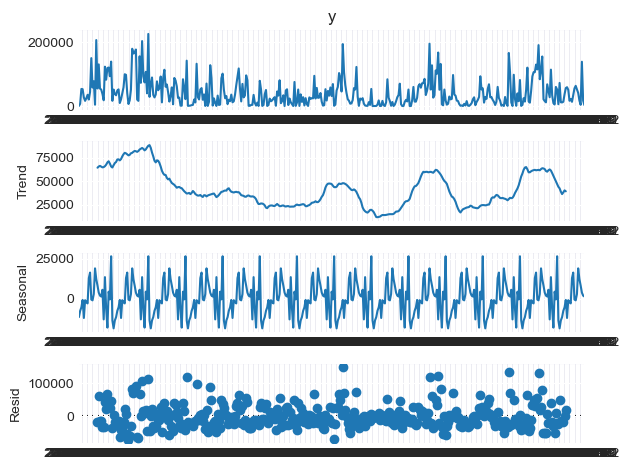

<Figure size 1500x1200 with 0 Axes>

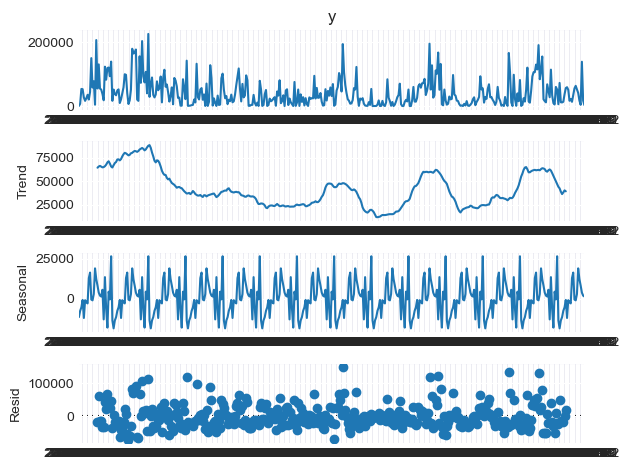

In [38]:
plt.figure(figsize=(15,12))
series = df_stage.y
result = seasonal_decompose(series, model='additive',period=30)
result.plot()

In [39]:
df_stage = df_stage.reset_index()
test_length = 365
split_date = "2023-01-31"
train_filt = df_stage['ds'] <= split_date
test_filt = df_stage['ds'] > split_date

train_fb = df_stage[train_filt]
test_fb = df_stage[test_filt]

print("train data shape :", train_fb.shape[0] / df_stage.shape[0] * 100)
print("test data shape :", test_fb.shape[0] / df_stage.shape[0] * 100)

train data shape : 94.62102689486552
test data shape : 5.378973105134474


In [40]:
from autots import AutoTS

In [41]:
model = AutoTS(forecast_length=30, frequency='infer', 
               ensemble='simple',max_generations=15,no_negatives=True,model_list='fast')
model = model.fit(train_fb, date_col='ds', value_col='y', id_col=None)

Inferred frequency is: D
Model Number: 1 with model AverageValueNaive in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model DatepartRegression in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 7 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 7: DatepartRegression
Model Number: 8 with model ETS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model GLM in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLS in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model LastValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 14: LastValueNaive
Model Number: 15 with model LastValueNaive in generation 0 of 15
Model Number: 16 with model LastValueNaive in generation 0 of 15
Model Number: 17 with model LastValueNaive in generation 0 of 15
Model Number: 18 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 18: SeasonalNaive
Model Number: 19 with model SeasonalNaive in generation 0 of 15
Model Number: 20 with model SeasonalNaive in generation 0 of 15
Model Number: 21 with model VAR in generation 0 of 15
Template Eval Er

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 29 with model DatepartRegression in generation 0 of 15
Model Number: 30 with model ETS in generation 0 of 15
Model Number: 31 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 31: VECM
Model Number: 32 with model MultivariateMotif in generation 0 of 15
Model Number: 33 with model MultivariateMotif in generation 0 of 15
Model Number: 34 with model UnivariateMotif in generation 0 of 15
Model Number: 35 with model UnivariateMotif in generation 0 of 15
Model Number: 36 with model SectionalMotif in generation 0 of 15
Model Number: 37 with model SectionalMotif in generation 0 of 15
Model Number: 38 with model SeasonalNaive in generation 0 of 15
Model Number: 39 with model DatepartRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 40 with model NVAR in generation 0 of 15
Model Number: 41 with model Cassandra in generation 0 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 41: Cassandra
Model Number: 42 with model ConstantNaive in generation 0 of 15
Model Number: 43 with model LastValueNaive in generation 0 of 15
Model Number: 44 with model AverageValueNaive in generation 0 of 15
Model Number: 45 with model GLS in generation 0 of 15
Model Number: 46 with model SeasonalNaive in generation 0 of 15
Model Number: 47 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 47: GLM
Model Number: 48 with model ETS in generation 0 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 56 with model NVAR in generation 0 of 15
Model Number: 57 with model MAR in generation 0 of 15
Model Number: 58 with model RRVAR in generation 0 of 15
Model Number: 59 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 59: KalmanStateSpace
Model Number: 60 with model MetricMotif in generation 0 of 15
Model Number: 61 with model Cassandra in generation 0 of 15
Model Number: 62 with model SeasonalityMotif in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 63 with model WindowRegression in generation 0 of 15
Model Number: 64 with model SeasonalNaive in generation 0 of 15
Model Number: 65 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 65: SectionalMotif
Model Number: 66 with model SectionalMotif in generation 0 of 15
Model Number: 67 with model SeasonalNaive in generation 0 of 15
Model Number: 68 with model RRVAR in generation 0 of 15
Model Number: 69 with model UnivariateMotif in generation 0 of 15
Model Number: 70 with model MetricMotif in generation 0 of 15
Model Number: 71 with model WindowRegression in generation 0 of 15
Model Number: 72 with model ETS in generation 0 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 73 with model VECM

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 91 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 91: VECM
Model Number: 92 with model ConstantNaive in generation 0 of 15
Model Number: 93 with model KalmanStateSpace in generation 0 of 15
Model Number: 94 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 94: DatepartRegression
Model Number: 95 with model SectionalMotif in generation 0 of 15
Model Number: 96 with model ETS in generation 0 of 15
Model Number: 97 with model GLS in generation 0 of 15
Model Number: 98 with model Cassandra in generation 0 of 15
Model Number: 99 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 99: SectionalMotif
Model Number: 100 with model RRVAR in generation 0 of 15
Model Number: 101 with model MAR in generation 0 of 15
Template Eval Error: Valu

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 105 with model ConstantNaive in generation 0 of 15
Model Number: 106 with model AverageValueNaive in generation 0 of 15
Model Number: 107 with model MultivariateMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 108 with model SeasonalNaive in generation 0 of 15
Model Number: 109 with model SeasonalityMotif in generation 0 of 15
Model Number: 110 with model NVAR in generation 0 of 15
Model Number: 111 with model MetricMotif in generation 0 of 15
Model Number: 112 with model WindowRegression in generation 0 of 15
Model Number: 113 with model ConstantNaive in generation 0 of 15
Model Number: 114 with model WindowRegression in generation 0 of 15
Model Number: 115 with model MetricMotif in generation 0 of 15
Model Number: 116 with model GLM in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 117 with model ETS in generation 0 of 15
Model Number: 118 with model UnivariateMotif in generation 0 of 15
Model Number: 119 with model MultivariateMotif in generation 0 of 15
Model Number: 120 with model AverageValueNaive in generation 0 of 15
Model Number: 121 with model MetricMotif in generation 0 of 15
Model Number: 122 with model SeasonalityMotif in generation 0 of 15
Model Number: 123 with model UnivariateMotif in generation 0 of 15
Model Number: 124 with model NVAR in generation 0 of 15
Model Number: 125 with model VECM in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 125: VECM
Model Number: 126 with model Cassandra in generation 0 of 15
Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model MultivariateMotif in generation 0 of 15
Model Number: 129 with model MultivariateMotif in generation 0 of 15
Model Number: 130 with model ConstantNaive in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 172 with model MultivariateMotif in generation 1 of 15
Model Number: 173 with model Cassandra in generation 1 of 15
Model Number: 174 with model SeasonalNaive in generation 1 of 15
Model Number: 175 with model RRVAR in generation 1 of 15
Model Number: 176 with model DatepartRegression in generation 1 of 15
Model Number: 177 with model AverageValueNaive in generation 1 of 15
Model Number: 178 with model MetricMotif in generation 1 of 15
Model Number: 179 with model KalmanStateSpace in generation 1 of 15
Model Number: 180 with model ETS in generation 1 of 15
Model Number: 181 with model Cassandra in generation 1 of 15
Model Number: 182 with model AverageValueNaive in generation 1 of 15
Model Number: 183 with model DatepartRegression in generation 1 of 15
Model Number: 184 with model RRVAR in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 185 with model SeasonalNaive in generation 1 of 15
Model Number: 186 with model RRVAR in generation 1 of 15
Model Number: 187 with model ETS in generation 1 of 15
Model Number: 188 with model AverageValueNaive in generation 1 of 15
Model Number: 189 with model SectionalMotif in generation 1 of 15
Model Number: 190 with model MultivariateMotif in generation 1 of 15
Model Number: 191 with model KalmanStateSpace in generation 1 of 15
Model Number: 192 with model ConstantNaive in generation 1 of 15
Model Number: 193 with model MetricMotif in generation 1 of 15
Model Number: 194 with model GLS in generation 1 of 15
Model Number: 195 with model Cassandra in generation 1 of 15
Model Number: 196 with model DatepartRegression in generation 1 of 15
Model Number: 197 with model Cassandra in generation 1 of 15
Model Number: 198 with model LastValueNaive in generation 1 of 15
Model Number: 199 with model SectionalMotif in generation 1 of 15
Model Number: 200 with model MultivariateMot

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 210 with model SeasonalityMotif in generation 1 of 15
Model Number: 211 with model NVAR in generation 1 of 15
Model Number: 212 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 212: SeasonalNaive
Model Number: 213 with model NVAR in generation 1 of 15
Model Number: 214 with model LastValueNaive in generation 1 of 15
Model Number: 215 with model ETS in generation 1 of 15
Model Number: 216 with model WindowRegression in generation 1 of 15
Model Number: 217 with model UnivariateMotif in generation 1 of 15
Model Number: 218 with model SeasonalNaive in generation 1 of 15
Model Number: 219 with model WindowRegression in generation 1 of 15
Model Number: 220 with model MAR in generation 1 of 15
Model Number: 221 with model DatepartRegression in generation 1 of 15
Model Number: 222 with model RRVAR in generation 1 of 15
Model Number: 223 with model AverageValueNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 224 with model NVAR in generation 1 of 15
Model Number: 225 with model WindowRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 225: WindowRegression
Model Number: 226 with model MetricMotif in generation 1 of 15
Model Number: 227 with model MultivariateMotif in generation 1 of 15
Model Number: 228 with model LastValueNaive in generation 1 of 15
Model Number: 229 with model SeasonalNaive in generation 1 of 15
Model Number: 230 with model UnivariateMotif in generation 1 of 15
Model Number: 231 with model MAR in generation 1 of 15
Model Number: 232 with model GLM in generation 1 of 15
Model Number: 233 with model MultivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 233: MultivariateMotif
Model Number: 234 with model GLM in generation 1 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be report

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 238 with model AverageValueNaive in generation 1 of 15
Model Number: 239 with model SectionalMotif in generation 1 of 15
Model Number: 240 with model SeasonalNaive in generation 1 of 15
Model Number: 241 with model ETS in generation 1 of 15
Model Number: 242 with model ETS in generation 1 of 15
Model Number: 243 with model GLS in generation 1 of 15
Model Number: 244 with model AverageValueNaive in generation 1 of 15
Model Number: 245 with model SectionalMotif in generation 1 of 15
Model Number: 246 with model UnivariateMotif in generation 1 of 15
Model Number: 247 with model Cassandra in generation 1 of 15
Model Number: 248 with model DatepartRegression in generation 1 of 15
Model Number: 249 with model DatepartRegression in generation 1 of 15
Model Number: 250 with model GLM in generation 1 of 15
Model Number: 251 with model AverageValueNaive in generation 1 of 15
New Generation: 2 of 15
Model Number: 252 with model AverageValueNaive in generation 2 of 15
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 276 with model ConstantNaive in generation 2 of 15
Model Number: 277 with model DatepartRegression in generation 2 of 15
Model Number: 278 with model SeasonalNaive in generation 2 of 15
Model Number: 279 with model Cassandra in generation 2 of 15
Model Number: 280 with model GLS in generation 2 of 15
Model Number: 281 with model ConstantNaive in generation 2 of 15
Model Number: 282 with model MetricMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 283 with model ETS in generation 2 of 15
Model Number: 284 with model SeasonalNaive in generation 2 of 15
Model Number: 285 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 285: AverageValueNaive
Model Number: 286 with model WindowRegression in generation 2 of 15
Model Number: 287 with model SectionalMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 287: SectionalMotif
Model Number: 288 with model MetricMotif in generation 2 of 15
Model Number: 289 with model AverageValueNaive in generation 2 of 15
Model Number: 290 with model DatepartRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 290: DatepartRegression
Model Number: 291 with model MultivariateMotif in generation 2 of 15
Model Number: 292 with model RRVAR in generation 2 of 15
Model Number: 293 with model RRVAR in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 301 with model MAR in generation 2 of 15
Template Eval Error: ValueError('Shape of passed values is (21, 1), indices imply (30, 1)') in model 301: MAR
Model Number: 302 with model SeasonalNaive in generation 2 of 15
Model Number: 303 with model ETS in generation 2 of 15
Model Number: 304 with model ETS in generation 2 of 15
Model Number: 305 with model MAR in generation 2 of 15
Model Number: 306 with model GLM in generation 2 of 15
Model Number: 307 with model MultivariateMotif in generation 2 of 15
Model Number: 308 with model ETS in generation 2 of 15
Model Number: 309 with model RRVAR in generation 2 of 15
Model Number: 310 with model GLM in generation 2 of 15
Model Number: 311 with model UnivariateMotif in generation 2 of 15
Model Number: 312 with model DatepartRegression in generation 2 of 15
Epoch 1/200
19/19 [==============================] - 3s 81ms/step - loss: 3720.0854 - val_loss: 1143.8311
Epoch 2/200
19/19 [==============================] - 1s 48ms/step - los

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: overflow encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:341: RuntimeWarning: overflow encountered in po

Model Number: 319 with model MAR in generation 2 of 15
Model Number: 320 with model NVAR in generation 2 of 15
Model Number: 321 with model WindowRegression in generation 2 of 15
Model Number: 322 with model Cassandra in generation 2 of 15
Model Number: 323 with model LastValueNaive in generation 2 of 15
Model Number: 324 with model LastValueNaive in generation 2 of 15
Model Number: 325 with model AverageValueNaive in generation 2 of 15
Model Number: 326 with model Cassandra in generation 2 of 15
Model Number: 327 with model MultivariateMotif in generation 2 of 15
Model Number: 328 with model KalmanStateSpace in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 329 with model SectionalMotif in generation 2 of 15
Model Number: 330 with model GLS in generation 2 of 15
Model Number: 331 with model MetricMotif in generation 2 of 15
Model Number: 332 with model AverageValueNaive in generation 2 of 15
Model Number: 333 with model SeasonalityMotif in generation 2 of 15
Model Number: 334 with model LastValueNaive in generation 2 of 15
Model Number: 335 with model SeasonalNaive in generation 2 of 15
Model Number: 336 with model SeasonalNaive in generation 2 of 15
Model Number: 337 with model RRVAR in generation 2 of 15
Model Number: 338 with model RRVAR in generation 2 of 15
Model Number: 339 with model RRVAR in generation 2 of 15
Model Number: 340 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 340: DatepartRegression
Model Number: 341 with model WindowRegression in generation 2 of 15
Model Number: 342 with model GLM in generation 2 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 346 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 347 with model WindowRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 347: WindowRegression
Model Number: 348 with model UnivariateMotif in generation 2 of 15
Model Number: 349 with model GLM in generation 2 of 15
Model Number: 350 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 350: ETS
Model Number: 351 with model DatepartRegression in generation 2 of 15
Epoch 1/100
46/46 [==============================] - 4s 3ms/step - loss: 1.9175
Epoch 2/100
46/46 [==============================] - 0s 3ms/step - loss: 0.4481
Epoch 3/100
46/46 [==============================] - 0s 3ms/step - loss: 0.0408
Epoch 4/100
46/46 [==============================] - 0s 4ms/step - loss: 0.0636
Epoch 5/100
46/46 [==============================] - 0s 4ms/step - loss: 0.0418
Epoch 6/100
46/4

46/46 [==============================] - 0s 4ms/step - loss: 0.0226
Epoch 96/100
46/46 [==============================] - 0s 6ms/step - loss: 0.0197
Epoch 97/100
46/46 [==============================] - 0s 4ms/step - loss: 0.0194
Epoch 98/100
46/46 [==============================] - 0s 4ms/step - loss: 0.0224
Epoch 99/100
46/46 [==============================] - 0s 5ms/step - loss: 0.0213
Epoch 100/100
1/1 [==============================] - 1s 807ms/step
Model Number: 352 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 353 with model KalmanStateSpace in generation 2 of 15
Model Number: 354 with model DatepartRegression in generation 2 of 15
Model Number: 355 with model ConstantNaive in generation 2 of 15
Model Number: 356 with model GLS in generation 2 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 382 with model MetricMotif in generation 3 of 15
Model Number: 383 with model AverageValueNaive in generation 3 of 15
Model Number: 384 with model UnivariateMotif in generation 3 of 15
Model Number: 385 with model MAR in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 385: MAR
Model Number: 386 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 386: DatepartRegression
Model Number: 387 with model DatepartRegression in generation 3 of 15
Model Number: 388 with model SectionalMotif in generation 3 of 15
Model Number: 389 with model LastValueNaive in generation 3 of 15
Model Number: 390 with model AverageValueNaive in generation 3 of 15
Model Number: 391 with model ETS in generation 3 of 15
Model Number: 392 with model MAR in generation 3 of 15
Model Number: 393 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("re

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 398 with model WindowRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 398: WindowRegression
Model Number: 399 with model SeasonalNaive in generation 3 of 15
Model Number: 400 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 400: WindowRegression
Model Number: 401 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 401: WindowRegression
Model Number: 402 with model AverageValueNaive in generation 3 of 15
Model Number: 403 with model Cassandra in generation 3 of 15
Model Number: 404 with model UnivariateMotif in generation 3 of 15
Model Number: 405 with model MetricMotif in generation 3 of 15
Model Number: 406 with model UnivariateMotif in generation 3 of 15
Model Number: 407 with model UnivariateMotif in generation 3 of 15
Model Number: 408 with model ETS in generation 3 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 417 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 417: DatepartRegression
Model Number: 418 with model MetricMotif in generation 3 of 15
Model Number: 419 with model RRVAR in generation 3 of 15
Model Number: 420 with model ConstantNaive in generation 3 of 15
Model Number: 421 with model ETS in generation 3 of 15
Model Number: 422 with model SeasonalityMotif in generation 3 of 15
Model Number: 423 with model ETS in generation 3 of 15
Model Number: 424 with model UnivariateMotif in generation 3 of 15
Model Number: 425 with model GLM in generation 3 of 15
Model Number: 426 with model MultivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 427 with model RRVAR in generation 3 of 15
Model Number: 428 with model AverageValueNaive in generation 3 of 15
Model Number: 429 with model DatepartRegression in generation 3 of 15
Model Number: 430 with model MultivariateMotif in generation 3 of 15
Model Number: 431 with model DatepartRegression in generation 3 of 15
Model Number: 432 with model WindowRegression in generation 3 of 15
Model Number: 433 with model MultivariateMotif in generation 3 of 15
Model Number: 434 with model GLS in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 435 with model SeasonalNaive in generation 3 of 15
Model Number: 436 with model GLS in generation 3 of 15
Model Number: 437 with model SectionalMotif in generation 3 of 15
Model Number: 438 with model LastValueNaive in generation 3 of 15
Model Number: 439 with model GLM in generation 3 of 15
Model Number: 440 with model MetricMotif in generation 3 of 15
Model Number: 441 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 442 with model MultivariateMotif in generation 3 of 15
Model Number: 443 with model MetricMotif in generation 3 of 15
Model Number: 444 with model DatepartRegression in generation 3 of 15
Model Number: 445 with model SeasonalNaive in generation 3 of 15
Model Number: 446 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 446: GLM
Model Number: 447 with model MetricMotif in generation 3 of 15
Model Number: 448 with model SeasonalityMotif in generation 3 of 15
Model Number: 449 with model MultivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 450 with model ETS in generation 3 of 15
Model Number: 451 with model KalmanStateSpace in generation 3 of 15
Model Number: 452 with model MetricMotif in generation 3 of 15
Model Number: 453 with model Cassandra in generation 3 of 15
Model Number: 454 with model MAR in generation 3 of 15
Model Number: 455 with model GLS in generation 3 of 15
Model Number: 456 with model UnivariateMotif in generation 3 of 15
Model Number: 457 with model AverageValueNaive in generation 3 of 15
Model Number: 458 with model SeasonalNaive in generation 3 of 15
Model Number: 459 with model LastValueNaive in generation 3 of 15
Model Number: 460 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 460: DatepartRegression
Model Number: 461 with model NVAR in generation 3 of 15
New Generation: 4 of 15
Model Number: 462 with model UnivariateMotif in generation 4 of 15
Model Number: 463 with model GLS in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 481 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 481: WindowRegression
Model Number: 482 with model DatepartRegression in generation 4 of 15
Model Number: 483 with model MAR in generation 4 of 15
Model Number: 484 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 485 with model UnivariateMotif in generation 4 of 15
Model Number: 486 with model GLM in generation 4 of 15
Model Number: 487 with model SeasonalNaive in generation 4 of 15
Model Number: 488 with model ConstantNaive in generation 4 of 15
Model Number: 489 with model RRVAR in generation 4 of 15
Model Number: 490 with model MetricMotif in generation 4 of 15
Model Number: 491 with model ETS in generation 4 of 15
Model Number: 492 with model SeasonalNaive in generation 4 of 15
Model Number: 493 with model AverageValueNaive in generation 4 of 15
Model Number: 494 with model LastValueNaive in generation 4 of 15
Model Number: 495 with model MAR in generation 4 of 15
Model Number: 496 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 496: DatepartRegression
Model Number: 497 with model MetricMotif in generation 4 of 15
Model Number: 498 with model MultivariateMotif in generation 4 of 15
Model Number: 499 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 506 with model ETS in generation 4 of 15
Model Number: 507 with model AverageValueNaive in generation 4 of 15
Model Number: 508 with model SeasonalNaive in generation 4 of 15
Model Number: 509 with model DatepartRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 510 with model WindowRegression in generation 4 of 15
Model Number: 511 with model AverageValueNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 512 with model KalmanStateSpace in generation 4 of 15
Model Number: 513 with model SeasonalityMotif in generation 4 of 15
Model Number: 514 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 514: SeasonalNaive
Model Number: 515 with model DatepartRegression in generation 4 of 15
Model Number: 516 with model GLS in generation 4 of 15
Model Number: 517 with model WindowRegression in generation 4 of 15
Template Eval Error: LightGBMError('[gamma]: at least one target label is negative') in model 517: WindowRegression
Model Number: 518 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 518: RRVAR
Model Number: 519 with model NVAR in generation 4 of 15
Model Number: 520 with model MetricMotif in generation 4 of 15
Model Number: 521 with model GLM in generation 4 of 15
Model Number: 522 with model WindowRegression in generation 4 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 524 with model GLM in generation 4 of 15
Model Number: 525 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 525: AverageValueNaive
Model Number: 526 with model LastValueNaive in generation 4 of 15
Model Number: 527 with model ETS in generation 4 of 15
Model Number: 528 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (545,1) (546,1) ') in model 528: Cassandra
Model Number: 529 with model UnivariateMotif in generation 4 of 15
Model Number: 530 with model RRVAR in generation 4 of 15
Model Number: 531 with model MultivariateMotif in generation 4 of 15
Model Number: 532 with model NVAR in generation 4 of 15
Model Number: 533 with model AverageValueNaive in generation 4 of 15
Model Number: 534 with model ConstantNaive in generation 4 of 15
Model Number: 535 with model SeasonalNaive in generation 4 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 555 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 555: WindowRegression
Model Number: 556 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 556: Cassandra
Model Number: 557 with model MAR in generation 4 of 15
Model Number: 558 with model SeasonalNaive in generation 4 of 15
Model Number: 559 with model WindowRegression in generation 4 of 15
Model Number: 560 with model UnivariateMotif in generation 4 of 15
Model Number: 561 with model MAR in generation 4 of 15
Model Number: 562 with model MetricMotif in generation 4 of 15
Model Number: 563 with model MetricMotif in generation 4 of 15
Model Number: 564 with model SectionalMotif in generation 4 of 15
Model Number: 565 with model LastValueNaive in generation 4 of 15
Model Number: 566 with model LastValueNaive in generation 4 of 15
New Generation: 5 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


Model Number: 589 with model MultivariateMotif in generation 5 of 15
Model Number: 590 with model ETS in generation 5 of 15
Model Number: 591 with model MultivariateMotif in generation 5 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 591: MultivariateMotif
Model Number: 592 with model SeasonalityMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 593 with model MAR in generation 5 of 15
Model Number: 594 with model RRVAR in generation 5 of 15
Model Number: 595 with model GLS in generation 5 of 15
Model Number: 596 with model AverageValueNaive in generation 5 of 15
Model Number: 597 with model SeasonalityMotif in generation 5 of 15
Model Number: 598 with model SeasonalNaive in generation 5 of 15
Model Number: 599 with model AverageValueNaive in generation 5 of 15
Model Number: 600 with model GLM in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 601 with model SeasonalNaive in generation 5 of 15
Model Number: 602 with model GLS in generation 5 of 15
Model Number: 603 with model UnivariateMotif in generation 5 of 15
Model Number: 604 with model RRVAR in generation 5 of 15
Model Number: 605 with model AverageValueNaive in generation 5 of 15
Model Number: 606 with model ETS in generation 5 of 15
Model Number: 607 with model GLS in generation 5 of 15
Model Number: 608 with model UnivariateMotif in generation 5 of 15
Model Number: 609 with model MultivariateMotif in generation 5 of 15
Model Number: 610 with model WindowRegression in generation 5 of 15
Model Number: 611 with model MultivariateMotif in generation 5 of 15
Model Number: 612 with model MetricMotif in generation 5 of 15
Model Number: 613 with model SectionalMotif in generation 5 of 15
Model Number: 614 with model SectionalMotif in generation 5 of 15
Model Number: 615 with model DatepartRegression in generation 5 of 15
Model Number: 616 with model GLM in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 635 with model Cassandra in generation 5 of 15
Model Number: 636 with model MetricMotif in generation 5 of 15
Model Number: 637 with model SeasonalNaive in generation 5 of 15
Model Number: 638 with model SeasonalNaive in generation 5 of 15
Model Number: 639 with model MultivariateMotif in generation 5 of 15
Model Number: 640 with model SeasonalNaive in generation 5 of 15
Model Number: 641 with model MetricMotif in generation 5 of 15
Model Number: 642 with model ETS in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 643 with model WindowRegression in generation 5 of 15
Model Number: 644 with model RRVAR in generation 5 of 15
Model Number: 645 with model ETS in generation 5 of 15
Model Number: 646 with model ETS in generation 5 of 15
Model Number: 647 with model GLM in generation 5 of 15
Model Number: 648 with model Cassandra in generation 5 of 15
Model Number: 649 with model MetricMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 649: MetricMotif
Model Number: 650 with model SeasonalNaive in generation 5 of 15
New Generation: 6 of 15
Model Number: 651 with model SectionalMotif in generation 6 of 15
Model Number: 652 with model AverageValueNaive in generation 6 of 15
Model Number: 653 with model MetricMotif in generation 6 of 15
Model Number: 654 with model WindowRegression in generation 6 of 15
Model Number: 655 with model UnivariateMotif in generation 6 of 15
Model Number: 656 with model LastValueNaive in generation 6 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 662 with model DatepartRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.2s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 663 with model SeasonalNaive in generation 6 of 15
Model Number: 664 with model MultivariateMotif in generation 6 of 15
Model Number: 665 with model MetricMotif in generation 6 of 15
Model Number: 666 with model SectionalMotif in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 666: SectionalMotif
Model Number: 667 with model MultivariateMotif in generation 6 of 15
Model Number: 668 with model MAR in generation 6 of 15
Model Number: 669 with model GLS in generation 6 of 15
Model Number: 670 with model WindowRegression in generation 6 of 15
Model Number: 671 with model MAR in generation 6 of 15
Template Eval Error: ValueError('Shape of passed values is (14, 1), indices imply (30, 1)') in model 671: MAR
Model Number: 672 with model SeasonalNaive in generation 6 of 15
Model Number: 673 with model DatepartRegression in generation 6 of 15
Epoch 1/50
23/23 [==============================] - 6s 8ms/step - loss: 3502725376.0

Model Number: 713 with model GLS in generation 6 of 15
Model Number: 714 with model MetricMotif in generation 6 of 15
Model Number: 715 with model RRVAR in generation 6 of 15
Model Number: 716 with model AverageValueNaive in generation 6 of 15
Model Number: 717 with model SectionalMotif in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 717: SectionalMotif
Model Number: 718 with model MetricMotif in generation 6 of 15
Model Number: 719 with model WindowRegression in generation 6 of 15
Model Number: 720 with model UnivariateMotif in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 720: UnivariateMotif
Model Number: 721 with model UnivariateMotif in generation 6 of 15
Model Number: 722 with model SectionalMotif in generation 6 of 15
Model Number: 723 with model SeasonalNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 724 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 724: GLM
Model Number: 725 with model MetricMotif in generation 6 of 15
Model Number: 726 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 726: DatepartRegression
Model Number: 727 with model WindowRegression in generation 6 of 15
Model Number: 728 with model DatepartRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 729 with model WindowRegression in generation 6 of 15
Model Number: 730 with model ETS in generation 6 of 15
Model Number: 731 with model GLS in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 732 with model SeasonalNaive in generation 6 of 15
Model Number: 733 with model AverageValueNaive in generation 6 of 15
Model Number: 734 with model ETS in generation 6 of 15
New Generation: 7 of 15
Model Number: 735 with model ETS in generation 7 of 15
Model Number: 736 with model WindowRegression in generation 7 of 15
Model Number: 737 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 738 with model SectionalMotif in generation 7 of 15
Model Number: 739 with model MetricMotif in generation 7 of 15
Model Number: 740 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 740: AverageValueNaive
Model Number: 741 with model GLM in generation 7 of 15
Model Number: 742 with model WindowRegression in generation 7 of 15
Model Number: 743 with model DatepartRegression in generation 7 of 15
Model Number: 744 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 744: DatepartRegression
Model Number: 745 with model UnivariateMotif in generation 7 of 15
Model Number: 746 with model MAR in generation 7 of 15
Template Eval Error: ValueError('Shape of passed values is (21, 1), indices imply (30, 1)') in model 746: MAR
Model Number: 747 with model MultivariateMotif in generation 7 of 15
Model N

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    1.2s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 752 with model GLS in generation 7 of 15
Model Number: 753 with model ETS in generation 7 of 15
Model Number: 754 with model MetricMotif in generation 7 of 15
Model Number: 755 with model ETS in generation 7 of 15
Model Number: 756 with model GLS in generation 7 of 15
Model Number: 757 with model MetricMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 757: MetricMotif
Model Number: 758 with model DatepartRegression in generation 7 of 15
Epoch 1/200
12/12 [==============================] - 5s 33ms/step - loss: 5391474.0000
Epoch 2/200
12/12 [==============================] - 0s 33ms/step - loss: 1829551.2500
Epoch 3/200
12/12 [==============================] - 0s 33ms/step - loss: 1813854.6250
Epoch 4/200
12/12 [==============================] - 0s 34ms/step - loss: 1584358.3750
Epoch 5/200
12/12 [==============================] - 0s 36ms/step - loss: 600313.5000
Epoch 6/200
12/12 [============================

12/12 [==============================] - 1s 48ms/step - loss: 145739.2812
Epoch 184/200
12/12 [==============================] - 1s 47ms/step - loss: 94325.5469
Epoch 185/200
12/12 [==============================] - 1s 50ms/step - loss: 33325.9922
Epoch 186/200
12/12 [==============================] - 1s 61ms/step - loss: 47399.5547
Epoch 187/200
12/12 [==============================] - 1s 61ms/step - loss: 51654.5898
Epoch 188/200
12/12 [==============================] - 1s 44ms/step - loss: 48780.7969
Epoch 189/200
12/12 [==============================] - 1s 46ms/step - loss: 65913.7344
Epoch 190/200
12/12 [==============================] - 1s 42ms/step - loss: 39127.2656
Epoch 191/200
12/12 [==============================] - 1s 42ms/step - loss: 39370.6445
Epoch 192/200
12/12 [==============================] - 1s 43ms/step - loss: 48471.5273
Epoch 193/200
12/12 [==============================] - 0s 39ms/step - loss: 49450.2539
Epoch 194/200
12/12 [==============================] - 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 772 with model Cassandra in generation 7 of 15
Model Number: 773 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 774 with model WindowRegression in generation 7 of 15
Model Number: 775 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 775: AverageValueNaive
Model Number: 776 with model SectionalMotif in generation 7 of 15
Model Number: 777 with model GLM in generation 7 of 15
Model Number: 778 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 778: SeasonalNaive
Model Number: 779 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 780 with model SeasonalNaive in generation 7 of 15
Model Number: 781 with model LastValueNaive in generation 7 of 15
Model Number: 782 with model ETS in generation 7 of 15
Model Number: 783 with model WindowRegression in generation 7 of 15
Model Number: 784 with model WindowRegression in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 784: WindowRegression
Model Number: 785 with model MetricMotif in generation 7 of 15
Model Number: 786 with model UnivariateMotif in generation 7 of 15
Model Number: 787 with model UnivariateMotif in generation 7 of 15
Model Number: 788 with model SeasonalNaive in generation 7 of 15
Model Number: 789 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 790 with model RRV

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 821 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 821: WindowRegression
Model Number: 822 with model GLM in generation 8 of 15
Model Number: 823 with model SeasonalNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)


Model Number: 824 with model DatepartRegression in generation 8 of 15
Model Number: 825 with model SeasonalNaive in generation 8 of 15
Model Number: 826 with model MultivariateMotif in generation 8 of 15
Model Number: 827 with model SeasonalNaive in generation 8 of 15
Model Number: 828 with model GLS in generation 8 of 15
Model Number: 829 with model DatepartRegression in generation 8 of 15
Epoch 1/50
10/10 [==============================] - 7s 189ms/step - loss: nan - val_loss: nan
Epoch 2/50
10/10 [==============================] - 1s 97ms/step - loss: nan - val_loss: nan
Epoch 3/50
10/10 [==============================] - 1s 106ms/step - loss: nan - val_loss: nan
Epoch 4/50
10/10 [==============================] - 1s 105ms/step - loss: nan - val_loss: nan
Epoch 5/50
10/10 [==============================] - 1s 108ms/step - loss: nan - val_loss: nan
Epoch 6/50
10/10 [==============================] - 1s 115ms/step - loss: nan - val_loss: nan
Epoch 7/50
10/10 [=========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 839 with model MAR in generation 8 of 15
Model Number: 840 with model AverageValueNaive in generation 8 of 15
Model Number: 841 with model UnivariateMotif in generation 8 of 15
Model Number: 842 with model MetricMotif in generation 8 of 15
Model Number: 843 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'bkfilter', '1': 'SeasonalDifference', '2': 'RobustScaler', '3': 'MaxAbsScaler', '4': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {'lag_1': 79, 'method': 'LastValue'}, '2': {}, '3': {}, '4': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 843: UnivariateMotif
Model Number: 844 with model AverageValueNaive in generation 8 of 15
Model Number: 845 with model SeasonalityMotif in generation 8 of 15
Model Number: 846 with model Cassandra in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 891 with model ETS in generation 8 of 15
Model Number: 892 with model RRVAR in generation 8 of 15
Model Number: 893 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 893: RRVAR
Model Number: 894 with model ETS in generation 8 of 15
Model Number: 895 with model AverageValueNaive in generation 8 of 15
Model Number: 896 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 896: AverageValueNaive
Model Number: 897 with model WindowRegression in generation 8 of 15
Model Number: 898 with model UnivariateMotif in generation 8 of 15
Model Number: 899 with model DatepartRegression in generation 8 of 15
Model Number: 900 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


Model Number: 901 with model WindowRegression in generation 8 of 15
Model Number: 902 with model ETS in generation 8 of 15
New Generation: 9 of 15
Model Number: 903 with model UnivariateMotif in generation 9 of 15
Model Number: 904 with model MetricMotif in generation 9 of 15
Model Number: 905 with model SeasonalityMotif in generation 9 of 15
Model Number: 906 with model SeasonalityMotif in generation 9 of 15
Model Number: 907 with model UnivariateMotif in generation 9 of 15
Model Number: 908 with model SeasonalNaive in generation 9 of 15
Model Number: 909 with model MAR in generation 9 of 15
Model Number: 910 with model DatepartRegression in generation 9 of 15
Epoch 1/50
10/10 [==============================] - 2s 51ms/step - loss: 101691.0312 - val_loss: 65722.3984
Epoch 2/50
10/10 [==============================] - 0s 25ms/step - loss: 90408.4766 - val_loss: 40475.7617
Epoch 3/50
10/10 [==============================] - 0s 26ms/step - loss: 85069.0469 - val_loss: 107436.6172
Epoch 4

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 922 with model DatepartRegression in generation 9 of 15
Model Number: 923 with model SeasonalNaive in generation 9 of 15
Model Number: 924 with model GLM in generation 9 of 15
Model Number: 925 with model Cassandra in generation 9 of 15
Model Number: 926 with model ETS in generation 9 of 15
Model Number: 927 with model GLS in generation 9 of 15
Model Number: 928 with model AverageValueNaive in generation 9 of 15
Model Number: 929 with model ETS in generation 9 of 15
Model Number: 930 with model DatepartRegression in generation 9 of 15
Model Number: 931 with model MAR in generation 9 of 15
Model Number: 932 with model MAR in generation 9 of 15
Template Eval Error: ValueError('Shape of passed values is (21, 1), indices imply (30, 1)') in model 932: MAR
Model Number: 933 with model UnivariateMotif in generation 9 of 15
Model Number: 934 with model WindowRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 934:

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 961 with model SeasonalNaive in generation 9 of 15
Model Number: 962 with model WindowRegression in generation 9 of 15
Model Number: 963 with model ETS in generation 9 of 15
Model Number: 964 with model DatepartRegression in generation 9 of 15
Model Number: 965 with model MetricMotif in generation 9 of 15
Model Number: 966 with model ETS in generation 9 of 15
Model Number: 967 with model UnivariateMotif in generation 9 of 15
Model Number: 968 with model MAR in generation 9 of 15
Model Number: 969 with model DatepartRegression in generation 9 of 15
Epoch 1/100
Template Eval Error: InvalidArgumentError() in model 969: DatepartRegression
Model Number: 970 with model WindowRegression in generation 9 of 15
Model Number: 971 with model MultivariateMotif in generation 9 of 15
Model Number: 972 with model MultivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 972: MultivariateMotif
Model Number: 973 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 977 with model WindowRegression in generation 9 of 15
Model Number: 978 with model SeasonalityMotif in generation 9 of 15
Model Number: 979 with model WindowRegression in generation 9 of 15
Model Number: 980 with model DatepartRegression in generation 9 of 15
Model Number: 981 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 982 with model MultivariateMotif in generation 9 of 15
Model Number: 983 with model MAR in generation 9 of 15
Model Number: 984 with model MetricMotif in generation 9 of 15
Model Number: 985 with model MetricMotif in generation 9 of 15
Model Number: 986 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 986: Cassandra
New Generation: 10 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 997 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(364, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 997: Cassandra
Model Number: 998 with model SeasonalNaive in generation 10 of 15
Model Number: 999 with model GLM in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1000 with model SeasonalNaive in generation 10 of 15
Model Number: 1001 with model DatepartRegression in generation 10 of 15
Model Number: 1002 with model MultivariateMotif in generation 10 of 15
Model Number: 1003 with model AverageValueNaive in generation 10 of 15
Model Number: 1004 with model UnivariateMotif in generation 10 of 15
Model Number: 1005 with model MetricMotif in generation 10 of 15
Model Number: 1006 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1006: SeasonalNaive
Model Number: 1007 with model UnivariateMotif in generation 10 of 15
Model Number: 1008 with model UnivariateMotif in generation 10 of 15
Model Number: 1009 with model MultivariateMotif in generation 10 of 15
Model Number: 1010 with model SectionalMotif in generation 10 of 15
Model Number: 1011 with model ETS in generation 10 of 15
Model Number: 1012 with model MAR in generation 10 of 15
Model Number: 1013 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1035 with model MultivariateMotif in generation 10 of 15
Model Number: 1036 with model ETS in generation 10 of 15
Model Number: 1037 with model MultivariateMotif in generation 10 of 15
Model Number: 1038 with model MetricMotif in generation 10 of 15
Model Number: 1039 with model SeasonalNaive in generation 10 of 15
Model Number: 1040 with model DatepartRegression in generation 10 of 15
Model Number: 1041 with model UnivariateMotif in generation 10 of 15
Model Number: 1042 with model SeasonalNaive in generation 10 of 15
Model Number: 1043 with model SeasonalNaive in generation 10 of 15
Model Number: 1044 with model MAR in generation 10 of 15
Template Eval Error: ValueError('Shape of passed values is (14, 1), indices imply (30, 1)') in model 1044: MAR
Model Number: 1045 with model ETS in generation 10 of 15
Model Number: 1046 with model SeasonalNaive in generation 10 of 15
Model Number: 1047 with model ETS in generation 10 of 15
Model Number: 1048 with model MAR in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Template Eval Error: KeyError('model') in model 1052: Cassandra
Model Number: 1053 with model UnivariateMotif in generation 11 of 15
Model Number: 1054 with model MultivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1054: MultivariateMotif
Model Number: 1055 with model WindowRegression in generation 11 of 15
Model Number: 1056 with model AverageValueNaive in generation 11 of 15
Model Number: 1057 with model GLM in generation 11 of 15
Model Number: 1058 with model MultivariateMotif in generation 11 of 15
Model Number: 1059 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1060 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1060: SectionalMotif
Model Number: 1061 with model RRVAR in generation 11 of 15
Model Number: 1062 with model RRVAR in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1062: RRVAR
Model Number: 1063 with model ETS in generation 11 of 15
Model Number: 1064 with model MAR in generation 11 of 15
Model Number: 1065 with model MultivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1065: MultivariateMotif
Model Number: 1066 with model MultivariateMotif in generation 11 of 15
Model Number: 1067 with model Cassandra in generation 11 of 15
Model Number: 1068 with model UnivariateMotif in generation 11 of 15
Model Number: 1069 with model SeasonalNaive in generation 11 of 15
Model Number: 1070 with model UnivariateM

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1093 with model MetricMotif in generation 11 of 15
Model Number: 1094 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1094: DatepartRegression
Model Number: 1095 with model AverageValueNaive in generation 11 of 15
Model Number: 1096 with model SeasonalNaive in generation 11 of 15
Model Number: 1097 with model UnivariateMotif in generation 11 of 15
Model Number: 1098 with model WindowRegression in generation 11 of 15
Model Number: 1099 with model DatepartRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1100 with model SeasonalNaive in generation 11 of 15
Model Number: 1101 with model UnivariateMotif in generation 11 of 15
Model Number: 1102 with model GLS in generation 11 of 15
Model Number: 1103 with model ETS in generation 11 of 15
Model Number: 1104 with model DatepartRegression in generation 11 of 15
Model Number: 1105 with model AverageValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1105: AverageValueNaive
Model Number: 1106 with model WindowRegression in generation 11 of 15
Model Number: 1107 with model WindowRegression in generation 11 of 15
Model Number: 1108 with model WindowRegression in generation 11 of 15
Model Number: 1109 with model WindowRegression in generation 11 of 15
Model Number: 1110 with model UnivariateMotif in generation 11 of 15
Model Number: 1111 with model ETS in generation 11 of 15
Model Number: 1112 with model Cassandra in generation 11 of 15
New Generation: 12 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1118 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 1118: Cassandra
Model Number: 1119 with model MetricMotif in generation 12 of 15
Model Number: 1120 with model MultivariateMotif in generation 12 of 15
Model Number: 1121 with model SeasonalNaive in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1121: SeasonalNaive
Model Number: 1122 with model DatepartRegression in generation 12 of 15
Model Number: 1123 with model WindowRegression in generation 12 of 15
Model Number: 1124 with model SeasonalNaive in generation 12 of 15
Model Number: 1125 with model SeasonalNaive in generation 12 of 15
Model Number: 1126 with model Cassandra in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1127 with model AverageValueNaive in generation 12 of 15
Model Number: 1128 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1128: Cassandra
Model Number: 1129 with model Cassandra in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1130 with model ETS in generation 12 of 15
Model Number: 1131 with model SeasonalNaive in generation 12 of 15
Model Number: 1132 with model ETS in generation 12 of 15
Model Number: 1133 with model ETS in generation 12 of 15
Model Number: 1134 with model WindowRegression in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1134: WindowRegression
Model Number: 1135 with model UnivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1136 with model Cassandra in generation 12 of 15
Model Number: 1137 with model Cassandra in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1138 with model WindowRegression in generation 12 of 15
Model Number: 1139 with model UnivariateMotif in generation 12 of 15
Model Number: 1140 with model SeasonalNaive in generation 12 of 15
Model Number: 1141 with model AverageValueNaive in generation 12 of 15
Model Number: 1142 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1142: DatepartRegression
Model Number: 1143 with model MetricMotif in generation 12 of 15
Model Number: 1144 with model SeasonalNaive in generation 12 of 15
Model Number: 1145 with model MetricMotif in generation 12 of 15
Model Number: 1146 with model WindowRegression in generation 12 of 15
Model Number: 1147 with model DatepartRegression in generation 12 of 15
Epoch 1/50
46/46 [==============================] - 5s 6ms/step - loss: 0.1422
Epoch 2/50
46/46 [==============================] - 0s 6ms/step - loss: 0.1388
Epoch 3/50
46/46 [============================

Model Number: 1193 with model MultivariateMotif in generation 13 of 15
Model Number: 1194 with model GLS in generation 13 of 15
Model Number: 1195 with model AverageValueNaive in generation 13 of 15
Model Number: 1196 with model UnivariateMotif in generation 13 of 15
Model Number: 1197 with model Cassandra in generation 13 of 15
Model Number: 1198 with model UnivariateMotif in generation 13 of 15
Model Number: 1199 with model ETS in generation 13 of 15
Model Number: 1200 with model UnivariateMotif in generation 13 of 15
Model Number: 1201 with model UnivariateMotif in generation 13 of 15
Model Number: 1202 with model AverageValueNaive in generation 13 of 15
Model Number: 1203 with model SeasonalNaive in generation 13 of 15
Model Number: 1204 with model MultivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1204: MultivariateMotif
Model Number: 1205 with model UnivariateMotif in generation 13 of 15
Model Number: 1206 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1217 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1217: DatepartRegression
Model Number: 1218 with model MAR in generation 13 of 15
Template Eval Error: ValueError('Shape of passed values is (14, 1), indices imply (30, 1)') in model 1218: MAR
Model Number: 1219 with model GLS in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1219: GLS
Model Number: 1220 with model SeasonalNaive in generation 13 of 15
Model Number: 1221 with model ETS in generation 13 of 15
Model Number: 1222 with model ETS in generation 13 of 15
Model Number: 1223 with model ETS in generation 13 of 15
Model Number: 1224 with model ETS in generation 13 of 15
Model Number: 1225 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1225: Cassandra
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: ValueError('in user code:\n\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-packages\\keras\\engine\\training.py", line 1160, in train_function  *\n        return step_function(self, iterator)\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-packages\\keras\\engine\\training.py", line 1146, in step_function  **\n        outputs = model.distribute_strategy.run(run_step, args=(data,))\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-packages\\keras\\engine\\training.py", line 1135, in run_step  **\n        outputs = model.train_step(data)\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-packages\\keras\\engine\\training.py", line 993, in train_step\n        y_pred = self(x, training=True)\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-packages\\keras\\utils\\traceback_utils.py", line 70, in error_handler\n        raise e.with_traceback(filtered_tb) from None\n    File "C:\\Users\\JOSESU~1\\AppData\\Local\\Temp\\__

Model Number: 1232 with model MAR in generation 13 of 15
Model Number: 1233 with model DatepartRegression in generation 13 of 15
Model Number: 1234 with model SectionalMotif in generation 13 of 15
Model Number: 1235 with model SeasonalNaive in generation 13 of 15
Model Number: 1236 with model ETS in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1237 with model WindowRegression in generation 13 of 15
Model Number: 1238 with model ETS in generation 13 of 15
New Generation: 14 of 15
Model Number: 1239 with model Cassandra in generation 14 of 15
Model Number: 1240 with model MultivariateMotif in generation 14 of 15
Model Number: 1241 with model AverageValueNaive in generation 14 of 15
Model Number: 1242 with model SeasonalNaive in generation 14 of 15
Model Number: 1243 with model WindowRegression in generation 14 of 15
Model Number: 1244 with model WindowRegression in generation 14 of 15
Model Number: 1245 with model WindowRegression in generation 14 of 15
Model Number: 1246 with model DatepartRegression in generation 14 of 15
Model Number: 1247 with model GLM in generation 14 of 15
Model Number: 1248 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1248: DatepartRegression
Model Number: 1249 with model Cassandra in generation 14 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1250 with model WindowRegression in generation 14 of 15
Model Number: 1251 with model MultivariateMotif in generation 14 of 15
Model Number: 1252 with model UnivariateMotif in generation 14 of 15
Model Number: 1253 with model ETS in generation 14 of 15
Model Number: 1254 with model Cassandra in generation 14 of 15
Model Number: 1255 with model WindowRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1256 with model DatepartRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1256: DatepartRegression
Model Number: 1257 with model SeasonalNaive in generation 14 of 15
Model Number: 1258 with model MultivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1258: MultivariateMotif
Model Number: 1259 with model Cassandra in generation 14 of 15
Model Number: 1260 with model MultivariateMotif in generation 14 of 15
Model Number: 1261 with model Cassandra in generation 14 of 15
Model Number: 1262 with model DatepartRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1263 with model SeasonalityMotif in generation 14 of 15
Model Number: 1264 with model GLS in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1265 with model DatepartRegression in generation 14 of 15
Model Number: 1266 with model SeasonalNaive in generation 14 of 15
Model Number: 1267 with model UnivariateMotif in generation 14 of 15
Model Number: 1268 with model ETS in generation 14 of 15
Model Number: 1269 with model DatepartRegression in generation 14 of 15
Epoch 1/50
19/19 [==============================] - 3s 31ms/step - loss: 65473.1562 - val_loss: 59605.8164
Epoch 2/50
19/19 [==============================] - 0s 14ms/step - loss: 65472.5859 - val_loss: 59605.1016
Epoch 3/50
19/19 [==============================] - 0s 13ms/step - loss: 65472.0156 - val_loss: 59604.3906
Epoch 4/50
19/19 [==============================] - 0s 15ms/step - loss: 65471.4023 - val_loss: 59603.6836
Epoch 5/50
19/19 [==============================] - 0s 14ms/step - loss: 65470.8320 - val_loss: 59602.9570
Epoch 6/50
19/19 [==============================] - 0s 14ms/step - loss: 65470.1172 - val_loss: 59602.2539
Epoch 7/50
19/19 [===

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1279 with model ETS in generation 14 of 15
Model Number: 1280 with model GLS in generation 14 of 15
Model Number: 1281 with model MultivariateMotif in generation 14 of 15
Model Number: 1282 with model UnivariateMotif in generation 14 of 15
Model Number: 1283 with model WindowRegression in generation 14 of 15
Model Number: 1284 with model ETS in generation 14 of 15
Model Number: 1285 with model MetricMotif in generation 14 of 15
Model Number: 1286 with model SeasonalNaive in generation 14 of 15
Model Number: 1287 with model MetricMotif in generation 14 of 15
Model Number: 1288 with model DatepartRegression in generation 14 of 15
Epoch 1/50
12/12 [==============================] - 4s 18ms/step - loss: 1.0981
Epoch 2/50
12/12 [==============================] - 0s 19ms/step - loss: 0.3276
Epoch 3/50
12/12 [==============================] - 0s 18ms/step - loss: 0.3500
Epoch 4/50
12/12 [==============================] - 0s 19ms/step - loss: 0.3283
Epoch 5/50
12/12 [============

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1318 with model Cassandra in generation 15 of 15
Model Number: 1319 with model MetricMotif in generation 15 of 15
Model Number: 1320 with model Cassandra in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1320: Cassandra
Model Number: 1321 with model SeasonalNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1322 with model MetricMotif in generation 15 of 15
Model Number: 1323 with model UnivariateMotif in generation 15 of 15
Model Number: 1324 with model DatepartRegression in generation 15 of 15
Model Number: 1325 with model DatepartRegression in generation 15 of 15
Model Number: 1326 with model DatepartRegression in generation 15 of 15
Model Number: 1327 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1327: DatepartRegression
Model Number: 1328 with model SeasonalNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1329 with model WindowRegression in generation 15 of 15
Model Number: 1330 with model AverageValueNaive in generation 15 of 15
Model Number: 1331 with model SeasonalNaive in generation 15 of 15
Model Number: 1332 with model MAR in generation 15 of 15
Model Number: 1333 with model DatepartRegression in generation 15 of 15
Model Number: 1334 with model SeasonalNaive in generation 15 of 15
Model Number: 1335 with model ETS in generation 15 of 15
Model Number: 1336 with model SeasonalNaive in generation 15 of 15
Model Number: 1337 with model AverageValueNaive in generation 15 of 15
Model Number: 1338 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1339 with model UnivariateMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.98428e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1340 with model SeasonalNaive in generation 15 of 15
Model Number: 1341 with model WindowRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1342 with model GLM in generation 15 of 15
Model Number: 1343 with model ETS in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1344 with model SeasonalityMotif in generation 15 of 15
Model Number: 1345 with model SeasonalNaive in generation 15 of 15
Model Number: 1346 with model WindowRegression in generation 15 of 15
Model Number: 1347 with model ETS in generation 15 of 15
Model Number: 1348 with model SeasonalNaive in generation 15 of 15
Model Number: 1349 with model UnivariateMotif in generation 15 of 15
Model Number: 1350 with model WindowRegression in generation 15 of 15
Model Number: 1351 with model MultivariateMotif in generation 15 of 15
Model Number: 1352 with model MetricMotif in generation 15 of 15
Model Number: 1353 with model AverageValueNaive in generation 15 of 15
Model Number: 1354 with model WindowRegression in generation 15 of 15
Model Number: 1355 with model MultivariateMotif in generation 15 of 15
Model Number: 1356 with model Cassandra in generation 15 of 15
Model Number: 1357 with model GLM in generation 15 of 15
Template Eval Error: ValueError('The first guess on the devian

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1358 with model SeasonalNaive in generation 15 of 15
Model Number: 1359 with model MultivariateMotif in generation 15 of 15
Model Number: 1360 with model Cassandra in generation 15 of 15
Model Number: 1361 with model MetricMotif in generation 15 of 15
Model Number: 1362 with model SeasonalNaive in generation 15 of 15
Model Number: 1363 with model UnivariateMotif in generation 15 of 15
Model Number: 1364 with model SeasonalNaive in generation 15 of 15
Model Number: 1365 with model Ensemble in generation 16 of Ensembles
Model Number: 1366 with model Ensemble in generation 16 of Ensembles
Model Number: 1367 with model Ensemble in generation 16 of Ensembles
Model Number: 1368 with model Ensemble in generation 16 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    1.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 1369 with model Ensemble in generation 16 of Ensembles
Model Number: 1370 with model Ensemble in generation 16 of Ensembles
Model Number: 1371 with model Ensemble in generation 16 of Ensembles
Model Number: 1372 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
Model Number: 1 of 206 with model Ensemble for Validation 1
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 5 DatepartRegressio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    1.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0

📈 1 - Ensemble with avg smape 89.3: 
Model Number: 2 of 206 with model Ensemble for Validation 1
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


2 - Ensemble with avg smape 89.8: 
Model Number: 3 of 206 with model Ensemble for Validation 1
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


3 - Ensemble with avg smape 93.09: 
Model Number: 4 of 206 with model Ensemble for Validation 1
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
4 - Ensemble with avg smape 93.48: 
Model Number: 5 of 206 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 4 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
5 - Ensemble with avg smape 93.48: 
Model Number: 6 of 206 with model Ensemble for Validation 1
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 5 of 5 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
📈 6 - Ensemble with avg smape 85.89: 
Model Number: 7 of 206 with model DatepartRegression for Validation 1
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-pa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


10 - Ensemble with avg smape 90.52: 
Model Number: 11 of 206 with model DatepartRegression for Validation 1
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 11: DatepartRegression
Model Number: 12 of 206 with model DatepartRegression for Validation 1
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 12: DatepartRegression
Model Number: 13 of 206 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


13 - DatepartRegression with avg smape 85.89: 
Model Number: 14 of 206 with model DatepartRegression for Validation 1
📈 14 - DatepartRegression with avg smape 83.32: 
Model Number: 15 of 206 with model DatepartRegression for Validation 1
📈 15 - DatepartRegression with avg smape 82.98: 
Model Number: 16 of 206 with model DatepartRegression for Validation 1
📈 16 - DatepartRegression with avg smape 80.26: 
Model Number: 17 of 206 with model DatepartRegression for Validation 1
17 - DatepartRegression with avg smape 81.11: 
Model Number: 18 of 206 with model DatepartRegression for Validation 1
18 - DatepartRegression with avg smape 80.72: 
Model Number: 19 of 206 with model DatepartRegression for Validation 1
19 - DatepartRegression with avg smape 82.46: 
Model Number: 20 of 206 with model SeasonalNaive for Validation 1
20 - SeasonalNaive with avg smape 102.61: 
Model Number: 21 of 206 with model SeasonalNaive for Validation 1
21 - SeasonalNaive with avg smape 102.36: 
Model Number: 22 of 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


25 - SeasonalNaive with avg smape 102.07: 
Model Number: 26 of 206 with model SeasonalNaive for Validation 1
26 - SeasonalNaive with avg smape 100.07: 
Model Number: 27 of 206 with model SeasonalNaive for Validation 1
27 - SeasonalNaive with avg smape 101.65: 
Model Number: 28 of 206 with model SeasonalNaive for Validation 1
28 - SeasonalNaive with avg smape 101.82: 
Model Number: 29 of 206 with model SeasonalNaive for Validation 1
29 - SeasonalNaive with avg smape 101.5: 
Model Number: 30 of 206 with model SeasonalNaive for Validation 1
30 - SeasonalNaive with avg smape 101.56: 
Model Number: 31 of 206 with model SeasonalNaive for Validation 1
31 - SeasonalNaive with avg smape 101.56: 
Model Number: 32 of 206 with model Cassandra for Validation 1
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 32: Cassandra
Model Number: 33 of 206 with model Cassandra for Validation 1
33 - Cassandra with avg smape 115.47: 
Model Number: 34 of 206

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


51 - Cassandra with avg smape 126.71: 
Model Number: 52 of 206 with model ETS for Validation 1
52 - ETS with avg smape 90.71: 
Model Number: 53 of 206 with model UnivariateMotif for Validation 1
53 - UnivariateMotif with avg smape 104.71: 
Model Number: 54 of 206 with model UnivariateMotif for Validation 1
54 - UnivariateMotif with avg smape 105.07: 
Model Number: 55 of 206 with model WindowRegression for Validation 1
55 - WindowRegression with avg smape 94.55: 
Model Number: 56 of 206 with model Cassandra for Validation 1
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 56: Cassandra
Model Number: 57 of 206 with model Cassandra for Validation 1
57 - Cassandra with avg smape 116.19: 
Model Number: 58 of 206 with model MultivariateMotif for Validation 1
58 - MultivariateMotif with avg smape 100.74: 
Model Number: 59 of 206 with model ETS for Validation 1
59 - ETS with avg smape 90.92: 
Model Number: 60 of 206 with model WindowRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


68 - GLM with avg smape 108.81: 
Model Number: 69 of 206 with model MetricMotif for Validation 1
69 - MetricMotif with avg smape 94.93: 
Model Number: 70 of 206 with model UnivariateMotif for Validation 1
70 - UnivariateMotif with avg smape 115.7: 
Model Number: 71 of 206 with model UnivariateMotif for Validation 1
71 - UnivariateMotif with avg smape 104.54: 
Model Number: 72 of 206 with model UnivariateMotif for Validation 1
72 - UnivariateMotif with avg smape 115.14: 
Model Number: 73 of 206 with model UnivariateMotif for Validation 1
73 - UnivariateMotif with avg smape 100.51: 
Model Number: 74 of 206 with model UnivariateMotif for Validation 1
74 - UnivariateMotif with avg smape 100.51: 
Model Number: 75 of 206 with model AverageValueNaive for Validation 1
75 - AverageValueNaive with avg smape 94.87: 
Model Number: 76 of 206 with model AverageValueNaive for Validation 1
76 - AverageValueNaive with avg smape 94.87: 
Model Number: 77 of 206 with model AverageValueNaive for Validation

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


121 - GLM with avg smape 101.88: 
Model Number: 122 of 206 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=100) out of bounds (88)') in model 122: SectionalMotif
Model Number: 123 of 206 with model RRVAR for Validation 1
123 - RRVAR with avg smape 159.2: 
Model Number: 124 of 206 with model RRVAR for Validation 1
124 - RRVAR with avg smape 159.2: 
Model Number: 125 of 206 with model GLS for Validation 1
125 - GLS with avg smape 96.89: 
Model Number: 126 of 206 with model GLM for Validation 1
126 - GLM with avg smape 88.75: 
Model Number: 127 of 206 with model GLS for Validation 1
127 - GLS with avg smape 96.84: 
Model Number: 128 of 206 with model RRVAR for Validation 1
128 - RRVAR with avg smape 95.14: 
Model Number: 129 of 206 with model RRVAR for Validation 1
129 - RRVAR with avg smape 95.14: 
Model Number: 130 of 206 with model WindowRegression for Validation 1
130 - WindowRegression with avg smape 103.55: 
Model Number: 131 of 206 with model GLS fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


138 - WindowRegression with avg smape 100.8: 
Model Number: 139 of 206 with model RRVAR for Validation 1
139 - RRVAR with avg smape 91.41: 
Model Number: 140 of 206 with model WindowRegression for Validation 1
140 - WindowRegression with avg smape 93.9: 
Model Number: 141 of 206 with model GLM for Validation 1
141 - GLM with avg smape 96.46: 
Model Number: 142 of 206 with model RRVAR for Validation 1
142 - RRVAR with avg smape 86.75: 
Model Number: 143 of 206 with model GLM for Validation 1
143 - GLM with avg smape 96.35: 
Model Number: 144 of 206 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


144 - MAR with avg smape 101.84: 
Model Number: 145 of 206 with model GLM for Validation 1
145 - GLM with avg smape 88.87: 
Model Number: 146 of 206 with model MAR for Validation 1
146 - MAR with avg smape 101.8: 
Model Number: 147 of 206 with model SectionalMotif for Validation 1
147 - SectionalMotif with avg smape 94.89: 
Model Number: 148 of 206 with model MAR for Validation 1
148 - MAR with avg smape 97.71: 
Model Number: 149 of 206 with model MAR for Validation 1
149 - MAR with avg smape 100.07: 
Model Number: 150 of 206 with model SectionalMotif for Validation 1
150 - SectionalMotif with avg smape 95.58: 
Model Number: 151 of 206 with model RRVAR for Validation 1
151 - RRVAR with avg smape 102.56: 
Model Number: 152 of 206 with model GLM for Validation 1
152 - GLM with avg smape 97.52: 
Model Number: 153 of 206 with model GLM for Validation 1
153 - GLM with avg smape 97.54: 
Model Number: 154 of 206 with model LastValueNaive for Validation 1
154 - LastValueNaive with avg smape 10

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    1.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0

📈 1 - Ensemble with avg smape 80.58: 
Model Number: 2 of 206 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


2 - Ensemble with avg smape 84.01: 
Model Number: 3 of 206 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


3 - Ensemble with avg smape 89.68: 
Model Number: 4 of 206 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
4 - Ensemble with avg smape 90.21: 
Model Number: 5 of 206 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Us

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 5 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-pa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


6 - Ensemble with avg smape 120.76: 
Model Number: 7 of 206 with model DatepartRegression for Validation 2
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 7: DatepartRegression
Model Number: 8 of 206 with model DatepartRegression for Validation 2
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 8: DatepartRegression
Model Number: 9 of 206 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-pa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


10 - Ensemble with avg smape 88.71: 
Model Number: 11 of 206 with model DatepartRegression for Validation 2
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 11: DatepartRegression
Model Number: 12 of 206 with model DatepartRegression for Validation 2
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 12: DatepartRegression
Model Number: 13 of 206 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


13 - DatepartRegression with avg smape 120.76: 
Model Number: 14 of 206 with model DatepartRegression for Validation 2
14 - DatepartRegression with avg smape 107.44: 
Model Number: 15 of 206 with model DatepartRegression for Validation 2
15 - DatepartRegression with avg smape 107.63: 
Model Number: 16 of 206 with model DatepartRegression for Validation 2
16 - DatepartRegression with avg smape 107.76: 
Model Number: 17 of 206 with model DatepartRegression for Validation 2
17 - DatepartRegression with avg smape 107.49: 
Model Number: 18 of 206 with model DatepartRegression for Validation 2
18 - DatepartRegression with avg smape 105.1: 
Model Number: 19 of 206 with model DatepartRegression for Validation 2
19 - DatepartRegression with avg smape 106.94: 
Model Number: 20 of 206 with model SeasonalNaive for Validation 2
20 - SeasonalNaive with avg smape 106.64: 
Model Number: 21 of 206 with model SeasonalNaive for Validation 2
21 - SeasonalNaive with avg smape 107.05: 
Model Number: 22 of 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


68 - GLM with avg smape 104.1: 
Model Number: 69 of 206 with model MetricMotif for Validation 2
69 - MetricMotif with avg smape 85.82: 
Model Number: 70 of 206 with model UnivariateMotif for Validation 2
70 - UnivariateMotif with avg smape 160.11: 
Model Number: 71 of 206 with model UnivariateMotif for Validation 2
71 - UnivariateMotif with avg smape 136.09: 
Model Number: 72 of 206 with model UnivariateMotif for Validation 2
72 - UnivariateMotif with avg smape 143.62: 
Model Number: 73 of 206 with model UnivariateMotif for Validation 2
73 - UnivariateMotif with avg smape 147.26: 
Model Number: 74 of 206 with model UnivariateMotif for Validation 2
74 - UnivariateMotif with avg smape 147.26: 
Model Number: 75 of 206 with model AverageValueNaive for Validation 2
75 - AverageValueNaive with avg smape 105.03: 
Model Number: 76 of 206 with model AverageValueNaive for Validation 2
76 - AverageValueNaive with avg smape 105.03: 
Model Number: 77 of 206 with model AverageValueNaive for Validati

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


121 - GLM with avg smape 91.16: 
Model Number: 122 of 206 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=100) out of bounds (73)') in model 122: SectionalMotif
Model Number: 123 of 206 with model RRVAR for Validation 2
123 - RRVAR with avg smape 100.12: 
Model Number: 124 of 206 with model RRVAR for Validation 2
124 - RRVAR with avg smape 100.12: 
Model Number: 125 of 206 with model GLS for Validation 2
125 - GLS with avg smape 106.52: 
Model Number: 126 of 206 with model GLM for Validation 2
126 - GLM with avg smape 99.35: 
Model Number: 127 of 206 with model GLS for Validation 2
127 - GLS with avg smape 106.46: 
Model Number: 128 of 206 with model RRVAR for Validation 2
128 - RRVAR with avg smape 104.56: 
Model Number: 129 of 206 with model RRVAR for Validation 2
129 - RRVAR with avg smape 104.56: 
Model Number: 130 of 206 with model WindowRegression for Validation 2
130 - WindowRegression with avg smape 103.31: 
Model Number: 131 of 206 with model G

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


138 - WindowRegression with avg smape 101.56: 
Model Number: 139 of 206 with model RRVAR for Validation 2


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


139 - RRVAR with avg smape 86.59: 
Model Number: 140 of 206 with model WindowRegression for Validation 2
140 - WindowRegression with avg smape 107.2: 
Model Number: 141 of 206 with model GLM for Validation 2
141 - GLM with avg smape 106.0: 
Model Number: 142 of 206 with model RRVAR for Validation 2
142 - RRVAR with avg smape 107.33: 
Model Number: 143 of 206 with model GLM for Validation 2
143 - GLM with avg smape 105.74: 
Model Number: 144 of 206 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


144 - MAR with avg smape 99.94: 
Model Number: 145 of 206 with model GLM for Validation 2
145 - GLM with avg smape 129.05: 
Model Number: 146 of 206 with model MAR for Validation 2
146 - MAR with avg smape 164.57: 
Model Number: 147 of 206 with model SectionalMotif for Validation 2
147 - SectionalMotif with avg smape 95.22: 
Model Number: 148 of 206 with model MAR for Validation 2
148 - MAR with avg smape 114.21: 
Model Number: 149 of 206 with model MAR for Validation 2
149 - MAR with avg smape 99.14: 
Model Number: 150 of 206 with model SectionalMotif for Validation 2
150 - SectionalMotif with avg smape 96.12: 
Model Number: 151 of 206 with model RRVAR for Validation 2
151 - RRVAR with avg smape 88.15: 
Model Number: 152 of 206 with model GLM for Validation 2
152 - GLM with avg smape 104.06: 
Model Number: 153 of 206 with model GLM for Validation 2
153 - GLM with avg smape 104.04: 
Model Number: 154 of 206 with model LastValueNaive for Validation 2
154 - LastValueNaive with avg smape 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    1.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0

📈 1 - Ensemble with avg smape 104.49: 
Model Number: 2 of 206 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
📈 2 - Ensemble with avg smape 94.66: 
Model Number: 3 of 206 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


📈 3 - Ensemble with avg smape 71.2: 
Model Number: 4 of 206 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
📈 4 - Ensemble with avg smape 71.17: 
Model Number: 5 of 206 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 4 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
5 - Ensemble with avg smape 71.17: 
Model Number: 6 of 206 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


6 - Ensemble with avg smape 162.79: 
Model Number: 7 of 206 with model DatepartRegression for Validation 3
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 7: DatepartRegression
Model Number: 8 of 206 with model DatepartRegression for Validation 3
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 8: DatepartRegression
Model Number: 9 of 206 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 3 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-pa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 721, in ModelPrediction
    raise ValueError(
ValueError: Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 2 of 5 DatepartRegression with error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True')
10 - Ensemble with avg smape 89.11: 
Model Number: 11 of 206 with model DatepartRegression for Validation 3
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


13 - DatepartRegression with avg smape 162.79: 
Model Number: 14 of 206 with model DatepartRegression for Validation 3
14 - DatepartRegression with avg smape 137.54: 
Model Number: 15 of 206 with model DatepartRegression for Validation 3
15 - DatepartRegression with avg smape 137.16: 
Model Number: 16 of 206 with model DatepartRegression for Validation 3
16 - DatepartRegression with avg smape 109.82: 
Model Number: 17 of 206 with model DatepartRegression for Validation 3
17 - DatepartRegression with avg smape 109.59: 
Model Number: 18 of 206 with model DatepartRegression for Validation 3
18 - DatepartRegression with avg smape 107.97: 
Model Number: 19 of 206 with model DatepartRegression for Validation 3
19 - DatepartRegression with avg smape 134.99: 
Model Number: 20 of 206 with model SeasonalNaive for Validation 3
20 - SeasonalNaive with avg smape 73.45: 
Model Number: 21 of 206 with model SeasonalNaive for Validation 3
21 - SeasonalNaive with avg smape 73.01: 
Model Number: 22 of 20

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


68 - GLM with avg smape 84.88: 
Model Number: 69 of 206 with model MetricMotif for Validation 3
69 - MetricMotif with avg smape 76.85: 
Model Number: 70 of 206 with model UnivariateMotif for Validation 3
70 - UnivariateMotif with avg smape 167.58: 
Model Number: 71 of 206 with model UnivariateMotif for Validation 3
71 - UnivariateMotif with avg smape 189.68: 
Model Number: 72 of 206 with model UnivariateMotif for Validation 3
72 - UnivariateMotif with avg smape 168.77: 
Model Number: 73 of 206 with model UnivariateMotif for Validation 3
73 - UnivariateMotif with avg smape 175.21: 
Model Number: 74 of 206 with model UnivariateMotif for Validation 3
74 - UnivariateMotif with avg smape 175.21: 
Model Number: 75 of 206 with model AverageValueNaive for Validation 3
75 - AverageValueNaive with avg smape 72.94: 
Model Number: 76 of 206 with model AverageValueNaive for Validation 3
76 - AverageValueNaive with avg smape 72.94: 
Model Number: 77 of 206 with model AverageValueNaive for Validation

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 121 - GLM with avg smape 62.25: 
Model Number: 122 of 206 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=100) out of bounds (58)') in model 122: SectionalMotif
Model Number: 123 of 206 with model RRVAR for Validation 3
123 - RRVAR with avg smape 183.07: 
Model Number: 124 of 206 with model RRVAR for Validation 3
124 - RRVAR with avg smape 183.07: 
Model Number: 125 of 206 with model GLS for Validation 3
125 - GLS with avg smape 76.07: 
Model Number: 126 of 206 with model GLM for Validation 3
126 - GLM with avg smape 87.84: 
Model Number: 127 of 206 with model GLS for Validation 3
127 - GLS with avg smape 76.2: 
Model Number: 128 of 206 with model RRVAR for Validation 3
128 - RRVAR with avg smape 76.4: 
Model Number: 129 of 206 with model RRVAR for Validation 3
129 - RRVAR with avg smape 76.4: 
Model Number: 130 of 206 with model WindowRegression for Validation 3
130 - WindowRegression with avg smape 72.31: 
Model Number: 131 of 206 with model GLS for

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


138 - WindowRegression with avg smape 83.06: 
Model Number: 139 of 206 with model RRVAR for Validation 3
139 - RRVAR with avg smape 108.55: 
Model Number: 140 of 206 with model WindowRegression for Validation 3


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


140 - WindowRegression with avg smape 82.95: 
Model Number: 141 of 206 with model GLM for Validation 3
141 - GLM with avg smape 76.46: 
Model Number: 142 of 206 with model RRVAR for Validation 3
142 - RRVAR with avg smape 86.05: 
Model Number: 143 of 206 with model GLM for Validation 3
143 - GLM with avg smape 76.7: 
Model Number: 144 of 206 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


144 - MAR with avg smape 121.33: 
Model Number: 145 of 206 with model GLM for Validation 3
145 - GLM with avg smape 70.83: 
Model Number: 146 of 206 with model MAR for Validation 3
146 - MAR with avg smape 192.13: 
Model Number: 147 of 206 with model SectionalMotif for Validation 3
147 - SectionalMotif with avg smape 82.17: 
Model Number: 148 of 206 with model MAR for Validation 3
148 - MAR with avg smape 160.25: 
Model Number: 149 of 206 with model MAR for Validation 3
149 - MAR with avg smape 166.19: 
Model Number: 150 of 206 with model SectionalMotif for Validation 3
150 - SectionalMotif with avg smape 82.68: 
Model Number: 151 of 206 with model RRVAR for Validation 3
151 - RRVAR with avg smape 71.73: 
Model Number: 152 of 206 with model GLM for Validation 3
152 - GLM with avg smape 63.47: 
Model Number: 153 of 206 with model GLM for Validation 3
153 - GLM with avg smape 63.58: 
Model Number: 154 of 206 with model LastValueNaive for Validation 3
154 - LastValueNaive with avg smape 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1993 with model Ensemble in generation 17 of Ensembles
Model Number: 1994 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1995 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1996 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1997 with model Ensemble in generation 17 of Ensembles
Model Number: 1998 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


📈 1 - Ensemble with avg smape 96.67: 
Model Number: 2 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 2 - Ensemble with avg smape 96.62: 
Model Number: 3 of 8 with model Ensemble for Validation 1
📈 3 - Ensemble with avg smape 96.36: 
Model Number: 4 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


4 - Ensemble with avg smape 104.29: 
Model Number: 5 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


5 - Ensemble with avg smape 96.77: 
Model Number: 6 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 6 - Ensemble with avg smape 94.05: 
Model Number: 7 of 8 with model Ensemble for Validation 1
7 - Ensemble with avg smape 96.74: 
Model Number: 8 of 8 with model Ensemble for Validation 1
8 - Ensemble with avg smape 96.5: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 84.58: 
Model Number: 2 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 2 - Ensemble with avg smape 83.06: 
Model Number: 3 of 8 with model Ensemble for Validation 2
📈 3 - Ensemble with avg smape 78.86: 
Model Number: 4 of 8 with model Ensemble for Validation 2
4 - Ensemble with avg smape 137.36: 
Model Number: 5 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


5 - Ensemble with avg smape 86.56: 
Model Number: 6 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


6 - Ensemble with avg smape 86.28: 
Model Number: 7 of 8 with model Ensemble for Validation 2
📈 7 - Ensemble with avg smape 74.82: 
Model Number: 8 of 8 with model Ensemble for Validation 2
📈 8 - Ensemble with avg smape 74.73: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 77.25: 
Model Number: 2 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 2 - Ensemble with avg smape 73.94: 
Model Number: 3 of 8 with model Ensemble for Validation 3
📈 3 - Ensemble with avg smape 68.29: 
Model Number: 4 of 8 with model Ensemble for Validation 3
4 - Ensemble with avg smape 73.66: 
Model Number: 5 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 5 - Ensemble with avg smape 65.56: 
Model Number: 6 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


6 - Ensemble with avg smape 70.92: 
Model Number: 7 of 8 with model Ensemble for Validation 3
7 - Ensemble with avg smape 75.11: 
Model Number: 8 of 8 with model Ensemble for Validation 3
8 - Ensemble with avg smape 75.16: 


In [43]:
prediction = model.predict()
forecast = prediction.forecast
forecast

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


,y
2023-02-01,31107.329010
2023-02-02,16330.326652
2023-02-03,18166.329954
2023-02-04,11101.159498
2023-02-05,8306.475761
2023-02-06,23937.810915
2023-02-07,21709.068564
2023-02-08,28949.148186
2023-02-09,26207.621659
2023-02-10,29208.804478


In [46]:
forecast = forecast.reset_index()
forecast = forecast.rename(columns={'index':'ds'})
forecast['produto'] = 'teste'
forecast

,ds,ds,y,produto
0,0,2023-02-01,31107.329010,teste
1,1,2023-02-02,16330.326652,teste
2,2,2023-02-03,18166.329954,teste
3,3,2023-02-04,11101.159498,teste
4,4,2023-02-05,8306.475761,teste
5,5,2023-02-06,23937.810915,teste
6,6,2023-02-07,21709.068564,teste
7,7,2023-02-08,28949.148186,teste
8,8,2023-02-09,26207.621659,teste
9,9,2023-02-10,29208.804478,teste


In [9]:
produtos = list(df.Categoria_Pricing.tolist())
produtos = list(dict.fromkeys(produtos))

final = pd.DataFrame()
for x in range(len(produtos)):
    try:
        df_prod = df[(df.Categoria_Pricing==produtos[x])]
        df_prod = df_prod[['volume','Data da Fatura','Categoria_Pricing']].reset_index(drop=True)
        df_prod = df_prod.rename(columns={'volume':'y'})
        df_prod = df_prod.rename(columns={'Data da Fatura':'ds'})
        df_prod = df_prod.sort_values(by=['ds']).reset_index(drop=True)
        df_prod = df_prod.groupby(['ds','Categoria_Pricing']).sum().reset_index()

        df_stage = df_prod.copy()
        mean = df_prod.mean()

        #for y in ['y']:
        #    q75,q25 = np.percentile(df_stage.loc[:,y],[95,5])
        #    intr_qr = q75-q25

        #    max = q75+(1.5*intr_qr)
        #    min = q25-(1.5*intr_qr)

        #    df_stage.loc[df_stage[y] < min,y] = mean
        #    df_stage.loc[df_stage[y] > max,y] = mean

        df_stage = df_stage.fillna(mean)

        df_stage = df_stage[['y','ds']].set_index('ds')

        df_stage = df_stage.reset_index()
        #test_length = 365
        split_date = "2022-12-31"
        train_filt = df_stage['ds'] <= split_date
        test_filt = df_stage['ds'] > split_date

        train_fb = df_stage[train_filt]
        test_fb = df_stage[test_filt]

        train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')

        model = AutoTS(forecast_length=3, frequency='M', 
                   ensemble='simple',max_generations=15,no_negatives=True,model_list='all')
        model = model.fit(train_fb, date_col='ds', value_col='y', id_col=None)
        #model = model.fit(train_fb['y'])
        prediction = model.predict()
        forecast = prediction.forecast
        forecast = forecast.reset_index()
        forecast = forecast.rename(columns={'index':'ds'})
        forecast['produto'] =produtos[x]
        forecast['modelo'] =model.best_model_name
        final = pd.concat([final,forecast])

    except:
        pass
    print('\033[1m'+str(round(x/len(produtos)*100,2))+"%"+'\033[0m')
    time.sleep(3)

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesug

Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 85: DatepartRe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 108: SeasonalNaive
Model Number: 109 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 109: DynamicFactor
Model Number: 110 with model ConstantNaive in generation 0 of 15
Model Number: 111 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 112 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 113 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 113: Cassandra
Model Number: 114 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 114: ARCH
Model Number: 115 with model ConstantNaive in generation 0 of 15
Model Number: 116 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 116: UnivariateRegression
Model Number: 117 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 117: DynamicFactorMQ
Model Number: 118 with model AverageValueNaive in generation 0 of 15
Model Number: 119 with model ARDL in generation 0 of 15
Model Number: 120 with model GLS in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 123 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 123: WindowRegression
Model Number: 124 with model KalmanStateSpace in generation 0 of 15
Model Number: 125 with model UnivariateMotif in generation 0 of 15
Model Number: 126 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 126: VAR
Model Number: 127 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 127: SectionalMotif
Model Number: 128 with model LastValueNaive in generation 0 of 15
Model Number: 129 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 129: Cassandra
Model Number: 130 with model AverageValueNaive in generation 0 of 15
Model Number: 131 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 133 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 133: DynamicFactorMQ
Model Number: 134 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (2) cannot be greater than the number of monthly endogenous variables (1).') in model 134: DynamicFactorMQ
Model Number: 135 with model ARIMA in generation 0 of 15
Model Number: 136 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (20) cannot be greater than the number of monthly endogenous variables (1).') in model 136: DynamicFactorMQ
Model Number: 137 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 137: GLM
Model Number: 138 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 138: TMF
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-15.941, convergence criterion=6.2227e-05 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 144 with model MetricMotif in generation 0 of 15
Model Number: 145 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 145: UnivariateRegression
Model Number: 146 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VARMAX
Model Number: 147 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 147: SectionalMotif
Model Number: 148 with model RRVAR in generation 0 of 15
Model Number: 149 with model NVAR in generation 0 of 15
Model Number: 150 with model ARIMA in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 150: ARIMA
Model Number: 151 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 151: VAR
Model Numb

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 156 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 157 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 157: VECM
Model Number: 158 with model MetricMotif in generation 0 of 15
Model Number: 159 with model UnivariateMotif in generation 0 of 15
Model Number: 160 with model NVAR in generation 0 of 15
Model Number: 161 with model GLS in generation 0 of 15
Model Number: 162 with model NVAR in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 163 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 163: RollingRegression
Model Number: 164 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 165 with model UnivariateMotif in generation 0 of 15
Model Number: 166 with model FBProphet in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 166: FBProphet
Model Number: 167 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 167: Cassandra
Model Number: 168 with model SeasonalityMotif in generation 0 of 15
Model Number: 169 with model MultivariateRegression in generation 0 of 15
Model Number: 170 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 11.') in model 170: WindowRegression
Model Number: 171 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 171: Greykite
Model Number: 172 with model MetricMotif in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 175 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 175: VECM
Model Number: 176 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (4) cannot be greater than the number of monthly endogenous variables (1).') in model 176: DynamicFactorMQ
Model Number: 177 with model UnivariateRegression in generation 0 of 15
Model Number: 178 with model GLS in generation 0 of 15
Model Number: 179 with model RRVAR in generation 0 of 15
Model Number: 180 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 180: MLEnsemble
Model Number: 181 with model LATC in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 181: LATC
Model Number: 182 with model UnivariateMotif in generation 0 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 188 with model ARDL in generation 0 of 15
Model Number: 189 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 189: UnivariateMotif
Model Number: 190 with model MetricMotif in generation 0 of 15
Model Number: 191 with model ARDL in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 192 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 193 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 193: DynamicFactor
Model Number: 194 with model SeasonalNaive in generation 0 of 15
Model Number: 195 with model RRVAR in generation 0 of 15
Model Number: 196 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 196: PytorchForecasting
Model Number: 197 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 197: Greykite
Model Number: 198 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 198: MultivariateRegression
Model Number: 199 with model WindowRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 200 with model NeuralProphet in generation 0 of 15
Template Eval Error: ModuleNotFoundError("No module named 'neuralprophet'") in model 200: NeuralProphet
Model Number: 201 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (2) cannot be greater than the number of monthly endogenous variables (1).') in model 201: DynamicFactorMQ
Model Number: 202 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 202: MLEnsemble
Model Number: 203 with model RRVAR in generation 0 of 15
Model Number: 204 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 204: PytorchForecasting
Model Number: 205 with model VECM in generation 0 of 15
HolidayTransformer: no anomalies detected.
Templa

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 207 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 207: TMF
Model Number: 208 with model MotifSimulation in generation 0 of 15
Model Number: 209 with model MultivariateMotif in generation 0 of 15
Model Number: 210 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 211 with model ETS in generation 0 of 15
Model Number: 212 with model WindowRegression in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 213: SectionalMotif
Model Number: 214 with model UnivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 214: UnivariateMotif
Model Number: 215 with model SeasonalNaive in generation 0 of 15
Model Number: 216 with model UnivariateMotif in generation 0 of 15
Model Number: 217 with model ConstantNaive in generation 0 of 15
Model Number: 218 with model GLS in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 219 with model UnobservedComponents in generation 0 of 15
Model Number: 220 with model MAR in generation 0 of 15
Model Number: 221 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must b

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 231 with model AverageValueNaive in generation 0 of 15
Model Number: 232 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 232: MLEnsemble
Model Number: 233 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 233: UnivariateRegression
Model Number: 234 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 234: MultivariateMotif
Model Number: 235 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 236 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 236: ARCH
Model Number: 237 with model MetricMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 238 with model NVAR in generation 0 of 15
Model Number: 239 with model MAR in generation 0 of 15
Model Number: 240 with model ConstantNaive in generation 0 of 15
Model Number: 241 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 241: VAR
Model Number: 242 with model KalmanStateSpace in generation 0 of 15
Model Number: 243 with model LastValueNaive in generation 0 of 15
Model Number: 244 with model DynamicFactor in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 244: DynamicFactor
Model Number: 245 with model RollingRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features,

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 261: MLEnsemble
Model Number: 262 with model GLS in generation 0 of 15
Model Number: 263 with model MAR in generation 0 of 15
Model Number: 264 with model MAR in generation 0 of 15
Model Number: 265 with model VECM in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 265: VECM
Model Number: 266 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 266: VECM
Model Number: 267 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 267: Greykite
Model Number: 268 with model ETS in generation 0 of 15
Model Number: 269 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 269: ARCH
Model Number: 270 with model ETS in generation 0 of 15
ETS error ValueError

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
 

Model Number: 285 with model MultivariateMotif in generation 1 of 15
Model Number: 286 with model MetricMotif in generation 1 of 15
Model Number: 287 with model UnivariateMotif in generation 1 of 15
Model Number: 288 with model UnivariateMotif in generation 1 of 15
Model Number: 289 with model ETS in generation 1 of 15
Model Number: 290 with model ETS in generation 1 of 15
Model Number: 291 with model SeasonalNaive in generation 1 of 15
Model Number: 292 with model LastValueNaive in generation 1 of 15
Model Number: 293 with model ARDL in generation 1 of 15
Model Number: 294 with model ARDL in generation 1 of 15
Model Number: 295 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 295: FBProphet
Model Number: 296 with model UnobservedComponents in generation 1 of 15
Model Number: 297 with model GLM in generation 1 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 299 with model SeasonalityMotif in generation 1 of 15
Model Number: 300 with model RRVAR in generation 1 of 15
Model Number: 301 with model MAR in generation 1 of 15
Model Number: 302 with model SeasonalNaive in generation 1 of 15
Model Number: 303 with model NVAR in generation 1 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 304 with model UnobservedComponents in generation 1 of 15
Model Number: 305 with model MAR in generation 1 of 15
Model Number: 306 with model MAR in generation 1 of 15
Model Number: 307 with model MultivariateMotif in generation 1 of 15
Model Number: 308 with model MotifSimulation in generation 1 of 15
Model Number: 309 with model GLM in generation 1 of 15
Model Number: 310 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 310: UnobservedComponents
Model Number: 311 with model NVAR in generation 1 of 15
Model Number: 312 with model LATC in generation 1 of 15
Model Number: 313 with model AverageValueNaive in generation 1 of 15
Model Number: 314 with model ETS in generation 1 of 15
Model Number: 315 with model ConstantNaive in generation 1 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 315: ConstantNaive
Model Number: 316 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 319 with model WindowRegression in generation 1 of 15
Model Number: 320 with model ConstantNaive in generation 1 of 15
Model Number: 321 with model SeasonalNaive in generation 1 of 15
Model Number: 322 with model UnobservedComponents in generation 1 of 15
Model Number: 323 with model MultivariateMotif in generation 1 of 15
Model Number: 324 with model UnivariateMotif in generation 1 of 15
Model Number: 325 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 325: DatepartRegression
Model Number: 326 with model MotifSimulation in generation 1 of 15
Model Number: 327 with model MultivariateRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.304e+00, tolerance: 1.100e-03
  model = cd_fast.enet_coordinate_descent(


Model Number: 328 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 328: UnobservedComponents
Model Number: 329 with model UnivariateMotif in generation 1 of 15
Model Number: 330 with model SectionalMotif in generation 1 of 15
Model Number: 331 with model SeasonalNaive in generation 1 of 15
Model Number: 332 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 332: FBProphet
Model Number: 333 with model MetricMotif in generation 1 of 15
Model Number: 334 with model GLS in generation 1 of 15
Model Number: 335 with model MultivariateMotif in generation 1 of 15
Model Number: 336 with model LATC in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 337 with model GLM in generation 1 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 341 with model AverageValueNaive in generation 1 of 15
Model Number: 342 with model ConstantNaive in generation 1 of 15
Model Number: 343 with model ARDL in generation 1 of 15
Model Number: 344 with model ARIMA in generation 1 of 15
Model Number: 345 with model ARIMA in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 345: ARIMA
Model Number: 346 with model SeasonalNaive in generation 1 of 15
Model Number: 347 with model WindowRegression in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 347: WindowRegression
Model Number: 348 with model SectionalMotif in generation 1 of 15
Model Number: 349 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 349: DatepartRegression
Model Number: 350 with model GLS in generation 1 of 15
Model Number: 351 with model MultivariateR

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 354 with model MAR in generation 1 of 15
Model Number: 355 with model NVAR in generation 1 of 15
Model Number: 356 with model NVAR in generation 1 of 15
Model Number: 357 with model Theta in generation 1 of 15
Model Number: 358 with model ETS in generation 1 of 15
Model Number: 359 with model UnobservedComponents in generation 1 of 15
Model Number: 360 with model KalmanStateSpace in generation 1 of 15
Model Number: 361 with model ARIMA in generation 1 of 15
Model Number: 362 with model MAR in generation 1 of 15
Model Number: 363 with model UnobservedComponents in generation 1 of 15
Model Number: 364 with model GLM in generation 1 of 15
Model Number: 365 with model SectionalMotif in generation 1 of 15
Model Number: 366 with model GLS in generation 1 of 15
Model Number: 367 with model MultivariateRegression in generation 1 of 15
Model Number: 368 with model SectionalMotif in generation 1 of 15
Model Number: 369 with model UnivariateMotif in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 370 with model MotifSimulation in generation 1 of 15
Model Number: 371 with model GLS in generation 1 of 15
Model Number: 372 with model WindowRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Model Number: 373 with model RRVAR in generation 1 of 15
Model Number: 374 with model SeasonalNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 375 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 375: WindowRegression
Model Number: 376 with model WindowRegression in generation 1 of 15
Model Number: 377 with model RRVAR in generation 1 of 15
Model Number: 378 with model UnivariateMotif in generation 1 of 15
Model Number: 379 with model ARIMA in generation 1 of 15
Model Number: 380 with model GLS in generation 1 of 15
Model Number: 381 with model RRVAR in generation 1 of 15
Model Number: 382 with model GLS in generation 1 of 15
Model Number: 383 with model SeasonalityMotif in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 383: SeasonalityMotif
Model Number: 384 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 384: UnobservedComponents
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\impute.py:53: RuntimeWarning: Mean of empty slice
  arr = np.nan_to_num(arr) + np.isnan(arr) * np.nan_to_num(np.nanmean(arr, axis=0))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is d

Model Number: 391 with model ConstantNaive in generation 1 of 15
Model Number: 392 with model UnivariateMotif in generation 1 of 15
Model Number: 393 with model SeasonalNaive in generation 1 of 15
Model Number: 394 with model MotifSimulation in generation 1 of 15
Model Number: 395 with model SeasonalNaive in generation 1 of 15
Model Number: 396 with model NVAR in generation 1 of 15
Model Number: 397 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 397: UnobservedComponents
Model Number: 398 with model ETS in generation 1 of 15
Model Number: 399 with model WindowRegression in generation 1 of 15
Model Number: 400 with model MotifSimulation in generation 1 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 400: MotifSimulation
Model Number: 401 with model ARDL in generation 1 of 15
Model Number: 402 with model MultivariateMotif in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 404 with model MotifSimulation in generation 1 of 15
Model Number: 405 with model LastValueNaive in generation 1 of 15
Model Number: 406 with model WindowRegression in generation 1 of 15
Model Number: 407 with model WindowRegression in generation 1 of 15
Model Number: 408 with model GLM in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 408: GLM
Model Number: 409 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 409: RollingRegression
Model Number: 410 with model AverageValueNaive in generation 1 of 15
Model Number: 411 with model MAR in generation 1 of 15
Model Number: 412 with model NVAR in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 413 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 414 with model ETS in generation 1 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 415 with model MultivariateMotif in generation 1 of 15
Model Number: 416 with model MotifSimulation in generation 1 of 15
Model Number: 417 with model SectionalMotif in generation 1 of 15
Model Number: 418 with model GLS in generation 1 of 15
Model Number: 419 with model ARDL in generation 1 of 15
Model Number: 420 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 420: ARDL
Model Number: 421 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 421: ETS
Model Number: 422 with model GLM in

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 427 with model UnivariateMotif in generation 1 of 15
Model Number: 428 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 428: LastValueNaive
Model Number: 429 with model AverageValueNaive in generation 1 of 15
Model Number: 430 with model MultivariateRegression in generation 1 of 15
Model Number: 431 with model WindowRegression in generation 1 of 15
Model Number: 432 with model NVAR in generation 1 of 15
Model Number: 433 with model MultivariateMotif in generation 1 of 15
Model Number: 434 with model RRVAR in generation 1 of 15
Model Number: 435 with model MotifSimulation in generation 1 of 15
Model Number: 436 with model LastValueNaive in generation 1 of 15
Model Number: 437 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 437: RollingRegression
Model Number: 438 with model RRVAR in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 450 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 451 with model UnivariateRegression in generation 1 of 15
Model Number: 452 with model MetricMotif in generation 1 of 15
Model Number: 453 with model NVAR in generation 1 of 15
Model Number: 454 with model UnivariateMotif in generation 1 of 15
Model Number: 455 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 455: DatepartRegression
Model Number: 456 with model AverageValueNaive in generation 1 of 15
Model Number: 457 with model UnivariateMotif in generation 1 of 15
Model Number: 458 with model ARIMA in generation 1 of 15
Model Number: 459 with model GLS in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 460 with model NVAR in generation 1 of 15
Model Number: 461 with model MultivariateRegression in generation 1 of 15
Model Number: 462 with model ARDL in generation 1 of 15
Model Number: 463 with model ETS in generation 1 of 15
Model Number: 464 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 467 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 468 with model UnivariateMotif in generation 1 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 468: UnivariateMotif
Model Number: 469 with model MAR in generation 1 of 15
Model Number: 470 with model ETS in generation 1 of 15
Model Number: 471 with model ARDL in generation 1 of 15
Model Number: 472 with model MAR in generation 1 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'QuantileTransformer', '1': 'MinMaxScaler', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {}, '2': {'rows': 2, 'lag': 7, 'method': 'additive', 'strength': 1.0, 'first_value_only': True}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 472: MAR
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 474 with model GLS in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 475 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 476 with model RRVAR in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model ARDL in generation 2 of 15
Model Number: 478 with model MultivariateMotif in generation 2 of 15
Model Number: 479 with model ConstantNaive in generation 2 of 15
Model Number: 480 with model ConstantNaive in generation 2 of 15
Model Number: 481 with model DatepartRegression in generation 2 of 15
Model Number: 482 with model NVAR in generation 2 of 15
Model Number: 483 with model MAR in generation 2 of 15
Model Number: 484 with model RRVAR in generation 2 of 15
Model Number: 485 with model MultivariateMotif in generation 2 of 15
Model Number: 486 with model MetricMotif in generation 2 of 15
Model Number: 487 with model UnivariateMotif in generation 2 of 15
Model Number: 488 with model SeasonalNaive in generation 2 of 15
Model Number: 489 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 co

Model Number: 490 with model UnivariateMotif in generation 2 of 15
Model Number: 491 with model UnivariateMotif in generation 2 of 15
Model Number: 492 with model NVAR in generation 2 of 15
Model Number: 493 with model KalmanStateSpace in generation 2 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 494 with model LATC in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 495 with model MultivariateRegression in generation 2 of 15
Model Number: 496 with model MotifSimulation in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 497 with model ARDL in generation 2 of 15
Model Number: 498 with model SeasonalNaive in generation 2 of 15
Model Number: 499 with model SeasonalNaive in generation 2 of 15
Model Number: 500 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 500: SeasonalNaive
Model Number: 501 with model MotifSimulation in generation 2 of 15
Model Number: 502 with model AverageValueNaive in generation 2 of 15
Model Number: 503 with model MAR in generation 2 of 15
Model Number: 504 with model RRVAR in generation 2 of 15
Model Number: 505 with model WindowRegression in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 506 with model LATC in generation 2 of 15
Model Number: 507 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 507: UnivariateMotif
Model Number: 508 with model AverageValueNaive in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:84: RuntimeWarning: invalid value encountered in divide
  w1 /= np.sqrt((w1 ** 2).sum())
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


Model Number: 522 with model RRVAR in generation 2 of 15
Model Number: 523 with model GLS in generation 2 of 15
Model Number: 524 with model ConstantNaive in generation 2 of 15
Model Number: 525 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 525: GLS
Model Number: 526 with model RRVAR in generation 2 of 15
Model Number: 527 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 527: SectionalMotif
Model Number: 528 with model MAR in generation 2 of 15
Model Number: 529 with model MultivariateMotif in generation 2 of 15
Model Number: 530 with model ARDL in generation 2 of 15
Model Number: 531 with model UnobservedComponents in generation 2 of 15
Model Number: 532 with model LastValueNaive in generation 2 of 15
Model Number: 533 with model GLS in generation 2 of 15
Model Number: 534 with model MultivariateMotif in generation 2 of 15
Model Number: 535

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 536 with model ARDL in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 536: ARDL
Model Number: 537 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 538 with model MultivariateRegression in generation 2 of 15
Model Number: 539 with model RRVAR in generation 2 of 15
Model Number: 540 with model ConstantNaive in generation 2 of 15
Model Number: 541 with model SectionalMotif in generation 2 of 15
Model Number: 542 with model MultivariateRegression in generation 2 of 15
Model Number: 543 with model UnobservedComponents in generation 2 of 15
Model Number: 544 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 544: ARDL
Model Number: 545 with model MAR in generation 2 of 15
Model Number: 546 with model ARDL in generation 2 of 15
Model Number: 547 with model MotifSimulation in generation 2 of 15
Model Number: 548 with model ETS in generation 2 of 15
Model Number: 549 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Epoch 1/100
2/2 [==============================] - 1s 189ms/step - loss: 998932.4375 - val_loss: 1062308.5000
Epoch 2/100
2/2 [==============================] - 0s 20ms/step - loss: 998932.0625 - val_loss: 1062308.3750
Epoch 3/100
2/2 [==============================] - 0s 19ms/step - loss: 998932.1250 - val_loss: 1062308.3750
Epoch 4/100
2/2 [==============================] - 0s 16ms/step - loss: 998931.5625 - val_loss: 1062308.1250
Epoch 5/100
2/2 [==============================] - 0s 24ms/step - loss: 998931.2500 - val_loss: 1062308.1250
Epoch 6/100
2/2 [==============================] - 0s 20ms/step - loss: 998930.8750 - val_loss: 1062308.0000
Epoch 7/100
2/2 [==============================] - 0s 20ms/step - loss: 998931.0000 - val_loss: 1062307.8750
Epoch 8/100
2/2 [==============================] - 0s 20ms/step - loss: 998931.0625 - val_loss: 1062307.7500
Epoch 9/100
2/2 [==============================] - 0s 20ms/step - loss: 998930.8750 - val_loss: 1062307.6250
Epoch 10/100
2/2 [

2/2 [==============================] - 0s 19ms/step - loss: 998920.7500 - val_loss: 1062300.6250
Epoch 76/100
2/2 [==============================] - 0s 21ms/step - loss: 998919.5625 - val_loss: 1062300.6250
Epoch 77/100
2/2 [==============================] - 0s 16ms/step - loss: 998920.1250 - val_loss: 1062300.3750
Epoch 78/100
2/2 [==============================] - 0s 19ms/step - loss: 998919.5625 - val_loss: 1062300.2500
Epoch 79/100
2/2 [==============================] - 0s 11ms/step - loss: 998918.1250 - val_loss: 1062300.1250
Epoch 80/100
2/2 [==============================] - 0s 20ms/step - loss: 998918.4375 - val_loss: 1062300.0000
Epoch 81/100
2/2 [==============================] - 0s 16ms/step - loss: 998919.7500 - val_loss: 1062299.8750
Epoch 82/100
2/2 [==============================] - 0s 23ms/step - loss: 998919.8750 - val_loss: 1062299.6250
Epoch 83/100
2/2 [==============================] - 0s 20ms/step - loss: 998917.9375 - val_loss: 1062299.6250
Epoch 84/100
2/2 [=====

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 557 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 558 with model SeasonalNaive in generation 2 of 15
Model Number: 559 with model LastValueNaive in generation 2 of 15
Model Number: 560 with model UnivariateMotif in generation 2 of 15
Model Number: 561 with model ETS in generation 2 of 15
Model Number: 562 with model MotifSimulation in generation 2 of 15
Model Number: 563 with model RollingRegression in generation 2 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: sum of labels is zero') in model 563: RollingRegression
Model Number: 564 with model SectionalMotif in generation 2 of 15
Model Number: 565 with model SectionalMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 565: SectionalMotif
Model Number: 566 with model GLS in generation 2 of 15
Model Number: 567 with model SectionalMotif in generation 2 of 15
Model Number: 568 with model NVAR in generation 2 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 587 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 587: UnivariateRegression
Model Number: 588 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 589 with model MAR in generation 2 of 15
Model Number: 590 with model NVAR in generation 2 of 15
Model Number: 591 with model GLM in generation 2 of 15
Model Number: 592 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 592: UnivariateRegression
Model Number: 593 with model RRVAR in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 594 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 595 with model GLM in generation 2 of 15
Model Number: 596 with model NVAR in generation 2 of 15
Model Number: 597 with model ConstantNaive in generation 2 of 15
Model Number: 598 with model ARIMA in generation 2 of 15
Model Number: 599 with model MultivariateRegression in generation 2 of 15
Model Number: 600 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 601 with model SeasonalNaive in generation 2 of 15
Model Number: 602 with model WindowRegression in generation 2 of 15
Model Number: 603 with model UnivariateMotif in generation 2 of 15
Model Number: 604 with model MultivariateMotif in generation 2 of 15
Model Number: 605 with model UnivariateMotif in generation 2 of 15
Model Number: 606 with model MAR in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 606: MAR
Model Number: 607 with model WindowRegression in generation 2 of 15
Model Number: 608 with model LATC in generation 2 of 15
Model Number: 609 with model WindowRegression in generation 2 of 15
Model Number: 610 with model GLS in generation 2 of 15
Model Number: 611 with model ARDL in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 611: ARDL
Model Number: 612 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\

Model Number: 613 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 613: GLM
Model Number: 614 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 615 with model LastValueNaive in generation 2 of 15
Model Number: 616 with model RRVAR in generation 2 of 15
Model Number: 617 with model ARDL in generation 2 of 15
Model Number: 618 with model ConstantNaive in generation 2 of 15
Model Number: 619 with model MultivariateRegression in generation 2 of 15
Model Number: 620 with model UnivariateMotif in generation 2 of 15
Model Number: 621 with model UnivariateMotif in generation 2 of 15
Model Number: 622 with model NVAR in generation 2 of 15
Model Number: 623 with model KalmanStateSpace in generation 2 of 15
Model Number: 624 with model WindowRegression in generation 2 of 15
Model Number: 625 with model SeasonalNaive in generation 2 of 15
Model Number: 626 with model AverageValueNaive in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 627 with model FBProphet in generation 2 of 15
Model Number: 628 with model WindowRegression in generation 2 of 15
Model Number: 629 with model ConstantNaive in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 630 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 631 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 631: LastValueNaive
Model Number: 632 with model RRVAR in generation 2 of 15
Model Number: 633 with model MultivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 633: MultivariateMotif
Model Number: 634 with model SectionalMotif in generation 2 of 15
Model Number: 635 with model ARDL in generation 2 of 15
Model Number: 636 with model LastValueNaive in generation 2 of 15
Model Number: 637 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 638 with model NVAR in generation 2 of 15
Model Number: 639 with model AverageValueNaive in generation 2 of 15
Model Number: 640 with model NVAR in generation 2 of 15
Model Number: 641 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 641: SectionalMotif
Model Number: 642 with model WindowRegression in generation 2 of 15
Model Number: 643 with model ETS in generation 2 of 15
Model Number: 644 with model FBProphet in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 644: FBProphet
Model Number: 645 with model ARIMA in generation 2 of 15
Model Number: 646 with model UnobservedComponents in generation 2 of 15
Model Number: 647 with model UnobservedComponents in generation 2 of 15
Model Number: 648 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 653 with model UnobservedComponents in generation 2 of 15
Model Number: 654 with model MultivariateMotif in generation 2 of 15
Model Number: 655 with model MultivariateRegression in generation 2 of 15
Model Number: 656 with model SectionalMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 656: SectionalMotif
Model Number: 657 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 657: ARDL
Model Number: 658 with model LATC in generation 2 of 15
Model Number: 659 with model MultivariateMotif in generation 2 of 15
Model Number: 660 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=15) out of bounds (3)') in model 660: UnivariateMotif
Model Number: 661 with model UnobservedComponents in generation 2 of 15
Model Number: 662 with model UnivariateMotif in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Epoch 1/100
2/2 [==============================] - 3s 10ms/step - loss: 0.2462
Epoch 2/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2459
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2462
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2466
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2464
Epoch 6/100
2/2 [==============================] - 0s 8ms/step - loss: 0.2460
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2462
Epoch 8/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2463
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2466
Epoch 10/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2465
Epoch 11/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2466
Epoch 12/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2459
Epoch 13/100
2/2 [==============================] - 0s 6ms/s

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:1187: RuntimeWarning: All-NaN slice encountered
  max_abs = np.nanmax(np.abs(X), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 679 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 680 with model GLM in generation 2 of 15
Model Number: 681 with model ETS in generation 2 of 15
New Generation: 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 682 with model UnobservedComponents in generation 3 of 15
Model Number: 683 with model RRVAR in generation 3 of 15
Model Number: 684 with model SectionalMotif in generation 3 of 15
Model Number: 685 with model MotifSimulation in generation 3 of 15
Model Number: 686 with model SectionalMotif in generation 3 of 15
Model Number: 687 with model MotifSimulation in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 687: MotifSimulation
Model Number: 688 with model UnobservedComponents in generation 3 of 15
Model Number: 689 with model SeasonalNaive in generation 3 of 15
Model Number: 690 with model ARIMA in generation 3 of 15
Model Number: 691 with model MultivariateMotif in generation 3 of 15
Model Number: 692 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Model Number: 693 with model ConstantNaive in generation 3 of 15
Model Number: 694 with model SectionalMotif in generation 3 of 15
Model Number: 695 with model AverageValueNaive in generation 3 of 15
Model Number: 696 with model MotifSimulation in generation 3 of 15
Model Number: 697 with model MAR in generation 3 of 15
Model Number: 698 with model LATC in generation 3 of 15
Model Number: 699 with model LastValueNaive in generation 3 of 15
Model Number: 700 with model SeasonalNaive in generation 3 of 15
Model Number: 701 with model GLS in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Model Number: 702 with model UnobservedComponents in generation 3 of 15
Model Number: 703 with model MetricMotif in generation 3 of 15
Model Number: 704 with model UnivariateRegression in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 705 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 705: LATC
Model Number: 706 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 707 with model GLM in generation 3 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 707: GLM
Model Number: 708 with model ARIMA in generation 3 of 15
Model Number: 709 with model NVAR in generation 3 of 15
Model Number: 710 with model GLM in generation 3 of 15
Model Number: 711 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 711: SeasonalityMotif
Model Number: 712 with model Theta in generation 3 of 15
Model Number: 713 with model LATC in generation 3 of 15
Model Number: 714 with model GLM in generation 3 of 15
Model Number: 715 with model GLM in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 716 with model ARDL in generation 3 of 15
Model Number: 717 with model RRVAR in generation 3 of 15
Model Number: 718 with model MultivariateMotif in generation 3 of 15
Model Number: 719 with model KalmanStateSpace in generation 3 of 15
Model Number: 720 with model SectionalMotif in generation 3 of 15
Model Number: 721 with model RRVAR in generation 3 of 15
Model Number: 722 with model AverageValueNaive in generation 3 of 15
Model Number: 723 with model GLS in generation 3 of 15
Model Number: 724 with model WindowRegression in generation 3 of 15
Model Number: 725 with model RRVAR in generation 3 of 15
Model Number: 726 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 727 with model SeasonalNaive in generation 3 of 15
Model Number: 728 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 733 with model MultivariateRegression in generation 3 of 15
Model Number: 734 with model MultivariateRegression in generation 3 of 15
Model Number: 735 with model MAR in generation 3 of 15
Model Number: 736 with model SeasonalNaive in generation 3 of 15
Model Number: 737 with model ETS in generation 3 of 15
Model Number: 738 with model AverageValueNaive in generation 3 of 15
Model Number: 739 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323: RuntimeWarning: invalid value encountered in add
  dev = 2 * (xlogy(y, y / y_pred) - y + y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:323: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/pre

Model Number: 740 with model MAR in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 740: MAR
Model Number: 741 with model UnobservedComponents in generation 3 of 15
Model Number: 742 with model GLS in generation 3 of 15
Model Number: 743 with model RRVAR in generation 3 of 15
Model Number: 744 with model RRVAR in generation 3 of 15
Model Number: 745 with model LATC in generation 3 of 15
Model Number: 746 with model UnivariateMotif in generation 3 of 15
Model Number: 747 with model WindowRegression in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 748 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 749 with model Theta in generation 3 of 15
Model Number: 750 with model MultivariateMotif in generation 3 of 15
Model Number: 751 with model ARIMA in generation 3 of 15
Model Number: 752 with model SeasonalNaive in generation 3 of 15
Model Number: 753 with model MultivariateRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 753: MultivariateRegression
Model Number: 754 with model UnivariateMotif in generation 3 of 15
Model Number: 755 with model GLM in generation 3 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 755: GLM
Model Number: 756 with model LastValueNaive in generation 3 of 15
Model Number: 757 with model GLS in generation 3 of 15
Model Number: 758 with model SectionalMotif in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 758: SectionalMotif
Model Number: 759 with model AverageValueNaive in genera

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 770 with model SectionalMotif in generation 3 of 15
Model Number: 771 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (16)') in model 771: MetricMotif
Model Number: 772 with model MultivariateMotif in generation 3 of 15
Model Number: 773 with model SeasonalNaive in generation 3 of 15
Model Number: 774 with model MultivariateRegression in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 775 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 775: WindowRegression
Model Number: 776 with model ARDL in generation 3 of 15
Model Number: 777 with model ConstantNaive in generation 3 of 15
Model Number: 778 with model ARIMA in generation 3 of 15
Model Number: 779 with model MotifSimulation in generation 3 of 15
Model Number: 780 with model UnivariateMotif in generation 3 of 15
Model Number: 781 with model Ka

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 784 with model LATC in generation 3 of 15
Model Number: 785 with model LastValueNaive in generation 3 of 15
Model Number: 786 with model MultivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 786: MultivariateMotif
Model Number: 787 with model MultivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 787: MultivariateRegression
Model Number: 788 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 788: UnivariateRegression
Model Number: 789 with model LastValueNaive in generation 3 of 15
Model Number: 790 with model UnivariateMotif in generation 3 of 15
Model Number: 791 with model UnivariateMotif in generation 3 of 15
Model Number: 792 with model WindowRegression in generation 3 of 15
Model Number: 793 with model WindowRe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 813 with model UnivariateMotif in generation 3 of 15
Model Number: 814 with model WindowRegression in generation 3 of 15
Model Number: 815 with model NVAR in generation 3 of 15
Model Number: 816 with model MultivariateRegression in generation 3 of 15
Model Number: 817 with model AverageValueNaive in generation 3 of 15
Model Number: 818 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 818: SectionalMotif
Model Number: 819 with model SeasonalNaive in generation 3 of 15
Model Number: 820 with model WindowRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 820: WindowRegression
Model Number: 821 with model ARIMA in generation 3 of 15
Model Number: 822 with model MultivariateMotif in generation 3 of 15
Model Number: 823 with model UnivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 826 with model WindowRegression in generation 3 of 15
Model Number: 827 with model SeasonalNaive in generation 3 of 15
Model Number: 828 with model NVAR in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 828: NVAR
Model Number: 829 with model WindowRegression in generation 3 of 15
Model Number: 830 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 830: WindowRegression
Model Number: 831 with model GLS in generation 3 of 15
Model Number: 832 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 832: SeasonalityMotif
Model Number: 833 with model SeasonalityMotif in generation 3 of 15
Model Number: 834 with model ARDL in generation 3 of 15
Model Number: 835 with model WindowRegression in generation 3 of 15
Model Number: 836 with model KalmanStateSpace in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 855 with model MultivariateRegression in generation 3 of 15
Model Number: 856 with model MultivariateMotif in generation 3 of 15
Model Number: 857 with model WindowRegression in generation 3 of 15
Model Number: 858 with model ARDL in generation 3 of 15
Model Number: 859 with model UnivariateMotif in generation 3 of 15
Model Number: 860 with model UnivariateMotif in generation 3 of 15
Model Number: 861 with model NVAR in generation 3 of 15
Model Number: 862 with model FBProphet in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 862: FBProphet
Model Number: 863 with model UnobservedComponents in generation 3 of 15
Model Number: 864 with model AverageValueNaive in generation 3 of 15
Model Number: 865 with model MultivariateMotif in generation 3 of 15
Model Number: 866 with model ARDL in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 866: ARDL
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 887 with model MultivariateMotif in generation 4 of 15
Model Number: 888 with model AverageValueNaive in generation 4 of 15
Model Number: 889 with model LATC in generation 4 of 15
Model Number: 890 with model MultivariateMotif in generation 4 of 15
Model Number: 891 with model MultivariateRegression in generation 4 of 15
Model Number: 892 with model NVAR in generation 4 of 15
Model Number: 893 with model Theta in generation 4 of 15
Model Number: 894 with model LastValueNaive in generation 4 of 15
Model Number: 895 with model SectionalMotif in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 896 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 897 with model SeasonalNaive in generation 4 of 15
Model Number: 898 with model MultivariateRegression in generation 4 of 15
Model Number: 899 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 900 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 900: GLM
Model Number: 901 with model SeasonalNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 902 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 903 with model MultivariateRegression in generation 4 of 15
Model Number: 904 with model MultivariateMotif in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 905 with model UnivariateMotif in generation 4 of 15
Model Number: 906 with model AverageValueNaive in generation 4 of 15
Model Number: 907 with model GLS in generation 4 of 15
Model Number: 908 with model MultivariateMotif in generation 4 of 15
Model Number: 909 with model UnivariateMotif in generation 4 of 15
Model Number: 910 with model MultivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 910: MultivariateMotif
Model Number: 911 with model MultivariateMotif in generation 4 of 15
Model Number: 912 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 912: WindowRegression
Model Number: 913 with model ARIMA in generation 4 of 15
Model Number: 914 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 914: WindowRegression
Model Number: 915 with model ARIMA in gen

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 936 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 937 with model UnivariateMotif in generation 4 of 15
Model Number: 938 with model SeasonalNaive in generation 4 of 15
Model Number: 939 with model RRVAR in generation 4 of 15
Model Number: 940 with model AverageValueNaive in generation 4 of 15
Model Number: 941 with model WindowRegression in generation 4 of 15
Model Number: 942 with model WindowRegression in generation 4 of 15
Model Number: 943 with model RRVAR in generation 4 of 15
Model Number: 944 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 944: UnobservedComponents
Model Number: 945 with model UnivariateMotif in generation 4 of 15
Model Number: 946 with model AverageValueNaive in generation 4 of 15
Model Number: 947 with model SectionalMotif in generation 4 of 15
Model Number: 948 with model AverageValueNaive in generation 4 of 15
Model Number: 949 with model ConstantNaive in generation 4 of 15
Model Number: 9

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 957 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 957: UnivariateMotif
Model Number: 958 with model ETS in generation 4 of 15
Model Number: 959 with model GLM in generation 4 of 15
Model Number: 960 with model Theta in generation 4 of 15
Model Number: 961 with model MotifSimulation in generation 4 of 15
Model Number: 962 with model ARDL in generation 4 of 15
Model Number: 963 with model ConstantNaive in generation 4 of 15
Model Number: 964 with model ARDL in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Model Number: 965 with model NVAR in generation 4 of 15
Model Number: 966 with model ARDL in generation 4 of 15
Model Number: 967 with model WindowRegression in generation 4 of 15
Model Number: 968 with model NVAR in generation 4 of 15
Model Number: 969 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 969: GLM
Model Number: 970 with model RRVAR in generation 4 of 15
Model Number: 971 with model UnivariateRegression in generation 4 of 15
Model Number: 972 with model UnobservedComponents in generation 4 of 15
Model Number: 973 with model UnobservedComponents in generation 4 of 15
Model Number: 974 with model RRVAR in generation 4 of 15
Model Number: 975 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 976 with model LATC in generation 4 of 15
Model Number: 977 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 977: UnivariateRegression
Model Number: 978 with model MultivariateMotif in generation 4 of 15
Model Number: 979 with model AverageValueNaive in generation 4 of 15
Model Number: 980 with model MetricMotif in generation 4 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 980: MetricMotif
Model Number: 981 with model UnivariateMotif in generation 4 of 15
Model Number: 982 with model ARDL in generation 4 of 15
Model Number: 983 with model WindowRegression in generation 4 of 15
Model Number: 984 with model MotifSimulation in generation 4 of 15
Model Number: 985 with model LastValueNaive in generation 4 of 15
Model Number: 986 with model MotifSimulation in generation 4 of 15
Model Number: 987 with model ARIMA in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 991: MotifSimulation
Model Number: 992 with model WindowRegression in generation 4 of 15
Model Number: 993 with model UnivariateMotif in generation 4 of 15
Model Number: 994 with model UnivariateMotif in generation 4 of 15
Model Number: 995 with model MotifSimulation in generation 4 of 15
Model Number: 996 with model UnobservedComponents in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 996: UnobservedComponents
Model Number: 997 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 997: WindowRegression
Model Number: 998 with model ARDL in generation 4 of 15
Model Number: 999 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative tr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Model Number: 1000 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1001 with model WindowRegression in generation 4 of 15
Model Number: 1002 with model MultivariateRegression in generation 4 of 15
Model Number: 1003 with model NVAR in generation 4 of 15
Model Number: 1004 with model ConstantNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1005 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1006 with model SectionalMotif in generation 4 of 15
Model Number: 1007 with model SectionalMotif in generation 4 of 15
Model Number: 1008 with model SeasonalityMotif in generation 4 of 15
Model Number: 1009 with model UnivariateMotif in generation 4 of 15
Model Number: 1010 with model MultivariateMotif in generation 4 of 15
Model Number: 1011 with model LATC in generation 4 of 15
Model Number: 1012 with model MultivariateRegression in generation 4 of 15
Model Number: 1013 with model AverageValueNaive in generation 4 of 15
Model Number: 1014 with model ARDL in generation 4 of 15
Model Number: 1015 with model MotifSimulation in generation 4 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1015: MotifSimulation
Model Number: 1016 with model ETS in generation 4 of 15
Model Number: 1017 with model RRVAR in generation 4 of 15
Model Number: 1018 with model MultivariateRegression in generation 4 of 15
Model Number: 1019 with 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1022 with model AverageValueNaive in generation 4 of 15
Model Number: 1023 with model GLS in generation 4 of 15
Model Number: 1024 with model RRVAR in generation 4 of 15
Model Number: 1025 with model MetricMotif in generation 4 of 15
Model Number: 1026 with model MultivariateRegression in generation 4 of 15
Model Number: 1027 with model RRVAR in generation 4 of 15
Model Number: 1028 with model ARIMA in generation 4 of 15
Model Number: 1029 with model ARDL in generation 4 of 15
Model Number: 1030 with model SeasonalNaive in generation 4 of 15
Model Number: 1031 with model ARDL in generation 4 of 15
Model Number: 1032 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1032: SectionalMotif
Model Number: 1033 with model SeasonalNaive in generation 4 of 15
Model Number: 1034 with model UnivariateMotif in generation 4 of 15
Model Number: 1035 with model SectionalMotif in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


Model Number: 1051 with model RRVAR in generation 4 of 15
Model Number: 1052 with model MultivariateMotif in generation 4 of 15
Model Number: 1053 with model MotifSimulation in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1053: MotifSimulation
Model Number: 1054 with model WindowRegression in generation 4 of 15
Model Number: 1055 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1055: RRVAR
Model Number: 1056 with model DatepartRegression in generation 4 of 15
Model Number: 1057 with model MAR in generation 4 of 15
Model Number: 1058 with model MetricMotif in generation 4 of 15
Model Number: 1059 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal componen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1064 with model ARIMA in generation 4 of 15
Model Number: 1065 with model MultivariateRegression in generation 4 of 15
Model Number: 1066 with model ConstantNaive in generation 4 of 15
Model Number: 1067 with model ARDL in generation 4 of 15
Model Number: 1068 with model DatepartRegression in generation 4 of 15
Model Number: 1069 with model MultivariateRegression in generation 4 of 15
Model Number: 1070 with model ETS in generation 4 of 15
Model Number: 1071 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1071: LATC
Model Number: 1072 with model MultivariateRegression in generation 4 of 15
Model Number: 1073 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1074 with model SectionalMotif in generation 4 of 15
Model Number: 1075 with model GLM in generation 4 of 15
Model Number: 1076 with model GLM in generation 4 of 15
Model Number: 1077 with model SeasonalNaive in generation 4 of 15
Model Number: 1078 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1078: GLS
Model Number: 1079 with model LastValueNaive in generation 4 of 15
Model Number: 1080 with model UnobservedComponents in generation 4 of 15
Model Number: 1081 with model ARIMA in generation 4 of 15
Model Number: 1082 with model Theta in generation 4 of 15
Model Number: 1083 with model MetricMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1083: MetricMotif
Model Number: 1084 with model SectionalMotif in generation 4 of 15
Model Number: 1085 with model MetricMotif in generation 4 of 15
Model Number: 1086 with model DatepartRegression in ge

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1100 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1101 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 1101: UnivariateMotif
Model Number: 1102 with model ARDL in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1102: ARDL
Model Number: 1103 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1103: AverageValueNaive
Model Number: 1104 with model MetricMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 1104: MetricMotif
Model Number: 1105 with model SectionalMotif in generation 5 of 15
Model Number: 1106 with model MotifSimulation in generation 5 of 15
Model Number: 1107 with model MAR in generation 5 of 15
Model Number: 1108 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1108: GLS
Model Number: 1109

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 1113 with model AverageValueNaive in generation 5 of 15
Model Number: 1114 with model GLM in generation 5 of 15
Model Number: 1115 with model WindowRegression in generation 5 of 15
Model Number: 1116 with model GLM in generation 5 of 15
Model Number: 1117 with model SeasonalNaive in generation 5 of 15
Model Number: 1118 with model DatepartRegression in generation 5 of 15
Model Number: 1119 with model ETS in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1120 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1120: UnobservedComponents
Model Number: 1121 with model MultivariateRegression in generation 5 of 15
Model Number: 1122 with model MultivariateMotif in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1122: MultivariateMotif
Model Number: 1123 with model AverageValueNaive in generation 5 of 15
Model Number: 1124 with model RRVAR in generation 5 of 15
Model Number: 1125 with model UnivariateRegression in generation 5 of 15
Model Number: 1126 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 7, 'me

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1165 with model LastValueNaive in generation 5 of 15
Model Number: 1166 with model WindowRegression in generation 5 of 15
Model Number: 1167 with model ARIMA in generation 5 of 15
Model Number: 1168 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1168: MultivariateRegression
Model Number: 1169 with model MultivariateMotif in generation 5 of 15
Model Number: 1170 with model SeasonalNaive in generation 5 of 15
Model Number: 1171 with model UnivariateRegression in generation 5 of 15
Model Number: 1172 with model ConstantNaive in generation 5 of 15
Model Number: 1173 with model RRVAR in generation 5 of 15
Model Number: 1174 with model UnivariateMotif in generation 5 of 15
Model Number: 1175 with model WindowRegression in generation 5 of 15
Model Number: 1176 with model SeasonalNaive in generation 5 of 15
Model Number: 1177 with model MetricMotif in gener

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1198 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1199 with model NVAR in generation 5 of 15
Model Number: 1200 with model LastValueNaive in generation 5 of 15
Model Number: 1201 with model NVAR in generation 5 of 15
Model Number: 1202 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1202: MotifSimulation
Model Number: 1203 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1204 with model MultivariateMotif in generation 5 of 15
Model Number: 1205 with model RRVAR in generation 5 of 15
Model Number: 1206 with model MultivariateMotif in generation 5 of 15
Model Number: 1207 with model SeasonalityMotif in generation 5 of 15
Model Number: 1208 with model RRVAR in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1211: LATC
Model Number: 1212 with model ETS in generation 5 of 15
Model Number: 1213 with model MAR in generation 5 of 15
Model Number: 1214 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1214: ETS
Model Number: 1215 with model GLS in generation 5 of 15
Model Number: 1216 with model SeasonalityMotif in generation 5 of 15
Model Number: 1217 with model ARDL in generation 5 of 15
Model Number: 1218 with model UnivariateMotif in generation 5 of 15
Model Number: 1219 with model RRVAR in generation 5 of 15
Model Number: 1220 with model MotifSimulation in generation 5 of 15
Model Number: 1221 with model GLM in generation 5 of 15
Model Number: 1222 with model MultivariateMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1223 with model ARDL in generation 5 of 15
Model Number: 1224 with model GLM in generation 5 of 15
Model Number: 1225 with model RRVAR in generation 5 of 15
Model Number: 1226 with model UnivariateMotif in generation 5 of 15
Model Number: 1227 with model NVAR in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1228 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1229 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1229: UnivariateMotif
Model Number: 1230 with model AverageValueNaive in generation 5 of 15
Model Number: 1231 with model LastValueNaive in generation 5 of 15
Model Number: 1232 with model SeasonalNaive in generation 5 of 15
Model Number: 1233 with model RRVAR in generation 5 of 15
Model Number: 1234 with model SectionalMotif in generation 5 of 15
Model Number: 1235 with model RRVAR in generation 5 of 15
Model Number: 1236 with model LATC in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1237 with model NVAR in generation 5 of 15
Model Number: 1238 with model SectionalMotif in generation 5 of 15
Model Number: 1239 with model SeasonalityMotif in generation 5 of 15
Model Number: 1240 with model MultivariateMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1241 with model ConstantNaive in generation 5 of 15
Model Number: 1242 with model WindowRegression in generation 5 of 15
Model Number: 1243 with model ARIMA in generation 5 of 15
Model Number: 1244 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1245 with model ARIMA in generation 5 of 15
Model Number: 1246 with model DatepartRegression in generation 5 of 15
Model Number: 1247 with model NVAR in generation 5 of 15
Model Number: 1248 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 1248: SeasonalityMotif
Model Number: 1249 with model MotifSimulation in generation 5 of 15
Model Number: 1250 with model LastValueNaive in generation 5 of 15
Model Number: 1251 with model MAR

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1266 with model GLM in generation 6 of 15
Model Number: 1267 with model SeasonalNaive in generation 6 of 15
Model Number: 1268 with model MultivariateRegression in generation 6 of 15
Model Number: 1269 with model MultivariateMotif in generation 6 of 15
Model Number: 1270 with model WindowRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1271 with model MultivariateRegression in generation 6 of 15
Model Number: 1272 with model MotifSimulation in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1273 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1274 with model MotifSimulation in generation 6 of 15
Model Number: 1275 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1275: ARDL
Model Number: 1276 with model MultivariateMotif in generation 6 of 15
Model Number: 1277 with model UnivariateMotif in generation 6 of 15
Model Number: 1278 with model SectionalMotif in generation 6 of 15
Model Number: 1279 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1279: MultivariateRegression
Model Number: 1280 with model ARDL in generation 6 of 15
Model Number: 1281 with model MultivariateMotif in generation 6 of 15
Model Number: 1282 with model NVAR in generation 6 of 15
Model Number: 1283 with model AverageValueNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)


Model Number: 1284 with model NVAR in generation 6 of 15
Model Number: 1285 with model ARIMA in generation 6 of 15
Model Number: 1286 with model GLM in generation 6 of 15
Model Number: 1287 with model MetricMotif in generation 6 of 15
Model Number: 1288 with model LATC in generation 6 of 15
Model Number: 1289 with model LastValueNaive in generation 6 of 15
Model Number: 1290 with model UnivariateRegression in generation 6 of 15
Model Number: 1291 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (2)') in model 1291: SectionalMotif
Model Number: 1292 with model LastValueNaive in generation 6 of 15
Model Number: 1293 with model ETS in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1294 with model GLM in generation 6 of 15
Model Number: 1295 with model UnivariateRegression in generation 6 of 15
Model Number: 1296 with model UnivariateMotif in generation 6 of 15
Model Number: 1297 with model SectionalMotif in generation 6 of 15
Model Number: 1298 with model ETS in generation 6 of 15
Model Number: 1299 with model SectionalMotif in generation 6 of 15
Model Number: 1300 with model SectionalMotif in generation 6 of 15
Model Number: 1301 with model AverageValueNaive in generation 6 of 15
Model Number: 1302 with model AverageValueNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1303 with model MultivariateMotif in generation 6 of 15
Model Number: 1304 with model LastValueNaive in generation 6 of 15
Model Number: 1305 with model UnivariateMotif in generation 6 of 15
Model Number: 1306 with model GLS in generation 6 of 15
Model Number: 1307 with model SeasonalNaive in generation 6 of 15
Model Number: 1308 with model LastValueNaive in generation 6 of 15
Model Number: 1309 with model RRVAR in generation 6 of 15
Model Number: 1310 with model WindowRegression in generation 6 of 15
Model Number: 1311 with model LATC in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1311: LATC
Model Number: 1312 with model ARIMA in generation 6 of 15
Model Number: 1313 with model WindowRegression in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1314 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1315 with model GLS in generation 6 of 15
Model Number: 1316 with model ARDL in generation 6 of 15
Model Number: 1317 with model MAR in generation 6 of 15
Model Number: 1318 with model SeasonalNaive in generation 6 of 15
Model Number: 1319 with model UnobservedComponents in generation 6 of 15
Model Number: 1320 with model RRVAR in generation 6 of 15
Model Number: 1321 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1321: ConstantNaive
Model Number: 1322 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1323 with model Theta in generation 6 of 15
Model Number: 1324 with model RRVAR in generation 6 of 15
Model Number: 1325 with model UnobservedComponents in generation 6 of 15
Model Number: 1326 with model WindowRegression in generation 6 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stoppe

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1327 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1328 with model UnobservedComponents in generation 6 of 15
Model Number: 1329 with model WindowRegression in generation 6 of 15
Model Number: 1330 with model AverageValueNaive in generation 6 of 15
Model Number: 1331 with model MultivariateRegression in generation 6 of 15
Model Number: 1332 with model MultivariateRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1332: MultivariateRegression
Model Number: 1333 with model UnivariateMotif in generation 6 of 15
Model Number: 1334 with model AverageValueNaive in generation 6 of 15
Model Number: 1335 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1336 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1336: UnobservedComponents
Model Number: 1337 with model UnivariateMotif in generation 6 of 15
Model Number: 1338 with model UnivariateMotif in generation 6 of 15
Model Number: 1339 with model AverageValueNaive in generation 6 of 15
Model Number: 1340 with model ARIMA in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1340: ARIMA
Model Number: 1341 with model WindowRegression in generation 6 of 15
Template Eval Error: XGBoostError('[11:52:57] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 1341: WindowRegression
Model Number: 1342 with model WindowRegression in generation 6 of 15
Model Number: 1343 with m

Model Number: 1346 with model UnivariateMotif in generation 6 of 15
Model Number: 1347 with model SectionalMotif in generation 6 of 15
Model Number: 1348 with model MultivariateMotif in generation 6 of 15
Model Number: 1349 with model ETS in generation 6 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1350 with model UnivariateMotif in generation 6 of 15
Model Number: 1351 with model RRVAR in generation 6 of 15
Model Number: 1352 with model MultivariateRegression in generation 6 of 15
Model Number: 1353 with model RRVAR in generation 6 of 15
Model Number: 1354 with model MAR in generation 6 of 15
Model Number: 1355 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1355: WindowRegression
Model Number: 1356 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueErro

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1371 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonalit

Model Number: 1372 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1373 with model GLS in generation 6 of 15
Model Number: 1374 with model ARDL in generation 6 of 15
Model Number: 1375 with model UnivariateMotif in generation 6 of 15
Model Number: 1376 with model ETS in generation 6 of 15
Model Number: 1377 with model MultivariateMotif in generation 6 of 15
Model Number: 1378 with model MultivariateMotif in generation 6 of 15
Model Number: 1379 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1379: UnobservedComponents
Model Number: 1380 with model GLS in generation 6 of 15
Model Number: 1381 with model ETS in generation 6 of 15
Model Number: 1382 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1382: ARDL
Model Number: 1383 with model UnivariateRegression in generation 6 of 15
Model Number: 1384 with model SeasonalNaive in generation 6 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1392 with model SeasonalNaive in generation 6 of 15
Model Number: 1393 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1393: ARDL
Model Number: 1394 with model NVAR in generation 6 of 15
Model Number: 1395 with model MultivariateMotif in generation 6 of 15
Model Number: 1396 with model ARDL in generation 6 of 15
Model Number: 1397 with model SectionalMotif in generation 6 of 15
Model Number: 1398 with model WindowRegression in generation 6 of 15
Model Number: 1399 with model SeasonalityMotif in generation 6 of 15
Model Number: 1400 with model SectionalMotif in generation 6 of 15
Model Number: 1401 with model FBProphet in generation 6 of 15
No anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1401: FBProphet
Model Number: 1402 with model SeasonalNaive in generation 6 of 15
Model Number: 1403 with model WindowRegression in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1417 with model SectionalMotif in generation 6 of 15
Model Number: 1418 with model LastValueNaive in generation 6 of 15
Model Number: 1419 with model SectionalMotif in generation 6 of 15
New Generation: 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1420 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1421 with model ARDL in generation 7 of 15
Model Number: 1422 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (16)') in model 1422: SectionalMotif
Model Number: 1423 with model RRVAR in generation 7 of 15
Model Number: 1424 with model MotifSimulation in generation 7 of 15
Model Number: 1425 with model WindowRegression in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1426 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1427 with model MultivariateRegression in generation 7 of 15
Model Number: 1428 with model MetricMotif in generation 7 of 15
Model Number: 1429 with model GLS in generation 7 of 15
Model Number: 1430 with model MultivariateRegression in generation 7 of 15
Model Number: 1431 with model AverageValueNaive in generation 7 of 15
Model Number: 1432 with model MultivariateMotif in generation 7 of 15
Model Number: 1433 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1433: SeasonalNaive
Model Number: 1434 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1435 with model RRVAR in generation 7 of 15
Model Number: 1436 with model SectionalMotif in generation 7 of 15
Model Number: 14

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1442 with model WindowRegression in generation 7 of 15
Model Number: 1443 with model GLS in generation 7 of 15
Model Number: 1444 with model MAR in generation 7 of 15
Model Number: 1445 with model AverageValueNaive in generation 7 of 15
Model Number: 1446 with model GLS in generation 7 of 15
Model Number: 1447 with model AverageValueNaive in generation 7 of 15
Model Number: 1448 with model GLS in generation 7 of 15
Model Number: 1449 with model UnivariateMotif in generation 7 of 15
Model Number: 1450 with model UnivariateRegression in generation 7 of 15
Model Number: 1451 with model UnobservedComponents in generation 7 of 15
Model Number: 1452 with model SeasonalNaive in generation 7 of 15
Model Number: 1453 with model SeasonalNaive in generation 7 of 15
Model Number: 1454 with model MultivariateRegression in generation 7 of 15
Model Number: 1455 with model WindowRegression in generation 7 of 15
Model Number: 1456 with model WindowRegression in generation 7 of 15
Model Nu

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1468 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1468: UnivariateRegression
Model Number: 1469 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1470 with model MultivariateMotif in generation 7 of 15
Model Number: 1471 with model RRVAR in generation 7 of 15
Model Number: 1472 with model ConstantNaive in generation 7 of 15
Model Number: 1473 with model LastValueNaive in generation 7 of 15
Model Number: 1474 with model SeasonalNaive in generation 7 of 15
Model Number: 1475 with model ARDL in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1475: ARDL
Model Number: 1476 with model NVAR in generation 7 of 15
Model Number: 1477 with model AverageValueNaive in generation 7 of 15
Model Number: 1478 with model GLS in generation 7 of 15
Model Number: 1479 with model ARDL in generation 7 of 15
Model Number: 1480 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1481 with model ARDL in generation 7 of 15
Model Number: 1482 with model MultivariateMotif in generation 7 of 15
Model Number: 1483 with model UnivariateMotif in generation 7 of 15
Model Number: 1484 with model LastValueNaive in generation 7 of 15
Model Number: 1485 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1486 with model KalmanStateSpace in generation 7 of 15
Model Number: 1487 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1487: MultivariateRegression
Model Number: 1488 with model GLM in generation 7 of 15
Model Number: 1489 with model MultivariateMotif in generation 7 of 15
Model Number: 1490 with model SectionalMotif in generation 7 of 15
Model Number: 1491 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1492 with model WindowRegression in generation 7 of 15
Model Number: 1493 with model AverageValueNaive in generation 7 of 15
Model Number: 1494 with model UnivariateRegression in generation 7 of 15
Model Number: 1495 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1496 with model MultivariateRegression in generation 7 of 15
Model Number: 1497 with model SeasonalNaive in generation 7 of 15
Model Number: 1498 with model MultivariateMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1498: MultivariateMotif
Model Number: 1499 with model MultivariateRegression in generation 7 of 15
Model Number: 1500 with model UnivariateMotif in generation 7 of 15
Model Number: 1501 with model SeasonalNaive 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1512 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1512: MultivariateRegression
Model Number: 1513 with model MultivariateMotif in generation 7 of 15
Model Number: 1514 with model UnivariateMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (7)') in model 1514: UnivariateMotif
Model Number: 1515 with model LastValueNaive in generation 7 of 15
Model Number: 1516 with model UnobservedComponents in generation 7 of 15
Model Number: 1517 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1517: GLM
Model Number: 1518 with model ARDL in generation 7 of 15
Model Number: 1519 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1519: ARIMA
Model Number: 1520 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in 

Model Number: 1522 with model UnivariateRegression in generation 7 of 15
Model Number: 1523 with model SectionalMotif in generation 7 of 15
Model Number: 1524 with model MultivariateRegression in generation 7 of 15
Model Number: 1525 with model SeasonalNaive in generation 7 of 15
Model Number: 1526 with model UnivariateMotif in generation 7 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1526: UnivariateMotif
Model Number: 1527 with model UnobservedComponents in generation 7 of 15
Model Number: 1528 with model LastValueNaive in generation 7 of 15
Model Number: 1529 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 1530 with model MAR in generation 7 of 15
Model Number: 1531 with model FBProphet in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1531: FBProphet
Model Number: 1532 with model AverageValueNaive in generation 7 of 15
Model Number: 1533 with model WindowRegression in generation 7 of 15
Model Number: 1534 with model WindowRegression in generation 7 of 15
Model Number: 1535 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1536 with model SectionalMotif in generation 7 of 15
Model Number: 1537 with model GLM in generation 7 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1537: GLM
Model Number: 1538 with model RRVAR in generation 7 of 15
Model Number: 1539 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1539: UnobservedComponents
Model Number: 1540 with model RRVAR in generation 7 of 15
Model Number: 1541 with model MAR in generation 7 of 15
Model Number: 1542 with model ARDL in generation 7 of 15
Model Number: 1543 with model SectionalMotif in generation 7 of 15
Model Number: 1544 with model RRVAR in generation 7 of 15
Model Number: 1545 with model AverageValueNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1546 with model WindowRegression in generation 7 of 15
Model Number: 1547 with model UnobservedComponents in generation 7 of 15
Model Number: 1548 with model RRVAR in generation 7 of 15
Model Number: 1549 with model ETS in generation 7 of 15
Model Number: 1550 with model ETS in generation 7 of 15
Model Number: 1551 with model NVAR in generation 7 of 15
Model Number: 1552 with model DatepartRegression in generation 7 of 15
Epoch 1/50
2/2 [==============================] - 1s 4ms/step - loss: 0.5542
Epoch 2/50
2/2 [==============================] - 0s 0s/step - loss: 0.2770
Epoch 3/50
2/2 [==============================] - 0s 2ms/step - loss: 0.3178
Epoch 4/50
2/2 [==============================] - 0s 11ms/step - loss: 0.2548
Epoch 5/50
2/2 [==============================] - 0s 0s/step - loss: 0.3366
Epoch 6/50
2/2 [==============================] - 0s 12ms/step - loss: 0.3651
Epoch 7/50
2/2 [==============================] - 0s 0s/step - loss: 0.2492
Epoch 8/50
2/2 [======

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1564 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1564: WindowRegression
Model Number: 1565 with model ETS in generation 7 of 15
Model Number: 1566 with model NVAR in generation 7 of 15
Model Number: 1567 with model DatepartRegression in generation 7 of 15
Model Number: 1568 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1568: SeasonalNaive
Model Number: 1569 with model LATC in generation 7 of 15
Model Number: 1570 with model NVAR in generation 7 of 15
Model Number: 1571 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1572 with model SeasonalNaive in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1575 with model MultivariateMotif in generation 7 of 15
Model Number: 1576 with model UnivariateRegression in generation 7 of 15
Model Number: 1577 with model MotifSimulation in generation 7 of 15
Model Number: 1578 with model SeasonalityMotif in generation 7 of 15
Model Number: 1579 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1579: SeasonalNaive
Model Number: 1580 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1580: SeasonalNaive
Model Number: 1581 with model WindowRegression in generation 7 of 15
Model Number: 1582 with model SeasonalityMotif in generation 7 of 15
Model Number: 1583 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


New Generation: 8 of 15
Model Number: 1584 with model UnivariateMotif in generation 8 of 15
Model Number: 1585 with model DatepartRegression in generation 8 of 15
Model Number: 1586 with model ETS in generation 8 of 15
Model Number: 1587 with model GLS in generation 8 of 15
Model Number: 1588 with model RRVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1589 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1590 with model SectionalMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (5)') in model 1590: SectionalMotif
Model Number: 1591 with model KalmanStateSpace in generation 8 of 15
Model Number: 1592 with model MultivariateMotif in generation 8 of 15
Model Number: 1593 with model UnivariateMotif in generation 8 of 15
Model Number: 1594 with model RRVAR in generation 8 of 15
Model Number: 1595 with model MotifSimulation in generation 8 of 15
Model Number: 1596 with model UnivariateMotif in generation 8 of 15
Model Number: 1597 with model MultivariateRegression in generation 8 of 15
Model Number: 1598 with model UnobservedComponents in generation 8 of 15
Model Number: 1599 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1600 with model MultivariateRegression in generation 8 of 15
Model Number: 1601 with model UnivariateMotif in generation 8 of 15
Model Number: 1602 with model RRVAR in generation 8 of 15
Model Number: 1603 with model AverageValueNaive in generation 8 of 15
Model Number: 1604 with model SectionalMotif in generation 8 of 15
Model Number: 1605 with model GLS in generation 8 of 15
Model Number: 1606 with model ETS in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1607 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1608 with model MotifSimulation in generation 8 of 15
Model Number: 1609 with model AverageValueNaive in generation 8 of 15
Model Number: 1610 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1610: DatepartRegression
Model Number: 1611 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1611: GLS
Model Number: 1612 with model MetricMotif in generation 8 of 15
Model Number: 1613 with model SectionalMotif in generation 8 of 15
Model Number: 1614 with model MetricMotif in generation 8 of 15
Model Number: 1615 with model ARDL in generation 8 of 15
Model Number: 1616 with model MultivariateRegression in generation 8 of 15
Model Number: 1617 with model UnobservedComponents in generation 8 of 15
Model Number: 1618 with model MultivariateMotif in generation 8 of 15
Model Number: 1619 with model LATC in generation 8 of 15
Temp

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1663 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1664 with model SeasonalNaive in generation 8 of 15
Model Number: 1665 with model SeasonalNaive in generation 8 of 15
Model Number: 1666 with model MultivariateMotif in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1667 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1668 with model UnobservedComponents in generation 8 of 15
Model Number: 1669 with model UnivariateRegression in generation 8 of 15
Model Number: 1670 with model MultivariateRegression in generation 8 of 15
Model Number: 1671 with model MotifSimulation in generation 8 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1671: MotifSimulation
Model Number: 1672 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1672: ARDL
Model Number: 1673 with model SectionalMotif in generation 8 of 15
Model Number: 1674 with model MultivariateMotif in generation 8 of 15
Model Number: 1675 with model UnobservedComponents in generation 8 of 15
Model Number: 1676 with model MultivariateMotif in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1677 with model LastValueNaive in generation 8 of 15
Model Number: 1678 with model Mul

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1681 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1682 with model ARIMA in generation 8 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 1682: ARIMA
Model Number: 1683 with model ARIMA in generation 8 of 15
Model Number: 1684 with model GLS in generation 8 of 15
Model Number: 1685 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1686 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1687 with model MetricMotif in generation 8 of 15
Model Number: 1688 with model LATC in generation 8 of 15
HolidayTransformer: no anomalies 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1691 with model ARDL in generation 8 of 15
Model Number: 1692 with model UnivariateRegression in generation 8 of 15
Model Number: 1693 with model MultivariateRegression in generation 8 of 15
Template Eval Error: KeyError('model') in model 1693: MultivariateRegression
Model Number: 1694 with model WindowRegression in generation 8 of 15
Model Number: 1695 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1696 with model FBProphet in generation 8 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1697 with model ETS in generation 8 of 15
Model Number: 1698 with model ARIMA in generation 8 of 15
Model Number: 1699 with model RRVAR in generation 8 of 15
Model Number: 1700 with model SeasonalNaive in generation 8 of 15
Model Number: 1701 with model MultivariateMotif in generation 8 of 15
Model Number: 1702 with model WindowRegression in generation 8 of 15
Model Number: 1703 with model SeasonalNaive in generation 8 of 15
Model Number: 1704 with model GLM in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1704: GLM
Model Number: 1705 with model MultivariateRegression in generation 8 of 15
Model Number: 1706 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1706: KalmanStateSpace
Model Number: 1707 with model MetricMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (16)') in model 1707: MetricMotif
Model Number: 1708 with model Univa

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1710 with model AverageValueNaive in generation 8 of 15
Model Number: 1711 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1712 with model LastValueNaive in generation 8 of 15
Model Number: 1713 with model UnivariateRegression in generation 8 of 15
Model Number: 1714 with model UnivariateMotif in generation 8 of 15
Model Number: 1715 with model RRVAR in generation 8 of 15
Model Number: 1716 with model MultivariateRegression in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1717 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1718 with model UnivariateMotif in generation 8 of 15
Model Number: 1719 with model GLM in generation 8 of 15
Model Number: 1720 with model UnivariateRegression in generation 8 of 15
Model Number: 1721 with model ARIMA in generation 8 of 15
Model Number: 1722 with model MultivariateMotif in generation 8 of 15
Model Number: 1723 with model RRVAR in generation 8 of 15
Model Number: 1724 with model AverageValueNaive in generation 8 of 15
Model Number: 1725 with model MetricMotif in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1725: MetricMotif
Model Number: 1726 with model LastValueNaive in generation 8 of 15
Model Number: 1727 with model ARDL in generation 8 of 15
Model Number: 1728 with model ARIMA in generation 8 of 15
Model Number: 1729 with model ETS in generation 8 of 15
Model Number: 1730 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1730: G

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1748 with model MultivariateMotif in generation 9 of 15
Model Number: 1749 with model MotifSimulation in generation 9 of 15
Model Number: 1750 with model UnobservedComponents in generation 9 of 15
Model Number: 1751 with model SeasonalNaive in generation 9 of 15
Model Number: 1752 with model MultivariateMotif in generation 9 of 15
Model Number: 1753 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError('Model WindowRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1753: WindowRegression
Model Number: 1754 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1754: GLM
Model Number: 1755 with model WindowRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1755: WindowRegression
Model Number: 1756 with model ARDL in generation 9 of 15
Model Number: 1757 with model GLM in generation 9 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1763 with model WindowRegression in generation 9 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGB

Model Number: 1764 with model Theta in generation 9 of 15
Model Number: 1765 with model AverageValueNaive in generation 9 of 15
Model Number: 1766 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1766: DatepartRegression
Model Number: 1767 with model DatepartRegression in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1767: DatepartRegression
Model Number: 1768 with model GLM in generation 9 of 15
Model Number: 1769 with model MotifSimulation in generation 9 of 15
Model Number: 1770 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1770: ARIMA
Model Number: 1771 with model ARDL in generation 9 of 15
Model Number: 1772 with model AverageValueNaive in generation 9 of 15
Model Number: 1773 with model LastValueNaive in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1777 with model GLM in generation 9 of 15
Model Number: 1778 with model ETS in generation 9 of 15
Model Number: 1779 with model UnivariateRegression in generation 9 of 15
Model Number: 1780 with model LastValueNaive in generation 9 of 15
Model Number: 1781 with model SeasonalNaive in generation 9 of 15
Model Number: 1782 with model SeasonalNaive in generation 9 of 15
Model Number: 1783 with model GLM in generation 9 of 15
Model Number: 1784 with model NVAR in generation 9 of 15
Model Number: 1785 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will 

Model Number: 1786 with model ARIMA in generation 9 of 15
Model Number: 1787 with model RRVAR in generation 9 of 15
Model Number: 1788 with model GLS in generation 9 of 15
Model Number: 1789 with model UnivariateMotif in generation 9 of 15
Model Number: 1790 with model WindowRegression in generation 9 of 15
Model Number: 1791 with model RRVAR in generation 9 of 15
Model Number: 1792 with model MultivariateRegression in generation 9 of 15
Model Number: 1793 with model Theta in generation 9 of 15
Model Number: 1794 with model SectionalMotif in generation 9 of 15
Model Number: 1795 with model GLS in generation 9 of 15
Model Number: 1796 with model ARDL in generation 9 of 15
Model Number: 1797 with model SeasonalNaive in generation 9 of 15
Model Number: 1798 with model UnivariateRegression in generation 9 of 15
Model Number: 1799 with model MultivariateMotif in generation 9 of 15
Model Number: 1800 with model RRVAR in generation 9 of 15
Model Number: 1801 with model MultivariateMotif in ge

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1838 with model FBProphet in generation 9 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1839 with model SectionalMotif in generation 9 of 15
Model Number: 1840 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1840: LastValueNaive
Model Number: 1841 with model DatepartRegression in generation 9 of 15
Model Number: 1842 with model UnivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1843 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1844 with model SectionalMotif in generation 9 of 15
Model Number: 1845 with model ETS in generation 9 of 15
Model Number: 1846 with model MultivariateRegression in generation 9 of 15
Model Number: 1847 with model MultivariateRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1847: MultivariateRegression
Model Number: 1848 with model UnivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1848: UnivariateMotif
Model Number: 1849 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1849: ARDL
Model Number: 1850 with model WindowRegression in generation 9 of 15
Model Number: 1851 with model SectionalMotif in generation 9 of 15
Model Number: 1852 with model MAR in generation 9 of 15
Model Number: 1853 with model SectionalMotif in generation 9 of 15
Model Number: 1854 with model Theta in generat

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1859 with model FBProphet in generation 9 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1860 with model MetricMotif in generation 9 of 15
Model Number: 1861 with model ETS in generation 9 of 15
Model Number: 1862 with model ARIMA in generation 9 of 15
Model Number: 1863 with model ETS in generation 9 of 15
Model Number: 1864 with model UnivariateMotif in generation 9 of 15
Model Number: 1865 with model SectionalMotif in generation 9 of 15
Model Number: 1866 with model NVAR in generation 9 of 15
Model Number: 1867 with model UnivariateMotif in generation 9 of 15
Model Number: 1868 with model GLS in generation 9 of 15
Model Number: 1869 with model WindowRegression in generation 9 of 15
Model Number: 1870 with model MultivariateMotif in generation 9 of 15
Model Number: 1871 with model LATC in generation 9 of 15
Model Number: 1872 with model MAR in generation 9 of 15
Model Number: 1873 with model SeasonalNaive in generation 9 of 15
Model Number: 1874 with model GLS in generation 9 of 15
Model Number: 1875 with model ARIMA in generation 9 of 15
Model Number: 1876

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1901 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1901: LastValueNaive
Model Number: 1902 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1903 with model UnivariateRegression in generation 9 of 15
Model Number: 1904 with model SeasonalNaive in generation 9 of 15
Model Number: 1905 with model AverageValueNaive in generation 9 of 15
Model Number: 1906 with model SeasonalNaive in generation 9 of 15
Model Number: 1907 with model MetricMotif in generation 9 of 15
Model Number: 1908 with model MultivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1908: MultivariateMotif
Model Number: 1909 with model MultivariateRegression in generation 9 of 15
Model Number: 1910 with model SeasonalNaive in generation 9 of 15
Model Number: 1911 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1911: UnivariateRegression
New Generation: 10 of 15
Model Number: 1912 with model MultivariateMotif in generation 10 of 15
Model Number: 1913 with model MotifSimulation in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarni

Model Number: 1918 with model ARIMA in generation 10 of 15
Model Number: 1919 with model UnivariateMotif in generation 10 of 15
Model Number: 1920 with model LATC in generation 10 of 15
Model Number: 1921 with model ETS in generation 10 of 15
Model Number: 1922 with model GLM in generation 10 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1922: GLM
Model Number: 1923 with model MAR in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1923: MAR
Model Number: 1924 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 1925 with model MotifSimulation in generation 10 of 15
Model Number: 1926 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1926: MultivariateMotif
Model Number: 1927 with model AverageValueNaive in generation 10 of 15
Model Number: 1928 with model UnivariateRegression in generation 10 of 15
Model Number: 1929 with model MAR in generation 10 of 15
Model Number: 1930 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1930: UnivariateRegression
Model Number: 1931 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1931: WindowRegression
Model Number: 1932 with model SeasonalNaive in generation 10 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 1934 with model MultivariateRegression in generation 10 of 15
Model Number: 1935 with model SectionalMotif in generation 10 of 15
Model Number: 1936 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1937 with model MultivariateRegression in generation 10 of 15
Model Number: 1938 with model AverageValueNaive in generation 10 of 15
Model Number: 1939 with model MultivariateMotif in generation 10 of 15
Model Number: 1940 with model ARDL in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1940: ARDL
Model Number: 1941 with model DatepartRegression in generation 10 of 15
Model Number: 1942 with model UnivariateRegression in generation 10 of 15
Model Number: 1943 with model Un

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.98926e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1945 with model RRVAR in generation 10 of 15
Model Number: 1946 with model SeasonalNaive in generation 10 of 15
Model Number: 1947 with model RRVAR in generation 10 of 15
Model Number: 1948 with model MotifSimulation in generation 10 of 15
Model Number: 1949 with model SectionalMotif in generation 10 of 15
Model Number: 1950 with model SeasonalNaive in generation 10 of 15
Model Number: 1951 with model UnivariateRegression in generation 10 of 15
Model Number: 1952 with model MultivariateMotif in generation 10 of 15
Model Number: 1953 with model DatepartRegression in generation 10 of 15
Model Number: 1954 with model GLS in generation 10 of 15
Model Number: 1955 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1955: RRVAR
Model Number: 1956 with model SeasonalNaive in generation 10 of 15
Model Number: 1957 with model MotifSimulation in generation 10 of 15
Model Number: 1958 with model WindowRegressi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1963 with model MAR in generation 10 of 15
Model Number: 1964 with model AverageValueNaive in generation 10 of 15
Model Number: 1965 with model SectionalMotif in generation 10 of 15
Model Number: 1966 with model WindowRegression in generation 10 of 15
Model Number: 1967 with model MetricMotif in generation 10 of 15
Model Number: 1968 with model UnobservedComponents in generation 10 of 15
Model Number: 1969 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1969: UnobservedComponents
Model Number: 1970 with model LastValueNaive in generation 10 of 15
Model Number: 1971 with model SeasonalNaive in generation 10 of 15
Model Number: 1972 with model WindowRegression in generation 10 of 15
Model Number: 1973 with model AverageValueNaive in generation 10 of 15
Model Number: 1974 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1977 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1978 with model LastValueNaive in generation 10 of 15
Model Number: 1979 with model ETS in generation 10 of 15
Model Number: 1980 with model MAR in generation 10 of 15
Model Number: 1981 with model NVAR in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1982 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1983 with model SeasonalNaive in generation 10 of 15
Model Number: 1984 with model NVAR in generation 10 of 15
Model Number: 1985 with model UnobservedComponents in generation 10 of 15
Model Number: 1986 with model ARDL in generation 10 of 15
Model Number: 1987 with model SectionalMotif in generation 10 of 15
Model Number: 1988 with model SectionalMotif in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1989 with model MultivariateMotif in generation 10 of 15
Model Number: 1990 with model MAR in generation 10 of 15
Model Number: 1991 with model GLS in generation 10 of 15
Model Number: 1992 with model AverageValueNaive in generation 10 of 15
Model Number: 1993 with model MultivariateRegression in generation 10 of 15
Model Number: 1994 with model UnobservedComponents in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1994: UnobservedComponents
Model Number: 1995 with model MultivariateRegression in generation 10 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1996 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1997 with model Theta in generation 10 of 15
Model Number: 1998 with model SeasonalNaive in generation 10 of 15
Model Number: 1999 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1999: UnivariateRegression
Model Number: 2000 with model SeasonalNaive in generation 10 of 15
Model Number: 2001 with model ARDL in generation 10 of 15
Model Number: 2002 with model UnivariateMotif in generation 10 of 15
Model Number: 2003 with model ETS in generation 10 of 15
Model Number: 2004 with model ARIMA in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2005 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2006 with model MultivariateRegression in generation 10 of 15
Model Number: 2007 with model MultivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323: RuntimeWarning: invalid value encountered in add
  dev = 2 * (xlogy(y, y / y_pred) - y + y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:323: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/pre

Model Number: 2008 with model FBProphet in generation 10 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2009 with model SectionalMotif in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2010 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2011 with model RRVAR in generation 10 of 15
Model Number: 2012 with model SectionalMotif in generation 10 of 15
Model Number: 2013 with model WindowRegression in generation 10 of 15
Model Number: 2014 with model DatepartRegression in generation 10 of 15
Model Number: 2015 with model MultivariateMotif in generation 10 of 15
Model Number: 2016 with model UnivariateMotif in generation 10 of 15
Model Number: 2017 with model LastValueNaive in generation 10 of 15
Model Number: 2018 with model UnivariateMotif in generation 10 of 15
Model Number: 2019 with model UnobservedComponents in generation 10 of 15
Model Number: 2020 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 2020: MultivariateMotif
Model Number: 2021 with model SectionalMotif in generation 10 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor suppl

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 2025 with model NVAR in generation 10 of 15
Model Number: 2026 with model SeasonalNaive in generation 10 of 15
Model Number: 2027 with model WindowRegression in generation 10 of 15
Model Number: 2028 with model ARDL in generation 10 of 15
Model Number: 2029 with model LastValueNaive in generation 10 of 15
Model Number: 2030 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2030: GLM
Model Number: 2031 with model ARDL in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\experimental\enable_hist_gradient_boosting.py:16: UserWarning: Since version 1.0, it is not needed to import enable_hist_gradient_boosting anymore. HistGradientBoostingClassifier and HistGradientBoostingRegressor are now stable and can be normally imported from sklearn.ensemble.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2032 with model RRVAR in generation 10 of 15
Model Number: 2033 with model GLS in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2034 with model WindowRegression in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model SeasonalNaive in generation 11 of 15
Model Number: 2036 with model SeasonalNaive in generation 11 of 15
Model Number: 2037 with model UnivariateRegression in generation 11 of 15
Model Number: 2038 with model AverageValueNaive in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2039 with model FBProphet in generation 11 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2040 with model WindowRegression in generation 11 of 15
Model Number: 2041 with model LastValueNaive in generation 11 of 15
Model Number: 2042 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2042: UnivariateRegression
Model Number: 2043 with model ETS in generation 11 of 15
Model Number: 2044 with model ConstantNaive in generation 11 of 15
Model Number: 2045 with model MultivariateMotif in generation 11 of 15
Model Number: 2046 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2046: GLS
Model Number: 2047 with model SeasonalNaive in generation 11 of 15
Model Number: 2048 with model ARDL in generation 11 of 15
Model Number: 2049 with model RRVAR in generation 11 of 15
Model Number: 2050 with model NVAR in generation 11 of 15
Model Number: 2051 with model WindowRegression in generation 11 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323: RuntimeWarning: invalid value encountered in add
  dev = 2 * (xlogy(y, y / y_pred) - y + y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:323: ConvergenceWarning: lbfgs failed t

Model Number: 2067 with model UnivariateRegression in generation 11 of 15
Model Number: 2068 with model UnivariateMotif in generation 11 of 15
Model Number: 2069 with model ARDL in generation 11 of 15
Model Number: 2070 with model SectionalMotif in generation 11 of 15
Model Number: 2071 with model UnobservedComponents in generation 11 of 15
Model Number: 2072 with model MultivariateMotif in generation 11 of 15
Model Number: 2073 with model SeasonalNaive in generation 11 of 15
Model Number: 2074 with model SectionalMotif in generation 11 of 15
Model Number: 2075 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2076 with model MultivariateRegression in generation 11 of 15
Model Number: 2077 with model MultivariateMotif in generation 11 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2091 with model UnobservedComponents in generation 11 of 15
Model Number: 2092 with model SeasonalNaive in generation 11 of 15
Model Number: 2093 with model WindowRegression in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2094 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2095 with model UnivariateMotif in generation 11 of 15
Model Number: 2096 with model ARDL in generation 11 of 15
Model Number: 2097 with model MultivariateMotif in generation 11 of 15
Model Number: 2098 with model ConstantNaive in generation 11 of 15
Model Number: 2099 with model MultivariateRegression in generation 11 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because th

Model Number: 2100 with model MAR in generation 11 of 15
Model Number: 2101 with model MultivariateRegression in generation 11 of 15
Model Number: 2102 with model UnivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2103 with model ARIMA in generation 11 of 15
Model Number: 2104 with model MultivariateRegression in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2104: MultivariateRegression
Model Number: 2105 with model MultivariateMotif in generation 11 of 15
Model Number: 2106 with model SectionalMotif in generation 11 of 15
Model Number: 2107 with model WindowRegression in generation 11 of 15
Model Number: 2108 with model MultivariateMotif in generation 11 of 15
Model Number: 2109 with model LastValueNaive in generation 11 of 15
Model Number: 2110 with model LastValueNaive in generation 11 of 15
Model Number: 2111 with model SectionalMotif in generation 11 of 15
Model Number: 2112 with model UnivariateMotif in generation 11 of 15
Model Number: 2113 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2113: DatepartRegression
Model Number: 2114 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 2129 with model ARIMA in generation 11 of 15
Model Number: 2130 with model RRVAR in generation 11 of 15
Model Number: 2131 with model RRVAR in generation 11 of 15
Model Number: 2132 with model NVAR in generation 11 of 15
Model Number: 2133 with model MAR in generation 11 of 15
Model Number: 2134 with model SeasonalNaive in generation 11 of 15
Model Number: 2135 with model UnobservedComponents in generation 11 of 15
Model Number: 2136 with model MotifSimulation in generation 11 of 15
Model Number: 2137 with model LastValueNaive in generation 11 of 15
Model Number: 2138 with model MultivariateRegression in generation 11 of 15
Model Number: 2139 with model UnivariateRegression in generation 11 of 15
Model Number: 2140 with model SeasonalNaive in generation 11 of 15
Model Number: 2141 with model FBProphet in generation 11 of 15
No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2142 with model FBProphet in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2142: FBProphet
Model Number: 2143 with model UnivariateRegression in generation 11 of 15
Model Number: 2144 with model UnivariateRegression in generation 11 of 15
Model Number: 2145 with model WindowRegression in generation 11 of 15
Model Number: 2146 with model MotifSimulation in generation 11 of 15
Model Number: 2147 with model RRVAR in generation 11 of 15
Model Number: 2148 with model ARIMA in generation 11 of 15
Model Number: 2149 with model SectionalMotif in generation 11 of 15
Model Number: 2150 with model SectionalMotif in generation 11 of 15
Model Number: 2151 with model ConstantNaive in generation 11 of 15
Model Number: 2152 with model AverageValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2152: AverageValueNaive
Model Number: 2153 with model Wind

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)


Model Number: 2158 with model MetricMotif in generation 12 of 15
Model Number: 2159 with model SectionalMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 2159: SectionalMotif
Model Number: 2160 with model WindowRegression in generation 12 of 15
Model Number: 2161 with model UnivariateRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2161: UnivariateRegression
Model Number: 2162 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("ARDL series y failed with error MissingDataError('exog contains inf or nans') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2165 with model ETS in generation 12 of 15
Model Number: 2166 with model GLS in generation 12 of 15
Model Number: 2167 with model RRVAR in generation 12 of 15
Model Number: 2168 with model DatepartRegression in generation 12 of 15
Model Number: 2169 with model NVAR in generation 12 of 15
Model Number: 2170 with model UnivariateRegression in generation 12 of 15
Model Number: 2171 with model ConstantNaive in generation 12 of 15
Model Number: 2172 with model SectionalMotif in generation 12 of 15
Model Number: 2173 with model AverageValueNaive in generation 12 of 15
Model Number: 2174 with model Theta in generation 12 of 15
Model Number: 2175 with model MultivariateRegression in generation 12 of 15
Model Number: 2176 with model RRVAR in generation 12 of 15
Model Number: 2177 with model UnivariateMotif in generation 12 of 15
Model Number: 2178 with model MultivariateMotif in generation 12 of 15
Model Number: 2179 with model SeasonalNaive in generation 12 of 15
Model Number: 21

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2185 with model ARDL in generation 12 of 15
Model Number: 2186 with model RRVAR in generation 12 of 15
Model Number: 2187 with model SeasonalNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2187: SeasonalNaive
Model Number: 2188 with model ARIMA in generation 12 of 15
Model Number: 2189 with model MultivariateMotif in generation 12 of 15
Model Number: 2190 with model MotifSimulation in generation 12 of 15
Model Number: 2191 with model UnivariateMotif in generation 12 of 15
Model Number: 2192 with model GLS in generation 12 of 15
Model Number: 2193 with model ETS in generation 12 of 15
Model Number: 2194 with model MAR in generation 12 of 15
Model Number: 2195 with model MultivariateRegression in generation 12 of 15
Model Number: 2196 with model AverageValueNaive in generation 12 of 15
Model Number: 2197 with model UnivariateRegression in generation 12 of 15
Model Number: 2198 with model UnivariateRegression

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 2215 with model SectionalMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (26)') in model 2215: SectionalMotif
Model Number: 2216 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2217 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2217: UnobservedComponents
Model Number: 2218 with model ConstantNaive in generation 12 of 15
Model Number: 2219 with model UnobservedComponents in generation 12 of 15
Model Number: 2220 with model WindowRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2220: WindowRegression
Model Number: 2221 with model SeasonalNaive in generation 12 of 15
Model Number: 2222 with model RRVAR in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2222: RRVAR
Model Number: 2223 with model ARIMA in generation 12 of 15
Model Number: 2224 with model UnivariateMotif in generation 12 of 15
Model Number: 2225 with model MultivariateMotif in generation 12 of 15
Model Number: 2226 with model LastValueNaive in generation

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


Model Number: 2243 with model MetricMotif in generation 12 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 2243: MetricMotif
Model Number: 2244 with model LastValueNaive in generation 12 of 15
Model Number: 2245 with model ConstantNaive in generation 12 of 15
Model Number: 2246 with model LastValueNaive in generation 12 of 15
Model Number: 2247 with model ARDL in generation 12 of 15
Model Number: 2248 with model LastValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2248: LastValueNaive
Model Number: 2249 with model GLS in generation 12 of 15
Model Number: 2250 with model UnivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2251 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2252 with model UnobservedComponents in generation 12 of 15
Model Number: 2253 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2253: GLM
Model Number: 2254 with model MultivariateRegression in generation 12 of 15
Model Number: 2255 with model RRVAR in generation 12 of 15
Model Number: 2256 with model SeasonalNaive in generation 12 of 15
Model Number: 2257 with model MAR in generation 12 of 15
Model Number: 2258 with model ARDL in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2259 with model MAR in generation 12 of 15
Model Number: 2260 with model SeasonalNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2260: SeasonalNaive
Model Number: 2261 with model UnivariateMotif in generation 12 of 15
Model Number: 2262 with model NVAR in generation 12 of 15
Model Number: 2263 with model MultivariateRegression in generation 12 of 15
Model Number: 2264 with model RRVAR in generation 12 of 15
Model Number: 2265 with model GLM in generation 12 of 15
Model Number: 2266 with model LastValueNaive in generation 12 of 15
Model Number: 2267 with model MultivariateRegression in generation 12 of 15
Model Number: 2268 with model ARDL in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2269 with model SectionalMotif in generation 12 of 15
Model Number: 2270 with model MotifSimulation in generation 12 of 15
Model Number: 2271 with model AverageValueNaive in generation 12 of 15
Model Number: 2272 with model ARIMA in generation 12 of 15
Model Number: 2273 with model ARIMA in generation 12 of 15
Model Number: 2274 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2275 with model WindowRegression in generation 12 of 15
Model Number: 2276 with model SeasonalNaive in generation 12 of 15
Model Number: 2277 with model RRVAR in generation 12 of 15
Model Number: 2278 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2279 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2280 with model SeasonalNaive in generation 12 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 2280: SeasonalNaive
New Generation: 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in divide
  res *= (1 - noise / lVar)


Model Number: 2281 with model UnivariateMotif in generation 13 of 15
Model Number: 2282 with model UnivariateRegression in generation 13 of 15
Model Number: 2283 with model MultivariateMotif in generation 13 of 15
Model Number: 2284 with model MultivariateMotif in generation 13 of 15
Model Number: 2285 with model Theta in generation 13 of 15
Model Number: 2286 with model MultivariateRegression in generation 13 of 15
Model Number: 2287 with model UnivariateRegression in generation 13 of 15
Model Number: 2288 with model SectionalMotif in generation 13 of 15
Model Number: 2289 with model WindowRegression in generation 13 of 15
Model Number: 2290 with model DatepartRegression in generation 13 of 15
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 0.1310 - val_loss: 0.6569
Epoch 2/100
1/1 [==============================] - 0s 62ms/step - loss: 0.0692 - val_loss: 0.6466
Epoch 3/100
1/1 [==============================] - 0s 48ms/step - loss: 0.0515 - val_loss: 0.6345
Epoc

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2304 with model WindowRegression in generation 13 of 15
Model Number: 2305 with model ETS in generation 13 of 15
Model Number: 2306 with model MAR in generation 13 of 15
Model Number: 2307 with model UnivariateMotif in generation 13 of 15
Model Number: 2308 with model MotifSimulation in generation 13 of 15
Model Number: 2309 with model AverageValueNaive in generation 13 of 15
Model Number: 2310 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2310: LATC
Model Number: 2311 with model MAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2312 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2313 with model RRVAR in generation 13 of 15
Model Number: 2314 with model DatepartRegression in generation 13 of 15
Model Number: 2315 with model UnivariateRegression in generation 13 of 15
Model Number: 2316 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2316: DatepartRegression
Model Number: 2317 with model MultivariateMotif in generation 13 of 15
Model Number: 2318 with model UnobservedComponents in generation 13 of 15
Model Number: 2319 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2320 with model SectionalMotif in generation 13 of 15
Model Number: 2321 with model MultivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2321: MultivariateRegression
Model Number: 2322 with model SeasonalNaive in generation 13 of 15
Model Number: 2323 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2323: UnobservedComponents
Model Number: 2324 with model NVAR in generation 13 of 15
Model Number: 2325 with model ARDL in generation 13 of 15
Model Number: 2326 with model MAR in generation 13 of 15
Model Number: 2327 with model UnivariateRegression in generation 13 of 15
Model Number: 2328 with model UnobservedComponents in generation 13 of 15
Model Number: 2329 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2329: Sect

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2340 with model UnivariateMotif in generation 13 of 15
Model Number: 2341 with model MultivariateMotif in generation 13 of 15
Model Number: 2342 with model SectionalMotif in generation 13 of 15
Model Number: 2343 with model AverageValueNaive in generation 13 of 15
Model Number: 2344 with model UnobservedComponents in generation 13 of 15
Model Number: 2345 with model Theta in generation 13 of 15
Model Number: 2346 with model LastValueNaive in generation 13 of 15
Model Number: 2347 with model MultivariateMotif in generation 13 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2347: MultivariateMotif
Model Number: 2348 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2349 with model MotifSim

Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2359: DatepartRegression
Model Number: 2360 with model RRVAR in generation 13 of 15
Model Number: 2361 with model SectionalMotif in generation 13 of 15
Model Number: 2362 with model AverageValueNaive in generation 13 of 15
Model Number: 2363 with model RRVAR in generation 13 of 15
Model Number: 2364 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2364: SectionalMotif
Model Number: 2365 with model GLS in generation 13 of 15
Model Number: 2366 with model UnivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2366: UnivariateMotif
Model Number: 2367 with model MultivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2368 with model MotifSimulation in generation 13 of 15
Model Number: 2369 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2369: UnivariateRegression
Model Number: 2370 with model MultivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2370: MultivariateRegression
Model Number: 2371 with model UnivariateMotif in generation 13 of 15
Model Number: 2372 with model AverageValueNaive in generation 13 of 15
Model Number: 2373 with model WindowRegression in generation 13 of 15
Model Number: 2374 with model MultivariateRegression in generation 13 of 15
Model Number: 2375 with model MultivariateMotif in generation 13 of 15
Model Number: 2376 with model LastValueNaive in generation 13 of 15
Model Number: 2377 with model UnobservedComponents in generation 13 of 15
Model Number: 2378 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2379 with model SectionalMotif in generation 13 of 15
Model Number: 2380 with model MultivariateMotif in generation 13 of 15
Model Number: 2381 with model MultivariateMotif in generation 13 of 15
Model Number: 2382 with model NVAR in generation 13 of 15
Model Number: 2383 with model MotifSimulation in generation 13 of 15
Model Number: 2384 with model UnivariateRegression in generation 13 of 15
Model Number: 2385 with model MotifSimulation in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2385: MotifSimulation
Model Number: 2386 with model UnivariateMotif in generation 13 of 15
Model Number: 2387 with model RRVAR in generation 13 of 15
Model Number: 2388 with model LastValueNaive in generation 13 of 15
Model Number: 2389 with model SectionalMotif in generation 13 of 15
Model Number: 2390 with model WindowRegression in generation 13 of 15
Model Number: 2391 with model UnivariateMotif in generation 13 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2404 with model MultivariateMotif in generation 14 of 15
Model Number: 2405 with model MetricMotif in generation 14 of 15
Model Number: 2406 with model MultivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2406: MultivariateRegression
Model Number: 2407 with model SeasonalNaive in generation 14 of 15
Model Number: 2408 with model LastValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2408: LastValueNaive
Model Number: 2409 with model MotifSimulation in generation 14 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2409: MotifSimulation
Model Number: 2410 with model SeasonalNaive in generation 14 of 15
Model Number: 2411 with model UnivariateRegression in generation 14 of 15
Model Number: 2412 with model MultivariateMotif in generation 14 of 15
Model Number: 2413 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2420 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2421 with model ConstantNaive in generation 14 of 15
Model Number: 2422 with model ARDL in generation 14 of 15
Model Number: 2423 with model MultivariateMotif in generation 14 of 15
Model Number: 2424 with model SectionalMotif in generation 14 of 15
Model Number: 2425 with model DatepartRegression in generation 14 of 15
Model Number: 2426 with model MAR in generation 14 of 15
Model Number: 2427 with model UnivariateMotif in generation 14 of 15
Model Number: 2428 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2428: WindowRegression
Model Number: 2429 with model MAR in generation 14 of 15
Model Number: 2430 with model SeasonalNaive in generation 14 of 15
Model Number: 2431 with model ARDL in generation 14 of 15
Model Number: 2432 with model UnivariateRegression in generation 14 of 15
Model Number: 2433 with model MultivariateRegression in generation 14 of 15
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2454 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2454: ETS
Model Number: 2455 with model WindowRegression in generation 14 of 15
Model Number: 2456 with model WindowRegression in generation 14 of 15
Model Number: 2457 with model ARIMA in generation 14 of 15
Model Number: 2458 with model ConstantNaive in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model Number: 2459 with model UnivariateMotif in generation 14 of 15
Model Number: 2460 with model UnivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2460: UnivariateMotif
Model Number: 2461 with model GLM in generation 14 of 15
Model Number: 2462 with model Theta in generation 14 of 15
Model Number: 2463 with model MultivariateRegression in generation 14 of 15
Model Number: 2464 with model SeasonalNaive in generation 14 of 15
Model Number: 2465 with model AverageValueNaive in generation 14 of 15
Model Number: 2466 with model SeasonalNaive in generation 14 of 15
Model Number: 2467 with model MultivariateMotif in generation 14 of 15
Model Number: 2468 with model ARDL in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2468: ARDL
Model Number: 2469 with model RRVAR in generation 14 of 15
Model Number: 2470 with model UnivariateMotif in generation 14 of 15
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323: RuntimeWarning: invalid value encountered in add
  dev = 2 * (xlogy(y, y / y_pred) - y + y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:323: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/pre

Model Number: 2498 with model SectionalMotif in generation 14 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2498: SectionalMotif
Model Number: 2499 with model UnivariateRegression in generation 14 of 15
Model Number: 2500 with model SeasonalNaive in generation 14 of 15
Model Number: 2501 with model LastValueNaive in generation 14 of 15
Model Number: 2502 with model MultivariateMotif in generation 14 of 15
Model Number: 2503 with model ARIMA in generation 14 of 15
Model Number: 2504 with model UnivariateMotif in generation 14 of 15
Model Number: 2505 with model MAR in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2505: MAR
Model Number: 2506 with model MultivariateMotif in generation 14 of 15
Model Number: 2507 with model WindowRegression in generation 14 of 15
Model Number: 2508 with model UnobservedComponents in generation 14 of 15
Model Number: 2509

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmo

Model Number: 2543 with model ETS in generation 15 of 15
Model Number: 2544 with model SectionalMotif in generation 15 of 15
Model Number: 2545 with model UnobservedComponents in generation 15 of 15
Model Number: 2546 with model GLS in generation 15 of 15
Model Number: 2547 with model MAR in generation 15 of 15
Model Number: 2548 with model ConstantNaive in generation 15 of 15
Model Number: 2549 with model UnivariateMotif in generation 15 of 15
Model Number: 2550 with model MultivariateRegression in generation 15 of 15
Model Number: 2551 with model UnivariateMotif in generation 15 of 15
Model Number: 2552 with model WindowRegression in generation 15 of 15
Model Number: 2553 with model LastValueNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2554 with model WindowRegression in generation 15 of 15
Model Number: 2555 with model WindowRegression in generation 15 of 15
Model Number: 2556 with model MAR in generation 15 of 15
Model Number: 2557 with model RRVAR in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2558 with model UnobservedComponents in generation 15 of 15
Model Number: 2559 with model MetricMotif in generation 15 of 15
Model Number: 2560 with model MAR in generation 15 of 15
Model Number: 2561 with model DatepartRegression in generation 15 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 940905216.0000 - val_loss: 1607341440.0000
Epoch 2/50
1/1 [==============================] - 0s 53ms/step - loss: 779267136.0000 - val_loss: 1502806912.0000
Epoch 3/50
1/1 [==============================] - 0s 49ms/step - loss: 807737792.0000 - val_loss: 1411024000.0000
Epoch 4/50
1/1 [==============================] - 0s 65ms/step - loss: 807632832.0000 - val_loss: 1332914176.0000
Epoch 5/50
1/1 [==============================] - 0s 52ms/step - loss: 636700736.0000 - val_loss: 1264652544.0000
Epoch 6/50
1/1 [==============================] - 0s 53ms/step - loss: 685822720.0000 - val_loss: 1196093824.0000
Epoch 7/50
1/1 [==============================] - 

1/1 [==============================] - 0s 243ms/step
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2561: DatepartRegression
Model Number: 2562 with model LATC in generation 15 of 15
Model Number: 2563 with model GLS in generation 15 of 15
Model Number: 2564 with model GLS in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2564: GLS
Model Number: 2565 with model SectionalMotif in generation 15 of 15
Model Number: 2566 with model SeasonalNaive in generation 15 of 15
Model Number: 2567 with model MetricMotif in generation 15 of 15
Model Number: 2568 with model SectionalMotif in generation 15 of 15
Model Number: 2569 with model ARDL in generation 15 of 15
Model Number: 2570 with model MultivariateRegression in generation 15 of 15
Model Number: 2571 with model WindowRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerT

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2573 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2574 with model ARDL in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2574: ARDL
Model Number: 2575 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2575: LATC
Model Number: 2576 with model SeasonalNaive in generation 15 of 15
Model Number: 2577 with model UnobservedComponents in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 27.


Model Number: 2578 with model FBProphet in generation 15 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2579 with model MAR in generation 15 of 15
Model Number: 2580 with model WindowRegression in generation 15 of 15
Model Number: 2581 with model SectionalMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 2581: SectionalMotif
Model Number: 2582 with model UnivariateRegression in generation 15 of 15
Model Number: 2583 with model MotifSimulation in generation 15 of 15
Model Number: 2584 with model NVAR in generation 15 of 15
Model Number: 2585 with model ETS in generation 15 of 15
Model Number: 2586 with model MultivariateRegression in generation 15 of 15
Model Number: 2587 with model WindowRegression in generation 15 of 15
Model Number: 2588 with model UnivariateMotif in generation 15 of 15
Model Number: 2589 with model UnivariateRegression in generation 15 of 15
Model Number: 2590 with model SeasonalNaive in generation 15 of 15
Model Number: 2591 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Excep

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2600 with model ConstantNaive in generation 15 of 15
Model Number: 2601 with model MultivariateRegression in generation 15 of 15
Model Number: 2602 with model MetricMotif in generation 15 of 15
Model Number: 2603 with model SeasonalNaive in generation 15 of 15
Model Number: 2604 with model MultivariateMotif in generation 15 of 15
Model Number: 2605 with model LastValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 2605: LastValueNaive
Model Number: 2606 with model LastValueNaive in generation 15 of 15
Model Number: 2607 with model MAR in generation 15 of 15
Model Number: 2608 with model UnivariateRegression in generation 15 of 15
Model Number: 2609 with model AverageValueNaive in generation 15 of 15
Model Number: 2610 with model LastValueNaive in generation 15 of 15
Model Number: 2611 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regresso

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


Model Number: 2614 with model MotifSimulation in generation 15 of 15
Model Number: 2615 with model AverageValueNaive in generation 15 of 15
Model Number: 2616 with model RRVAR in generation 15 of 15
Model Number: 2617 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2618 with model MultivariateRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2618: MultivariateRegression
Model Number: 2619 with model UnivariateRegression in generation 15 of 15
Model Number: 2620 with model RRVAR in generation 15 of 15
Model Number: 2621 with model MAR in generation 15 of 15
Model Number: 2622 with model UnivariateRegression in generation 15 of 15
Template Eval Error: Exception('Transfor

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2631 with model MetricMotif in generation 15 of 15
Model Number: 2632 with model ARIMA in generation 15 of 15
Model Number: 2633 with model MAR in generation 15 of 15
Model Number: 2634 with model MultivariateMotif in generation 15 of 15
Model Number: 2635 with model MAR in generation 15 of 15
Model Number: 2636 with model AverageValueNaive in generation 15 of 15
Model Number: 2637 with model SectionalMotif in generation 15 of 15
Model Number: 2638 with model MotifSimulation in generation 15 of 15
Model Number: 2639 with model SeasonalNaive in generation 15 of 15
Model Number: 2640 with model LastValueNaive in generation 15 of 15
Model Number: 2641 with model UnivariateRegression in generation 15 of 15
Model Number: 2642 with model RRVAR in generation 15 of 15
Model Number: 2643 with model Theta in generation 15 of 15
Model Number: 2644 with model SeasonalNaive in generation 15 of 15
Model Number: 2645 with model MultivariateRegression in generation 15 of 15
Template Eval

57 - MultivariateMotif with avg smape 14.35: 
Model Number: 58 of 306 with model MultivariateMotif for Validation 1
58 - MultivariateMotif with avg smape 14.35: 
Model Number: 59 of 306 with model UnivariateRegression for Validation 1
59 - UnivariateRegression with avg smape 13.99: 
Model Number: 60 of 306 with model MultivariateMotif for Validation 1
60 - MultivariateMotif with avg smape 11.81: 
Model Number: 61 of 306 with model MultivariateMotif for Validation 1
61 - MultivariateMotif with avg smape 11.79: 
Model Number: 62 of 306 with model ARIMA for Validation 1
62 - ARIMA with avg smape 17.22: 
Model Number: 63 of 306 with model MultivariateMotif for Validation 1
63 - MultivariateMotif with avg smape 16.09: 
Model Number: 64 of 306 with model WindowRegression for Validation 1
📈 64 - WindowRegression with avg smape 9.96: 
Model Number: 65 of 306 with model WindowRegression for Validation 1
📈 65 - WindowRegression with avg smape 7.16: 
Model Number: 66 of 306 with model UnivariateR

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


121 - ConstantNaive with avg smape 15.11: 
Model Number: 122 of 306 with model ARIMA for Validation 1
122 - ARIMA with avg smape 18.24: 
Model Number: 123 of 306 with model ARIMA for Validation 1
123 - ARIMA with avg smape 18.24: 
Model Number: 124 of 306 with model MetricMotif for Validation 1
124 - MetricMotif with avg smape 11.28: 
Model Number: 125 of 306 with model ETS for Validation 1
125 - ETS with avg smape 13.04: 
Model Number: 126 of 306 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
126 - ETS with avg smape 13.04: 
Model Number: 127 of 306 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultipl

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


156 - LastValueNaive with avg smape 14.77: 
Model Number: 157 of 306 with model LastValueNaive for Validation 1
157 - LastValueNaive with avg smape 14.28: 
Model Number: 158 of 306 with model LastValueNaive for Validation 1
158 - LastValueNaive with avg smape 14.51: 
Model Number: 159 of 306 with model AverageValueNaive for Validation 1
159 - AverageValueNaive with avg smape 14.28: 
Model Number: 160 of 306 with model AverageValueNaive for Validation 1
160 - AverageValueNaive with avg smape 14.28: 
Model Number: 161 of 306 with model LastValueNaive for Validation 1
161 - LastValueNaive with avg smape 14.24: 
Model Number: 162 of 306 with model AverageValueNaive for Validation 1
162 - AverageValueNaive with avg smape 14.28: 
Model Number: 163 of 306 with model AverageValueNaive for Validation 1
163 - AverageValueNaive with avg smape 14.28: 
Model Number: 164 of 306 with model AverageValueNaive for Validation 1
164 - AverageValueNaive with avg smape 14.28: 
Model Number: 165 of 306 with 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


214 - GLM with avg smape 18.66: 
Model Number: 215 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


215 - FBProphet with avg smape 17.22: 
Model Number: 216 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


216 - FBProphet with avg smape 17.22: 
Model Number: 217 of 306 with model ARDL for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


217 - ARDL with avg smape 11.94: 
Model Number: 218 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


218 - FBProphet with avg smape 17.22: 
Model Number: 219 of 306 with model UnobservedComponents for Validation 1
219 - UnobservedComponents with avg smape 13.52: 
Model Number: 220 of 306 with model NVAR for Validation 1
220 - NVAR with avg smape 12.59: 
Model Number: 221 of 306 with model NVAR for Validation 1
221 - NVAR with avg smape 12.59: 
Model Number: 222 of 306 with model ARDL for Validation 1
222 - ARDL with avg smape 15.09: 
Model Number: 223 of 306 with model MotifSimulation for Validation 1
223 - MotifSimulation with avg smape 14.71: 
Model Number: 224 of 306 with model NVAR for Validation 1
224 - NVAR with avg smape 13.38: 
Model Number: 225 of 306 with model NVAR for Validation 1
225 - NVAR with avg smape 12.57: 
Model Number: 226 of 306 with model GLM for Validation 1
226 - GLM with avg smape 14.47: 
Model Number: 227 of 306 with model GLM for Validation 1
227 - GLM with avg smape 18.55: 
Model Number: 228 of 306 with model NVAR for Validation 1
228 - NVAR with avg smape

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


231 - ARIMA with avg smape 18.52: 
Model Number: 232 of 306 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


232 - FBProphet with avg smape 17.16: 
Model Number: 233 of 306 with model ARIMA for Validation 1
233 - ARIMA with avg smape 18.43: 
Model Number: 234 of 306 with model ConstantNaive for Validation 1
234 - ConstantNaive with avg smape 12.13: 
Model Number: 235 of 306 with model ConstantNaive for Validation 1
235 - ConstantNaive with avg smape 12.13: 
Model Number: 236 of 306 with model NVAR for Validation 1
236 - NVAR with avg smape 10.84: 
Model Number: 237 of 306 with model NVAR for Validation 1
237 - NVAR with avg smape 12.73: 
Model Number: 238 of 306 with model Theta for Validation 1
238 - Theta with avg smape 8.26: 
Model Number: 239 of 306 with model NVAR for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


239 - NVAR with avg smape 10.84: 
Model Number: 240 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily

240 - FBProphet with avg smape 12.93: 
Model Number: 241 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

241 - FBProphet with avg smape 17.23: 
Model Number: 242 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


242 - FBProphet with avg smape 17.23: 
Model Number: 243 of 306 with model GLM for Validation 1
243 - GLM with avg smape 12.09: 
Model Number: 244 of 306 with model GLM for Validation 1
244 - GLM with avg smape 14.12: 
Model Number: 245 of 306 with model GLM for Validation 1
245 - GLM with avg smape 15.04: 
Model Number: 246 of 306 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:

246 - GLM with avg smape 13.56: 
Model Number: 247 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

247 - FBProphet with avg smape 12.82: 
Model Number: 248 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape 14.9: 
Model Number: 249 of 306 with model GLM for Validation 1
249 - GLM with avg smape 11.69: 
Model Number: 250 of 306 with model GLM for Validation 1
250 - GLM with avg smape 11.67: 
Model Number: 251 of 306 with model LATC for Validation 1
251 - LATC with avg smape 11.7: 
Model Number: 252 of 306 with model DatepartRegression for Validation 1
252 - DatepartRegression with avg smape 11.06: 
Model Number: 253 of 306 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


253 - DatepartRegression with avg smape 11.1: 
Model Number: 254 of 306 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


254 - FBProphet with avg smape 15.48: 
Model Number: 255 of 306 with model LATC for Validation 1
255 - LATC with avg smape 12.36: 
Model Number: 256 of 306 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

256 - FBProphet with avg smape 15.74: 
Model Number: 257 of 306 with model LATC for Validation 1
257 - LATC with avg smape 13.02: 
Model Number: 258 of 306 with model GLM for Validation 1
258 - GLM with avg smape 12.8: 
Model Number: 259 of 306 with model Theta for Validation 1
259 - Theta with avg smape 11.45: 
Model Number: 260 of 306 with model Theta for Validation 1
260 - Theta with avg smape 11.45: 
Model Number: 261 of 306 with model DatepartRegression for Validation 1
261 - DatepartRegression with avg smape 14.33: 
Model Number: 262 of 306 with model Theta for Validation 1
262 - Theta with avg smape 6.41: 
Model Number: 263 of 306 with model KalmanStateSpace for Validation 1
263 - KalmanStateSpace with avg smape 11.25: 
Model Number: 264 of 306 with model MetricMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


264 - MetricMotif with avg smape 11.91: 
Model Number: 265 of 306 with model MetricMotif for Validation 1
265 - MetricMotif with avg smape 13.58: 
Model Number: 266 of 306 with model LATC for Validation 1
266 - LATC with avg smape 12.21: 
Model Number: 267 of 306 with model LATC for Validation 1
267 - LATC with avg smape 12.74: 
Model Number: 268 of 306 with model Theta for Validation 1
268 - Theta with avg smape 15.61: 
Model Number: 269 of 306 with model LATC for Validation 1
269 - LATC with avg smape 12.88: 
Model Number: 270 of 306 with model LATC for Validation 1
270 - LATC with avg smape 12.88: 
Model Number: 271 of 306 with model LATC for Validation 1
271 - LATC with avg smape 12.88: 
Model Number: 272 of 306 with model LATC for Validation 1
272 - LATC with avg smape 11.78: 
Model Number: 273 of 306 with model LATC for Validation 1
273 - LATC with avg smape 12.9: 
Model Number: 274 of 306 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


281 - SeasonalityMotif with avg smape 14.41: 
Model Number: 282 of 306 with model DatepartRegression for Validation 1
282 - DatepartRegression with avg smape 10.62: 
Model Number: 283 of 306 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 283: SeasonalityMotif
Model Number: 284 of 306 with model DatepartRegression for Validation 1
284 - DatepartRegression with avg smape 10.07: 
Model Number: 285 of 306 with model SeasonalityMotif for Validation 1
285 - SeasonalityMotif with avg smape 13.87: 
Model Number: 286 of 306 with model SeasonalityMotif for Validation 1
286 - SeasonalityMotif with avg smape 13.69: 
Model Number: 287 of 306 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


287 - Theta with avg smape 13.78: 
Model Number: 288 of 306 with model DatepartRegression for Validation 1
288 - DatepartRegression with avg smape 12.83: 
Model Number: 289 of 306 with model KalmanStateSpace for Validation 1
289 - KalmanStateSpace with avg smape 18.0: 
Model Number: 290 of 306 with model SeasonalityMotif for Validation 1
290 - SeasonalityMotif with avg smape 13.53: 
Model Number: 291 of 306 with model SeasonalityMotif for Validation 1
291 - SeasonalityMotif with avg smape 13.53: 
Model Number: 292 of 306 with model KalmanStateSpace for Validation 1
292 - KalmanStateSpace with avg smape 17.48: 
Model Number: 293 of 306 with model DatepartRegression for Validation 1
293 - DatepartRegression with avg smape 15.55: 
Model Number: 294 of 306 with model SeasonalityMotif for Validation 1
294 - SeasonalityMotif with avg smape 13.59: 
Model Number: 295 of 306 with model DatepartRegression for Validation 1
295 - DatepartRegression with avg smape 14.93: 
Model Number: 296 of 306 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


298 - KalmanStateSpace with avg smape 11.94: 
Model Number: 299 of 306 with model RollingRegression for Validation 1
299 - RollingRegression with avg smape 8.28: 
Model Number: 300 of 306 with model KalmanStateSpace for Validation 1
300 - KalmanStateSpace with avg smape 15.27: 
Model Number: 301 of 306 with model Theta for Validation 1
HolidayTransformer: no anomalies detected.
301 - Theta with avg smape 17.0: 
Model Number: 302 of 306 with model KalmanStateSpace for Validation 1
302 - KalmanStateSpace with avg smape 11.42: 
Model Number: 303 of 306 with model KalmanStateSpace for Validation 1
303 - KalmanStateSpace with avg smape 17.01: 
Model Number: 304 of 306 with model KalmanStateSpace for Validation 1
304 - KalmanStateSpace with avg smape 13.89: 
Model Number: 305 of 306 with model KalmanStateSpace for Validation 1
305 - KalmanStateSpace with avg smape 13.88: 
Model Number: 306 of 306 with model KalmanStateSpace for Validation 1
306 - KalmanStateSpace with avg smape 13.89: 
Valid

67 - ETS with avg smape 5.78: 
Model Number: 68 of 306 with model UnivariateMotif for Validation 2
68 - UnivariateMotif with avg smape 2.69: 
Model Number: 69 of 306 with model UnivariateMotif for Validation 2
69 - UnivariateMotif with avg smape 2.69: 
Model Number: 70 of 306 with model WindowRegression for Validation 2
70 - WindowRegression with avg smape 2.58: 
Model Number: 71 of 306 with model UnivariateRegression for Validation 2
71 - UnivariateRegression with avg smape 2.44: 
Model Number: 72 of 306 with model MAR for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 72: MAR
Model Number: 73 of 306 with model UnivariateRegression for Validation 2
73 - UnivariateRegression with avg smape 7.0: 
Model Number: 74 of 306 with model UnivariateMotif for Validation 2
74 - UnivariateMotif with avg smape 4.0: 
Model Number: 75 of 306 with model SectionalMotif for Validation 2
75 - SectionalMotif with avg smape 2.99: 
Model Number: 76 of 306 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


121 - ConstantNaive with avg smape 1.17: 
Model Number: 122 of 306 with model ARIMA for Validation 2
122 - ARIMA with avg smape 1.76: 
Model Number: 123 of 306 with model ARIMA for Validation 2
123 - ARIMA with avg smape 1.76: 
Model Number: 124 of 306 with model MetricMotif for Validation 2
124 - MetricMotif with avg smape 1.07: 
Model Number: 125 of 306 with model ETS for Validation 2
125 - ETS with avg smape 1.54: 
Model Number: 126 of 306 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
126 - ETS with avg smape 1.54: 
Model Number: 127 of 306 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicativ

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


157 - LastValueNaive with avg smape 3.98: 
Model Number: 158 of 306 with model LastValueNaive for Validation 2
158 - LastValueNaive with avg smape 3.3: 
Model Number: 159 of 306 with model AverageValueNaive for Validation 2
159 - AverageValueNaive with avg smape 3.98: 
Model Number: 160 of 306 with model AverageValueNaive for Validation 2
160 - AverageValueNaive with avg smape 3.98: 
Model Number: 161 of 306 with model LastValueNaive for Validation 2
161 - LastValueNaive with avg smape 3.83: 
Model Number: 162 of 306 with model AverageValueNaive for Validation 2
162 - AverageValueNaive with avg smape 3.98: 
Model Number: 163 of 306 with model AverageValueNaive for Validation 2
163 - AverageValueNaive with avg smape 3.98: 
Model Number: 164 of 306 with model AverageValueNaive for Validation 2
164 - AverageValueNaive with avg smape 3.98: 
Model Number: 165 of 306 with model AverageValueNaive for Validation 2
165 - AverageValueNaive with avg smape 3.98: 
Model Number: 166 of 306 with mode

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


214 - GLM with avg smape 4.5: 
Model Number: 215 of 306 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonalit

215 - FBProphet with avg smape 18.3: 
Model Number: 216 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


216 - FBProphet with avg smape 18.3: 
Model Number: 217 of 306 with model ARDL for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


217 - ARDL with avg smape 1.79: 
Model Number: 218 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


218 - FBProphet with avg smape 18.3: 
Model Number: 219 of 306 with model UnobservedComponents for Validation 2
219 - UnobservedComponents with avg smape 1.06: 
Model Number: 220 of 306 with model NVAR for Validation 2
220 - NVAR with avg smape 1.69: 
Model Number: 221 of 306 with model NVAR for Validation 2
221 - NVAR with avg smape 1.69: 
Model Number: 222 of 306 with model ARDL for Validation 2
222 - ARDL with avg smape 2.23: 
Model Number: 223 of 306 with model MotifSimulation for Validation 2
223 - MotifSimulation with avg smape 2.43: 
Model Number: 224 of 306 with model NVAR for Validation 2
224 - NVAR with avg smape 1.54: 
Model Number: 225 of 306 with model NVAR for Validation 2
225 - NVAR with avg smape 1.71: 
Model Number: 226 of 306 with model GLM for Validation 2
226 - GLM with avg smape 1.98: 
Model Number: 227 of 306 with model GLM for Validation 2
227 - GLM with avg smape 4.67: 
Model Number: 228 of 306 with model NVAR for Validation 2
📈 228 - NVAR with avg smape 0.26: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


231 - ARIMA with avg smape 4.54: 
Model Number: 232 of 306 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


232 - FBProphet with avg smape 16.4: 
Model Number: 233 of 306 with model ARIMA for Validation 2
233 - ARIMA with avg smape 2.48: 
Model Number: 234 of 306 with model ConstantNaive for Validation 2
234 - ConstantNaive with avg smape 2.73: 
Model Number: 235 of 306 with model ConstantNaive for Validation 2
235 - ConstantNaive with avg smape 2.73: 
Model Number: 236 of 306 with model NVAR for Validation 2
236 - NVAR with avg smape 2.81: 
Model Number: 237 of 306 with model NVAR for Validation 2
237 - NVAR with avg smape 1.62: 
Model Number: 238 of 306 with model Theta for Validation 2
238 - Theta with avg smape 5.02: 
Model Number: 239 of 306 with model NVAR for Validation 2
239 - NVAR with avg smape 2.81: 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.



Model Number: 240 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily

240 - FBProphet with avg smape 0.87: 
Model Number: 241 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

241 - FBProphet with avg smape 18.31: 
Model Number: 242 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


242 - FBProphet with avg smape 18.31: 
Model Number: 243 of 306 with model GLM for Validation 2
243 - GLM with avg smape 1.72: 
Model Number: 244 of 306 with model GLM for Validation 2
244 - GLM with avg smape 1.55: 
Model Number: 245 of 306 with model GLM for Validation 2
245 - GLM with avg smape 1.95: 
Model Number: 246 of 306 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:

246 - GLM with avg smape 10.07: 
Model Number: 247 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

247 - FBProphet with avg smape 0.79: 
Model Number: 248 of 306 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape 1.37: 
Model Number: 249 of 306 with model GLM for Validation 2
249 - GLM with avg smape 1.75: 
Model Number: 250 of 306 with model GLM for Validation 2
250 - GLM with avg smape 1.74: 
Model Number: 251 of 306 with model LATC for Validation 2
251 - LATC with avg smape 1.74: 
Model Number: 252 of 306 with model DatepartRegression for Validation 2
252 - DatepartRegression with avg smape 2.23: 
Model Number: 253 of 306 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


253 - DatepartRegression with avg smape 2.21: 
Model Number: 254 of 306 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


254 - FBProphet with avg smape 0.69: 
Model Number: 255 of 306 with model LATC for Validation 2
255 - LATC with avg smape 3.49: 
Model Number: 256 of 306 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

256 - FBProphet with avg smape 4.22: 
Model Number: 257 of 306 with model LATC for Validation 2
257 - LATC with avg smape 1.91: 
Model Number: 258 of 306 with model GLM for Validation 2
258 - GLM with avg smape 3.21: 
Model Number: 259 of 306 with model Theta for Validation 2
259 - Theta with avg smape 6.86: 
Model Number: 260 of 306 with model Theta for Validation 2
260 - Theta with avg smape 6.86: 
Model Number: 261 of 306 with model DatepartRegression for Validation 2
261 - DatepartRegression with avg smape 1.36: 
Model Number: 262 of 306 with model Theta for Validation 2
262 - Theta with avg smape 6.86: 
Model Number: 263 of 306 with model KalmanStateSpace for Validation 2
263 - KalmanStateSpace with avg smape 2.85: 
Model Number: 264 of 306 with model MetricMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


264 - MetricMotif with avg smape 1.58: 
Model Number: 265 of 306 with model MetricMotif for Validation 2
265 - MetricMotif with avg smape 2.09: 
Model Number: 266 of 306 with model LATC for Validation 2
266 - LATC with avg smape 1.13: 
Model Number: 267 of 306 with model LATC for Validation 2
267 - LATC with avg smape 1.96: 
Model Number: 268 of 306 with model Theta for Validation 2
268 - Theta with avg smape 1.14: 
Model Number: 269 of 306 with model LATC for Validation 2
269 - LATC with avg smape 1.42: 
Model Number: 270 of 306 with model LATC for Validation 2
270 - LATC with avg smape 1.42: 
Model Number: 271 of 306 with model LATC for Validation 2
271 - LATC with avg smape 1.42: 
Model Number: 272 of 306 with model LATC for Validation 2
272 - LATC with avg smape 2.33: 
Model Number: 273 of 306 with model LATC for Validation 2
273 - LATC with avg smape 1.52: 
Model Number: 274 of 306 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


282 - DatepartRegression with avg smape 7.72: 
Model Number: 283 of 306 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 283: SeasonalityMotif
Model Number: 284 of 306 with model DatepartRegression for Validation 2
284 - DatepartRegression with avg smape 3.48: 
Model Number: 285 of 306 with model SeasonalityMotif for Validation 2
285 - SeasonalityMotif with avg smape 1.69: 
Model Number: 286 of 306 with model SeasonalityMotif for Validation 2
286 - SeasonalityMotif with avg smape 1.67: 
Model Number: 287 of 306 with model Theta for Validation 2
287 - Theta with avg smape 0.8: 
Model Number: 288 of 306 with model DatepartRegression for Validation 2
288 - DatepartRegression with avg smape 2.3: 
Model Number: 289 of 306 with model KalmanStateSpace for Validation 2
289 - KalmanStateSpace with avg smape 12.01: 
Model Number: 290 of 306 with model SeasonalityMotif for Validation 2
290 - SeasonalityMotif with avg smape 0.94: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


299 - RollingRegression with avg smape 2.97: 
Model Number: 300 of 306 with model KalmanStateSpace for Validation 2
300 - KalmanStateSpace with avg smape 3.06: 
Model Number: 301 of 306 with model Theta for Validation 2
HolidayTransformer: no anomalies detected.
301 - Theta with avg smape 4.89: 
Model Number: 302 of 306 with model KalmanStateSpace for Validation 2
302 - KalmanStateSpace with avg smape 2.58: 
Model Number: 303 of 306 with model KalmanStateSpace for Validation 2
303 - KalmanStateSpace with avg smape 2.63: 
Model Number: 304 of 306 with model KalmanStateSpace for Validation 2
304 - KalmanStateSpace with avg smape 3.13: 
Model Number: 305 of 306 with model KalmanStateSpace for Validation 2
305 - KalmanStateSpace with avg smape 2.76: 
Model Number: 306 of 306 with model KalmanStateSpace for Validation 2
306 - KalmanStateSpace with avg smape 3.13: 
Validation Round: 3
Model Number: 1 of 306 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 3.9: 
Model Number

68 - UnivariateMotif with avg smape 5.59: 
Model Number: 69 of 306 with model UnivariateMotif for Validation 3
69 - UnivariateMotif with avg smape 5.59: 
Model Number: 70 of 306 with model WindowRegression for Validation 3
70 - WindowRegression with avg smape 6.61: 
Model Number: 71 of 306 with model UnivariateRegression for Validation 3
71 - UnivariateRegression with avg smape 9.56: 
Model Number: 72 of 306 with model MAR for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 72: MAR
Model Number: 73 of 306 with model UnivariateRegression for Validation 3
73 - UnivariateRegression with avg smape 5.54: 
Model Number: 74 of 306 with model UnivariateMotif for Validation 3
74 - UnivariateMotif with avg smape 2.87: 
Model Number: 75 of 306 with model SectionalMotif for Validation 3
75 - SectionalMotif with avg smape 3.37: 
Model Number: 76 of 306 with model UnivariateMotif for Validation 3
76 - UnivariateMotif with avg smape 9.71: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


121 - ConstantNaive with avg smape 1.39: 
Model Number: 122 of 306 with model ARIMA for Validation 3
122 - ARIMA with avg smape 9.01: 
Model Number: 123 of 306 with model ARIMA for Validation 3
123 - ARIMA with avg smape 9.01: 
Model Number: 124 of 306 with model MetricMotif for Validation 3
124 - MetricMotif with avg smape 4.26: 
Model Number: 125 of 306 with model ETS for Validation 3
125 - ETS with avg smape 2.26: 
Model Number: 126 of 306 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
126 - ETS with avg smape 2.26: 
Model Number: 127 of 306 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicativ

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


156 - LastValueNaive with avg smape 10.23: 
Model Number: 157 of 306 with model LastValueNaive for Validation 3
157 - LastValueNaive with avg smape 10.38: 
Model Number: 158 of 306 with model LastValueNaive for Validation 3
158 - LastValueNaive with avg smape 10.01: 
Model Number: 159 of 306 with model AverageValueNaive for Validation 3
159 - AverageValueNaive with avg smape 10.38: 
Model Number: 160 of 306 with model AverageValueNaive for Validation 3
160 - AverageValueNaive with avg smape 10.38: 
Model Number: 161 of 306 with model LastValueNaive for Validation 3
161 - LastValueNaive with avg smape 10.21: 
Model Number: 162 of 306 with model AverageValueNaive for Validation 3
162 - AverageValueNaive with avg smape 10.38: 
Model Number: 163 of 306 with model AverageValueNaive for Validation 3
163 - AverageValueNaive with avg smape 10.38: 
Model Number: 164 of 306 with model AverageValueNaive for Validation 3
164 - AverageValueNaive with avg smape 10.38: 
Model Number: 165 of 306 with 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


214 - GLM with avg smape 11.29: 
Model Number: 215 of 306 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


215 - FBProphet with avg smape 2.93: 
Model Number: 216 of 306 with model FBProphet for Validation 3
216 - FBProphet with avg smape 2.93: 
Model Number: 217 of 306 with model ARDL for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


217 - ARDL with avg smape 3.59: 
Model Number: 218 of 306 with model FBProphet for Validation 3
218 - FBProphet with avg smape 2.93: 
Model Number: 219 of 306 with model UnobservedComponents for Validation 3
219 - UnobservedComponents with avg smape 3.5: 
Model Number: 220 of 306 with model NVAR for Validation 3
220 - NVAR with avg smape 5.06: 
Model Number: 221 of 306 with model NVAR for Validation 3
221 - NVAR with avg smape 5.06: 
Model Number: 222 of 306 with model ARDL for Validation 3
222 - ARDL with avg smape 2.62: 
Model Number: 223 of 306 with model MotifSimulation for Validation 3
223 - MotifSimulation with avg smape 2.88: 
Model Number: 224 of 306 with model NVAR for Validation 3
224 - NVAR with avg smape 4.29: 
Model Number: 225 of 306 with model NVAR for Validation 3
225 - NVAR with avg smape 5.06: 
Model Number: 226 of 306 with model GLM for Validation 3
226 - GLM with avg smape 3.74: 
Model Number: 227 of 306 with model GLM for Validation 3
227 - GLM with avg smape 11.37

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


231 - ARIMA with avg smape 10.85: 
Model Number: 232 of 306 with model FBProphet for Validation 3
No anomalies detected.
232 - FBProphet with avg smape 2.93: 
Model Number: 233 of 306 with model ARIMA for Validation 3
233 - ARIMA with avg smape 11.22: 
Model Number: 234 of 306 with model ConstantNaive for Validation 3
234 - ConstantNaive with avg smape 4.2: 
Model Number: 235 of 306 with model ConstantNaive for Validation 3
235 - ConstantNaive with avg smape 4.2: 
Model Number: 236 of 306 with model NVAR for Validation 3
236 - NVAR with avg smape 5.12: 
Model Number: 237 of 306 with model NVAR for Validation 3
237 - NVAR with avg smape 4.9: 
Model Number: 238 of 306 with model Theta for Validation 3
238 - Theta with avg smape 6.52: 
Model Number: 239 of 306 with model NVAR for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


239 - NVAR with avg smape 5.12: 
Model Number: 240 of 306 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

240 - FBProphet with avg smape 2.22: 
Model Number: 241 of 306 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


241 - FBProphet with avg smape 2.94: 
Model Number: 242 of 306 with model FBProphet for Validation 3
242 - FBProphet with avg smape 2.94: 
Model Number: 243 of 306 with model GLM for Validation 3
243 - GLM with avg smape 2.4: 
Model Number: 244 of 306 with model GLM for Validation 3
244 - GLM with avg smape 3.6: 
Model Number: 245 of 306 with model GLM for Validation 3
245 - GLM with avg smape 3.46: 
Model Number: 246 of 306 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in

246 - GLM with avg smape 33.66: 
Model Number: 247 of 306 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


247 - FBProphet with avg smape 2.22: 
Model Number: 248 of 306 with model FBProphet for Validation 3
248 - FBProphet with avg smape 2.98: 
Model Number: 249 of 306 with model GLM for Validation 3
249 - GLM with avg smape 4.07: 
Model Number: 250 of 306 with model GLM for Validation 3
250 - GLM with avg smape 4.08: 
Model Number: 251 of 306 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 251: LATC
Model Number: 252 of 306 with model DatepartRegression for Validation 3
252 - DatepartRegression with avg smape 4.25: 
Model Number: 253 of 306 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


253 - DatepartRegression with avg smape 4.56: 
Model Number: 254 of 306 with model FBProphet for Validation 3
254 - FBProphet with avg smape 2.96: 
Model Number: 255 of 306 with model LATC for Validation 3
255 - LATC with avg smape 5.98: 
Model Number: 256 of 306 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


256 - FBProphet with avg smape 2.44: 
Model Number: 257 of 306 with model LATC for Validation 3
257 - LATC with avg smape 2.22: 
Model Number: 258 of 306 with model GLM for Validation 3
258 - GLM with avg smape 4.95: 
Model Number: 259 of 306 with model Theta for Validation 3
259 - Theta with avg smape 8.71: 
Model Number: 260 of 306 with model Theta for Validation 3
260 - Theta with avg smape 8.71: 
Model Number: 261 of 306 with model DatepartRegression for Validation 3
261 - DatepartRegression with avg smape 9.77: 
Model Number: 262 of 306 with model Theta for Validation 3
262 - Theta with avg smape 8.71: 
Model Number: 263 of 306 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


263 - KalmanStateSpace with avg smape 4.35: 
Model Number: 264 of 306 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (17)') in model 264: MetricMotif
Model Number: 265 of 306 with model MetricMotif for Validation 3
265 - MetricMotif with avg smape 4.07: 
Model Number: 266 of 306 with model LATC for Validation 3
266 - LATC with avg smape 4.02: 
Model Number: 267 of 306 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 267: LATC
Model Number: 268 of 306 with model Theta for Validation 3
268 - Theta with avg smape 2.46: 
Model Number: 269 of 306 with model LATC for Validation 3
269 - LATC with avg smape 4.11: 
Model Number: 270 of 306 with model LATC for Validation 3
270 - LATC with avg smape 4.11: 
Model Number: 271 of 306 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 271: LATC
Model Number: 27

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


282 - DatepartRegression with avg smape 6.18: 
Model Number: 283 of 306 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 283: SeasonalityMotif
Model Number: 284 of 306 with model DatepartRegression for Validation 3
284 - DatepartRegression with avg smape 7.06: 
Model Number: 285 of 306 with model SeasonalityMotif for Validation 3
285 - SeasonalityMotif with avg smape 2.07: 
Model Number: 286 of 306 with model SeasonalityMotif for Validation 3
286 - SeasonalityMotif with avg smape 3.85: 
Model Number: 287 of 306 with model Theta for Validation 3
287 - Theta with avg smape 2.17: 
Model Number: 288 of 306 with model DatepartRegression for Validation 3
288 - DatepartRegression with avg smape 5.17: 
Model Number: 289 of 306 with model KalmanStateSpace for Validation 3
289 - KalmanStateSpace with avg smape 11.96: 
Model Number: 290 of 306 with model SeasonalityMotif for Validation 3
290 - SeasonalityMotif with avg smape 2.37

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


299 - RollingRegression with avg smape 4.8: 
Model Number: 300 of 306 with model KalmanStateSpace for Validation 3
300 - KalmanStateSpace with avg smape 7.05: 
Model Number: 301 of 306 with model Theta for Validation 3
HolidayTransformer: no anomalies detected.
301 - Theta with avg smape 5.23: 
Model Number: 302 of 306 with model KalmanStateSpace for Validation 3
302 - KalmanStateSpace with avg smape 4.77: 
Model Number: 303 of 306 with model KalmanStateSpace for Validation 3
303 - KalmanStateSpace with avg smape 3.72: 
Model Number: 304 of 306 with model KalmanStateSpace for Validation 3
304 - KalmanStateSpace with avg smape 7.19: 
Model Number: 305 of 306 with model KalmanStateSpace for Validation 3
305 - KalmanStateSpace with avg smape 5.51: 
Model Number: 306 of 306 with model KalmanStateSpace for Validation 3
306 - KalmanStateSpace with avg smape 7.19: 
Model Number: 3576 with model Ensemble in generation 17 of Ensembles
Model Number: 3577 with model Ensemble in generation 17 of E

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueErro

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 85: DatepartRegression
Model Number: 86 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 86: UnivariateRegression
Model Number: 87 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 87: Greykite
Model Number: 88 with model UnivariateMotif in generation 0 of 15
Model Number: 89 with model MultivariateMotif in generation 0 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.316e+11, tolerance: 6.168e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 141 with model GLM in generation 0 of 15
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNaive
Model Number: 184 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (4) cannot be greater than the number of monthly endogenous variables (1).') in model 184: DynamicFactorMQ
Model Number: 185 with model MetricMotif in generation 0 of 15
Model Number: 186 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 186: SectionalMot

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with le

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (15).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2021-0

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 224 with model ARIMA in generation 0 of 15
Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirem

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag':

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\general

Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-410419.82318445,  126620.90014888,   92203.16681555]), array([ -82137.58485112, -368180.53651778,  -87242.94604278])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 291 with model SectionalMotif in generation 1 of 15
Model Number: 292 with model LastValueNaive in generation 1 of 15
Model Number: 293 with model UnivariateRegression in generation 1 of 15
Model Number: 294 with model ARIMA in generation 1 of 15
Model Number: 295 with model MLEnsemble in generation 1 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 295: MLEnsemble
Model Number: 296 with model AverageValueNaive in generation 1 of 15
Model Number: 297 with model GLS in generation 1 of 15
Model Number: 298 with model SectionalMotif in generation 1 of 15
Model Number: 299 with model ConstantNaive in generation 1 of 15
Model Number: 300 with model SeasonalNaive in generation 1 of 15
Model Number: 301 with model GLM in generation 1 of 15
Model Number: 302 with model UnivariateMotif in generation 1 of 15
Model Number: 303 with model UnivariateRegression in generation 1 of 15
Model Number: 304 with model ETS in generation 1 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 306 with model ConstantNaive in generation 1 of 15
Model Number: 307 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 307: AverageValueNaive
Model Number: 308 with model GLS in generation 1 of 15
Model Number: 309 with model Theta in generation 1 of 15
Model Number: 310 with model ETS in generation 1 of 15
Model Number: 311 with model MotifSimulation in generation 1 of 15
Model Number: 312 with model DatepartRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Epoch 1/200
2/2 [==============================] - 1s 204ms/step - loss: 1431240048640.0000 - val_loss: 1796902879232.0000
Epoch 2/200
2/2 [==============================] - 0s 31ms/step - loss: 1431154327552.0000 - val_loss: 1796857528320.0000
Epoch 3/200
2/2 [==============================] - 0s 31ms/step - loss: 1431208460288.0000 - val_loss: 1796822138880.0000
Epoch 4/200
2/2 [==============================] - 0s 32ms/step - loss: 1431078436864.0000 - val_loss: 1796791336960.0000
Epoch 5/200
2/2 [==============================] - 0s 31ms/step - loss: 1431052746752.0000 - val_loss: 1796764205056.0000
Epoch 6/200
2/2 [==============================] - 0s 26ms/step - loss: 1431030726656.0000 - val_loss: 1796739563520.0000
Epoch 7/200
2/2 [==============================] - 0s 32ms/step - loss: 1431016046592.0000 - val_loss: 1796716756992.0000
Epoch 8/200
2/2 [==============================] - 0s 31ms/step - loss: 1430997172224.0000 - val_loss: 1796694343680.0000
Epoch 9/200
2/2 [======

2/2 [==============================] - 0s 31ms/step - loss: 1430424649728.0000 - val_loss: 1796001890304.0000
Epoch 68/200
2/2 [==============================] - 0s 32ms/step - loss: 1430404595712.0000 - val_loss: 1795993370624.0000
Epoch 69/200
2/2 [==============================] - 0s 31ms/step - loss: 1430370648064.0000 - val_loss: 1795984850944.0000
Epoch 70/200
2/2 [==============================] - 0s 32ms/step - loss: 1430369599488.0000 - val_loss: 1795976200192.0000
Epoch 71/200
2/2 [==============================] - 0s 46ms/step - loss: 1430348365824.0000 - val_loss: 1795968073728.0000
Epoch 72/200
2/2 [==============================] - 2424s 89ms/step - loss: 1430388604928.0000 - val_loss: 1795959685120.0000
Epoch 73/200
2/2 [==============================] - 0s 97ms/step - loss: 1430341287936.0000 - val_loss: 1795951558656.0000
Epoch 74/200
2/2 [==============================] - 0s 107ms/step - loss: 1430312189952.0000 - val_loss: 1795943432192.0000
Epoch 75/200
2/2 [=======

2/2 [==============================] - 0s 42ms/step - loss: 1430061842432.0000 - val_loss: 1795527278592.0000
Epoch 134/200
2/2 [==============================] - 0s 37ms/step - loss: 1429970354176.0000 - val_loss: 1795521118208.0000
Epoch 135/200
2/2 [==============================] - 0s 48ms/step - loss: 1429998927872.0000 - val_loss: 1795514695680.0000
Epoch 136/200
2/2 [==============================] - 0s 40ms/step - loss: 1429932474368.0000 - val_loss: 1795508142080.0000
Epoch 137/200
2/2 [==============================] - 0s 40ms/step - loss: 1429974417408.0000 - val_loss: 1795501588480.0000
Epoch 138/200
2/2 [==============================] - 0s 40ms/step - loss: 1429919891456.0000 - val_loss: 1795495297024.0000
Epoch 139/200
2/2 [==============================] - 0s 38ms/step - loss: 1429942304768.0000 - val_loss: 1795488612352.0000
Epoch 140/200
2/2 [==============================] - 0s 44ms/step - loss: 1429975334912.0000 - val_loss: 1795482320896.0000
Epoch 141/200
2/2 [===

2/2 [==============================] - 0s 56ms/step - loss: 1429652373504.0000 - val_loss: 1795136946176.0000
Epoch 200/200
2/2 [==============================] - 0s 46ms/step - loss: 1429740322816.0000 - val_loss: 1795131572224.0000


1/1 [==============================] - 0s 153ms/step
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 312: DatepartRegression
Model Number: 313 with model DatepartRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 314 with model DatepartRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 315 with model DatepartRegression in generation 1 of 15
Model Number: 316 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 316: Cassandra
Model Number: 317 with model MultivariateRegression in generation 1 of 15
Model Number: 318 with model SeasonalNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 319 with model ETS in generation 1 of 15
Model Number: 320 with model UnivariateRegression in generation 1 of 15
Model Number: 321 with model RRVAR in generation 1 of 15
Model Number: 322 with model SeasonalNaive in generation 1 of 15
Model Number: 323 with model KalmanStateSpace in generation 1 of 15
Model Number: 324 with model RRVAR in generation 1 of 15
Model Number: 325 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 325: Cassandra
Model Number: 326 with model SeasonalNaive in generation 1 of 15
Model Number: 327 with model LATC in generation 1 of 15
Model Number: 328 with model MetricMotif in generation 1 of 15
Model Number: 329 with model UnivariateMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (3)') in model 329: UnivariateMotif
Model Number: 330 with model ARIMA in generation 1 of 15
Model Number: 331 with model UnivariateRegression in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 341 with model RRVAR in generation 1 of 15
Model Number: 342 with model KalmanStateSpace in generation 1 of 15
Model Number: 343 with model ARIMA in generation 1 of 15
Model Number: 344 with model MultivariateRegression in generation 1 of 15
Model Number: 345 with model DatepartRegression in generation 1 of 15
Model Number: 346 with model SeasonalityMotif in generation 1 of 15
Model Number: 347 with model MotifSimulation in generation 1 of 15
Model Number: 348 with model UnivariateMotif in generation 1 of 15
Model Number: 349 with model ConstantNaive in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 350 with model MetricMotif in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 351 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 352 with model KalmanStateSpace in generation 1 of 15
Model Number: 353 with model MotifSimulation in generation 1 of 15
Model Number: 354 with model LATC in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 354: LATC
Model Number: 355 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 355: GLM
Model Number: 356 with model SeasonalityMotif in generation 1 of 15
Model Number: 357 with model MAR in generation 1 of 15
Model Number: 358 with model MultivariateMotif in generation 1 of 15
Model Number: 359 with model ETS in generation 1 of 15
Model Number: 360 with model ConstantNaive in generation 1 of 15
Model Number: 361 with model RRVAR in generation 1 of 15
Model Number: 362 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 362: Cassandra
Model Number: 363 with model Avera

Model Number: 389 with model ETS in generation 1 of 15
Model Number: 390 with model MotifSimulation in generation 1 of 15
Model Number: 391 with model MultivariateRegression in generation 1 of 15
Model Number: 392 with model ConstantNaive in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 393 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 394 with model ConstantNaive in generation 1 of 15
Model Number: 395 with model MultivariateRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 396 with model SeasonalNaive in generation 1 of 15
Model Number: 397 with model SectionalMotif in generation 1 of 15
Model Number: 398 with model MultivariateMotif in generation 1 of 15
Model Number: 399 with model ConstantNaive in generation 1 of 15
Model Number: 400 with model GLS in generation 1 of 15
Model Number: 401 with model MotifSimulation in generation 1 of 15
Model Number: 402 with model AverageValueNaive in generation 1 of 15
Model Number: 403 with model WindowRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 403: WindowRegression
Model Number: 404 with model ConstantNaive in generation 1 of 15
Model Number: 405 with model WindowRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 406 with model LATC in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 406: LATC
Model Number: 407 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 407: LastValueNaive
Model Number: 408 with model SectionalMotif in generation 1 of 15
Model Number: 409 with model RRVAR in generation 1 of 15
Model Number: 410 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1.05874737,  1.3808636 ,  1.19341519]), array([ 0.20400437, -0.068092  ,  0.43893813])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 411 with model MultivariateMotif in generation 1 of 15
Model Number: 412 with model UnivariateMotif in generation 1 of 15
Model Number: 413 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (53) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (32).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527668   \n2020-02-29                    0.534955                   -0.427646   \n2020-03-31                    0.031174                   -0.998056   \n2020-04-30                   -0.466114                   -0.565476   \n2020-05-31                   -0.851148                    0.448906   \n2020-06-30                   -0.999332       

Model Number: 415 with model SeasonalNaive in generation 1 of 15
Model Number: 416 with model NVAR in generation 1 of 15
Model Number: 417 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 417: AverageValueNaive
Model Number: 418 with model GLM in generation 1 of 15
Model Number: 419 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 419: AverageValueNaive
Model Number: 420 with model SectionalMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (1)') in model 420: SectionalMotif
Model Number: 421 with model SeasonalityMotif in generation 1 of 15
Model Number: 422 with model UnobservedComponents in generation 1 of 15
Model Number: 423 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 444 with model Theta in generation 1 of 15
Model Number: 445 with model AverageValueNaive in generation 1 of 15
Model Number: 446 with model SeasonalityMotif in generation 1 of 15
Model Number: 447 with model MotifSimulation in generation 1 of 15
Model Number: 448 with model KalmanStateSpace in generation 1 of 15
Model Number: 449 with model MLEnsemble in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 449: MLEnsemble
Model Number: 450 with model ConstantNaive in generation 1 of 15
Model Number: 451 with model WindowRegression in generation 1 of 15
Model Number: 452 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 453 with model MAR in generation 1 of 15
Model Number: 454 with model SeasonalityMotif in generation 1 of 15
Model Number: 455 with model UnobservedComponents in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model Number: 456 with model SeasonalityMotif in generation 1 of 15
Model Number: 457 with model LastValueNaive in generation 1 of 15
Model Number: 458 with model MultivariateMotif in generation 1 of 15
Model Number: 459 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 459: MetricMotif
Model Number: 460 with model ConstantNaive in generation 1 of 15
Model Number: 461 with model Theta in generation 1 of 15
Model Number: 462 with model UnobservedComponents in generation 1 of 15
Model Number: 463 with model FBProphet in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 463: FBProphet
Model Number: 464 with model MultivariateMotif in generation 1 of 15
Model Number: 465 with model WindowRegression in generation 1 of 15
Model Number: 466 with model KalmanStateSpace in generation 1 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 466: KalmanStateSpace
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.316e+11, tolerance: 6.168e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 477 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 477: Cassandra
Model Number: 478 with model UnobservedComponents in generation 2 of 15
Model Number: 479 with model NVAR in generation 2 of 15
Model Number: 480 with model GLS in generation 2 of 15
Model Number: 481 with model GLM in generation 2 of 15
Model Number: 482 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 482: DatepartRegression
Model Number: 483 with model MotifSimulation in generation 2 of 15
Model Number: 484 with model SeasonalityMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 485 with model SectionalMotif in generation 2 of 15
Model Number: 486 with model LATC in generation 2 of 15
Model Number: 487 with model LastValueNaive in generation 2 of 15
Model Number: 488 with model Theta in generation 2 of 15
Model Number: 489 with model UnivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 489: UnivariateMotif
Model Number: 490 with model SectionalMotif in generation 2 of 15
Model Number: 491 with model GLS in generation 2 of 15
Model Number: 492 with model AverageValueNaive in generation 2 of 15
Model Number: 493 with model Theta in generation 2 of 15
Model Number: 494 with model AverageValueNaive in generation 2 of 15
Model Number: 495 with model DatepartRegression in generation 2 of 15
Model Number: 496 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 497 with model UnivariateMotif in generation 2 of 15
Model Number: 498 with model C

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 499 with model LastValueNaive in generation 2 of 15
Model Number: 500 with model UnivariateRegression in generation 2 of 15
Model Number: 501 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 501: Cassandra
Model Number: 502 with model SeasonalNaive in generation 2 of 15
Model Number: 503 with model MultivariateMotif in generation 2 of 15
Model Number: 504 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 504: SeasonalNaive
Model Number: 505 with model SeasonalityMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 506 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 506: KalmanStateSpace
Model Number: 507 with model MultivariateRegression in generation 2 of 15
Model Number: 508 with model GLS in generation 2 of 15
Model Number: 509 with model MAR in generation 2 of 15
Model Number: 510 with model ETS in generation 2 of 15
Model Number: 511 with model RollingRegression in generation 2 of 15
Model Number: 512 with model SectionalMotif in generation 2 of 15
Model Number: 513 with model AverageValueNaive in generation 2 of 15
Model Number: 514 with model SectionalMotif in generation 2 of 15
Model Number: 515 with model NVAR in generation 2 of 15
Model Number: 516 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_job

Model Number: 517 with model SeasonalNaive in generation 2 of 15
Model Number: 518 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 927640.8, 1557493.6, 1509098.6]), array([1253655. , 1183405.8, 1314309.6])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 519 with model AverageValueNaive in generation 2 of 15
Model Number: 520 with model UnobservedComponents in generation 2 of 15
Model Number: 521 with model MetricMotif in generation 2 of 15
Model Number: 522 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 523 with model AverageValueNaive in generation 2 of 15
Model Number: 524 with model MultivariateRegression in generation 2 of 15
Model Number: 525 with model NVAR in generation 2 of 15
Model Number: 526 with model GLM in generation 2 of 15
Model Number: 527 with model MotifSimulation in generation 2 of 15
Model Number: 528 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 52

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 529 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 530 with model SeasonalNaive in generation 2 of 15
Model Number: 531 with model UnivariateMotif in generation 2 of 15
Model Number: 532 with model KalmanStateSpace in generation 2 of 15
Model Number: 533 with model MetricMotif in generation 2 of 15
Model Number: 534 with model ConstantNaive in generation 2 of 15
Model Number: 535 with model AverageValueNaive in generation 2 of 15
Model Number: 536 with model SeasonalityMotif in generation 2 of 15
Model Number: 537 with model UnobservedComponents in generation 2 of 15
Model Number: 538 with model MotifSimulation in generation 2 of 15
Model Number: 539 with model KalmanStateSpace in generation 2 of 15
Model Number: 540 with model NVAR in generation 2 of 15
Model Number: 541 with model UnivariateMotif in generation 2 of 15
Model Number: 542 with model SeasonalityMotif in generation 2 of 15
Model Number: 543 with model ARIMA in generation 2 of 15
Model Number: 544 with model LastValueNaive in generation 2 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 552 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 552: MotifSimulation
Model Number: 553 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 553: Cassandra
Model Number: 554 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 555 with model UnivariateMotif in generation 2 of 15
Model Number: 556 with model MotifSimulation in generation 2 of 15
Model Number: 557 with model SeasonalityMotif in generation 2 of 15
Model Number: 558 with model SectionalMotif in generation 2 of 15
Model Number: 559 with model ConstantNaive in generation 2 of 15
Model Number: 560 with model DatepartRegression in generation 2 of 15
Model Number: 561 with model MultivariateMotif in generation 2 of 15
Model Number: 562 with model KalmanStateSpace in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 563 with model LATC in generation 2 of 15
Model Number: 564 with model GLM in generation 2 of 15
Model Number: 565 with model SeasonalityMotif in generation 2 of 15
Model Number: 566 with model ARIMA in generation 2 of 15
Model Number: 567 with model LATC in generation 2 of 15
Model Number: 568 with model ETS in generation 2 of 15
Model Number: 569 with model SeasonalityMotif in generation 2 of 15
Model Number: 570 with model FBProphet in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 570: FBProphet
Model Number: 571 with model SectionalMotif in generation 2 of 15
Model Number: 572 with model MultivariateMotif in generation 2 of 15
Model Number: 573 with model NVAR in generation 2 of 15
Model Number: 574 with model MotifSimulation in generation 2 of 15
Model Number: 575 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 632 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 633 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 634 with model WindowRegression in generation 2 of 15
Model Number: 635 with model UnobservedComponents in generation 2 of 15
Model Number: 636 with model KalmanStateSpace in generation 2 of 15
Model Number: 637 with model LastValueNaive in generation 2 of 15
Model Number: 638 with model GLS in generation 2 of 15
Model Number: 639 with model UnobservedComponents in generation 2 of 15
Model Number: 640 with model ConstantNaive in generation 2 of 15
Model Number: 641 with model UnobservedComponents in generation 2 of 15
Model Number: 642 with model MotifSimulation in generation 2 of 15
Model Number: 643 with model NVAR in generation 2 of 15
Model Number: 644 with model GLM in generation 2 of 15
Model Number: 645 with model FBProphet in generation 2 of 15
Template Eval Error: ValueError("regr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 660 with model UnobservedComponents in generation 2 of 15
Model Number: 661 with model DatepartRegression in generation 2 of 15
Model Number: 662 with model LATC in generation 2 of 15
Model Number: 663 with model UnobservedComponents in generation 2 of 15
Model Number: 664 with model MetricMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 664: MetricMotif
Model Number: 665 with model AverageValueNaive in generation 2 of 15
Model Number: 666 with model SeasonalNaive in generation 2 of 15
Model Number: 667 with model ARDL in generation 2 of 15
Model Number: 668 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 668: MultivariateMotif
Model Number: 669 with model UnivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 669: UnivariateMotif
Model Number: 670 with model MultivariateRegression in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 676 with model SeasonalNaive in generation 2 of 15
Model Number: 677 with model ETS in generation 2 of 15
Model Number: 678 with model RRVAR in generation 2 of 15
Model Number: 679 with model KalmanStateSpace in generation 2 of 15
Model Number: 680 with model ARIMA in generation 2 of 15
Model Number: 681 with model MetricMotif in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model ConstantNaive in generation 3 of 15
Model Number: 683 with model SectionalMotif in generation 3 of 15
Model Number: 684 with model UnobservedComponents in generation 3 of 15
Model Number: 685 with model AverageValueNaive in generation 3 of 15
Model Number: 686 with model GLM in generation 3 of 15
Model Number: 687 with model ETS in generation 3 of 15
Model Number: 688 with model KalmanStateSpace in generation 3 of 15
Model Number: 689 with model GLM in generation 3 of 15
Model Number: 690 with model MotifSimulation in generation 3 of 15
Model Number: 691 with model ConstantNa

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 696 with model UnivariateRegression in generation 3 of 15
Model Number: 697 with model SectionalMotif in generation 3 of 15
Model Number: 698 with model ARIMA in generation 3 of 15
Model Number: 699 with model SeasonalNaive in generation 3 of 15
Model Number: 700 with model AverageValueNaive in generation 3 of 15
Model Number: 701 with model UnivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 702 with model RRVAR in generation 3 of 15
Model Number: 703 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 704 with model ARDL in generation 3 of 15
Model Number: 705 with model RRVAR in generation 3 of 15
Model Number: 706 with model UnobservedComponents in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 707 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 707: SeasonalityMotif
Model Number: 708 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 708: ETS
Model Number: 709 with model ConstantNaive in generation 3 of 15
Model Number: 710 with model MetricMotif in generation 3 of 15
Model Number: 711 with model KalmanStateSpace in generation 3 of 15
Model Number: 712 with model UnivariateRegression in generation 3 of 15
Model Number: 713 with model MultivariateRegression in generation 3 of 15
Model Number: 714 with model GLM in generation 3 of 15
Model Number: 715 with model NVAR in generation 3 of 15
Model Number: 716 with model LATC in generation 3 of 15
Model Number: 717 with model SeasonalNaive in generation 3 of 15
Model Number: 718 with model LastValueNaive in generation 3 of 15
Model Number: 719 with model KalmanStateSpace 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.17517758, 0.88908077, 0.87045812]), array([0.5765382 , 0.4424406 , 0.66700601])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 727 with model LastValueNaive in generation 3 of 15
Model Number: 728 with model LATC in generation 3 of 15
Model Number: 729 with model DatepartRegression in generation 3 of 15
Model Number: 730 with model ARIMA in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 731 with model RRVAR in generation 3 of 15
Model Number: 732 with model LATC in generation 3 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 733 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 734 with model KalmanStateSpace in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 735 with model ETS in generation 3 of 15
Model Number: 736 with model Theta in generation 3 of 15
Model Number: 737 with model GLS in generation 3 of 15
Model Number: 738 with model MAR in generation 3 of 15
Model Number: 739 with model ETS in generation 3 of 15
Model Number: 740 with model KalmanStateSpace in generation 3 of 15
Model Number: 741 with model UnobservedComponents in generation 3 of 15
Model Number: 742 with model GLM in generation 3 of 15
Model Number: 743 with model AverageValueNaive in generation 3 of 15
Model Number: 744 with model SeasonalityMotif in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 745 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 746 with model ARIMA in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 746: ARIMA
Model Number: 747 with model SeasonalityMotif in generation 3 of 15
Model Number: 748 with model MultivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 748: MultivariateMotif
Model Number: 749 with model SeasonalNaive in generation 3 of 15
Model Number: 750 with model ARIMA in generation 3 of 15
Model Number: 751 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 751: GLM
Model Number: 752 with model UnobservedComponents in generation 3 of 15
Model Number: 753 with model SeasonalityMotif in generation 3 of 15
Model Number: 754 with model UnivariateMotif in generation 3 of 15
Model Number: 755 with model Cassandra in generation 3 of 15
Template Eval Error: ValueError('operands could 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 757 with model MultivariateRegression in generation 3 of 15
Model Number: 758 with model UnivariateMotif in generation 3 of 15
Model Number: 759 with model GLM in generation 3 of 15
Model Number: 760 with model UnivariateMotif in generation 3 of 15
Model Number: 761 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 761: MetricMotif
Model Number: 762 with model MetricMotif in generation 3 of 15
Model Number: 763 with model GLM in generation 3 of 15
Model Number: 764 with model LastValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 765 with model MotifSimulation in generation 3 of 15
Model Number: 766 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 766: MetricMotif
Model Number: 767 with model KalmanStateSpace in generation 3 of 15
Model Number: 768 with model SeasonalNaive in generation 3 of 15
Model Number: 769 with model ConstantNaive in generation 3 of 15
Model Number: 770 with model UnobservedComponents in generation 3 of 15
Model Number: 771 with model ETS in generation 3 of 15
Model Number: 772 with model UnivariateMotif in generation 3 of 15
Model Number: 773 with model MLEnsemble in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 773: MLEnsemble
Model Number: 774 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 774: MotifSimulation
Model Number: 775 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 778 with model Cassandra in generation 3 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 778: Cassandra
Model Number: 779 with model MAR in generation 3 of 15
Model Number: 780 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 780: ConstantNaive
Model Number: 781 with model LastValueNaive in generation 3 of 15
Model Number: 782 with model AverageValueNaive in generation 3 of 15
Model Number: 783 with model GLM in generation 3 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 783: GLM
Model Number: 784 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 784: SectionalMotif
Model Number: 785 with model GLS in generation 3 of 15
Model Number: 7

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in multiply
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value e

Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 786: MLEnsemble
Model Number: 787 with model WindowRegression in generation 3 of 15
Model Number: 788 with model NVAR in generation 3 of 15
Model Number: 789 with model AverageValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1797147638773.5798, tolerance: 363745812194.47394
  ) = cd_fast.enet_coordinate_descent_multi_task(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 790 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 791 with model RRVAR in generation 3 of 15
Model Number: 792 with model RRVAR in generation 3 of 15
Model Number: 793 with model MultivariateMotif in generation 3 of 15
Model Number: 794 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 794: ETS
Model Number: 795 with model LastValueNaive in generation 3 of 15
Model Number: 796 with model ARIMA in generation 3 of 15
Model Number: 797 with model Theta in generation 3 of 15
Model Number: 798 with model MultivariateMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 799 with model AverageValueNaive in generation 3 of 15
Model Number: 800 with model SeasonalNaive in generation 3 of 15
Model Number: 801 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 801: AverageValueNaive
Model Number: 802 with model MultivariateMotif in generation 3 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 806 with model ARIMA in generation 3 of 15
Model Number: 807 with model UnivariateMotif in generation 3 of 15
Model Number: 808 with model MLEnsemble in generation 3 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 808: MLEnsemble
Model Number: 809 with model ETS in generation 3 of 15
Model Number: 810 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 810: SectionalMotif
Model Number: 811 with model GLM in generation 3 of 15
Model Number: 812 with model ARIMA in generation 3 of 15
Model Number: 813 with model SeasonalityMotif in generation 3 of 15
Model Number: 814 with model UnobservedComponents in generation 3 of 15
Model Number: 815 with model UnobservedComponents in generation 3 of 15
Model Number: 816 with model UnivariateMotif in generation 3 of 15
Model Number: 817 with model GLM in generation 3 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 827 with model MultivariateRegression in generation 3 of 15
Model Number: 828 with model ConstantNaive in generation 3 of 15
Model Number: 829 with model Theta in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 830 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 831 with model SeasonalNaive in generation 3 of 15
Model Number: 832 with model GLS in generation 3 of 15
Model Number: 833 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 834 with model DatepartRegression in generation 3 of 15
Model Number: 835 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 835: AverageValueNaive
Model Number: 836 with model SeasonalNaive in generation 3 of 15
Model Number: 837 with model UnivariateMotif in generation 3 of 15
Model Number: 838 with model MLEnsemble in generation 3 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 838: MLEnsemble
Model Number: 839 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1.5,  2.5, -0.2]), array([-1. , -0.3,  0.5])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 851 with model UnobservedComponents in generation 3 of 15
Model Number: 852 with model UnivariateMotif in generation 3 of 15
Model Number: 853 with model Theta in generation 3 of 15
Model Number: 854 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 854: MetricMotif
Model Number: 855 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 855: Cassandra
Model Number: 856 with model ARIMA in generation 3 of 15
Model Number: 857 with model LastValueNaive in generation 3 of 15
Model Number: 858 with model Theta in generation 3 of 15
Model Number: 859 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 859: LATC
Model Number: 860 with mo

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 867 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 868 with model GLM in generation 3 of 15
Model Number: 869 with model Theta in generation 3 of 15
Model Number: 870 with model KalmanStateSpace in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 871 with model DatepartRegression in generation 3 of 15
Model Number: 872 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 872: ETS
Model Number: 873 with model UnivariateMotif in generation 3 of 15
Model Number: 874 with model ConstantNaive in generation 3 of 15
Model Number: 875 with model SeasonalNaive in generation 3 of 15
Model Number: 876 with model GLM in generation 3 of 15
Model Number: 877 with model RRVAR in generation 3 of 15
Model Number: 878 with model Theta in generation 3 of 15
Model Number: 879 with model SeasonalNaive in generation 3 of 15
Model Number: 880 with model RRVAR in generation 3 of 15
Model Number: 881 with model ConstantNaive in generation 3 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 895 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 895: UnobservedComponents
Model Number: 896 with model SeasonalNaive in generation 4 of 15
Model Number: 897 with model ARIMA in generation 4 of 15
Model Number: 898 with model MultivariateMotif in generation 4 of 15
Model Number: 899 with model GLM in generation 4 of 15
Model Number: 900 with model ConstantNaive in generation 4 of 15
Model Number: 901 with model SectionalMotif in generation 4 of 15
Model Number: 902 with model UnobservedComponents in generation 4 of 15
Model Number: 903 with model GLM in generation 4 of 15
Model Number: 904 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 904: DatepartRegression
Model Number: 905 with model AverageValueNaive in generation 4 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 908 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 908: DatepartRegression
Model Number: 909 with model ETS in generation 4 of 15
Model Number: 910 with model GLM in generation 4 of 15
Model Number: 911 with model SeasonalityMotif in generation 4 of 15
Model Number: 912 with model LastValueNaive in generation 4 of 15
Model Number: 913 with model SectionalMotif in generation 4 of 15
Model Number: 914 with model WindowRegression in generation 4 of 15
Model Number: 915 with model MotifSimulation in generation 4 of 15
Model Number: 916 with model MultivariateRegression in generation 4 of 15
Model Number: 917 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 917: MLEnsemble
Model Number: 918 with model GLS in generation 4 of 15
Model Number: 919 with model MLEnsemble in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('Model MetricMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 919: MLEnsemble
Model Number: 920 with model MultivariateRegression in generation 4 of 15
Model Number: 921 with model LastValueNaive in generation 4 of 15
Model Number: 922 with model UnobservedComponents in generation 4 of 15
Model Number: 923 with model MAR in generation 4 of 15
Model Number: 924 with model RRVAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(


Model Number: 925 with model GLM in generation 4 of 15
Model Number: 926 with model UnivariateMotif in generation 4 of 15
Model Number: 927 with model ETS in generation 4 of 15
Model Number: 928 with model NVAR in generation 4 of 15
Model Number: 929 with model KalmanStateSpace in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 930 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 931 with model LastValueNaive in generation 4 of 15
Model Number: 932 with model UnivariateMotif in generation 4 of 15
Model Number: 933 with model AverageValueNaive in generation 4 of 15
Model Number: 934 with model NVAR in generation 4 of 15
Model Number: 935 with model MotifSimulation in generation 4 of 15
Model Number: 936 with model DatepartRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 937 with model ARIMA in generation 4 of 15
Model Number: 938 with model AverageValueNaive in generation 4 of 15
Model Number: 939 with model MultivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 939: MultivariateMotif
Model Number: 940 with model LATC in generation 4 of 15
Model Number: 941 with model SeasonalNaive in generation 4 of 15
Model Number: 942 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 942: MLEnsemble
Model Number: 943 with model NVAR in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 943: NVAR
Model Number: 944 with model ARDL in generation 4 of 15
Model Number: 945 with model SeasonalNaive in generation 4 of 15
Model Number: 946 with model MotifSimulation in generation 4 of 15
Model Number: 947 with model LATC in generation 4 of 15
Model Number: 9

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 952 with model UnivariateRegression in generation 4 of 15
Model Number: 953 with model NVAR in generation 4 of 15
Model Number: 954 with model ConstantNaive in generation 4 of 15
Model Number: 955 with model UnivariateRegression in generation 4 of 15
Model Number: 956 with model AverageValueNaive in generation 4 of 15
Model Number: 957 with model SeasonalityMotif in generation 4 of 15
Model Number: 958 with model MultivariateRegression in generation 4 of 15
Model Number: 959 with model MultivariateRegression in generation 4 of 15
Model Number: 960 with model Theta in generation 4 of 15
Model Number: 961 with model GLS in generation 4 of 15
Model Number: 962 with model SeasonalNaive in generation 4 of 15
Model Number: 963 with model ConstantNaive in generation 4 of 15
Model Number: 964 with model NVAR in generation 4 of 15
Model Number: 965 with model RRVAR in generation 4 of 15
Model Number: 966 with model ConstantNaive in generation 4 of 15
Model Number: 967 with model C

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 978 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 979 with model DatepartRegression in generation 4 of 15
Model Number: 980 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 981 with model LATC in generation 4 of 15
Model Number: 982 with model DatepartRegression in generation 4 of 15
Model Number: 983 with model NVAR in generation 4 of 15
Model Number: 984 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 985 with model SeasonalNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 986 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 986: MLEnsemble
Model Number: 987 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 988 with model GLM in generation 4 of 15
Model Number: 989 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 989: LATC
Model Number: 990 with model SeasonalityMotif in generation 4 of 15
Model Number: 991 with model Theta in generation 4 of 15
Model Number: 992 with model UnobservedComponents in generation 4 of 15
Model Number: 993 with model LastValueNaive in generation 4 of 15
Model Number: 994 with model MetricMotif in generation 4 of 15
Model Number: 995 with model MultivariateRegression in generation 4 of 15
Model Number: 996 with model ARDL in generation 4 of 15
Model Number: 997 with model UnobservedComponents in generation 4 of 15
Model Number: 998 with model KalmanStateSpace in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 999 with model AverageValueNaive in generation 4 of 15
Model Number: 1000 with model SectionalMotif in generation 4 of 15
Template Eval E

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1.5,  2.5, -0.2]), array([-1. , -0.3,  0.5])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1009 with model ARIMA in generation 4 of 15
Model Number: 1010 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1010: ETS
Model Number: 1011 with model MotifSimulation in generation 4 of 15
Model Number: 1012 with model ARDL in generation 4 of 15
Model Number: 1013 with model ConstantNaive in generation 4 of 15
Model Number: 1014 with model LATC in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1014: LATC
Model Number: 1015 with model UnobservedComponents in generation 4 of 15
Model Number: 1016 with model AverageValueNaive in generation 4 of 15
Model Number: 1017 with model SeasonalityMotif in generation 4 of 15
Model Number: 1018 with model MLEnsemble in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: inval

Model Number: 1019 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 1019: WindowRegression
Model Number: 1020 with model MotifSimulation in generation 4 of 15
Model Number: 1021 with model SeasonalNaive in generation 4 of 15


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1022 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1023 with model KalmanStateSpace in generation 4 of 15
Model Number: 1024 with model AverageValueNaive in generation 4 of 15
Model Number: 1025 with model MetricMotif in generation 4 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 1025: MetricMotif
Model Number: 1026 with model ARIMA in generation 4 of 15
Model Number: 1027 with model KalmanStateSpace in generation 4 of 15
Model Number: 1028 with model GLM in generation 4 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1028: GLM
Model Number: 1029 with model KalmanStateSpace in generation 4 of 15
Model Number: 1030 with model WindowRegression in generation 4 of 15
Model Number: 1031 with model GLM in generation 4 of 15
Model Number: 1032 with model KalmanStateSpace in generation 4 of 15
Model Number: 1033 with model UnobservedComponents in generation 4 of 15
Model Number: 1034 with model MLEnsemble in generation 4 of 15
Template 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1036 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1037 with model GLM in generation 4 of 15
Model Number: 1038 with model RRVAR in generation 4 of 15
Model Number: 1039 with model RollingRegression in generation 4 of 15
Model Number: 1040 with model MotifSimulation in generation 4 of 15
Model Number: 1041 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 1041: MLEnsemble
Model Number: 1042 with model UnobservedComponents in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1043 with model UnivariateMotif in generation 4 of 15
Model Number: 1044 with model LastValueNaive in generation 4 of 15
Model Number: 1045 with model KalmanStateSpace in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1046 with model ARIMA in generation 4 of 15
Model Number: 1047 with model LastValueNaive in generation 4 of 15
Model Number: 1048 with model AverageValueNaive in generation 4 of 15
Model Number: 1049 with model UnobservedComponents in generation 4 of 15
Model Number: 1050 with model ARIMA in generation 4 of 15
Model Number: 1051 with model Cassandra in generation 4 of 15
Model Number: 1052 with model UnivariateMotif in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1053 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 1054 with model LastValueNaive in generation 4 of 15
Model Number: 1055 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1055: ARIMA
Model Number: 1056 with model ConstantNaive in generation 4 of 15
Model Number: 1057 with model SeasonalNaive in generation 4 of 15
Model Number: 1058 with model GLS in generation 4 of 15
Model Number: 1059 with model LastValueNaive in generation 4 of 15
Model Number: 1060 with model ARDL in generation 4 of 15
Model Number: 1061 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1061: WindowRegression
Model Number: 1062 with model GLM in generation 4 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1063 with model Cassandra in generation 4 of 15
Model Number: 1064 with model GLM in generation 4 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1064: GLM
Model Number: 1065 with model UnobservedComponents in generation 4 of 15
Model Number: 1066 with model SectionalMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1067 with model LATC in generation 4 of 15
Model Number: 1068 with model RRVAR in generation 4 of 15
Model Number: 1069 with model SectionalMotif in generation 4 of 15
Model Number: 1070 with model MetricMotif in generation 4 of 15
Model Number: 1071 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1071: KalmanStateSpace
Model Number: 1072 with model SeasonalNaive in generation 4 of 15
Model Number: 1073 with model SectionalMotif in generation 4 of 15
Model Number: 1074 with model UnivariateMotif in generation 4 of 15
Model Number: 1075 with model MultivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1075: MultivariateMotif
Model Number: 1076 with model SeasonalNaive in generation 4 of 15
Model Number: 1077 with model WindowRegression in generation 4 of 15
Model Number: 1078 with model ARIMA in generation 4 of 15
Model Number: 1079 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


New Generation: 5 of 15
Model Number: 1092 with model SeasonalNaive in generation 5 of 15
Model Number: 1093 with model KalmanStateSpace in generation 5 of 15
Model Number: 1094 with model SeasonalNaive in generation 5 of 15
Model Number: 1095 with model UnobservedComponents in generation 5 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1096 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1097 with model GLM in generation 5 of 15
Model Number: 1098 with model LATC in generation 5 of 15
Model Number: 1099 with model KalmanStateSpace in generation 5 of 15
Model Number: 1100 with model MultivariateRegression in generation 5 of 15
Model Number: 1101 with model KalmanStateSpace in generation 5 of 15
Model Number: 1102 with model GLS in generation 5 of 15
Model Number: 1103 with model MultivariateMotif in generation 5 of 15
Model Number: 1104 with model SectionalMotif in generation 5 of 15
Model Number: 1105 with model Cassandra in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1105: Cassandra
Model Number: 1106 with model UnivariateRegression in generation 5 of 15
Model Number: 1107 with model UnobservedComponents in generation 5 of 15
Model Number: 1108 with model MetricMotif in generation 5 of 15
Model Number: 1109 with model UnivariateRegression in generation 5 of 15
Model Number: 1110 with model ARIMA in gene

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.


Model Number: 1114 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1115 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1115: MLEnsemble
Model Number: 1116 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1116: MLEnsemble
Model Number: 1117 with model NVAR in generation 5 of 15
Model Number: 1118 with model LATC in generation 5 of 15
Model Number: 1119 with model MotifSimulation in generation 5 of 15
Model Number: 1120 with model KalmanStateSpace in generation 5 of 15
Model Number: 1121 with model SectionalMotif in generation 5 of 15
Model Number: 1122 with model LastValueNaive in generation 5 of 15
Model Number: 1123 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative tre

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1130 with model SectionalMotif in generation 5 of 15
Model Number: 1131 with model UnobservedComponents in generation 5 of 15
Model Number: 1132 with model GLS in generation 5 of 15
Model Number: 1133 with model GLM in generation 5 of 15
Model Number: 1134 with model KalmanStateSpace in generation 5 of 15
Model Number: 1135 with model UnobservedComponents in generation 5 of 15
Model Number: 1136 with model ETS in generation 5 of 15
Model Number: 1137 with model SeasonalityMotif in generation 5 of 15
Model Number: 1138 with model KalmanStateSpace in generation 5 of 15
Model Number: 1139 with model Theta in generation 5 of 15
Model Number: 1140 with model ARIMA in generation 5 of 15
Model Number: 1141 with model MLEnsemble in generation 5 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1141: MLEnsemble
Model Number: 1142 with model NVAR in generation 5 of 15
Model Number: 1143 with model MLEnsemble in generation 5 of 15
HolidayTransfor

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(


Model Number: 1152 with model AverageValueNaive in generation 5 of 15
Model Number: 1153 with model ETS in generation 5 of 15
Model Number: 1154 with model GLM in generation 5 of 15
Model Number: 1155 with model NVAR in generation 5 of 15
Model Number: 1156 with model GLM in generation 5 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1156: GLM
Model Number: 1157 with model SeasonalNaive in generation 5 of 15
Model Number: 1158 with model AverageValueNaive in generation 5 of 15
Model Number: 1159 with model SeasonalityMotif in generation 5 of 15
Model Number: 1160 with model LATC in generation 5 of 15
Model Number: 1161 with model MetricMotif in generation 5 of 15
Model Number: 1162 with model MotifSimulation in generation 5 of 15
Model Number: 1163 with model RRVAR in generation 5 of 15
Model Number: 1164 with model MultivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (2

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1166 with model ConstantNaive in generation 5 of 15
Model Number: 1167 with model Theta in generation 5 of 15
Model Number: 1168 with model ConstantNaive in generation 5 of 15
Model Number: 1169 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1169: SeasonalNaive
Model Number: 1170 with model LATC in generation 5 of 15
Model Number: 1171 with model KalmanStateSpace in generation 5 of 15
Model Number: 1172 with model RRVAR in generation 5 of 15
Model Number: 1173 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1174 with model LATC in generation 5 of 15
Model Number: 1175 with model AverageValueNaive in generation 5 of 15
Model Number: 1176 with model UnivariateRegression in generation 5 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1176: UnivariateRegression
Model Number: 1177 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1177: DatepartRegression
Model Number: 1178 with model ConstantNaive in generation 5 of 15
Model Number: 1179 with model ARIMA in generation 5 of 15
Model Number: 1180 with model RRVAR in generation 5 of 15
Model Number: 1181 with model SectionalMotif in generation 5 of 15
Model Number: 1182 with model UnivariateRegression in generation 5 of 15
Model Number: 1183 with model Theta in generation 5 of 15
Model Number: 1184 with model Theta in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 1185 with model ETS in generation 5 of 15
Model Number: 1186 with model ARIMA in generation 5 of 15
Model Number: 1187 with model WindowRegression in generation 5 of 15
Model Number: 1188 with model AverageValueNaive in generation 5 of 15
Model Number: 1189 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1189: MLEnsemble
Model Number: 1190 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1191 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1192 with model MultivariateMotif in generation 5 of 15
Model Number: 1193 with model KalmanStateSpace in generation 5 of 15
Model Number: 1194 with model LATC in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1195 with model RRVAR in generation 5 of 15
Model Number: 1196 with model MetricMotif in generation 5 of 15
Model Number: 1197 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1197: MultivariateRegression
Model Number: 1198 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit')

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1209: MLEnsemble
Model Number: 1210 with model Theta in generation 5 of 15
Model Number: 1211 with model KalmanStateSpace in generation 5 of 15
Model Number: 1212 with model ConstantNaive in generation 5 of 15
Model Number: 1213 with model UnivariateRegression in generation 5 of 15
Model Number: 1214 with model RollingRegression in generation 5 of 15
Model Number: 1215 with model LastValueNaive in generation 5 of 15
Model Number: 1216 with model UnivariateMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1216: UnivariateMotif
Model Number: 1217 with model ETS in generation 5 of 15
Model Number: 1218 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s fi

Model Number: 1219 with model UnivariateMotif in generation 5 of 15
Model Number: 1220 with model LastValueNaive in generation 5 of 15
Model Number: 1221 with model RRVAR in generation 5 of 15
Model Number: 1222 with model GLS in generation 5 of 15
Model Number: 1223 with model SeasonalityMotif in generation 5 of 15
Model Number: 1224 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1225 with model GLS in generation 5 of 15
Model Number: 1226 with model LastValueNaive in generation 5 of 15
Model Number: 1227 with model RollingRegression in generation 5 of 15
Model Number: 1228 with model LastValueNaive in generation 5 of 15
Model Number: 1229 with model MetricMotif in generation 5 of 15
Model Number: 1230 with model GLS in generation 5 of 15
Model Number: 1231 with model SeasonalNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1232 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1233 with model NVAR in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1234 with model UnobservedComponents in generation 5 of 15
Model Number: 1235 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1235: Cassandra
Model Number: 1236 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1237 with model GLS in generation 5 of 15
Model Number: 1238 with model GLM in generation 5 of 15
Model Number: 1239 with model AverageValueNaive in generation 5 of 15
Model Number: 1240 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1241 with model AverageValueNaive in generation 5 of 15
Model Number: 1242 with model DatepartRegression in generation 5 of 15
Model Number: 1243 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1243: MultivariateRegression
Model Number: 1244 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in mo

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1250 with model MultivariateRegression in generation 5 of 15
Model Number: 1251 with model MAR in generation 5 of 15
Model Number: 1252 with model ETS in generation 5 of 15
Model Number: 1253 with model AverageValueNaive in generation 5 of 15
Model Number: 1254 with model SectionalMotif in generation 5 of 15
Model Number: 1255 with model UnobservedComponents in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model WindowRegression in generation 6 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 1256: WindowRegression
Model Number: 1257 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1257: MLEnsemble
Model Number: 1258 with model ConstantNaive in generation 6 of 15
Model Number: 1259 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this datas

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:1907: RuntimeWarning: Mean of empty slice
  forecast = np.nanmean(results, axis=0)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and w

Model Number: 1264 with model Theta in generation 6 of 15
Model Number: 1265 with model GLS in generation 6 of 15
Model Number: 1266 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1266: GLM
Model Number: 1267 with model ETS in generation 6 of 15
Model Number: 1268 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'median', 'transformations': {'0': 'QuantileTransformer', '1': 'SeasonalDifference', '2': 'AlignLastValue', '3': 'Detrend'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'lag_1': 96, 'method': 'LastValue'}, '2': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '3': {'model': 'GLS', 'phi': 1, 'window': None, 'transform_dict': None}}}. fail_on_forecast_nan=True") in model 1268: Multi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1273 with model MultivariateMotif in generation 6 of 15
Model Number: 1274 with model LastValueNaive in generation 6 of 15
Model Number: 1275 with model Theta in generation 6 of 15
Model Number: 1276 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1276: UnobservedComponents
Model Number: 1277 with model ARIMA in generation 6 of 15
Model Number: 1278 with model WindowRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1278: WindowRegression
Model Number: 1279 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=14) out of bounds (1)') in model 1279: SeasonalityMotif
Model Number: 1280 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 927640.815, 1557493.57 , 1509098.6  ]), array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1281 with model MultivariateRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1281: MultivariateRegression
Model Number: 1282 with model RRVAR in generation 6 of 15
Model Number: 1283 with model UnivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
INFO:prophet:Disabling y

Model Number: 1284 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1284: MLEnsemble
Model Number: 1285 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1285: GLM
Model Number: 1286 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1286: DatepartRegression
Model Number: 1287 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1288 with model KalmanStateSpace in generation 6 of 15
Model Number: 1289 with model SectionalMotif in generation 6 of 15
Model Number: 1290 with model MultivariateMotif in generation 6 of 15
Model Number: 1291 with model RRVAR in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1291: RRVAR
Model Number: 1292 with model NVAR in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1293 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1293: GLM
Model Number: 1294 with model AverageValueNaive in generation 6 of 15
Model Number: 1295 with model ETS in generation 6 of 15
Model Number: 1296 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1297 with model LATC in generation 6 of 15
Model Number: 1298 with model KalmanStateSpace in generation 6 of 15
Model Number: 1299 with model MultivariateRegression in generation 6 of 15
Model Number: 1300 with model MetricMotif in generation 6 of 15
Model Number: 1301 with model UnobservedComponents in generation 6 of 15
Model Number: 1302 with model RollingRegression in generation 6 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1302: RollingRegression
Model Number: 1303 with model GLS in generation 6 of 15
Model Number: 1304 with model GLM in generation 6 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1304: GLM
Model Number: 1305 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-1.5,  2.5, -0.2]), array([-1. , -0.3,  0.5])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1308 with model ConstantNaive in generation 6 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'median', 'transformations': {'0': 'Detrend', '1': 'LocalLinearTrend', '2': 'Round'}, 'transformation_params': {'0': {'model': 'Poisson', 'phi': 1, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'ScipyFilter'}, 'transformation_params': {'0': {'method': 'savgol_filter', 'method_args': {'window_length': 31, 'polyorder': 3, 'deriv': 0, 'mode': 'interp'}}}}}, '1': {'rolling_window': 0.05, 'n_tails': 0.1, 'n_future': 90, 'method': 'mean'}, '2': {'decimals': 1, 'on_transform': True, 'on_inverse': True}}}. fail_on_forecast_nan=True") in model 1308: ConstantNaive
Model Number: 1309 with model UnivariateMotif in generation 6 of 15
Model Number: 1310 with model LastValueNaive in generation 6 of 15
Model Number: 1311 with model ARIMA in generation 6 of 15
Model Number: 1312 with model KalmanStateSpace in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1313 with model RRVAR in generation 6 of 15
Model Number: 1314 with model RollingRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1314: RollingRegression
Model Number: 1315 with model LastValueNaive in generation 6 of 15
Model Number: 1316 with model ARIMA in generation 6 of 15
Model Number: 1317 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1317: UnivariateRegression
Model Number: 1318 with model RRVAR in generation 6 of 15
Model Number: 1319 with model SectionalMotif in generation 6 of 15
Model Number: 1320 with model MetricMotif in generation 6 of 15
Model Number: 1321 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1321: MLEnsemble
Model Number: 1322 with model MetricMotif in generation 6 of 15
Model Number: 1323 with model GLM in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1330 with model MAR in generation 6 of 15
Model Number: 1331 with model ETS in generation 6 of 15
Model Number: 1332 with model LATC in generation 6 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1332: LATC
Model Number: 1333 with model ETS in generation 6 of 15
Model Number: 1334 with model MLEnsemble in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1334: MLEnsemble
Model Number: 1335 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1335: DatepartRegression
Model Number: 1336 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1337 with model LastValueNaive in generation 6 of 15
Model Number: 1338 with model Cassandra in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1338: Cassandra
Model Number: 1339 with model Theta in generation 6 of 15
Model Number: 1340 with model UnivariateMotif in generation 6 of 15
Model Number: 1341 with model MetricMotif in generation 6 of 15
Model Number: 1342 with model NVAR in generation 6 of 15
Model Number: 1343 with model AverageValueNaive in generation 6 of 15
Model Number: 1344 with model SeasonalNaive in generation 6 of 15
Model Number: 1345 with model SectionalMotif in generation 6 of 15
Model Number: 1346 with model ARIMA in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1346: ARIMA
Model Number: 1347 with model LastValueNaive in generation 6 of 15
Model Number: 1348 with model MetricMotif in generation 6 of 15
Model Number: 1349 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1357 with model ConstantNaive in generation 6 of 15
Model Number: 1358 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1358: ARIMA
Model Number: 1359 with model MultivariateMotif in generation 6 of 15
Model Number: 1360 with model ConstantNaive in generation 6 of 15
Model Number: 1361 with model WindowRegression in generation 6 of 15
Model Number: 1362 with model NVAR in generation 6 of 15
Model Number: 1363 with model GLM in generation 6 of 15
Model Number: 1364 with model ConstantNaive in generation 6 of 15
Model Number: 1365 with model UnobservedComponents in generation 6 of 15
Model Number: 1366 with model MotifSimulation in generation 6 of 15
Template Eval Error: ValueError("The 'VI' parameter is required for the mahalanobis metric when Y is passed.") in model 1366: MotifSimulation
Model Number: 1367 with model Cassandra in generation 6 of 15
Model Number: 1368 with model MLEnsemble in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1369 with model SeasonalNaive in generation 6 of 15
Model Number: 1370 with model SectionalMotif in generation 6 of 15
Model Number: 1371 with model MetricMotif in generation 6 of 15
Model Number: 1372 with model SectionalMotif in generation 6 of 15
Model Number: 1373 with model UnivariateMotif in generation 6 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1373: UnivariateMotif
Model Number: 1374 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (5)') in model 1374: SectionalMotif
Model Number: 1375 with model MultivariateRegression in generation 6 of 15
Model Number: 1376 with model RRVAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1377 with model KalmanStateSpace in generation 6 of 15
Model Number: 1378 with model SeasonalNaive in generation 6 of 15
Model Number: 1379 with model MultivariateMotif in generation 6 of 15
Model Number: 1380 with model SectionalMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\fast_kalman.py:853: RuntimeWarning: invalid value encountered in matmul
  return np.matmul(A, B)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1381 with model KalmanStateSpace in generation 6 of 15
Model Number: 1382 with model Theta in generation 6 of 15
Model Number: 1383 with model WindowRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1383: WindowRegression
Model Number: 1384 with model AverageValueNaive in generation 6 of 15
Model Number: 1385 with model UnivariateRegression in generation 6 of 15
Model Number: 1386 with model GLM in generation 6 of 15
Model Number: 1387 with model WindowRegression in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1387: WindowRegression
Model Number: 1388 with model LastValueNaive in generation 6 of 15
Model Number: 1389 with model LATC in generation 6 of 15
Model Number: 1390 with model UnobservedComponents in generation 6 of 15
Model Number: 1391 with model DatepartRegression in generation 6 of 15
Model Number: 1392 with model LastValueNaive in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\varfuncs.py:265: RuntimeWarning: overflow encountered in square
  return p + self.alpha*p**2
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized

Model Number: 1401 with model SeasonalityMotif in generation 6 of 15
Model Number: 1402 with model SeasonalNaive in generation 6 of 15
Model Number: 1403 with model Theta in generation 6 of 15
Model Number: 1404 with model UnivariateMotif in generation 6 of 15
Model Number: 1405 with model SeasonalityMotif in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1406 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1407 with model ConstantNaive in generation 6 of 15
Model Number: 1408 with model AverageValueNaive in generation 6 of 15
Model Number: 1409 with model LATC in generation 6 of 15
Model Number: 1410 with model WindowRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1410: WindowRegression
Model Number: 1411 with model GLS in generation 6 of 15
Model Number: 1412 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1413 with model AverageValueNaive in generation 6 of 15
Model Number: 1414 with model MultivariateRegression in generation 6 of 15
Model Number: 1415 with model RRVAR in generation 6 of 15
Model Number: 1416 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer f

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1419 with model NVAR in generation 6 of 15
New Generation: 7 of 15
Model Number: 1420 with model SectionalMotif in generation 7 of 15
Model Number: 1421 with model GLM in generation 7 of 15
Model Number: 1422 with model NVAR in generation 7 of 15
Model Number: 1423 with model ARIMA in generation 7 of 15
Model Number: 1424 with model NVAR in generation 7 of 15
Model Number: 1425 with model MetricMotif in generation 7 of 15
Model Number: 1426 with model KalmanStateSpace in generation 7 of 15
Model Number: 1427 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1427: ARIMA
Model Number: 1428 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1428: DatepartRegression
Model Number: 1429 with model RRVAR in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preproc

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1436 with model AverageValueNaive in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'Slice', '3': 'AlignLastValue', '4': 'PositiveShift', '5': 'PctChangeTransformer'}, 'transformation_params': {'0': {'lag_1': 7, 'method': 'LastValue'}, '1': {'rows': 1, 'lag': 28, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '2': {'method': 0.9}, '3': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '4': {}, '5': {}}}. fail_on_forecast_nan=True") in model 1436: AverageValueNaive
Model Number: 1437 with model ConstantNaive in generation 7 of 15
Model Number: 1438 with model MultivariateMotif in generation 7 of 15
Model Number: 1439 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1443 with model WindowRegression in generation 7 of 15
Model Number: 1444 with model GLM in generation 7 of 15
Model Number: 1445 with model LastValueNaive in generation 7 of 15
Model Number: 1446 with model LATC in generation 7 of 15
Model Number: 1447 with model SeasonalNaive in generation 7 of 15
Model Number: 1448 with model ConstantNaive in generation 7 of 15
Model Number: 1449 with model DatepartRegression in generation 7 of 15
Model Number: 1450 with model WindowRegression in generation 7 of 15
Model Number: 1451 with model SectionalMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1451: SectionalMotif
Model Number: 1452 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(m

Model Number: 1453 with model SeasonalityMotif in generation 7 of 15
Model Number: 1454 with model KalmanStateSpace in generation 7 of 15
Model Number: 1455 with model UnobservedComponents in generation 7 of 15
Model Number: 1456 with model LastValueNaive in generation 7 of 15
Model Number: 1457 with model KalmanStateSpace in generation 7 of 15
Model Number: 1458 with model ARIMA in generation 7 of 15
Model Number: 1459 with model GLM in generation 7 of 15
Model Number: 1460 with model LastValueNaive in generation 7 of 15
Model Number: 1461 with model NVAR in generation 7 of 15
Model Number: 1462 with model LastValueNaive in generation 7 of 15
Model Number: 1463 with model RRVAR in generation 7 of 15
Model Number: 1464 with model MetricMotif in generation 7 of 15
Model Number: 1465 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1465: AverageValueNaive
Model Number: 1466 with model SectionalMotif i

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)



Model Number: 1474 with model MLEnsemble in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1474: MLEnsemble
Model Number: 1475 with model ETS in generation 7 of 15
Model Number: 1476 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1476: MLEnsemble
Model Number: 1477 with model SectionalMotif in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1477: SectionalMotif
Model Number: 1478 with model SectionalMotif in generation 7 of 15
Model Number: 1479 with model NVAR in generation 7 of 15
Model Number: 1480 with model MotifSimulation in generation 7 of 15
Model Number: 1481 with model SeasonalNaive in generation 7 of 15
Model Number: 1482 with model ARDL in generation 7 of 15
Model Number: 1483 with model SeasonalityMotif in generation 7 of 15
Model Number: 1484 with model RRVAR in generation 7 of 15
Model Number: 1485 with model MetricMotif in generation 7 of 15
Model Number: 1486 with model SeasonalNaive in generation 7 of 15
Model Number: 1487 with model AverageValueNaive in generation 7 of 15
Model Number: 1488 with model ARIMA in generation 7 of 15
Template Eval Err

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

Model Number: 1491 with model KalmanStateSpace in generation 7 of 15
Model Number: 1492 with model RRVAR in generation 7 of 15
Model Number: 1493 with model KalmanStateSpace in generation 7 of 15
Model Number: 1494 with model MetricMotif in generation 7 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Model Number: 1495 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1496 with model UnivariateMotif in generation 7 of 15
Model Number: 1497 with model AverageValueNaive in generation 7 of 15
Model Number: 1498 with model MLEnsemble in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1498: MLEnsemble
Model Number: 1499 with model ARIMA in generation 7 of 15
Model Number: 1500 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1500: LastValueNaive
Model Number: 1501 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1501: ARIMA
Model Number: 1502 with model MultivariateMotif in generation 7 of 15
Model Number: 1503 with model AverageValueNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1504 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1504: ARDL
Model Number: 1505 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1506 with model DatepartRegression in generation 7 of 15
Model Number: 1507 with model AverageValueNaive in generation 7 of 15
Model Number: 1508 with model AverageValueNaive in generation 7 of 15
Model Number: 1509 with model AverageValueNaive in generation 7 of 15
Model Number: 1510 with model UnivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1511 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1512 with model Theta in generation 7 of 15
Model Number: 1513 with model LastValueNaive in generation 7 of 15
Model Number: 1514 with model NVAR in generation 7 of 15
Model Number: 1515 with model LATC in generation 7 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1515: LATC
Model Number: 1516 with model UnobservedComponents in generation 7 of 15
Model Number: 1517 with model SectionalMotif in generation 7 of 15
Model Number: 1518 with model AverageValueNaive in generation 7 of 15
Model Number: 1519 with model SectionalMotif in generation 7 of 15
Model Number: 1520 with model UnobservedComponents in generation 7 of 15
Model Number: 1521 with model ConstantNaive in generation 7 of 15
Model Number: 1522 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.64119649,  0.9165269 ,  0.9165269 ]), array([ 0.16802193, -0.01497912,  0.29052667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1523 with model UnobservedComponents in generation 7 of 15
Model Number: 1524 with model LastValueNaive in generation 7 of 15
Model Number: 1525 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1526 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1526: MLEnsemble
Model Number: 1527 with model RRVAR in generation 7 of 15
Model Number: 1528 with model SeasonalNaive in generation 7 of 15
Model Number: 1529 with model UnobservedComponents in generation 7 of 15
Model Number: 1530 with model KalmanStateSpace in generation 7 of 15
Template Eval Error: LinAlgError('Singular matrix') in mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabli

Model Number: 1546 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1547 with model KalmanStateSpace in generation 7 of 15
Model Number: 1548 with model ETS in generation 7 of 15
Model Number: 1549 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1549: GLM
Model Number: 1550 with model UnivariateMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1550: UnivariateMotif
Model Number: 1551 with model GLS in generation 7 of 15
Model Number: 1552 with model GLM in generation 7 of 15
Model Number: 1553 with model NVAR in generation 7 of 15
Model Number: 1554 with model MLEnsemble in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 1554: MLEnsemble
Model Number: 1555 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1556 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.35196439,  0.21119342,  0.15999311]), array([-0.03401293, -0.1052616 ,  0.006012  ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1557 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1557: GLM
Model Number: 1558 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-273344.78965379,  356507.96534621,  308112.99534621]), array([ 52669.34534621, -17579.82465379, 113323.96534621])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1559 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1559: UnobservedComponents
Model Number: 1560 with model ETS in generation 7 of 15
Model Number: 1561 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1561: UnobservedComponents
Model Number: 1562 with model LastValueNaive in generation 7 of 15
Model Number: 1563 with model MLEnsemble in generation 7 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1563: MLEnsemble
Model Number: 1564 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1564: UnivariateRegression
Model Number: 1565 with model LastValueNaive in generation 7 of 15
Model Number: 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.24325922,  0.32682609,  0.28232982]), array([ 0.05413319, -0.01018797,  0.10778966])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1570 with model GLM in generation 7 of 15
Model Number: 1571 with model RRVAR in generation 7 of 15
Model Number: 1572 with model UnobservedComponents in generation 7 of 15
Model Number: 1573 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1574 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1574: WindowRegression
Model Number: 1575 with model ARIMA in generation 7 of 15
Model Number: 1576 with model DatepartRegression in generation 7 of 15
Model Number: 1577 with model SeasonalityMotif in generation 7 of 15
Model Number: 1578 with model SectionalMotif in generation 7 of 15
Model Number: 1579 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1579: RollingRegression
Model Number: 1580 with model NVAR in generation 7 of 15
Model Number: 1581 with model ARIMA in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1582 with model MotifSimulation in generation 7 of 15
Model Number: 1583 with model RRVAR in generation 7 of 15
New Generation: 8 of 15
Model Number: 1584 with model RRVAR in generation 8 of 15
Model Number: 1585 with model GLM in generation 8 of 15
Model Number: 1586 with model UnivariateRegression in generation 8 of 15
Model Number: 1587 with model WindowRegression in generation 8 of 15
Model Number: 1588 with model ConstantNaive in generation 8 of 15
Model Number: 1589 with model RRVAR in generation 8 of 15
Model Number: 1590 with model SectionalMotif in generation 8 of 15
Model Number: 1591 with model UnivariateMotif in generation 8 of 15
Model Number: 1592 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1593 with model SeasonalityMotif in generation 8 of 15
Model Number: 1594 with model NVAR in generation 8 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1595 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1596 with model NVAR in generation 8 of 15
Model Number: 1597 with model UnivariateMotif in generation 8 of 15
Model Number: 1598 with model GLS in generation 8 of 15
Model Number: 1599 with model AverageValueNaive in generation 8 of 15
Model Number: 1600 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1600: DatepartRegression
Model Number: 1601 with model ARDL in generation 8 of 15
Model Number: 1602 with model UnobservedComponents in generation 8 of 15
Model Number: 1603 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\pandas\core\internals\blocks.py:402: RuntimeWarning: overflow encountered in exp
  result = func(self.values, **kwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1604 with model LastValueNaive in generation 8 of 15
Model Number: 1605 with model KalmanStateSpace in generation 8 of 15
Model Number: 1606 with model UnivariateMotif in generation 8 of 15
Model Number: 1607 with model ARIMA in generation 8 of 15
Model Number: 1608 with model UnobservedComponents in generation 8 of 15
Model Number: 1609 with model ETS in generation 8 of 15
Model Number: 1610 with model NVAR in generation 8 of 15
Model Number: 1611 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.06630402, 0.9       , 0.9       ]), array([0.57637547, 0.0898313 , 0.5       ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1612 with model AverageValueNaive in generation 8 of 15
Model Number: 1613 with model LastValueNaive in generation 8 of 15
Model Number: 1614 with model AverageValueNaive in generation 8 of 15
Model Number: 1615 with model ConstantNaive in generation 8 of 15
Model Number: 1616 with model SeasonalityMotif in generation 8 of 15
Model Number: 1617 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 1617: UnivariateMotif
Model Number: 1618 with model LastValueNaive in generation 8 of 15
Model Number: 1619 with model ARIMA in generation 8 of 15
Model Number: 1620 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1620: UnivariateRegression
Model Number: 1621 with model KalmanStateSpace in generation 8 of 15
Model Number: 1622 with model MetricMotif in generation 8 of 15
Model Number: 1623 with model WindowRe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1630 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1630: MLEnsemble
Model Number: 1631 with model UnivariateMotif in generation 8 of 15
Model Number: 1632 with model GLM in generation 8 of 15
Model Number: 1633 with model NVAR in generation 8 of 15
Model Number: 1634 with model Cassandra in generation 8 of 15
Model Number: 1635 with model MetricMotif in generation 8 of 15
Model Number: 1636 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1636: GLS
Model Number: 1637 with model SectionalMotif in generation 8 of 15
Model Number: 1638 with model ConstantNaive in generation 8 of 15
Model Number: 1639 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1640 with model MotifSimulation in generation 8 of 15
Model Number: 1641 with model RollingRegression in generation 8 of 15
Model Number: 1642 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet wi

Model Number: 1643 with model NVAR in generation 8 of 15
Model Number: 1644 with model ETS in generation 8 of 15
Model Number: 1645 with model MotifSimulation in generation 8 of 15
Model Number: 1646 with model SeasonalNaive in generation 8 of 15
Model Number: 1647 with model ARDL in generation 8 of 15
Model Number: 1648 with model MotifSimulation in generation 8 of 15
Model Number: 1649 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.64119649,  0.9165269 ,  0.9165269 ]), array([ 0.16802193, -0.01497912,  0.29052667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1650 with model MotifSimulation in generation 8 of 15
Model Number: 1651 with model ARIMA in generation 8 of 15
Model Number: 1652 with model LastValueNaive in generation 8 of 15
Model Number: 1653 with model MetricMotif in generation 8 of 15
Model Number: 1654 with model LATC in generation 8 of 15
Model Number: 1655 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1655: MLEnsemble
Model Number: 1656 with model ARIMA in generation 8 of 15
Model Number: 1657 with model SectionalMotif in generation 8 of 15
Model Number: 1658 with model AverageValueNaive in generation 8 of 15
Model Number: 1659 with model GLM in generation 8 of 15
Model Number: 1660 with model WindowRegression in generation 8 of 15
Model Number: 1661 with model ETS in generation 8 of 15
Model Number: 1662 with model ConstantNaive in generation 8 of 15
Template Eval Error

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1675 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1676 with model RRVAR in generation 8 of 15
Model Number: 1677 with model LATC in generation 8 of 15
Model Number: 1678 with model MetricMotif in generation 8 of 15
Model Number: 1679 with model MAR in generation 8 of 15
Model Number: 1680 with model LATC in generation 8 of 15
Model Number: 1681 with model Theta in generation 8 of 15
Model Number: 1682 with model WindowRegression in generation 8 of 15
Model Number: 1683 with model NVAR in generation 8 of 15
Model Number: 1684 with model LATC in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1684: LATC
Model Number: 1685 with model SeasonalNaive in generation 8 of 15
Model Number: 1686 with model RRVAR in generation 8 of 15
Model Number: 1687 with model MultivariateMotif in generation 8 of 15
Model Number: 1688 with model MetricMotif in generation 8 of 15
Model Number: 1689 with model LATC in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pa

Model Number: 1697 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1697: KalmanStateSpace
Model Number: 1698 with model LastValueNaive in generation 8 of 15
Model Number: 1699 with model ARIMA in generation 8 of 15
Model Number: 1700 with model SeasonalNaive in generation 8 of 15
Model Number: 1701 with model SectionalMotif in generation 8 of 15
Model Number: 1702 with model LATC in generation 8 of 15
Model Number: 1703 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1704 with model AverageValueNaive in generation 8 of 15
Model Number: 1705 with model ConstantNaive in generation 8 of 15
Model Number: 1706 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1706: MLEnsemble
Model Number: 1707 with model SeasonalNaive in generation 8 of 15
Model Number: 1708 with model KalmanStateSpace in generation 8 of 15
Model Number: 1709 with model UnobservedComponents in generation 8 of 15
Model Number: 1710 with model KalmanStateSpace in generation 8 of 15
Model Number: 1711 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T


Model Number: 1712 with model UnobservedComponents in generation 8 of 15
Model Number: 1713 with model AverageValueNaive in generation 8 of 15
Model Number: 1714 with model SectionalMotif in generation 8 of 15
Model Number: 1715 with model Theta in generation 8 of 15
Model Number: 1716 with model SectionalMotif in generation 8 of 15
Model Number: 1717 with model RRVAR in generation 8 of 15
Model Number: 1718 with model ConstantNaive in generation 8 of 15
Model Number: 1719 with model KalmanStateSpace in generation 8 of 15
Model Number: 1720 with model ARIMA in generation 8 of 15
Model Number: 1721 with model KalmanStateSpace in generation 8 of 15
Model Number: 1722 with model Theta in generation 8 of 15
Model Number: 1723 with model GLM in generation 8 of 15
Model Number: 1724 with model SectionalMotif in generation 8 of 15
Model Number: 1725 with model KalmanStateSpace in generation 8 of 15
Model Number: 1726 with model UnivariateRegression in generation 8 of 15
Model Number: 1727 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1736 with model MetricMotif in generation 8 of 15
Model Number: 1737 with model DatepartRegression in generation 8 of 15
Model Number: 1738 with model MetricMotif in generation 8 of 15
Model Number: 1739 with model MLEnsemble in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1739: MLEnsemble
Model Number: 1740 with model GLM in generation 8 of 15
Model Number: 1741 with model UnivariateMotif in generation 8 of 15
Model Number: 1742 with model RRVAR in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1743 with model WindowRegression in generation 8 of 15
Model Number: 1744 with model RRVAR in generation 8 of 15
Model Number: 1745 with model ETS in generation 8 of 15
Model Number: 1746 with model SeasonalityMotif in generation 8 of 15
Model Number: 1747 with model RRVAR in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model ARIMA in generation 9 of 15
Model Number: 1749 with model RRVAR in generation 9 of 15
Model Number: 1750 with model UnobservedComponents in generation 9 of 15
Model Number: 1751 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1751: ETS
Model Number: 1752 with model GLM in generation 9 of 15
Model Number: 1753 with model ARDL in generation 9 of 15
Model Number: 1754 with model AverageValueNaive in generation 9 of 15
Model Number: 1755 with model GLM in generation 9 of 15
Model Number: 1756 with model Theta in generation 9 of 15
Model Number: 1757 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([52768.79965052, 73392.51923386, 80688.03048386]), array([130922.24244844, 116931.75328177, 105745.54090052])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1759 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-145506.68609309,   93922.2702707 ,  121358.15987662]), array([ -43680.66944635, -239332.61580379,  195638.32439247])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1760 with model UnivariateRegression in generation 9 of 15
Model Number: 1761 with model SeasonalNaive in generation 9 of 15
Model Number: 1762 with model GLM in generation 9 of 15
Model Number: 1763 with model ConstantNaive in generation 9 of 15
Model Number: 1764 with model UnobservedComponents in generation 9 of 15
Model Number: 1765 with model WindowRegression in generation 9 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 32994660.0000 - val_loss: 246.2109
Epoch 2/50
1/1 [==============================] - 0s 49ms/step - loss: 9597094.0000 - val_loss: 246.8048
Epoch 3/50
1/1 [==============================] - 0s 56ms/step - loss: 2304997.7500 - val_loss: 245.9363
Epoch 4/50
1/1 [==============================] - 0s 45ms/step - loss: 6041471.0000 - val_loss: 248.6346
Epoch 5/50
1/1 [==============================] - 0s 59ms/step - loss: 17125454.0000 - val_loss: 241.9475
Epoch 6/50
1/1 [==============================] - 0s 66ms/step - loss: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1769 with model MotifSimulation in generation 9 of 15
Model Number: 1770 with model SectionalMotif in generation 9 of 15
Model Number: 1771 with model WindowRegression in generation 9 of 15
Model Number: 1772 with model MAR in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1772: MAR
Model Number: 1773 with model GLM in generation 9 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1773: GLM
Model Number: 1774 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1774: UnobservedComponents
Model Number: 1775 with model LastValueNaive in generation 9 of 15
Model Number: 1776 with model AverageValueNaive in generation 9 of 15
Model Number: 1777 with model NVAR in generation 9 of 15
Model Number: 1778 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1785 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1785: DatepartRegression
Model Number: 1786 with model SectionalMotif in generation 9 of 15
Model Number: 1787 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1787: GLM
Model Number: 1788 with model KalmanStateSpace in generation 9 of 15
Model Number: 1789 with model GLM in generation 9 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1789: GLM
Model Number: 1790 with model SeasonalNaive in generation 9 of 15
Model Number: 1791 with model UnobservedComponents in generation 9 of 15
Model Number: 1792 with model LastValueNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1793 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1793: SeasonalNaive
Model Number: 1794 with model MultivariateMotif in generation 9 of 15
Model Number: 1795 with model UnivariateMotif in generation 9 of 15
Model Number: 1796 with model GLS in generation 9 of 15
Model Number: 1797 with model SectionalMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1797: SectionalMotif
Model Number: 1798 with model GLM in generation 9 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1798: GLM
Model Number: 1799 with model NVAR in generation 9 of 15
Model Number: 1800 with model RRVAR in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1801 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1802 with model MetricMotif in generation 9 of 15
Model Number: 1803 with model SectionalMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1803: SectionalMotif
Model Number: 1804 with model ConstantNaive in generation 9 of 15
Model Number: 1805 with model ARDL in generation 9 of 15
Model Number: 1806 with model SeasonalityMotif in generation 9 of 15
Model Number: 1807 with model MotifSimulation in generation 9 of 15
Model Number: 1808 with model MetricMotif in generation 9 of 15
Model Number: 1809 with model SectionalMotif in generation 9 of 15
Model Number: 1810 with model DatepartRegression in generation 9 of 15
Model Number: 1811 with model RRVAR in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1812 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1813 with model SeasonalNaive in generation 9 of 15
Model Number: 1814 with model WindowRegression in generation 9 of 15
Model Number: 1815 with model ETS in generation 9 of 15
Model Number: 1816 with model SeasonalityMotif in generation 9 of 15
Model Number: 1817 with model NVAR in generation 9 of 15
Model Number: 1818 with model UnivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1819 with model RRVAR in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1819: RRVAR
Model Number: 1820 with model UnivariateMotif in generation 9 of 15
Model Number: 1821 with model GLS in generation 9 of 15
Model Number: 1822 with model WindowRegression in generation 9 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 1214733.3750
Epoch 2/100
1/1 [==============================] - 0s 11ms/step - loss: 1214733.3750
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1214733.3750
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 1214733.3750
Epoch 5/100
1/1 [==============================] - 0s 916us/step - loss: 1214733.3750
Epoch 6/100
1/1 [==============================] - 0s 0s/step - loss: 1214733.2500
Epoch 7/100
1/1 [==============================] - 0s 20ms/step - loss: 1214733.3750
Epoch 8/100
1/1 [==============================] - 0s 7ms/step -

1/1 [==============================] - 0s 4ms/step - loss: 1214728.7500
Epoch 94/100
1/1 [==============================] - 0s 5ms/step - loss: 1214728.7500
Epoch 95/100
1/1 [==============================] - 0s 5ms/step - loss: 1214728.6250
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 1214728.6250
Epoch 97/100
1/1 [==============================] - 0s 4ms/step - loss: 1214728.3750
Epoch 98/100
1/1 [==============================] - 0s 5ms/step - loss: 1214728.2500
Epoch 99/100
1/1 [==============================] - 0s 8ms/step - loss: 1214728.2500
Epoch 100/100
1/1 [==============================] - 0s 21ms/step
Model Number: 1823 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1823: ARIMA
Model Number: 1824 with model Theta in generation 9 of 15
Model Number: 1825 with model MotifSimulation in generation 9 of 15
Model Number: 1826 with model ARIMA in generation 9 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1833 with model ARIMA in generation 9 of 15
Model Number: 1834 with model UnobservedComponents in generation 9 of 15
Model Number: 1835 with model GLM in generation 9 of 15
Model Number: 1836 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1836: LastValueNaive
Model Number: 1837 with model ETS in generation 9 of 15
Model Number: 1838 with model MetricMotif in generation 9 of 15
Model Number: 1839 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1204638.77708333, 1225262.49666667, 1232558.00791667]), array([1282792.21988125, 1268801.73071458, 1257615.51833333])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1840 with model LastValueNaive in generation 9 of 15
Model Number: 1841 with model MultivariateRegression in generation 9 of 15
Model Number: 1842 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1842: Cassandra
Model Number: 1843 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1843: ARIMA
Model Number: 1844 with model SeasonalNaive in generation 9 of 15
Model Number: 1845 with model LastValueNaive in generation 9 of 15
Model Number: 1846 with model ARDL in generation 9 of 15
Model Number: 1847 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1848 with model ARIMA in generation 9 of 15
Model Number: 1849 with model LastValueNaive in generation 9 of 15
Model Number: 1850 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1850: UnobservedComponents
Model Number: 1851 with model LastValueNaive in generation 9 of 15
Model Number: 1852 with model RRVAR in generation 9 of 15
Model Number: 1853 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1854 with model NVAR in generation 9 of 15
Model Number: 1855 with model UnobservedComponents in generation 9 of 15
Model Number: 1856 with model Cassandra in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1857 with model ConstantNaive in generation 9 of 15
Model Number: 1858 with model AverageValueNaive in generation 9 of 15
Model Number: 1859 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-46433.53145412, -52172.7508396 , -57726.83411586]), array([-29401.0094069 , -35140.22879237, -40694.31206864])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1860 with model ETS in generation 9 of 15
Model Number: 1861 with model SeasonalityMotif in generation 9 of 15
Model Number: 1862 with model SeasonalNaive in generation 9 of 15
Model Number: 1863 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1863: MLEnsemble
Model Number: 1864 with model KalmanStateSpace in generation 9 of 15
Model Number: 1865 with model NVAR in generation 9 of 15
Model Number: 1866 with model ARDL in generation 9 of 15
Model Number: 1867 with model MetricMotif in generation 9 of 15
Model Number: 1868 with model DatepartRegression in generation 9 of 15
Model Number: 1869 with model LATC in generation 9 of 15
Model Number: 1870 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-29361.48704449, -33944.5157601 , -38379.70483972]), array([-15760.24053365, -20343.26924926, -24778.45832888])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1871 with model GLM in generation 9 of 15
Model Number: 1872 with model MultivariateRegression in generation 9 of 15
Model Number: 1873 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1873: GLM
Model Number: 1874 with model UnivariateRegression in generation 9 of 15
Model Number: 1875 with model LATC in generation 9 of 15
Model Number: 1876 with model MotifSimulation in generation 9 of 15
Model Number: 1877 with model MultivariateMotif in generation 9 of 15
Model Number: 1878 with model GLM in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1879 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1879: MLEnsemble
Model Number: 1880 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1880: MLEnsemble
Model Number: 1881 with model RollingRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1881: RollingRegression
Model Number: 1882 with model MetricMotif in generation 9 of 15
Model Number: 1883 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1883: MLEnsemble
Model Number: 1884 with model SectionalMotif in generation 9 of 15
Model Number: 1885 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1888 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1889 with model ConstantNaive in generation 9 of 15
Model Number: 1890 with model KalmanStateSpace in generation 9 of 15
Model Number: 1891 with model RollingRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have va

Model Number: 1892 with model SectionalMotif in generation 9 of 15
Model Number: 1893 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1893: Cassandra
Model Number: 1894 with model RRVAR in generation 9 of 15
Model Number: 1895 with model MetricMotif in generation 9 of 15
Model Number: 1896 with model WindowRegression in generation 9 of 15
Model Number: 1897 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-387077.86865587,  234397.29540503,  177894.97933492]), array([ -36201.20570755, -114827.96664666,    7968.47728324])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1898 with model RRVAR in generation 9 of 15
Model Number: 1899 with model UnivariateMotif in generation 9 of 15
Model Number: 1900 with model NVAR in generation 9 of 15
Model Number: 1901 with model LastValueNaive in generation 9 of 15
Model Number: 1902 with model ARIMA in generation 9 of 15
Model Number: 1903 with model ConstantNaive in generation 9 of 15
Model Number: 1904 with model DatepartRegression in generation 9 of 15
Model Number: 1905 with model SeasonalityMotif in generation 9 of 15
Model Number: 1906 with model LATC in generation 9 of 15
Model Number: 1907 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-387075.5277497 ,  234399.80562732,  177897.65341153]), array([ -36199.36728796, -114825.95891094,    7970.64887327])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1908 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1908: KalmanStateSpace
Model Number: 1909 with model MultivariateRegression in generation 9 of 15
Model Number: 1910 with model UnivariateMotif in generation 9 of 15
Model Number: 1911 with model GLS in generation 9 of 15
New Generation: 10 of 15
Model Number: 1912 with model MetricMotif in generation 10 of 15
Model Number: 1913 with model SeasonalNaive in generation 10 of 15
Model Number: 1914 with model GLM in generation 10 of 15
Model Number: 1915 with model SectionalMotif in generation 10 of 15
Model Number: 1916 with model MetricMotif in generation 10 of 15
Model Number: 1917 with model GLM in generation 10 of 15
Model Number: 1918 with model UnobservedComponents in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1919 with model KalmanStateSpace in generation 10 of 15
Model Number: 1920 with model SeasonalityMotif in generation 10 of 15
Model Number: 1921 with model SectionalMotif in generation 10 of 15
Model Number: 1922 with model MotifSimulation in generation 10 of 15
Model Number: 1923 with model ConstantNaive in generation 10 of 15
Model Number: 1924 with model UnivariateMotif in generation 10 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1924: UnivariateMotif
Model Number: 1925 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1925: UnivariateRegression
Model Number: 1926 with model SeasonalNaive in generation 10 of 15
Model Number: 1927 with model GLM in generation 10 of 15
Model Number: 1928 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


Model Number: 1929 with model MotifSimulation in generation 10 of 15
Model Number: 1930 with model MotifSimulation in generation 10 of 15
Model Number: 1931 with model AverageValueNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1932 with model FBProphet in generation 10 of 15
No anomalies detected.
Model Number: 1933 with model KalmanStateSpace in generation 10 of 15
Model Number: 1934 with model SeasonalNaive in generation 10 of 15
Model Number: 1935 with model NVAR in generation 10 of 15
Model Number: 1936 with model SeasonalityMotif in generation 10 of 15
Model Number: 1937 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1937: AverageValueNaive
Model Number: 1938 with model ARIMA in generation 10 of 15
Model Number: 1939 with model UnivariateRegression in generation 10 of 15
Model Number: 1940 with model WindowRegression in generation 10 of 15
Model Number: 1941 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1941: GLM
Model Number: 1942 with model MetricMotif in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1951 with model NVAR in generation 10 of 15
Model Number: 1952 with model RRVAR in generation 10 of 15
Model Number: 1953 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.5197169 ,  0.31471765,  0.23885382]), array([-0.04860618, -0.15417579,  0.01069902])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1954 with model MLEnsemble in generation 10 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1954: MLEnsemble
Model Number: 1955 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1955: RRVAR
Model Number: 1956 with model UnobservedComponents in generation 10 of 15
Model Number: 1957 with model ARIMA in generation 10 of 15
Model Number: 1958 with model LATC in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1959 with model MultivariateRegression in generation 10 of 15
Template Eval Error: KeyError('model') in model 1959: MultivariateRegression
Model Number: 1960 with model WindowRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 6.


Model Number: 1961 with model LastValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1961: LastValueNaive
Model Number: 1962 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1963 with model ARIMA in generation 10 of 15
Model Number: 1964 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1964: ARIMA
Model Number: 1965 with model ETS in generation 10 of 15
Model Number: 1966 with model UnivariateMotif in generation 10 of 15
Model Number: 1967 with model SeasonalNaive in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1968 with model MetricMotif in generation 10 of 15
Model Number: 1969 with model MultivariateMotif in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=20) out of bounds (14)') in model 1969: MultivariateMotif
Model Number: 1970 with model UnobservedComponents in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1971 with model AverageValueNaive in generation 10 of 15
Model Number: 1972 with model Theta in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1973 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1974 with model RRVAR in generation 10 of 15
Model Number: 1975 with model SectionalMotif in generation 10 of 15
Model Number: 1976 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 1976: MLEnsemble
Model Number: 1977 with model AverageValueNaive in generation 10 of 15
Model Number: 1978 with model UnobservedComponents in generation 10 of 15
Model Number: 1979 with model MLEnsemble in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1979: MLEnsemble
Model Number: 1980 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1980: MLEnsemble
Model Number: 1981 with model UnivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1982 with model ConstantNaive in generation 10 of 15
Model Number: 1983 with model SectionalMotif in generation 10 of 15
Model Number: 1984 with model ARIMA in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1985 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1986 with model LATC in generation 10 of 15
Model Number: 1987 with model SectionalMotif in generation 10 of 15
Model Number: 1988 with model LATC in generation 10 of 15
Model Number: 1989 with model UnivariateMotif in generation 10 of 15
Model Number: 1990 with model UnivariateMotif in generation 10 of 15
Model Number: 1991 with model ARIMA in generation 10 of 15
Model Number: 1992 with model KalmanStateSpace in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1993 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1994 with model ARIMA in generation 10 of 15
Model Number: 1995 with model SeasonalNaive in generation 10 of 15
Model Number: 1996 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1996: SeasonalNaive
Model Number: 1997 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1997: ARIMA
Model Number: 1998 with model UnivariateRegression in generation 10 of 15
Model Number: 1999 with model MetricMotif in generation 10 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 1999: MetricMotif
Model Number: 2000 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2000: UnobservedComponents
Model Number: 2001 with model NVAR in generation 10 of 15
Model Number: 2002 with model MetricMotif in generation 10 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-273344.78965379,  356507.96534621,  308112.99534621]), array([ 52669.34534621, -17579.82465379, 113323.96534621])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2012 with model UnobservedComponents in generation 10 of 15
Model Number: 2013 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 1., 1.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be re

Model Number: 2014 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2015 with model MultivariateMotif in generation 10 of 15
Model Number: 2016 with model AverageValueNaive in generation 10 of 15
Model Number: 2017 with model SeasonalityMotif in generation 10 of 15
Model Number: 2018 with model ConstantNaive in generation 10 of 15
Model Number: 2019 with model GLS in generation 10 of 15
Model Number: 2020 with model SeasonalityMotif in generation 10 of 15
Model Number: 2021 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2021: AverageValueNaive
Model Number: 2022 with model LATC in generation 10 of 15
Model Number: 2023 with model RRVAR in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2024 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2025 with model GLS in generation 10 of 15
Model Number: 2026 with model KalmanStateSpace in generation 10 of 15
Model Number: 2027 with model UnobservedComponents in generation 10 of 15
Model Number: 2028 with model AverageValueNaive in generation 10 of 15
Model Number: 2029 with model UnivariateRegression in generation 10 of 15
Model Number: 2030 with model MultivariateRegression in generation 10 of 15
Template Eval Error: KeyError('model') in model 2030: MultivariateRegression
Model Number: 2031 with model SeasonalNaive in generation 10 of 15
Model Number: 2032 with model WindowRegression in generation 10 of 15
Model Number: 2033 with model MLEnsemble in generation 10 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 2033: MLEnsemble
Model Number: 2034 with model RRVAR in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model LastValueNaive in generation 11 of 15
Model Number: 2036 with model Mul

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2049 with model SectionalMotif in generation 11 of 15
Model Number: 2050 with model FBProphet in generation 11 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 2050: FBProphet
Model Number: 2051 with model UnobservedComponents in generation 11 of 15
Model Number: 2052 with model SectionalMotif in generation 11 of 15
Model Number: 2053 with model GLM in generation 11 of 15
Model Number: 2054 with model ARIMA in generation 11 of 15
Model Number: 2055 with model ARIMA in generation 11 of 15
Model Number: 2056 with model UnivariateMotif in generation 11 of 15
Model Number: 2057 with model SectionalMotif in generation 11 of 15
Model Number: 2058 with model LastValueNaive in generation 11 of 15
Model Number: 2059 with model LastValueNaive in generation 11 of 15
Model Number: 2060 with model SeasonalityMotif in generation 11 of 15
Model Number: 2061 with model NVAR in generation 11 of 15
Model Number: 2062 with model SectionalMotif in

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2068 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2069 with model LATC in generation 11 of 15
Model Number: 2070 with model AverageValueNaive in generation 11 of 15
Model Number: 2071 with model KalmanStateSpace in generation 11 of 15
Model Number: 2072 with model WindowRegression in generation 11 of 15
Model Number: 2073 with model MLEnsemble in generation 11 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 2073: MLEnsemble
Model Number: 2074 with model RRVAR in generation 11 of 15
Model Number: 2075 with model UnivariateMotif in generation 11 of 15
Model Number: 2076 with model GLM in generation 11 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 2076: GLM
Model Number: 2077 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2078 with model SectionalMotif in generation 11 of 15
Model Number: 2079 with model MetricMotif in generation 11 of 15
Model Number: 2080 with model UnivariateMotif in generation 11 of 15
Model Number: 2081 with model GLM in generation 11 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2081: GLM
Model Number: 2082 with model Theta in generation 11 of 15
Model Number: 2083 with model WindowRegression in generation 11 of 15
Model Number: 2084 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2085 with model NVAR in generation 11 of 15
Model Number: 2086 with model ETS in generation 11 of 15
Model Number: 2087 with model GLM in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 2088 with model MLEnsemble in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2088: MLEnsemble
Model Number: 2089 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2089: ARIMA
Model Number: 2090 with model MetricMotif in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2090: MetricMotif
Model Number: 2091 with model LastValueNaive in generation 11 of 15
Model Number: 2092 with model UnivariateRegression in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2092: UnivariateRegression
Model Number: 2093 with model GLM in generation 11 of 15
Model Number: 2094 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2094

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.40651173,  0.55841052,  0.48427036]), array([ 0.09293562, -0.01468475,  0.18585733])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2096 with model KalmanStateSpace in generation 11 of 15
Model Number: 2097 with model GLM in generation 11 of 15
Model Number: 2098 with model SectionalMotif in generation 11 of 15
Model Number: 2099 with model ARIMA in generation 11 of 15
Model Number: 2100 with model DatepartRegression in generation 11 of 15
Model Number: 2101 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2101: DatepartRegression
Model Number: 2102 with model RRVAR in generation 11 of 15
Model Number: 2103 with model MetricMotif in generation 11 of 15
Model Number: 2104 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2104: UnobservedComponents
Model Number: 2105 with model LastValueNaive in generation 11 of 15
Model Number: 2106 with model RRVAR in generation 11 of 15
Model Number: 2107 with mod

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2108 with model ARIMA in generation 11 of 15
Model Number: 2109 with model Theta in generation 11 of 15
Model Number: 2110 with model WindowRegression in generation 11 of 15
Model Number: 2111 with model AverageValueNaive in generation 11 of 15
Model Number: 2112 with model AverageValueNaive in generation 11 of 15
Model Number: 2113 with model MetricMotif in generation 11 of 15
Model Number: 2114 with model UnivariateRegression in generation 11 of 15
Model Number: 2115 with model UnivariateRegression in generation 11 of 15
Model Number: 2116 with model KalmanStateSpace in generation 11 of 15
Model Number: 2117 with model NVAR in generation 11 of 15
Model Number: 2118 with model UnivariateMotif in generation 11 of 15
Model Number: 2119 with model MLEnsemble in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2119: MLEnsemble
Model Number: 2120 with model SeasonalityMotif in generation 11 of 15
Model Nu

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2123 with model LastValueNaive in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2124 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2125 with model LATC in generation 11 of 15
Model Number: 2126 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2126: ARIMA
Model Number: 2127 with model GLM in generation 11 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2127: GLM
Model Number: 2128 with model KalmanStateSpace in generation 11 of 15
Model Number: 2129 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\varfuncs.py:265: RuntimeWarning: overflow encountered in square
  return p + self.alpha*p**2
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized

Model Number: 2130 with model AverageValueNaive in generation 11 of 15
Model Number: 2131 with model LATC in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2132 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2132: Cassandra
Model Number: 2133 with model MetricMotif in generation 11 of 15
Model Number: 2134 with model LastValueNaive in generation 11 of 15
Model Number: 2135 with model NVAR in generation 11 of 15
Model Number: 2136 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2137 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonali

Model Number: 2138 with model FBProphet in generation 11 of 15
No anomalies detected.
Model Number: 2139 with model AverageValueNaive in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2139: AverageValueNaive
Model Number: 2140 with model ConstantNaive in generation 11 of 15
Model Number: 2141 with model GLM in generation 11 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2141: GLM
Model Number: 2142 with model UnobservedComponents in generation 11 of 15
Model Number: 2143 with model ARIMA in generation 11 of 15
Model Number: 2144 with model ETS in generation 11 of 15
Model Number: 2145 with model ConstantNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 2146 with model MultivariateMotif in generation 11 of 15
Model Number: 2147 with model MLEnsemble in generation 11 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-273344.78965379,  356507.96534621,  308112.99534621]), array([ 52669.34534621, -17579.82465379, 113323.96534621])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2148 with model MotifSimulation in generation 11 of 15
Model Number: 2149 with model ETS in generation 11 of 15
Model Number: 2150 with model MultivariateMotif in generation 11 of 15
Model Number: 2151 with model SectionalMotif in generation 11 of 15
Model Number: 2152 with model SeasonalNaive in generation 11 of 15
Model Number: 2153 with model KalmanStateSpace in generation 11 of 15
Model Number: 2154 with model AverageValueNaive in generation 11 of 15
Model Number: 2155 with model ConstantNaive in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2156 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2157 with model MetricMotif in generation 11 of 15
New Generation: 12 of 15
Model Number: 2158 with model KalmanStateSpace in generation 12 of 15
Model Number: 2159 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2159: MetricMotif
Model Number: 2160 with model MLEnsemble in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from

Model Number: 2161 with model LATC in generation 12 of 15
Model Number: 2162 with model MetricMotif in generation 12 of 15
Model Number: 2163 with model SectionalMotif in generation 12 of 15
Model Number: 2164 with model ARIMA in generation 12 of 15
Model Number: 2165 with model AverageValueNaive in generation 12 of 15
Model Number: 2166 with model LastValueNaive in generation 12 of 15
Model Number: 2167 with model UnobservedComponents in generation 12 of 15
Model Number: 2168 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2168: MetricMotif
Model Number: 2169 with model UnivariateMotif in generation 12 of 15
Model Number: 2170 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2170: UnobservedComponents
Model Number: 2171 with model UnobservedComponents in generation 12 of 15
Model Number:

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2177: MLEnsemble
Model Number: 2178 with model UnobservedComponents in generation 12 of 15
Model Number: 2179 with model DatepartRegression in generation 12 of 15
Model Number: 2180 with model ConstantNaive in generation 12 of 15
Model Number: 2181 with model SeasonalNaive in generation 12 of 15
Model Number: 2182 with model NVAR in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2182: NVAR
Model Number: 2183 with model LATC in generation 12 of 15
Model Number: 2184 with model MLEnsemble in generation 12 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-273344.78965379,  356507.96534621,  308112.99534621]), array([ 52669.34534621, -17579.82465379, 113323.96534621])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2185 with model GLM in generation 12 of 15
Model Number: 2186 with model KalmanStateSpace in generation 12 of 15
Model Number: 2187 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 2188 with model ETS in generation 12 of 15
Model Number: 2189 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2189: ARIMA
Model Number: 2190 with model RRVAR in generation 12 of 15
Model Number: 2191 with model MultivariateMotif in generation 12 of 15
Model Number: 2192 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2193 with model Theta in generation 12 of 15
Model Number: 2194 with model SectionalMotif in generation 12 of 15
Model Number: 2195 with model UnivariateMotif in generation 12 of 15
Model Number: 2196 with model KalmanStateSpace in generation 12 of 15
Model Number: 2197 with model UnobservedComponents in generation 12 of 15
Template Ev

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2211 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2212 with model MultivariateMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 2212: MultivariateMotif
Model Number: 2213 with model LATC in generation 12 of 15
Model Number: 2214 with model Theta in generation 12 of 15
Model Number: 2215 with model ConstantNaive in generation 12 of 15
Model Number: 2216 with model MultivariateRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2216: MultivariateRegression
Model Number: 2217 with model AverageValueNaive in generation 12 of 15
Model Number: 2218 with model MotifSimulation in generation 12 of 15
Model Number: 2219 with model AverageValueNaive in generation 12 of 15
Model Number: 2220 with model MLEnsemble in generation 12 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 2220: MLEnsemble
Model Number: 2221 with model RRVAR in generation 12 of 15
Template Eval Error: LinAlgError('Array must n

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)



Model Number: 2227 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2227: ARIMA
Model Number: 2228 with model UnobservedComponents in generation 12 of 15
Model Number: 2229 with model LastValueNaive in generation 12 of 15
Model Number: 2230 with model ConstantNaive in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2231 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2232 with model ARIMA in generation 12 of 15
Model Number: 2233 with model WindowRegression in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2233: WindowRegression
Model Number: 2234 with model UnivariateRegression in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2234: UnivariateRegression
Model Number: 2235 with model LATC in generation 12 of 15
Model Number: 2236 with model SectionalMotif in generation 12 of 15
Model Number: 2237 with model MetricMotif in generation 12 of 15
Model Number: 2238 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2238: ETS
Model Number: 2239 with model FBProphet in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2239: FBProphet
Model Number: 2240 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 2242 with model AverageValueNaive in generation 12 of 15
Model Number: 2243 with model ConstantNaive in generation 12 of 15
Model Number: 2244 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2244: UnobservedComponents
Model Number: 2245 with model WindowRegression in generation 12 of 15
Model Number: 2246 with model KalmanStateSpace in generation 12 of 15
Model Number: 2247 with model SeasonalityMotif in generation 12 of 15
Model Number: 2248 with model UnobservedComponents in generation 12 of 15
Model Number: 2249 with model NVAR in generation 12 of 15
Model Number: 2250 with model MultivariateRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2250: MultivariateRegression
Model Number: 2251 with model SectionalMotif in generation 12 of 15
Model Number: 2252 with model UnivariateMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components

Model Number: 2262 with model RRVAR in generation 12 of 15
Model Number: 2263 with model SectionalMotif in generation 12 of 15
Model Number: 2264 with model ETS in generation 12 of 15
Model Number: 2265 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 2265: MetricMotif
Model Number: 2266 with model ARDL in generation 12 of 15
Model Number: 2267 with model LastValueNaive in generation 12 of 15
Model Number: 2268 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 2269 with model Theta in generation 12 of 15
Model Number: 2270 with model SeasonalNaive in generation 12 of 15
Model Number: 2271 with model AverageValueNaive in generation 12 of 15
Model Number: 2272 with model UnivariateRegression in generation 12 of 15
Model Number: 2273 with model MetricMotif in generation 12 of 15
Model Number: 2274 with model KalmanStateSpace in generation 12 of 15
Model Number: 2275 with model MLEnsemble in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.18563546, 0.7270688 , 0.7270688 ]), array([0.46690328, 0.40329597, 0.50948378])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2276 with model UnivariateRegression in generation 12 of 15
Model Number: 2277 with model MotifSimulation in generation 12 of 15
Model Number: 2278 with model KalmanStateSpace in generation 12 of 15
Model Number: 2279 with model AverageValueNaive in generation 12 of 15
Model Number: 2280 with model SeasonalityMotif in generation 12 of 15
New Generation: 13 of 15
Model Number: 2281 with model LastValueNaive in generation 13 of 15
Model Number: 2282 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2282: MLEnsemble
Model Number: 2283 with model LastValueNaive in generation 13 of 15
Model Number: 2284 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2284: Cassandra
Model Number: 2285 with model MetricMotif in generation 13 of 15
Model Number: 2286 with model ARIMA in generation 13 of 15
Model Number: 2287 with model ETS in generation 13 of 15
Model Number: 2288 with model KalmanStateSpace in generation 13 of 15
Model Number: 2289 with model MetricMotif in generation 13 of 15
Model Number: 2290 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2291 with model SectionalMotif in generation 13 of 15
Model Number: 2292 with model ETS in generation 13 of 15
Model Number: 2293 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2293: ARIMA
Model Number: 2294 with model LATC in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 2295 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2296 with model SectionalMotif in generation 13 of 15
Model Number: 2297 with model MotifSimulation in generation 13 of 15
Model Number: 2298 with model SectionalMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.


Model Number: 2299 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2300 with model Theta in generation 13 of 15
Model Number: 2301 with model ARIMA in generation 13 of 15
Model Number: 2302 with model ConstantNaive in generation 13 of 15
Model Number: 2303 with model UnobservedComponents in generation 13 of 15
Model Number: 2304 with model AverageValueNaive in generation 13 of 15
Model Number: 2305 with model MetricMotif in generation 13 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 2306 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2307 with model MLEnsemble in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2307: MLEnsemble
Model Number: 2308 with model AverageValueNaive in generation 13 of 15
Model Number: 2309 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1.37374649,  2.03198213, -0.24307201]), array([-0.97288869, -0.30990079,  0.36278006])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2310 with model SectionalMotif in generation 13 of 15
Model Number: 2311 with model UnivariateMotif in generation 13 of 15
Model Number: 2312 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2312: ARIMA
Model Number: 2313 with model RRVAR in generation 13 of 15
Model Number: 2314 with model RRVAR in generation 13 of 15
Model Number: 2315 with model KalmanStateSpace in generation 13 of 15
Model Number: 2316 with model GLM in generation 13 of 15
Model Number: 2317 with model NVAR in generation 13 of 15
Model Number: 2318 with model SectionalMotif in generation 13 of 15
Model Number: 2319 with model MLEnsemble in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2319: MLEnsemble
Model Number: 2320 with model LastValueNaive in generation 13 of 15
Model Number: 2321 with model WindowRegression in generation 13 of 15
Template Eval E

Model Number: 2338 with model AverageValueNaive in generation 13 of 15
Model Number: 2339 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2339: ARIMA
Model Number: 2340 with model SectionalMotif in generation 13 of 15
Model Number: 2341 with model NVAR in generation 13 of 15
Model Number: 2342 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2342: DatepartRegression
Model Number: 2343 with model MetricMotif in generation 13 of 15
Model Number: 2344 with model ConstantNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\impute.py:53: RuntimeWarning: Mean of empty slice
  arr = np.nan_to_num(arr) + np.isnan(arr) * np.nan_to_num(np.nanmean(arr, axis=0))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.n

Model Number: 2345 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2345: SectionalMotif
Model Number: 2346 with model LastValueNaive in generation 13 of 15
Model Number: 2347 with model Theta in generation 13 of 15
Model Number: 2348 with model NVAR in generation 13 of 15
Model Number: 2349 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2350 with model MLEnsemble in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2350: MLEnsemble
Model Number: 2351 with model UnobservedComponents in generation 13 of 15
Model Number: 2352 with model MLEnsemble in generation 13 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(30, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2352: MLEnsemble
Model Number: 2353 with model MetricMotif in generation 13 of 15
Model Number: 2354 with model RRVAR in generation 13 of 15
Model Number: 2355 with model LATC in generation 13 of 15
Model Number: 2356 with model Theta in generation 13 of 15
Model Number: 2357 with model GLM in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2357: GLM
Model Number: 2358 with model AverageValueNaive in generation 13 of 15
Model Number: 2359 with model WindowRegression in generation 13 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.5197169 ,  0.31471765,  0.23885382]), array([-0.04860618, -0.15417579,  0.01069902])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2374 with model SectionalMotif in generation 13 of 15
Model Number: 2375 with model UnobservedComponents in generation 13 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 2376 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2377 with model RRVAR in generation 13 of 15
Model Number: 2378 with model SectionalMotif in generation 13 of 15
Model Number: 2379 with model NVAR in generation 13 of 15
Model Number: 2380 with model UnivariateRegression in generation 13 of 15
Model Number: 2381 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2381: KalmanStateSpace
Model Number: 2382 with model MultivariateMotif in generation 13 of 15
Model Number: 2383 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2384 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2384: ARIMA
Model Number: 2385 with model ARIMA in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1.07064263, 1.97619766, 1.5       ]), array([1.0992648 , 1.43743501, 1.7348021 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2388 with model SectionalMotif in generation 13 of 15
Model Number: 2389 with model LastValueNaive in generation 13 of 15
Model Number: 2390 with model MetricMotif in generation 13 of 15
Model Number: 2391 with model SectionalMotif in generation 13 of 15
Model Number: 2392 with model LastValueNaive in generation 13 of 15
Model Number: 2393 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2393: ARIMA
Model Number: 2394 with model KalmanStateSpace in generation 13 of 15
Model Number: 2395 with model UnivariateMotif in generation 13 of 15
Model Number: 2396 with model KalmanStateSpace in generation 13 of 15
Model Number: 2397 with model LastValueNaive in generation 13 of 15
Model Number: 2398 with model SectionalMotif in generation 13 of 15
Model Number: 2399 with model LATC in generation 13 of 15
Model Number: 2400 with model Theta in generation 13 of 15
Model Number: 2401 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2404 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 2404: SeasonalityMotif
Model Number: 2405 with model AverageValueNaive in generation 14 of 15
Model Number: 2406 with model MultivariateMotif in generation 14 of 15
Model Number: 2407 with model RRVAR in generation 14 of 15
Model Number: 2408 with model NVAR in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2408: NVAR
Model Number: 2409 with model KalmanStateSpace in generation 14 of 15
Model Number: 2410 with model UnobservedComponents in generation 14 of 15
Model Number: 2411 with model ConstantNaive in generation 14 of 15
Model Number: 2412 with model NVAR in generation 14 of 15
Model Number: 2413 with model AverageValueNaive in generation 14 of 15
Model Number: 2414 with model SectionalMotif in generation 14 of 15
Model Number: 2415 with model RRVAR in generation 14 of 15
Model Number: 2416 with 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2420 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

Model Number: 2421 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2422 with model KalmanStateSpace in generation 14 of 15
Model Number: 2423 with model MetricMotif in generation 14 of 15
Model Number: 2424 with model NVAR in generation 14 of 15
Model Number: 2425 with model SectionalMotif in generation 14 of 15
Model Number: 2426 with model RRVAR in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2426: RRVAR
Model Number: 2427 with model UnivariateRegression in generation 14 of 15
Model Number: 2428 with model UnivariateMotif in generation 14 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2429 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2430 with model MetricMotif in generation 14 of 15
Model Number: 2431 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2432 with model SeasonalNaive in generation 14 of 15
Model Number: 2433 with model UnivariateMotif in generation 14 of 15
Model Number: 2434 with model LATC in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2435 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2436 with model MotifSimulation in generation 14 of 15
Model Number: 2437 with model NVAR in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2438 with model Theta in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2438: Theta
Model Number: 2439 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2440 with model MLEnsemble in generation 14 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2440: MLEnsemble
Model Number: 2441 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2441: WindowRegression
Model Number: 2442 with model UnivariateMotif in generation 14 of 15
Model Number: 2443 with model MultivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2443: MultivariateRegression
Model Number: 2444 with model ConstantNaive in generation 14 of 15
Model Number: 2445 with model LastValueNaive in generation 14 of 15
Model Number: 2446 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2447 with model UnobservedComponents in generation 14 of 15
Model Number: 2448 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2448: RollingRegression
Model Number: 2449 with model UnobservedComponents in generation 14 of 15
Model Number: 2450 with model DatepartRegression in generation 14 of 15
Model Number: 2451 with model RRVAR in generation 14 of 15
Model Number: 2452 with model GLM in generation 14 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2452: GLM
Model Number: 2453 with model UnobservedComponents in generation 14 of 15
Model Number: 2454 with model AverageValueNaive in generation 14 of 15
Model Number: 2455 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2455: KalmanStateSpace
Model Number: 2456 with model MetricMotif in generation 14 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2457 with model KalmanStateSpace in generation 14 of 15
Model Number: 2458 with model SeasonalityMotif in generation 14 of 15
Model Number: 2459 with model UnobservedComponents in generation 14 of 15
Model Number: 2460 with model LATC in generation 14 of 15
Model Number: 2461 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.69178592,  0.95028139,  0.82411254]), array([ 0.15815424, -0.02498993,  0.3162848 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2462 with model MetricMotif in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2463 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2464 with model RRVAR in generation 14 of 15
Model Number: 2465 with model Theta in generation 14 of 15
Model Number: 2466 with model LastValueNaive in generation 14 of 15
Model Number: 2467 with model MotifSimulation in generation 14 of 15
Model Number: 2468 with model UnivariateRegression in generation 14 of 15
Model Number: 2469 with model AverageValueNaive in generation 14 of 15
Model Number: 2470 with model DatepartRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2470: DatepartRegression
Model Number: 2471 with model UnobservedComponents in generation 14 of 15
Model Number: 2472 with model KalmanStateSpace in generation 14 of 15
Model Number: 2473 with model RRVAR in generation 14 of 15
Model Number: 2474 with model AverageValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2474: AverageValueNaive
Model Number: 2475 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-128803.81893379,  193182.77424395,  506629.46119032]), array([112505.88276424,  60404.6859421 , 179062.34288835])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2479 with model AverageValueNaive in generation 14 of 15
Model Number: 2480 with model UnobservedComponents in generation 14 of 15
Model Number: 2481 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2482 with model UnivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2482: UnivariateMotif
Model Number: 2483 with model MotifSimulation in generation 14 of 15
Model Number: 2484 with model LastValueNaive in generation 14 of 15
Model Number: 2485 with model ARIMA in generation 14 of 15
Model Number: 2486 with model UnivariateMotif in generation 14 of 15
Model Number: 2487 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueEr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Template Eval Error: ValueError('Model LastValueNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 2500: LastValueNaive
Model Number: 2501 with model RRVAR in generation 14 of 15
Model Number: 2502 with model MultivariateMotif in generation 14 of 15
Model Number: 2503 with model KalmanStateSpace in generation 14 of 15
Model Number: 2504 with model GLM in generation 14 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2504: GLM
Model Number: 2505 with model SeasonalNaive in generation 14 of 15
Model Number: 2506 with model ConstantNaive in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2506: ConstantNaive
Model Number: 2507 with model RRVAR in generation 14 of 15
Model Number: 2508 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2508: ARIMA
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 2514 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2515 with model ARIMA in generation 14 of 15
Model Number: 2516 with model NVAR in generation 14 of 15
Model Number: 2517 with model DatepartRegression in generation 14 of 15
Model Number: 2518 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-1.0091373 ,  0.61108907,  0.46378384]), array([-0.09437891, -0.29936401,  0.02077434])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2519 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2519: UnobservedComponents
Model Number: 2520 with model RRVAR in generation 14 of 15
Model Number: 2521 with model ETS in generation 14 of 15
Model Number: 2522 with model LastValueNaive in generation 14 of 15
Model Number: 2523 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.42395115,  0.55293523,  0.4778758 ]), array([ 0.08168888, -0.02726588,  0.17576273])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2524 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1.0091373 ,  0.61108907,  0.46378384]), array([-0.09437891, -0.29936401,  0.02077434])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2525 with model UnivariateRegression in generation 14 of 15
Model Number: 2526 with model MotifSimulation in generation 14 of 15
New Generation: 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


Model Number: 2527 with model NVAR in generation 15 of 15
Model Number: 2528 with model SeasonalityMotif in generation 15 of 15
Model Number: 2529 with model Theta in generation 15 of 15
Model Number: 2530 with model RRVAR in generation 15 of 15
Model Number: 2531 with model ConstantNaive in generation 15 of 15
Model Number: 2532 with model SeasonalityMotif in generation 15 of 15
Model Number: 2533 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-273344.78965379,  356507.96534621,  308112.99534621]), array([ 52669.34534621, -17579.82465379, 113323.96534621])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2534 with model NVAR in generation 15 of 15
Model Number: 2535 with model ARIMA in generation 15 of 15
Model Number: 2536 with model MultivariateMotif in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2536: MultivariateMotif
Model Number: 2537 with model KalmanStateSpace in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2538 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2539 with model LastValueNaive in generation 15 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 2540 with model SectionalMotif in generation 15 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 2540: SectionalMotif
Model Number: 2541 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2542 with model WindowRegression in generation 15 of 15
Model Number: 2543 with model MotifSimulation in generation 15 of 15
Model Number: 2544 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2544: UnobservedComponents
Model Number: 2545 with model SectionalMotif in generation 15 of 15
Model Number: 2546 with model SeasonalityMotif in generation 15 of 15
Model Number: 2547 with model SectionalMotif in generation 15 of 15
Model Number: 2548 with model ConstantNaive in generation 15 of 15
Model Number: 2549 with model ARIMA in generation 15 of 15
Model Number: 2550 with model GLM in generation 15 of 15
Model Number: 2551 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2551: AverageValueNaive
Model Number: 2552 with model RRVAR in generation 15 of 15
Model Number: 2553 with model ARIMA in generation 15 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.5215079 ,  0.31292665,  0.23706282]), array([-0.05039718, -0.15596678,  0.00890802])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2562 with model MetricMotif in generation 15 of 15
Model Number: 2563 with model ARIMA in generation 15 of 15
Model Number: 2564 with model GLM in generation 15 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 2565 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2566 with model LastValueNaive in generation 15 of 15
Model Number: 2567 with model UnobservedComponents in generation 15 of 15
Model Number: 2568 with model SectionalMotif in generation 15 of 15
Model Number: 2569 with model LATC in generation 15 of 15
Model Number: 2570 with model SeasonalityMotif in generation 15 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 2571 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2572 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2573 with model SectionalMotif in generation 15 of 15
Model Number: 2574 with model KalmanStateSpace in generation 15 of 15
Model Number: 2575 with model UnivariateRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2575: UnivariateRegression
Model Number: 2576 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2576: RRVAR
Model Number: 2577 with model UnivariateMotif in generation 15 of 15
Model Number: 2578 with model UnobservedComponents in generation 15 of 15
Model Number: 2579 with model AverageValueNaive in generation 15 of 15
Model Number: 2580 with model RRVAR in generation 15 of 15
Model Number: 2581 with model SectionalMotif in generation 15 of 15
Model Number: 2582 with model KalmanStateSpace in generation 15 of 15
Model Number: 2583 with model DatepartRegression in generation 15 of 15
Model Number: 2584 with model AverageV

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2587 with model NVAR in generation 15 of 15
Model Number: 2588 with model MLEnsemble in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2588: MLEnsemble
Model Number: 2589 with model MLEnsemble in generation 15 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 2589: MLEnsemble
Model Number: 2590 with model LATC in generation 15 of 15
Model Number: 2591 with model RRVAR in generation 15 of 15
Model Number: 2592 with model UnobservedComponents in generation 15 of 15
Model Number: 2593 with model ConstantNaive in generation 15 of 15
Model Number: 2594 with model UnobservedComponents in generation 15 of 15
Model Number: 2595 with model UnobservedComponents in generation 15 of 15
Model Number: 2596 with model AverageValueNaive in generation 15 of 15
Model Number: 2597 with model GLM in generation 15 of 15
Model Number: 2598 with model ARIMA in generation 15 of 15
Mod

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2605: MLEnsemble
Model Number: 2606 with model MLEnsemble in generation 15 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 2606: MLEnsemble
Model Number: 2607 with model DatepartRegression in generation 15 of 15
Model Number: 2608 with model AverageValueNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2609 with model DatepartRegression in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2610 with model FBProphet in generation 15 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2611 with model UnobservedComponents in generation 15 of 15
Model Number: 2612 with model SeasonalNaive in generation 15 of 15
Model Number: 2613 with model UnobservedComponents in generation 15 of 15
Model Number: 2614 with model MetricMotif in generation 15 of 15
Model Number: 2615 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2616 with model GLM in generation 15 of 15
Model Number: 2617 with model AverageValueNaive in generation 15 of 15
Model Number: 2618 with model MLEnsemble in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2618: MLEnsemble
Model Number: 2619 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays tha

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2624 with model ETS in generation 15 of 15
Model Number: 2625 with model SectionalMotif in generation 15 of 15
Model Number: 2626 with model MetricMotif in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2626: MetricMotif
Model Number: 2627 with model KalmanStateSpace in generation 15 of 15
Model Number: 2628 with model AverageValueNaive in generation 15 of 15
Model Number: 2629 with model SeasonalityMotif in generation 15 of 15
Model Number: 2630 with model ETS in generation 15 of 15
Model Number: 2631 with model KalmanStateSpace in generation 15 of 15
Model Number: 2632 with model MotifSimulation in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2632: MotifSimulation
Model Number: 2633 with model NVAR in generation 15 of 15
Model Number: 2634 with model GLM in generation 15 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estim

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 2639 with model RRVAR in generation 15 of 15
Model Number: 2640 with model GLM in generation 15 of 15
Model Number: 2641 with model ETS in generation 15 of 15
Model Number: 2642 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2643 with model UnobservedComponents in generation 15 of 15
Model Number: 2644 with model LastValueNaive in generation 15 of 15
Model Number: 2645 with model KalmanStateSpace in generation 15 of 15
Model Number: 2646 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2646: RRVAR
Model Number: 2647 with model RRVAR in generation 15 of 15
Model Number: 2648 with model ETS in generation 15 of 15
Model Number: 2649 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2650 with model Ensemble in generation 16 of Ensembles
Model Number: 2651 with model Ensemble in generation 16 of Ensembles
Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ensembles
Model Number: 2654 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([-0.42395115,  0.55293523,  0.4778758 ]), array([ 0.08168888, -0.02726588,  0.17576273])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2655 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.42395115,  0.55293523,  0.4778758 ]), array([ 0.08168888, -0.02726588,  0.17576273])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
Model Number: 1 of 337 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 22.5: 
Model Number: 2 of 337 with model SectionalMotif for Validation 1
2 - SectionalMotif with avg smape 22.5: 
Model Number: 3 of 337 with model SectionalMotif for Validation 1
3 - SectionalMotif with avg smape 22.5: 
Model Number: 4 of 337 with model SectionalMotif for Validation 1
4 - SectionalMotif with avg smape 22.5: 
Model Number: 5 of 337 with model Ensemble for Validation 1
5 - Ensemble with avg smape 22.5: 
Model Number: 6 of 337 with model SectionalMotif for Validation 1
6 - SectionalMotif with avg smape 22.5: 
Model Number: 7 of 337 with model SectionalMotif for Validation 1
📈 7 - SectionalMotif with avg smape 22.45: 
Model Number: 8 of 337 with model SectionalMotif for Validation 1
8 - SectionalMotif with avg smape 22.5: 
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ 0.09989676, -0.00689769,  0.19210536])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.09989676, -0.00689769,  0.19210536])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 1906, in fit_transform
    return self.transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2004, in transform
    savgol_filter(df.values, **self.method_args, axis=0),
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_savitzky_golay.py", line 344, in savgol_filter
    raise ValueError("If mode is 'interp', window_length must be less "
ValueError: If mode is 'interp', window_length must be less than or equal to the size of x.

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ 0.09989676, -0.00689769,  0.19210536])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.09989676, -0.00689769,  0.19210536])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


16 - Ensemble with avg smape 21.08: 
Model Number: 17 of 337 with model Ensemble for Validation 1
17 - Ensemble with avg smape 31.88: 
Model Number: 18 of 337 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 1906, in fit_transform
    return self.transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2004, in transform
    savgol_filter(df.values, **self.method_args, axis=0),
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_savitzky_golay.py", line 344, in savgol_filter
    raise ValueError("If mode is 'interp', window_length must be less "
ValueError: If mode is 'interp', window_length must be less than or equal to the size of x.

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.09989676, -0.00689769,  0.19210536])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.09989676, -0.00689769,  0.19210536])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


20 - MLEnsemble with avg smape 22.04: 
Model Number: 21 of 337 with model ConstantNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 21 - ConstantNaive with avg smape 20.39: 
Model Number: 22 of 337 with model UnobservedComponents for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 22: UnobservedComponents
Model Number: 23 of 337 with model UnobservedComponents for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 23: UnobservedComponents
Model Number: 24 of 337 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ 65711.88438083,  -4537.28561917, 126366.50438083])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 65711.88438083,  -4537.28561917, 126366.50438083])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


24 - MLEnsemble with avg smape 21.08: 
Model Number: 25 of 337 with model MetricMotif for Validation 1
25 - MetricMotif with avg smape 20.39: 
Model Number: 26 of 337 with model MetricMotif for Validation 1
26 - MetricMotif with avg smape 20.39: 
Model Number: 27 of 337 with model UnobservedComponents for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 27 - UnobservedComponents with avg smape 19.71: 
Model Number: 28 of 337 with model UnobservedComponents for Validation 1
28 - UnobservedComponents with avg smape 19.71: 
Model Number: 29 of 337 with model UnobservedComponents for Validation 1
29 - UnobservedComponents with avg smape 22.43: 
Model Number: 30 of 337 with model KalmanStateSpace for Validation 1
📈 30 - KalmanStateSpace with avg smape 19.0: 
Model Number: 31 of 337 with model AverageValueNaive for Validation 1
31 - AverageValueNaive with avg smape 20.36: 
Model Number: 32 of 337 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ 65711.88438083,  -4537.28561917, 126366.50438083])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 65711.88438083,  -4537.28561917, 126366.50438083])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


32 - MLEnsemble with avg smape 22.1: 
Model Number: 33 of 337 with model AverageValueNaive for Validation 1
33 - AverageValueNaive with avg smape 20.41: 
Model Number: 34 of 337 with model AverageValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


34 - AverageValueNaive with avg smape 20.41: 
Model Number: 35 of 337 with model KalmanStateSpace for Validation 1
📈 35 - KalmanStateSpace with avg smape 18.92: 
Model Number: 36 of 337 with model UnobservedComponents for Validation 1
36 - UnobservedComponents with avg smape 25.41: 
Model Number: 37 of 337 with model UnivariateRegression for Validation 1
📈 37 - UnivariateRegression with avg smape 14.29: 
Model Number: 38 of 337 with model UnobservedComponents for Validation 1
38 - UnobservedComponents with avg smape 25.26: 
Model Number: 39 of 337 with model MetricMotif for Validation 1
📈 39 - MetricMotif with avg smape 7.83: 
Model Number: 40 of 337 with model UnobservedComponents for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


40 - UnobservedComponents with avg smape 19.03: 
Model Number: 41 of 337 with model KalmanStateSpace for Validation 1
41 - KalmanStateSpace with avg smape 19.91: 
Model Number: 42 of 337 with model UnobservedComponents for Validation 1
42 - UnobservedComponents with avg smape 25.6: 
Model Number: 43 of 337 with model ARIMA for Validation 1
43 - ARIMA with avg smape 20.08: 
Model Number: 44 of 337 with model ARIMA for Validation 1
44 - ARIMA with avg smape 20.21: 
Model Number: 45 of 337 with model AverageValueNaive for Validation 1
45 - AverageValueNaive with avg smape 20.71: 
Model Number: 46 of 337 with model ARIMA for Validation 1
46 - ARIMA with avg smape 20.4: 
Model Number: 47 of 337 with model ARIMA for Validation 1
47 - ARIMA with avg smape 20.4: 
Model Number: 48 of 337 with model ARIMA for Validation 1
48 - ARIMA with avg smape 20.09: 
Model Number: 49 of 337 with model LATC for Validation 1
49 - LATC with avg smape 18.8: 
Model Number: 50 of 337 with model RRVAR for Validati

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


51 - MLEnsemble with avg smape 21.86: 
Model Number: 52 of 337 with model ARIMA for Validation 1
52 - ARIMA with avg smape 20.37: 
Model Number: 53 of 337 with model ARIMA for Validation 1
53 - ARIMA with avg smape 20.16: 
Model Number: 54 of 337 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 65711.88438083,  -4537.28561917, 126366.50438083])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 65711.88438083,  -4537.28561917, 126366.50438083])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


54 - MLEnsemble with avg smape 22.16: 
Model Number: 55 of 337 with model RRVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


55 - RRVAR with avg smape 20.93: 
Model Number: 56 of 337 with model KalmanStateSpace for Validation 1
56 - KalmanStateSpace with avg smape 19.73: 
Model Number: 57 of 337 with model ARIMA for Validation 1
57 - ARIMA with avg smape 20.38: 
Model Number: 58 of 337 with model ARIMA for Validation 1
58 - ARIMA with avg smape 20.38: 
Model Number: 59 of 337 with model ARIMA for Validation 1
59 - ARIMA with avg smape 20.38: 
Model Number: 60 of 337 with model AverageValueNaive for Validation 1
60 - AverageValueNaive with avg smape 20.51: 
Model Number: 61 of 337 with model ARIMA for Validation 1
61 - ARIMA with avg smape 20.31: 
Model Number: 62 of 337 with model AverageValueNaive for Validation 1
62 - AverageValueNaive with avg smape 24.2: 
Model Number: 63 of 337 with model MotifSimulation for Validation 1
63 - MotifSimulation with avg smape 21.23: 
Model Number: 64 of 337 with model MotifSimulation for Validation 1
64 - MotifSimulation with avg smape 21.23: 
Model Number: 65 of 337 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.20786594, -0.00286051, -0.00286051])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.20786594, -0.00286051, -0.00286051])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


85 - MLEnsemble with avg smape 25.02: 
Model Number: 86 of 337 with model KalmanStateSpace for Validation 1
86 - KalmanStateSpace with avg smape 19.26: 
Model Number: 87 of 337 with model KalmanStateSpace for Validation 1
87 - KalmanStateSpace with avg smape 19.26: 
Model Number: 88 of 337 with model KalmanStateSpace for Validation 1
88 - KalmanStateSpace with avg smape 19.25: 
Model Number: 89 of 337 with model KalmanStateSpace for Validation 1
89 - KalmanStateSpace with avg smape 19.22: 
Model Number: 90 of 337 with model AverageValueNaive for Validation 1
90 - AverageValueNaive with avg smape 20.82: 
Model Number: 91 of 337 with model ETS for Validation 1
91 - ETS with avg smape 19.42: 
Model Number: 92 of 337 with model NVAR for Validation 1
92 - NVAR with avg smape 22.2: 
Model Number: 93 of 337 with model NVAR for Validation 1
93 - NVAR with avg smape 22.2: 
Model Number: 94 of 337 with model KalmanStateSpace for Validation 1
94 - KalmanStateSpace with avg smape 19.09: 
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


103 - MLEnsemble with avg smape 21.8: 
Model Number: 104 of 337 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1253655. , 1183405.8, 1314309.6])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1253655. , 1183405.8, 1314309.6])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


104 - MLEnsemble with avg smape 22.08: 
Model Number: 105 of 337 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-1. , -0.3,  0.5])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-1. , -0.3,  0.5])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


105 - MLEnsemble with avg smape 15.86: 
Model Number: 106 of 337 with model GLM for Validation 1
106 - GLM with avg smape 16.0: 
Model Number: 107 of 337 with model NVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


107 - NVAR with avg smape 21.19: 
Model Number: 108 of 337 with model SeasonalityMotif for Validation 1
108 - SeasonalityMotif with avg smape 20.39: 
Model Number: 109 of 337 with model SeasonalityMotif for Validation 1
109 - SeasonalityMotif with avg smape 20.39: 
Model Number: 110 of 337 with model SeasonalityMotif for Validation 1
110 - SeasonalityMotif with avg smape 20.39: 
Model Number: 111 of 337 with model NVAR for Validation 1
111 - NVAR with avg smape 19.92: 
Model Number: 112 of 337 with model Theta for Validation 1
112 - Theta with avg smape 20.86: 
Model Number: 113 of 337 with model GLM for Validation 1
113 - GLM with avg smape 16.0: 
Model Number: 114 of 337 with model NVAR for Validation 1
114 - NVAR with avg smape 18.32: 
Model Number: 115 of 337 with model GLM for Validation 1
115 - GLM with avg smape 16.24: 
Model Number: 116 of 337 with model NVAR for Validation 1
116 - NVAR with avg smape 17.78: 
Model Number: 117 of 337 with model WindowRegression for Validation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 0.19650326, -0.014388  ,  0.37859123])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ 0.19650326, -0.014388  ,  0.37859123])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


120 - MLEnsemble with avg smape 21.74: 
Model Number: 121 of 337 with model ETS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


121 - ETS with avg smape 18.67: 
Model Number: 122 of 337 with model LastValueNaive for Validation 1
122 - LastValueNaive with avg smape 16.66: 
Model Number: 123 of 337 with model NVAR for Validation 1
123 - NVAR with avg smape 24.13: 
Model Number: 124 of 337 with model UnobservedComponents for Validation 1
124 - UnobservedComponents with avg smape 23.69: 
Model Number: 125 of 337 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 125: ETS
Model Number: 126 of 337 with model NVAR for Validation 1
126 - NVAR with avg smape 21.04: 
Model Number: 127 of 337 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
127 - ETS with avg smape 17.66: 
Model Number: 128 of 337 with model MultivariateMotif for Validation 1
128 - Mult

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


150 - NVAR with avg smape 18.24: 
Model Number: 151 of 337 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1253654.95, 1183405.78, 1314309.57])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


151 - MLEnsemble with avg smape 22.3: 
Model Number: 152 of 337 with model ETS for Validation 1
152 - ETS with avg smape 30.59: 
Model Number: 153 of 337 with model LastValueNaive for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


153 - LastValueNaive with avg smape 21.63: 
Model Number: 154 of 337 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 154: SeasonalityMotif
Model Number: 155 of 337 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

155 - FBProphet with avg smape 22.55: 
Model Number: 156 of 337 with model SeasonalityMotif for Validation 1
156 - SeasonalityMotif with avg smape 28.8: 
Model Number: 157 of 337 with model LastValueNaive for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


157 - LastValueNaive with avg smape 21.61: 
Model Number: 158 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


158 - FBProphet with avg smape 22.55: 
Model Number: 159 of 337 with model LastValueNaive for Validation 1
159 - LastValueNaive with avg smape 21.61: 
Model Number: 160 of 337 with model LastValueNaive for Validation 1
160 - LastValueNaive with avg smape 21.61: 
Model Number: 161 of 337 with model LastValueNaive for Validation 1
161 - LastValueNaive with avg smape 21.61: 
Model Number: 162 of 337 with model UnivariateMotif for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


162 - UnivariateMotif with avg smape 25.78: 
Model Number: 163 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

163 - FBProphet with avg smape 22.54: 
Model Number: 164 of 337 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 164: ETS
Model Number: 165 of 337 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 165: ETS
Model Number: 166 of 337 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 166: ETS
Model Number: 167 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

167 - FBProphet with avg smape 22.54: 
Model Number: 168 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

168 - FBProphet with avg smape 22.54: 
Model Number: 169 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


169 - FBProphet with avg smape 22.54: 
Model Number: 170 of 337 with model Theta for Validation 1
170 - Theta with avg smape 27.38: 
Model Number: 171 of 337 with model UnivariateMotif for Validation 1
171 - UnivariateMotif with avg smape 25.46: 
Model Number: 172 of 337 with model Theta for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 4.


172 - Theta with avg smape 26.9: 
Model Number: 173 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


173 - FBProphet with avg smape 21.67: 
Model Number: 174 of 337 with model LATC for Validation 1
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


174 - LATC with avg smape 25.63: 
Model Number: 175 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


175 - FBProphet with avg smape 21.66: 
Model Number: 176 of 337 with model MultivariateMotif for Validation 1
176 - MultivariateMotif with avg smape 19.82: 
Model Number: 177 of 337 with model SeasonalityMotif for Validation 1
177 - SeasonalityMotif with avg smape 21.33: 
Model Number: 178 of 337 with model MultivariateRegression for Validation 1
178 - MultivariateRegression with avg smape 17.98: 
Model Number: 179 of 337 with model SeasonalityMotif for Validation 1
179 - SeasonalityMotif with avg smape 23.67: 
Model Number: 180 of 337 with model SeasonalNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 180: SeasonalNaive
Model Number: 181 of 337 with model SeasonalNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 181: SeasonalNaive
Model Number: 182 of 337 with model SeasonalNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 182: Seasonal

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

190 - FBProphet with avg smape 21.67: 
Model Number: 191 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


191 - FBProphet with avg smape 21.67: 
Model Number: 192 of 337 with model DatepartRegression for Validation 1
192 - DatepartRegression with avg smape 24.13: 
Model Number: 193 of 337 with model DatepartRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


193 - DatepartRegression with avg smape 23.97: 
Model Number: 194 of 337 with model DatepartRegression for Validation 1


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


194 - DatepartRegression with avg smape 24.06: 
Model Number: 195 of 337 with model UnivariateMotif for Validation 1
195 - UnivariateMotif with avg smape 39.85: 
Model Number: 196 of 337 with model UnivariateRegression for Validation 1
196 - UnivariateRegression with avg smape 34.08: 
Model Number: 197 of 337 with model UnivariateMotif for Validation 1
197 - UnivariateMotif with avg smape 22.2: 
Model Number: 198 of 337 with model SeasonalNaive for Validation 1


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


198 - SeasonalNaive with avg smape 25.21: 
Model Number: 199 of 337 with model MultivariateMotif for Validation 1
199 - MultivariateMotif with avg smape 24.0: 
Model Number: 200 of 337 with model UnivariateMotif for Validation 1
200 - UnivariateMotif with avg smape 21.71: 
Model Number: 201 of 337 with model WindowRegression for Validation 1
201 - WindowRegression with avg smape 18.67: 
Model Number: 202 of 337 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


202 - DatepartRegression with avg smape 23.41: 
Model Number: 203 of 337 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 203: SeasonalityMotif
Model Number: 204 of 337 with model UnivariateMotif for Validation 1
204 - UnivariateMotif with avg smape 29.28: 
Model Number: 205 of 337 with model LATC for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 205: LATC
Model Number: 206 of 337 with model LATC for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 206: LATC
Model Number: 207 of 337 with model WindowRegression for Validation 1
207 - WindowRegression with avg smape 54.77: 
Model Number: 208 of 337 with model WindowRegression for Validation 1


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


208 - WindowRegression with avg smape 54.77: 
Model Number: 209 of 337 with model MultivariateMotif for Validation 1
209 - MultivariateMotif with avg smape 24.36: 
Model Number: 210 of 337 with model UnivariateMotif for Validation 1
210 - UnivariateMotif with avg smape 17.5: 
Model Number: 211 of 337 with model UnivariateMotif for Validation 1
211 - UnivariateMotif with avg smape 11.88: 
Model Number: 212 of 337 with model DatepartRegression for Validation 1
212 - DatepartRegression with avg smape 24.46: 
Model Number: 213 of 337 with model ConstantNaive for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


213 - ConstantNaive with avg smape 19.6: 
Model Number: 214 of 337 with model ConstantNaive for Validation 1
214 - ConstantNaive with avg smape 19.6: 
Model Number: 215 of 337 with model ConstantNaive for Validation 1
215 - ConstantNaive with avg smape 20.42: 
Model Number: 216 of 337 with model ConstantNaive for Validation 1
216 - ConstantNaive with avg smape 20.42: 
Model Number: 217 of 337 with model ConstantNaive for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


217 - ConstantNaive with avg smape 20.41: 
Model Number: 218 of 337 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


218 - FBProphet with avg smape 22.87: 
Model Number: 219 of 337 with model SeasonalityMotif for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 219: SeasonalityMotif
Model Number: 220 of 337 with model SeasonalityMotif for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 220: SeasonalityMotif
Model Number: 221 of 337 with model DatepartRegression for Validation 1
221 - DatepartRegression with avg smape 23.25: 
Model Number: 222 of 337 with model UnivariateMotif for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


222 - UnivariateMotif with avg smape 13.03: 
Model Number: 223 of 337 with model RollingRegression for Validation 1
223 - RollingRegression with avg smape 16.59: 
Model Number: 224 of 337 with model LATC for Validation 1
224 - LATC with avg smape 21.05: 
Model Number: 225 of 337 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished


225 - DatepartRegression with avg smape 23.01: 
Model Number: 226 of 337 with model ConstantNaive for Validation 1
226 - ConstantNaive with avg smape 24.87: 
Model Number: 227 of 337 with model ConstantNaive for Validation 1
227 - ConstantNaive with avg smape 24.87: 
Model Number: 228 of 337 with model ConstantNaive for Validation 1
228 - ConstantNaive with avg smape 24.87: 
Model Number: 229 of 337 with model ConstantNaive for Validation 1


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


229 - ConstantNaive with avg smape 24.87: 
Model Number: 230 of 337 with model GLS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 230: GLS
Model Number: 231 of 337 with model LATC for Validation 1
231 - LATC with avg smape 21.06: 
Model Number: 232 of 337 with model LATC for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 232: LATC
Model Number: 233 of 337 with model LATC for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 233: LATC
Model Number: 234 of 337 with model LATC for Validation 1
234 - LATC with avg smape 21.06: 
Model Number: 235 of 337 with model MotifSimulation for Validation 1
235 - MotifSimulation with avg smape 51.8: 
Model Number: 236 of 337 with model MotifSimulation for Validation 1
236 - MotifSimulation with avg smape 26.8: 
Model Number: 237 of 337 with model SeasonalityMotif for Validation 1
237 - SeasonalityMotif with avg smape 16.56:

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


242 - UnivariateRegression with avg smape 21.54: 
Model Number: 243 of 337 with model Theta for Validation 1
243 - Theta with avg smape 21.41: 
Model Number: 244 of 337 with model MotifSimulation for Validation 1
244 - MotifSimulation with avg smape 21.67: 
Model Number: 245 of 337 with model MotifSimulation for Validation 1
245 - MotifSimulation with avg smape 26.8: 
Model Number: 246 of 337 with model UnivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


246 - UnivariateRegression with avg smape 25.44: 
Model Number: 247 of 337 with model ARDL for Validation 1
247 - ARDL with avg smape 23.91: 
Model Number: 248 of 337 with model Theta for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 248: Theta
Model Number: 249 of 337 with model WindowRegression for Validation 1
249 - WindowRegression with avg smape 21.06: 
Model Number: 250 of 337 with model GLS for Validation 1
250 - GLS with avg smape 21.6: 
Model Number: 251 of 337 with model Theta for Validation 1
251 - Theta with avg smape 21.65: 
Model Number: 252 of 337 with model Cassandra for Validation 1
252 - Cassandra with avg smape 24.07: 
Model Number: 253 of 337 with model UnivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


253 - UnivariateRegression with avg smape 27.62: 
Model Number: 254 of 337 with model Theta for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 254: Theta
Model Number: 255 of 337 with model Theta for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 255: Theta
Model Number: 256 of 337 with model Theta for Validation 1
256 - Theta with avg smape 21.34: 
Model Number: 257 of 337 with model Theta for Validation 1
257 - Theta with avg smape 21.35: 
Model Number: 258 of 337 with model GLS for Validation 1
258 - GLS with avg smape 21.55: 
Model Number: 259 of 337 with model GLS for Validation 1
259 - GLS with avg smape 22.4: 
Model Number: 260 of 337 with model ARDL for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 260: ARDL
Model Number: 261 of 337 with model GLS for Validation 1
261 - GLS with avg smape 21.69: 
Model Number: 262 of 337 with model MultivariateRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


271 - GLS with avg smape 20.58: 
Model Number: 272 of 337 with model MotifSimulation for Validation 1
272 - MotifSimulation with avg smape 23.6: 
Model Number: 273 of 337 with model MotifSimulation for Validation 1
273 - MotifSimulation with avg smape 23.6: 
Model Number: 274 of 337 with model MotifSimulation for Validation 1
274 - MotifSimulation with avg smape 23.6: 
Model Number: 275 of 337 with model UnivariateRegression for Validation 1
275 - UnivariateRegression with avg smape 26.95: 
Model Number: 276 of 337 with model UnivariateRegression for Validation 1
276 - UnivariateRegression with avg smape 22.2: 
Model Number: 277 of 337 with model DatepartRegression for Validation 1
277 - DatepartRegression with avg smape 32.28: 
Model Number: 278 of 337 with model RollingRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirem

C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


284 - MultivariateRegression with avg smape 25.72: 
Model Number: 285 of 337 with model RollingRegression for Validation 1
285 - RollingRegression with avg smape 28.84: 
Model Number: 286 of 337 with model ARDL for Validation 1
286 - ARDL with avg smape 21.29: 
Model Number: 287 of 337 with model UnivariateRegression for Validation 1
287 - UnivariateRegression with avg smape 17.2: 
Model Number: 288 of 337 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


288 - WindowRegression with avg smape 21.75: 
Model Number: 289 of 337 with model MultivariateMotif for Validation 1
289 - MultivariateMotif with avg smape 25.7: 
Model Number: 290 of 337 with model WindowRegression for Validation 1
290 - WindowRegression with avg smape 26.09: 
Model Number: 291 of 337 with model MultivariateMotif for Validation 1
291 - MultivariateMotif with avg smape 24.39: 
Model Number: 292 of 337 with model WindowRegression for Validation 1
292 - WindowRegression with avg smape 23.3: 
Model Number: 293 of 337 with model WindowRegression for Validation 1
293 - WindowRegression with avg smape 23.3: 
Model Number: 294 of 337 with model UnivariateRegression for Validation 1
294 - UnivariateRegression with avg smape 26.95: 
Model Number: 295 of 337 with model MultivariateRegression for Validation 1
295 - MultivariateRegression with avg smape 24.57: 
Model Number: 296 of 337 with model MultivariateRegression for Validation 1
296 - MultivariateRegression with avg smape 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


302 - ARDL with avg smape 23.06: 
Model Number: 303 of 337 with model ARDL for Validation 1
303 - ARDL with avg smape 23.2: 
Model Number: 304 of 337 with model ARDL for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ARDL
Model Number: 305 of 337 with model MultivariateRegression for Validation 1
305 - MultivariateRegression with avg smape 23.76: 
Model Number: 306 of 337 with model MultivariateRegression for Validation 1
306 - MultivariateRegression with avg smape 36.33: 
Model Number: 307 of 337 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 307: MAR
Model Number: 308 of 337 with model MultivariateRegression for Validation 1
308 - MultivariateRegression with avg smape 52.85: 
Model Number: 309 of 337 with model Cassandra for Validation 1
309 - Cassandra with avg smape 27.52: 
Model Number: 310 of 337 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


310 - GLS with avg smape 19.04: 
Model Number: 311 of 337 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


311 - Cassandra with avg smape 25.12: 
Model Number: 312 of 337 with model Cassandra for Validation 1
312 - Cassandra with avg smape 29.13: 
Model Number: 313 of 337 with model MultivariateRegression for Validation 1
313 - MultivariateRegression with avg smape 23.38: 
Model Number: 314 of 337 with model MAR for Validation 1
314 - MAR with avg smape 23.69: 
Model Number: 315 of 337 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


315 - MAR with avg smape 23.69: 
Model Number: 316 of 337 with model MAR for Validation 1
316 - MAR with avg smape 23.69: 
Model Number: 317 of 337 with model MAR for Validation 1
317 - MAR with avg smape 14.15: 
Model Number: 318 of 337 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


318 - Cassandra with avg smape 22.22: 
Model Number: 319 of 337 with model Cassandra for Validation 1
319 - Cassandra with avg smape 37.9: 
Model Number: 320 of 337 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


320 - MultivariateRegression with avg smape 25.19: 
Model Number: 321 of 337 with model RollingRegression for Validation 1
321 - RollingRegression with avg smape 21.62: 
Model Number: 322 of 337 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 322: MAR
Model Number: 323 of 337 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

323 - RollingRegression with avg smape 17.46: 
Model Number: 324 of 337 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


324 - RollingRegression with avg smape 40.3: 
Model Number: 325 of 337 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


325 - MAR with avg smape 21.62: 
Model Number: 326 of 337 with model MAR for Validation 1
326 - MAR with avg smape 15.71: 
Model Number: 327 of 337 with model MAR for Validation 1
327 - MAR with avg smape 15.71: 
Model Number: 328 of 337 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 328: MAR
Model Number: 329 of 337 with model MAR for Validation 1
329 - MAR with avg smape 15.59: 
Model Number: 330 of 337 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

330 - RollingRegression with avg smape 18.77: 
Model Number: 331 of 337 with model RollingRegression for Validation 1
331 - RollingRegression with avg smape 24.35: 
Model Number: 332 of 337 with model RollingRegression for Validation 1
332 - RollingRegression with avg smape 21.11: 
Model Number: 333 of 337 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


333 - Cassandra with avg smape 25.42: 
Model Number: 334 of 337 with model Cassandra for Validation 1
334 - Cassandra with avg smape 92.53: 
Model Number: 335 of 337 with model Cassandra for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 335: Cassandra
Model Number: 336 of 337 with model Cassandra for Validation 1
336 - Cassandra with avg smape 198.08: 
Model Number: 337 of 337 with model Cassandra for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 337: Cassandra


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 2
Model Number: 1 of 337 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 10.76: 
Model Number: 2 of 337 with model SectionalMotif for Validation 2
2 - SectionalMotif with avg smape 10.76: 
Model Number: 3 of 337 with model SectionalMotif for Validation 2
3 - SectionalMotif with avg smape 10.76: 
Model Number: 4 of 337 with model SectionalMotif for Validation 2
4 - SectionalMotif with avg smape 10.76: 
Model Number: 5 of 337 with model Ensemble for Validation 2
5 - Ensemble with avg smape 10.76: 
Model Number: 6 of 337 with model SectionalMotif for Validation 2
6 - SectionalMotif with avg smape 10.76: 
Model Number: 7 of 337 with model SectionalMotif for Validation 2
7 - SectionalMotif with avg smape 10.76: 
Model Number: 8 of 337 with model SectionalMotif for Validation 2
8 - SectionalMotif with avg smape 10.76: 
Model Number: 9 of 337 with model SectionalMotif for Validation 2
9 - SectionalMotif with avg smape 18.27: 
Model Number: 10 of 337 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 1906, in fit_transform
    return self.transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2004, in transform
    savgol_filter(df.values, **self.method_args, axis=0),
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_savitzky_golay.py", line 344, in savgol_filter
    raise ValueError("If mode is 'interp', window_length must be less "
ValueError: If mode is 'interp', window_length must be less than or equal to the size of x.

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


16 - Ensemble with avg smape 16.4: 
Model Number: 17 of 337 with model Ensemble for Validation 2
17 - Ensemble with avg smape 25.44: 
Model Number: 18 of 337 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 1906, in fit_transform
    return self.transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2004, in transform
    savgol_filter(df.values, **self.method_args, axis=0),
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_savitzky_golay.py", line 344, in savgol_filter
    raise ValueError("If mode is 'interp', window_length must be less "
ValueError: If mode is 'interp', window_length must be less than or equal to the size of x.

The above exception w

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


21 - ConstantNaive with avg smape 21.66: 
Model Number: 22 of 337 with model UnobservedComponents for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 22: UnobservedComponents
Model Number: 23 of 337 with model UnobservedComponents for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 23: UnobservedComponents
Model Number: 24 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 24: MLEnsemble
Model Number: 25 of 337 with model MetricMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


25 - MetricMotif with avg smape 16.25: 
Model Number: 26 of 337 with model MetricMotif for Validation 2
26 - MetricMotif with avg smape 16.25: 
Model Number: 27 of 337 with model UnobservedComponents for Validation 2
📈 27 - UnobservedComponents with avg smape 4.19: 
Model Number: 28 of 337 with model UnobservedComponents for Validation 2
28 - UnobservedComponents with avg smape 4.19: 
Model Number: 29 of 337 with model UnobservedComponents for Validation 2
29 - UnobservedComponents with avg smape 41.53: 
Model Number: 30 of 337 with model KalmanStateSpace for Validation 2
HolidayTransformer: no anomalies detected.
30 - KalmanStateSpace with avg smape 30.11: 
Model Number: 31 of 337 with model AverageValueNaive for Validation 2
31 - AverageValueNaive with avg smape 27.45: 
Model Number: 32 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 32: MLEnsemble
Model Number: 33 of 337 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


34 - AverageValueNaive with avg smape 25.97: 
Model Number: 35 of 337 with model KalmanStateSpace for Validation 2
35 - KalmanStateSpace with avg smape 41.65: 
Model Number: 36 of 337 with model UnobservedComponents for Validation 2
36 - UnobservedComponents with avg smape 24.34: 
Model Number: 37 of 337 with model UnivariateRegression for Validation 2
37 - UnivariateRegression with avg smape 14.11: 
Model Number: 38 of 337 with model UnobservedComponents for Validation 2
38 - UnobservedComponents with avg smape 24.13: 
Model Number: 39 of 337 with model MetricMotif for Validation 2
39 - MetricMotif with avg smape 13.85: 
Model Number: 40 of 337 with model UnobservedComponents for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


40 - UnobservedComponents with avg smape 28.47: 
Model Number: 41 of 337 with model KalmanStateSpace for Validation 2
41 - KalmanStateSpace with avg smape 34.31: 
Model Number: 42 of 337 with model UnobservedComponents for Validation 2
42 - UnobservedComponents with avg smape 25.74: 
Model Number: 43 of 337 with model ARIMA for Validation 2
43 - ARIMA with avg smape 28.65: 
Model Number: 44 of 337 with model ARIMA for Validation 2
44 - ARIMA with avg smape 27.83: 
Model Number: 45 of 337 with model AverageValueNaive for Validation 2
45 - AverageValueNaive with avg smape 23.18: 
Model Number: 46 of 337 with model ARIMA for Validation 2
46 - ARIMA with avg smape 27.68: 
Model Number: 47 of 337 with model ARIMA for Validation 2
47 - ARIMA with avg smape 27.68: 
Model Number: 48 of 337 with model ARIMA for Validation 2
48 - ARIMA with avg smape 25.29: 
Model Number: 49 of 337 with model LATC for Validation 2
49 - LATC with avg smape 22.56: 
Model Number: 50 of 337 with model RRVAR for Vali

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 51: MLEnsemble
Model Number: 52 of 337 with model ARIMA for Validation 2
52 - ARIMA with avg smape 27.71: 
Model Number: 53 of 337 with model ARIMA for Validation 2
53 - ARIMA with avg smape 28.28: 
Model Number: 54 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 54: MLEnsemble
Model Number: 55 of 337 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 55: RRVAR
Model Number: 56 of 337 with model KalmanStateSpace for Validation 2
56 - KalmanStateSpace with avg smape 26.74: 
Model Number: 57 of 337 with model ARIMA for Validation 2
57 - ARIMA with avg smape 27.15: 
Model Number: 58 of 337 with model ARIMA for Validation 2
58 - ARIMA with avg smape 27.11: 
Model Number: 59 of 337 with model ARIMA for Validation 2
59 - ARIMA with avg smape 27.12: 
Model Number: 60 of 337 with model AverageValueNaive for Validation 2
60 - AverageValueNaive with avg smape 30.43: 
Model Number: 61 of 337 with model ARIMA for Validation 2
61 - ARIMA with avg smape 27.6: 
Model Number: 62 of 337 with model AverageValueNaive for Validation 2
62 - AverageValueNaive with avg smape 27.64: 
Model Number: 63 of 337 with model MotifSimulation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 85: MLEnsemble
Model Number: 86 of 337 with model KalmanStateSpace for Validation 2
86 - KalmanStateSpace with avg smape 29.65: 
Model Number: 87 of 337 with model KalmanStateSpace for Validation 2
87 - KalmanStateSpace with avg smape 29.65: 
Model Number: 88 of 337 with model KalmanStateSpace for Validation 2
88 - KalmanStateSpace with avg smape 29.66: 
Model Number: 89 of 337 with model KalmanStateSpace for Validation 2
89 - KalmanStateSpace with avg smape 31.18: 
Model Number: 90 of 337 with model AverageValueNaive for Validation 2
90 - AverageValueNaive with avg smape 25.17: 
Model Number: 91 of 337 with model ETS for Validation 2
91 - ETS with avg smape 14.33: 
Model Number: 92 of 337 with model NVAR for Validation 2
92 - NVAR with avg smape 24.3: 
Model Number: 93 of 337 with model NVAR for Validation 2
93 - NVAR with avg smape 24.3: 
Model Number: 94 of 337 with model KalmanStateSpace for Validation 2
94 - K

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 104 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 104: MLEnsemble
Model Number: 105 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 105: MLEnsemble
Model Number: 106 of 337 with model GLM for Validation 2
106 - GLM with avg smape 21.95: 
Model Number: 107 of 337 with model NVAR for Validation 2
107 - NVAR with avg smape 20.93: 
Model Number: 108 of 337 with model SeasonalityMotif for Validation 2
108 - SeasonalityMotif with avg smape 16.49: 
Model Number: 109 of 337 with model SeasonalityMotif for Validation 2
109 - SeasonalityMotif with avg smape 16.49: 
Model Number: 110 of 337 with model SeasonalityMotif for Validation 2
110 - SeasonalityMotif with avg smape 16.49: 
Model Number: 111 of 337 with model NVAR for Validation 2
111 - NVAR with avg smape 11.02: 
Model Number: 112 of 337 with model Theta for Validation 2
112 - Theta with avg smape 21.26: 
Model Number: 113 of 337 with model GLM for Validation 2
113 - GLM with avg smape 21.95: 
Model Number: 114 of 337 with model NVAR for Validation 2
114 - NVAR with avg smape 24.33: 
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)


117 - WindowRegression with avg smape 21.44: 
Model Number: 118 of 337 with model WindowRegression for Validation 2
118 - WindowRegression with avg smape 21.44: 
Model Number: 119 of 337 with model UnivariateMotif for Validation 2
119 - UnivariateMotif with avg smape 8.63: 
Model Number: 120 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 120: MLEnsemble
Model Number: 121 of 337 with model ETS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


121 - ETS with avg smape 22.35: 
Model Number: 122 of 337 with model LastValueNaive for Validation 2
122 - LastValueNaive with avg smape 25.55: 
Model Number: 123 of 337 with model NVAR for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 123: NVAR
Model Number: 124 of 337 with model UnobservedComponents for Validation 2
124 - UnobservedComponents with avg smape 20.42: 
Model Number: 125 of 337 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 125: ETS
Model Number: 126 of 337 with model NVAR for Validation 2
126 - NVAR with avg smape 22.43: 
Model Number: 127 of 337 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
127 - ETS with avg smape 38.72: 
Model Number: 128 of 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


150 - NVAR with avg smape 24.51: 
Model Number: 151 of 337 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 151: MLEnsemble


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 152 of 337 with model ETS for Validation 2
152 - ETS with avg smape 16.84: 
Model Number: 153 of 337 with model LastValueNaive for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


153 - LastValueNaive with avg smape 22.86: 
Model Number: 154 of 337 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 154: SeasonalityMotif
Model Number: 155 of 337 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

155 - FBProphet with avg smape 18.58: 
Model Number: 156 of 337 with model SeasonalityMotif for Validation 2
156 - SeasonalityMotif with avg smape 16.48: 
Model Number: 157 of 337 with model LastValueNaive for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


157 - LastValueNaive with avg smape 23.08: 
Model Number: 158 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


158 - FBProphet with avg smape 18.58: 
Model Number: 159 of 337 with model LastValueNaive for Validation 2
159 - LastValueNaive with avg smape 23.08: 
Model Number: 160 of 337 with model LastValueNaive for Validation 2
160 - LastValueNaive with avg smape 23.08: 
Model Number: 161 of 337 with model LastValueNaive for Validation 2
161 - LastValueNaive with avg smape 23.08: 
Model Number: 162 of 337 with model UnivariateMotif for Validation 2
162 - UnivariateMotif with avg smape 32.49: 
Model Number: 163 of 337 with model FBProphet for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

163 - FBProphet with avg smape 18.61: 
Model Number: 164 of 337 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 164: ETS
Model Number: 165 of 337 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 165: ETS
Model Number: 166 of 337 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 166: ETS
Model Number: 167 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

167 - FBProphet with avg smape 18.61: 
Model Number: 168 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

168 - FBProphet with avg smape 18.61: 
Model Number: 169 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


169 - FBProphet with avg smape 18.61: 
Model Number: 170 of 337 with model Theta for Validation 2
170 - Theta with avg smape 23.66: 
Model Number: 171 of 337 with model UnivariateMotif for Validation 2
171 - UnivariateMotif with avg smape 23.48: 
Model Number: 172 of 337 with model Theta for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 3.


172 - Theta with avg smape 23.88: 
Model Number: 173 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


173 - FBProphet with avg smape 20.51: 
Model Number: 174 of 337 with model LATC for Validation 2
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


174 - LATC with avg smape 26.42: 
Model Number: 175 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


175 - FBProphet with avg smape 21.55: 
Model Number: 176 of 337 with model MultivariateMotif for Validation 2
176 - MultivariateMotif with avg smape 19.7: 
Model Number: 177 of 337 with model SeasonalityMotif for Validation 2
177 - SeasonalityMotif with avg smape 20.43: 
Model Number: 178 of 337 with model MultivariateRegression for Validation 2
178 - MultivariateRegression with avg smape 13.36: 
Model Number: 179 of 337 with model SeasonalityMotif for Validation 2
179 - SeasonalityMotif with avg smape 19.07: 
Model Number: 180 of 337 with model SeasonalNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 180: SeasonalNaive
Model Number: 181 of 337 with model SeasonalNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 181: SeasonalNaive
Model Number: 182 of 337 with model SeasonalNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 182: SeasonalN

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


189 - SeasonalNaive with avg smape 19.47: 
Model Number: 190 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

190 - FBProphet with avg smape 20.51: 
Model Number: 191 of 337 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


191 - FBProphet with avg smape 20.51: 
Model Number: 192 of 337 with model DatepartRegression for Validation 2
192 - DatepartRegression with avg smape 19.32: 
Model Number: 193 of 337 with model DatepartRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


193 - DatepartRegression with avg smape 19.3: 
Model Number: 194 of 337 with model DatepartRegression for Validation 2
194 - DatepartRegression with avg smape 19.32: 
Model Number: 195 of 337 with model UnivariateMotif for Validation 2


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


195 - UnivariateMotif with avg smape 19.68: 
Model Number: 196 of 337 with model UnivariateRegression for Validation 2
196 - UnivariateRegression with avg smape 11.32: 
Model Number: 197 of 337 with model UnivariateMotif for Validation 2
197 - UnivariateMotif with avg smape 15.45: 
Model Number: 198 of 337 with model SeasonalNaive for Validation 2
198 - SeasonalNaive with avg smape 23.96: 
Model Number: 199 of 337 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (12) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observations are required.') in model 199: MultivariateMotif
Model Number: 200 of 337 with model UnivariateMotif for Validation 2
200 - UnivariateMotif with avg smape 13.92: 
Model Number: 201 of 337 with model WindowRegression for Validation 2
201 - WindowRegression with avg smape 28.3: 
Model Number: 202 of 337 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


202 - DatepartRegression with avg smape 19.35: 
Model Number: 203 of 337 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 203: SeasonalityMotif
Model Number: 204 of 337 with model UnivariateMotif for Validation 2
204 - UnivariateMotif with avg smape 27.43: 
Model Number: 205 of 337 with model LATC for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 205: LATC
Model Number: 206 of 337 with model LATC for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 206: LATC
Model Number: 207 of 337 with model WindowRegression for Validation 2
207 - WindowRegression with avg smape 23.9: 
Model Number: 208 of 337 with model WindowRegression for Validation 2
208 - WindowRegression with avg smape 23.91: 
Model Number: 209 of 337 with model MultivariateMotif for Validation 2
📈 209 - MultivariateMotif with avg smape 3.25: 
Model Number: 210 of 337 with mode

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


214 - ConstantNaive with avg smape 25.02: 
Model Number: 215 of 337 with model ConstantNaive for Validation 2
215 - ConstantNaive with avg smape 27.2: 
Model Number: 216 of 337 with model ConstantNaive for Validation 2
216 - ConstantNaive with avg smape 27.2: 
Model Number: 217 of 337 with model ConstantNaive for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


217 - ConstantNaive with avg smape 27.2: 
Model Number: 218 of 337 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


218 - FBProphet with avg smape 19.29: 
Model Number: 219 of 337 with model SeasonalityMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 219: SeasonalityMotif
Model Number: 220 of 337 with model SeasonalityMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 220: SeasonalityMotif
Model Number: 221 of 337 with model DatepartRegression for Validation 2
221 - DatepartRegression with avg smape 19.4: 
Model Number: 222 of 337 with model UnivariateMotif for Validation 2
222 - UnivariateMotif with avg smape 18.95: 
Model Number: 223 of 337 with model RollingRegression for Validation 2
223 - RollingRegression with avg smape 21.79: 
Model Number: 224 of 337 with model LATC for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings

224 - LATC with avg smape 20.26: 
Model Number: 225 of 337 with model DatepartRegression for Validation 2
225 - DatepartRegression with avg smape 20.02: 
Model Number: 226 of 337 with model ConstantNaive for Validation 2
226 - ConstantNaive with avg smape 21.35: 
Model Number: 227 of 337 with model ConstantNaive for Validation 2
227 - ConstantNaive with avg smape 21.35: 
Model Number: 228 of 337 with model ConstantNaive for Validation 2
228 - ConstantNaive with avg smape 21.35: 
Model Number: 229 of 337 with model ConstantNaive for Validation 2
229 - ConstantNaive with avg smape 21.35: 
Model Number: 230 of 337 with model GLS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 230: GLS
Model Number: 231 of 337 with model LATC for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


231 - LATC with avg smape 20.26: 
Model Number: 232 of 337 with model LATC for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 232: LATC
Model Number: 233 of 337 with model LATC for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 233: LATC
Model Number: 234 of 337 with model LATC for Validation 2
234 - LATC with avg smape 20.26: 
Model Number: 235 of 337 with model MotifSimulation for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 235: MotifSimulation
Model Number: 236 of 337 with model MotifSimulation for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 236: MotifSimulation
Model Number: 237 of 337 with model SeasonalityMotif for Validation 2
237 - SeasonalityMotif with avg smape 6.54: 
Model Number: 238 of 337 with model ConstantNaive for Validation 2
238 - ConstantNaive with avg smape 20.8: 
Model Number

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


243 - Theta with avg smape 20.05: 
Model Number: 244 of 337 with model MotifSimulation for Validation 2
244 - MotifSimulation with avg smape 15.36: 
Model Number: 245 of 337 with model MotifSimulation for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 245: MotifSimulation
Model Number: 246 of 337 with model UnivariateRegression for Validation 2
246 - UnivariateRegression with avg smape 11.69: 
Model Number: 247 of 337 with model ARDL for Validation 2
247 - ARDL with avg smape 12.84: 
Model Number: 248 of 337 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 248: Theta
Model Number: 249 of 337 with model WindowRegression for Validation 2
249 - WindowRegression with avg smape 20.26: 
Model Number: 250 of 337 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


250 - GLS with avg smape 19.81: 
Model Number: 251 of 337 with model Theta for Validation 2
251 - Theta with avg smape 19.81: 
Model Number: 252 of 337 with model Cassandra for Validation 2
252 - Cassandra with avg smape 16.77: 
Model Number: 253 of 337 with model UnivariateRegression for Validation 2
253 - UnivariateRegression with avg smape 11.22: 
Model Number: 254 of 337 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 254: Theta
Model Number: 255 of 337 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 255: Theta
Model Number: 256 of 337 with model Theta for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


256 - Theta with avg smape 20.07: 
Model Number: 257 of 337 with model Theta for Validation 2
257 - Theta with avg smape 20.07: 
Model Number: 258 of 337 with model GLS for Validation 2
258 - GLS with avg smape 24.44: 
Model Number: 259 of 337 with model GLS for Validation 2
259 - GLS with avg smape 10.99: 
Model Number: 260 of 337 with model ARDL for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 260: ARDL
Model Number: 261 of 337 with model GLS for Validation 2
261 - GLS with avg smape 19.73: 
Model Number: 262 of 337 with model MultivariateRegression for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 262: MultivariateRegression
Model Number: 263 of 337 with model GLS for Validation 2
263 - GLS with avg smape 19.68: 
Model Number: 264 of 337 with model GLS for Validation 2
264 - GLS with avg smape 19.93: 
Model Number: 265 of 337 with model GLS for Validation 2
265 - GLS with avg smape 19.93: 
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


273 - MotifSimulation with avg smape 20.39: 
Model Number: 274 of 337 with model MotifSimulation for Validation 2
274 - MotifSimulation with avg smape 20.39: 
Model Number: 275 of 337 with model UnivariateRegression for Validation 2
275 - UnivariateRegression with avg smape 14.83: 
Model Number: 276 of 337 with model UnivariateRegression for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 276: UnivariateRegression
Model Number: 277 of 337 with model DatepartRegression for Validation 2
277 - DatepartRegression with avg smape 16.63: 
Model Number: 278 of 337 with model RollingRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because ther

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data)

284 - MultivariateRegression with avg smape 15.92: 
Model Number: 285 of 337 with model RollingRegression for Validation 2
285 - RollingRegression with avg smape 8.64: 
Model Number: 286 of 337 with model ARDL for Validation 2
286 - ARDL with avg smape 17.2: 
Model Number: 287 of 337 with model UnivariateRegression for Validation 2
287 - UnivariateRegression with avg smape 20.73: 
Model Number: 288 of 337 with model WindowRegression for Validation 2
288 - WindowRegression with avg smape 13.47: 
Model Number: 289 of 337 with model MultivariateMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


289 - MultivariateMotif with avg smape 11.54: 
Model Number: 290 of 337 with model WindowRegression for Validation 2
290 - WindowRegression with avg smape 20.98: 
Model Number: 291 of 337 with model MultivariateMotif for Validation 2
291 - MultivariateMotif with avg smape 16.91: 
Model Number: 292 of 337 with model WindowRegression for Validation 2
292 - WindowRegression with avg smape 20.17: 
Model Number: 293 of 337 with model WindowRegression for Validation 2
293 - WindowRegression with avg smape 20.17: 
Model Number: 294 of 337 with model UnivariateRegression for Validation 2
294 - UnivariateRegression with avg smape 14.83: 
Model Number: 295 of 337 with model MultivariateRegression for Validation 2
295 - MultivariateRegression with avg smape 29.98: 
Model Number: 296 of 337 with model MultivariateRegression for Validation 2
296 - MultivariateRegression with avg smape 20.88: 
Model Number: 297 of 337 with model ARDL for Validation 2
297 - ARDL with avg smape 16.31: 
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


305 - MultivariateRegression with avg smape 8.51: 
Model Number: 306 of 337 with model MultivariateRegression for Validation 2
306 - MultivariateRegression with avg smape 26.59: 
Model Number: 307 of 337 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 307: MAR
Model Number: 308 of 337 with model MultivariateRegression for Validation 2
308 - MultivariateRegression with avg smape 22.07: 
Model Number: 309 of 337 with model Cassandra for Validation 2
309 - Cassandra with avg smape 25.46: 
Model Number: 310 of 337 with model GLS for Validation 2
310 - GLS with avg smape 67.66: 
Model Number: 311 of 337 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


311 - Cassandra with avg smape 18.75: 
Model Number: 312 of 337 with model Cassandra for Validation 2
312 - Cassandra with avg smape 20.91: 
Model Number: 313 of 337 with model MultivariateRegression for Validation 2
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 26.') in model 313: MultivariateRegression
Model Number: 314 of 337 with model MAR for Validation 2
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 314: MAR
Model Number: 315 of 337 with model MAR for Validation 2
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 315: MAR
Model Number: 316 of 337 with model MAR for Validation 2
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 316: MAR
Model Number: 317 of 337 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


317 - MAR with avg smape 4.2: 
Model Number: 318 of 337 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  

318 - Cassandra with avg smape 24.79: 
Model Number: 319 of 337 with model Cassandra for Validation 2
319 - Cassandra with avg smape 27.71: 
Model Number: 320 of 337 with model MultivariateRegression for Validation 2
320 - MultivariateRegression with avg smape 16.55: 
Model Number: 321 of 337 with model RollingRegression for Validation 2
321 - RollingRegression with avg smape 14.33: 
Model Number: 322 of 337 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 322: MAR
Model Number: 323 of 337 with model RollingRegression for Validation 2
323 - RollingRegression with avg smape 6.9: 
Model Number: 324 of 337 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

324 - RollingRegression with avg smape 18.08: 
Model Number: 325 of 337 with model MAR for Validation 2
325 - MAR with avg smape 13.26: 
Model Number: 326 of 337 with model MAR for Validation 2
326 - MAR with avg smape 28.43: 
Model Number: 327 of 337 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


327 - MAR with avg smape 28.43: 
Model Number: 328 of 337 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 328: MAR
Model Number: 329 of 337 with model MAR for Validation 2
329 - MAR with avg smape 12.25: 
Model Number: 330 of 337 with model RollingRegression for Validation 2
330 - RollingRegression with avg smape 8.71: 
Model Number: 331 of 337 with model RollingRegression for Validation 2
331 - RollingRegression with avg smape 30.88: 
Model Number: 332 of 337 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

332 - RollingRegression with avg smape 3.95: 
Model Number: 333 of 337 with model Cassandra for Validation 2
333 - Cassandra with avg smape 5.82: 
Model Number: 334 of 337 with model Cassandra for Validation 2
334 - Cassandra with avg smape 24.69: 
Model Number: 335 of 337 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 335: Cassandra
Model Number: 336 of 337 with model Cassandra for Validation 2
336 - Cassandra with avg smape 195.68: 
Model Number: 337 of 337 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 337: Cassandra


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 3
Model Number: 1 of 337 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 33.83: 
Model Number: 2 of 337 with model SectionalMotif for Validation 3
2 - SectionalMotif with avg smape 33.83: 
Model Number: 3 of 337 with model SectionalMotif for Validation 3
3 - SectionalMotif with avg smape 33.83: 
Model Number: 4 of 337 with model SectionalMotif for Validation 3
4 - SectionalMotif with avg smape 33.83: 
Model Number: 5 of 337 with model Ensemble for Validation 3
5 - Ensemble with avg smape 33.83: 
Model Number: 6 of 337 with model SectionalMotif for Validation 3
6 - SectionalMotif with avg smape 33.83: 
Model Number: 7 of 337 with model SectionalMotif for Validation 3
📈 7 - SectionalMotif with avg smape 23.83: 
Model Number: 8 of 337 with model SectionalMotif for Validation 3
8 - SectionalMotif with avg smape 33.83: 
Model Number: 9 of 337 with model SectionalMotif for Validation 3
9 - SectionalMotif with avg smape 39.52: 
Model Number: 10 of 337 with

15 - Ensemble with avg smape 25.77: 
Model Number: 16 of 337 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\mlensemble.py", line 371, in fit
    raise e
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\mlensemble.py", line 360, in fit
    res = create_feature(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\mlensemble.py", line 56, in create_feature
    forecasts = model_forecast(
  File "C:\Us

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 1906, in fit_transform
    return self.transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2004, in transform
    savgol_filter(df.values, **self.method_args, axis=0),
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_savitzky_golay.py", line 344, in savgol_filter
    raise ValueError("If mode is 'interp', window_length must be less "
ValueError: If mode is 'interp', window_length must be less than or equal to the size of x.

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


21 - ConstantNaive with avg smape 27.87: 
Model Number: 22 of 337 with model UnobservedComponents for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 22: UnobservedComponents
Model Number: 23 of 337 with model UnobservedComponents for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 23: UnobservedComponents
Model Number: 24 of 337 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 24: MLEnsemble
Model Number: 25 of 337 with model MetricMotif for Validation 3
📈 25 - MetricMotif with avg smape 17.46: 
Model Number: 26 of 337 with model MetricMotif for Validation 3
26 - MetricMotif with avg smape 17.46: 
Model Number: 27 of 337 with model UnobservedComponents for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


27 - UnobservedComponents with avg smape 29.39: 
Model Number: 28 of 337 with model UnobservedComponents for Validation 3
28 - UnobservedComponents with avg smape 29.39: 
Model Number: 29 of 337 with model UnobservedComponents for Validation 3
29 - UnobservedComponents with avg smape 27.19: 
Model Number: 30 of 337 with model KalmanStateSpace for Validation 3
HolidayTransformer: no anomalies detected.
30 - KalmanStateSpace with avg smape 29.89: 
Model Number: 31 of 337 with model AverageValueNaive for Validation 3
31 - AverageValueNaive with avg smape 27.79: 
Model Number: 32 of 337 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 32: MLEnsemble
Model Number: 33 of 337 with model AverageValueNaive for Validation 3
33 - AverageValueNaive with avg smape 27.8: 
Model Number: 34 of 337 with model AverageValueNaive for Validation 3
34 - AverageValueNaive with avg smape 27.8: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


35 - KalmanStateSpace with avg smape 30.22: 
Model Number: 36 of 337 with model UnobservedComponents for Validation 3
36 - UnobservedComponents with avg smape 32.63: 
Model Number: 37 of 337 with model UnivariateRegression for Validation 3
37 - UnivariateRegression with avg smape 25.46: 
Model Number: 38 of 337 with model UnobservedComponents for Validation 3
38 - UnobservedComponents with avg smape 32.56: 
Model Number: 39 of 337 with model MetricMotif for Validation 3
39 - MetricMotif with avg smape 29.03: 
Model Number: 40 of 337 with model UnobservedComponents for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


40 - UnobservedComponents with avg smape 29.69: 
Model Number: 41 of 337 with model KalmanStateSpace for Validation 3
41 - KalmanStateSpace with avg smape 29.05: 
Model Number: 42 of 337 with model UnobservedComponents for Validation 3
42 - UnobservedComponents with avg smape 31.9: 
Model Number: 43 of 337 with model ARIMA for Validation 3
43 - ARIMA with avg smape 28.24: 
Model Number: 44 of 337 with model ARIMA for Validation 3
44 - ARIMA with avg smape 27.98: 
Model Number: 45 of 337 with model AverageValueNaive for Validation 3
45 - AverageValueNaive with avg smape 27.65: 
Model Number: 46 of 337 with model ARIMA for Validation 3
46 - ARIMA with avg smape 27.98: 
Model Number: 47 of 337 with model ARIMA for Validation 3
47 - ARIMA with avg smape 27.98: 
Model Number: 48 of 337 with model ARIMA for Validation 3
48 - ARIMA with avg smape 28.15: 
Model Number: 49 of 337 with model LATC for Validation 3
49 - LATC with avg smape 26.21: 
Model Number: 50 of 337 with model RRVAR for Valid

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


52 - ARIMA with avg smape 28.0: 
Model Number: 53 of 337 with model ARIMA for Validation 3
53 - ARIMA with avg smape 28.15: 
Model Number: 54 of 337 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 54: MLEnsemble
Model Number: 55 of 337 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 55: RRVAR
Model Number: 56 of 337 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


56 - KalmanStateSpace with avg smape 29.68: 
Model Number: 57 of 337 with model ARIMA for Validation 3
57 - ARIMA with avg smape 27.96: 
Model Number: 58 of 337 with model ARIMA for Validation 3
58 - ARIMA with avg smape 27.95: 
Model Number: 59 of 337 with model ARIMA for Validation 3
59 - ARIMA with avg smape 27.95: 
Model Number: 60 of 337 with model AverageValueNaive for Validation 3
60 - AverageValueNaive with avg smape 27.85: 
Model Number: 61 of 337 with model ARIMA for Validation 3
61 - ARIMA with avg smape 27.96: 
Model Number: 62 of 337 with model AverageValueNaive for Validation 3
62 - AverageValueNaive with avg smape 28.58: 
Model Number: 63 of 337 with model MotifSimulation for Validation 3
63 - MotifSimulation with avg smape 35.72: 
Model Number: 64 of 337 with model MotifSimulation for Validation 3
64 - MotifSimulation with avg smape 35.72: 
Model Number: 65 of 337 with model MotifSimulation for Validation 3
65 - MotifSimulation with avg smape 35.72: 
Model Number: 66 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


86 - KalmanStateSpace with avg smape 29.55: 
Model Number: 87 of 337 with model KalmanStateSpace for Validation 3
87 - KalmanStateSpace with avg smape 29.55: 
Model Number: 88 of 337 with model KalmanStateSpace for Validation 3
88 - KalmanStateSpace with avg smape 29.53: 
Model Number: 89 of 337 with model KalmanStateSpace for Validation 3
89 - KalmanStateSpace with avg smape 29.62: 
Model Number: 90 of 337 with model AverageValueNaive for Validation 3
90 - AverageValueNaive with avg smape 27.82: 
Model Number: 91 of 337 with model ETS for Validation 3
91 - ETS with avg smape 33.7: 
Model Number: 92 of 337 with model NVAR for Validation 3
92 - NVAR with avg smape 27.8: 
Model Number: 93 of 337 with model NVAR for Validation 3
93 - NVAR with avg smape 27.8: 
Model Number: 94 of 337 with model KalmanStateSpace for Validation 3
94 - KalmanStateSpace with avg smape 30.02: 
Model Number: 95 of 337 with model GLM for Validation 3
95 - GLM with avg smape 27.92: 
Model Number: 96 of 337 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 104: MLEnsemble
Model Number: 105 of 337 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 105: MLEnsemble
Model Number: 106 of 337 with model GLM for Validation 3
106 - GLM with avg smape 28.86: 
Model Number: 107 of 337 with model NVAR for Validation 3
107 - NVAR with avg smape 27.94: 
Model Number: 108 of 337 with model SeasonalityMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


108 - SeasonalityMotif with avg smape 30.21: 
Model Number: 109 of 337 with model SeasonalityMotif for Validation 3
109 - SeasonalityMotif with avg smape 30.21: 
Model Number: 110 of 337 with model SeasonalityMotif for Validation 3
110 - SeasonalityMotif with avg smape 30.21: 
Model Number: 111 of 337 with model NVAR for Validation 3
111 - NVAR with avg smape 34.92: 
Model Number: 112 of 337 with model Theta for Validation 3
112 - Theta with avg smape 28.51: 
Model Number: 113 of 337 with model GLM for Validation 3
113 - GLM with avg smape 28.86: 
Model Number: 114 of 337 with model NVAR for Validation 3
114 - NVAR with avg smape 27.98: 
Model Number: 115 of 337 with model GLM for Validation 3
115 - GLM with avg smape 28.76: 
Model Number: 116 of 337 with model NVAR for Validation 3
116 - NVAR with avg smape 26.76: 
Model Number: 117 of 337 with model WindowRegression for Validation 3
117 - WindowRegression with avg smape 27.53: 
Model Number: 118 of 337 with model WindowRegression for

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


122 - LastValueNaive with avg smape 27.87: 
Model Number: 123 of 337 with model NVAR for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 123: NVAR
Model Number: 124 of 337 with model UnobservedComponents for Validation 3
124 - UnobservedComponents with avg smape 32.61: 
Model Number: 125 of 337 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 125: ETS
Model Number: 126 of 337 with model NVAR for Validation 3
126 - NVAR with avg smape 27.45: 
Model Number: 127 of 337 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
127 - ETS with avg smape 50.35: 
Model Number: 128 of 337 with model MultivariateMotif for Validation 3
128 - MultivariateMotif with avg smape 38.11: 
Mode

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 151: MLEnsemble
Model Number: 152 of 337 with model ETS for Validation 3
152 - ETS with avg smape 22.9: 
Model Number: 153 of 337 with model LastValueNaive for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


153 - LastValueNaive with avg smape 22.93: 
Model Number: 154 of 337 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 154: SeasonalityMotif
Model Number: 155 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


155 - FBProphet with avg smape 39.58: 
Model Number: 156 of 337 with model SeasonalityMotif for Validation 3
156 - SeasonalityMotif with avg smape 21.98: 
Model Number: 157 of 337 with model LastValueNaive for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


157 - LastValueNaive with avg smape 22.91: 
Model Number: 158 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


158 - FBProphet with avg smape 39.58: 
Model Number: 159 of 337 with model LastValueNaive for Validation 3
159 - LastValueNaive with avg smape 22.91: 
Model Number: 160 of 337 with model LastValueNaive for Validation 3
160 - LastValueNaive with avg smape 22.91: 
Model Number: 161 of 337 with model LastValueNaive for Validation 3
161 - LastValueNaive with avg smape 22.91: 
Model Number: 162 of 337 with model UnivariateMotif for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


162 - UnivariateMotif with avg smape 26.86: 
Model Number: 163 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

163 - FBProphet with avg smape 39.58: 
Model Number: 164 of 337 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 164: ETS
Model Number: 165 of 337 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 165: ETS
Model Number: 166 of 337 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 166: ETS
Model Number: 167 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

167 - FBProphet with avg smape 39.58: 
Model Number: 168 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

168 - FBProphet with avg smape 39.58: 
Model Number: 169 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


169 - FBProphet with avg smape 39.58: 
Model Number: 170 of 337 with model Theta for Validation 3
170 - Theta with avg smape 28.19: 
Model Number: 171 of 337 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 171: UnivariateMotif
Model Number: 172 of 337 with model Theta for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 3.


172 - Theta with avg smape 28.32: 
Model Number: 173 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


173 - FBProphet with avg smape 27.76: 
Model Number: 174 of 337 with model LATC for Validation 3
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


174 - LATC with avg smape 31.75: 
Model Number: 175 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


175 - FBProphet with avg smape 27.84: 
Model Number: 176 of 337 with model MultivariateMotif for Validation 3
176 - MultivariateMotif with avg smape 29.01: 
Model Number: 177 of 337 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (9)') in model 177: SeasonalityMotif
Model Number: 178 of 337 with model MultivariateRegression for Validation 3
178 - MultivariateRegression with avg smape 68.27: 
Model Number: 179 of 337 with model SeasonalityMotif for Validation 3
179 - SeasonalityMotif with avg smape 26.78: 
Model Number: 180 of 337 with model SeasonalNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 180: SeasonalNaive
Model Number: 181 of 337 with model SeasonalNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 181: SeasonalNaive
Model Number: 182 of 337 with model SeasonalNaive for Validation 3
Template Eval Error: Exception('Transformer 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


189 - SeasonalNaive with avg smape 32.93: 
Model Number: 190 of 337 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

190 - FBProphet with avg smape 27.76: 
Model Number: 191 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


191 - FBProphet with avg smape 27.76: 
Model Number: 192 of 337 with model DatepartRegression for Validation 3
192 - DatepartRegression with avg smape 27.02: 
Model Number: 193 of 337 with model DatepartRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


193 - DatepartRegression with avg smape 27.19: 
Model Number: 194 of 337 with model DatepartRegression for Validation 3
194 - DatepartRegression with avg smape 27.06: 
Model Number: 195 of 337 with model UnivariateMotif for Validation 3
195 - UnivariateMotif with avg smape 25.89: 
Model Number: 196 of 337 with model UnivariateRegression for Validation 3
196 - UnivariateRegression with avg smape 24.48: 
Model Number: 197 of 337 with model UnivariateMotif for Validation 3
197 - UnivariateMotif with avg smape 23.07: 
Model Number: 198 of 337 with model SeasonalNaive for Validation 3
198 - SeasonalNaive with avg smape 22.74: 
Model Number: 199 of 337 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('The number of observations (9) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observations are required.') in model 199: MultivariateMotif
Model Number: 200 of 337 with model UnivariateMotif for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


200 - UnivariateMotif with avg smape 23.63: 
Model Number: 201 of 337 with model WindowRegression for Validation 3
201 - WindowRegression with avg smape 147.65: 
Model Number: 202 of 337 with model DatepartRegression for Validation 3
202 - DatepartRegression with avg smape 27.2: 
Model Number: 203 of 337 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 203: SeasonalityMotif
Model Number: 204 of 337 with model UnivariateMotif for Validation 3
204 - UnivariateMotif with avg smape 28.64: 
Model Number: 205 of 337 with model LATC for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 205: LATC
Model Number: 206 of 337 with model LATC for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 206: LATC
Model Number: 207 of 337 with model WindowRegression for Validation 3
207 - WindowRegression with avg smape 29.72: 
Model Number: 208 of 337 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


208 - WindowRegression with avg smape 29.73: 
Model Number: 209 of 337 with model MultivariateMotif for Validation 3
209 - MultivariateMotif with avg smape 30.4: 
Model Number: 210 of 337 with model UnivariateMotif for Validation 3
210 - UnivariateMotif with avg smape 22.94: 
Model Number: 211 of 337 with model UnivariateMotif for Validation 3
211 - UnivariateMotif with avg smape 30.62: 
Model Number: 212 of 337 with model DatepartRegression for Validation 3
212 - DatepartRegression with avg smape 27.23: 
Model Number: 213 of 337 with model ConstantNaive for Validation 3
213 - ConstantNaive with avg smape 40.87: 
Model Number: 214 of 337 with model ConstantNaive for Validation 3
214 - ConstantNaive with avg smape 40.88: 
Model Number: 215 of 337 with model ConstantNaive for Validation 3
215 - ConstantNaive with avg smape 41.29: 
Model Number: 216 of 337 with model ConstantNaive for Validation 3
216 - ConstantNaive with avg smape 41.29: 
Model Number: 217 of 337 with model ConstantNaive

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_cha

217 - ConstantNaive with avg smape 41.29: 
Model Number: 218 of 337 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


218 - FBProphet with avg smape 29.41: 
Model Number: 219 of 337 with model SeasonalityMotif for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 219: SeasonalityMotif
Model Number: 220 of 337 with model SeasonalityMotif for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 220: SeasonalityMotif
Model Number: 221 of 337 with model DatepartRegression for Validation 3
221 - DatepartRegression with avg smape 26.72: 
Model Number: 222 of 337 with model UnivariateMotif for Validation 3
222 - UnivariateMotif with avg smape 24.31: 
Model Number: 223 of 337 with model RollingRegression for Validation 3
223 - RollingRegression with avg smape 32.66: 
Model Number: 224 of 337 with model LATC for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings

224 - LATC with avg smape 27.92: 
Model Number: 225 of 337 with model DatepartRegression for Validation 3
225 - DatepartRegression with avg smape 26.46: 
Model Number: 226 of 337 with model ConstantNaive for Validation 3
226 - ConstantNaive with avg smape 32.69: 
Model Number: 227 of 337 with model ConstantNaive for Validation 3
227 - ConstantNaive with avg smape 32.69: 
Model Number: 228 of 337 with model ConstantNaive for Validation 3
228 - ConstantNaive with avg smape 32.69: 
Model Number: 229 of 337 with model ConstantNaive for Validation 3
229 - ConstantNaive with avg smape 32.69: 
Model Number: 230 of 337 with model GLS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 230: GLS
Model Number: 231 of 337 with model LATC for Validation 3


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


231 - LATC with avg smape 27.93: 
Model Number: 232 of 337 with model LATC for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 232: LATC
Model Number: 233 of 337 with model LATC for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 233: LATC
Model Number: 234 of 337 with model LATC for Validation 3
234 - LATC with avg smape 27.93: 
Model Number: 235 of 337 with model MotifSimulation for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 235: MotifSimulation
Model Number: 236 of 337 with model MotifSimulation for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 236: MotifSimulation
Model Number: 237 of 337 with model SeasonalityMotif for Validation 3
237 - SeasonalityMotif with avg smape 26.81: 
Model Number: 238 of 337 with model ConstantNaive for Validation 3
238 - ConstantNaive with avg smape 29.15: 
Model Numb

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


243 - Theta with avg smape 27.82: 
Model Number: 244 of 337 with model MotifSimulation for Validation 3
244 - MotifSimulation with avg smape 40.45: 
Model Number: 245 of 337 with model MotifSimulation for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 245: MotifSimulation
Model Number: 246 of 337 with model UnivariateRegression for Validation 3
246 - UnivariateRegression with avg smape 25.04: 
Model Number: 247 of 337 with model ARDL for Validation 3
247 - ARDL with avg smape 27.08: 
Model Number: 248 of 337 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 248: Theta
Model Number: 249 of 337 with model WindowRegression for Validation 3
249 - WindowRegression with avg smape 27.93: 
Model Number: 250 of 337 with model GLS for Validation 3
250 - GLS with avg smape 27.88: 
Model Number: 251 of 337 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


251 - Theta with avg smape 27.85: 
Model Number: 252 of 337 with model Cassandra for Validation 3
252 - Cassandra with avg smape 24.67: 
Model Number: 253 of 337 with model UnivariateRegression for Validation 3
253 - UnivariateRegression with avg smape 24.59: 
Model Number: 254 of 337 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 254: Theta
Model Number: 255 of 337 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 255: Theta
Model Number: 256 of 337 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


256 - Theta with avg smape 27.67: 
Model Number: 257 of 337 with model Theta for Validation 3
257 - Theta with avg smape 27.65: 
Model Number: 258 of 337 with model GLS for Validation 3
258 - GLS with avg smape 28.09: 
Model Number: 259 of 337 with model GLS for Validation 3
259 - GLS with avg smape 29.26: 
Model Number: 260 of 337 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 260: ARDL
Model Number: 261 of 337 with model GLS for Validation 3
261 - GLS with avg smape 27.91: 
Model Number: 262 of 337 with model MultivariateRegression for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 262: MultivariateRegression
Model Number: 263 of 337 with model GLS for Validation 3
263 - GLS with avg smape 27.93: 
Model Number: 264 of 337 with model GLS for Validation 3
264 - GLS with avg smape 27.93: 
Model Number: 265 of 337 with model GLS for Validation 3
265 - GLS with avg smape 27.93: 
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


273 - MotifSimulation with avg smape 34.08: 
Model Number: 274 of 337 with model MotifSimulation for Validation 3
274 - MotifSimulation with avg smape 34.08: 
Model Number: 275 of 337 with model UnivariateRegression for Validation 3
275 - UnivariateRegression with avg smape 28.08: 
Model Number: 276 of 337 with model UnivariateRegression for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 276: UnivariateRegression
Model Number: 277 of 337 with model DatepartRegression for Validation 3
277 - DatepartRegression with avg smape 31.75: 
Model Number: 278 of 337 with model RollingRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because ther

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data)

Model Number: 282 of 337 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 282: ARDL
Model Number: 283 of 337 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('The number of observations (9) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observations are required.') in model 283: MultivariateMotif
Model Number: 284 of 337 with model MultivariateRegression for Validation 3
284 - MultivariateRegression with avg smape 26.76: 
Model Number: 285 of 337 with model RollingRegression for Validation 3
285 - RollingRegression with avg smape 31.77: 
Model Number: 286 of 337 with model ARDL for Validation 3
286 - ARDL with avg smape 27.58: 
Model Number: 287 of 337 with model UnivariateRegression for Validation 3
287 - UnivariateRegression with avg smape 28.06: 
Model Number: 288 of 337 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


288 - WindowRegression with avg smape 27.0: 
Model Number: 289 of 337 with model MultivariateMotif for Validation 3
289 - MultivariateMotif with avg smape 32.34: 
Model Number: 290 of 337 with model WindowRegression for Validation 3
290 - WindowRegression with avg smape 32.35: 
Model Number: 291 of 337 with model MultivariateMotif for Validation 3
291 - MultivariateMotif with avg smape 27.65: 
Model Number: 292 of 337 with model WindowRegression for Validation 3
292 - WindowRegression with avg smape 29.4: 
Model Number: 293 of 337 with model WindowRegression for Validation 3
293 - WindowRegression with avg smape 29.4: 
Model Number: 294 of 337 with model UnivariateRegression for Validation 3
294 - UnivariateRegression with avg smape 28.08: 
Model Number: 295 of 337 with model MultivariateRegression for Validation 3
295 - MultivariateRegression with avg smape 26.14: 
Model Number: 296 of 337 with model MultivariateRegression for Validation 3
296 - MultivariateRegression with avg smape 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


303 - ARDL with avg smape 27.85: 
Model Number: 304 of 337 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ARDL
Model Number: 305 of 337 with model MultivariateRegression for Validation 3
305 - MultivariateRegression with avg smape 28.06: 
Model Number: 306 of 337 with model MultivariateRegression for Validation 3
306 - MultivariateRegression with avg smape 53.37: 
Model Number: 307 of 337 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 307: MAR
Model Number: 308 of 337 with model MultivariateRegression for Validation 3
308 - MultivariateRegression with avg smape 55.24: 
Model Number: 309 of 337 with model Cassandra for Validation 3
309 - Cassandra with avg smape 21.78: 
Model Number: 310 of 337 with model GLS for Validation 3
310 - GLS with avg smape 45.99: 
Model Number: 311 of 337 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


311 - Cassandra with avg smape 29.61: 
Model Number: 312 of 337 with model Cassandra for Validation 3
312 - Cassandra with avg smape 23.11: 
Model Number: 313 of 337 with model MultivariateRegression for Validation 3
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 23.') in model 313: MultivariateRegression
Model Number: 314 of 337 with model MAR for Validation 3
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 314: MAR
Model Number: 315 of 337 with model MAR for Validation 3
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 315: MAR
Model Number: 316 of 337 with model MAR for Validation 3
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 316: MAR
Model Number: 317 of 337 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


317 - MAR with avg smape 32.27: 
Model Number: 318 of 337 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


318 - Cassandra with avg smape 27.48: 
Model Number: 319 of 337 with model Cassandra for Validation 3
Template Eval Error: ValueError('transformed df has NaN filled series') in model 319: Cassandra
Model Number: 320 of 337 with model MultivariateRegression for Validation 3
320 - MultivariateRegression with avg smape 31.77: 
Model Number: 321 of 337 with model RollingRegression for Validation 3
321 - RollingRegression with avg smape 28.83: 
Model Number: 322 of 337 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 322: MAR
Model Number: 323 of 337 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

📈 323 - RollingRegression with avg smape 14.8: 
Model Number: 324 of 337 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


324 - RollingRegression with avg smape 40.62: 
Model Number: 325 of 337 with model MAR for Validation 3
325 - MAR with avg smape 32.27: 
Model Number: 326 of 337 with model MAR for Validation 3
326 - MAR with avg smape 27.44: 
Model Number: 327 of 337 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


327 - MAR with avg smape 27.44: 
Model Number: 328 of 337 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 328: MAR
Model Number: 329 of 337 with model MAR for Validation 3
329 - MAR with avg smape 30.57: 
Model Number: 330 of 337 with model RollingRegression for Validation 3
330 - RollingRegression with avg smape 29.78: 
Model Number: 331 of 337 with model RollingRegression for Validation 3
331 - RollingRegression with avg smape 33.17: 
Model Number: 332 of 337 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

332 - RollingRegression with avg smape 29.59: 
Model Number: 333 of 337 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


333 - Cassandra with avg smape 19.99: 
Model Number: 334 of 337 with model Cassandra for Validation 3
334 - Cassandra with avg smape 42.25: 
Model Number: 335 of 337 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 335: Cassandra
Model Number: 336 of 337 with model Cassandra for Validation 3
336 - Cassandra with avg smape 156.06: 
Model Number: 337 of 337 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 337: Cassandra


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 3669 with model Ensemble in generation 17 of Ensembles
Model Number: 3670 with model Ensemble in generation 17 of Ensembles
Model Number: 3671 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 3672 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 3673 with model Ensemble in generation 17 of Ensembles
Model Number: 3674 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 3675 with model Ensemble in generation 17 of Ensembles
Model Number: 3676 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.76235e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 15.57: 
Model Number: 2 of 8 with model Ensemble for Validation 1
📈 2 - Ensemble with avg smape 15.3: 
Model Number: 3 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


3 - Ensemble with avg smape 16.75: 
Model Number: 4 of 8 with model Ensemble for Validation 1
4 - Ensemble with avg smape 19.84: 
Model Number: 5 of 8 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 5 - Ensemble with avg smape 12.25: 
Model Number: 6 of 8 with model Ensemble for Validation 1
6 - Ensemble with avg smape 13.38: 
Model Number: 7 of 8 with model Ensemble for Validation 1
📈 7 - Ensemble with avg smape 11.35: 
Model Number: 8 of 8 with model Ensemble for Validation 1
8 - Ensemble with avg smape 11.4: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.52111e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 1 - Ensemble with avg smape 3.45: 
Model Number: 2 of 8 with model Ensemble for Validation 2
📈 2 - Ensemble with avg smape 3.19: 
Model Number: 3 of 8 with model Ensemble for Validation 2
3 - Ensemble with avg smape 5.26: 
Model Number: 4 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


4 - Ensemble with avg smape 14.47: 
Model Number: 5 of 8 with model Ensemble for Validation 2
5 - Ensemble with avg smape 3.26: 
Model Number: 6 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


6 - Ensemble with avg smape 8.83: 
Model Number: 7 of 8 with model Ensemble for Validation 2
7 - Ensemble with avg smape 9.95: 
Model Number: 8 of 8 with model Ensemble for Validation 2
8 - Ensemble with avg smape 10.31: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.94147e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 1 - Ensemble with avg smape 29.26: 
Model Number: 2 of 8 with model Ensemble for Validation 3
📈 2 - Ensemble with avg smape 26.31: 
Model Number: 3 of 8 with model Ensemble for Validation 3
3 - Ensemble with avg smape 28.53: 
Model Number: 4 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


4 - Ensemble with avg smape 27.2: 
Model Number: 5 of 8 with model Ensemble for Validation 3
5 - Ensemble with avg smape 27.85: 
Model Number: 6 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


6 - Ensemble with avg smape 26.94: 
Model Number: 7 of 8 with model Ensemble for Validation 3
7 - Ensemble with avg smape 26.35: 
Model Number: 8 of 8 with model Ensemble for Validation 3
📈 8 - Ensemble with avg smape 26.27: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.76028e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


4.55%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 46 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Model Number: 48 with model MultivariateMotif in generation 0 of 15
Model Number: 49 with model MultivariateMotif in generation 0 of 15
Model Number: 50 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 50: UnivariateMotif
Model Number: 51 with model UnivariateMotif in generation 0 of 15
Model Number: 52 wi

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 74 with model FBProphet in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 74: FBProphet
Model Number: 75 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesug

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.227e+11, tolerance: 1.083e+08
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNaive
Model Number: 184 with model DynamicFact

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (15).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2021-0

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 224 with model ARIMA in generation 0 of 15
Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirem

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 247 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 247: DatepartRegression
Model Number: 248 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 248: PytorchForecasting
Model Number: 249 with model LastValueNaive in generation 0 of 15
Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model Datepart

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-61457.36330798, -36246.10997464,  78122.41002536]), array([  3715.01669202,  69359.91002536, -44325.55664131])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

Model Number: 287 with model MotifSimulation in generation 1 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 287: MotifSimulation
Model Number: 288 with model ETS in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 289 with model LastValueNaive in generation 1 of 15
Model Number: 290 with model LastValueNaive in generation 1 of 15
Model Number: 291 with model ETS in generation 1 of 15
Model Number: 292 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 292: RollingRegression
Model Number: 293 with model SeasonalityMotif in generation 1 of 15
Model Number: 294 with model MultivariateMotif in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 295 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 296 with model GLS in generation 1 of 15
Model Number: 297 with model KalmanStateSpace in generation 1 of 15
Model Number: 298 with model LATC in generation 1 of 15
Model Number: 299 with model Theta in generation 1 of 15
Model Number: 300 with model GLM in generation 1 of 15
Model Number: 301 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 301: MAR
Model Number: 302 with model UnivariateMotif in generation 1 of 15
Model Number: 303 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([840033.83251762, 934923.91319915, 986242.14450385]), array([915427.08984987, 981959.52053139, 800640.4018361 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 304 with model DatepartRegression in generation 1 of 15
Model Number: 305 with model AverageValueNaive in generation 1 of 15
Model Number: 306 with model SeasonalNaive in generation 1 of 15
Model Number: 307 with model UnobservedComponents in generation 1 of 15
Model Number: 308 with model DatepartRegression in generation 1 of 15
Model Number: 309 with model ETS in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 310 with model AverageValueNaive in generation 1 of 15
Model Number: 311 with model NVAR in generation 1 of 15
Model Number: 312 with model DatepartRegression in generation 1 of 15
Model Number: 313 with model MultivariateMotif in generation 1 of 15
Model Number: 314 with model NVAR in generation 1 of 15
Model Number: 315 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 315: AverageValueNaive
Model Number: 316 with model RRVAR in generation 1 of 15
Model Number: 317 with model MultivariateRegression in generation 1 of 15
Model Number: 318 with model DatepartRegression in generation 1 of 15
Model Number: 319 with model LATC in generation 1 of 15
Model Number: 320 with model RollingRegression in generation 1 of 15
Model Number: 321 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 321: Multiva

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior

Model Number: 325 with model MetricMotif in generation 1 of 15
Model Number: 326 with model UnivariateMotif in generation 1 of 15
Model Number: 327 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 327: Cassandra
Model Number: 328 with model AverageValueNaive in generation 1 of 15
Model Number: 329 with model LastValueNaive in generation 1 of 15
Model Number: 330 with model LATC in generation 1 of 15
Model Number: 331 with model UnivariateMotif in generation 1 of 15
Model Number: 332 with model SeasonalityMotif in generation 1 of 15
Model Number: 333 with model MAR in generation 1 of 15
Model Number: 334 with model MAR in generation 1 of 15
Model Number: 335 with model Theta in generation 1 of 15
Model Number: 336 with model UnobservedComponents in generation 1 of 15
Model Number: 337 with model ARIMA in generation 1 of 15
Model Number: 338 with model ETS in generation 1 of 15
Model Number: 339 with model Mo

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 347 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 348 with model ETS in generation 1 of 15
Model Number: 349 with model NVAR in generation 1 of 15
Model Number: 350 with model LastValueNaive in generation 1 of 15
Model Number: 351 with model UnivariateMotif in generation 1 of 15
Model Number: 352 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 352: ARDL
Model Number: 353 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 353: Cassandra
Model Number: 354 with model UnivariateMotif in generation 1 of 15
Model Number: 355 with model MetricMotif in generation 1 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 355: MetricMotif
Model Number: 356 with model SeasonalityMotif in generation 1 of 15
Model Number: 357 with model UnivariateMotif in generation 1 of 15
Model Number: 358 with model GLM in generation 1 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 364 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 364: AverageValueNaive
Model Number: 365 with model MotifSimulation in generation 1 of 15
Model Number: 366 with model SeasonalNaive in generation 1 of 15
Model Number: 367 with model ARIMA in generation 1 of 15
Model Number: 368 with model GLM in generation 1 of 15
Model Number: 369 with model MotifSimulation in generation 1 of 15
Model Number: 370 with model ETS in generation 1 of 15
Model Number: 371 with model MultivariateMotif in generation 1 of 15
Model Number: 372 with model SeasonalityMotif in generation 1 of 15
Model Number: 373 with model GLS in generation 1 of 15
Model Number: 374 with model ARIMA in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 374: ARIMA
Model Number: 375 with model MAR in generation 1 of 15
Model Number: 376 with model SeasonalNaive in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 387 with model ARIMA in generation 1 of 15
Model Number: 388 with model MetricMotif in generation 1 of 15
Model Number: 389 with model RRVAR in generation 1 of 15
Model Number: 390 with model SeasonalNaive in generation 1 of 15
Model Number: 391 with model MotifSimulation in generation 1 of 15
Model Number: 392 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 392: ARDL
Model Number: 393 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 393: RollingRegression
Model Number: 394 with model SectionalMotif in generation 1 of 15
Model Number: 395 with model MetricMotif in generation 1 of 15
Model Number: 396 with model LastValueNaive in generation 1 of 15
Model Number: 397 with model MetricMotif in generation 1 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptabl

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 401 with model SeasonalNaive in generation 1 of 15
Model Number: 402 with model ARIMA in generation 1 of 15
Model Number: 403 with model MetricMotif in generation 1 of 15
Model Number: 404 with model DatepartRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 405 with model WindowRegression in generation 1 of 15
Model Number: 406 with model MAR in generation 1 of 15
Model Number: 407 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 407: WindowRegression
Model Number: 408 with model Cassandra in generation 1 of 15
Model Number: 409 with model DatepartRegression in generation 1 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 409: DatepartRegression
Model Number: 410 with model SeasonalityMotif in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 411 with model NVAR in generation 1 of 15
Model Number: 412 with model LastValueNaive in generation 1 of 15
Model Number: 413 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 413: UnobservedComponents
Model Number: 414 with model ETS in generation 1 of 15
Model Number: 415 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 415: MultivariateRegression
Model Number: 416 with model UnobservedComponents in generation 1 of 15
Model Number: 417 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 417: FBProphet
Model Number: 418 with model NVAR in generation 1 of 15
Model Number: 419 with model MAR in generation 1 of 15
Model Number: 420 with model WindowRegression in generation 1 of 15
Model Number: 421 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 427 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 427: UnobservedComponents
Model Number: 428 with model MultivariateMotif in generation 1 of 15
Model Number: 429 with model GLS in generation 1 of 15
Model Number: 430 with model MotifSimulation in generation 1 of 15
Model Number: 431 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 431: Cassandra
Model Number: 432 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 432: AverageValueNaive
Model Number: 433 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 434 with model Cassandra in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 435 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 436 with model LastValueNaive in generation 1 of 15
Model Number: 437 with model RRVAR in generation 1 of 15
Model Number: 438 with model MAR in generation 1 of 15
Model Number: 439 with model UnivariateRegression in generation 1 of 15
Model Number: 440 with model ARIMA in generation 1 of 15
Model Number: 441 with model MultivariateRegression in generation 1 of 15
Model Number: 442 with model MultivariateMotif in generation 1 of 15
Model Number: 443 with model AverageValueNaive in generation 1 of 15
Model Number: 444 with model ConstantNaive in generation 1 of 15
Model Number: 445 with model UnobservedComponents in generation 1 of 15
Model Number: 446 with model UnobservedComponents in generation 1 of 15
Model Number: 447 with model LATC in generation 1 of 15
Model Number: 448 with model SeasonalNaive in generation 1 of 15
Model Number: 449 with model LastValueNaive in generation 1 of 15
Model Number: 450 with model RRVAR in generation 1 of 15
Model Number: 451 with model

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 453 with model SeasonalNaive in generation 1 of 15
Model Number: 454 with model MAR in generation 1 of 15
Model Number: 455 with model SectionalMotif in generation 1 of 15
Model Number: 456 with model ConstantNaive in generation 1 of 15
Model Number: 457 with model ConstantNaive in generation 1 of 15
Model Number: 458 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.407e+11, tolerance: 4.436e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 459 with model LastValueNaive in generation 1 of 15
Model Number: 460 with model MLEnsemble in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 460: MLEnsemble
Model Number: 461 with model WindowRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 461: WindowRegression
Model Number: 462 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 462: UnobservedComponents
Model Number: 463 with model SeasonalityMotif in generation 1 of 15
Model Number: 464 with model MotifSimulation in generation 1 of 15
Model Number: 465 with model LATC in generation 1 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 465: LATC
Model Number: 466 with model UnivariateMotif in generation 1 of 15
Model Number: 467 with model ETS in generation 1 of 15
Model Number: 468 with model Theta in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6823502599.128809, tolerance: 67327539.98625979
  ) = cd_fast.enet_coordinate_descent_multi_task(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 486 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 486: WindowRegression
Model Number: 487 with model ARIMA in generation 2 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 488 with model NVAR in generation 2 of 15
Model Number: 489 with model UnivariateMotif in generation 2 of 15
Model Number: 490 with model MLEnsemble in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 490: MLEnsemble
Model Number: 491 with model SeasonalityMotif in generation 2 of 15
Model Number: 492 with model RollingRegression in generation 2 of 15
Model Number: 493 with model SeasonalNaive in generation 2 of 15
Model Number: 494 with model MetricMotif in generation 2 of 15
Model Number: 495 with model AverageValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 496 with model MetricMotif in generation 2 of 15
Model Number: 497 with model RRVAR in generation 2 of 15
Model Number: 498 with model KalmanStateSpace in generation 2 of 15
Model Number: 499 with model Theta in generation 2 of 15
Model Number: 500 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 500: WindowRegression
Model Number: 501 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 501: LastValueNaive
Model Number: 502 with model LATC in generation 2 of 15
Model Number: 503 with model ETS in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 504 with model SeasonalityMotif in generation 2 of 15
Model Number: 505 with model UnivariateMotif in generation 2 of 15
Model Number: 506 with model UnivariateMotif in generation 2 of 15
Model Number: 507 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 508 with model MAR in generation 2 of 15
Model Number: 509 with model SectionalMotif in generation 2 of 15
Model Number: 510 with model UnobservedComponents in generation 2 of 15
Model Number: 511 with model MultivariateMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 512 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 512: LATC
Model Number: 513 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 513: UnivariateMotif
Model Number: 514 with model RRVAR in generation 2 of 15
Model Number: 515 with model GLM in generation 2 of 15
Model Number: 516 with model DatepartRegression in generation 2 of 15
Model Number: 517 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 518 with model MultivariateRegression in generation 2 of 15
Model Number: 519 with model UnivariateMotif in generation 2 of 15
Model Number: 520 with model MultivariateMotif in generation 2 of 15
Model Number: 521 with model MetricMotif in generation 2 of 15
Model Number: 522 with model LastValueNaive in generation 2 of 15
Model Number: 523 with model RRVAR in generation 2 of 15
Model Number: 524 with model MetricMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 524: MetricMotif
Model Number: 525 with model SeasonalNaive in generation 2 of 15
Model Number: 526 with model Theta in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 527 with model MAR in generation 2 of 15
Model Number: 528 with model UnobservedComponents in generation 2 of 15
Model Number: 529 with model MultivariateRegression in generation 2 of 15
Model Number: 530 with model MultivariateMotif in generation 2 of 15
Model Number: 531 with model MAR in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 531: MAR
Model Number: 532 with model MAR in generation 2 of 15
Model Number: 533 with model SectionalMotif in generation 2 of 15
Model Number: 534 with model RRVAR in generation 2 of 15
Model Number: 535 with model AverageValueNaive in generation 2 of 15
Model Number: 536 with model ETS in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 537 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 538 with model DatepartRegression in generation 2 of 15
Model Number: 539 with model NVAR in generation 2 of 15
Model Number: 540 with model LATC in generation 2 of 15
Model Number: 541 with model ETS in generation 2 of 15
Model Number: 542 with model GLM in generation 2 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 542: GLM
Model Number: 543 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 543: GLM
Model Number: 544 with model MAR in generation 2 of 15
Model Number: 545 with model MultivariateRegression in generation 2 of 15
Model Number: 546 with model MetricMotif in generation 2 of 15
Model Number: 547 with model LastValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 548 with model MotifSimulation in generation 2 of 15
Model Number: 549 with model UnivariateMotif in generation 2 of 15
Model Number: 550 with model MultivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 550: MultivariateMotif
Model Number: 551 with model WindowRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 552 with model ARIMA in generation 2 of 15
Model Number: 553 with model MAR in generation 2 of 15
Model Number: 554 with model MetricMotif in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 554: MetricMotif
Model Number: 555 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 555: LATC
Model Number: 556 with model GLM in generation 2 of 15
Model Number: 557 with model MultivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 557: MultivariateRegression
Model Number: 558 with model SeasonalNaive in generation 2 of 15
Model Number: 559 with model UnivariateMotif in generation 2 of 15
Model Number: 560 with model ETS in generation 2 of 15
Model Number: 561 with model DatepartRegression in generation 2 of 15
Model Number: 562 with model MAR in generation 2 of

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 564 with model MetricMotif in generation 2 of 15
Model Number: 565 with model ARIMA in generation 2 of 15
Model Number: 566 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 6.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method 

Model Number: 567 with model FBProphet in generation 2 of 15
Model Number: 568 with model ConstantNaive in generation 2 of 15
Model Number: 569 with model SeasonalityMotif in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 570 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 571 with model ARIMA in generation 2 of 15
Model Number: 572 with model MultivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 572: MultivariateRegression
Model Number: 573 with model MotifSimulation in generation 2 of 15
Model Number: 574 with model GLM in generation 2 of 15
Model Number: 575 with model UnivariateRegression in generation 2 of 15
Model Number: 576 with model AverageValueNaive in generation 2 of 15
Model Number: 577 with model RollingRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 0.5574 - val_loss: 0.5368
Epoch 2/50
1/1 [==============================] - 0s 25ms/step - loss: 0.4901 - val_loss: 0.5866
Epoch 3/50
1/1 [==============================] - 0s 30ms/step - loss: 0.4634 - val_loss: 0.6303
Epoch 4/50
1/1 [==============================] - 0s 30ms/step - loss: 0.3919 - val_loss: 0.6637
Epoch 5/50
1/1 [==============================] - 0s 31ms/step - loss: 0.4020 - val_loss: 0.6969
Epoch 6/50
1/1 [==============================] - 0s 39ms/step - loss: 0.3627 - val_loss: 0.7240
Epoch 7/50
1/1 [==============================] - 0s 30ms/step - loss: 0.3203 - val_loss: 0.7519
Epoch 8/50
1/1 [==============================] - 0s 30ms/step - loss: 0.3708 - val_loss: 0.7739
Epoch 9/50
1/1 [==============================] - 0s 30ms/step - loss: 0.2914 - val_loss: 0.7979
Epoch 10/50
1/1 [==============================] - 0s 30ms/step - loss: 0.2890 - val_loss: 0.8216
Epoch 11/50
1/1 [==============

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.


Model Number: 578 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 579 with model AverageValueNaive in generation 2 of 15
Model Number: 580 with model ETS in generation 2 of 15
Model Number: 581 with model DatepartRegression in generation 2 of 15
Model Number: 582 with model AverageValueNaive in generation 2 of 15
Model Number: 583 with model MAR in generation 2 of 15
Model Number: 584 with model AverageValueNaive in generation 2 of 15
Model Number: 585 with model MAR in generation 2 of 15
Model Number: 586 with model UnivariateMotif in generation 2 of 15
Model Number: 587 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 587: GLM
Model Number: 588 with model RRVAR in generation 2 of 15
Model Number: 589 with model MotifSimulation in generation 2 of 15
Model Number: 590 with model MotifSimulation in generation 2 of 15
Model Number: 591 with model GLM in generation 2 of 15
Model Number: 592 with model MultivariateMotif in generation 2 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 595 with model LastValueNaive in generation 2 of 15
Model Number: 596 with model Theta in generation 2 of 15
Model Number: 597 with model DatepartRegression in generation 2 of 15
Model Number: 598 with model DatepartRegression in generation 2 of 15
Model Number: 599 with model SeasonalityMotif in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 600 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 601 with model GLM in generation 2 of 15
Model Number: 602 with model AverageValueNaive in generation 2 of 15
Model Number: 603 with model DatepartRegression in generation 2 of 15
Model Number: 604 with model MetricMotif in generation 2 of 15
Model Number: 605 with model MultivariateMotif in generation 2 of 15
Model Number: 606 with model UnobservedComponents in generation 2 of 15
Model Number: 607 with model SeasonalNaive in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 608 with model MetricMotif in generation 2 of 15
Model Number: 609 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 609: GLS
Model Number: 610 with model KalmanStateSpace in generation 2 of 15
Model Number: 611 with model Cassandra in generation 2 of 15
Model Number: 612 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 612: ARDL
Model Number: 613 with model MultivariateMotif in generation 2 of 15
Model Number: 614 with model WindowRegression in generation 2 of 15
Model Number: 615 with model NVAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 616 with model WindowRegression in generation 2 of 15
Model Number: 617 with model ConstantNaive in generation 2 of 15
Model Number: 618 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 618: LastValueNaive
Model Number: 619 with model MAR in generation 2 of 15
Model Number: 620 with model SeasonalNaive in generation 2 of 15
Model Number: 621 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 621: WindowRegression
Model Number: 622 with model Theta in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 623 with model WindowRegression in generation 2 of 15
Model Number: 624 with model GLM in generation 2 of 15
Model Number: 625 with model WindowRegression in generation 2 of 15
Model Number: 626 with model UnobservedComponents in generation 2 of 15
Model Number: 627 with model RRVAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 628 with model DatepartRegression in generation 2 of 15
Epoch 1/50
2/2 [==============================] - 3s 369ms/step - loss: 199549.8906 - val_loss: 169077.8750
Epoch 2/50
2/2 [==============================] - 0s 69ms/step - loss: 168203.3125 - val_loss: 159196.1094
Epoch 3/50
2/2 [==============================] - 0s 70ms/step - loss: 178089.3125 - val_loss: 149425.2656
Epoch 4/50
2/2 [==============================] - 0s 59ms/step - loss: 140150.5000 - val_loss: 139891.2344
Epoch 5/50
2/2 [==============================] - 0s 61ms/step - loss: 169742.3125 - val_loss: 130453.6406
Epoch 6/50
2/2 [==============================] - 0s 62ms/step - loss: 138882.7344 - val_loss: 120978.8203
Epoch 7/50
2/2 [==============================] - 0s 60ms/step - loss: 133983.7656 - val_loss: 111545.0156
Epoch 8/50
2/2 [==============================] - 0s 75ms/step - loss: 162911.4844 - val_loss: 102217.8906
Epoch 9/50
2/2 [==============================] - 0s 60ms/step - loss: 10

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 637 with model UnobservedComponents in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 637: UnobservedComponents
Model Number: 638 with model SeasonalityMotif in generation 2 of 15
Model Number: 639 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 640 with model WindowRegression in generation 2 of 15
Model Number: 641 with model SeasonalNaive in generation 2 of 15
Model Number: 642 with model MotifSimulation in generation 2 of 15
Model Number: 643 with model ARIMA in generation 2 of 15
Model Number: 644 with model LATC in generation 2 of 15
Model Number: 645 with model RollingRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegr

Model Number: 646 with model ETS in generation 2 of 15
Model Number: 647 with model MotifSimulation in generation 2 of 15
Model Number: 648 with model Cassandra in generation 2 of 15
Model Number: 649 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 649: LATC
Model Number: 650 with model ARDL in generation 2 of 15
Model Number: 651 with model UnobservedComponents in generation 2 of 15
Model Number: 652 with model MotifSimulation in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 653 with model AverageValueNaive in generation 2 of 15
Model Number: 654 with model UnivariateMotif in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 655 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 656 with model RRVAR in generation 2 of 15
Model Number: 657 with model LastValueNaive in generation 2 of 15
Model Number: 658 with model UnobservedComponents in generation 2 of 15
Model Number: 659 with model UnivariateMotif in generation 2 of 15
Model Number: 660 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 661 with model UnivariateRegression in generation 2 of 15
Model Number: 662 with model ConstantNaive in generation 2 of 15
Model Number: 663 with model LastValueNaive in generation 2 of 15
Model Number: 664 with model NVAR in generation 2 of 15
Model Number: 665 with model Theta in generation 2 of 15
Model Number: 666 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 667 with model ARIMA in generation 2 of 15
Template Eval Error: Exception('Transformer FastICA failed on inverse') in model 667: ARIMA
Model Number: 668 with model FBProphet in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 668: FBProphet
Model Number: 669 with model KalmanStateSpace in generation 2 of 15
Model Number: 670 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 672 with model ARIMA in generation 2 of 15
Model Number: 673 with model MetricMotif in generation 2 of 15
Model Number: 674 with model ARIMA in generation 2 of 15
Model Number: 675 with model ETS in generation 2 of 15
Model Number: 676 with model UnobservedComponents in generation 2 of 15
Model Number: 677 with model KalmanStateSpace in generation 2 of 15
Model Number: 678 with model MotifSimulation in generation 2 of 15
Model Number: 679 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 679: RRVAR
Model Number: 680 with model ETS in generation 2 of 15
Model Number: 681 with model MultivariateMotif in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model MultivariateMotif in generation 3 of 15
Model Number: 683 with model MultivariateMotif in generation 3 of 15
Model Number: 684 with model MetricMotif in generation 3 of 15
Model Number: 685 with model MultivariateRegression in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 694 with model Cassandra in generation 3 of 15
Model Number: 695 with model SeasonalNaive in generation 3 of 15
Model Number: 696 with model UnobservedComponents in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 696: UnobservedComponents
Model Number: 697 with model MAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 698 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 698: SeasonalityMotif
Model Number: 699 with model Theta in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 700 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 700: WindowRegression
Model Number: 701 with model NVAR in generation 3 of 15
Model Number: 702 with model UnivariateMotif in generation 3 of 15
Model Number: 703 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Model Number: 704 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 704: UnivariateRegression
Model Number: 705 with model LastValueNaive in generation 3 of 15
Model Number: 706 with model KalmanStateSpace in generation 3 of 15
Model Number: 707 with model WindowRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 707: WindowRegression
Model Number: 708 with model MultivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 708: MultivariateMotif
Model Number: 709 with model GLS in generation 3 of 15
Model Number: 710 with model LATC in generation 3 of 15
Model Number: 711 with model MAR in generation 3 of 15
Model Number: 712 with model ARIMA in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 712: ARIMA
Model Number: 713 with model Theta in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 737 with model ARIMA in generation 3 of 15
Model Number: 738 with model WindowRegression in generation 3 of 15
Model Number: 739 with model AverageValueNaive in generation 3 of 15
Model Number: 740 with model AverageValueNaive in generation 3 of 15
Model Number: 741 with model WindowRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 741: WindowRegression
Model Number: 742 with model Theta in generation 3 of 15
Model Number: 743 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 743: MetricMotif
Model Number: 744 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 744: GLM
Model Number: 745 with model MotifSimulation in generation 3 of 15
Model Number: 746 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 746:

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 752 with model UnivariateRegression in generation 3 of 15
Model Number: 753 with model UnobservedComponents in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 754 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 755 with model MAR in generation 3 of 15
Model Number: 756 with model UnobservedComponents in generation 3 of 15
Model Number: 757 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 757: ETS
Model Number: 758 with model UnivariateRegression in generation 3 of 15
Model Number: 759 with model GLM in generation 3 of 15
Model Number: 760 with model ConstantNaive in generation 3 of 15
Model Number: 761 with model ARIMA in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 762 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 763 with model KalmanStateSpace in generation 3 of 15
Model Number: 764 with model UnivariateMotif in generation 3 of 15
Model Number: 765 with model UnivariateMotif in generation 3 of 15
Model Number: 766 with model SeasonalNaive in generation 3 of 15
Model Number: 767 with model MotifSimulation in generation 3 of 15
Model Number: 768 with model UnivariateMotif in generation 3 of 15
Model Number: 769 with model ETS in generation 3 of 15
Model Number: 770 with model LastValueNaive in generation 3 of 15
Model Number: 771 with model MultivariateRegression in generation 3 of 15
Model Number: 772 with model DatepartRegression in generation 3 of 15
Model Number: 773 with model ETS in generation 3 of 15
Model Number: 774 with model MAR in generation 3 of 15
Model Number: 775 with model LATC in generation 3 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 775: LATC
Model Number: 776 with model LATC in generation 3 of 15
Model Number: 777 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.        , 0.        , 0.13377608]), array([ 0.        , -0.11799162,  0.        ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 783 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 783: ARIMA
Model Number: 784 with model MotifSimulation in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 784: MotifSimulation
Model Number: 785 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 785: ETS
Model Number: 786 with model GLM in generation 3 of 15
Model Number: 787 with model UnivariateMotif in generation 3 of 15
Model Number: 788 with model WindowRegression in generation 3 of 15
Model Number: 789 with model NVAR in generation 3 of 15
Model Number: 790 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 797 with model GLM in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 798 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 799 with model SeasonalNaive in generation 3 of 15
Model Number: 800 with model ARIMA in generation 3 of 15
Model Number: 801 with model Theta in generation 3 of 15
Model Number: 802 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 802: AverageValueNaive
Model Number: 803 with model ARIMA in generation 3 of 15
Model Number: 804 with model SectionalMotif in generation 3 of 15
Model Number: 805 with model LastValueNaive in generation 3 of 15
Model Number: 806 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 807 with model UnivariateMotif in generation 3 of 15
Model Number: 808 with model UnobservedComponents in generation 3 of 15
Model Number: 809 with model ARIMA in generation 3 of 15
Model Number: 810 with model LastValueNaive in generation 3 of 15
Model Number: 811 with model SeasonalNaive in generation 3 of 15
Model Number: 812 with model RRVAR in generation 3 of 15
Model Number: 813 with model SectionalMotif in generation 3 of 15
Model Number: 814 with model Theta in generation 3 of 15
Model Number: 815 with model KalmanStateSpace in generation 3 of 15
Model Number: 816 with model MultivariateRegression in generation 3 of 15
Model Number: 817 with model MetricMotif in generation 3 of 15
Model Number: 818 with model LastValueNaive in generation 3 of 15
Model Number: 819 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 820 with model MultivariateRegression in generation 3 of 15
Model Number: 821 with model RRVAR in generation 3 of 15
Model Number: 822 with model UnobservedComponents in generation 3 of 15
Model Number: 823 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 823: ETS
Model Number: 824 with model MAR in generation 3 of 15
Model Number: 825 with model MetricMotif in generation 3 of 15
Model Number: 826 with model SeasonalNaive in generation 3 of 15
Model Number: 827 with model ConstantNaive in generation 3 of 15
Model Number: 828 with model MultivariateRegression in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 829 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 8.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

Model Number: 830 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 831 with model GLS in generation 3 of 15
Model Number: 832 with model MAR in generation 3 of 15
Model Number: 833 with model MAR in generation 3 of 15
Model Number: 834 with model MAR in generation 3 of 15
Model Number: 835 with model DatepartRegression in generation 3 of 15
Model Number: 836 with model Theta in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 837 with model DatepartRegression in generation 3 of 15
Model Number: 838 with model AverageValueNaive in generation 3 of 15
Model Number: 839 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 840 with model MAR in generation 3 of 15
Model Number: 841 with model MAR in generation 3 of 15
Model Number: 842 with model SeasonalNaive in generation 3 of 15
Model Number: 843 with model UnobservedComponents in generation 3 of 15
Model Number: 844 with model KalmanStateSpace in generation 3 of 15
Model Number: 845 with model MotifSimulation in generation 3 of 15
Model Number: 846 with model Theta in generation 3 of 15
Model Number: 847 with model UnivariateMotif in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 848 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 849 with model SeasonalityMotif in generation 3 of 15
Model Number: 850 with model AverageValueNaive in generation 3 of 15
Model Number: 851 with model MAR in generation 3 of 15
Model Number: 852 with model SeasonalNaive in generation 3 of 15
Model Number: 853 with model WindowRegression in generation 3 of 15
Model Number: 854 with model MultivariateRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 854: MultivariateRegression
Model Number: 855 with model Cassandra in generation 3 of 15
Model Number: 856 with model LATC in generation 3 of 15
Model Number: 857 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 857: GLM
Model Number: 858 with model DatepartRegression in generation 3 of 15
Model Number: 859 with model KalmanStateSpace in generation 3 of 15
Model Number: 860 with model MotifSimulation in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 863 with model UnivariateMotif in generation 3 of 15
Model Number: 864 with model WindowRegression in generation 3 of 15
Model Number: 865 with model MotifSimulation in generation 3 of 15
Model Number: 866 with model MultivariateMotif in generation 3 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 866: MultivariateMotif
Model Number: 867 with model Cassandra in generation 3 of 15
Model Number: 868 with model LATC in generation 3 of 15
Model Number: 869 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 870 with model DatepartRegression in generation 3 of 15
Epoch 1/100
5/5 [==============================] - 3s 3ms/step - loss: 81.9455
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 46.8528
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 32.8507
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 29.8726
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 29.8063
Epoch 6/100
5/5 [==============================] - 0s 4ms/step - loss: 31.0265
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 30.0303
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 29.8453
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 29.9581
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: 30.4153
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 29.5694
Epoch 12/100
5/5 [==============================] - 0s 3ms/

Model Number: 873 with model MotifSimulation in generation 3 of 15
Model Number: 874 with model ARIMA in generation 3 of 15
Model Number: 875 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 875: Cassandra
Model Number: 876 with model RollingRegression in generation 3 of 15
Model Number: 877 with model RRVAR in generation 3 of 15
Model Number: 878 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 879 with model ARIMA in generation 3 of 15
Model Number: 880 with model MetricMotif in generation 3 of 15
Model Number: 881 with model MAR in generation 3 of 15
Model Number: 882 with model MAR in generation 3 of 15
Model Number: 883 with model ARDL in generation 3 of 15
Model Number: 884 with model MetricMotif in generation 3 of 15
Model Number: 885 with model Theta in generation 3 of 15
Model Number: 886 with model AverageValueNaive in generation 3 of 15
New Generation: 4 of 15
Model Number: 887 with model MLEnsemble in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 887: MLEnsemble
Model Number: 888 with model MotifSimulation in generation 4 of 15
Model Number: 889 with model LATC in generation 4 of 15
Model Number: 890 with model UnivariateRegression in generation 4 of 15
Model Number: 891 with model MetricMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 892 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 893 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 894 with model LastValueNaive in generation 4 of 15
Model Number: 895 with model MAR in generation 4 of 15
Model Number: 896 with model Theta in generation 4 of 15
Model Number: 897 with model SectionalMotif in generation 4 of 15
Model Number: 898 with model UnivariateMotif in generation 4 of 15
Model Number: 899 with model Theta in generation 4 of 15
Model Number: 900 with model SeasonalNaive in generation 4 of 15
Model Number: 901 with model ARIMA in generation 4 of 15
Model Number: 902 with model SectionalMotif in generation 4 of 15
Model Number: 903 with model WindowRegression in generation 4 of 15
Model Number: 904 with model ETS in generation 4 of 15
Model Number: 905 with model MultivariateMotif in generation 4 of 15
Model Number: 906 with model AverageValueNaive in generation 4 of 15
Model Number: 907 with model Cassandra in generation 4 of 15
Model Number: 908 with model LastValueNaive in generation 4 of 15
Model Number: 909 with model ARIMA in generation 4 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 911: GLM
Model Number: 912 with model RollingRegression in generation 4 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[poisson]: at least one target label is negative') in model 912: RollingRegression
Model Number: 913 with model ARIMA in generation 4 of 15
Model Number: 914 with model UnobservedComponents in generation 4 of 15
Model Number: 915 with model DatepartRegression in generation 4 of 15
Model Number: 916 with model Theta in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 917 with model AverageValueNaive in generation 4 of 15
Model Number: 918 with model ARIMA in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 919 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 920 with model UnobservedComponents in generation 4 of 15
Model Number: 921 with model KalmanStateSpace in generation 4 of 15
Model Number: 922 with model RRVAR in generation 4 of 15
Model Number: 923 with model GLM in generation 4 of 15
Model Number: 924 with model LATC in generation 4 of 15
Model Number: 925 with model UnobservedComponents in generation 4 of 15
Model Number: 926 with model AverageValueNaive in generation 4 of 15
Model Number: 927 with model ARDL in generation 4 of 15
Model Number: 928 with model MultivariateRegression in generation 4 of 15
Model Number: 929 with model AverageValueNaive in generation 4 of 15
Model Number: 930 with model LastValueNaive in generation 4 of 15
Model Number: 931 with model MotifSimulation in generation 4 of 15
Model Number: 932 with model RollingRegression in generation 4 of 15
Model Number: 933 with model MetricMotif in generation 4 of 15
Model Number: 934 with model MotifSimulation in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 935 with model AverageValueNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 936 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 937 with model NVAR in generation 4 of 15
Model Number: 938 with model GLS in generation 4 of 15
Model Number: 939 with model RRVAR in generation 4 of 15
Model Number: 940 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 941 with model Cassandra in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 942 with model UnobservedComponents in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 943 with model LastValueNaive in generation 4 of 15
Model Number: 944 with model ConstantNaive in generation 4 of 15
Model Number: 945 with model SeasonalNaive in generation 4 of 15
Model Number: 946 with model RRVAR in generation 4 of 15
Model Number: 947 with model MotifSimulation in generation 4 of 15
Model Number: 948 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 948: ARIMA
Model Number: 949 with model LastValueNaive in generation 4 of 15
Model Number: 950 with model WindowRegression in generation 4 of 15
Model Number: 951 with model GLM in generation 4 of 15
Model Number: 952 with model MAR in generation 4 of 15
Model Number: 953 with model ETS in generation 4 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was f

Model Number: 964 with model WindowRegression in generation 4 of 15
Model Number: 965 with model MAR in generation 4 of 15
Model Number: 966 with model UnivariateRegression in generation 4 of 15
Model Number: 967 with model SeasonalityMotif in generation 4 of 15
Model Number: 968 with model KalmanStateSpace in generation 4 of 15
Model Number: 969 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 969: Cassandra
Model Number: 970 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.21465687, -1.00719343, -0.6715153 ]), array([-0.70493596,  0.63984651, -1.72445248])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 971 with model DatepartRegression in generation 4 of 15
Model Number: 972 with model GLM in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 973 with model MAR in generation 4 of 15
Model Number: 974 with model LastValueNaive in generation 4 of 15
Model Number: 975 with model LATC in generation 4 of 15
Model Number: 976 with model ETS in generation 4 of 15
Model Number: 977 with model UnivariateMotif in generation 4 of 15
Model Number: 978 with model ETS in generation 4 of 15
Model Number: 979 with model KalmanStateSpace in generation 4 of 15
Model Number: 980 with model Theta in generation 4 of 15
Model Number: 981 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 982 with model MetricMotif in generation 4 of 15
Model Number: 983 with model MAR in generation 4 of 15
Model Number: 984 with model WindowRegression in generation 4 of 15
Model Number: 985 with model AverageValueNaive in generation 4 of 15
Model Number: 986 with model SeasonalNaive in generation 4 of 15
Model Number: 987 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 988 with model Cassandra in generation 4 of 15
Model Number: 989 with model Theta in generation 4 of 15
Model Number: 990 with model MotifSimulation in generation 4 of 15
Model Number: 991 with model Cassandra in generation 4 of 15
Model Number: 992 with model SeasonalNaive in generation 4 of 15
Model Number: 993 with model ARIMA in generation 4 of 15
Model Number: 994 with model SeasonalNaive in generation 4 of 15
Model Number: 995 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 998 with model MotifSimulation in generation 4 of 15
Model Number: 999 with model ARDL in generation 4 of 15
Model Number: 1000 with model LastValueNaive in generation 4 of 15
Model Number: 1001 with model UnivariateRegression in generation 4 of 15
Model Number: 1002 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1002: WindowRegression
Model Number: 1003 with model Theta in generation 4 of 15
Model Number: 1004 with model MetricMotif in generation 4 of 15
Model Number: 1005 with model KalmanStateSpace in generation 4 of 15
Model Number: 1006 with model WindowRegression in generation 4 of 15
Model Number: 1007 with model RRVAR in generation 4 of 15
Model Number: 1008 with model GLS in generation 4 of 15
Model Number: 1009 with model ARIMA in generation 4 of 15
Model Number: 1010 with model SeasonalNaive in generation 4 of 15
Model Number: 1011 with model DatepartRegression 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1017 with model ARDL in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1017: ARDL
Model Number: 1018 with model KalmanStateSpace in generation 4 of 15
Model Number: 1019 with model MAR in generation 4 of 15
Model Number: 1020 with model AverageValueNaive in generation 4 of 15
Model Number: 1021 with model MAR in generation 4 of 15
Model Number: 1022 with model GLM in generation 4 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1022: GLM
Model Number: 1023 with model KalmanStateSpace in generation 4 of 15
Model Number: 1024 with model MultivariateMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1025 with model UnobservedComponents in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1025: UnobservedComponents
Model Number: 1026 with model LATC in generation 4 of 15
Model Number: 1027 with model KalmanStateSpace in generation 4 of 15
Model Number: 1028 with model MultivariateMotif in generation 4 of 15
Model Number: 1029 with model ETS in generation 4 of 15
Model Number: 1030 with model Theta in generation 4 of 15
Model Number: 1031 with model MetricMotif in generation 4 of 15
Model Number: 1032 with model SeasonalNaive in generation 4 of 15
Model Number: 1033 with model ConstantNaive in generation 4 of 15
Model Number: 1034 with model SeasonalNaive in generation 4 of 15
Model Number: 1035 with model KalmanStateSpace in generation 4 of 15
Model Number: 1036 with model NVAR in generation 4 of 15
Model Number: 1037 with model MetricMotif in generation 4 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.

validation round [array([-2.04574905,  0.09564828, 14.85196736]), array([-1.58176628, -3.31188135, -2.76446185])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1043 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1043: WindowRegression
Model Number: 1044 with model MAR in generation 4 of 15
Model Number: 1045 with model ARIMA in generation 4 of 15
Model Number: 1046 with model MotifSimulation in generation 4 of 15
Model Number: 1047 with model MotifSimulation in generation 4 of 15
Model Number: 1048 with model GLS in generation 4 of 15
Model Number: 1049 with model MAR in generation 4 of 15
Model Number: 1050 with model UnobservedComponents in generation 4 of 15
Model Number: 1051 with model GLM in generation 4 of 15
Model Number: 1052 with model ARIMA in generation 4 of 15
Model Number: 1053 with model Theta in generation 4 of 15
Model Number: 1054 with model MAR in generation 4 of 15
Model Number: 1055 with model Theta in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 1072 with model ARIMA in generation 4 of 15
Model Number: 1073 with model UnobservedComponents in generation 4 of 15
Model Number: 1074 with model GLM in generation 4 of 15
Model Number: 1075 with model MetricMotif in generation 4 of 15
Model Number: 1076 with model UnivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1076: UnivariateRegression
Model Number: 1077 with model MultivariateMotif in generation 4 of 15
Model Number: 1078 with model WindowRegression in generation 4 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped t

Model Number: 1079 with model UnivariateMotif in generation 4 of 15
Model Number: 1080 with model ETS in generation 4 of 15
Model Number: 1081 with model DatepartRegression in generation 4 of 15
Model Number: 1082 with model DatepartRegression in generation 4 of 15
Epoch 1/200


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


2/2 [==============================] - 2s 3ms/step - loss: 196.5398
Epoch 2/200
2/2 [==============================] - 0s 3ms/step - loss: 12.9925
Epoch 3/200
2/2 [==============================] - 0s 3ms/step - loss: 4.4269
Epoch 4/200
2/2 [==============================] - 0s 3ms/step - loss: 2.1076
Epoch 5/200
2/2 [==============================] - 0s 3ms/step - loss: 4.8059
Epoch 6/200
2/2 [==============================] - 0s 2ms/step - loss: 20.6667
Epoch 7/200
2/2 [==============================] - 0s 2ms/step - loss: 61.7689
Epoch 8/200
2/2 [==============================] - 0s 3ms/step - loss: 23.5032
Epoch 9/200
2/2 [==============================] - 0s 4ms/step - loss: 4.5087
Epoch 10/200
2/2 [==============================] - 0s 4ms/step - loss: 1.2505
Epoch 11/200
2/2 [==============================] - 0s 3ms/step - loss: 6.3736
Epoch 12/200
2/2 [==============================] - 0s 4ms/step - loss: 10.2484
Epoch 13/200
2/2 [==============================] - 0s 3ms/step - 

2/2 [==============================] - 0s 3ms/step - loss: 1.0914
Epoch 105/200
2/2 [==============================] - 0s 3ms/step - loss: 0.3888
Epoch 106/200
2/2 [==============================] - 0s 3ms/step - loss: 1.3657
Epoch 107/200
2/2 [==============================] - 0s 3ms/step - loss: 5.6113
Epoch 108/200
2/2 [==============================] - 0s 3ms/step - loss: 27.7082
Epoch 109/200
2/2 [==============================] - 0s 3ms/step - loss: 8.2639
Epoch 110/200
2/2 [==============================] - 0s 3ms/step - loss: 8.1474
Epoch 111/200
2/2 [==============================] - 0s 3ms/step - loss: 9.6530
Epoch 112/200
2/2 [==============================] - 0s 3ms/step - loss: 5.0951
Epoch 113/200
2/2 [==============================] - 0s 3ms/step - loss: 1.5841
Epoch 114/200
2/2 [==============================] - 0s 3ms/step - loss: 6.1935
Epoch 115/200
2/2 [==============================] - 0s 3ms/step - loss: 1.5248
Epoch 116/200
2/2 [==============================] - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1087 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1087: WindowRegression
Model Number: 1088 with model NVAR in generation 4 of 15
Model Number: 1089 with model UnivariateMotif in generation 4 of 15
Model Number: 1090 with model Theta in generation 4 of 15
Model Number: 1091 with model SeasonalityMotif in generation 4 of 15
New Generation: 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1092 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([  508.89377493,  -749.22884977, -2236.93623415]), array([1714.19681819, 1740.38605905, 1389.06243486])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1093 with model RRVAR in generation 5 of 15
Model Number: 1094 with model SeasonalNaive in generation 5 of 15
Model Number: 1095 with model RRVAR in generation 5 of 15
Model Number: 1096 with model Theta in generation 5 of 15
Model Number: 1097 with model UnivariateMotif in generation 5 of 15
Model Number: 1098 with model MetricMotif in generation 5 of 15
Model Number: 1099 with model MetricMotif in generation 5 of 15
Model Number: 1100 with model RRVAR in generation 5 of 15
Model Number: 1101 with model KalmanStateSpace in generation 5 of 15
Model Number: 1102 with model MultivariateRegression in generation 5 of 15
Model Number: 1103 with model SeasonalNaive in generation 5 of 15
Model Number: 1104 with model Theta in generation 5 of 15
Model Number: 1105 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 1105: UnivariateMotif
Model Number: 1106 with model RRVAR in generation 5 of 15
Model Number: 1107 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1121 with model WindowRegression in generation 5 of 15
Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 1121: WindowRegression
Model Number: 1122 with model SeasonalNaive in generation 5 of 15
Model Number: 1123 with model KalmanStateSpace in generation 5 of 15
Model Number: 1124 with model SeasonalityMotif in generation 5 of 15
Model Number: 1125 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1125: DatepartRegression
Model Number: 1126 with model KalmanStateSpace in generation 5 of 15
Model Number: 1127 with model MAR in generation 5 of 15
Model Number: 1128 with model DatepartRegression in generation 5 of 15
Model Number: 1129 with model MotifSimulation in generation 5 of 15
Model Number: 1130 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1131 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1132 with model SectionalMotif in generation 5 of 15
Model Number: 1133 with model KalmanStateSpace in generation 5 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1134 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1135 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer RobustScaler failed on fit') in model 1135: ARIMA
Model Number: 1136 with model SectionalMotif in generation 5 of 15
Model Number: 1137 with model SeasonalNaive in generation 5 of 15
Model Number: 1138 with model MultivariateMotif in generation 5 of 15
Model Number: 1139 with model MetricMotif in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1139: MetricMotif
Model Number: 1140 with model GLM in generation 5 of 15
Model Number: 1141 with model MotifSimulation in generation 5 of 15
Model Number: 1142 with model MAR in generation 5 of 15
Model Number: 1143 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1143: MLEnsemble
Model Number: 1144 with model ARDL in generation 5 of 15
Model Number: 1145 with model KalmanStateSpace in generation 5 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1148 with model RollingRegression in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1148: RollingRegression
Model Number: 1149 with model DatepartRegression in generation 5 of 15
Model Number: 1150 with model WindowRegression in generation 5 of 15
Model Number: 1151 with model ARIMA in generation 5 of 15
Model Number: 1152 with model UnivariateMotif in generation 5 of 15
Model Number: 1153 with model GLM in generation 5 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1153: GLM
Model Number: 1154 with model WindowRegression in generation 5 of 15
Model Number: 1155 with model Cassandra in generation 5 of 15
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 1155: Cassandra
Model Number: 1156 with model MultivariateMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1160 with model NVAR in generation 5 of 15
Model Number: 1161 with model MultivariateMotif in generation 5 of 15
Model Number: 1162 with model ETS in generation 5 of 15
Model Number: 1163 with model ETS in generation 5 of 15
Model Number: 1164 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1164: AverageValueNaive
Model Number: 1165 with model MultivariateMotif in generation 5 of 15
Model Number: 1166 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1166: Cassandra
Model Number: 1167 with model SeasonalNaive in generation 5 of 15
Model Number: 1168 with model RRVAR in generation 5 of 15
Model Number: 1169 with model Theta in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1170 with model LastValueNaive in generation 5 of 15
Model Number: 1171 with model KalmanStateSpace in generation 5 of 15
Model Number: 1172 with model ARIMA in generation 5 of 15
Model Number: 1173 with model WindowRegression in generation 5 of 15
Model Number: 1174 with model LastValueNaive in generation 5 of 15
Model Number: 1175 with model RollingRegression in generation 5 of 15
Model Number: 1176 with model WindowRegression in generation 5 of 15
Model Number: 1177 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_job

Model Number: 1178 with model FBProphet in generation 5 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1179 with model GLM in generation 5 of 15
Model Number: 1180 with model WindowRegression in generation 5 of 15
Model Number: 1181 with model LATC in generation 5 of 15
Model Number: 1182 with model SeasonalityMotif in generation 5 of 15
Model Number: 1183 with model GLM in generation 5 of 15
Model Number: 1184 with model MAR in generation 5 of 15
Model Number: 1185 with model WindowRegression in generation 5 of 15
Model Number: 1186 with model MultivariateMotif in generation 5 of 15
Model Number: 1187 with model KalmanStateSpace in generation 5 of 15
Model Number: 1188 with model NVAR in generation 5 of 15
Model Number: 1189 with model UnivariateRegression in generation 5 of 15
Model Number: 1190 with model LATC in generation 5 of 15
Model Number: 1191 with model SeasonalNaive in generation 5 of 15
Model Number: 1192 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS faile

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1206 with model UnobservedComponents in generation 5 of 15
Model Number: 1207 with model SectionalMotif in generation 5 of 15
Model Number: 1208 with model UnobservedComponents in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1208: UnobservedComponents
Model Number: 1209 with model UnivariateMotif in generation 5 of 15
Model Number: 1210 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1210: Cassandra
Model Number: 1211 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1211: ARDL
Model Number: 1212 with model DatepartRegression in generation 5 of 15
Model Number: 1213 with model DatepartRegression in generation 5 of 15
Model Number: 1214 with model MAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encounter

Model Number: 1215 with model GLM in generation 5 of 15
Model Number: 1216 with model MotifSimulation in generation 5 of 15
Model Number: 1217 with model UnobservedComponents in generation 5 of 15
Model Number: 1218 with model MultivariateMotif in generation 5 of 15
Model Number: 1219 with model MAR in generation 5 of 15
Model Number: 1220 with model MotifSimulation in generation 5 of 15
Model Number: 1221 with model LastValueNaive in generation 5 of 15
Model Number: 1222 with model LastValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1222: LastValueNaive
Model Number: 1223 with model KalmanStateSpace in generation 5 of 15
Model Number: 1224 with model UnivariateRegression in generation 5 of 15
Model Number: 1225 with model GLM in generation 5 of 15
Model Number: 1226 with model MAR in generation 5 of 15
Model Number: 1227 with model Cassandra in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1228 with model WindowRegression in generation 5 of 15
Model Number: 1229 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1229: UnobservedComponents
Model Number: 1230 with model MetricMotif in generation 5 of 15
Model Number: 1231 with model SeasonalNaive in generation 5 of 15
Model Number: 1232 with model LATC in generation 5 of 15
Model Number: 1233 with model GLS in generation 5 of 15
Model Number: 1234 with model ETS in generation 5 of 15
Model Number: 1235 with model KalmanStateSpace in generation 5 of 15
Model Number: 1236 with model WindowRegression in generation 5 of 15
Template Eval Error: KeyError('model') in model 1236: WindowRegression
Model Number: 1237 with model Cassandra in generation 5 of 15
Model Number: 1238 with model SeasonalityMotif in generation 5 of 15
Model Number: 1239 with model MetricMotif in generation 5 of 15
Template Eval Error: Excepti

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1244 with model ARIMA in generation 5 of 15
Model Number: 1245 with model LastValueNaive in generation 5 of 15
Model Number: 1246 with model MAR in generation 5 of 15
Model Number: 1247 with model ETS in generation 5 of 15
Model Number: 1248 with model RRVAR in generation 5 of 15
Model Number: 1249 with model MAR in generation 5 of 15
Model Number: 1250 with model KalmanStateSpace in generation 5 of 15
Model Number: 1251 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1.02287659, 0.99124215, 0.91490012]), array([0.99712497, 0.11313938, 1.08683321])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1252 with model GLM in generation 5 of 15
Model Number: 1253 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1253: Cassandra
Model Number: 1254 with model DatepartRegression in generation 5 of 15
Model Number: 1255 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1255: UnobservedComponents
New Generation: 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1256 with model MetricMotif in generation 6 of 15
Model Number: 1257 with model AverageValueNaive in generation 6 of 15
Model Number: 1258 with model WindowRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1259 with model LastValueNaive in generation 6 of 15
Model Number: 1260 with model GLS in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1260: GLS
Model Number: 1261 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1262 with model Theta in generation 6 of 15
Model Number: 1263 with model UnivariateMotif in generation 6 of 15
Model Number: 1264 with model Theta in generation 6 of 15
Model Number: 1265 with model Cassandra in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1266 with model Cassandra in generation 6 of 15
Model Number: 1267 with model DatepartRegression in generation 6 of 15
Model Number: 1268 with model Cassandra in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWa

Model Number: 1269 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1269: MultivariateRegression
Model Number: 1270 with model MAR in generation 6 of 15
Model Number: 1271 with model LastValueNaive in generation 6 of 15
Model Number: 1272 with model Theta in generation 6 of 15
Model Number: 1273 with model MetricMotif in generation 6 of 15
Model Number: 1274 with model DatepartRegression in generation 6 of 15
Model Number: 1275 with model LATC in generation 6 of 15
Model Number: 1276 with model SectionalMotif in generation 6 of 15
Model Number: 1277 with model MotifSimulation in generation 6 of 15
Model Number: 1278 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1278: ARDL
Model Number: 1279 with model MotifSimulation in generation 6 of 15
Model Number: 1280 with model DatepartRegression in generation 6 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1304 with model Theta in generation 6 of 15
Model Number: 1305 with model MultivariateMotif in generation 6 of 15
Model Number: 1306 with model WindowRegression in generation 6 of 15
Model Number: 1307 with model LATC in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1307: LATC
Model Number: 1308 with model ETS in generation 6 of 15
Model Number: 1309 with model Theta in generation 6 of 15
Model Number: 1310 with model MAR in generation 6 of 15
Model Number: 1311 with model GLM in generation 6 of 15
Model Number: 1312 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1312: WindowRegression
Model Number: 1313 with model Cassandra in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1314 with model AverageValueNaive in generation 6 of 15
Model Number: 1315 with model GLS in generation 6 of 15
Model Number: 1316 with model GLM in generation 6 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1316: GLM
Model Number: 1317 with model MotifSimulation in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1317: MotifSimulation
Model Number: 1318 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1319 with model DatepartRegression in generation 6 of 15
Model Number: 1320 with model SeasonalNaive in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1321 with model GLM in generation 6 of 15
Model Number: 1322 with model ARIMA in generation 6 of 15
Model Number: 1323 with model ETS in generation 6 of 15
Model Number: 1324 with model ARIMA in generation 6 of 15
Model Number: 1325 with model MultivariateMotif in generation 6 of 15
Model Number: 1326 with model RRVAR in generation 6 of 15
Model Number: 1327 with model WindowRegression in generation 6 of 15
Model Number: 1328 with model Theta in generation 6 of 15
Model Number: 1329 with model RRVAR in generation 6 of 15
Model Number: 1330 with model ARIMA in generation 6 of 15
Model Number: 1331 with model RRVAR in generation 6 of 15
Model Number: 1332 with model WindowRegression in generation 6 of 15
Model Number: 1333 with model SeasonalNaive in generation 6 of 15
Model Number: 1334 with model ARDL in generation 6 of 15
Model Number: 1335 with model KalmanStateSpace in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1336 with model KalmanStateSpace in generation 6 of 15
Model Number: 1337 with model UnivariateMotif in generation 6 of 15
Model Number: 1338 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1338: WindowRegression
Model Number: 1339 with model UnivariateRegression in generation 6 of 15
Model Number: 1340 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1340: ARIMA
Model Number: 1341 with model WindowRegression in generation 6 of 15
Model Number: 1342 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1342: GLM
Model Number: 1343 with model Theta in generation 6 of 15
Model Number: 1344 with model Cassandra in generation 6 of 15
Model Number: 1345 with model SeasonalNaive in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1347 with model SeasonalNaive in generation 6 of 15
Model Number: 1348 with model UnivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1348: UnivariateMotif
Model Number: 1349 with model AverageValueNaive in generation 6 of 15
Model Number: 1350 with model UnivariateRegression in generation 6 of 15
Model Number: 1351 with model SeasonalityMotif in generation 6 of 15
Model Number: 1352 with model ConstantNaive in generation 6 of 15
Model Number: 1353 with model NVAR in generation 6 of 15
Model Number: 1354 with model LastValueNaive in generation 6 of 15
Model Number: 1355 with model ARIMA in generation 6 of 15
Model Number: 1356 with model GLM in generation 6 of 15
Model Number: 1357 with model LATC in generation 6 of 15
Model Number: 1358 with model ETS in generation 6 of 15
Model Number: 1359 with model KalmanStateSpace in generation 6 of 15
Model Number: 1360 with model WindowRegression in generation 6 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1371 with model ConstantNaive in generation 6 of 15
Model Number: 1372 with model UnivariateRegression in generation 6 of 15
Model Number: 1373 with model LATC in generation 6 of 15
Model Number: 1374 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1374: ARDL
Model Number: 1375 with model MultivariateMotif in generation 6 of 15
Model Number: 1376 with model KalmanStateSpace in generation 6 of 15
Model Number: 1377 with model MotifSimulation in generation 6 of 15
Model Number: 1378 with model MultivariateMotif in generation 6 of 15
Model Number: 1379 with model AverageValueNaive in generation 6 of 15
Model Number: 1380 with model MetricMotif in generation 6 of 15
Model Number: 1381 with model UnobservedComponents in generation 6 of 15
Model Number: 1382 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasona

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1384 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1384: UnobservedComponents
Model Number: 1385 with model UnivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1385: UnivariateMotif
Model Number: 1386 with model Theta in generation 6 of 15
Model Number: 1387 with model Cassandra in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1388 with model SectionalMotif in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1388: SectionalMotif
Model Number: 1389 with model KalmanStateSpace in generation 6 of 15
Model Number: 1390 with model KalmanStateSpace in generation 6 of 15
Model Number: 1391 with model MultivariateMotif in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1391: MultivariateMotif
Model Number: 1392 with model WindowRegression in generation 6 of 15
Model Number: 1393 with model UnobservedComponents in generation 6 of 15
Model Number: 1394 with model LATC in generation 6 of 15
Model Number: 1395 with model MultivariateRegression in generation 6 of 15
Model Number: 1396 with model MAR in generation 6 of 15
Model Number: 1397 with model UnobservedComponents in generation 6 of 15
Model Number: 1398 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Tra

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1401 with model MultivariateRegression in generation 6 of 15
Model Number: 1402 with model WindowRegression in generation 6 of 15
Model Number: 1403 with model GLM in generation 6 of 15
Model Number: 1404 with model AverageValueNaive in generation 6 of 15
Model Number: 1405 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1405: MLEnsemble
Model Number: 1406 with model MotifSimulation in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1407 with model LastValueNaive in generation 6 of 15
Model Number: 1408 with model GLM in generation 6 of 15
Model Number: 1409 with model RRVAR in generation 6 of 15
Model Number: 1410 with model ARDL in generation 6 of 15
Model Number: 1411 with model SeasonalNaive in generation 6 of 15
Model Number: 1412 with model MAR in generation 6 of 15
Model Number: 1413 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1413: ARIMA
Model Number: 1414 with model LastValueNaive in generation 6 of 15
Model Number: 1415 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1415: Cassandra
Model Number: 1416 with model LastValueNaive in generation 6 of 15
Model Number: 1417 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1417: MLEnsem

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 1420 with model AverageValueNaive in generation 7 of 15
Model Number: 1421 with model Theta in generation 7 of 15
Model Number: 1422 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1422: Theta
Model Number: 1423 with model SeasonalNaive in generation 7 of 15
Model Number: 1424 with model WindowRegression in generation 7 of 15
Model Number: 1425 with model MetricMotif in generation 7 of 15
Model Number: 1426 with model Cassandra in generation 7 of 15
Model Number: 1427 with model MultivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:551: RuntimeWarning: invalid value encountered in multiply
  avg = avg_as_array = np.multiply(a, wgt,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWa

Model Number: 1428 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1428: DatepartRegression
Model Number: 1429 with model UnivariateMotif in generation 7 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1429: UnivariateMotif
Model Number: 1430 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1430: Theta
Model Number: 1431 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1432 with model GLM in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1432: GLM
Model Number: 1433 with model KalmanStateSpace in generation 7 of 15
Model Number: 1434 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1434: AverageValueNaive
Model Number: 1435 with model GLM in generation 7 of 15
Model Number: 1436 with model UnivariateRegression in generation 7 of 15
Model Number: 1437 with model UnobservedComponents in generation 7 of 15
Model Number: 1438 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1439 with model ARIMA in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1440 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1441 with model DatepartRegression in generation 7 of 15
Model Number: 1442 with model GLM in generation 7 of 15
Model Number: 1443 with model AverageValueNaive in generation 7 of 15
Model Number: 1444 with model ARIMA in generation 7 of 15
Model Number: 1445 with model LATC in generation 7 of 15
Model Number: 1446 with model UnivariateMotif in generation 7 of 15
Model Number: 1447 with model MAR in generation 7 of 15
Model Number: 1448 with model Theta in generation 7 of 15
Model Number: 1449 with model ConstantNaive in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1449: ConstantNaive
Model Number: 1450 with model ARIMA in generation 7 of 15
Model Number: 1451 with model ARDL in generation 7 of 15
Model Number: 1452 with model RRVAR in generation 7 of 15
Model Number: 1453 with model AverageValueNaive in generation 7 of 15
Model Number: 1454 with model MultivariateRegression in generation 7 of 15
Model Number: 1455 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1457 with model Theta in generation 7 of 15
Model Number: 1458 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1.02287659, 0.99124215, 0.91490012]), array([0.99712497, 0.11707548, 1.08683321])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1459 with model UnivariateRegression in generation 7 of 15
Model Number: 1460 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1461 with model MAR in generation 7 of 15
Model Number: 1462 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1463 with model MAR in generation 7 of 15
Model Number: 1464 with model WindowRegression in generation 7 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 83.1658 - val_loss: 9.5476
Epoch 2/50
1/1 [==============================] - 0s 47ms/step - loss: 77.5771 - val_loss: 9.4794
Epoch 3/50
1/1 [==============================] - 0s 49ms/step - loss: 67.0877 - val_loss: 9.4124
Epoch 4/50
1/1 [==============================] - 0s 44ms/step - loss: 76.2314 - val_loss: 9.3481
Epoch 5/50
1/1 [==============================] - 0s 41ms/step - loss: 74.3214 - val_loss: 9.2843
Epoch 6/50
1/1 [==============================] - 0s 51ms/step - loss: 72.3772 - val_loss: 9.2224
Epoch 7/50
1/1 [==============================] - 0s 50ms/step - loss: 64.2997 - val_loss: 9.1610
Epoch 8/50
1/1 [==============================] - 0s 58ms/step - loss: 78.1877 - val_loss: 9.1002
Epoch 9/50
1/1 [==============================] - 0s 55ms/step - loss: 81.4775 - val_loss: 9.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1477 with model MAR in generation 7 of 15
Model Number: 1478 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1478: GLM
Model Number: 1479 with model LastValueNaive in generation 7 of 15
Model Number: 1480 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1481 with model ETS in generation 7 of 15
Model Number: 1482 with model MAR in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1483 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1484 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1484: WindowRegression
Model Number: 1485 with model ARIMA in generation 7 of 15
Model Number: 1486 with model MotifSimulation in generation 7 of 15
Model Number: 1487 with model MotifSimulation in generation 7 of 15
Model Number: 1488 with model ARIMA in generation 7 of 15
Model Number: 1489 with model UnivariateMotif in generation 7 of 15
Model Number: 1490 with model UnivariateRegression in generation 7 of 15
Model Number: 1491 with model KalmanStateSpace in generation 7 of 15
Model Number: 1492 with model MAR in generation 7 of 15
Model Number: 1493 with model KalmanStateSpace in generation 7 of 15
Model Number: 1494 with model KalmanStateSpace in generation 7 of 15
Model Number: 1495 with model DatepartRegression in generation 7 of 15
Epoch 1/200
2/2 [==============================] - 2s 3ms/step - loss: 238.4999
Epo

2/2 [==============================] - 0s 4ms/step - loss: 29.5673
Epoch 93/200
2/2 [==============================] - 0s 4ms/step - loss: 2.4889
Epoch 94/200
2/2 [==============================] - 0s 4ms/step - loss: 2.5934
Epoch 95/200
2/2 [==============================] - 0s 4ms/step - loss: 18.3171
Epoch 96/200
2/2 [==============================] - 0s 4ms/step - loss: 2.4641
Epoch 97/200
2/2 [==============================] - 0s 5ms/step - loss: 21.2966
Epoch 98/200
2/2 [==============================] - 0s 2ms/step - loss: 5.5383
Epoch 99/200
2/2 [==============================] - 0s 4ms/step - loss: 2.6673
Epoch 100/200
2/2 [==============================] - 0s 4ms/step - loss: 3.9003
Epoch 101/200
2/2 [==============================] - 0s 3ms/step - loss: 2.3575
Epoch 102/200
2/2 [==============================] - 0s 3ms/step - loss: 2.4397
Epoch 103/200
2/2 [==============================] - 0s 4ms/step - loss: 2.7886
Epoch 104/200
2/2 [==============================] - 0s 4m

2/2 [==============================] - 0s 4ms/step - loss: 2.9702
Epoch 195/200
2/2 [==============================] - 0s 4ms/step - loss: 2.4891
Epoch 196/200
2/2 [==============================] - 0s 5ms/step - loss: 2.3856
Epoch 197/200
2/2 [==============================] - 0s 3ms/step - loss: 3.2855
Epoch 198/200
2/2 [==============================] - 0s 3ms/step - loss: 2.4809
Epoch 199/200
2/2 [==============================] - 0s 4ms/step - loss: 2.4291
Epoch 200/200
1/1 [==============================] - 1s 534ms/step
Model Number: 1496 with model NVAR in generation 7 of 15
Model Number: 1497 with model MLEnsemble in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (63) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (26).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nd

Model Number: 1499 with model LATC in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1500 with model Cassandra in generation 7 of 15
Model Number: 1501 with model MetricMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1502 with model ARDL in generation 7 of 15
Model Number: 1503 with model NVAR in generation 7 of 15
Model Number: 1504 with model SeasonalityMotif in generation 7 of 15
Model Number: 1505 with model UnivariateMotif in generation 7 of 15
Model Number: 1506 with model Theta in generation 7 of 15
Model Number: 1507 with model WindowRegression in generation 7 of 15
Model Number: 1508 with model SeasonalNaive in generation 7 of 15
Model Number: 1509 with model RollingRegression in generation 7 of 15
Model Number: 1510 with model RRVAR in generation 7 of 15
Model Number: 1511 with model MAR in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1511: MAR
Model Number: 1512 with model GLM in generation 7 of 15
Model Number: 1513 with model SeasonalNaive in generation 7 of 15
Model Number: 1514 with model RRVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - s

Model Number: 1515 with model Cassandra in generation 7 of 15
Model Number: 1516 with model MultivariateMotif in generation 7 of 15
Model Number: 1517 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1518 with model UnivariateRegression in generation 7 of 15
Model Number: 1519 with model MultivariateMotif in generation 7 of 15
Model Number: 1520 with model UnivariateRegression in generation 7 of 15
Model Number: 1521 with model LastValueNaive in generation 7 of 15
Model Number: 1522 with model MAR in generation 7 of 15
Model Number: 1523 with model GLM in generation 7 of 15
Model Number: 1524 with model UnobservedComponents in generation 7 of 15
Model Number: 1525 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1526 with model LATC in generation 7 of 15
Model Number: 1527 with model MultivariateMotif in generation 7 of 15
Model Number: 1528 with model Cassandra in generation 7 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1531 with model SeasonalNaive in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1532 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.20287489, 0.        , 0.14534253]), array([-0.12689875,  0.14534253, -0.27415456])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1533 with model ARDL in generation 7 of 15
Model Number: 1534 with model LATC in generation 7 of 15
Model Number: 1535 with model LastValueNaive in generation 7 of 15
Model Number: 1536 with model MultivariateMotif in generation 7 of 15
Model Number: 1537 with model KalmanStateSpace in generation 7 of 15
Model Number: 1538 with model UnivariateMotif in generation 7 of 15
Model Number: 1539 with model AverageValueNaive in generation 7 of 15
Model Number: 1540 with model WindowRegression in generation 7 of 15
Model Number: 1541 with model WindowRegression in generation 7 of 15
Model Number: 1542 with model ARIMA in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1543 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1543: AverageValueNaive
Model Number: 1544 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1545 with model Cassandra in generation 7 of 15
Model Number: 1546 with model LATC in generation 7 of 15
Model Number: 1547 with model LastValueNaive in generation 7 of 15
Model Number: 1548 with model SeasonalityMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1549 with model MetricMotif in generation 7 of 15
Model Number: 1550 with model GLM in generation 7 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1550: GLM
Model Number: 1551 with model GLS in generation 7 of 15
Model Number: 1552 with model UnivariateRegression in generation 7 of 15
Model Number: 1553 with model MAR in generation 7 of 15
Model Number: 1554 with model ETS in generation 7 of 15
Model Number: 1555 with model WindowRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Template Eval Error: ValueError('Model WindowRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1555: WindowRegression
Model Number: 1556 with model Cassandra in generation 7 of 15
Model Number: 1557 with model UnivariateRegression in generation 7 of 15
Model Number: 1558 with model GLS in generation 7 of 15
Model Number: 1559 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1560 with model LATC in generation 7 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1560: LATC
Model Number: 1561 with model Cassandra in generation 7 of 15
Model Number: 1562 with model Cassandra in generation 7 of 15
Model Number: 1563 with model WindowRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1564 with model MetricMotif in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1565 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1566 with model RollingRegression in generation 7 of 15
Model Number: 1567 with model MAR in generation 7 of 15
Model Number: 1568 with model AverageValueNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(


Model Number: 1569 with model ARIMA in generation 7 of 15
Model Number: 1570 with model RRVAR in generation 7 of 15
Model Number: 1571 with model AverageValueNaive in generation 7 of 15
Model Number: 1572 with model LastValueNaive in generation 7 of 15
Model Number: 1573 with model Theta in generation 7 of 15
Model Number: 1574 with model ARDL in generation 7 of 15
Model Number: 1575 with model UnobservedComponents in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1576 with model MultivariateMotif in generation 7 of 15
Model Number: 1577 with model SeasonalNaive in generation 7 of 15
Model Number: 1578 with model MetricMotif in generation 7 of 15
Model Number: 1579 with model DatepartRegression in generation 7 of 15
Model Number: 1580 with model AverageValueNaive in generation 7 of 15
Model Number: 1581 with model MultivariateMotif in generation 7 of 15
Model Number: 1582 with model WindowRegression in generation 7 of 15
Model Number: 1583 with model GLM in generation 7 of 15
New Generation: 8 of 15
Model Number: 1584 with model UnivariateMotif in generation 8 of 15
Model Number: 1585 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1585: AverageValueNaive
Model Number: 1586 with model MotifSimulation in generation 8 of 15
Model Number: 1587 with model KalmanStateSpace in generation 8 of 15
Model Number: 1588 with model RRVAR in generation 8 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1591 with model DatepartRegression in generation 8 of 15
Model Number: 1592 with model UnobservedComponents in generation 8 of 15
Model Number: 1593 with model MultivariateMotif in generation 8 of 15
Model Number: 1594 with model MAR in generation 8 of 15
Model Number: 1595 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1595: AverageValueNaive
Model Number: 1596 with model Cassandra in generation 8 of 15
Model Number: 1597 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1597: MLEnsemble
Model Number: 1598 with model MetricMotif in generation 8 of 15
Model Number: 1599 with model UnobservedComponents in generation 8 of 15
Model Number: 1600 with model LastValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1601 with model MLEnsemble in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1602 with model KalmanStateSpace in generation 8 of 15
Model Number: 1603 with model UnivariateMotif in generation 8 of 15
Model Number: 1604 with model MAR in generation 8 of 15
Model Number: 1605 with model LATC in generation 8 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1605: LATC
Model Number: 1606 with model Cassandra in generation 8 of 15
Model Number: 1607 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1608 with model MetricMotif in generation 8 of 15
Model Number: 1609 with model GLM in generation 8 of 15
Model Number: 1610 with model SeasonalNaive in generation 8 of 15
Model Number: 1611 with model Cassandra in generation 8 of 15
Model Number: 1612 with model SeasonalNaive in generation 8 of 15
Model Number: 1613 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1614 with model LastValueNaive in generation 8 of 15
Model Number: 1615 with model WindowRegression in generation 8 of 15
Template Eval Error: KeyError('model') in model 1615: WindowRegression
Model Number: 1616 with model GLM in generation 8 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1616: GLM
Model Number: 1617 with model DatepartRegression in generation 8 of 15
Model Number: 1618 with model MAR in generation 8 of 15
Model Number: 1619 with model RRVAR in generation 8 of 15
Model Number: 1620 with model UnobservedComponents in generation 8 of 15
Model Number: 1621 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1622 with model MultivariateRegression in generation 8 of 15
Model Number: 1623 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1623: KalmanStateSpace
Model Number: 1624 with model LastValueNaive in generation 8 of 15
Model Number: 1625 with model Cassandra in generation 8 of 15
Model Number: 1626 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divid

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([1.04469215, 1.26584093, 1.24959303]), array([0.48484062, 0.99005184, 0.77632551])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1627 with model Cassandra in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1628 with model ARIMA in generation 8 of 15
Model Number: 1629 with model MotifSimulation in generation 8 of 15
Model Number: 1630 with model ETS in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1631 with model Theta in generation 8 of 15
Model Number: 1632 with model Theta in generation 8 of 15
Model Number: 1633 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.77886789, 0.6648774 , 0.79845558]), array([0.76414131, 0.80340245, 0.70624066])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1634 with model KalmanStateSpace in generation 8 of 15
Model Number: 1635 with model RRVAR in generation 8 of 15
Model Number: 1636 with model RRVAR in generation 8 of 15
Model Number: 1637 with model LastValueNaive in generation 8 of 15
Model Number: 1638 with model LastValueNaive in generation 8 of 15
Model Number: 1639 with model UnivariateMotif in generation 8 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 1639: UnivariateMotif
Model Number: 1640 with model SeasonalNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T


Model Number: 1641 with model MotifSimulation in generation 8 of 15
Model Number: 1642 with model ARDL in generation 8 of 15
Model Number: 1643 with model MultivariateMotif in generation 8 of 15
Model Number: 1644 with model Theta in generation 8 of 15
Model Number: 1645 with model WindowRegression in generation 8 of 15
Model Number: 1646 with model SeasonalNaive in generation 8 of 15
Model Number: 1647 with model AverageValueNaive in generation 8 of 15
Model Number: 1648 with model UnivariateRegression in generation 8 of 15
Model Number: 1649 with model LastValueNaive in generation 8 of 15
Model Number: 1650 with model MultivariateMotif in generation 8 of 15
Model Number: 1651 with model ETS in generation 8 of 15
Model Number: 1652 with model NVAR in generation 8 of 15
Model Number: 1653 with model MultivariateRegression in generation 8 of 15
Model Number: 1654 with model SectionalMotif in generation 8 of 15
Model Number: 1655 with model UnobservedComponents in generation 8 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1662 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1663 with model GLM in generation 8 of 15
Model Number: 1664 with model GLM in generation 8 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1664: GLM
Model Number: 1665 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1665: DatepartRegression
Model Number: 1666 with model MultivariateMotif in generation 8 of 15
Model Number: 1667 with model ARDL in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1668 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1669 with model MAR in generation 8 of 15
Model Number: 1670 with model MultivariateMotif in generation 8 of 15
Model Number: 1671 with model MotifSimulation in generation 8 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1671: MotifSimulation
Model Number: 1672 with model MotifSimulation in generation 8 of 15
Model Number: 1673 with model MultivariateMotif in generation 8 of 15
Model Number: 1674 with model SeasonalityMotif in generation 8 of 15
Model Number: 1675 with model Theta in generation 8 of 15
Model Number: 1676 with model MetricMotif in generation 8 of 15
Model Number: 1677 with model LATC in generation 8 of 15
Model Number: 1678 with model Cassandra in generation 8 of 15
Model Number: 1679 with model GLM in generation 8 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1679: GLM
Model Number:

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1685 with model MotifSimulation in generation 8 of 15
Model Number: 1686 with model ARIMA in generation 8 of 15
Model Number: 1687 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1687: WindowRegression
Model Number: 1688 with model RRVAR in generation 8 of 15
Model Number: 1689 with model WindowRegression in generation 8 of 15
Model Number: 1690 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1690: AverageValueNaive
Model Number: 1691 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1691: UnivariateRegression
Model Number: 1692 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 1692: SeasonalityMotif
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1696 with model AverageValueNaive in generation 8 of 15
Model Number: 1697 with model Theta in generation 8 of 15
Model Number: 1698 with model SeasonalityMotif in generation 8 of 15
Model Number: 1699 with model ETS in generation 8 of 15
Model Number: 1700 with model ETS in generation 8 of 15
Model Number: 1701 with model SectionalMotif in generation 8 of 15
Model Number: 1702 with model AverageValueNaive in generation 8 of 15
Model Number: 1703 with model RollingRegression in generation 8 of 15
Model Number: 1704 with model ETS in generation 8 of 15
Model Number: 1705 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(


Model Number: 1706 with model MAR in generation 8 of 15
Model Number: 1707 with model WindowRegression in generation 8 of 15
Model Number: 1708 with model WindowRegression in generation 8 of 15
Model Number: 1709 with model UnivariateMotif in generation 8 of 15
Model Number: 1710 with model MAR in generation 8 of 15
Model Number: 1711 with model SeasonalityMotif in generation 8 of 15
Model Number: 1712 with model RRVAR in generation 8 of 15
Model Number: 1713 with model ARDL in generation 8 of 15
Model Number: 1714 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1715 with model GLM in generation 8 of 15
Model Number: 1716 with model MAR in generation 8 of 15
Model Number: 1717 with model ETS in generation 8 of 15
Model Number: 1718 with model MultivariateMotif in generation 8 of 15
Model Number: 1719 with model SectionalMotif in generation 8 of 15
Model Number: 1720 with model Theta in generation 8 of 15
Model Number: 1721 with model MAR in generation 8 of 15
Model Number: 1722 with model LastValueNaive in generation 8 of 15
Model Number: 1723 with model MetricMotif in generation 8 of 15
Model Number: 1724 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1724: WindowRegression
Model Number: 1725 with model Theta in generation 8 of 15
Model Number: 1726 with model SectionalMotif in generation 8 of 15
Model Number: 1727 with model KalmanStateSpace in generation 8 of 15
Model Number: 1728 with model ARIMA in generation 8 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1742 with model MotifSimulation in generation 8 of 15
Model Number: 1743 with model LATC in generation 8 of 15
Model Number: 1744 with model WindowRegression in generation 8 of 15
Model Number: 1745 with model MetricMotif in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1745: MetricMotif
Model Number: 1746 with model MultivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1747 with model Theta in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model KalmanStateSpace in generation 9 of 15
Model Number: 1749 with model LATC in generation 9 of 15
Model Number: 1750 with model Cassandra in generation 9 of 15
Model Number: 1751 with model Theta in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1752 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError('Model WindowRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1752: WindowRegression
Model Number: 1753 with model MultivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1753: MultivariateRegression
Model Number: 1754 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1755 with model GLM in generation 9 of 15
Model Number: 1756 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (14)') in model 1756: UnivariateMotif
Model Number: 1757 with model GLM in generation 9 of 15
Model Number: 1758 with model WindowRegression in generation 9 of 15
Model Number: 1759 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1760 with model AverageValueNaive in generation 9 of 15
Model Number: 1761 with model RRVAR in generation 9 of 15
Model Number: 1762 with model SeasonalityMotif in generation 9 of 15
Model Number: 1763 with model GLM in generation 9 of 15
Model Number: 1764 with model MAR in generation 9 of 15
Model Number: 1765 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1765: UnobservedComponents
Model Number: 1766 with model ETS in generation 9 of 15
Model Number: 1767 with model MetricMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1768 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1768: UnivariateRegression
Model Number: 1769 with model MultivariateMotif in generation 9 of 15
Model Number: 1770 with model LATC in generation 9 of 15
Model Number: 1771 with model KalmanStateSpace in generation 9 of 15
Model Number: 1772 with model ETS in generation 9 of 15
Model Number: 1773 with model SeasonalityMotif in generation 9 of 15
Model Number: 1774 with model MetricMotif in generation 9 of 15
Model Number: 1775 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1775: Cassandra
Model Number: 1776 with model MAR in generation 9 of 15
Model Number: 1777 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor su

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1779 with model ARDL in generation 9 of 15
Model Number: 1780 with model NVAR in generation 9 of 15
Model Number: 1781 with model Cassandra in generation 9 of 15
Model Number: 1782 with model LastValueNaive in generation 9 of 15
Model Number: 1783 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1783: Cassandra
Model Number: 1784 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (16)') in model 1784: SeasonalityMotif
Model Number: 1785 with model ARDL in generation 9 of 15
Model Number: 1786 with model SeasonalNaive in generation 9 of 15
Model Number: 1787 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1787: MotifSimulation
Model Number: 1788 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1789 with model AverageValueNaive in generation 9 of 15
Model Number: 1790 with model KalmanStateSpace in generation 9 of 15
Model Number: 1791 with model LATC in generation 9 of 15
Model Number: 1792 with model Theta in generation 9 of 15
Model Number: 1793 with model ARIMA in generation 9 of 15
Model Number: 1794 with model UnivariateRegression in generation 9 of 15
Model Number: 1795 with model Cassandra in generation 9 of 15
Model Number: 1796 with model GLM in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWar

Model Number: 1797 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1798 with model Theta in generation 9 of 15
Model Number: 1799 with model ETS in generation 9 of 15
Model Number: 1800 with model ARDL in generation 9 of 15
Model Number: 1801 with model ETS in generation 9 of 15
Model Number: 1802 with model SeasonalNaive in generation 9 of 15
Model Number: 1803 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1803: MLEnsemble
Model Number: 1804 with model Theta in generation 9 of 15
Model Number: 1805 with model MetricMotif in generation 9 of 15
Model Number: 1806 with model SeasonalityMotif in generation 9 of 15
Model Number: 1807 with model DatepartRegression in generation 9 of 15
Model Number: 1808 with model MultivariateMotif in generation 9 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in mod

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1813 with model ConstantNaive in generation 9 of 15
Model Number: 1814 with model RRVAR in generation 9 of 15
Model Number: 1815 with model SeasonalNaive in generation 9 of 15
Model Number: 1816 with model SectionalMotif in generation 9 of 15
Model Number: 1817 with model MAR in generation 9 of 15
Model Number: 1818 with model MultivariateMotif in generation 9 of 15
Model Number: 1819 with model MLEnsemble in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1819: MLEnsemble
Model Number: 1820 with model AverageValueNaive in generation 9 of 15
Model Number: 1821 with model LastValueNaive in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'RollingMean100thN', '1': 'Discretize', '2': 'MaxAbsScaler', '3': 'LocalLinearTrend', '4': 'SeasonalDifference', '5': 'ClipOutliers'}, 'transformation_params': {'0': {}, '1': {'discretization

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finishe

Model Number: 1827 with model ARIMA in generation 9 of 15
Model Number: 1828 with model MetricMotif in generation 9 of 15
Model Number: 1829 with model MAR in generation 9 of 15
Model Number: 1830 with model MultivariateRegression in generation 9 of 15
Model Number: 1831 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1831: MLEnsemble
Model Number: 1832 with model ARDL in generation 9 of 15
Model Number: 1833 with model ConstantNaive in generation 9 of 15
Model Number: 1834 with model MetricMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1835 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1835: KalmanStateSpace
Model Number: 1836 with model SectionalMotif in generation 9 of 15
Model Number: 1837 with model GLM in generation 9 of 15
Model Number: 1838 with model UnivariateRegression in generation 9 of 15
Model Number: 1839 with model MLEnsemble in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy

HolidayTransformer: no anomalies detected.
validation round [array([6.56788753, 0.95949872, 0.23246692]), array([-0.43119768, -0.68837183, -1.22723146])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1840 with model SeasonalNaive in generation 9 of 15
Model Number: 1841 with model MultivariateRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1841: MultivariateRegression
Model Number: 1842 with model Theta in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1843 with model RRVAR in generation 9 of 15
Model Number: 1844 with model UnobservedComponents in generation 9 of 15
Model Number: 1845 with model ConstantNaive in generation 9 of 15
Model Number: 1846 with model WindowRegression in generation 9 of 15
Model Number: 1847 with model SeasonalNaive in generation 9 of 15
Model Number: 1848 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1848: ARIMA
Model Number: 1849 with model Theta in generation 9 of 15
Model Number: 1850 with model GLM in generation 9 of 15
Model Number: 1851 with model Theta in generation 9 of 15
Model Number: 1852 with model GLM in generation 9 of 15
Model Number: 1853 with model MotifSimulation in generation 9 of 15
Model Number: 1854 with model WindowRegression in generation 9 of 15
Model Number: 1855 with model AverageValueNaive in generation 9 of 15
Model Number: 1856 with model AverageValueNaive in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1858 with model RollingRegression in generation 9 of 15
Model Number: 1859 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1859: DatepartRegression
Model Number: 1860 with model KalmanStateSpace in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1861 with model MultivariateMotif in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1862 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1863 with model UnobservedComponents in generation 9 of 15
Model Number: 1864 with model MultivariateMotif in generation 9 of 15
Model Number: 1865 with model AverageValueNaive in generation 9 of 15
Model Number: 1866 with model LastValueNaive in generation 9 of 15
Model Number: 1867 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1867: WindowRegression
Model Number: 1868 with model AverageValueNaive in generation 9 of 15
Model Number: 1869 with model UnivariateRegression in generation 9 of 15
Model Number: 1870 with model SeasonalNaive in generation 9 of 15
Model Number: 1871 with model ETS in generation 9 of 15
Model Number: 1872 with model MotifSimulation in generation 9 of 15
Model Number: 1873 with model KalmanStateSpace in generation 9 of 15
Model Number: 1874 with model MAR in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(


Model Number: 1883 with model AverageValueNaive in generation 9 of 15
Model Number: 1884 with model RollingRegression in generation 9 of 15
Model Number: 1885 with model UnivariateRegression in generation 9 of 15
Model Number: 1886 with model RRVAR in generation 9 of 15
Model Number: 1887 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1887: DatepartRegression
Model Number: 1888 with model Theta in generation 9 of 15
Model Number: 1889 with model LastValueNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

Model Number: 1890 with model LATC in generation 9 of 15
Model Number: 1891 with model UnivariateRegression in generation 9 of 15
Model Number: 1892 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1892: MLEnsemble
Model Number: 1893 with model Cassandra in generation 9 of 15
Model Number: 1894 with model SeasonalNaive in generation 9 of 15
Model Number: 1895 with model UnivariateMotif in generation 9 of 15
Model Number: 1896 with model MultivariateMotif in generation 9 of 15
Model Number: 1897 with model LastValueNaive in generation 9 of 15
Model Number: 1898 with model UnivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1899 with model MultivariateMotif in generation 9 of 15
Model Number: 1900 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1901 with model SeasonalNaive in generation 9 of 15
Model Number: 1902 with model MotifSimulation in generation 9 of 15
Model Number: 1903 with model ARDL in generation 9 of 15
Model Number: 1904 with model LastValueNaive in generation 9 of 15
Model Number: 1905 with model MotifSimulation in generation 9 of 15
Model Number: 1906 with model MultivariateMotif in generation 9 of 15
Model Number: 1907 with model WindowRegression in generation 9 of 15
Model Number: 1908 with model SeasonalNaive in generation 9 of 15
Model Number: 1909 with model MetricMotif in generation 9 of 15
Model Number: 1910 with model AverageValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


New Generation: 10 of 15
Model Number: 1912 with model UnivariateRegression in generation 10 of 15
Model Number: 1913 with model MLEnsemble in generation 10 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1913: MLEnsemble
Model Number: 1914 with model LATC in generation 10 of 15
Model Number: 1915 with model Cassandra in generation 10 of 15
Model Number: 1916 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1917 with model MAR in generation 10 of 15
Model Number: 1918 with model AverageValueNaive in generation 10 of 15
Model Number: 1919 with model Theta in generation 10 of 15
Model Number: 1920 with model LastValueNaive in generation 10 of 15
Model Number: 1921 with model Theta in generation 10 of 15
Model Number: 1922 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 1922: MetricMotif
Model Number: 1923 with model MetricMotif in generation 10 of 15
Model Number: 1924 with model MultivariateMotif in generation 10 of 15
Model Number: 1925 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1925: ARIMA
Model Number: 1926 with model Cassandra in generation 10 of 15
Model Number: 1927 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1931 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1931: Cassandra
Model Number: 1932 with model MAR in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1932: MAR
Model Number: 1933 with model WindowRegression in generation 10 of 15
Model Number: 1934 with model SeasonalNaive in generation 10 of 15
Model Number: 1935 with model Cassandra in generation 10 of 15
Model Number: 1936 with model ETS in generation 10 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1937 with model WindowRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
3/3 [==============================] - 2s 8ms/step - loss: 0.2285
Epoch 2/50
3/3 [==============================] - 0s 6ms/step - loss: 0.1091
Epoch 3/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0872
Epoch 4/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0873
Epoch 5/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0835
Epoch 6/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0759
Epoch 7/50
3/3 [==============================] - 0s 5ms/step - loss: 0.0810
Epoch 8/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0763
Epoch 9/50
3/3 [==============================] - 0s 5ms/step - loss: 0.0714
Epoch 10/50
3/3 [==============================] - 0s 5ms/step - loss: 0.0758
Epoch 11/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0711
Epoch 12/50
3/3 [==============================] - 0s 6ms/step - loss: 0.0737
Epoch 13/50
3/3 [==============================] - 0s 5ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1944 with model SeasonalNaive in generation 10 of 15
Model Number: 1945 with model ARIMA in generation 10 of 15
Model Number: 1946 with model SeasonalNaive in generation 10 of 15
Model Number: 1947 with model MotifSimulation in generation 10 of 15
Model Number: 1948 with model KalmanStateSpace in generation 10 of 15
Model Number: 1949 with model LastValueNaive in generation 10 of 15
Model Number: 1950 with model Cassandra in generation 10 of 15
Model Number: 1951 with model MAR in generation 10 of 15
Model Number: 1952 with model Theta in generation 10 of 15
Model Number: 1953 with model LastValueNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1954 with model MultivariateMotif in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1954: MultivariateMotif
Model Number: 1955 with model UnivariateRegression in generation 10 of 15
Model Number: 1956 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1956: ARIMA
Model Number: 1957 with model SeasonalNaive in generation 10 of 15
Model Number: 1958 with model KalmanStateSpace in generation 10 of 15
Model Number: 1959 with model LastValueNaive in generation 10 of 15
Model Number: 1960 with model GLM in generation 10 of 15
Model Number: 1961 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1961: UnivariateRegression
Model Number: 1962 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regress

Model Number: 1970 with model MetricMotif in generation 10 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 1970: MetricMotif
Model Number: 1971 with model KalmanStateSpace in generation 10 of 15
Model Number: 1972 with model Theta in generation 10 of 15
Model Number: 1973 with model UnivariateMotif in generation 10 of 15
Model Number: 1974 with model ARDL in generation 10 of 15
Model Number: 1975 with model WindowRegression in generation 10 of 15
Model Number: 1976 with model ARIMA in generation 10 of 15
Model Number: 1977 with model WindowRegression in generation 10 of 15
Model Number: 1978 with model ARDL in generation 10 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n20

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1983 with model MAR in generation 10 of 15
Model Number: 1984 with model UnivariateRegression in generation 10 of 15
Model Number: 1985 with model MultivariateMotif in generation 10 of 15
Model Number: 1986 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1986: Cassandra
Model Number: 1987 with model ETS in generation 10 of 15
Model Number: 1988 with model WindowRegression in generation 10 of 15
Model Number: 1989 with model MetricMotif in generation 10 of 15
Model Number: 1990 with model AverageValueNaive in generation 10 of 15
Model Number: 1991 with model Cassandra in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1992 with model UnivariateRegression in generation 10 of 15
Model Number: 1993 with model KalmanStateSpace in generation 10 of 15
Model Number: 1994 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1994: Cassandra
Model Number: 1995 with model MetricMotif in generation 10 of 15
Model Number: 1996 with model Theta in generation 10 of 15
Model Number: 1997 with model ARDL in generation 10 of 15
Model Number: 1998 with model ARIMA in generation 10 of 15
Model Number: 1999 with model Cassandra in generation 10 of 15
Model Number: 2000 with model SeasonalNaive in generation 10 of 15
Model Number: 2001 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 951252.41,  951252.41, 1078507.23]), array([1078507.23,  951252.41,  951252.41])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2002 with model WindowRegression in generation 10 of 15
Model Number: 2003 with model AverageValueNaive in generation 10 of 15
Model Number: 2004 with model KalmanStateSpace in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2004: KalmanStateSpace
Model Number: 2005 with model SeasonalityMotif in generation 10 of 15
Model Number: 2006 with model Cassandra in generation 10 of 15
Model Number: 2007 with model RRVAR in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2008 with model GLM in generation 10 of 15
Model Number: 2009 with model MAR in generation 10 of 15
Model Number: 2010 with model SeasonalNaive in generation 10 of 15
Model Number: 2011 with model WindowRegression in generation 10 of 15
Model Number: 2012 with model MAR in generation 10 of 15
Model Number: 2013 with model UnivariateRegression in generation 10 of 15
Model Number: 2014 with model AverageValueNaive in generation 10 of 15
Model Number: 2015 with model Theta in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2015: Theta
Model Number: 2016 with model MultivariateMotif in generation 10 of 15
Model Number: 2017 with model MultivariateMotif in generation 10 of 15
Model Number: 2018 with model KalmanStateSpace in generation 10 of 15
Model Number: 2019 with model SeasonalNaive in generation 10 of 15
Model Number: 2020 with model MultivariateMotif in generation 10 of 15
Model Number: 2021 with model WindowRegress

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2022 with model LastValueNaive in generation 10 of 15
Model Number: 2023 with model RRVAR in generation 10 of 15
Model Number: 2024 with model Theta in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2025 with model LastValueNaive in generation 10 of 15
Model Number: 2026 with model ETS in generation 10 of 15
Model Number: 2027 with model ARDL in generation 10 of 15
Model Number: 2028 with model LastValueNaive in generation 10 of 15
Model Number: 2029 with model WindowRegression in generation 10 of 15
Model Number: 2030 with model MotifSimulation in generation 10 of 15
Model Number: 2031 with model ETS in generation 10 of 15
Model Number: 2032 with model NVAR in generation 10 of 15
Model Number: 2033 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2033: UnobservedComponents
Model Number: 2034 with model MAR in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


New Generation: 11 of 15
Model Number: 2035 with model MAR in generation 11 of 15
Model Number: 2036 with model SeasonalityMotif in generation 11 of 15
Model Number: 2037 with model ETS in generation 11 of 15
Model Number: 2038 with model SeasonalNaive in generation 11 of 15
Model Number: 2039 with model ARIMA in generation 11 of 15
Model Number: 2040 with model UnivariateMotif in generation 11 of 15
Model Number: 2041 with model UnivariateRegression in generation 11 of 15
Model Number: 2042 with model ConstantNaive in generation 11 of 15
Model Number: 2043 with model KalmanStateSpace in generation 11 of 15
Model Number: 2044 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2044: GLM
Model Number: 2045 with model Theta in generation 11 of 15
Model Number: 2046 with model UnivariateRegression in generation 11 of 15
Model Number: 2047 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in multiply
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2048 with model UnivariateMotif in generation 11 of 15
Model Number: 2049 with model Cassandra in generation 11 of 15
Model Number: 2050 with model AverageValueNaive in generation 11 of 15
Model Number: 2051 with model ETS in generation 11 of 15
Model Number: 2052 with model MultivariateMotif in generation 11 of 15
Model Number: 2053 with model Cassandra in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2053: Cassandra
Model Number: 2054 with model LATC in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2054: LATC
Model Number: 2055 with model WindowRegression in generation 11 of 15
Model Number: 2056 with model LastValueNaive in generation 11 of 15
Model Number: 2057 with model MAR in generation 11 of 15
Model Number: 2058 with model WindowRegression in generation 11 of 15
Model Number: 2059 with model Cassandra in generation 11 of 15
Model Number: 2060 with model UnivariateMotif in generation 11 of 15
Model Number: 2061 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2062 with model MotifSimulation in generation 11 of 15
Model Number: 2063 with model LATC in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2063: LATC
Model Number: 2064 with model MAR in generation 11 of 15
Model Number: 2065 with model Theta in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2066 with model ARDL in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2067 with model MetricMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2067: MetricMotif
Model Number: 2068 with model MAR in generation 11 of 15
Model Number: 2069 with model ARDL in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2069: ARDL
Model Number: 2070 with model WindowRegression in generation 11 of 15
Model Number: 2071 with model KalmanStateSpace in generation 11 of 15
Model Number: 2072 with model SeasonalityMotif in generation 11 of 15
Model Number: 2073 with model Cassandra in generation 11 of 15
Model Number: 2074 with model ARDL in generation 11 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (31) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer tha

Model Number: 2076 with model UnivariateRegression in generation 11 of 15
Model Number: 2077 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2078 with model MultivariateMotif in generation 11 of 15
Model Number: 2079 with model DatepartRegression in generation 11 of 15
Model Number: 2080 with model RRVAR in generation 11 of 15
Model Number: 2081 with model MAR in generation 11 of 15
Model Number: 2082 with model MetricMotif in generation 11 of 15
Model Number: 2083 with model ETS in generation 11 of 15
Model Number: 2084 with model MLEnsemble in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2084: MLEnsemble
Model Number: 2085 with model GLM in generation 11 of 15
Model Number: 2086 with model AverageValueNaive in generation 11 of 15
Model Number: 2087 with model LATC in generation 11 of 15
Model Number: 2088 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2088: Cassandra
Model Number: 2089 with model ARDL in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2100 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2100: KalmanStateSpace
Model Number: 2101 with model Theta in generation 11 of 15
Model Number: 2102 with model SeasonalNaive in generation 11 of 15
Model Number: 2103 with model SeasonalNaive in generation 11 of 15
Model Number: 2104 with model MetricMotif in generation 11 of 15
Model Number: 2105 with model Cassandra in generation 11 of 15
Model Number: 2106 with model MultivariateRegression in generation 11 of 15
Model Number: 2107 with model MetricMotif in generation 11 of 15
Model Number: 2108 with model SeasonalNaive in generation 11 of 15
Model Number: 2109 with model NVAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=5.30578e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2110 with model SeasonalNaive in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2110: SeasonalNaive
Model Number: 2111 with model ARIMA in generation 11 of 15
Model Number: 2112 with model SeasonalNaive in generation 11 of 15
Model Number: 2113 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2113: WindowRegression
Model Number: 2114 with model MAR in generation 11 of 15
Model Number: 2115 with model AverageValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2115: AverageValueNaive
Model Number: 2116 with model ARIMA in generation 11 of 15
Model Number: 2117 with model AverageValueNaive in generation 11 of 15
Model Number: 2118 with model Theta in generation 11 of 15
Model Number: 2119 with model UnivariateMotif in generation 11 of 15
Model Number: 212

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2126 with model Theta in generation 11 of 15
Model Number: 2127 with model SeasonalNaive in generation 11 of 15
Model Number: 2128 with model SeasonalNaive in generation 11 of 15
Model Number: 2129 with model WindowRegression in generation 11 of 15
Template Eval Error: KeyError('model') in model 2129: WindowRegression
Model Number: 2130 with model WindowRegression in generation 11 of 15
Model Number: 2131 with model Cassandra in generation 11 of 15
Model Number: 2132 with model MultivariateMotif in generation 11 of 15
Model Number: 2133 with model LastValueNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2134 with model GLM in generation 11 of 15
Model Number: 2135 with model LastValueNaive in generation 11 of 15
Model Number: 2136 with model UnivariateMotif in generation 11 of 15
Model Number: 2137 with model ARDL in generation 11 of 15
Model Number: 2138 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2138: UnobservedComponents
Model Number: 2139 with model MultivariateMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 2139: MultivariateMotif
Model Number: 2140 with model UnivariateMotif in generation 11 of 15
Model Number: 2141 with model UnivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2142 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2143 with model Theta in generation 11 of 15
Model Number: 2144 with model SeasonalNaive in generation 11 of 15
Model Number: 2145 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2145: MotifSimulation
Model Number: 2146 with model MetricMotif in generation 11 of 15
Model Number: 2147 with model WindowRegression in generation 11 of 15
Model Number: 2148 with model MotifSimulation in generation 11 of 15
Model Number: 2149 with model WindowRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.501e+11, tolerance: 9.832e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 2150 with model UnivariateRegression in generation 11 of 15
Model Number: 2151 with model RRVAR in generation 11 of 15
Model Number: 2152 with model RollingRegression in generation 11 of 15
Model Number: 2153 with model MultivariateMotif in generation 11 of 15
Model Number: 2154 with model WindowRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Template Eval Error: XGBoostError('[14:09:04] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 2154: WindowRegression
Model Number: 2155 with model WindowRegression in generation 11 of 15
Model Number: 2156 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2156: ARIMA
Model Number: 2157 with model LastValueNaive in generation 11 of 15
New Generation: 12 of 15
Model Number: 2158 with model MetricMotif in generation 12 of 15
Model Number: 2159 with model ARIMA in generation 12 of 15
Model Number: 2160 with model ARDL in generation 12 of 15
Model Number: 2161 with model MAR in generation 12 of 15
Model Number: 2162 with model UnobservedComponents in generation 12 of 15
Model Number: 2163 with model RRVAR in generation 12 of 15
Model Number: 21

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: overflow encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\varfuncs.py:265: RuntimeWarning: overflow encountered in square
  return p + self.alpha*p**2
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning:

Model Number: 2175 with model DatepartRegression in generation 12 of 15
Epoch 1/200
2/2 [==============================] - 2s 2ms/step - loss: 547.6210
Epoch 2/200
2/2 [==============================] - 0s 3ms/step - loss: 18.3593
Epoch 3/200
2/2 [==============================] - 0s 3ms/step - loss: 5.7333
Epoch 4/200
2/2 [==============================] - 0s 3ms/step - loss: 0.8721
Epoch 5/200
2/2 [==============================] - 0s 3ms/step - loss: 4.1877
Epoch 6/200
2/2 [==============================] - 0s 3ms/step - loss: 0.1892
Epoch 7/200
2/2 [==============================] - 0s 4ms/step - loss: 1.3741
Epoch 8/200
2/2 [==============================] - 0s 3ms/step - loss: 1.0227
Epoch 9/200
2/2 [==============================] - 0s 3ms/step - loss: 0.9091
Epoch 10/200
2/2 [==============================] - 0s 3ms/step - loss: 0.3220
Epoch 11/200
2/2 [==============================] - 0s 3ms/step - loss: 0.3796
Epoch 12/200
2/2 [==============================] - 0s 3ms/step -

2/2 [==============================] - 0s 3ms/step - loss: 0.2462
Epoch 104/200
2/2 [==============================] - 0s 3ms/step - loss: 3.1296
Epoch 105/200
2/2 [==============================] - 0s 4ms/step - loss: 9.6451
Epoch 106/200
2/2 [==============================] - 0s 2ms/step - loss: 6.2119
Epoch 107/200
2/2 [==============================] - 0s 2ms/step - loss: 1.7790
Epoch 108/200
2/2 [==============================] - 0s 3ms/step - loss: 5.9053
Epoch 109/200
2/2 [==============================] - 0s 3ms/step - loss: 37.4689
Epoch 110/200
2/2 [==============================] - 0s 3ms/step - loss: 1.4289
Epoch 111/200
2/2 [==============================] - 0s 2ms/step - loss: 0.5528
Epoch 112/200
2/2 [==============================] - 0s 2ms/step - loss: 2.2091
Epoch 113/200
2/2 [==============================] - 0s 2ms/step - loss: 2.4359
Epoch 114/200
2/2 [==============================] - 0s 4ms/step - loss: 6.0019
Epoch 115/200
2/2 [==============================] - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2180 with model MultivariateMotif in generation 12 of 15
Model Number: 2181 with model UnivariateMotif in generation 12 of 15
Model Number: 2182 with model MAR in generation 12 of 15
Model Number: 2183 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2183: Cassandra
Model Number: 2184 with model MultivariateMotif in generation 12 of 15
Model Number: 2185 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 2186 with model MultivariateMotif in generation 12 of 15
Model Number: 2187 with model SeasonalNaive in generation 12 of 15
Model Number: 2188 with model UnivariateMotif in generation 12 of 15
Model Number: 2189 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 2190 with model NVAR in generation 12 of 15
Model Number: 2191 with model UnivariateRegression in generation 12 of 15
Model Number: 2192 with model Theta in generation 12 of 15
Model Number: 2193 with model UnivariateRegression in generation 12 of 15
Model Number: 2194 with model RollingRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2194: RollingRegression
Model Number: 2195 with model SeasonalNaive in generation 12 of 15
Model Number: 2196 with model GLM in generation 12 of 15
Model Number: 2197 with model AverageValueNaive in generation 12 of 15
Model Number: 2198 with model Cassandra in generation 12 of 15
Model Number: 2199 with model UnivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2200 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2201 with model MultivariateMotif in generation 12 of 15
Model Number: 2202 with model WindowRegression in generation 12 of 15
Model Number: 2203 with model ETS in generation 12 of 15
Model Number: 2204 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2205 with model LastValueNaive in generation 12 of 15
Model Number: 2206 with model KalmanStateSpace in generation 12 of 15
Model Number: 2207 with model MAR in generation 12 of 15
Model Number: 2208 with model RRVAR in generation 12 of 15
Model Number: 2209 with model KalmanStateSpace in generation 12 of 15
Model Number: 2210 with model UnivariateRegression in generation 12 of 15
Model Number: 2211 with model RRVAR in generation 12 of 15
Model Number: 2212 with model ARDL in generation 12 of 15
Model Number: 2213 with model KalmanStateSpace in generation 12 of 15
Model Number: 2214 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2214: Cassandra
Model Number: 2215 with model KalmanStateSpace in generation 12 of 15
Model Number: 2216 with model LastValueNaive in generation 12 of 15
Model Number: 2217 with model DatepartRegression in generation 12 of 15
Model Number: 2218 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2220 with model MetricMotif in generation 12 of 15
Model Number: 2221 with model Theta in generation 12 of 15
Model Number: 2222 with model WindowRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoi

Model Number: 2223 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2224 with model UnivariateMotif in generation 12 of 15
Model Number: 2225 with model SeasonalityMotif in generation 12 of 15
Model Number: 2226 with model UnivariateMotif in generation 12 of 15
Model Number: 2227 with model Theta in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2228 with model DatepartRegression in generation 12 of 15
Model Number: 2229 with model SeasonalityMotif in generation 12 of 15
Model Number: 2230 with model MotifSimulation in generation 12 of 15
Model Number: 2231 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2231: Cassandra
Model Number: 2232 with model MotifSimulation in generation 12 of 15
Model Number: 2233 with model ARDL in generation 12 of 15
Model Number: 2234 with model MAR in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2235 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2239 with model UnobservedComponents in generation 12 of 15
Model Number: 2240 with model WindowRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2240: WindowRegression
Model Number: 2241 with model Theta in generation 12 of 15
Model Number: 2242 with model WindowRegression in generation 12 of 15
Model Number: 2243 with model MetricMotif in generation 12 of 15
Model Number: 2244 with model DatepartRegression in generation 12 of 15
Model Number: 2245 with model UnobservedComponents in generation 12 of 15
Model Number: 2246 with model AverageValueNaive in generation 12 of 15
Model Number: 2247 with model MAR in generation 12 of 15
Model Number: 2248 with model SectionalMotif in generation 12 of 15
Model Number: 2249 with model AverageValueNaive in generation 12 of 15
Model Number: 2250 with model KalmanStateSpace in generation 12 of 15
Model Number: 2251 with model WindowRegression in generation 12 of 15
Model Number: 2252 with model Univaria

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2256: UnivariateRegression
Model Number: 2257 with model Theta in generation 12 of 15
Model Number: 2258 with model UnivariateRegression in generation 12 of 15
Model Number: 2259 with model ETS in generation 12 of 15
Model Number: 2260 with model MetricMotif in generation 12 of 15
Model Number: 2261 with model UnobservedComponents in generation 12 of 15
Model Number: 2262 with model MetricMotif in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2262: MetricMotif
Model Number: 2263 with model UnobservedComponents in generation 12 of 15
Model Number: 2264 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2265 with model UnivariateRegression in generation 12 of 15
Model Number: 2266 with model SectionalMotif in generation 12 of 15
Template Eval Error: Exception('Transformer Detre

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2270 with model ARDL in generation 12 of 15
Model Number: 2271 with model MetricMotif in generation 12 of 15
Model Number: 2272 with model LATC in generation 12 of 15
Model Number: 2273 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2273: Cassandra
Model Number: 2274 with model Theta in generation 12 of 15
Model Number: 2275 with model MetricMotif in generation 12 of 15
Model Number: 2276 with model GLM in generation 12 of 15
Model Number: 2277 with model MetricMotif in generation 12 of 15
Model Number: 2278 with model WindowRegression in generation 12 of 15
Model Number: 2279 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2280 with model AverageValueNaive in generation 12 of 15
New Generation: 13 of 15
Model Number: 2281 with model UnivariateMotif in generation 13 of 15
Model Number: 2282 with model SectionalMotif in generation 13 of 15
Model Number: 2283 with model ETS in generation 13 of 15
Model Number: 2284 with model AverageValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2284: AverageValueNaive
Model Number: 2285 with model MAR in generation 13 of 15
Model Number: 2286 with model ARIMA in generation 13 of 15
Model Number: 2287 with model MotifSimulation in generation 13 of 15
Model Number: 2288 with model MotifSimulation in generation 13 of 15
Model Number: 2289 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2289: Cassandra
Model Number: 2290 with model UnobservedComponents in generation 13 of 15
Model Number: 2291 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)


Model Number: 2308 with model MAR in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2308: MAR
Model Number: 2309 with model SeasonalNaive in generation 13 of 15
Model Number: 2310 with model MetricMotif in generation 13 of 15
Model Number: 2311 with model GLM in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib

Model Number: 2312 with model Cassandra in generation 13 of 15
Model Number: 2313 with model UnobservedComponents in generation 13 of 15
Model Number: 2314 with model Theta in generation 13 of 15
Model Number: 2315 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2315: DatepartRegression
Model Number: 2316 with model LastValueNaive in generation 13 of 15
Model Number: 2317 with model MAR in generation 13 of 15
Model Number: 2318 with model MAR in generation 13 of 15
Model Number: 2319 with model MAR in generation 13 of 15
Model Number: 2320 with model MultivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2320: MultivariateMotif
Model Number: 2321 with model SeasonalNaive in generation 13 of 15
Model Number: 2322 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2347 with model UnivariateRegression in generation 13 of 15
Model Number: 2348 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2349 with model SeasonalNaive in generation 13 of 15
Model Number: 2350 with model AverageValueNaive in generation 13 of 15
Model Number: 2351 with model GLS in generation 13 of 15
Model Number: 2352 with model MotifSimulation in generation 13 of 15
Model Number: 2353 with model WindowRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2353: WindowRegression
Model Number: 2354 with model WindowRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2355 with model LATC in generation 13 of 15
Model Number: 2356 with model UnivariateMotif in generation 13 of 15
Model Number: 2357 with model MetricMotif in generation 13 of 15
Model Number: 2358 with model Theta in generation 13 of 15
Model Number: 2359 with model MAR in generation 13 of 15
Model Number: 2360 with model LastValueNaive in generation 13 of 15
Model Number: 2361 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2361: UnivariateRegression
Model Number: 2362 with model LATC in generation 13 of 15
Model Number: 2363 with model UnobservedComponents in generation 13 of 15
Model Number: 2364 with model AverageValueNaive in generation 13 of 15
Model Number: 2365 with model Cassandra in generation 13 of 15
Model Number: 2366 with model MetricMotif in generation 13 of 15
Model Number: 2367 with model UnivariateMotif in generation 13 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2370 with model MotifSimulation in generation 13 of 15
Model Number: 2371 with model Theta in generation 13 of 15
Model Number: 2372 with model UnivariateMotif in generation 13 of 15
Model Number: 2373 with model AverageValueNaive in generation 13 of 15
Model Number: 2374 with model FBProphet in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2374: FBProphet
Model Number: 2375 with model MetricMotif in generation 13 of 15
Model Number: 2376 with model KalmanStateSpace in generation 13 of 15
Model Number: 2377 with model MAR in generation 13 of 15
Model Number: 2378 with model Cassandra in generation 13 of 15
Model Number: 2379 with model MetricMotif in generation 13 of 15
Model Number: 2380 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2380: ARIMA
Model Number: 2381 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2382 with model MultivariateMotif in generation 13 of 15
Model Number: 2383 with model LastValueNaive in generation 13 of 15
Model Number: 2384 with model WindowRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2385 with model MAR in generation 13 of 15
Model Number: 2386 with model MotifSimulation in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2387 with model ARDL in generation 13 of 15
Model Number: 2388 with model MotifSimulation in generation 13 of 15
Model Number: 2389 with model ARIMA in generation 13 of 15
Model Number: 2390 with model MLEnsemble in generation 13 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'AnomalyRemoval', '2': 'Round', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}, '1': {'method': 'rolling_zscore', 'method_params': {'distribution': 'uniform', 'alpha': 0.05, 'rolling_periods': 90, 'center': True}, 'fillna': 'linear', 'transform_dict': {'fillna': 'fake_date', 'transformations': {'0': 'AnomalyRemoval', '1': 'RollingMeanTransformer'}, 'transformation_params': {'0': {'method': 'IQR', 'method_params': {'iqr_threshold': 1.5, 'iqr_quantiles': [0.25, 0.75]}, 'fillna': 'rolling_mean

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encounter

Model Number: 2394 with model UnivariateRegression in generation 13 of 15
Model Number: 2395 with model SeasonalNaive in generation 13 of 15
Model Number: 2396 with model WindowRegression in generation 13 of 15
Model Number: 2397 with model WindowRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2397: WindowRegression
Model Number: 2398 with model SeasonalNaive in generation 13 of 15
Model Number: 2399 with model WindowRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2400 with model GLM in generation 13 of 15
Model Number: 2401 with model UnivariateRegression in generation 13 of 15
Model Number: 2402 with model MotifSimulation in generation 13 of 15
Model Number: 2403 with model UnivariateMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


New Generation: 14 of 15
Model Number: 2404 with model MultivariateMotif in generation 14 of 15
Model Number: 2405 with model ETS in generation 14 of 15
Model Number: 2406 with model MetricMotif in generation 14 of 15
Model Number: 2407 with model SeasonalNaive in generation 14 of 15
Model Number: 2408 with model UnivariateRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2408: UnivariateRegression
Model Number: 2409 with model UnivariateMotif in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2410 with model UnivariateRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2410: UnivariateRegression
Model Number: 2411 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2411: WindowRegression
Model Number: 2412 with model Datepart

2/2 [==============================] - 0s 3ms/step - loss: 479771852800.0000
Epoch 81/200
2/2 [==============================] - 0s 5ms/step - loss: 479498403840.0000
Epoch 82/200
2/2 [==============================] - 0s 4ms/step - loss: 479242780672.0000
Epoch 83/200
2/2 [==============================] - 0s 3ms/step - loss: 478911037440.0000
Epoch 84/200
2/2 [==============================] - 0s 4ms/step - loss: 478647189504.0000
Epoch 85/200
2/2 [==============================] - 0s 4ms/step - loss: 478352932864.0000
Epoch 86/200
2/2 [==============================] - 0s 4ms/step - loss: 478081744896.0000
Epoch 87/200
2/2 [==============================] - 0s 3ms/step - loss: 477779787776.0000
Epoch 88/200
2/2 [==============================] - 0s 4ms/step - loss: 477462200320.0000
Epoch 89/200
2/2 [==============================] - 0s 4ms/step - loss: 477188128768.0000
Epoch 90/200
2/2 [==============================] - 0s 4ms/step - loss: 476832595968.0000
Epoch 91/200
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: 447955107840.0000
Epoch 171/200
2/2 [==============================] - 0s 4ms/step - loss: 447466078208.0000
Epoch 172/200
2/2 [==============================] - 0s 3ms/step - loss: 447070470144.0000
Epoch 173/200
2/2 [==============================] - 0s 4ms/step - loss: 446697701376.0000
Epoch 174/200
2/2 [==============================] - 0s 3ms/step - loss: 446283874304.0000
Epoch 175/200
2/2 [==============================] - 0s 4ms/step - loss: 445835247616.0000
Epoch 176/200
2/2 [==============================] - 0s 3ms/step - loss: 445384392704.0000
Epoch 177/200
2/2 [==============================] - 0s 4ms/step - loss: 444981215232.0000
Epoch 178/200
2/2 [==============================] - 0s 4ms/step - loss: 444542943232.0000
Epoch 179/200
2/2 [==============================] - 0s 4ms/step - loss: 444032516096.0000
Epoch 180/200
2/2 [==============================] - 0s 6ms/step - loss: 443637399552.0000
Epoch 181/200

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2420 with model GLM in generation 14 of 15
Model Number: 2421 with model Cassandra in generation 14 of 15
Model Number: 2422 with model MetricMotif in generation 14 of 15
Model Number: 2423 with model ARDL in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2423: ARDL
Model Number: 2424 with model LATC in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 2425 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2426 with model MetricMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 2426: MetricMotif
Model Number: 2427 with model UnivariateMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 2427: UnivariateMotif
Model Number: 2428 with model Theta in generation 14 of 15
Model Number: 2429 with model AverageValueNaive in generation 14 of 15
Model Number: 2430 with model Theta in generation 14 of 15
Model Number: 2431 with model AverageValueNaive in generation 14 of 15
Model Number: 2432 with model MAR in generation 14 of 15
Model Number: 2433 with model KalmanStateSpace in generation 14 of 15
Model Number: 2434 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2434: UnobservedComponents
Model Number: 2435 with model MAR in generation 14 of 15
Model Number: 2436 with model Theta in

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 2457: Cassandra
Model Number: 2458 with model MAR in generation 14 of 15
Model Number: 2459 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2459: Cassandra
Model Number: 2460 with model RRVAR in generation 14 of 15
Model Number: 2461 with model Theta in generation 14 of 15
Model Number: 2462 with model MultivariateMotif in generation 14 of 15
Model Number: 2463 with model ARIMA in generation 14 of 15
Model Number: 2464 with model Theta in generation 14 of 15
Model Number: 2465 with model KalmanStateSpace in generation 14 of 15
Model Number: 2466 with model DatepartRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2467 with model WindowRegression in generation 14 of 15
Model Number: 2468 with model Theta in generation 14 of 15
Model Number: 2469 with model LastValueNaive in generation 14 of 15
Model Number: 2470 with model SeasonalNaive in generation 14 of 15
Model Number: 2471 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2471: ARIMA
Model Number: 2472 with model MultivariateRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2473 with model RRVAR in generation 14 of 15
Model Number: 2474 with model Theta in generation 14 of 15
Model Number: 2475 with model AverageValueNaive in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2476 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2477 with model WindowRegression in generation 14 of 15
Model Number: 2478 with model MotifSimulation in generation 14 of 15
Model Number: 2479 with model Cassandra in generation 14 of 15
Model Number: 2480 with model LATC in generation 14 of 15
Model Number: 2481 with model GLM in generation 14 of 15
Model Number: 2482 with model Cassandra in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2483 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2483: ARIMA
Model Number: 2484 with model MotifSimulation in generation 14 of 15
Model Number: 2485 with model SectionalMotif in generation 14 of 15
Model Number: 2486 with model MAR in generation 14 of 15
Model Number: 2487 with model DatepartRegression in generation 14 of 15
Model Number: 2488 with model LastValueNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2489 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2489: Cassandra
Model Number: 2490 with model GLM in generation 14 of 15
Model Number: 2491 with model MetricMotif in generation 14 of 15
Model Number: 2492 with model AverageValueNaive in generation 14 of 15
Model Number: 2493 with model Theta in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2493: Theta
Model Number: 2494 with model Cassandra in generation 14 of 15
Model Number: 2495 with model ETS in generation 14 of 15
Model Number: 2496 with model NVAR in generation 14 of 15
Model Number: 2497 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2497: ETS
Model Number: 2498 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2499 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 2499: ARIMA
Model Number: 2500 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2501 with model AverageValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2501: AverageValueNaive
Model Number: 2502 with model WindowRegression in generation 14 of 15
Model Number: 2503 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2503: ARDL
Model Number: 2504 with model ETS in generation 14 of 15
ETS error ValueError('Can only dampen the trend component')
ETS fail

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2511 with model MAR in generation 14 of 15
Model Number: 2512 with model MotifSimulation in generation 14 of 15
Model Number: 2513 with model GLM in generation 14 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2513: GLM
Model Number: 2514 with model LATC in generation 14 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2514: LATC
Model Number: 2515 with model WindowRegression in generation 14 of 15
Model Number: 2516 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2517 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([345673.904, 311583.58 , 272852.188]), array([493167.34 , 387117.824, 311583.58 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2518 with model MotifSimulation in generation 14 of 15
Model Number: 2519 with model Cassandra in generation 14 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2519: Cassandra
Model Number: 2520 with model UnivariateMotif in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2521 with model ARIMA in generation 14 of 15
Model Number: 2522 with model MultivariateMotif in generation 14 of 15
Model Number: 2523 with model MAR in generation 14 of 15
Model Number: 2524 with model MetricMotif in generation 14 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2524: MetricMotif
Model Number: 2525 with model Cassandra in generation 14 of 15
Model Number: 2526 with model Cassandra in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


New Generation: 15 of 15
Model Number: 2527 with model MultivariateMotif in generation 15 of 15
Model Number: 2528 with model MLEnsemble in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2528: MLEnsemble
Model Number: 2529 with model MultivariateMotif in generation 15 of 15
Model Number: 2530 with model MotifSimulation in generation 15 of 15
Model Number: 2531 with model WindowRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2532 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2532: DatepartRegression
Model Number: 2533 with model MultivariateMotif in generation 15 of 15
Model Number: 2534 with model KalmanStateSpace in generation 15 of 15
Model Number: 2535 with model ETS in generation 15 of 15
Model Number: 2536 with model LastValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2536: LastValueNaive
Model Number: 2537 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2538 with model Cassandra in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: Runt

Model Number: 2539 with model GLM in generation 15 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2539: GLM
Model Number: 2540 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2540: Cassandra
Model Number: 2541 with model FBProphet in generation 15 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2542 with model UnivariateRegression in generation 15 of 15
Model Number: 2543 with model SeasonalityMotif in generation 15 of 15
Model Number: 2544 with model UnivariateRegression in generation 15 of 15
Model Number: 2545 with model UnivariateMotif in generation 15 of 15
Model Number: 2546 with model GLM in generation 15 of 15
Model Number: 2547 with model MAR in generation 15 of 15
Model Number: 2548 with model ETS in generation 15 of 15
Model Number: 2549 with model LastValueNaive in generation 15 of 15
Model Number: 2550 with model Cassandra in generation 15 of 15
Model Number: 2551 with model ETS in generation 15 of 15
Model Number: 2552 with model ARIMA in generation 15 of 15
Model Number: 2553 with model Cassandra in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2553: Cassandra
Model Number: 2554 with model KalmanStateSpace in generation 15 of 15
Model Number: 2555 with model AverageValueNaive in generation 15 of 15
Model Number: 2556 with model MetricMotif in generation 15 of 15
Model Number: 2557 with model SeasonalNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2558 with model AverageValueNaive in generation 15 of 15
Model Number: 2559 with model AverageValueNaive in generation 15 of 15
Model Number: 2560 with model GLS in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2560: GLS
Model Number: 2561 with model MAR in generation 15 of 15
Model Number: 2562 with model Cassandra in generation 15 of 15
Model Number: 2563 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2564 with model UnivariateRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2564: UnivariateRegression
Model Number: 2565 with model RRVAR in generation 15 of 15
Model Number: 2566 with model UnivariateMotif in generation 15 of 15
Model Number: 2567 with model LastValueNaive in generation 15 of 15
Model Number: 2568 with model UnivariateMotif in generation 15 of 15
Model Number: 2569 with model UnobservedComponents in generation 15 of 15
Model Number: 2570 with model MAR in generation 15 of 15
Model Number: 2571 with model GLM in generation 15 of 15
Model Number: 2572 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2572: Cassandra
Model Number: 2573 with model MetricMotif in generation 15 of 15
Model Number: 2574 with model GLM in generation 15 of 15
Model Number: 2575 with model UnivariateMotif

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2587 with model WindowRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2588 with model WindowRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2588: WindowRegression
Model Number: 2589 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2589: Cassandra
Model Number: 2590 with model ETS in generation 15 of 15
Model Number: 2591 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2591: Cassandra
Model Number: 2592 with model MetricMotif in generation 15 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2592: MetricMotif
Model Number: 2593 with model MetricMotif in generation 15 of 15
Model Number: 2594 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2594: RRVAR
Model Number: 2595 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s


Model Number: 2596 with model MultivariateMotif in generation 15 of 15
Model Number: 2597 with model ARDL in generation 15 of 15
Model Number: 2598 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2598: RRVAR
Model Number: 2599 with model LATC in generation 15 of 15
Model Number: 2600 with model AverageValueNaive in generation 15 of 15


[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2601 with model ETS in generation 15 of 15
Model Number: 2602 with model SeasonalNaive in generation 15 of 15
Model Number: 2603 with model MAR in generation 15 of 15
Model Number: 2604 with model SeasonalNaive in generation 15 of 15
Model Number: 2605 with model MetricMotif in generation 15 of 15
Model Number: 2606 with model MultivariateMotif in generation 15 of 15
Model Number: 2607 with model ARIMA in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2607: ARIMA
Model Number: 2608 with model UnivariateRegression in generation 15 of 15
Model Number: 2609 with model MotifSimulation in generation 15 of 15
Model Number: 2610 with model WindowRegression in generation 15 of 15
Model Number: 2611 with model LastValueNaive in generation 15 of 15
Model Number: 2612 with model MAR in generation 15 of 15
Model Number: 2613 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly posi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2615 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'LocalLinearTrend', '1': 'Discretize', '2': 'PctChangeTransformer', '3': 'AnomalyRemoval', '4': 'Detrend', '5': 'MaxAbsScaler'}, 'transformation_params': {'0': {'rolling_window': 0.05, 'n_tails': 0.05, 'n_future': 360, 'method': 'median'}, '1': {'discretization': 'center', 'n_bins': 10}, '2': {}, '3': {'method': 'rolling_zscore', 'method_params': {'distribution': 'norm', 'alpha': 0.05, 'rolling_periods': 200, 'center': False}, 'fillna': 'ffill', 'transform_dict': {'transformations': {'0': 'DatepartRegression'}, 'transformation_params': {'0': {'datepart_method': 'simple_3', 'regression_model': {'model': 'ElasticNet', 'model_params': {}}}}}}, '4': {'model': 'GLS', 'phi': 0.999, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'bkfilter'}, 'transformation_params':

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 2618 with model ETS in generation 15 of 15
Model Number: 2619 with model WindowRegression in generation 15 of 15
Model Number: 2620 with model ETS in generation 15 of 15
Model Number: 2621 with model MultivariateMotif in generation 15 of 15
Model Number: 2622 with model MultivariateMotif in generation 15 of 15
Model Number: 2623 with model UnivariateRegression in generation 15 of 15
Model Number: 2624 with model SeasonalNaive in generation 15 of 15
Model Number: 2625 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2625: KalmanStateSpace
Model Number: 2626 with model ARIMA in generation 15 of 15
Model Number: 2627 with model LATC in generation 15 of 15
Model Number: 2628 with model ARIMA in generation 15 of 15
Model Number: 2629 with model GLM in generation 15 of 15
Model Number: 2630 with model ARIMA in generation 15 of 15
Model Number: 2631 with model WindowRegression in generation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([2.44460963, 6.49378486, 3.63982095]), array([-12.75817576,   4.63844446, -12.2166599 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2634 with model Theta in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2635 with model UnobservedComponents in generation 15 of 15
Model Number: 2636 with model Theta in generation 15 of 15
Model Number: 2637 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2637: AverageValueNaive
Model Number: 2638 with model UnivariateMotif in generation 15 of 15
Model Number: 2639 with model AverageValueNaive in generation 15 of 15
Model Number: 2640 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2640: DatepartRegression
Model Number: 2641 with model MultivariateMotif in generation 15 of 15
Model Number: 2642 with model MotifSimulation in generation 15 of 15
Model Number: 2643 with model MAR in generation 15 of 15
Model Number: 2644 with model UnivariateMotif in generation 15 of 15
Model Number: 2645 with model WindowRegression in generation 15 of 15
HolidayTransfor

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2648 with model KalmanStateSpace in generation 15 of 15
Model Number: 2649 with model Cassandra in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2650 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2651 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2654 with model Ensemble in generation 16 of Ensembles
Model Number: 2655 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 1
Model Number: 1 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 1 - Cassandra with avg smape 66.88: 
Model Number: 2 of 338 with model Cassandra for Validation 1
📈 2 - Cassandra with avg smape 66.74: 
Model Number: 3 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 3 - Ensemble with avg smape 36.94: 
Model Number: 4 of 338 with model Ensemble for Validation 1
📈 4 - Ensemble with avg smape 36.88: 
Model Number: 5 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


5 - Ensemble with avg smape 37.3: 
Model Number: 6 of 338 with model Cassandra for Validation 1
6 - Cassandra with avg smape 66.57: 
Model Number: 7 of 338 with model Cassandra for Validation 1
7 - Cassandra with avg smape 52.18: 
Model Number: 8 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


8 - Cassandra with avg smape 66.31: 
Model Number: 9 of 338 with model Cassandra for Validation 1
9 - Cassandra with avg smape 55.68: 
Model Number: 10 of 338 with model Cassandra for Validation 1
10 - Cassandra with avg smape 66.37: 
Model Number: 11 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

11 - Ensemble with avg smape 66.35: 
Model Number: 12 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 12 - Ensemble with avg smape 34.42: 
Model Number: 13 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


13 - Ensemble with avg smape 66.34: 
Model Number: 14 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


14 - Cassandra with avg smape 66.37: 
Model Number: 15 of 338 with model Cassandra for Validation 1
15 - Cassandra with avg smape 53.03: 
Model Number: 16 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


16 - Cassandra with avg smape 53.1: 
Model Number: 17 of 338 with model Cassandra for Validation 1
17 - Cassandra with avg smape 54.46: 
Model Number: 18 of 338 with model MAR for Validation 1
📈 18 - MAR with avg smape 12.02: 
Model Number: 19 of 338 with model MAR for Validation 1
19 - MAR with avg smape 12.02: 
Model Number: 20 of 338 with model MAR for Validation 1
20 - MAR with avg smape 12.02: 
Model Number: 21 of 338 with model MAR for Validation 1
21 - MAR with avg smape 12.02: 
Model Number: 22 of 338 with model MAR for Validation 1
22 - MAR with avg smape 12.02: 
Model Number: 23 of 338 with model Ensemble for Validation 1
23 - Ensemble with avg smape 12.02: 
Model Number: 24 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


24 - Ensemble with avg smape 12.02: 
Model Number: 25 of 338 with model MAR for Validation 1
25 - MAR with avg smape 12.02: 
Model Number: 26 of 338 with model AverageValueNaive for Validation 1
26 - AverageValueNaive with avg smape 70.76: 
Model Number: 27 of 338 with model ETS for Validation 1
📈 27 - ETS with avg smape 6.86: 
Model Number: 28 of 338 with model MAR for Validation 1
28 - MAR with avg smape 7.76: 
Model Number: 29 of 338 with model MAR for Validation 1
29 - MAR with avg smape 16.35: 
Model Number: 30 of 338 with model MAR for Validation 1
30 - MAR with avg smape 16.35: 
Model Number: 31 of 338 with model RRVAR for Validation 1
31 - RRVAR with avg smape 65.16: 
Model Number: 32 of 338 with model AverageValueNaive for Validation 1
32 - AverageValueNaive with avg smape 70.76: 
Model Number: 33 of 338 with model AverageValueNaive for Validation 1
33 - AverageValueNaive with avg smape 20.71: 
Model Number: 34 of 338 with model LastValueNaive for Validation 1
34 - LastValueNa

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 0.        ,  0.        , -0.19088885])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.        ,  0.        , -0.19088885])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


53 - MLEnsemble with avg smape 34.64: 
Model Number: 54 of 338 with model ARIMA for Validation 1
54 - ARIMA with avg smape 120.66: 
Model Number: 55 of 338 with model UnivariateRegression for Validation 1
55 - UnivariateRegression with avg smape 14.61: 
Model Number: 56 of 338 with model UnivariateMotif for Validation 1
56 - UnivariateMotif with avg smape 23.1: 
Model Number: 57 of 338 with model ARIMA for Validation 1
57 - ARIMA with avg smape 41.85: 
Model Number: 58 of 338 with model KalmanStateSpace for Validation 1
58 - KalmanStateSpace with avg smape 49.55: 
Model Number: 59 of 338 with model WindowRegression for Validation 1
59 - WindowRegression with avg smape 6.76: 
Model Number: 60 of 338 with model WindowRegression for Validation 1
60 - WindowRegression with avg smape 6.76: 
Model Number: 61 of 338 with model UnivariateMotif for Validation 1
61 - UnivariateMotif with avg smape 19.47: 
Model Number: 62 of 338 with model Theta for Validation 1
Template Eval Error: Exception('T

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


68 - AverageValueNaive with avg smape 54.69: 
Model Number: 69 of 338 with model Theta for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 69: Theta
Model Number: 70 of 338 with model Theta for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 70: Theta
Model Number: 71 of 338 with model Theta for Validation 1
71 - Theta with avg smape 28.28: 
Model Number: 72 of 338 with model Theta for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 72: Theta
Model Number: 73 of 338 with model MultivariateMotif for Validation 1
73 - MultivariateMotif with avg smape 12.24: 
Model Number: 74 of 338 with model MultivariateMotif for Validation 1
74 - MultivariateMotif with avg smape 12.19: 
Model Number: 75 of 338 with model LastValueNaive for Validation 1
75 - LastValueNaive with avg smape 54.69: 
Model Number: 76 of 338 with model LastValueNaive for Validation 1
76 - LastValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


96 - ARIMA with avg smape 23.72: 
Model Number: 97 of 338 with model ARIMA for Validation 1
97 - ARIMA with avg smape 38.42: 
Model Number: 98 of 338 with model WindowRegression for Validation 1
98 - WindowRegression with avg smape 125.53: 
Model Number: 99 of 338 with model MetricMotif for Validation 1
99 - MetricMotif with avg smape 9.13: 
Model Number: 100 of 338 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


100 - MotifSimulation with avg smape 50.67: 
Model Number: 101 of 338 with model WindowRegression for Validation 1
101 - WindowRegression with avg smape 7.68: 
Model Number: 102 of 338 with model SeasonalNaive for Validation 1
102 - SeasonalNaive with avg smape 24.03: 
Model Number: 103 of 338 with model MetricMotif for Validation 1
103 - MetricMotif with avg smape 24.85: 
Model Number: 104 of 338 with model SeasonalNaive for Validation 1
104 - SeasonalNaive with avg smape 55.3: 
Model Number: 105 of 338 with model UnivariateRegression for Validation 1
105 - UnivariateRegression with avg smape 39.37: 
Model Number: 106 of 338 with model MultivariateMotif for Validation 1
106 - MultivariateMotif with avg smape 13.82: 
Model Number: 107 of 338 with model UnivariateMotif for Validation 1
107 - UnivariateMotif with avg smape 18.57: 
Model Number: 108 of 338 with model SeasonalNaive for Validation 1
📈 108 - SeasonalNaive with avg smape 3.64: 
Model Number: 109 of 338 with model SeasonalNaiv

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


112 - DatepartRegression with avg smape 82.11: 
Model Number: 113 of 338 with model ARIMA for Validation 1
113 - ARIMA with avg smape 22.01: 
Model Number: 114 of 338 with model LATC for Validation 1
114 - LATC with avg smape 33.74: 
Model Number: 115 of 338 with model WindowRegression for Validation 1
115 - WindowRegression with avg smape 15.07: 
Model Number: 116 of 338 with model GLM for Validation 1
116 - GLM with avg smape 4.61: 
Model Number: 117 of 338 with model GLM for Validation 1
117 - GLM with avg smape 4.61: 
Model Number: 118 of 338 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


118 - GLM with avg smape 4.61: 
Model Number: 119 of 338 with model GLM for Validation 1
119 - GLM with avg smape 4.61: 
Model Number: 120 of 338 with model KalmanStateSpace for Validation 1
120 - KalmanStateSpace with avg smape 123.51: 
Model Number: 121 of 338 with model MultivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


121 - MultivariateMotif with avg smape 14.57: 
Model Number: 122 of 338 with model UnivariateRegression for Validation 1
122 - UnivariateRegression with avg smape 17.62: 
Model Number: 123 of 338 with model MultivariateMotif for Validation 1
123 - MultivariateMotif with avg smape 7.89: 
Model Number: 124 of 338 with model KalmanStateSpace for Validation 1
124 - KalmanStateSpace with avg smape 5.49: 
Model Number: 125 of 338 with model KalmanStateSpace for Validation 1
125 - KalmanStateSpace with avg smape 5.49: 
Model Number: 126 of 338 with model KalmanStateSpace for Validation 1
126 - KalmanStateSpace with avg smape 41.75: 
Model Number: 127 of 338 with model MetricMotif for Validation 1
127 - MetricMotif with avg smape 33.37: 
Model Number: 128 of 338 with model GLM for Validation 1
128 - GLM with avg smape 4.61: 
Model Number: 129 of 338 with model GLM for Validation 1
129 - GLM with avg smape 4.61: 
Model Number: 130 of 338 with model MotifSimulation for Validation 1
130 - MotifSi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


132 - ARIMA with avg smape 42.43: 
Model Number: 133 of 338 with model KalmanStateSpace for Validation 1
133 - KalmanStateSpace with avg smape 68.16: 
Model Number: 134 of 338 with model MultivariateMotif for Validation 1
134 - MultivariateMotif with avg smape 11.44: 
Model Number: 135 of 338 with model ETS for Validation 1
135 - ETS with avg smape 8.01: 
Model Number: 136 of 338 with model GLM for Validation 1
136 - GLM with avg smape 4.87: 
Model Number: 137 of 338 with model GLM for Validation 1
137 - GLM with avg smape 4.87: 
Model Number: 138 of 338 with model WindowRegression for Validation 1
138 - WindowRegression with avg smape 31.39: 
Model Number: 139 of 338 with model MotifSimulation for Validation 1
139 - MotifSimulation with avg smape 23.5: 
Model Number: 140 of 338 with model MultivariateMotif for Validation 1
140 - MultivariateMotif with avg smape 7.75: 
Model Number: 141 of 338 with model UnivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


141 - UnivariateMotif with avg smape 13.93: 
Model Number: 142 of 338 with model ARIMA for Validation 1
142 - ARIMA with avg smape 35.94: 
Model Number: 143 of 338 with model MultivariateMotif for Validation 1
143 - MultivariateMotif with avg smape 9.83: 
Model Number: 144 of 338 with model MotifSimulation for Validation 1
144 - MotifSimulation with avg smape 23.6: 
Model Number: 145 of 338 with model MotifSimulation for Validation 1
145 - MotifSimulation with avg smape 23.6: 
Model Number: 146 of 338 with model MotifSimulation for Validation 1
146 - MotifSimulation with avg smape 23.6: 
Model Number: 147 of 338 with model KalmanStateSpace for Validation 1
147 - KalmanStateSpace with avg smape 31.18: 
Model Number: 148 of 338 with model UnivariateRegression for Validation 1
148 - UnivariateRegression with avg smape 32.19: 
Model Number: 149 of 338 with model MetricMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


149 - MetricMotif with avg smape 28.78: 
Model Number: 150 of 338 with model UnobservedComponents for Validation 1
150 - UnobservedComponents with avg smape 18.23: 
Model Number: 151 of 338 with model MultivariateMotif for Validation 1
151 - MultivariateMotif with avg smape 10.39: 
Model Number: 152 of 338 with model UnivariateRegression for Validation 1
152 - UnivariateRegression with avg smape 12.18: 
Model Number: 153 of 338 with model MetricMotif for Validation 1
153 - MetricMotif with avg smape 28.36: 
Model Number: 154 of 338 with model ARIMA for Validation 1
154 - ARIMA with avg smape 30.71: 
Model Number: 155 of 338 with model ARIMA for Validation 1
155 - ARIMA with avg smape 61.42: 
Model Number: 156 of 338 with model ARIMA for Validation 1
156 - ARIMA with avg smape 61.27: 
Model Number: 157 of 338 with model KalmanStateSpace for Validation 1
157 - KalmanStateSpace with avg smape 43.81: 
Model Number: 158 of 338 with model KalmanStateSpace for Validation 1
158 - KalmanStateSp

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


166 - DatepartRegression with avg smape 13.98: 
Model Number: 167 of 338 with model UnivariateRegression for Validation 1
167 - UnivariateRegression with avg smape 16.72: 
Model Number: 168 of 338 with model KalmanStateSpace for Validation 1
168 - KalmanStateSpace with avg smape 36.21: 
Model Number: 169 of 338 with model ARDL for Validation 1
169 - ARDL with avg smape 5.5: 
Model Number: 170 of 338 with model ARDL for Validation 1
170 - ARDL with avg smape 5.5: 
Model Number: 171 of 338 with model MotifSimulation for Validation 1
171 - MotifSimulation with avg smape 9.26: 
Model Number: 172 of 338 with model SeasonalNaive for Validation 1
172 - SeasonalNaive with avg smape 37.83: 
Model Number: 173 of 338 with model MetricMotif for Validation 1
173 - MetricMotif with avg smape 8.59: 
Model Number: 174 of 338 with model MotifSimulation for Validation 1
174 - MotifSimulation with avg smape 21.24: 
Model Number: 175 of 338 with model MotifSimulation for Validation 1
175 - MotifSimulation

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


191 - UnivariateMotif with avg smape 11.94: 
Model Number: 192 of 338 with model UnivariateMotif for Validation 1
192 - UnivariateMotif with avg smape 11.94: 
Model Number: 193 of 338 with model UnivariateMotif for Validation 1
193 - UnivariateMotif with avg smape 22.83: 
Model Number: 194 of 338 with model RRVAR for Validation 1
194 - RRVAR with avg smape 4.69: 
Model Number: 195 of 338 with model RRVAR for Validation 1
195 - RRVAR with avg smape 3.06: 
Model Number: 196 of 338 with model RRVAR for Validation 1
196 - RRVAR with avg smape 3.06: 
Model Number: 197 of 338 with model MetricMotif for Validation 1
197 - MetricMotif with avg smape 22.24: 
Model Number: 198 of 338 with model UnivariateMotif for Validation 1
198 - UnivariateMotif with avg smape 19.47: 
Model Number: 199 of 338 with model MetricMotif for Validation 1
199 - MetricMotif with avg smape 31.54: 
Model Number: 200 of 338 with model ETS for Validation 1
200 - ETS with avg smape 50.23: 
Model Number: 201 of 338 with mo

1/1 [==============================] - 0s 5ms/step - loss: 15.5557
Epoch 48/200
1/1 [==============================] - 0s 6ms/step - loss: 16.1798
Epoch 49/200
1/1 [==============================] - 0s 4ms/step - loss: 18.8088
Epoch 50/200
1/1 [==============================] - 0s 4ms/step - loss: 24.4033
Epoch 51/200
1/1 [==============================] - 0s 6ms/step - loss: 33.4805
Epoch 52/200
1/1 [==============================] - 0s 3ms/step - loss: 47.0130
Epoch 53/200
1/1 [==============================] - 0s 7ms/step - loss: 61.5197
Epoch 54/200
1/1 [==============================] - 0s 6ms/step - loss: 71.7666
Epoch 55/200
1/1 [==============================] - 0s 4ms/step - loss: 69.8891
Epoch 56/200
1/1 [==============================] - 0s 6ms/step - loss: 59.5236
Epoch 57/200
1/1 [==============================] - 0s 6ms/step - loss: 45.7051
Epoch 58/200
1/1 [==============================] - 0s 6ms/step - loss: 35.0175
Epoch 59/200
1/1 [==============================] - 0

1/1 [==============================] - 0s 4ms/step - loss: 18.1659
Epoch 150/200
1/1 [==============================] - 0s 7ms/step - loss: 18.4534
Epoch 151/200
1/1 [==============================] - 0s 7ms/step - loss: 17.7104
Epoch 152/200
1/1 [==============================] - 0s 4ms/step - loss: 16.7111
Epoch 153/200
1/1 [==============================] - 0s 7ms/step - loss: 15.2788
Epoch 154/200
1/1 [==============================] - 0s 5ms/step - loss: 14.1919
Epoch 155/200
1/1 [==============================] - 0s 4ms/step - loss: 13.1959
Epoch 156/200
1/1 [==============================] - 0s 7ms/step - loss: 12.7560
Epoch 157/200
1/1 [==============================] - 0s 6ms/step - loss: 13.5102
Epoch 158/200
1/1 [==============================] - 0s 7ms/step - loss: 13.8924
Epoch 159/200
1/1 [==============================] - 0s 7ms/step - loss: 14.4362
Epoch 160/200
1/1 [==============================] - 0s 5ms/step - loss: 15.2144
Epoch 161/200
1/1 [=======================

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

240 - FBProphet with avg smape 21.98: 
Model Number: 241 of 338 with model DatepartRegression for Validation 1
241 - DatepartRegression with avg smape 6.03: 
Model Number: 242 of 338 with model SeasonalityMotif for Validation 1
242 - SeasonalityMotif with avg smape 6.96: 
Model Number: 243 of 338 with model LATC for Validation 1
243 - LATC with avg smape 31.8: 
Model Number: 244 of 338 with model DatepartRegression for Validation 1
244 - DatepartRegression with avg smape 48.36: 
Model Number: 245 of 338 with model SeasonalityMotif for Validation 1
245 - SeasonalityMotif with avg smape 8.3: 
Model Number: 246 of 338 with model LATC for Validation 1
246 - LATC with avg smape 18.86: 
Model Number: 247 of 338 with model LATC for Validation 1
247 - LATC with avg smape 13.81: 
Model Number: 248 of 338 with model DatepartRegression for Validation 1
248 - DatepartRegression with avg smape 48.36: 
Model Number: 249 of 338 with model GLS for Validation 1
249 - GLS with avg smape 11.13: 
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


255 - MultivariateRegression with avg smape 93.6: 
Model Number: 256 of 338 with model SeasonalityMotif for Validation 1
256 - SeasonalityMotif with avg smape 21.4: 


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 257 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


257 - FBProphet with avg smape 13.45: 
Model Number: 258 of 338 with model SectionalMotif for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


258 - SectionalMotif with avg smape 10.7: 
Model Number: 259 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


259 - FBProphet with avg smape 7.99: 
Model Number: 260 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ 0.        ,  0.        , -0.19764042])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([ 0.        ,  0.        , -0.19764042])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


260 - MLEnsemble with avg smape 17.6: 
Model Number: 261 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 261: SeasonalityMotif
Model Number: 262 of 338 with model MultivariateRegression for Validation 1
262 - MultivariateRegression with avg smape 22.39: 
Model Number: 263 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([-0.68284742,  0.60439912, -1.55123672])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([-0.68284742,  0.60439912, -1.55123672])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


263 - MLEnsemble with avg smape 4.34: 
Model Number: 264 of 338 with model SectionalMotif for Validation 1
264 - SectionalMotif with avg smape 8.79: 
Model Number: 265 of 338 with model GLS for Validation 1
265 - GLS with avg smape 8.24: 
Model Number: 266 of 338 with model RollingRegression for Validation 1
266 - RollingRegression with avg smape 12.6: 
Model Number: 267 of 338 with model NVAR for Validation 1
267 - NVAR with avg smape 12.46: 
Model Number: 268 of 338 with model SeasonalityMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(


268 - SeasonalityMotif with avg smape 15.47: 
Model Number: 269 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-2.85498345,  1.0905302 , -2.52796243])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-2.85498345,  1.0905302 , -2.52796243])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


269 - MLEnsemble with avg smape 10.21: 
Model Number: 270 of 338 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


270 - MultivariateRegression with avg smape 34.54: 
Model Number: 271 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

271 - FBProphet with avg smape 5.4: 
Model Number: 272 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


272 - FBProphet with avg smape 5.42: 
Model Number: 273 of 338 with model RollingRegression for Validation 1
273 - RollingRegression with avg smape 7.65: 
Model Number: 274 of 338 with model SeasonalityMotif for Validation 1
274 - SeasonalityMotif with avg smape 20.62: 
Model Number: 275 of 338 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_job

275 - MultivariateRegression with avg smape 15.87: 
Model Number: 276 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


276 - FBProphet with avg smape 1.87: 
Model Number: 277 of 338 with model RollingRegression for Validation 1
277 - RollingRegression with avg smape 20.51: 
Model Number: 278 of 338 with model MultivariateRegression for Validation 1
278 - MultivariateRegression with avg smape 27.09: 
Model Number: 279 of 338 with model MultivariateRegression for Validation 1
279 - MultivariateRegression with avg smape 17.2: 
Model Number: 280 of 338 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

280 - MultivariateRegression with avg smape 8.2: 
Model Number: 281 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


281 - FBProphet with avg smape 5.96: 
Model Number: 282 of 338 with model RollingRegression for Validation 1
282 - RollingRegression with avg smape 11.24: 
Model Number: 283 of 338 with model RollingRegression for Validation 1
283 - RollingRegression with avg smape 10.77: 
Model Number: 284 of 338 with model SectionalMotif for Validation 1
284 - SectionalMotif with avg smape 7.42: 
Model Number: 285 of 338 with model SectionalMotif for Validation 1
285 - SectionalMotif with avg smape 4.79: 
Model Number: 286 of 338 with model SectionalMotif for Validation 1
286 - SectionalMotif with avg smape 7.48: 
Model Number: 287 of 338 with model MultivariateRegression for Validation 1
287 - MultivariateRegression with avg smape 9.66: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(

Model Number: 288 of 338 with model NVAR for Validation 1
288 - NVAR with avg smape 6.21: 
Model Number: 289 of 338 with model NVAR for Validation 1
289 - NVAR with avg smape 31.58: 
Model Number: 290 of 338 with model ConstantNaive for Validation 1
290 - ConstantNaive with avg smape 8.32: 
Model Number: 291 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


291 - RollingRegression with avg smape 21.62: 
Model Number: 292 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

292 - FBProphet with avg smape 30.23: 
Model Number: 293 of 338 with model FBProphet for Validation 1
293 - FBProphet with avg smape 30.23: 
Model Number: 294 of 338 with model ConstantNaive for Validation 1
294 - ConstantNaive with avg smape 25.6: 
Model Number: 295 of 338 with model MultivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

295 - MultivariateRegression with avg smape 10.77: 
Model Number: 296 of 338 with model MultivariateRegression for Validation 1
296 - MultivariateRegression with avg smape 5.22: 
Model Number: 297 of 338 with model GLS for Validation 1


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prop

297 - GLS with avg smape 3.82: 
Model Number: 298 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


298 - FBProphet with avg smape 8.52: 
Model Number: 299 of 338 with model NVAR for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


299 - NVAR with avg smape 11.25: 
Model Number: 300 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


300 - FBProphet with avg smape 12.57: 
Model Number: 301 of 338 with model GLS for Validation 1
301 - GLS with avg smape 12.97: 
Model Number: 302 of 338 with model ConstantNaive for Validation 1
302 - ConstantNaive with avg smape 12.79: 
Model Number: 303 of 338 with model NVAR for Validation 1
303 - NVAR with avg smape 13.38: 
Model Number: 304 of 338 with model NVAR for Validation 1
304 - NVAR with avg smape 4.05: 
Model Number: 305 of 338 with model NVAR for Validation 1
305 - NVAR with avg smape 4.05: 
Model Number: 306 of 338 with model RollingRegression for Validation 1
306 - RollingRegression with avg smape 6.16: 
Model Number: 307 of 338 with model NVAR for Validation 1
307 - NVAR with avg smape 11.61: 
Model Number: 308 of 338 with model NVAR for Validation 1
308 - NVAR with avg smape 5.98: 
Model Number: 309 of 338 with model GLS for Validation 1
309 - GLS with avg smape 5.01: 
Model Number: 310 of 338 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


310 - GLS with avg smape 5.01: 
Model Number: 311 of 338 with model SectionalMotif for Validation 1
311 - SectionalMotif with avg smape 10.11: 
Model Number: 312 of 338 with model SectionalMotif for Validation 1
312 - SectionalMotif with avg smape 6.79: 
Model Number: 313 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.76632373, 1.64955048, 1.2934544 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.76632373, 1.64955048, 1.2934544 ])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


313 - MLEnsemble with avg smape 19.77: 
Model Number: 314 of 338 with model NVAR for Validation 1
314 - NVAR with avg smape 9.3: 
Model Number: 315 of 338 with model ConstantNaive for Validation 1
315 - ConstantNaive with avg smape 11.72: 
Model Number: 316 of 338 with model ConstantNaive for Validation 1
316 - ConstantNaive with avg smape 11.72: 
Model Number: 317 of 338 with model RollingRegression for Validation 1
317 - RollingRegression with avg smape 9.46: 
Model Number: 318 of 338 with model GLS for Validation 1
318 - GLS with avg smape 12.67: 
Model Number: 319 of 338 with model GLS for Validation 1
319 - GLS with avg smape 12.67: 
Model Number: 320 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\An

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  5944.37163541,  71589.26496874, -42096.20169792])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([  5944.37163541,  71589.26496874, -42096.20169792])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


320 - MLEnsemble with avg smape 9.85: 
Model Number: 321 of 338 with model SectionalMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


321 - SectionalMotif with avg smape 3.86: 
Model Number: 322 of 338 with model ConstantNaive for Validation 1
322 - ConstantNaive with avg smape 9.58: 
Model Number: 323 of 338 with model SectionalMotif for Validation 1
323 - SectionalMotif with avg smape 5.0: 
Model Number: 324 of 338 with model ConstantNaive for Validation 1
324 - ConstantNaive with avg smape 8.32: 
Model Number: 325 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1058454.26 , 1058454.26 ,  856407.147])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1058454.26 , 1058454.26 ,  856407.147])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


325 - MLEnsemble with avg smape 9.43: 
Model Number: 326 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 961640.87110331, 1028248.2613505 ,  847001.68417035])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 961640.87110331, 1028248.2613505 ,  847001.68417035])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


326 - MLEnsemble with avg smape 15.14: 
Model Number: 327 of 338 with model RollingRegression for Validation 1
327 - RollingRegression with avg smape 12.79: 
Model Number: 328 of 338 with model GLS for Validation 1
328 - GLS with avg smape 5.59: 
Model Number: 329 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, b

329 - RollingRegression with avg smape 15.25: 
Model Number: 330 of 338 with model SectionalMotif for Validation 1
330 - SectionalMotif with avg smape 9.44: 
Model Number: 331 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([474851.29675, 508818.246  , 213966.1965 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([474851.29675, 508818.246  , 213966.1965 ])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


331 - MLEnsemble with avg smape 12.07: 
Model Number: 332 of 338 with model ConstantNaive for Validation 1
332 - ConstantNaive with avg smape 10.44: 
Model Number: 333 of 338 with model ConstantNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


333 - ConstantNaive with avg smape 10.44: 
Model Number: 334 of 338 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 334: ConstantNaive
Model Number: 335 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([2.04565646, 0.31971622, 2.27246209])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([2.04565646, 0.31971622, 2.27246209])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


335 - MLEnsemble with avg smape 5.69: 
Model Number: 336 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([2.04565646, 0.16866265, 2.27246209])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([2.04565646, 0.16866265, 2.27246209])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


336 - MLEnsemble with avg smape 28.42: 
Model Number: 337 of 338 with model GLS for Validation 1
337 - GLS with avg smape 20.32: 
Model Number: 338 of 338 with model GLS for Validation 1
338 - GLS with avg smape 37.83: 
Validation Round: 2
Model Number: 1 of 338 with model Cassandra for Validation 2
📈 1 - Cassandra with avg smape 17.03: 
Model Number: 2 of 338 with model Cassandra for Validation 2
2 - Cassandra with avg smape 17.1: 
Model Number: 3 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


3 - Ensemble with avg smape 17.51: 
Model Number: 4 of 338 with model Ensemble for Validation 2
4 - Ensemble with avg smape 17.51: 
Model Number: 5 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


5 - Ensemble with avg smape 17.75: 
Model Number: 6 of 338 with model Cassandra for Validation 2
📈 6 - Cassandra with avg smape 16.89: 
Model Number: 7 of 338 with model Cassandra for Validation 2
7 - Cassandra with avg smape 21.6: 
Model Number: 8 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


8 - Cassandra with avg smape 17.11: 
Model Number: 9 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


9 - Cassandra with avg smape 21.7: 
Model Number: 10 of 338 with model Cassandra for Validation 2
10 - Cassandra with avg smape 17.18: 
Model Number: 11 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

📈 11 - Ensemble with avg smape 16.87: 
Model Number: 12 of 338 with model Ensemble for Validation 2
📈 12 - Ensemble with avg smape 16.18: 
Model Number: 13 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

13 - Ensemble with avg smape 17.02: 
Model Number: 14 of 338 with model Cassandra for Validation 2
14 - Cassandra with avg smape 16.96: 
Model Number: 15 of 338 with model Cassandra for Validation 2
15 - Cassandra with avg smape 21.23: 
Model Number: 16 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


16 - Cassandra with avg smape 21.26: 
Model Number: 17 of 338 with model Cassandra for Validation 2
17 - Cassandra with avg smape 21.3: 
Model Number: 18 of 338 with model MAR for Validation 2
18 - MAR with avg smape 36.42: 
Model Number: 19 of 338 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


19 - MAR with avg smape 36.42: 
Model Number: 20 of 338 with model MAR for Validation 2
20 - MAR with avg smape 36.42: 
Model Number: 21 of 338 with model MAR for Validation 2
21 - MAR with avg smape 36.42: 
Model Number: 22 of 338 with model MAR for Validation 2
22 - MAR with avg smape 36.42: 
Model Number: 23 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


23 - Ensemble with avg smape 36.42: 
Model Number: 24 of 338 with model Ensemble for Validation 2
24 - Ensemble with avg smape 36.42: 
Model Number: 25 of 338 with model MAR for Validation 2
25 - MAR with avg smape 36.42: 
Model Number: 26 of 338 with model AverageValueNaive for Validation 2
📈 26 - AverageValueNaive with avg smape 15.27: 
Model Number: 27 of 338 with model ETS for Validation 2
27 - ETS with avg smape 15.27: 
Model Number: 28 of 338 with model MAR for Validation 2
28 - MAR with avg smape 35.23: 
Model Number: 29 of 338 with model MAR for Validation 2
29 - MAR with avg smape 35.34: 
Model Number: 30 of 338 with model MAR for Validation 2
30 - MAR with avg smape 35.34: 
Model Number: 31 of 338 with model RRVAR for Validation 2
31 - RRVAR with avg smape 15.27: 
Model Number: 32 of 338 with model AverageValueNaive for Validation 2
32 - AverageValueNaive with avg smape 15.27: 
Model Number: 33 of 338 with model AverageValueNaive for Validation 2
33 - AverageValueNaive with a

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


54 - ARIMA with avg smape 19.82: 
Model Number: 55 of 338 with model UnivariateRegression for Validation 2
55 - UnivariateRegression with avg smape 36.47: 
Model Number: 56 of 338 with model UnivariateMotif for Validation 2
56 - UnivariateMotif with avg smape 17.75: 
Model Number: 57 of 338 with model ARIMA for Validation 2
57 - ARIMA with avg smape 25.52: 
Model Number: 58 of 338 with model KalmanStateSpace for Validation 2
58 - KalmanStateSpace with avg smape 33.58: 
Model Number: 59 of 338 with model WindowRegression for Validation 2
59 - WindowRegression with avg smape 27.88: 
Model Number: 60 of 338 with model WindowRegression for Validation 2
60 - WindowRegression with avg smape 27.88: 
Model Number: 61 of 338 with model UnivariateMotif for Validation 2
📈 61 - UnivariateMotif with avg smape 7.82: 
Model Number: 62 of 338 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 62: Theta
Model Number: 63 of 338 with model Windo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


📈 68 - AverageValueNaive with avg smape 6.67: 
Model Number: 69 of 338 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 69: Theta
Model Number: 70 of 338 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 70: Theta
Model Number: 71 of 338 with model Theta for Validation 2
71 - Theta with avg smape 36.51: 
Model Number: 72 of 338 with model Theta for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 72: Theta
Model Number: 73 of 338 with model MultivariateMotif for Validation 2
73 - MultivariateMotif with avg smape 18.75: 
Model Number: 74 of 338 with model MultivariateMotif for Validation 2
74 - MultivariateMotif with avg smape 17.95: 
Model Number: 75 of 338 with model LastValueNaive for Validation 2
75 - LastValueNaive with avg smape 6.67: 
Model Number: 76 of 338 with model LastValueNaive for Validation 2
76 - LastValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


95 - WindowRegression with avg smape 13.41: 
Model Number: 96 of 338 with model ARIMA for Validation 2
96 - ARIMA with avg smape 102.61: 
Model Number: 97 of 338 with model ARIMA for Validation 2
97 - ARIMA with avg smape 25.31: 
Model Number: 98 of 338 with model WindowRegression for Validation 2
98 - WindowRegression with avg smape 40.15: 
Model Number: 99 of 338 with model MetricMotif for Validation 2
99 - MetricMotif with avg smape 79.77: 
Model Number: 100 of 338 with model MotifSimulation for Validation 2
100 - MotifSimulation with avg smape 69.57: 
Model Number: 101 of 338 with model WindowRegression for Validation 2
101 - WindowRegression with avg smape 12.21: 
Model Number: 102 of 338 with model SeasonalNaive for Validation 2
102 - SeasonalNaive with avg smape 25.69: 
Model Number: 103 of 338 with model MetricMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


103 - MetricMotif with avg smape 7.94: 
Model Number: 104 of 338 with model SeasonalNaive for Validation 2
104 - SeasonalNaive with avg smape 36.47: 
Model Number: 105 of 338 with model UnivariateRegression for Validation 2
105 - UnivariateRegression with avg smape 39.19: 
Model Number: 106 of 338 with model MultivariateMotif for Validation 2
106 - MultivariateMotif with avg smape 13.33: 
Model Number: 107 of 338 with model UnivariateMotif for Validation 2
107 - UnivariateMotif with avg smape 10.11: 
Model Number: 108 of 338 with model SeasonalNaive for Validation 2
108 - SeasonalNaive with avg smape 15.27: 
Model Number: 109 of 338 with model SeasonalNaive for Validation 2
109 - SeasonalNaive with avg smape 45.71: 
Model Number: 110 of 338 with model MotifSimulation for Validation 2
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 110: MotifSimulation
Model Number: 111 of 338 with model UnivariateRegression for Validation 2
111 - Univari

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


112 - DatepartRegression with avg smape 55.24: 
Model Number: 113 of 338 with model ARIMA for Validation 2
113 - ARIMA with avg smape 29.99: 
Model Number: 114 of 338 with model LATC for Validation 2
114 - LATC with avg smape 44.17: 
Model Number: 115 of 338 with model WindowRegression for Validation 2
📈 115 - WindowRegression with avg smape 5.17: 
Model Number: 116 of 338 with model GLM for Validation 2
116 - GLM with avg smape 13.98: 
Model Number: 117 of 338 with model GLM for Validation 2
117 - GLM with avg smape 13.98: 
Model Number: 118 of 338 with model GLM for Validation 2
118 - GLM with avg smape 13.98: 
Model Number: 119 of 338 with model GLM for Validation 2
119 - GLM with avg smape 13.98: 
Model Number: 120 of 338 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


120 - KalmanStateSpace with avg smape 7.03: 
Model Number: 121 of 338 with model MultivariateMotif for Validation 2
121 - MultivariateMotif with avg smape 20.32: 
Model Number: 122 of 338 with model UnivariateRegression for Validation 2
122 - UnivariateRegression with avg smape 15.11: 
Model Number: 123 of 338 with model MultivariateMotif for Validation 2
123 - MultivariateMotif with avg smape 14.01: 
Model Number: 124 of 338 with model KalmanStateSpace for Validation 2
124 - KalmanStateSpace with avg smape 25.66: 
Model Number: 125 of 338 with model KalmanStateSpace for Validation 2
125 - KalmanStateSpace with avg smape 25.66: 
Model Number: 126 of 338 with model KalmanStateSpace for Validation 2
126 - KalmanStateSpace with avg smape 16.6: 
Model Number: 127 of 338 with model MetricMotif for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 127: MetricMotif
Model Number: 128 of 338 with model GLM for Validation 2
128 - GLM with avg smape 13.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


132 - ARIMA with avg smape 47.59: 
Model Number: 133 of 338 with model KalmanStateSpace for Validation 2
133 - KalmanStateSpace with avg smape 17.6: 
Model Number: 134 of 338 with model MultivariateMotif for Validation 2
134 - MultivariateMotif with avg smape 10.98: 
Model Number: 135 of 338 with model ETS for Validation 2
135 - ETS with avg smape 16.11: 
Model Number: 136 of 338 with model GLM for Validation 2
136 - GLM with avg smape 13.55: 
Model Number: 137 of 338 with model GLM for Validation 2
137 - GLM with avg smape 13.55: 
Model Number: 138 of 338 with model WindowRegression for Validation 2
138 - WindowRegression with avg smape 22.03: 
Model Number: 139 of 338 with model MotifSimulation for Validation 2
139 - MotifSimulation with avg smape 21.86: 
Model Number: 140 of 338 with model MultivariateMotif for Validation 2
140 - MultivariateMotif with avg smape 13.98: 
Model Number: 141 of 338 with model UnivariateMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


141 - UnivariateMotif with avg smape 12.65: 
Model Number: 142 of 338 with model ARIMA for Validation 2
142 - ARIMA with avg smape 48.86: 
Model Number: 143 of 338 with model MultivariateMotif for Validation 2
143 - MultivariateMotif with avg smape 19.71: 
Model Number: 144 of 338 with model MotifSimulation for Validation 2
144 - MotifSimulation with avg smape 21.89: 
Model Number: 145 of 338 with model MotifSimulation for Validation 2
145 - MotifSimulation with avg smape 21.89: 
Model Number: 146 of 338 with model MotifSimulation for Validation 2
146 - MotifSimulation with avg smape 21.89: 
Model Number: 147 of 338 with model KalmanStateSpace for Validation 2
147 - KalmanStateSpace with avg smape 17.33: 
Model Number: 148 of 338 with model UnivariateRegression for Validation 2
148 - UnivariateRegression with avg smape 22.58: 
Model Number: 149 of 338 with model MetricMotif for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 149: MetricMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


150 - UnobservedComponents with avg smape 76.52: 
Model Number: 151 of 338 with model MultivariateMotif for Validation 2
151 - MultivariateMotif with avg smape 15.27: 
Model Number: 152 of 338 with model UnivariateRegression for Validation 2
152 - UnivariateRegression with avg smape 19.64: 
Model Number: 153 of 338 with model MetricMotif for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 153: MetricMotif
Model Number: 154 of 338 with model ARIMA for Validation 2
154 - ARIMA with avg smape 39.85: 
Model Number: 155 of 338 with model ARIMA for Validation 2
155 - ARIMA with avg smape 44.01: 
Model Number: 156 of 338 with model ARIMA for Validation 2
156 - ARIMA with avg smape 32.57: 
Model Number: 157 of 338 with model KalmanStateSpace for Validation 2
157 - KalmanStateSpace with avg smape 20.44: 
Model Number: 158 of 338 with model KalmanStateSpace for Validation 2
158 - KalmanStateSpace with avg smape 20.45: 
Model Number: 159 of 338 with m

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


166 - DatepartRegression with avg smape 23.01: 
Model Number: 167 of 338 with model UnivariateRegression for Validation 2
167 - UnivariateRegression with avg smape 22.39: 
Model Number: 168 of 338 with model KalmanStateSpace for Validation 2
168 - KalmanStateSpace with avg smape 23.06: 
Model Number: 169 of 338 with model ARDL for Validation 2
169 - ARDL with avg smape 28.05: 
Model Number: 170 of 338 with model ARDL for Validation 2
170 - ARDL with avg smape 28.05: 
Model Number: 171 of 338 with model MotifSimulation for Validation 2
171 - MotifSimulation with avg smape 23.4: 
Model Number: 172 of 338 with model SeasonalNaive for Validation 2
172 - SeasonalNaive with avg smape 32.84: 
Model Number: 173 of 338 with model MetricMotif for Validation 2
173 - MetricMotif with avg smape 81.81: 
Model Number: 174 of 338 with model MotifSimulation for Validation 2
174 - MotifSimulation with avg smape 11.25: 
Model Number: 175 of 338 with model MotifSimulation for Validation 2
175 - MotifSimul

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


191 - UnivariateMotif with avg smape 12.68: 
Model Number: 192 of 338 with model UnivariateMotif for Validation 2
192 - UnivariateMotif with avg smape 12.68: 
Model Number: 193 of 338 with model UnivariateMotif for Validation 2
193 - UnivariateMotif with avg smape 10.95: 
Model Number: 194 of 338 with model RRVAR for Validation 2
194 - RRVAR with avg smape 14.44: 
Model Number: 195 of 338 with model RRVAR for Validation 2
195 - RRVAR with avg smape 10.85: 
Model Number: 196 of 338 with model RRVAR for Validation 2
196 - RRVAR with avg smape 10.85: 
Model Number: 197 of 338 with model MetricMotif for Validation 2
197 - MetricMotif with avg smape 55.06: 
Model Number: 198 of 338 with model UnivariateMotif for Validation 2
198 - UnivariateMotif with avg smape 7.82: 
Model Number: 199 of 338 with model MetricMotif for Validation 2
199 - MetricMotif with avg smape 29.88: 
Model Number: 200 of 338 with model ETS for Validation 2
200 - ETS with avg smape 69.61: 
Model Number: 201 of 338 with 

1/1 [==============================] - 0s 4ms/step - loss: 27.1853
Epoch 47/200
1/1 [==============================] - 0s 4ms/step - loss: 28.8049
Epoch 48/200
1/1 [==============================] - 0s 4ms/step - loss: 34.1826
Epoch 49/200
1/1 [==============================] - 0s 5ms/step - loss: 43.5992
Epoch 50/200
1/1 [==============================] - 0s 4ms/step - loss: 58.4756
Epoch 51/200
1/1 [==============================] - 0s 4ms/step - loss: 76.8397
Epoch 52/200
1/1 [==============================] - 0s 4ms/step - loss: 94.4787
Epoch 53/200
1/1 [==============================] - 0s 4ms/step - loss: 101.2932
Epoch 54/200
1/1 [==============================] - 0s 4ms/step - loss: 94.9237
Epoch 55/200
1/1 [==============================] - 0s 4ms/step - loss: 78.7535
Epoch 56/200
1/1 [==============================] - 0s 4ms/step - loss: 62.1485
Epoch 57/200
1/1 [==============================] - 0s 4ms/step - loss: 48.7862
Epoch 58/200
1/1 [==============================] - 

Epoch 148/200
1/1 [==============================] - 0s 6ms/step - loss: 24.2219
Epoch 149/200
1/1 [==============================] - 0s 5ms/step - loss: 23.5401
Epoch 150/200
1/1 [==============================] - 0s 5ms/step - loss: 23.1181
Epoch 151/200
1/1 [==============================] - 0s 6ms/step - loss: 22.6775
Epoch 152/200
1/1 [==============================] - 0s 6ms/step - loss: 22.5966
Epoch 153/200
1/1 [==============================] - 0s 4ms/step - loss: 22.5104
Epoch 154/200
1/1 [==============================] - 0s 5ms/step - loss: 22.7059
Epoch 155/200
1/1 [==============================] - 0s 5ms/step - loss: 22.7793
Epoch 156/200
1/1 [==============================] - 0s 5ms/step - loss: 23.0411
Epoch 157/200
1/1 [==============================] - 0s 5ms/step - loss: 23.0319
Epoch 158/200
1/1 [==============================] - 0s 5ms/step - loss: 23.0954
Epoch 159/200
1/1 [==============================] - 0s 5ms/step - loss: 22.8179
Epoch 160/200
1/1 [=========

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


239 - UnobservedComponents with avg smape 31.47: 
Model Number: 240 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


240 - FBProphet with avg smape 106.83: 
Model Number: 241 of 338 with model DatepartRegression for Validation 2
241 - DatepartRegression with avg smape 13.86: 
Model Number: 242 of 338 with model SeasonalityMotif for Validation 2
242 - SeasonalityMotif with avg smape 22.59: 
Model Number: 243 of 338 with model LATC for Validation 2
243 - LATC with avg smape 32.1: 
Model Number: 244 of 338 with model DatepartRegression for Validation 2
244 - DatepartRegression with avg smape 42.87: 
Model Number: 245 of 338 with model SeasonalityMotif for Validation 2
245 - SeasonalityMotif with avg smape 24.28: 
Model Number: 246 of 338 with model LATC for Validation 2
246 - LATC with avg smape 45.32: 
Model Number: 247 of 338 with model LATC for Validation 2
247 - LATC with avg smape 15.27: 
Model Number: 248 of 338 with model DatepartRegression for Validation 2
248 - DatepartRegression with avg smape 42.87: 
Model Number: 249 of 338 with model GLS for Validation 2
249 - GLS with avg smape 28.17: 
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


255 - MultivariateRegression with avg smape 15.27: 
Model Number: 256 of 338 with model SeasonalityMotif for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


256 - SeasonalityMotif with avg smape 23.36: 
Model Number: 257 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


257 - FBProphet with avg smape 200.0: 
Model Number: 258 of 338 with model SectionalMotif for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


258 - SectionalMotif with avg smape 21.94: 
Model Number: 259 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


259 - FBProphet with avg smape 34.49: 
Model Number: 260 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 260: MLEnsemble
Model Number: 261 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 261: SeasonalityMotif
Model Number: 262 of 338 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


262 - MultivariateRegression with avg smape 15.01: 
Model Number: 263 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 263: MLEnsemble
Model Number: 264 of 338 with model SectionalMotif for Validation 2
264 - SectionalMotif with avg smape 22.04: 
Model Number: 265 of 338 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users

265 - GLS with avg smape 20.91: 
Model Number: 266 of 338 with model RollingRegression for Validation 2
266 - RollingRegression with avg smape 26.52: 
Model Number: 267 of 338 with model NVAR for Validation 2
267 - NVAR with avg smape 55.7: 
Model Number: 268 of 338 with model SeasonalityMotif for Validation 2
268 - SeasonalityMotif with avg smape 18.96: 
Model Number: 269 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 269: MLEnsemble
Model Number: 270 of 338 with model MultivariateRegression for Validation 2
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 270: MultivariateRegression
Model Number: 271 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\pr

271 - FBProphet with avg smape 7.8: 
Model Number: 272 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


272 - FBProphet with avg smape 7.26: 
Model Number: 273 of 338 with model RollingRegression for Validation 2
273 - RollingRegression with avg smape 6.43: 
Model Number: 274 of 338 with model SeasonalityMotif for Validation 2
274 - SeasonalityMotif with avg smape 16.38: 
Model Number: 275 of 338 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_job

275 - MultivariateRegression with avg smape 18.46: 
Model Number: 276 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


276 - FBProphet with avg smape 10.07: 
Model Number: 277 of 338 with model RollingRegression for Validation 2
277 - RollingRegression with avg smape 17.58: 
Model Number: 278 of 338 with model MultivariateRegression for Validation 2
278 - MultivariateRegression with avg smape 37.91: 
Model Number: 279 of 338 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


279 - MultivariateRegression with avg smape 36.99: 
Model Number: 280 of 338 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=9.8846e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


280 - MultivariateRegression with avg smape 16.48: 
Model Number: 281 of 338 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue', '4': 'SeasonalDifference'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '4': {'lag_1': 420, 'method': 'Mean'}}}. fail_on_forecast_nan=True") in model 281: FBProphet
Model Number: 282 of 338 with model RollingRegression for Validation 2
282 - RollingRegression with avg smape 19.37: 
Model Number: 283 of 338 with model RollingRegression for Validation 2
283 - RollingRegression with avg smape 19.36: 
Model Number: 284 of 338 with model SectionalMotif for Validation 2
284 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(

Model Number: 290 of 338 with model ConstantNaive for Validation 2
290 - ConstantNaive with avg smape 21.15: 
Model Number: 291 of 338 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet w

291 - RollingRegression with avg smape 15.27: 
Model Number: 292 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

292 - FBProphet with avg smape 41.06: 
Model Number: 293 of 338 with model FBProphet for Validation 2
293 - FBProphet with avg smape 41.06: 
Model Number: 294 of 338 with model ConstantNaive for Validation 2
294 - ConstantNaive with avg smape 39.87: 
Model Number: 295 of 338 with model MultivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

295 - MultivariateRegression with avg smape 19.07: 
Model Number: 296 of 338 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

296 - MultivariateRegression with avg smape 17.58: 
Model Number: 297 of 338 with model GLS for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


297 - GLS with avg smape 12.22: 
Model Number: 298 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


298 - FBProphet with avg smape 26.33: 
Model Number: 299 of 338 with model NVAR for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


299 - NVAR with avg smape 21.93: 
Model Number: 300 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


300 - FBProphet with avg smape 18.11: 
Model Number: 301 of 338 with model GLS for Validation 2
301 - GLS with avg smape 10.69: 
Model Number: 302 of 338 with model ConstantNaive for Validation 2
302 - ConstantNaive with avg smape 18.06: 
Model Number: 303 of 338 with model NVAR for Validation 2
303 - NVAR with avg smape 67.64: 
Model Number: 304 of 338 with model NVAR for Validation 2
304 - NVAR with avg smape 8.37: 
Model Number: 305 of 338 with model NVAR for Validation 2
305 - NVAR with avg smape 8.37: 
Model Number: 306 of 338 with model RollingRegression for Validation 2
306 - RollingRegression with avg smape 22.63: 
Model Number: 307 of 338 with model NVAR for Validation 2
307 - NVAR with avg smape 25.28: 
Model Number: 308 of 338 with model NVAR for Validation 2
308 - NVAR with avg smape 8.27: 
Model Number: 309 of 338 with model GLS for Validation 2
309 - GLS with avg smape 15.14: 
Model Number: 310 of 338 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


310 - GLS with avg smape 16.09: 
Model Number: 311 of 338 with model SectionalMotif for Validation 2
311 - SectionalMotif with avg smape 30.65: 
Model Number: 312 of 338 with model SectionalMotif for Validation 2
312 - SectionalMotif with avg smape 15.59: 
Model Number: 313 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 313: MLEnsemble
Model Number: 314 of 338 with model NVAR for Validation 2
314 - NVAR with avg smape 23.59: 
Model Number: 315 of 338 with model ConstantNaive for Validation 2
315 - ConstantNaive with avg smape 22.82: 
Model Number: 316 of 338 with model ConstantNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


316 - ConstantNaive with avg smape 22.82: 
Model Number: 317 of 338 with model RollingRegression for Validation 2
317 - RollingRegression with avg smape 20.23: 
Model Number: 318 of 338 with model GLS for Validation 2
318 - GLS with avg smape 18.15: 
Model Number: 319 of 338 with model GLS for Validation 2
319 - GLS with avg smape 18.15: 
Model Number: 320 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\An

Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 320: MLEnsemble
Model Number: 321 of 338 with model SectionalMotif for Validation 2
321 - SectionalMotif with avg smape 46.37: 
Model Number: 322 of 338 with model ConstantNaive for Validation 2
322 - ConstantNaive with avg smape 18.66: 
Model Number: 323 of 338 with model SectionalMotif for Validation 2
323 - SectionalMotif with avg smape 30.13: 
Model Number: 324 of 338 with model ConstantNaive for Validation 2
324 - ConstantNaive with avg smape 21.15: 
Model Number: 325 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 325: MLEnsemble
Model Number: 326 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 326: MLEnsemble
Model Number: 327 of 338 with model RollingRegression for Validation 2
327 - RollingRegression with avg smape 18.06: 
Model Number: 328 of 338 with model GLS for Validation 2
328 - GLS with avg smape 31.41: 
Model Number: 329 of 338 with model RollingRegression for Validation 2
329 - RollingRegression with avg smape 18.74: 
Model Number: 330 of 338 with model SectionalMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, b

330 - SectionalMotif with avg smape 15.97: 
Model Number: 331 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 331: MLEnsemble
Model Number: 332 of 338 with model ConstantNaive for Validation 2
332 - ConstantNaive with avg smape 19.57: 
Model Number: 333 of 338 with model ConstantNaive for Validation 2
333 - ConstantNaive with avg smape 19.57: 
Model Number: 334 of 338 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 334: ConstantNaive
Model Number: 335 of 338 with model MLEnsemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 335: MLEnsemble
Model Number: 336 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 336: MLEnsemble
Model Number: 337 of 338 with model GLS for Validation 2
337 - GLS with avg smape 41.07: 
Model Number: 338 of 338 with model GLS for Validation 2
338 - GLS with avg smape 34.05: 
Validation Round: 3
Model Number: 1 of 338 with model Cassandra for Validation 3
📈 1 - Cassandra with avg smape 45.07: 
Model Number: 2 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 2 - Cassandra with avg smape 44.2: 
Model Number: 3 of 338 with model Ensemble for Validation 3
📈 3 - Ensemble with avg smape 40.65: 
Model Number: 4 of 338 with model Ensemble for Validation 3
4 - Ensemble with avg smape 40.7: 
Model Number: 5 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


5 - Ensemble with avg smape 40.7: 
Model Number: 6 of 338 with model Cassandra for Validation 3
6 - Cassandra with avg smape 45.97: 
Model Number: 7 of 338 with model Cassandra for Validation 3
7 - Cassandra with avg smape 47.2: 
Model Number: 8 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


8 - Cassandra with avg smape 44.36: 
Model Number: 9 of 338 with model Cassandra for Validation 3
9 - Cassandra with avg smape 47.84: 
Model Number: 10 of 338 with model Cassandra for Validation 3
10 - Cassandra with avg smape 45.12: 
Model Number: 11 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


11 - Ensemble with avg smape 45.23: 
Model Number: 12 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


12 - Ensemble with avg smape 47.13: 
Model Number: 13 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

13 - Ensemble with avg smape 45.45: 
Model Number: 14 of 338 with model Cassandra for Validation 3
14 - Cassandra with avg smape 44.66: 
Model Number: 15 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


15 - Cassandra with avg smape 47.23: 
Model Number: 16 of 338 with model Cassandra for Validation 3
16 - Cassandra with avg smape 47.31: 
Model Number: 17 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


17 - Cassandra with avg smape 45.2: 
Model Number: 18 of 338 with model MAR for Validation 3
📈 18 - MAR with avg smape 32.12: 
Model Number: 19 of 338 with model MAR for Validation 3
19 - MAR with avg smape 32.12: 
Model Number: 20 of 338 with model MAR for Validation 3
20 - MAR with avg smape 32.12: 
Model Number: 21 of 338 with model MAR for Validation 3
21 - MAR with avg smape 32.12: 
Model Number: 22 of 338 with model MAR for Validation 3
22 - MAR with avg smape 32.12: 
Model Number: 23 of 338 with model Ensemble for Validation 3
23 - Ensemble with avg smape 32.12: 
Model Number: 24 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


24 - Ensemble with avg smape 32.12: 
Model Number: 25 of 338 with model MAR for Validation 3
25 - MAR with avg smape 32.12: 
Model Number: 26 of 338 with model AverageValueNaive for Validation 3
26 - AverageValueNaive with avg smape 49.25: 
Model Number: 27 of 338 with model ETS for Validation 3
27 - ETS with avg smape 49.7: 
Model Number: 28 of 338 with model MAR for Validation 3
28 - MAR with avg smape 33.22: 
Model Number: 29 of 338 with model MAR for Validation 3
📈 29 - MAR with avg smape 30.02: 
Model Number: 30 of 338 with model MAR for Validation 3
30 - MAR with avg smape 30.02: 
Model Number: 31 of 338 with model RRVAR for Validation 3
31 - RRVAR with avg smape 49.21: 
Model Number: 32 of 338 with model AverageValueNaive for Validation 3
32 - AverageValueNaive with avg smape 49.25: 
Model Number: 33 of 338 with model AverageValueNaive for Validation 3
33 - AverageValueNaive with avg smape 48.65: 
Model Number: 34 of 338 with model LastValueNaive for Validation 3
34 - LastValueN

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


54 - ARIMA with avg smape 51.78: 
Model Number: 55 of 338 with model UnivariateRegression for Validation 3
55 - UnivariateRegression with avg smape 44.91: 
Model Number: 56 of 338 with model UnivariateMotif for Validation 3
56 - UnivariateMotif with avg smape 41.39: 
Model Number: 57 of 338 with model ARIMA for Validation 3
57 - ARIMA with avg smape 47.46: 
Model Number: 58 of 338 with model KalmanStateSpace for Validation 3
58 - KalmanStateSpace with avg smape 48.71: 
Model Number: 59 of 338 with model WindowRegression for Validation 3
59 - WindowRegression with avg smape 38.06: 
Model Number: 60 of 338 with model WindowRegression for Validation 3
60 - WindowRegression with avg smape 38.06: 
Model Number: 61 of 338 with model UnivariateMotif for Validation 3
61 - UnivariateMotif with avg smape 44.02: 
Model Number: 62 of 338 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 62: Theta
Model Number: 63 of 338 with model Window

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


68 - AverageValueNaive with avg smape 62.14: 
Model Number: 69 of 338 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 69: Theta
Model Number: 70 of 338 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 70: Theta
Model Number: 71 of 338 with model Theta for Validation 3
71 - Theta with avg smape 37.23: 
Model Number: 72 of 338 with model Theta for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 72: Theta
Model Number: 73 of 338 with model MultivariateMotif for Validation 3
73 - MultivariateMotif with avg smape 39.51: 
Model Number: 74 of 338 with model MultivariateMotif for Validation 3
74 - MultivariateMotif with avg smape 39.17: 
Model Number: 75 of 338 with model LastValueNaive for Validation 3
75 - LastValueNaive with avg smape 62.14: 
Model Number: 76 of 338 with model LastValueNaive for Validation 3
76 - LastValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


95 - WindowRegression with avg smape 32.25: 
Model Number: 96 of 338 with model ARIMA for Validation 3
96 - ARIMA with avg smape 101.34: 
Model Number: 97 of 338 with model ARIMA for Validation 3
97 - ARIMA with avg smape 51.18: 
Model Number: 98 of 338 with model WindowRegression for Validation 3
📈 98 - WindowRegression with avg smape 29.08: 
Model Number: 99 of 338 with model MetricMotif for Validation 3
99 - MetricMotif with avg smape 43.39: 
Model Number: 100 of 338 with model MotifSimulation for Validation 3
100 - MotifSimulation with avg smape 42.18: 
Model Number: 101 of 338 with model WindowRegression for Validation 3
101 - WindowRegression with avg smape 34.08: 
Model Number: 102 of 338 with model SeasonalNaive for Validation 3
102 - SeasonalNaive with avg smape 51.78: 
Model Number: 103 of 338 with model MetricMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


103 - MetricMotif with avg smape 43.94: 
Model Number: 104 of 338 with model SeasonalNaive for Validation 3
104 - SeasonalNaive with avg smape 39.15: 
Model Number: 105 of 338 with model UnivariateRegression for Validation 3
105 - UnivariateRegression with avg smape 29.74: 
Model Number: 106 of 338 with model MultivariateMotif for Validation 3
106 - MultivariateMotif with avg smape 43.3: 
Model Number: 107 of 338 with model UnivariateMotif for Validation 3
107 - UnivariateMotif with avg smape 43.3: 
Model Number: 108 of 338 with model SeasonalNaive for Validation 3
108 - SeasonalNaive with avg smape 41.57: 
Model Number: 109 of 338 with model SeasonalNaive for Validation 3
📈 109 - SeasonalNaive with avg smape 27.16: 
Model Number: 110 of 338 with model MotifSimulation for Validation 3
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 110: MotifSimulation
Model Number: 111 of 338 with model UnivariateRegression for Validation 3
📈 111 - Univ

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


112 - DatepartRegression with avg smape 34.16: 
Model Number: 113 of 338 with model ARIMA for Validation 3
113 - ARIMA with avg smape 45.71: 
Model Number: 114 of 338 with model LATC for Validation 3
114 - LATC with avg smape 47.58: 
Model Number: 115 of 338 with model WindowRegression for Validation 3
📈 115 - WindowRegression with avg smape 22.18: 
Model Number: 116 of 338 with model GLM for Validation 3
116 - GLM with avg smape 34.33: 
Model Number: 117 of 338 with model GLM for Validation 3
117 - GLM with avg smape 34.33: 
Model Number: 118 of 338 with model GLM for Validation 3
118 - GLM with avg smape 34.33: 
Model Number: 119 of 338 with model GLM for Validation 3
119 - GLM with avg smape 34.33: 
Model Number: 120 of 338 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


120 - KalmanStateSpace with avg smape 72.58: 
Model Number: 121 of 338 with model MultivariateMotif for Validation 3
121 - MultivariateMotif with avg smape 43.78: 
Model Number: 122 of 338 with model UnivariateRegression for Validation 3
122 - UnivariateRegression with avg smape 25.49: 
Model Number: 123 of 338 with model MultivariateMotif for Validation 3
123 - MultivariateMotif with avg smape 39.36: 
Model Number: 124 of 338 with model KalmanStateSpace for Validation 3
124 - KalmanStateSpace with avg smape 27.3: 
Model Number: 125 of 338 with model KalmanStateSpace for Validation 3
125 - KalmanStateSpace with avg smape 27.3: 
Model Number: 126 of 338 with model KalmanStateSpace for Validation 3
126 - KalmanStateSpace with avg smape 46.5: 
Model Number: 127 of 338 with model MetricMotif for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 127: MetricMotif
Model Number: 128 of 338 with model GLM for Validation 3
128 - GLM with avg smape 34.3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


132 - ARIMA with avg smape 66.95: 
Model Number: 133 of 338 with model KalmanStateSpace for Validation 3
133 - KalmanStateSpace with avg smape 54.84: 
Model Number: 134 of 338 with model MultivariateMotif for Validation 3
134 - MultivariateMotif with avg smape 40.41: 
Model Number: 135 of 338 with model ETS for Validation 3
135 - ETS with avg smape 38.36: 
Model Number: 136 of 338 with model GLM for Validation 3
136 - GLM with avg smape 34.86: 
Model Number: 137 of 338 with model GLM for Validation 3
137 - GLM with avg smape 34.86: 
Model Number: 138 of 338 with model WindowRegression for Validation 3
138 - WindowRegression with avg smape 39.96: 
Model Number: 139 of 338 with model MotifSimulation for Validation 3
139 - MotifSimulation with avg smape 30.99: 
Model Number: 140 of 338 with model MultivariateMotif for Validation 3
140 - MultivariateMotif with avg smape 39.54: 
Model Number: 141 of 338 with model UnivariateMotif for Validation 3
141 - UnivariateMotif with avg smape 41.45: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


150 - UnobservedComponents with avg smape 46.54: 
Model Number: 151 of 338 with model MultivariateMotif for Validation 3
151 - MultivariateMotif with avg smape 40.1: 
Model Number: 152 of 338 with model UnivariateRegression for Validation 3
152 - UnivariateRegression with avg smape 25.72: 
Model Number: 153 of 338 with model MetricMotif for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 153: MetricMotif
Model Number: 154 of 338 with model ARIMA for Validation 3
154 - ARIMA with avg smape 49.25: 
Model Number: 155 of 338 with model ARIMA for Validation 3
155 - ARIMA with avg smape 46.14: 
Model Number: 156 of 338 with model ARIMA for Validation 3
156 - ARIMA with avg smape 46.11: 
Model Number: 157 of 338 with model KalmanStateSpace for Validation 3
157 - KalmanStateSpace with avg smape 55.84: 
Model Number: 158 of 338 with model KalmanStateSpace for Validation 3
158 - KalmanStateSpace with avg smape 55.83: 
Model Number: 159 of 338 with mo

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


167 - UnivariateRegression with avg smape 36.02: 
Model Number: 168 of 338 with model KalmanStateSpace for Validation 3
168 - KalmanStateSpace with avg smape 53.21: 
Model Number: 169 of 338 with model ARDL for Validation 3
169 - ARDL with avg smape 34.38: 
Model Number: 170 of 338 with model ARDL for Validation 3
170 - ARDL with avg smape 34.38: 
Model Number: 171 of 338 with model MotifSimulation for Validation 3
171 - MotifSimulation with avg smape 22.32: 
Model Number: 172 of 338 with model SeasonalNaive for Validation 3
172 - SeasonalNaive with avg smape 32.37: 
Model Number: 173 of 338 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (17)') in model 173: MetricMotif
Model Number: 174 of 338 with model MotifSimulation for Validation 3
174 - MotifSimulation with avg smape 32.6: 
Model Number: 175 of 338 with model MotifSimulation for Validation 3
175 - MotifSimulation with avg smape 33.26: 
Model Number: 176 of 338 with model ARDL for 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


192 - UnivariateMotif with avg smape 37.93: 
Model Number: 193 of 338 with model UnivariateMotif for Validation 3
193 - UnivariateMotif with avg smape 50.94: 
Model Number: 194 of 338 with model RRVAR for Validation 3
194 - RRVAR with avg smape 37.2: 
Model Number: 195 of 338 with model RRVAR for Validation 3
195 - RRVAR with avg smape 38.96: 
Model Number: 196 of 338 with model RRVAR for Validation 3
196 - RRVAR with avg smape 38.96: 
Model Number: 197 of 338 with model MetricMotif for Validation 3
197 - MetricMotif with avg smape 126.07: 
Model Number: 198 of 338 with model UnivariateMotif for Validation 3
198 - UnivariateMotif with avg smape 38.93: 
Model Number: 199 of 338 with model MetricMotif for Validation 3
199 - MetricMotif with avg smape 27.85: 
Model Number: 200 of 338 with model ETS for Validation 3
200 - ETS with avg smape 25.36: 
Model Number: 201 of 338 with model LATC for Validation 3
201 - LATC with avg smape 44.96: 
Model Number: 202 of 338 with model SeasonalNaive f

1/1 [==============================] - 0s 3ms/step - loss: 109.0524
Epoch 47/200
1/1 [==============================] - 0s 5ms/step - loss: 119.1561
Epoch 48/200
1/1 [==============================] - 0s 3ms/step - loss: 127.5812
Epoch 49/200
1/1 [==============================] - 0s 3ms/step - loss: 128.1267
Epoch 50/200
1/1 [==============================] - 0s 4ms/step - loss: 124.2148
Epoch 51/200
1/1 [==============================] - 0s 3ms/step - loss: 114.0794
Epoch 52/200
1/1 [==============================] - 0s 3ms/step - loss: 103.9961
Epoch 53/200
1/1 [==============================] - 0s 4ms/step - loss: 93.5846
Epoch 54/200
1/1 [==============================] - 0s 4ms/step - loss: 86.6779
Epoch 55/200
1/1 [==============================] - 0s 3ms/step - loss: 81.8456
Epoch 56/200
1/1 [==============================] - 0s 5ms/step - loss: 80.8350
Epoch 57/200
1/1 [==============================] - 0s 3ms/step - loss: 81.9238
Epoch 58/200
1/1 [============================

1/1 [==============================] - 0s 4ms/step - loss: 43.3608
Epoch 148/200
1/1 [==============================] - 0s 4ms/step - loss: 45.1873
Epoch 149/200
1/1 [==============================] - 0s 4ms/step - loss: 46.1239
Epoch 150/200
1/1 [==============================] - 0s 4ms/step - loss: 54.7472
Epoch 151/200
1/1 [==============================] - 0s 4ms/step - loss: 52.1669
Epoch 152/200
1/1 [==============================] - 0s 4ms/step - loss: 49.9757
Epoch 153/200
1/1 [==============================] - 0s 4ms/step - loss: 46.5215
Epoch 154/200
1/1 [==============================] - 0s 3ms/step - loss: 39.5329
Epoch 155/200
1/1 [==============================] - 0s 4ms/step - loss: 34.0560
Epoch 156/200
1/1 [==============================] - 0s 5ms/step - loss: 32.6016
Epoch 157/200
1/1 [==============================] - 0s 3ms/step - loss: 31.8425
Epoch 158/200
1/1 [==============================] - 0s 4ms/step - loss: 31.9044
Epoch 159/200
1/1 [=======================

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


239 - UnobservedComponents with avg smape 49.12: 
Model Number: 240 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

240 - FBProphet with avg smape 45.52: 
Model Number: 241 of 338 with model DatepartRegression for Validation 3
241 - DatepartRegression with avg smape 29.63: 
Model Number: 242 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 242: SeasonalityMotif
Model Number: 243 of 338 with model LATC for Validation 3
243 - LATC with avg smape 38.34: 
Model Number: 244 of 338 with model DatepartRegression for Validation 3
244 - DatepartRegression with avg smape 39.6: 
Model Number: 245 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 245: SeasonalityMotif
Model Number: 246 of 338 with model LATC for Validation 3
246 - LATC with avg smape 35.7: 
Model Number: 247 of 338 with model LATC for Validation 3
247 - LATC with avg smape 41.57: 
Model Number: 248 of 338 with model DatepartRegression for Validation 3
248 - DatepartRegression with avg smape 39.6: 
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


255 - MultivariateRegression with avg smape 41.57: 
Model Number: 256 of 338 with model SeasonalityMotif for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


256 - SeasonalityMotif with avg smape 26.11: 
Model Number: 257 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


257 - FBProphet with avg smape 27.17: 
Model Number: 258 of 338 with model SectionalMotif for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 8.


258 - SectionalMotif with avg smape 44.44: 
Model Number: 259 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


259 - FBProphet with avg smape 55.0: 
Model Number: 260 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 260: MLEnsemble
Model Number: 261 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 261: SeasonalityMotif
Model Number: 262 of 338 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


262 - MultivariateRegression with avg smape 27.55: 
Model Number: 263 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 263: MLEnsemble
Model Number: 264 of 338 with model SectionalMotif for Validation 3
264 - SectionalMotif with avg smape 48.71: 
Model Number: 265 of 338 with model GLS for Validation 3
265 - GLS with avg smape 42.18: 
Model Number: 266 of 338 with model RollingRegression for Validation 3
266 - RollingRegression with avg smape 36.47: 
Model Number: 267 of 338 with model NVAR for Validation 3
267 - NVAR with avg smape 41.61: 
Model Number: 268 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 268: SeasonalityMotif
Model Number: 269 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encounter

Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 269: MLEnsemble


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


Model Number: 270 of 338 with model MultivariateRegression for Validation 3
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 270: MultivariateRegression
Model Number: 271 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

271 - FBProphet with avg smape 34.29: 
Model Number: 272 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


272 - FBProphet with avg smape 33.77: 
Model Number: 273 of 338 with model RollingRegression for Validation 3
273 - RollingRegression with avg smape 47.29: 
Model Number: 274 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 274: SeasonalityMotif
Model Number: 275 of 338 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_job

275 - MultivariateRegression with avg smape 27.26: 
Model Number: 276 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


276 - FBProphet with avg smape 33.24: 
Model Number: 277 of 338 with model RollingRegression for Validation 3
277 - RollingRegression with avg smape 48.5: 
Model Number: 278 of 338 with model MultivariateRegression for Validation 3
278 - MultivariateRegression with avg smape 20.82: 
Model Number: 279 of 338 with model MultivariateRegression for Validation 3
279 - MultivariateRegression with avg smape 57.17: 
Model Number: 280 of 338 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.42875e-17): result may no

280 - MultivariateRegression with avg smape 39.73: 
Model Number: 281 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue', '4': 'SeasonalDifference'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '4': {'lag_1': 420, 'method': 'Mean'}}}. fail_on_forecast_nan=True") in model 281: FBProphet
Model Number: 282 of 338 with model RollingRegression for Validation 3
282 - RollingRegression with avg smape 41.03: 
Model Number: 283 of 338 with model RollingRegression for Validation 3
283 - RollingRegression with avg smape 44.01: 
Model Number: 284 of 338 with model SectionalMotif for Validation 3
284 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(

289 - NVAR with avg smape 54.5: 
Model Number: 290 of 338 with model ConstantNaive for Validation 3
290 - ConstantNaive with avg smape 42.35: 
Model Number: 291 of 338 with model RollingRegression for Validation 3
291 - RollingRegression with avg smape 39.83: 
Model Number: 292 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet w

292 - FBProphet with avg smape 28.57: 
Model Number: 293 of 338 with model FBProphet for Validation 3
293 - FBProphet with avg smape 28.57: 
Model Number: 294 of 338 with model ConstantNaive for Validation 3
294 - ConstantNaive with avg smape 32.79: 
Model Number: 295 of 338 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

295 - MultivariateRegression with avg smape 46.82: 
Model Number: 296 of 338 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

296 - MultivariateRegression with avg smape 44.14: 
Model Number: 297 of 338 with model GLS for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


297 - GLS with avg smape 44.69: 
Model Number: 298 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


298 - FBProphet with avg smape 44.37: 
Model Number: 299 of 338 with model NVAR for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 8.


299 - NVAR with avg smape 39.09: 
Model Number: 300 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


300 - FBProphet with avg smape 45.87: 
Model Number: 301 of 338 with model GLS for Validation 3
301 - GLS with avg smape 34.74: 
Model Number: 302 of 338 with model ConstantNaive for Validation 3
302 - ConstantNaive with avg smape 46.04: 
Model Number: 303 of 338 with model NVAR for Validation 3
303 - NVAR with avg smape 38.18: 
Model Number: 304 of 338 with model NVAR for Validation 3
304 - NVAR with avg smape 46.49: 
Model Number: 305 of 338 with model NVAR for Validation 3
305 - NVAR with avg smape 46.49: 
Model Number: 306 of 338 with model RollingRegression for Validation 3
306 - RollingRegression with avg smape 39.11: 
Model Number: 307 of 338 with model NVAR for Validation 3
307 - NVAR with avg smape 31.6: 
Model Number: 308 of 338 with model NVAR for Validation 3
308 - NVAR with avg smape 75.71: 
Model Number: 309 of 338 with model GLS for Validation 3
309 - GLS with avg smape 31.17: 
Model Number: 310 of 338 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


310 - GLS with avg smape 31.17: 
Model Number: 311 of 338 with model SectionalMotif for Validation 3
311 - SectionalMotif with avg smape 28.66: 
Model Number: 312 of 338 with model SectionalMotif for Validation 3
312 - SectionalMotif with avg smape 33.15: 
Model Number: 313 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 313: MLEnsemble
Model Number: 314 of 338 with model NVAR for Validation 3
314 - NVAR with avg smape 42.29: 
Model Number: 315 of 338 with model ConstantNaive for Validation 3
315 - ConstantNaive with avg smape 37.65: 
Model Number: 316 of 338 with model ConstantNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


316 - ConstantNaive with avg smape 37.65: 
Model Number: 317 of 338 with model RollingRegression for Validation 3
317 - RollingRegression with avg smape 36.65: 
Model Number: 318 of 338 with model GLS for Validation 3
318 - GLS with avg smape 45.91: 
Model Number: 319 of 338 with model GLS for Validation 3
319 - GLS with avg smape 45.91: 
Model Number: 320 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\An

Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 320: MLEnsemble
Model Number: 321 of 338 with model SectionalMotif for Validation 3
321 - SectionalMotif with avg smape 41.01: 
Model Number: 322 of 338 with model ConstantNaive for Validation 3
322 - ConstantNaive with avg smape 45.91: 
Model Number: 323 of 338 with model SectionalMotif for Validation 3
323 - SectionalMotif with avg smape 36.48: 
Model Number: 324 of 338 with model ConstantNaive for Validation 3
324 - ConstantNaive with avg smape 42.35: 
Model Number: 325 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 325: MLEnsemble
Model Number: 326 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 326: MLEnsemble
Model Number: 327 of 338 with model RollingRegression for Validation 3
327 - RollingRegression with avg smape 46.04: 
Model Number: 328 of 338 with model GLS for Validation 3
328 - GLS with avg smape 41.66: 
Model Number: 329 of 338 with model RollingRegression for Validation 3
329 - RollingRegression with avg smape 33.27: 
Model Number: 330 of 338 with model SectionalMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, b

330 - SectionalMotif with avg smape 51.78: 
Model Number: 331 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 331: MLEnsemble
Model Number: 332 of 338 with model ConstantNaive for Validation 3
332 - ConstantNaive with avg smape 32.06: 
Model Number: 333 of 338 with model ConstantNaive for Validation 3
333 - ConstantNaive with avg smape 32.06: 
Model Number: 334 of 338 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 334: ConstantNaive


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 335 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 335: MLEnsemble
Model Number: 336 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 336: MLEnsemble
Model Number: 337 of 338 with model GLS for Validation 3
337 - GLS with avg smape 38.94: 
Model Number: 338 of 338 with model GLS for Validation 3
338 - GLS with avg smape 47.43: 
Model Number: 3672 with model Ensemble in generation 17 of Ensembles
Model Number: 3673 with model Ensemble in generation 17 of Ensembles
Model Number: 3674 with model Ensemble in generation 17 of Ensembles
Model Number: 3675 with model Ensemble in generation 17 of Ensembles
Model Number: 3676 with model Ensemble in generation 17 of Ensembles
Model Number: 3677 with model Ensemble in generation 17 of Ensembles
Model Number: 3678 with model Ensemble in generation 17 of Ensembles
Model Number: 3679 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


📈 1 - Ensemble with avg smape 7.58: 
Model Number: 2 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


📈 2 - Ensemble with avg smape 4.61: 
Model Number: 3 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


3 - Ensemble with avg smape 13.54: 
Model Number: 4 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


4 - Ensemble with avg smape 12.68: 
Model Number: 5 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


5 - Ensemble with avg smape 6.58: 
Model Number: 6 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


6 - Ensemble with avg smape 8.46: 
Model Number: 7 of 8 with model Ensemble for Validation 1
7 - Ensemble with avg smape 11.67: 
Model Number: 8 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


8 - Ensemble with avg smape 11.75: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 9.3: 
Model Number: 2 of 8 with model Ensemble for Validation 2
2 - Ensemble with avg smape 12.38: 
Model Number: 3 of 8 with model Ensemble for Validation 2
📈 3 - Ensemble with avg smape 5.94: 
Model Number: 4 of 8 with model Ensemble for Validation 2
4 - Ensemble with avg smape 10.01: 
Model Number: 5 of 8 with model Ensemble for Validation 2
5 - Ensemble with avg smape 9.91: 
Model Number: 6 of 8 with model Ensemble for Validation 2
6 - Ensemble with avg smape 12.08: 
Model Number: 7 of 8 with model Ensemble for Validation 2
7 - Ensemble with avg smape 10.26: 
Model Number: 8 of 8 with model Ensemble for Validation 2
8 - Ensemble with avg smape 10.4: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 26.99: 
Model Number: 2 of 8 with model Ensemble for Validation 3
2 - Ensemble with a

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


9.09%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 36 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 0 of 15
Model Number: 71 with model GLM in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encount

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.925e+11, tolerance: 1.070e+08
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 171: GluonTS
Model Number: 172 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 172: VARMAX
Model Number: 173 with model LastValueNaive in generation 0 of 15
Model Number: 174 with model GLS in generation 0 of 15
Model Number: 175 with model VARMAX in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNai

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueErr

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (15).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2021-0

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-531208.27218805, -126369.07218805, -161648.79512139]), array([ 141766.45434528, -190587.07205472,  -64479.97885472])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 287 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 288 with model RRVAR in generation 1 of 15
Model Number: 289 with model DatepartRegression in generation 1 of 15
Model Number: 290 with model MLEnsemble in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 290: MLEnsemble
Model Number: 291 with model LastValueNaive in generation 1 of 15
Model Number: 292 with model GLS in generation 1 of 15
Model Number: 293 with model ConstantNaive in generation 1 of 15
Model Number: 294 with model SeasonalityMotif in generation 1 of 15
Model Number: 295 with model Cassandra in generation 1 of 15
Model Number: 296 with model GLS in generation 1 of 15
Model Number: 297 with model SeasonalNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 298 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 298: UnobservedComponents
Model Number: 299 with model MotifSimulation in generation 1 of 15
Model Number: 300 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 300: MetricMotif
Model Number: 301 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (555) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (29).') exog train              dp0  dp1        dp2  dp3  dp4  dp5  dp6  dp7  dp8  dp9  ...  \\\nds                                                                   ...   \n2020-01-31  31.0  0.0  2458879.5  1.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   \n2020-02-29  29.0  1.0  2458

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 307 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 308 with model MultivariateMotif in generation 1 of 15
Model Number: 309 with model RRVAR in generation 1 of 15
Model Number: 310 with model LATC in generation 1 of 15
Model Number: 311 with model UnivariateRegression in generation 1 of 15
Model Number: 312 with model WindowRegression in generation 1 of 15
Model Number: 313 with model LATC in generation 1 of 15
Model Number: 314 with model UnivariateMotif in generation 1 of 15
Model Number: 315 with model SeasonalityMotif in generation 1 of 15
Model Number: 316 with model MultivariateMotif in generation 1 of 15
Model Number: 317 with model NVAR in generation 1 of 15
Model Number: 318 with model Theta in generation 1 of 15
Model Number: 319 with model SeasonalNaive in generation 1 of 15
Model Number: 320 with model NVAR in generation 1 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 320: NVAR
Model Number: 321 with model DatepartRegression in generation 1 of 15
Template Eval Erro

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 332 with model GLM in generation 1 of 15
Model Number: 333 with model SeasonalNaive in generation 1 of 15
Model Number: 334 with model MultivariateRegression in generation 1 of 15
Model Number: 335 with model WindowRegression in generation 1 of 15
Model Number: 336 with model MetricMotif in generation 1 of 15
Model Number: 337 with model ETS in generation 1 of 15
Model Number: 338 with model UnivariateMotif in generation 1 of 15
Model Number: 339 with model GLS in generation 1 of 15
Model Number: 340 with model ARIMA in generation 1 of 15
Model Number: 341 with model NVAR in generation 1 of 15
Model Number: 342 with model KalmanStateSpace in generation 1 of 15
Model Number: 343 with model AverageValueNaive in generation 1 of 15
Model Number: 344 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PCA failed on fit') in model 344: SeasonalNaive
Model Number: 345 with model DatepartRegression in generation 1 of 15
Model Number: 346 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 349 with model SeasonalityMotif in generation 1 of 15
Model Number: 350 with model UnobservedComponents in generation 1 of 15
Model Number: 351 with model WindowRegression in generation 1 of 15
Model Number: 352 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 352: MetricMotif
Model Number: 353 with model ConstantNaive in generation 1 of 15
Model Number: 354 with model SeasonalNaive in generation 1 of 15
Model Number: 355 with model LastValueNaive in generation 1 of 15
Model Number: 356 with model SectionalMotif in generation 1 of 15
Model Number: 357 with model ConstantNaive in generation 1 of 15
Model Number: 358 with model LATC in generation 1 of 15
Model Number: 359 with model MotifSimulation in generation 1 of 15
Model Number: 360 with model AverageValueNaive in generation 1 of 15
Model Number: 361 with model RRVAR in generation 1 of 15
Model Number: 362 with model SectionalM

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 372 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 372: LastValueNaive
Model Number: 373 with model FBProphet in generation 1 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 374 with model MotifSimulation in generation 1 of 15
Model Number: 375 with model UnivariateMotif in generation 1 of 15
Model Number: 376 with model WindowRegression in generation 1 of 15
Model Number: 377 with model SeasonalityMotif in generation 1 of 15
Model Number: 378 with model SeasonalNaive in generation 1 of 15
Model Number: 379 with model UnivariateMotif in generation 1 of 15
Model Number: 380 with model SeasonalNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 381 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-446738.06666667,  -41898.86666667,  -77178.5896    ]), array([ 226236.65986667, -106116.86653333,   19990.22666667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 382 with model MultivariateMotif in generation 1 of 15
Model Number: 383 with model MultivariateMotif in generation 1 of 15
Model Number: 384 with model GLS in generation 1 of 15
Model Number: 385 with model MultivariateRegression in generation 1 of 15
Model Number: 386 with model SectionalMotif in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 387 with model MotifSimulation in generation 1 of 15
Model Number: 388 with model AverageValueNaive in generation 1 of 15
Model Number: 389 with model GLS in generation 1 of 15
Model Number: 390 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 390: Cassandra
Model Number: 391 with model LATC in generation 1 of 15
Model Number: 392 with model SectionalMotif in generation 1 of 15
Model Number: 393 with model UnobservedComponents in generation 1 of 15
Model Number: 394 with model MetricMotif in generation 1 of 15
Model Number: 395 with model AverageValueNaive in generation 1 of 15
Model Number: 396 with model GLS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 396: GLS
Model Number: 397 with model GLM in generation 1 of 15
Model Number: 398 with model RRVAR in generation 1 of 15
Model Number: 399 with model MotifSimulation

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 400 with model ARIMA in generation 1 of 15
Model Number: 401 with model MultivariateRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 402 with model MetricMotif in generation 1 of 15
Model Number: 403 with model MotifSimulation in generation 1 of 15
Model Number: 404 with model AverageValueNaive in generation 1 of 15
Model Number: 405 with model MetricMotif in generation 1 of 15
Model Number: 406 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 406: LastValueNaive
Model Number: 407 with model ETS in generation 1 of 15
Model Number: 408 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 408: MAR
Model Number: 409 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 409: MAR
Model Number: 410 with model UnobservedComponents in generation 1 of 15
Model Number: 411 with model UnobservedComponents in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 412 with model AverageValueNaive in generation 1 of 15
Model Number: 413 with model MultivariateRegression in generation 1 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 427 with model ETS in generation 1 of 15
Model Number: 428 with model DatepartRegression in generation 1 of 15
Model Number: 429 with model MultivariateMotif in generation 1 of 15
Model Number: 430 with model GLS in generation 1 of 15
Model Number: 431 with model ETS in generation 1 of 15
Model Number: 432 with model WindowRegression in generation 1 of 15
Model Number: 433 with model MultivariateMotif in generation 1 of 15
Model Number: 434 with model MotifSimulation in generation 1 of 15
Model Number: 435 with model LastValueNaive in generation 1 of 15
Model Number: 436 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 635080.8, 1047310. , 1042277. ]), array([1345388.5998, 1146829.4002, 1208614.4   ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 437 with model KalmanStateSpace in generation 1 of 15
Model Number: 438 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 438: UnobservedComponents
Model Number: 439 with model UnivariateMotif in generation 1 of 15
Model Number: 440 with model MotifSimulation in generation 1 of 15
Model Number: 441 with model AverageValueNaive in generation 1 of 15
Model Number: 442 with model Theta in generation 1 of 15
Model Number: 443 with model SectionalMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (3)') in model 443: SectionalMotif
Model Number: 444 with model SectionalMotif in generation 1 of 15
Model Number: 445 with model MetricMotif in generation 1 of 15
Model Number: 446 with model Cassandra in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: Runtim

Model Number: 447 with model RollingRegression in generation 1 of 15
Model Number: 448 with model GLS in generation 1 of 15
Model Number: 449 with model ETS in generation 1 of 15
Model Number: 450 with model LATC in generation 1 of 15
Model Number: 451 with model UnivariateMotif in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 452 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 452: LastValueNaive
Model Number: 453 with model MetricMotif in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 453: MetricMotif
Model Number: 454 with model SectionalMotif in generation 1 of 15
Model Number: 455 with model ETS in generation 1 of 15
Model Number: 456 with model KalmanStateSpace in generation 1 of 15
Model Number: 457 with model MAR in generation 1 of 15
Model Number: 458 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 458: UnivariateMotif
Model Number: 459 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 459: ETS
Model Number: 460 with model KalmanStateSpace in generation 1 of 15
Model Number: 461 with model GLM in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)


Model Number: 469 with model NVAR in generation 1 of 15
Model Number: 470 with model AverageValueNaive in generation 1 of 15
Model Number: 471 with model MAR in generation 1 of 15
Model Number: 472 with model SeasonalityMotif in generation 1 of 15
Model Number: 473 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 473: ARDL
Model Number: 474 with model MultivariateMotif in generation 1 of 15
Model Number: 475 with model ARIMA in generation 1 of 15
Model Number: 476 with model ConstantNaive in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 478 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 478: WindowRegression
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 494 with model GLM in generation 2 of 15
Model Number: 495 with model MetricMotif in generation 2 of 15
Model Number: 496 with model GLS in generation 2 of 15
Model Number: 497 with model SeasonalNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 498 with model SeasonalNaive in generation 2 of 15
Model Number: 499 with model GLS in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 499: GLS
Model Number: 500 with model MultivariateMotif in generation 2 of 15
Model Number: 501 with model MotifSimulation in generation 2 of 15
Model Number: 502 with model MotifSimulation in generation 2 of 15
Model Number: 503 with model ETS in generation 2 of 15
Model Number: 504 with model ETS in generation 2 of 15
Model Number: 505 with model SeasonalNaive in generation 2 of 15
Model Number: 506 with model LATC in generation 2 of 15
Model Number: 507 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 512 with model SeasonalityMotif in generation 2 of 15
Model Number: 513 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 513: SeasonalityMotif
Model Number: 514 with model LastValueNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 514: LastValueNaive
Model Number: 515 with model UnivariateRegression in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 516 with model SeasonalNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 517 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 517: SeasonalityMotif
Model Number: 518 with model GLM in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 519 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1180592.99152985, 1182558.83489772, 1184097.85091042]), array([1171371.21666882, 1175079.49428729, 1178126.08209547])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 520 with model SeasonalNaive in generation 2 of 15
Model Number: 521 with model GLS in generation 2 of 15
Model Number: 522 with model ARIMA in generation 2 of 15
Model Number: 523 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 523: MotifSimulation
Model Number: 524 with model UnivariateMotif in generation 2 of 15
Model Number: 525 with model GLS in generation 2 of 15
Model Number: 526 with model ConstantNaive in generation 2 of 15
Model Number: 527 with model ARDL in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 527: ARDL
Model Number: 528 with model SeasonalNaive in generation 2 of 15
Model Number: 529 with model RRVAR in generation 2 of 15
Model Number: 530 with model UnivariateRegression in generation 2 of 15
Template Eval 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 551 with model GLM in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'fake_date', 'transformations': {'0': 'Detrend', '1': 'ClipOutliers', '2': 'CumSumTransformer', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'GLS', 'phi': 1, 'window': 900, 'transform_dict': None}, '1': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': True}}}. fail_on_forecast_nan=True") in model 551: GLM
Model Number: 552 with model RRVAR in generation 2 of 15
Model Number: 553 with model GLS in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 554 with model RRVAR in generation 2 of 15
Model Number: 555 with model UnobservedComponents in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 555: UnobservedComponents
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 558 with model RRVAR in generation 2 of 15
Model Number: 559 with model KalmanStateSpace in generation 2 of 15
Model Number: 560 with model SeasonalityMotif in generation 2 of 15
Model Number: 561 with model DatepartRegression in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 562 with model UnivariateMotif in generation 2 of 15
Model Number: 563 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 563: UnivariateMotif
Model Number: 564 with model GLM in generation 2 of 15
Model Number: 565 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 527584.38 , 1057179.362, 1057179.362]), array([1335114.22 , 1172154.02 , 1221606.476])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 566 with model AverageValueNaive in generation 2 of 15
Model Number: 567 with model ARIMA in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 568 with model AverageValueNaive in generation 2 of 15
Model Number: 569 with model UnobservedComponents in generation 2 of 15
Model Number: 570 with model UnivariateRegression in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 571 with model MetricMotif in generation 2 of 15
Model Number: 572 with model RRVAR in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 573 with model ConstantNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 574 with model LastValueNaive in generation 2 of 15
Model Number: 575 with model ETS in generation 2 of 15
Model Number: 576 with model ConstantNaive in generation 2 of 15
Model Number: 577 with model ARDL in generation 2 of 15
Model Number: 578 with model MetricMotif in generation 2 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 585 with model RRVAR in generation 2 of 15
Model Number: 586 with model UnivariateRegression in generation 2 of 15
Model Number: 587 with model UnobservedComponents in generation 2 of 15
Model Number: 588 with model RRVAR in generation 2 of 15
Model Number: 589 with model UnobservedComponents in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 589: UnobservedComponents
Model Number: 590 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 590: GLS
Model Number: 591 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 591: Cassandra
Model Number: 592 with model ARIMA in generation 2 of 15
Model Number: 593 with model MultivariateMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 594 with model SeasonalNaive in generation 2 of 15
Model Number: 595 with model MultivariateRegression in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 596 with model NVAR in generation 2 of 15
Model Number: 597 with model LATC in generation 2 of 15
Model Number: 598 with model UnobservedComponents in generation 2 of 15
Model Number: 599 with model RRVAR in generation 2 of 15
Model Number: 600 with model Cassandra in generation 2 of 15
Model Number: 601 with model WindowRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 601: WindowRegression
Model Number: 602 with model RRVAR in generation 2 of 15
Model Number: 603 with model UnivariateMotif in generation 2 of 15
Model Number: 604 with model RRVAR in generation 2 of 15
Model Number: 605 with model DatepartRegression in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 607 with model SectionalMotif in generation 2 of 15
Model Number: 608 with model SectionalMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 609 with model LATC in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 609: LATC
Model Number: 610 with model SeasonalNaive in generation 2 of 15
Model Number: 611 with model MotifSimulation in generation 2 of 15
Model Number: 612 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 612: GLM
Model Number: 613 with model MultivariateMotif in generation 2 of 15
Model Number: 614 with model LastValueNaive in generation 2 of 15
Model Number: 615 with model ETS in generation 2 of 15
Model Number: 616 with model LATC in generation 2 of 15
Model Number: 617 with model UnivariateMotif in generation 2 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 622 with model MotifSimulation in generation 2 of 15
Model Number: 623 with model LastValueNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 624 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 624: MLEnsemble
Model Number: 625 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (49) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 627 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 628 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 629 with model ARIMA in generation 2 of 15
Model Number: 630 with model SeasonalNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 631 with model NVAR in generation 2 of 15
Model Number: 632 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 632: DatepartRegression
Model Number: 633 with model GLM in generation 2 of 15
Model Number: 634 with model RollingRegression in generation 2 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 634: RollingRegression
Model Number: 635 with model LATC in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 636 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 637 with model UnivariateRegression in generation 2 of 15
Model Number: 638 with model MetricMotif in generation 2 of 15
Model Number: 639 with model MetricMotif in generation 2 of 15
Model Number: 640 with model MotifSimulation in generation 2 of 15
Model Number: 641 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (70) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (28).') exog train             day  weekend      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                        \n2020-01-31   31        0  2458879.5        1        0        0        0   \n2020-02-29   29        1  2458908.5        0        1        0        0   \n2020-03-31   31        0  2458939.5        0        0       

Model Number: 643 with model RollingRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 643: RollingRegression
Model Number: 644 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 644: ARDL
Model Number: 645 with model LATC in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 646 with model AverageValueNaive in generation 2 of 15
Model Number: 647 with model MotifSimulation in generation 2 of 15
Model Number: 648 with model MultivariateMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 649 with model FBProphet in generation 2 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 650 with model MotifSimulation in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 651 with model GLS in generation 2 of 15
Model Number: 652 with model LATC in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 652: LATC
Model Number: 653 with model ARDL in generation 2 of 15
Model Number: 654 with model MotifSimulation in generation 2 of 15
Model Number: 655 with model LastValueNaive in generation 2 of 15
Model Number: 656 with model GLM in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 656: GLM
Model Number: 657 with model AverageValueNaive in generation 2 of 15
Model Number: 658 with model UnivariateRegression in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 659 with model FBProphet in generation 2 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 660 with model MetricMotif in generation 2 of 15
Model Number: 661 with model MAR in generation 2 of 15
Model Number: 662 with model Cassandra in generation 2 of 15
Model Number: 663 with model RollingRegression in generation 2 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 663: RollingRegression
Model Number: 664 with model SeasonalNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 665 with model MetricMotif in generation 2 of 15
Model Number: 666 with model UnivariateMotif in generation 2 of 15
Model Number: 667 with model MultivariateRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 667: MultivariateRegression
Model Number: 668 with model MLEnsemble in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 668: MLEnsemble
Model Number: 669 with model UnivariateRegression in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 670 with model WindowRegression in generation 2 of 15
Model Number: 671 with model ETS in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 672 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer MeanDifference failed on inverse') in model 672: RRVAR
Model Number: 673 with model MultivariateMotif in generation 2 of 15
Model Number: 674 with model SeasonalityMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 674: SeasonalityMotif
Model Number: 675 with model ConstantNaive in generation 2 of 15
Model Number: 676 with model AverageValueNaive in generation 2 of 15
Model Number: 677 with model UnivariateMotif in generation 2 of 15
Model Number: 678 with model MultivariateMotif in generation 2 of 15
Model Number: 679 with model DatepartRegression in generation 2 of 15
Model Number: 680 with model ETS in generation 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 682 with model SeasonalNaive in generation 3 of 15
Model Number: 683 with model LATC in generation 3 of 15
Model Number: 684 with model LastValueNaive in generation 3 of 15
Model Number: 685 with model UnobservedComponents in generation 3 of 15
Model Number: 686 with model RRVAR in generation 3 of 15
Model Number: 687 with model MetricMotif in generation 3 of 15
Model Number: 688 with model MultivariateRegression in generation 3 of 15
Model Number: 689 with model MultivariateMotif in generation 3 of 15
Model Number: 690 with model SeasonalityMotif in generation 3 of 15
Model Number: 691 with model UnivariateRegression in generation 3 of 15
Model Number: 692 with model KalmanStateSpace in generation 3 of 15
Model Number: 693 with model UnobservedComponents in generation 3 of 15
Model Number: 694 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 694: WindowRegression
Model Number: 695 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 706 with model AverageValueNaive in generation 3 of 15
Model Number: 707 with model SeasonalNaive in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 708 with model UnobservedComponents in generation 3 of 15
Model Number: 709 with model ETS in generation 3 of 15
Model Number: 710 with model GLM in generation 3 of 15
Model Number: 711 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 711: LATC
Model Number: 712 with model UnobservedComponents in generation 3 of 15
Model Number: 713 with model ARDL in generation 3 of 15
Model Number: 714 with model AverageValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 715 with model UnivariateRegression in generation 3 of 15
Model Number: 716 with model SeasonalNaive in generation 3 of 15
Model Number: 717 with model SectionalMotif in generation 3 of 15
Model Number: 718 with model KalmanStateSpace in generation 3 of 15
Model Number: 719 with model LATC in generation 3 of 15
Model Number: 720 with model WindowRegression in generation 3 of 15
Model Number: 721 with model LastValueNaive in generation 3 of 15
Model Number: 722 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 722: WindowRegression
Model Number: 723 with model MotifSimulation in generation 3 of 15
Model Number: 724 with model RRVAR in generation 3 of 15
Model Number: 725 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 725: RollingRegression
Model Number: 726 with model Mu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 737 with model MultivariateMotif in generation 3 of 15
Model Number: 738 with model MotifSimulation in generation 3 of 15
Model Number: 739 with model MotifSimulation in generation 3 of 15
Model Number: 740 with model ConstantNaive in generation 3 of 15
Model Number: 741 with model SeasonalNaive in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 742 with model GLS in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 742: GLS
Model Number: 743 with model ETS in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 744 with model UnivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 745 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 746 with model KalmanStateSpace in generation 3 of 15
Model Number: 747 with model MultivariateMotif in generation 3 of 15
Model Number: 748 with model MotifSimulation in generation 3 of 15
Model Number: 749 with model SeasonalNaive in generation 3 of 15
Model Number: 750 with model DatepartRegression in generation 3 of 15
Model Number: 751 with model SeasonalNaive in generation 3 of 15
Model Number: 752 with model GLS in generation 3 of 15
Model Number: 753 with model UnivariateMotif in generation 3 of 15
Model Number: 754 with model UnivariateRegression in generation 3 of 15
Model Number: 755 with model GLM in generation 3 of 15
Model Number: 756 with model MultivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 757 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 635080.8, 1047310. , 1042277. ]), array([1345388.5998, 1146829.4002, 1208614.4   ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 758 with model UnobservedComponents in generation 3 of 15
Model Number: 759 with model GLM in generation 3 of 15
Model Number: 760 with model Cassandra in generation 3 of 15
Model Number: 761 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 762 with model SeasonalNaive in generation 3 of 15
Model Number: 763 with model WindowRegression in generation 3 of 15
Model Number: 764 with model UnivariateMotif in generation 3 of 15
Model Number: 765 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 766 with model SectionalMotif in generation 3 of 15
Model Number: 767 with model SeasonalNaive in generation 3 of 15
Model Number: 768 with model LastValueNaive in generation 3 of 15
Model Number: 769 with model SeasonalityMotif in generation 3 of 15
Model Number: 770 with model GLS in generation 3 of 15
Model Number: 771 with model RRVAR in generation 3 of 15
Model Number: 772 with model UnivariateRegression in generation 3 of 15
Model Number: 773 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype(

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.44610362, -0.04183936, -0.07706898]), array([ 0.22591536, -0.10596616,  0.01996184])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 781 with model MotifSimulation in generation 3 of 15
Model Number: 782 with model SeasonalityMotif in generation 3 of 15
Model Number: 783 with model RRVAR in generation 3 of 15
Model Number: 784 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 784: ConstantNaive
Model Number: 785 with model ARIMA in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 786 with model FBProphet in generation 3 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'ClipOutliers', '1': 'Slice', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'method': 0.5}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 786: FBProphet
Model Number: 787 with model MultivariateMotif in generation 3 of 15
Model Number: 788 with model UnobservedComponents in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 788: UnobservedComponents
Model Number: 789 with model AverageValueNaive in generation 3 of 15
Model Number: 790 with model Univariat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 801 with model NVAR in generation 3 of 15
Model Number: 802 with model ETS in generation 3 of 15
Model Number: 803 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 803: WindowRegression
Model Number: 804 with model LastValueNaive in generation 3 of 15
Model Number: 805 with model AverageValueNaive in generation 3 of 15
Model Number: 806 with model SectionalMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 806: SectionalMotif
Model Number: 807 with model ARDL in generation 3 of 15
Model Number: 808 with model MultivariateMotif in generation 3 of 15
Model Number: 809 with model MultivariateMotif in generation 3 of 15
Model Number: 810 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasibl

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\varfuncs.py:265: RuntimeWarning: overflow encountered in square
  return p + self.alpha*p**2
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized

Model Number: 817 with model AverageValueNaive in generation 3 of 15
Model Number: 818 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 818: RollingRegression
Model Number: 819 with model LATC in generation 3 of 15
Model Number: 820 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 820: MetricMotif
Model Number: 821 with model ARDL in generation 3 of 15
Model Number: 822 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 822: KalmanStateSpace
Model Number: 823 with model MultivariateRegression in generation 3 of 15
Template Eval Error: XGBoostError('[14:18:28] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 831 with model ARIMA in generation 3 of 15
Model Number: 832 with model RollingRegression in generation 3 of 15
Model Number: 833 with model LATC in generation 3 of 15
Model Number: 834 with model LastValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

Model Number: 835 with model Theta in generation 3 of 15
Model Number: 836 with model SeasonalityMotif in generation 3 of 15
Model Number: 837 with model MultivariateRegression in generation 3 of 15
Template Eval Error: XGBoostError('[14:18:29] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 837: MultivariateRegression
Model Number: 838 with model NVAR in generation 3 of 15
Model Number: 839 with model UnivariateRegression in generation 3 of 15
Model Number: 840 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 840: MetricMotif
Model Number: 841 with model UnobservedComponents in generation 3 of 15
Model Number: 842 with model UnivariateRegression in generation 3 of 15
Model Number: 843 with model LastValueNaive in generation 3 of 15
Model Number: 844 with model 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 846 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'Slice', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 0.5}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 846: FBProphet
Model Number: 847 with model SeasonalityMotif in generation 3 of 15
Model Number: 848 with model GLS in generation 3 of 15
Model Number: 849 with model UnobservedComponents in generation 3 of 15
Model Number: 850 with model MultivariateMotif in generation 3 of 15
Model Number: 851 with model ETS in generation 3 of 15
Model Number: 852 with model SeasonalityMotif in generation 3 of 15
Model Number: 853 with model LastVal

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 884 with model MultivariateRegression in generation 3 of 15
Model Number: 885 with model MultivariateMotif in generation 3 of 15
Model Number: 886 with model MLEnsemble in generation 3 of 15
Template Eval Error: ValueError('kth(=4) out of bounds (3)') in model 886: MLEnsemble
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 887 with model SeasonalNaive in generation 4 of 15
Model Number: 888 with model ETS in generation 4 of 15
Model Number: 889 with model Theta in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 889: Theta
Model Number: 890 with model ARDL in generation 4 of 15
Model Number: 891 with model MetricMotif in generation 4 of 15
Model Number: 892 with model SectionalMotif in generation 4 of 15
Model Number: 893 with model SectionalMotif in generation 4 of 15
Model Number: 894 with model RRVAR in generation 4 of 15
Model Number: 895 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 895: KalmanStateSpace
Model Number: 896 with model Theta in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 897 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('wind

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

Model Number: 902 with model AverageValueNaive in generation 4 of 15
Model Number: 903 with model ARIMA in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 904 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 905 with model RollingRegression in generation 4 of 15
Model Number: 906 with model ARDL in generation 4 of 15
Model Number: 907 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 907: ETS
Model Number: 908 with model SeasonalNaive in generation 4 of 15
Model Number: 909 with model RRVAR in generation 4 of 15
Model Number: 910 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 910: MLEnsemble
Model Number: 911 with model FBProphet in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 911: FBProphet
Model Number: 912 with model RollingRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


Model Number: 913 with model Theta in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 913: Theta
Model Number: 914 with model UnivariateRegression in generation 4 of 15
Model Number: 915 with model GLS in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 916 with model WindowRegression in generation 4 of 15
Model Number: 917 with model MotifSimulation in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 918 with model RRVAR in generation 4 of 15
Model Number: 919 with model ETS in generation 4 of 15
Model Number: 920 with model LastValueNaive in generation 4 of 15
Model Number: 921 with model SeasonalityMotif in generation 4 of 15
Model Number: 922 with model Theta in generation 4 of 15
Model Number: 923 with model MAR in generation 4 of 15
Model Number: 924 with model UnivariateMotif in generation 4 of 15
Model Number: 925 with model RollingRegression in generation 4 of 15
Model Number: 926 with model MotifSimulation in generation 4 of 15
Model Number: 927 with model AverageValueNaive in generation 4 of 15
Model Number: 928 with model SeasonalityMotif in generation 4 of 15
Model Number: 929 with model SectionalMotif in generation 4 of 15
Model Number: 930 with model RRVAR in generation 4 of 15
Model Number: 931 with model NVAR in generation 4 of 15
Model Number: 932 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anacon

Model Number: 933 with model LATC in generation 4 of 15
Model Number: 934 with model MetricMotif in generation 4 of 15
Model Number: 935 with model ETS in generation 4 of 15
Model Number: 936 with model UnivariateMotif in generation 4 of 15
Model Number: 937 with model UnobservedComponents in generation 4 of 15
Model Number: 938 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 938: AverageValueNaive
Model Number: 939 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 939: UnivariateRegression
Model Number: 940 with model LATC in generation 4 of 15
Model Number: 941 with model ARDL in generation 4 of 15
Model Number: 942 with model RRVAR in generation 4 of 15
Model Number: 943 with model SectionalMotif in generation 4 of 15
Model Number: 944 with model DatepartRegression in generation 4

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarnin

Model Number: 952 with model AverageValueNaive in generation 4 of 15
Model Number: 953 with model MAR in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 953: MAR
Model Number: 954 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 954: MLEnsemble
Model Number: 955 with model ETS in generation 4 of 15
Model Number: 956 with model GLS in generation 4 of 15
Model Number: 957 with model MAR in generation 4 of 15
Model Number: 958 with model MultivariateRegression in generation 4 of 15
Model Number: 959 with model MetricMotif in generation 4 of 15
Model Number: 960 with model WindowRegression in generation 4 of 15
Model Number: 961 with model MotifSimulation in generation 4 of 15
Model Number: 962 with model LastValueNaive in generation 4 of 15
Model Number: 963 with model WindowRegression in generation 4 of 15
Model Number: 964 with model ARIMA in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 968 with model MultivariateMotif in generation 4 of 15
Model Number: 969 with model AverageValueNaive in generation 4 of 15
Model Number: 970 with model ARIMA in generation 4 of 15
Model Number: 971 with model SeasonalNaive in generation 4 of 15
Model Number: 972 with model SeasonalityMotif in generation 4 of 15
Model Number: 973 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 973: SeasonalityMotif
Model Number: 974 with model MultivariateMotif in generation 4 of 15
Model Number: 975 with model MAR in generation 4 of 15
Model Number: 976 with model UnivariateRegression in generation 4 of 15
Model Number: 977 with model GLM in generation 4 of 15
Model Number: 978 with model MotifSimulation in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 978: MotifSimulation
Model Number: 979 with model GLM in generation 4 of 15
Model Number: 980 with model Wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 986 with model RRVAR in generation 4 of 15
Model Number: 987 with model ARIMA in generation 4 of 15
Model Number: 988 with model SeasonalityMotif in generation 4 of 15
Model Number: 989 with model ConstantNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 989: ConstantNaive
Model Number: 990 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-219846.83070318, -234769.0044747 , -257153.23749601]), array([  -8329.34132583,  -65304.71221835, -128445.26291139])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 991 with model MetricMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 991: MetricMotif
Model Number: 992 with model UnobservedComponents in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 993 with model UnivariateMotif in generation 4 of 15
Model Number: 994 with model GLS in generation 4 of 15
Model Number: 995 with model MetricMotif in generation 4 of 15
Model Number: 996 with model MetricMotif in generation 4 of 15
Model Number: 997 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 997: SeasonalityMotif
Model Number: 998 with model DatepartRegression in generation 4 of 15
Model Number: 999 with model SeasonalNaive in generation 4 of 15
Model Number: 1000 with model LATC in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1007 with model ARIMA in generation 4 of 15
Model Number: 1008 with model ARDL in generation 4 of 15
Model Number: 1009 with model SeasonalityMotif in generation 4 of 15
Model Number: 1010 with model DatepartRegression in generation 4 of 15
Model Number: 1011 with model AverageValueNaive in generation 4 of 15
Model Number: 1012 with model MotifSimulation in generation 4 of 15
Model Number: 1013 with model MultivariateRegression in generation 4 of 15
Model Number: 1014 with model SeasonalityMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1015 with model UnivariateMotif in generation 4 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1015: UnivariateMotif
Model Number: 1016 with model FBProphet in generation 4 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1017 with model RollingRegression in generation 4 of 15
Model Number: 1018 with model ETS in generation 4 of 15
Model Number: 1019 with model GLM in generation 4 of 15
Model Number: 1020 with model RRVAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not 

Model Number: 1021 with model GLS in generation 4 of 15
Model Number: 1022 with model LATC in generation 4 of 15
Model Number: 1023 with model AverageValueNaive in generation 4 of 15
Model Number: 1024 with model ConstantNaive in generation 4 of 15
Model Number: 1025 with model AverageValueNaive in generation 4 of 15
Model Number: 1026 with model LATC in generation 4 of 15
Model Number: 1027 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1027: UnivariateMotif
Model Number: 1028 with model GLS in generation 4 of 15
Model Number: 1029 with model MetricMotif in generation 4 of 15
Model Number: 1030 with model GLM in generation 4 of 15
Model Number: 1031 with model UnivariateRegression in generation 4 of 15
Model Number: 1032 with model UnivariateMotif in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1033 with model MotifSimulation in generation 4 of 15
Template Eval Error: Ex

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1035 with model AverageValueNaive in generation 4 of 15
Model Number: 1036 with model SeasonalityMotif in generation 4 of 15
Model Number: 1037 with model UnivariateRegression in generation 4 of 15
Model Number: 1038 with model GLS in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1038: GLS
Model Number: 1039 with model MultivariateMotif in generation 4 of 15
Model Number: 1040 with model UnivariateMotif in generation 4 of 15
Model Number: 1041 with model RollingRegression in generation 4 of 15
Model Number: 1042 with model LATC in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was f

Model Number: 1043 with model MultivariateMotif in generation 4 of 15
Model Number: 1044 with model MultivariateRegression in generation 4 of 15
Model Number: 1045 with model MetricMotif in generation 4 of 15
Model Number: 1046 with model UnobservedComponents in generation 4 of 15
Model Number: 1047 with model GLS in generation 4 of 15
Model Number: 1048 with model ETS in generation 4 of 15
Model Number: 1049 with model LATC in generation 4 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1049: LATC
Model Number: 1050 with model UnivariateMotif in generation 4 of 15
Model Number: 1051 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1051: MLEnsemble
Model Number: 1052 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1053 with model LATC in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1053: LATC
Model Number: 1054 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1054: SectionalMotif
Model Number: 1055 with model UnobservedComponents in generation 4 of 15
Model Number: 1056 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1056: LATC
Model Number: 1057 with model UnobservedComponents in generation 4 of 15
Model Number: 1058 with model GLS in generation 4 of 15
Model Number: 1059 with model ARIMA in generation 4 of 15
Model Number: 1060 with model GLM in generation 4 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1065 with model LastValueNaive in generation 4 of 15
Model Number: 1066 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1066: GLM
Model Number: 1067 with model UnobservedComponents in generation 4 of 15
Model Number: 1068 with model GLM in generation 4 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1068: GLM
Model Number: 1069 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 1070 with model KalmanStateSpace in generation 4 of 15
Model Number: 1071 with model Theta in generation 4 of 15
Model Number: 1072 with model MotifSimulation in generation 4 of 15
Model Number: 1073 with model RRVAR in generation 4 of 15
Model Number: 1074 with model ARDL in generation 4 of 15
Model Number: 1075 with model DatepartRegression in generation 4 of 15
Model Number: 1076 with model MultivariateMotif in generation 4 of 15
Model Number: 1077 with model SeasonalityMotif in generation 4 of 15
Model Number: 1078 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1078: WindowRegression
Model Number: 1079 with model MultivariateMotif in generation 4 of 15
Model Number: 1080 with model UnobservedComponents in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1080: UnobservedComponents
Model Number: 1081 with model Rolling

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1083 with model UnivariateMotif in generation 4 of 15
Model Number: 1084 with model UnivariateMotif in generation 4 of 15
Model Number: 1085 with model ETS in generation 4 of 15
Model Number: 1086 with model KalmanStateSpace in generation 4 of 15
Model Number: 1087 with model GLS in generation 4 of 15
Model Number: 1088 with model UnivariateRegression in generation 4 of 15
Model Number: 1089 with model UnivariateRegression in generation 4 of 15
Model Number: 1090 with model SeasonalNaive in generation 4 of 15
Model Number: 1091 with model NVAR in generation 4 of 15
New Generation: 5 of 15
Model Number: 1092 with model UnivariateMotif in generation 5 of 15
Model Number: 1093 with model KalmanStateSpace in generation 5 of 15
Model Number: 1094 with model AverageValueNaive in generation 5 of 15
Model Number: 1095 with model MAR in generation 5 of 15
Model Number: 1096 with model UnivariateMotif in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 10

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 1109 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy

HolidayTransformer: no anomalies detected.
validation round [array([1180592.99152985, 1182558.83489772, 1184097.85091042]), array([1171371.21666882, 1175079.49428729, 1178126.08209547])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1110 with model MotifSimulation in generation 5 of 15
Model Number: 1111 with model Cassandra in generation 5 of 15
Model Number: 1112 with model SeasonalNaive in generation 5 of 15
Model Number: 1113 with model SeasonalNaive in generation 5 of 15
Model Number: 1114 with model RollingRegression in generation 5 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1114: RollingRegression
Model Number: 1115 with model UnivariateMotif in generation 5 of 15
Model Number: 1116 with model SeasonalityMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1117 with model RollingRegression in generation 5 of 15
Model Number: 1118 with model MetricMotif in generation 5 of 15
Model Number: 1119 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1119: MotifSimulation
Model Number: 1120 with model MotifSimulation in generation 5 of 15
Model Number: 1121 with model RRVAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmiche

Model Number: 1122 with model KalmanStateSpace in generation 5 of 15
Model Number: 1123 with model MultivariateMotif in generation 5 of 15
Model Number: 1124 with model UnivariateMotif in generation 5 of 15
Model Number: 1125 with model MAR in generation 5 of 15
Model Number: 1126 with model MLEnsemble in generation 5 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 1126: MLEnsemble
Model Number: 1127 with model Theta in generation 5 of 15
Model Number: 1128 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 13.') in model 1128: WindowRegression
Model Number: 1129 with model GLS in generation 5 of 15
Model Number: 1130 with model UnobservedComponents in generation 5 of 15
Model Number: 1131 with model UnivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(


Model Number: 1133 with model UnivariateRegression in generation 5 of 15
Model Number: 1134 with model MultivariateRegression in generation 5 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped trai

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1139 with model MotifSimulation in generation 5 of 15
Model Number: 1140 with model ARIMA in generation 5 of 15
Model Number: 1141 with model ARDL in generation 5 of 15
Model Number: 1142 with model AverageValueNaive in generation 5 of 15
Model Number: 1143 with model ETS in generation 5 of 15
Model Number: 1144 with model ARIMA in generation 5 of 15
Model Number: 1145 with model SeasonalNaive in generation 5 of 15
Model Number: 1146 with model ARIMA in generation 5 of 15
Model Number: 1147 with model LastValueNaive in generation 5 of 15
Model Number: 1148 with model RRVAR in generation 5 of 15
Model Number: 1149 with model UnivariateMotif in generation 5 of 15
Model Number: 1150 with model RRVAR in generation 5 of 15
Model Number: 1151 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 635080.8, 1047310. , 1042277. ]), array([1345388.5998, 1146829.4002, 1208614.4   ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1152 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1152: MLEnsemble
Model Number: 1153 with model ETS in generation 5 of 15
Model Number: 1154 with model SeasonalityMotif in generation 5 of 15
Model Number: 1155 with model UnivariateRegression in generation 5 of 15
Model Number: 1156 with model NVAR in generation 5 of 15
Model Number: 1157 with model MetricMotif in generation 5 of 15
Model Number: 1158 with model RollingRegression in generation 5 of 15
Model Number: 1159 with model UnivariateMotif in generation 5 of 15
Model Number: 1160 with model DatepartRegression in generation 5 of 15
Model Number: 1161 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1161: SeasonalityMotif
Model Number: 1162 with model GLS in generation 5 of 15
Model Number: 1163 with model SectionalMotif in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

Model Number: 1165 with model MultivariateMotif in generation 5 of 15
Model Number: 1166 with model SeasonalityMotif in generation 5 of 15
Model Number: 1167 with model KalmanStateSpace in generation 5 of 15
Model Number: 1168 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1168: MultivariateRegression
Model Number: 1169 with model SeasonalNaive in generation 5 of 15
Model Number: 1170 with model MultivariateRegression in generation 5 of 15
Model Number: 1171 with model MotifSimulation in generation 5 of 15
Model Number: 1172 with model MetricMotif in generation 5 of 15
Model Number: 1173 with model UnivariateMotif in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1174 with model WindowRegression in generation 5 of 15
Model Number: 1175 with model ARIMA in generation 5 of 15
Model Number: 1176 with model GLM in generation 5 of 15
Template Eval Error

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


1/1 [==============================] - 1s 902ms/step - loss: 145432.5781 - val_loss: 125343.9297
Epoch 2/100
1/1 [==============================] - 0s 38ms/step - loss: 145430.5781 - val_loss: 125343.8594
Epoch 3/100
1/1 [==============================] - 0s 43ms/step - loss: 145416.5938 - val_loss: 125343.7891
Epoch 4/100
1/1 [==============================] - 0s 39ms/step - loss: 145437.6562 - val_loss: 125343.7109
Epoch 5/100
1/1 [==============================] - 0s 38ms/step - loss: 145417.5625 - val_loss: 125343.6484
Epoch 6/100
1/1 [==============================] - 0s 39ms/step - loss: 145439.7812 - val_loss: 125343.5859
Epoch 7/100
1/1 [==============================] - 0s 40ms/step - loss: 145406.5781 - val_loss: 125343.5078
Epoch 8/100
1/1 [==============================] - 0s 40ms/step - loss: 145435.1719 - val_loss: 125343.4453
Epoch 9/100
1/1 [==============================] - 0s 40ms/step - loss: 145403.7812 - val_loss: 125343.3594
Epoch 10/100
1/1 [=====================

1/1 [==============================] - 0s 39ms/step - loss: 145420.6875 - val_loss: 125338.8047
Epoch 77/100
1/1 [==============================] - 0s 40ms/step - loss: 145393.5156 - val_loss: 125338.7109
Epoch 78/100
1/1 [==============================] - 0s 43ms/step - loss: 145401.1094 - val_loss: 125338.6406
Epoch 79/100
1/1 [==============================] - 0s 39ms/step - loss: 145415.9062 - val_loss: 125338.5703
Epoch 80/100
1/1 [==============================] - 0s 44ms/step - loss: 145436.2344 - val_loss: 125338.4922
Epoch 81/100
1/1 [==============================] - 0s 37ms/step - loss: 145404.3750 - val_loss: 125338.4141
Epoch 82/100
1/1 [==============================] - 0s 48ms/step - loss: 145411.6719 - val_loss: 125338.3516
Epoch 83/100
1/1 [==============================] - 0s 40ms/step - loss: 145444.0625 - val_loss: 125338.2656
Epoch 84/100
1/1 [==============================] - 0s 30ms/step - loss: 145394.5312 - val_loss: 125338.1875
Epoch 85/100
1/1 [==============

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1187 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1188 with model UnivariateMotif in generation 5 of 15
Model Number: 1189 with model UnobservedComponents in generation 5 of 15
Model Number: 1190 with model SeasonalityMotif in generation 5 of 15
Model Number: 1191 with model AverageValueNaive in generation 5 of 15
Model Number: 1192 with model GLS in generation 5 of 15
Model Number: 1193 with model UnivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1193: UnivariateRegression
Model Number: 1194 with model RollingRegression in generation 5 of 15
Model Number: 1195 with model LATC in generation 5 of 15
Model Number: 1196 with model MAR in generation 5 of 15
Model Number: 1197 with model MetricMotif in generation 5 of 15
Model Number: 1198 with model SectionalMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1199 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1199: MotifSimulation
Model Number: 1200 with model KalmanStateSpace in generation 5 of 15
Model Number: 1201 with model MetricMotif in generation 5 of 15
Model Number: 1202 with model RRVAR in generation 5 of 15
Model Number: 1203 with model SectionalMotif in generation 5 of 15
Model Number: 1204 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1204: MotifSimulation
Model Number: 1205 with model KalmanStateSpace in generation 5 of 15
Model Number: 1206 with model UnivariateRegression in generation 5 of 15
Model Number: 1207 with model GLM in generation 5 of 15
Model Number: 1208 with model DatepartRegression in generation 5 of 15
Model Number: 1209 with model AverageValueNaive in generation 5 of 15
Model Number: 1210 with model MotifSimulation in generation 5 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1230 with model RollingRegression in generation 5 of 15
Model Number: 1231 with model MetricMotif in generation 5 of 15
Model Number: 1232 with model LATC in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1232: LATC
Model Number: 1233 with model LastValueNaive in generation 5 of 15
Model Number: 1234 with model UnivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1234: UnivariateRegression
Model Number: 1235 with model ETS in generation 5 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1236 with model ARDL in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1237 with model UnivariateRegression in generation 5 of 15
Model Number: 1238 with model UnobservedComponents in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1239 with model MAR in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1239: MAR
Model Number: 1240 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1241 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1241: GLS
Model Number: 1242 with model UnivariateMotif in generation 5 of 15
Model Number: 1243 with model WindowRegression in generation 5 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 1243: WindowRegression
Model Number: 1244 with model MetricMotif in generation 5 of 15
Model Number: 1245 with model UnobservedComponents in generation 5 of 15
Model Number: 1246 with model KalmanStateSpace in generation 5 of 15
Model Number: 1247 with model AverageValueNaive in generation 5 of 15
Model Number: 1248 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1248: WindowRegression
Model Number: 1249 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 12

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = comp

Model Number: 1255 with model LastValueNaive in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model GLM in generation 6 of 15
Model Number: 1257 with model RRVAR in generation 6 of 15
Model Number: 1258 with model RRVAR in generation 6 of 15
Model Number: 1259 with model ETS in generation 6 of 15
Model Number: 1260 with model RollingRegression in generation 6 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1260: RollingRegression
Model Number: 1261 with model MetricMotif in generation 6 of 15
Model Number: 1262 with model SeasonalNaive in generation 6 of 15
Model Number: 1263 with model RollingRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1264 with model UnivariateMotif in generation 6 of 15
Model Number: 1265 with model ARIMA in generation 6 of 15
Model Number: 1266 with model MotifSimulation in generation 6 of 15
Model Number: 1267 with model SeasonalityMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1268 with model WindowRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1269 with model RRVAR in generation 6 of 15
Model Number: 1270 with model UnivariateMotif in generation 6 of 15
Model Number: 1271 with model AverageValueNaive in generation 6 of 15
Model Number: 1272 with model DatepartRegression in generation 6 of 15
Model Number: 1273 with model DatepartRegression in generation 6 of 15
Model Number: 1274 with model GLS in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1274: GLS
Model Number: 1275 with model ARIMA in generation 6 of 15
Model Number: 1276 with model GLS in generation 6 of 15
Model Number: 1277 with model SectionalMotif in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1277: SectionalMotif
Model Number: 1278 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1278: DatepartRegression
Model Number: 1279 with model LATC in generation 6 of 15
Model Number: 1280 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1280: KalmanStateSpace
Model Number: 1281 with model UnobservedComponents in generation 6 of 15
Model Number: 1282 with model SeasonalNaive in generation 6 of 15
Model Num

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1287 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1288 with model GLS in generation 6 of 15
Model Number: 1289 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1289: ETS
Model Number: 1290 with model NVAR in generation 6 of 15
Model Number: 1291 with model AverageValueNaive in generation 6 of 15
Template Eval Error: ValueError('Model AverageValueNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 1291: AverageValueNaive
Model Number: 1292 with model ARIMA in generation 6 of 15
Model Number: 1293 with model KalmanStateSpace in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 1294 with model DatepartRegression in generation 6 of 15
Model Number: 1295 with model Theta in generation 6 of 15
Model Number: 1296 with model NVAR in generation 6 of 15
Model Number: 1297 with model LATC in generation 6 of 15
Model Number: 1298 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1299 with model MLEnsemble in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1299: MLEnsemble
Model Number: 1300 with model SeasonalNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1301 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1302 with model ConstantNaive in generation 6 of 15
Model Number: 1303 with model LastValueNaive in generation 6 of 15
Model Number: 1304 with model MultivariateMotif in generation 6 of 15
Model Number: 1305 with model Theta in generation 6 of 15
Model Number: 1306 with model WindowRegression in generation 6 of 15
Model Number: 1307 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1307: MLEnsemble
Model Number: 1308 with model GLS in generation 6 of 15
Model Number: 1309 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1309: MLEnsemble
Model Number: 1310 with model RRVAR in generation 6 of 15
Model Number: 1311 with model ETS in generation 6 of 15
Model Number: 1312 with model MotifSimulation in generation 6 of 15
Model Number: 1313 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1318 with model KalmanStateSpace in generation 6 of 15
Model Number: 1319 with model ARDL in generation 6 of 15
Model Number: 1320 with model MultivariateMotif in generation 6 of 15
Model Number: 1321 with model RollingRegression in generation 6 of 15
Model Number: 1322 with model MultivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 1322: MultivariateMotif
Model Number: 1323 with model UnobservedComponents in generation 6 of 15
Model Number: 1324 with model GLS in generation 6 of 15
Model Number: 1325 with model AverageValueNaive in generation 6 of 15
Model Number: 1326 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1326: UnivariateRegression
Model Number: 1327 with model AverageValueNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1328 with model MAR in generation 6 of 15
Model Number: 1329 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1329: UnobservedComponents
Model Number: 1330 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1330: GLM
Model Number: 1331 with model MetricMotif in generation 6 of 15
Model Number: 1332 with model SeasonalityMotif in generation 6 of 15
Model Number: 1333 with model MultivariateMotif in generation 6 of 15
Model Number: 1334 with model MultivariateRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1335 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1336 with model MotifSimulation in generation 6 of 15
Model Number: 1337 with model ETS in generation 6 of 15
Model Number: 1338 with model Cassandra in generation 6 of 15
Model Number: 1339 with model MotifSimulation in generation 6 of 15
Model Number: 1340 with model AverageValueNaive in generation 6 of 15
Model Number: 1341 with model MetricMotif in generation 6 of 15
Model Number: 1342 with model RollingRegression in generation 6 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1342: RollingRegression
Model Number: 1343 with model SeasonalityMotif in generation 6 of 15
Model Number: 1344 with model MultivariateMotif in generation 6 of 15
Model Number: 1345 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1345: DatepartRegression
Model Number: 1346 with model AverageValueNaive in generation 6 of 15
Model Numb

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1361 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1361: KalmanStateSpace
Model Number: 1362 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1363 with model LATC in generation 6 of 15
Model Number: 1364 with model RollingRegression in generation 6 of 15
Model Number: 1365 with model LastValueNaive in generation 6 of 15
Model Number: 1366 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1367 with model Cassandra in generation 6 of 15
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 1367: Cassandra
Model Number: 1368 with model UnivariateMotif in generation 6 of 15
Model Number: 1369 with model ETS in generation 6 of 15
Model Number: 1370 with model GLS in generation 6 of 15
Model Number: 1371 with model MetricMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 1372 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1372: MLEnsemble
Model Number: 1373 with model DatepartRegression in generation 6 of 15
Model Number: 1374 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1374: UnobservedComponents
Model Number: 1375 with model SeasonalNaive in generation 6 of 15
Model Number: 1376 with model SeasonalityMotif in generation 6 of 15
Model Number: 1377 with model AverageValueNaive in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 1378 with model RollingRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1378: RollingRegression
Model Number: 1379 with model RollingRegression in generation 6 of 15
Model Number: 1380 with model RollingRegression in generation 6 of 15
Model Number: 1381 with model AverageValueNaive in generation 6 of 15
Model Number: 1382 with model AverageValueNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with

Model Number: 1383 with model KalmanStateSpace in generation 6 of 15
Model Number: 1384 with model LATC in generation 6 of 15
Model Number: 1385 with model ETS in generation 6 of 15
Model Number: 1386 with model MAR in generation 6 of 15
Model Number: 1387 with model UnivariateMotif in generation 6 of 15
Model Number: 1388 with model ConstantNaive in generation 6 of 15
Model Number: 1389 with model UnobservedComponents in generation 6 of 15
Model Number: 1390 with model ConstantNaive in generation 6 of 15
Model Number: 1391 with model MultivariateRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1392 with model GLM in generation 6 of 15
Model Number: 1393 with model ETS in generation 6 of 15
Model Number: 1394 with model MultivariateMotif in generation 6 of 15
Model Number: 1395 with model SeasonalNaive in generation 6 of 15
Model Number: 1396 with model MetricMotif in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1398 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 1398: WindowRegression
Model Number: 1399 with model WindowRegression in generation 6 of 15
Model Number: 1400 with model MotifSimulation in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1401 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1401: MLEnsemble
Model Number: 1402 with model MultivariateRegression in generation 6 of 15
Model Number: 1403 with model SeasonalityMotif in generation 6 of 15
Model Number: 1404 with model LastValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1404: LastValueNaive
Model Number: 1405 with model SeasonalNaive in generation 6 of 15
Model Number: 1406 with model MultivariateMotif in generation 6 of 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1409 with model FBProphet in generation 6 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1410 with model MetricMotif in generation 6 of 15
Model Number: 1411 with model UnivariateRegression in generation 6 of 15
Model Number: 1412 with model Theta in generation 6 of 15
Model Number: 1413 with model MultivariateRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1413: MultivariateRegression
Model Number: 1414 with model UnivariateMotif in generation 6 of 15
Model Number: 1415 with model Theta in generation 6 of 15
Model Number: 1416 with model RRVAR in generation 6 of 15
Model Number: 1417 with model GLS in generation 6 of 15
Model Number: 1418 with model UnobservedComponents in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1419 with model MultivariateRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.


Model Number: 1430 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1430: SectionalMotif
Model Number: 1431 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1432 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1432: ETS
Model Number: 1433 with model ARIMA in generation 7 of 15
Model Number: 1434 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-531208.27218805, -126369.07218805, -161648.79512139]), array([ 141766.45434528, -190587.07205472,  -64479.97885472])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1435 with model ETS in generation 7 of 15
Model Number: 1436 with model MultivariateRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1436: MultivariateRegression
Model Number: 1437 with model ARIMA in generation 7 of 15
Model Number: 1438 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1438: SeasonalityMotif
Model Number: 1439 with model MetricMotif in generation 7 of 15
Model Number: 1440 with model MAR in generation 7 of 15
Model Number: 1441 with model MetricMotif in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1441: MetricMotif
Model Number: 1442 with model ARIMA in generation 7 of 15
Model Number: 1443 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('Some

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserW

Model Number: 1446 with model UnivariateMotif in generation 7 of 15
Model Number: 1447 with model MetricMotif in generation 7 of 15
Model Number: 1448 with model SeasonalityMotif in generation 7 of 15
Model Number: 1449 with model AverageValueNaive in generation 7 of 15
Model Number: 1450 with model UnivariateRegression in generation 7 of 15
Model Number: 1451 with model MultivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1451: MultivariateRegression
Model Number: 1452 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1452: UnivariateRegression
Model Number: 1453 with model SeasonalNaive in generation 7 of 15
Model Number: 1454 with model LATC in generation 7 of 15
Model Number: 1455 with model MetricMotif in generation 7 of 15
Model Number: 1456 with model DatepartRegression in generation 7 of 15
Templa

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1462 with model RollingRegression in generation 7 of 15
Model Number: 1463 with model RollingRegression in generation 7 of 15
Model Number: 1464 with model ARDL in generation 7 of 15
Model Number: 1465 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1465: MLEnsemble
Model Number: 1466 with model WindowRegression in generation 7 of 15
Template Eval Error: KeyError('model') in model 1466: WindowRegression
Model Number: 1467 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1467: UnobservedComponents
Model Number: 1468 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Model Number: 1469 with model RollingRegression in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1469: RollingRegression
Model Number: 1470 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1471 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1472 with model UnivariateRegression in generation 7 of 15
Model Number: 1473 with model ETS in generation 7 of 15
Model Number: 1474 with model Theta in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1475 with model MAR in generation 7 of 15
Model Number: 1476 with model KalmanStateSpace in generation 7 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1476: KalmanStateSpace
Model Number: 1477 with model MetricMotif in generation 7 of 15
Model Number: 1478 with model Theta in generation 7 of 15
Model Number: 1479 with model AverageValueNaive in generation 7 of 15
Model Number: 1480 with model ETS in generation 7 of 15
Model Number: 1481 with model RollingRegression in generation 7 of 15
Model Number: 1482 with model UnivariateRegression in generation 7 of 15
Model Number: 1483 with model RRVAR in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'mean', 'trans

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1485 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (68) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0        0        0   \n2020-06-30        0        2  2459030.5        0        0        0        0   \n2020-07-31        0        3  2459061

Model Number: 1487 with model SeasonalNaive in generation 7 of 15
Model Number: 1488 with model MAR in generation 7 of 15
Model Number: 1489 with model RRVAR in generation 7 of 15
Model Number: 1490 with model LastValueNaive in generation 7 of 15
Model Number: 1491 with model Theta in generation 7 of 15
Model Number: 1492 with model GLS in generation 7 of 15
Model Number: 1493 with model MultivariateMotif in generation 7 of 15
Model Number: 1494 with model MultivariateRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1495 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([0.00540169, 0.00541041, 0.00541885]), array([0.00537582, 0.00538454, 0.00539297])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1496 with model LATC in generation 7 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1496: LATC
Model Number: 1497 with model SectionalMotif in generation 7 of 15
Model Number: 1498 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 13.') in model 1498: WindowRegression
Model Number: 1499 with model GLM in generation 7 of 15
Model Number: 1500 with model MetricMotif in generation 7 of 15
Model Number: 1501 with model LastValueNaive in generation 7 of 15
Model Number: 1502 with model GLM in generation 7 of 15
Model Number: 1503 with model ConstantNaive in generation 7 of 15
Model Number: 1504 with model AverageValueNaive in generation 7 of 15
Model Number: 1505 with model MotifSimulation in generation 7 of 15
Model Number: 1506 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1507 with model GLS in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1508 with model MultivariateMotif in generation 7 of 15
Model Number: 1509 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1510 with model DatepartRegression in generation 7 of 15
Model Number: 1511 with model DatepartRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1512 with model UnivariateRegression in generation 7 of 15
Model Number: 1513 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1513: UnobservedComponents
Model Number: 1514 with model MotifSimulation in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1515 with model MultivariateRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1515: MultivariateRegression
Model Number: 1516 with model MetricMotif in generation 7 of 15
Model Number: 1517 with model DatepartRegression in generation 7 of 15
Model Number: 1518 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1519 with model UnivariateRegression in generation 7 of 15
Model Number: 1520 with model LastValueNaive in generation 7 of 15
Model Number: 1521 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1521: MultivariateRegression
Model Number: 1522 with model MultivariateMotif in generation 7 of 15
Model Number: 1523 with model RollingRegression in generation 7 of 15
Model Number: 1524 with model KalmanStateSpace in generation 7 of 15
Model Number: 1525 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\base.py:483: RuntimeWarning: overflow encountered in square
  self.squared_errors = full_error

Model Number: 1526 with model MotifSimulation in generation 7 of 15
Model Number: 1527 with model DatepartRegression in generation 7 of 15
Model Number: 1528 with model Theta in generation 7 of 15
Model Number: 1529 with model UnivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1530 with model MetricMotif in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1530: MetricMotif
Model Number: 1531 with model WindowRegression in generation 7 of 15
Model Number: 1532 with model MultivariateMotif in generation 7 of 15
Model Number: 1533 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 1533: MultivariateRegression
Model Number: 1534 with model RollingRegression in generation 7 of 15
Model Number: 1535 with model UnobservedComponents in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1536 with model MultivariateMotif in generation 7 of 15
Model Number: 1537 with model WindowRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Model Number: 1538 with model WindowRegression in generation 7 of 15
Model Number: 1539 with model LastValueNaive in generation 7 of 15
Model Number: 1540 with model MultivariateMotif in generation 7 of 15
Model Number: 1541 with model GLS in generation 7 of 15
Model Number: 1542 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1542: SectionalMotif
Model Number: 1543 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.02040345, -0.02043638, -0.02046826]), array([-0.0203057 , -0.02033864, -0.02037051])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1544 with model UnobservedComponents in generation 7 of 15
Model Number: 1545 with model ARIMA in generation 7 of 15
Model Number: 1546 with model MetricMotif in generation 7 of 15
Model Number: 1547 with model Theta in generation 7 of 15
Model Number: 1548 with model NVAR in generation 7 of 15
Model Number: 1549 with model MotifSimulation in generation 7 of 15
Model Number: 1550 with model GLS in generation 7 of 15
Model Number: 1551 with model UnobservedComponents in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1552 with model MetricMotif in generation 7 of 15
Model Number: 1553 with model LATC in generation 7 of 15
Model Number: 1554 with model SeasonalNaive in generation 7 of 15
Model Number: 1555 with model AverageValueNaive in generation 7 of 15
Model Number: 1556 with model SectionalMotif in generation 7 of 15
Model Number: 1557 with model ARIMA in generation 7 of 15
Model Number: 1558 with model GLS in generation 7 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1580 with model ARIMA in generation 7 of 15
Model Number: 1581 with model RRVAR in generation 7 of 15
Model Number: 1582 with model GLS in generation 7 of 15
Model Number: 1583 with model MultivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1583: MultivariateRegression
New Generation: 8 of 15
Model Number: 1584 with model UnivariateMotif in generation 8 of 15
Model Number: 1585 with model ConstantNaive in generation 8 of 15
Model Number: 1586 with model NVAR in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1586: NVAR
Model Number: 1587 with model UnobservedComponents in generation 8 of 15
Model Number: 1588 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1588: WindowRegression
Model Number: 1589 with model SeasonalNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1594 with model UnivariateRegression in generation 8 of 15
Model Number: 1595 with model Cassandra in generation 8 of 15
Model Number: 1596 with model MultivariateMotif in generation 8 of 15
Model Number: 1597 with model DatepartRegression in generation 8 of 15
Model Number: 1598 with model DatepartRegression in generation 8 of 15
Model Number: 1599 with model UnivariateRegression in generation 8 of 15
Model Number: 1600 with model SeasonalNaive in generation 8 of 15
Model Number: 1601 with model KalmanStateSpace in generation 8 of 15
Model Number: 1602 with model UnobservedComponents in generation 8 of 15
Model Number: 1603 with model UnivariateMotif in generation 8 of 15
Model Number: 1604 with model GLM in generation 8 of 15
Model Number: 1605 with model RollingRegression in generation 8 of 15
Model Number: 1606 with model GLM in generation 8 of 15
Model Number: 1607 with model AverageValueNaive in generation 8 of 15
Model Number: 1608 with model RRVAR in generation 8 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not 

Model Number: 1610 with model MotifSimulation in generation 8 of 15
Model Number: 1611 with model SeasonalNaive in generation 8 of 15
Model Number: 1612 with model SeasonalityMotif in generation 8 of 15
Model Number: 1613 with model UnobservedComponents in generation 8 of 15
Model Number: 1614 with model MetricMotif in generation 8 of 15
Model Number: 1615 with model UnivariateMotif in generation 8 of 15
Model Number: 1616 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1616: MLEnsemble
Model Number: 1617 with model ConstantNaive in generation 8 of 15
Model Number: 1618 with model SeasonalityMotif in generation 8 of 15
Model Number: 1619 with model UnivariateMotif in generation 8 of 15
Model Number: 1620 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1628 with model MAR in generation 8 of 15
Model Number: 1629 with model LATC in generation 8 of 15
Model Number: 1630 with model AverageValueNaive in generation 8 of 15
Model Number: 1631 with model GLM in generation 8 of 15
Model Number: 1632 with model WindowRegression in generation 8 of 15
Model Number: 1633 with model MultivariateMotif in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1633: MultivariateMotif
Model Number: 1634 with model MultivariateRegression in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1635 with model MultivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (10)') in model 1635: MultivariateMotif
Model Number: 1636 with model UnivariateMotif in generation 8 of 15
Model Number: 1637 with model ETS in generation 8 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1638 with model LATC in generation 8 of 15
Model Number: 1639 with model GLS in generation 8 of 15
Model Number: 1640 with model MultivariateRegression in generation 8 of 15
Model Number: 1641 with model UnivariateMotif in generation 8 of 15
Model Number: 1642 with model MultivariateRegression in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1643 with model Cassandra in generation 8 of 15
Model Number: 1644 with model MultivariateRegression in generation 8 of 15
[LightGBM] [Warning] There are no meaningful features, as all featur

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1647 with model MetricMotif in generation 8 of 15
Model Number: 1648 with model AverageValueNaive in generation 8 of 15
Model Number: 1649 with model DatepartRegression in generation 8 of 15
Model Number: 1650 with model MAR in generation 8 of 15
Model Number: 1651 with model LastValueNaive in generation 8 of 15
Model Number: 1652 with model MetricMotif in generation 8 of 15
Model Number: 1653 with model ARDL in generation 8 of 15
Model Number: 1654 with model SectionalMotif in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1654: SectionalMotif
Model Number: 1655 with model RollingRegression in generation 8 of 15
Epoch 1/200
1/1 [==============================] - 3s 3s/step - loss: 126025.5469
Epoch 2/200
1/1 [==============================] - 0s 14ms/step - loss: 126025.5547
Epoch 3/200
1/1 [==============================] - 0s 7ms/step - loss: 126025.5469
Epoch 4/200
1

1/1 [==============================] - 0s 8ms/step - loss: 126024.4219
Epoch 90/200
1/1 [==============================] - 0s 5ms/step - loss: 126024.5391
Epoch 91/200
1/1 [==============================] - 0s 6ms/step - loss: 126024.2734
Epoch 92/200
1/1 [==============================] - 0s 7ms/step - loss: 126024.4062
Epoch 93/200
1/1 [==============================] - 0s 6ms/step - loss: 126024.3672
Epoch 94/200
1/1 [==============================] - 0s 5ms/step - loss: 126024.4141
Epoch 95/200
1/1 [==============================] - 0s 4ms/step - loss: 126024.3906
Epoch 96/200
1/1 [==============================] - 0s 7ms/step - loss: 126024.2109
Epoch 97/200
1/1 [==============================] - 0s 5ms/step - loss: 126024.0938
Epoch 98/200
1/1 [==============================] - 0s 7ms/step - loss: 126024.3203
Epoch 99/200
1/1 [==============================] - 0s 7ms/step - loss: 126024.3906
Epoch 100/200
1/1 [==============================] - 0s 6ms/step - loss: 126024.3594
Epoc

1/1 [==============================] - 0s 4ms/step - loss: 126021.5547
Epoch 186/200
1/1 [==============================] - 0s 4ms/step - loss: 126021.6719
Epoch 187/200
1/1 [==============================] - 0s 7ms/step - loss: 126022.0234
Epoch 188/200
1/1 [==============================] - 0s 6ms/step - loss: 126022.0469
Epoch 189/200
1/1 [==============================] - 0s 4ms/step - loss: 126021.6484
Epoch 190/200
1/1 [==============================] - 0s 8ms/step - loss: 126021.7422
Epoch 191/200
1/1 [==============================] - 0s 5ms/step - loss: 126021.9766
Epoch 192/200
1/1 [==============================] - 0s 6ms/step - loss: 126021.7734
Epoch 193/200
1/1 [==============================] - 0s 6ms/step - loss: 126021.7266
Epoch 194/200
1/1 [==============================] - 0s 6ms/step - loss: 126021.7109
Epoch 195/200
1/1 [==============================] - 0s 7ms/step - loss: 126021.9922
Epoch 196/200
1/1 [==============================] - 0s 4ms/step - loss: 126022

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1664 with model SeasonalityMotif in generation 8 of 15
Model Number: 1665 with model DatepartRegression in generation 8 of 15
Model Number: 1666 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1666: MLEnsemble
Model Number: 1667 with model AverageValueNaive in generation 8 of 15
Model Number: 1668 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1668: WindowRegression
Model Number: 1669 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1669: UnobservedComponents
Model Number: 1670 with model LATC in generation 8 of 15
Model Number: 1671 with model UnivariateMotif in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1672 with model GLM in generation 8 of 15
Model Number: 1673 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1674 with model MultivariateMotif in generation 8 of 15
Model Number: 1675 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.

Model Number: 1676 with model MultivariateMotif in generation 8 of 15
Model Number: 1677 with model ETS in generation 8 of 15
Model Number: 1678 with model SeasonalityMotif in generation 8 of 15
Model Number: 1679 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1680 with model WindowRegression in generation 8 of 15
Model Number: 1681 with model RRVAR in generation 8 of 15
Model Number: 1682 with model ARIMA in generation 8 of 15
Model Number: 1683 with model AverageValueNaive in generation 8 of 15
Model Number: 1684 with model UnivariateRegression in generation 8 of 15
Model Number: 1685 with model SeasonalNaive in generation 8 of 15
Model Number: 1686 with model MotifSimulation in generation 8 of 15
Model Number: 1687 with model ETS in generation 8 of 15
Model Number: 1688 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1689 with model GLS in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1690 with model MultivariateMotif in generation 8 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 1690: MultivariateMotif
Model Number: 1691 with model RRVAR in generation 8 of 15
Model Number: 1692 with model SectionalMotif in generation 8 of 15
Model Number: 1693 with model MotifSimulation in generation 8 of 15
Model Number: 1694 with model MetricMotif in generation 8 of 15
Model Number: 1695 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1695: ARDL
Model Number: 1696 with model MotifSimulation in generation 8 of 15
Model Number: 1697 with model GLS in generation 8 of 15
Model Number: 1698 with model RollingRegression in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 1699 with model MetricMotif in generation 8 of 15
Model Number: 1700 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1701 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1701: MLEnsemble
Model Number: 1702 with model AverageValueNaive in generation 8 of 15
Model Number: 1703 with model MultivariateMotif in generation 8 of 15
Model Number: 1704 with model GLM in generation 8 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1704: GLM
Model Number: 1705 with model SeasonalityMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarnin

Model Number: 1706 with model SeasonalityMotif in generation 8 of 15
Model Number: 1707 with model ETS in generation 8 of 15
Model Number: 1708 with model MultivariateRegression in generation 8 of 15
Model Number: 1709 with model WindowRegression in generation 8 of 15
Model Number: 1710 with model SeasonalityMotif in generation 8 of 15
Model Number: 1711 with model SeasonalNaive in generation 8 of 15
Model Number: 1712 with model Cassandra in generation 8 of 15
Model Number: 1713 with model MetricMotif in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1713: MetricMotif
Model Number: 1714 with model MotifSimulation in generation 8 of 15
Model Number: 1715 with model SeasonalNaive in generation 8 of 15
Model Number: 1716 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean 

Model Number: 1717 with model MAR in generation 8 of 15
Model Number: 1718 with model SeasonalityMotif in generation 8 of 15
Model Number: 1719 with model RRVAR in generation 8 of 15
Model Number: 1720 with model ARIMA in generation 8 of 15
Model Number: 1721 with model AverageValueNaive in generation 8 of 15
Model Number: 1722 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 1722: SeasonalityMotif
Model Number: 1723 with model SectionalMotif in generation 8 of 15
Model Number: 1724 with model SectionalMotif in generation 8 of 15
Model Number: 1725 with model DatepartRegression in generation 8 of 15
Model Number: 1726 with model WindowRegression in generation 8 of 15
Model Number: 1727 with model MultivariateMotif in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1727: MultivariateMotif
Model Number: 1728 with model LATC in generation 8 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1732 with model MultivariateMotif in generation 8 of 15
Model Number: 1733 with model GLM in generation 8 of 15
Model Number: 1734 with model GLS in generation 8 of 15
Model Number: 1735 with model RollingRegression in generation 8 of 15
Model Number: 1736 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1736: UnivariateRegression
Model Number: 1737 with model GLS in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:104: RuntimeWarning: Degrees of freedom <= 0 for slice.
  self.variances_ = np.nanvar(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:112: RuntimeWarning: All-NaN slice encountered
  self.variances_ = np.nanmin(compare_arr, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450

Model Number: 1738 with model MetricMotif in generation 8 of 15
Model Number: 1739 with model ARIMA in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1740 with model WindowRegression in generation 8 of 15
Model Number: 1741 with model AverageValueNaive in generation 8 of 15
Model Number: 1742 with model MultivariateRegression in generation 8 of 15
Model Number: 1743 with model ARIMA in generation 8 of 15
Model Number: 1744 with model GLS in generation 8 of 15
Model Number: 1745 with model KalmanStateSpace in generation 8 of 15
Model Number: 1746 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1746: UnivariateMotif
Model Number: 1747 with model LATC in generation 8 of 15
New Generation: 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 1748 with model MotifSimulation in generation 9 of 15
Model Number: 1749 with model MultivariateMotif in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1749: MultivariateMotif
Model Number: 1750 with model MultivariateMotif in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1750: MultivariateMotif
Model Number: 1751 with model RRVAR in generation 9 of 15
Model Number: 1752 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1752: RollingRegression
Model Number: 1753 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1753: ARIMA
Model Number: 1754 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1755 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1755: SeasonalityMotif
Model Number: 1756 with model UnivariateMotif in generation 9 of 15
Model Number: 1757 with model AverageValueNaive in generation 9 of 15
Model Number: 1758 with model ARIMA in generation 9 of 15
Model Number: 1759 with model GLM in generation 9 of 15
Model Number: 1760 with model MultivariateRegression in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1761 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1762 with model ARIMA in generation 9 of 15
Model Number: 1763 with model WindowRegression in generation 9 of 15
Model Number: 1764 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1764: SeasonalityMotif
Model Number: 1765 with model WindowRegression in generation 9 of 15
Model Number: 1766 with model ARDL in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1766: ARDL
Model Number: 1767 with model MetricMotif in generation 9 of 15
Model Number: 1768 with model LastValueNaive in generation 9 of 15
Model Number: 1769 with model Cassandra in generation 9 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1775 with model MLEnsemble in generation 9 of 15
Too many training validations for length of data provided, decreasing num_validations to 1
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 1775: MLEnsemble
Model Number: 1776 with model MAR in generation 9 of 15
Model Number: 1777 with model SeasonalNaive in generation 9 of 15
Model Number: 1778 with model SeasonalityMotif in generation 9 of 15
Model Number: 1779 with model LastValueNaive in generation 9 of 15
Model Number: 1780 with model SeasonalityMotif in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1781 with model MultivariateMotif in generation 9 of 15
Model Number: 1782 with model GLS in generation 9 of 15
Model Number: 1783 with model MetricMotif in generation 9 of 15
Model Number: 1784 with model ARDL in generation 9 of 15
Model Number: 1785 with model ETS in generation 9 of 15
ETS error

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1790 with model UnivariateRegression in generation 9 of 15
Model Number: 1791 with model WindowRegression in generation 9 of 15
Model Number: 1792 with model ARIMA in generation 9 of 15
Model Number: 1793 with model GLM in generation 9 of 15
Model Number: 1794 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 1794: SeasonalityMotif
Model Number: 1795 with model Theta in generation 9 of 15
Model Number: 1796 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1797 with model WindowRegression in generation 9 of 15
Model Number: 1798 with model UnobservedComponents in generation 9 of 15
Model Number: 1799 with model GLM in generation 9 of 15
Template Eval Error: ValueError('Th

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1801 with model UnivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1801: UnivariateMotif
Model Number: 1802 with model RollingRegression in generation 9 of 15
Model Number: 1803 with model UnivariateMotif in generation 9 of 15
Model Number: 1804 with model MultivariateMotif in generation 9 of 15
Model Number: 1805 with model MultivariateMotif in generation 9 of 15
Model Number: 1806 with model WindowRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1807 with model UnobservedComponents in generation 9 of 15
Model Number: 1808 with model LastValueNaive in generation 9 of 15
Model Number: 1809 with model MultivariateRegression in generation 9 of 15
Model Number: 1810 with model MultivariateMotif in generation 9 of 15
Model Number: 1811 with model ConstantNaive in generation 9 of 15
Model Number: 1812 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1813 with model SeasonalNaive in generation 9 of 15
Model Number: 1814 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1814: KalmanStateSpace
Model Number: 1815 with model RRVAR in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit')

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1821 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1822 with model ARIMA in generation 9 of 15
Model Number: 1823 with model AverageValueNaive in generation 9 of 15
Model Number: 1824 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1824: MotifSimulation
Model Number: 1825 with model UnivariateRegression in generation 9 of 15
Model Number: 1826 with model SeasonalNaive in generation 9 of 15
Model Number: 1827 with model RollingRegression in generation 9 of 15
Model Number: 1828 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Model Number: 1829 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-531208.27218805, -126369.07218805, -161648.79512139]), array([ 141766.45434528, -190587.07205472,  -64479.97885472])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1830 with model DatepartRegression in generation 9 of 15
Model Number: 1831 with model UnivariateMotif in generation 9 of 15
Model Number: 1832 with model ETS in generation 9 of 15
Model Number: 1833 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1833: UnobservedComponents
Model Number: 1834 with model DatepartRegression in generation 9 of 15
Model Number: 1835 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1835: AverageValueNaive
Model Number: 1836 with model RollingRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1836: RollingRegression
Model Number: 1837 with model MAR in generation 9 of 15
Model Number: 1838 with model LATC in generation 9 of 15
Model Number: 1839 with model ARDL in generation 9 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 1855 with model GLS in generation 9 of 15
Model Number: 1856 with model RRVAR in generation 9 of 15
Model Number: 1857 with model UnivariateMotif in generation 9 of 15
Model Number: 1858 with model SeasonalityMotif in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1859 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1860 with model MultivariateMotif in generation 9 of 15
Model Number: 1861 with model KalmanStateSpace in generation 9 of 15
Model Number: 1862 with model NVAR in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1862: NVAR
Model Number: 1863 with model GLS in generation 9 of 15
Model Number: 1864 with model Cassandra in generation 9 of 15
Model Number: 1865 with model NVAR in generation 9 of 15
Model Number: 1866 with model KalmanStateSpace in generation 9 of 15
Model Number: 1867 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1868 with model GLS in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1868: GLS
Model Number: 1869 with model DatepartRegression in generation 9 of 15
Model Number: 1870 with model MetricMotif in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1870: MetricMotif
Model Number: 1871 with model NVAR in generation 9 of 15
Model Number: 1872 with model MotifSimulation in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1873 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 13.') in model 1873: WindowRegression
Model Number: 1874 with model KalmanStateSpace in generation 9 of 15
Model Number: 1875 with model AverageValueNaive in generation 9 of 15
Model Number: 1876 with model UnobservedComponents in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1878 with model AverageValueNaive in generation 9 of 15
Model Number: 1879 with model RRVAR in generation 9 of 15
Model Number: 1880 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1881 with model UnivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1881: UnivariateMotif
Model Number: 1882 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 1882: MLEnsemble
Model Number: 1883 with model FBProphet in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1883: FBProphet
Model Number: 1884 with model GLS in generation 9 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(


Model Number: 1887 with model UnivariateRegression in generation 9 of 15
Model Number: 1888 with model MotifSimulation in generation 9 of 15
Model Number: 1889 with model RollingRegression in generation 9 of 15
Model Number: 1890 with model UnobservedComponents in generation 9 of 15
Model Number: 1891 with model MetricMotif in generation 9 of 15
Model Number: 1892 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor w

Model Number: 1893 with model SeasonalNaive in generation 9 of 15
Model Number: 1894 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1894: DatepartRegression
Model Number: 1895 with model UnivariateMotif in generation 9 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1896 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 22.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1897 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1897: AverageValueNaive
Model Number: 1898 with model SeasonalityMotif in generation 9 of 15
Model Number: 1899 with model AverageValueNaive in generation 9 of 15
Model Number: 1900 with model GLM in generation 9 of 15
Model Number: 1901 with model WindowRegression in generation 9 of 15
Model Number: 1902 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1902: AverageValueNaive
Model Number: 1903 with model RRVAR in generation 9 of 15
Model Number: 1904 with model UnobservedComponents in generation 9 of 15
Model Number: 1905 with model LATC in generation 9 of 15
Model Number: 1906 with model UnivariateMotif in generation 9 of 15
Model Number: 1907 with model LastValueNaive in generation 9 of 15
Model Number: 1908 with model UnivariateRegression in generati

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1911 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


New Generation: 10 of 15
Model Number: 1912 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.26878653, 0.68043029, 0.67540444]), array([0.97808557, 0.77980836, 0.84150561])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1913 with model MLEnsemble in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1913: MLEnsemble
Model Number: 1914 with model RollingRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:84: RuntimeWarning: invalid value encountered in divide
  w1 /= np.sqrt((w1 ** 2).sum())
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-

Model Number: 1915 with model LastValueNaive in generation 10 of 15
Model Number: 1916 with model MultivariateRegression in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1917 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1918 with model UnobservedComponents in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1918: UnobservedComponents
Model Number: 1919 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1920 with model UnivariateRegression in generation 10 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1930 with model MultivariateMotif in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1930: MultivariateMotif
Model Number: 1931 with model MultivariateRegression in generation 10 of 15
Model Number: 1932 with model RollingRegression in generation 10 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1932: RollingRegression
Model Number: 1933 with model ARDL in generation 10 of 15
Model Number: 1934 with model MotifSimulation in generation 10 of 15
Model Number: 1935 with model WindowRegression in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1935: WindowRegression
Model Number: 1936 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1936: MetricMotif
Model Number: 1937 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 1938 with model MotifSimulation in generation 10 of 15
Model Number: 1939 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1939: UnivariateRegression
Model Number: 1940 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1940: DatepartRegression
Model Number: 1941 with model MetricMotif in generation 10 of 15
Model Number: 1942 with model MetricMotif in generation 10 of 15
Model Number: 1943 with model UnobservedComponents in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1944 with model MetricMotif in generation 10 of 15
Model Number: 1945 with model MetricMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1946 with model AverageValueNaive in generation 10 of 15
Model Number: 1947 with model ARIMA in generation 10 of 15
Model Number: 1948 with model ARIMA in generation 10 of 15
Model Number: 1949 with model KalmanStateSpace in generation 10 of 15
Model Number: 1950 with model ETS in generation 10 of 15
Model Number: 1951 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1951: GLM
Model Number: 1952 with model SeasonalNaive in generation 10 of 15
Model Number: 1953 with model UnivariateMotif in generation 10 of 15
Model Number: 1954 with model RollingRegression in generation 10 of 15
Model Number: 1955 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but PoissonRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.p

Model Number: 1956 with model UnivariateMotif in generation 10 of 15
Model Number: 1957 with model ARIMA in generation 10 of 15
Model Number: 1958 with model AverageValueNaive in generation 10 of 15
Model Number: 1959 with model UnobservedComponents in generation 10 of 15
Model Number: 1960 with model MultivariateMotif in generation 10 of 15
Model Number: 1961 with model GLM in generation 10 of 15
Model Number: 1962 with model GLM in generation 10 of 15
Model Number: 1963 with model MotifSimulation in generation 10 of 15
Model Number: 1964 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1965 with model AverageValueNaive in generation 10 of 15
Model Number: 1966 with model UnobservedComponents in generation 10 of 15
Model Number: 1967 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1967: UnobservedComponents
Model Number: 1968 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1968: UnivariateRegression
Model Number: 1969 with model ETS in generation 10 of 15
Model Number: 1970 with model MotifSimulation in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1971 with model WindowRegression in generation 10 of 15
Model Number: 1972 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1973 with model WindowRegression in generation 10 of 15
Model Number: 1974 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1975 with model AverageValueNaive in generation 10 of 15
Model Number: 1976 with model GLS in generation 10 of 15
Model Number: 1977 with model AverageValueNaive in generation 10 of 15
Model Number: 1978 with model WindowRegression in generation 10 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 0.5528 - val_loss: 0.4448
Epoch 2/50
1/1 [==============================] - 0s 38ms/step - loss: 0.5116 - val_loss: 0.4144
Epoch 3/50
1/1 [==============================] - 0s 35ms/step - loss: 0.4923 - val_loss: 0.3906
Epoch 4/50
1/1 [==============================] - 0s 34ms/step - loss: 0.4747 - va

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1991: MLEnsemble
Model Number: 1992 with model RRVAR in generation 10 of 15
Model Number: 1993 with model MetricMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1994 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1994: WindowRegression
Model Number: 1995 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1996 with model UnobservedComponents in generation 10 of 15
Model Number: 1997 with model UnivariateMotif in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1998 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1999 with model SeasonalityMotif in generation 10 of 15
Model Number: 2000 with model UnobservedComponents in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2001 with model UnivariateRegression in generation 10 of 15
Model Number: 2002 with model MultivariateRegression in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2003 with model SeasonalityMotif in generation 10 of 15
Model Number: 2004 with model MotifSimulation in generation 10 of 15
Model Number: 2005 with model GLM in generation 10 of 15
Model Number: 2006 with model ARIMA in generation 10 of 15
Model Number: 2007 with model MultivariateRegression in generation 10 of 15
Model Number: 2008 with model RollingRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:

Model Number: 2009 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2009: GLM
Model Number: 2010 with model LATC in generation 10 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2010: LATC
Model Number: 2011 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2012 with model UnivariateMotif in generation 10 of 15
Model Number: 2013 with model MultivariateRegression in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2013: MultivariateRegression
Model Number: 2014 with model SeasonalityMotif in generation 10 of 15
Model Number: 2015 with model LATC in generation 10 of 15
Model Number: 2016 with model MetricMotif in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2016: MetricMotif
Model Number: 2017 with model MotifSimulation in generation 10 of 15
Model Number: 2018 with model SeasonalNaive in generation 10 of 15
Model Number: 2019 with model GLS in generation 10 of 15
Model Number: 2020 with model RRVAR in generation 10 of 15
Model Number: 2021 with model UnobservedComponents in generation 10 of 15
Model Number: 2022 with model UnivariateMotif in generation 10 of 15
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=5.49854e-23): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2035 with model UnivariateMotif in generation 11 of 15
Model Number: 2036 with model SeasonalNaive in generation 11 of 15
Model Number: 2037 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2038 with model MultivariateRegression in generation 11 of 15
Model Number: 2039 with model LATC in generation 11 of 15
Model Number: 2040 with model MotifSimulation in generation 11 of 15
Model Number: 2041 with model UnivariateRegression in generation 11 of 15
Model Number: 2042 with model RRVAR in generation 11 of 15
Model Number: 2043 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2043: ARIMA
Model Number: 2044 with model WindowRegression in generation 11 of 15
Model Number: 2045 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.82332e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2048 with model RollingRegression in generation 11 of 15
Model Number: 2049 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2049: MotifSimulation
Model Number: 2050 with model WindowRegression in generation 11 of 15
Model Number: 2051 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2051: SeasonalityMotif
Model Number: 2052 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2053 with model MotifSimulation in generation 11 of 15
Model Number: 2054 with model ARIMA in generation 11 of 15
Model Number: 2055 with model MotifSimulation in generation 11 of 15
Model Number: 2056 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2056: WindowRegression
Model Number: 2057 with model SeasonalNaive in generation 11 of 15
Model Number: 2058 with model UnivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2058: UnivariateMotif
Model Number: 2059 with model GLS in generation 11 of 15
Model Number: 2060 with model MetricMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2061 with model GLS in generation 11 of 15
Model Number: 2062 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2063 with model LastValueNaive in generation 11 of 15
Model Number: 2064 with model RRVAR in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2064: RRVAR
Model Number: 2065 with model MotifSimulation in generation 11 of 15
Model Number: 2066 with model UnobservedComponents in generation 11 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2067 with model UnivariateRegression in generation 11 of 15
Model Number: 2068 with model KalmanStateSpace in generation 11 of 15
Model Number: 2069 with model MetricMotif in generation 11 of 15
Model Number: 2070 with model ETS in generation 11 of 15
Model Number: 2071 with model LATC in generation 11 of 15
Model Number: 2072 with model WindowRegression in generation 11 of 15
Model Number: 2073 with model ETS in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2073: ETS
Model Number: 2074 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (11)') in model 2074: SectionalMotif
Model Number: 2075 with model MetricMotif in generation 11 of 15
Model Number: 2076 with model RollingRegression in generation 11 of 15
Model Number: 2077 with model WindowRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2078 with model WindowRegression in generation 11 of 15
Model Number: 2079 with model MetricMotif in generation 11 of 15
Model Number: 2080 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError('Model UnobservedComponents returned NaN for one or more series. fail_on_forecast_nan=True') in model 2080: UnobservedComponents
Model Number: 2081 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2081: WindowRegression
Model Number: 2082 with model RRVAR in generation 11 of 15
Model Number: 2083 with model WindowRegression in generation 11 of 15
Model Number: 2084 with model UnobservedComponents in generation 11 of 15
Model Number: 2085 with model MotifSimulation in generation 11 of 15
Model Number: 2086 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not futur

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2093 with model MultivariateRegression in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2094 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2094: ARIMA
Model Number: 2095 with model UnobservedComponents in generation 11 of 15
Model Number: 2096 with model MultivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2096: MultivariateRegression
Model Number: 2097 with model UnivariateMotif in generation 11 of 15
Model Number: 2098 with model MotifSimulation in generation 11 of 15
Model Number: 2099 with model WindowRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 2100 with model GLS in generation 11 of 15
Model Number: 2101 with model AverageValueNaive in generation 11 of 15
Model Number: 2102 with model MultivariateMotif in generation 11 of 15
Model Number: 2103 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2103: SeasonalityMotif
Model Number: 2104 with model UnivariateRegression in generation 11 of 15
Model Number: 2105 with model SeasonalityMotif in generation 11 of 15
Model Number: 2106 with model SeasonalityMotif in generation 11 of 15
Model Number: 2107 with model MetricMotif in generation 11 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2108 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2108: ARIMA
Model Number: 2109 with model AverageValueNaive in generation 11 of 15
Model Number: 2110 with model AverageValueNaive in generation 11 of 15
Model Number: 2111 with model MultivariateRegression in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2112 with model RollingRegression in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2112: RollingRegression
Model Number: 2113 with model SeasonalityMotif in generation 11 of 15
Model Number: 2114 with model LastValueNaive in generation 11 of 15
Model Number: 2115 with model GLS in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2115: GLS
Model Number: 2116 with model RRVAR in generation 11 of 15
Model Number: 2117

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Model Number: 2122 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2122: ARIMA
Model Number: 2123 with model ETS in generation 11 of 15
Model Number: 2124 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2124: RollingRegression
Model Number: 2125 with model ARIMA in generation 11 of 15
Model Number: 2126 with model LATC in generation 11 of 15
Model Number: 2127 with model GLM in generation 11 of 15
Model Number: 2128 with model UnivariateMotif in generation 11 of 15
Model Number: 2129 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2129: ARIMA
Model Number: 2130 with model UnivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2130: UnivariateMotif
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2139 with model UnivariateMotif in generation 11 of 15
Model Number: 2140 with model SeasonalityMotif in generation 11 of 15
Model Number: 2141 with model MAR in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2142 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2143 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (11)') in model 2143: SectionalMotif
Model Number: 2144 with model MetricMotif in generation 11 of 15
Model Number: 2145 with model MLEnsemble in generation 11 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-2.42328202, -0.54204336, -0.5976636 ]), array([0.97455805, 0.01904936, 0.27375883])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2146 with model ETS in generation 11 of 15
Model Number: 2147 with model MetricMotif in generation 11 of 15
Model Number: 2148 with model MultivariateMotif in generation 11 of 15
Model Number: 2149 with model AverageValueNaive in generation 11 of 15
Model Number: 2150 with model SeasonalityMotif in generation 11 of 15
Model Number: 2151 with model RRVAR in generation 11 of 15
Model Number: 2152 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2152: DatepartRegression
Model Number: 2153 with model SeasonalNaive in generation 11 of 15
Model Number: 2154 with model RollingRegression in generation 11 of 15
Model Number: 2155 with model ARDL in generation 11 of 15
Model Number: 2156 with model UnivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

Model Number: 2157 with model MultivariateRegression in generation 11 of 15
New Generation: 12 of 15
Model Number: 2158 with model MetricMotif in generation 12 of 15
Model Number: 2159 with model ARIMA in generation 12 of 15
Model Number: 2160 with model ARIMA in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2161 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2162 with model MultivariateRegression in generation 12 of 15
Model Number: 2163 with model MetricMotif in generation 12 of 15
Model Number: 2164 with model MetricMotif in generation 12 of 15
Model Number: 2165 with model ARIMA in generation 12 of 15
Model Number: 2166 with model GLS in generation 12 of 15
Model Number: 2167 with model UnobservedComponents in generation 12 of 15
Model Number: 2168 with model UnivariateMotif in generation 12 of 15
Model Number: 2169 with model MetricMotif in generation 12 of 15
Model Number: 2170 with model ARIMA in generation 12 of 15
Model Number: 2171 with model LATC in generation 12 of 15
Model Number: 2172 with model SeasonalityMotif in generation 12 of 15
Model Number: 2173 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2173: MetricMotif
Model Number: 2174 with model MultivariateMotif in generation 12 of 15
Model Number: 2175 with model RR

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2179 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2180 with model SeasonalityMotif in generation 12 of 15
Model Number: 2181 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2181: GLM
Model Number: 2182 with model ARDL in generation 12 of 15
Model Number: 2183 with model WindowRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2184 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:1187: RuntimeWarning: All-NaN slice encountered
  max_abs = np.nanmax(np.abs(X), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2185 with model MultivariateMotif in generation 12 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 2185: MultivariateMotif
Model Number: 2186 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2186: MetricMotif
Model Number: 2187 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2188 with model ETS in generation 12 of 15
Model Number: 2189 with model MotifSimulation in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2190 with model GLM in generation 12 of 15
Model Number: 2191 with model ETS in generation 12 of 15
Model Number: 2192 with model ETS in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2193 with model MetricMotif in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2193: MetricMotif
Model Number: 2194 with model UnivariateRegression in generation 12 of 15
Model Number: 2195 with model UnobservedComponents in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2195: UnobservedComponents
Model Number: 2196 with model SeasonalityMotif in generation 12 of 15
Model Number: 2197 with model DatepartRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 2198 with model MultivariateMotif in generation 12 of 15
Model Number: 2199 with model UnivariateRegression in generation 12 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2200 with model MultivariateRegression in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2201 with model KalmanStateSpace in generation 12 of 15
Model Number: 2202 with model AverageValueNaive in generation 12 of 15
Model Number: 2203 with model UnivariateRegression in generation 12 of 15
Model Number: 2204 with model MultivariateMotif in generation 12 of 15
Model Number: 2205 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2205: GLM
Model Number: 2206 with model RRVAR in generation 12 of 15
Model Number: 2207 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 2208 with model LastValueNaive in generation 12 of 15
Model Number: 2209 with model MotifSimulation in generation 12 of 15
Model Number: 2210 with model MultivariateMotif in generation 12 of 15
Model Number: 2211 with model SeasonalityMotif in generation 12 of 15
Model Number: 2212 with model LastValueNaive in generation 12 of 15
Model Number: 2213 with model GLM in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2214 with model RRVAR in generation 12 of 15
Model Number: 2215 with model MetricMotif in generation 12 of 15
Model Number: 2216 with model RRVAR in generation 12 of 15
Model Number: 2217 with model SeasonalityMotif in generation 12 of 15
Model Number: 2218 with model UnivariateMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 2218: UnivariateMotif
Model Number: 2219 with model WindowRegression in generation 12 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGB

Model Number: 2220 with model WindowRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2220: WindowRegression
Model Number: 2221 with model UnivariateRegression in generation 12 of 15
Model Number: 2222 with model RollingRegression in generation 12 of 15
Model Number: 2223 with model MultivariateRegression in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2224 with model UnivariateMotif in generation 12 of 15
Model Number: 2225 with model SeasonalityMotif in generation 12 of 15
Model Number: 2226 with model LastValueNaive in generation 12 of 15
Model Number: 2227 with model GLS in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2228 with model AverageValueNaive in generation 12 of 15
Model Number: 2229 with model MultivariateMotif in generation 12 of 15
Model Number: 2230 with model UnivariateMotif in generation 12 of 15
Model Number: 2231 with model UnivariateMotif in generation 12 of 15
Model Number: 2232 with model RollingRegression in generation 12 of 15
Model Number: 2233 with model WindowRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2234 with model SectionalMotif in generation 12 of 15
Model Number: 2235 with model ARIMA in generation 12 of 15
Model Number: 2236 with model MotifSimulation in generation 12 of 15
Model Number: 2237 with model MetricMotif in generation 12 of 15
Model Number: 2238 with model MultivariateMotif in generation 12 of 15
Model Number: 2239 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2240 with model AverageValueNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2241 with model MultivariateMotif in generation 12 of 15
Model Number: 2242 with model SeasonalityMotif in generation 12 of 15
Model Number: 2243 with model UnobservedComponents in generation 12 of 15
Model Number: 2244 with model SeasonalityMotif in generation 12 of 15
Model Number: 2245 with model MultivariateMotif in generation 12 of 15
Model Number: 2246 with model RRVAR in generation 12 of 15
Model Number: 2247 with model UnivariateMotif in generation 12 of 15
Model Number: 2248 with model SeasonalityMotif in generation 12 of 15
Model Number: 2249 with model MotifSimulation in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2250 with model GLM in generation 12 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2250: GLM
Model Number: 2251 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 2254 with model MultivariateRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2254: MultivariateRegression
Model Number: 2255 with model GLM in generation 12 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2255: GLM
Model Number: 2256 with model LastValueNaive in generation 12 of 15
Model Number: 2257 with model RollingRegression in generation 12 of 15
Model Number: 2258 with model MotifSimulation in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 2259 with model LastValueNaive in generation 12 of 15
Model Number: 2260 with model RollingRegression in generation 12 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2260: RollingRegression
Model Number: 2261 with model MAR in generation 12 of 15
Model Number: 2262 with model LATC in generation 12 of 15
Model Number: 2263 with model DatepartRegression in generation 12 of 15
Model Number: 2264 with model UnivariateRegression in generation 12 of 15
Model Number: 2265 with model WindowRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
2/2 [==============================] - 5s 778ms/step - loss: 1027435134976.0000 - val_loss: 65116892561408.0000
Epoch 2/50
2/2 [==============================] - 0s 58ms/step - loss: 1285468717056.0000 - val_loss: 65110936649728.0000
Epoch 3/50
2/2 [==============================] - 0s 49ms/step - loss: 1486470905856.0000 - val_loss: 65113868468224.0000
Epoch 4/50
2/2 [==============================] - 0s 47ms/step - loss: 2599203373056.0000 - val_loss: 65118863884288.0000
Epoch 5/50
2/2 [==============================] - 0s 47ms/step - loss: 1365879029760.0000 - val_loss: 65122856861696.0000
Epoch 6/50
2/2 [==============================] - 0s 46ms/step - loss: 1480963653632.0000 - val_loss: 65127487373312.0000
Epoch 7/50
2/2 [==============================] - 0s 46ms/step - loss: 1941618556928.0000 - val_loss: 65133325844480.0000
Epoch 8/50
2/2 [==============================] - 0s 41ms/step - loss: 1332806287360.0000 - val_loss: 65140925923328.0000
Epoch 9/50
2/2 [=======

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with f

Model Number: 2285 with model SeasonalityMotif in generation 13 of 15
Model Number: 2286 with model AverageValueNaive in generation 13 of 15
Model Number: 2287 with model MAR in generation 13 of 15
Model Number: 2288 with model WindowRegression in generation 13 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 10290.3389
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 7247.2373
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 5164.3975
Epoch 4/50
1/1 [==============================] - 0s 7ms/step - loss: 5074.6377
Epoch 5/50
1/1 [==============================] - 0s 7ms/step - loss: 5094.8564
Epoch 6/50
1/1 [==============================] - 0s 7ms/step - loss: 4896.5371
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 4450.0854
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 4101.0425
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 3499.9402
Epoch 10/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:1020: RuntimeWarning: invalid value encountered in divide
  new_unnormalized_variance -= correction ** 2 / new_sample_count


Model Number: 2302 with model KalmanStateSpace in generation 13 of 15
Model Number: 2303 with model UnivariateMotif in generation 13 of 15
Model Number: 2304 with model AverageValueNaive in generation 13 of 15
Model Number: 2305 with model SeasonalityMotif in generation 13 of 15
Model Number: 2306 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2306: DatepartRegression
Model Number: 2307 with model MotifSimulation in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2307: MotifSimulation
Model Number: 2308 with model MotifSimulation in generation 13 of 15
Model Number: 2309 with model MultivariateMotif in generation 13 of 15
Model Number: 2310 with model MultivariateMotif in generation 13 of 15
Model Number: 2311 with model UnivariateMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2312 with model MultivariateRegression in generation 13 of 15
Model Number: 2313 with model ETS in generation 13 of 15
Model Number: 2314 with model SeasonalityMotif in generation 13 of 15
Model Number: 2315 with model MultivariateRegression in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2316 with model MultivariateRegression in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2317 with model MultivariateMotif in generation 13 of 15
Model Number: 2318 with model SeasonalityMotif in generation 13 of 15
Model Number: 2319 with model GLS in generation 13 of 15
Model Number: 2320 with model RollingRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2321 with model MultivariateRegression in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2322 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2323 with model GLM in generation 13 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2323: GLM
Model Number: 2324 with model SeasonalNaive in generation 13 of 15
Model Number: 2325 with model MetricMotif in generation 13 of 15
Model Number: 2326 with model MetricMotif in generation 13 of 15
Model Number: 2327 with model LATC in generation 13 of 15
Model Number: 2328 with model SeasonalNaive in generation 13 of 15
Model Number: 2329 with model MetricMotif in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2329: MetricMotif
Model Number: 2330 with model ETS in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in multiply
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2331 with model MotifSimulation in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2332 with model WindowRegression in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2333 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2334 with model RRVAR in generation 13 of 15
Model Number: 2335 with model SeasonalNaive in generation 13 of 15
Model Number: 2336 with model UnivariateRegression in generation 13 of 15
Model Number: 2337 with model UnobservedComponents in generation 13 of 15
Model Number: 2338 with model KalmanStateSpace in generation 13 of 15
Model Number: 2339 with model UnivariateRegression in generation 13 of 15
Model Number: 2340 with model GLS in generation 13 of 15
Model Number: 2341 with model UnivariateMotif in generation 13 of 15
Model Number: 2342 with model MetricMotif in generation 13 of 15
Model Number: 2343 with model SeasonalityMotif in generation 13 of 15
Model Number: 2344 with model MAR in generation 13 of 15
Model Number: 2345 with model GLM in generation 13 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2345: GLM
Model Number: 2346 with model SeasonalNaive in generation 13 of 15
Model Number: 23

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 2348 with model RollingRegression in generation 13 of 15
Model Number: 2349 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2350 with model RollingRegression in generation 13 of 15
Model Number: 2351 with model ETS in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2352 with model MetricMotif in generation 13 of 15
Model Number: 2353 with model RollingRegression in generation 13 of 15
Model Number: 2354 with model MetricMotif in generation 13 of 15
Model Number: 2355 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 2355: SeasonalityMotif
Model Number: 2356 with model MultivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2357 with model WindowRegression in generation 13 of 15
Model Number: 2358 with model GLS in generation 13 of 15
Model Number: 2359 with model ARIMA in generation 13 of 15
Model Number: 2360 with model ARIMA in generation 13 of 15
Model Number: 2361 with model MultivariateMotif in generation 13 of 15
Model Number: 2362 with model WindowRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2362: WindowRegression
Model Number: 2363 with model UnivariateMotif in generation 13 of 15
Model Number: 2364 with model GLS in generation 13 of 15
Model Number: 2365 with model UnivariateRegression in generation 13 of 15
Model Number: 2366 with model UnivariateMotif in generation 13 of 15
Model Number: 2367 with model MultivariateMotif in generation 13 of 15
Model Number: 2368 with model LastValueNaive in generation 13 of 15
Model Number: 2369 with model ETS in generation 13 of 15
Model Number: 2370 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2393 with model SectionalMotif in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2394 with model SeasonalityMotif in generation 13 of 15
Model Number: 2395 with model WindowRegression in generation 13 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[poisson]: at least one target label is negative') in model 2395: WindowRegression
Model Number: 2396 with model SeasonalNaive in generation 13 of 15
Model Number: 2397 with model MetricMotif in generation 13 of 15
Model Number: 2398 with model GLS in generation 13 of 15
Model Number: 2399 with model UnivariateRegression in generation 13 of 15
Model Number: 2400 with model LATC in generation 13 of 15
Model Number: 2401 with model GLS in generation 13 of 15
Model Number: 2402 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2402: ARIMA
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 2411 with model WindowRegression in generation 14 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 2411: WindowRegression
Model Number: 2412 with model ETS in generation 14 of 15
Model Number: 2413 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2413: UnivariateRegression
Model Number: 2414 with model ETS in generation 14 of 15
Model Number: 2415 with model RollingRegression in generation 14 of 15
Model Number: 2416 with model ETS in generation 14 of 15
Model Number: 2417 with model MultivariateMotif in generation 14 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 2417: MultivariateMotif
Model Number: 2418 with model SeasonalNaive in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[

Model Number: 2419 with model RRVAR in generation 14 of 15
Model Number: 2420 with model GLS in generation 14 of 15
Model Number: 2421 with model MultivariateMotif in generation 14 of 15
Model Number: 2422 with model RollingRegression in generation 14 of 15
Model Number: 2423 with model SeasonalityMotif in generation 14 of 15
Model Number: 2424 with model MAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2425 with model SectionalMotif in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2425: SectionalMotif
Model Number: 2426 with model MultivariateMotif in generation 14 of 15
Model Number: 2427 with model UnivariateRegression in generation 14 of 15
Model Number: 2428 with model RollingRegression in generation 14 of 15
Model Number: 2429 with model GLS in generation 14 of 15
Model Number: 2430 with model ARDL in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2431 with model UnivariateMotif in generation 14 of 15
Model Number: 2432 with model RRVAR in generation 14 of 15
Model Number: 2433 with model UnivariateMotif in generation 14 of 15
Model Number: 2434 with model MetricMotif in generation 14 of 15
Model Number: 2435 with model RRVAR in generation 14 of 15
Model Number: 2436 with model LastValueNaive in generation 14 of 15
Model Number: 2437 with model MetricMotif in generation 14 of 15
Model Number: 2438 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2438: UnivariateRegression
Model Number: 2439 with model MotifSimulation in generation 14 of 15
Model Number: 2440 with model RollingRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2440: RollingRegression
Model Number: 2441 with model LATC in generation 14 of 15
Model Number: 2442 with model Multivar

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2444 with model WindowRegression in generation 14 of 15
Model Number: 2445 with model DatepartRegression in generation 14 of 15
Model Number: 2446 with model MetricMotif in generation 14 of 15
Model Number: 2447 with model KalmanStateSpace in generation 14 of 15
Model Number: 2448 with model MetricMotif in generation 14 of 15
Model Number: 2449 with model KalmanStateSpace in generation 14 of 15
Model Number: 2450 with model MultivariateRegression in generation 14 of 15
Model Number: 2451 with model SeasonalityMotif in generation 14 of 15
Model Number: 2452 with model MetricMotif in generation 14 of 15
Model Number: 2453 with model AverageValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2453: AverageValueNaive
Model Number: 2454 with model MultivariateMotif in generation 14 of 15
Model Number: 2455 with model MultivariateMotif in generation 14 of 15
Model Number: 2456 with model SeasonalityMotif in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2468 with model AverageValueNaive in generation 14 of 15
Model Number: 2469 with model AverageValueNaive in generation 14 of 15
Model Number: 2470 with model UnivariateMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 2470: UnivariateMotif
Model Number: 2471 with model UnivariateRegression in generation 14 of 15
Model Number: 2472 with model MetricMotif in generation 14 of 15
Model Number: 2473 with model UnobservedComponents in generation 14 of 15
Model Number: 2474 with model LastValueNaive in generation 14 of 15
Model Number: 2475 with model MotifSimulation in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2476 with model MultivariateRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 2476: MultivariateRegression
Model Number: 2477 with model MetricMotif in generation 14 of 15
Model Number: 2478 with model MotifSimulation in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2479 with model SeasonalityMotif in generation 14 of 15
Model Number: 2480 with model MetricMotif in generation 14 of 15
Model Number: 2481 with model RollingRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2482 with model UnivariateMotif in generation 14 of 15
Model Number: 2483 with model UnivariateMotif in generation 14 of 15
Model Number: 2484 with model UnivariateMotif in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2485 with model RRVAR in generation 14 of 15
Model Number: 2486 with model UnivariateRegression in generation 14 of 15
Model Number: 2487 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2487: UnivariateRegression
Model Number: 2488 with model ARIMA in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2489 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2490 with model RollingRegression in generation 14 of 15
Model Number: 2491 with model ConstantNaive in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2492 with model ARIMA in generation 14 of 15
Model Number: 2493 with model MultivariateMotif in generation 14 of 15
Model Number: 2494 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2495 with model MultivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2495: MultivariateRegression
Model Number: 2496 with model SeasonalNaive in generation 14 of 15
Model Number: 2497 with model MultivariateMotif in generation 14 of 15
Model Number: 2498 with model MultivariateRegression in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2499 with model AverageValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2499: AverageValueNaive
Model Number: 2500 with model ARIMA in generation 14 of 15
Model Number: 2501 with model UnivariateRegression in generation 14 of 15
Model Number: 2502 with model SeasonalNaive in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2502: SeasonalNaive
Model Number: 2503 with model ETS in generation 14 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2508 with model SeasonalityMotif in generation 14 of 15
Model Number: 2509 with model WindowRegression in generation 14 of 15
Model Number: 2510 with model RRVAR in generation 14 of 15
Model Number: 2511 with model MultivariateMotif in generation 14 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 2511: MultivariateMotif
Model Number: 2512 with model SeasonalNaive in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2513 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2514 with model WindowRegression in generation 14 of 15
Model Number: 2515 with model MotifSimulation in generation 14 of 15
Model Number: 2516 with model UnobservedComponents in generation 14 of 15
Model Number: 2517 with model ARIMA in generation 14 of 15
Model Number: 2518 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 2518: SeasonalityMotif
Model Number: 2519 with model KalmanStateSpace in generation 14 of 15
Model Number: 2520 with model UnivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2520: UnivariateMotif
Model Number: 2521 with model ARIMA in generation 14 of 15
Model Number: 2522 with model RollingRegression in generation 14 of 15
Model Number: 2523 with model SectionalMotif in generation 14 of 15
Model Number: 2524 with model GLS in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer fai

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2526 with model UnivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2526: UnivariateMotif
New Generation: 15 of 15
Model Number: 2527 with model LastValueNaive in generation 15 of 15
Model Number: 2528 with model GLS in generation 15 of 15
Model Number: 2529 with model SeasonalityMotif in generation 15 of 15
Model Number: 2530 with model MultivariateRegression in generation 15 of 15
Model Number: 2531 with model UnivariateMotif in generation 15 of 15
Model Number: 2532 with model MultivariateMotif in generation 15 of 15
Model Number: 2533 with model MetricMotif in generation 15 of 15
Model Number: 2534 with model ARIMA in generation 15 of 15
Model Number: 2535 with model RollingRegression in generation 15 of 15
Model Number: 2536 with model MetricMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2537 with model UnivariateRegression in generation 15 of 15
Model Number: 2538 with model MetricMotif in generation 15 of 15
Model Number: 2539 with model ETS in generation 15 of 15
Model Number: 2540 with model KalmanStateSpace in generation 15 of 15
Model Number: 2541 with model MetricMotif in generation 15 of 15
Model Number: 2542 with model MultivariateRegression in generation 15 of 15
Model Number: 2543 with model UnivariateMotif in generation 15 of 15
Model Number: 2544 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2544: SeasonalityMotif
Model Number: 2545 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2546 with model ETS in generation 15 of 15
Model Number: 2547 with model SeasonalityMotif in generation 15 of 15
Model Number: 2548 with model SeasonalNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2566 with model SectionalMotif in generation 15 of 15
Model Number: 2567 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2567: ETS
Model Number: 2568 with model RRVAR in generation 15 of 15
Model Number: 2569 with model MetricMotif in generation 15 of 15
Model Number: 2570 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2570: FBProphet
Model Number: 2571 with model MotifSimulation in generation 15 of 15
Model Number: 2572 with model RRVAR in generation 15 of 15
Model Number: 2573 with model MetricMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2574 with model MotifSimulation in generation 15 of 15
Model Number: 2575 with model MetricMotif in generation 15 of 15
Model Number: 2576 with model ARIMA in generation 15 of 15
Model Number: 2577 with model ARIMA in generation 15 of 15
Model Number: 2578 with model RRVAR in generation 15 of 15
Model Number: 2579 with model MetricMotif in generation 15 of 15
Model Number: 2580 with model LATC in generation 15 of 15
Model Number: 2581 with model WindowRegression in generation 15 of 15
Model Number: 2582 with model UnivariateMotif in generation 15 of 15
Model Number: 2583 with model KalmanStateSpace in generation 15 of 15
Model Number: 2584 with model LastValueNaive in generation 15 of 15
Model Number: 2585 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2590 with model ARIMA in generation 15 of 15
Model Number: 2591 with model UnivariateRegression in generation 15 of 15
Model Number: 2592 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2592: RRVAR
Model Number: 2593 with model MultivariateRegression in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2594 with model MultivariateRegression in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2594: MultivariateRegression
Model Number: 2595 with model FBProphet in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2595: FBProphet
Model Number: 2596 with model AverageValueNaive in generation 15 of 15
Model Number: 2597 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (73) including deterministic

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2599 with model GLM in generation 15 of 15
Model Number: 2600 with model WindowRegression in generation 15 of 15
Model Number: 2601 with model AverageValueNaive in generation 15 of 15
Model Number: 2602 with model MultivariateMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 2602: MultivariateMotif
Model Number: 2603 with model SeasonalityMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2604 with model WindowRegression in generation 15 of 15
Model Number: 2605 with model MetricMotif in generation 15 of 15
Model Number: 2606 with model GLM in generation 15 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2606: GLM
Model Number: 2607 with model UnivariateMotif in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2607: UnivariateMotif
Model Number: 2608 with model MotifSimulation in generation 15 of 15
Model Number: 2609 with model MultivariateMotif in generation 15 of 15
Model Number: 2610 with model SectionalMotif in generation 15 of 15
Model Number: 2611 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2611: DatepartRegression


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 2612 with model SeasonalityMotif in generation 15 of 15
Model Number: 2613 with model WindowRegression in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2613: WindowRegression
Model Number: 2614 with model ARDL in generation 15 of 15
Model Number: 2615 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2615: RollingRegression
Model Number: 2616 with model ConstantNaive in generation 15 of 15
Model Number: 2617 with model ARIMA in generation 15 of 15
Model Number: 2618 with model RollingRegression in generation 15 of 15
Model Number: 2619 with model MultivariateRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2620 with model MotifSimulation in generation 15 of 15
Model Number: 2621 with model ARDL in generation 15 of 15
Model Number: 2622 with model WindowRegression in generation 15 of 15
Model Number: 2623 with model MetricMotif in generation 15 of 15
Model Number: 2624 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2625 with model UnivariateRegression in generation 15 of 15
Model Number: 2626 with model MultivariateMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2627 with model MAR in generation 15 of 15
Model Number: 2628 with model UnivariateMotif in generation 15 of 15
Model Number: 2629 with model ARIMA in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2630 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2631 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2632 with model AverageValueNaive in generation 15 of 15
Model Number: 2633 with model RRVAR in generation 15 of 15
Model Number: 2634 with model GLS in generation 15 of 15
Model Number: 2635 with model UnivariateRegression in generation 15 of 15
Model Number: 2636 with model UnivariateMotif in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2636: UnivariateMotif
Model Number: 2637 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2638 with model ARIMA in generation 15 of 15
Model Number: 2639 with model RRVAR in generation 15 of 15
Model Number: 2640 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 2640: SeasonalityMotif
Model Number: 2641 with model ARIMA in generation 15 of 15
Model Number: 2642 with model MetricMotif in generation 15 of 15
Model Number: 2643 with model DatepartRegression in generation 15 of 15
Model Number: 2644 with model LastValueNaive in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2645 with model UnivariateRegression in generation 15 of 15
Model Number: 2646 with model WindowRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2646: WindowRegression
Model Number: 2647 with model MotifSimulation in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2647: MotifSimulation
Model Number: 2648 with model ARIMA in generation 15 of 15
Model Number: 2649 with model MAR in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2649: MAR
Model Number: 2650 with model Ensemble in generation 16 of Ensembles
Model Number: 2651 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.
Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ense

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2655 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
Model Number: 1 of 338 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


📈 1 - Ensemble with avg smape 26.1: 
Model Number: 2 of 338 with model ARIMA for Validation 1
2 - ARIMA with avg smape 28.47: 
Model Number: 3 of 338 with model Ensemble for Validation 1
3 - Ensemble with avg smape 26.93: 
Model Number: 4 of 338 with model ARIMA for Validation 1
4 - ARIMA with avg smape 26.1: 
Model Number: 5 of 338 with model ARIMA for Validation 1
5 - ARIMA with avg smape 26.1: 
Model Number: 6 of 338 with model Ensemble for Validation 1
6 - Ensemble with avg smape 27.52: 
Model Number: 7 of 338 with model Ensemble for Validation 1
7 - Ensemble with avg smape 26.41: 
Model Number: 8 of 338 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

8 - Ensemble with avg smape 26.56: 
Model Number: 9 of 338 with model ARIMA for Validation 1
9 - ARIMA with avg smape 31.2: 
Model Number: 10 of 338 with model Ensemble for Validation 1
10 - Ensemble with avg smape 26.85: 
Model Number: 11 of 338 with model Ensemble for Validation 1
11 - Ensemble with avg smape 26.84: 
Model Number: 12 of 338 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

12 - Ensemble with avg smape 27.09: 
Model Number: 13 of 338 with model MultivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


13 - MultivariateRegression with avg smape 26.56: 
Model Number: 14 of 338 with model ARIMA for Validation 1
14 - ARIMA with avg smape 29.45: 
Model Number: 15 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


15 - RollingRegression with avg smape 29.13: 
Model Number: 16 of 338 with model ARIMA for Validation 1
16 - ARIMA with avg smape 30.62: 
Model Number: 17 of 338 with model SeasonalityMotif for Validation 1
17 - SeasonalityMotif with avg smape 26.92: 
Model Number: 18 of 338 with model SeasonalityMotif for Validation 1
18 - SeasonalityMotif with avg smape 26.92: 
Model Number: 19 of 338 with model SeasonalityMotif for Validation 1
19 - SeasonalityMotif with avg smape 27.04: 
Model Number: 20 of 338 with model SeasonalityMotif for Validation 1
20 - SeasonalityMotif with avg smape 27.04: 
Model Number: 21 of 338 with model MetricMotif for Validation 1
21 - MetricMotif with avg smape 33.72: 
Model Number: 22 of 338 with model SeasonalityMotif for Validation 1
22 - SeasonalityMotif with avg smape 28.88: 
Model Number: 23 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 23: SeasonalityMotif
Model Number: 24 of 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


33 - RollingRegression with avg smape 31.0: 
Model Number: 34 of 338 with model MetricMotif for Validation 1
34 - MetricMotif with avg smape 32.11: 
Model Number: 35 of 338 with model RRVAR for Validation 1
📈 35 - RRVAR with avg smape 25.57: 
Model Number: 36 of 338 with model RRVAR for Validation 1
36 - RRVAR with avg smape 25.57: 
Model Number: 37 of 338 with model RRVAR for Validation 1
37 - RRVAR with avg smape 25.57: 
Model Number: 38 of 338 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 38: UnivariateMotif
Model Number: 39 of 338 with model MetricMotif for Validation 1
39 - MetricMotif with avg smape 43.6: 
Model Number: 40 of 338 with model UnivariateMotif for Validation 1
40 - UnivariateMotif with avg smape 38.55: 
Model Number: 41 of 338 with model UnivariateMotif for Validation 1
41 - UnivariateMotif with avg smape 36.46: 
Model Number: 42 of 338 with model SeasonalityMotif for Validation 1
42 - SeasonalityM

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

52 - RollingRegression with avg smape 36.52: 
Model Number: 53 of 338 with model UnivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


53 - UnivariateRegression with avg smape 36.52: 
Model Number: 54 of 338 with model RollingRegression for Validation 1
54 - RollingRegression with avg smape 36.52: 
Model Number: 55 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with

55 - RollingRegression with avg smape 36.52: 
Model Number: 56 of 338 with model GLS for Validation 1
HolidayTransformer: no anomalies detected.
56 - GLS with avg smape 36.51: 
Model Number: 57 of 338 with model ARIMA for Validation 1
57 - ARIMA with avg smape 26.83: 
Model Number: 58 of 338 with model WindowRegression for Validation 1
58 - WindowRegression with avg smape 40.03: 
Model Number: 59 of 338 with model ETS for Validation 1
59 - ETS with avg smape 34.42: 
Model Number: 60 of 338 with model WindowRegression for Validation 1
60 - WindowRegression with avg smape 39.87: 
Model Number: 61 of 338 with model UnivariateMotif for Validation 1
61 - UnivariateMotif with avg smape 36.52: 
Model Number: 62 of 338 with model SeasonalityMotif for Validation 1
62 - SeasonalityMotif with avg smape 26.0: 
Model Number: 63 of 338 with model ARIMA for Validation 1
63 - ARIMA with avg smape 26.6: 
Model Number: 64 of 338 with model ARIMA for Validation 1
64 - ARIMA with avg smape 26.24: 
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


90 - ARDL with avg smape 26.34: 
Model Number: 91 of 338 with model MetricMotif for Validation 1
91 - MetricMotif with avg smape 39.13: 
Model Number: 92 of 338 with model MetricMotif for Validation 1
92 - MetricMotif with avg smape 39.17: 
Model Number: 93 of 338 with model SeasonalNaive for Validation 1
93 - SeasonalNaive with avg smape 30.6: 
Model Number: 94 of 338 with model UnivariateRegression for Validation 1
94 - UnivariateRegression with avg smape 34.06: 
Model Number: 95 of 338 with model WindowRegression for Validation 1
95 - WindowRegression with avg smape 29.84: 
Model Number: 96 of 338 with model SeasonalNaive for Validation 1
96 - SeasonalNaive with avg smape 21.55: 
Model Number: 97 of 338 with model UnivariateMotif for Validation 1
97 - UnivariateMotif with avg smape 34.78: 
Model Number: 98 of 338 with model MultivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
98 - MultivariateRegression with avg smape 34.6: 
Model Number: 99 of 338 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


103 - MultivariateMotif with avg smape 34.49: 
Model Number: 104 of 338 with model AverageValueNaive for Validation 1
104 - AverageValueNaive with avg smape 32.12: 
Model Number: 105 of 338 with model MotifSimulation for Validation 1
HolidayTransformer: no anomalies detected.
105 - MotifSimulation with avg smape 34.49: 
Model Number: 106 of 338 with model MotifSimulation for Validation 1
106 - MotifSimulation with avg smape 34.43: 
Model Number: 107 of 338 with model MotifSimulation for Validation 1
107 - MotifSimulation with avg smape 34.43: 
Model Number: 108 of 338 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


108 - MotifSimulation with avg smape 34.49: 
Model Number: 109 of 338 with model MotifSimulation for Validation 1
109 - MotifSimulation with avg smape 34.43: 
Model Number: 110 of 338 with model WindowRegression for Validation 1
Epoch 1/50
2/2 [==============================] - 5s 563ms/step - loss: 3122106990592.0000 - val_loss: 17456955392000.0000
Epoch 2/50
2/2 [==============================] - 0s 74ms/step - loss: 4761679036416.0000 - val_loss: 17433890914304.0000
Epoch 3/50
2/2 [==============================] - 0s 50ms/step - loss: 3728964059136.0000 - val_loss: 17415770472448.0000
Epoch 4/50
2/2 [==============================] - 0s 56ms/step - loss: 3085729792000.0000 - val_loss: 17399706288128.0000
Epoch 5/50
2/2 [==============================] - 0s 59ms/step - loss: 3664313057280.0000 - val_loss: 17384433778688.0000
Epoch 6/50
2/2 [==============================] - 0s 52ms/step - loss: 4037843877888.0000 - val_loss: 17371051851776.0000
Epoch 7/50
2/2 [======================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


123 - UnivariateRegression with avg smape 24.86: 
Model Number: 124 of 338 with model AverageValueNaive for Validation 1
124 - AverageValueNaive with avg smape 32.44: 
Model Number: 125 of 338 with model AverageValueNaive for Validation 1
125 - AverageValueNaive with avg smape 32.44: 
Model Number: 126 of 338 with model UnivariateRegression for Validation 1
126 - UnivariateRegression with avg smape 34.49: 
Model Number: 127 of 338 with model RollingRegression for Validation 1
127 - RollingRegression with avg smape 32.15: 
Model Number: 128 of 338 with model RRVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


128 - RRVAR with avg smape 34.49: 
Model Number: 129 of 338 with model MAR for Validation 1
129 - MAR with avg smape 34.49: 
Model Number: 130 of 338 with model MultivariateRegression for Validation 1
130 - MultivariateRegression with avg smape 34.49: 
Model Number: 131 of 338 with model MultivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
131 - MultivariateRegression with avg smape 34.49: 
Model Number: 132 of 338 with model SeasonalNaive for Validation 1
132 - SeasonalNaive with avg smape 34.49: 
Model Number: 133 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
133 - ETS with avg smape 30.98: 
Model Number: 134 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


139 - AverageValueNaive with avg smape 28.26: 
Model Number: 140 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


140 - FBProphet with avg smape 38.56: 
Model Number: 141 of 338 with model GLS for Validation 1
141 - GLS with avg smape 25.5: 
Model Number: 142 of 338 with model AverageValueNaive for Validation 1
142 - AverageValueNaive with avg smape 38.93: 
Model Number: 143 of 338 with model GLM for Validation 1
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 143: GLM
Model Number: 144 of 338 with model MotifSimulation for Validation 1
HolidayTransformer: no anomalies detected.
144 - MotifSimulation with avg smape 23.12: 
Model Number: 145 of 338 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

145 - WindowRegression with avg smape 36.63: 
Model Number: 146 of 338 with model RollingRegression for Validation 1
146 - RollingRegression with avg smape 28.63: 
Model Number: 147 of 338 with model ETS for Validation 1
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
147 - ETS with avg smape 33.81: 
Model Number: 148 of 338 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not 

148 - GLM with avg smape 26.04: 
Model Number: 149 of 338 with model RRVAR for Validation 1
149 - RRVAR with avg smape 40.39: 
Model Number: 150 of 338 with model AverageValueNaive for Validation 1
150 - AverageValueNaive with avg smape 28.49: 
Model Number: 151 of 338 with model MotifSimulation for Validation 1
151 - MotifSimulation with avg smape 31.98: 
Model Number: 152 of 338 with model AverageValueNaive for Validation 1
152 - AverageValueNaive with avg smape 29.11: 
Model Number: 153 of 338 with model RRVAR for Validation 1
153 - RRVAR with avg smape 28.1: 
Model Number: 154 of 338 with model LastValueNaive for Validation 1
154 - LastValueNaive with avg smape 40.41: 
Model Number: 155 of 338 with model LastValueNaive for Validation 1
155 - LastValueNaive with avg smape 40.41: 
Model Number: 156 of 338 with model ETS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


156 - ETS with avg smape 33.08: 
Model Number: 157 of 338 with model ETS for Validation 1
157 - ETS with avg smape 33.08: 
Model Number: 158 of 338 with model ARDL for Validation 1
158 - ARDL with avg smape 39.04: 
Model Number: 159 of 338 with model ETS for Validation 1
159 - ETS with avg smape 41.15: 
Model Number: 160 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
160 - ETS with avg smape 29.11: 
Model Number: 161 of 338 with model LastValueNaive for Validation 1
161 - LastValueNaive with avg smape 27.4: 
Model Number: 162 of 338 with model GLS for Validation 1
162 - GLS with avg smape 29.01: 
Model Number: 163 of 338 with model GLS for Validation 1
HolidayTransformer: no anomalies detected.
163 - GLS with avg smape 29.01: 
Model Number: 164 of 338 with model La

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 184 of 338 with model RRVAR for Validation 1
184 - RRVAR with avg smape 29.33: 
Model Number: 185 of 338 with model LastValueNaive for Validation 1
185 - LastValueNaive with avg smape 23.02: 
Model Number: 186 of 338 with model RollingRegression for Validation 1
186 - RollingRegression with avg smape 23.12: 
Model Number: 187 of 338 with model MultivariateMotif for Validation 1
187 - MultivariateMotif with avg smape 33.8: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 188 of 338 with model MultivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
188 - MultivariateRegression with avg smape 29.1: 
Model Number: 189 of 338 with model MAR for Validation 1
189 - MAR with avg smape 27.04: 
Model Number: 190 of 338 with model MAR for Validation 1
190 - MAR with avg smape 27.04: 
Model Number: 191 of 338 with model MAR for Validation 1
191 - MAR with avg smape 27.04: 
Model Number: 192 of 338 with model MAR for Validation 1
192 - MAR with avg smape 27.04: 
Model Number: 193 of 338 with model UnivariateRegression for Validation 1
193 - UnivariateRegression with avg smape 23.12: 
Model Number: 194 of 338 with model SeasonalNaive for Validation 1
194 - SeasonalNaive with avg smape 40.41: 
Model Number: 195 of 338 with model GLS for Validation 1
195 - GLS with avg smape 40.39: 
Model Number: 196 of 338 with model GLS for Validation 1
196 - GLS with avg smape 40.39: 
Model Number: 197 of 338 with model UnivariateRegression

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\

205 - GLM with avg smape 27.83: 
Model Number: 206 of 338 with model GLM for Validation 1
206 - GLM with avg smape 27.83: 
Model Number: 207 of 338 with model UnobservedComponents for Validation 1
HolidayTransformer: no anomalies detected.
207 - UnobservedComponents with avg smape 23.1: 
Model Number: 208 of 338 with model UnobservedComponents for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


208 - UnobservedComponents with avg smape 23.1: 
Model Number: 209 of 338 with model SeasonalNaive for Validation 1
209 - SeasonalNaive with avg smape 27.41: 
Model Number: 210 of 338 with model MAR for Validation 1
210 - MAR with avg smape 26.85: 
Model Number: 211 of 338 with model KalmanStateSpace for Validation 1
211 - KalmanStateSpace with avg smape 27.55: 
Model Number: 212 of 338 with model KalmanStateSpace for Validation 1
212 - KalmanStateSpace with avg smape 27.34: 
Model Number: 213 of 338 with model DatepartRegression for Validation 1
213 - DatepartRegression with avg smape 41.91: 
Model Number: 214 of 338 with model GLM for Validation 1
214 - GLM with avg smape 27.22: 
Model Number: 215 of 338 with model UnivariateRegression for Validation 1
215 - UnivariateRegression with avg smape 22.86: 
Model Number: 216 of 338 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


216 - MAR with avg smape 23.12: 
Model Number: 217 of 338 with model MAR for Validation 1
217 - MAR with avg smape 23.12: 
Model Number: 218 of 338 with model MAR for Validation 1
218 - MAR with avg smape 23.12: 
Model Number: 219 of 338 with model MultivariateMotif for Validation 1
219 - MultivariateMotif with avg smape 27.83: 
Model Number: 220 of 338 with model LATC for Validation 1
220 - LATC with avg smape 27.41: 
Model Number: 221 of 338 with model LATC for Validation 1
221 - LATC with avg smape 21.86: 
Model Number: 222 of 338 with model MultivariateMotif for Validation 1
222 - MultivariateMotif with avg smape 37.22: 
Model Number: 223 of 338 with model MultivariateMotif for Validation 1
223 - MultivariateMotif with avg smape 34.5: 
Model Number: 224 of 338 with model SeasonalNaive for Validation 1
📈 224 - SeasonalNaive with avg smape 20.65: 
Model Number: 225 of 338 with model SeasonalNaive for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


225 - SeasonalNaive with avg smape 26.58: 
Model Number: 226 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


226 - FBProphet with avg smape 26.78: 
Model Number: 227 of 338 with model LastValueNaive for Validation 1
227 - LastValueNaive with avg smape 45.79: 
Model Number: 228 of 338 with model LastValueNaive for Validation 1
228 - LastValueNaive with avg smape 45.79: 
Model Number: 229 of 338 with model LATC for Validation 1
229 - LATC with avg smape 34.22: 
Model Number: 230 of 338 with model KalmanStateSpace for Validation 1
230 - KalmanStateSpace with avg smape 25.32: 
Model Number: 231 of 338 with model DatepartRegression for Validation 1
231 - DatepartRegression with avg smape 31.29: 
Model Number: 232 of 338 with model SectionalMotif for Validation 1
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 232: SectionalMotif
Model Number: 233 of 338 with model LATC for Validation 1
233 - LATC with avg smape 31.68: 
Model Number: 234 of 338 with model LATC for Validation 1
234 - LATC with avg smape 31.68: 
Model Number: 235 of 338 with model LATC for Validation 1
235 - LATC with avg smape 31.68: 
Model Number: 236 of 338 with model LATC for Validation 1
236 - LATC with avg smape 31.68: 
Model Number: 237 of 338 with model LATC for Validation 1
📈 237 - LATC with avg smape 20.12: 
Model Number: 238 of 338 with model LATC for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


238 - LATC with avg smape 20.82: 
Model Number: 239 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonalit

239 - FBProphet with avg smape 23.12: 
Model Number: 240 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


240 - FBProphet with avg smape 23.12: 
Model Number: 241 of 338 with model KalmanStateSpace for Validation 1
241 - KalmanStateSpace with avg smape 27.28: 
Model Number: 242 of 338 with model GLM for Validation 1
242 - GLM with avg smape 29.48: 
Model Number: 243 of 338 with model KalmanStateSpace for Validation 1
243 - KalmanStateSpace with avg smape 29.19: 
Model Number: 244 of 338 with model DatepartRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


244 - DatepartRegression with avg smape 30.86: 
Model Number: 245 of 338 with model DatepartRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


245 - DatepartRegression with avg smape 30.86: 
Model Number: 246 of 338 with model ConstantNaive for Validation 1
HolidayTransformer: no anomalies detected.
246 - ConstantNaive with avg smape 23.1: 
Model Number: 247 of 338 with model SectionalMotif for Validation 1
HolidayTransformer: no anomalies detected.
247 - SectionalMotif with avg smape 23.39: 
Model Number: 248 of 338 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - DatepartRegression with avg smape 29.12: 
Model Number: 249 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


249 - FBProphet with avg smape 35.25: 
Model Number: 250 of 338 with model KalmanStateSpace for Validation 1
250 - KalmanStateSpace with avg smape 23.69: 
Model Number: 251 of 338 with model SectionalMotif for Validation 1
HolidayTransformer: no anomalies detected.
251 - SectionalMotif with avg smape 23.3: 
Model Number: 252 of 338 with model LastValueNaive for Validation 1
252 - LastValueNaive with avg smape 38.56: 
Model Number: 253 of 338 with model SectionalMotif for Validation 1
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


253 - SectionalMotif with avg smape 21.3: 
Model Number: 254 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


254 - FBProphet with avg smape 27.53: 
Model Number: 255 of 338 with model DatepartRegression for Validation 1
255 - DatepartRegression with avg smape 32.28: 
Model Number: 256 of 338 with model Cassandra for Validation 1
256 - Cassandra with avg smape 38.83: 
Model Number: 257 of 338 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


257 - KalmanStateSpace with avg smape 32.5: 
Model Number: 258 of 338 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 258: SectionalMotif
Model Number: 259 of 338 with model KalmanStateSpace for Validation 1
259 - KalmanStateSpace with avg smape 33.24: 
Model Number: 260 of 338 with model DatepartRegression for Validation 1
260 - DatepartRegression with avg smape 23.75: 
Model Number: 261 of 338 with model KalmanStateSpace for Validation 1
261 - KalmanStateSpace with avg smape 32.68: 
Model Number: 262 of 338 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 262: SectionalMotif
Model Number: 263 of 338 with model DatepartRegression for Validation 1
263 - DatepartRegression with avg smape 23.83: 
Model Number: 264 of 338 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


264 - DatepartRegression with avg smape 34.36: 
Model Number: 265 of 338 with model ARDL for Validation 1


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


265 - ARDL with avg smape 20.2: 
Model Number: 266 of 338 with model KalmanStateSpace for Validation 1
266 - KalmanStateSpace with avg smape 24.89: 
Model Number: 267 of 338 with model DatepartRegression for Validation 1
267 - DatepartRegression with avg smape 31.98: 
Model Number: 268 of 338 with model ARDL for Validation 1
268 - ARDL with avg smape 31.67: 
Model Number: 269 of 338 with model ARDL for Validation 1
269 - ARDL with avg smape 31.16: 
Model Number: 270 of 338 with model ARDL for Validation 1
270 - ARDL with avg smape 32.1: 
Model Number: 271 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.15175782, 0.15200397, 0.15224218])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.15175782, 0.15200397, 0.15224218])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


271 - MLEnsemble with avg smape 45.39: 
Model Number: 272 of 338 with model ARDL for Validation 1
272 - ARDL with avg smape 31.46: 
Model Number: 273 of 338 with model MAR for Validation 1
273 - MAR with avg smape 33.05: 
Model Number: 274 of 338 with model DatepartRegression for Validation 1
274 - DatepartRegression with avg smape 35.16: 
Model Number: 275 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  76279.91617271, -256073.61022729, -129966.51702729])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  76279.91617271, -256073.61022729, -129966.51702729])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


275 - MLEnsemble with avg smape 42.4: 
Model Number: 276 of 338 with model Theta for Validation 1
HolidayTransformer: no anomalies detected.
276 - Theta with avg smape 33.95: 
Model Number: 277 of 338 with model SectionalMotif for Validation 1
277 - SectionalMotif with avg smape 30.9: 
Model Number: 278 of 338 with model SectionalMotif for Validation 1
278 - SectionalMotif with avg smape 30.74: 
Model Number: 279 of 338 with model SectionalMotif for Validation 1
📈 279 - SectionalMotif with avg smape 18.96: 
Model Number: 280 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([1190013.80775301, 1193918.74359155, 1197109.57005152])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1190013.80775301, 1193918.74359155, 1197109.57005152])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


280 - MLEnsemble with avg smape 23.44: 
Model Number: 281 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

281 - MLEnsemble with avg smape 27.05: 
Model Number: 282 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


282 - FBProphet with avg smape 33.33: 
Model Number: 283 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


283 - FBProphet with avg smape 38.51: 
Model Number: 284 of 338 with model Theta for Validation 1
284 - Theta with avg smape 23.89: 
Model Number: 285 of 338 with model ARDL for Validation 1
285 - ARDL with avg smape 29.5: 
Model Number: 286 of 338 with model Theta for Validation 1
286 - Theta with avg smape 32.39: 
Model Number: 287 of 338 with model Theta for Validation 1
287 - Theta with avg smape 32.39: 
Model Number: 288 of 338 with model ARDL for Validation 1
288 - ARDL with avg smape 26.83: 
Model Number: 289 of 338 with model ARDL for Validation 1
289 - ARDL with avg smape 26.83: 
Model Number: 290 of 338 with model SectionalMotif for Validation 1
290 - SectionalMotif with avg smape 24.56: 
Model Number: 291 of 338 with model ConstantNaive for Validation 1
291 - ConstantNaive with avg smape 30.09: 
Model Number: 292 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([1336905.64   , 1124964.91004, 1228024.11332])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([1336905.64   , 1124964.91004, 1228024.11332])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


292 - MLEnsemble with avg smape 29.54: 
Model Number: 293 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.5957946 , -0.4877056 , -0.23408092])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.5957946 , -0.4877056 , -0.23408092])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


293 - MLEnsemble with avg smape 32.71: 
Model Number: 294 of 338 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


294 - Theta with avg smape 34.5: 
Model Number: 295 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([ -54767.40893902,  -93919.99020351, -108930.73755381])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ -54767.40893902,  -93919.99020351, -108930.73755381])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


295 - MLEnsemble with avg smape 36.27: 
Model Number: 296 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1345388.5998, 1146829.4002, 1208614.4   ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([1345388.5998, 1146829.4002, 1208614.4   ])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


296 - MLEnsemble with avg smape 28.77: 
Model Number: 297 of 338 with model Theta for Validation 1
297 - Theta with avg smape 33.42: 
Model Number: 298 of 338 with model Theta for Validation 1
298 - Theta with avg smape 30.48: 
Model Number: 299 of 338 with model ConstantNaive for Validation 1
299 - ConstantNaive with avg smape 35.06: 
Model Number: 300 of 338 with model Theta for Validation 1
300 - Theta with avg smape 30.15: 
Model Number: 301 of 338 with model FBProphet for Validation 1
No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

301 - FBProphet with avg smape 31.03: 
Model Number: 302 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([0.97808557, 0.77980836, 0.84150561])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.97808557, 0.77980836, 0.84150561])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


302 - MLEnsemble with avg smape 33.78: 
Model Number: 303 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1190013.80775301, 1193918.74359155, 1197109.57005152])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1190013.80775301, 1193918.74359155, 1197109.57005152])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


303 - MLEnsemble with avg smape 30.43: 
Model Number: 304 of 338 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


304 - Theta with avg smape 26.37: 
Model Number: 305 of 338 with model Theta for Validation 1
305 - Theta with avg smape 30.49: 
Model Number: 306 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
validation round [array([0.05567104, 0.05576134, 0.05584873])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([0.05567104, 0.05576134, 0.05584873])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


306 - MLEnsemble with avg smape 21.99: 
Model Number: 307 of 338 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


307 - Theta with avg smape 32.73: 
Model Number: 308 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


308 - FBProphet with avg smape 21.04: 
Model Number: 309 of 338 with model ConstantNaive for Validation 1
309 - ConstantNaive with avg smape 21.04: 
Model Number: 310 of 338 with model ConstantNaive for Validation 1
310 - ConstantNaive with avg smape 23.72: 
Model Number: 311 of 338 with model NVAR for Validation 1
311 - NVAR with avg smape 25.12: 
Model Number: 312 of 338 with model NVAR for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


312 - NVAR with avg smape 20.38: 
Model Number: 313 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


313 - FBProphet with avg smape 29.53: 
Model Number: 314 of 338 with model ConstantNaive for Validation 1
314 - ConstantNaive with avg smape 22.08: 
Model Number: 315 of 338 with model NVAR for Validation 1
315 - NVAR with avg smape 32.35: 
Model Number: 316 of 338 with model ConstantNaive for Validation 1
316 - ConstantNaive with avg smape 25.8: 
Model Number: 317 of 338 with model ConstantNaive for Validation 1
317 - ConstantNaive with avg smape 25.8: 
Model Number: 318 of 338 with model ConstantNaive for Validation 1
318 - ConstantNaive with avg smape 25.8: 
Model Number: 319 of 338 with model Cassandra for Validation 1
319 - Cassandra with avg smape 32.91: 
Model Number: 320 of 338 with model NVAR for Validation 1
320 - NVAR with avg smape 36.28: 
Model Number: 321 of 338 with model Cassandra for Validation 1
321 - Cassandra with avg smape 31.59: 
Model Number: 322 of 338 with model NVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


322 - NVAR with avg smape 26.13: 
Model Number: 323 of 338 with model NVAR for Validation 1
323 - NVAR with avg smape 22.44: 
Model Number: 324 of 338 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 324: ConstantNaive
Model Number: 325 of 338 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 325: ConstantNaive
Model Number: 326 of 338 with model NVAR for Validation 1
326 - NVAR with avg smape 29.13: 
Model Number: 327 of 338 with model NVAR for Validation 1
327 - NVAR with avg smape 33.03: 
Model Number: 328 of 338 with model NVAR for Validation 1
328 - NVAR with avg smape 30.44: 
Model Number: 329 of 338 with model NVAR for Validation 1
329 - NVAR with avg smape 26.99: 
Model Number: 330 of 338 with model Cassandra for Validation 1
330 - Cassandra with avg smape 75.47: 
Model Number: 331 of 338 with model NVAR for Validation 1
331 - NVAR with avg 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 334 of 338 with model Cassandra for Validation 1
334 - Cassandra with avg smape 26.21: 
Model Number: 335 of 338 with model Cassandra for Validation 1
335 - Cassandra with avg smape 25.37: 
Model Number: 336 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


336 - Cassandra with avg smape 26.58: 
Model Number: 337 of 338 with model Cassandra for Validation 1
337 - Cassandra with avg smape 29.67: 
Model Number: 338 of 338 with model Cassandra for Validation 1
338 - Cassandra with avg smape 44.2: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 2
Model Number: 1 of 338 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.
📈 1 - Ensemble with avg smape 17.47: 
Model Number: 2 of 338 with model ARIMA for Validation 2
📈 2 - ARIMA with avg smape 15.46: 
Model Number: 3 of 338 with model Ensemble for Validation 2
3 - Ensemble with avg smape 16.7: 
Model Number: 4 of 338 with model ARIMA for Validation 2
4 - ARIMA with avg smape 17.47: 
Model Number: 5 of 338 with model ARIMA for Validation 2
5 - ARIMA with avg smape 17.47: 
Model Number: 6 of 338 with model Ensemble for Validation 2
6 - Ensemble with avg smape 16.28: 
Model Number: 7 of 338 with model Ensemble for Validation 2
7 - Ensemble with avg smape 15.87: 
Model Number: 8 of 338 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


8 - Ensemble with avg smape 16.19: 
Model Number: 9 of 338 with model ARIMA for Validation 2
9 - ARIMA with avg smape 21.39: 
Model Number: 10 of 338 with model Ensemble for Validation 2
📈 10 - Ensemble with avg smape 13.3: 
Model Number: 11 of 338 with model Ensemble for Validation 2
📈 11 - Ensemble with avg smape 13.26: 
Model Number: 12 of 338 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


12 - Ensemble with avg smape 14.48: 
Model Number: 13 of 338 with model MultivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.
13 - MultivariateRegression with avg smape 20.43: 
Model Number: 14 of 338 with model ARIMA for Validation 2
14 - ARIMA with avg smape 24.06: 
Model Number: 15 of 338 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


15 - RollingRegression with avg smape 17.2: 
Model Number: 16 of 338 with model ARIMA for Validation 2
16 - ARIMA with avg smape 19.7: 
Model Number: 17 of 338 with model SeasonalityMotif for Validation 2
17 - SeasonalityMotif with avg smape 15.24: 
Model Number: 18 of 338 with model SeasonalityMotif for Validation 2
18 - SeasonalityMotif with avg smape 15.24: 
Model Number: 19 of 338 with model SeasonalityMotif for Validation 2
19 - SeasonalityMotif with avg smape 15.15: 
Model Number: 20 of 338 with model SeasonalityMotif for Validation 2
20 - SeasonalityMotif with avg smape 15.15: 
Model Number: 21 of 338 with model MetricMotif for Validation 2
📈 21 - MetricMotif with avg smape 12.76: 
Model Number: 22 of 338 with model SeasonalityMotif for Validation 2
22 - SeasonalityMotif with avg smape 14.68: 
Model Number: 23 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 23: SeasonalityMotif
Model Number: 24 of 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


33 - RollingRegression with avg smape 12.92: 
Model Number: 34 of 338 with model MetricMotif for Validation 2
34 - MetricMotif with avg smape 11.94: 
Model Number: 35 of 338 with model RRVAR for Validation 2
35 - RRVAR with avg smape 16.67: 
Model Number: 36 of 338 with model RRVAR for Validation 2
36 - RRVAR with avg smape 16.67: 
Model Number: 37 of 338 with model RRVAR for Validation 2
37 - RRVAR with avg smape 16.67: 
Model Number: 38 of 338 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 38: UnivariateMotif
Model Number: 39 of 338 with model MetricMotif for Validation 2
📈 39 - MetricMotif with avg smape 10.42: 
Model Number: 40 of 338 with model UnivariateMotif for Validation 2
40 - UnivariateMotif with avg smape 12.24: 
Model Number: 41 of 338 with model UnivariateMotif for Validation 2
41 - UnivariateMotif with avg smape 12.24: 
Model Number: 42 of 338 with model SeasonalityMotif for Validation 2
42 - Seasonalit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

51 - RollingRegression with avg smape 12.24: 
Model Number: 52 of 338 with model RollingRegression for Validation 2
52 - RollingRegression with avg smape 12.24: 
Model Number: 53 of 338 with model UnivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


53 - UnivariateRegression with avg smape 12.24: 
Model Number: 54 of 338 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


54 - RollingRegression with avg smape 12.24: 
Model Number: 55 of 338 with model RollingRegression for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'SeasonalDifference', '2': 'SeasonalDifference', '3': 'AlignLastValue', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 1.0, 'first_value_only': True}, '1': {'lag_1': 12, 'method': 'Mean'}, '2': {'lag_1': 7, 'method': 'LastValue'}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 55: RollingRegression
Model Number: 56 of 338 with model GLS for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


56 - GLS with avg smape 12.24: 
Model Number: 57 of 338 with model ARIMA for Validation 2
57 - ARIMA with avg smape 18.3: 
Model Number: 58 of 338 with model WindowRegression for Validation 2
58 - WindowRegression with avg smape 17.82: 
Model Number: 59 of 338 with model ETS for Validation 2
59 - ETS with avg smape 11.57: 
Model Number: 60 of 338 with model WindowRegression for Validation 2
60 - WindowRegression with avg smape 17.87: 
Model Number: 61 of 338 with model UnivariateMotif for Validation 2
61 - UnivariateMotif with avg smape 12.24: 
Model Number: 62 of 338 with model SeasonalityMotif for Validation 2
📈 62 - SeasonalityMotif with avg smape 9.49: 
Model Number: 63 of 338 with model ARIMA for Validation 2
63 - ARIMA with avg smape 20.4: 
Model Number: 64 of 338 with model ARIMA for Validation 2
64 - ARIMA with avg smape 20.64: 
Model Number: 65 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (12) is too small; th

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


90 - ARDL with avg smape 20.51: 
Model Number: 91 of 338 with model MetricMotif for Validation 2
91 - MetricMotif with avg smape 15.24: 
Model Number: 92 of 338 with model MetricMotif for Validation 2
92 - MetricMotif with avg smape 15.25: 
Model Number: 93 of 338 with model SeasonalNaive for Validation 2
93 - SeasonalNaive with avg smape 17.94: 
Model Number: 94 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 94: UnivariateRegression
Model Number: 95 of 338 with model WindowRegression for Validation 2
95 - WindowRegression with avg smape 16.73: 
Model Number: 96 of 338 with model SeasonalNaive for Validation 2
96 - SeasonalNaive with avg smape 23.07: 
Model Number: 97 of 338 with model UnivariateMotif for Validation 2
97 - UnivariateMotif with avg smape 12.36: 
Model Number: 98 of 338 with model MultivariateRegression for Validation 2
HolidayTransformer: no anoma

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.549e+10, tolerance: 3.223e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


103 - MultivariateMotif with avg smape 12.77: 
Model Number: 104 of 338 with model AverageValueNaive for Validation 2
104 - AverageValueNaive with avg smape 12.87: 
Model Number: 105 of 338 with model MotifSimulation for Validation 2
HolidayTransformer: no anomalies detected.
105 - MotifSimulation with avg smape 12.77: 
Model Number: 106 of 338 with model MotifSimulation for Validation 2
106 - MotifSimulation with avg smape 12.79: 
Model Number: 107 of 338 with model MotifSimulation for Validation 2
107 - MotifSimulation with avg smape 12.79: 
Model Number: 108 of 338 with model MotifSimulation for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


108 - MotifSimulation with avg smape 12.77: 
Model Number: 109 of 338 with model MotifSimulation for Validation 2
109 - MotifSimulation with avg smape 12.79: 
Model Number: 110 of 338 with model WindowRegression for Validation 2
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 4685231554560.0000 - val_loss: 59425096204288.0000
Epoch 2/50
1/1 [==============================] - 0s 76ms/step - loss: 5198120484864.0000 - val_loss: 59336508309504.0000
Epoch 3/50
1/1 [==============================] - 0s 73ms/step - loss: 5768364425216.0000 - val_loss: 59238864912384.0000
Epoch 4/50
1/1 [==============================] - 0s 65ms/step - loss: 4514000666624.0000 - val_loss: 59142345588736.0000
Epoch 5/50
1/1 [==============================] - 0s 59ms/step - loss: 5409943322624.0000 - val_loss: 59064063098880.0000
Epoch 6/50
1/1 [==============================] - 0s 106ms/step - loss: 3142303088640.0000 - val_loss: 58981343035392.0000
Epoch 7/50
1/1 [========================

125 - AverageValueNaive with avg smape 11.04: 
Model Number: 126 of 338 with model UnivariateRegression for Validation 2
126 - UnivariateRegression with avg smape 12.77: 
Model Number: 127 of 338 with model RollingRegression for Validation 2
127 - RollingRegression with avg smape 15.63: 
Model Number: 128 of 338 with model RRVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


128 - RRVAR with avg smape 12.77: 
Model Number: 129 of 338 with model MAR for Validation 2
129 - MAR with avg smape 12.77: 
Model Number: 130 of 338 with model MultivariateRegression for Validation 2
130 - MultivariateRegression with avg smape 12.77: 
Model Number: 131 of 338 with model MultivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.
131 - MultivariateRegression with avg smape 12.77: 
Model Number: 132 of 338 with model SeasonalNaive for Validation 2
132 - SeasonalNaive with avg smape 12.77: 
Model Number: 133 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
133 - ETS with avg smape 12.86: 
Model Number: 134 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


139 - AverageValueNaive with avg smape 15.13: 
Model Number: 140 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


📈 140 - FBProphet with avg smape 3.25: 
Model Number: 141 of 338 with model GLS for Validation 2
141 - GLS with avg smape 23.42: 
Model Number: 142 of 338 with model AverageValueNaive for Validation 2
142 - AverageValueNaive with avg smape 13.26: 
Model Number: 143 of 338 with model GLM for Validation 2
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 143: GLM
Model Number: 144 of 338 with model MotifSimulation for Validation 2
HolidayTransformer: no anomalies detected.
144 - MotifSimulation with avg smape 18.86: 
Model Number: 145 of 338 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

145 - WindowRegression with avg smape 13.18: 
Model Number: 146 of 338 with model RollingRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 146: RollingRegression
Model Number: 147 of 338 with model ETS for Validation 2
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
147 - ETS with avg smape 14.75: 
Model Number: 148 of 338 with model GLM for Validation 2
148 - GLM with avg smape 22.69: 
Model Number: 149 of 338 with model RRVAR for Validation 2
149 - RRVAR with avg smape 13.86: 
Model Number: 150 of 338 with model AverageValueNaive for Validation 2
150 - AverageValueNaive with avg smape 12.82: 
Model Number: 151 of 338 with model MotifSimulation for Validation 2
151 - MotifSimulation with avg smape 20.79: 
Model Number: 152 of 338 with model AverageValueNaive for Validation 2
152 - AverageValueNaive with avg sma

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


153 - RRVAR with avg smape 13.55: 
Model Number: 154 of 338 with model LastValueNaive for Validation 2
154 - LastValueNaive with avg smape 13.84: 
Model Number: 155 of 338 with model LastValueNaive for Validation 2
155 - LastValueNaive with avg smape 13.84: 
Model Number: 156 of 338 with model ETS for Validation 2
156 - ETS with avg smape 13.07: 
Model Number: 157 of 338 with model ETS for Validation 2
157 - ETS with avg smape 13.07: 
Model Number: 158 of 338 with model ARDL for Validation 2
158 - ARDL with avg smape 14.15: 
Model Number: 159 of 338 with model ETS for Validation 2
159 - ETS with avg smape 10.44: 
Model Number: 160 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
160 - ETS with avg smape 14.67: 
Model Number: 161 of 338 with model LastValueNaive for V

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


184 - RRVAR with avg smape 14.08: 
Model Number: 185 of 338 with model LastValueNaive for Validation 2
185 - LastValueNaive with avg smape 18.63: 
Model Number: 186 of 338 with model RollingRegression for Validation 2
186 - RollingRegression with avg smape 15.21: 
Model Number: 187 of 338 with model MultivariateMotif for Validation 2
187 - MultivariateMotif with avg smape 13.57: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 188 of 338 with model MultivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.
188 - MultivariateRegression with avg smape 20.24: 
Model Number: 189 of 338 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


189 - MAR with avg smape 15.04: 
Model Number: 190 of 338 with model MAR for Validation 2
190 - MAR with avg smape 15.04: 
Model Number: 191 of 338 with model MAR for Validation 2
191 - MAR with avg smape 14.76: 
Model Number: 192 of 338 with model MAR for Validation 2
192 - MAR with avg smape 15.04: 
Model Number: 193 of 338 with model UnivariateRegression for Validation 2
193 - UnivariateRegression with avg smape 20.56: 
Model Number: 194 of 338 with model SeasonalNaive for Validation 2
194 - SeasonalNaive with avg smape 13.84: 
Model Number: 195 of 338 with model GLS for Validation 2
195 - GLS with avg smape 13.84: 
Model Number: 196 of 338 with model GLS for Validation 2
196 - GLS with avg smape 13.84: 
Model Number: 197 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 197: UnivariateRegression
Model Number: 198 of 338 with model LATC for Validation 2
198 - LAT

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\

203 - GLM with avg smape 20.43: 
Model Number: 204 of 338 with model GLM for Validation 2
204 - GLM with avg smape 20.44: 
Model Number: 205 of 338 with model GLM for Validation 2
205 - GLM with avg smape 20.43: 
Model Number: 206 of 338 with model GLM for Validation 2
206 - GLM with avg smape 20.43: 
Model Number: 207 of 338 with model UnobservedComponents for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


207 - UnobservedComponents with avg smape 17.37: 
Model Number: 208 of 338 with model UnobservedComponents for Validation 2
HolidayTransformer: no anomalies detected.
208 - UnobservedComponents with avg smape 17.36: 
Model Number: 209 of 338 with model SeasonalNaive for Validation 2
209 - SeasonalNaive with avg smape 20.32: 
Model Number: 210 of 338 with model MAR for Validation 2
210 - MAR with avg smape 21.87: 
Model Number: 211 of 338 with model KalmanStateSpace for Validation 2
211 - KalmanStateSpace with avg smape 21.28: 
Model Number: 212 of 338 with model KalmanStateSpace for Validation 2
212 - KalmanStateSpace with avg smape 20.24: 
Model Number: 213 of 338 with model DatepartRegression for Validation 2
213 - DatepartRegression with avg smape 10.27: 
Model Number: 214 of 338 with model GLM for Validation 2
214 - GLM with avg smape 20.65: 
Model Number: 215 of 338 with model UnivariateRegression for Validation 2
215 - UnivariateRegression with avg smape 20.02: 
Model Number: 216

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


216 - MAR with avg smape 18.86: 
Model Number: 217 of 338 with model MAR for Validation 2
217 - MAR with avg smape 18.86: 
Model Number: 218 of 338 with model MAR for Validation 2
218 - MAR with avg smape 18.86: 
Model Number: 219 of 338 with model MultivariateMotif for Validation 2
219 - MultivariateMotif with avg smape 20.43: 
Model Number: 220 of 338 with model LATC for Validation 2
220 - LATC with avg smape 20.32: 
Model Number: 221 of 338 with model LATC for Validation 2
221 - LATC with avg smape 26.32: 
Model Number: 222 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (12) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observations are required.') in model 222: MultivariateMotif
Model Number: 223 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (12) is too small; the covariance matrix is singular. For o

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


225 - SeasonalNaive with avg smape 11.9: 
Model Number: 226 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


226 - FBProphet with avg smape 122.21: 
Model Number: 227 of 338 with model LastValueNaive for Validation 2
227 - LastValueNaive with avg smape 12.77: 
Model Number: 228 of 338 with model LastValueNaive for Validation 2
228 - LastValueNaive with avg smape 12.77: 
Model Number: 229 of 338 with model LATC for Validation 2
229 - LATC with avg smape 12.81: 
Model Number: 230 of 338 with model KalmanStateSpace for Validation 2
230 - KalmanStateSpace with avg smape 17.75: 
Model Number: 231 of 338 with model DatepartRegression for Validation 2
231 - DatepartRegression with avg smape 11.58: 
Model Number: 232 of 338 with model SectionalMotif for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 232: SectionalMotif
Model Number: 233 of 338 with model LATC for Validation 2
233 - LATC with avg smape 17.69: 
Model Number: 234 of 338 with model LATC for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


234 - LATC with avg smape 17.69: 
Model Number: 235 of 338 with model LATC for Validation 2
235 - LATC with avg smape 17.69: 
Model Number: 236 of 338 with model LATC for Validation 2
236 - LATC with avg smape 17.69: 
Model Number: 237 of 338 with model LATC for Validation 2
237 - LATC with avg smape 10.69: 
Model Number: 238 of 338 with model LATC for Validation 2
238 - LATC with avg smape 10.71: 
Model Number: 239 of 338 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

239 - FBProphet with avg smape 18.86: 
Model Number: 240 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


240 - FBProphet with avg smape 18.86: 
Model Number: 241 of 338 with model KalmanStateSpace for Validation 2
241 - KalmanStateSpace with avg smape 5.78: 
Model Number: 242 of 338 with model GLM for Validation 2
242 - GLM with avg smape 12.58: 
Model Number: 243 of 338 with model KalmanStateSpace for Validation 2
243 - KalmanStateSpace with avg smape 14.77: 
Model Number: 244 of 338 with model DatepartRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


244 - DatepartRegression with avg smape 10.09: 
Model Number: 245 of 338 with model DatepartRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


245 - DatepartRegression with avg smape 10.09: 
Model Number: 246 of 338 with model ConstantNaive for Validation 2
HolidayTransformer: no anomalies detected.
246 - ConstantNaive with avg smape 17.37: 
Model Number: 247 of 338 with model SectionalMotif for Validation 2
HolidayTransformer: no anomalies detected.
247 - SectionalMotif with avg smape 18.5: 
Model Number: 248 of 338 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


248 - DatepartRegression with avg smape 85.17: 
Model Number: 249 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


249 - FBProphet with avg smape 14.8: 
Model Number: 250 of 338 with model KalmanStateSpace for Validation 2
250 - KalmanStateSpace with avg smape 9.51: 
Model Number: 251 of 338 with model SectionalMotif for Validation 2
HolidayTransformer: no anomalies detected.
251 - SectionalMotif with avg smape 16.69: 
Model Number: 252 of 338 with model LastValueNaive for Validation 2
252 - LastValueNaive with avg smape 9.05: 
Model Number: 253 of 338 with model SectionalMotif for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=10) out of bounds (10)') in model 253: SectionalMotif


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


Model Number: 254 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


254 - FBProphet with avg smape 39.78: 
Model Number: 255 of 338 with model DatepartRegression for Validation 2
255 - DatepartRegression with avg smape 8.61: 
Model Number: 256 of 338 with model Cassandra for Validation 2
256 - Cassandra with avg smape 7.13: 
Model Number: 257 of 338 with model KalmanStateSpace for Validation 2
257 - KalmanStateSpace with avg smape 4.0: 
Model Number: 258 of 338 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 258: SectionalMotif
Model Number: 259 of 338 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


259 - KalmanStateSpace with avg smape 5.75: 
Model Number: 260 of 338 with model DatepartRegression for Validation 2
260 - DatepartRegression with avg smape 20.33: 
Model Number: 261 of 338 with model KalmanStateSpace for Validation 2
261 - KalmanStateSpace with avg smape 11.86: 
Model Number: 262 of 338 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 262: SectionalMotif
Model Number: 263 of 338 with model DatepartRegression for Validation 2
263 - DatepartRegression with avg smape 16.77: 
Model Number: 264 of 338 with model DatepartRegression for Validation 2
264 - DatepartRegression with avg smape 10.75: 
Model Number: 265 of 338 with model ARDL for Validation 2
265 - ARDL with avg smape 16.37: 
Model Number: 266 of 338 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


266 - KalmanStateSpace with avg smape 11.26: 
Model Number: 267 of 338 with model DatepartRegression for Validation 2
267 - DatepartRegression with avg smape 17.4: 
Model Number: 268 of 338 with model ARDL for Validation 2
268 - ARDL with avg smape 13.01: 
Model Number: 269 of 338 with model ARDL for Validation 2
269 - ARDL with avg smape 13.1: 
Model Number: 270 of 338 with model ARDL for Validation 2
270 - ARDL with avg smape 13.75: 
Model Number: 271 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 271: MLEnsemble
Model Number: 272 of 338 with model ARDL for Validation 2
272 - ARDL with avg smape 13.26: 
Model Number: 273 of 338 with model MAR for Validation 2
273 - MAR with avg smape 14.77: 
Model Number: 274 of 338 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


274 - DatepartRegression with avg smape 12.99: 
Model Number: 275 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 275: MLEnsemble
Model Number: 276 of 338 with model Theta for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


276 - Theta with avg smape 15.13: 
Model Number: 277 of 338 with model SectionalMotif for Validation 2
277 - SectionalMotif with avg smape 9.52: 
Model Number: 278 of 338 with model SectionalMotif for Validation 2
278 - SectionalMotif with avg smape 9.06: 
Model Number: 279 of 338 with model SectionalMotif for Validation 2
279 - SectionalMotif with avg smape 19.83: 
Model Number: 280 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 280: MLEnsemble
Model Number: 281 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 281: MLEnsemble
Model Number: 282 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'AlignLastValue', '1': 'Detrend', '2': 'SeasonalDifference', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 1.0, 'first_value_only': True}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'lag_1': 7, 'method': 'LastValue'}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 282: FBProphet
Model Number: 283 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


283 - FBProphet with avg smape 15.53: 
Model Number: 284 of 338 with model Theta for Validation 2
284 - Theta with avg smape 21.64: 
Model Number: 285 of 338 with model ARDL for Validation 2
285 - ARDL with avg smape 5.03: 
Model Number: 286 of 338 with model Theta for Validation 2
286 - Theta with avg smape 8.52: 
Model Number: 287 of 338 with model Theta for Validation 2
287 - Theta with avg smape 8.52: 
Model Number: 288 of 338 with model ARDL for Validation 2
288 - ARDL with avg smape 5.47: 
Model Number: 289 of 338 with model ARDL for Validation 2
289 - ARDL with avg smape 5.47: 
Model Number: 290 of 338 with model SectionalMotif for Validation 2
290 - SectionalMotif with avg smape 11.93: 
Model Number: 291 of 338 with model ConstantNaive for Validation 2
291 - ConstantNaive with avg smape 8.91: 
Model Number: 292 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 292: MLE

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 293: MLEnsemble
Model Number: 294 of 338 with model Theta for Validation 2
294 - Theta with avg smape 10.19: 
Model Number: 295 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 295: MLEnsemble
Model Number: 296 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 296: MLEnsemble
Model Number: 297 of 338 with model Theta for Validation 2
297 - Theta with avg smape 10.63: 
Model Number: 298 of 338 with model Theta for Validation 2
298 - Theta with avg smape 6.05: 
Model Number: 299 of 338 with model ConstantNaive for Validation 2
299 - ConstantNaive with avg smape 8.18: 
Model Number: 300 of 338 with model Theta for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


300 - Theta with avg smape 6.11: 
Model Number: 301 of 338 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 301: FBProphet
Model Number: 302 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 302: MLEnsemble
Model Number: 303 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 303: MLEnsemble
Model Number: 304 of 338 with model Theta for Validation 2
304 - Theta with avg smape 7.96: 
Model Number: 305 of 338 with model Theta for Validation 2
305 - Theta with avg smape 7.26: 
Model Number: 306 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 306: MLEnsemble
Model Number: 307 of 338 with model Theta for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


307 - Theta with avg smape 8.43: 
Model Number: 308 of 338 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

308 - FBProphet with avg smape 16.08: 
Model Number: 309 of 338 with model ConstantNaive for Validation 2
309 - ConstantNaive with avg smape 16.08: 
Model Number: 310 of 338 with model ConstantNaive for Validation 2
310 - ConstantNaive with avg smape 15.6: 
Model Number: 311 of 338 with model NVAR for Validation 2
311 - NVAR with avg smape 9.73: 
Model Number: 312 of 338 with model NVAR for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


312 - NVAR with avg smape 17.5: 
Model Number: 313 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


313 - FBProphet with avg smape 10.61: 
Model Number: 314 of 338 with model ConstantNaive for Validation 2
314 - ConstantNaive with avg smape 13.78: 
Model Number: 315 of 338 with model NVAR for Validation 2
315 - NVAR with avg smape 4.01: 
Model Number: 316 of 338 with model ConstantNaive for Validation 2
316 - ConstantNaive with avg smape 8.19: 
Model Number: 317 of 338 with model ConstantNaive for Validation 2
317 - ConstantNaive with avg smape 8.19: 
Model Number: 318 of 338 with model ConstantNaive for Validation 2
318 - ConstantNaive with avg smape 8.19: 
Model Number: 319 of 338 with model Cassandra for Validation 2
📈 319 - Cassandra with avg smape 2.49: 
Model Number: 320 of 338 with model NVAR for Validation 2
320 - NVAR with avg smape 7.36: 
Model Number: 321 of 338 with model Cassandra for Validation 2
321 - Cassandra with avg smape 10.78: 
Model Number: 322 of 338 with model NVAR for Validation 2
322 - NVAR with avg smape 7.5: 
Model Number: 323 of 338 with model NVAR for Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


329 - NVAR with avg smape 7.64: 
Model Number: 330 of 338 with model Cassandra for Validation 2
330 - Cassandra with avg smape 16.03: 
Model Number: 331 of 338 with model NVAR for Validation 2
331 - NVAR with avg smape 8.46: 
Model Number: 332 of 338 with model Cassandra for Validation 2
332 - Cassandra with avg smape 18.02: 
Model Number: 333 of 338 with model Cassandra for Validation 2
333 - Cassandra with avg smape 13.06: 
Model Number: 334 of 338 with model Cassandra for Validation 2
334 - Cassandra with avg smape 10.85: 
Model Number: 335 of 338 with model Cassandra for Validation 2
335 - Cassandra with avg smape 12.01: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  

Model Number: 336 of 338 with model Cassandra for Validation 2
336 - Cassandra with avg smape 18.26: 
Model Number: 337 of 338 with model Cassandra for Validation 2
337 - Cassandra with avg smape 12.53: 
Model Number: 338 of 338 with model Cassandra for Validation 2
338 - Cassandra with avg smape 9.58: 
Validation Round: 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1 of 338 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.
📈 1 - Ensemble with avg smape 14.49: 
Model Number: 2 of 338 with model ARIMA for Validation 3
2 - ARIMA with avg smape 15.07: 
Model Number: 3 of 338 with model Ensemble for Validation 3
3 - Ensemble with avg smape 15.52: 
Model Number: 4 of 338 with model ARIMA for Validation 3
4 - ARIMA with avg smape 16.4: 
Model Number: 5 of 338 with model ARIMA for Validation 3
5 - ARIMA with avg smape 16.4: 
Model Number: 6 of 338 with model Ensemble for Validation 3
6 - Ensemble with avg smape 16.4: 
Model Number: 7 of 338 with model Ensemble for Validation 3
7 - Ensemble with avg smape 15.7: 
Model Number: 8 of 338 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


📈 8 - Ensemble with avg smape 7.11: 
Model Number: 9 of 338 with model ARIMA for Validation 3
9 - ARIMA with avg smape 16.02: 
Model Number: 10 of 338 with model Ensemble for Validation 3
10 - Ensemble with avg smape 15.09: 
Model Number: 11 of 338 with model Ensemble for Validation 3
11 - Ensemble with avg smape 15.1: 
Model Number: 12 of 338 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


12 - Ensemble with avg smape 12.09: 
Model Number: 13 of 338 with model MultivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
13 - MultivariateRegression with avg smape 23.84: 
Model Number: 14 of 338 with model ARIMA for Validation 3
14 - ARIMA with avg smape 18.22: 
Model Number: 15 of 338 with model RollingRegression for Validation 3
15 - RollingRegression with avg smape 20.9: 
Model Number: 16 of 338 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


16 - ARIMA with avg smape 17.02: 
Model Number: 17 of 338 with model SeasonalityMotif for Validation 3
17 - SeasonalityMotif with avg smape 22.89: 
Model Number: 18 of 338 with model SeasonalityMotif for Validation 3
18 - SeasonalityMotif with avg smape 22.89: 
Model Number: 19 of 338 with model SeasonalityMotif for Validation 3
19 - SeasonalityMotif with avg smape 22.9: 
Model Number: 20 of 338 with model SeasonalityMotif for Validation 3
20 - SeasonalityMotif with avg smape 22.9: 
Model Number: 21 of 338 with model MetricMotif for Validation 3
21 - MetricMotif with avg smape 20.48: 
Model Number: 22 of 338 with model SeasonalityMotif for Validation 3
22 - SeasonalityMotif with avg smape 31.87: 
Model Number: 23 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 23: SeasonalityMotif
Model Number: 24 of 338 with model MultivariateMotif for Validation 3
24 - MultivariateMotif with avg smape 44.9: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


36 - RRVAR with avg smape 32.64: 
Model Number: 37 of 338 with model RRVAR for Validation 3
37 - RRVAR with avg smape 32.64: 
Model Number: 38 of 338 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 38: UnivariateMotif
Model Number: 39 of 338 with model MetricMotif for Validation 3
39 - MetricMotif with avg smape 20.52: 
Model Number: 40 of 338 with model UnivariateMotif for Validation 3
40 - UnivariateMotif with avg smape 32.45: 
Model Number: 41 of 338 with model UnivariateMotif for Validation 3
41 - UnivariateMotif with avg smape 31.86: 
Model Number: 42 of 338 with model SeasonalityMotif for Validation 3
42 - SeasonalityMotif with avg smape 12.83: 
Model Number: 43 of 338 with model GLS for Validation 3
43 - GLS with avg smape 30.76: 
Model Number: 44 of 338 with model GLS for Validation 3
44 - GLS with avg smape 30.76: 
Model Number: 45 of 338 with model GLS for Validation 3
HolidayTransformer: no anomalies detecte

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

52 - RollingRegression with avg smape 31.87: 
Model Number: 53 of 338 with model UnivariateRegression for Validation 3
53 - UnivariateRegression with avg smape 31.87: 
Model Number: 54 of 338 with model RollingRegression for Validation 3
54 - RollingRegression with avg smape 31.87: 
Model Number: 55 of 338 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

55 - RollingRegression with avg smape 31.87: 
Model Number: 56 of 338 with model GLS for Validation 3
HolidayTransformer: no anomalies detected.
56 - GLS with avg smape 31.87: 
Model Number: 57 of 338 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


57 - ARIMA with avg smape 19.95: 
Model Number: 58 of 338 with model WindowRegression for Validation 3
58 - WindowRegression with avg smape 38.57: 
Model Number: 59 of 338 with model ETS for Validation 3
59 - ETS with avg smape 23.21: 
Model Number: 60 of 338 with model WindowRegression for Validation 3
60 - WindowRegression with avg smape 38.56: 
Model Number: 61 of 338 with model UnivariateMotif for Validation 3
61 - UnivariateMotif with avg smape 31.87: 
Model Number: 62 of 338 with model SeasonalityMotif for Validation 3
62 - SeasonalityMotif with avg smape 12.06: 
Model Number: 63 of 338 with model ARIMA for Validation 3
63 - ARIMA with avg smape 17.5: 
Model Number: 64 of 338 with model ARIMA for Validation 3
64 - ARIMA with avg smape 18.11: 
Model Number: 65 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('The number of observations (9) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observati

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 97 of 338 with model UnivariateMotif for Validation 3
97 - UnivariateMotif with avg smape 33.48: 
Model Number: 98 of 338 with model MultivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
98 - MultivariateRegression with avg smape 23.3: 
Model Number: 99 of 338 with model RollingRegression for Validation 3
99 - RollingRegression with avg smape 28.29: 
Model Number: 100 of 338 with model UnivariateMotif for Validation 3
100 - UnivariateMotif with avg smape 15.54: 
Model Number: 101 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 101: UnivariateRegression
Model Number: 102 of 338 with model SeasonalNaive for Validation 3
102 - SeasonalNaive with avg smape 20.01: 
Model Number: 103 of 338 with model MultivariateMotif for Validation 3
103 - MultivariateMotif with avg smape 22.9: 
Model Number: 104 of 338 with model AverageValu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.446e+10, tolerance: 1.670e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


105 - MotifSimulation with avg smape 22.45: 
Model Number: 106 of 338 with model MotifSimulation for Validation 3
106 - MotifSimulation with avg smape 22.88: 
Model Number: 107 of 338 with model MotifSimulation for Validation 3
107 - MotifSimulation with avg smape 22.88: 
Model Number: 108 of 338 with model MotifSimulation for Validation 3
108 - MotifSimulation with avg smape 22.9: 
Model Number: 109 of 338 with model MotifSimulation for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


109 - MotifSimulation with avg smape 22.88: 
Model Number: 110 of 338 with model WindowRegression for Validation 3
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 6618338033664.0000 - val_loss: 22698776330240.0000
Epoch 2/50
1/1 [==============================] - 0s 41ms/step - loss: 6109286891520.0000 - val_loss: 22715780038656.0000
Epoch 3/50
1/1 [==============================] - 0s 39ms/step - loss: 7581433593856.0000 - val_loss: 22718535696384.0000
Epoch 4/50
1/1 [==============================] - 0s 40ms/step - loss: 6235402272768.0000 - val_loss: 22723988291584.0000
Epoch 5/50
1/1 [==============================] - 0s 41ms/step - loss: 6366728028160.0000 - val_loss: 22731173134336.0000
Epoch 6/50
1/1 [==============================] - 0s 39ms/step - loss: 7307633098752.0000 - val_loss: 22731579981824.0000
Epoch 7/50
1/1 [==============================] - 0s 30ms/step - loss: 6642203099136.0000 - val_loss: 22736359391232.0000
Epoch 8/50
1/1 [=================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


130 - MultivariateRegression with avg smape 21.93: 
Model Number: 131 of 338 with model MultivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
131 - MultivariateRegression with avg smape 22.9: 
Model Number: 132 of 338 with model SeasonalNaive for Validation 3
132 - SeasonalNaive with avg smape 22.9: 
Model Number: 133 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
133 - ETS with avg smape 22.9: 
Model Number: 134 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
134 - ETS with avg smape 22.9: 
Model Number: 135 of 338 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


139 - AverageValueNaive with avg smape 21.9: 
Model Number: 140 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

140 - FBProphet with avg smape 21.92: 
Model Number: 141 of 338 with model GLS for Validation 3
141 - GLS with avg smape 15.28: 
Model Number: 142 of 338 with model AverageValueNaive for Validation 3
142 - AverageValueNaive with avg smape 29.32: 
Model Number: 143 of 338 with model GLM for Validation 3
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 143: GLM
Model Number: 144 of 338 with model MotifSimulation for Validation 3
HolidayTransformer: no anomalies detected.
144 - MotifSimulation with avg smape 14.03: 
Model Number: 145 of 338 with model WindowRegression for Validation 3
145 - WindowRegression with avg smape 23.33: 
Model Number: 146 of 338 with model RollingRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 146: RollingRegression
Model Number: 147 of 338 with model ETS for Validation 3
ETS error ValueError('Can only da

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

147 - ETS with avg smape 19.43: 
Model Number: 148 of 338 with model GLM for Validation 3
148 - GLM with avg smape 15.46: 
Model Number: 149 of 338 with model RRVAR for Validation 3
149 - RRVAR with avg smape 38.54: 
Model Number: 150 of 338 with model AverageValueNaive for Validation 3
150 - AverageValueNaive with avg smape 23.3: 
Model Number: 151 of 338 with model MotifSimulation for Validation 3
151 - MotifSimulation with avg smape 26.43: 
Model Number: 152 of 338 with model AverageValueNaive for Validation 3
152 - AverageValueNaive with avg smape 21.41: 
Model Number: 153 of 338 with model RRVAR for Validation 3
153 - RRVAR with avg smape 7.61: 
Model Number: 154 of 338 with model LastValueNaive for Validation 3
154 - LastValueNaive with avg smape 38.57: 
Model Number: 155 of 338 with model LastValueNaive for Validation 3
155 - LastValueNaive with avg smape 38.57: 
Model Number: 156 of 338 with model ETS for Validation 3
156 - ETS with avg smape 22.47: 
Model Number: 157 of 338 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


158 - ARDL with avg smape 38.92: 
Model Number: 159 of 338 with model ETS for Validation 3
159 - ETS with avg smape 16.64: 
Model Number: 160 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
160 - ETS with avg smape 21.41: 
Model Number: 161 of 338 with model LastValueNaive for Validation 3
161 - LastValueNaive with avg smape 15.14: 
Model Number: 162 of 338 with model GLS for Validation 3
162 - GLS with avg smape 21.34: 
Model Number: 163 of 338 with model GLS for Validation 3
HolidayTransformer: no anomalies detected.
163 - GLS with avg smape 21.34: 
Model Number: 164 of 338 with model LastValueNaive for Validation 3
164 - LastValueNaive with avg smape 14.03: 
Model Number: 165 of 338 with model LastValueNaive for Validation 3
165 - LastValueNaive with avg smape 14

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

186 - RollingRegression with avg smape 8.94: 
Model Number: 187 of 338 with model MultivariateMotif for Validation 3
187 - MultivariateMotif with avg smape 22.63: 
Model Number: 188 of 338 with model MultivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
188 - MultivariateRegression with avg smape 16.17: 
Model Number: 189 of 338 with model MAR for Validation 3
189 - MAR with avg smape 20.57: 
Model Number: 190 of 338 with model MAR for Validation 3
190 - MAR with avg smape 20.57: 
Model Number: 191 of 338 with model MAR for Validation 3
191 - MAR with avg smape 20.57: 
Model Number: 192 of 338 with model MAR for Validation 3
192 - MAR with avg smape 20.57: 
Model Number: 193 of 338 with model UnivariateRegression for Validation 3
193 - UnivariateRegression with avg smape 15.04: 
Model Number: 194 of 338 with model SeasonalNaive for Validation 3
194 - SeasonalNaive with avg smape 38.57: 
Model Number: 195 of 338 with model GLS for Validation 3
195 - GLS with

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\

207 - UnobservedComponents with avg smape 14.16: 
Model Number: 208 of 338 with model UnobservedComponents for Validation 3
HolidayTransformer: no anomalies detected.
208 - UnobservedComponents with avg smape 14.16: 
Model Number: 209 of 338 with model SeasonalNaive for Validation 3
209 - SeasonalNaive with avg smape 15.14: 
Model Number: 210 of 338 with model MAR for Validation 3
210 - MAR with avg smape 14.52: 
Model Number: 211 of 338 with model KalmanStateSpace for Validation 3
211 - KalmanStateSpace with avg smape 15.23: 
Model Number: 212 of 338 with model KalmanStateSpace for Validation 3
212 - KalmanStateSpace with avg smape 15.14: 
Model Number: 213 of 338 with model DatepartRegression for Validation 3
213 - DatepartRegression with avg smape 18.67: 
Model Number: 214 of 338 with model GLM for Validation 3
214 - GLM with avg smape 15.03: 
Model Number: 215 of 338 with model UnivariateRegression for Validation 3
215 - UnivariateRegression with avg smape 14.44: 
Model Number: 216

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


218 - MAR with avg smape 14.03: 
Model Number: 219 of 338 with model MultivariateMotif for Validation 3
219 - MultivariateMotif with avg smape 15.35: 
Model Number: 220 of 338 with model LATC for Validation 3
220 - LATC with avg smape 15.14: 
Model Number: 221 of 338 with model LATC for Validation 3
221 - LATC with avg smape 15.88: 
Model Number: 222 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('The number of observations (9) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observations are required.') in model 222: MultivariateMotif
Model Number: 223 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('The number of observations (9) is too small; the covariance matrix is singular. For observations with 14 dimensions, at least 15 observations are required.') in model 223: MultivariateMotif
Model Number: 224 of 338 with model SeasonalNaive for Validation 3
224 - Seas

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

226 - FBProphet with avg smape 15.93: 
Model Number: 227 of 338 with model LastValueNaive for Validation 3
227 - LastValueNaive with avg smape 15.72: 
Model Number: 228 of 338 with model LastValueNaive for Validation 3
228 - LastValueNaive with avg smape 15.75: 
Model Number: 229 of 338 with model LATC for Validation 3
229 - LATC with avg smape 11.41: 
Model Number: 230 of 338 with model KalmanStateSpace for Validation 3
230 - KalmanStateSpace with avg smape 19.46: 
Model Number: 231 of 338 with model DatepartRegression for Validation 3
231 - DatepartRegression with avg smape 18.42: 
Model Number: 232 of 338 with model SectionalMotif for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 232: SectionalMotif
Model Number: 233 of 338 with model LATC for Validation 3
233 - LATC with avg smape 37.31: 
Model Number: 234 of 338 with model LATC for Validation 3
234 - LATC with avg smape 37.31: 
Model Number: 235 of 3

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


236 - LATC with avg smape 37.31: 
Model Number: 237 of 338 with model LATC for Validation 3
237 - LATC with avg smape 15.63: 
Model Number: 238 of 338 with model LATC for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


238 - LATC with avg smape 16.21: 
Model Number: 239 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

239 - FBProphet with avg smape 14.03: 
Model Number: 240 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


240 - FBProphet with avg smape 14.03: 
Model Number: 241 of 338 with model KalmanStateSpace for Validation 3
241 - KalmanStateSpace with avg smape 15.26: 
Model Number: 242 of 338 with model GLM for Validation 3
242 - GLM with avg smape 17.65: 
Model Number: 243 of 338 with model KalmanStateSpace for Validation 3
243 - KalmanStateSpace with avg smape 16.93: 
Model Number: 244 of 338 with model DatepartRegression for Validation 3
244 - DatepartRegression with avg smape 13.66: 
Model Number: 245 of 338 with model DatepartRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


245 - DatepartRegression with avg smape 13.66: 
Model Number: 246 of 338 with model ConstantNaive for Validation 3
HolidayTransformer: no anomalies detected.
246 - ConstantNaive with avg smape 14.24: 
Model Number: 247 of 338 with model SectionalMotif for Validation 3
HolidayTransformer: no anomalies detected.
247 - SectionalMotif with avg smape 14.22: 
Model Number: 248 of 338 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoi

248 - DatepartRegression with avg smape 135.27: 
Model Number: 249 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


249 - FBProphet with avg smape 30.78: 
Model Number: 250 of 338 with model KalmanStateSpace for Validation 3
250 - KalmanStateSpace with avg smape 17.94: 
Model Number: 251 of 338 with model SectionalMotif for Validation 3
HolidayTransformer: no anomalies detected.
251 - SectionalMotif with avg smape 13.94: 
Model Number: 252 of 338 with model LastValueNaive for Validation 3
252 - LastValueNaive with avg smape 25.15: 
Model Number: 253 of 338 with model SectionalMotif for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=10) out of bounds (7)') in model 253: SectionalMotif
Model Number: 254 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

254 - FBProphet with avg smape 37.65: 
Model Number: 255 of 338 with model DatepartRegression for Validation 3
255 - DatepartRegression with avg smape 10.58: 
Model Number: 256 of 338 with model Cassandra for Validation 3
256 - Cassandra with avg smape 7.36: 
Model Number: 257 of 338 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


257 - KalmanStateSpace with avg smape 15.47: 
Model Number: 258 of 338 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 258: SectionalMotif
Model Number: 259 of 338 with model KalmanStateSpace for Validation 3
259 - KalmanStateSpace with avg smape 14.66: 
Model Number: 260 of 338 with model DatepartRegression for Validation 3
260 - DatepartRegression with avg smape 30.38: 
Model Number: 261 of 338 with model KalmanStateSpace for Validation 3
261 - KalmanStateSpace with avg smape 16.62: 
Model Number: 262 of 338 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 262: SectionalMotif
Model Number: 263 of 338 with model DatepartRegression for Validation 3
263 - DatepartRegression with avg smape 23.96: 
Model Number: 264 of 338 with model DatepartRegression for Validation 3
264 - DatepartRegression with avg smape 25.56: 
Model Number: 265 of 338 with model ARDL f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


266 - KalmanStateSpace with avg smape 27.42: 
Model Number: 267 of 338 with model DatepartRegression for Validation 3
267 - DatepartRegression with avg smape 7.32: 
Model Number: 268 of 338 with model ARDL for Validation 3
268 - ARDL with avg smape 17.1: 
Model Number: 269 of 338 with model ARDL for Validation 3
269 - ARDL with avg smape 15.97: 
Model Number: 270 of 338 with model ARDL for Validation 3
270 - ARDL with avg smape 17.13: 
Model Number: 271 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 271: MLEnsemble
Model Number: 272 of 338 with model ARDL for Validation 3
272 - ARDL with avg smape 16.05: 
Model Number: 273 of 338 with model MAR for Validation 3
273 - MAR with avg smape 16.73: 
Model Number: 274 of 338 with model DatepartRegression for Validation 3
274 - DatepartRegression with avg smape 13.89: 
Model Number: 275 of 338 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


278 - SectionalMotif with avg smape 15.91: 
Model Number: 279 of 338 with model SectionalMotif for Validation 3
279 - SectionalMotif with avg smape 18.42: 
Model Number: 280 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 280: MLEnsemble
Model Number: 281 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 281: MLEnsemble
Model Number: 282 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'AlignLastValue', '1': 'Detrend', '2': 'SeasonalDifference', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 1.0, 'first_value_only': True}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'lag_1': 7, 'method': 'LastValue'}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 282: FBProphet
Model Number: 283 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


283 - FBProphet with avg smape 17.19: 
Model Number: 284 of 338 with model Theta for Validation 3
284 - Theta with avg smape 10.03: 
Model Number: 285 of 338 with model ARDL for Validation 3
285 - ARDL with avg smape 11.62: 
Model Number: 286 of 338 with model Theta for Validation 3
286 - Theta with avg smape 9.4: 
Model Number: 287 of 338 with model Theta for Validation 3
287 - Theta with avg smape 9.4: 
Model Number: 288 of 338 with model ARDL for Validation 3
288 - ARDL with avg smape 9.23: 
Model Number: 289 of 338 with model ARDL for Validation 3
289 - ARDL with avg smape 9.23: 
Model Number: 290 of 338 with model SectionalMotif for Validation 3
290 - SectionalMotif with avg smape 12.11: 
Model Number: 291 of 338 with model ConstantNaive for Validation 3
291 - ConstantNaive with avg smape 17.39: 
Model Number: 292 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 292: MLEn

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 293: MLEnsemble
Model Number: 294 of 338 with model Theta for Validation 3
294 - Theta with avg smape 9.81: 
Model Number: 295 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 295: MLEnsemble
Model Number: 296 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 296: MLEnsemble
Model Number: 297 of 338 with model Theta for Validation 3
297 - Theta with avg smape 10.75: 
Model Number: 298 of 338 with model Theta for Validation 3
298 - Theta with avg smape 9.03: 
Model Number: 299 of 338 with model ConstantNaive for Validation 3
299 - ConstantNaive with avg smape 18.57: 
Model Number: 300 of 338 with model Theta for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


300 - Theta with avg smape 9.5: 
Model Number: 301 of 338 with model FBProphet for Validation 3
No anomalies detected.
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 301: FBProphet
Model Number: 302 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 302: MLEnsemble
Model Number: 303 of 338 with model MLEnsemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 303: MLEnsemble
Model Number: 304 of 338 with model Theta for Validation 3
304 - Theta with avg smape 11.56: 
Model Number: 305 of 338 with model Theta for Validation 3
305 - Theta with avg smape 10.3: 
Model Number: 306 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 306: MLEnsemble
Model Number: 307 of 338 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


307 - Theta with avg smape 9.63: 
Model Number: 308 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

308 - FBProphet with avg smape 20.64: 
Model Number: 309 of 338 with model ConstantNaive for Validation 3
309 - ConstantNaive with avg smape 20.64: 
Model Number: 310 of 338 with model ConstantNaive for Validation 3
310 - ConstantNaive with avg smape 11.0: 
Model Number: 311 of 338 with model NVAR for Validation 3
311 - NVAR with avg smape 9.62: 
Model Number: 312 of 338 with model NVAR for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


312 - NVAR with avg smape 21.0: 
Model Number: 313 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


313 - FBProphet with avg smape 9.24: 
Model Number: 314 of 338 with model ConstantNaive for Validation 3
314 - ConstantNaive with avg smape 10.35: 
Model Number: 315 of 338 with model NVAR for Validation 3
📈 315 - NVAR with avg smape 6.99: 
Model Number: 316 of 338 with model ConstantNaive for Validation 3
316 - ConstantNaive with avg smape 12.09: 
Model Number: 317 of 338 with model ConstantNaive for Validation 3
317 - ConstantNaive with avg smape 12.09: 
Model Number: 318 of 338 with model ConstantNaive for Validation 3
318 - ConstantNaive with avg smape 12.09: 
Model Number: 319 of 338 with model Cassandra for Validation 3
319 - Cassandra with avg smape 8.64: 
Model Number: 320 of 338 with model NVAR for Validation 3
320 - NVAR with avg smape 9.88: 
Model Number: 321 of 338 with model Cassandra for Validation 3
321 - Cassandra with avg smape 8.91: 
Model Number: 322 of 338 with model NVAR for Validation 3
322 - NVAR with avg smape 8.24: 
Model Number: 323 of 338 with model NVAR for 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


328 - NVAR with avg smape 9.43: 
Model Number: 329 of 338 with model NVAR for Validation 3
329 - NVAR with avg smape 8.93: 
Model Number: 330 of 338 with model Cassandra for Validation 3
330 - Cassandra with avg smape 63.25: 
Model Number: 331 of 338 with model NVAR for Validation 3
331 - NVAR with avg smape 9.25: 
Model Number: 332 of 338 with model Cassandra for Validation 3
📈 332 - Cassandra with avg smape 5.38: 
Model Number: 333 of 338 with model Cassandra for Validation 3
333 - Cassandra with avg smape 11.47: 
Model Number: 334 of 338 with model Cassandra for Validation 3
334 - Cassandra with avg smape 6.32: 
Model Number: 335 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  

335 - Cassandra with avg smape 10.51: 
Model Number: 336 of 338 with model Cassandra for Validation 3
336 - Cassandra with avg smape 8.63: 
Model Number: 337 of 338 with model Cassandra for Validation 3
337 - Cassandra with avg smape 17.24: 
Model Number: 338 of 338 with model Cassandra for Validation 3
338 - Cassandra with avg smape 7.75: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 3672 with model Ensemble in generation 17 of Ensembles
HolidayTransformer: no anomalies detected.
Model Number: 3673 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 3674 with model Ensemble in generation 17 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 3675 with model Ensemble in generation 17 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 3676 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


HolidayTransformer: no anomalies detected.
Model Number: 3677 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 3678 with model Ensemble in generation 17 of Ensembles
Model Number: 3679 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

📈 1 - Ensemble with avg smape 24.12: 
Model Number: 2 of 8 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

📈 2 - Ensemble with avg smape 23.38: 
Model Number: 3 of 8 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

3 - Ensemble with avg smape 24.12: 
Model Number: 4 of 8 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

4 - Ensemble with avg smape 23.85: 
Model Number: 5 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

5 - Ensemble with avg smape 24.12: 
Model Number: 6 of 8 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

📈 6 - Ensemble with avg smape 21.66: 
Model Number: 7 of 8 with model Ensemble for Validation 1
📈 7 - Ensemble with avg smape 21.0: 
Model Number: 8 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


8 - Ensemble with avg smape 21.01: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.
📈 1 - Ensemble with avg smape 6.05: 
Model Number: 2 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

2 - Ensemble with avg smape 11.32: 
Model Number: 3 of 8 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


3 - Ensemble with avg smape 6.05: 
Model Number: 4 of 8 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


4 - Ensemble with avg smape 11.88: 
Model Number: 5 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


HolidayTransformer: no anomalies detected.
5 - Ensemble with avg smape 6.05: 
Model Number: 6 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

6 - Ensemble with avg smape 8.65: 
Model Number: 7 of 8 with model Ensemble for Validation 2
📈 7 - Ensemble with avg smape 3.28: 
Model Number: 8 of 8 with model Ensemble for Validation 2
📈 8 - Ensemble with avg smape 3.09: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.
📈 1 - Ensemble with avg smape 8.06: 
Model Number: 2 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

2 - Ensemble with avg smape 10.19: 
Model Number: 3 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.
3 - Ensemble with avg smape 8.06: 
Model Number: 4 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


📈 4 - Ensemble with avg smape 8.05: 
Model Number: 5 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


HolidayTransformer: no anomalies detected.
5 - Ensemble with avg smape 8.06: 
Model Number: 6 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

6 - Ensemble with avg smape 9.86: 
Model Number: 7 of 8 with model Ensemble for Validation 3
7 - Ensemble with avg smape 12.56: 
Model Number: 8 of 8 with model Ensemble for Validation 3
8 - Ensemble with avg smape 12.53: 
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names

13.64%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 74 with model FBProphet in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 74: FBProphet
Model Number: 75 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesug

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Number: 113 with model Cassandra in generation 0 of 15
Model Number: 114 with model MetricMotif in generation 0 of 15
Model Number: 115 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 115: ARCH
Model Number: 116 with model GLS in generation 0 of 15
Model Number: 117 with model Cassandra in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.745e+10, tolerance: 4.340e+06
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 140 with model MetricMotif in generation 0 of 15
Model Number: 141 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 141: GLM
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib

Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Number: 151 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, p

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 171: GluonTS
Model Number: 172 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 172: VARMAX
Model Number: 173 with model LastValueNaive in generation 0 of 15
Model Number: 174 with model GLS in generation 0 of 15
Model Number: 175 with model VARMAX in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNai

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seaso

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Gre

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-28.982, convergence criterion=7.8244e-05 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample avail

Model Number: 221 with model UnivariateMotif in generation 0 of 15
Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 247 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 247: DatepartRegression
Model Number: 248 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 248: PytorchForecasting
Model Number: 249 with model LastValueNaive in generation 0 of 15
Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model Datepart

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\general

Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -8462.30534967,  -3191.08534967, -17606.10534967]), array([  7699.92798366, -14722.37201634, -10323.04534967])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 281 with model MotifSimulation in generation 1 of 15
Model Number: 282 with model WindowRegression in generation 1 of 15
Model Number: 283 with model MultivariateRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 284 with model DatepartRegression in generation 1 of 15
Model Number: 285 with model LastValueNaive in generation 1 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 286 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 287 with model LastValueNaive in generation 1 of 15
Model Number: 288 with model Theta in generation 1 of 15
Model Number: 289 with model ETS in generation 1 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 290 with model ARIMA in generation 1 of 15
Model Number: 291 with model GLM in generation 1 of 15
Model Number: 292 with model MultivariateRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 293 with model SeasonalityMotif in generation 1 of 15
Model Number: 294 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 294: ETS
Model Number: 295 with model MotifSimulation in generation 1 of 15
Model Number: 296 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 296: UnobservedComponents
Model Number: 297 with model SeasonalityMotif in generation 1 of 15
Model Number: 298 with model UnivariateRegression in generation 1 of 15
Model Number: 299 with model MotifSimulation in generation 1 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 300 with model AverageValueNaive in generation 1 of 15
Model Number: 301 with model SeasonalityMotif in generation 1 of 15
Model Number: 302 with model ConstantNaive in generation 1 of 15
Model Number: 303 with model MAR in generation 1 of 15
Model Number: 304 with model ARIMA in generation 1 of 15
Model Number: 305 with model Theta in generation 1 of 15
Model Number: 306 with model ARIMA in generation 1 of 15
Model Number: 307 with model MLEnsemble in generation 1 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 307: MLEnsemble
Model Number: 308 with model SectionalMotif in generation 1 of 15
Model Number: 309 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 309: MultivariateRegression
Model Number: 310 with model AverageValueNaive in generation 1 of 15
Model Number: 311 with model AverageVa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 322: MultivariateMotif
Model Number: 323 with model MultivariateRegression in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 323: MultivariateRegression
Model Number: 324 with model Cassandra in generation 1 of 15
Model Number: 325 with model MultivariateRegression in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 325: MultivariateRegression
Model Number: 326 with model SeasonalityMotif in generation 1 of 15
Model Number: 327 with model UnivariateMotif in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 328 with model MotifSimulation in generation 1 of 15
Model Number: 329 with model ETS in generation 1 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly p

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 333 with model ARIMA in generation 1 of 15
Model Number: 334 with model ETS in generation 1 of 15
Model Number: 335 with model LastValueNaive in generation 1 of 15
Model Number: 336 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 336: MLEnsemble
Model Number: 337 with model ARIMA in generation 1 of 15
Model Number: 338 with model RRVAR in generation 1 of 15
Model Number: 339 with model GLS in generation 1 of 15
Model Number: 340 with model MotifSimulation in generation 1 of 15
Model Number: 341 with model GLM in generation 1 of 15
Model Number: 342 with model UnivariateMotif in generation 1 of 15
Model Number: 343 with model RRVAR in generation 1 of 15
Model Number: 344 with model UnobservedComponents in generation 1 of 15
Model Number: 345 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 346 with model MetricMotif in generation 1 of 15
Model Number: 347 with model SeasonalityMotif in generation 1 of 15
Model Number: 348 with model SeasonalNaive in generation 1 of 15
Model Number: 349 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 349: LastValueNaive
Model Number: 350 with model DatepartRegression in generation 1 of 15
Model Number: 351 with model WindowRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 351: WindowRegression
Model Number: 352 with model MAR in generation 1 of 15
Model Number: 353 with model UnivariateMotif in generation 1 of 15
Model Number: 354 with model SeasonalNaive in generation 1 of 15
Model Number: 355 with model RRVAR in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 356 with model MotifSimulation in generation 1 of 15
Model Number: 357 with model WindowRegression in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 357: WindowRegression
Model Number: 358 with model WindowRegression in generation 1 of 15
Model Number: 359 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 359: UnivariateMotif
Model Number: 360 with model UnivariateRegression in generation 1 of 15
Model Number: 361 with model DatepartRegression in generation 1 of 15
Model Number: 362 with model MotifSimulation in generation 1 of 15
Model Number: 363 with model ARIMA in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 364 with model ConstantNaive in generation 1 of 15
Model Number: 365 with model SeasonalNaive in generation 1 of 15
Model Number: 366 with model RRVAR in generation 1 of 15
Model Number: 367 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 367: DatepartRegression
Model Number: 368 with model ARDL in generation 1 of 15
Model Number: 369 with model LastValueNaive in generation 1 of 15
Model Number: 370 with model MultivariateMotif in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 371 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 372 with model RRVAR in generation 1 of 15
Model Number: 373 with model MetricMotif in generation 1 of 15
Model Number: 374 with model AverageValueNaive in generation 1 of 15
Model Number: 375 with model MotifSimulation in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 376 with model FBProphet in generation 1 of 15
No anomalies detected.
Model Number: 377 with model SeasonalityMotif in generation 1 of 15
Model Number: 378 with model MotifSimulation in generation 1 of 15
Model Number: 379 with model UnivariateMotif in generation 1 of 15
Model Number: 380 with model GLS in generation 1 of 15
Model Number: 381 with model SeasonalityMotif in generation 1 of 15
Model Number: 382 with model MultivariateRegression in generation 1 of 15
Model Number: 383 with model LastValueNaive in generation 1 of 15
Model Number: 384 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 384: RollingRegression
Model Number: 385 with model AverageValueNaive in generation 1 of 15
Model Number: 386 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 386: UnobservedC

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 400 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 401 with model ARDL in generation 1 of 15
Model Number: 402 with model GLS in generation 1 of 15
Model Number: 403 with model LastValueNaive in generation 1 of 15
Model Number: 404 with model NVAR in generation 1 of 15
Model Number: 405 with model SectionalMotif in generation 1 of 15
Model Number: 406 with model SectionalMotif in generation 1 of 15
Model Number: 407 with model ARIMA in generation 1 of 15
Model Number: 408 with model MAR in generation 1 of 15
Model Number: 409 with model MAR in generation 1 of 15
Model Number: 410 with model MultivariateRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 411 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (70) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0        0        0   \n2020-06-30        0        2  2459030.5        0        0        0        0   \n2020-07-31        0        3  2459061.

Model Number: 413 with model NVAR in generation 1 of 15
Model Number: 414 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 414: UnobservedComponents
Model Number: 415 with model ARIMA in generation 1 of 15
Model Number: 416 with model MultivariateMotif in generation 1 of 15
Model Number: 417 with model MultivariateMotif in generation 1 of 15
Model Number: 418 with model KalmanStateSpace in generation 1 of 15
Model Number: 419 with model MultivariateRegression in generation 1 of 15
Model Number: 420 with model ETS in generation 1 of 15
Model Number: 421 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 421: DatepartRegression
Model Number: 422 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([56862.98090909, 69942.58090909, 47579.03090909]), array([18911.78090909, 20402.98090909, 43308.58090909])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 423 with model ConstantNaive in generation 1 of 15
Model Number: 424 with model ETS in generation 1 of 15
Model Number: 425 with model MotifSimulation in generation 1 of 15
Model Number: 426 with model UnobservedComponents in generation 1 of 15
Model Number: 427 with model Theta in generation 1 of 15
Model Number: 428 with model ConstantNaive in generation 1 of 15
Model Number: 429 with model NVAR in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 430 with model LastValueNaive in generation 1 of 15
Template Eval Error: ValueError('Model LastValueNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 430: LastValueNaive
Model Number: 431 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 432 with model KalmanStateSpace in generation 1 of 15
Model Number: 433 with model MultivariateMotif in generation 1 of 15
Model Number: 434 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 435 with model MetricMotif in generation 1 of 15
Model Number: 436 with model ARIMA in generation 1 of 15
Model Number: 437 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 437: RollingRegression
Model Number: 438 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 438: UnivariateMotif
Model Number: 439 with model ConstantNaive in generation 1 of 15
Model Number: 440 with model ETS in generation 1 of 15
Model Number: 441 with model DatepartRegression in generation 1 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 446 with model WindowRegression in generation 1 of 15
Model Number: 447 with model NVAR in generation 1 of 15
Model Number: 448 with model ARDL in generation 1 of 15
Model Number: 449 with model LastValueNaive in generation 1 of 15
Model Number: 450 with model WindowRegression in generation 1 of 15
Model Number: 451 with model UnivariateMotif in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 452 with model UnivariateMotif in generation 1 of 15
Model Number: 453 with model KalmanStateSpace in generation 1 of 15
Model Number: 454 with model GLS in generation 1 of 15
Model Number: 455 with model SeasonalNaive in generation 1 of 15
Model Number: 456 with model LATC in generation 1 of 15
Model Number: 457 with model ETS in generation 1 of 15
Model Number: 458 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 458: MotifSimulation
Model Number: 459 with model ETS in generation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 470 with model MultivariateMotif in generation 1 of 15
Model Number: 471 with model MotifSimulation in generation 1 of 15
Model Number: 472 with model ConstantNaive in generation 1 of 15
Model Number: 473 with model GLM in generation 1 of 15
Model Number: 474 with model ConstantNaive in generation 1 of 15
Model Number: 475 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 476 with model MultivariateMotif in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model UnivariateMotif in generation 2 of 15
Model Number: 478 with model SeasonalNaive in generation 2 of 15
Model Number: 479 with model Cassandra in generation 2 of 15
Model Number: 480 with model ETS in generation 2 of 15
Model Number: 481 with model MAR in generation 2 of 15
Model Number: 482 with model UnobservedComponents in generation 2 of 15
Model Number: 483 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    

Model Number: 484 with model RRVAR in generation 2 of 15
Model Number: 485 with model AverageValueNaive in generation 2 of 15
Model Number: 486 with model WindowRegression in generation 2 of 15
Model Number: 487 with model SectionalMotif in generation 2 of 15
Model Number: 488 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 488: MotifSimulation
Model Number: 489 with model UnivariateRegression in generation 2 of 15
Model Number: 490 with model ARDL in generation 2 of 15
Model Number: 491 with model GLM in generation 2 of 15
Model Number: 492 with model Theta in generation 2 of 15
Model Number: 493 with model AverageValueNaive in generation 2 of 15
Model Number: 494 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 495 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 496 with model WindowRegression in generation 2 of 15
Model Number: 497 with model RRVAR in generation 2 of 15
Model Number: 498 with model ETS in generation 2 of 15
Model Number: 499 with model LastValueNaive in generation 2 of 15
Model Number: 500 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 500: RRVAR
Model Number: 501 with model AverageValueNaive in generation 2 of 15
Model Number: 502 with model Theta in generation 2 of 15
Model Number: 503 with model DatepartRegression in generation 2 of 15
Model Number: 504 with model ConstantNaive in generation 2 of 15
Model Number: 505 with model ARIMA in generation 2 of 15
Model Number: 506 with model ETS in generation 2 of 15
Model Number: 507 with model Theta in generation 2 of 15
Model Number: 508 with model MultivariateMotif in generation 2 of 15
Model Number: 509 with model SeasonalNaive in generation 2 of 15
Model Number: 510 with model Section

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 529 with model ETS in generation 2 of 15
Model Number: 530 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 531 with model UnobservedComponents in generation 2 of 15
Model Number: 532 with model MetricMotif in generation 2 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 532: MetricMotif
Model Number: 533 with model LastValueNaive in generation 2 of 15
Model Number: 534 with model UnobservedComponents in generation 2 of 15
Model Number: 535 with model Cassandra in generation 2 of 15
Model Number: 536 with model GLM in generation 2 of 15
Model Number: 537 with model UnivariateMotif in generation 2 of 15
Model Number: 538 with model SeasonalNaive in generation 2 of 15
Model Number: 539 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-34276.03333333, -39547.25333333, -25132.23333333]), array([-50438.26666667, -28015.96666667, -32415.29333333])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 540 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 540: ARDL
Model Number: 541 with model SeasonalityMotif in generation 2 of 15
Model Number: 542 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 542: ARDL
Model Number: 543 with model NVAR in generation 2 of 15
Model Number: 544 with model MultivariateMotif in generation 2 of 15
Model Number: 545 with model GLS in generation 2 of 15
Model Number: 546 with model NVAR in generation 2 of 15
Model Number: 547 with model ARDL in generation 2 of 15
Model Number: 548 with model Theta in generation 2 of 15
Model Number: 549 with model ConstantNaive in generation 2 of 15
Model Number: 550 with model MAR in generation 2 of 15
Model Number: 551 with model Averag

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 572 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 573 with model MetricMotif in generation 2 of 15
Model Number: 574 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 574: ARDL
Model Number: 575 with model MultivariateRegression in generation 2 of 15
Model Number: 576 with model AverageValueNaive in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 577 with model DatepartRegression in generation 2 of 15
Model Number: 578 with model KalmanStateSpace in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 579 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 580 with model Theta in generation 2 of 15
Model Number: 581 with model UnobservedComponents in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 582 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 583 with model MultivariateRegression in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 583: MultivariateRegression
Model Number: 584 with model KalmanStateSpace in generation 2 of 15
Model Number: 585 with model Theta in generation 2 of 15
Model Number: 586 with model ARIMA in generation 2 of 15
Model Number: 587 with model DatepartRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 588 with model UnivariateMotif in generation 2 of 15
Model Number: 589 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 590 with model GLS in generation 2 of 15
Model Number: 591 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 591: ARDL
Model Number: 592 with model KalmanStateSpace in generation 2 of 15
Model Number: 593 with model MotifSimulation in generation 2 of 15
Model Number: 594 with model LATC in generation 2 of 15
Model Number: 595 with model UnivariateMotif in generation 2 of 15
Model Number: 596 with model MotifSimulation in generation 2 of 15
Model Number: 597 with model Theta in generation 2 of 15
Model Number: 598 with model GLS in generation 2 of 15
Model Number: 599 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 599: DatepartRegression
Model Number: 600 with model SectionalMotif in generation 2 of 15
Model Number: 601 with model AverageValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 602 with model ConstantNaive in generation 2 of 15
Model Number: 603 with model RRVAR in generation 2 of 15
Model Number: 604 with model ETS in generation 2 of 15
Model Number: 605 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 606 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 606: WindowRegression
Model Number: 607 with model SeasonalNaive in generation 2 of 15
Model Number: 608 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 608: MLEnsemble
Model Number: 609 with model KalmanStateSpace in generation 2 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 611 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 612 with model ETS in generation 2 of 15
Model Number: 613 with model MetricMotif in generation 2 of 15
Model Number: 614 with model SeasonalityMotif in generation 2 of 15
Model Number: 615 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 615: UnivariateRegression
Model Number: 616 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 617 with model MAR in generation 2 of 15
Model Number: 618 with model SeasonalityMotif in generation 2 of 15
Model Number: 619 with model KalmanStateSpace in generation 2 of 15
Model Number: 620 with model DatepartRegression in generation 2 of 15
Model Number: 621 with model AverageValueNaive in generation 2 of 15
Model Number: 622 with model KalmanStateSpace in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 624 with model ConstantNaive in generation 2 of 15
Model Number: 625 with model MultivariateRegression in generation 2 of 15
Model Number: 626 with model SectionalMotif in generation 2 of 15
Model Number: 627 with model SeasonalNaive in generation 2 of 15
Model Number: 628 with model GLM in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 628: GLM
Model Number: 629 with model SectionalMotif in generation 2 of 15
Model Number: 630 with model LastValueNaive in generation 2 of 15
Model Number: 631 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 631: SeasonalityMotif
Model Number: 632 with model UnobservedComponents in generation 2 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 632: UnobservedComponents
Model Number: 633 with model ARDL in generation 2 of 15
Model Number: 634 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 638 with model NVAR in generation 2 of 15
Model Number: 639 with model MetricMotif in generation 2 of 15
Model Number: 640 with model LATC in generation 2 of 15
Model Number: 641 with model MetricMotif in generation 2 of 15
Model Number: 642 with model UnivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 643 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 644 with model NVAR in generation 2 of 15
Model Number: 645 with model MultivariateRegression in generation 2 of 15
Model Number: 646 with model MultivariateMotif in generation 2 of 15
Model Number: 647 with model GLS in generation 2 of 15
Model Number: 648 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\base.py:483: RuntimeWarning: overflow encountered in square
  self.squared_errors = full_errors**2
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 649 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 650 with model KalmanStateSpace in generation 2 of 15
Model Number: 651 with model Theta in generation 2 of 15
Model Number: 652 with model ARIMA in generation 2 of 15
Model Number: 653 with model SeasonalNaive in generation 2 of 15
Model Number: 654 with model MultivariateMotif in generation 2 of 15
Model Number: 655 with model UnivariateMotif in generation 2 of 15
Model Number: 656 with model SeasonalityMotif in generation 2 of 15
Model Number: 657 with model GLS in generation 2 of 15
Model Number: 658 with model LastValueNaive in generation 2 of 15
Model Number: 659 with model AverageValueNaive in generation 2 of 15
Model Number: 660 with model KalmanStateSpace in generation 2 of 15
Model Number: 661 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 662 with model DatepartRegression in generation 2 of 15
Epoch 1/50
3/3 [==============================] - 3s 14ms/step - loss: 182.7394
Epoch 2/50
3/3 [==============================] - 0s 13ms/step - loss: nan 
Epoch 3/50
3/3 [==============================] - 0s 13ms/step - loss: 107.2648
Epoch 4/50
3/3 [==============================] - 0s 14ms/step - loss: 73.8418
Epoch 5/50
3/3 [==============================] - 0s 14ms/step - loss: 73.0881
Epoch 6/50
3/3 [==============================] - 0s 13ms/step - loss: 84.1041
Epoch 7/50
3/3 [==============================] - 0s 13ms/step - loss: 60.2896
Epoch 8/50
3/3 [==============================] - 0s 14ms/step - loss: 108.6203
Epoch 9/50
3/3 [==============================] - 0s 14ms/step - loss: 81.1395
Epoch 10/50
3/3 [==============================] - 0s 15ms/step - loss: 127.1432
Epoch 11/50
3/3 [==============================] - 0s 16ms/step - loss: 90.2287
Epoch 12/50
3/3 [==============================] - 0s 14ms

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


New Generation: 3 of 15
Model Number: 682 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 682: ARDL
Model Number: 683 with model Cassandra in generation 3 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 683: Cassandra
Model Number: 684 with model MultivariateMotif in generation 3 of 15
Model Number: 685 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 686 with model RollingRegression in generation 3 of 15
Model Number: 687 with model UnivariateRegression in generation 3 of 15
Model Number: 688 with model SeasonalityMotif in generation 3 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

Model Number: 689 with model SectionalMotif in generation 3 of 15
Model Number: 690 with model ETS in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 691 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 692 with model MAR in generation 3 of 15
Model Number: 693 with model UnobservedComponents in generation 3 of 15
Model Number: 694 with model ARDL in generation 3 of 15
Model Number: 695 with model LATC in generation 3 of 15
Model Number: 696 with model UnivariateRegression in generation 3 of 15
Model Number: 697 with model Theta in generation 3 of 15
Model Number: 698 with model KalmanStateSpace in generation 3 of 15
Model Number: 699 with model UnobservedComponents in generation 3 of 15
Model Number: 700 with model SeasonalNaive in generation 3 of 15
Model Number: 701 with model UnivariateMotif in generation 3 of 15
Model Number: 702 with model AverageValueNaive in generation 3 of 15
Model Number: 703 with model KalmanStateSpace in generation 3 of 15
Model Number: 704 with model MotifSimulation in generation 3 of 15
Model Number: 705 with model GLM in generation 3 of 15
Model Number: 706 with model MultivariateRegression in generation 3 of 15
Model Number: 707 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=6.44182e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesu

Model Number: 711 with model UnobservedComponents in generation 3 of 15
Model Number: 712 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 712: ARIMA
Model Number: 713 with model MultivariateMotif in generation 3 of 15
Model Number: 714 with model SeasonalNaive in generation 3 of 15
Model Number: 715 with model SeasonalNaive in generation 3 of 15
Model Number: 716 with model ARDL in generation 3 of 15
Model Number: 717 with model Theta in generation 3 of 15
Model Number: 718 with model MultivariateMotif in generation 3 of 15
Model Number: 719 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (4)') in model 719: SectionalMotif
Model Number: 720 with model RRVAR in generation 3 of 15
Model Number: 721 with model ARIMA in generation 3 of 15
Model Number: 722 with model ETS in generation 3 of 15
Model Number: 723 with model UnivariateMotif in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 734 with model Theta in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 734: Theta
Model Number: 735 with model AverageValueNaive in generation 3 of 15
Model Number: 736 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 736: MetricMotif
Model Number: 737 with model ConstantNaive in generation 3 of 15
Model Number: 738 with model ARIMA in generation 3 of 15
Model Number: 739 with model UnivariateMotif in generation 3 of 15
Model Number: 740 with model UnobservedComponents in generation 3 of 15
Model Number: 741 with model MLEnsemble in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 741: MLEnsemble
Model Number: 742 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 742: GLM
Model Number: 743 with model MultivariateRegression in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 751 with model DatepartRegression in generation 3 of 15
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinea

[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]Model Number: 752 with model MultivariateMotif in generation 3 of 15
Model Number: 753 with model KalmanStateSpace in generation 3 of 15
Model Number: 754 with model UnobservedComponents in generation 3 of 15
Model Number: 755 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 756 with model UnobservedComponents in generation 3 of 15
Model Number: 757 with model LastValueNaive in generation 3 of 15
Model Number: 758 with model SeasonalNaive in generation 3 of 15
Model Number: 759 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 760 with model MAR in generation 3 of 15
Model Number: 761 with model Cassandra in generation 3 of 15
Model Number: 762 with model UnivariateMotif in generation 3 of 15
Model Number: 763 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 764 with model ETS in generation 3 of 15
Model Number: 765 with model GLS in generation 3 of 15
Model Number: 766 with model GLM in generation 3 of 15
Model Number: 767 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 767: DatepartRegression
Model Number: 768 with model MAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 769 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 770 with model RRVAR in generation 3 of 15
Model Number: 771 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 771: WindowRegression
Model Number: 772 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 772: MetricMotif
Model Number: 773 with model AverageValueNaive in generation 3 of 15
Model Number: 774 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 774: ARDL
Model Number: 775 with model LastValueNaive in generation 3 of 15
Model Number: 776 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.9579372, 1.       , 1.       ]), array([0.83588961, 0.83588961, 0.91434749])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 777 with model MetricMotif in generation 3 of 15
Model Number: 778 with model SeasonalityMotif in generation 3 of 15
Model Number: 779 with model MultivariateMotif in generation 3 of 15
Model Number: 780 with model NVAR in generation 3 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 780: NVAR
Model Number: 781 with model Theta in generation 3 of 15
Model Number: 782 with model SeasonalityMotif in generation 3 of 15
Model Number: 783 with model MAR in generation 3 of 15
Model Number: 784 with model ARIMA in generation 3 of 15
Model Number: 785 with model ETS in generation 3 of 15
Model Number: 786 with model UnobservedComponents in generation 3 of 15
Model Number: 787 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.58404492, 0.68054119, 0.41630557]), array([0.30650876, 0.28467014, 0.48270024])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 788 with model GLS in generation 3 of 15
Model Number: 789 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 789: GLM
Model Number: 790 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 790: DatepartRegression
Model Number: 791 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 791: MetricMotif
Model Number: 792 with model ETS in generation 3 of 15
Model Number: 793 with model KalmanStateSpace in generation 3 of 15
Model Number: 794 with model SeasonalityMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 795 with model MultivariateRegression in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 795: MultivariateRegression
Model Number: 796 with model GLS in generation 3 of 15
Model Number: 797 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([297874.5 , 310954.1 , 288590.55]), array([259923.3, 261414.5, 284320.1])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 798 with model MultivariateMotif in generation 3 of 15
Model Number: 799 with model AverageValueNaive in generation 3 of 15
Model Number: 800 with model ARIMA in generation 3 of 15
Model Number: 801 with model ETS in generation 3 of 15
Model Number: 802 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 803 with model ConstantNaive in generation 3 of 15
Model Number: 804 with model MultivariateMotif in generation 3 of 15
Model Number: 805 with model Theta in generation 3 of 15
Model Number: 806 with model FBProphet in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 806: FBProphet
Model Number: 807 with model UnivariateMotif in generation 3 of 15
Model Number: 808 with model MetricMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 809 with model RRVAR in generation 3 of 15
Model Number: 810 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 810: GLM
Model Number: 811 with model RRVAR in generation 3 of 15
Model Number: 812 with model MultivariateMotif in generation 3 of 15
Model Number: 813 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 813: KalmanStateSpace
Model Number: 814 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 814: DatepartRegression
Model Number: 815 with model MetricMotif in generation 3 of 15
Model Number: 816 with model KalmanStateSpace in generation 3 of 15
Model Number: 817 with model GLS in generation 3 of 15
Model Number: 818 with model KalmanStateSpace in generation 3 of 15
Model Number: 819 with model MultivariateMotif in generation 3 of 15
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 842 with model ETS in generation 3 of 15
Model Number: 843 with model Theta in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 843: Theta
Model Number: 844 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 844: GLM
Model Number: 845 with model LastValueNaive in generation 3 of 15
Model Number: 846 with model LATC in generation 3 of 15
Model Number: 847 with model MultivariateMotif in generation 3 of 15
Model Number: 848 with model ConstantNaive in generation 3 of 15
Model Number: 849 with model SeasonalNaive in generation 3 of 15
Model Number: 850 with model SeasonalityMotif in generation 3 of 15
Model Number: 851 with model ETS in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 852 with model ARIMA in generation 3 of 15
Model Number: 853 with model GLS in generation 3 of 15
Model Number: 854 with model ARIMA in generation 3 of 15
Model Number: 855 with model DatepartRegression in generation 3 of 15
Epoch 1/50
3/3 [==============================] - 3s 16ms/step - loss: nan
Epoch 2/50
3/3 [==============================] - 0s 18ms/step - loss: nan
Epoch 3/50
3/3 [==============================] - 0s 16ms/step - loss: nan
Epoch 4/50
3/3 [==============================] - 0s 15ms/step - loss: nan
Epoch 5/50
3/3 [==============================] - 0s 16ms/step - loss: nan
Epoch 6/50
3/3 [==============================] - 0s 14ms/step - loss: nan
Epoch 7/50
3/3 [==============================] - 0s 14ms/step - loss: nan
Epoch 8/50
3/3 [==============================] - 0s 14ms/step - loss: nan
Epoch 9/50
3/3 [==============================] - 0s 14ms/step - loss: nan
Epoch 10/50
3/3 [==============================] - 0s 13ms/step - loss: nan
Epoch 11/5

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 867 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 868 with model ETS in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 869 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 870 with model SeasonalNaive in generation 3 of 15
Model Number: 871 with model Theta in generation 3 of 15
Model Number: 872 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 873 with model Theta in generation 3 of 15
Model Number: 874 with model WindowRegression in generation 3 of 15
Model Number: 875 with model GLS in generation 3 of 15
Model Number: 876 with model KalmanStateSpace in generation 3 of 15
Model Number: 877 with model DatepartRegression in generation 3 of 15
Model Number: 878 with model UnivariateMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 879 with model Theta in generation 3 of 15
Model Number: 880 with model WindowRegression in generation 3 of 15
Model Number: 881 with model MotifSimulation in generation 3 of 15
Model Number: 882 with model UnivariateMotif in generation 3 of 15
Model Number: 883 with model UnivariateRegression in generation 3 of 15
Model Number: 884 with model UnivariateMotif in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 884: UnivariateMotif
Model Number: 885 with model AverageValueNaive in generation 3 of 15
Model Number: 886 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)


Model Number: 887 with model ConstantNaive in generation 4 of 15
Model Number: 888 with model ARIMA in generation 4 of 15
Model Number: 889 with model FBProphet in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 889: FBProphet
Model Number: 890 with model ARDL in generation 4 of 15
Model Number: 891 with model ETS in generation 4 of 15
Model Number: 892 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.57015733, 0.71530246, 0.34118159]), array([0.24625345, 0.22843643, 0.40806511])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 893 with model GLM in generation 4 of 15
Model Number: 894 with model SectionalMotif in generation 4 of 15
Model Number: 895 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 895: MultivariateMotif
Model Number: 896 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 897 with model MotifSimulation in generation 4 of 15
Model Number: 898 with model MAR in generation 4 of 15
Model Number: 899 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 900 with model Theta in generation 4 of 15
Model Number: 901 with model GLM in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 902 with model AverageValueNaive in generation 4 of 15
Model Number: 903 with model WindowRegression in generation 4 of 15
Model Number: 904 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 904: SectionalMotif
Model Number: 905 with model MetricMotif in generation 4 of 15
Model Number: 906 with model ARDL in generation 4 of 15
Model Number: 907 with model SeasonalNaive in generation 4 of 15
Model Number: 908 with model SeasonalNaive in generation 4 of 15
Model Number: 909 with model UnivariateMotif in generation 4 of 15
Model Number: 910 with model DatepartRegression in generation 4 of 15
Model Number: 911 with model UnivariateMotif in generation 4 of 15
Model Number: 912 with model ConstantNaive in generation 4 of 15
Model Number: 913 with model ConstantNaive in generation 4 of 15
Model Number: 914 with model LastValueNaive in generation 4 of 15
Model Number: 915 with model ConstantNaive in generation 4

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 919 with model GLS in generation 4 of 15
Model Number: 920 with model LATC in generation 4 of 15
Model Number: 921 with model Cassandra in generation 4 of 15
Model Number: 922 with model Theta in generation 4 of 15
Model Number: 923 with model ETS in generation 4 of 15
Model Number: 924 with model ARIMA in generation 4 of 15
Model Number: 925 with model SeasonalityMotif in generation 4 of 15
Model Number: 926 with model UnivariateMotif in generation 4 of 15
Model Number: 927 with model DatepartRegression in generation 4 of 15
Model Number: 928 with model GLS in generation 4 of 15
Model Number: 929 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError('Model WindowRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 929: WindowRegression
Model Number: 930 with model LastValueNaive in generation 4 of 15
Model Number: 931 with model GLS in generation 4 of 15
Model Number: 932 with model KalmanStateSpace in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 934 with model KalmanStateSpace in generation 4 of 15
Model Number: 935 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 935: MultivariateMotif
Model Number: 936 with model RRVAR in generation 4 of 15
Model Number: 937 with model SeasonalNaive in generation 4 of 15
Model Number: 938 with model MultivariateRegression in generation 4 of 15
Model Number: 939 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 939: MLEnsemble
Model Number: 940 with model ConstantNaive in generation 4 of 15
Model Number: 941 with model AverageValueNaive in generation 4 of 15
Model Number: 942 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 943 with model S

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 946 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (14)') in model 946: MultivariateMotif
Model Number: 947 with model UnobservedComponents in generation 4 of 15
Model Number: 948 with model DatepartRegression in generation 4 of 15
Model Number: 949 with model ConstantNaive in generation 4 of 15
Model Number: 950 with model RRVAR in generation 4 of 15
Model Number: 951 with model SeasonalityMotif in generation 4 of 15
Model Number: 952 with model DatepartRegression in generation 4 of 15
Model Number: 953 with model MotifSimulation in generation 4 of 15
Model Number: 954 with model ARDL in generation 4 of 15
Model Number: 955 with model MAR in generation 4 of 15
Model Number: 956 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


Model Number: 957 with model UnobservedComponents in generation 4 of 15
Model Number: 958 with model MetricMotif in generation 4 of 15
Model Number: 959 with model MetricMotif in generation 4 of 15
Model Number: 960 with model ARIMA in generation 4 of 15
Model Number: 961 with model MotifSimulation in generation 4 of 15
Model Number: 962 with model ARDL in generation 4 of 15
Model Number: 963 with model Theta in generation 4 of 15
Model Number: 964 with model ETS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 965 with model SeasonalNaive in generation 4 of 15
Model Number: 966 with model SeasonalityMotif in generation 4 of 15
Model Number: 967 with model Theta in generation 4 of 15
Model Number: 968 with model SeasonalNaive in generation 4 of 15
Model Number: 969 with model MotifSimulation in generation 4 of 15
Model Number: 970 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (18,1) (20,1) ') in model 970: Cassandra
Model Number: 971 with model LastValueNaive in generation 4 of 15
Model Number: 972 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 973 with model Theta in generation 4 of 15
Model Number: 974 with model ARIMA in generation 4 of 15
Model Number: 975 with model UnobservedComponents in generation 4 of 15
Model Number: 976 with model MetricMotif in generation 4 of 15
Model Number: 977 with model UnivariateMotif in generation 4 of 15
Model Number: 978 with model LastValueNaive in generation 4 of 15
Model Number: 979 with model MotifSimulation in generation 4 of 15
Model Number: 980 with model UnobservedComponents in generation 4 of 15
Model Number: 981 with model AverageValueNaive in generation 4 of 15
Model Number: 982 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 983 with model UnivariateRegression in generation 4 of 15
Model Number: 984 with model LastValueNaive in generation 4 of 15
Model Number: 985 with model SectionalMotif in generation 4 of 15
Model Number: 986 with model GLM in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'Slice', '1': 'QuantileTransformer', '2': 'LocalLinearTrend', '3': 'bkfilter', '4': 'AnomalyRemoval'}, 'transformation_params': {'0': {'method': 0.9}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rolling_window': 0.1, 'n_tails': 0.1, 'n_future': 0.2, 'method': 'mean'}, '3': {}, '4': {'method': 'nonparametric', 'method_params': {'p': 0.05, 'z_init': 1.5, 'z_limit': 10, 'z_step': 0.25, 'inverse': False, 'max_contamination': 0.25, 'mean_weight': 25, 'sd_weight': 25, 'anomaly_count_weight': 1.0}, 'fillna': 'ffill', 'transform_dict': {'fillna': 'mean', 'transformations': {'0': '

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\impute.py:53: RuntimeWarning: Mean of empty slice
  arr = np.nan_to_num(arr) + np.isnan(arr) * np.nan_to_num(np.nanmean(arr, axis=0))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarn

Model Number: 991 with model UnivariateMotif in generation 4 of 15
Model Number: 992 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 992: UnivariateMotif
Model Number: 993 with model AverageValueNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 994 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 995 with model RRVAR in generation 4 of 15
Model Number: 996 with model RRVAR in generation 4 of 15
Model Number: 997 with model SeasonalityMotif in generation 4 of 15
Model Number: 998 with model ARIMA in generation 4 of 15
Model Number: 999 with model SectionalMotif in generation 4 of 15
Model Number: 1000 with model ConstantNaive in generation 4 of 15
Model Number: 1001 with model GLM in generation 4 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1001: GLM
Model Number: 1002 with model MetricMotif in generation 4 of 15
Model Number: 1003 with model SeasonalityMotif in generation 4 of 15
Model Number: 1004 with model UnivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1004: UnivariateRegression
Model Number: 1005 with model Theta in generation 4 of 15
Model Number: 1006 with model ConstantNaive in generation 4 of 15
Model Number: 1007 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1025 with model NVAR in generation 4 of 15
Model Number: 1026 with model GLS in generation 4 of 15
Model Number: 1027 with model AverageValueNaive in generation 4 of 15
Model Number: 1028 with model KalmanStateSpace in generation 4 of 15
Model Number: 1029 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1029: ARIMA
Model Number: 1030 with model AverageValueNaive in generation 4 of 15
Model Number: 1031 with model SeasonalityMotif in generation 4 of 15
Model Number: 1032 with model ARIMA in generation 4 of 15
Model Number: 1033 with model GLS in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1034 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1035 with model MultivariateRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1035: MultivariateRegression
Model Number: 1036 with model ARIMA in generation 4 of 15
Model Number: 1037 with model ARIMA in generation 4 of 15
Model Number: 1038 with model SeasonalNaive in generation 4 of 15
Model Number: 1039 with model MAR in generation 4 of 15
Model Number: 1040 with model MotifSimulation in generation 4 of 15
Model Number: 1041 with model Theta in generation 4 of 15
Model Number: 1042 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1042: UnivariateRegression
Model Number: 1043 with model MultivariateMotif in generation 4 of 15
Model Number: 1044 with model UnobservedComponents in generation 4 of 15
Model Number: 1045 with model ARDL in generation 4 of 15
Model Number: 1046 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1047 with model MotifSimulation in generation 4 of 15
Model Number: 1048 with model RRVAR in generation 4 of 15
Model Number: 1049 with model SeasonalityMotif in generation 4 of 15
Model Number: 1050 with model ARDL in generation 4 of 15
Model Number: 1051 with model ARDL in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1051: ARDL
Model Number: 1052 with model KalmanStateSpace in generation 4 of 15
Model Number: 1053 with model MotifSimulation in generation 4 of 15
Model Number: 1054 with model FBProphet in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1054: FBProphet
Model Number: 1055 with model SeasonalNaive in generation 4 of 15
Model Number: 1056 with model MultivariateRegression in generation 4 of 15
Model Number: 1057 with model AverageValueNaive in generation 4 of 15
Model Number: 1058 with model UnobservedComponents in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1059 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1060 with model MultivariateMotif in generation 4 of 15
Model Number: 1061 with model Theta in generation 4 of 15
Model Number: 1062 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1062: SeasonalityMotif
Model Number: 1063 with model ARDL in generation 4 of 15
Model Number: 1064 with model MotifSimulation in generation 4 of 15
Model Number: 1065 with model UnobservedComponents in generation 4 of 15
Model Number: 1066 with model MAR in generation 4 of 15
Model Number: 1067 with model UnobservedComponents in generation 4 of 15
Model Number: 1068 with model DatepartRegression in generation 4 of 15
Model Number: 1069 with model SeasonalNaive in generation 4 of 15
Model Number: 1070 with model KalmanStateSpace in generation 4 of 15
Model Number: 1071 with model MultivariateMotif in generation 4 of 15
Model Number: 1072 with model DatepartRegression in generation 4 of 15
Model Number: 1073 with model Window

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1082 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1083 with model DatepartRegression in generation 4 of 15
Epoch 1/200
3/3 [==============================] - 3s 8ms/step - loss: 12.5831
Epoch 2/200
3/3 [==============================] - 0s 7ms/step - loss: 6.3373
Epoch 3/200
3/3 [==============================] - 0s 7ms/step - loss: 3.3923
Epoch 4/200
3/3 [==============================] - 0s 7ms/step - loss: 3.6973
Epoch 5/200
3/3 [==============================] - 0s 7ms/step - loss: 3.1038
Epoch 6/200
3/3 [==============================] - 0s 8ms/step - loss: 2.8463
Epoch 7/200
3/3 [==============================] - 0s 7ms/step - loss: 2.8951
Epoch 8/200
3/3 [==============================] - 0s 7ms/step - loss: 2.6915
Epoch 9/200
3/3 [==============================] - 0s 7ms/step - loss: 2.5035
Epoch 10/200
3/3 [==============================] - 0s 6ms/step - loss: 2.3579
Epoch 11/200
3/3 [==============================] - 0s 7ms/step - loss: 2.1469
Epoch 12/200
3/3 [==============================] - 0s 6ms/step - lo

3/3 [==============================] - 0s 8ms/step - loss: 1.8485
Epoch 104/200
3/3 [==============================] - 0s 8ms/step - loss: 1.7348
Epoch 105/200
3/3 [==============================] - 0s 8ms/step - loss: 1.6837
Epoch 106/200
3/3 [==============================] - 0s 7ms/step - loss: 1.5929
Epoch 107/200
3/3 [==============================] - 0s 7ms/step - loss: 1.4757
Epoch 108/200
3/3 [==============================] - 0s 7ms/step - loss: 1.5981
Epoch 109/200
3/3 [==============================] - 0s 8ms/step - loss: 1.5969
Epoch 110/200
3/3 [==============================] - 0s 7ms/step - loss: 1.5036
Epoch 111/200
3/3 [==============================] - 0s 7ms/step - loss: 1.6957
Epoch 112/200
3/3 [==============================] - 0s 6ms/step - loss: 1.5870
Epoch 113/200
3/3 [==============================] - 0s 7ms/step - loss: 1.3768
Epoch 114/200
3/3 [==============================] - 0s 9ms/step - loss: 1.5434
Epoch 115/200
3/3 [==============================] - 0

Model Number: 1088 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.57015733, 0.71530246, 0.34118159]), array([0.24625345, 0.22843643, 0.40806511])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1089 with model MetricMotif in generation 4 of 15
Model Number: 1090 with model MultivariateMotif in generation 4 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1090: MultivariateMotif
Model Number: 1091 with model GLS in generation 4 of 15
New Generation: 5 of 15
Model Number: 1092 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1092: AverageValueNaive
Model Number: 1093 with model UnivariateMotif in generation 5 of 15
Model Number: 1094 with model NVAR in generation 5 of 15
Model Number: 1095 with model MotifSimulation in generation 5 of 15
Model Number: 1096 with model KalmanStateSpace in generation 5 of 15
Model Number: 1097 with model KalmanStateSpace in generation 5 of 15
Model Number: 1098 with model MotifSimulation in generation 5 of 15
Model Number: 1099 with model KalmanStateSpace in generation 5 of 15
Model Number: 1100 with model SectionalMotif in generation 5 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1110 with model ETS in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1111 with model KalmanStateSpace in generation 5 of 15
Model Number: 1112 with model Theta in generation 5 of 15
Model Number: 1113 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1113: SeasonalNaive
Model Number: 1114 with model RRVAR in generation 5 of 15
Model Number: 1115 with model Theta in generation 5 of 15
Model Number: 1116 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1116: MLEnsemble
Model Number: 1117 with model Theta in generation 5 of 15
Model Number: 1118 with model ConstantNaive in generation 5 of 15
Model Number: 1119 with model SeasonalityMotif in generation 5 of 15
Model Number: 1120 with model Theta in generation 5 of 15
Model Number: 1121 with model RRVAR in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(


Model Number: 1124 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             month  day  weekday  weekend  hour  quarter  midyear\nds                                                              \n2020-01-31      1   31        4        0     0        1        0\n2020-02-29      2   29        5        1     0        1        0\n2020-03-31      3   31        1        0     0        1        1\n2020-04-30      4   30        3        0     0        2        1\n2020-05-31      5   31        6        1     0        2        1\n2020-06-30      6   30        1        0     0        2        1\n2020-07-31      7   31        4        0     0        3        1\n2020-08-31      8   31        0        0     0        3        1\n2020-09-30      9   30        2        0     0        3        0\n2020-10-31     10   31        5        1     0        4        0\n2020-1

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1126 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1127 with model ConstantNaive in generation 5 of 15
Model Number: 1128 with model ARDL in generation 5 of 15
Model Number: 1129 with model SeasonalNaive in generation 5 of 15
Model Number: 1130 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1130: SeasonalNaive
Model Number: 1131 with model MAR in generation 5 of 15
Model Number: 1132 with model MetricMotif in generation 5 of 15
Model Number: 1133 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1133: ARIMA
Model Number: 1134 with model MultivariateRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1135 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1135: GLS
Model Number: 1136 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1136: UnobservedComponents
Model Number: 1137 with model RRVAR in generation 5 of 15
Model Number: 1138 with model ARIMA in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1138: ARIMA
Model Number: 1139 with model ConstantNaive in generation 5 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prop

Model Number: 1140 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1141 with model ARDL in generation 5 of 15
Model Number: 1142 with model RRVAR in generation 5 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1142: RRVAR
Model Number: 1143 with model ConstantNaive in generation 5 of 15
Model Number: 1144 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1144: UnobservedComponents
Model Number: 1145 with model ETS in generation 5 of 15
Model Number: 1146 with model MultivariateMotif in generation 5 of 15
Model Number: 1147 with model AverageValueNaive in generation 5 of 15
Model Number: 1148 with model Cassandra in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1149 with model MultivariateRegression in generation 5 of 15
Model Number: 1150 with model SeasonalityMotif in generation 5 of 15
Model Number: 1151 with model WindowRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1151: WindowRegression
Model Number: 1152 with model SeasonalityMotif in generation 5 of 15
Model Number: 1153 with model LATC in generation 5 of 15
Model Number: 1154 with model MotifSimulation in generation 5 of 15
Model Number: 1155 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1155: MLEnsemble
Model Number: 1156 with model ETS in generation 5 of 15
Model Number: 1157 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1158 with model WindowRegression in generation 5 of 15
Model Number: 1159 with model AverageValueNaive in generation 5 of 15
Model Number: 1160 with model ETS in generation 5 of 15
Model Number: 1161 with model GLM in generation 5 of 15
Model Number: 1162 with model SeasonalNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1163 with model MultivariateMotif in generation 5 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1163: MultivariateMotif
Model Number: 1164 with model GLM in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1165 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1166 with model AverageValueNaive in generation 5 of 15
Model Number: 1167 with model MetricMotif in generation 5 of 15
Model Number: 1168 with model SectionalMotif in generation 5 of 15
Model Number: 1169 with model Cassandra in generation 5 of 15
Model Number: 1170 with model MAR in generation 5 of 15
Model Number: 1171 with model SectionalMotif in generation 5 of 15
Model Number: 1172 with model Theta in generation 5 of 15
Model Number: 1173 with model ARDL in generation 5 of 15
Model Number: 1174 with model MotifSimulation in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1175 with model MotifSimulation in generation 5 of 15
Model Number: 1176 with model UnobservedComponents in generation 5 of 15
Model Number: 1177 with model UnobservedComponents in generation 5 of 15
Model Number: 1178 with model MetricMotif in generation 5 of 15
Model Number: 1179 with model ConstantNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1180 with model MotifSimulation in generation 5 of 15
Model Number: 1181 with model RRVAR in generation 5 of 15
Model Number: 1182 with model ConstantNaive in generation 5 of 15
Model Number: 1183 with model UnivariateMotif in generation 5 of 15
Model Number: 1184 with model LATC in generation 5 of 15
Model Number: 1185 with model GLS in generation 5 of 15
Model Number: 1186 with model SeasonalityMotif in generation 5 of 15
Model Number: 1187 with model GLS in generation 5 of 15
Model Number: 1188 with model ETS in generation 5 of 15
Model Number: 1189 with model UnobservedComponents in generation 5 of 15
Model Number: 1190 with model KalmanStateSpace in generation 5 of 15
Model Number: 1191 with model MotifSimulation in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1192 with model RRVAR in generation 5 of 15
Model Number: 1193 with model AverageValueNaive in generation 5 of 15
Model Number: 1194 with model SeasonalNaive in generation 5 of 15
Model Number: 1195 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1196 with model UnobservedComponents in generation 5 of 15
Model Number: 1197 with model UnivariateMotif in generation 5 of 15
Model Number: 1198 with model ARIMA in generation 5 of 15
Model Number: 1199 with model MAR in generation 5 of 15
Model Number: 1200 with model KalmanStateSpace in generation 5 of 15
Model Number: 1201 with model MultivariateRegression in generation 5 of 15
Model Number: 1202 with model MetricMotif in generation 5 of 15
Model Number: 1203 with model AverageValueNaive in generation 5 of 15
Model Number: 1204 with model DatepartRegression in generation 5 of 15
Model Number: 1205 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1206 with model GLM in generation 5 of 15
Model Number: 1207 with model MultivariateMotif in generation 5 of 15
Model Number: 1208 with model SectionalMotif in generation 5 of 15
Model Number: 1209 with model Theta in generation 5 of 15
Model Number: 1210 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1211 with model ARIMA in generation 5 of 15
Model Number: 1212 with model ARIMA in generation 5 of 15
Model Number: 1213 with model MultivariateMotif in generation 5 of 15
Model Number: 1214 with model SeasonalNaive in generation 5 of 15
Model Number: 1215 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1215: ARDL
Model Number: 1216 with model UnivariateMotif in generation 5 of 15
Model Number: 1217 with model UnivariateRegression in generation 5 of 15
Model Number: 1218 with model ARIMA in generation 5 of 15
Model Number: 1219 with model MLEnsemble in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1219: MLEnsemble
Model Number: 1220 with model SeasonalNaive in generation 5 of 15
Model Number: 1221 with model ARDL in generation 5 of 15
Model Number: 1222 with model SeasonalNaive in generation 5 of 15
Model Number: 1223 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1228 with model LATC in generation 5 of 15
Model Number: 1229 with model UnivariateRegression in generation 5 of 15
Model Number: 1230 with model LastValueNaive in generation 5 of 15
Model Number: 1231 with model DatepartRegression in generation 5 of 15
Epoch 1/50
3/3 [==============================] - 2s 13ms/step - loss: nan
Epoch 2/50
3/3 [==============================] - 0s 12ms/step - loss: nan
Epoch 3/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 4/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 5/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 6/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 7/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 8/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 9/50
3/3 [==============================] - 0s 12ms/step - loss: nan
Epoch 10/50
3/3 [==============================] - 0s 11m

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1239 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1239: MLEnsemble
Model Number: 1240 with model NVAR in generation 5 of 15
Model Number: 1241 with model MultivariateRegression in generation 5 of 15
Model Number: 1242 with model MetricMotif in generation 5 of 15
Model Number: 1243 with model MetricMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1244 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1245 with model Cassandra in generation 5 of 15
Model Number: 1246 with model Theta in generation 5 of 15
Model Number: 1247 with model MAR in generation 5 of 15
Model Number: 1248 with model Theta in generation 5 of 15
Model Number: 1249 with model MetricMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1250 with model KalmanStateSpace in generation 5 of 15
Model Number: 1251 with model MultivariateRegression in generation 5 of 15
Model Number: 1252 with model LastValueNaive in generation 5 of 15
Model Number: 1253 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1253: AverageValueNaive
Model Number: 1254 with model ConstantNaive in generation 5 of 15
Model Number: 1255 with model AverageValueNaive in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model Cassandra in generation 6 of 15
Model Number: 1257 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('transformed data is all zeroes') in model 1257: Cassandra
Model Number: 1258 with model MAR in generation 6 of 15
Model Number: 1259 with model SeasonalityMotif in generation 6 of 15
Model Number: 1260 with model KalmanStateSpace in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1261 with model MultivariateMotif in generation 6 of 15
Model Number: 1262 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.32068205, 0.40698876, 0.17096884]), array([0.58530943, 0.21818477, 0.2902158 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1263 with model AverageValueNaive in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 19.


Model Number: 1264 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1265 with model WindowRegression in generation 6 of 15
Model Number: 1266 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1267 with model SeasonalityMotif in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1268 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1269 with model KalmanStateSpace in generation 6 of 15
Model Number: 1270 with model GLM in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 24.


Model Number: 1271 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1272 with model MotifSimulation in generation 6 of 15
Model Number: 1273 with model LATC in generation 6 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1273: LATC
Model Number: 1274 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1275 with model RRVAR in generation 6 of 15
Model Number: 1276 with model ARIMA in generation 6 of 15
Model Number: 1277 with model ConstantNaive in generation 6 of 15
Model Number: 1278 with model MAR in generation 6 of 15
Model Number: 1279 with model Theta in generation 6 of 15
Model Number: 1280 with model NVAR in generation 6 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1280: NVAR
Model Number: 1281 with model MetricMotif in generation 6 of 15
Model Number: 1282 with model UnobservedComponents in generation 6 of 15
Model Number: 1283 with model MultivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 1283: MultivariateMotif
Model Number: 1284 with model SectionalMotif in generation 6 of 15
Model Number: 1285 with model ConstantNaive in generation 6 of 15
Model Number: 1286 with model DatepartRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1287 with model MAR in generation 6 of 15
Model Number: 1288 with model MultivariateRegression in generation 6 of 15
Model Number: 1289 with model DatepartRegression in generation 6 of 15
Model Number: 1290 with model UnobservedComponents in generation 6 of 15
Model Number: 1291 with model GLS in generation 6 of 15
Model Number: 1292 with model ARDL in generation 6 of 15
Model Number: 1293 with model MotifSimulation in generation 6 of 15
Model Number: 1294 with model SeasonalNaive in generation 6 of 15
Model Number: 1295 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1296 with model SectionalMotif in generation 6 of 15
Model Number: 1297 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1298 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in endog, estimation infeasible.') in model 1298: GLM
Model Number: 1299 with model MotifSimulation in generation 6 of 15
Model Number: 1300 with model MultivariateMotif in generation 6 of 15
Model Number: 1301 with model ARDL in generation 6 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 1302 with model AverageValueNaive in generation 6 of 15
Model Number: 1303 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError('Model WindowRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1303: WindowRegression
Model Number: 1304 with model GLM in generation 6 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1304: GLM
Model Number: 1305 with model MetricMotif in generation 6 of 15
Model Number: 1306 with model MultivariateMotif in generation 6 of 15
Model Number: 1307 with model Theta in generation 6 of 15
Model Number: 1308 with model AverageValueNaive in generation 6 of 15
Model Number: 1309 with model ARDL in generation 6 of 15
Model Number: 1310 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 1311 with model ConstantNaive in generation 6 of 15
Model Number: 1312 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1312: ARIMA
Model Number: 1313 with model RRVAR in generation 6 of 15
Model Number: 1314 with model UnivariateMotif in generation 6 of 15
Model Number: 1315 with model GLS in generation 6 of 15
Model Number: 1316 with model ConstantNaive in generation 6 of 15
Model Number: 1317 with model SeasonalNaive in generation 6 of 15
Model Number: 1318 with model MultivariateMotif in generation 6 of 15
Model Number: 1319 with model UnobservedComponents in generation 6 of 15
Model Number: 1320 with model AverageValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1320: AverageValueNaive
Model Number: 1321 with model ConstantNaive in generation 6 of 15
Model Number: 1322 with model MetricMotif in generation 6 of 15
Template Ev

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1345 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1346 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1346: UnobservedComponents
Model Number: 1347 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1348 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1348: UnobservedComponents
Model Number: 1349 with model UnobservedComponents in generation 6 of 15
Model Number: 1350 with model MultivariateRegression in generation 6 of 15
Model Number: 1351 with model ARIMA in generation 6 of 15
Model Number: 1352 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1353 with model MultivariateMotif in generation 6 of 15
Model Number: 1354 with model SeasonalNaive in generation 6 of 15
Model Number: 1355 with model LastValueNaive in generation 6 of 15
Model Number: 1356 with model ARIMA in generation 6 of 15
Model Number: 1357 with model SectionalMotif in generation 6 of 15
Model Number: 1358 with model NVAR in generation 6 of 15
Model Number: 1359 with model SeasonalNaive in generation 6 of 15
Model Number: 1360 with model Cassandra in generation 6 of 15
Model Number: 1361 with model AverageValueNaive in generation 6 of 15
Model Number: 1362 with model UnivariateRegression in generation 6 of 15
Model Number: 1363 with model ConstantNaive in generation 6 of 15
Model Number: 1364 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1365 with model LastValueNaive in generation 6 of 15
Model Number: 1366 with model LATC in generation 6 of 15
Model Number: 1367 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1367: ARDL
Model Number: 1368 with model UnivariateMotif in generation 6 of 15
Model Number: 1369 with model UnivariateRegression in generation 6 of 15
Model Number: 1370 with model WindowRegression in generation 6 of 15
Model Number: 1371 with model AverageValueNaive in generation 6 of 15
Model Number: 1372 with model MAR in generation 6 of 15
Model Number: 1373 with model MLEnsemble in generation 6 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1373: MLEnsemble
Model Number: 1374 with model Theta in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1374: Theta
Model Number: 1375 with model MetricMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1385 with model GLS in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1385: GLS
Model Number: 1386 with model SeasonalNaive in generation 6 of 15
Model Number: 1387 with model RRVAR in generation 6 of 15
Model Number: 1388 with model MotifSimulation in generation 6 of 15
Model Number: 1389 with model AverageValueNaive in generation 6 of 15
Model Number: 1390 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1390: Cassandra
Model Number: 1391 with model DatepartRegression in generation 6 of 15
Model Number: 1392 with model AverageValueNaive in generation 6 of 15
Model Number: 1393 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1394 with model Theta in generation 6 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1395 with model KalmanStateSpace in generation 6 of 15
Model Number: 1396 with model Theta in generation 6 of 15
Model Number: 1397 with model UnivariateRegression in generation 6 of 15
Model Number: 1398 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1399 with model MetricMotif in generation 6 of 15
Model Number: 1400 with model GLS in generation 6 of 15
Model Number: 1401 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1402 with model UnivariateMotif in generation 6 of 15
Model Number: 1403 with model LastValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1403: LastValueNaive
Model Number: 1404 with model AverageValueNaive in generation 6 of 15
Model Number: 1405 with model ARDL in generation 6 of 15
Model Number: 1406 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1406: ARDL
Model Number: 1407 with model MetricMotif in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1408 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1409 with model AverageValueNaive in generation 6 of 15
Model Number: 1410 with model UnivariateMotif in generation 6 of 15
Model Number: 1411 with model MultivariateRegression in generation 6 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves t

Model Number: 1412 with model LastValueNaive in generation 6 of 15
Model Number: 1413 with model RollingRegression in generation 6 of 15
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]Model Number: 1414 with model MotifSimulation in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\jos

Model Number: 1415 with model MotifSimulation in generation 6 of 15
Model Number: 1416 with model GLM in generation 6 of 15
Model Number: 1417 with model ARDL in generation 6 of 15
Model Number: 1418 with model UnobservedComponents in generation 6 of 15
Model Number: 1419 with model Theta in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


New Generation: 7 of 15
Model Number: 1420 with model MotifSimulation in generation 7 of 15
Model Number: 1421 with model UnobservedComponents in generation 7 of 15
Model Number: 1422 with model KalmanStateSpace in generation 7 of 15
Model Number: 1423 with model ARDL in generation 7 of 15
Model Number: 1424 with model MultivariateRegression in generation 7 of 15
Model Number: 1425 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1426 with model DatepartRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1427 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.58404492, 0.68054119, 0.41630557]), array([0.30650876, 0.28467014, 0.48270024])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1428 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1428: ARDL
Model Number: 1429 with model ARDL in generation 7 of 15
Model Number: 1430 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1430: ARIMA
Model Number: 1431 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1431: SeasonalityMotif
Model Number: 1432 with model MLEnsemble in generation 7 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1432: MLEnsemble
Model Number: 1433 with model GLM in generation 7 of 15
Model Number: 1434 with model DatepartRegression in generation 7 of 15
Epoch 1/50
2/2 [==============================] - 2s 7ms/step - loss: 107.1470
Epoch 2/50
2/2 [==============================] - 0s 2ms/step - l

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.32068205, 0.40698876, 0.17096884]), array([0.58530943, 0.21818477, 0.2902158 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1443 with model ConstantNaive in generation 7 of 15
Model Number: 1444 with model SeasonalNaive in generation 7 of 15
Model Number: 1445 with model MetricMotif in generation 7 of 15
Model Number: 1446 with model Cassandra in generation 7 of 15
Model Number: 1447 with model SeasonalNaive in generation 7 of 15
Model Number: 1448 with model LastValueNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1449 with model GLM in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1449: GLM
Model Number: 1450 with model KalmanStateSpace in generation 7 of 15
Model Number: 1451 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1451: DatepartRegression
Model Number: 1452 with model Theta in generation 7 of 15
Model Number: 1453 with model Theta in generation 7 of 15
Model Number: 1454 with model Theta in generation 7 of 15
Model Number: 1455 with model SectionalMotif in generation 7 of 15
Model Number: 1456 with model MLEnsemble in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1456: MLEnsemble
Model Number: 1457 with model UnivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:59: RuntimeWarning: divide by zero encountered in divide
  return np.linalg.multi_dot([u * (1.0 / np.sqrt(s)), u.T, W])


Model Number: 1458 with model UnobservedComponents in generation 7 of 15
Model Number: 1459 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError('array must not contain infs or NaNs') in model 1459: MultivariateRegression
Model Number: 1460 with model UnivariateMotif in generation 7 of 15
Model Number: 1461 with model UnivariateMotif in generation 7 of 15
Model Number: 1462 with model SeasonalNaive in generation 7 of 15
Model Number: 1463 with model ConstantNaive in generation 7 of 15
Model Number: 1464 with model UnobservedComponents in generation 7 of 15
Model Number: 1465 with model UnobservedComponents in generation 7 of 15
Model Number: 1466 with model ConstantNaive in generation 7 of 15
Model Number: 1467 with model MultivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 1468 with model ARIMA in generation 7 of 15
Model Number: 1469 with model MetricMotif in generation 7 of 15
Model Number: 1470 with model ARIMA in generation 7 of 15
Model Number: 1471 with model KalmanStateSpace in generation 7 of 15
Model Number: 1472 with model MultivariateMotif in generation 7 of 15
Model Number: 1473 with model MetricMotif in generation 7 of 15
Model Number: 1474 with model ARDL in generation 7 of 15
Model Number: 1475 with model AverageValueNaive in generation 7 of 15
Model Number: 1476 with model MAR in generation 7 of 15
Model Number: 1477 with model ARIMA in generation 7 of 15
Model Number: 1478 with model SeasonalNaive in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1479 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1480 with model RRVAR in generation 7 of 15
Model Number: 1481 with model UnobservedComponents in generation 7 of 15
Model Number: 1482 with model UnivariateMotif in generation 7 of 15
Model Number: 1483 with model MetricMotif in generation 7 of 15
Model Number: 1484 with model ConstantNaive in generation 7 of 15
Model Number: 1485 with model SeasonalityMotif in generation 7 of 15
Model Number: 1486 with model SeasonalNaive in generation 7 of 15
Model Number: 1487 with model ARDL in generation 7 of 15
Model Number: 1488 with model LATC in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1488: LATC
Model Number: 1489 with model MetricMotif in generation 7 of 15
Model Number: 1490 with model SeasonalNaive in generation 7 of 15
Model Number: 1491 with model GLS in generation 7 of 15
Model Number: 1492 with model GLM in generation 7 of 15
Model Number: 1493 with model MotifSimulation in generation 7 of 15
Model Number: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:8

Model Number: 1499 with model MetricMotif in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1499: MetricMotif
Model Number: 1500 with model Cassandra in generation 7 of 15
Model Number: 1501 with model MetricMotif in generation 7 of 15
Model Number: 1502 with model SeasonalityMotif in generation 7 of 15
Model Number: 1503 with model ARDL in generation 7 of 15
Model Number: 1504 with model DatepartRegression in generation 7 of 15
Model Number: 1505 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (16)') in model 1505: SectionalMotif
Model Number: 1506 with model MultivariateMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (19)') in model 1506: MultivariateMotif
Model Number: 1507 with model ETS in generation 7 of 15
Model Number: 1508 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regress

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1510 with model MetricMotif in generation 7 of 15
Model Number: 1511 with model DatepartRegression in generation 7 of 15
Model Number: 1512 with model DatepartRegression in generation 7 of 15
Model Number: 1513 with model SeasonalNaive in generation 7 of 15
Model Number: 1514 with model UnivariateMotif in generation 7 of 15
Model Number: 1515 with model MotifSimulation in generation 7 of 15
Model Number: 1516 with model KalmanStateSpace in generation 7 of 15
Model Number: 1517 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1518 with model MultivariateRegression in generation 7 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[L

Model Number: 1519 with model AverageValueNaive in generation 7 of 15
Model Number: 1520 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError('Model WindowRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1520: WindowRegression
Model Number: 1521 with model MultivariateMotif in generation 7 of 15
Model Number: 1522 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1523 with model ETS in generation 7 of 15
Model Number: 1524 with model UnobservedComponents in generation 7 of 15
Model Number: 1525 with model ARDL in generation 7 of 15
Model Number: 1526 with model UnivariateMotif in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1526: UnivariateMotif
Model Number: 1527 with model ETS in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1528 with model FBProphet in generation 7 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 19.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1529 with model SectionalMotif in generation 7 of 15
Model Number: 1530 with model MAR in generation 7 of 15
Model Number: 1531 with model GLS in generation 7 of 15
Model Number: 1532 with model AverageValueNaive in generation 7 of 15
Model Number: 1533 with model SeasonalityMotif in generation 7 of 15
Model Number: 1534 with model ETS in generation 7 of 15
Model Number: 1535 with model ConstantNaive in generation 7 of 15
Model Number: 1536 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1536: GLM
Model Number: 1537 with model MetricMotif in generation 7 of 15
Model Number: 1538 with model MetricMotif in generation 7 of 15
Model Number: 1539 with model MAR in generation 7 of 15
Model Number: 1540 with model AverageValueNaive in generation 7 of 15
Model Number: 1541 with model GLS in generation 7 of 15
Model Number: 1542 with model ARDL in generation 7 of 15
Model Number:

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1544 with model RRVAR in generation 7 of 15
Model Number: 1545 with model RRVAR in generation 7 of 15
Model Number: 1546 with model ARIMA in generation 7 of 15
Model Number: 1547 with model Theta in generation 7 of 15
Model Number: 1548 with model MAR in generation 7 of 15
Model Number: 1549 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1550 with model MultivariateRegression in generation 7 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[L

Model Number: 1551 with model UnivariateRegression in generation 7 of 15
Model Number: 1552 with model AverageValueNaive in generation 7 of 15
Model Number: 1553 with model MAR in generation 7 of 15
Model Number: 1554 with model UnivariateMotif in generation 7 of 15
Model Number: 1555 with model UnobservedComponents in generation 7 of 15
Model Number: 1556 with model KalmanStateSpace in generation 7 of 15
Model Number: 1557 with model UnivariateMotif in generation 7 of 15
Model Number: 1558 with model MetricMotif in generation 7 of 15
Model Number: 1559 with model MotifSimulation in generation 7 of 15
Model Number: 1560 with model ConstantNaive in generation 7 of 15
Model Number: 1561 with model MetricMotif in generation 7 of 15
Model Number: 1562 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1562: MultivariateRegression
Model Number: 1563 with model MLEnsemble in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1565 with model MotifSimulation in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prop

Model Number: 1566 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1567 with model Theta in generation 7 of 15
Model Number: 1568 with model MotifSimulation in generation 7 of 15
Model Number: 1569 with model LastValueNaive in generation 7 of 15
Model Number: 1570 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1570: AverageValueNaive
Model Number: 1571 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1571: ARIMA
Model Number: 1572 with model DatepartRegression in generation 7 of 15
Model Number: 1573 with model GLS in generation 7 of 15
Model Number: 1574 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1575 with model ETS in generation 7 of 15
Model Number: 1576 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1576: MultivariateRegression
Model Number: 1577 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1577: ETS
Model Number: 1578 with model MAR in generation 7 of 15
Model Number: 1579 with model RRVAR in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1580 with model FBProphet in generation 7 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1581 with model SeasonalNaive in generation 7 of 15
Model Number: 1582 with model SectionalMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1582: SectionalMotif
Model Number: 1583 with model SeasonalNaive in generation 7 of 15
New Generation: 8 of 15
Model Number: 1584 with model DatepartRegression in generation 8 of 15
Model Number: 1585 with model KalmanStateSpace in generation 8 of 15
Model Number: 1586 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1586: ARIMA
Model Number: 1587 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1587: MLEnsemble
Model Number: 1588 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1589 with model RRVAR in generation 8 of 15
Model Number: 1590 with model AverageValueNaive in generation 8 of 15
Model Number: 1591 with model MetricMotif in generation 8 of 15
Model Number: 1592 with model MotifSimulation in generation 8 of 15
Model Number: 1593 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1594 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1595 with model FBProphet in generation 8 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1596 with model AverageValueNaive in generation 8 of 15
Model Number: 1597 with model GLM in generation 8 of 15
Model Number: 1598 with model Theta in generation 8 of 15
Model Number: 1599 with model GLM in generation 8 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1599: GLM
Model Number: 1600 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1600: ARIMA
Model Number: 1601 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1601: ARIMA
Model Number: 1602 with model UnobservedComponents in generation 8 of 15
Model Number: 1603 with model MetricMotif in generation 8 of 15
Model Number: 1604 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1605 with model MotifSimulation in generation 8 of 15
Model Number: 1606 with model MultivariateMotif in generation 8 of 15
Model Number: 1607 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1607: ARIMA
Model Number: 1608 with model UnivariateRegression in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1609 with model ARDL in generation 8 of 15
Model Number: 1610 with model MultivariateMotif in generation 8 of 15
Model Number: 1611 with model SeasonalNaive in generation 8 of 15
Model Number: 1612 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1612: GLS
Model Number: 1613 with model MultivariateMotif in generation 8 of 15
Model Number: 1614 with model Theta in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1614: Theta
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.130e+08, tolerance: 6.290e+04
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\

Model Number: 1617 with model MetricMotif in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1617: MetricMotif
Model Number: 1618 with model DatepartRegression in generation 8 of 15
Epoch 1/50
3/3 [==============================] - 3s 14ms/step - loss: 200.4427
Epoch 2/50
3/3 [==============================] - 0s 14ms/step - loss: nan 
Epoch 3/50
3/3 [==============================] - 0s 13ms/step - loss: nan
Epoch 4/50
3/3 [==============================] - 0s 14ms/step - loss: nan
Epoch 5/50
3/3 [==============================] - 0s 13ms/step - loss: nan
Epoch 6/50
3/3 [==============================] - 0s 13ms/step - loss: nan
Epoch 7/50
3/3 [==============================] - 0s 13ms/step - loss: nan
Epoch 8/50
3/3 [==============================] - 0s 15ms/step - loss: nan
Epoch 9/50
3/3 [==============================] - 0s 13ms/step - loss: nan
Epoch 10/50
3/3 [==============================] - 0s 15ms/step - loss: nan
Epoch 11/

Model Number: 1625 with model GLS in generation 8 of 15
Model Number: 1626 with model MultivariateRegression in generation 8 of 15
Model Number: 1627 with model UnivariateMotif in generation 8 of 15
Model Number: 1628 with model ETS in generation 8 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1629 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1629: Cassandra
Model Number: 1630 with model UnivariateMotif in generation 8 of 15
Model Number: 1631 with model UnivariateRegression in generation 8 of 15
Model Number: 1632 with model AverageValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1633 with model FBProphet in generation 8 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1634 with model SectionalMotif in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1634: SectionalMotif
Model Number: 1635 with model KalmanStateSpace in generation 8 of 15
Model Number: 1636 with model GLM in generation 8 of 15
Model Number: 1637 with model RRVAR in generation 8 of 15
Model Number: 1638 with model MotifSimulation in generation 8 of 15
Model Number: 1639 with model GLM in generation 8 of 15
Model Number: 1640 with model AverageValueNaive in generation 8 of 15
Model Number: 1641 with model MultivariateMotif in generation 8 of 15
Model Number: 1642 with model MotifSimulation in generation 8 of 15
Model Number: 1643 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1643: MLEnsemble
Model Number: 1644 with model MetricMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=14) out of bounds (1)') in model 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1647 with model MAR in generation 8 of 15
Model Number: 1648 with model ARDL in generation 8 of 15
Model Number: 1649 with model AverageValueNaive in generation 8 of 15
Model Number: 1650 with model LATC in generation 8 of 15
Model Number: 1651 with model SeasonalityMotif in generation 8 of 15
Model Number: 1652 with model ARIMA in generation 8 of 15
Model Number: 1653 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1653: ARIMA
Model Number: 1654 with model SeasonalNaive in generation 8 of 15
Model Number: 1655 with model ARIMA in generation 8 of 15
Model Number: 1656 with model SectionalMotif in generation 8 of 15
Model Number: 1657 with model RRVAR in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1658 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1659 with model SeasonalNaive in generation 8 of 15
Model Number: 1660 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1660: MLEnsemble
Model Number: 1661 with model UnivariateMotif in generation 8 of 15
Model Number: 1662 with model MultivariateMotif in generation 8 of 15
Model Number: 1663 with model UnobservedComponents in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1664 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1665 with model MotifSimulation in generation 8 of 15
Model Number: 1666 with model KalmanStateSpace in generation 8 of 15
Model Number: 1667 with model SeasonalityMotif in generation 8 of 15
Model Number: 1668 with model AverageValueNaive in generation 8 of 15
Model Number: 1669 with model GLS in generation 8 of 15
Model Number: 1670 with model UnivariateRegression in generation 8 of 15
Model Number: 1671 with model GLS in generation 8 of 15
Model Number: 1672 with model SeasonalNaive in generation 8 of 15
Model Number: 1673 with model MultivariateMotif in generation 8 of 15
Model Number: 1674 with model MAR in generation 8 of 15
Model Number: 1675 with model KalmanStateSpace in generation 8 of 15
Model Number: 1676 with model MetricMotif in generation 8 of 15
Model Number: 1677 with model ConstantNaive in generation 8 of 15
Model Number: 1678 with model GLS in generation 8 of 15
Model Number: 1679 with model UnivariateMotif in generation 8 of 15
Model Number: 1680 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1685 with model MetricMotif in generation 8 of 15
Model Number: 1686 with model SeasonalityMotif in generation 8 of 15
Model Number: 1687 with model MotifSimulation in generation 8 of 15
Model Number: 1688 with model KalmanStateSpace in generation 8 of 15
Model Number: 1689 with model GLM in generation 8 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1689: GLM
Model Number: 1690 with model GLM in generation 8 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1690: GLM
Model Number: 1691 with model SeasonalityMotif in generation 8 of 15
Model Number: 1692 with model GLS in generation 8 of 15
Model Number: 1693 with model SeasonalNaive in generation 8 of 15
Model Number: 1694 with model AverageValueNaive in generation 8 of 15
Model Number: 1695 with model MetricMotif in generation 8 of 15
Model Number: 1696 with model DatepartRegression in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1700 with model UnivariateMotif in generation 8 of 15
Model Number: 1701 with model GLM in generation 8 of 15
Model Number: 1702 with model MAR in generation 8 of 15
Model Number: 1703 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1704 with model MultivariateMotif in generation 8 of 15
Model Number: 1705 with model DatepartRegression in generation 8 of 15
Model Number: 1706 with model SeasonalNaive in generation 8 of 15
Model Number: 1707 with model SeasonalNaive in generation 8 of 15
Model Number: 1708 with model ETS in generation 8 of 15
Model Number: 1709 with model MultivariateMotif in generation 8 of 15
Model Number: 1710 with model UnobservedComponents in generation 8 of 15
Model Number: 1711 with model MultivariateRegression in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1712 with model Cassandra in generation 8 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1713 with model AverageValueNaive in generation 8 of 15
Model Number: 1714 with model MAR in generation 8 of 15
Model Number: 1715 with model ARDL in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1716 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily

Model Number: 1717 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1718 with model ConstantNaive in generation 8 of 15
Model Number: 1719 with model DatepartRegression in generation 8 of 15
Model Number: 1720 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (59) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (32).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0   

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 c

Model Number: 1722 with model MultivariateRegression in generation 8 of 15
Model Number: 1723 with model MAR in generation 8 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1724 with model UnobservedComponents in generation 8 of 15
Model Number: 1725 with model SectionalMotif in generation 8 of 15
Model Number: 1726 with model Cassandra in generation 8 of 15
Model Number: 1727 with model SectionalMotif in generation 8 of 15
Model Number: 1728 with model GLS in generation 8 of 15
Model Number: 1729 with model FBProphet in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1729: FBProphet
Model Number: 1730 with model ETS in generation 8 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1731 with model MultivariateRegression in generation 8 of 15
Model Number: 1732 with model RollingRegression in generation 8 of 15
Model Number: 1733 with model GLM in generation 8 of 15
Model Number: 1734 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature na

Model Number: 1736 with model MAR in generation 8 of 15
Model Number: 1737 with model RRVAR in generation 8 of 15
Model Number: 1738 with model AverageValueNaive in generation 8 of 15
Model Number: 1739 with model SeasonalityMotif in generation 8 of 15
Model Number: 1740 with model LATC in generation 8 of 15
Model Number: 1741 with model Cassandra in generation 8 of 15
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 1741: Cassandra
Model Number: 1742 with model UnobservedComponents in generation 8 of 15
Model Number: 1743 with model MotifSimulation in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1744 with model MetricMotif in generation 8 of 15
Model Number: 1745 with model Theta in generation 8 of 15
Model Number: 1746 with model RRVAR in generation 8 of 15
Model Number: 1747 with model WindowRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


New Generation: 9 of 15
Model Number: 1748 with model MultivariateMotif in generation 9 of 15
Model Number: 1749 with model UnobservedComponents in generation 9 of 15
Model Number: 1750 with model UnivariateMotif in generation 9 of 15
Model Number: 1751 with model ARIMA in generation 9 of 15
Model Number: 1752 with model UnivariateMotif in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1753 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1754 with model DatepartRegression in generation 9 of 15
Model Number: 1755 with model UnivariateRegression in generation 9 of 15
Model Number: 1756 with model KalmanStateSpace in generation 9 of 15
Model Number: 1757 with model MultivariateMotif in generation 9 of 15
Model Number: 1758 with model SeasonalityMotif in generation 9 of 15
Model Number: 1759 with model MetricMotif in generation 9 of 15
Model Number: 1760 with model KalmanStateSpace in generation 9 of 15
Model Number: 1761 with model UnivariateMotif in generation 9 of 15
Model Number: 1762 with model SeasonalityMotif in generation 9 of 15
Model Number: 1763 with model ConstantNaive in generation 9 of 15
Model Number: 1764 with model LATC in generation 9 of 15
Model Number: 1765 with model MetricMotif in generation 9 of 15
Model Number: 1766 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict No

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1773 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1774 with model GLM in generation 9 of 15
Model Number: 1775 with model ARIMA in generation 9 of 15
Model Number: 1776 with model AverageValueNaive in generation 9 of 15
Model Number: 1777 with model MotifSimulation in generation 9 of 15
Model Number: 1778 with model MetricMotif in generation 9 of 15
Model Number: 1779 with model LastValueNaive in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1780 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1781 with model MAR in generation 9 of 15
Model Number: 1782 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1782: ARDL
Model Number: 1783 with model UnobservedComponents in generation 9 of 15
Model Number: 1784 with model SeasonalNaive in generation 9 of 15
Model Number: 1785 with model SeasonalNaive in generation 9 of 15
Model Number: 1786 with model MultivariateRegression in generation 9 of 15
Model Number: 1787 with model MultivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1787: MultivariateRegression
Model Number: 1788 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1789 with model ConstantNaive in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'RollingMean100thN', '3': 'AlignLastValue', '4': 'QuantileTransformer'}, 'transformation_params': {'0': {'lag_1': 364, 'method': 'LastValue'}, '1': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '4': {'output_distribution': 'uniform', 'n_quantiles': 11}}}. fail_on_forecast_nan=True") in model 1789: ConstantNaive
Model Number: 1790 with model MultivariateMotif in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1791 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1792 with model UnivariateRegression in generation 9 of 15
Model Number: 1793 with model MultivariateRegression in generation 9 of 15
Model Number: 1794 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1794: ARDL
Model Number: 1795 with model MAR in generation 9 of 15
Model Number: 1796 with model WindowRegression in generation 9 of 15
Model Number: 1797 with model GLM in generation 9 of 15
Model Number: 1798 with model MotifSimulation in generation 9 of 15
Model Number: 1799 with model SeasonalityMotif in generation 9 of 15
Model Number: 1800 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1800: ARDL
Model Number: 1801 with model Cassandra in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1802 with model GLM in generation 9 of 15
Model Number: 1803 with model RRVAR in generation 9 of 15
Model Number: 1804 with model SectionalMotif in generation 9 of 15
Model Number: 1805 with model UnobservedComponents in generation 9 of 15
Model Number: 1806 with model GLS in generation 9 of 15
Model Number: 1807 with model LATC in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1808 with model ARIMA in generation 9 of 15
Model Number: 1809 with model MultivariateMotif in generation 9 of 15
Model Number: 1810 with model UnivariateRegression in generation 9 of 15
Model Number: 1811 with model KalmanStateSpace in generation 9 of 15
Model Number: 1812 with model MultivariateMotif in generation 9 of 15
Model Number: 1813 with model UnivariateMotif in generation 9 of 15
Model Number: 1814 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1814: SeasonalNaive
Model Number: 1815 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1815: SeasonalNaive
Model Number: 1816 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.37877e-38): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([276479.268     , 273203.37      , 260758.02666667]), array([294652.98066667, 267393.66733333, 274635.53333333])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1817 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1817: DatepartRegression
Model Number: 1818 with model SeasonalNaive in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1819 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1819: DatepartRegression
Model Number: 1820 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1821 with model AverageValueNaive in generation 9 of 15
Model Number: 1822 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1822: ARDL
Model Number: 1823 with model ETS in generation 9 of 15
Model Number: 1824 with model MotifSimulation in generation 9 of 15
Model Number: 1825 with model SeasonalNaive in generation 9 of 15
Model Number: 1826 with model GLM in generation 9 of 15
Model Number: 1827 with model RRVAR in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1827: RRVAR
Model Number: 1828 with model Theta in generation 9 of 15
Model Number: 1829 with model MotifSimulation in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1830 with model Theta in generation 9 of 15
Model Number: 1831 with model UnobservedComponents in generation 9 of 15
Model Number: 1832 with model MetricMotif in generation 9 of 15
Model Number: 1833 with model ARIMA in generation 9 of 15
Model Number: 1834 with model UnivariateMotif in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1835 with model Cassandra in generation 9 of 15
Model Number: 1836 with model ConstantNaive in generation 9 of 15
Model Number: 1837 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1837: ARDL
Model Number: 1838 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.85246259, 0.8997563 , 0.75598989]), array([0.944183  , 0.77573983, 0.82910587])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1839 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1839: ARDL
Model Number: 1840 with model AverageValueNaive in generation 9 of 15
Model Number: 1841 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1841: ARIMA
Model Number: 1842 with model NVAR in generation 9 of 15
Model Number: 1843 with model UnobservedComponents in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1843: UnobservedComponents
Model Number: 1844 with model LastValueNaive in generation 9 of 15
Model Number: 1845 with model Theta in generation 9 of 15
Model Number: 1846 with model MultivariateMotif in generation 9 of 15
Model Number: 1847 with model SeasonalNaive in generation 9 of 15
Model Number: 1848 with model SeasonalityMotif in generation 9 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1855 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1855: MLEnsemble
Model Number: 1856 with model UnobservedComponents in generation 9 of 15
Model Number: 1857 with model MetricMotif in generation 9 of 15
Model Number: 1858 with model DatepartRegression in generation 9 of 15
Model Number: 1859 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1859: RollingRegression
Model Number: 1860 with model DatepartRegression in generation 9 of 15
Model Number: 1861 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.752e+09, tolerance: 5.792e+05
  model = cd_fast.enet_coordinate_descent(


Model Number: 1862 with model Theta in generation 9 of 15
Model Number: 1863 with model SeasonalNaive in generation 9 of 15
Model Number: 1864 with model SeasonalNaive in generation 9 of 15
Model Number: 1865 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1865: MotifSimulation
Model Number: 1866 with model Theta in generation 9 of 15
Model Number: 1867 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1867: MLEnsemble
Model Number: 1868 with model MultivariateRegression in generation 9 of 15
Model Number: 1869 with model DatepartRegression in generation 9 of 15
Epoch 1/50
3/3 [==============================] - 2s 13ms/step - loss: nan
Epoch 2/50
3/3 [==============================] - 0s 17ms/step - loss: 32.7603
Epoch 3/50
3/3 [==============================] - 0s 11ms/step - loss: nan
Epoch 4/50
3/3 [=======

Model Number: 1878 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -8462.30534967,  -3191.08534967, -17606.10534967]), array([  7699.92798366, -14722.37201634, -10323.04534967])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1879 with model MetricMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1879: MetricMotif
Model Number: 1880 with model ARIMA in generation 9 of 15
Model Number: 1881 with model MAR in generation 9 of 15
Model Number: 1882 with model MultivariateRegression in generation 9 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1883 with model SectionalMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 1883: SectionalMotif
Model Number: 1884 with model MAR in generation 9 of 15
Model Number: 1885 with model GLM in generation 9 of 15
Model Number: 1886 with model MotifSimulation in generation 9 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1887 with model MultivariateRegression in generation 9 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there ar

Model Number: 1888 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1888: ARIMA
Model Number: 1889 with model MAR in generation 9 of 15
Model Number: 1890 with model KalmanStateSpace in generation 9 of 15
Model Number: 1891 with model MotifSimulation in generation 9 of 15
Model Number: 1892 with model MetricMotif in generation 9 of 15
Model Number: 1893 with model AverageValueNaive in generation 9 of 15
Model Number: 1894 with model RollingRegression in generation 9 of 15
Model Number: 1895 with model KalmanStateSpace in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

Model Number: 1896 with model SectionalMotif in generation 9 of 15
Model Number: 1897 with model UnivariateMotif in generation 9 of 15
Model Number: 1898 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1898: DatepartRegression
Model Number: 1899 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=15) out of bounds (3)') in model 1899: UnivariateMotif
Model Number: 1900 with model MultivariateRegression in generation 9 of 15
Model Number: 1901 with model AverageValueNaive in generation 9 of 15
Model Number: 1902 with model MultivariateRegression in generation 9 of 15
Model Number: 1903 with model MotifSimulation in generation 9 of 15
Model Number: 1904 with model MultivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1904: MultivariateMotif
Model Number: 1905 with model UnivariateRegre

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1907 with model GLS in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1907: GLS
Model Number: 1908 with model ARIMA in generation 9 of 15
Model Number: 1909 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1910 with model RRVAR in generation 9 of 15
Model Number: 1911 with model Theta in generation 9 of 15
HolidayTransformer: no anomalies detected.
New Generation: 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1912 with model ARIMA in generation 10 of 15
Model Number: 1913 with model RRVAR in generation 10 of 15
Model Number: 1914 with model MultivariateMotif in generation 10 of 15
Model Number: 1915 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1915: SeasonalNaive
Model Number: 1916 with model MotifSimulation in generation 10 of 15
Model Number: 1917 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1917: ARIMA
Model Number: 1918 with model MultivariateRegression in generation 10 of 15
Model Number: 1919 with model MotifSimulation in generation 10 of 15
Model Number: 1920 with model ARIMA in generation 10 of 15
Model Number: 1921 with model ETS in generation 10 of 15
Model Number: 1922 with model DatepartRegression in generation 10 of 15
Model Number: 1923 with model GLM in generation 10 of 15
Model Number: 19

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.279e+10, tolerance: 2.785e+06
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1929 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1930 with model DatepartRegression in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1930: DatepartRegression
Model Number: 1931 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 1931: MetricMotif
Model Number: 1932 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1932: SeasonalNaive
Model Number: 1933 with model MultivariateMotif in generation 10 of 15
Model Number: 1934 with model AverageValueNaive in generation 10 of 15
Model Number: 1935 with model GLM in generation 10 of 15
Model Number: 1936 with model MotifSimulation in generation 10 of 15
Model Number: 1937 with model GLM in generation 10 of 15
Model Number: 1938 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1938: Wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1944 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1944: MLEnsemble
Model Number: 1945 with model ARDL in generation 10 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (33) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (29).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527668   \n2020-02-29                    0.534955                   -0.427646   \n2020-03-31                    0.031174                   -0.998056   \n2020-04-30                   -0.466114                   -0.565476   \n2020-05-31                   -0.851148  

Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1946: GLM
Model Number: 1947 with model MAR in generation 10 of 15
Model Number: 1948 with model MAR in generation 10 of 15
Model Number: 1949 with model MotifSimulation in generation 10 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1949: MotifSimulation
Model Number: 1950 with model ConstantNaive in generation 10 of 15
Model Number: 1951 with model GLS in generation 10 of 15
Model Number: 1952 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1953 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1953: MultivariateMotif
Model Number: 1954 with model ARDL in generation 10 of 15
Model Number: 1955 with model AverageValueNaive in generation 10 of 15
Model Number: 1956 with model MetricMotif in generation 10 of 15
Model Number: 1957 with model MotifSimulation in generation 10 of 15
Model Number: 1958 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1959 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1960 with model Theta in generation 10 of 15
Model Number: 1961 with model SectionalMotif in generation 10 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1961: SectionalMotif
Model Number: 1962 with model UnivariateMotif in generation 10 of 15
Model Number: 1963 with model RRVAR in generation 10 of 15
Model Number: 1964 with model Cassandra in generation 10 of 15
Model Number: 1965 with model MAR in generation 10 of 15
Model Number: 1966 with model MotifSimulation in generation 10 of 15
Model Number: 1967 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = comp

Model Number: 1968 with model GLS in generation 10 of 15
Model Number: 1969 with model ARIMA in generation 10 of 15
Model Number: 1970 with model ARIMA in generation 10 of 15
Model Number: 1971 with model ARDL in generation 10 of 15
Model Number: 1972 with model MetricMotif in generation 10 of 15
Model Number: 1973 with model UnivariateMotif in generation 10 of 15
Model Number: 1974 with model MLEnsemble in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1974: MLEnsemble
Model Number: 1975 with model MAR in generation 10 of 15
Model Number: 1976 with model UnobservedComponents in generation 10 of 15
Model Number: 1977 with model SeasonalNaive in generation 10 of 15
Model Number: 1978 with model MAR in generation 10 of 15
Model Number: 1979 with model MAR in generation 10 of 15
Model Number: 1980 with model SectionalMotif in generation 10 of 15
Model Number: 1981 with model MotifSimulation in generation 10 of 15
Model Number: 1982 

Model Number: 1992 with model DatepartRegression in generation 10 of 15
Model Number: 1993 with model GLS in generation 10 of 15
Model Number: 1994 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 1994: MetricMotif
Model Number: 1995 with model MultivariateMotif in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1995: MultivariateMotif
Model Number: 1996 with model ARIMA in generation 10 of 15
Model Number: 1997 with model MetricMotif in generation 10 of 15
Model Number: 1998 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1998: UnobservedComponents
Model Number: 1999 with model ARIMA in generation 10 of 15
Model Number: 2000 with model ARIMA in generation 10 of 15
Model Number: 2001 with model MotifSimulation in generation 10 of 15
Model Number: 2002 with model Cassandra in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2004 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2005 with model UnivariateMotif in generation 10 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2005: UnivariateMotif
Model Number: 2006 with model Theta in generation 10 of 15
Model Number: 2007 with model SeasonalNaive in generation 10 of 15
Model Number: 2008 with model SectionalMotif in generation 10 of 15
Model Number: 2009 with model MetricMotif in generation 10 of 15
Model Number: 2010 with model SeasonalityMotif in generation 10 of 15
Model Number: 2011 with model ConstantNaive in generation 10 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'Detrend', '1': 'SeasonalDifference', '2': 'MinMaxScaler', '3': 'Detrend', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'Linear', 'phi': 1, 'window': 900, 'transform_dict': None}, '1': {'lag_1': 12, 'method': 'Mean'}, '2': {}, '3': {'model': 'Gamma', 'ph

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2025 with model FBProphet in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2026 with model UnivariateMotif in generation 10 of 15
Model Number: 2027 with model GLM in generation 10 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2027: GLM
Model Number: 2028 with model SeasonalityMotif in generation 10 of 15
Model Number: 2029 with model GLS in generation 10 of 15
Model Number: 2030 with model MultivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2031 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2032 with model ARIMA in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2033 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2034 with model MultivariateRegression in generation 10 of 15
New Generation: 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2035 with model SectionalMotif in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2035: SectionalMotif
Model Number: 2036 with model AverageValueNaive in generation 11 of 15
Model Number: 2037 with model KalmanStateSpace in generation 11 of 15
Model Number: 2038 with model UnivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2038: UnivariateMotif
Model Number: 2039 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 2040 with model UnivariateMotif in generation 11 of 15
Model Number: 2041 with model ARIMA in generation 11 of 15
Model Number: 2042 with model GLM in generation 11 of 15
Model Number: 2043 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2044 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2044: UnobservedComponents
Model Number: 2045 with model MultivariateRegression in generation 11 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGB

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2053 with model ARIMA in generation 11 of 15
Model Number: 2054 with model SeasonalityMotif in generation 11 of 15
Model Number: 2055 with model MultivariateRegression in generation 11 of 15
Model Number: 2056 with model MotifSimulation in generation 11 of 15
Model Number: 2057 with model SeasonalNaive in generation 11 of 15
Model Number: 2058 with model SeasonalNaive in generation 11 of 15
Model Number: 2059 with model UnivariateRegression in generation 11 of 15
Model Number: 2060 with model MotifSimulation in generation 11 of 15
Model Number: 2061 with model MultivariateMotif in generation 11 of 15
Model Number: 2062 with model MotifSimulation in generation 11 of 15
Model Number: 2063 with model UnobservedComponents in generation 11 of 15
Model Number: 2064 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.3045e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet

Model Number: 2065 with model MAR in generation 11 of 15
Model Number: 2066 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (16)') in model 2066: SectionalMotif
Model Number: 2067 with model MultivariateMotif in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2067: MultivariateMotif
Model Number: 2068 with model MultivariateMotif in generation 11 of 15
Model Number: 2069 with model MotifSimulation in generation 11 of 15
Model Number: 2070 with model MultivariateMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2071 with model KalmanStateSpace in generation 11 of 15
Model Number: 2072 with model SeasonalNaive in generation 11 of 15
Model Number: 2073 with model GLM in generation 11 of 15
Model Number: 2074 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2075 with model WindowRegression in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2075: WindowRegression
Model Number: 2076 with model SeasonalNaive in generation 11 of 15
Model Number: 2077 with model UnobservedComponents in generation 11 of 15
Model Number: 2078 with model UnivariateMotif in generation 11 of 15
Model Number: 2079 with model MAR in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2079: MAR
Model Number: 2080 with model MetricMotif in generation 11 of 15
Model Number: 2081 with model UnobservedComponents in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2082 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2083 with model MotifSimulation in generation 11 of 15
Model Number: 2084 with model UnivariateMotif in generation 11 of 15
Model Number: 2085 with model MetricMotif in generation 11 of 15
Model Number: 2086 with model MLEnsemble in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2086: MLEnsemble
Model Number: 2087 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2088 with model UnivariateMotif in generation 11 of 15
Model Number: 2089 with model UnobservedComponents in generation 11 of 15
Model Number: 2090 with model UnobservedComponents in generation 11 of 15
Model Number: 2091 with model MAR in generation 11 of 15
Model Number: 2092 with model GLM in generation 11 of 15
Model Number: 2093 with model MetricMotif in generation 11 of 15
Model Number: 2094 with model UnivariateMotif in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2095 with model MetricMotif in generation 11 of 15
Model Number: 2096 with model RRVAR in generation 11 of 15
Model Number: 2097 with model SeasonalNaive in generation 11 of 15
Model Number: 2098 with model MultivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that m

Model Number: 2099 with model AverageValueNaive in generation 11 of 15
Model Number: 2100 with model ARDL in generation 11 of 15
Model Number: 2101 with model MotifSimulation in generation 11 of 15
Model Number: 2102 with model FBProphet in generation 11 of 15
back_forecast split 0 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 1 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 2 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 3 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 4 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 5 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 6 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 7 failed with Exception('Transformer Detrend failed on fit')
back_forecast split 8 failed with Exception('Transformer Detrend failed on fit')
No anomali

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2122 with model MultivariateRegression in generation 11 of 15
Model Number: 2123 with model ETS in generation 11 of 15
Model Number: 2124 with model MetricMotif in generation 11 of 15
Model Number: 2125 with model Theta in generation 11 of 15
Model Number: 2126 with model GLM in generation 11 of 15
Model Number: 2127 with model SectionalMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2128 with model MAR in generation 11 of 15
Model Number: 2129 with model ConstantNaive in generation 11 of 15
Model Number: 2130 with model ConstantNaive in generation 11 of 15
Model Number: 2131 with model ARIMA in generation 11 of 15
Model Number: 2132 with model MotifSimulation in generation 11 of 15
Model Number: 2133 with model MultivariateRegression in generation 11 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split require

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2134 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2135 with model MultivariateMotif in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2136 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2137 with model ConstantNaive in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2138 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2138: GLS
Model Number: 2139 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2140 with model GLS in generation 11 of 15
Model Number: 2141 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2141: DatepartRegression
Model Number: 2142 with model ARIMA in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2143 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2144 with model MultivariateRegression in generation 11 of 15
Model Number: 2145 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2145: DatepartRegression
Model Number: 2146 with model SeasonalNaive in generation 11 of 15
Model Number: 2147 with model AverageValueNaive in generation 11 of 15
Model Number: 2148 with model GLS in generation 11 of 15
Model Number: 2149 with model GLM in generation 11 of 15
Model Number: 2150 with model UnivariateMotif in generation 11 of 15
Model Number: 2151 with model UnobservedComponents in generation 11 of 15
Model Number: 2152 with model UnobservedComponents in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 2153 with model MetricMotif in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2153: MetricMotif
Model Number: 2154 with model AverageValueNaive in generation 11 of 15
Model Number: 2155 with model ARIMA in generation 11 of 15
Model Number: 2156 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2156: KalmanStateSpace
Model Number: 2157 with model AverageValueNaive in generation 11 of 15
New Generation: 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2158 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2159 with model MAR in generation 12 of 15
Model Number: 2160 with model ARDL in generation 12 of 15
Model Number: 2161 with model MLEnsemble in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -8462.30534967,  -3191.08534967, -17606.10534967]), array([  7699.92798366, -14722.37201634, -10323.04534967])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2162 with model MetricMotif in generation 12 of 15
Model Number: 2163 with model SeasonalityMotif in generation 12 of 15
Model Number: 2164 with model DatepartRegression in generation 12 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2165 with model MultivariateRegression in generation 12 of 15
Template Eval Error: LinAlgError('Matrix is not positive definite') in model 2165: MultivariateRegression
Model Number: 2166 with model ETS in generation 12 of 15
Model Number: 2167 with model AverageValueNaive in generation 12 of 15
Model Number: 2168 with model MetricMotif in generation 12 of 15
Model Number: 2169 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2169: AverageValueNaive
Model Number: 2170 with model ETS in generation 12 of 15
Model Number: 2171 with model GLM in generation 12 of 15
Model Number: 2172 with model SeasonalNaive in generation 12 of 15
Model Number: 2173 with model DatepartRegression in generation 12 of 15
Model Number: 2174 with model MAR in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2174: MAR
Model Number: 2175 with model MotifSimulation in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2198 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2199 with model SeasonalityMotif in generation 12 of 15
Model Number: 2200 with model SectionalMotif in generation 12 of 15
Model Number: 2201 with model MotifSimulation in generation 12 of 15
Model Number: 2202 with model MultivariateMotif in generation 12 of 15
Model Number: 2203 with model MetricMotif in generation 12 of 15
Model Number: 2204 with model MAR in generation 12 of 15
Model Number: 2205 with model SectionalMotif in generation 12 of 15
Model Number: 2206 with model GLM in generation 12 of 15
Model Number: 2207 with model Theta in generation 12 of 15
Model Number: 2208 with model MotifSimulation in generation 12 of 15
Model Number: 2209 with model ConstantNaive in generation 12 of 15
Model Number: 2210 with model SeasonalNaive in generation 12 of 15
Model Number: 2211 with model RRVAR in generation 12 of 15
Model Number: 2212 with model MultivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2213 with model ConstantNaive in generation 12 of 15
Model Number: 2214 with model SeasonalNaive in generation 12 of 15
Model Number: 2215 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2215: GLM
Model Number: 2216 with model MetricMotif in generation 12 of 15
Model Number: 2217 with model MultivariateRegression in generation 12 of 15
Model Number: 2218 with model GLS in generation 12 of 15
Model Number: 2219 with model ARIMA in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2220 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2220: DatepartRegression
Model Number: 2221 with model GLM in generation 12 of 15
Model Number: 2222 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y w

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2224 with model UnivariateMotif in generation 12 of 15
Model Number: 2225 with model UnivariateMotif in generation 12 of 15
Model Number: 2226 with model NVAR in generation 12 of 15
Model Number: 2227 with model AverageValueNaive in generation 12 of 15
Model Number: 2228 with model SectionalMotif in generation 12 of 15
Model Number: 2229 with model SeasonalityMotif in generation 12 of 15
Model Number: 2230 with model UnobservedComponents in generation 12 of 15
Model Number: 2231 with model MultivariateMotif in generation 12 of 15
Model Number: 2232 with model MLEnsemble in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -8462.30534967,  -3191.08534967, -17606.10534967]), array([  7699.92798366, -14722.37201634, -10323.04534967])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2233 with model MultivariateRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2233: MultivariateRegression
Model Number: 2234 with model UnivariateMotif in generation 12 of 15
Model Number: 2235 with model SeasonalNaive in generation 12 of 15
Model Number: 2236 with model MultivariateMotif in generation 12 of 15
Model Number: 2237 with model MotifSimulation in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2238 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2239 with model MultivariateMotif in generation 12 of 15
Model Number: 2240 with model MotifSimulation in generation 12 of 15
Model Number: 2241 with model MotifSimulation in generation 12 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2241: MotifSimulation
Model Number: 2242 with model MetricMotif in generation 12 of 15
Model Number: 2243 with model MultivariateMotif in generation 12 of 15
Model Number: 2244 with model MotifSimulation in generation 12 of 15
Model Number: 2245 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2245: ARIMA
Model Number: 2246 with model ARIMA in generation 12 of 15
Model Number: 2247 with model SeasonalNaive in generation 12 of 15
Model Number: 2248 with model MetricMotif in generation 12 of 15
Model Number: 2249 with model MetricMotif in generation 12 of 15
Model Number: 2250 with model SeasonalN

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2257 with model MAR in generation 12 of 15
Model Number: 2258 with model GLM in generation 12 of 15
Model Number: 2259 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2259: KalmanStateSpace
Model Number: 2260 with model ETS in generation 12 of 15
Model Number: 2261 with model GLS in generation 12 of 15
Model Number: 2262 with model MultivariateMotif in generation 12 of 15
Model Number: 2263 with model DatepartRegression in generation 12 of 15
Model Number: 2264 with model DatepartRegression in generation 12 of 15
Epoch 1/50
2/2 [==============================] - 2s 11ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 1ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/

Epoch 43/50
5/5 [==============================] - 0s 23ms/step - loss: 2.7097
Epoch 44/50
5/5 [==============================] - 0s 23ms/step - loss: 2.7945
Epoch 45/50
5/5 [==============================] - 0s 21ms/step - loss: 2.3829
Epoch 46/50
5/5 [==============================] - 0s 19ms/step - loss: 1.0578
Epoch 47/50
5/5 [==============================] - 0s 22ms/step - loss: 1.9959
Epoch 48/50
5/5 [==============================] - 0s 21ms/step - loss: 2.3739
Epoch 49/50
5/5 [==============================] - 0s 22ms/step - loss: 1.5371
Epoch 50/50
1/1 [==============================] - 0s 447ms/step
Model Number: 2270 with model SeasonalityMotif in generation 12 of 15
Model Number: 2271 with model MultivariateMotif in generation 12 of 15
Model Number: 2272 with model GLS in generation 12 of 15
Model Number: 2273 with model SeasonalNaive in generation 12 of 15
Model Number: 2274 with model UnivariateRegression in generation 12 of 15
Model Number: 2275 with model SectionalMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3834496848.089735, tolerance: 1562252.1788885102
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 2286 with model SectionalMotif in generation 13 of 15
Model Number: 2287 with model MultivariateRegression in generation 13 of 15
Model Number: 2288 with model ARIMA in generation 13 of 15
Model Number: 2289 with model MAR in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2289: MAR
Model Number: 2290 with model MotifSimulation in generation 13 of 15
Model Number: 2291 with model Theta in generation 13 of 15
Model Number: 2292 with model UnivariateMotif in generation 13 of 15
Model Number: 2293 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2293: Cassandra
Model Number: 2294 with model MetricMotif in generation 13 of 15
Model Number: 2295 with model Theta in generation 13 of 15
Model Number: 2296 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2298 with model MetricMotif in generation 13 of 15
Model Number: 2299 with model ConstantNaive in generation 13 of 15
Model Number: 2300 with model AverageValueNaive in generation 13 of 15
Model Number: 2301 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2301: ARDL
Model Number: 2302 with model SeasonalityMotif in generation 13 of 15
Model Number: 2303 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2303: ARIMA
Model Number: 2304 with model RRVAR in generation 13 of 15
Model Number: 2305 with model MultivariateMotif in generation 13 of 15
Model Number: 2306 with model KalmanStateSpace in generation 13 of 15
Model Number: 2307 with model AverageValueNaive in generation 13 of 15
Model Number: 2308 with model MotifSimulation in generation 13 of 15
Model Number: 2309 with model FBProphet in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2325 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2325: SeasonalityMotif
Model Number: 2326 with model ETS in generation 13 of 15
Model Number: 2327 with model ConstantNaive in generation 13 of 15
Model Number: 2328 with model ARDL in generation 13 of 15
Model Number: 2329 with model KalmanStateSpace in generation 13 of 15
Model Number: 2330 with model MetricMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 2330: MetricMotif
Model Number: 2331 with model AverageValueNaive in generation 13 of 15
Model Number: 2332 with model DatepartRegression in generation 13 of 15
Model Number: 2333 with model UnivariateMotif in generation 13 of 15
Model Number: 2334 with model GLM in generation 13 of 15
Model Number: 2335 with model MultivariateMotif in generation 13 of 15
Model Number: 2336 with model UnobservedComponents in generatio

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2339 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonalit

Model Number: 2340 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2341 with model MAR in generation 13 of 15
Model Number: 2342 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2342: DatepartRegression
Model Number: 2343 with model UnivariateMotif in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2344 with model MLEnsemble in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 2345 with model SeasonalNaive in generation 13 of 15
Model Number: 2346 with model MultivariateMotif in generation 13 of 15
Model Number: 2347 with model MultivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2347: MultivariateRegression
Model Number: 2348 with model SeasonalityMotif in generation 13 of 15
Model Number: 2349 with model MultivariateMotif in generation 13 of 15
Model Number: 2350 with model GLM in generation 13 of 15
Model Number: 2351 with model GLS in generation 13 of 15
Model Number: 2352 with model Theta in generation 13 of 15
Model Number: 2353 with model MultivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2353: MultivariateMotif
Model Number: 2354 with model GLS in generation 13 of 15
Model Number: 2355 with model MultivariateMotif in generation 13 of 15
Model Number: 2356 with model MA

Model Number: 2363 with model MAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2364 with model UnivariateMotif in generation 13 of 15
Model Number: 2365 with model ARDL in generation 13 of 15
Model Number: 2366 with model SectionalMotif in generation 13 of 15
Model Number: 2367 with model GLM in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2368 with model UnivariateRegression in generation 13 of 15
Model Number: 2369 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2370 with model SectionalMotif in generation 13 of 15
Model Number: 2371 with model AverageValueNaive in generation 13 of 15
Model Number: 2372 with model MultivariateMotif in generation 13 of 15
Model Number: 2373 with model GLS in generation 13 of 15
Model Number: 2374 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2374: KalmanStateSpace
Model Number: 2375 with model UnobservedComponents in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2376 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2377 with model MetricMotif in generation 13 of 15
Model Number: 2378 with model SeasonalityMotif in generation 13 of 15
Model Number: 2379 with model ARIMA in generation 13 of 15
Model Number: 2380 with model MotifSimulation in generation 13 of 15
Model Number: 2381 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2382 with model MotifSimulation in generation 13 of 15
Model Number: 2383 with model GLM in generation 13 of 15
Model Number: 2384 with model Theta in generation 13 of 15
Model Number: 2385 with model UnobservedComponents in generation 13 of 15
Model Number: 2386 with model MultivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2386: MultivariateRegression
Model Number: 2387 with model MultivariateMotif in generation 13 of 15
Model Number: 2388 with model MetricMotif in generation 13 of 15
Model Number: 2389 with model MAR in generation 13 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2390 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2391 with model Cassandra in generation 13 of 15
Model Number: 2392 with model MetricMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2392: MetricMotif
Model Number: 2393 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([291003.51400082, 304071.47475786, 310277.51314129]), array([272622.94389886, 261136.88889072, 272982.43935124])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2394 with model MetricMotif in generation 13 of 15
Model Number: 2395 with model SeasonalNaive in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2396 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2397 with model AverageValueNaive in generation 13 of 15
Model Number: 2398 with model SeasonalNaive in generation 13 of 15
Model Number: 2399 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2399: DatepartRegression
Model Number: 2400 with model UnivariateMotif in generation 13 of 15
Model Number: 2401 with model SeasonalNaive in generation 13 of 15
Model Number: 2402 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2402: ARIMA
Model Number: 2403 with model SectionalMotif in generation 13 of 15
New Generation: 14 of 15
Model Number: 2404 with model MAR in generation 14 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 2404: MAR
Model Number: 2405 with model MotifSimulation in generation 14 of 15
Model Number: 2406 with model Mult

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([  9924.56849542,   9449.76849542, -25876.29016573]), array([ 5253.54251199, -2138.63150458, 19392.85983427])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2410 with model ETS in generation 14 of 15
Model Number: 2411 with model UnivariateMotif in generation 14 of 15
Model Number: 2412 with model MAR in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2413 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2413: ARIMA
Model Number: 2414 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2415 with model UnivariateRegression in generation 14 of 15
Model Number: 2416 with model MultivariateRegression in generation 14 of 15
Model Number: 2417 with model UnivariateMotif in generation 14 of 15
Model Number: 2418 with model MetricMotif in generation 14 of 15
Model Number: 2419 with model MAR in generation 14 of 15
Model Number: 2420 with model MultivariateMotif in generation 14 of 15
Model Number: 2421 with model ARDL in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2422 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2423 with model UnivariateRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2423: UnivariateRegression
Model Number: 2424 with model MultivariateMotif in generation 14 of 15
Model Number: 2425 with model SeasonalityMotif in generation 14 of 15
Model Number: 2426 with model MultivariateRegression in generation 14 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spli

Model Number: 2427 with model MotifSimulation in generation 14 of 15
Model Number: 2428 with model MetricMotif in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2428: MetricMotif
Model Number: 2429 with model ARIMA in generation 14 of 15
Model Number: 2430 with model UnivariateMotif in generation 14 of 15
Model Number: 2431 with model ETS in generation 14 of 15
Model Number: 2432 with model SeasonalityMotif in generation 14 of 15
Model Number: 2433 with model GLS in generation 14 of 15
Model Number: 2434 with model ARIMA in generation 14 of 15
Model Number: 2435 with model MultivariateRegression in generation 14 of 15
Model Number: 2436 with model MultivariateMotif in generation 14 of 15
Model Number: 2437 with model MultivariateMotif in generation 14 of 15
Model Number: 2438 with model AverageValueNaive in generation 14 of 15
Model Number: 2439 with model GLM in generation 14 of 15
Model Number: 2440 with model SeasonalityMotif in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2442 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2443 with model ARIMA in generation 14 of 15
Model Number: 2444 with model Theta in generation 14 of 15
Model Number: 2445 with model MAR in generation 14 of 15
Model Number: 2446 with model DatepartRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2447 with model MultivariateRegression in generation 14 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

Model Number: 2448 with model MetricMotif in generation 14 of 15
Model Number: 2449 with model ConstantNaive in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2450 with model MetricMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=14) out of bounds (7)') in model 2450: MetricMotif
Model Number: 2451 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2452 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2452: MLEnsemble
Model Number: 2453 with model MultivariateRegression in generation 14 of 15
Model Number: 2454 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2455 with model MAR in generation 14 of 15
Model Number: 2456 with model ARIMA in generation 14 of 15
Model Number: 2457 with model MultivariateMotif in generation 14 of 15
Model Number: 2458 with model MotifSimulation in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2459 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2460 with model SeasonalityMotif in generation 14 of 15
Model Number: 2461 with model UnivariateMotif in generation 14 of 15
Model Number: 2462 with model MultivariateMotif in generation 14 of 15
Model Number: 2463 with model ARIMA in generation 14 of 15
Model Number: 2464 with model UnivariateMotif in generation 14 of 15
Model Number: 2465 with model MultivariateRegression in generation 14 of 15
Model Number: 2466 with model GLM in generation 14 of 15
Model Number: 2467 with model AverageValueNaive in generation 14 of 15
Model Number: 2468 with model MultivariateRegression in generation 14 of 15
Model Number: 2469 with model UnivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2469: UnivariateMotif
Model Number: 2470 with model Theta in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2471 with model SectionalMotif in generation 14 of 15
Model Number: 2472 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonali

Model Number: 2473 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2474 with model DatepartRegression in generation 14 of 15
Epoch 1/50
2/2 [==============================] - 2s 11ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 7ms/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 12/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 13/50
2/2 [===================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2475 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2476 with model Theta in generation 14 of 15
Model Number: 2477 with model GLS in generation 14 of 15
Model Number: 2478 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (92) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (30).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0        0        0   \n

Model Number: 2480 with model GLS in generation 14 of 15
Model Number: 2481 with model UnobservedComponents in generation 14 of 15
Model Number: 2482 with model MultivariateMotif in generation 14 of 15
Model Number: 2483 with model UnivariateMotif in generation 14 of 15
Model Number: 2484 with model SeasonalityMotif in generation 14 of 15
Model Number: 2485 with model SeasonalNaive in generation 14 of 15
Model Number: 2486 with model NVAR in generation 14 of 15
Template Eval Error: IndexError('index -34 is out of bounds for axis 1 with size 33') in model 2486: NVAR
Model Number: 2487 with model SeasonalNaive in generation 14 of 15
Model Number: 2488 with model UnivariateRegression in generation 14 of 15
Model Number: 2489 with model GLM in generation 14 of 15
Model Number: 2490 with model SeasonalityMotif in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2491 with model MetricMotif in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2491: MetricMotif
Model Number: 2492 with model SeasonalNaive in generation 14 of 15
Model Number: 2493 with model MotifSimulation in generation 14 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2493: MotifSimulation
Model Number: 2494 with model DatepartRegression in generation 14 of 15
Epoch 1/50
2/2 [==============================] - 2s 10ms/step - loss: 46.5128
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: 34.5228
Epoch 3/50
2/2 [==============================] - 0s 3ms/step - loss: 22.5241
Epoch 4/50
2/2 [==============================] - 0s 2ms/step - loss: 10.6445
Epoch 5/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
2/2 [==============================] -

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2502 with model SeasonalityMotif in generation 14 of 15
Model Number: 2503 with model ARIMA in generation 14 of 15
Model Number: 2504 with model RRVAR in generation 14 of 15
Model Number: 2505 with model UnobservedComponents in generation 14 of 15
Model Number: 2506 with model UnivariateMotif in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2507 with model Theta in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2507: Theta
Model Number: 2508 with model SeasonalNaive in generation 14 of 15
Model Number: 2509 with model AverageValueNaive in generation 14 of 15
Model Number: 2510 with model MultivariateRegression in generation 14 of 15
Model Number: 2511 with model ConstantNaive in generation 14 of 15
Model Number: 2512 with model GLM in generation 14 of 15
Model Number: 2513 with model SeasonalityMotif in generation 14 of 15
Model Number: 2514 with model GLM in generation 14 of 15
Model Number: 25

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2516 with model Cassandra in generation 14 of 15
Model Number: 2517 with model DatepartRegression in generation 14 of 15
Model Number: 2518 with model MotifSimulation in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2519 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2520 with model UnivariateMotif in generation 14 of 15
Model Number: 2521 with model UnobservedComponents in generation 14 of 15
Model Number: 2522 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.05228127, -0.02973827, -0.12414571]), array([-0.12793581, -0.14264518, -0.07842276])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2523 with model SectionalMotif in generation 14 of 15
Model Number: 2524 with model GLS in generation 14 of 15
Model Number: 2525 with model MLEnsemble in generation 14 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2525: MLEnsemble
Model Number: 2526 with model MAR in generation 14 of 15
New Generation: 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2527 with model GLM in generation 15 of 15
Model Number: 2528 with model Theta in generation 15 of 15
Model Number: 2529 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2529: AverageValueNaive
Model Number: 2530 with model MetricMotif in generation 15 of 15
Model Number: 2531 with model MultivariateRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2531: MultivariateRegression
Model Number: 2532 with model SectionalMotif in generation 15 of 15
Model Number: 2533 with model SeasonalityMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2534 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2535 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2536 with model MetricMotif in generation 15 of 15
Model Number: 2537 with model SeasonalNaive in generation 15 of 15
Model Number: 2538 with model ARIMA in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2539 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2540 with model GLM in generation 15 of 15
Model Number: 2541 with model SeasonalityMotif in generation 15 of 15
Model Number: 2542 with model UnivariateRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2542: UnivariateRegression
Model Number: 2543 with model SeasonalityMotif in generation 15 of 15
Model Number: 2544 with model AverageValueNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2545 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2546 with model UnivariateRegression in generation 15 of 15
Model Number: 2547 with model ARDL in generation 15 of 15
Model Number: 2548 with model DatepartRegression in generation 15 of 15
Epoch 1/50
2/2 [==============================] - 2s 7ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 15ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 3ms

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2555 with model ARIMA in generation 15 of 15
Model Number: 2556 with model UnivariateMotif in generation 15 of 15
Model Number: 2557 with model GLM in generation 15 of 15
Model Number: 2558 with model RRVAR in generation 15 of 15
Model Number: 2559 with model SeasonalNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2559: SeasonalNaive
Model Number: 2560 with model UnivariateRegression in generation 15 of 15
Model Number: 2561 with model MetricMotif in generation 15 of 15
Model Number: 2562 with model SeasonalNaive in generation 15 of 15
Model Number: 2563 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2563: SeasonalityMotif
Model Number: 2564 with model SeasonalNaive in generation 15 of 15
Model Number: 2565 with model MultivariateMotif in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2565: Multi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42544109.35087776, tolerance: 1562252.1788885102
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 2568 with model UnivariateRegression in generation 15 of 15
Model Number: 2569 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -8462.30534967,  -3191.08534967, -17606.10534967]), array([  7699.92798366, -14722.37201634, -10323.04534967])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2570 with model Theta in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2570: Theta
Model Number: 2571 with model RRVAR in generation 15 of 15
Model Number: 2572 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-7.03706305e+03,  9.41961356e+03, -2.64844857e-09]), array([ 11184.20943748, -11126.3107797 , -14043.97116262])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2573 with model DatepartRegression in generation 15 of 15
Model Number: 2574 with model ETS in generation 15 of 15
Model Number: 2575 with model MotifSimulation in generation 15 of 15
Model Number: 2576 with model MotifSimulation in generation 15 of 15
Model Number: 2577 with model MAR in generation 15 of 15
Model Number: 2578 with model MultivariateRegression in generation 15 of 15
Model Number: 2579 with model SectionalMotif in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2579: SectionalMotif
Model Number: 2580 with model MetricMotif in generation 15 of 15
Model Number: 2581 with model ConstantNaive in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2582 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2583 with model MultivariateRegression in generation 15 of 15
Template Eval Error: LinAlgError('Matrix is not positive definite') in model 2583: MultivariateRegression
Model Number: 2584 with model UnivariateMotif in generation 15 of 15
Model Number: 2585 with model ETS in generation 15 of 15
Model Number: 2586 with model MetricMotif in generation 15 of 15
Model Number: 2587 with model UnivariateMotif in generation 15 of 15
Model Number: 2588 with model MultivariateMotif in generation 15 of 15
Model Number: 2589 with model SectionalMotif in generation 15 of 15
Model Number: 2590 with model AverageValueNaive in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2591 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2592 with model ARIMA in generation 15 of 15
Model Number: 2593 with model MetricMotif in generation 15 of 15
Model Number: 2594 with model MotifSimulation in generation 15 of 15
Model Number: 2595 with model MetricMotif in generation 15 of 15
Model Number: 2596 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2597 with model AverageValueNaive in generation 15 of 15
Model Number: 2598 with model MultivariateMotif in generation 15 of 15
Model Number: 2599 with model ARIMA in generation 15 of 15
Model Number: 2600 with model GLM in generation 15 of 15
Model Number: 2601 with model SectionalMotif in generation 15 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2601: SectionalMotif
Model Number: 2602 with model UnivariateMotif in generation 15 of 15
Model Number: 2603 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2607 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2607: DatepartRegression
Model Number: 2608 with model MultivariateMotif in generation 15 of 15
Model Number: 2609 with model MultivariateRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2609: MultivariateRegression
Model Number: 2610 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 2610: ARDL
Model Number: 2611 with model GLS in generation 15 of 15
Model Number: 2612 with model GLS in generation 15 of 15
Model Number: 2613 with model UnivariateMotif in generation 15 of 15
Model Number: 2614 with model SeasonalNaive in generation 15 of 15
Model Number: 2615 with model MultivariateMotif in generatio

Model Number: 2623 with model MotifSimulation in generation 15 of 15
Model Number: 2624 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (553) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (30).') exog train              dp0  dp1        dp2  dp3  dp4  dp5  dp6  dp7  dp8  dp9  ...  \\\nds                                                                   ...   \n2020-01-31  31.0  0.0  2458879.5  1.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   \n2020-02-29  29.0  1.0  2458908.5  0.0  1.0  0.0  0.0  0.0  0.0  0.0  ...   \n2020-03-31  31.0  0.0  2458939.5  0.0  0.0  1.0  0.0  0.0  0.0  0.0  ...   \n2020-04-30  30.0  0.0  2458969.5  0.0  0.0  0.0  1.0  0.0  0.0  0.0  ...   \n2020-05-31  31.0  1.0  2459000.5  0.0  0.0  0.0  0.0  1.0  0.0  0.0  ...   \n2020-06-30  30.0  0.0  2459030.5  0.0  0.0  0.0  0.0  0.0  1.0  0.0

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2629 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily

Model Number: 2630 with model FBProphet in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2630: FBProphet
Model Number: 2631 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2632 with model SectionalMotif in generation 15 of 15
Model Number: 2633 with model SectionalMotif in generation 15 of 15
Model Number: 2634 with model MultivariateMotif in generation 15 of 15
Model Number: 2635 with model MultivariateMotif in generation 15 of 15
Model Number: 2636 with model KalmanStateSpace in generation 15 of 15
Model Number: 2637 with model UnivariateRegression in generation 15 of 15
Model Number: 2638 with model MultivariateRegression in generation 15 of 15
Model Number: 2639 with model SectionalMotif in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2640 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2641 with model SectionalMotif in generation 15 of 15
Model Number: 2642 with model KalmanStateSpace in generation 15 of 15
Model Number: 2643 with model MAR in generation 15 of 15
Model Number: 2644 with model MotifSimulation in generation 15 of 15
Model Number: 2645 with model ARIMA in generation 15 of 15
Model Number: 2646 with model ARIMA in generation 15 of 15
Model Number: 2647 with model MultivariateMotif in generation 15 of 15
Model Number: 2648 with model UnivariateMotif in generation 15 of 15
Model Number: 2649 with model SeasonalNaive in generation 15 of 15
Model Number: 2650 with model Ensemble in generation 16 of Ensembles
Model Number: 2651 with model Ensemble in generation 16 of Ensembles
Model Number: 2652 with model Ensemble in generation 16 of Ensembles


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2653 with model Ensemble in generation 16 of Ensembles


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonali

HolidayTransformer: no anomalies detected.
Model Number: 2654 with model Ensemble in generation 16 of Ensembles
Model Number: 2655 with model Ensemble in generation 16 of Ensembles


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2656 with model Ensemble in generation 16 of Ensembles


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2657 with model Ensemble in generation 16 of Ensembles


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Validation Round: 1
Model Number: 1 of 332 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 6.21: 
Model Number: 2 of 332 with model Ensemble for Validation 1
📈 2 - Ensemble with avg smape 5.83: 
Model Number: 3 of 332 with model Ensemble for Validation 1
3 - Ensemble with avg smape 6.14: 
Model Number: 4 of 332 with model Ensemble for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

📈 4 - Ensemble with avg smape 1.8: 
Model Number: 5 of 332 with model Ensemble for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

5 - Ensemble with avg smape 1.93: 
Model Number: 6 of 332 with model Ensemble for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

6 - Ensemble with avg smape 4.79: 
Model Number: 7 of 332 with model SectionalMotif for Validation 1
7 - SectionalMotif with avg smape 6.26: 
Model Number: 8 of 332 with model SectionalMotif for Validation 1
8 - SectionalMotif with avg smape 6.26: 
Model Number: 9 of 332 with model UnivariateMotif for Validation 1
9 - UnivariateMotif with avg smape 8.1: 
Model Number: 10 of 332 with model DatepartRegression for Validation 1
10 - DatepartRegression with avg smape 4.06: 
Model Number: 11 of 332 with model Ensemble for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

11 - Ensemble with avg smape 3.27: 
Model Number: 12 of 332 with model Ensemble for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

HolidayTransformer: no anomalies detected.
12 - Ensemble with avg smape 4.9: 
Model Number: 13 of 332 with model SeasonalNaive for Validation 1
13 - SeasonalNaive with avg smape 10.54: 
Model Number: 14 of 332 with model SeasonalNaive for Validation 1
14 - SeasonalNaive with avg smape 10.54: 
Model Number: 15 of 332 with model SeasonalNaive for Validation 1
15 - SeasonalNaive with avg smape 10.54: 
Model Number: 16 of 332 with model SeasonalNaive for Validation 1
16 - SeasonalNaive with avg smape 10.54: 
Model Number: 17 of 332 with model UnivariateMotif for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


17 - UnivariateMotif with avg smape 8.54: 
Model Number: 18 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


18 - FBProphet with avg smape 13.26: 
Model Number: 19 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\sit

19 - FBProphet with avg smape 9.69: 
Model Number: 20 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


20 - FBProphet with avg smape 17.4: 
Model Number: 21 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


21 - FBProphet with avg smape 9.69: 
Model Number: 22 of 332 with model UnivariateRegression for Validation 1
22 - UnivariateRegression with avg smape 4.19: 
Model Number: 23 of 332 with model SeasonalityMotif for Validation 1
23 - SeasonalityMotif with avg smape 5.56: 
Model Number: 24 of 332 with model MultivariateRegression for Validation 1
24 - MultivariateRegression with avg smape 2.41: 
Model Number: 25 of 332 with model MultivariateRegression for Validation 1
25 - MultivariateRegression with avg smape 2.41: 
Model Number: 26 of 332 with model MultivariateRegression for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


26 - MultivariateRegression with avg smape 2.41: 
Model Number: 27 of 332 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


27 - FBProphet with avg smape 17.23: 
Model Number: 28 of 332 with model SeasonalityMotif for Validation 1
28 - SeasonalityMotif with avg smape 5.53: 
Model Number: 29 of 332 with model MotifSimulation for Validation 1
29 - MotifSimulation with avg smape 4.74: 
Model Number: 30 of 332 with model ETS for Validation 1
30 - ETS with avg smape 6.83: 
Model Number: 31 of 332 with model UnivariateMotif for Validation 1
HolidayTransformer: no anomalies detected.
31 - UnivariateMotif with avg smape 4.9: 
Model Number: 32 of 332 with model MetricMotif for Validation 1
32 - MetricMotif with avg smape 5.39: 
Model Number: 33 of 332 with model MetricMotif for Validation 1
33 - MetricMotif with avg smape 5.39: 
Model Number: 34 of 332 with model MetricMotif for Validation 1
34 - MetricMotif with avg smape 5.39: 
Model Number: 35 of 332 with model SeasonalNaive for Validation 1
35 - SeasonalNaive with avg smape 7.91: 
Model Number: 36 of 332 with model SeasonalNaive for Validation 1
36 - SeasonalNai

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

38 - MLEnsemble with avg smape 2.67: 
Model Number: 39 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


39 - FBProphet with avg smape 17.1: 
Model Number: 40 of 332 with model MotifSimulation for Validation 1
40 - MotifSimulation with avg smape 5.29: 
Model Number: 41 of 332 with model MultivariateMotif for Validation 1
41 - MultivariateMotif with avg smape 5.14: 
Model Number: 42 of 332 with model MultivariateMotif for Validation 1
42 - MultivariateMotif with avg smape 5.14: 
Model Number: 43 of 332 with model MultivariateMotif for Validation 1
43 - MultivariateMotif with avg smape 5.14: 
Model Number: 44 of 332 with model MultivariateMotif for Validation 1
44 - MultivariateMotif with avg smape 5.14: 
Model Number: 45 of 332 with model MultivariateMotif for Validation 1
45 - MultivariateMotif with avg smape 5.14: 
Model Number: 46 of 332 with model SectionalMotif for Validation 1
46 - SectionalMotif with avg smape 4.01: 
Model Number: 47 of 332 with model SeasonalNaive for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


47 - SeasonalNaive with avg smape 7.38: 
Model Number: 48 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


48 - FBProphet with avg smape 17.1: 
Model Number: 49 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


49 - FBProphet with avg smape 17.09: 
Model Number: 50 of 332 with model MotifSimulation for Validation 1
50 - MotifSimulation with avg smape 5.0: 
Model Number: 51 of 332 with model MetricMotif for Validation 1
51 - MetricMotif with avg smape 5.12: 
Model Number: 52 of 332 with model MultivariateMotif for Validation 1
52 - MultivariateMotif with avg smape 4.94: 
Model Number: 53 of 332 with model MetricMotif for Validation 1
53 - MetricMotif with avg smape 6.38: 
Model Number: 54 of 332 with model MultivariateMotif for Validation 1
54 - MultivariateMotif with avg smape 5.87: 
Model Number: 55 of 332 with model GLM for Validation 1
55 - GLM with avg smape 2.89: 
Model Number: 56 of 332 with model MultivariateMotif for Validation 1
56 - MultivariateMotif with avg smape 5.38: 
Model Number: 57 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\foreca

57 - FBProphet with avg smape 13.25: 
Model Number: 58 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


58 - FBProphet with avg smape 13.25: 
Model Number: 59 of 332 with model MotifSimulation for Validation 1
59 - MotifSimulation with avg smape 4.79: 
Model Number: 60 of 332 with model MultivariateMotif for Validation 1
60 - MultivariateMotif with avg smape 5.87: 
Model Number: 61 of 332 with model MotifSimulation for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


61 - MotifSimulation with avg smape 4.44: 
Model Number: 62 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


62 - FBProphet with avg smape 13.25: 
Model Number: 63 of 332 with model GLM for Validation 1
63 - GLM with avg smape 2.8: 
Model Number: 64 of 332 with model UnivariateRegression for Validation 1
64 - UnivariateRegression with avg smape 4.68: 
Model Number: 65 of 332 with model UnivariateMotif for Validation 1
65 - UnivariateMotif with avg smape 4.96: 
Model Number: 66 of 332 with model UnivariateMotif for Validation 1
66 - UnivariateMotif with avg smape 4.96: 
Model Number: 67 of 332 with model UnivariateMotif for Validation 1
67 - UnivariateMotif with avg smape 4.96: 
Model Number: 68 of 332 with model UnivariateMotif for Validation 1
68 - UnivariateMotif with avg smape 4.96: 
Model Number: 69 of 332 with model UnivariateMotif for Validation 1
69 - UnivariateMotif with avg smape 4.96: 
Model Number: 70 of 332 with model UnivariateMotif for Validation 1
70 - UnivariateMotif with avg smape 4.58: 
Model Number: 71 of 332 with model UnivariateMotif for Validation 1
71 - UnivariateMotif 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


72 - UnivariateMotif with avg smape 4.58: 
Model Number: 73 of 332 with model MetricMotif for Validation 1
73 - MetricMotif with avg smape 5.44: 
Model Number: 74 of 332 with model SeasonalityMotif for Validation 1
74 - SeasonalityMotif with avg smape 5.94: 
Model Number: 75 of 332 with model MotifSimulation for Validation 1
75 - MotifSimulation with avg smape 4.66: 
Model Number: 76 of 332 with model ARIMA for Validation 1
76 - ARIMA with avg smape 7.67: 
Model Number: 77 of 332 with model Theta for Validation 1
77 - Theta with avg smape 8.56: 
Model Number: 78 of 332 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 78: MultivariateMotif
Model Number: 79 of 332 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 79: MultivariateMotif
Model Number: 80 of 332 with model ARIMA for Validation 1
80 - ARIMA with avg smape 4.63: 
Model Number: 81 of 332 with 

81 - MultivariateRegression with avg smape 4.33: 
Model Number: 82 of 332 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

82 - MultivariateRegression with avg smape 4.33: 
Model Number: 83 of 332 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

84 - MultivariateRegression with avg smape 4.33: 
Model Number: 85 of 332 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

85 - MultivariateRegression with avg smape 4.33: 
Model Number: 86 of 332 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

86 - MultivariateRegression with avg smape 4.33: 
Model Number: 87 of 332 with model MultivariateRegression for Validation 1
87 - MultivariateRegression with avg smape 4.33: 
Model Number: 88 of 332 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped traini

88 - MultivariateRegression with avg smape 4.33: 
Model Number: 89 of 332 with model ARIMA for Validation 1
89 - ARIMA with avg smape 4.91: 
Model Number: 90 of 332 with model SectionalMotif for Validation 1
90 - SectionalMotif with avg smape 5.03: 
Model Number: 91 of 332 with model SeasonalNaive for Validation 1
91 - SeasonalNaive with avg smape 4.28: 
Model Number: 92 of 332 with model SeasonalNaive for Validation 1
92 - SeasonalNaive with avg smape 4.28: 
Model Number: 93 of 332 with model SeasonalNaive for Validation 1
93 - SeasonalNaive with avg smape 3.33: 
Model Number: 94 of 332 with model SeasonalNaive for Validation 1
94 - SeasonalNaive with avg smape 3.33: 
Model Number: 95 of 332 with model GLM for Validation 1
95 - GLM with avg smape 4.35: 
Model Number: 96 of 332 with model DatepartRegression for Validation 1
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


1/1 [==============================] - 2s 2s/step - loss: 29.1529
Epoch 2/50
1/1 [==============================] - 0s 4ms/step - loss: 22.9237
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 16.6958
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: 10.4690
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 4.2411
Epoch 6/50
1/1 [==============================] - 0s 13ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 2ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 7ms/step - loss: nan
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 14/50
1/1 [==========

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


111 - GLS with avg smape 4.26: 
Model Number: 112 of 332 with model GLS for Validation 1
112 - GLS with avg smape 4.26: 
Model Number: 113 of 332 with model GLS for Validation 1
113 - GLS with avg smape 4.26: 
Model Number: 114 of 332 with model GLS for Validation 1
114 - GLS with avg smape 4.26: 
Model Number: 115 of 332 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
115 - ETS with avg smape 4.27: 
Model Number: 116 of 332 with model GLM for Validation 1
116 - GLM with avg smape 4.27: 
Model Number: 117 of 332 with model ETS for Validation 1
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
117 - ETS with avg smape 4.27: 
Model Number: 118 of 332 with model ETS for Validation 1
ETS error Val

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


122 - SectionalMotif with avg smape 5.06: 
Model Number: 123 of 332 with model MotifSimulation for Validation 1
123 - MotifSimulation with avg smape 4.64: 
Model Number: 124 of 332 with model MotifSimulation for Validation 1
124 - MotifSimulation with avg smape 4.64: 
Model Number: 125 of 332 with model MotifSimulation for Validation 1
125 - MotifSimulation with avg smape 4.64: 
Model Number: 126 of 332 with model MotifSimulation for Validation 1
126 - MotifSimulation with avg smape 4.64: 
Model Number: 127 of 332 with model UnobservedComponents for Validation 1
127 - UnobservedComponents with avg smape 4.24: 
Model Number: 128 of 332 with model AverageValueNaive for Validation 1
128 - AverageValueNaive with avg smape 4.38: 
Model Number: 129 of 332 with model MetricMotif for Validation 1
129 - MetricMotif with avg smape 5.5: 
Model Number: 130 of 332 with model ARDL for Validation 1
130 - ARDL with avg smape 4.57: 
Model Number: 131 of 332 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


131 - MAR with avg smape 5.02: 
Model Number: 132 of 332 with model ARDL for Validation 1
132 - ARDL with avg smape 4.66: 
Model Number: 133 of 332 with model UnivariateRegression for Validation 1
133 - UnivariateRegression with avg smape 4.08: 
Model Number: 134 of 332 with model AverageValueNaive for Validation 1
134 - AverageValueNaive with avg smape 4.17: 
Model Number: 135 of 332 with model AverageValueNaive for Validation 1
135 - AverageValueNaive with avg smape 4.17: 
Model Number: 136 of 332 with model AverageValueNaive for Validation 1
136 - AverageValueNaive with avg smape 4.17: 
Model Number: 137 of 332 with model AverageValueNaive for Validation 1
137 - AverageValueNaive with avg smape 4.17: 
Model Number: 138 of 332 with model AverageValueNaive for Validation 1
138 - AverageValueNaive with avg smape 4.12: 
Model Number: 139 of 332 with model GLS for Validation 1
139 - GLS with avg smape 2.94: 
Model Number: 140 of 332 with model AverageValueNaive for Validation 1
140 - Ave

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


154 - KalmanStateSpace with avg smape 4.04: 
Model Number: 155 of 332 with model MAR for Validation 1
155 - MAR with avg smape 3.84: 
Model Number: 156 of 332 with model UnivariateRegression for Validation 1
156 - UnivariateRegression with avg smape 3.31: 
Model Number: 157 of 332 with model MAR for Validation 1
157 - MAR with avg smape 5.24: 
Model Number: 158 of 332 with model UnivariateRegression for Validation 1
158 - UnivariateRegression with avg smape 3.26: 
Model Number: 159 of 332 with model MetricMotif for Validation 1
159 - MetricMotif with avg smape 4.39: 
Model Number: 160 of 332 with model MAR for Validation 1
160 - MAR with avg smape 4.27: 
Model Number: 161 of 332 with model MAR for Validation 1
161 - MAR with avg smape 4.27: 
Model Number: 162 of 332 with model MAR for Validation 1
162 - MAR with avg smape 4.16: 
Model Number: 163 of 332 with model ARIMA for Validation 1
163 - ARIMA with avg smape 3.84: 
Model Number: 164 of 332 with model MetricMotif for Validation 1
1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


173 - MAR with avg smape 3.82: 
Model Number: 174 of 332 with model ARIMA for Validation 1
174 - ARIMA with avg smape 5.85: 
Model Number: 175 of 332 with model SectionalMotif for Validation 1
175 - SectionalMotif with avg smape 3.57: 
Model Number: 176 of 332 with model GLM for Validation 1
176 - GLM with avg smape 5.23: 
Model Number: 177 of 332 with model ARIMA for Validation 1
177 - ARIMA with avg smape 3.86: 
Model Number: 178 of 332 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


178 - Cassandra with avg smape 3.27: 
Model Number: 179 of 332 with model ARIMA for Validation 1
179 - ARIMA with avg smape 3.76: 
Model Number: 180 of 332 with model ARIMA for Validation 1
180 - ARIMA with avg smape 3.86: 
Model Number: 181 of 332 with model ARIMA for Validation 1
181 - ARIMA with avg smape 4.44: 
Model Number: 182 of 332 with model KalmanStateSpace for Validation 1
182 - KalmanStateSpace with avg smape 7.2: 
Model Number: 183 of 332 with model ConstantNaive for Validation 1
183 - ConstantNaive with avg smape 3.11: 
Model Number: 184 of 332 with model ConstantNaive for Validation 1
184 - ConstantNaive with avg smape 3.11: 
Model Number: 185 of 332 with model UnobservedComponents for Validation 1
185 - UnobservedComponents with avg smape 4.0: 
Model Number: 186 of 332 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 186: ConstantNaive
Model Number: 187 of 332 with model UnivariateRegression for Valid

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.88314e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


205 - RRVAR with avg smape 3.71: 
Model Number: 206 of 332 with model RRVAR for Validation 1
206 - RRVAR with avg smape 3.71: 
Model Number: 207 of 332 with model RRVAR for Validation 1
207 - RRVAR with avg smape 3.71: 
Model Number: 208 of 332 with model RRVAR for Validation 1
208 - RRVAR with avg smape 3.71: 
Model Number: 209 of 332 with model ARDL for Validation 1
209 - ARDL with avg smape 3.75: 
Model Number: 210 of 332 with model Cassandra for Validation 1
210 - Cassandra with avg smape 3.97: 
Model Number: 211 of 332 with model ConstantNaive for Validation 1
211 - ConstantNaive with avg smape 4.27: 
Model Number: 212 of 332 with model ConstantNaive for Validation 1
212 - ConstantNaive with avg smape 4.27: 
Model Number: 213 of 332 with model ConstantNaive for Validation 1
213 - ConstantNaive with avg smape 4.27: 
Model Number: 214 of 332 with model ConstantNaive for Validation 1
214 - ConstantNaive with avg smape 4.27: 
Model Number: 215 of 332 with model ConstantNaive for Valid

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


220 - UnobservedComponents with avg smape 3.71: 
Model Number: 221 of 332 with model KalmanStateSpace for Validation 1
221 - KalmanStateSpace with avg smape 1.98: 
Model Number: 222 of 332 with model KalmanStateSpace for Validation 1
222 - KalmanStateSpace with avg smape 3.5: 
Model Number: 223 of 332 with model SeasonalityMotif for Validation 1
223 - SeasonalityMotif with avg smape 5.27: 
Model Number: 224 of 332 with model NVAR for Validation 1
224 - NVAR with avg smape 3.88: 
Model Number: 225 of 332 with model DatepartRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


225 - DatepartRegression with avg smape 1.85: 
Model Number: 226 of 332 with model DatepartRegression for Validation 1
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: nan
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 7ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 7ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 0s/step - lo

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


228 - DatepartRegression with avg smape 1.97: 
Model Number: 229 of 332 with model Theta for Validation 1
229 - Theta with avg smape 3.38: 
Model Number: 230 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


230 - MLEnsemble with avg smape 3.89: 
Model Number: 231 of 332 with model Theta for Validation 1
231 - Theta with avg smape 5.67: 
Model Number: 232 of 332 with model UnivariateRegression for Validation 1
232 - UnivariateRegression with avg smape 4.61: 
Model Number: 233 of 332 with model DatepartRegression for Validation 1
233 - DatepartRegression with avg smape 4.21: 
Model Number: 234 of 332 with model SectionalMotif for Validation 1
234 - SectionalMotif with avg smape 3.0: 
Model Number: 235 of 332 with model RRVAR for Validation 1
235 - RRVAR with avg smape 3.3: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18404892.34092903, tolerance: 1376246.037469712
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 236 of 332 with model DatepartRegression for Validation 1
Epoch 1/50
2/2 [==============================] - 2s 15ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 24ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 9ms/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 17ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 12/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 13/50
2/2 [==========

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.59653101, 0.22235682, 0.29577098])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([0.59653101, 0.22235682, 0.29577098])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


241 - MLEnsemble with avg smape 3.29: 
Model Number: 242 of 332 with model Theta for Validation 1
242 - Theta with avg smape 4.91: 
Model Number: 243 of 332 with model RRVAR for Validation 1
243 - RRVAR with avg smape 4.12: 
Model Number: 244 of 332 with model Theta for Validation 1
244 - Theta with avg smape 4.51: 
Model Number: 245 of 332 with model DatepartRegression for Validation 1
245 - DatepartRegression with avg smape 3.9: 
Model Number: 246 of 332 with model Cassandra for Validation 1
246 - Cassandra with avg smape 3.51: 
Model Number: 247 of 332 with model SectionalMotif for Validation 1
247 - SectionalMotif with avg smape 3.95: 
Model Number: 248 of 332 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


248 - DatepartRegression with avg smape 9.42: 
Model Number: 249 of 332 with model UnobservedComponents for Validation 1
249 - UnobservedComponents with avg smape 3.29: 
Model Number: 250 of 332 with model Theta for Validation 1
250 - Theta with avg smape 4.28: 
Model Number: 251 of 332 with model Theta for Validation 1


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


251 - Theta with avg smape 4.58: 
Model Number: 252 of 332 with model Theta for Validation 1
252 - Theta with avg smape 4.18: 
Model Number: 253 of 332 with model Cassandra for Validation 1
253 - Cassandra with avg smape 9.36: 
Model Number: 254 of 332 with model UnobservedComponents for Validation 1
254 - UnobservedComponents with avg smape 3.95: 
Model Number: 255 of 332 with model Theta for Validation 1
255 - Theta with avg smape 3.14: 
Model Number: 256 of 332 with model UnobservedComponents for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


256 - UnobservedComponents with avg smape 2.9: 
Model Number: 257 of 332 with model ETS for Validation 1
257 - ETS with avg smape 3.95: 
Model Number: 258 of 332 with model KalmanStateSpace for Validation 1
258 - KalmanStateSpace with avg smape 3.5: 
Model Number: 259 of 332 with model UnobservedComponents for Validation 1
259 - UnobservedComponents with avg smape 3.26: 
Model Number: 260 of 332 with model KalmanStateSpace for Validation 1
260 - KalmanStateSpace with avg smape 1.98: 
Model Number: 261 of 332 with model ETS for Validation 1
261 - ETS with avg smape 3.06: 
Model Number: 262 of 332 with model KalmanStateSpace for Validation 1
262 - KalmanStateSpace with avg smape 2.09: 
Model Number: 263 of 332 with model ETS for Validation 1
263 - ETS with avg smape 3.98: 
Model Number: 264 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


264 - MLEnsemble with avg smape 3.21: 
Model Number: 265 of 332 with model KalmanStateSpace for Validation 1
265 - KalmanStateSpace with avg smape 3.13: 
Model Number: 266 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  8850.60327937, -13571.69672063,  -9172.37005396])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


266 - MLEnsemble with avg smape 2.83: 
Model Number: 267 of 332 with model UnivariateRegression for Validation 1
267 - UnivariateRegression with avg smape 4.42: 
Model Number: 268 of 332 with model UnivariateRegression for Validation 1
268 - UnivariateRegression with avg smape 8.9: 
Model Number: 269 of 332 with model UnivariateRegression for Validation 1
269 - UnivariateRegression with avg smape 5.71: 
Model Number: 270 of 332 with model KalmanStateSpace for Validation 1
270 - KalmanStateSpace with avg smape 3.2: 
Model Number: 271 of 332 with model RRVAR for Validation 1
271 - RRVAR with avg smape 2.69: 
Model Number: 272 of 332 with model LastValueNaive for Validation 1
272 - LastValueNaive with avg smape 4.44: 
Model Number: 273 of 332 with model WindowRegression for Validation 1
273 - WindowRegression with avg smape 6.54: 
Model Number: 274 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.13494967, -0.14967062, -0.0854594 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.13494967, -0.14967062, -0.0854594 ])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


274 - MLEnsemble with avg smape 4.06: 
Model Number: 275 of 332 with model Cassandra for Validation 1
275 - Cassandra with avg smape 7.99: 
Model Number: 276 of 332 with model LATC for Validation 1
276 - LATC with avg smape 4.02: 
Model Number: 277 of 332 with model RollingRegression for Validation 1
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]277 - RollingRegression with avg smape 6.52: 
Model Number: 278 of 332 with model MLEnsemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Libl

278 - MLEnsemble with avg smape 2.11: 
Model Number: 279 of 332 with model Cassandra for Validation 1
279 - Cassandra with avg smape 9.24: 
Model Number: 280 of 332 with model WindowRegression for Validation 1
280 - WindowRegression with avg smape 10.59: 
Model Number: 281 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.59653101, 0.22235682, 0.29577098])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.59653101, 0.22235682, 0.29577098])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


281 - MLEnsemble with avg smape 2.85: 
Model Number: 282 of 332 with model WindowRegression for Validation 1
282 - WindowRegression with avg smape 12.32: 
Model Number: 283 of 332 with model LATC for Validation 1
283 - LATC with avg smape 5.03: 
Model Number: 284 of 332 with model LastValueNaive for Validation 1
284 - LastValueNaive with avg smape 2.61: 
Model Number: 285 of 332 with model LastValueNaive for Validation 1
285 - LastValueNaive with avg smape 2.61: 
Model Number: 286 of 332 with model LastValueNaive for Validation 1
286 - LastValueNaive with avg smape 2.61: 
Model Number: 287 of 332 with model LastValueNaive for Validation 1
287 - LastValueNaive with avg smape 2.61: 
Model Number: 288 of 332 with model LastValueNaive for Validation 1
288 - LastValueNaive with avg smape 2.61: 
Model Number: 289 of 332 with model NVAR for Validation 1
289 - NVAR with avg smape 2.45: 
Model Number: 290 of 332 with model LastValueNaive for Validation 1
290 - LastValueNaive with avg smape 2.18

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.30358614, 0.27775272, 0.43041733])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.30358614, 0.27775272, 0.43041733])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


297 - MLEnsemble with avg smape 4.19: 
Model Number: 298 of 332 with model LATC for Validation 1
298 - LATC with avg smape 3.39: 
Model Number: 299 of 332 with model NVAR for Validation 1
299 - NVAR with avg smape 4.63: 
Model Number: 300 of 332 with model Cassandra for Validation 1
300 - Cassandra with avg smape 2.98: 
Model Number: 301 of 332 with model RollingRegression for Validation 1
301 - RollingRegression with avg smape 11.94: 
Model Number: 302 of 332 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

302 - WindowRegression with avg smape 5.55: 
Model Number: 303 of 332 with model NVAR for Validation 1
303 - NVAR with avg smape 4.21: 
Model Number: 304 of 332 with model NVAR for Validation 1
304 - NVAR with avg smape 3.94: 
Model Number: 305 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([2.16095289e+04, 1.06104649e+03, 7.85803422e-10])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([2.16095289e+04, 1.06104649e+03, 7.85803422e-10])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


305 - MLEnsemble with avg smape 4.1: 
Model Number: 306 of 332 with model WindowRegression for Validation 1
306 - WindowRegression with avg smape 8.86: 
Model Number: 307 of 332 with model NVAR for Validation 1
307 - NVAR with avg smape 5.37: 
Model Number: 308 of 332 with model WindowRegression for Validation 1
308 - WindowRegression with avg smape 11.4: 
Model Number: 309 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.32873442, 0.30809705, 0.50515176])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.32873442, 0.30809705, 0.50515176])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


309 - MLEnsemble with avg smape 7.49: 
Model Number: 310 of 332 with model LATC for Validation 1
310 - LATC with avg smape 4.13: 
Model Number: 311 of 332 with model LATC for Validation 1
311 - LATC with avg smape 4.02: 
Model Number: 312 of 332 with model WindowRegression for Validation 1
312 - WindowRegression with avg smape 3.92: 
Model Number: 313 of 332 with model Cassandra for Validation 1
313 - Cassandra with avg smape 5.32: 
Model Number: 314 of 332 with model WindowRegression for Validation 1
314 - WindowRegression with avg smape 6.08: 
Model Number: 315 of 332 with model WindowRegression for Validation 1
315 - WindowRegression with avg smape 11.26: 
Model Number: 316 of 332 with model NVAR for Validation 1
316 - NVAR with avg smape 4.02: 
Model Number: 317 of 332 with model NVAR for Validation 1
317 - NVAR with avg smape 5.08: 
Model Number: 318 of 332 with model WindowRegression for Validation 1
318 - WindowRegression with avg smape 7.98: 
Model Number: 319 of 332 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

325 - Cassandra with avg smape 4.02: 
Model Number: 326 of 332 with model LATC for Validation 1
326 - LATC with avg smape 5.19: 
Model Number: 327 of 332 with model NVAR for Validation 1
327 - NVAR with avg smape 7.31: 
Model Number: 328 of 332 with model RollingRegression for Validation 1
328 - RollingRegression with avg smape 13.06: 
Model Number: 329 of 332 with model LATC for Validation 1
329 - LATC with avg smape 29.67: 
Model Number: 330 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

330 - RollingRegression with avg smape 11.6: 
Model Number: 331 of 332 with model LATC for Validation 1
331 - LATC with avg smape 20.22: 
Model Number: 332 of 332 with model LATC for Validation 1
332 - LATC with avg smape 12.98: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Validation Round: 2
Model Number: 1 of 332 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 7.05: 
Model Number: 2 of 332 with model Ensemble for Validation 2
📈 2 - Ensemble with avg smape 7.0: 
Model Number: 3 of 332 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib

4 - Ensemble with avg smape 7.14: 
Model Number: 5 of 332 with model Ensemble for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

5 - Ensemble with avg smape 7.12: 
Model Number: 6 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 5 of 5 SeasonalNaive with error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'PositiveShif

C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


6 - Ensemble with avg smape 7.14: 
Model Number: 7 of 332 with model SectionalMotif for Validation 2
7 - SectionalMotif with avg smape 7.34: 
Model Number: 8 of 332 with model SectionalMotif for Validation 2
8 - SectionalMotif with avg smape 7.34: 
Model Number: 9 of 332 with model UnivariateMotif for Validation 2
📈 9 - UnivariateMotif with avg smape 6.42: 
Model Number: 10 of 332 with model DatepartRegression for Validation 2
10 - DatepartRegression with avg smape 7.19: 
Model Number: 11 of 332 with model Ensemble for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

11 - Ensemble with avg smape 7.63: 
Model Number: 12 of 332 with model Ensemble for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

HolidayTransformer: no anomalies detected.
12 - Ensemble with avg smape 6.83: 
Model Number: 13 of 332 with model SeasonalNaive for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True") in model 13: SeasonalNaive
Model Number: 14 of 332 with model SeasonalNaive for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True") in model 14: SeasonalNaive
Model Number: 15 of 332 with model S

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


17 - UnivariateMotif with avg smape 8.03: 
Model Number: 18 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


18 - FBProphet with avg smape 10.06: 
Model Number: 19 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\sit

19 - FBProphet with avg smape 8.19: 
Model Number: 20 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


20 - FBProphet with avg smape 10.06: 
Model Number: 21 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


21 - FBProphet with avg smape 8.19: 
Model Number: 22 of 332 with model UnivariateRegression for Validation 2
📈 22 - UnivariateRegression with avg smape 5.66: 
Model Number: 23 of 332 with model SeasonalityMotif for Validation 2
23 - SeasonalityMotif with avg smape 7.02: 
Model Number: 24 of 332 with model MultivariateRegression for Validation 2
24 - MultivariateRegression with avg smape 6.59: 
Model Number: 25 of 332 with model MultivariateRegression for Validation 2
25 - MultivariateRegression with avg smape 6.59: 
Model Number: 26 of 332 with model MultivariateRegression for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


26 - MultivariateRegression with avg smape 6.59: 
Model Number: 27 of 332 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


27 - FBProphet with avg smape 10.15: 
Model Number: 28 of 332 with model SeasonalityMotif for Validation 2
28 - SeasonalityMotif with avg smape 6.24: 
Model Number: 29 of 332 with model MotifSimulation for Validation 2
29 - MotifSimulation with avg smape 6.25: 
Model Number: 30 of 332 with model ETS for Validation 2
30 - ETS with avg smape 7.77: 
Model Number: 31 of 332 with model UnivariateMotif for Validation 2
HolidayTransformer: no anomalies detected.
31 - UnivariateMotif with avg smape 10.61: 
Model Number: 32 of 332 with model MetricMotif for Validation 2
32 - MetricMotif with avg smape 6.15: 
Model Number: 33 of 332 with model MetricMotif for Validation 2
33 - MetricMotif with avg smape 6.15: 
Model Number: 34 of 332 with model MetricMotif for Validation 2
34 - MetricMotif with avg smape 6.15: 
Model Number: 35 of 332 with model SeasonalNaive for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'tra

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 39 of 332 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


39 - FBProphet with avg smape 14.45: 
Model Number: 40 of 332 with model MotifSimulation for Validation 2
40 - MotifSimulation with avg smape 6.55: 
Model Number: 41 of 332 with model MultivariateMotif for Validation 2
41 - MultivariateMotif with avg smape 6.53: 
Model Number: 42 of 332 with model MultivariateMotif for Validation 2
42 - MultivariateMotif with avg smape 6.53: 
Model Number: 43 of 332 with model MultivariateMotif for Validation 2
43 - MultivariateMotif with avg smape 6.53: 
Model Number: 44 of 332 with model MultivariateMotif for Validation 2
44 - MultivariateMotif with avg smape 6.53: 
Model Number: 45 of 332 with model MultivariateMotif for Validation 2
45 - MultivariateMotif with avg smape 6.53: 
Model Number: 46 of 332 with model SectionalMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


46 - SectionalMotif with avg smape 7.11: 
Model Number: 47 of 332 with model SeasonalNaive for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'cffilter', '1': 'bkfilter', '2': 'LocalLinearTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}, '3': {'rows': 7, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 47: SeasonalNaive
Model Number: 48 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


48 - FBProphet with avg smape 14.45: 
Model Number: 49 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


49 - FBProphet with avg smape 16.23: 
Model Number: 50 of 332 with model MotifSimulation for Validation 2
50 - MotifSimulation with avg smape 6.51: 
Model Number: 51 of 332 with model MetricMotif for Validation 2
51 - MetricMotif with avg smape 6.5: 
Model Number: 52 of 332 with model MultivariateMotif for Validation 2
52 - MultivariateMotif with avg smape 6.47: 
Model Number: 53 of 332 with model MetricMotif for Validation 2
53 - MetricMotif with avg smape 7.47: 
Model Number: 54 of 332 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 54: MultivariateMotif
Model Number: 55 of 332 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


55 - GLM with avg smape 6.94: 
Model Number: 56 of 332 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 56: MultivariateMotif
Model Number: 57 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

57 - FBProphet with avg smape 10.03: 
Model Number: 58 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


58 - FBProphet with avg smape 10.03: 
Model Number: 59 of 332 with model MotifSimulation for Validation 2
59 - MotifSimulation with avg smape 6.28: 
Model Number: 60 of 332 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 60: MultivariateMotif
Model Number: 61 of 332 with model MotifSimulation for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


61 - MotifSimulation with avg smape 6.19: 
Model Number: 62 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


62 - FBProphet with avg smape 10.03: 
Model Number: 63 of 332 with model GLM for Validation 2
63 - GLM with avg smape 6.61: 
Model Number: 64 of 332 with model UnivariateRegression for Validation 2
64 - UnivariateRegression with avg smape 6.66: 
Model Number: 65 of 332 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 65: UnivariateMotif
Model Number: 66 of 332 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 66: UnivariateMotif
Model Number: 67 of 332 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 67: UnivariateMotif
Model Number: 68 of 332 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 68: UnivariateMotif
Model Number: 69 of 332 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


76 - ARIMA with avg smape 6.51: 
Model Number: 77 of 332 with model Theta for Validation 2
77 - Theta with avg smape 13.83: 
Model Number: 78 of 332 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 78: MultivariateMotif
Model Number: 79 of 332 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 79: MultivariateMotif
Model Number: 80 of 332 with model ARIMA for Validation 2
📈 80 - ARIMA with avg smape 5.55: 
Model Number: 81 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet

81 - MultivariateRegression with avg smape 6.43: 
Model Number: 82 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

82 - MultivariateRegression with avg smape 6.43: 
Model Number: 83 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

84 - MultivariateRegression with avg smape 6.43: 
Model Number: 85 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

85 - MultivariateRegression with avg smape 6.43: 
Model Number: 86 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

86 - MultivariateRegression with avg smape 6.43: 
Model Number: 87 of 332 with model MultivariateRegression for Validation 2
87 - MultivariateRegression with avg smape 6.43: 
Model Number: 88 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped traini

88 - MultivariateRegression with avg smape 6.43: 
Model Number: 89 of 332 with model ARIMA for Validation 2
89 - ARIMA with avg smape 7.05: 
Model Number: 90 of 332 with model SectionalMotif for Validation 2
90 - SectionalMotif with avg smape 5.59: 
Model Number: 91 of 332 with model SeasonalNaive for Validation 2
91 - SeasonalNaive with avg smape 6.44: 
Model Number: 92 of 332 with model SeasonalNaive for Validation 2
92 - SeasonalNaive with avg smape 6.44: 
Model Number: 93 of 332 with model SeasonalNaive for Validation 2
📈 93 - SeasonalNaive with avg smape 4.81: 
Model Number: 94 of 332 with model SeasonalNaive for Validation 2
94 - SeasonalNaive with avg smape 4.81: 
Model Number: 95 of 332 with model GLM for Validation 2
95 - GLM with avg smape 6.6: 
Model Number: 96 of 332 with model DatepartRegression for Validation 2
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


1/1 [==============================] - 2s 2s/step - loss: nan
Epoch 2/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 14/50
1/1 [=============================

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


112 - GLS with avg smape 6.42: 
Model Number: 113 of 332 with model GLS for Validation 2
113 - GLS with avg smape 6.41: 
Model Number: 114 of 332 with model GLS for Validation 2
114 - GLS with avg smape 6.41: 
Model Number: 115 of 332 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
115 - ETS with avg smape 6.42: 
Model Number: 116 of 332 with model GLM for Validation 2
116 - GLM with avg smape 6.42: 
Model Number: 117 of 332 with model ETS for Validation 2
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
117 - ETS with avg smape 6.42: 
Model Number: 118 of 332 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal compo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


123 - MotifSimulation with avg smape 6.42: 
Model Number: 124 of 332 with model MotifSimulation for Validation 2
124 - MotifSimulation with avg smape 6.42: 
Model Number: 125 of 332 with model MotifSimulation for Validation 2
125 - MotifSimulation with avg smape 6.42: 
Model Number: 126 of 332 with model MotifSimulation for Validation 2
126 - MotifSimulation with avg smape 6.42: 
Model Number: 127 of 332 with model UnobservedComponents for Validation 2
127 - UnobservedComponents with avg smape 6.64: 
Model Number: 128 of 332 with model AverageValueNaive for Validation 2
128 - AverageValueNaive with avg smape 6.6: 
Model Number: 129 of 332 with model MetricMotif for Validation 2
129 - MetricMotif with avg smape 6.5: 
Model Number: 130 of 332 with model ARDL for Validation 2
130 - ARDL with avg smape 6.8: 
Model Number: 131 of 332 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


131 - MAR with avg smape 5.89: 
Model Number: 132 of 332 with model ARDL for Validation 2
132 - ARDL with avg smape 8.53: 
Model Number: 133 of 332 with model UnivariateRegression for Validation 2
133 - UnivariateRegression with avg smape 6.44: 
Model Number: 134 of 332 with model AverageValueNaive for Validation 2
134 - AverageValueNaive with avg smape 6.39: 
Model Number: 135 of 332 with model AverageValueNaive for Validation 2
135 - AverageValueNaive with avg smape 6.39: 
Model Number: 136 of 332 with model AverageValueNaive for Validation 2
136 - AverageValueNaive with avg smape 6.39: 
Model Number: 137 of 332 with model AverageValueNaive for Validation 2
137 - AverageValueNaive with avg smape 6.39: 
Model Number: 138 of 332 with model AverageValueNaive for Validation 2
138 - AverageValueNaive with avg smape 6.37: 
Model Number: 139 of 332 with model GLS for Validation 2
139 - GLS with avg smape 5.78: 
Model Number: 140 of 332 with model AverageValueNaive for Validation 2
140 - Ave

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


153 - KalmanStateSpace with avg smape 6.39: 
Model Number: 154 of 332 with model KalmanStateSpace for Validation 2
154 - KalmanStateSpace with avg smape 6.39: 
Model Number: 155 of 332 with model MAR for Validation 2
155 - MAR with avg smape 6.18: 
Model Number: 156 of 332 with model UnivariateRegression for Validation 2
156 - UnivariateRegression with avg smape 8.52: 
Model Number: 157 of 332 with model MAR for Validation 2
157 - MAR with avg smape 5.17: 
Model Number: 158 of 332 with model UnivariateRegression for Validation 2
158 - UnivariateRegression with avg smape 8.7: 
Model Number: 159 of 332 with model MetricMotif for Validation 2
159 - MetricMotif with avg smape 5.87: 
Model Number: 160 of 332 with model MAR for Validation 2
160 - MAR with avg smape 6.42: 
Model Number: 161 of 332 with model MAR for Validation 2
161 - MAR with avg smape 6.42: 
Model Number: 162 of 332 with model MAR for Validation 2
162 - MAR with avg smape 6.27: 
Model Number: 163 of 332 with model ARIMA for

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


174 - ARIMA with avg smape 6.73: 
Model Number: 175 of 332 with model SectionalMotif for Validation 2
175 - SectionalMotif with avg smape 5.78: 
Model Number: 176 of 332 with model GLM for Validation 2
176 - GLM with avg smape 2.94: 
Model Number: 177 of 332 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


177 - ARIMA with avg smape 7.22: 
Model Number: 178 of 332 with model Cassandra for Validation 2
178 - Cassandra with avg smape 6.21: 
Model Number: 179 of 332 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


179 - ARIMA with avg smape 7.45: 
Model Number: 180 of 332 with model ARIMA for Validation 2
180 - ARIMA with avg smape 7.2: 
Model Number: 181 of 332 with model ARIMA for Validation 2
181 - ARIMA with avg smape 4.59: 
Model Number: 182 of 332 with model KalmanStateSpace for Validation 2
182 - KalmanStateSpace with avg smape 6.12: 
Model Number: 183 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 183: ConstantNaive
Model Number: 184 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 184: ConstantNaive
Model Number: 185 of 332 with model UnobservedComponents for Validation 2
185 - UnobservedComponents with avg smape 6.24: 
Model Number: 186 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 186: ConstantNaive
Model Number: 187 of 332 with model Univ

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=5.61895e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


205 - RRVAR with avg smape 6.11: 
Model Number: 206 of 332 with model RRVAR for Validation 2
206 - RRVAR with avg smape 6.11: 
Model Number: 207 of 332 with model RRVAR for Validation 2
207 - RRVAR with avg smape 6.11: 
Model Number: 208 of 332 with model RRVAR for Validation 2
208 - RRVAR with avg smape 6.11: 
Model Number: 209 of 332 with model ARDL for Validation 2
209 - ARDL with avg smape 6.17: 
Model Number: 210 of 332 with model Cassandra for Validation 2
210 - Cassandra with avg smape 5.34: 
Model Number: 211 of 332 with model ConstantNaive for Validation 2
211 - ConstantNaive with avg smape 6.42: 
Model Number: 212 of 332 with model ConstantNaive for Validation 2
212 - ConstantNaive with avg smape 6.42: 
Model Number: 213 of 332 with model ConstantNaive for Validation 2
213 - ConstantNaive with avg smape 6.42: 
Model Number: 214 of 332 with model ConstantNaive for Validation 2
214 - ConstantNaive with avg smape 6.42: 
Model Number: 215 of 332 with model ConstantNaive for Valid

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


220 - UnobservedComponents with avg smape 6.11: 
Model Number: 221 of 332 with model KalmanStateSpace for Validation 2
221 - KalmanStateSpace with avg smape 7.29: 
Model Number: 222 of 332 with model KalmanStateSpace for Validation 2
222 - KalmanStateSpace with avg smape 5.02: 
Model Number: 223 of 332 with model SeasonalityMotif for Validation 2
223 - SeasonalityMotif with avg smape 6.0: 
Model Number: 224 of 332 with model NVAR for Validation 2
224 - NVAR with avg smape 14.77: 
Model Number: 225 of 332 with model DatepartRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


225 - DatepartRegression with avg smape 8.28: 
Model Number: 226 of 332 with model DatepartRegression for Validation 2
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 10.9574
Epoch 2/50
1/1 [==============================] - 0s 14ms/step - loss: 6.9255
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 2.9355
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 0s/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 13ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 3m

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


228 - DatepartRegression with avg smape 8.3: 
Model Number: 229 of 332 with model Theta for Validation 2
229 - Theta with avg smape 15.7: 
Model Number: 230 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 230: MLEnsemble
Model Number: 231 of 332 with model Theta for Validation 2
231 - Theta with avg smape 14.47: 
Model Number: 232 of 332 with model UnivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303030021.43850327, tolerance: 1340175.67989022
  ) = cd_fast.enet_coordinate_descent_multi_task(


232 - UnivariateRegression with avg smape 7.87: 
Model Number: 233 of 332 with model DatepartRegression for Validation 2
233 - DatepartRegression with avg smape 8.33: 
Model Number: 234 of 332 with model SectionalMotif for Validation 2
234 - SectionalMotif with avg smape 5.37: 
Model Number: 235 of 332 with model RRVAR for Validation 2
235 - RRVAR with avg smape 5.73: 
Model Number: 236 of 332 with model DatepartRegression for Validation 2
Epoch 1/50
2/2 [==============================] - 3s 23ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 9ms/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 8/50
2/2 [=================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 241: MLEnsemble
Model Number: 242 of 332 with model Theta for Validation 2
242 - Theta with avg smape 15.29: 
Model Number: 243 of 332 with model RRVAR for Validation 2
243 - RRVAR with avg smape 8.68: 
Model Number: 244 of 332 with model Theta for Validation 2
244 - Theta with avg smape 14.17: 
Model Number: 245 of 332 with model DatepartRegression for Validation 2
245 - DatepartRegression with avg smape 6.66: 
Model Number: 246 of 332 with model Cassandra for Validation 2
246 - Cassandra with avg smape 5.99: 
Model Number: 247 of 332 with model SectionalMotif for Validation 2
247 - SectionalMotif with avg smape 5.12: 
Model Number: 248 of 332 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


248 - DatepartRegression with avg smape 20.45: 
Model Number: 249 of 332 with model UnobservedComponents for Validation 2
249 - UnobservedComponents with avg smape 6.01: 
Model Number: 250 of 332 with model Theta for Validation 2
250 - Theta with avg smape 16.76: 
Model Number: 251 of 332 with model Theta for Validation 2


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


251 - Theta with avg smape 14.05: 
Model Number: 252 of 332 with model Theta for Validation 2
252 - Theta with avg smape 16.3: 
Model Number: 253 of 332 with model Cassandra for Validation 2
253 - Cassandra with avg smape 19.12: 
Model Number: 254 of 332 with model UnobservedComponents for Validation 2
254 - UnobservedComponents with avg smape 15.73: 
Model Number: 255 of 332 with model Theta for Validation 2
255 - Theta with avg smape 6.36: 
Model Number: 256 of 332 with model UnobservedComponents for Validation 2
256 - UnobservedComponents with avg smape 5.76: 
Model Number: 257 of 332 with model ETS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


257 - ETS with avg smape 15.49: 
Model Number: 258 of 332 with model KalmanStateSpace for Validation 2
258 - KalmanStateSpace with avg smape 5.02: 
Model Number: 259 of 332 with model UnobservedComponents for Validation 2
259 - UnobservedComponents with avg smape 6.11: 
Model Number: 260 of 332 with model KalmanStateSpace for Validation 2
260 - KalmanStateSpace with avg smape 7.29: 
Model Number: 261 of 332 with model ETS for Validation 2
261 - ETS with avg smape 7.24: 
Model Number: 262 of 332 with model KalmanStateSpace for Validation 2
262 - KalmanStateSpace with avg smape 9.11: 
Model Number: 263 of 332 with model ETS for Validation 2
263 - ETS with avg smape 15.26: 
Model Number: 264 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 264: MLEnsemble
Model Number: 265 of 332 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


265 - KalmanStateSpace with avg smape 7.07: 
Model Number: 266 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 266: MLEnsemble
Model Number: 267 of 332 with model UnivariateRegression for Validation 2
267 - UnivariateRegression with avg smape 12.73: 
Model Number: 268 of 332 with model UnivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


268 - UnivariateRegression with avg smape 5.27: 
Model Number: 269 of 332 with model UnivariateRegression for Validation 2
269 - UnivariateRegression with avg smape 5.13: 
Model Number: 270 of 332 with model KalmanStateSpace for Validation 2
270 - KalmanStateSpace with avg smape 6.9: 
Model Number: 271 of 332 with model RRVAR for Validation 2
271 - RRVAR with avg smape 8.0: 
Model Number: 272 of 332 with model LastValueNaive for Validation 2
272 - LastValueNaive with avg smape 5.9: 
Model Number: 273 of 332 with model WindowRegression for Validation 2
273 - WindowRegression with avg smape 13.24: 
Model Number: 274 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 274: MLEnsemble
Model Number: 275 of 332 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


275 - Cassandra with avg smape 9.2: 
Model Number: 276 of 332 with model LATC for Validation 2
276 - LATC with avg smape 6.79: 
Model Number: 277 of 332 with model RollingRegression for Validation 2
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]📈 277 - RollingRegression with avg smape 2.45: 
Model Number: 278 of 332 with model MLEnsemble for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 278: MLEnsemble
Model Number: 279 of 332 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\jos

279 - Cassandra with avg smape 2.69: 
Model Number: 280 of 332 with model WindowRegression for Validation 2
280 - WindowRegression with avg smape 5.09: 
Model Number: 281 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 281: MLEnsemble
Model Number: 282 of 332 with model WindowRegression for Validation 2
282 - WindowRegression with avg smape 8.07: 
Model Number: 283 of 332 with model LATC for Validation 2
283 - LATC with avg smape 6.39: 
Model Number: 284 of 332 with model LastValueNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


284 - LastValueNaive with avg smape 8.75: 
Model Number: 285 of 332 with model LastValueNaive for Validation 2
285 - LastValueNaive with avg smape 8.75: 
Model Number: 286 of 332 with model LastValueNaive for Validation 2
286 - LastValueNaive with avg smape 8.75: 
Model Number: 287 of 332 with model LastValueNaive for Validation 2
287 - LastValueNaive with avg smape 8.75: 
Model Number: 288 of 332 with model LastValueNaive for Validation 2
288 - LastValueNaive with avg smape 8.75: 
Model Number: 289 of 332 with model NVAR for Validation 2
289 - NVAR with avg smape 8.19: 
Model Number: 290 of 332 with model LastValueNaive for Validation 2
290 - LastValueNaive with avg smape 8.24: 
Model Number: 291 of 332 with model LastValueNaive for Validation 2
291 - LastValueNaive with avg smape 8.24: 
Model Number: 292 of 332 with model LastValueNaive for Validation 2
292 - LastValueNaive with avg smape 23.5: 
Model Number: 293 of 332 with model WindowRegression for Validation 2
293 - WindowRegress

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


300 - Cassandra with avg smape 4.82: 
Model Number: 301 of 332 with model RollingRegression for Validation 2
301 - RollingRegression with avg smape 3.46: 
Model Number: 302 of 332 with model WindowRegression for Validation 2
302 - WindowRegression with avg smape 5.95: 
Model Number: 303 of 332 with model NVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


303 - NVAR with avg smape 7.24: 
Model Number: 304 of 332 with model NVAR for Validation 2
304 - NVAR with avg smape 7.61: 
Model Number: 305 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 305: MLEnsemble
Model Number: 306 of 332 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


306 - WindowRegression with avg smape 3.44: 
Model Number: 307 of 332 with model NVAR for Validation 2
307 - NVAR with avg smape 7.28: 
Model Number: 308 of 332 with model WindowRegression for Validation 2
308 - WindowRegression with avg smape 10.33: 
Model Number: 309 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 309: MLEnsemble
Model Number: 310 of 332 with model LATC for Validation 2
310 - LATC with avg smape 9.03: 
Model Number: 311 of 332 with model LATC for Validation 2
311 - LATC with avg smape 9.01: 
Model Number: 312 of 332 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


312 - WindowRegression with avg smape 10.27: 
Model Number: 313 of 332 with model Cassandra for Validation 2
313 - Cassandra with avg smape 5.72: 
Model Number: 314 of 332 with model WindowRegression for Validation 2
314 - WindowRegression with avg smape 4.17: 
Model Number: 315 of 332 with model WindowRegression for Validation 2
315 - WindowRegression with avg smape 2.58: 
Model Number: 316 of 332 with model NVAR for Validation 2
316 - NVAR with avg smape 7.92: 
Model Number: 317 of 332 with model NVAR for Validation 2
317 - NVAR with avg smape 4.99: 
Model Number: 318 of 332 with model WindowRegression for Validation 2
318 - WindowRegression with avg smape 5.85: 
Model Number: 319 of 332 with model LATC for Validation 2
319 - LATC with avg smape 10.65: 
Model Number: 320 of 332 with model NVAR for Validation 2
320 - NVAR with avg smape 5.51: 
Model Number: 321 of 332 with model Cassandra for Validation 2
321 - Cassandra with avg smape 17.24: 
Model Number: 322 of 332 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

325 - Cassandra with avg smape 10.91: 
Model Number: 326 of 332 with model LATC for Validation 2
326 - LATC with avg smape 6.3: 
Model Number: 327 of 332 with model NVAR for Validation 2
327 - NVAR with avg smape 8.55: 
Model Number: 328 of 332 with model RollingRegression for Validation 2
328 - RollingRegression with avg smape 3.86: 
Model Number: 329 of 332 with model LATC for Validation 2
329 - LATC with avg smape 22.01: 
Model Number: 330 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

330 - RollingRegression with avg smape 2.56: 
Model Number: 331 of 332 with model LATC for Validation 2
331 - LATC with avg smape 11.13: 
Model Number: 332 of 332 with model LATC for Validation 2
332 - LATC with avg smape 6.22: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Validation Round: 3
Model Number: 1 of 332 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 8.39: 
Model Number: 2 of 332 with model Ensemble for Validation 3
📈 2 - Ensemble with avg smape 7.26: 
Model Number: 3 of 332 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use

4 - Ensemble with avg smape 7.83: 
Model Number: 5 of 332 with model Ensemble for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

5 - Ensemble with avg smape 7.84: 
Model Number: 6 of 332 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 5 of 5 SeasonalNaive with error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'PositiveShif

C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


6 - Ensemble with avg smape 7.35: 
Model Number: 7 of 332 with model SectionalMotif for Validation 3
7 - SectionalMotif with avg smape 10.4: 
Model Number: 8 of 332 with model SectionalMotif for Validation 3
8 - SectionalMotif with avg smape 10.4: 
Model Number: 9 of 332 with model UnivariateMotif for Validation 3
9 - UnivariateMotif with avg smape 8.89: 
Model Number: 10 of 332 with model DatepartRegression for Validation 3
📈 10 - DatepartRegression with avg smape 7.16: 
Model Number: 11 of 332 with model Ensemble for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

11 - Ensemble with avg smape 8.47: 
Model Number: 12 of 332 with model Ensemble for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

HolidayTransformer: no anomalies detected.
12 - Ensemble with avg smape 8.61: 
Model Number: 13 of 332 with model SeasonalNaive for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True") in model 13: SeasonalNaive
Model Number: 14 of 332 with model SeasonalNaive for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'PositiveShift', '1': 'bkfilter', '2': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True") in model 14: SeasonalNaive
Model Number: 15 of 332 with model S

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_sea

17 - UnivariateMotif with avg smape 8.35: 
Model Number: 18 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.


18 - FBProphet with avg smape 8.62: 
Model Number: 19 of 332 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


19 - FBProphet with avg smape 8.8: 
Model Number: 20 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.


20 - FBProphet with avg smape 8.61: 
Model Number: 21 of 332 with model FBProphet for Validation 3
21 - FBProphet with avg smape 8.8: 
Model Number: 22 of 332 with model UnivariateRegression for Validation 3
22 - UnivariateRegression with avg smape 9.02: 
Model Number: 23 of 332 with model SeasonalityMotif for Validation 3
23 - SeasonalityMotif with avg smape 9.4: 
Model Number: 24 of 332 with model MultivariateRegression for Validation 3
24 - MultivariateRegression with avg smape 8.01: 
Model Number: 25 of 332 with model MultivariateRegression for Validation 3
25 - MultivariateRegression with avg smape 8.01: 
Model Number: 26 of 332 with model MultivariateRegression for Validation 3
26 - MultivariateRegression with avg smape 8.01: 


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 27 of 332 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

27 - FBProphet with avg smape 8.63: 
Model Number: 28 of 332 with model SeasonalityMotif for Validation 3
28 - SeasonalityMotif with avg smape 9.52: 
Model Number: 29 of 332 with model MotifSimulation for Validation 3
29 - MotifSimulation with avg smape 8.51: 
Model Number: 30 of 332 with model ETS for Validation 3
30 - ETS with avg smape 8.3: 
Model Number: 31 of 332 with model UnivariateMotif for Validation 3
HolidayTransformer: no anomalies detected.
31 - UnivariateMotif with avg smape 34.39: 
Model Number: 32 of 332 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 32: MetricMotif
Model Number: 33 of 332 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 33: MetricMotif
Model Number: 34 of 332 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 34: MetricMotif
Model Number: 35 of 332 with model Seasona

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 38: MLEnsemble
Model Number: 39 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


39 - FBProphet with avg smape 8.64: 
Model Number: 40 of 332 with model MotifSimulation for Validation 3
40 - MotifSimulation with avg smape 8.48: 
Model Number: 41 of 332 with model MultivariateMotif for Validation 3
41 - MultivariateMotif with avg smape 9.07: 
Model Number: 42 of 332 with model MultivariateMotif for Validation 3
42 - MultivariateMotif with avg smape 9.07: 
Model Number: 43 of 332 with model MultivariateMotif for Validation 3
43 - MultivariateMotif with avg smape 9.07: 
Model Number: 44 of 332 with model MultivariateMotif for Validation 3
44 - MultivariateMotif with avg smape 9.07: 
Model Number: 45 of 332 with model MultivariateMotif for Validation 3
45 - MultivariateMotif with avg smape 9.07: 
Model Number: 46 of 332 with model SectionalMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


46 - SectionalMotif with avg smape 7.9: 
Model Number: 47 of 332 with model SeasonalNaive for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'cffilter', '1': 'bkfilter', '2': 'LocalLinearTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {}, '2': {'rolling_window': 0.1, 'n_tails': 90, 'n_future': 0.2, 'method': 'median'}, '3': {'rows': 7, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 47: SeasonalNaive
Model Number: 48 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

48 - FBProphet with avg smape 8.64: 
Model Number: 49 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


49 - FBProphet with avg smape 8.62: 
Model Number: 50 of 332 with model MotifSimulation for Validation 3
50 - MotifSimulation with avg smape 8.52: 
Model Number: 51 of 332 with model MetricMotif for Validation 3
51 - MetricMotif with avg smape 9.07: 
Model Number: 52 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 52: MultivariateMotif
Model Number: 53 of 332 with model MetricMotif for Validation 3
53 - MetricMotif with avg smape 9.31: 
Model Number: 54 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 54: MultivariateMotif
Model Number: 55 of 332 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


55 - GLM with avg smape 10.02: 
Model Number: 56 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 56: MultivariateMotif
Model Number: 57 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

57 - FBProphet with avg smape 8.64: 
Model Number: 58 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


58 - FBProphet with avg smape 8.64: 
Model Number: 59 of 332 with model MotifSimulation for Validation 3
59 - MotifSimulation with avg smape 8.51: 
Model Number: 60 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 60: MultivariateMotif
Model Number: 61 of 332 with model MotifSimulation for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


61 - MotifSimulation with avg smape 8.61: 
Model Number: 62 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


62 - FBProphet with avg smape 8.64: 
Model Number: 63 of 332 with model GLM for Validation 3
63 - GLM with avg smape 11.13: 
Model Number: 64 of 332 with model UnivariateRegression for Validation 3
64 - UnivariateRegression with avg smape 8.75: 
Model Number: 65 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 65: UnivariateMotif
Model Number: 66 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 66: UnivariateMotif
Model Number: 67 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 67: UnivariateMotif
Model Number: 68 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 68: UnivariateMotif
Model Number: 69 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


76 - ARIMA with avg smape 8.43: 
Model Number: 77 of 332 with model Theta for Validation 3
77 - Theta with avg smape 10.97: 
Model Number: 78 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 78: MultivariateMotif
Model Number: 79 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 79: MultivariateMotif
Model Number: 80 of 332 with model ARIMA for Validation 3
📈 80 - ARIMA with avg smape 5.76: 
Model Number: 81 of 332 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet

81 - MultivariateRegression with avg smape 8.53: 
Model Number: 82 of 332 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

82 - MultivariateRegression with avg smape 8.53: 
Model Number: 83 of 332 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

84 - MultivariateRegression with avg smape 8.53: 
Model Number: 85 of 332 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

85 - MultivariateRegression with avg smape 8.53: 
Model Number: 86 of 332 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are 

86 - MultivariateRegression with avg smape 8.53: 
Model Number: 87 of 332 with model MultivariateRegression for Validation 3
87 - MultivariateRegression with avg smape 8.53: 
Model Number: 88 of 332 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped traini

88 - MultivariateRegression with avg smape 8.53: 
Model Number: 89 of 332 with model ARIMA for Validation 3
89 - ARIMA with avg smape 6.48: 
Model Number: 90 of 332 with model SectionalMotif for Validation 3
90 - SectionalMotif with avg smape 8.52: 
Model Number: 91 of 332 with model SeasonalNaive for Validation 3
91 - SeasonalNaive with avg smape 8.92: 
Model Number: 92 of 332 with model SeasonalNaive for Validation 3
92 - SeasonalNaive with avg smape 8.92: 
Model Number: 93 of 332 with model SeasonalNaive for Validation 3
93 - SeasonalNaive with avg smape 7.95: 
Model Number: 94 of 332 with model SeasonalNaive for Validation 3
94 - SeasonalNaive with avg smape 7.95: 
Model Number: 95 of 332 with model GLM for Validation 3
95 - GLM with avg smape 8.46: 
Model Number: 96 of 332 with model DatepartRegression for Validation 3
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


1/1 [==============================] - 2s 2s/step - loss: nan
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 12ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 0s/step - loss: nan
Epoch 13/50
1/1 [==============================] - 0s 9ms/step - loss: nan
Epoch 14/50
1/1 [==============================

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


112 - GLS with avg smape 8.45: 
Model Number: 113 of 332 with model GLS for Validation 3
113 - GLS with avg smape 8.45: 
Model Number: 114 of 332 with model GLS for Validation 3
114 - GLS with avg smape 8.45: 
Model Number: 115 of 332 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
115 - ETS with avg smape 8.46: 
Model Number: 116 of 332 with model GLM for Validation 3
116 - GLM with avg smape 8.46: 
Model Number: 117 of 332 with model ETS for Validation 3
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
117 - ETS with avg smape 8.46: 
Model Number: 118 of 332 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal compo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


122 - SectionalMotif with avg smape 9.12: 
Model Number: 123 of 332 with model MotifSimulation for Validation 3
123 - MotifSimulation with avg smape 8.51: 
Model Number: 124 of 332 with model MotifSimulation for Validation 3
124 - MotifSimulation with avg smape 8.51: 
Model Number: 125 of 332 with model MotifSimulation for Validation 3
125 - MotifSimulation with avg smape 8.51: 
Model Number: 126 of 332 with model MotifSimulation for Validation 3
126 - MotifSimulation with avg smape 8.51: 
Model Number: 127 of 332 with model UnobservedComponents for Validation 3
127 - UnobservedComponents with avg smape 8.59: 
Model Number: 128 of 332 with model AverageValueNaive for Validation 3
128 - AverageValueNaive with avg smape 8.46: 
Model Number: 129 of 332 with model MetricMotif for Validation 3
129 - MetricMotif with avg smape 9.07: 
Model Number: 130 of 332 with model ARDL for Validation 3
130 - ARDL with avg smape 7.61: 
Model Number: 131 of 332 with model MAR for Validation 3
131 - MAR wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


132 - ARDL with avg smape 8.99: 
Model Number: 133 of 332 with model UnivariateRegression for Validation 3
133 - UnivariateRegression with avg smape 13.45: 
Model Number: 134 of 332 with model AverageValueNaive for Validation 3
134 - AverageValueNaive with avg smape 8.46: 
Model Number: 135 of 332 with model AverageValueNaive for Validation 3
135 - AverageValueNaive with avg smape 8.46: 
Model Number: 136 of 332 with model AverageValueNaive for Validation 3
136 - AverageValueNaive with avg smape 8.46: 
Model Number: 137 of 332 with model AverageValueNaive for Validation 3
137 - AverageValueNaive with avg smape 8.46: 
Model Number: 138 of 332 with model AverageValueNaive for Validation 3
138 - AverageValueNaive with avg smape 8.46: 
Model Number: 139 of 332 with model GLS for Validation 3
139 - GLS with avg smape 9.48: 
Model Number: 140 of 332 with model AverageValueNaive for Validation 3
140 - AverageValueNaive with avg smape 8.46: 
Model Number: 141 of 332 with model AverageValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


173 - MAR with avg smape 8.6: 
Model Number: 174 of 332 with model ARIMA for Validation 3
174 - ARIMA with avg smape 8.25: 
Model Number: 175 of 332 with model SectionalMotif for Validation 3
175 - SectionalMotif with avg smape 9.23: 
Model Number: 176 of 332 with model GLM for Validation 3
176 - GLM with avg smape 6.98: 
Model Number: 177 of 332 with model ARIMA for Validation 3
177 - ARIMA with avg smape 8.92: 
Model Number: 178 of 332 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


178 - Cassandra with avg smape 40.3: 
Model Number: 179 of 332 with model ARIMA for Validation 3
179 - ARIMA with avg smape 9.39: 
Model Number: 180 of 332 with model ARIMA for Validation 3
180 - ARIMA with avg smape 7.7: 
Model Number: 181 of 332 with model ARIMA for Validation 3
181 - ARIMA with avg smape 6.07: 
Model Number: 182 of 332 with model KalmanStateSpace for Validation 3
182 - KalmanStateSpace with avg smape 8.85: 
Model Number: 183 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 183: ConstantNaive
Model Number: 184 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 184: ConstantNaive
Model Number: 185 of 332 with model UnobservedComponents for Validation 3
185 - UnobservedComponents with avg smape 8.21: 
Model Number: 186 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.49507e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


206 - RRVAR with avg smape 7.86: 
Model Number: 207 of 332 with model RRVAR for Validation 3
207 - RRVAR with avg smape 7.86: 
Model Number: 208 of 332 with model RRVAR for Validation 3
208 - RRVAR with avg smape 7.86: 
Model Number: 209 of 332 with model ARDL for Validation 3
209 - ARDL with avg smape 7.79: 
Model Number: 210 of 332 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 210: Cassandra
Model Number: 211 of 332 with model ConstantNaive for Validation 3
211 - ConstantNaive with avg smape 8.46: 
Model Number: 212 of 332 with model ConstantNaive for Validation 3
212 - ConstantNaive with avg smape 8.46: 
Model Number: 213 of 332 with model ConstantNaive for Validation 3
213 - ConstantNaive with avg smape 8.46: 
Model Number: 214 of 332 with model ConstantNaive for Validation 3
214 - ConstantNaive with avg smape 8.46: 
Model Number: 215 of 332 with model ConstantNaive for Validation 3
215 - ConstantNaive with av

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


📈 225 - DatepartRegression with avg smape 2.45: 
Model Number: 226 of 332 with model DatepartRegression for Validation 3
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: nan
Epoch 2/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 3/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 13ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 6ms/step -

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


2/2 [==============================] - 3s 16ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 13ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 5ms/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 13ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 24ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 12/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 13/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 14/50
2/2 [==================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s


228 - DatepartRegression with avg smape 2.45: 
Model Number: 229 of 332 with model Theta for Validation 3


[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid va

229 - Theta with avg smape 8.67: 
Model Number: 230 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 230: MLEnsemble
Model Number: 231 of 332 with model Theta for Validation 3
231 - Theta with avg smape 9.64: 
Model Number: 232 of 332 with model UnivariateRegression for Validation 3
232 - UnivariateRegression with avg smape 12.99: 
Model Number: 233 of 332 with model DatepartRegression for Validation 3
233 - DatepartRegression with avg smape 2.45: 
Model Number: 234 of 332 with model SectionalMotif for Validation 3
234 - SectionalMotif with avg smape 8.76: 
Model Number: 235 of 332 with model RRVAR for Validation 3
235 - RRVAR with avg smape 9.37: 
Model Number: 236 of 332 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345630300.0736728, tolerance: 1002335.5046394957
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
2/2 [==============================] - 2s 26ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 18ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 13ms/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 7ms/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 15ms/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 9ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 12/50
2/2 [==============================] - 0s 12ms/step - loss: nan
Epoch 13/50
2/2 [==============================] - 0s 9ms/step - loss: nan
Epoch 14/50
2/2 [=========

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugah

Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 241: MLEnsemble
Model Number: 242 of 332 with model Theta for Validation 3
242 - Theta with avg smape 10.35: 
Model Number: 243 of 332 with model RRVAR for Validation 3
243 - RRVAR with avg smape 7.71: 
Model Number: 244 of 332 with model Theta for Validation 3
244 - Theta with avg smape 9.26: 
Model Number: 245 of 332 with model DatepartRegression for Validation 3
245 - DatepartRegression with avg smape 8.62: 
Model Number: 246 of 332 with model Cassandra for Validation 3
246 - Cassandra with avg smape 8.04: 
Model Number: 247 of 332 with model SectionalMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


247 - SectionalMotif with avg smape 9.64: 
Model Number: 248 of 332 with model DatepartRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


248 - DatepartRegression with avg smape 11.05: 
Model Number: 249 of 332 with model UnobservedComponents for Validation 3
249 - UnobservedComponents with avg smape 8.74: 
Model Number: 250 of 332 with model Theta for Validation 3
250 - Theta with avg smape 8.68: 
Model Number: 251 of 332 with model Theta for Validation 3
251 - Theta with avg smape 9.32: 
Model Number: 252 of 332 with model Theta for Validation 3
252 - Theta with avg smape 8.63: 
Model Number: 253 of 332 with model Cassandra for Validation 3
253 - Cassandra with avg smape 13.3: 
Model Number: 254 of 332 with model UnobservedComponents for Validation 3
254 - UnobservedComponents with avg smape 8.74: 
Model Number: 255 of 332 with model Theta for Validation 3
255 - Theta with avg smape 9.83: 
Model Number: 256 of 332 with model UnobservedComponents for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


256 - UnobservedComponents with avg smape 10.59: 
Model Number: 257 of 332 with model ETS for Validation 3
257 - ETS with avg smape 12.69: 
Model Number: 258 of 332 with model KalmanStateSpace for Validation 3
258 - KalmanStateSpace with avg smape 9.14: 
Model Number: 259 of 332 with model UnobservedComponents for Validation 3
259 - UnobservedComponents with avg smape 9.56: 
Model Number: 260 of 332 with model KalmanStateSpace for Validation 3
260 - KalmanStateSpace with avg smape 12.12: 
Model Number: 261 of 332 with model ETS for Validation 3
261 - ETS with avg smape 9.6: 
Model Number: 262 of 332 with model KalmanStateSpace for Validation 3
262 - KalmanStateSpace with avg smape 13.65: 
Model Number: 263 of 332 with model ETS for Validation 3
263 - ETS with avg smape 12.76: 
Model Number: 264 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 264: MLEnsemble
Model Number: 265 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


265 - KalmanStateSpace with avg smape 8.55: 
Model Number: 266 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 266: MLEnsemble
Model Number: 267 of 332 with model UnivariateRegression for Validation 3
267 - UnivariateRegression with avg smape 13.51: 
Model Number: 268 of 332 with model UnivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


268 - UnivariateRegression with avg smape 9.43: 
Model Number: 269 of 332 with model UnivariateRegression for Validation 3
269 - UnivariateRegression with avg smape 10.81: 
Model Number: 270 of 332 with model KalmanStateSpace for Validation 3
270 - KalmanStateSpace with avg smape 8.4: 
Model Number: 271 of 332 with model RRVAR for Validation 3
271 - RRVAR with avg smape 8.43: 
Model Number: 272 of 332 with model LastValueNaive for Validation 3
272 - LastValueNaive with avg smape 9.54: 
Model Number: 273 of 332 with model WindowRegression for Validation 3
273 - WindowRegression with avg smape 11.61: 
Model Number: 274 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 274: MLEnsemble
Model Number: 275 of 332 with model Cassandra for Validation 3
275 - Cassandra with avg smape 13.51: 
Model Number: 276 of 332 with model LATC for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


276 - LATC with avg smape 11.03: 
Model Number: 277 of 332 with model RollingRegression for Validation 3
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]277 - RollingRegression with avg smape 23.22: 
Model Number: 278 of 332 with model MLEnsemble for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (4)') in model 278: MLEnsemble
Model Number: 279 of 332 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\jos

279 - Cassandra with avg smape 8.83: 
Model Number: 280 of 332 with model WindowRegression for Validation 3
280 - WindowRegression with avg smape 3.89: 
Model Number: 281 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 281: MLEnsemble
Model Number: 282 of 332 with model WindowRegression for Validation 3
282 - WindowRegression with avg smape 7.89: 
Model Number: 283 of 332 with model LATC for Validation 3
283 - LATC with avg smape 15.6: 
Model Number: 284 of 332 with model LastValueNaive for Validation 3
284 - LastValueNaive with avg smape 9.39: 
Model Number: 285 of 332 with model LastValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


285 - LastValueNaive with avg smape 9.39: 
Model Number: 286 of 332 with model LastValueNaive for Validation 3
286 - LastValueNaive with avg smape 9.39: 
Model Number: 287 of 332 with model LastValueNaive for Validation 3
287 - LastValueNaive with avg smape 9.39: 
Model Number: 288 of 332 with model LastValueNaive for Validation 3
288 - LastValueNaive with avg smape 9.39: 
Model Number: 289 of 332 with model NVAR for Validation 3
289 - NVAR with avg smape 9.54: 
Model Number: 290 of 332 with model LastValueNaive for Validation 3
290 - LastValueNaive with avg smape 9.86: 
Model Number: 291 of 332 with model LastValueNaive for Validation 3
291 - LastValueNaive with avg smape 9.86: 
Model Number: 292 of 332 with model LastValueNaive for Validation 3
292 - LastValueNaive with avg smape 16.08: 
Model Number: 293 of 332 with model WindowRegression for Validation 3
293 - WindowRegression with avg smape 13.17: 
Model Number: 294 of 332 with model LastValueNaive for Validation 3
294 - LastValue

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


300 - Cassandra with avg smape 8.68: 
Model Number: 301 of 332 with model RollingRegression for Validation 3
301 - RollingRegression with avg smape 8.01: 
Model Number: 302 of 332 with model WindowRegression for Validation 3
302 - WindowRegression with avg smape 10.13: 
Model Number: 303 of 332 with model NVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


303 - NVAR with avg smape 26.41: 
Model Number: 304 of 332 with model NVAR for Validation 3
304 - NVAR with avg smape 13.93: 
Model Number: 305 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 305: MLEnsemble
Model Number: 306 of 332 with model WindowRegression for Validation 3
306 - WindowRegression with avg smape 21.96: 
Model Number: 307 of 332 with model NVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


307 - NVAR with avg smape 14.68: 
Model Number: 308 of 332 with model WindowRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 308: WindowRegression
Model Number: 309 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 309: MLEnsemble
Model Number: 310 of 332 with model LATC for Validation 3
Template Eval Error: ValueError('negative dimensions are not allowed') in model 310: LATC
Model Number: 311 of 332 with model LATC for Validation 3
311 - LATC with avg smape 18.5: 
Model Number: 312 of 332 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


312 - WindowRegression with avg smape 15.12: 
Model Number: 313 of 332 with model Cassandra for Validation 3
313 - Cassandra with avg smape 9.81: 
Model Number: 314 of 332 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Expected n_neighbors <= n_samples,  but n_samples = 2, n_neighbors = 5') in model 314: WindowRegression
Model Number: 315 of 332 with model WindowRegression for Validation 3
315 - WindowRegression with avg smape 3.95: 
Model Number: 316 of 332 with model NVAR for Validation 3
316 - NVAR with avg smape 15.57: 
Model Number: 317 of 332 with model NVAR for Validation 3
317 - NVAR with avg smape 11.95: 
Model Number: 318 of 332 with model WindowRegression for Validation 3
318 - WindowRegression with avg smape 8.41: 
Model Number: 319 of 332 with model LATC for Validation 3
319 - LATC with avg smape 18.54: 
Model Number: 320 of 332 with model NVAR for Validation 3
320 - NVAR with avg smape 17.17: 
Model Number: 321 of 332 with model Cassandra fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

325 - Cassandra with avg smape 21.1: 
Model Number: 326 of 332 with model LATC for Validation 3
326 - LATC with avg smape 14.82: 
Model Number: 327 of 332 with model NVAR for Validation 3
327 - NVAR with avg smape 17.27: 
Model Number: 328 of 332 with model RollingRegression for Validation 3
328 - RollingRegression with avg smape 7.91: 
Model Number: 329 of 332 with model LATC for Validation 3
329 - LATC with avg smape 7.88: 
Model Number: 330 of 332 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

330 - RollingRegression with avg smape 5.49: 
Model Number: 331 of 332 with model LATC for Validation 3
331 - LATC with avg smape 5.24: 
Model Number: 332 of 332 with model LATC for Validation 3
Template Eval Error: ValueError('negative dimensions are not allowed') in model 332: LATC


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 3654 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

Model Number: 3655 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

Model Number: 3656 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

Model Number: 3657 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

Epoch 1/50
3/3 [==============================] - 2s 17ms/step - loss: nan
Epoch 2/50
3/3 [==============================] - 0s 17ms/step - loss: 110.0205
Epoch 3/50
3/3 [==============================] - 0s 10ms/step - loss: 123.1152
Epoch 4/50
3/3 [==============================] - 0s 11ms/step - loss: 84.3379
Epoch 5/50
3/3 [==============================] - 0s 12ms/step - loss: 76.7814
Epoch 6/50
3/3 [==============================] - 0s 11ms/step - loss: 153.7897
Epoch 7/50
3/3 [==============================] - 0s 11ms/step - loss: 42.5592
Epoch 8/50
3/3 [==============================] - 0s 10ms/step - loss: 234.3324
Epoch 9/50
3/3 [==============================] - 0s 11ms/step - loss: 70.2077
Epoch 10/50
3/3 [==============================] - 0s 11ms/step - loss: 122.8582
Epoch 11/50
3/3 [==============================] - 0s 11ms/step - loss: 80.1421
Epoch 12/50
3/3 [==============================] - 0s 11ms/step - loss: 90.0231
Epoch 13/50
3/3 [==============================]

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_com

Model Number: 3659 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_com

Model Number: 3660 with model Ensemble in generation 17 of Ensembles


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 3661 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.app

Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

📈 1 - Ensemble with avg smape 2.24: 
Model Number: 2 of 8 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

📈 2 - Ensemble with avg smape 1.96: 
Model Number: 3 of 8 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

3 - Ensemble with avg smape 2.24: 
Model Number: 4 of 8 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

Epoch 1/50
2/2 [==============================] - 2s 17ms/step - loss: 807.9011
Epoch 2/50
2/2 [==============================] - 0s 4ms/step - loss: 1247.1041
Epoch 3/50
2/2 [==============================] - 0s 8ms/step - loss: 103.5887
Epoch 4/50
2/2 [==============================] - 0s 8ms/step - loss: 133.1728
Epoch 5/50
2/2 [==============================] - 0s 11ms/step - loss: 132.4616
Epoch 6/50
2/2 [==============================] - 0s 12ms/step - loss: 368.0685
Epoch 7/50
2/2 [==============================] - 0s 11ms/step - loss: 253.4385
Epoch 8/50
2/2 [==============================] - 0s 10ms/step - loss: 527.6287
Epoch 9/50
2/2 [==============================] - 0s 10ms/step - loss: 172.2943
Epoch 10/50
2/2 [==============================] - 0s 11ms/step - loss: 115.1495
Epoch 11/50
2/2 [==============================] - 0s 11ms/step - loss: 117.7613
Epoch 12/50
2/2 [==============================] - 0s 11ms/step - loss: 395.1927
Epoch 13/50
2/2 [======================

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_com

5 - Ensemble with avg smape 2.18: 
Model Number: 6 of 8 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_com

6 - Ensemble with avg smape 2.81: 
Model Number: 7 of 8 with model Ensemble for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

7 - Ensemble with avg smape 2.97: 
Model Number: 8 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in

8 - Ensemble with avg smape 2.98: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

📈 1 - Ensemble with avg smape 7.19: 
Model Number: 2 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

📈 2 - Ensemble with avg smape 6.76: 
Model Number: 3 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

3 - Ensemble with avg smape 7.07: 
Model Number: 4 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

Epoch 1/50
2/2 [==============================] - 2s 21ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 12ms/step - loss: 112.9779
Epoch 3/50
2/2 [==============================] - 0s 9ms/step - loss: 1236.4680
Epoch 4/50
2/2 [==============================] - 0s 10ms/step - loss: 76.6844
Epoch 5/50
2/2 [==============================] - 0s 10ms/step - loss: 78.3269
Epoch 6/50
2/2 [==============================] - 0s 11ms/step - loss: 81.1112
Epoch 7/50
2/2 [==============================] - 0s 11ms/step - loss: 72.4450
Epoch 8/50
2/2 [==============================] - 0s 8ms/step - loss: 70.4728
Epoch 9/50
2/2 [==============================] - 0s 11ms/step - loss: 77.8993
Epoch 10/50
2/2 [==============================] - 0s 10ms/step - loss: 65.5504
Epoch 11/50
2/2 [==============================] - 0s 8ms/step - loss: 62.6272
Epoch 12/50
2/2 [==============================] - 0s 12ms/step - loss: 85.1953
Epoch 13/50
2/2 [==============================] - 0s

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_com

5 - Ensemble with avg smape 6.81: 
Model Number: 6 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_com

📈 6 - Ensemble with avg smape 5.11: 
Model Number: 7 of 8 with model Ensemble for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

📈 7 - Ensemble with avg smape 5.09: 
Model Number: 8 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in

📈 8 - Ensemble with avg smape 5.05: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 c

📈 1 - Ensemble with avg smape 3.52: 
Model Number: 2 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 c

2 - Ensemble with avg smape 4.56: 
Model Number: 3 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 c

3 - Ensemble with avg smape 3.63: 
Model Number: 4 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 c

Epoch 1/50
2/2 [==============================] - 2s 21ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 6ms/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 14ms/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 11ms/step - loss: nan
Epoch 12/50
2/2 [==============================] - 0s 10ms/step - loss: nan
Epoch 13/50
2/2 [==============================] - 0s 8ms/step - loss: nan
Epoch 14/50
2/2 [=======

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:

5 - Ensemble with avg smape 5.42: 
Model Number: 6 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with ye

6 - Ensemble with avg smape 6.02: 
Model Number: 7 of 8 with model Ensemble for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

7 - Ensemble with avg smape 6.59: 
Model Number: 8 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\fore

8 - Ensemble with avg smape 6.59: 


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 task

18.18%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 46 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Model Number: 48 with model MultivariateMotif in generation 0 of 15
Model Number: 49 with model MultivariateMotif in generation 0 of 15
Model Number: 50 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 50: UnivariateMotif
Model Number: 51 with model UnivariateMotif in generation 0 of 15
Model Number: 52 wi

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: overflow encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:341: RuntimeWarning: overflow encountered in power
  return self.power * np.power(p, self.power - 1)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: overflow enco

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Number: 113 with model Cassandra in generation 0 of 15
Model Number: 114 with model MetricMotif in generation 0 of 15
Model Number: 115 with model ARCH in generation 0 of 15
Templat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.322e+09, tolerance: 3.239e+05
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 140 with model MetricMotif in generation 0 of 15
Model Number: 141 with model GLM in generation 0 of 15
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 171: GluonTS
Model Number: 172 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 172: VARMAX
Model Number: 173 with model LastValueNaive in generation 0 of 15
Model Number: 174 with model GLS in generation 0 of 15
Model Number: 175 with model VARMAX in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNaive
Model Number: 184 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (4) cannot be greater than the number of monthly endogenous variables (1).') in model 184: DynamicFactorMQ
Model Number: 185 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 202 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC i

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (15).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2021-0

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15
Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mor

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 247 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 247: DatepartRegression
Model Number: 248 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 248: PytorchForecasting
Model Number: 249 with model LastValueNaive in generation 0 of 15
Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model Datepart

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-44728.15898323,  -8507.7286499 ,   6887.4713501 ]), array([-12320.21198323,    720.38468344,    400.3613501 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on inverse') in model 266: NVAR
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 283 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 283: UnivariateRegression
Model Number: 284 with model MAR in generation 1 of 15
Model Number: 285 with model SectionalMotif in generation 1 of 15
Model Number: 286 with model ARIMA in generation 1 of 15
Model Number: 287 with model MultivariateRegression in generation 1 of 15
Model Number: 288 with model AverageValueNaive in generation 1 of 15
Model Number: 289 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 289: MetricMotif
Model Number: 290 with model AverageValueNaive in generation 1 of 15
Model Number: 291 with model GLS in generation 1 of 15
Model Number: 292 with model LastValueNaive in generation 1 of 15
Model Number: 293 with model ETS in generation 1 of 15
Model Number: 294 with model Cassandra in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 301 with model UnivariateMotif in generation 1 of 15
Model Number: 302 with model MultivariateMotif in generation 1 of 15
Model Number: 303 with model LastValueNaive in generation 1 of 15
Model Number: 304 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 304: DatepartRegression
Model Number: 305 with model MotifSimulation in generation 1 of 15
Model Number: 306 with model UnivariateMotif in generation 1 of 15
Model Number: 307 with model LastValueNaive in generation 1 of 15
Model Number: 308 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 309 with model MultivariateMotif in generation 1 of 15
Model Number: 310 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 310: Cassandra
Model Number: 311 with model UnivariateMotif in generation 1 of 15
Model Number: 312 with model MetricMotif in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 312: MetricMotif
Model Number: 313 with model MAR in generation 1 of 15
Model Number: 314 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 314: ARDL
Model Number: 315 with model AverageValueNaive in generation 1 of 15
Model Number: 316 with model MAR in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 317 with model KalmanStateSpace in generation 1 of 15
Model Number: 318 with model DatepartRegression in generation 1 of 15
Model Number: 319 with model ETS in generation 1 of 15
Model Number: 320 with model KalmanStateSpace in generation 1 of 15
Model Number: 321 with model DatepartRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 322 with model DatepartRegression in generation 1 of 15
Epoch 1/50
5/5 [==============================] - 1s 5ms/step - loss: nan
Epoch 2/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 3/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: nan
Epoch 5/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: nan
Epoch 8/50
5/5 [==============================] - 0s 1ms/step - loss: nan
Epoch 9/50
5/5 [==============================] - 0s 7ms/step - loss: nan
Epoch 10/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 11/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 12/50
5/5 [==============================] - 0s 1ms/step - loss: nan
Epoch 13/50
5/5 [======================

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 332 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 333 with model UnobservedComponents in generation 1 of 15
Model Number: 334 with model Theta in generation 1 of 15
Model Number: 335 with model MultivariateRegression in generation 1 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 348 with model MAR in generation 1 of 15
Model Number: 349 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 349: LastValueNaive
Model Number: 350 with model MotifSimulation in generation 1 of 15
Model Number: 351 with model MotifSimulation in generation 1 of 15
Model Number: 352 with model UnobservedComponents in generation 1 of 15
Model Number: 353 with model ETS in generation 1 of 15
Model Number: 354 with model ETS in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 355 with model RollingRegression in generation 1 of 15
Model Number: 356 with model UnobservedComponents in generation 1 of 15
Model Number: 357 with model LATC in generation 1 of 15
Model Number: 358 with model MotifSimulation in generation 1 of 15
Model Number: 359 with model UnobservedComponents in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:104: RuntimeWarning: Degrees of freedom <= 0 for slice.
  self.variances_ = np.nanvar(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:112: RuntimeWarning: All-NaN slice encountered
  self.variances_ = np.nanmin(compare_arr, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with featu

Model Number: 360 with model UnivariateMotif in generation 1 of 15
Model Number: 361 with model UnivariateMotif in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 362 with model SectionalMotif in generation 1 of 15
Model Number: 363 with model MultivariateMotif in generation 1 of 15
Model Number: 364 with model MotifSimulation in generation 1 of 15
Model Number: 365 with model UnobservedComponents in generation 1 of 15
Model Number: 366 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 366: MetricMotif
Model Number: 367 with model DatepartRegression in generation 1 of 15
Model Number: 368 with model KalmanStateSpace in generation 1 of 15
Model Number: 369 with model RollingRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 369: RollingRegression
Model Number: 370 with model ETS in generation 1 of 15
Model Number: 371 with model AverageValueNaive in generation 1 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power


Model Number: 378 with model DatepartRegression in generation 1 of 15
Model Number: 379 with model WindowRegression in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 379: WindowRegression
Model Number: 380 with model MotifSimulation in generation 1 of 15
Model Number: 381 with model MetricMotif in generation 1 of 15
Model Number: 382 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 382: ETS
Model Number: 383 with model UnivariateRegression in generation 1 of 15
Model Number: 384 with model UnivariateMotif in generation 1 of 15
Model Number: 385 with model UnivariateMotif in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 386 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 386: MultivariateRegression
Model Number: 387 with model MotifSimulati

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.25416e-28): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 390 with model MultivariateMotif in generation 1 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 390: MultivariateMotif
Model Number: 391 with model SeasonalityMotif in generation 1 of 15
Model Number: 392 with model ARIMA in generation 1 of 15
Model Number: 393 with model SeasonalNaive in generation 1 of 15
Model Number: 394 with model ConstantNaive in generation 1 of 15
Model Number: 395 with model FBProphet in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 395: FBProphet
Model Number: 396 with model ARIMA in generation 1 of 15
Model Number: 397 with model SeasonalityMotif in generation 1 of 15
Model Number: 398 with model LATC in generation 1 of 15
Model Number: 399 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 406 with model ARIMA in generation 1 of 15
Model Number: 407 with model RRVAR in generation 1 of 15
Model Number: 408 with model UnivariateMotif in generation 1 of 15
Model Number: 409 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 409: UnivariateRegression
Model Number: 410 with model ETS in generation 1 of 15
Model Number: 411 with model MultivariateRegression in generation 1 of 15
Model Number: 412 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 412: GLM
Model Number: 413 with model MultivariateMotif in generation 1 of 15
Model Number: 414 with model UnobservedComponents in generation 1 of 15
Model Number: 415 with model SeasonalNaive in generation 1 of 15
Model Number: 416 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('transformed data

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 425 with model AverageValueNaive in generation 1 of 15
Model Number: 426 with model SeasonalityMotif in generation 1 of 15
Model Number: 427 with model SeasonalityMotif in generation 1 of 15
Model Number: 428 with model SeasonalityMotif in generation 1 of 15
Model Number: 429 with model ConstantNaive in generation 1 of 15
Model Number: 430 with model MAR in generation 1 of 15
Model Number: 431 with model SeasonalNaive in generation 1 of 15
Model Number: 432 with model DatepartRegression in generation 1 of 15
Model Number: 433 with model AverageValueNaive in generation 1 of 15
Model Number: 434 with model MultivariateMotif in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 435 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 436 with model LastValueNaive in generation 1 of 15
Model Number: 437 with model UnivariateRegression in generation 1 of 15
Model Number: 438 with model MAR in generation 1 of 15
Model Number: 439 with model MAR in generation 1 of 15
Model Number: 440 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 441 with model SeasonalityMotif in generation 1 of 15
Model Number: 442 with model SeasonalityMotif in generation 1 of 15
Model Number: 443 with model Theta in generation 1 of 15
Model Number: 444 with model ARDL in generation 1 of 15
Model Number: 445 with model MultivariateMotif in generation 1 of 15
Model Number: 446 with model GLS in generation 1 of 15
Model Number: 447 with model LastValueNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 448 with model KalmanStateSpace in generation 1 of 15
Model Number: 449 with model ETS in generation 1 of 15
Model Number: 450 with model NVAR in generation 1 of 15
Model Number: 451 with model ETS in generation 1 of 15
Model Number: 452 with model AverageValueNaive in generation 1 of 15
Model Number: 453 with model LastValueNaive in generation 1 of 15
Model Number: 454 with model ConstantNaive in generation 1 of 15
Model Number: 455 with model MotifSimulation in generation 1 of 15
Model Number: 456 with model SeasonalNaive in generation 1 of 15
Model Number: 457 with model RRVAR in generation 1 of 15
Model Number: 458 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 458: FBProphet
Model Number: 459 with model UnivariateRegression in generation 1 of 15
Model Number: 460 with model UnivariateMotif in generation 1 of 15
Model Number: 461 with model ETS in generation 1 of 15
Model Num

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


New Generation: 2 of 15
Model Number: 477 with model UnivariateMotif in generation 2 of 15
Model Number: 478 with model GLM in generation 2 of 15
Model Number: 479 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 479: GLM
Model Number: 480 with model UnobservedComponents in generation 2 of 15
Model Number: 481 with model LastValueNaive in generation 2 of 15
Model Number: 482 with model MAR in generation 2 of 15
Model Number: 483 with model ETS in generation 2 of 15
Model Number: 484 with model SectionalMotif in generation 2 of 15
Model Number: 485 with model SeasonalityMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  r

Model Number: 486 with model MultivariateRegression in generation 2 of 15
Model Number: 487 with model MAR in generation 2 of 15
Model Number: 488 with model MultivariateRegression in generation 2 of 15
Model Number: 489 with model UnobservedComponents in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 490 with model GLM in generation 2 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 490: GLM
Model Number: 491 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 491: DatepartRegression
Model Number: 492 with model RRVAR in generation 2 of 15
Model Number: 493 with model AverageValueNaive in generation 2 of 15
Model Number: 494 with model SectionalMotif in generation 2 of 15
Model Number: 495 with model UnivariateMotif in generation 2 of 15
Model Number: 496 with model ETS in generation 2 of 15
Model Number: 497 with model UnivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklear

Model Number: 498 with model MAR in generation 2 of 15
Model Number: 499 with model NVAR in generation 2 of 15
Model Number: 500 with model ARIMA in generation 2 of 15
Model Number: 501 with model Cassandra in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 502 with model SectionalMotif in generation 2 of 15
Model Number: 503 with model LastValueNaive in generation 2 of 15
Model Number: 504 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (4)') in model 504: SectionalMotif
Model Number: 505 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 506 with model SeasonalityMotif in generation 2 of 15
Model Number: 507 with model GLS in generation 2 of 15
Model Number: 508 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 509 with model MetricMotif in generation 2 of 15
Model Number: 510 with model MotifSimulation in generation 2 of 15
Model Number: 511 with model KalmanStateSpace in generation 2 of 15
Model Number: 512 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapse

Model Number: 513 with model UnivariateMotif in generation 2 of 15
Model Number: 514 with model SeasonalityMotif in generation 2 of 15
Model Number: 515 with model ETS in generation 2 of 15
Model Number: 516 with model GLM in generation 2 of 15
Model Number: 517 with model UnivariateMotif in generation 2 of 15
Model Number: 518 with model MetricMotif in generation 2 of 15
Model Number: 519 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 519: SeasonalNaive
Model Number: 520 with model MetricMotif in generation 2 of 15
Model Number: 521 with model SeasonalityMotif in generation 2 of 15
Model Number: 522 with model UnobservedComponents in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 523 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 523: SeasonalNaive
Model Number: 524 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 525 with model UnobservedComponents in generation 2 of 15
Model Number: 526 with model MultivariateMotif in generation 2 of 15
Model Number: 527 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 528 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 528: ARIMA
Model Number: 529 with model MotifSimulation in generation 2 of 15
Model Number: 530 with model MultivariateMotif in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py:2296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.iloc[indx] = df.iloc[indx] + last_vals


Model Number: 531 with model MAR in generation 2 of 15
Model Number: 532 with model UnivariateMotif in generation 2 of 15
Model Number: 533 with model ARDL in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 534 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 535 with model UnivariateRegression in generation 2 of 15
Model Number: 536 with model MetricMotif in generation 2 of 15
Model Number: 537 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 537: MultivariateMotif
Model Number: 538 with model SeasonalityMotif in generation 2 of 15
Model Number: 539 with model MAR in generation 2 of 15
Model Number: 540 with model MotifSimulation in generation 2 of 15
Model Number: 541 with model LastValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 542 with model MAR in generation 2 of 15
Model Number: 543 with model MotifSimulation in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 544 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 545 with model SeasonalNaive in generation 2 of 15
Model Number: 546 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 546: MultivariateMotif
Model Number: 547 with model SeasonalNaive in generation 2 of 15
Model Number: 548 with model KalmanStateSpace in generation 2 of 15
Model Number: 549 with model DatepartRegression in generation 2 of 15
Model Number: 550 with model RollingRegression in generation 2 of 15
Model Number: 551 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have va

Model Number: 552 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 552: SectionalMotif
Model Number: 553 with model MultivariateMotif in generation 2 of 15
Model Number: 554 with model GLS in generation 2 of 15
Model Number: 555 with model UnivariateMotif in generation 2 of 15
Model Number: 556 with model UnobservedComponents in generation 2 of 15
Model Number: 557 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 557: WindowRegression
Model Number: 558 with model SeasonalityMotif in generation 2 of 15
Model Number: 559 with model UnivariateMotif in generation 2 of 15
Model Number: 560 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 2 is required.') in model 560: WindowRegression
Model Number: 5

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 568 with model SeasonalityMotif in generation 2 of 15
Model Number: 569 with model SeasonalNaive in generation 2 of 15
Model Number: 570 with model LastValueNaive in generation 2 of 15
Model Number: 571 with model GLS in generation 2 of 15
Model Number: 572 with model UnivariateRegression in generation 2 of 15
Model Number: 573 with model ETS in generation 2 of 15
Model Number: 574 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 575 with model ARIMA in generation 2 of 15
Model Number: 576 with model MultivariateRegression in generation 2 of 15
Model Number: 577 with model ConstantNaive in generation 2 of 15
Model Number: 578 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 578: ARDL
Model Number: 579 with model MetricMotif in generation 2 of 15
Model Number: 580 with model MultivariateMotif in generation 2 of 15
Model Number: 581 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 582 with model UnobservedComponents in generation 2 of 15
Model Number: 583 with model ETS in generation 2 of 15
Model Number: 584 with model RollingRegression in generation 2 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spli

Model Number: 585 with model MotifSimulation in generation 2 of 15
Model Number: 586 with model AverageValueNaive in generation 2 of 15
Model Number: 587 with model MultivariateRegression in generation 2 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that

C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not 

Model Number: 589 with model WindowRegression in generation 2 of 15
Model Number: 590 with model LastValueNaive in generation 2 of 15
Model Number: 591 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 592 with model AverageValueNaive in generation 2 of 15
Model Number: 593 with model WindowRegression in generation 2 of 15
Model Number: 594 with model Theta in generation 2 of 15
Model Number: 595 with model GLS in generation 2 of 15
Model Number: 596 with model UnivariateMotif in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 597 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 598 with model RollingRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not ha

Model Number: 599 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 600 with model MetricMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 601 with model LATC in generation 2 of 15
Model Number: 602 with model ETS in generation 2 of 15
Model Number: 603 with model MetricMotif in generation 2 of 15
Model Number: 604 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 604: SectionalMotif
Model Number: 605 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 605: MultivariateMotif
Model Number: 606 with model SeasonalNaive in generation 2 of 15
Model Number: 607 with model ETS in generation 2 of 15
Model Number: 608 with model SectionalMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklear

Model Number: 609 with model RRVAR in generation 2 of 15
Model Number: 610 with model ConstantNaive in generation 2 of 15
Model Number: 611 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 612 with model MultivariateRegression in generation 2 of 15
Model Number: 613 with model UnivariateMotif in generation 2 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 614 with model ARIMA in generation 2 of 15
Model Number: 615 with model SectionalMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 615: SectionalMotif
Model Number: 616 with model DatepartRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 617 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 618 with model MAR in generation 2 of 15
Model Number: 619 with model ARIMA in generation 2 of 15
Model Number: 620 with model SeasonalNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 621 with model NVAR in generation 2 of 15
Model Number: 622 with model LastValueNaive in generation 2 of 15
Model Number: 623 with model GLS in generation 2 of 15
Model Number: 624 with model MAR in generation 2 of 15
Model Number: 625 with model ARDL in generation 2 of 15
Model Number: 626 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 626: Cassandra
Model Number: 627 with model MultivariateMotif in generation 2 of 15
Model Number: 628 with model ETS in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 629 with model LastValueNaive in generation 2 of 15
Model Number: 630 with model UnivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 630: UnivariateMotif
Model Number: 631 with model GLM in generation 2 of 15
Model Number: 632 with model SeasonalityMotif in generation 2 of 15
Model Number: 633 with model NVAR in generation 2 of 15
Model Number: 634 with model LastValueNaive in generation 2 of 15
Model Number: 635 with model LATC in generation 2 of 15
Model Number: 636 with model MotifSimulation in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 637 with model LATC in generation 2 of 15
Model Number: 638 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 639 with model SectionalMotif in generation 2 of 15
Model Number: 640 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.2373

Model Number: 641 with model DatepartRegression in generation 2 of 15
Model Number: 642 with model MAR in generation 2 of 15
Model Number: 643 with model SeasonalNaive in generation 2 of 15
Model Number: 644 with model Theta in generation 2 of 15
Model Number: 645 with model MotifSimulation in generation 2 of 15
Model Number: 646 with model NVAR in generation 2 of 15
Model Number: 647 with model WindowRegression in generation 2 of 15
Model Number: 648 with model UnivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 648: UnivariateRegression
Model Number: 649 with model UnobservedComponents in generation 2 of 15
Model Number: 650 with model ConstantNaive in generation 2 of 15
Model Number: 651 with model LATC in generation 2 of 15
Model Number: 652 with model UnobservedComponents in generation 2 of 15
Model Number: 653 with model SeasonalNaive in generation 2 of 15
Model Number: 654 with model UnobservedComponents in generation 2 of 15
Model Number: 655 with model ARIMA in generation 2 of 15
Model Number: 656 with model LATC in generation 2 of 15
Model Number: 657 with model MotifSimulation in generation 2 of 15
Model Number: 658 with model MultivariateMotif in generation 2 of 15
Model Number: 659 with model LastValueNaive in generation 2 of 15
Model Number: 660 with model MultivariateRegression in generation 2 of 15
[LightGBM] [Warning] There are no meaningful features, as all featu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 662 with model MultivariateMotif in generation 2 of 15
Model Number: 663 with model MultivariateMotif in generation 2 of 15
Model Number: 664 with model SeasonalityMotif in generation 2 of 15
Model Number: 665 with model LATC in generation 2 of 15
Model Number: 666 with model ARDL in generation 2 of 15
Model Number: 667 with model DatepartRegression in generation 2 of 15
Model Number: 668 with model MultivariateRegression in generation 2 of 15
Model Number: 669 with model SectionalMotif in generation 2 of 15
Model Number: 670 with model MetricMotif in generation 2 of 15
Model Number: 671 with model RRVAR in generation 2 of 15
Model Number: 672 with model SectionalMotif in generation 2 of 15
Model Number: 673 with model LastValueNaive in generation 2 of 15
Model Number: 674 with model AverageValueNaive in generation 2 of 15
Model Number: 675 with model UnivariateMotif in generation 2 of 15
Model Number: 676 with model ETS in generation 2 of 15
Model Number: 677 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 681 with model LastValueNaive in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 682: ETS
Model Number: 683 with model ARIMA in generation 3 of 15
Model Number: 684 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 684: DatepartRegression
Model Number: 685 with model UnobservedComponents in generation 3 of 15
Model Number: 686 with model UnivariateMotif in generation 3 of 15
Model Number: 687 with model MetricMotif in generation 3 of 15
Model Number: 688 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 688: LATC
Model Number: 689 with model SeasonalNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 690 with model GLS in generation 3 of 15
Model Number: 691 with model LATC in generation 3 of 15
Model Number: 692 with model UnivariateMotif in generation 3 of 15
Model Number: 693 with model RRVAR in generation 3 of 15
Model Number: 694 with model ARIMA in generation 3 of 15
Model Number: 695 with model MotifSimulation in generation 3 of 15
Model Number: 696 with model SectionalMotif in generation 3 of 15
Model Number: 697 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 698 with model ETS in generation 3 of 15
Model Number: 699 with model Theta in generation 3 of 15
Model Number: 700 with model MultivariateRegression in generation 3 of 15
Model Number: 701 with model Theta in generation 3 of 15
Model Number: 702 with model WindowRegression in generation 3 of 15
Model Number: 703 with model LastValueNaive in generation 3 of 15
Model Number: 704 with model RollingRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahar

Model Number: 705 with model MultivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 705: MultivariateMotif
Model Number: 706 with model AverageValueNaive in generation 3 of 15
Model Number: 707 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 707: ConstantNaive
Model Number: 708 with model ARIMA in generation 3 of 15
Model Number: 709 with model LastValueNaive in generation 3 of 15
Model Number: 710 with model UnivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 711 with model WindowRegression in generation 3 of 15
Model Number: 712 with model WindowRegression in generation 3 of 15
Model Number: 713 with model LastValueNaive in generation 3 of 15
Model Number: 714 with model Theta in generation 3 of 15
Model Number: 715 with model UnivariateRegression in generation 3 of 15
Model Number: 716 with model SeasonalityMotif in generation 3 of 15
Model Number: 717 with model MetricMotif in generation 3 of 15
Model Number: 718 with model UnivariateRegression in generation 3 of 15
Model Number: 719 with model MetricMotif in generation 3 of 15
Model Number: 720 with model MultivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 720: MultivariateMotif
Model Number: 721 with model SectionalMotif in generation 3 of 15
Model Number: 722 with model ARDL in generation 3 of 15
Model Number: 723 with model LATC in generation 3 of 15
Model Number: 724 with model MotifSimulation in generation 3 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 726 with model ConstantNaive in generation 3 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

Model Number: 727 with model ETS in generation 3 of 15
Model Number: 728 with model SeasonalNaive in generation 3 of 15
Model Number: 729 with model MotifSimulation in generation 3 of 15
Model Number: 730 with model ARDL in generation 3 of 15
Model Number: 731 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 731: ARDL
Model Number: 732 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 733 with model LastValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 733: LastValueNaive
Model Number: 734 with model KalmanStateSpace in generation 3 of 15
Model Number: 735 with model ETS in generation 3 of 15
Model Number: 736 with model UnivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 737 with model GLS in generation 3 of 15
Model Number: 738 with model SeasonalNaive in generation 3 of 15
Model Number: 739 with model RollingRegression in generation 3 of 15
Model Number: 740 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahar

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-40542.85033333,  -4322.42      ,  11072.78      ]), array([-8134.90333333,  4905.69333333,  4585.67      ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 741 with model LastValueNaive in generation 3 of 15
Model Number: 742 with model LastValueNaive in generation 3 of 15
Model Number: 743 with model MultivariateRegression in generation 3 of 15
Model Number: 744 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 744: MotifSimulation
Model Number: 745 with model DatepartRegression in generation 3 of 15
Model Number: 746 with model MotifSimulation in generation 3 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T



Model Number: 747 with model MultivariateMotif in generation 3 of 15
Model Number: 748 with model UnivariateMotif in generation 3 of 15
Model Number: 749 with model UnivariateMotif in generation 3 of 15
Model Number: 750 with model SectionalMotif in generation 3 of 15
Model Number: 751 with model MultivariateMotif in generation 3 of 15
Model Number: 752 with model SeasonalNaive in generation 3 of 15
Model Number: 753 with model SectionalMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 754 with model SectionalMotif in generation 3 of 15
Model Number: 755 with model UnivariateMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 756 with model UnivariateMotif in generation 3 of 15
Model Number: 757 with model MotifSimulation in generation 3 of 15
Model Number: 758 with model LATC in generation 3 of 15
Model Number: 759 with model UnobservedComponents in generation 3 of 15
Model Number: 760 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 761 with model MultivariateRegression in generation 3 of 15
Model Number: 762 with model GLM in generation 3 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 762: GLM
Model Number: 763 with model MultivariateRegression in generation 3 of 15
Model Number: 764 with model RRVAR in generation 3 of 15
Model Number: 765 with model GLS in generation 3 of 15
Model Number: 766 with model MetricMotif in generation 3 of 15
Model Number: 767 with model LastValueNaive in generation 3 of 15
Model Number: 768 with model UnobservedComponents in generation 3 of 15
Model Number: 769 with model ARIMA in generation 3 of 15
Model Number: 770 with model MultivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 770: MultivariateRegression
Model Number: 771 with model ETS in generation 3 of 15
Model Number: 772 with model SeasonalityMotif in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 779 with model MAR in generation 3 of 15
Model Number: 780 with model SectionalMotif in generation 3 of 15
Model Number: 781 with model NVAR in generation 3 of 15
Model Number: 782 with model SeasonalNaive in generation 3 of 15
Model Number: 783 with model LastValueNaive in generation 3 of 15
Model Number: 784 with model MAR in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 784: MAR
Model Number: 785 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 786 with model MetricMotif in generation 3 of 15
Model Number: 787 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 787: UnivariateRegression
Model Number: 788 with model MotifSimulation in generation 3 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 794 with model MotifSimulation in generation 3 of 15
Model Number: 795 with model Theta in generation 3 of 15
Model Number: 796 with model ConstantNaive in generation 3 of 15
Model Number: 797 with model LATC in generation 3 of 15
Model Number: 798 with model LastValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 799 with model MAR in generation 3 of 15
Model Number: 800 with model MotifSimulation in generation 3 of 15
Model Number: 801 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 801: RollingRegression
Model Number: 802 with model MetricMotif in generation 3 of 15
Model Number: 803 with model SeasonalityMotif in generation 3 of 15
Model Number: 804 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 804: ARIMA
Model Number: 805 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 806 with model UnobservedComponents in generation 3 of 15
Model Number: 807 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 807: LATC
Model Number: 808 with model DatepartRegression in generation 3 of 15
Model Number: 809 with model NVAR in generation 3 of 15
Model Number: 810 with model ARDL in generation 3 of 15
Model Number: 811 with model RollingRegression in generation 3 of 15
Model Number: 812 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 812: DatepartRegression
Model Number: 813 with model AverageValueNaive in generation 3 of 15
Model Number: 814 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not ha

Model Number: 815 with model WindowRegression in generation 3 of 15
Model Number: 816 with model DatepartRegression in generation 3 of 15
Model Number: 817 with model UnobservedComponents in generation 3 of 15
Model Number: 818 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 818: MetricMotif
Model Number: 819 with model MAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 820 with model ARDL in generation 3 of 15
Model Number: 821 with model MotifSimulation in generation 3 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 821: MotifSimulation
Model Number: 822 with model AverageValueNaive in generation 3 of 15
Model Number: 823 with model RRVAR in generation 3 of 15
Model Number: 824 with model ETS in generation 3 of 15
Model Number: 825 with model MotifSimulation in generation 3 of 15
Model Number: 826 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 826: SectionalMotif
Model Number: 827 with model UnivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=Tru

Model Number: 828 with model GLS in generation 3 of 15
Model Number: 829 with model NVAR in generation 3 of 15
Model Number: 830 with model DatepartRegression in generation 3 of 15
Model Number: 831 with model GLS in generation 3 of 15
Model Number: 832 with model SectionalMotif in generation 3 of 15
Model Number: 833 with model MetricMotif in generation 3 of 15
Model Number: 834 with model NVAR in generation 3 of 15
Model Number: 835 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 836 with model SectionalMotif in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 836: SectionalMotif
Model Number: 837 with model UnivariateMotif in generation 3 of 15
Model Number: 838 with model SectionalMotif in generation 3 of 15
Model Number: 839 with model AverageValueNaive in generation 3 of 15
Model Number: 840 with model AverageValueNaive in generation 3 of 15
Model Number: 841 with model AverageValueNaive in generation 3 of 15
Model Number: 842 with model WindowRegression in generation 3 of 15
Model Number: 843 with model DatepartRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 844 with model UnivariateMotif in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 844: UnivariateMotif
Model Number: 845 with model Theta in generation 3 of 15
Model Number: 846 with model DatepartRegression in generation 3 of 15
Model Number: 847 with model MultivariateMotif in generation 3 of 15
Model Number: 848 with model SeasonalNaive in generation 3 of 15
Model Number: 849 with model UnobservedComponents in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 849: UnobservedComponents
Model Number: 850 with model ETS in generation 3 of 15
Model Number: 851 with model MAR in generation 3 of 15
Model Number: 852 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 853 with model ARIMA in generation 3 of 15
Model Number: 854 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 854: ConstantNaive
Model Number: 855 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 856 with model UnobservedComponents in generation 3 of 15
Model Number: 857 with model MAR in generation 3 of 15
Model Number: 858 with model LastValueNaive in generation 3 of 15
Model Number: 859 with model SeasonalNaive in generation 3 of 15
Model Number: 860 with model LastValueNaive in generation 3 of 15
Model Number: 861 with model AverageValueNaive in generation 3 of 15
Model Number: 862 with model MotifSimulation in generation 3 of 15
Model Number: 863 with model MAR in generation 3 of 15
Model Number: 864 with model RollingRegression in generation 3 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

Model Number: 865 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of

Model Number: 866 with model MAR in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 866: MAR
Model Number: 867 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 867: SeasonalityMotif
Model Number: 868 with model AverageValueNaive in generation 3 of 15
Model Number: 869 with model UnobservedComponents in generation 3 of 15
Model Number: 870 with model SectionalMotif in generation 3 of 15
Model Number: 871 with model RRVAR in generation 3 of 15
Model Number: 872 with model NVAR in generation 3 of 15
Model Number: 873 with model UnobservedComponents in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 874 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 874: GLM
Model Number: 875 with model DatepartRegression in generation 3 of 15
Model Number: 876 with model SeasonalityMotif in generation 3 of 15
Model Number: 877 with model WindowRegression in generation 3 of 15
Model Number: 878 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 879 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 880 with model MultivariateMotif in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 880: MultivariateMotif
Model Number: 881 with model ARDL in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 881: ARDL
Model Number: 882 with model Theta in generation 3 of 15
Model Number: 883 with model SeasonalNaive in generation 3 of 15
Model Number: 884 with model ARDL in generation 3 of 15
Model Number: 885 with model SeasonalNaive in generation 3 of 15
Model Number: 886 with model MultivariateMotif in generation 3 of 15
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 887 with model MetricMotif in generation 4 of 15
Model Number: 888 with model SeasonalityMotif in generation 4 of 15
Model Number: 889 with model UnivariateMotif in generation 4 of 15
Model Number: 890 with model MAR in generation 4 of 15
Model Number: 891 with model GLS in generation 4 of 15
Model Number: 892 with model UnobservedComponents in generation 4 of 15
Model Number: 893 with model MotifSimulation in generation 4 of 15
Model Number: 894 with model UnivariateRegression in generation 4 of 15
Model Number: 895 with model SectionalMotif in generation 4 of 15
Model Number: 896 with model MultivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 896: MultivariateRegression
Model Number: 897 with model UnivariateRegression in generation 4 of 15
Model Number: 898 with model UnivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 898: U

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 904 with model SeasonalNaive in generation 4 of 15
Model Number: 905 with model MAR in generation 4 of 15
Model Number: 906 with model LATC in generation 4 of 15
Model Number: 907 with model MotifSimulation in generation 4 of 15
Model Number: 908 with model AverageValueNaive in generation 4 of 15
Model Number: 909 with model ARDL in generation 4 of 15
Model Number: 910 with model WindowRegression in generation 4 of 15
Model Number: 911 with model MetricMotif in generation 4 of 15
Model Number: 912 with model UnivariateMotif in generation 4 of 15
Model Number: 913 with model MetricMotif in generation 4 of 15
Model Number: 914 with model ETS in generation 4 of 15
Model Number: 915 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 915: SectionalMotif
Model Number: 916 with model MultivariateRegression in generation 4 of 15
Model Number: 917 with model MultivariateMotif in generation 4 of 15
Model Number: 9

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 926 with model MetricMotif in generation 4 of 15
Model Number: 927 with model UnivariateMotif in generation 4 of 15
Model Number: 928 with model MultivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 928: MultivariateRegression
Model Number: 929 with model UnivariateMotif in generation 4 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 930 with model WindowRegression in generation 4 of 15
Model Number: 931 with model SeasonalNaive in generation 4 of 15
Model Number: 932 with model AverageValueNaive in generation 4 of 15
Model Number: 933 with model LastValueNaive in generation 4 of 15
Model Number: 934 with model ARDL in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 934: ARDL
Model Number: 935 with model LastValueNaive in generation 4 of 15
Model Number: 936 with model WindowRegression in generation 4 of 15
Model Number: 937 with model LATC in generation 4 of 15
Model Number: 938 with model FBProphet in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 938: FBProphet
Model Number: 939 with model ETS in generation 4 of 15
Model Number: 940 with model MotifSimulation in generation 4 of 15
Model Number: 941 with model MultivariateRegression in generation 4 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 952 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 952: RollingRegression
Model Number: 953 with model MAR in generation 4 of 15
Model Number: 954 with model RollingRegression in generation 4 of 15
Model Number: 955 with model AverageValueNaive in generation 4 of 15
Model Number: 956 with model ETS in generation 4 of 15
Model Number: 957 with model AverageValueNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 958 with model GLM in generation 4 of 15
Model Number: 959 with model RRVAR in generation 4 of 15
Model Number: 960 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 961 with model LastValueNaive in generation 4 of 15
Model Number: 962 with model MultivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 962: MultivariateRegression
Model Number: 963 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 963: MLEnsemble
Model Number: 964 with model DatepartRegression in generation 4 of 15
Model Number: 965 with model DatepartRegression in generation 4 of 15
Model Number: 966 with model UnivariateMotif in generation 4 of 15
Model Number: 967 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 968 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 968: MultivariateMotif
Model Number: 969 with model WindowRegression in generation 4 of 15
Model Number: 970 with model MultivariateMotif in generation 4 of 15
Model Number: 971 with model MotifSimulation in generation 4 of 15
Model Number: 972 with model SeasonalityMotif in generation 4 of 15
Model Number: 973 with model MAR in generation 4 of 15
Model Number: 974 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 974: WindowRegression
Model Number: 975 with model GLS in generation 4 of 15
Model Number: 976 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 977 with model SectionalMotif in generation 4 of 15
Model Number: 978 with model ARIMA in generation 4 of 15
Model Number: 979 with model GLS in generation 4 of 15
Model Number: 980 with model SectionalMotif in generation 4 of 15
Model Number: 981 with model WindowRegression in generation 4 of 15
Model Number: 982 with model DatepartRegression in generation 4 of 15
Model Number: 983 with model UnobservedComponents in generation 4 of 15
Model Number: 984 with model UnivariateMotif in generation 4 of 15
Model Number: 985 with model KalmanStateSpace in generation 4 of 15
Model Number: 986 with model MultivariateMotif in generation 4 of 15
Model Number: 987 with model UnobservedComponents in generation 4 of 15
Model Number: 988 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 988: GLM
Model Number: 989 with model LastValueNaive in generation 4 of 15
Model Number: 990 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 995 with model UnivariateMotif in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 996 with model DatepartRegression in generation 4 of 15
Model Number: 997 with model ETS in generation 4 of 15
Model Number: 998 with model UnobservedComponents in generation 4 of 15
Model Number: 999 with model Cassandra in generation 4 of 15
Model Number: 1000 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1001 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1001: DatepartRegression
Model Number: 1002 with model ETS in generation 4 of 15
Model Number: 1003 with model LastValueNaive in generation 4 of 15
Model Number: 1004 with model UnobservedComponents in generation 4 of 15
Model Number: 1005 with model SectionalMotif in generation 4 of 15
Model Number: 1006 with model SeasonalNaive in generation 4 of 15
Model Number: 1007 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1008 with model SectionalMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1009 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1009: DatepartRegression
Model Number: 1010 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1010: SeasonalNaive
Model Number: 1011 with model MetricMotif in generation 4 of 15
Model Number: 1012 with model SeasonalNaive in generation 4 of 15
Model Number: 1013 with model MultivariateMotif in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1014 with model MultivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1014: MultivariateMotif
Model Number: 1015 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1016 with model MetricMotif in generation 4 of 15
Model Number: 1017 with model DatepartRegression in generation 4 of 15
Model Number: 1018 with model LastValueNaive in generation 4 of 15
Model Number: 1019 with model ETS in generation 4 of 15
Model Number: 1020 with model AverageValueNaive in generation 4 of 15
Model Number: 1021 with model LastValueNaive in generation 4 of 15
Model Number: 1022 with model UnobservedComponents in generation 4 of 15
Model Number: 1023 with model ETS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1024 with model ARDL in generation 4 of 15
Model Number: 1025 with model UnivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 1025: UnivariateMotif
Model Number: 1026 with model ConstantNaive in generation 4 of 15
Model Number: 1027 with model UnivariateMotif in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 1027: UnivariateMotif
Model Number: 1028 with model ConstantNaive in generation 4 of 15
Model Number: 1029 with model MultivariateMotif in generation 4 of 15
Model Number: 1030 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1030: GLM
Model Number: 1031 with model SeasonalNaive in generation 4 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 1039 with model MetricMotif in generation 4 of 15
Model Number: 1040 with model MultivariateMotif in generation 4 of 15
Model Number: 1041 with model AverageValueNaive in generation 4 of 15
Model Number: 1042 with model RRVAR in generation 4 of 15
Model Number: 1043 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1043: ETS
Model Number: 1044 with model MetricMotif in generation 4 of 15
Model Number: 1045 with model GLM in generation 4 of 15
Model Number: 1046 with model RollingRegression in generation 4 of 15
Model Number: 1047 with model ETS in generation 4 of 15
Model Number: 1048 with model MultivariateMotif in generation 4 of 15
Model Number: 1049 with model Theta in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1050 with model Theta in generation 4 of 15
Model Number: 1051 with model RollingRegression in generation 4 of 15
Model Number: 1052 with model LATC in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1053 with model Theta in generation 4 of 15
Model Number: 1054 with model UnivariateMotif in generation 4 of 15
Model Number: 1055 with model DatepartRegression in generation 4 of 15
Model Number: 1056 with model SeasonalityMotif in generation 4 of 15
Model Number: 1057 with model KalmanStateSpace in generation 4 of 15
Model Number: 1058 with model DatepartRegression in generation 4 of 15
Epoch 1/100


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


2/2 [==============================] - 2s 10ms/step - loss: 41.5315
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 32.8762
Epoch 3/100
2/2 [==============================] - 0s 0s/step - loss: 24.2806
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 15.6715
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 7.0727
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2599
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 5.5620
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 7.6030
Epoch 9/100
2/2 [==============================] - 0s 0s/step - loss: 7.1670
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 4.9572
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 1.4552
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 1.7470
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss

Model Number: 1063 with model MultivariateMotif in generation 4 of 15
Model Number: 1064 with model GLM in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1065 with model AverageValueNaive in generation 4 of 15
Model Number: 1066 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (14)') in model 1066: SectionalMotif
Model Number: 1067 with model MultivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1067: MultivariateRegression
Model Number: 1068 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1068: ARIMA
Model Number: 1069 with model SeasonalityMotif in generation 4 of 15
Model Number: 1070 with model SeasonalNaive in generation 4 of 15
Model Number: 1071 with model RRVAR in generation 4 of 15
Model Number: 1072 with model Theta in generation 4 of 15
Model Number: 1073 with model UnobservedComponents in generation 4 of 15
Model Number: 1074 with model ETS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1075 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1076 with model ConstantNaive in generation 4 of 15
Model Number: 1077 with model MotifSimulation in generation 4 of 15
Model Number: 1078 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1079 with model Cassandra in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1079: Cassandra
Model Number: 1080 with model UnivariateRegression in generation 4 of 15
Model Number: 1081 with model AverageValueNaive in generation 4 of 15
Model Number: 1082 with model UnivariateRegression in generation 4 of 15
Model Number: 1083 with model UnivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 1083: UnivariateMotif
Model Number: 1084 with model ETS in generation 4 of 15
Model Number: 1085 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1085: RollingRegression
Model Number: 1086 with model SeasonalityMotif in generation 4 of 15
Model Number: 1087 with model ARIMA in generation 4 of 15
Model Number: 1088 with model UnivariateMotif in generation 4 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


New Generation: 5 of 15
Model Number: 1092 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1092: SeasonalityMotif
Model Number: 1093 with model SeasonalNaive in generation 5 of 15
Model Number: 1094 with model LastValueNaive in generation 5 of 15
Model Number: 1095 with model NVAR in generation 5 of 15
Model Number: 1096 with model UnivariateMotif in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1097 with model AverageValueNaive in generation 5 of 15
Model Number: 1098 with model SeasonalNaive in generation 5 of 15
Model Number: 1099 with model GLM in generation 5 of 15
Model Number: 1100 with model ARDL in generation 5 of 15
Model Number: 1101 with model DatepartRegression in generation 5 of 15
Epoch 1/100


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


2/2 [==============================] - 2s 16ms/step - loss: 24.4494
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 11.6339
Epoch 3/100
2/2 [==============================] - 0s 0s/step - loss: 0.3111
Epoch 4/100
2/2 [==============================] - 0s 12ms/step - loss: 6.2900
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 5.7779
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 1.6791
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 2.7728
Epoch 8/100
2/2 [==============================] - 0s 8ms/step - loss: 4.3640
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 2.5614
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6733
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 2.6718
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 1.6136
Epoch 13/100
2/2 [==============================] - 0s 2ms/step - loss

Model Number: 1107 with model UnivariateMotif in generation 5 of 15
Model Number: 1108 with model LastValueNaive in generation 5 of 15
Model Number: 1109 with model UnivariateMotif in generation 5 of 15
Model Number: 1110 with model UnivariateRegression in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1110: UnivariateRegression
Model Number: 1111 with model MetricMotif in generation 5 of 15
Model Number: 1112 with model MultivariateRegression in generation 5 of 15
Model Number: 1113 with model RRVAR in generation 5 of 15
Model Number: 1114 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1114: MLEnsemble
Model Number: 1115 with model Cassandra in generation 5 of 15
Model Number: 1116 with model MultivariateMotif in generation 5 of 15
Model Number: 1117 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1118 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1118: DatepartRegression
Model Number: 1119 with model ARIMA in generation 5 of 15
Model Number: 1120 with model ARDL in generation 5 of 15
Model Number: 1121 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1121: DatepartRegression
Model Number: 1122 with model Theta in generation 5 of 15
Model Number: 1123 with model ETS in generation 5 of 15
Model Number: 1124 with model AverageValueNaive in generation 5 of 15
Model Number: 1125 with model WindowRegression in generation 5 of 15
Model Number: 1126 with model UnobservedComponents in generation 5 of 15
Model Number: 1127 with model RRVAR in generation 5 of 15
Model Number: 1128 with model ETS in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1129 with model ARIMA in

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1137 with model MultivariateMotif in generation 5 of 15
Model Number: 1138 with model RRVAR in generation 5 of 15
Model Number: 1139 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1139: DatepartRegression
Model Number: 1140 with model MultivariateRegression in generation 5 of 15
Model Number: 1141 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1142 with model ARIMA in generation 5 of 15
Model Number: 1143 with model MultivariateRegression in generation 5 of 15
Template Eval Error: KeyError('model') in model 1143: MultivariateRegression
Model Number: 1144 with model MetricMotif in generation 5 of 15
Model Number: 1145 with model MetricMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1145: MetricMotif
Model Number: 1146 with model KalmanStateSpace in generation 5 of 15
Model Number: 1147 with model AverageValueNaive in generation 5 of 15
Model Number: 1148 with model WindowRegression in generation 5 of 15
Model Number: 1149 with model MultivariateMotif in generation 5 of 15
Model Number: 1150 with model MotifSimulation in generation 5 of 15
Model Number: 1151 with model LATC in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1152 with model UnobservedComponents in generation 5 of 15
Model Number: 1153 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1153: WindowRegression
Model Number: 1154 with model GLS in generation 5 of 15
Model Number: 1155 with model MotifSimulation in generation 5 of 15
Model Number: 1156 with model WindowRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1157 with model GLM in generation 5 of 15
Model Number: 1158 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1158: UnobservedComponents
Model Number: 1159 with model MultivariateMotif in generation 5 of 15
Model Number: 1160 with model GLS in generation 5 of 15
Model Number: 1161 with model ARIMA in generation 5 of 15
Model Number: 1162 with model Theta in generation 5 of 15
Model Number: 1163 with model UnobservedComponents in generation 5 of 15
Model Number: 1164 with model MultivariateMotif in generation 5 of 15
Model Number: 1165 with model SectionalMotif in generation 5 of 15
Model Number: 1166 with model ARIMA in generation 5 of 15
Model Number: 1167 with model KalmanStateSpace in generation 5 of 15
Model Number: 1168 with model GLS in generation 5 of 15
Model Number: 1169 with model SeasonalNaive in generation 5 of 15
Model Number: 1170 with model SeasonalNaive

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1183 with model MultivariateMotif in generation 5 of 15
Model Number: 1184 with model RollingRegression in generation 5 of 15
Model Number: 1185 with model AverageValueNaive in generation 5 of 15
Model Number: 1186 with model MultivariateMotif in generation 5 of 15
Model Number: 1187 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid featur

Epoch 1/100
2/2 [==============================] - 2s 5ms/step - loss: 12.4862
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1569
Epoch 3/100
2/2 [==============================] - 0s 0s/step - loss: 5.0618
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 1.4221
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 2.4129
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 1.4445
Epoch 7/100
2/2 [==============================] - 0s 495us/step - loss: 1.0152
Epoch 8/100
2/2 [==============================] - 0s 0s/step - loss: 0.8232
Epoch 9/100
2/2 [==============================] - 0s 13ms/step - loss: 0.8461
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4579
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6973
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0415
Epoch 13/100
2/2 [==============================] - 0s 3ms/

Model Number: 1194 with model RollingRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1195 with model UnivariateRegression in generation 5 of 15
Model Number: 1196 with model MAR in generation 5 of 15
Model Number: 1197 with model UnivariateRegression in generation 5 of 15
Model Number: 1198 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1199 with model WindowRegression in generation 5 of 15
Model Number: 1200 with model LATC in generation 5 of 15
Model Number: 1201 with model UnobservedComponents in generation 5 of 15
Model Number: 1202 with model SectionalMotif in generation 5 of 15
Model Number: 1203 with model RollingRegression in generation 5 of 15
Model Number: 1204 with model GLM in generation 5 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1204: GLM
Model Number: 1205 with model UnivariateRegression in generation 5 of 15
Model Number: 1206 with model UnivariateMotif in generation 5 of 15
Model Number: 1207 with model UnivariateRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 1208 with model MotifSimulation in generation 5 of 15
Model Number: 1209 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=4) out of bounds (1)') in model 1209: SeasonalityMotif
Model Number: 1210 with model MetricMotif in generation 5 of 15
Model Number: 1211 with model LastValueNaive in generation 5 of 15
Model Number: 1212 with model AverageValueNaive in generation 5 of 15
Model Number: 1213 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1214 with model SeasonalityMotif in generation 5 of 15
Model Number: 1215 with model AverageValueNaive in generation 5 of 15
Model Number: 1216 with model MultivariateRegression in generation 5 of 15
Model Number: 1217 with model LATC in generation 5 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1222 with model MotifSimulation in generation 5 of 15
Model Number: 1223 with model MultivariateRegression in generation 5 of 15
Model Number: 1224 with model ARDL in generation 5 of 15
Model Number: 1225 with model SectionalMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1226 with model LastValueNaive in generation 5 of 15
Model Number: 1227 with model ARIMA in generation 5 of 15
Model Number: 1228 with model MetricMotif in generation 5 of 15
Model Number: 1229 with model MetricMotif in generation 5 of 15
Model Number: 1230 with model UnivariateRegression in generation 5 of 15
Model Number: 1231 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1231: ARIMA
Model Number: 1232 with model AverageValueNaive in generation 5 of 15
Model Number: 1233 with model MAR in generation 5 of 15
Model Number: 1234 with model Theta in generation 5 of 15
Model Number: 1235 with model SeasonalNaive in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1236 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1237 with model ETS in generation 5 of 15
Model Number: 1238 with model MetricMotif in generation 5 of 15
Model Number: 1239 with model AverageValueNaive in generation 5 of 15
Model Number: 1240 with model UnobservedComponents in generation 5 of 15
Model Number: 1241 with model ARDL in generation 5 of 15
Model Number: 1242 with model Cassandra in generation 5 of 15
Model Number: 1243 with model MotifSimulation in generation 5 of 15
Model Number: 1244 with model SeasonalityMotif in generation 5 of 15
Model Number: 1245 with model LastValueNaive in generation 5 of 15
Model Number: 1246 with model SeasonalNaive in generation 5 of 15
Model Number: 1247 with model NVAR in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1248 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1249 with model LastValueNaive in generation 5 of 15
Model Number: 1250 with model AverageValueNaive in generation 5 of 15
Model Number: 1251 with model RRVAR in generation 5 of 15
Model Number: 1252 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1252: DatepartRegression
Model Number: 1253 with model UnobservedComponents in generation 5 of 15
Model Number: 1254 with model LATC in generation 5 of 15
Model Number: 1255 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


New Generation: 6 of 15
Model Number: 1256 with model SeasonalNaive in generation 6 of 15
Model Number: 1257 with model MotifSimulation in generation 6 of 15
Model Number: 1258 with model RRVAR in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1259 with model GLS in generation 6 of 15
Model Number: 1260 with model ARIMA in generation 6 of 15
Model Number: 1261 with model WindowRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1262 with model ARIMA in generation 6 of 15
Model Number: 1263 with model ARIMA in generation 6 of 15
Model Number: 1264 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 1264: SectionalMotif
Model Number: 1265 with model SeasonalNaive in generation 6 of 15
Model Number: 1266 with model UnivariateMotif in generation 6 of 15
Model Number: 1267 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (5)') in model 1267: SectionalMotif
Model Number: 1268 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1268: GLM
Model Number: 1269 with model UnobservedComponents in generation 6 of 15
Model Number: 1270 with model GLS in generation 6 of 15
Model Number: 1271 with model UnobservedComponents in generation 6 of 15
Model Number: 1272 with model SeasonalNaive in generation 6 of 15
Model Number: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 1276 with model MAR in generation 6 of 15
Model Number: 1277 with model MultivariateMotif in generation 6 of 15
Model Number: 1278 with model RollingRegression in generation 6 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1278: RollingRegression
Model Number: 1279 with model GLM in generation 6 of 15
Model Number: 1280 with model MAR in generation 6 of 15
Model Number: 1281 with model UnobservedComponents in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1282 with model ETS in generation 6 of 15
Model Number: 1283 with model WindowRegression in generation 6 of 15
Model Number: 1284 with model MetricMotif in generation 6 of 15
Model Number: 1285 with model LastValueNaive in generation 6 of 15
Model Number: 1286 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1286: SeasonalNaive
Model Number: 1287 with model MetricMotif in generation 6 of 15
Model Number: 1288 with model UnobservedComponents in generation 6 of 15
Model Number: 1289 with model UnivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.00845e-39): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1290 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1290: ARDL
Model Number: 1291 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1292 with model GLS in generation 6 of 15
Model Number: 1293 with model MultivariateMotif in generation 6 of 15
Model Number: 1294 with model LATC in generation 6 of 15
Model Number: 1295 with model MetricMotif in generation 6 of 15
Model Number: 1296 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1296: DatepartRegression
Model Number: 1297 with model MAR in generation 6 of 15
Model Number: 1298 with model UnivariateMotif in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1299 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1299: Cassandra
Model Number: 1300 with model LastValueNaive in generation 6 of 15
Model Number: 1301 with model MultivariateMotif in generation 6 of 15
Model Number: 1302 with model MultivariateMotif in generation 6 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1305 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1305: DatepartRegression
Model Number: 1306 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1306: GLM
Model Number: 1307 with model UnivariateMotif in generation 6 of 15
Model Number: 1308 with model DatepartRegression in generation 6 of 15
Model Number: 1309 with model Theta in generation 6 of 15
Model Number: 1310 with model RollingRegression in generation 6 of 15
Model Number: 1311 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.

Model Number: 1312 with model SeasonalityMotif in generation 6 of 15
Model Number: 1313 with model MAR in generation 6 of 15
Model Number: 1314 with model NVAR in generation 6 of 15
Model Number: 1315 with model MultivariateMotif in generation 6 of 15
Model Number: 1316 with model SectionalMotif in generation 6 of 15
Model Number: 1317 with model ETS in generation 6 of 15
Model Number: 1318 with model MotifSimulation in generation 6 of 15
Model Number: 1319 with model LastValueNaive in generation 6 of 15
Model Number: 1320 with model MultivariateMotif in generation 6 of 15
Model Number: 1321 with model MultivariateMotif in generation 6 of 15
Model Number: 1322 with model GLS in generation 6 of 15
Model Number: 1323 with model LastValueNaive in generation 6 of 15
Model Number: 1324 with model MultivariateRegression in generation 6 of 15
Model Number: 1325 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1326 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1326: GLM
Model Number: 1327 with model SeasonalityMotif in generation 6 of 15
Model Number: 1328 with model UnivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1328: UnivariateMotif
Model Number: 1329 with model LATC in generation 6 of 15
Model Number: 1330 with model Theta in generation 6 of 15
Model Number: 1331 with model RRVAR in generation 6 of 15
Model Number: 1332 with model SeasonalNaive in generation 6 of 15
Model Number: 1333 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)


Model Number: 1334 with model UnivariateRegression in generation 6 of 15
Model Number: 1335 with model WindowRegression in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1335: WindowRegression
Model Number: 1336 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (20)') in model 1336: SectionalMotif
Model Number: 1337 with model LATC in generation 6 of 15
Model Number: 1338 with model LATC in generation 6 of 15
Model Number: 1339 with model AverageValueNaive in generation 6 of 15
Model Number: 1340 with model MultivariateMotif in generation 6 of 15
Model Number: 1341 with model RRVAR in generation 6 of 15
Model Number: 1342 with model UnivariateRegression in generation 6 of 15
Model Number: 1343 with model SectionalMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1344 with model Theta in generation 6 of 15
Model Number: 1345 with model MetricMotif in generation 6 of 15
Model Number: 1346 with model LastValueNaive in generation 6 of 15
Model Number: 1347 with model LATC in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 1348 with model GLM in generation 6 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1348: GLM
Model Number: 1349 with model KalmanStateSpace in generation 6 of 15
Model Number: 1350 with model Theta in generation 6 of 15
Model Number: 1351 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer RobustScaler failed on fit') in model 1351: ARDL
Model Number: 1352 with model AverageValueNaive in generation 6 of 15
Model Number: 1353 with model MotifSimulation in generation 6 of 15
Model Number: 1354 with model WindowRegression in generation 6 of 15
Model Number: 1355 with model MultivariateRegression in generation 6 of 15
Model Number: 1356 with model SeasonalityMotif in generation 6 of 15
Model Number: 1357 with model SectionalMotif in generation 6 of 15
Model Number: 1358 with model UnivariateRegression in generation 6 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1360 with model MAR in generation 6 of 15
Model Number: 1361 with model LastValueNaive in generation 6 of 15
Model Number: 1362 with model UnobservedComponents in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1362: UnobservedComponents
Model Number: 1363 with model AverageValueNaive in generation 6 of 15
Model Number: 1364 with model MultivariateMotif in generation 6 of 15
Model Number: 1365 with model ETS in generation 6 of 15
Model Number: 1366 with model AverageValueNaive in generation 6 of 15
Model Number: 1367 with model SeasonalNaive in generation 6 of 15
Model Number: 1368 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (81) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             seasonalitycommonfourier_0  seasonalitycommonfouri

Model Number: 1370 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1370: MultivariateRegression
Model Number: 1371 with model AverageValueNaive in generation 6 of 15
Model Number: 1372 with model MAR in generation 6 of 15
Model Number: 1373 with model WindowRegression in generation 6 of 15
Model Number: 1374 with model MotifSimulation in generation 6 of 15
Model Number: 1375 with model MultivariateRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1375: MultivariateRegression
Model Number: 1376 with model MultivariateRegression in generation 6 of 15
Model Number: 1377 with model MetricMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1378 with model ARIMA in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1378: ARIMA
Model Number: 1379 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1380 with model UnobservedComponents in generation 6 of 15
Model Number: 1381 with model MultivariateRegression in generation 6 of 15
Model Number: 1382 with model UnivariateRegression in generation 6 of 15
Model Number: 1383 with model DatepartRegression in generation 6 of 15
Model Number: 1384 with model ETS in generation 6 of 15
Model Number: 1385 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1385: DatepartRegression
Model Number: 1386 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1386: UnivariateRegression
Model Number: 1387 with model SectionalMotif in generation 6 of 15
Model Number: 1388 with model WindowRegression in generation 6 of 15
Model Number: 1389 with model MultivariateRegression in generation 6 of 15
Model Number: 1390 with model UnobservedCompo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 1401 with model MotifSimulation in generation 6 of 15
Model Number: 1402 with model Cassandra in generation 6 of 15
Model Number: 1403 with model UnivariateMotif in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1404 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1404: Cassandra
Model Number: 1405 with model ETS in generation 6 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1406 with model UnivariateMotif in generation 6 of 15
Model Number: 1407 with model SectionalMotif in generation 6 of 15
Model Number: 1408 with model SeasonalNaive in generation 6 of 15
Model Number: 1409 with model UnivariateMotif in generation 6 of 15
Model Number: 1410 with model UnobservedComponents in generation 6 of 15
Model Number: 1411 with model UnobservedComponents in generation 6 of 15
Model Number: 1412 with model UnobservedComponents in generation 6 of 15
Model Number: 1413 with model MetricMotif in generation 6 of 15
Model Number: 1414 with model WindowRegression in generation 6 of 15
Template Eval Err

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1420 with model RollingRegression in generation 7 of 15
Model Number: 1421 with model DatepartRegression in generation 7 of 15
Model Number: 1422 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

Model Number: 1423 with model MotifSimulation in generation 7 of 15
Model Number: 1424 with model LastValueNaive in generation 7 of 15
Model Number: 1425 with model WindowRegression in generation 7 of 15
Model Number: 1426 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1427 with model UnobservedComponents in generation 7 of 15
Model Number: 1428 with model LastValueNaive in generation 7 of 15
Model Number: 1429 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1429: SectionalMotif
Model Number: 1430 with model UnivariateMotif in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1431 with model MetricMotif in generation 7 of 15
Model Number: 1432 with model AverageValueNaive in generation 7 of 15
Model Number: 1433 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid featur

Model Number: 1460 with model MetricMotif in generation 7 of 15
Model Number: 1461 with model RollingRegression in generation 7 of 15
Model Number: 1462 with model WindowRegression in generation 7 of 15
Model Number: 1463 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1463: DatepartRegression
Model Number: 1464 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1464: SectionalMotif
Model Number: 1465 with model MultivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1466 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1466: UnivariateRegression
Model Number: 1467 with model UnivariateMotif in generation 7 of 15
Model Number: 1468 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1468: RollingRegression
Model Number: 1469 with model MotifSimulation in generation 7 of 15
Model Number: 1470 with model SeasonalityMotif in generation 7 of 15
Model Number: 1471 with model ETS in generation 7 of 15
Model Number: 1472 with model DatepartRegression in generation 7 of 15
Model Number: 1473 with model WindowRegression in generation 7 of 15
Model Number: 1474 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1477 with model GLM in generation 7 of 15
Model Number: 1478 with model LastValueNaive in generation 7 of 15
Model Number: 1479 with model MetricMotif in generation 7 of 15
Model Number: 1480 with model SectionalMotif in generation 7 of 15
Model Number: 1481 with model UnivariateMotif in generation 7 of 15
Model Number: 1482 with model MAR in generation 7 of 15
Model Number: 1483 with model Theta in generation 7 of 15
Model Number: 1484 with model MetricMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1484: MetricMotif
Model Number: 1485 with model DatepartRegression in generation 7 of 15
Model Number: 1486 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1486: ARDL
Model Number: 1487 with model GLM in generation 7 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1487: G

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1498 with model WindowRegression in generation 7 of 15
Model Number: 1499 with model UnivariateRegression in generation 7 of 15
Model Number: 1500 with model AverageValueNaive in generation 7 of 15
Model Number: 1501 with model WindowRegression in generation 7 of 15
Template Eval Error: KeyError('model') in model 1501: WindowRegression
Model Number: 1502 with model MetricMotif in generation 7 of 15
Model Number: 1503 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1503: RollingRegression
Model Number: 1504 with model ARIMA in generation 7 of 15
Model Number: 1505 with model LastValueNaive in generation 7 of 15
Model Number: 1506 with model MotifSimulation in generation 7 of 15
Model Number: 1507 with model MultivariateMotif in generation 7 of 15
Model Number: 1508 with model MAR in generation 7 of 15
Model Number: 1509 with model MotifSimulation in generation 7 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1515 with model UnivariateRegression in generation 7 of 15
Model Number: 1516 with model SeasonalityMotif in generation 7 of 15
Model Number: 1517 with model UnobservedComponents in generation 7 of 15
Model Number: 1518 with model KalmanStateSpace in generation 7 of 15
Model Number: 1519 with model MAR in generation 7 of 15
Model Number: 1520 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1521 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1521: WindowRegression
Model Number: 1522 with model GLS in generation 7 of 15
Model Number: 1523 with model UnivariateRegression in generation 7 of 15
Model Number: 1524 with model Theta in generation 7 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1533 with model SeasonalityMotif in generation 7 of 15
Model Number: 1534 with model ETS in generation 7 of 15
Model Number: 1535 with model MultivariateRegression in generation 7 of 15
Model Number: 1536 with model KalmanStateSpace in generation 7 of 15
Model Number: 1537 with model LastValueNaive in generation 7 of 15
Model Number: 1538 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1538: SeasonalityMotif
Model Number: 1539 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 1540 with model SeasonalNaive in generation 7 of 15
Model Number: 1541 with model UnobservedComponents in generation 7 of 15
Model Number: 1542 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConvers

Model Number: 1543 with model RollingRegression in generation 7 of 15
Model Number: 1544 with model UnobservedComponents in generation 7 of 15
Model Number: 1545 with model RRVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1546 with model MultivariateMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1546: MultivariateMotif
Model Number: 1547 with model WindowRegression in generation 7 of 15
Model Number: 1548 with model MotifSimulation in generation 7 of 15
Model Number: 1549 with model SeasonalityMotif in generation 7 of 15
Model Number: 1550 with model MAR in generation 7 of 15
Model Number: 1551 with model DatepartRegression in generation 7 of 15
Model Number: 1552 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1553 with model UnobservedComponents in generation 7 of 15
Model Number: 1554 with model UnivariateMotif in generation 7 of 15
Model Number: 1555 with model MotifSimulation in generation 7 of 15
Model Number: 1556 with model LastValueNaive in generation 7 of 15
Model Number: 1557 with model MultivariateMotif in generation 7 of 15
Model Number: 1558 with model GLS in generation 7 of 15
Model Number: 1559 with model UnivariateRegression in generation 7 of 15
Model Number: 1560 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1560: DatepartRegression
Model Number: 1561 with model DatepartRegression in generation 7 of 15
Model Number: 1562 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1563 with model UnivariateMotif in generation 7 of 15
Model Number: 1564 with model ETS in generation 7 of 15
Model Number: 1565 with model MAR in generation 7 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1565: MAR
Model Number: 1566 with model UnivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1566: UnivariateRegression
Model Number: 1567 with model MotifSimulation in generation 7 of 15
Model Number: 1568 with model Theta in generation 7 of 15
Model Number: 1569 with model WindowRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1570 with model MetricMotif in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1571 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1572 with model SeasonalNaive in generation 7 of 15
Model Number: 1573 with model MotifSimulation in generation 7 of 15
Model Number: 1574 with model AverageValueNaive in generation 7 of 15
Model Number: 1575 with model RRVAR in generation 7 of 15
Model Number: 1576 with model RollingRegression in generation 7 of 15
Model Number: 1577 with model ETS in generation 7 of 15
Model Number: 1578 with model UnobservedComponents in generation 7 of 15
Model Number: 1579 with model UnivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1579: UnivariateRegression
Model Number: 1580 with model ConstantNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


Model Number: 1581 with model UnobservedComponents in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1582 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1583 with model MAR in generation 7 of 15
New Generation: 8 of 15
Model Number: 1584 with model MultivariateRegression in generation 8 of 15
Model Number: 1585 with model SectionalMotif in generation 8 of 15
Model Number: 1586 with model MetricMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1587 with model MAR in generation 8 of 15
Model Number: 1588 with model ETS in generation 8 of 15
Model Number: 1589 with model MetricMotif in generation 8 of 15
Model Number: 1590 with model MultivariateRegression in generation 8 of 15
Model Number: 1591 with model MultivariateRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1592 with model LATC in generation 8 of 15
Model Number: 1593 with model LastValueNaive in generation 8 of 15
Model Number: 1594 with model MultivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1594: MultivariateRegression
Model Number: 1595 with model DatepartRegression in generation 8 of 15
Model Number: 1596 with model WindowRegression in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1597 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1598 with model MultivariateMotif in generation 8 of 15
Model Number: 1599 with model WindowRegression in generation 8 of 15
Model Number: 1600 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1600: SeasonalNaive
Model Number: 1601 with model SeasonalityMotif in generation 8 of 15
Model Number: 1602 with model SeasonalNaive in generation 8 of 15
Model Number: 1603 with model LastValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1604 with model KalmanStateSpace in generation 8 of 15
Model Number: 1605 with model UnivariateMotif in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1606 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1606: GLS
Model Number: 1607 with model UnobservedComponents in generation 8 of 15
Model Number: 1608 with model UnobservedComponents in generation 8 of 15
Model Number: 1609 with model UnobservedComponents in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1609: UnobservedComponents
Model Number: 1610 with model MultivariateMotif in generation 8 of 15
Model Number: 1611 with model UnivariateMotif in generation 8 of 15
Model Number: 1612 with model MultivariateMotif in generation 8 of 15
Model Number: 1613 with model MotifSimulation in generation 8 of 15
Model Number: 1614 with model AverageValueNaive in generation 8 of 15
Model Number: 1615 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1630 with model GLM in generation 8 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1630: GLM
Model Number: 1631 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1632 with model MultivariateMotif in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 22.


Model Number: 1633 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1634 with model MotifSimulation in generation 8 of 15
Model Number: 1635 with model MAR in generation 8 of 15
Model Number: 1636 with model WindowRegression in generation 8 of 15
Model Number: 1637 with model MetricMotif in generation 8 of 15
Model Number: 1638 with model LastValueNaive in generation 8 of 15
Model Number: 1639 with model MotifSimulation in generation 8 of 15
Model Number: 1640 with model LastValueNaive in generation 8 of 15
Model Number: 1641 with model SeasonalNaive in generation 8 of 15
Model Number: 1642 with model MultivariateRegression in generation 8 of 15
Model Number: 1643 with model LastValueNaive in generation 8 of 15
Model Number: 1644 with model RRVAR in generation 8 of 15
Model Number: 1645 with model AverageValueNaive in generation 8 of 15
Model Number: 1646 with model SectionalMotif in generation 8 of 15
Model Number: 1647 with model Theta in generation 8 of 15
Model Number: 1648 with model UnivariateMotif in generation 8 of 15
HolidayTrans

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1655 with model ARIMA in generation 8 of 15
Model Number: 1656 with model RollingRegression in generation 8 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1656: RollingRegression
Model Number: 1657 with model UnobservedComponents in generation 8 of 15
Model Number: 1658 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1659 with model MAR in generation 8 of 15
Model Number: 1660 with model ETS in generation 8 of 15
Model Number: 1661 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1661: WindowRegression
Model Number: 1662 with model MultivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1663 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1664 with model KalmanStateSpace in generation 8 of 15
Model Number: 1665 with model MetricMotif in generation 8 of 15
Model Number: 1666 with model MAR in generation 8 of 15
Model Number: 1667 with model ARIMA in generation 8 of 15
Model Number: 1668 with model DatepartRegression in generation 8 of 15
Model Number: 1669 with model GLS in generation 8 of 15
Model Number: 1670 with model RRVAR in generation 8 of 15
Model Number: 1671 with model RRVAR in generation 8 of 15
Model Number: 1672 with model SectionalMotif in generation 8 of 15
Model Number: 1673 with model DatepartRegression in generation 8 of 15
Epoch 1/100


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


2/2 [==============================] - 2s 18ms/step - loss: 4.5814
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5565
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1530
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2748
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3554
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4638
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2056
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2348
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3648
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1523
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2510
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1585
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 

Model Number: 1676 with model GLS in generation 8 of 15
Model Number: 1677 with model ARIMA in generation 8 of 15
Model Number: 1678 with model UnobservedComponents in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1679 with model UnivariateRegression in generation 8 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1679: UnivariateRegression
Model Number: 1680 with model UnivariateRegression in generation 8 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1680: UnivariateRegression
Model Number: 1681 with model RollingRegression in generation 8 of 15
Model Number: 1682 with model ETS in generation 8 of 15
Model Number: 1683 with model GLM in generation 8 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1683: GLM
Model Number: 1684 with model UnivariateMotif in generation 8 of 15
Model Number: 1685 with model MotifSimulation in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\

Model Number: 1686 with model ConstantNaive in generation 8 of 15
Model Number: 1687 with model WindowRegression in generation 8 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 96.6813
Epoch 2/50
1/1 [==============================] - 0s 21ms/step - loss: 74.9969
Epoch 3/50
1/1 [==============================] - 0s 21ms/step - loss: 48.0350
Epoch 4/50
1/1 [==============================] - 0s 18ms/step - loss: 17.5854
Epoch 5/50
1/1 [==============================] - 0s 23ms/step - loss: 26.2515
Epoch 6/50
1/1 [==============================] - 0s 18ms/step - loss: 31.3086
Epoch 7/50
1/1 [==============================] - 0s 17ms/step - loss: 19.8853
Epoch 8/50
1/1 [==============================] - 0s 18ms/step - loss: 18.3523
Epoch 9/50
1/1 [==============================] - 0s 20ms/step - loss: 18.8074
Epoch 10/50
1/1 [==============================] - 0s 18ms/step - loss: 18.9547
Epoch 11/50
1/1 [==============================] - 0s 17ms/step - loss: 18.8

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid featur

Model Number: 1692 with model MultivariateMotif in generation 8 of 15
Model Number: 1693 with model LastValueNaive in generation 8 of 15
Model Number: 1694 with model SeasonalityMotif in generation 8 of 15
Model Number: 1695 with model AverageValueNaive in generation 8 of 15
Model Number: 1696 with model RollingRegression in generation 8 of 15
Model Number: 1697 with model ETS in generation 8 of 15
Model Number: 1698 with model ETS in generation 8 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1699 with model LastValueNaive in generation 8 of 15
Model Number: 1700 with model UnivariateRegression in generation 8 of 15
Model Number: 1701 with model MultivariateRegression in generation 8 of 15
Template Eval Error: KeyError('model') in model 1701: MultivariateRegression
Model Number: 1702 with model AverageValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return 

Model Number: 1703 with model LATC in generation 8 of 15
Model Number: 1704 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1704: WindowRegression
Model Number: 1705 with model WindowRegression in generation 8 of 15
Model Number: 1706 with model UnivariateMotif in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1707 with model RRVAR in generation 8 of 15
Model Number: 1708 with model UnobservedComponents in generation 8 of 15
Model Number: 1709 with model RollingRegression in generation 8 of 15
Model Number: 1710 with model SeasonalNaive in generation 8 of 15
Model Number: 1711 with model MotifSimulation in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1712 with model KalmanStateSpace in generation 8 of 15
Model Number: 1713 with model LastValueNaive in generation 8 of 15
Model Number: 1714 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1714: WindowRegression
Model Number: 1715 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1716 with model LastValueNaive in generation 8 of 15
Model Number: 1717 with model MAR in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1717: MAR
Model Number: 1718 with model NVAR in generation 8 of 15
Model Number: 1719 with model LATC in generation 8 of 15
Model Number: 1720 with model UnobservedComponents in generation 8 of 15
Model Number: 1721 with model MetricMotif in generation 8 of 15
Model Number: 1722 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1722: UnivariateRegression
Model Number: 1723 with model MultivariateMotif in generation 8 of 15
Model Number: 1724 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1724: UnobservedComponents
Model Number: 1725 with model WindowRegressi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1728 with model DatepartRegression in generation 8 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 333569.8438 - val_loss: 219381.2344
Epoch 2/50
1/1 [==============================] - 0s 104ms/step - loss: 236237.5938 - val_loss: 215805.8906
Epoch 3/50
1/1 [==============================] - 0s 100ms/step - loss: 248347.1094 - val_loss: 189543.2031
Epoch 4/50
1/1 [==============================] - 0s 95ms/step - loss: 275800.6250 - val_loss: 173216.3281
Epoch 5/50
1/1 [==============================] - 0s 101ms/step - loss: 268206.9375 - val_loss: 155969.8281
Epoch 6/50
1/1 [==============================] - 0s 92ms/step - loss: 273929.3125 - val_loss: 141767.1562
Epoch 7/50
1/1 [==============================] - 0s 103ms/step - loss: 255912.1719 - val_loss: 130751.3906
Epoch 8/50
1/1 [==============================] - 0s 96ms/step - loss: 260241.4844 - val_loss: 121682.5000
Epoch 9/50
1/1 [==============================] - 0s 101ms/step - loss:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1738 with model SectionalMotif in generation 8 of 15
Model Number: 1739 with model MetricMotif in generation 8 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1739: MetricMotif
Model Number: 1740 with model LATC in generation 8 of 15
Model Number: 1741 with model KalmanStateSpace in generation 8 of 15
Model Number: 1742 with model SectionalMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 1742: SectionalMotif
Model Number: 1743 with model RollingRegression in generation 8 of 15
Model Number: 1744 with model MultivariateRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1745 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1745: SeasonalityMotif
Model Number: 1746 with model MotifSimulation in generation 8 of 15
Model Number: 1747 with model WindowRegression in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model UnobservedComponents in generation 9 of 15
Model Number: 1749 with model UnobservedComponents in generation 9 of 15
Model Number: 1750 with model RRVAR in generation 9 of 15
Model Number: 1751 with model WindowRegression in generation 9 of 15
Model Number: 1752 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1752: LastValueNaive
Model Number: 1753 with model DatepartRegression in generation 9 of 15
Model Number: 1754 with model Theta in generation 9 of 15
Model Number: 1755 with model UnivariateMotif in generation 9 of 15
HolidayTransformer: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1757 with model UnivariateMotif in generation 9 of 15
Model Number: 1758 with model SeasonalNaive in generation 9 of 15
Model Number: 1759 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1759: MotifSimulation
Model Number: 1760 with model MultivariateRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1760: MultivariateRegression
Model Number: 1761 with model UnivariateMotif in generation 9 of 15
Model Number: 1762 with model SeasonalNaive in generation 9 of 15
Model Number: 1763 with model ETS in generation 9 of 15
Model Number: 1764 with model DatepartRegression in generation 9 of 15
Model Number: 1765 with model SeasonalNaive in generation 9 of 15
Model Number: 1766 with model MAR in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1766: MAR
Model Number: 1767 with model SeasonalityMotif in generation 9 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1772 with model UnivariateRegression in generation 9 of 15
Model Number: 1773 with model Theta in generation 9 of 15
Model Number: 1774 with model MetricMotif in generation 9 of 15
Model Number: 1775 with model MetricMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1775: MetricMotif
Model Number: 1776 with model DatepartRegression in generation 9 of 15
Model Number: 1777 with model Cassandra in generation 9 of 15
Model Number: 1778 with model MetricMotif in generation 9 of 15
Model Number: 1779 with model MotifSimulation in generation 9 of 15
Model Number: 1780 with model NVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1781 with model MAR in generation 9 of 15
Model Number: 1782 with model ARIMA in generation 9 of 15
Model Number: 1783 with model MAR in generation 9 of 15
Model Number: 1784 with model GLM in generation 9 of 15
Model Number: 1785 with model DatepartRegression in generation 9 of 15
Epoch 1/100
2/2 [==============================] - 3s 17ms/step - loss: 2.3974
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: 2.3798
Epoch 3/100
2/2 [==============================] - 0s 2ms/step - loss: 2.3705
Epoch 4/100
2/2 [==============================] - 0s 0s/step - loss: 2.3344
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 2.4362
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 2.3808
Epoch 7/100
2/2 [==============================] - 0s 0s/step - loss: 2.4048
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 2.4137
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4300
Ep

1/1 [==============================] - 1s 634ms/step
Model Number: 1786 with model LATC in generation 9 of 15
Model Number: 1787 with model Cassandra in generation 9 of 15
Model Number: 1788 with model GLM in generation 9 of 15
Model Number: 1789 with model SectionalMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 1789: SectionalMotif
Model Number: 1790 with model UnivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1791 with model FBProphet in generation 9 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1792 with model KalmanStateSpace in generation 9 of 15
Model Number: 1793 with model DatepartRegression in generation 9 of 15
Model Number: 1794 with model SeasonalityMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1795 with model ETS in generation 9 of 15
Model Number: 1796 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1796: GLM
Model Number: 1797 with model UnivariateRegression in generation 9 of 15
Model Number: 1798 with model RollingRegression in generation 9 of 15
Model Number: 1799 with model ARDL in generation 9 of 15
Model Number: 1800 with model AverageValueNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y 

Model Number: 1801 with model WindowRegression in generation 9 of 15
Model Number: 1802 with model LATC in generation 9 of 15
Model Number: 1803 with model MetricMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1803: MetricMotif
Model Number: 1804 with model DatepartRegression in generation 9 of 15
Model Number: 1805 with model ConstantNaive in generation 9 of 15
Model Number: 1806 with model UnobservedComponents in generation 9 of 15
Model Number: 1807 with model LATC in generation 9 of 15
Model Number: 1808 with model Theta in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.952e-01, tolerance: 2.926e-04
  model = cd_fast.enet_coordinate_descent(


Model Number: 1809 with model MetricMotif in generation 9 of 15
Model Number: 1810 with model SeasonalNaive in generation 9 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 1810: SeasonalNaive
Model Number: 1811 with model WindowRegression in generation 9 of 15
Model Number: 1812 with model LastValueNaive in generation 9 of 15
Model Number: 1813 with model UnivariateRegression in generation 9 of 15
Model Number: 1814 with model MultivariateRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1814: MultivariateRegression
Model Number: 1815 with model MultivariateMotif in generation 9 of 15
Model Number: 1816 with model MetricMotif in generation 9 of 15
Model Number: 1817 with model ETS in generation 9 of 15
Model Number: 1818 with model MetricMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1819 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1819: WindowRegression
Model Number: 1820 with model ARDL in generation 9 of 15
Model Number: 1821 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1821: SeasonalityMotif
Model Number: 1822 with model MultivariateRegression in generation 9 of 15
Model Number: 1823 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1823: Cassandra
Model Number: 1824 with model UnivariateMotif in generation 9 of 15
Model Number: 1825 with model MultivariateRegression in generation 9 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split

Model Number: 1826 with model MultivariateMotif in generation 9 of 15
Model Number: 1827 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1828 with model ETS in generation 9 of 15
Model Number: 1829 with model ConstantNaive in generation 9 of 15
Model Number: 1830 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1831 with model NVAR in generation 9 of 15
Model Number: 1832 with model SeasonalityMotif in generation 9 of 15
Model Number: 1833 with model ETS in generation 9 of 15
Model Number: 1834 with model MultivariateMotif in generation 9 of 15
Model Number: 1835 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1836 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1836: WindowRegression
Model Number: 1837 with model MultivariateMotif in generation 9 of 15
Model Number: 1838 with model WindowRegression in generation 9 of 15
Model Number: 1839 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1839: ETS
Model Number: 1840 with model SeasonalNaive in generation 9 of 15
Model Number: 1841 with model RollingRegression in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1841: RollingRegression
Model Number: 1842 with model LastValueNaive in generation 9 of 15
Model Number: 1843 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1843: MLEnsemble
Model Number: 1844 with model AverageValueNaive i

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1850 with model MultivariateMotif in generation 9 of 15
Model Number: 1851 with model ARIMA in generation 9 of 15
Model Number: 1852 with model UnobservedComponents in generation 9 of 15
Model Number: 1853 with model LATC in generation 9 of 15
Model Number: 1854 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1855 with model ARIMA in generation 9 of 15
Model Number: 1856 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1856: MultivariateRegression
Model Number: 1857 with model MAR in generation 9 of 15
Model Number: 1858 with model LATC in generation 9 of 15
Model Number: 1859 with model SeasonalityMotif in generation 9 of 15
Model Number: 1860 with model ARIMA in generation 9 of 15
Model Number: 1861 with model ARDL in generation 9 of 15
Model Number: 1862 with model SectionalMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1862: SectionalMotif
Model Number: 1863 with model UnobservedComponents in generation 9 of 15
Model Number: 1864 with model UnivariateMotif in generation 9 of 15
Model Number: 1865 with model LATC in generation 9 of 15
Model Number: 1866 with model LATC in generation 9 of 15
Model Number: 1867 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=5.7679e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1872 with model MetricMotif in generation 9 of 15
Model Number: 1873 with model UnivariateMotif in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1874 with model SeasonalNaive in generation 9 of 15
Model Number: 1875 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1875: KalmanStateSpace
Model Number: 1876 with model Theta in generation 9 of 15
Model Number: 1877 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1878 with model RRVAR in generation 9 of 15
Model Number: 1879 with model UnivariateMotif in generation 9 of 15
Model Number: 1880 with model SectionalMotif in generation 9 of 15
Model Number: 1881 with model AverageValueNaive in generation 9 of 15
Model Number: 1882 with model MultivariateMotif in generation 9 of 15
Model Number: 1883 with model GLS in generation 9 of 15
Model Number: 1884 with model SectionalMotif in generation 9 of 15
Model Number: 1885 with model SeasonalNaive in generation 9 of 15
Model Number: 1886 with model RRVAR in generation 9 of 15
Model Number: 1887 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1887: UnobservedComponents
Model Number: 1888 with model SectionalMotif in generation 9 of 15
Model Number: 1889 with model FBProphet in generation 9 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1890 with model SectionalMotif in generation 9 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1890: SectionalMotif
Model Number: 1891 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1892 with model DatepartRegression in generation 9 of 15
Model Number: 1893 with model ConstantNaive in generation 9 of 15
Model Number: 1894 with model UnivariateRegression in generation 9 of 15
Model Number: 1895 with model SectionalMotif in generation 9 of 15
Model Number: 1896 with model SeasonalNaive in generation 9 of 15
Model Number: 1897 with model RollingRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.war

Model Number: 1898 with model UnobservedComponents in generation 9 of 15
Model Number: 1899 with model LastValueNaive in generation 9 of 15
Model Number: 1900 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1900: DatepartRegression
Model Number: 1901 with model SectionalMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1902 with model DatepartRegression in generation 9 of 15
Epoch 1/100
2/2 [==============================] - 2s 6ms/step - loss: 29.2715
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 19.2921
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: 9.3262
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3008
Epoch 5/100
2/2 [==============================] - 0s 2ms/step - loss: 6.5254
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 8.1409
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 6.5082
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: 2.7428
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 1.2668
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 3.7198
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 3.4021
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - l

Model Number: 1906 with model DatepartRegression in generation 9 of 15
Model Number: 1907 with model MotifSimulation in generation 9 of 15
Model Number: 1908 with model SeasonalNaive in generation 9 of 15
Model Number: 1909 with model MultivariateRegression in generation 9 of 15
Model Number: 1910 with model ARIMA in generation 9 of 15
Model Number: 1911 with model MultivariateRegression in generation 9 of 15
New Generation: 10 of 15
Model Number: 1912 with model MetricMotif in generation 10 of 15
Model Number: 1913 with model LATC in generation 10 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1913: LATC
Model Number: 1914 with model MetricMotif in generation 10 of 15
Model Number: 1915 with model UnivariateRegression in generation 10 of 15
Model Number: 1916 with model UnobservedComponents in generation 10 of 15
Model Number: 1917 with model DatepartRegression in generation 10 of 15
Model Number: 1918 with model MetricMotif in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid featur

Model Number: 1931 with model SectionalMotif in generation 10 of 15
Model Number: 1932 with model LastValueNaive in generation 10 of 15
Model Number: 1933 with model SeasonalityMotif in generation 10 of 15
Model Number: 1934 with model SectionalMotif in generation 10 of 15
Model Number: 1935 with model MultivariateRegression in generation 10 of 15
Model Number: 1936 with model UnivariateMotif in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1936: UnivariateMotif
Model Number: 1937 with model MotifSimulation in generation 10 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'LocalLinearTrend', '1': 'MinMaxScaler', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rolling_window': 0.05, 'n_tails': 0.1, 'n_future': 0.05, 'method': 'mean'}, '1': {}, '2': {'rows': 1, 'lag': 7, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1943 with model WindowRegression in generation 10 of 15
Model Number: 1944 with model MultivariateMotif in generation 10 of 15
Model Number: 1945 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1945: UnobservedComponents
Model Number: 1946 with model MultivariateRegression in generation 10 of 15
Model Number: 1947 with model SectionalMotif in generation 10 of 15
Model Number: 1948 with model AverageValueNaive in generation 10 of 15
Model Number: 1949 with model UnivariateRegression in generation 10 of 15
Model Number: 1950 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1950: UnobservedComponents
Model Number: 1951 with model ARIMA in generation 10 of 15
Model Number: 1952 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1960 with model UnobservedComponents in generation 10 of 15
Model Number: 1961 with model Theta in generation 10 of 15
Model Number: 1962 with model UnobservedComponents in generation 10 of 15
Model Number: 1963 with model ARIMA in generation 10 of 15
Model Number: 1964 with model LastValueNaive in generation 10 of 15
Model Number: 1965 with model MultivariateMotif in generation 10 of 15
Model Number: 1966 with model ARIMA in generation 10 of 15
Model Number: 1967 with model RollingRegression in generation 10 of 15
Model Number: 1968 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1968: ETS
Model Number: 1969 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1969: WindowRegression
Model Number: 1970 with model UnivariateMotif in generation 10 of 15
Model Number: 1971 with model UnivariateMotif in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1974 with model ARDL in generation 10 of 15
Model Number: 1975 with model UnobservedComponents in generation 10 of 15
Model Number: 1976 with model GLM in generation 10 of 15
Model Number: 1977 with model MultivariateRegression in generation 10 of 15
Model Number: 1978 with model MetricMotif in generation 10 of 15
Model Number: 1979 with model GLM in generation 10 of 15
Model Number: 1980 with model DatepartRegression in generation 10 of 15
Model Number: 1981 with model Theta in generation 10 of 15
Model Number: 1982 with model SeasonalNaive in generation 10 of 15
Model Number: 1983 with model SectionalMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1984 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1984: UnivariateRegression
Model Number: 1985 with model UnivariateMotif in generation 10 of 15
Model Number: 1986 with model GLM in generation 10 of 15
Model Number: 1987 with model MultivariateMotif in generation 10 of 15
Model Number: 1988 with model UnivariateRegression in generation 10 of 15
Model Number: 1989 with model GLM in generation 10 of 15
Model Number: 1990 with model MultivariateMotif in generation 10 of 15
Model Number: 1991 with model MetricMotif in generation 10 of 15
Model Number: 1992 with model UnivariateMotif in generation 10 of 15
Model Number: 1993 with model ARDL in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1994 with model MAR in generation 10 of 15
Model Number: 1995 with model MAR in generation 10 of 15
Model Number: 1996 with model ARIMA in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1996: ARIMA
Model Number: 1997 with model SeasonalNaive in generation 10 of 15
Model Number: 1998 with model WindowRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1999 with model MetricMotif in generation 10 of 15
Model Number: 2000 with model DatepartRegression in generation 10 of 15
Model Number: 2001 with model DatepartRegression in generation 10 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling week

Model Number: 2002 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2003 with model LATC in generation 10 of 15
Model Number: 2004 with model LATC in generation 10 of 15
Model Number: 2005 with model MotifSimulation in generation 10 of 15
Model Number: 2006 with model MAR in generation 10 of 15
Model Number: 2007 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2007: WindowRegression
Model Number: 2008 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2008: WindowRegression
Model Number: 2009 with model LATC in generation 10 of 15
Model Number: 2010 with model AverageValueNaive in generation 10 of 15
Model Number: 2011 with model UnivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2012 with model Theta in generation 10 of 15
Model Number: 2013 with model ARIMA in generation 10 of 15
Model Number: 2014 with model UnivariateMotif in generation 10 of 15
Model Number: 2015 with model MetricMotif in generation 10 of 15
Model Number: 2016 with model LastValueNaive in generation 10 of 15
Model Number: 2017 with model UnobservedComponents in generation 10 of 15
Model Number: 2018 with model ETS in generation 10 of 15
Model Number: 2019 with model SectionalMotif in generation 10 of 15
Model Number: 2020 with model MotifSimulation in generation 10 of 15
Model Number: 2021 with model MetricMotif in generation 10 of 15
Model Number: 2022 with model UnivariateRegression in generation 10 of 15
Model Number: 2023 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2023: ETS
Model Number: 2024 with model WindowRegression in generation 10 of 15
Model Number: 2025 with model DatepartRegression i

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2032 with model MAR in generation 10 of 15
Model Number: 2033 with model LastValueNaive in generation 10 of 15
Model Number: 2034 with model ETS in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model GLM in generation 11 of 15
Model Number: 2036 with model MAR in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2036: MAR
Model Number: 2037 with model MultivariateMotif in generation 11 of 15
Model Number: 2038 with model MotifSimulation in generation 11 of 15
Model Number: 2039 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2039: UnobservedComponents
Model Number: 2040 with model RollingRegression in generation 11 of 15
Model Number: 2041 with model MultivariateMotif in generation 11 of 15
Model Number: 2042 with model UnivariateMotif in generation 11 of 15
Model Number: 2043 with model SeasonalNaive in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet wi

Model Number: 2044 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2045 with model ARIMA in generation 11 of 15
Model Number: 2046 with model WindowRegression in generation 11 of 15
Model Number: 2047 with model SeasonalityMotif in generation 11 of 15
Model Number: 2048 with model UnivariateRegression in generation 11 of 15
Model Number: 2049 with model WindowRegression in generation 11 of 15
Model Number: 2050 with model MultivariateRegression in generation 11 of 15
Model Number: 2051 with model LATC in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.09181e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2052 with model MAR in generation 11 of 15
Model Number: 2053 with model MetricMotif in generation 11 of 15
Model Number: 2054 with model UnivariateMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 2054: UnivariateMotif
Model Number: 2055 with model SectionalMotif in generation 11 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2055: SectionalMotif
Model Number: 2056 with model SeasonalityMotif in generation 11 of 15
Model Number: 2057 with model SeasonalNaive in generation 11 of 15
Model Number: 2058 with model AverageValueNaive in generation 11 of 15
Model Number: 2059 with model MultivariateMotif in generation 11 of 15
Model Number: 2060 with model WindowRegression in generation 11 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 0.0725 - val_loss: 0.1687
Epoch 2/100
1/1 [==============================] - 0s 47ms/step - loss: 0.0864 - val_loss: 0.16

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2070 with model DatepartRegression in generation 11 of 15
Epoch 1/50
5/5 [==============================] - 2s 3ms/step - loss: nan
Epoch 2/50
5/5 [==============================] - 0s 2ms/step - loss: nan
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: nan
Epoch 4/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 5/50
5/5 [==============================] - 0s 707us/step - loss: nan
Epoch 6/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
5/5 [==============================] - 0s 2ms/step - loss: nan
Epoch 8/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 9/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 10/50
5/5 [==============================] - 0s 5ms/step - loss: nan
Epoch 11/50
5/5 [==============================] - 0s 3ms/step - loss: nan
Epoch 12/50
5/5 [==============================] - 0s 2ms/step - loss: nan
Epoch 13/50
5/5 [==================

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2076 with model MAR in generation 11 of 15
Model Number: 2077 with model UnobservedComponents in generation 11 of 15
Model Number: 2078 with model UnivariateMotif in generation 11 of 15
Model Number: 2079 with model AverageValueNaive in generation 11 of 15
Model Number: 2080 with model MAR in generation 11 of 15
Model Number: 2081 with model GLS in generation 11 of 15
Model Number: 2082 with model LastValueNaive in generation 11 of 15
Model Number: 2083 with model ETS in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2084 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2084: UnivariateRegression
Model Number: 2085 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 2085: SectionalMotif
Model Number: 2086 with model UnivariateRegression in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 2089 with model ARDL in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2089: ARDL
Model Number: 2090 with model SeasonalNaive in generation 11 of 15
Model Number: 2091 with model UnivariateRegression in generation 11 of 15
Model Number: 2092 with model ARDL in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2092: ARDL
Model Number: 2093 with model SeasonalityMotif in generation 11 of 15
Model Number: 2094 with model ARIMA in generation 11 of 15
Model Number: 2095 with model ARIMA in generation 11 of 15
Model Number: 2096 with model UnivariateMotif in generation 11 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2097 with model SeasonalNaive in generation 11 of 15
Model Number: 2098 with model ETS in generation 11 of 15
Model Number: 2099 with model ETS in generation 11 of 15
HolidayTransformer: no anomalies detected.
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2100 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2100: DatepartRegression
Model Number: 2101 with model SectionalMotif in generation 11 of 15
Model Number: 2102 with model UnobservedComponents in generation 11 of 15
Model Number: 2103 with model SectionalMotif in generation 11 of 15
Model Number: 2104 with model MetricMotif in generation 11 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2106 with model MultivariateMotif in generation 11 of 15
Model Number: 2107 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2107: ARIMA
Model Number: 2108 with model ARIMA in generation 11 of 15
Model Number: 2109 with model DatepartRegression in generation 11 of 15
Model Number: 2110 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2110: RollingRegression
Model Number: 2111 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 2112 with model RollingRegression in generation 11 of 15
Model Number: 2113 with model UnobservedComponents in generation 11 of 15
Model Number: 2114 with model DatepartRegression in generation 11 of 15
Model Number: 2115 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2116 with model LATC in generation 11 of 15
Model Number: 2117 with model ARIMA in generation 11 of 15
Model Number: 2118 with model MultivariateRegression in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2118: MultivariateRegression
Model Number: 2119 with model ARIMA in generation 11 of 15
Model Number: 2120 with model Theta in generation 11 of 15
Model Number: 2121 with model GLM in generation 11 of 15
Model Number: 2122 with model MetricMotif in generation 11 of 15
Model Number: 2123 with model MultivariateMotif in generation 11 of 15
Model Number: 2124 with model MultivariateMotif in generation 11 of 15
Model Number: 2125 with model KalmanStateSpace in generation 11 of 15
Model Number: 2126 with model UnivariateRegression in generation 11 of 15
Model Number: 2127 with model MotifSimulation in generation 11 of 15
Model Number: 2128 with model UnivariateRegression in generation 11 of 15
Model Number: 2129 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 49.0923 - val_loss: 47.7936
Epoch 2/50
1/1 [==============================] - 0s 41ms/step - loss: 64.8238 - val_loss: 1.1062
Epoch 3/50
1/1 [==============================] - 0s 37ms/step - loss: 39.9129 - val_loss: 6.1486
Epoch 4/50
1/1 [==============================] - 0s 38ms/step - loss: 39.2898 - val_loss: 13.2362
Epoch 5/50
1/1 [==============================] - 0s 37ms/step - loss: 41.5152 - val_loss: 30.9667
Epoch 6/50
1/1 [==============================] - 0s 37ms/step - loss: 54.0634 - val_loss: 1.1452
Epoch 7/50
1/1 [==============================] - 0s 34ms/step - loss: 32.2080 - val_loss: 18.2580
Epoch 8/50
1/1 [==============================] - 0s 39ms/step - loss: 42.0444 - val_loss: 12.1731
Epoch 9/50
1/1 [==============================] - 0s 37ms/step - loss: 44.6057 - val_loss: 4.2792
Epoch 10/50
1/1 [==============================] - 0s 33ms/step - loss: 40.7005 - val_loss: 21.4063
Epoch 11/50
1/1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 2140 with model RollingRegression in generation 11 of 15
Model Number: 2141 with model MotifSimulation in generation 11 of 15
Model Number: 2142 with model SectionalMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2142: SectionalMotif
Model Number: 2143 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid featur

Epoch 1/50
2/2 [==============================] - 2s 13ms/step - loss: 0.0898
Epoch 2/50
2/2 [==============================] - 0s 21ms/step - loss: 0.0893
Epoch 3/50
2/2 [==============================] - 0s 18ms/step - loss: 0.0933
Epoch 4/50
2/2 [==============================] - 0s 20ms/step - loss: 0.1018
Epoch 5/50
2/2 [==============================] - 0s 9ms/step - loss: 0.1112
Epoch 6/50
2/2 [==============================] - 0s 13ms/step - loss: 0.1049
Epoch 7/50
2/2 [==============================] - 0s 11ms/step - loss: 0.0907
Epoch 8/50
2/2 [==============================] - 0s 13ms/step - loss: 0.0907
Epoch 9/50
2/2 [==============================] - 0s 5ms/step - loss: 0.1029
Epoch 10/50
2/2 [==============================] - 0s 13ms/step - loss: 0.1048
Epoch 11/50
2/2 [==============================] - 0s 18ms/step - loss: 0.0962
Epoch 12/50
2/2 [==============================] - 0s 12ms/step - loss: 0.0898
Epoch 13/50
2/2 [==============================] - 0s 14ms/step

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:551: RuntimeWarning: invalid value encountered in multiply
  avg = avg_as_array = np.multiply(a, wgt,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


Model Number: 2163 with model KalmanStateSpace in generation 12 of 15
Model Number: 2164 with model SeasonalNaive in generation 12 of 15
Model Number: 2165 with model MotifSimulation in generation 12 of 15
Model Number: 2166 with model WindowRegression in generation 12 of 15
Model Number: 2167 with model ETS in generation 12 of 15
Model Number: 2168 with model MetricMotif in generation 12 of 15
Model Number: 2169 with model MetricMotif in generation 12 of 15
Model Number: 2170 with model ETS in generation 12 of 15
Model Number: 2171 with model MultivariateRegression in generation 12 of 15
Model Number: 2172 with model MultivariateMotif in generation 12 of 15
Model Number: 2173 with model SeasonalNaive in generation 12 of 15
Model Number: 2174 with model SeasonalNaive in generation 12 of 15
Model Number: 2175 with model SeasonalityMotif in generation 12 of 15
Model Number: 2176 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2190 with model DatepartRegression in generation 12 of 15
Model Number: 2191 with model MetricMotif in generation 12 of 15
Model Number: 2192 with model SectionalMotif in generation 12 of 15
Model Number: 2193 with model UnivariateMotif in generation 12 of 15
Model Number: 2194 with model ETS in generation 12 of 15
Model Number: 2195 with model SeasonalNaive in generation 12 of 15
Model Number: 2196 with model ETS in generation 12 of 15
Model Number: 2197 with model LastValueNaive in generation 12 of 15
Model Number: 2198 with model UnivariateRegression in generation 12 of 15
Model Number: 2199 with model WindowRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2199: WindowRegression
Model Number: 2200 with model ARIMA in generation 12 of 15
Model Number: 2201 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2201: DatepartRegression
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2204 with model SectionalMotif in generation 12 of 15
Model Number: 2205 with model DatepartRegression in generation 12 of 15
Model Number: 2206 with model LastValueNaive in generation 12 of 15
Model Number: 2207 with model SectionalMotif in generation 12 of 15
Model Number: 2208 with model MultivariateMotif in generation 12 of 15
Model Number: 2209 with model MetricMotif in generation 12 of 15
Model Number: 2210 with model SectionalMotif in generation 12 of 15
Model Number: 2211 with model AverageValueNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.913e+00, tolerance: 7.919e-04
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2212 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2213 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2213: ETS
Model Number: 2214 with model LATC in generation 12 of 15
Model Number: 2215 with model MetricMotif in generation 12 of 15
Model Number: 2216 with model UnivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2216: UnivariateRegression
Model Number: 2217 with model MultivariateRegression in generation 12 of 15
Model Number: 2218 with model UnivariateMotif in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2219 with model SectionalMotif in generation 12 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 2219: SectionalMotif
Model Number: 2220 with model MAR in generation 12 of 15
Model Number: 2221 with model AverageValueNaive in generation 12 of 15
Model Number: 2222 with model Moti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2257 with model SectionalMotif in generation 12 of 15
Model Number: 2258 with model MultivariateRegression in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2259 with model SectionalMotif in generation 12 of 15
Model Number: 2260 with model AverageValueNaive in generation 12 of 15
Model Number: 2261 with model ETS in generation 12 of 15
Model Number: 2262 with model MultivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2263 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2264 with model SeasonalNaive in generation 12 of 15
Model Number: 2265 with model ARIMA in generation 12 of 15
Model Number: 2266 with model UnobservedComponents in generation 12 of 15
Model Number: 2267 with model MultivariateRegression in generation 12 of 15
Model Number: 2268 with model UnobservedComponents in generation 12 of 15
Model Number: 2269 with model LastValueNaive in generation 12 of 15
Model Number: 2270 with model MotifSimulation in generation 12 of 15
Model Number: 2271 with model LastValueNaive in generation 12 of 15
Model Number: 2272 with model ARDL in generation 12 of 15
Model Number: 2273 with model Theta in generation 12 of 15
Model Number: 2274 with model UnobservedComponents in generation 12 of 15
Model Number: 2275 with model LATC in generation 12 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2275: LATC
Model Number: 2276 with model UnivariateMotif in generation 12 of 15
HolidayTransformer: no anom

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.653e+09, tolerance: 1.639e+06
  model = cd_fast.enet_coordinate_descent(


Model Number: 2288 with model SeasonalNaive in generation 13 of 15
Model Number: 2289 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2290 with model UnobservedComponents in generation 13 of 15
Model Number: 2291 with model AverageValueNaive in generation 13 of 15
Model Number: 2292 with model UnivariateRegression in generation 13 of 15
Model Number: 2293 with model AverageValueNaive in generation 13 of 15
Model Number: 2294 with model WindowRegression in generation 13 of 15
Model Number: 2295 with model UnivariateMotif in generation 13 of 15
Model Number: 2296 with model LastValueNaive in generation 13 of 15
Model Number: 2297 with model MetricMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))


Model Number: 2298 with model LastValueNaive in generation 13 of 15
Model Number: 2299 with model LATC in generation 13 of 15
Model Number: 2300 with model RollingRegression in generation 13 of 15
Model Number: 2301 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2302 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2303 with model MultivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2303: MultivariateRegression
Model Number: 2304 with model MultivariateMotif in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2305 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2306 with model GLM in generation 13 of 15
Model Number: 2307 with model LastValueNaive in generation 13 of 15
Model Number: 2308 with model UnivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2309 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2310 with model DatepartRegression in generation 13 of 15
Model Number: 2311 with model UnivariateRegression in generation 13 of 15
Model Number: 2312 with model ARDL in generation 13 of 15
Model Number: 2313 with model SeasonalityMotif in generation 13 of 15
Model Number: 2314 with model ETS in generation 13 of 15
Model Number: 2315 with model UnivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2315: UnivariateRegression
Model Number: 2316 with model MotifSimulation in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2317 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2318 with model SeasonalNaive in generation 13 of 15
Model Number: 2319 with model SeasonalityMotif in generation 13 of 15
Model Number: 2320 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2320: DatepartRegression
Model Number: 2321 with model MultivariateMotif in generation 13 of 15
Model Number: 2322 with model MetricMotif in generation 13 of 15
Model Number: 2323 with model UnivariateRegression in generation 13 of 15
Model Number: 2324 with model MultivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2324: MultivariateRegression
Model Number: 2325 with model MultivariateRegression in generation 13 of 15
Model Number: 2326 with model LastValueNaive in generation 13 of 15
Model Number: 2327 with model UnobservedComponents in generation 13 of 15
Model Number: 2328 with model LATC in generation 13 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2331 with model UnobservedComponents in generation 13 of 15
Model Number: 2332 with model MAR in generation 13 of 15
Model Number: 2333 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2333: UnobservedComponents
Model Number: 2334 with model LastValueNaive in generation 13 of 15
Model Number: 2335 with model GLM in generation 13 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2335: GLM
Model Number: 2336 with model RRVAR in generation 13 of 15
Model Number: 2337 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2337: SectionalMotif
Model Number: 2338 with model AverageValueNaive in generation 13 of 15
Model Number: 2339 with model AverageValueNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2341 with model WindowRegression in generation 13 of 15
Model Number: 2342 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2342: SectionalMotif
Model Number: 2343 with model ARIMA in generation 13 of 15
Model Number: 2344 with model WindowRegression in generation 13 of 15
Model Number: 2345 with model MAR in generation 13 of 15
Model Number: 2346 with model MAR in generation 13 of 15
Model Number: 2347 with model ARIMA in generation 13 of 15
Model Number: 2348 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2348: SectionalMotif
Model Number: 2349 with model MotifSimulation in generation 13 of 15
Model Number: 2350 with model ETS in generation 13 of 15
Model Number: 2351 with model WindowRegression in generation 13 of 15
Model Number: 2352 with model MultivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2353 with model MultivariateMotif in generation 13 of 15
Model Number: 2354 with model UnivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2354: UnivariateMotif
Model Number: 2355 with model MetricMotif in generation 13 of 15
Model Number: 2356 with model SeasonalityMotif in generation 13 of 15
Model Number: 2357 with model ARIMA in generation 13 of 15
Model Number: 2358 with model LastValueNaive in generation 13 of 15
Model Number: 2359 with model MetricMotif in generation 13 of 15
Model Number: 2360 with model ETS in generation 13 of 15
Model Number: 2361 with model MetricMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2362 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2362: UnivariateRegression
Model Number: 2363 with model MAR in generation 13 of 15
Model Number: 2364 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2364: DatepartRegression
Model Number: 2365 with model GLS in generation 13 of 15
Model Number: 2366 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2367 with model SeasonalNaive in generation 13 of 15
Model Number: 2368 with model UnivariateRegression in generation 13 of 15
Model Number: 2369 with model UnobservedComponents in generation 13 of 15
Model Number: 2370 with model WindowRegression in generation 13 of 15
Model Number: 2371 with model SeasonalityMotif in generation 13 of 15
Model Number: 2372 with model MetricMotif in generation 13 of 15
Model Number: 2373 with model MetricMotif in generation 13 of 15
Model Number: 2374 with model Theta in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2375 with model MultivariateMotif in generation 13 of 15
Model Number: 2376 with model DatepartRegression in generation 13 of 15
Model Number: 2377 with model UnivariateMotif in generation 13 of 15
Model Number: 2378 with model UnobservedComponents in generation 13 of 15
Model Number: 2379 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2379: LATC
Model Number: 2380 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2380: DatepartRegression
Model Number: 2381 with model ARIMA in generation 13 of 15
Model Number: 2382 with model UnivariateRegression in generation 13 of 15
Model Number: 2383 with model DatepartRegression in generation 13 of 15
Model Number: 2384 with model RRVAR in generation 13 of 15
Model Number: 2385 with model UnivariateRegression in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2387 with model MetricMotif in generation 13 of 15
Model Number: 2388 with model AverageValueNaive in generation 13 of 15
Model Number: 2389 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2389: LastValueNaive
Model Number: 2390 with model UnivariateMotif in generation 13 of 15
Model Number: 2391 with model ARIMA in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2391: ARIMA
Model Number: 2392 with model UnivariateRegression in generation 13 of 15
Model Number: 2393 with model MotifSimulation in generation 13 of 15
Model Number: 2394 with model Cassandra in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 2395 with model MultivariateRegression in generation 13 of 15
Model Number: 2396 with model KalmanStateSpace in generation 13 of 15
Model Number: 2397 with model RollingRegression in generation 13 of 15
Model Number: 2398 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2398: ARIMA
Model Number: 2399 with model UnivariateMotif in generation 13 of 15
Model Number: 2400 with model MultivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2400: MultivariateRegression
Model Number: 2401 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2402 with model LastValueNaive in generation 13 of 15
Model Number: 2403 with model LastValueNaive in generation 13 of 15
New Generation: 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2404 with model FBProphet in generation 14 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2405 with model MetricMotif in generation 14 of 15
Model Number: 2406 with model ETS in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2407 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2408 with model UnivariateRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2408: UnivariateRegression
Model Number: 2409 with model WindowRegression in generation 14 of 15
Model Number: 2410 with model ETS in generation 14 of 15
Model Number: 2411 with model MetricMotif in generation 14 of 15
Model Number: 2412 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2412: UnivariateRegression
Model Number: 2413 with model MultivariateMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 2413: MultivariateMotif
Model Number: 2414 with model MotifSimulation in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2414: MotifSimulation
Model Number: 2415 with model UnobservedComponents in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2416 with model UnivariateRegression in generation 14 of 15
Model Number: 2417 with model MetricMotif in generation 14 of 15
Model Number: 2418 with model RollingRegression in generation 14 of 15
Model Number: 2419 with model UnivariateMotif in generation 14 of 15
Model Number: 2420 with model LastValueNaive in generation 14 of 15
Model Number: 2421 with model SectionalMotif in generation 14 of 15
Model Number: 2422 with model FBProphet in generation 14 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet wi

Model Number: 2423 with model MAR in generation 14 of 15
Model Number: 2424 with model LastValueNaive in generation 14 of 15
Model Number: 2425 with model MultivariateRegression in generation 14 of 15
Model Number: 2426 with model DatepartRegression in generation 14 of 15
Model Number: 2427 with model UnivariateRegression in generation 14 of 15
Model Number: 2428 with model ARIMA in generation 14 of 15
Model Number: 2429 with model MetricMotif in generation 14 of 15
Model Number: 2430 with model MultivariateRegression in generation 14 of 15
Model Number: 2431 with model SeasonalityMotif in generation 14 of 15
Model Number: 2432 with model MultivariateMotif in generation 14 of 15
Model Number: 2433 with model MultivariateMotif in generation 14 of 15
Model Number: 2434 with model SectionalMotif in generation 14 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2434: SectionalMotif
Model Number: 2435 with model Theta

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 2444 with model LastValueNaive in generation 14 of 15
Model Number: 2445 with model WindowRegression in generation 14 of 15
Model Number: 2446 with model UnobservedComponents in generation 14 of 15
Model Number: 2447 with model MultivariateRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jo

Model Number: 2448 with model SectionalMotif in generation 14 of 15
Model Number: 2449 with model GLM in generation 14 of 15
Model Number: 2450 with model AverageValueNaive in generation 14 of 15
Model Number: 2451 with model MetricMotif in generation 14 of 15
Model Number: 2452 with model SectionalMotif in generation 14 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2452: SectionalMotif
Model Number: 2453 with model MultivariateMotif in generation 14 of 15
Model Number: 2454 with model AverageValueNaive in generation 14 of 15
Model Number: 2455 with model UnivariateRegression in generation 14 of 15
Model Number: 2456 with model MultivariateRegression in generation 14 of 15
Model Number: 2457 with model UnivariateRegression in generation 14 of 15
Model Number: 2458 with model MultivariateMotif in generation 14 of 15
Model Number: 2459 with model DatepartRegression in generation 14 of 15
Model Number: 2460 with model ETS in generation 14 of 1

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2461 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2462 with model ARIMA in generation 14 of 15
Model Number: 2463 with model DatepartRegression in generation 14 of 15
Model Number: 2464 with model LATC in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'QuantileTransformer', '2': 'QuantileTransformer', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 2, 'fillna': None}, '1': {'output_distribution': 'normal', 'n_quantiles': 11}, '2': {'output_distribution': 'uniform', 'n_quantiles': 11}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2464: LATC
Model Number: 2465 with model SectionalMotif in generation 14 of 15
Model Number: 2466 with model UnivariateRegression in generation 14 of 15
Model Number: 2467 with model UnivariateRegression in generation 14 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.17459e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2474 with model KalmanStateSpace in generation 14 of 15
Model Number: 2475 with model LATC in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2475: LATC
Model Number: 2476 with model SeasonalNaive in generation 14 of 15
Model Number: 2477 with model LATC in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2478 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2479 with model SectionalMotif in generation 14 of 15
Model Number: 2480 with model UnobservedComponents in generation 14 of 15
Model Number: 2481 with model WindowRegression in generation 14 of 15
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]Model Number: 2482 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2482: UnobservedComponents
Model Number: 2483 with model LATC in

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not ha

Model Number: 2495 with model MetricMotif in generation 14 of 15
Model Number: 2496 with model LastValueNaive in generation 14 of 15
Model Number: 2497 with model AverageValueNaive in generation 14 of 15
Model Number: 2498 with model ARIMA in generation 14 of 15
Model Number: 2499 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2499: ARDL
Model Number: 2500 with model LATC in generation 14 of 15
Model Number: 2501 with model WindowRegression in generation 14 of 15
Model Number: 2502 with model DatepartRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2502: DatepartRegression
Model Number: 2503 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 2503: DatepartRegression
Model Number: 2504 with model ARIMA in generation 14 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2508 with model DatepartRegression in generation 14 of 15
Model Number: 2509 with model MultivariateRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 2509: MultivariateRegression
Model Number: 2510 with model UnobservedComponents in generation 14 of 15
Model Number: 2511 with model SectionalMotif in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2512 with model MetricMotif in generation 14 of 15
Model Number: 2513 with model SeasonalityMotif in generation 14 of 15
Model Number: 2514 with model UnivariateMotif in generation 14 of 15
Model Number: 2515 with model DatepartRegression in generation 14 of 15
Model Number: 2516 with model Theta in generation 14 of 15
Model Number: 2517 with model AverageValueNaive in generation 14 of 15
Model Number: 2518 with model UnivariateMotif in generation 14 of 15
Model Number: 2519 with model MotifSimulation in generation 14 of 15
Model Number: 2520 with model SeasonalNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2521 with model KalmanStateSpace in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2522 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2523 with model MetricMotif in generation 14 of 15
Model Number: 2524 with model ARIMA in generation 14 of 15
Model Number: 2525 with model SectionalMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (14)') in model 2525: SectionalMotif
Model Number: 2526 with model MultivariateMotif in generation 14 of 15
New Generation: 15 of 15
Model Number: 2527 with model MAR in generation 15 of 15
Model Number: 2528 with model MultivariateMotif in generation 15 of 15
Model Number: 2529 with model GLS in generation 15 of 15
Model Number: 2530 with model AverageValueNaive in generation 15 of 15
Model Number: 2531 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2531: DatepartRegression
Model Number: 2532 with model LATC in generation 15 of 15
Model Number: 2533 with model SectionalMotif in generation 15 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: 

Model Number: 2536 with model MultivariateMotif in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2537 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2538 with model DatepartRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 2539 with model MAR in generation 15 of 15
Model Number: 2540 with model GLM in generation 15 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t =

Model Number: 2541 with model MultivariateRegression in generation 15 of 15
Model Number: 2542 with model LATC in generation 15 of 15
Model Number: 2543 with model DatepartRegression in generation 15 of 15
Model Number: 2544 with model KalmanStateSpace in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2545 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2546 with model DatepartRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2547 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2548 with model MetricMotif in generation 15 of 15
Model Number: 2549 with model SectionalMotif in generation 15 of 15
Model Number: 2550 with model MultivariateRegression in generation 15 of 15
Model Number: 2551 with model LastValueNaive in generation 15 of 15
Model Number: 2552 with model UnivariateMotif in generation 15 of 15
Model Number: 2553 with model Theta in generation 15 of 15
Model Number: 2554 with model MetricMotif in generation 15 of 15
Model Number: 2555 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (107) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (30).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527

Model Number: 2557 with model MetricMotif in generation 15 of 15
Model Number: 2558 with model MultivariateMotif in generation 15 of 15
Model Number: 2559 with model KalmanStateSpace in generation 15 of 15
Model Number: 2560 with model SectionalMotif in generation 15 of 15
Model Number: 2561 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2561: DatepartRegression
Model Number: 2562 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2563 with model MetricMotif in generation 15 of 15
Model Number: 2564 with model MotifSimulation in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2564: MotifSimulation
Model Number: 2565 with model ARIMA in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2565: ARIMA
Model Number: 2566 with model DatepartRegression in generation 15 of 15
Model Number: 2567 with model MultivariateRegression in generation 15 of 15
Model Number: 2568 with model MultivariateRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.695e+09, tolerance: 1.368e+06
  model = cd_fast.enet_coordinate_descent(


Model Number: 2569 with model UnivariateRegression in generation 15 of 15
Model Number: 2570 with model MetricMotif in generation 15 of 15
Model Number: 2571 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2571: UnobservedComponents
Model Number: 2572 with model MultivariateMotif in generation 15 of 15
Model Number: 2573 with model ARIMA in generation 15 of 15
Model Number: 2574 with model UnivariateRegression in generation 15 of 15
Model Number: 2575 with model LastValueNaive in generation 15 of 15
Model Number: 2576 with model UnobservedComponents in generation 15 of 15
Model Number: 2577 with model UnivariateRegression in generation 15 of 15
Model Number: 2578 with model KalmanStateSpace in generation 15 of 15
Model Number: 2579 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None")

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.99457e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2584 with model RollingRegression in generation 15 of 15
Model Number: 2585 with model DatepartRegression in generation 15 of 15
Model Number: 2586 with model MultivariateMotif in generation 15 of 15
Model Number: 2587 with model UnobservedComponents in generation 15 of 15
Model Number: 2588 with model AverageValueNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2589 with model SeasonalNaive in generation 15 of 15
Model Number: 2590 with model LATC in generation 15 of 15
Model Number: 2591 with model RollingRegression in generation 15 of 15
Model Number: 2592 with model LastValueNaive in generation 15 of 15
Model Number: 2593 with model UnivariateMotif in generation 15 of 15
Model Number: 2594 with model ETS in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2595 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (4)') in model 2595: SeasonalityMotif
Model Number: 2596 with model SectionalMotif in generation 15 of 15
Model Number: 2597 with model Theta in generation 15 of 15
Model Number: 2598 with model LastValueNaive in generation 15 of 15
Model Number: 2599 with model LastValueNaive in generation 15 of 15
Model Number: 2600 with model LATC in generation 15 of 15
Model Number: 2601 with model UnobservedComponents in generation 15 of 15
Model Number: 2602 with model SectionalMotif in generation 15 of 15
Model Number: 2603 with model ETS in generation 15 of 15
Model Number: 2604 with model MultivariateMotif in generation 15 of 15
Model Number: 2605 with model MAR in generation 15 of 15
Model Number: 2606 with model WindowRegression in generation 15 of 15
Model Number: 2607 with model LastValueNaive in generation 15 of 15
Model Number: 2608 with model LATC in generation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric russellrao
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

Model Number: 2617 with model UnivariateMotif in generation 15 of 15
Model Number: 2618 with model UnivariateRegression in generation 15 of 15
Model Number: 2619 with model UnobservedComponents in generation 15 of 15
Model Number: 2620 with model GLM in generation 15 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2620: GLM
Model Number: 2621 with model SeasonalNaive in generation 15 of 15
Model Number: 2622 with model ARIMA in generation 15 of 15
Model Number: 2623 with model MAR in generation 15 of 15
Model Number: 2624 with model WindowRegression in generation 15 of 15
Model Number: 2625 with model UnobservedComponents in generation 15 of 15
Model Number: 2626 with model LastValueNaive in generation 15 of 15
Model Number: 2627 with model MetricMotif in generation 15 of 15
Model Number: 2628 with model ARIMA in generation 15 of 15
Model Number: 2629 with model ARIMA in generation 15 of 15
Model Number: 2630 with model UnobservedCo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2635 with model MultivariateMotif in generation 15 of 15
Model Number: 2636 with model MultivariateMotif in generation 15 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 2636: MultivariateMotif
Model Number: 2637 with model MultivariateMotif in generation 15 of 15
Model Number: 2638 with model LastValueNaive in generation 15 of 15
Model Number: 2639 with model UnivariateMotif in generation 15 of 15
Model Number: 2640 with model Theta in generation 15 of 15
Model Number: 2641 with model WindowRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s


Model Number: 2642 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 2642: ARDL
Model Number: 2643 with model ARIMA in generation 15 of 15


[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2644 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'bkfilter', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 7, 'method': 'LastValue'}, '1': {}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2644: DatepartRegression
Model Number: 2645 with model WindowRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))


Model Number: 2646 with model MultivariateRegression in generation 15 of 15
Model Number: 2647 with model UnivariateMotif in generation 15 of 15
Model Number: 2648 with model UnivariateRegression in generation 15 of 15
Model Number: 2649 with model MotifSimulation in generation 15 of 15
Model Number: 2650 with model Ensemble in generation 16 of Ensembles
Model Number: 2651 with model Ensemble in generation 16 of Ensembles
Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ensembles
Model Number: 2654 with model Ensemble in generation 16 of Ensembles
Model Number: 2655 with model Ensemble in generation 16 of Ensembles
Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
Model Number: 1 of 329 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 30.58: 
Model Number: 2 of 329 with model Ensemble

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


49 - UnobservedComponents with avg smape 33.19: 
Model Number: 50 of 329 with model DatepartRegression for Validation 1
50 - DatepartRegression with avg smape 38.33: 
Model Number: 51 of 329 with model UnivariateMotif for Validation 1
51 - UnivariateMotif with avg smape 22.87: 
Model Number: 52 of 329 with model MotifSimulation for Validation 1
52 - MotifSimulation with avg smape 42.54: 
Model Number: 53 of 329 with model UnobservedComponents for Validation 1
53 - UnobservedComponents with avg smape 42.58: 
Model Number: 54 of 329 with model UnivariateMotif for Validation 1
54 - UnivariateMotif with avg smape 22.87: 
Model Number: 55 of 329 with model UnivariateMotif for Validation 1
55 - UnivariateMotif with avg smape 22.87: 
Model Number: 56 of 329 with model UnivariateRegression for Validation 1
56 - UnivariateRegression with avg smape 10.13: 
Model Number: 57 of 329 with model UnivariateRegression for Validation 1
57 - UnivariateRegression with avg smape 196.49: 
Model Number: 58 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


58 - UnivariateRegression with avg smape 198.73: 
Model Number: 59 of 329 with model UnobservedComponents for Validation 1
59 - UnobservedComponents with avg smape 24.72: 
Model Number: 60 of 329 with model UnobservedComponents for Validation 1
60 - UnobservedComponents with avg smape 24.67: 
Model Number: 61 of 329 with model UnobservedComponents for Validation 1
61 - UnobservedComponents with avg smape 24.67: 
Model Number: 62 of 329 with model UnobservedComponents for Validation 1
62 - UnobservedComponents with avg smape 24.72: 
Model Number: 63 of 329 with model UnobservedComponents for Validation 1
63 - UnobservedComponents with avg smape 33.2: 
Model Number: 64 of 329 with model UnobservedComponents for Validation 1
64 - UnobservedComponents with avg smape 24.67: 
Model Number: 65 of 329 with model LastValueNaive for Validation 1
65 - LastValueNaive with avg smape 38.66: 
Model Number: 66 of 329 with model LastValueNaive for Validation 1
66 - LastValueNaive with avg smape 38.66: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))


87 - WindowRegression with avg smape 35.1: 
Model Number: 88 of 329 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 88: SectionalMotif
Model Number: 89 of 329 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 89: SectionalMotif
Model Number: 90 of 329 with model SectionalMotif for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 90: SectionalMotif
Model Number: 91 of 329 with model MultivariateRegression for Validation 1
91 - MultivariateRegression with avg smape 25.62: 
Model Number: 92 of 329 with model SeasonalNaive for Validation 1
92 - SeasonalNaive with avg smape 46.57: 
Model Number: 93 of 329 with model UnivariateRegression for Validation 1
93 - UnivariateRegression with avg smape 10.71: 
Model Number: 94 of 329 with model ETS for Validation 1
94 - ETS with avg smape 35.59: 
Model Number: 95 of 329 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


97 - MultivariateRegression with avg smape 43.18: 
Model Number: 98 of 329 with model ARIMA for Validation 1
98 - ARIMA with avg smape 40.14: 
Model Number: 99 of 329 with model ARIMA for Validation 1
99 - ARIMA with avg smape 40.14: 
Model Number: 100 of 329 with model ARIMA for Validation 1
100 - ARIMA with avg smape 40.14: 
Model Number: 101 of 329 with model DatepartRegression for Validation 1
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 76.1321
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 71.8567
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 67.5897
Epoch 4/100
1/1 [==============================] - 0s 4ms/step - loss: 63.3312
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: 59.0814
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 54.8401
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 50.6074
Epoch 8/100
1/1 [==============================

1/1 [==============================] - 0s 4ms/step - loss: 0.1193
Epoch 100/100
1/1 [==============================] - 0s 473ms/step
101 - DatepartRegression with avg smape 28.93: 
Model Number: 102 of 329 with model GLM for Validation 1
102 - GLM with avg smape 24.82: 
Model Number: 103 of 329 with model MAR for Validation 1
103 - MAR with avg smape 50.8: 
Model Number: 104 of 329 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


104 - WindowRegression with avg smape 35.33: 
Model Number: 105 of 329 with model WindowRegression for Validation 1
105 - WindowRegression with avg smape 35.46: 
Model Number: 106 of 329 with model ARIMA for Validation 1
106 - ARIMA with avg smape 39.71: 
Model Number: 107 of 329 with model ARIMA for Validation 1
107 - ARIMA with avg smape 39.71: 
Model Number: 108 of 329 with model DatepartRegression for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


108 - DatepartRegression with avg smape 28.55: 
Model Number: 109 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


109 - FBProphet with avg smape 53.29: 
Model Number: 110 of 329 with model ETS for Validation 1
110 - ETS with avg smape 56.59: 
Model Number: 111 of 329 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 111: ETS
Model Number: 112 of 329 with model ETS for Validation 1
112 - ETS with avg smape 56.62: 
Model Number: 113 of 329 with model WindowRegression for Validation 1
113 - WindowRegression with avg smape 26.57: 
Model Number: 114 of 329 with model ARIMA for Validation 1
114 - ARIMA with avg smape 39.71: 
Model Number: 115 of 329 with model ARIMA for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


115 - ARIMA with avg smape 39.71: 
Model Number: 116 of 329 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 116: SectionalMotif
Model Number: 117 of 329 with model WindowRegression for Validation 1
117 - WindowRegression with avg smape 38.25: 
Model Number: 118 of 329 with model ARDL for Validation 1
118 - ARDL with avg smape 27.75: 


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 119 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


119 - FBProphet with avg smape 50.76: 
Model Number: 120 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


120 - FBProphet with avg smape 50.76: 
Model Number: 121 of 329 with model RollingRegression for Validation 1
121 - RollingRegression with avg smape 41.65: 
Model Number: 122 of 329 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


122 - WindowRegression with avg smape 38.25: 
Model Number: 123 of 329 with model DatepartRegression for Validation 1
123 - DatepartRegression with avg smape 53.04: 
Model Number: 124 of 329 with model UnivariateMotif for Validation 1
124 - UnivariateMotif with avg smape 26.02: 
Model Number: 125 of 329 with model AverageValueNaive for Validation 1
125 - AverageValueNaive with avg smape 52.95: 
Model Number: 126 of 329 with model RollingRegression for Validation 1
126 - RollingRegression with avg smape 40.6: 
Model Number: 127 of 329 with model SectionalMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


127 - SectionalMotif with avg smape 40.46: 
Model Number: 128 of 329 with model LATC for Validation 1
128 - LATC with avg smape 25.95: 
Model Number: 129 of 329 with model MAR for Validation 1
129 - MAR with avg smape 51.5: 
Model Number: 130 of 329 with model WindowRegression for Validation 1
130 - WindowRegression with avg smape 33.7: 
Model Number: 131 of 329 with model WindowRegression for Validation 1
131 - WindowRegression with avg smape 37.56: 
Model Number: 132 of 329 with model MultivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
132 - MultivariateRegression with avg smape 58.85: 
Model Number: 133 of 329 with model Theta for Validation 1
133 - Theta with avg smape 26.82: 
Model Number: 134 of 329 with model AverageValueNaive for Validation 1
134 - AverageValueNaive with avg smape 50.26: 
Model Number: 135 of 329 with model ARIMA for Validation 1
135 - ARIMA with avg smape 40.22: 
Model Number: 136 of 329 with model MultivariateRegression for Vali

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

142 - DatepartRegression with avg smape 46.51: 
Model Number: 143 of 329 with model SeasonalityMotif for Validation 1
143 - SeasonalityMotif with avg smape 32.25: 
Model Number: 144 of 329 with model MultivariateRegression for Validation 1
144 - MultivariateRegression with avg smape 41.8: 
Model Number: 145 of 329 with model MultivariateRegression for Validation 1
145 - MultivariateRegression with avg smape 46.98: 
Model Number: 146 of 329 with model DatepartRegression for Validation 1
Epoch 1/100


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


1/1 [==============================] - 2s 2s/step - loss: 4.0691
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 0.4672
Epoch 3/100
1/1 [==============================] - 0s 4ms/step - loss: 1.1066
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1707
Epoch 5/100
1/1 [==============================] - 0s 0s/step - loss: 0.8293
Epoch 6/100
1/1 [==============================] - 0s 11ms/step - loss: 0.4026
Epoch 7/100
1/1 [==============================] - 0s 4ms/step - loss: 0.3408
Epoch 8/100
1/1 [==============================] - 0s 4ms/step - loss: 0.5944
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2299
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3288
Epoch 11/100
1/1 [==============================] - 0s 4ms/step - loss: 0.4691
Epoch 12/100
1/1 [==============================] - 0s 4ms/step - loss: 0.2084
Epoch 13/100
1/1 [==============================] - 0s 0s/step - loss: 0.2

Model Number: 149 of 329 with model MultivariateRegression for Validation 1
149 - MultivariateRegression with avg smape 41.82: 
Model Number: 150 of 329 with model WindowRegression for Validation 1
150 - WindowRegression with avg smape 26.27: 
Model Number: 151 of 329 with model LATC for Validation 1
151 - LATC with avg smape 25.83: 
Model Number: 152 of 329 with model ARIMA for Validation 1
152 - ARIMA with avg smape 40.36: 
Model Number: 153 of 329 with model ARIMA for Validation 1
153 - ARIMA with avg smape 40.36: 
Model Number: 154 of 329 with model MAR for Validation 1
154 - MAR with avg smape 48.17: 
Model Number: 155 of 329 with model MAR for Validation 1
155 - MAR with avg smape 48.17: 
Model Number: 156 of 329 with model MAR for Validation 1
156 - MAR with avg smape 48.17: 
Model Number: 157 of 329 with model MAR for Validation 1
157 - MAR with avg smape 48.17: 
Model Number: 158 of 329 with model MAR for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


158 - MAR with avg smape 48.17: 
Model Number: 159 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


159 - FBProphet with avg smape 51.23: 
Model Number: 160 of 329 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 160: SectionalMotif
Model Number: 161 of 329 with model LATC for Validation 1
161 - LATC with avg smape 26.15: 
Model Number: 162 of 329 with model LATC for Validation 1
162 - LATC with avg smape 26.15: 
Model Number: 163 of 329 with model LATC for Validation 1
163 - LATC with avg smape 26.15: 
Model Number: 164 of 329 with model LATC for Validation 1
164 - LATC with avg smape 26.15: 
Model Number: 165 of 329 with model UnivariateMotif for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


165 - UnivariateMotif with avg smape 30.88: 
Model Number: 166 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


166 - FBProphet with avg smape 51.24: 
Model Number: 167 of 329 with model LATC for Validation 1
167 - LATC with avg smape 26.02: 
Model Number: 168 of 329 with model LATC for Validation 1
168 - LATC with avg smape 26.15: 
Model Number: 169 of 329 with model ETS for Validation 1
169 - ETS with avg smape 26.15: 
Model Number: 170 of 329 with model LATC for Validation 1
170 - LATC with avg smape 26.15: 
Model Number: 171 of 329 with model LATC for Validation 1
171 - LATC with avg smape 26.15: 
Model Number: 172 of 329 with model AverageValueNaive for Validation 1
172 - AverageValueNaive with avg smape 49.29: 
Model Number: 173 of 329 with model MAR for Validation 1
173 - MAR with avg smape 49.5: 
Model Number: 174 of 329 with model MAR for Validation 1
174 - MAR with avg smape 49.92: 
Model Number: 175 of 329 with model MAR for Validation 1
175 - MAR with avg smape 49.92: 
Model Number: 176 of 329 with model LATC for Validation 1
176 - LATC with avg smape 26.23: 
Model Number: 177 of 329

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

178 - FBProphet with avg smape 37.32: 
Model Number: 179 of 329 with model SectionalMotif for Validation 1
179 - SectionalMotif with avg smape 53.2: 
Model Number: 180 of 329 with model RollingRegression for Validation 1
180 - RollingRegression with avg smape 31.75: 
Model Number: 181 of 329 with model ETS for Validation 1
181 - ETS with avg smape 67.32: 
Model Number: 182 of 329 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 182: ETS
Model Number: 183 of 329 with model ARDL for Validation 1
183 - ARDL with avg smape 49.94: 
Model Number: 184 of 329 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


184 - GLM with avg smape 25.66: 
Model Number: 185 of 329 with model GLM for Validation 1
185 - GLM with avg smape 25.66: 
Model Number: 186 of 329 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 186: ETS
Model Number: 187 of 329 with model ETS for Validation 1
187 - ETS with avg smape 28.43: 
Model Number: 188 of 329 with model ARDL for Validation 1
188 - ARDL with avg smape 17.51: 
Model Number: 189 of 329 with model SeasonalNaive for Validation 1
189 - SeasonalNaive with avg smape 44.46: 
Model Number: 190 of 329 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 190: MAR
Model Number: 191 of 329 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


191 - Theta with avg smape 36.28: 
Model Number: 192 of 329 with model Theta for Validation 1
192 - Theta with avg smape 36.28: 
Model Number: 193 of 329 with model AverageValueNaive for Validation 1
193 - AverageValueNaive with avg smape 52.29: 
Model Number: 194 of 329 with model AverageValueNaive for Validation 1
194 - AverageValueNaive with avg smape 52.29: 
Model Number: 195 of 329 with model AverageValueNaive for Validation 1
195 - AverageValueNaive with avg smape 52.29: 
Model Number: 196 of 329 with model SeasonalityMotif for Validation 1
196 - SeasonalityMotif with avg smape 33.06: 
Model Number: 197 of 329 with model SeasonalityMotif for Validation 1
197 - SeasonalityMotif with avg smape 33.06: 
Model Number: 198 of 329 with model GLM for Validation 1
198 - GLM with avg smape 32.57: 
Model Number: 199 of 329 with model AverageValueNaive for Validation 1
199 - AverageValueNaive with avg smape 53.99: 
Model Number: 200 of 329 with model AverageValueNaive for Validation 1
200 - 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


211 - KalmanStateSpace with avg smape 48.91: 
Model Number: 212 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


212 - FBProphet with avg smape 50.96: 
Model Number: 213 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


213 - FBProphet with avg smape 39.53: 
Model Number: 214 of 329 with model Theta for Validation 1
214 - Theta with avg smape 36.28: 
Model Number: 215 of 329 with model Theta for Validation 1
215 - Theta with avg smape 36.28: 
Model Number: 216 of 329 with model Theta for Validation 1
216 - Theta with avg smape 52.66: 
Model Number: 217 of 329 with model Theta for Validation 1
217 - Theta with avg smape 52.66: 
Model Number: 218 of 329 with model RollingRegression for Validation 1
218 - RollingRegression with avg smape 35.48: 
Model Number: 219 of 329 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet wi

219 - KalmanStateSpace with avg smape 51.81: 
Model Number: 220 of 329 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 220: SeasonalityMotif
Model Number: 221 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\sit

221 - FBProphet with avg smape 49.84: 
Model Number: 222 of 329 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


222 - FBProphet with avg smape 49.89: 
Model Number: 223 of 329 with model SeasonalityMotif for Validation 1
223 - SeasonalityMotif with avg smape 32.93: 
Model Number: 224 of 329 with model MotifSimulation for Validation 1
224 - MotifSimulation with avg smape 44.8: 
Model Number: 225 of 329 with model MotifSimulation for Validation 1
225 - MotifSimulation with avg smape 46.4: 
Model Number: 226 of 329 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


226 - KalmanStateSpace with avg smape 54.27: 
Model Number: 227 of 329 with model MotifSimulation for Validation 1
227 - MotifSimulation with avg smape 48.45: 
Model Number: 228 of 329 with model MotifSimulation for Validation 1
228 - MotifSimulation with avg smape 50.73: 
Model Number: 229 of 329 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


229 - MotifSimulation with avg smape 29.63: 
Model Number: 230 of 329 with model FBProphet for Validation 1
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


230 - FBProphet with avg smape 53.29: 
Model Number: 231 of 329 with model SeasonalityMotif for Validation 1
231 - SeasonalityMotif with avg smape 32.82: 
Model Number: 232 of 329 with model SeasonalityMotif for Validation 1
232 - SeasonalityMotif with avg smape 45.24: 
Model Number: 233 of 329 with model SeasonalityMotif for Validation 1
233 - SeasonalityMotif with avg smape 33.06: 
Model Number: 234 of 329 with model RollingRegression for Validation 1
234 - RollingRegression with avg smape 42.51: 
Model Number: 235 of 329 with model Cassandra for Validation 1
235 - Cassandra with avg smape 56.6: 
Model Number: 236 of 329 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not ha

236 - MotifSimulation with avg smape 29.87: 
Model Number: 237 of 329 with model GLS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 237: GLS
Model Number: 238 of 329 with model MotifSimulation for Validation 1
238 - MotifSimulation with avg smape 29.87: 
Model Number: 239 of 329 with model MotifSimulation for Validation 1
239 - MotifSimulation with avg smape 46.63: 
Model Number: 240 of 329 with model GLM for Validation 1
240 - GLM with avg smape 37.93: 
Model Number: 241 of 329 with model MotifSimulation for Validation 1
241 - MotifSimulation with avg smape 53.29: 
Model Number: 242 of 329 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


242 - GLM with avg smape 31.64: 
Model Number: 243 of 329 with model SeasonalNaive for Validation 1
243 - SeasonalNaive with avg smape 25.47: 
Model Number: 244 of 329 with model ARDL for Validation 1
244 - ARDL with avg smape 35.93: 
Model Number: 245 of 329 with model RollingRegression for Validation 1
245 - RollingRegression with avg smape 24.12: 
Model Number: 246 of 329 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature

246 - RollingRegression with avg smape 30.13: 
Model Number: 247 of 329 with model Theta for Validation 1
247 - Theta with avg smape 19.88: 
Model Number: 248 of 329 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature

248 - RollingRegression with avg smape 25.88: 
Model Number: 249 of 329 with model GLS for Validation 1
249 - GLS with avg smape 47.27: 
Model Number: 250 of 329 with model GLS for Validation 1
250 - GLS with avg smape 47.27: 
Model Number: 251 of 329 with model GLM for Validation 1
251 - GLM with avg smape 42.38: 
Model Number: 252 of 329 with model GLM for Validation 1
252 - GLM with avg smape 42.38: 
Model Number: 253 of 329 with model SeasonalityMotif for Validation 1
253 - SeasonalityMotif with avg smape 35.57: 
Model Number: 254 of 329 with model SeasonalNaive for Validation 1
254 - SeasonalNaive with avg smape 27.79: 
Model Number: 255 of 329 with model SeasonalNaive for Validation 1
255 - SeasonalNaive with avg smape 27.79: 
Model Number: 256 of 329 with model SeasonalNaive for Validation 1
256 - SeasonalNaive with avg smape 27.79: 
Model Number: 257 of 329 with model RollingRegression for Validation 1
257 - RollingRegression with avg smape 28.75: 
Model Number: 258 of 329 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

259 - RollingRegression with avg smape 32.6: 
Model Number: 260 of 329 with model RRVAR for Validation 1
260 - RRVAR with avg smape 43.4: 
Model Number: 261 of 329 with model RRVAR for Validation 1
261 - RRVAR with avg smape 43.4: 
Model Number: 262 of 329 with model RRVAR for Validation 1
262 - RRVAR with avg smape 43.4: 
Model Number: 263 of 329 with model RRVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


263 - RRVAR with avg smape 43.4: 
Model Number: 264 of 329 with model KalmanStateSpace for Validation 1
264 - KalmanStateSpace with avg smape 43.34: 
Model Number: 265 of 329 with model GLM for Validation 1
265 - GLM with avg smape 39.83: 
Model Number: 266 of 329 with model GLM for Validation 1
266 - GLM with avg smape 39.83: 
Model Number: 267 of 329 with model ARDL for Validation 1
267 - ARDL with avg smape 20.87: 
Model Number: 268 of 329 with model Theta for Validation 1
268 - Theta with avg smape 20.61: 
Model Number: 269 of 329 with model Theta for Validation 1
269 - Theta with avg smape 20.61: 
Model Number: 270 of 329 with model GLM for Validation 1
270 - GLM with avg smape 31.96: 
Model Number: 271 of 329 with model GLS for Validation 1
271 - GLS with avg smape 42.48: 
Model Number: 272 of 329 with model GLS for Validation 1
272 - GLS with avg smape 42.48: 
Model Number: 273 of 329 with model GLS for Validation 1
273 - GLS with avg smape 42.48: 
Model Number: 274 of 329 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


278 - GLS with avg smape 42.48: 
Model Number: 279 of 329 with model RRVAR for Validation 1
279 - RRVAR with avg smape 41.04: 
Model Number: 280 of 329 with model ARDL for Validation 1
280 - ARDL with avg smape 33.64: 
Model Number: 281 of 329 with model KalmanStateSpace for Validation 1
281 - KalmanStateSpace with avg smape 46.98: 
Model Number: 282 of 329 with model RRVAR for Validation 1
282 - RRVAR with avg smape 33.25: 
Model Number: 283 of 329 with model RRVAR for Validation 1
283 - RRVAR with avg smape 33.25: 
Model Number: 284 of 329 with model RRVAR for Validation 1
284 - RRVAR with avg smape 33.25: 
Model Number: 285 of 329 with model Cassandra for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 285: Cassandra
Model Number: 286 of 329 with model ConstantNaive for Validation 1
286 - ConstantNaive with avg smape 43.53: 
Model Number: 287 of 329 with model ConstantNaive for Validation 1
287 - ConstantNaive with avg smape 31.66

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


293 - RRVAR with avg smape 41.44: 
Model Number: 294 of 329 with model RRVAR for Validation 1
294 - RRVAR with avg smape 40.69: 
Model Number: 295 of 329 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-8134.90333333,  4905.69333333,  4585.67      ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([-8134.90333333,  4905.69333333,  4585.67      ])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


295 - MLEnsemble with avg smape 28.11: 
Model Number: 296 of 329 with model KalmanStateSpace for Validation 1
296 - KalmanStateSpace with avg smape 46.44: 
Model Number: 297 of 329 with model ARDL for Validation 1
297 - ARDL with avg smape 33.38: 
Model Number: 298 of 329 with model ConstantNaive for Validation 1
298 - ConstantNaive with avg smape 43.53: 
Model Number: 299 of 329 with model ConstantNaive for Validation 1
299 - ConstantNaive with avg smape 43.53: 
Model Number: 300 of 329 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


300 - KalmanStateSpace with avg smape 42.31: 
Model Number: 301 of 329 with model ConstantNaive for Validation 1
301 - ConstantNaive with avg smape 43.13: 
Model Number: 302 of 329 with model ARDL for Validation 1
302 - ARDL with avg smape 33.63: 
Model Number: 303 of 329 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 303: ConstantNaive
Model Number: 304 of 329 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ConstantNaive
Model Number: 305 of 329 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-18221.29186962,  -5180.69520295,  -5500.71853629])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-18221.29186962,  -5180.69520295,  -5500.71853629])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


305 - MLEnsemble with avg smape 28.4: 
Model Number: 306 of 329 with model Cassandra for Validation 1
306 - Cassandra with avg smape 48.04: 
Model Number: 307 of 329 with model ARDL for Validation 1
307 - ARDL with avg smape 27.39: 
Model Number: 308 of 329 with model Cassandra for Validation 1
308 - Cassandra with avg smape 89.6: 
Model Number: 309 of 329 with model ARDL for Validation 1
309 - ARDL with avg smape 25.51: 
Model Number: 310 of 329 with model ARDL for Validation 1
310 - ARDL with avg smape 25.51: 
Model Number: 311 of 329 with model NVAR for Validation 1
311 - NVAR with avg smape 26.19: 
Model Number: 312 of 329 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, over

312 - Cassandra with avg smape 30.63: 
Model Number: 313 of 329 with model NVAR for Validation 1
313 - NVAR with avg smape 26.96: 
Model Number: 314 of 329 with model ConstantNaive for Validation 1
314 - ConstantNaive with avg smape 40.54: 
Model Number: 315 of 329 with model NVAR for Validation 1
315 - NVAR with avg smape 29.84: 
Model Number: 316 of 329 with model NVAR for Validation 1
316 - NVAR with avg smape 42.48: 
Model Number: 317 of 329 with model ConstantNaive for Validation 1
317 - ConstantNaive with avg smape 35.53: 
Model Number: 318 of 329 with model Cassandra for Validation 1
318 - Cassandra with avg smape 44.12: 
Model Number: 319 of 329 with model ConstantNaive for Validation 1
319 - ConstantNaive with avg smape 30.43: 
Model Number: 320 of 329 with model Cassandra for Validation 1
320 - Cassandra with avg smape 31.62: 
Model Number: 321 of 329 with model NVAR for Validation 1
321 - NVAR with avg smape 32.55: 
Model Number: 322 of 329 with model Cassandra for Validatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


322 - Cassandra with avg smape 44.18: 
Model Number: 323 of 329 with model Cassandra for Validation 1
323 - Cassandra with avg smape 39.04: 
Model Number: 324 of 329 with model NVAR for Validation 1
324 - NVAR with avg smape 42.09: 
Model Number: 325 of 329 with model NVAR for Validation 1
325 - NVAR with avg smape 39.8: 
Model Number: 326 of 329 with model NVAR for Validation 1
326 - NVAR with avg smape 39.8: 
Model Number: 327 of 329 with model NVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


327 - NVAR with avg smape 32.94: 
Model Number: 328 of 329 with model NVAR for Validation 1
328 - NVAR with avg smape 27.51: 
Model Number: 329 of 329 with model NVAR for Validation 1
329 - NVAR with avg smape 72.96: 
Validation Round: 2
Model Number: 1 of 329 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 19.01: 
Model Number: 2 of 329 with model Ensemble for Validation 2
2 - Ensemble with avg smape 19.19: 
Model Number: 3 of 329 with model Ensemble for Validation 2
3 - Ensemble with avg smape 19.01: 
Model Number: 4 of 329 with model Ensemble for Validation 2
4 - Ensemble with avg smape 19.09: 
Model Number: 5 of 329 with model LastValueNaive for Validation 2
5 - LastValueNaive with avg smape 20.71: 
Model Number: 6 of 329 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\jos

8 - Ensemble with avg smape 11.69: 
Model Number: 9 of 329 with model Ensemble for Validation 2
9 - Ensemble with avg smape 12.58: 
Model Number: 10 of 329 with model UnivariateRegression for Validation 2
10 - UnivariateRegression with avg smape 71.77: 
Model Number: 11 of 329 with model MotifSimulation for Validation 2
11 - MotifSimulation with avg smape 24.43: 
Model Number: 12 of 329 with model MultivariateMotif for Validation 2
12 - MultivariateMotif with avg smape 19.19: 
Model Number: 13 of 329 with model MultivariateMotif for Validation 2
13 - MultivariateMotif with avg smape 19.19: 
Model Number: 14 of 329 with model MultivariateMotif for Validation 2
14 - MultivariateMotif with avg smape 19.19: 
Model Number: 15 of 329 with model MultivariateMotif for Validation 2
15 - MultivariateMotif with avg smape 19.19: 
Model Number: 16 of 329 with model MultivariateMotif for Validation 2
16 - MultivariateMotif with avg smape 19.19: 
Model Number: 17 of 329 with model MultivariateMotif f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.86493e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


44 - LastValueNaive with avg smape 30.63: 
Model Number: 45 of 329 with model MultivariateRegression for Validation 2
45 - MultivariateRegression with avg smape 17.21: 
Model Number: 46 of 329 with model DatepartRegression for Validation 2
46 - DatepartRegression with avg smape 13.4: 
Model Number: 47 of 329 with model DatepartRegression for Validation 2
47 - DatepartRegression with avg smape 12.86: 
Model Number: 48 of 329 with model MultivariateRegression for Validation 2
48 - MultivariateRegression with avg smape 20.08: 
Model Number: 49 of 329 with model UnobservedComponents for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


49 - UnobservedComponents with avg smape 10.98: 
Model Number: 50 of 329 with model DatepartRegression for Validation 2
📈 50 - DatepartRegression with avg smape 5.19: 
Model Number: 51 of 329 with model UnivariateMotif for Validation 2
51 - UnivariateMotif with avg smape 16.29: 
Model Number: 52 of 329 with model MotifSimulation for Validation 2
52 - MotifSimulation with avg smape 14.1: 
Model Number: 53 of 329 with model UnobservedComponents for Validation 2
53 - UnobservedComponents with avg smape 22.78: 
Model Number: 54 of 329 with model UnivariateMotif for Validation 2
54 - UnivariateMotif with avg smape 16.29: 
Model Number: 55 of 329 with model UnivariateMotif for Validation 2
55 - UnivariateMotif with avg smape 16.29: 
Model Number: 56 of 329 with model UnivariateRegression for Validation 2
56 - UnivariateRegression with avg smape 6.74: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 57 of 329 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 57: UnivariateRegression
Model Number: 58 of 329 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 58: UnivariateRegression
Model Number: 59 of 329 with model UnobservedComponents for Validation 2
59 - UnobservedComponents with avg smape 13.24: 
Model Number: 60 of 329 with model UnobservedComponents for Validation 2
60 - UnobservedComponents with avg smape 12.84: 
Model Number: 61 of 329 with model UnobservedComponents for Validation 2
61 - UnobservedComponents with avg smape 12.84: 
Model Number: 62 of 329 with model UnobservedComponents for Validation 2
62 - UnobservedComponents with avg smape 13.24: 
Model Number: 63 of 329 with model UnobservedComponents for Validation 2
63 - Unobse

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.22084e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 73 of 329 with model DatepartRegression for Validation 2
73 - DatepartRegression with avg smape 15.52: 
Model Number: 74 of 329 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 74: UnivariateRegression
Model Number: 75 of 329 with model DatepartRegression for Validation 2
75 - DatepartRegression with avg smape 13.38: 
Model Number: 76 of 329 with model UnivariateRegression for Validation 2
76 - UnivariateRegression with avg smape 7.22: 
Model Number: 77 of 329 with model UnivariateMotif for Validation 2
77 - UnivariateMotif with avg smape 18.75: 
Model Number: 78 of 329 with model UnivariateMotif for Validation 2
78 - UnivariateMotif with avg smape 16.29: 
Model Number: 79 of 329 with model UnivariateMotif for Validation 2
79 - UnivariateMotif with avg smape 16.29: 
Model Number: 80 of 329 with model UnivariateMotif for Validation 2
80 - UnivariateMotif with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.59091e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 81: SectionalMotif
Model Number: 82 of 329 with model UnivariateRegression for Validation 2
82 - UnivariateRegression with avg smape 6.98: 
Model Number: 83 of 329 with model SectionalMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 83: SectionalMotif
Model Number: 84 of 329 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 84: SectionalMotif
Model Number: 85 of 329 with model UnivariateMotif for Validation 2
85 - UnivariateMotif with avg smape 16.37: 
Model Number: 86 of 329 with model WindowRegression for Validation 2
86 - WindowRegression with avg smape 10.95: 
Model Number: 87 of 329 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))


87 - WindowRegression with avg smape 10.95: 
Model Number: 88 of 329 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 88: SectionalMotif
Model Number: 89 of 329 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 89: SectionalMotif
Model Number: 90 of 329 with model SectionalMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 90: SectionalMotif
Model Number: 91 of 329 with model MultivariateRegression for Validation 2
91 - MultivariateRegression with avg smape 16.2: 
Model Number: 92 of 329 with model SeasonalNaive for Validation 2
92 - SeasonalNaive with avg smape 24.61: 
Model Number: 93 of 329 with model UnivariateRegression for Validation 2
93 - UnivariateRegression with avg smape 9.97: 
Model Number: 94 of 329 with model ETS for Validation 2
94 - ETS with avg smape 9.47: 
Model Number: 95 of 329 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots

97 - MultivariateRegression with avg smape 15.82: 
Model Number: 98 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 98: ARIMA
Model Number: 99 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'met

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


1/1 [==============================] - 2s 2s/step - loss: 20.0161
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 15.1034
Epoch 3/100
1/1 [==============================] - 0s 4ms/step - loss: 10.1830
Epoch 4/100
1/1 [==============================] - 0s 0s/step - loss: 5.5347
Epoch 5/100
1/1 [==============================] - 0s 8ms/step - loss: 1.0254
Epoch 6/100
1/1 [==============================] - 0s 9ms/step - loss: 2.4988
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 5.0668
Epoch 8/100
1/1 [==============================] - 0s 4ms/step - loss: 6.2583
Epoch 9/100
1/1 [==============================] - 0s 4ms/step - loss: 6.4343
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: 5.8358
Epoch 11/100
1/1 [==============================] - 0s 3ms/step - loss: 4.6315
Epoch 12/100
1/1 [==============================] - 0s 0s/step - loss: 2.9439
Epoch 13/100
1/1 [==============================] - 0s 0s/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


104 - WindowRegression with avg smape 9.19: 
Model Number: 105 of 329 with model WindowRegression for Validation 2
105 - WindowRegression with avg smape 9.29: 
Model Number: 106 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 106: ARIMA
Model Number: 107 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'span':

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


108 - DatepartRegression with avg smape 14.9: 
Model Number: 109 of 329 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


109 - FBProphet with avg smape 20.82: 
Model Number: 110 of 329 with model ETS for Validation 2
110 - ETS with avg smape 45.27: 
Model Number: 111 of 329 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 111: ETS
Model Number: 112 of 329 with model ETS for Validation 2
112 - ETS with avg smape 45.32: 
Model Number: 113 of 329 with model WindowRegression for Validation 2
113 - WindowRegression with avg smape 12.81: 
Model Number: 114 of 329 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 114: ARIMA
Model Number: 115 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_for

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


118 - ARDL with avg smape 38.94: 
Model Number: 119 of 329 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

119 - FBProphet with avg smape 42.62: 
Model Number: 120 of 329 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


120 - FBProphet with avg smape 42.62: 
Model Number: 121 of 329 with model RollingRegression for Validation 2
121 - RollingRegression with avg smape 18.62: 
Model Number: 122 of 329 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


122 - WindowRegression with avg smape 13.49: 
Model Number: 123 of 329 with model DatepartRegression for Validation 2
123 - DatepartRegression with avg smape 24.55: 
Model Number: 124 of 329 with model UnivariateMotif for Validation 2
124 - UnivariateMotif with avg smape 15.22: 
Model Number: 125 of 329 with model AverageValueNaive for Validation 2
125 - AverageValueNaive with avg smape 23.47: 
Model Number: 126 of 329 with model RollingRegression for Validation 2
126 - RollingRegression with avg smape 17.23: 
Model Number: 127 of 329 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 127: SectionalMotif

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(



Model Number: 128 of 329 with model LATC for Validation 2
128 - LATC with avg smape 14.44: 
Model Number: 129 of 329 with model MAR for Validation 2
129 - MAR with avg smape 20.4: 
Model Number: 130 of 329 with model WindowRegression for Validation 2
130 - WindowRegression with avg smape 11.75: 
Model Number: 131 of 329 with model WindowRegression for Validation 2
131 - WindowRegression with avg smape 10.74: 
Model Number: 132 of 329 with model MultivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.
132 - MultivariateRegression with avg smape 19.72: 
Model Number: 133 of 329 with model Theta for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 133: Theta
Model Number: 134 of 329 with model AverageValueNaive for Validation 2
134 - AverageValueNaive with avg smape 23.97: 
Model Number: 135 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transform

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


137 - SeasonalNaive with avg smape 21.9: 
Model Number: 138 of 329 with model MultivariateRegression for Validation 2
138 - MultivariateRegression with avg smape 18.69: 
Model Number: 139 of 329 with model WindowRegression for Validation 2
139 - WindowRegression with avg smape 15.3: 
Model Number: 140 of 329 with model RollingRegression for Validation 2
140 - RollingRegression with avg smape 16.94: 
Model Number: 141 of 329 with model UnivariateMotif for Validation 2
HolidayTransformer: no anomalies detected.
141 - UnivariateMotif with avg smape 22.62: 
Model Number: 142 of 329 with model DatepartRegression for Validation 2
142 - DatepartRegression with avg smape 5.97: 
Model Number: 143 of 329 with model SeasonalityMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

143 - SeasonalityMotif with avg smape 17.46: 
Model Number: 144 of 329 with model MultivariateRegression for Validation 2
144 - MultivariateRegression with avg smape 13.42: 
Model Number: 145 of 329 with model MultivariateRegression for Validation 2
145 - MultivariateRegression with avg smape 20.69: 
Model Number: 146 of 329 with model DatepartRegression for Validation 2
Epoch 1/100


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


1/1 [==============================] - 2s 2s/step - loss: 67.1328
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 60.1422
Epoch 3/100
1/1 [==============================] - 0s 1ms/step - loss: 53.1608
Epoch 4/100
1/1 [==============================] - 0s 0s/step - loss: 46.1887
Epoch 5/100
1/1 [==============================] - 0s 12ms/step - loss: 39.2260
Epoch 6/100
1/1 [==============================] - 0s 7ms/step - loss: 32.2727
Epoch 7/100
1/1 [==============================] - 0s 4ms/step - loss: 25.3284
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 18.3929
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 11.4657
Epoch 10/100
1/1 [==============================] - 0s 4ms/step - loss: 4.6269
Epoch 11/100
1/1 [==============================] - 0s 4ms/step - loss: 1.0442
Epoch 12/100
1/1 [==============================] - 0s 8ms/step - loss: 5.8358
Epoch 13/100
1/1 [==============================] - 0s 0s/step - 

148 - MultivariateRegression with avg smape 22.26: 
Model Number: 149 of 329 with model MultivariateRegression for Validation 2
149 - MultivariateRegression with avg smape 13.04: 
Model Number: 150 of 329 with model WindowRegression for Validation 2
150 - WindowRegression with avg smape 15.19: 
Model Number: 151 of 329 with model LATC for Validation 2
151 - LATC with avg smape 15.26: 
Model Number: 152 of 329 with model ARIMA for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 152: ARIMA
Model Number: 153 of 329 with model ARIMA for Validation 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 153: ARIMA
Model Number: 154 of 329 with model MAR for Validation 2
154 - MAR with avg smape 20.21: 
Model Number: 155 of 329 with model MAR for Validation 2
155 - MAR with avg smape 20.21: 
Model Number: 156 of 329 with model MAR for Validation 2
156 - MAR with avg smape 20.21: 
Model Number: 157 of 329 with model MAR for Validation 2
157 - MAR with avg smape 20.21: 
Model Number: 158 of 329 with model MAR for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


158 - MAR with avg smape 20.21: 
Model Number: 159 of 329 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


159 - FBProphet with avg smape 23.55: 
Model Number: 160 of 329 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 160: SectionalMotif
Model Number: 161 of 329 with model LATC for Validation 2
161 - LATC with avg smape 14.97: 
Model Number: 162 of 329 with model LATC for Validation 2
162 - LATC with avg smape 14.97: 
Model Number: 163 of 329 with model LATC for Validation 2
163 - LATC with avg smape 14.97: 
Model Number: 164 of 329 with model LATC for Validation 2
164 - LATC with avg smape 14.97: 
Model Number: 165 of 329 with model UnivariateMotif for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


165 - UnivariateMotif with avg smape 10.97: 
Model Number: 166 of 329 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


166 - FBProphet with avg smape 23.58: 
Model Number: 167 of 329 with model LATC for Validation 2
167 - LATC with avg smape 9.75: 
Model Number: 168 of 329 with model LATC for Validation 2
168 - LATC with avg smape 14.97: 
Model Number: 169 of 329 with model ETS for Validation 2
169 - ETS with avg smape 14.97: 
Model Number: 170 of 329 with model LATC for Validation 2
170 - LATC with avg smape 14.97: 
Model Number: 171 of 329 with model LATC for Validation 2
171 - LATC with avg smape 14.97: 
Model Number: 172 of 329 with model AverageValueNaive for Validation 2
172 - AverageValueNaive with avg smape 22.92: 
Model Number: 173 of 329 with model MAR for Validation 2
173 - MAR with avg smape 18.21: 
Model Number: 174 of 329 with model MAR for Validation 2
174 - MAR with avg smape 22.28: 
Model Number: 175 of 329 with model MAR for Validation 2
175 - MAR with avg smape 22.28: 
Model Number: 176 of 329 with model LATC for Validation 2
176 - LATC with avg smape 14.14: 
Model Number: 177 of 329

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


178 - FBProphet with avg smape 18.57: 
Model Number: 179 of 329 with model SectionalMotif for Validation 2
179 - SectionalMotif with avg smape 20.78: 
Model Number: 180 of 329 with model RollingRegression for Validation 2
180 - RollingRegression with avg smape 24.7: 
Model Number: 181 of 329 with model ETS for Validation 2
181 - ETS with avg smape 43.26: 
Model Number: 182 of 329 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 182: ETS
Model Number: 183 of 329 with model ARDL for Validation 2
183 - ARDL with avg smape 73.61: 
Model Number: 184 of 329 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


184 - GLM with avg smape 11.76: 
Model Number: 185 of 329 with model GLM for Validation 2
185 - GLM with avg smape 11.76: 
Model Number: 186 of 329 with model ETS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 186: ETS
Model Number: 187 of 329 with model ETS for Validation 2
187 - ETS with avg smape 18.33: 
Model Number: 188 of 329 with model ARDL for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 188: ARDL
Model Number: 189 of 329 with model SeasonalNaive for Validation 2
189 - SeasonalNaive with avg smape 21.77: 
Model Number: 190 of 329 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 190: MAR
Model Number: 191 of 329 with model Theta for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


191 - Theta with avg smape 9.25: 
Model Number: 192 of 329 with model Theta for Validation 2
192 - Theta with avg smape 9.25: 
Model Number: 193 of 329 with model AverageValueNaive for Validation 2
193 - AverageValueNaive with avg smape 24.95: 
Model Number: 194 of 329 with model AverageValueNaive for Validation 2
194 - AverageValueNaive with avg smape 24.95: 
Model Number: 195 of 329 with model AverageValueNaive for Validation 2
195 - AverageValueNaive with avg smape 24.95: 
Model Number: 196 of 329 with model SeasonalityMotif for Validation 2
196 - SeasonalityMotif with avg smape 29.38: 
Model Number: 197 of 329 with model SeasonalityMotif for Validation 2
197 - SeasonalityMotif with avg smape 29.38: 
Model Number: 198 of 329 with model GLM for Validation 2
198 - GLM with avg smape 17.47: 
Model Number: 199 of 329 with model AverageValueNaive for Validation 2
199 - AverageValueNaive with avg smape 27.1: 
Model Number: 200 of 329 with model AverageValueNaive for Validation 2
200 - Ave

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


211 - KalmanStateSpace with avg smape 23.31: 
Model Number: 212 of 329 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly

212 - FBProphet with avg smape 24.61: 
Model Number: 213 of 329 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


213 - FBProphet with avg smape 31.68: 
Model Number: 214 of 329 with model Theta for Validation 2
214 - Theta with avg smape 9.25: 
Model Number: 215 of 329 with model Theta for Validation 2
215 - Theta with avg smape 9.25: 
Model Number: 216 of 329 with model Theta for Validation 2
216 - Theta with avg smape 25.68: 
Model Number: 217 of 329 with model Theta for Validation 2
217 - Theta with avg smape 25.68: 
Model Number: 218 of 329 with model RollingRegression for Validation 2
218 - RollingRegression with avg smape 18.18: 
Model Number: 219 of 329 with model KalmanStateSpace for Validation 2
219 - KalmanStateSpace with avg smape 33.9: 
Model Number: 220 of 329 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 220: SeasonalityMotif
Model Number: 221 of 329 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet wi

221 - FBProphet with avg smape 24.61: 
Model Number: 222 of 329 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


222 - FBProphet with avg smape 24.61: 
Model Number: 223 of 329 with model SeasonalityMotif for Validation 2
223 - SeasonalityMotif with avg smape 30.59: 
Model Number: 224 of 329 with model MotifSimulation for Validation 2
224 - MotifSimulation with avg smape 21.6: 
Model Number: 225 of 329 with model MotifSimulation for Validation 2
225 - MotifSimulation with avg smape 21.06: 
Model Number: 226 of 329 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


226 - KalmanStateSpace with avg smape 40.41: 
Model Number: 227 of 329 with model MotifSimulation for Validation 2
227 - MotifSimulation with avg smape 16.64: 
Model Number: 228 of 329 with model MotifSimulation for Validation 2
228 - MotifSimulation with avg smape 27.42: 
Model Number: 229 of 329 with model MotifSimulation for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


229 - MotifSimulation with avg smape 15.88: 
Model Number: 230 of 329 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


230 - FBProphet with avg smape 24.61: 
Model Number: 231 of 329 with model SeasonalityMotif for Validation 2
231 - SeasonalityMotif with avg smape 30.87: 
Model Number: 232 of 329 with model SeasonalityMotif for Validation 2
232 - SeasonalityMotif with avg smape 19.03: 
Model Number: 233 of 329 with model SeasonalityMotif for Validation 2
233 - SeasonalityMotif with avg smape 29.38: 
Model Number: 234 of 329 with model RollingRegression for Validation 2
234 - RollingRegression with avg smape 26.72: 
Model Number: 235 of 329 with model Cassandra for Validation 2
235 - Cassandra with avg smape 22.77: 
Model Number: 236 of 329 with model MotifSimulation for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 236: MotifSimulation
Model Number: 237 of 329 with model GLS for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 237: GLS
Model Number: 238 of 329 with model MotifSimulation for Validation 2
238 - M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / p

239 - MotifSimulation with avg smape 22.82: 
Model Number: 240 of 329 with model GLM for Validation 2
240 - GLM with avg smape 20.21: 
Model Number: 241 of 329 with model MotifSimulation for Validation 2
241 - MotifSimulation with avg smape 24.61: 
Model Number: 242 of 329 with model GLM for Validation 2
242 - GLM with avg smape 17.88: 
Model Number: 243 of 329 with model SeasonalNaive for Validation 2
243 - SeasonalNaive with avg smape 17.42: 
Model Number: 244 of 329 with model ARDL for Validation 2
244 - ARDL with avg smape 11.05: 
Model Number: 245 of 329 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fi

245 - RollingRegression with avg smape 23.63: 
Model Number: 246 of 329 with model RollingRegression for Validation 2
246 - RollingRegression with avg smape 14.06: 
Model Number: 247 of 329 with model Theta for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 247: Theta
Model Number: 248 of 329 with model RollingRegression for Validation 2
248 - RollingRegression with avg smape 23.72: 
Model Number: 249 of 329 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may no

249 - GLS with avg smape 22.8: 
Model Number: 250 of 329 with model GLS for Validation 2
250 - GLS with avg smape 22.8: 
Model Number: 251 of 329 with model GLM for Validation 2
251 - GLM with avg smape 22.69: 
Model Number: 252 of 329 with model GLM for Validation 2
252 - GLM with avg smape 22.69: 
Model Number: 253 of 329 with model SeasonalityMotif for Validation 2
253 - SeasonalityMotif with avg smape 26.2: 
Model Number: 254 of 329 with model SeasonalNaive for Validation 2
254 - SeasonalNaive with avg smape 23.5: 
Model Number: 255 of 329 with model SeasonalNaive for Validation 2
255 - SeasonalNaive with avg smape 23.5: 
Model Number: 256 of 329 with model SeasonalNaive for Validation 2
256 - SeasonalNaive with avg smape 23.5: 
Model Number: 257 of 329 with model RollingRegression for Validation 2
257 - RollingRegression with avg smape 24.45: 
Model Number: 258 of 329 with model SeasonalNaive for Validation 2
258 - SeasonalNaive with avg smape 11.15: 
Model Number: 259 of 329 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

259 - RollingRegression with avg smape 21.88: 
Model Number: 260 of 329 with model RRVAR for Validation 2
260 - RRVAR with avg smape 18.13: 
Model Number: 261 of 329 with model RRVAR for Validation 2
261 - RRVAR with avg smape 18.13: 
Model Number: 262 of 329 with model RRVAR for Validation 2
262 - RRVAR with avg smape 18.13: 
Model Number: 263 of 329 with model RRVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


263 - RRVAR with avg smape 18.13: 
Model Number: 264 of 329 with model KalmanStateSpace for Validation 2
264 - KalmanStateSpace with avg smape 14.02: 
Model Number: 265 of 329 with model GLM for Validation 2
265 - GLM with avg smape 19.89: 
Model Number: 266 of 329 with model GLM for Validation 2
266 - GLM with avg smape 19.89: 
Model Number: 267 of 329 with model ARDL for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 267: ARDL
Model Number: 268 of 329 with model Theta for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 268: Theta
Model Number: 269 of 329 with model Theta for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 269: Theta
Model Number: 270 of 329 with model GLM for Validation 2
270 - GLM with avg smape 26.81: 
Model Number: 271 of 329 with model GLS for Validation 2
271 - GLS with avg smape 17.58: 
Model Number: 272 of 329 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


278 - GLS with avg smape 17.58: 
Model Number: 279 of 329 with model RRVAR for Validation 2
279 - RRVAR with avg smape 16.44: 
Model Number: 280 of 329 with model ARDL for Validation 2
280 - ARDL with avg smape 9.26: 
Model Number: 281 of 329 with model KalmanStateSpace for Validation 2
281 - KalmanStateSpace with avg smape 24.51: 
Model Number: 282 of 329 with model RRVAR for Validation 2
282 - RRVAR with avg smape 9.09: 
Model Number: 283 of 329 with model RRVAR for Validation 2
283 - RRVAR with avg smape 9.09: 
Model Number: 284 of 329 with model RRVAR for Validation 2
284 - RRVAR with avg smape 9.09: 
Model Number: 285 of 329 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 285: Cassandra
Model Number: 286 of 329 with model ConstantNaive for Validation 2
286 - ConstantNaive with avg smape 18.62: 
Model Number: 287 of 329 with model ConstantNaive for Validation 2
287 - ConstantNaive with avg smape 8.53: 
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


294 - RRVAR with avg smape 15.9: 
Model Number: 295 of 329 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 295: MLEnsemble


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 296 of 329 with model KalmanStateSpace for Validation 2
296 - KalmanStateSpace with avg smape 5.5: 
Model Number: 297 of 329 with model ARDL for Validation 2
297 - ARDL with avg smape 13.77: 
Model Number: 298 of 329 with model ConstantNaive for Validation 2
298 - ConstantNaive with avg smape 18.62: 
Model Number: 299 of 329 with model ConstantNaive for Validation 2
299 - ConstantNaive with avg smape 18.62: 
Model Number: 300 of 329 with model KalmanStateSpace for Validation 2
300 - KalmanStateSpace with avg smape 8.51: 
Model Number: 301 of 329 with model ConstantNaive for Validation 2
301 - ConstantNaive with avg smape 18.22: 
Model Number: 302 of 329 with model ARDL for Validation 2
302 - ARDL with avg smape 7.42: 
Model Number: 303 of 329 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 303: ConstantNaive
Model Number: 304 of 329 with model ConstantNaive for Validation 2
Template Eval Error: Excepti

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


307 - ARDL with avg smape 12.44: 
Model Number: 308 of 329 with model Cassandra for Validation 2
308 - Cassandra with avg smape 21.16: 
Model Number: 309 of 329 with model ARDL for Validation 2
309 - ARDL with avg smape 10.87: 
Model Number: 310 of 329 with model ARDL for Validation 2
310 - ARDL with avg smape 10.87: 
Model Number: 311 of 329 with model NVAR for Validation 2
311 - NVAR with avg smape 8.02: 
Model Number: 312 of 329 with model Cassandra for Validation 2
312 - Cassandra with avg smape 11.3: 
Model Number: 313 of 329 with model NVAR for Validation 2
313 - NVAR with avg smape 12.1: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., 

Model Number: 314 of 329 with model ConstantNaive for Validation 2
314 - ConstantNaive with avg smape 26.72: 
Model Number: 315 of 329 with model NVAR for Validation 2
315 - NVAR with avg smape 14.68: 
Model Number: 316 of 329 with model NVAR for Validation 2
316 - NVAR with avg smape 17.89: 
Model Number: 317 of 329 with model ConstantNaive for Validation 2
317 - ConstantNaive with avg smape 12.86: 
Model Number: 318 of 329 with model Cassandra for Validation 2
318 - Cassandra with avg smape 12.91: 
Model Number: 319 of 329 with model ConstantNaive for Validation 2
319 - ConstantNaive with avg smape 7.86: 
Model Number: 320 of 329 with model Cassandra for Validation 2
320 - Cassandra with avg smape 38.21: 
Model Number: 321 of 329 with model NVAR for Validation 2
321 - NVAR with avg smape 18.53: 
Model Number: 322 of 329 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


322 - Cassandra with avg smape 13.89: 
Model Number: 323 of 329 with model Cassandra for Validation 2
323 - Cassandra with avg smape 10.07: 
Model Number: 324 of 329 with model NVAR for Validation 2
324 - NVAR with avg smape 16.47: 
Model Number: 325 of 329 with model NVAR for Validation 2
325 - NVAR with avg smape 26.72: 
Model Number: 326 of 329 with model NVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


326 - NVAR with avg smape 26.72: 
Model Number: 327 of 329 with model NVAR for Validation 2
327 - NVAR with avg smape 14.47: 
Model Number: 328 of 329 with model NVAR for Validation 2
328 - NVAR with avg smape 15.7: 
Model Number: 329 of 329 with model NVAR for Validation 2
329 - NVAR with avg smape 164.82: 
Validation Round: 3
Model Number: 1 of 329 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 1 - Ensemble with avg smape 24.28: 
Model Number: 2 of 329 with model Ensemble for Validation 3
📈 2 - Ensemble with avg smape 18.61: 
Model Number: 3 of 329 with model Ensemble for Validation 3
3 - Ensemble with avg smape 24.28: 
Model Number: 4 of 329 with model Ensemble for Validation 3
📈 4 - Ensemble with avg smape 18.25: 
Model Number: 5 of 329 with model LastValueNaive for Validation 3
5 - LastValueNaive with avg smape 31.71: 
Model Number: 6 of 329 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 3731, in _fit
    df = self.transformers[i].fit_transform(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2577, in fit_transform
    self.fit(df)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py", line 2512, in fit
    self.center = self.find_centerpoint(df, self.rows, self.lag)
  File "C:\Use

📈 8 - Ensemble with avg smape 10.18: 
Model Number: 9 of 329 with model Ensemble for Validation 3
9 - Ensemble with avg smape 17.34: 
Model Number: 10 of 329 with model UnivariateRegression for Validation 3
10 - UnivariateRegression with avg smape 24.57: 
Model Number: 11 of 329 with model MotifSimulation for Validation 3
11 - MotifSimulation with avg smape 17.73: 
Model Number: 12 of 329 with model MultivariateMotif for Validation 3
12 - MultivariateMotif with avg smape 31.47: 
Model Number: 13 of 329 with model MultivariateMotif for Validation 3
13 - MultivariateMotif with avg smape 31.47: 
Model Number: 14 of 329 with model MultivariateMotif for Validation 3
14 - MultivariateMotif with avg smape 31.47: 
Model Number: 15 of 329 with model MultivariateMotif for Validation 3
15 - MultivariateMotif with avg smape 31.47: 
Model Number: 16 of 329 with model MultivariateMotif for Validation 3
16 - MultivariateMotif with avg smape 31.47: 
Model Number: 17 of 329 with model MultivariateMotif

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


45 - MultivariateRegression with avg smape 24.4: 
Model Number: 46 of 329 with model DatepartRegression for Validation 3
46 - DatepartRegression with avg smape 18.72: 
Model Number: 47 of 329 with model DatepartRegression for Validation 3
47 - DatepartRegression with avg smape 36.69: 
Model Number: 48 of 329 with model MultivariateRegression for Validation 3
48 - MultivariateRegression with avg smape 23.95: 
Model Number: 49 of 329 with model UnobservedComponents for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


49 - UnobservedComponents with avg smape 26.87: 
Model Number: 50 of 329 with model DatepartRegression for Validation 3
50 - DatepartRegression with avg smape 17.94: 
Model Number: 51 of 329 with model UnivariateMotif for Validation 3
51 - UnivariateMotif with avg smape 22.16: 
Model Number: 52 of 329 with model MotifSimulation for Validation 3
52 - MotifSimulation with avg smape 17.65: 
Model Number: 53 of 329 with model UnobservedComponents for Validation 3
53 - UnobservedComponents with avg smape 16.58: 
Model Number: 54 of 329 with model UnivariateMotif for Validation 3
54 - UnivariateMotif with avg smape 22.16: 
Model Number: 55 of 329 with model UnivariateMotif for Validation 3
55 - UnivariateMotif with avg smape 22.16: 
Model Number: 56 of 329 with model UnivariateRegression for Validation 3
56 - UnivariateRegression with avg smape 26.36: 
Model Number: 57 of 329 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a v

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


59 - UnobservedComponents with avg smape 23.6: 
Model Number: 60 of 329 with model UnobservedComponents for Validation 3
60 - UnobservedComponents with avg smape 23.54: 
Model Number: 61 of 329 with model UnobservedComponents for Validation 3
61 - UnobservedComponents with avg smape 23.54: 
Model Number: 62 of 329 with model UnobservedComponents for Validation 3
62 - UnobservedComponents with avg smape 23.61: 
Model Number: 63 of 329 with model UnobservedComponents for Validation 3
63 - UnobservedComponents with avg smape 17.27: 
Model Number: 64 of 329 with model UnobservedComponents for Validation 3
64 - UnobservedComponents with avg smape 23.42: 
Model Number: 65 of 329 with model LastValueNaive for Validation 3
65 - LastValueNaive with avg smape 20.96: 
Model Number: 66 of 329 with model LastValueNaive for Validation 3
66 - LastValueNaive with avg smape 20.96: 
Model Number: 67 of 329 with model UnivariateRegression for Validation 3
67 - UnivariateRegression with avg smape 30.0: 
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.58327e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


73 - DatepartRegression with avg smape 30.07: 
Model Number: 74 of 329 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 74: UnivariateRegression
Model Number: 75 of 329 with model DatepartRegression for Validation 3
75 - DatepartRegression with avg smape 29.82: 
Model Number: 76 of 329 with model UnivariateRegression for Validation 3
76 - UnivariateRegression with avg smape 29.69: 
Model Number: 77 of 329 with model UnivariateMotif for Validation 3
77 - UnivariateMotif with avg smape 22.09: 
Model Number: 78 of 329 with model UnivariateMotif for Validation 3
78 - UnivariateMotif with avg smape 22.16: 
Model Number: 79 of 329 with model UnivariateMotif for Validation 3
79 - UnivariateMotif with avg smape 22.16: 
Model Number: 80 of 329 with model UnivariateMotif for Validation 3
80 - UnivariateMotif with avg smape 22.17: 
Model Number: 81 of 329 with model SectionalMotif f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.34407e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


82 - UnivariateRegression with avg smape 28.02: 
Model Number: 83 of 329 with model SectionalMotif for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 83: SectionalMotif
Model Number: 84 of 329 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (12)') in model 84: SectionalMotif
Model Number: 85 of 329 with model UnivariateMotif for Validation 3
85 - UnivariateMotif with avg smape 22.67: 
Model Number: 86 of 329 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1472: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X.astype(float), self.Y.astype(float))


86 - WindowRegression with avg smape 23.91: 
Model Number: 87 of 329 with model WindowRegression for Validation 3
87 - WindowRegression with avg smape 23.91: 
Model Number: 88 of 329 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 88: SectionalMotif
Model Number: 89 of 329 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 89: SectionalMotif
Model Number: 90 of 329 with model SectionalMotif for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 90: SectionalMotif
Model Number: 91 of 329 with model MultivariateRegression for Validation 3
91 - MultivariateRegression with avg smape 24.01: 
Model Number: 92 of 329 with model SeasonalNaive for Validation 3
92 - SeasonalNaive with avg smape 16.2: 
Model Number: 93 of 329 with model UnivariateRegression for Validation 3
93 - UnivariateRegression with avg smape 28.72: 
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


97 - MultivariateRegression with avg smape 27.69: 
Model Number: 98 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 98: ARIMA
Model Number: 99 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'met

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 12.3436
Epoch 2/100
1/1 [==============================] - 0s 9ms/step - loss: 8.1283
Epoch 3/100
1/1 [==============================] - 0s 4ms/step - loss: 4.0625
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2965
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 2.6642
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 4.4185
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 4.8837
Epoch 8/100
1/1 [==============================] - 0s 4ms/step - loss: 4.4605
Epoch 9/100
1/1 [==============================] - 0s 4ms/step - loss: 3.3913
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: 1.8340
Epoch 11/100
1/1 [==============================] - 0s 2ms/step - loss: 0.1990
Epoch 12/100
1/1 [==============================] - 0s 4ms/step - loss: 1.0620
Epoch 13/100
1/1 [==============================] - 0s 8ms/st

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


104 - WindowRegression with avg smape 19.56: 
Model Number: 105 of 329 with model WindowRegression for Validation 3
105 - WindowRegression with avg smape 19.56: 
Model Number: 106 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 106: ARIMA
Model Number: 107 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'span

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


108 - DatepartRegression with avg smape 35.81: 
Model Number: 109 of 329 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

109 - FBProphet with avg smape 21.44: 
Model Number: 110 of 329 with model ETS for Validation 3
110 - ETS with avg smape 16.33: 
Model Number: 111 of 329 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 111: ETS
Model Number: 112 of 329 with model ETS for Validation 3
112 - ETS with avg smape 16.33: 
Model Number: 113 of 329 with model WindowRegression for Validation 3
113 - WindowRegression with avg smape 17.37: 
Model Number: 114 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 115: ARIMA
Model Number: 116 of 329 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 116: SectionalMotif
Model Number: 117 of 329 with model WindowRegression for Validation 3
117 - WindowRegression with avg smape 17.38: 
Model Number: 118 of 329 with model ARDL for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


118 - ARDL with avg smape 31.44: 
Model Number: 119 of 329 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

119 - FBProphet with avg smape 19.84: 
Model Number: 120 of 329 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


120 - FBProphet with avg smape 19.84: 
Model Number: 121 of 329 with model RollingRegression for Validation 3
121 - RollingRegression with avg smape 17.66: 
Model Number: 122 of 329 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


122 - WindowRegression with avg smape 17.38: 
Model Number: 123 of 329 with model DatepartRegression for Validation 3
123 - DatepartRegression with avg smape 36.18: 
Model Number: 124 of 329 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 124: UnivariateMotif
Model Number: 125 of 329 with model AverageValueNaive for Validation 3
125 - AverageValueNaive with avg smape 16.29: 
Model Number: 126 of 329 with model RollingRegression for Validation 3
126 - RollingRegression with avg smape 16.1: 
Model Number: 127 of 329 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 127: SectionalMotif
Model Number: 128 of 329 with model LATC for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


128 - LATC with avg smape 23.64: 
Model Number: 129 of 329 with model MAR for Validation 3
129 - MAR with avg smape 17.58: 
Model Number: 130 of 329 with model WindowRegression for Validation 3
130 - WindowRegression with avg smape 29.41: 
Model Number: 131 of 329 with model WindowRegression for Validation 3
131 - WindowRegression with avg smape 21.96: 
Model Number: 132 of 329 with model MultivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
132 - MultivariateRegression with avg smape 37.93: 
Model Number: 133 of 329 with model Theta for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 133: Theta
Model Number: 134 of 329 with model AverageValueNaive for Validation 3
134 - AverageValueNaive with avg smape 17.19: 
Model Number: 135 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'EWMAFilte

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


136 - MultivariateRegression with avg smape 22.81: 
Model Number: 137 of 329 with model SeasonalNaive for Validation 3
137 - SeasonalNaive with avg smape 12.71: 
Model Number: 138 of 329 with model MultivariateRegression for Validation 3
138 - MultivariateRegression with avg smape 19.72: 
Model Number: 139 of 329 with model WindowRegression for Validation 3
139 - WindowRegression with avg smape 17.56: 
Model Number: 140 of 329 with model RollingRegression for Validation 3
140 - RollingRegression with avg smape 13.88: 
Model Number: 141 of 329 with model UnivariateMotif for Validation 3
HolidayTransformer: no anomalies detected.
📈 141 - UnivariateMotif with avg smape 10.1: 
Model Number: 142 of 329 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

142 - DatepartRegression with avg smape 21.47: 
Model Number: 143 of 329 with model SeasonalityMotif for Validation 3
143 - SeasonalityMotif with avg smape 37.01: 
Model Number: 144 of 329 with model MultivariateRegression for Validation 3
144 - MultivariateRegression with avg smape 20.9: 
Model Number: 145 of 329 with model MultivariateRegression for Validation 3
145 - MultivariateRegression with avg smape 16.24: 
Model Number: 146 of 329 with model DatepartRegression for Validation 3
Epoch 1/100


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


1/1 [==============================] - 2s 2s/step - loss: 22.9040
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 17.0637
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 11.8177
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 6.5809
Epoch 5/100
1/1 [==============================] - 0s 4ms/step - loss: 1.3544
Epoch 6/100
1/1 [==============================] - 0s 4ms/step - loss: 2.8618
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 5.8454
Epoch 8/100
1/1 [==============================] - 0s 3ms/step - loss: 7.2576
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 7.5094
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 6.8736
Epoch 11/100
1/1 [==============================] - 0s 4ms/step - loss: 5.5399
Epoch 12/100
1/1 [==============================] - 0s 4ms/step - loss: 3.6454
Epoch 13/100
1/1 [==============================] - 0s 5ms/step - loss:

148 - MultivariateRegression with avg smape 21.85: 
Model Number: 149 of 329 with model MultivariateRegression for Validation 3
149 - MultivariateRegression with avg smape 21.85: 
Model Number: 150 of 329 with model WindowRegression for Validation 3
150 - WindowRegression with avg smape 17.35: 
Model Number: 151 of 329 with model LATC for Validation 3
151 - LATC with avg smape 23.73: 
Model Number: 152 of 329 with model ARIMA for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 152: ARIMA
Model Number: 153 of 329 with model ARIMA for Validation 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'EWMAFilter', '1': 'LocalLinearTrend', '2': 'AlignLastValue', '3': 'PositiveShift'}, 'transformation_params': {'0': {'span': 2}, '1': {'rolling_window': 0.1, 'n_tails': 360, 'n_future': 360, 'method': 'mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 153: ARIMA
Model Number: 154 of 329 with model MAR for Validation 3
154 - MAR with avg smape 19.25: 
Model Number: 155 of 329 with model MAR for Validation 3
155 - MAR with avg smape 19.25: 
Model Number: 156 of 329 with model MAR for Validation 3
156 - MAR with avg smape 19.25: 
Model Number: 157 of 329 with model MAR for Validation 3
157 - MAR with avg smape 19.25: 
Model Number: 158 of 329 with model MAR for Validation 3
158 - MAR with avg smape 19.25: 
Model Number: 159 of 329 with model FBProph

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


159 - FBProphet with avg smape 21.42: 
Model Number: 160 of 329 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 160: SectionalMotif
Model Number: 161 of 329 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 161: LATC
Model Number: 162 of 329 with model LATC for Validation 3
162 - LATC with avg smape 23.79: 
Model Number: 163 of 329 with model LATC for Validation 3
163 - LATC with avg smape 23.79: 
Model Number: 164 of 329 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 164: LATC
Model Number: 165 of 329 with model UnivariateMotif for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


165 - UnivariateMotif with avg smape 23.65: 
Model Number: 166 of 329 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

166 - FBProphet with avg smape 21.42: 
Model Number: 167 of 329 with model LATC for Validation 3
167 - LATC with avg smape 26.89: 
Model Number: 168 of 329 with model LATC for Validation 3
168 - LATC with avg smape 23.79: 
Model Number: 169 of 329 with model ETS for Validation 3
169 - ETS with avg smape 23.79: 
Model Number: 170 of 329 with model LATC for Validation 3
170 - LATC with avg smape 23.79: 
Model Number: 171 of 329 with model LATC for Validation 3
171 - LATC with avg smape 23.79: 
Model Number: 172 of 329 with model AverageValueNaive for Validation 3
172 - AverageValueNaive with avg smape 16.95: 
Model Number: 173 of 329 with model MAR for Validation 3
173 - MAR with avg smape 17.26: 
Model Number: 174 of 329 with model MAR for Validation 3
174 - MAR with avg smape 17.24: 
Model Number: 175 of 329 with model MAR for Validation 3
175 - MAR with avg smape 17.24: 
Model Number: 176 of 329 with model LATC for Validation 3
176 - LATC with avg smape 23.89: 
Model Number: 177 of 32

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


178 - FBProphet with avg smape 16.23: 
Model Number: 179 of 329 with model SectionalMotif for Validation 3
179 - SectionalMotif with avg smape 27.6: 
Model Number: 180 of 329 with model RollingRegression for Validation 3
📈 180 - RollingRegression with avg smape 7.01: 
Model Number: 181 of 329 with model ETS for Validation 3
181 - ETS with avg smape 19.38: 
Model Number: 182 of 329 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 182: ETS
Model Number: 183 of 329 with model ARDL for Validation 3
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (22) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (21).') exog train             month  day  weekday  weekend       epoch\nds                                                  \n2020-01-31      1   31        4        0  15804288.0\n2020-02-29   

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Us

185 - GLM with avg smape 27.6: 
Model Number: 186 of 329 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 186: ETS
Model Number: 187 of 329 with model ETS for Validation 3
187 - ETS with avg smape 29.88: 
Model Number: 188 of 329 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 188: ARDL
Model Number: 189 of 329 with model SeasonalNaive for Validation 3
189 - SeasonalNaive with avg smape 13.9: 
Model Number: 190 of 329 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 190: MAR
Model Number: 191 of 329 with model Theta for Validation 3
191 - Theta with avg smape 32.71: 
Model Number: 192 of 329 with model Theta for Validation 3
192 - Theta with avg smape 32.71: 
Model Number: 193 of 329 with model AverageValueNaive for Validation 3
193 - AverageValueNaive with avg smape 16.33: 
Model Number: 194 of 329 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


211 - KalmanStateSpace with avg smape 16.3: 
Model Number: 212 of 329 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

212 - FBProphet with avg smape 21.48: 
Model Number: 213 of 329 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


213 - FBProphet with avg smape 19.87: 
Model Number: 214 of 329 with model Theta for Validation 3
214 - Theta with avg smape 32.71: 
Model Number: 215 of 329 with model Theta for Validation 3
215 - Theta with avg smape 32.71: 
Model Number: 216 of 329 with model Theta for Validation 3
216 - Theta with avg smape 16.39: 
Model Number: 217 of 329 with model Theta for Validation 3
217 - Theta with avg smape 16.39: 
Model Number: 218 of 329 with model RollingRegression for Validation 3
218 - RollingRegression with avg smape 12.16: 
Model Number: 219 of 329 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet w

219 - KalmanStateSpace with avg smape 16.25: 
Model Number: 220 of 329 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 220: SeasonalityMotif
Model Number: 221 of 329 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

221 - FBProphet with avg smape 25.87: 
Model Number: 222 of 329 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


222 - FBProphet with avg smape 25.86: 
Model Number: 223 of 329 with model SeasonalityMotif for Validation 3
223 - SeasonalityMotif with avg smape 38.8: 
Model Number: 224 of 329 with model MotifSimulation for Validation 3
224 - MotifSimulation with avg smape 15.24: 
Model Number: 225 of 329 with model MotifSimulation for Validation 3
225 - MotifSimulation with avg smape 15.24: 
Model Number: 226 of 329 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


226 - KalmanStateSpace with avg smape 17.21: 
Model Number: 227 of 329 with model MotifSimulation for Validation 3
227 - MotifSimulation with avg smape 11.28: 
Model Number: 228 of 329 with model MotifSimulation for Validation 3
228 - MotifSimulation with avg smape 14.15: 
Model Number: 229 of 329 with model MotifSimulation for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


229 - MotifSimulation with avg smape 24.07: 
Model Number: 230 of 329 with model FBProphet for Validation 3
No anomalies detected.
230 - FBProphet with avg smape 21.83: 
Model Number: 231 of 329 with model SeasonalityMotif for Validation 3
231 - SeasonalityMotif with avg smape 38.57: 
Model Number: 232 of 329 with model SeasonalityMotif for Validation 3
232 - SeasonalityMotif with avg smape 16.19: 
Model Number: 233 of 329 with model SeasonalityMotif for Validation 3
233 - SeasonalityMotif with avg smape 41.92: 
Model Number: 234 of 329 with model RollingRegression for Validation 3
234 - RollingRegression with avg smape 19.87: 
Model Number: 235 of 329 with model Cassandra for Validation 3
235 - Cassandra with avg smape 43.19: 
Model Number: 236 of 329 with model MotifSimulation for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 236: MotifSimulation
Model Number: 237 of 329 with model GLS for Validation 3
Template Eval Error: Exception(

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / p

239 - MotifSimulation with avg smape 15.6: 
Model Number: 240 of 329 with model GLM for Validation 3
240 - GLM with avg smape 36.58: 
Model Number: 241 of 329 with model MotifSimulation for Validation 3
241 - MotifSimulation with avg smape 26.78: 
Model Number: 242 of 329 with model GLM for Validation 3
242 - GLM with avg smape 29.68: 
Model Number: 243 of 329 with model SeasonalNaive for Validation 3
243 - SeasonalNaive with avg smape 23.22: 
Model Number: 244 of 329 with model ARDL for Validation 3
244 - ARDL with avg smape 17.32: 
Model Number: 245 of 329 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fi

245 - RollingRegression with avg smape 16.92: 
Model Number: 246 of 329 with model RollingRegression for Validation 3
246 - RollingRegression with avg smape 14.7: 
Model Number: 247 of 329 with model Theta for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 247: Theta
Model Number: 248 of 329 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may no

248 - RollingRegression with avg smape 13.86: 
Model Number: 249 of 329 with model GLS for Validation 3
249 - GLS with avg smape 16.25: 
Model Number: 250 of 329 with model GLS for Validation 3
250 - GLS with avg smape 16.25: 
Model Number: 251 of 329 with model GLM for Validation 3
251 - GLM with avg smape 43.73: 
Model Number: 252 of 329 with model GLM for Validation 3
252 - GLM with avg smape 43.73: 
Model Number: 253 of 329 with model SeasonalityMotif for Validation 3
253 - SeasonalityMotif with avg smape 41.89: 
Model Number: 254 of 329 with model SeasonalNaive for Validation 3
254 - SeasonalNaive with avg smape 26.55: 
Model Number: 255 of 329 with model SeasonalNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


255 - SeasonalNaive with avg smape 26.55: 
Model Number: 256 of 329 with model SeasonalNaive for Validation 3
256 - SeasonalNaive with avg smape 26.55: 
Model Number: 257 of 329 with model RollingRegression for Validation 3
257 - RollingRegression with avg smape 22.04: 
Model Number: 258 of 329 with model SeasonalNaive for Validation 3
258 - SeasonalNaive with avg smape 17.78: 
Model Number: 259 of 329 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

259 - RollingRegression with avg smape 13.11: 
Model Number: 260 of 329 with model RRVAR for Validation 3
260 - RRVAR with avg smape 16.26: 
Model Number: 261 of 329 with model RRVAR for Validation 3
261 - RRVAR with avg smape 16.26: 
Model Number: 262 of 329 with model RRVAR for Validation 3
262 - RRVAR with avg smape 16.26: 
Model Number: 263 of 329 with model RRVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


263 - RRVAR with avg smape 16.26: 
Model Number: 264 of 329 with model KalmanStateSpace for Validation 3
264 - KalmanStateSpace with avg smape 15.49: 
Model Number: 265 of 329 with model GLM for Validation 3
265 - GLM with avg smape 31.3: 
Model Number: 266 of 329 with model GLM for Validation 3
266 - GLM with avg smape 31.3: 
Model Number: 267 of 329 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 267: ARDL
Model Number: 268 of 329 with model Theta for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 268: Theta
Model Number: 269 of 329 with model Theta for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 269: Theta
Model Number: 270 of 329 with model GLM for Validation 3
270 - GLM with avg smape 44.98: 
Model Number: 271 of 329 with model GLS for Validation 3
271 - GLS with avg smape 16.19: 
Model Number: 272 of 329 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


278 - GLS with avg smape 16.19: 
Model Number: 279 of 329 with model RRVAR for Validation 3
279 - RRVAR with avg smape 16.25: 
Model Number: 280 of 329 with model ARDL for Validation 3
280 - ARDL with avg smape 18.63: 
Model Number: 281 of 329 with model KalmanStateSpace for Validation 3
281 - KalmanStateSpace with avg smape 16.29: 
Model Number: 282 of 329 with model RRVAR for Validation 3
282 - RRVAR with avg smape 18.48: 
Model Number: 283 of 329 with model RRVAR for Validation 3
283 - RRVAR with avg smape 18.48: 
Model Number: 284 of 329 with model RRVAR for Validation 3
284 - RRVAR with avg smape 18.48: 
Model Number: 285 of 329 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 285: Cassandra
Model Number: 286 of 329 with model ConstantNaive for Validation 3
286 - ConstantNaive with avg smape 16.26: 
Model Number: 287 of 329 with model ConstantNaive for Validation 3
287 - ConstantNaive with avg smape 18.7:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


294 - RRVAR with avg smape 17.1: 
Model Number: 295 of 329 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 295: MLEnsemble
Model Number: 296 of 329 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


296 - KalmanStateSpace with avg smape 16.68: 
Model Number: 297 of 329 with model ARDL for Validation 3
297 - ARDL with avg smape 29.21: 
Model Number: 298 of 329 with model ConstantNaive for Validation 3
298 - ConstantNaive with avg smape 16.26: 
Model Number: 299 of 329 with model ConstantNaive for Validation 3
299 - ConstantNaive with avg smape 16.26: 
Model Number: 300 of 329 with model KalmanStateSpace for Validation 3
300 - KalmanStateSpace with avg smape 14.47: 
Model Number: 301 of 329 with model ConstantNaive for Validation 3
301 - ConstantNaive with avg smape 16.04: 
Model Number: 302 of 329 with model ARDL for Validation 3
302 - ARDL with avg smape 30.66: 
Model Number: 303 of 329 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 303: ConstantNaive
Model Number: 304 of 329 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ConstantNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


307 - ARDL with avg smape 16.84: 
Model Number: 308 of 329 with model Cassandra for Validation 3
308 - Cassandra with avg smape 78.23: 
Model Number: 309 of 329 with model ARDL for Validation 3
309 - ARDL with avg smape 15.65: 
Model Number: 310 of 329 with model ARDL for Validation 3
310 - ARDL with avg smape 15.65: 
Model Number: 311 of 329 with model NVAR for Validation 3
311 - NVAR with avg smape 15.36: 
Model Number: 312 of 329 with model Cassandra for Validation 3
312 - Cassandra with avg smape 13.47: 
Model Number: 313 of 329 with model NVAR for Validation 3
313 - NVAR with avg smape 15.39: 
Model Number: 314 of 329 with model ConstantNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., 

314 - ConstantNaive with avg smape 19.86: 
Model Number: 315 of 329 with model NVAR for Validation 3
315 - NVAR with avg smape 15.79: 
Model Number: 316 of 329 with model NVAR for Validation 3
316 - NVAR with avg smape 16.17: 
Model Number: 317 of 329 with model ConstantNaive for Validation 3
317 - ConstantNaive with avg smape 16.99: 
Model Number: 318 of 329 with model Cassandra for Validation 3
318 - Cassandra with avg smape 49.73: 
Model Number: 319 of 329 with model ConstantNaive for Validation 3
319 - ConstantNaive with avg smape 17.96: 
Model Number: 320 of 329 with model Cassandra for Validation 3
Template Eval Error: ValueError('transformed data is all zeroes') in model 320: Cassandra
Model Number: 321 of 329 with model NVAR for Validation 3
321 - NVAR with avg smape 16.18: 
Model Number: 322 of 329 with model Cassandra for Validation 3
322 - Cassandra with avg smape 48.78: 
Model Number: 323 of 329 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


323 - Cassandra with avg smape 18.43: 
Model Number: 324 of 329 with model NVAR for Validation 3
324 - NVAR with avg smape 15.23: 
Model Number: 325 of 329 with model NVAR for Validation 3
325 - NVAR with avg smape 19.87: 
Model Number: 326 of 329 with model NVAR for Validation 3
326 - NVAR with avg smape 19.87: 
Model Number: 327 of 329 with model NVAR for Validation 3
327 - NVAR with avg smape 16.19: 
Model Number: 328 of 329 with model NVAR for Validation 3
328 - NVAR with avg smape 13.48: 
Model Number: 329 of 329 with model NVAR for Validation 3
329 - NVAR with avg smape 15.47: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 3645 with model Ensemble in generation 17 of Ensembles
Model Number: 3646 with model Ensemble in generation 17 of Ensembles
Model Number: 3647 with model Ensemble in generation 17 of Ensembles
Model Number: 3648 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.09181e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.09181e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.09181e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 3649 with model Ensemble in generation 17 of Ensembles
Model Number: 3650 with model Ensemble in generation 17 of Ensembles
Epoch 1/100
2/2 [==============================] - 2s 16ms/step - loss: 10.4128
Epoch 2/100
2/2 [==============================] - 0s 7ms/step - loss: 0.4383
Epoch 3/100
2/2 [==============================] - 0s 0s/step - loss: 5.0386
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 3.8713
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1999
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 2.6298
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 2.3203
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1708
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 1.5996
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0477
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4709
E

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Epoch 1/100
2/2 [==============================] - 2s 5ms/step - loss: 25.9368
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 17.7555
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: 9.6199
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 1.7602
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 3.7067
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 5.7937
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 5.2317
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 2.8895
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1452
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 2.3321
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 2.6679
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 1.2659
Epoch 13/100
2/2 [==============================] - 0s 3ms/

2/2 [==============================] - 0s 4ms/step - loss: 10.4700
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 2.8326
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 9.3817
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 9.6875
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 6.0962
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2974
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 4.5512
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 5.5412
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 3.2149
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6355
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 3.0961
Epoch 14/100
2/2 [==============================] - 0s 6ms/step - loss: 2.1876
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


5 - Ensemble with avg smape 18.49: 
Model Number: 6 of 8 with model Ensemble for Validation 1
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 18.6929
Epoch 2/100
1/1 [==============================] - 0s 10ms/step - loss: 10.8069
Epoch 3/100
1/1 [==============================] - 0s 5ms/step - loss: 2.9080
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 4.0040
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 7.3041
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 7.8572
Epoch 7/100
1/1 [==============================] - 0s 3ms/step - loss: 6.5996
Epoch 8/100
1/1 [==============================] - 0s 10ms/step - loss: 4.0671
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6392
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 2.4467
Epoch 11/100
1/1 [==============================] - 0s 0s/step - loss: 4.6307
Epoch 12/100
1/1 [==========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 19.8825
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 15.2011
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 10.6274
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 6.1591
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: 1.6935
Epoch 6/100
1/1 [==============================] - 0s 2ms/step - loss: 1.7693
Epoch 7/100
1/1 [==============================] - 0s 9ms/step - loss: 4.3245
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: 5.5335
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 5.7477
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 5.2008
Epoch 11/100
1/1 [==============================] - 0s 0s/step - loss: 4.0563
Epoch 12/100
1/1 [==============================] - 0s 0s/step - loss: 2.4325
Epoch 13/100
1/1 [==============================] - 0s 6ms/st

Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6797
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 1.4206
Epoch 5/100
1/1 [==============================] - 0s 2ms/step - loss: 2.1366
Epoch 6/100
1/1 [==============================] - 0s 8ms/step - loss: 1.6255
Epoch 7/100
1/1 [==============================] - 0s 8ms/step - loss: 0.4539
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3824
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 1.1259
Epoch 10/100
1/1 [==============================] - 0s 3ms/step - loss: 1.1639
Epoch 11/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6167
Epoch 12/100
1/1 [==============================] - 0s 9ms/step - loss: 0.1210
Epoch 13/100
1/1 [==============================] - 0s 8ms/step - loss: 0.4675
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7981
Epoch 15/100
1/1 [==============================] - 0s 6ms/

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.22084e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.86493e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.22084e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.86493e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklear

3 - Ensemble with avg smape 7.02: 
Model Number: 4 of 8 with model Ensemble for Validation 2
4 - Ensemble with avg smape 6.68: 
Model Number: 5 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.22084e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.59091e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.86493e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


5 - Ensemble with avg smape 9.44: 
Model Number: 6 of 8 with model Ensemble for Validation 2
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 12.2929
Epoch 2/100
1/1 [==============================] - 0s 15ms/step - loss: 6.6001
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1.1306
Epoch 4/100
1/1 [==============================] - 0s 3ms/step - loss: 3.1896
Epoch 5/100
1/1 [==============================] - 0s 10ms/step - loss: 5.2946
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 5.6405
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: 4.8276
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 3.1978
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9719
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: 0.7351
Epoch 11/100
1/1 [==============================] - 0s 0s/step - loss: 2.2919
Epoch 12/100
1/1 [============================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


6 - Ensemble with avg smape 7.5: 
Model Number: 7 of 8 with model Ensemble for Validation 2
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 50.1460
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 44.7009
Epoch 3/100
1/1 [==============================] - 0s 5ms/step - loss: 39.2662
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: 33.8421
Epoch 5/100
1/1 [==============================] - 0s 756us/step - loss: 28.4286
Epoch 6/100
1/1 [==============================] - 0s 0s/step - loss: 23.0253
Epoch 7/100
1/1 [==============================] - 0s 17ms/step - loss: 17.8550
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 13.1658
Epoch 9/100
1/1 [==============================] - 0s 4ms/step - loss: 8.4811
Epoch 10/100
1/1 [==============================] - 0s 4ms/step - loss: 3.8004
Epoch 11/100
1/1 [==============================] - 0s 0s/step - loss: 0.1972
Epoch 12/100
1/1 [======================

1/1 [==============================] - 2s 2s/step - loss: 113.2229
Epoch 2/100
1/1 [==============================] - 0s 11ms/step - loss: 107.7409
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 102.2785
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 96.8360
Epoch 5/100
1/1 [==============================] - 0s 0s/step - loss: 91.4135
Epoch 6/100
1/1 [==============================] - 0s 14ms/step - loss: 86.0111
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 80.6288
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 75.2664
Epoch 9/100
1/1 [==============================] - 0s 4ms/step - loss: 69.9498
Epoch 10/100
1/1 [==============================] - 0s 4ms/step - loss: 64.9318
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 59.9307
Epoch 12/100
1/1 [==============================] - 0s 5ms/step - loss: 54.9460
Epoch 13/100
1/1 [==============================] - 0s 6ms

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.58327e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 2 - Ensemble with avg smape 29.4: 
Model Number: 3 of 8 with model Ensemble for Validation 3
📈 3 - Ensemble with avg smape 28.65: 
Model Number: 4 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.58327e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.34407e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.58327e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.34407e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklear

4 - Ensemble with avg smape 29.4: 
Model Number: 5 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


📈 5 - Ensemble with avg smape 14.63: 
Model Number: 6 of 8 with model Ensemble for Validation 3
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 19.5783
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 12.6047
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 5.7266
Epoch 4/100
1/1 [==============================] - 0s 4ms/step - loss: 0.2120
Epoch 5/100
1/1 [==============================] - 0s 3ms/step - loss: 4.3354
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 5.7165
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 5.3534
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 3.7933
Epoch 9/100
1/1 [==============================] - 0s 4ms/step - loss: 1.3649
Epoch 10/100
1/1 [==============================] - 0s 4ms/step - loss: 0.7423
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - loss: 2.4534
Epoch 12/100
1/1 [=========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 13.3629
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 9.0859
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 4.8136
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5984
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 2.6674
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 4.7404
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 5.3983
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: 5.1245
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 4.1676
Epoch 10/100
1/1 [==============================] - 0s 4ms/step - loss: 2.6909
Epoch 11/100
1/1 [==============================] - 0s 7ms/step - loss: 0.8268
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.4629
Epoch 13/100
1/1 [==============================] - 0s 5ms/st

Epoch 3/100
1/1 [==============================] - 0s 3ms/step - loss: 0.5240
Epoch 4/100
1/1 [==============================] - 0s 2ms/step - loss: 1.6677
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: 1.5188
Epoch 6/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6290
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1603
Epoch 8/100
1/1 [==============================] - 0s 4ms/step - loss: 0.7947
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0140
Epoch 10/100
1/1 [==============================] - 0s 4ms/step - loss: 0.6676
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1754
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2669
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6078
Epoch 14/100
1/1 [==============================] - 0s 4ms/step - loss: 0.6146
Epoch 15/100
1/1 [==============================] - 0s 6ms/

2/2 [==============================] - 0s 3ms/step - loss: 5.6097
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 2.8920
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5454
Epoch 8/100
2/2 [==============================] - 0s 7ms/step - loss: 2.7119
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 2.1863
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2228
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 1.4866
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 1.2082
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2036
Epoch 14/100
2/2 [==============================] - 0s 4ms/step - loss: 1.1261
Epoch 15/100
2/2 [==============================] - 0s 2ms/step - loss: 0.3989
Epoch 16/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4387
Epoch 17/100
2/2 [==============================] - 0s 3ms/step - los

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: overflow encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples ha

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Number: 113 with model Cassandra in generation 0 of 15
Model Number: 114 with model MetricMotif in generation 0 of 15
Model Number: 115 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 115: ARCH
Model Number: 116 with model GLS in generation 0 of 15
Model Number: 117 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 117: Cassandra
Model Number: 118 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 118: Greykite
Model Number: 119 with model NVAR in generation 0 of 15
Model Number: 120 with model ConstantNaive in generation 0 of 15
Model Number: 121 with model SectionalMotif in generation 0 of 15
Model Number: 122 with model RRVAR in generation 0 of 15
Template Eval Error: Exception('Transformer Pow

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.740e+09, tolerance: 1.531e+06
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Model Number: 136 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 137 with model G

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 141 with model GLM in generation 0 of 15
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 159 with model VAR in generation 0 of 15
Template Eval Error: IndexError('tuple index out of range') in model 159: VAR
Model Number: 160 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 160: SectionalMotif
Model Number: 161 with model LATC in generation 0 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 161: LATC
Model Number: 162 with model SeasonalityMotif in generation 0 of 15
Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Model Number: 184 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: Value

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles i

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-16.47, convergence criterion=4.8133e-06 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\general

Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 9973.71071954, -3671.85594713, -1201.85594713]), array([ 6831.21071954, 11657.44405287,  4721.01071954])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


New Generation: 1 of 15
Model Number: 272 with model DatepartRegression in generation 1 of 15
Model Number: 273 with model DatepartRegression in generation 1 of 15
Epoch 1/50
2/2 [==============================] - 3s 6ms/step - loss: 102661.7500
Epoch 2/50
2/2 [==============================] - 0s 4ms/step - loss: 512049.6250
Epoch 3/50
2/2 [==============================] - 0s 4ms/step - loss: 298239.8438
Epoch 4/50
2/2 [==============================] - 0s 7ms/step - loss: 536475.4375
Epoch 5/50
2/2 [==============================] - 0s 3ms/step - loss: 109242.5781
Epoch 6/50
2/2 [==============================] - 0s 4ms/step - loss: 588490.5000
Epoch 7/50
2/2 [==============================] - 0s 0s/step - loss: 27769.6484
Epoch 8/50
2/2 [==============================] - 0s 4ms/step - loss: 413229.0625
Epoch 9/50
2/2 [==============================] - 0s 5ms/step - loss: 135835.7500
Epoch 10/50
2/2 [==============================] - 0s 6ms/step - loss: 607603.4375
Epoch 11/50
2/2 [

Model Number: 276 with model MetricMotif in generation 1 of 15
Model Number: 277 with model UnobservedComponents in generation 1 of 15
Model Number: 278 with model RRVAR in generation 1 of 15
Model Number: 279 with model KalmanStateSpace in generation 1 of 15
Model Number: 280 with model UnivariateMotif in generation 1 of 15
Model Number: 281 with model MotifSimulation in generation 1 of 15
Model Number: 282 with model SeasonalityMotif in generation 1 of 15
Model Number: 283 with model ETS in generation 1 of 15
Model Number: 284 with model LATC in generation 1 of 15
Model Number: 285 with model MLEnsemble in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.

validation round [array([ 6.29942222e+03, -5.31031132e+03,  9.25501809e-09]), array([-2117.02396256,  3932.06778748, -4071.880415  ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 286 with model ARIMA in generation 1 of 15
Model Number: 287 with model MotifSimulation in generation 1 of 15
Model Number: 288 with model MAR in generation 1 of 15
Model Number: 289 with model WindowRegression in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 290 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 291 with model LastValueNaive in generation 1 of 15
Model Number: 292 with model MotifSimulation in generation 1 of 15
Model Number: 293 with model ETS in generation 1 of 15
Model Number: 294 with model MultivariateMotif in generation 1 of 15
Model Number: 295 with model GLM in generation 1 of 15
Model Number: 296 with model UnobservedComponents in generation 1 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 296: UnobservedComponents
Model Number: 297 with model ARIMA in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 297: ARIMA
Model Number: 298 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=4) out of bounds (1)') in model 298: MetricMotif
Model Number: 299 with model AverageValueNaive in generation 1 of 15
Model Number: 300 with model SectionalMotif in generation 1 of 15
Model Number: 301 with model GLM in generation 1 of 15
Model Number: 302 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 316 with model MotifSimulation in generation 1 of 15
Model Number: 317 with model NVAR in generation 1 of 15
Model Number: 318 with model ConstantNaive in generation 1 of 15
Model Number: 319 with model LATC in generation 1 of 15
Model Number: 320 with model WindowRegression in generation 1 of 15
Model Number: 321 with model MultivariateRegression in generation 1 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more

1/1 [==============================] - 0s 4ms/step - loss: 147.5517
Epoch 14/50
1/1 [==============================] - 0s 5ms/step - loss: 147.4997
Epoch 15/50
1/1 [==============================] - 0s 0s/step - loss: 147.4510
Epoch 16/50
1/1 [==============================] - 0s 3ms/step - loss: 147.4035
Epoch 17/50
1/1 [==============================] - 0s 5ms/step - loss: 147.3607
Epoch 18/50
1/1 [==============================] - 0s 4ms/step - loss: 147.3037
Epoch 19/50
1/1 [==============================] - 0s 4ms/step - loss: 147.2675
Epoch 20/50
1/1 [==============================] - 0s 0s/step - loss: 147.2036
Epoch 21/50
1/1 [==============================] - 0s 8ms/step - loss: 147.1567
Epoch 22/50
1/1 [==============================] - 0s 0s/step - loss: 147.1145
Epoch 23/50
1/1 [==============================] - 0s 11ms/step - loss: 147.0517
Epoch 24/50
1/1 [==============================] - 0s 3ms/step - loss: 146.9738
Epoch 25/50
1/1 [==============================] - 0s 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 363 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 363: LastValueNaive
Model Number: 364 with model UnivariateMotif in generation 1 of 15
Model Number: 365 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 11.') in model 365: WindowRegression
Model Number: 366 with model AverageValueNaive in generation 1 of 15
Model Number: 367 with model ARIMA in generation 1 of 15
Model Number: 368 with model SeasonalityMotif in generation 1 of 15
Model Number: 369 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 369: MAR
Model Number: 370 with model SeasonalNaive in generation 1 of 15
Model Number: 371 with model NVAR in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 371: NV

Model Number: 376 with model WindowRegression in generation 1 of 15
Model Number: 377 with model LastValueNaive in generation 1 of 15
Model Number: 378 with model GLM in generation 1 of 15
Model Number: 379 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 379: FBProphet
Model Number: 380 with model ConstantNaive in generation 1 of 15
Model Number: 381 with model ARIMA in generation 1 of 15
Model Number: 382 with model ETS in generation 1 of 15
Model Number: 383 with model MultivariateRegression in generation 1 of 15
Model Number: 384 with model SectionalMotif in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 384: SectionalMotif
Model Number: 385 with model MultivariateMotif in generation 1 of 15
Model Number: 386 with model MetricMotif in generation 1 of 15
Model Number: 387 with model AverageValueNaive in generation 1 of 15
Model Number:

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 407 with model FBProphet in generation 1 of 15
Model Number: 408 with model MetricMotif in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 408: MetricMotif
Model Number: 409 with model LastValueNaive in generation 1 of 15
Model Number: 410 with model SeasonalityMotif in generation 1 of 15
Model Number: 411 with model UnobservedComponents in generation 1 of 15
Model Number: 412 with model MAR in generation 1 of 15
Model Number: 413 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 413: ETS
Model Number: 414 with model ARIMA in generation 1 of 15
Model Number: 415 with model DatepartRegression in generation 1 of 15
Epoch 1/50
5/5 [==============================] - 3s 55ms/step - loss: 0.0924
Epoch 2/50
5/5 [==============================] - 0s 48ms/step - loss: 0.0826
Epoch 3/50
5/5 [==============================] - 0s 48ms/step - loss: 0.0793
Epoch 4/50
5/5 [==

Model Number: 433 with model DatepartRegression in generation 1 of 15
Model Number: 434 with model GLS in generation 1 of 15
Model Number: 435 with model RRVAR in generation 1 of 15
Model Number: 436 with model LastValueNaive in generation 1 of 15
Model Number: 437 with model AverageValueNaive in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 438 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 438: DatepartRegression
Model Number: 439 with model MetricMotif in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 439: MetricMotif
Model Number: 440 with model MAR in generation 1 of 15
Model Number: 441 with model MultivariateMotif in generation 1 of 15
Model Number: 442 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 442: SeasonalNaive
Model Number: 443 with model UnivariateMotif in generation 1 of 15
Model Number: 444 with model GLM in generation 1 of 15
Model Number: 445 with model ConstantNaive in generation 1 of 15
Model Number: 446 with model UnivariateMotif in generation 1 of 15
Model Number: 447 with model MotifSimulation in generation 1 of 15
Model Number: 448 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 451 with model WindowRegression in generation 1 of 15
Model Number: 452 with model Theta in generation 1 of 15
Model Number: 453 with model KalmanStateSpace in generation 1 of 15
Model Number: 454 with model UnivariateRegression in generation 1 of 15
Model Number: 455 with model Theta in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 456 with model UnobservedComponents in generation 1 of 15
Model Number: 457 with model SeasonalNaive in generation 1 of 15
Model Number: 458 with model MotifSimulation in generation 1 of 15
Model Number: 459 with model SeasonalityMotif in generation 1 of 15
Model Number: 460 with model Cassandra in generation 1 of 15
Model Number: 461 with model ConstantNaive in generation 1 of 15
Model Number: 462 with model UnobservedComponents in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 463 with model WindowRegression in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 463: WindowRegression
Model Number: 464 with model UnobservedComponents in generation 1 of 15
Model Number: 465 with model Cassandra in generation 1 of 15
Model Number: 466 with model MotifSimulation in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 467 with model SeasonalityMotif in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 467: SeasonalityMotif
Model Number: 468 with model NVAR in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 468: NVAR
Model Number: 469 with model MultivariateMotif in generation 1 of 15
Model Number: 470 with model RollingRegression in generation 1 of 15
Model Number: 471 with model Cassandra in generation 1 of 15
Model Number: 472 with model ETS in generation 1 of 15
Model Number: 473 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 474 with model LastValueNaive in generation 1 of 15
Model Number: 475 with model ETS in generation 1 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 476 with model KalmanStateSpace in generation 1 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 476: KalmanStateSpace
New Generation: 2 of 15
Model Number: 477 with model KalmanStateSpace in generation 2 of 15
Model Number: 478 with model KalmanStateSpace in generation 2 of 15
Model Number: 479 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 479: SectionalMotif
Model Number: 480 with model RollingRegression in generation 2 of 15
Model Number: 481 with model MAR in generation 2 of 15
Template Eval Error: Exc

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 484 with model KalmanStateSpace in generation 2 of 15
Model Number: 485 with model GLS in generation 2 of 15
Model Number: 486 with model AverageValueNaive in generation 2 of 15
Model Number: 487 with model Theta in generation 2 of 15
Model Number: 488 with model DatepartRegression in generation 2 of 15
Model Number: 489 with model MultivariateMotif in generation 2 of 15
Model Number: 490 with model UnivariateMotif in generation 2 of 15
Model Number: 491 with model Cassandra in generation 2 of 15
Model Number: 492 with model LATC in generation 2 of 15
Model Number: 493 with model LATC in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.397e+08, tolerance: 5.841e+05
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 494 with model MAR in generation 2 of 15
Model Number: 495 with model MetricMotif in generation 2 of 15
Model Number: 496 with model MetricMotif in generation 2 of 15
Model Number: 497 with model RollingRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 497: RollingRegression
Model Number: 498 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 499 with model GLM in generation 2 of 15
Model Number: 500 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 500: Cassandra
Model Number: 501 with model Cassandra in generation 2 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 506 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 507 with model WindowRegression in generation 2 of 15
Model Number: 508 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 508: MLEnsemble
Model Number: 509 with model AverageValueNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 510 with model LATC in generation 2 of 15
Model Number: 511 with model RRVAR in generation 2 of 15
Model Number: 512 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 513 with model FBProphet in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 513: FBProphet
Model Number: 514 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 514: GLM
Model Number: 515 with model UnivariateRegression in generation 2 of 15
Model Number: 516 with model MAR in generation 2 of 15
Model Number: 517 with model MetricMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 517: MetricMotif
Model Number: 518 with model SeasonalNaive in generation 2 of 15
Model Number: 519 with model WindowRegression in generation 2 of 15
Model Number: 520 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 521 with model WindowRegression in generation 2 of 15
Model Number: 522 with model UnivariateRegression in generation 2 of 15
Model Number: 523 with model Theta in generation 2 of 15
Model Number: 524 with model UnivariateMotif in generation 2 of 15
Model Number: 525 with model AverageValueNaive in generation 2 of 15
Model Number: 526 with model MAR in generation 2 of 15
Model Number: 527 with model SeasonalityMotif in generation 2 of 15
Model Number: 528 with model DatepartRegression in generation 2 of 15
Model Number: 529 with model UnivariateMotif in generation 2 of 15
Model Number: 530 with model KalmanStateSpace in generation 2 of 15
Model Number: 531 with model UnivariateMotif in generation 2 of 15
Model Number: 532 with model SeasonalNaive in generation 2 of 15
Model Number: 533 with model KalmanStateSpace in generation 2 of 15
Model Number: 534 with model Theta in generation 2 of 15
Model Number: 535 with model Cassandra in generation 2 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 549 with model AverageValueNaive in generation 2 of 15
Model Number: 550 with model ARDL in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 550: ARDL
Model Number: 551 with model DatepartRegression in generation 2 of 15
Model Number: 552 with model AverageValueNaive in generation 2 of 15
Model Number: 553 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 553: MotifSimulation
Model Number: 554 with model UnivariateMotif in generation 2 of 15
Model Number: 555 with model RRVAR in generation 2 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 556 with model UnivariateMotif in generation 2 of 15
Model Number: 557 with model FBProphet in generation 2 of 15
back_forecast split 1 failed with Exception('Transformer RobustScaler failed on fit')
back_forecast split 2 failed with ValueError('Model LastValueNaive returned NaN for one or more series. fail_on_forecast_nan=True')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-

Model Number: 558 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 558: DatepartRegression
Model Number: 559 with model NVAR in generation 2 of 15
Model Number: 560 with model Theta in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 561 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 562 with model ConstantNaive in generation 2 of 15
Model Number: 563 with model AverageValueNaive in generation 2 of 15
Model Number: 564 with model KalmanStateSpace in generation 2 of 15
Model Number: 565 with model ETS in generation 2 of 15
Model Number: 566 with model UnivariateMotif in generation 2 of 15
Model Number: 567 with model KalmanStateSpace in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 568 with model MetricMotif in generation 2 of 15
Model Number: 569 with model ARIMA in generation 2 of 15
Model Number: 570 with model MultivariateRegression in generation 2 of 15
Model Number: 571 with model SeasonalNaive in generation 2 of 15
Model Number: 572 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 572: UnivariateRegression
Model Number: 573 with model DatepartRegression in generation 2 of 15
Model Number: 574 with model GLM in generation 2 of 15
Model Number: 575 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 575: AverageValueNaive
Model Number: 576 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 576: Cassandra
Model Number: 577 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 578 with model MultivariateMotif in generation 2 of 15
Model Number: 579 with model RollingRegression in generation 2 of 15
Model Number: 580 with model SeasonalityMotif in generation 2 of 15
Model Number: 581 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 

Model Number: 582 with model WindowRegression in generation 2 of 15
Model Number: 583 with model MAR in generation 2 of 15
Model Number: 584 with model SeasonalNaive in generation 2 of 15
Model Number: 585 with model DatepartRegression in generation 2 of 15
Model Number: 586 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 586: SeasonalNaive
Model Number: 587 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 587: Cassandra
Model Number: 588 with model SectionalMotif in generation 2 of 15
Model Number: 589 with model NVAR in generation 2 of 15
Model Number: 590 with model ETS in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return lin

Model Number: 591 with model AverageValueNaive in generation 2 of 15
Model Number: 592 with model ARIMA in generation 2 of 15
Model Number: 593 with model MotifSimulation in generation 2 of 15
Model Number: 594 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=15) out of bounds (11)') in model 594: SectionalMotif
Model Number: 595 with model FBProphet in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 595: FBProphet
Model Number: 596 with model RRVAR in generation 2 of 15
Model Number: 597 with model MetricMotif in generation 2 of 15
Model Number: 598 with model WindowRegression in generation 2 of 15
Model Number: 599 with model ARIMA in generation 2 of 15
Model Number: 600 with model SeasonalityMotif in generation 2 of 15
Model Number: 601 with model UnobservedComponents in generation 2 of 15
Model Number: 602 with model MetricMotif in generation 2 of 15
Model Number: 603 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\fun

Model Number: 614 with model RollingRegression in generation 2 of 15
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 319603104.0000 - val_loss: 96967296.0000
Epoch 2/100
1/1 [==============================] - 0s 36ms/step - loss: 347334944.0000 - val_loss: 99553176.0000
Epoch 3/100
1/1 [==============================] - 0s 34ms/step - loss: 302136512.0000 - val_loss: 101053608.0000
Epoch 4/100
1/1 [==============================] - 0s 50ms/step - loss: 307323904.0000 - val_loss: 102288072.0000
Epoch 5/100
1/1 [==============================] - 0s 36ms/step - loss: 289099040.0000 - val_loss: 103035432.0000
Epoch 6/100
1/1 [==============================] - 0s 41ms/step - loss: 253611648.0000 - val_loss: 103476688.0000
Epoch 7/100
1/1 [==============================] - 0s 33ms/step - loss: 244677760.0000 - val_loss: 104685368.0000
Epoch 8/100
1/1 [==============================] - 0s 52ms/step - loss: 246064336.0000 - val_loss: 104802984.0000
Epoch 9/100
1/1 [======

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 624 with model LastValueNaive in generation 2 of 15
Model Number: 625 with model ARIMA in generation 2 of 15
Model Number: 626 with model ConstantNaive in generation 2 of 15
Model Number: 627 with model DatepartRegression in generation 2 of 15
Model Number: 628 with model LastValueNaive in generation 2 of 15
Model Number: 629 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 629: DatepartRegression
Model Number: 630 with model GLM in generation 2 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 630: GLM
Model Number: 631 with model KalmanStateSpace in generation 2 of 15
Model Number: 632 with model GLS in generation 2 of 15
Model Number: 633 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 634 with model LastValueNaive in generation 2 of 15
Model Number: 635 with model ETS in generation 2 of 15
Model Number: 636 with model ConstantNaive in generation 2 of 15
Model Number: 637 with model GLS in generation 2 of 15
Model Number: 638 with model GLS in generation 2 of 15
Model Number: 639 with model MotifSimulation in generation 2 of 15
Model Number: 640 with model ETS in generation 2 of 15
Model Number: 641 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\fu

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([  5252.7       , -13645.56666667,   2470.        ]), array([-1578.64666667,  4826.23333333, -6936.43333333])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 642 with model GLS in generation 2 of 15
Model Number: 643 with model MultivariateRegression in generation 2 of 15
Model Number: 644 with model MotifSimulation in generation 2 of 15
Model Number: 645 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 645: WindowRegression
Model Number: 646 with model LastValueNaive in generation 2 of 15
Model Number: 647 with model LastValueNaive in generation 2 of 15
Model Number: 648 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 648: SeasonalityMotif
Model Number: 649 with model RRVAR in generation 2 of 15
Model Number: 650 with model LastValueNaive in generation 2 of 15
Model Number: 651 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 652 with model RRVAR in generation 2 of 15
Model Number: 653 with model Theta in generation 2 of 15
Model Number: 654 with model Theta in generation 2 of 15
Model Number: 655 with model SectionalMotif in generation 2 of 15
Model Number: 656 with model GLS in generation 2 of 15
Model Number: 657 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 657: WindowRegression
Model Number: 658 with model UnobservedComponents in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 658: UnobservedComponents
Model Number: 659 with model LastValueNaive in generation 2 of 15
Model Number: 660 with model DatepartRegression in generation 2 of 15
Epoch 1/200
1/1 [==============================] - 4s 4s/step - loss: 599787.9375 - val_loss: 215705.6250
Epoch 2/200
1/1 [==============================] - 0s 42ms/step - loss: 110095.3359 - val_loss: 184087.515

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 668 with model SeasonalityMotif in generation 2 of 15
Model Number: 669 with model LastValueNaive in generation 2 of 15
Model Number: 670 with model LastValueNaive in generation 2 of 15
Model Number: 671 with model MotifSimulation in generation 2 of 15
Model Number: 672 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 672: WindowRegression
Model Number: 673 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 673: SeasonalityMotif
Model Number: 674 with model SeasonalNaive in generation 2 of 15
Model Number: 675 with model GLM in generation 2 of 15
Model Number: 676 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 676: ARIMA
Model Number: 677 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 680 with model ConstantNaive in generation 2 of 15
Model Number: 681 with model KalmanStateSpace in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 682: MetricMotif
Model Number: 683 with model AverageValueNaive in generation 3 of 15
Model Number: 684 with model GLS in generation 3 of 15
Model Number: 685 with model UnobservedComponents in generation 3 of 15
Model Number: 686 with model UnobservedComponents in generation 3 of 15
Model Number: 687 with model MultivariateRegression in generation 3 of 15
Model Number: 688 with model MultivariateMotif in generation 3 of 15
Model Number: 689 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 689: WindowRegression
Model Number: 690 with model LastValueNaive in generation 3 of 15
Model Number: 691 with model RollingRegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have 

Model Number: 694 with model MotifSimulation in generation 3 of 15
Model Number: 695 with model ARIMA in generation 3 of 15
Model Number: 696 with model UnivariateRegression in generation 3 of 15
Model Number: 697 with model AverageValueNaive in generation 3 of 15
Model Number: 698 with model KalmanStateSpace in generation 3 of 15
Model Number: 699 with model LastValueNaive in generation 3 of 15
Model Number: 700 with model LATC in generation 3 of 15
Model Number: 701 with model MotifSimulation in generation 3 of 15
Model Number: 702 with model RRVAR in generation 3 of 15
Model Number: 703 with model MAR in generation 3 of 15
Model Number: 704 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 704: MotifSimulation
Model Number: 705 with model UnivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 706 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 707 with model MotifSimulation in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 708 with model NVAR in generation 3 of 15
Model Number: 709 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 710 with model Cassandra in generation 3 of 15
Model Number: 711 with model SeasonalNaive in generation 3 of 15
Model Number: 712 with model SeasonalNaive in generation 3 of 15
Model Number: 713 with model DatepartRegression in generation 3 of 15
Model Number: 714 with model ARIMA in generation 3 of 15
Model Number: 715 with model Theta in generation 3 of 15
Model Number: 716 with model UnivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 716: UnivariateMotif
Model Number: 717 with model ARIMA in generation 3 of 15
Model Number: 718 with model RollingRegression in generation 3 of 15
Model Number: 719 with model Cassandra in generation 3 of 15
Model Number: 720 with model MetricMotif in generation 3 of 15
Model Number: 721 with model ConstantNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 722 with model MAR in generation 3 of 15
Model Number: 723 with model DatepartRegression in generation 3 of 15
Model Number: 724 with model SeasonalityMotif in generation 3 of 15
Model Number: 725 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 726 with model GLM in generation 3 of 15
Model Number: 727 with model MultivariateRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 727: MultivariateRegression
Model Number: 728 with model UnobservedComponents in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 729 with model RollingRegression in generation 3 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 15430929408.0000 - val_loss: 30345050112.0000
Epoch 2/100
1/1 [==============================] - 0s 50ms/step - loss: 12510211072.0000 - val_loss: 27133192192.0000
Epoch 3/100
1/1 [==============================] - 0s 39ms/step - loss: 13835763712.0000 - val_loss: 24496812032.0000
Epoch 4/100
1/1 [==============================] - 0s 50ms/step - loss: 11481309184.0000 - val_loss: 22242314240.0000
Epoch 5/100
1/1 [==============================] - 0s 50ms/step - loss: 9510875136.0000 - val_loss: 20399419392.0000
Epoch 6/100
1/1 [==============================] - 0s 39ms/step - loss: 9534688256.0000 - val_loss: 18643337216.0000
Epoch 7/100
1/1 [==============================] - 0s 41ms/step - loss: 8784683008.0000 - val_loss: 17099929600.0000
Epoch 8/100
1/1 [==============================] - 0s 46ms/step - loss: 8669427712.0000 - val_loss: 1566050099

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 736 with model ETS in generation 3 of 15
Model Number: 737 with model SeasonalityMotif in generation 3 of 15
Model Number: 738 with model Theta in generation 3 of 15
Model Number: 739 with model Theta in generation 3 of 15
Model Number: 740 with model LastValueNaive in generation 3 of 15
Model Number: 741 with model LastValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 741: LastValueNaive
Model Number: 742 with model Cassandra in generation 3 of 15
Model Number: 743 with model KalmanStateSpace in generation 3 of 15
Model Number: 744 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 745 with model Cassandra in generation 3 of 15
Model Number: 746 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 747 with model AverageValueNaive in generation 3 of 15
Model Number: 748 with model MultivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 748: MultivariateMotif
Model Number: 749 with model SeasonalNaive in generation 3 of 15
Model Number: 750 with model MotifSimulation in generation 3 of 15
Model Number: 751 with model SeasonalNaive in generation 3 of 15
Model Number: 752 with model ARIMA in generation 3 of 15
Model Number: 753 with model GLS in generation 3 of 15
Model Number: 754 with model LastValueNaive in generation 3 of 15
Model Number: 755 with model LastValueNaive in generation 3 of 15
Model Number: 756 with model NVAR in generation 3 of 15
Model Number: 757 with model AverageValueNaive in generation 3 of 15
Model Number: 758 with model DatepartRegression in generation 3 of 15
Model Number: 759 with model Theta in generation 3 of 15
Model Number: 760 with model MotifSimulation in generation 3

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 761 with model UnivariateMotif in generation 3 of 15
Model Number: 762 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 762: GLM
Model Number: 763 with model GLS in generation 3 of 15
Model Number: 764 with model AverageValueNaive in generation 3 of 15
Model Number: 765 with model RRVAR in generation 3 of 15
Model Number: 766 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Model Number: 767 with model LastValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 767: LastValueNaive
Model Number: 768 with model AverageValueNaive in generation 3 of 15
Model Number: 769 with model MultivariateMotif in generation 3 of 15
Model Number: 770 with model WindowRegression in generation 3 of 15
Model Number: 771 with model WindowRegression in generation 3 of 15
Model Number: 772 with model RollingRegression in generation 3 of 15
Model Number: 773 with model MultivariateMotif in generation 3 of 15
Model Number: 774 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 775 with model Theta in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 775: Theta
Model Number: 776 with model SeasonalNaive in generation 3 of 15
Model Number: 777 with model WindowRegression in generation 3 of 15
Model Number: 778 with model KalmanStateSpace in generation 3 of 15
Model Number: 779 with model DatepartRegression in generation 3 of 15
Model Number: 780 with model KalmanStateSpace in generation 3 of 15
Model Number: 781 with model MultivariateMotif in generation 3 of 15
Model Number: 782 with model GLS in generation 3 of 15
Model Number: 783 with model LastValueNaive in generation 3 of 15
Model Number: 784 with model RRVAR in generation 3 of 15
Model Number: 785 with model MAR in generation 3 of 15
Model Number: 786 with model GLS in generation 3 of 15
Model Number: 787 with model GLM in generation 3 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This co

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.4517 - val_loss: 2.7986
Epoch 2/100
1/1 [==============================] - 0s 45ms/step - loss: 0.4226 - val_loss: 2.0524
Epoch 3/100
1/1 [==============================] - 0s 43ms/step - loss: 0.3382 - val_loss: 1.6481
Epoch 4/100
1/1 [==============================] - 0s 43ms/step - loss: 0.2481 - val_loss: 1.3241
Epoch 5/100
1/1 [==============================] - 0s 47ms/step - loss: 0.2873 - val_loss: 1.0149
Epoch 6/100
1/1 [==============================] - 0s 39ms/step - loss: 0.2007 - val_loss: 0.8449
Epoch 7/100
1/1 [==============================] - 0s 46ms/step - loss: 0.2884 - val_loss: 0.6897
Epoch 8/100
1/1 [==============================] - 0s 46ms/step - loss: 0.1999 - val_loss: 0.5542
Epoch 9/100
1/1 [==============================] - 0s 51ms/step - loss: 0.2516 - val_loss: 0.4553
Epoch 10/100
1/1 [==============================] - 0s 42ms/step - loss: 0.2472 - val_loss: 0.3822
Epoch 11/100
1/1 [===

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 799 with model MAR in generation 3 of 15
Model Number: 800 with model Cassandra in generation 3 of 15
Model Number: 801 with model MultivariateMotif in generation 3 of 15
Model Number: 802 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 802: ARDL
Model Number: 803 with model AverageValueNaive in generation 3 of 15
Model Number: 804 with model ConstantNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 805 with model MultivariateMotif in generation 3 of 15
Model Number: 806 with model MAR in generation 3 of 15
Model Number: 807 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 807: LATC
Model Number: 808 with model ConstantNaive in generation 3 of 15
Model Number: 809 with model MultivariateMotif in generation 3 of 15
Model Number: 810 with model WindowRegression in generation 3 of 15
Model Number: 811 with model UnivariateMotif in generation 3 of 15
Model Number: 812 with model SeasonalityMotif in generation 3 of 15
Model Number: 813 with model SectionalMotif in generation 3 of 15
Model Number: 814 with model LastValueNaive in generation 3 of 15
Model Number: 815 with model RollingRegression in generation 3 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in mo

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 822 with model SectionalMotif in generation 3 of 15
Model Number: 823 with model Theta in generation 3 of 15
Model Number: 824 with model AverageValueNaive in generation 3 of 15
Model Number: 825 with model MotifSimulation in generation 3 of 15
Model Number: 826 with model UnivariateRegression in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 827 with model MotifSimulation in generation 3 of 15
Model Number: 828 with model NVAR in generation 3 of 15
Model Number: 829 with model UnivariateMotif in generation 3 of 15
Model Number: 830 with model ARIMA in generation 3 of 15
Model Number: 831 with model RollingRegression in generation 3 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] 

Model Number: 832 with model MultivariateRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 832: MultivariateRegression
Model Number: 833 with model ConstantNaive in generation 3 of 15
Model Number: 834 with model Theta in generation 3 of 15
Model Number: 835 with model AverageValueNaive in generation 3 of 15
Model Number: 836 with model ConstantNaive in generation 3 of 15
Model Number: 837 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


Model Number: 838 with model KalmanStateSpace in generation 3 of 15
Model Number: 839 with model LATC in generation 3 of 15
Model Number: 840 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 841 with model WindowRegression in generation 3 of 15
Model Number: 842 with model MultivariateRegression in generation 3 of 15
Model Number: 843 with model UnivariateRegression in generation 3 of 15
Model Number: 844 with model ETS in generation 3 of 15
Model Number: 845 with model MAR in generation 3 of 15
Model Number: 846 with model ETS in generation 3 of 15
Model Number: 847 with model MotifSimulation in generation 3 of 15
Model Number: 848 with model Theta in generation 3 of 15
Model Number: 849 with model GLM in generation 3 of 15
Model Number: 850 with model MotifSimulation in generation 3 of 15
Model Number: 851 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 852 with model LastValueNaive in generation 3 of 15
Model Number: 853 with model KalmanStateSpace in generation 3 of 15
Model Number: 854 with model NVAR in generation 3 of 15
Model Number: 855 with model GLM in generation 3 of 15
Model Number: 856 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 856: DatepartRegression
Model Number: 857 with model NVAR in generation 3 of 15
Model Number: 858 with model Cassandra in generation 3 of 15
Model Number: 859 with model LastValueNaive in generation 3 of 15
Model Number: 860 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 861 with model WindowRegression in generation 3 of 15
Model Number: 862 with model SeasonalNaive in generation 3 of 15
Model Number: 863 with model SectionalMotif in generation 3 of 15
Model Number: 864 with model SectionalMotif in generation 3 of 15
Model Number: 865 with model MultivariateRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 865: MultivariateRegression
Model Number: 866 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 867 with model AverageValueNaive in generation 3 of 15
Model Number: 868 with model UnivariateMotif in generation 3 of 15
Model Number: 869 with model MAR in generation 3 of 15
Model Number: 870 with model WindowRegression in generation 3 of 15
Model Number: 871 with model ARIMA in generation 3 of 15
Model Number: 872 with model MAR in generation 3 of 15
Model Number: 873 with model LastValueNaive in generation 3 of 15
Model Number: 874 with model MAR in generation 3 of 15
Model Number: 875 with model RollingRegression in generation 3 of 15
Model Number: 876 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 877 with model LATC in generation 3 of 15
Model Number: 878 with model MultivariateMotif in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([22077.18539545,  5781.73888793,  7088.37452581]), array([ 3193.24277261, 17272.59626509, 11267.43190297])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 880 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 880: DatepartRegression
Model Number: 881 with model ARIMA in generation 3 of 15
Model Number: 882 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 882: MotifSimulation
Model Number: 883 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 884 with model RRVAR in generation 3 of 15
Model Number: 885 with model RRVAR in generation 3 of 15
Model Number: 886 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out 

New Generation: 4 of 15
Model Number: 887 with model SeasonalNaive in generation 4 of 15
Model Number: 888 with model Theta in generation 4 of 15
Model Number: 889 with model NVAR in generation 4 of 15
Model Number: 890 with model SectionalMotif in generation 4 of 15
Model Number: 891 with model AverageValueNaive in generation 4 of 15
Model Number: 892 with model ARIMA in generation 4 of 15
Model Number: 893 with model ETS in generation 4 of 15
Model Number: 894 with model UnivariateRegression in generation 4 of 15
Model Number: 895 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 896 with model RRVAR in generation 4 of 15
Model Number: 897 with model ETS in generation 4 of 15
Model Number: 898 with model MultivariateRegression in generation 4 of 15
Model Number: 899 with model GLS in generation 4 of 15
Model Number: 900 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 901 with model SeasonalNaive in generation 4 of 15
Model Number: 902 with model MultivariateMotif in generation 4 of 15
Model Number: 903 with model GLS in generation 4 of 15
Model Number: 904 with model ARIMA in generation 4 of 15
Model Number: 905 with model DatepartRegression in generation 4 of 15
Model Number: 906 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 906: MLEnsemble
Model Number: 907 with model GLM in generation 4 of 15
Model Number: 908 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 908: LATC
Model Number: 909 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 910 with model UnivariateMotif in generation 4 of 15
Model Number: 911 with model RollingRegression in generation 4 of 15
Model Number: 912 with model Cassandra in generation 4 of 15
Model Number: 913 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


Model Number: 914 with model ARIMA in generation 4 of 15
Model Number: 915 with model GLM in generation 4 of 15
Model Number: 916 with model SeasonalityMotif in generation 4 of 15
Model Number: 917 with model RRVAR in generation 4 of 15
Model Number: 918 with model MultivariateMotif in generation 4 of 15
Model Number: 919 with model MultivariateRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 920 with model KalmanStateSpace in generation 4 of 15
Model Number: 921 with model LATC in generation 4 of 15
Model Number: 922 with model MAR in generation 4 of 15
Model Number: 923 with model NVAR in generation 4 of 15
Model Number: 924 with model ETS in generation 4 of 15
Model Number: 925 with model UnivariateMotif in generation 4 of 15
Model Number: 926 with model MAR in generation 4 of 15
Model Number: 927 with model LATC in generation 4 of 15
Model Number: 928 with model LATC in generation 4 of 15
Model Number: 929 with model MultivariateRegression in generation 4 of 15
Model Number: 930 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 930: LATC
Model Number: 931 with model DatepartRegression in generation 4 of 15
Epoch 1/50
2/2 [==============================] - 1s 3ms/step - loss: 515.0239
Epoch 2/50
2/2 [==============================] - 0s 8ms/step - loss: 514.7364
Epoch 3/50
2/2 [===

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 936 with model ARDL in generation 4 of 15
Model Number: 937 with model UnivariateRegression in generation 4 of 15
Model Number: 938 with model RRVAR in generation 4 of 15
Model Number: 939 with model MotifSimulation in generation 4 of 15
Model Number: 940 with model LastValueNaive in generation 4 of 15
Model Number: 941 with model KalmanStateSpace in generation 4 of 15
Model Number: 942 with model MetricMotif in generation 4 of 15
Model Number: 943 with model UnivariateRegression in generation 4 of 15
Model Number: 944 with model LastValueNaive in generation 4 of 15
Model Number: 945 with model NVAR in generation 4 of 15
Model Number: 946 with model LastValueNaive in generation 4 of 15
Model Number: 947 with model ConstantNaive in generation 4 of 15
Model Number: 948 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 948: Cassandra
Model Number: 949 with model SectionalMotif in genera

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 962 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 963 with model ARIMA in generation 4 of 15
Model Number: 964 with model KalmanStateSpace in generation 4 of 15
Model Number: 965 with model Theta in generation 4 of 15
Model Number: 966 with model AverageValueNaive in generation 4 of 15
Model Number: 967 with model Cassandra in generation 4 of 15
Model Number: 968 with model UnobservedComponents in generation 4 of 15
Model Number: 969 with model SectionalMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 970 with model SeasonalNaive in generation 4 of 15
Model Number: 971 with model UnivariateRegression in generation 4 of 15
Model Number: 972 with model RollingRegression in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 972: RollingRegression
Model Number: 973 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (4)') in model 973: MultivariateMotif
Model Number: 974 with model GLS in generation 4 of 15
Model Number: 975 with model SeasonalNaive in generation 4 of 15
Model Number: 976 with model KalmanStateSpace in generation 4 of 15
Model Number: 977 with model ConstantNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 978 with model WindowRegression in generation 4 of 15
Model Number: 979 with model LastValueNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 980 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 981 with model MotifSimulation in generation 4 of 15
Model Number: 982 with model AverageValueNaive in generation 4 of 15
Model Number: 983 with model KalmanStateSpace in generation 4 of 15
Model Number: 984 with model ARDL in generation 4 of 15
Model Number: 985 with model MultivariateMotif in generation 4 of 15
Model Number: 986 with model AverageValueNaive in generation 4 of 15
Model Number: 987 with model ETS in generation 4 of 15
Model Number: 988 with model NVAR in generation 4 of 15
Model Number: 989 with model ETS in generation 4 of 15
Model Number: 990 with model MAR in generation 4 of 15
Model Number: 991 with model AverageValueNaive in generation 4 of 15
Model Number: 992 with model ARIMA in generation 4 of 15
Model Number: 993 with model RollingRegression in generation 4 of 15
Model Number: 994 with model ConstantNaive in generation 4 of 15
Model Number: 995 with model DatepartRegression in generation 4 of 15
Model Number: 996 with model MultivariateMotif in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 998 with model MotifSimulation in generation 4 of 15
Model Number: 999 with model DatepartRegression in generation 4 of 15
Model Number: 1000 with model MotifSimulation in generation 4 of 15
Model Number: 1001 with model RollingRegression in generation 4 of 15
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 3778633728.0000 - val_loss: 4786286592.0000
Epoch 2/100
1/1 [==============================] - 0s 47ms/step - loss: 2246059776.0000 - val_loss: 3529940992.0000
Epoch 3/100
1/1 [==============================] - 0s 26ms/step - loss: 2072093696.0000 - val_loss: 2660366080.0000
Epoch 4/100
1/1 [==============================] - 0s 31ms/step - loss: 1237463424.0000 - val_loss: 2069751552.0000
Epoch 5/100
1/1 [==============================] - 0s 46ms/step - loss: 757615360.0000 - val_loss: 1685337216.0000
Epoch 6/100
1/1 [==============================] - 0s 41ms/step - loss: 1203074816.0000 - val_loss: 1374627712.0000
Epoch 7/100
1/1 [===============

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1013 with model MetricMotif in generation 4 of 15
Model Number: 1014 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1014: SeasonalNaive
Model Number: 1015 with model UnivariateMotif in generation 4 of 15
Model Number: 1016 with model ARIMA in generation 4 of 15
Model Number: 1017 with model KalmanStateSpace in generation 4 of 15
Model Number: 1018 with model MAR in generation 4 of 15
Model Number: 1019 with model SeasonalNaive in generation 4 of 15
Model Number: 1020 with model RRVAR in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1021 with model SeasonalNaive in generation 4 of 15
Model Number: 1022 with model AverageValueNaive in generation 4 of 15
Model Number: 1023 with model KalmanStateSpace in generation 4 of 15
Model Number: 1024 with model MotifSimulation in generation 4 of 15
Model Number: 1025 with model LastValueNaive in generation 4 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1031 with model DatepartRegression in generation 4 of 15
Model Number: 1032 with model ConstantNaive in generation 4 of 15
Model Number: 1033 with model LATC in generation 4 of 15
Model Number: 1034 with model RollingRegression in generation 4 of 15
Model Number: 1035 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1036 with model KalmanStateSpace in generation 4 of 15
Model Number: 1037 with model GLM in generation 4 of 15
Model Number: 1038 with model SeasonalNaive in generation 4 of 15
Model Number: 1039 with model LastValueNaive in generation 4 of 15
Model Number: 1040 with model RRVAR in generation 4 of 15
Model Number: 1041 with model ConstantNaive in generation 4 of 15
Model Number: 1042 with model SeasonalityMotif in generation 4 of 15
Model Number: 1043 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 1044 with model UnobservedComponents in generation 4 of 15
Model Number: 1045 with model ETS in generation 4 of 15
Model Number: 1046 with model UnobservedComponents in generation 4 of 15
Model Number: 1047 with model Theta in generation 4 of 15
Model Number: 1048 with model Theta in generation 4 of 15
Model Number: 1049 with model GLM in generation 4 of 15
Model Number: 1050 with model AverageValueNaive in generation 4 of 15
Model Number: 1051 with model KalmanStateSpace in generation 4 of 15
Model Number: 1052 with model MetricMotif in generation 4 of 15
Model Number: 1053 with model LastValueNaive in generation 4 of 15
Model Number: 1054 with model RollingRegression in generation 4 of 15
Model Number: 1055 with model MetricMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1055: MetricMotif
Model Number: 1056 with model ARIMA in generation 4 of 15
Model Number: 1057 with model MAR in generation 4 of 15
Temp

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1058 with model KalmanStateSpace in generation 4 of 15
Model Number: 1059 with model Theta in generation 4 of 15
Model Number: 1060 with model MotifSimulation in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1061 with model MetricMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1061: MetricMotif
Model Number: 1062 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1063 with model ARIMA in generation 4 of 15
Model Number: 1064 with model UnivariateMotif in generation 4 of 15
Model Number: 1065 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1065: ARIMA
Model Number: 1066 with model WindowRegression in generation 4 of 15
Model Number: 1067 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1067: Cassandra
Model Number: 1068 with model RRVAR in generation 4 of 15
Model Number: 1069 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1069: SeasonalNaive
Model Number: 1070 with model MultivariateRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1071 with model DatepartRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

Model Number: 1072 with model MultivariateRegression in generation 4 of 15
Model Number: 1073 with model ETS in generation 4 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

Model Number: 1074 with model SectionalMotif in generation 4 of 15
Model Number: 1075 with model LATC in generation 4 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1075: LATC
Model Number: 1076 with model MotifSimulation in generation 4 of 15
Model Number: 1077 with model UnobservedComponents in generation 4 of 15
Model Number: 1078 with model SectionalMotif in generation 4 of 15
Model Number: 1079 with model ARIMA in generation 4 of 15
Model Number: 1080 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1081 with model MAR in generation 4 of 15
Model Number: 1082 with model NVAR in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1082: NVAR
Model Number: 1083 with model ARDL in generation 4 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1083: ARDL
Model Number: 1084 with model WindowRegression in generation 4 of 15
Model Number: 1085 with model SeasonalNaive in generation 4 of 15
Model Number: 1086 with model SeasonalityMotif in generation 4 of 15
Model Number: 1087 with model GLM in generation 4 of 15
Model Number: 1088 with model KalmanStateSpace in generation 4 of 15
Model Number: 1089 with model RRVAR in generation 4 of 15
Model Number: 1090 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1091 with model UnivariateMotif in generation 4 of 15
New Generation: 5 of 15
Model Number: 1092 with model LATC in generation 5 of 15
Model Number: 1093 with model RRVAR in generation 5 of 15
Model Number: 1094 with model RollingRegression in generation 5 of 15
Template Eval Error: KeyError('model') in model 1094: RollingRegression
Model Number: 1095 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1095: DatepartRegression
Model Number: 1096 with model UnivariateMotif in generation 5 of 15
Model Number: 1097 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1098 with model AverageValueNaive in generation 5 of 15
Model Number: 1099 with model KalmanStateSpace in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1119 with model MotifSimulation in generation 5 of 15
Model Number: 1120 with model RollingRegression in generation 5 of 15
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 244193792.0000 - val_loss: 1234641792.0000
Epoch 2/100
1/1 [==============================] - 0s 46ms/step - loss: 250782848.0000 - val_loss: 1183441280.0000
Epoch 3/100
1/1 [==============================] - 0s 49ms/step - loss: 238263248.0000 - val_loss: 1158891520.0000
Epoch 4/100
1/1 [==============================] - 0s 47ms/step - loss: 188618192.0000 - val_loss: 1142301952.0000
Epoch 5/100
1/1 [==============================] - 0s 54ms/step - loss: 168903984.0000 - val_loss: 1133808384.0000
Epoch 6/100
1/1 [==============================] - 0s 41ms/step - loss: 205548976.0000 - val_loss: 1105161344.0000
Epoch 7/100
1/1 [==============================] - 0s 53ms/step - loss: 180222672.0000 - val_loss: 1099591296.0000
Epoch 8/100
1/1 [==============================] - 0s 48ms/

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1137 with model SeasonalNaive in generation 5 of 15
Model Number: 1138 with model UnivariateRegression in generation 5 of 15
Model Number: 1139 with model ETS in generation 5 of 15
Model Number: 1140 with model WindowRegression in generation 5 of 15
Model Number: 1141 with model MetricMotif in generation 5 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 1141: MetricMotif
Model Number: 1142 with model AverageValueNaive in generation 5 of 15
Model Number: 1143 with model ARIMA in generation 5 of 15
Model Number: 1144 with model KalmanStateSpace in generation 5 of 15
Model Number: 1145 with model UnobservedComponents in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1146 with model RRVAR in generation 5 of 15
Model Number: 1147 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1147: WindowRegression
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1157 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1157: ETS
Model Number: 1158 with model MAR in generation 5 of 15
Model Number: 1159 with model MAR in generation 5 of 15
Model Number: 1160 with model GLS in generation 5 of 15
Model Number: 1161 with model MultivariateMotif in generation 5 of 15
Model Number: 1162 with model Cassandra in generation 5 of 15
Model Number: 1163 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1164 with model Theta in generation 5 of 15
Model Number: 1165 with model GLS in generation 5 of 15
Model Number: 1166 with model LastValueNaive in generation 5 of 15
Model Number: 1167 with model ARIMA in generation 5 of 15
Model Number: 1168 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1168: DatepartRegression
Model Number: 1169 with model LastValueNaive in generation 5 of 15
Model Number: 1170 with model RRVAR in generation 5 of 15
Model Number: 1171 with model MultivariateMotif in generation 5 of 15
Model Number: 1172 with model UnobservedComponents in generation 5 of 15
Model Number: 1173 with model MotifSimulation in generation 5 of 15
Model Number: 1174 with model SeasonalNaive in generation 5 of 15
Model Number: 1175 with model AverageValueNaive in generation 5 of 15
Model Number: 1176 with model MAR in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1177 with model FBProphet in generation 5 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1178 with model ARIMA in generation 5 of 15
Model Number: 1179 with model LATC in generation 5 of 15
Model Number: 1180 with model GLM in generation 5 of 15
Model Number: 1181 with model GLM in generation 5 of 15
Model Number: 1182 with model MultivariateMotif in generation 5 of 15
Model Number: 1183 with model LATC in generation 5 of 15
Model Number: 1184 with model SeasonalNaive in generation 5 of 15
Model Number: 1185 with model MultivariateMotif in generation 5 of 15
Model Number: 1186 with model MultivariateMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1187 with model SeasonalNaive in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1188 with model MAR in generation 5 of 15
Model Number: 1189 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 11.') in model 1189: WindowRegression
Model Number: 1190 with model DatepartRegression in generation 5 of 15
Model Number: 1191 with model MotifSimulation in generation 5 of 15
Model Number: 1192 with model MotifSimulation in generation 5 of 15
Model Number: 1193 with model Cassandra in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1193: Cassandra
Model Number: 1194 with model ETS in generation 5 of 15
Model Number: 1195 with model Cassandra in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1195: Cassandra
Model Number: 1196 with model MAR in

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1202 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1203 with model MAR in generation 5 of 15
Model Number: 1204 with model Theta in generation 5 of 15
Model Number: 1205 with model ARIMA in generation 5 of 15
Model Number: 1206 with model ARIMA in generation 5 of 15
Model Number: 1207 with model RRVAR in generation 5 of 15
Model Number: 1208 with model WindowRegression in generation 5 of 15
Template Eval Error: KeyError('model') in model 1208: WindowRegression
Model Number: 1209 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1209: WindowRegression
Model Number: 1210 with model MultivariateRegression in generation 5 of 15
Model Number: 1211 with model SeasonalityMotif in generation 5 of 15
Model Number: 1212 with model KalmanStateSpace in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1213 with model GLS in generation 5 of 15
Model Number: 1214 with model MultivariateMotif in generation 5 of 15
Model Number: 1215 with model SeasonalNaive in generation 5 of 15
Model Number: 1216 with model AverageValueNaive in generation 5 of 15
Model Number: 1217 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1218 with model DatepartRegression in generation 5 of 15
Model Number: 1219 with model RollingRegression in generation 5 of 15
Model Number: 1220 with model DatepartRegression in generation 5 of 15
Model Number: 1221 with model SeasonalNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
[Pa

Model Number: 1222 with model KalmanStateSpace in generation 5 of 15
Model Number: 1223 with model AverageValueNaive in generation 5 of 15
Model Number: 1224 with model LATC in generation 5 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1224: LATC
Model Number: 1225 with model MAR in generation 5 of 15
Model Number: 1226 with model NVAR in generation 5 of 15
Model Number: 1227 with model LATC in generation 5 of 15
Model Number: 1228 with model GLM in generation 5 of 15
Model Number: 1229 with model SeasonalityMotif in generation 5 of 15
Model Number: 1230 with model AverageValueNaive in generation 5 of 15
Model Number: 1231 with model RollingRegression in generation 5 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1231: RollingRegression
Model Number: 1232 with model SectionalMotif in generation 5 of 15
Model Number: 1233 with model NVAR in generation 5 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1246 with model UnobservedComponents in generation 5 of 15
Model Number: 1247 with model RollingRegression in generation 5 of 15
Model Number: 1248 with model GLS in generation 5 of 15
Model Number: 1249 with model MAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1250 with model ARIMA in generation 5 of 15
Model Number: 1251 with model SeasonalNaive in generation 5 of 15
Model Number: 1252 with model LastValueNaive in generation 5 of 15
Model Number: 1253 with model ARIMA in generation 5 of 15
Model Number: 1254 with model MultivariateRegression in generation 5 of 15
Model Number: 1255 with model ETS in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model LATC in generation 6 of 15
Model Number: 1257 with model RRVAR in generation 6 of 15
Model Number: 1258 with model SeasonalityMotif in generation 6 of 15
Model Number: 1259 with model MultivariateMotif in generation 6 of 15
Model Number: 1260 with model SeasonalNaive in generation 6 of 15
Model Number: 1261 with model MultivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 1261: MultivariateMotif
Model Number: 1262 with model MultivariateMotif in generation 6 of 15
Model Number: 1263 with model GLS in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1264 with model DatepartRegression in generation 6 of 15
Model Number: 1265 with model ARIMA in generation 6 of 15
Model Number: 1266 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1266: UnivariateRegression
Model Number: 1267 with model ARIMA in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1268 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1269 with model RollingRegression in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1269: RollingRegression
Model Number: 1270 with model ARDL in generation 6 of 15
Model Number: 1271 with model Theta in generation 6 of 15
Model Number: 1272 with model Theta in generation 6 of 15
Model Number: 1273 with model MotifSimulation in generation 6 of 15
Model Number: 1274 with model MultivariateMotif in generation 6 of 15
Model Number: 1275 with model KalmanStateSpace in generation 6 of 15
Model Number: 1276 with model SeasonalNaive in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)


Model Number: 1277 with model MLEnsemble in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1277: MLEnsemble
Model Number: 1278 with model MLEnsemble in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1278: MLEnsemble
Model Number: 1279 with model KalmanStateSpace in generation 6 of 15
Model Number: 1280 with model UnobservedComponents in generation 6 of 15
Model Number: 1281 with model UnivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (3)') in model 1281: UnivariateMotif
Model Number: 1282 with model UnivariateRegression in generation 6 of 15
Model Number: 1283 with model LastValueNaive in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1284 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1285 with model SeasonalNaive in generation 6 of 15
Model Number: 1286 with model ETS in generation 6 of 15
Model Number: 1287 with model SeasonalNaive in generation 6 of 15
Model Number: 1288 with model ETS in generation 6 of 15
Model Number: 1289 with model MultivariateMotif in generation 6 of 15
Model Number: 1290 with model RollingRegression in generation 6 of 15
Model Number: 1291 with model AverageValueNaive in generation 6 of 15
Model Number: 1292 with model RollingRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1292: RollingRegression
Model Number: 1293 with model LATC in generation 6 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1293: LATC
Model Number: 1294 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1295 with model MotifSimulation in generation 6 of 15
Model Number: 1296 with model LastValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1296: LastValueNaive
Model Number: 1297 with model MetricMotif in generation 6 of 15
Model Number: 1298 with model SeasonalityMotif in generation 6 of 15
Model Number: 1299 with model ETS in generation 6 of 15
Model Number: 1300 with model MultivariateMotif in generation 6 of 15
Model Number: 1301 with model SectionalMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1302 with model SeasonalNaive in generation 6 of 15
Model Number: 1303 with model MAR in generation 6 of 15
Model Number: 1304 with model RollingRegression in generation 6 of 15
Model Number: 1305 with model LastValueNaive in generation 6 of 15
Model Number: 1306 with model MotifSimulation in generation 6 of 15
Model Number: 1307 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[

Model Number: 1308 with model WindowRegression in generation 6 of 15
Model Number: 1309 with model SeasonalNaive in generation 6 of 15
Model Number: 1310 with model RRVAR in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1310: RRVAR
Model Number: 1311 with model WindowRegression in generation 6 of 15
Model Number: 1312 with model LastValueNaive in generation 6 of 15
Model Number: 1313 with model RollingRegression in generation 6 of 15
Model Number: 1314 with model KalmanStateSpace in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1315 with model NVAR in generation 6 of 15
Model Number: 1316 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1317 with model MotifSimulation in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1317: MotifSimulation
Model Number: 1318 with model SeasonalNaive in generation 6 of 15
Model Number: 1319 with model UnivariateRegression in generation 6 of 15
Model Number: 1320 with model MetricMotif in generation 6 of 15
Model Number: 1321 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1321: SeasonalityMotif
Model Number: 1322 with model GLM in generation 6 of 15
Template Eval Error: ValueError('regression_type=user

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered i

Model Number: 1326 with model ARIMA in generation 6 of 15
Model Number: 1327 with model NVAR in generation 6 of 15
Model Number: 1328 with model KalmanStateSpace in generation 6 of 15
Model Number: 1329 with model MetricMotif in generation 6 of 15
Model Number: 1330 with model Cassandra in generation 6 of 15
Model Number: 1331 with model ARDL in generation 6 of 15
Model Number: 1332 with model ETS in generation 6 of 15
Model Number: 1333 with model UnivariateMotif in generation 6 of 15
Model Number: 1334 with model SeasonalityMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1335 with model ETS in generation 6 of 15
Model Number: 1336 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1336: DatepartRegression
Model Number: 1337 with model KalmanStateSpace in generation 6 of 15
Model Number: 1338 with model UnivariateRegression in generation 6 of 15
Model Number: 1339 with model UnivariateRegression in generation 6 of 15
Model Number: 1340 with model KalmanStateSpace in generation 6 of 15
Model Number: 1341 with model NVAR in generation 6 of 15
Model Number: 1342 with model Theta in generation 6 of 15
Model Number: 1343 with model ETS in generation 6 of 15
Model Number: 1344 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1345 with model ARIMA in generation 6 of 15
Model Number: 1346 with model MultivariateMotif in generation 6 of 15
Model Number: 1347 with model UnobservedComponents in generation 6 of 15
Model Number: 1348 with model MultivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 1348: MultivariateMotif
Model Number: 1349 with model MAR in generation 6 of 15
Model Number: 1350 with model SeasonalNaive in generation 6 of 15
Model Number: 1351 with model ETS in generation 6 of 15
Model Number: 1352 with model GLS in generation 6 of 15
Model Number: 1353 with model UnivariateMotif in generation 6 of 15
Model Number: 1354 with model WindowRegression in generation 6 of 15
Model Number: 1355 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1355: WindowRegression
Model Number: 1356 with model MotifSimulation in

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1368 with model MotifSimulation in generation 6 of 15
Model Number: 1369 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 1369: SeasonalityMotif
Model Number: 1370 with model KalmanStateSpace in generation 6 of 15
Model Number: 1371 with model DatepartRegression in generation 6 of 15
Model Number: 1372 with model WindowRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 1027.4880
Epoch 2/200
1/1 [==============================] - 0s 16ms/step - loss: 995.2161
Epoch 3/200
1/1 [==============================] - 0s 16ms/step - loss: 965.9395
Epoch 4/200
1/1 [==============================] - 0s 17ms/step - loss: 949.4478
Epoch 5/200
1/1 [==============================] - 0s 16ms/step - loss: 933.7089
Epoch 6/200
1/1 [==============================] - 0s 18ms/step - loss: 918.9648
Epoch 7/200
1/1 [==============================] - 0s 15ms/step - loss: 905.5026
Epoch 8/200
1/1 [==============================] - 0s 18ms/step - loss: 892.2548
Epoch 9/200
1/1 [==============================] - 0s 12ms/step - loss: 879.3477
Epoch 10/200
1/1 [==============================] - 0s 20ms/step - loss: 866.1073
Epoch 11/200
1/1 [==============================] - 0s 13ms/step - loss: 855.2034
Epoch 12/200
1/1 [==============================] - 0s 21ms/step - loss: 845.3834
Epoch 13/200
1/1 [========

1/1 [==============================] - 0s 16ms/step - loss: 388.3549
Epoch 102/200
1/1 [==============================] - 0s 15ms/step - loss: 385.4699
Epoch 103/200
1/1 [==============================] - 0s 15ms/step - loss: 383.5327
Epoch 104/200
1/1 [==============================] - 0s 11ms/step - loss: 378.8285
Epoch 105/200
1/1 [==============================] - 0s 25ms/step - loss: 376.5844
Epoch 106/200
1/1 [==============================] - 0s 15ms/step - loss: 372.9210
Epoch 107/200
1/1 [==============================] - 0s 15ms/step - loss: 370.9764
Epoch 108/200
1/1 [==============================] - 0s 15ms/step - loss: 367.8217
Epoch 109/200
1/1 [==============================] - 0s 15ms/step - loss: 363.9264
Epoch 110/200
1/1 [==============================] - 0s 14ms/step - loss: 361.3403
Epoch 111/200
1/1 [==============================] - 0s 8ms/step - loss: 358.0074
Epoch 112/200
1/1 [==============================] - 0s 16ms/step - loss: 355.3537
Epoch 113/200
1/1 [

1/1 [==============================] - 0s 34ms/step
Model Number: 1373 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1373: ARIMA
Model Number: 1374 with model DatepartRegression in generation 6 of 15
Model Number: 1375 with model KalmanStateSpace in generation 6 of 15
Model Number: 1376 with model MAR in generation 6 of 15
Model Number: 1377 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1377: ETS
Model Number: 1378 with model WindowRegression in generation 6 of 15
Model Number: 1379 with model LATC in generation 6 of 15
Model Number: 1380 with model ARDL in generation 6 of 15
Model Number: 1381 with model MotifSimulation in generation 6 of 15
Model Number: 1382 with model Cassandra in generation 6 of 15
Model Number: 1383 with model GLM in generation 6 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1386 with model LATC in generation 6 of 15
Model Number: 1387 with model ARIMA in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1387: ARIMA
Model Number: 1388 with model MAR in generation 6 of 15
Model Number: 1389 with model FBProphet in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1389: FBProphet
Model Number: 1390 with model MotifSimulation in generation 6 of 15
Model Number: 1391 with model RollingRegression in generation 6 of 15
Model Number: 1392 with model MAR in generation 6 of 15
Model Number: 1393 with model MotifSimulation in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 1394 with model LATC in generation 6 of 15
Model Number: 1395 with model LastValueNaive in generation 6 of 15
Model Number: 1396 with model LATC in generation 6 of 15
Model Number: 1397 with model Cassandra in generation 6 of 15
Model Number: 1398 with model RRVAR in generation 6 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1398: RRVAR
Model Number: 1399 with model LastValueNaive in generation 6 of 15
Model Number: 1400 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1400: SeasonalityMotif
Model Number: 1401 with model AverageValueNaive in generation 6 of 15
Model Number: 1402 with model ARDL in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1403 with model SeasonalNaive in generation 6 of 15
Model Number: 1404 with model KalmanStateSpace in generation 6 of 15
Model Number: 1405 with model GLM in generation 6 of 15
Model Number: 1406 with model MetricMotif in generation 6 of 15
Model Number: 1407 with model MotifSimulation in generation 6 of 15
Model Number: 1408 with model UnivariateMotif in generation 6 of 15
Model Number: 1409 with model MotifSimulation in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1409: MotifSimulation
Model Number: 1410 with model UnivariateMotif in generation 6 of 15
Model Number: 1411 with model UnivariateMotif in generation 6 of 15
Model Number: 1412 with model MAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1413 with model MetricMotif in generation 6 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1413: MetricMotif
Model Number: 1414 with model AverageValueNaive in generation 6 of 15
Model Number: 1415 with model RRVAR in generation 6 of 15
Model Number: 1416 with model SeasonalityMotif in generation 6 of 15
Model Number: 1417 with model UnivariateMotif in generation 6 of 15
Model Number: 1418 with model GLM in generation 6 of 15
Model Number: 1419 with model ARIMA in generation 6 of 15
New Generation: 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1420 with model AverageValueNaive in generation 7 of 15
Model Number: 1421 with model ETS in generation 7 of 15
Model Number: 1422 with model MotifSimulation in generation 7 of 15
Model Number: 1423 with model GLM in generation 7 of 15
Model Number: 1424 with model RRVAR in generation 7 of 15
Model Number: 1425 with model Cassandra in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1425: Cassandra
Model Number: 1426 with model FBProphet in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1426: FBProphet
Model Number: 1427 with model WindowRegression in generation 7 of 15
Model Number: 1428 with model ARDL in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1429 with model ConstantNaive in generation 7 of 15
Model Number: 1430 with model KalmanStateSpace in generation 7 of 15
Model Number: 1431 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1431: ARIMA
Model Number: 1432 with model DatepartRegression in generation 7 of 15
Model Number: 1433 with model Cassandra in generation 7 of 15
Model Number: 1434 with model RRVAR in generation 7 of 15
Model Number: 1435 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1436 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1436: WindowRegression
Model Number: 1437 with model RRVAR in generation 7 of 15
Model Number: 1438 with model Cassandra in generation 7 of 15
Model Number: 1439 with model MetricMotif in generation 7 of 15
Model Number: 1440 with model MAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1441 with model SeasonalNaive in generation 7 of 15
Model Number: 1442 with model MotifSimulation in generation 7 of 15
Model Number: 1443 with model WindowRegression in generation 7 of 15
Model Number: 1444 with model UnivariateMotif in generation 7 of 15
Model Number: 1445 with model GLM in generation 7 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1445: GLM
Model Number: 1446 with model UnivariateRegression in generation 7 of 15
Model Number: 1447 with model MAR in generation 7 of 15
Model Number: 1448 with model RRVAR in generation 7 of 15
Model Number: 1449 with model LATC in generation 7 of 15
Model Number: 1450 with model KalmanStateSpace in generation 7 of 15
Model Number: 1451 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1452 with model WindowRegression in generation 7 of 15
Model Number: 1453 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1453: ARIMA
Model Number: 1454 with model RollingRegression in generation 7 of 15
Model Number: 1455 with model WindowRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.3161
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3125
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3071
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3010
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2972
Epoch 6/50
1/1 [==============================] - 0s 7ms/step - loss: 0.2916
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2866
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2804
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: 0.2754
Epoch 10/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2713
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2643
Epoch 12/50
1/1 [==============================] - 0s 9ms/step - loss: 0.2607
Epoch 13/50
1/1 [==============================] - 0s 4ms/step - loss: 0.2

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Us

Model Number: 1461 with model SeasonalNaive in generation 7 of 15
Model Number: 1462 with model DatepartRegression in generation 7 of 15
Model Number: 1463 with model WindowRegression in generation 7 of 15
Model Number: 1464 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1465 with model LATC in generation 7 of 15
Model Number: 1466 with model MultivariateMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (7)') in model 1466: MultivariateMotif
Model Number: 1467 with model MultivariateMotif in generation 7 of 15
Model Number: 1468 with model Theta in generation 7 of 15
Model Number: 1469 with model LATC in generation 7 of 15
Model Number: 1470 with model UnobservedComponents in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1483 with model NVAR in generation 7 of 15
Model Number: 1484 with model SeasonalNaive in generation 7 of 15
Model Number: 1485 with model WindowRegression in generation 7 of 15
Model Number: 1486 with model RollingRegression in generation 7 of 15
Model Number: 1487 with model LATC in generation 7 of 15
Model Number: 1488 with model LATC in generation 7 of 15
Model Number: 1489 with model MultivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior

Model Number: 1490 with model GLM in generation 7 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1490: GLM
Model Number: 1491 with model AverageValueNaive in generation 7 of 15
Model Number: 1492 with model Theta in generation 7 of 15
Model Number: 1493 with model SeasonalNaive in generation 7 of 15
Model Number: 1494 with model LATC in generation 7 of 15
Model Number: 1495 with model MotifSimulation in generation 7 of 15
Model Number: 1496 with model GLM in generation 7 of 15
Model Number: 1497 with model MotifSimulation in generation 7 of 15
Model Number: 1498 with model UnivariateRegression in generation 7 of 15
Model Number: 1499 with model SeasonalNaive in generation 7 of 15
Model Number: 1500 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1500: SeasonalityMotif
Model Number: 1501 with model DatepartRegression in generation 7 of

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1505 with model ARIMA in generation 7 of 15
Model Number: 1506 with model KalmanStateSpace in generation 7 of 15
Model Number: 1507 with model SeasonalNaive in generation 7 of 15
Model Number: 1508 with model AverageValueNaive in generation 7 of 15
Model Number: 1509 with model Cassandra in generation 7 of 15
Model Number: 1510 with model ARDL in generation 7 of 15
Model Number: 1511 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1512 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1512: UnivariateRegression
Model Number: 1513 with model WindowRegression in generation 7 of 15
Model Number: 1514 with model GLS in generation 7 of 15
Model Number: 1515 with model Theta in generation 7 of 15
Model Number: 1516 with model MAR in generation 7 of 15
Model Number: 1517 with model MultivariateMotif in generation 7 of 15
Model Number: 1518 with model LATC in generation 7 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1518: LATC
Model Number: 1519 with model SectionalMotif in generation 7 of 15
Model Number: 1520 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Epoch 1/100
3/3 [==============================] - 3s 55ms/step - loss: 27494.1602
Epoch 2/100
3/3 [==============================] - 0s 47ms/step - loss: 941041.3125
Epoch 3/100
3/3 [==============================] - 0s 44ms/step - loss: 297056.6875
Epoch 4/100
3/3 [==============================] - 0s 50ms/step - loss: 135794.1250
Epoch 5/100
3/3 [==============================] - 0s 43ms/step - loss: 141962.8438
Epoch 6/100
3/3 [==============================] - 0s 48ms/step - loss: 72040.0234
Epoch 7/100
3/3 [==============================] - 0s 47ms/step - loss: 262096.0625
Epoch 8/100
3/3 [==============================] - 0s 48ms/step - loss: 59791.2656
Epoch 9/100
3/3 [==============================] - 0s 44ms/step - loss: 124806.3438
Epoch 10/100
3/3 [==============================] - 0s 50ms/step - loss: 153477.9219
Epoch 11/100
3/3 [==============================] - 0s 51ms/step - loss: 136995.2500
Epoch 12/100
3/3 [==============================] - 0s 52ms/step - loss: 1058

3/3 [==============================] - 0s 44ms/step - loss: 15308.1143
Epoch 99/100
3/3 [==============================] - 0s 48ms/step - loss: 49739.0469
Epoch 100/100
1/1 [==============================] - 1s 683ms/step
Model Number: 1531 with model UnivariateRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1532 with model ARIMA in generation 7 of 15
Model Number: 1533 with model Theta in generation 7 of 15
Model Number: 1534 with model UnivariateMotif in generation 7 of 15
Model Number: 1535 with model UnivariateMotif in generation 7 of 15
Model Number: 1536 with model ARIMA in generation 7 of 15
Model Number: 1537 with model KalmanStateSpace in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1537: KalmanStateSpace
Model Number: 1538 with model AverageValueNaive in generation 7 of 15
Model Number: 1539 with model ETS in generation 7 of 15
Model Number: 1540 with model NVAR in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1543 with model WindowRegression in generation 7 of 15
Model Number: 1544 with model AverageValueNaive in generation 7 of 15
Model Number: 1545 with model MultivariateMotif in generation 7 of 15
Model Number: 1546 with model LastValueNaive in generation 7 of 15
Model Number: 1547 with model LastValueNaive in generation 7 of 15
Model Number: 1548 with model ETS in generation 7 of 15
Model Number: 1549 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1550 with model KalmanStateSpace in generation 7 of 15
Model Number: 1551 with model SeasonalityMotif in generation 7 of 15
Model Number: 1552 with model SeasonalityMotif in generation 7 of 15
Model Number: 1553 with model Cassandra in generation 7 of 15
Model Number: 1554 with model UnivariateMotif in generation 7 of 15
Model Number: 1555 with model MotifSimulation in generation 7 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1555: MotifSimulation
Model Number: 1556 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1557 with model FBProphet in generation 7 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1558 with model MAR in generation 7 of 15
Model Number: 1559 with model WindowRegression in generation 7 of 15
Model Number: 1560 with model ConstantNaive in generation 7 of 15
Model Number: 1561 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1561: ARIMA
Model Number: 1562 with model KalmanStateSpace in generation 7 of 15
Model Number: 1563 with model MetricMotif in generation 7 of 15
Model Number: 1564 with model MultivariateMotif in generation 7 of 15
Model Number: 1565 with model RollingRegression in generation 7 of 15
Model Number: 1566 with model KalmanStateSpace in generation 7 of 15
Model Number: 1567 with model SeasonalNaive in generation 7 of 15
Model Number: 1568 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 1569 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1570 with model MAR in generation 7 of 15
Model Number: 1571 with model AverageValueNaive in generation 7 of 15
Model Number: 1572 with model ETS in generation 7 of 15
Model Number: 1573 with model SeasonalityMotif in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1574 with model LastValueNaive in generation 7 of 15
Model Number: 1575 with model MetricMotif in generation 7 of 15
Model Number: 1576 with model RRVAR in generation 7 of 15
Model Number: 1577 with model WindowRegression in generation 7 of 15
Model Number: 1578 with model AverageValueNaive in generation 7 of 15
Model Number: 1579 with model ARDL in generation 7 of 15
Model Number: 1580 with model ETS in generation 7 of 15
Model Number: 1581 with model DatepartRegression in generation 7 of 15
Model Number: 1582 with model MotifSimulation in generation 7 of 15
Model Number: 1583 with model MultivariateMotif in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


New Generation: 8 of 15
Model Number: 1584 with model LATC in generation 8 of 15
Model Number: 1585 with model SeasonalNaive in generation 8 of 15
Model Number: 1586 with model WindowRegression in generation 8 of 15
Model Number: 1587 with model RollingRegression in generation 8 of 15
Model Number: 1588 with model UnivariateMotif in generation 8 of 15
Model Number: 1589 with model SectionalMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 1590 with model RollingRegression in generation 8 of 15
Model Number: 1591 with model UnivariateRegression in generation 8 of 15
Model Number: 1592 with model MultivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1592: MultivariateRegression
Model Number: 1593 with model ARDL in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1594 with model ARIMA in generation 8 of 15
Model Number: 1595 with model RollingRegression in generation 8 of 15
Model Number: 1596 with model MAR in generation 8 of 15
Model Number: 1597 with model UnivariateRegression in generation 8 of 15
Model Number: 1598 with model AverageValueNaive in generation 8 of 15
Model Number: 1599 with model UnivariateMotif in generation 8 of 15
Model Number: 1600 with model MotifSimulation in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 1601 with model ARIMA in generation 8 of 15
Model Number: 1602 with model UnobservedComponents in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1603 with model FBProphet in generation 8 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1604 with model GLM in generation 8 of 15
Model Number: 1605 with model UnivariateMotif in generation 8 of 15
Model Number: 1606 with model ARIMA in generation 8 of 15
Model Number: 1607 with model SeasonalNaive in generation 8 of 15
Model Number: 1608 with model SectionalMotif in generation 8 of 15
Model Number: 1609 with model ARIMA in generation 8 of 15
Model Number: 1610 with model SeasonalNaive in generation 8 of 15
Model Number: 1611 with model SeasonalNaive in generation 8 of 15
Model Number: 1612 with model AverageValueNaive in generation 8 of 15
Model Number: 1613 with model AverageValueNaive in generation 8 of 15
Model Number: 1614 with model UnivariateMotif in generation 8 of 15
Model Number: 1615 with model GLS in generation 8 of 15
Model Number: 1616 with model SeasonalityMotif in generation 8 of 15
Model Number: 1617 with model UnivariateMotif in generation 8 of 15
Model Number: 1618 with model WindowRegression in generation 8 of 15
Template Eval Error: Valu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1632 with model ARIMA in generation 8 of 15
Model Number: 1633 with model LATC in generation 8 of 15
Model Number: 1634 with model MAR in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1634: MAR
Model Number: 1635 with model Cassandra in generation 8 of 15
Model Number: 1636 with model MetricMotif in generation 8 of 15
Model Number: 1637 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1637: KalmanStateSpace
Model Number: 1638 with model ConstantNaive in generation 8 of 15
Model Number: 1639 with model MAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1640 with model ETS in generation 8 of 15
Model Number: 1641 with model RRVAR in generation 8 of 15
Model Number: 1642 with model RRVAR in generation 8 of 15
Model Number: 1643 with model ETS in generation 8 of 15
Model Number: 1644 with model Theta in generation 8 of 15
Model Number: 1645 with model MetricMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=4) out of bounds (1)') in model 1645: MetricMotif
Model Number: 1646 with model WindowRegression in generation 8 of 15
Model Number: 1647 with model Cassandra in generation 8 of 15
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 1647: Cassandra
Model Number: 1648 with model AverageValueNaive in generation 8 of 15
Model Number: 1649 with model ARIMA in generation 8 of 15
Model Number: 1650 with model UnivariateRegression in generation 8 of 15
Model Number: 1651 with model MetricMotif in generation 8 of 15
Model Number: 1652 with model ETS in generation 8 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

Model Number: 1659 with model MetricMotif in generation 8 of 15
Model Number: 1660 with model GLM in generation 8 of 15
Model Number: 1661 with model LATC in generation 8 of 15
Model Number: 1662 with model MetricMotif in generation 8 of 15
Model Number: 1663 with model MotifSimulation in generation 8 of 15
Model Number: 1664 with model SeasonalityMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1665 with model SeasonalNaive in generation 8 of 15
Model Number: 1666 with model ARDL in generation 8 of 15
Model Number: 1667 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1667: DatepartRegression
Model Number: 1668 with model KalmanStateSpace in generation 8 of 15
Model Number: 1669 with model LATC in generation 8 of 15
Model Number: 1670 with model GLS in generation 8 of 15
Model Number: 1671 with model MultivariateMotif in generation 8 of 15
Model Number: 1672 with model Theta in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1672: Theta
Model Number: 1673 with model RRVAR in generation 8 of 15
Model Number: 1674 with model WindowRegression in generation 8 of 15
Model Number: 1675 with model NVAR in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1676 with model FBProphet in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1676: FBProphet
Model Number: 1677 with model FBProphet in generation 8 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1678 with model KalmanStateSpace in generation 8 of 15
Model Number: 1679 with model MetricMotif in generation 8 of 15
Model Number: 1680 with model RRVAR in generation 8 of 15
Model Number: 1681 with model SectionalMotif in generation 8 of 15
Model Number: 1682 with model UnobservedComponents in generation 8 of 15
Model Number: 1683 with model MAR in generation 8 of 15
Model Number: 1684 with model ETS in generation 8 of 15
Model Number: 1685 with model MotifSimulation in generation 8 of 15
Model Number: 1686 with model MultivariateMotif in generation 8 of 15
Model Number: 1687 with model LATC in generation 8 of 15
Model Number: 1688 with model GLM in generation 8 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1688: GLM
Model Number: 1689 with model Cassandra in generation 8 of 15
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 1689: Cassandra
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1692 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1693 with model RollingRegression in generation 8 of 15
Model Number: 1694 with model LastValueNaive in generation 8 of 15
Model Number: 1695 with model MultivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1696 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1696: ARIMA
Model Number: 1697 with model SeasonalNaive in generation 8 of 15
Model Number: 1698 with model MetricMotif in generation 8 of 15
Model Number: 1699 with model UnivariateMotif in generation 8 of 15
Model Number: 1700 with model GLS in generation 8 of 15
Model Number: 1701 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1701: WindowRegression
Model Number: 1702 with model SeasonalNaive in generation 8 of 15
Model Number: 1703 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1703: ARDL
Model Number: 1704 with model MotifSimulation in generation 8 of 15
Model Number: 1705 with model ARIMA

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1709 with model Cassandra in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1710 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1711 with model SeasonalNaive in generation 8 of 15
Model Number: 1712 with model Cassandra in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1713 with model LastValueNaive in generation 8 of 15
Model Number: 1714 with model GLS in generation 8 of 15
Model Number: 1715 with model SeasonalNaive in generation 8 of 15
Model Number: 1716 with model MAR in generation 8 of 15
Model Number: 1717 with model LATC in generation 8 of 15
Model Number: 1718 with model MultivariateMotif in generation 8 of 15
Model Number: 1719 with model Theta in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1719: Theta
Model Number: 1720 with model MAR in generation 8 of 15
Model Number: 1721 with model MultivariateRegression in generation 8 of 15
Model Number: 1722 with model UnivariateMotif in generation 8 of 15
Model Number: 1723 with model ARIMA in generation 8 of 15
Model Number: 1724 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1724: ARDL
Model Number: 1725 with model WindowRegression in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 1732 with model MetricMotif in generation 8 of 15
Model Number: 1733 with model SeasonalityMotif in generation 8 of 15
Model Number: 1734 with model Theta in generation 8 of 15
Model Number: 1735 with model KalmanStateSpace in generation 8 of 15
Model Number: 1736 with model MAR in generation 8 of 15
Model Number: 1737 with model DatepartRegression in generation 8 of 15
Model Number: 1738 with model MultivariateMotif in generation 8 of 15
Model Number: 1739 with model Cassandra in generation 8 of 15
Model Number: 1740 with model UnivariateMotif in generation 8 of 15
Model Number: 1741 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1742 with model RRVAR in generation 8 of 15
Model Number: 1743 with model MotifSimulation in generation 8 of 15
Model Number: 1744 with model MotifSimulation in generation 8 of 15
Model Number: 1745 with model LATC in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1746 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1747 with model UnobservedComponents in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model SectionalMotif in generation 9 of 15
Model Number: 1749 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1749: Cassandra
Model Number: 1750 with model SeasonalityMotif in generation 9 of 15
Model Number: 1751 with model ARDL in generation 9 of 15
Model Number: 1752 with model MotifSimulation in generation 9 of 15
Model Number: 1753 with model MultivariateMotif in generation 9 of 15
Model Number: 1754 with model DatepartRegression in generation 9 of 15
Model Number: 1755 with model MultivariateMotif in generation 9 of 15
Model Number: 1756 with model ARDL in generation 9 of 15
Model Number: 1757 with model UnivariateMotif in generation 9 of 15
Model Number: 1758 with model MultivariateMotif in generation 9 of 15
Model Number: 1759 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1760 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1760: UnobservedComponents
Model Number: 1761 with model UnivariateRegression in generation 9 of 15
Model Number: 1762 with model LastValueNaive in generation 9 of 15
Model Number: 1763 with model GLS in generation 9 of 15
Model Number: 1764 with model RollingRegression in generation 9 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stoppe

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1766 with model MAR in generation 9 of 15
Model Number: 1767 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1767: ARIMA
Model Number: 1768 with model SeasonalityMotif in generation 9 of 15
Model Number: 1769 with model MultivariateMotif in generation 9 of 15
Model Number: 1770 with model LastValueNaive in generation 9 of 15
Model Number: 1771 with model GLM in generation 9 of 15
Model Number: 1772 with model MultivariateMotif in generation 9 of 15
Model Number: 1773 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1773: Cassandra
Model Number: 1774 with model ARIMA in generation 9 of 15
Model Number: 1775 with model KalmanStateSpace in generation 9 of 15
Model Number: 1776 with model ARIMA in generation 9 of 15
Model Number: 1777 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1785 with model Theta in generation 9 of 15
Model Number: 1786 with model LastValueNaive in generation 9 of 15
Model Number: 1787 with model MetricMotif in generation 9 of 15
Model Number: 1788 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 1788: WindowRegression
Model Number: 1789 with model RollingRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1789: RollingRegression
Model Number: 1790 with model MultivariateMotif in generation 9 of 15
Model Number: 1791 with model MultivariateRegression in generation 9 of 15
Model Number: 1792 with model LATC in generation 9 of 15
Model Number: 1793 with model DatepartRegression in generation 9 of 15
Model Number: 1794 with model MetricMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1795 with model LATC in generation 9 of 15
Model Number: 1796 with model SeasonalNaive in generation 9 of 15
Model Number: 1797 with model KalmanStateSpace in generation 9 of 15
Model Number: 1798 with model RRVAR in generation 9 of 15
Model Number: 1799 with model LATC in generation 9 of 15
Model Number: 1800 with model NVAR in generation 9 of 15
Model Number: 1801 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1801: DatepartRegression
Model Number: 1802 with model GLS in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1802: GLS
Model Number: 1803 with model SeasonalNaive in generation 9 of 15
Model Number: 1804 with model RollingRegression in generation 9 of 15
Model Number: 1805 with model ETS in generation 9 of 15
Model Number: 1806 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute initial season

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks    

Model Number: 1808 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1808: WindowRegression
Model Number: 1809 with model WindowRegression in generation 9 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1810 with model MultivariateMotif in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1810: MultivariateMotif
Model Number: 1811 with model UnobservedComponents in generation 9 of 15
Model Number: 1812 with model MetricMotif in generation 9 of 15
Model Number: 1813 with model WindowRegression in generation 9 of 15
Model Number: 1814 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([163670.8, 150019.1, 153884.2]), array([136940.9, 153664. , 150217.3])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1815 with model MultivariateRegression in generation 9 of 15
Model Number: 1816 with model LATC in generation 9 of 15
Model Number: 1817 with model KalmanStateSpace in generation 9 of 15
Model Number: 1818 with model UnivariateMotif in generation 9 of 15
Model Number: 1819 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1819: DatepartRegression
Model Number: 1820 with model ETS in generation 9 of 15
Model Number: 1821 with model ARIMA in generation 9 of 15
Model Number: 1822 with model MultivariateRegression in generation 9 of 15
Model Number: 1823 with model Cassandra in generation 9 of 15
Model Number: 1824 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 1824: Cassandra
Model Number: 1825 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1826 with model LATC in generation 9 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1826: LATC
Model Number: 1827 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1827: SeasonalityMotif
Model Number: 1828 with model MotifSimulation in generation 9 of 15
Model Number: 1829 with model UnivariateRegression in generation 9 of 15
Model Number: 1830 with model LATC in generation 9 of 15
Model Number: 1831 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1832 with model MetricMotif in generation 9 of 15
Model Number: 1833 with model NVAR in generation 9 of 15
Model Number: 1834 with model LastValueNaive in generation 9 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1835 with model WindowRegression in generation 9 of 15
Model Number: 1836 with model SeasonalNaive in generation 9 of 15
Model Number: 1837 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 1837: UnivariateMotif
Model Number: 1838 with model MAR in generation 9 of 15
Model Number: 1839 with model AverageValueNaive in generation 9 of 15
Model Number: 1840 with model MultivariateMotif in generation 9 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 1840: MultivariateMotif
Model Number: 1841 with model KalmanStateSpace in generation 9 of 15
Model Number: 1842 with model MultivariateMotif in generation 9 of 15
Model Number: 1843 with model UnivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit'

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1848 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1848: ARIMA
Model Number: 1849 with model WindowRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1849: WindowRegression
Model Number: 1850 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1851 with model MultivariateMotif in generation 9 of 15
Model Number: 1852 with model MotifSimulation in generation 9 of 15
Model Number: 1853 with model DatepartRegression in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1854 with model Theta in generation 9 of 15
Model Number: 1855 with model LATC in generation 9 of 15
Model Number: 1856 with model UnivariateMotif in generation 9 of 15
Model Number: 1857 with model SectionalMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1857: SectionalMotif
Model Number: 1858 with model FBProphet in generation 9 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1859 with model RollingRegression in generation 9 of 15
Model Number: 1860 with model UnivariateMotif in generation 9 of 15
Model Number: 1861 with model LastValueNaive in generation 9 of 15
Model Number: 1862 with model RRVAR in generation 9 of 15
Model Number: 1863 with model MotifSimulation in generation 9 of 15
Model Number: 1864 with model RRVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmiche

Model Number: 1865 with model ETS in generation 9 of 15
Model Number: 1866 with model ARIMA in generation 9 of 15
Model Number: 1867 with model SeasonalNaive in generation 9 of 15
Model Number: 1868 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1868: Cassandra
Model Number: 1869 with model LastValueNaive in generation 9 of 15
Model Number: 1870 with model SeasonalNaive in generation 9 of 15
Model Number: 1871 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1871: Cassandra
Model Number: 1872 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1872: SeasonalNaive
Model Number: 1873 with model RRVAR in generation 9 of 15
Model Number: 1874 with model MetricMotif in generation 9 of 15
Model Number: 1875 with model WindowRegression in generation 9 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1877 with model SeasonalNaive in generation 9 of 15
Model Number: 1878 with model MAR in generation 9 of 15
Model Number: 1879 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1880 with model ARIMA in generation 9 of 15
Model Number: 1881 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1882 with model LATC in generation 9 of 15
Model Number: 1883 with model FBProphet in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1883: FBProphet
Model Number: 1884 with model RRVAR in generation 9 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1884: RRVAR
Model Number: 1885 with model ARDL in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1885: ARDL
Model Number: 1886 with model NVAR in generation 9 of 15
Model Number: 1887 with model LATC in generation 9 of 15
Model Number: 1888 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1889 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1889: AverageValueNaive
Model Number: 1890 with model KalmanStateSpace in generation 9 of 15
Model Number: 1891 with model AverageValueNaive in generation 9 of 15
Model Number: 1892 with model GLM in generation 9 of 15
Model Number: 1893 with model WindowRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1893: WindowRegression
Model Number: 1894 with model Theta in generation 9 of 15
Model Number: 1895 with model MAR in generation 9 of 15
Model Number: 1896 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1896: GLM
Model Number: 1897 with model ETS in generation 9 of 15
Model Number: 1898 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 1898: Se

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1900 with model DatepartRegression in generation 9 of 15
Model Number: 1901 with model AverageValueNaive in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1902 with model FBProphet in generation 9 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1903 with model MotifSimulation in generation 9 of 15
Model Number: 1904 with model ETS in generation 9 of 15
Model Number: 1905 with model LATC in generation 9 of 15
Model Number: 1906 with model MotifSimulation in generation 9 of 15
Model Number: 1907 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1908 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1908: SeasonalNaive
Model Number: 1909 with model SeasonalityMotif in generation 9 of 15
Model Number: 1910 with model MultivariateMotif in generation 9 of 15
Model Number: 1911 with model MetricMotif in generation 9 of 15
New Generation: 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1912 with model ARIMA in generation 10 of 15
Model Number: 1913 with model ARDL in generation 10 of 15
Model Number: 1914 with model MotifSimulation in generation 10 of 15
Model Number: 1915 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1915: KalmanStateSpace
Model Number: 1916 with model RRVAR in generation 10 of 15
Model Number: 1917 with model SeasonalityMotif in generation 10 of 15
Model Number: 1918 with model MetricMotif in generation 10 of 15
Model Number: 1919 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1919: MultivariateRegression
Model Number: 1920 with model WindowRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1921 with model ARIMA in generation 10 of 15
Model Number: 1922 with model LATC in generation 10 of 15
Model Number: 1923 with model MultivariateMotif in generation 10 of 15
Model Number: 1924 with model SeasonalNaive in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1925 with model FBProphet in generation 10 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1926 with model LastValueNaive in generation 10 of 15
Model Number: 1927 with model SeasonalityMotif in generation 10 of 15
Model Number: 1928 with model MAR in generation 10 of 15
Model Number: 1929 with model MetricMotif in generation 10 of 15
Model Number: 1930 with model SeasonalNaive in generation 10 of 15
Model Number: 1931 with model LATC in generation 10 of 15
Model Number: 1932 with model MultivariateMotif in generation 10 of 15
Model Number: 1933 with model MAR in generation 10 of 15
Model Number: 1934 with model MAR in generation 10 of 15
Model Number: 1935 with model MultivariateMotif in generation 10 of 15
Model Number: 1936 with model MultivariateRegression in generation 10 of 15
Model Number: 1937 with model LATC in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1937: LATC
Model Number: 1938 with model MultivariateMotif in generation 10 of 15
Model Number: 1939 with model Theta in generation 10 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1944 with model KalmanStateSpace in generation 10 of 15
Model Number: 1945 with model WindowRegression in generation 10 of 15
Model Number: 1946 with model ETS in generation 10 of 15
Model Number: 1947 with model KalmanStateSpace in generation 10 of 15
Model Number: 1948 with model Cassandra in generation 10 of 15
Model Number: 1949 with model DatepartRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1950 with model UnivariateMotif in generation 10 of 15
Model Number: 1951 with model SeasonalNaive in generation 10 of 15
Model Number: 1952 with model WindowRegression in generation 10 of 15
Model Number: 1953 with model UnivariateMotif in generation 10 of 15
Model Number: 1954 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 1954: MultivariateMotif
Model Number: 1955 with model MultivariateMotif in generation 10 of 15
Model Number: 1956 with model MotifSimulation in generation 10 of 15
Model Number: 1957 with model LATC in generation 10 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1957: LATC
Model Number: 1958 with model MultivariateRegression in generation 10 of 15
Model Number: 1959 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1959: RRVAR
Model Number: 1960 with model Datepart

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1970 with model Theta in generation 10 of 15
Model Number: 1971 with model KalmanStateSpace in generation 10 of 15
Model Number: 1972 with model LATC in generation 10 of 15
Model Number: 1973 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1973: MultivariateRegression
Model Number: 1974 with model LastValueNaive in generation 10 of 15
Model Number: 1975 with model DatepartRegression in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1976 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1976: KalmanStateSpace
Model Number: 1977 with model ARIMA in generation 10 of 15
Model Number: 1978 with model UnivariateMotif in generation 10 of 15
Model Number: 1979 with model AverageValueNaive in generation 10 of 15
Model Number: 1980 with model MetricMotif in generation 10 of 15
Template Eval Error: Exception

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1985 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1985: DatepartRegression
Model Number: 1986 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 1986: MultivariateMotif
Model Number: 1987 with model MultivariateRegression in generation 10 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there ar

Model Number: 1988 with model SectionalMotif in generation 10 of 15
Model Number: 1989 with model MotifSimulation in generation 10 of 15
Model Number: 1990 with model AverageValueNaive in generation 10 of 15
Model Number: 1991 with model SeasonalNaive in generation 10 of 15
Model Number: 1992 with model WindowRegression in generation 10 of 15
Model Number: 1993 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 1993: MultivariateMotif
Model Number: 1994 with model RRVAR in generation 10 of 15
Model Number: 1995 with model MotifSimulation in generation 10 of 15
Model Number: 1996 with model SeasonalNaive in generation 10 of 15
Model Number: 1997 with model RollingRegression in generation 10 of 15
Model Number: 1998 with model LastValueNaive in generation 10 of 15
Model Number: 1999 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2000 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2001 with model WindowRegression in generation 10 of 15
Model Number: 2002 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 2002: MetricMotif
Model Number: 2003 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2004 with model SeasonalNaive in generation 10 of 15
Model Number: 2005 with model SeasonalNaive in generation 10 of 15
Model Number: 2006 with model ETS in generation 10 of 15
Model Number: 2007 with model SeasonalNaive in generation 10 of 15
Model Number: 2008 with model ARDL in generation 10 of 15
Model Number: 2009 with model UnivariateMotif in generation 10 of 15
Model Number: 2010 with model DatepartRegression in generation 10 of 15
Model Number: 2011 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2011: MultivariateRegression
Model Number: 2012 with model ETS in generation 10 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2013 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2014 with model MotifSimulation in generation 10 of 15
Model Number: 2015 with model Cassandra in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2015: Cassandra
Model Number: 2016 with model FBProphet in generation 10 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2017 with model Cassandra in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2017: Cassandra
Model Number: 2018 with model ARIMA in generation 10 of 15
Model Number: 2019 with model SeasonalNaive in generation 10 of 15
Model Number: 2020 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (1)') in model 2020: MetricMotif
Model Number: 2021 with model ARIMA in generation 10 of 15
Model Number: 2022 with model WindowRegression in generation 10 of 15
Template Eval Error: KeyError('model') in model 2022: WindowRegression
Model Number: 2023 with model KalmanStateSpace in generation 10 of 15
Model Number: 2024 with model MAR in generation 10 of 15
Model Number: 2025 with model RollingRegression in generation 10 of 15
Model Number: 2026 with model MultivariateMotif in generation 10 of 15
Model Number: 2027 with model MetricMotif in generation 10 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2029 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2029: DatepartRegression
Model Number: 2030 with model SeasonalityMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2030: SeasonalityMotif
Model Number: 2031 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2031: MultivariateRegression
Model Number: 2032 with model Theta in generation 10 of 15
Model Number: 2033 with model SeasonalNaive in generation 10 of 15
Model Number: 2034 with model ARIMA in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model UnivariateRegression in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2036 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2037 with model ETS in generation 11 of 15
Model Number: 2038 with model SeasonalNaive in generation 11 of 15
Model Number: 2039 with model SeasonalityMotif in generation 11 of 15
Model Number: 2040 with model MultivariateMotif in generation 11 of 15
Model Number: 2041 with model UnivariateMotif in generation 11 of 15
Model Number: 2042 with model MAR in generation 11 of 15
Model Number: 2043 with model RollingRegression in generation 11 of 15
Model Number: 2044 with model KalmanStateSpace in generation 11 of 15
Model Number: 2045 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2045: KalmanStateSpace
Model Number: 2046 with model SectionalMotif in generation 11 of 15
Model Number: 2047 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2047: ARIMA
Model Number: 2048 with model RollingRegression in generation 11

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expec

Model Number: 2049 with model ETS in generation 11 of 15
Model Number: 2050 with model MAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\li

Model Number: 2051 with model RollingRegression in generation 11 of 15
Model Number: 2052 with model LATC in generation 11 of 15
Model Number: 2053 with model MultivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2054 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2054: SectionalMotif
Model Number: 2055 with model Theta in generation 11 of 15
Model Number: 2056 with model MAR in generation 11 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2057 with model ARIMA in generation 11 of 15
Model Number: 2058 with model Theta in generation 11 of 15
Model Number: 2059 with model MAR in generation 11 of 15
Model Number: 2060 with model LATC in generation 11 of 15
Model Number: 2061 with model MAR in generation 11 of 15
Model Number: 2062 with model MotifSimulation in generation 11 of 15
Model Number: 2063 with model MAR in generation 11 of 15
Model Number: 2064 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2065 with model UnivariateMotif in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2066 with model MultivariateMotif in generation 11 of 15
Model Number: 2067 with model MotifSimulation in generation 11 of 15
Model Number: 2068 with model UnivariateMotif in generation 11 of 15
Model Number: 2069 with model MultivariateRegression in generation 11 of 15
Model Number: 2070 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2071 with model DatepartRegression in generation 11 of 15
Model Number: 2072 with model Theta in generation 11 of 15
Model Number: 2073 with model RRVAR in generation 11 of 15
Model Number: 2074 with model ARDL in generation 11 of 15
Model Number: 2075 with model GLS in generation 11 of 15
Model Number: 2076 with model MultivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2076: MultivariateRegression
Model Number: 2077 with model MAR in generation 11 of 15
Model Number: 2078 with model SeasonalNaive in generation 11 of 15
Model Number: 2079 with model LATC in generation 11 of 15
Model Number: 2080 with model SeasonalNaive in generation 11 of 15
Model Number: 2081 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.


Model Number: 2082 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2083 with model MetricMotif in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2084 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2084: Cassandra
Model Number: 2085 with model SeasonalNaive in generation 11 of 15
Model Number: 2086 with model ARDL in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2087 with model FBProphet in generation 11 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2088 with model LATC in generation 11 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2088: LATC
Model Number: 2089 with model MultivariateMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 2089: MultivariateMotif
Model Number: 2090 with model KalmanStateSpace in generation 11 of 15
Model Number: 2091 with model LATC in generation 11 of 15
Model Number: 2092 with model ARIMA in generation 11 of 15
Model Number: 2093 with model MultivariateRegression in generation 11 of 15
Model Number: 2094 with model KalmanStateSpace in generation 11 of 15
Model Number: 2095 with model RollingRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


Model Number: 2096 with model LATC in generation 11 of 15
Model Number: 2097 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2098 with model ARIMA in generation 11 of 15
Model Number: 2099 with model ARDL in generation 11 of 15
Model Number: 2100 with model LATC in generation 11 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2100: LATC
Model Number: 2101 with model FBProphet in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2101: FBProphet
Model Number: 2102 with model Cassandra in generation 11 of 15
Model Number: 2103 with model Cassandra in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2104 with model ARIMA in generation 11 of 15
Model Number: 2105 with model WindowRegression in generation 11 of 15
Model Number: 2106 with model WindowRegression in generation 11 of 15
Model Number: 2107 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2107: RollingRegression
Model Number: 2108 with model ARIMA in generation 11 of 15
Model Number: 2109 with model ARIMA in generation 11 of 15
Model Number: 2110 with model LATC in generation 11 of 15
Model Number: 2111 with model LastValueNaive in generation 11 of 15
Model Number: 2112 with model MotifSimulation in generation 11 of 15
Model Number: 2113 with model LATC in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2114 with model WindowRegression in generation 11 of 15
Model Number: 2115 with model MultivariateRegression in generation 11 of 15
Model Number: 2116 with model MotifSimulation in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2117 with model ETS in generation 11 of 15
Model Number: 2118 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2119 with model AverageValueNaive in generation 11 of 15
Model Number: 2120 with model MultivariateRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2121 with model MAR in generation 11 of 15
Model Number: 2122 with model MotifSimulation in generation 11 of 15
Model Number: 2123 with model RRVAR in generation 11 of 15
Model Number: 2124 with model ARIMA in generation 11 of 15
Model Number: 2125 with model LastValueNaive in generation 11 of 15
Model Number: 2126 with model MultivariateRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2127 with model MetricMotif in generation 11 of 15
Model Number: 2128 with model LATC in generation 11 of 15
Model Number: 2129 with model MotifSimulation in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2130 with model FBProphet in generation 11 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2131 with model WindowRegression in generation 11 of 15
Template Eval Error: XGBoostError('[20:26:03] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 2131: WindowRegression
Model Number: 2132 with model RollingRegression in generation 11 of 15
Model Number: 2133 with model MotifSimulation in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2134 with model MetricMotif in generation 11 of 15
Model Number: 2135 with model MultivariateMotif in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.


Model Number: 2136 with model FBProphet in generation 11 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2137 with model RollingRegression in generation 11 of 15
Model Number: 2138 with model LastValueNaive in generation 11 of 15
Model Number: 2139 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2140 with model RRVAR in generation 11 of 15
Model Number: 2141 with model GLM in generation 11 of 15
Model Number: 2142 with model SeasonalNaive in generation 11 of 15
Model Number: 2143 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2144 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2145 with model Cassandra in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2145: Cassandra
Model Number: 2146 with model LATC in generation 11 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2157 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2157: SeasonalityMotif
New Generation: 12 of 15
Model Number: 2158 with model RollingRegression in generation 12 of 15
Model Number: 2159 with model LastValueNaive in generation 12 of 15
Model Number: 2160 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2161 with model MetricMotif in generation 12 of 15
Model Number: 2162 with model MultivariateRegression in generation 12 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training be

Model Number: 2163 with model Cassandra in generation 12 of 15
Model Number: 2164 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 27.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from

Model Number: 2165 with model ARIMA in generation 12 of 15
Model Number: 2166 with model LATC in generation 12 of 15
Model Number: 2167 with model RRVAR in generation 12 of 15
Model Number: 2168 with model UnivariateRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2168: UnivariateRegression
Model Number: 2169 with model DatepartRegression in generation 12 of 15
Model Number: 2170 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2170: MetricMotif
Model Number: 2171 with model GLM in generation 12 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 2171: GLM
Model Number: 2172 with model ETS in generation 12 of 15
Model Number: 2173 with model MotifSimulation in generation 12 of 15
Model Number: 2174 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.


No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2175 with model RollingRegression in generation 12 of 15
Model Number: 2176 with model MultivariateRegression in generation 12 of 15
Model Number: 2177 with model MultivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2177: MultivariateRegression
Model Number: 2178 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2179 with model LATC in generation 12 of 15
Model Number: 2180 with model MultivariateRegression in generation 12 of 15
Model Number: 2181 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2181: ETS
Model Number: 2182 with model WindowRegression in generation 12 of 15
Model Number: 2183 with model LATC in generation 12 of 15
Model Number: 2184 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2184: Cassandra
Model Number: 2185 with model DatepartRegression in generation 12 of 15
Model Number: 2186 with model MultivariateMotif in generation 12 of 15
Model Number: 2187 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


Model Number: 2188 with model RollingRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2189 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\sit

Model Number: 2190 with model FBProphet in generation 12 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2191 with model ARIMA in generation 12 of 15
Model Number: 2192 with model LATC in generation 12 of 15
Model Number: 2193 with model RollingRegression in generation 12 of 15
Model Number: 2194 with model UnivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2195 with model FBProphet in generation 12 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2196 with model MultivariateMotif in generation 12 of 15
Model Number: 2197 with model MotifSimulation in generation 12 of 15
Model Number: 2198 with model SeasonalityMotif in generation 12 of 15
Model Number: 2199 with model DatepartRegression in generation 12 of 15
Model Number: 2200 with model MultivariateMotif in generation 12 of 15
Model Number: 2201 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2201: GLM
Model Number: 2202 with model MetricMotif in generation 12 of 15
Model Number: 2203 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2203: ARIMA
Model Number: 2204 with model MotifSimulation in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2205 with model LATC in generation 12 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2205: LATC
Model Number: 2206 with model Cassandra in generation 12 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2206: Cassandra
Model Number: 2207 with model MetricMotif in generation 12 of 15
Model Number: 2208 with model Theta in generation 12 of 15
Model Number: 2209 with model LATC in generation 12 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2209: LATC
Model Number: 2210 with model SeasonalNaive in generation 12 of 15
Model Number: 2211 with model RollingRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2211: RollingRegression
Model Number: 2212 with model Cassandra in generation 12 of 15
Template Eval Error: Exception('Transfor

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2214 with model RollingRegression in generation 12 of 15
Model Number: 2215 with model MetricMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: di

Model Number: 2216 with model SectionalMotif in generation 12 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2216: SectionalMotif
Model Number: 2217 with model GLM in generation 12 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2217: GLM
Model Number: 2218 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2219 with model KalmanStateSpace in generation 12 of 15
Model Number: 2220 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2220: ARIMA
Model Number: 2221 with model SeasonalNaive in generation 12 of 15
Model Number: 2222 with model SeasonalityMotif in generation 12 of 15
Model Number: 2223 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2224 with model MAR in generation 12 of 15
Model Number: 2225 with model RollingRegression in generation 12 of 15
Model Number: 2226 with model ETS in generation 12 of 15
Model Number: 2227 with model FBProphet in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor pas

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 2229 with model ETS in generation 12 of 15
Model Number: 2230 with model SeasonalNaive in generation 12 of 15
Model Number: 2231 with model RRVAR in generation 12 of 15
Model Number: 2232 with model ETS in generation 12 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2233 with model MAR in generation 12 of 15
Model Number: 2234 with model MotifSimulation in generation 12 of 15
Model Number: 2235 with model SeasonalityMotif in generation 12 of 15
Model Number: 2236 with model GLS in generation 12 of 15
Model Number: 2237 with model SeasonalityMotif in generation 12 of 15
Model Number: 2238 with model ARDL in generation 12 of 15
Model Number: 2239 with model RollingRegression in generation 12 of 15
Model Number: 2240 with model MultivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 2241 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2241: DatepartRegression
Model Number: 2242 with model SeasonalNaive in generation 12 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

Model Number: 2243 with model Cassandra in generation 12 of 15
Model Number: 2244 with model ETS in generation 12 of 15
Model Number: 2245 with model UnivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2246 with model MetricMotif in generation 12 of 15
Template Eval Error: Exception('Transformer FastICA failed on inverse') in model 2246: MetricMotif
Model Number: 2247 with model ARDL in generation 12 of 15
Model Number: 2248 with model KalmanStateSpace in generation 12 of 15
Model Number: 2249 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2249: ETS
Model Number: 2250 with model LATC in generation 12 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2250: LATC
Model Number: 2251 with model LastValueNaive in generation 12 of 15
Model Number: 2252 with model FBProphet in generation 12 of 15
No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 2253 with model MultivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2253: MultivariateRegression
Model Number: 2254 with model ARIMA in generation 12 of 15
Model Number: 2255 with model Theta in generation 12 of 15
Model Number: 2256 with model SeasonalNaive in generation 12 of 15
Model Number: 2257 with model ARIMA in generation 12 of 15
Model Number: 2258 with model LATC in generation 12 of 15
Model Number: 2259 with model SeasonalNaive in generation 12 of 15
Model Number: 2260 with model DatepartRegression in generation 12 of 15
Model Number: 2261 with model WindowRegression in generation 12 of 15
Model Number: 2262 with model UnivariateMotif in generation 12 of 15
Model Number: 2263 with model AverageValueNaive in generation 12 of 15
Model Number: 2264 with model AverageValueNaive in generation 12 of 15
Model Number: 2265 with model ARDL in generation 12 of 15
Template Eval Error: Exception('

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2279 with model ARIMA in generation 12 of 15
Model Number: 2280 with model SeasonalNaive in generation 12 of 15
New Generation: 13 of 15
Model Number: 2281 with model RollingRegression in generation 13 of 15
Model Number: 2282 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2283 with model MetricMotif in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.


Model Number: 2284 with model FBProphet in generation 13 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2285 with model ARIMA in generation 13 of 15
Model Number: 2286 with model ARIMA in generation 13 of 15
Model Number: 2287 with model AverageValueNaive in generation 13 of 15
Model Number: 2288 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2288: LATC
Model Number: 2289 with model MultivariateRegression in generation 13 of 15
Model Number: 2290 with model SeasonalNaive in generation 13 of 15
Model Number: 2291 with model SeasonalNaive in generation 13 of 15
Model Number: 2292 with model SeasonalNaive in generation 13 of 15
Model Number: 2293 with model UnivariateMotif in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 2293: UnivariateMotif
Model Number: 2294 with model RollingRegression in generation 13 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2294: RollingRegression
Model Number: 2295 with model MultivariateMotif in generation 13 of 15
Model Number: 2296 with model KalmanStateSpace in generation 13 of 15
Model Number: 2297 with model DatepartRegression in generation 13 of 15
Model Number: 2298 with model FBProphet in generation 13 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append meth

Model Number: 2299 with model LastValueNaive in generation 13 of 15
Model Number: 2300 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2300: LastValueNaive
Model Number: 2301 with model ARDL in generation 13 of 15
Model Number: 2302 with model RollingRegression in generation 13 of 15
Model Number: 2303 with model SeasonalNaive in generation 13 of 15
Model Number: 2304 with model MetricMotif in generation 13 of 15
Model Number: 2305 with model MAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2306 with model ETS in generation 13 of 15
Model Number: 2307 with model WindowRegression in generation 13 of 15
Model Number: 2308 with model LATC in generation 13 of 15
Model Number: 2309 with model LATC in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2310 with model MAR in generation 13 of 15
Model Number: 2311 with model ARIMA in generation 13 of 15
Model Number: 2312 with model MAR in generation 13 of 15
Model Number: 2313 with model ETS in generation 13 of 15
Model Number: 2314 with model MAR in generation 13 of 15
Model Number: 2315 with model ARDL in generation 13 of 15
Model Number: 2316 with model MAR in generation 13 of 15
Model Number: 2317 with model MotifSimulation in generation 13 of 15
Model Number: 2318 with model MotifSimulation in generation 13 of 15
Model Number: 2319 with model MultivariateRegression in generation 13 of 15
Template Eval Error: KeyError('model') in model 2319: MultivariateRegression
Model Number: 2320 with model SeasonalNaive in generation 13 of 15
Model Number: 2321 with model MultivariateRegression in generation 13 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2322 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2323 with model RollingRegression in generation 13 of 15
Model Number: 2324 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2324: ARIMA
Model Number: 2325 with model WindowRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 2326 with model RollingRegression in generation 13 of 15
Model Number: 2327 with model MotifSimulation in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2328 with model WindowRegression in generation 13 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 2328: WindowRegression
Model Number: 2329 with model WindowRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2329: WindowRegression
Model Number: 2330 with model FBProphet in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2330: FBProphet
Model Number: 2331 with model SeasonalityMotif in generation 13 of 15
Model Number: 2332 with model ARIMA in generation 13 of 15
Model Number: 2333 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2333: LATC
Model Number: 2334 with model Theta in generation 13 of 15
Model Number: 2335 with model MotifSimulation in generation 13 of 15
Model Number: 2336 with model RollingRegression in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2342 with model NVAR in generation 13 of 15
Model Number: 2343 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2343: RollingRegression
Model Number: 2344 with model Cassandra in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2344: Cassandra
Model Number: 2345 with model LastValueNaive in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2346 with model FBProphet in generation 13 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2347 with model Cassandra in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2348 with model SeasonalNaive in generation 13 of 15
Model Number: 2349 with model MAR in generation 13 of 15
Model Number: 2350 with model MAR in generation 13 of 15
Model Number: 2351 with model ETS in generation 13 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2352 with model MultivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2352: MultivariateMotif
Model Number: 2353 with model MultivariateMotif in generation 13 of 15
Model Number: 2354 with model ETS in generation 13 of 15
Model Number: 2355 with model WindowRegression in generation 13 of 15
Model Number: 2356 with model Theta in generation 13 of 15
Model Number: 2357 with model ETS in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Model Number: 2371 with model ARIMA in generation 13 of 15
Model Number: 2372 with model ETS in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2372: ETS
Model Number: 2373 with model DatepartRegression in generation 13 of 15
Epoch 1/50
5/5 [==============================] - 2s 17ms/step - loss: 99.9995
Epoch 2/50
5/5 [==============================] - 0s 14ms/step - loss: 99.9982
Epoch 3/50
5/5 [==============================] - 0s 14ms/step - loss: 99.9977
Epoch 4/50
5/5 [==============================] - 0s 14ms/step - loss: 99.9969
Epoch 5/50
5/5 [==============================] - 0s 14ms/step - loss: 99.9954
Epoch 6/50
5/5 [==============================] - 0s 15ms/step - loss: 99.9941
Epoch 7/50
5/5 [==============================] - 0s 16ms/step - loss: 99.9928
Epoch 8/50
5/5 [==============================] - 0s 13ms/step - loss: 99.9917
Epoch 9/50
5/5 [==============================] - 0s 13ms/step - loss: 99.9900
Epoch

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 2378 with model FBProphet in generation 13 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2379 with model MAR in generation 13 of 15
Model Number: 2380 with model ARDL in generation 13 of 15
Model Number: 2381 with model UnivariateMotif in generation 13 of 15
Model Number: 2382 with model ETS in generation 13 of 15
Model Number: 2383 with model MAR in generation 13 of 15
Model Number: 2384 with model LATC in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2385 with model FBProphet in generation 13 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2386 with model Theta in generation 13 of 15
Model Number: 2387 with model Cassandra in generation 13 of 15
Model Number: 2388 with model RRVAR in generation 13 of 15
Model Number: 2389 with model MultivariateMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 27.


Model Number: 2390 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2391 with model SeasonalNaive in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2392 with model FBProphet in generation 13 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2393 with model MetricMotif in generation 13 of 15
Model Number: 2394 with model ARDL in generation 13 of 15
Model Number: 2395 with model MetricMotif in generation 13 of 15
Model Number: 2396 with model GLM in generation 13 of 15
Model Number: 2397 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2398 with model FBProphet in generation 13 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2399 with model WindowRegression in generation 13 of 15
Model Number: 2400 with model SeasonalNaive in generation 13 of 15
Model Number: 2401 with model SeasonalityMotif in generation 13 of 15
Model Number: 2402 with model ARIMA in generation 13 of 15
Model Number: 2403 with model RRVAR in generation 13 of 15
New Generation: 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2404 with model MetricMotif in generation 14 of 15
Model Number: 2405 with model MetricMotif in generation 14 of 15
Model Number: 2406 with model MotifSimulation in generation 14 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2406: MotifSimulation
Model Number: 2407 with model RollingRegression in generation 14 of 15
Model Number: 2408 with model Cassandra in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= st

Model Number: 2409 with model NVAR in generation 14 of 15
Model Number: 2410 with model UnivariateMotif in generation 14 of 15
Model Number: 2411 with model RollingRegression in generation 14 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped traini

Model Number: 2412 with model UnivariateMotif in generation 14 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 2412: UnivariateMotif
Model Number: 2413 with model ETS in generation 14 of 15
Model Number: 2414 with model MotifSimulation in generation 14 of 15
Model Number: 2415 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


Model Number: 2416 with model SeasonalNaive in generation 14 of 15
Model Number: 2417 with model SeasonalNaive in generation 14 of 15
Model Number: 2418 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2418: DatepartRegression
Model Number: 2419 with model ARIMA in generation 14 of 15
Model Number: 2420 with model SectionalMotif in generation 14 of 15
Model Number: 2421 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2421: ETS
Model Number: 2422 with model ARIMA in generation 14 of 15
Model Number: 2423 with model Cassandra in generation 14 of 15
Model Number: 2424 with model GLS in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2425 with model FBProphet in generation 14 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2426 with model GLM in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2426: GLM
Model Number: 2427 with model ARIMA in generation 14 of 15
Model Number: 2428 with model MultivariateMotif in generation 14 of 15
Model Number: 2429 with model SeasonalNaive in generation 14 of 15
Model Number: 2430 with model MultivariateMotif in generation 14 of 15
Model Number: 2431 with model FBProphet in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2431: FBProphet
Model Number: 2432 with model ARDL in generation 14 of 15
Model Number: 2433 with model RRVAR in generation 14 of 15
Model Number: 2434 with model MotifSimulation in generation 14 of 15
Model Number: 2435 with model LATC in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2436 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2437 with model ETS in generation 14 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2438 with model SeasonalNaive in generation 14 of 15
Model Number: 2439 with model MultivariateMotif in generation 14 of 15
Model Number: 2440 with model MotifSimulation in generation 14 of 15
Model Number: 2441 with model LastValueNaive in generation 14 of 15
Model Number: 2442 with model MultivariateRegression in generation 14 of 15
Model Number: 2443 with model MAR in generation 14 of 15
Model Number: 2444 with model MAR in generation 14 of 15
Model Number: 2445 with model WindowRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2446 with model MetricMotif in generation 14 of 15
Model Number: 2447 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2447: RollingRegression
Model Number: 2448 with model UnivariateMotif in generation 14 of 15
Model Number: 2449 with model MetricMotif in generation 14 of 15
Model Number: 2450 with model LATC in generation 14 of 15
Model Number: 2451 with model MultivariateMotif in generation 14 of 15
Model Number: 2452 with model RollingRegression in generation 14 of 15
Model Number: 2453 with model SeasonalNaive in generation 14 of 15
Model Number: 2454 with model MAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2455 with model ETS in generation 14 of 15
Model Number: 2456 with model WindowRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 2456: WindowRegression
Model Number: 2457 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2457: WindowRegression
Model Number: 2458 with model RRVAR in generation 14 of 15
Model Number: 2459 with model MetricMotif in generation 14 of 15
Model Number: 2460 with model KalmanStateSpace in generation 14 of 15
Model Number: 2461 with model LATC in generation 14 of 15
Model Number: 2462 with model ARIMA in generation 14 of 15
Model Number: 2463 with model UnivariateMotif in generation 14 of 15
Model Number: 2464 with model RollingRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2464: RollingRegression
Model Number: 2465 with model GLM in generation 14 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 2473 with model MAR in generation 14 of 15
Model Number: 2474 with model ARDL in generation 14 of 15
Model Number: 2475 with model RRVAR in generation 14 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 2475: RRVAR
Model Number: 2476 with model MAR in generation 14 of 15
Model Number: 2477 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 2478 with model UnivariateRegression in generation 14 of 15
Model Number: 2479 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 2479: Cassandra
Model Number: 2480 with model RollingRegression in generation 14 of 15
Model Number: 2481 with model GLM in generation 14 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2481: GLM
Model Number: 2482 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide

Model Number: 2483 with model ETS in generation 14 of 15
Model Number: 2484 with model Cassandra in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 2485 with model FBProphet in generation 14 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2486 with model LastValueNaive in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 31.


Model Number: 2487 with model FBProphet in generation 14 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2488 with model MotifSimulation in generation 14 of 15
Model Number: 2489 with model LATC in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2490 with model LATC in generation 14 of 15
Model Number: 2491 with model MAR in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2491: MAR
Model Number: 2492 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2492: UnivariateRegression
Model Number: 2493 with model KalmanStateSpace in generation 14 of 15
Model Number: 2494 with model KalmanStateSpace in generation 14 of 15
Model Number: 2495 with model RRVAR in generation 14 of 15
Model Number: 2496 with model ARIMA in generation 14 of 15
Model Number: 2497 with model MultivariateMotif in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2498 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2499 with model MultivariateRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2500 with model RRVAR in generation 14 of 15
Model Number: 2501 with model RRVAR in generation 14 of 15
Model Number: 2502 with model SeasonalityMotif in generation 14 of 15
Model Number: 2503 with model SeasonalityMotif in generation 14 of 15
Model Number: 2504 with model MotifSimulation in generation 14 of 15
Model Number: 2505 with model ARDL in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2506 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2507 with model LATC in generation 14 of 15
Model Number: 2508 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2508: SeasonalityMotif
Model Number: 2509 with model GLS in generation 14 of 15
Model Number: 2510 with model MAR in generation 14 of 15
Model Number: 2511 with model MotifSimulation in generation 14 of 15
Model Number: 2512 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2513 with model Theta in generation 14 of 15
Model Number: 2514 with model Theta in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2515 with model ARIMA in generation 14 of 15
Model Number: 2516 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2516: ARIMA
Model Number: 2517 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2517: Cassandra
Model Number: 2518 with model MetricMotif in generation 14 of 15
Model Number: 2519 with model RollingRegression in generation 14 of 15
Model Number: 2520 with model DatepartRegression in generation 14 of 15
Model Number: 2521 with model UnivariateMotif in generation 14 of 15
Model Number: 2522 with model Theta in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 2523 with model DatepartRegression in generation 14 of 15
Model Number: 2524 with model UnivariateMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 2524: UnivariateMotif
Model Number: 2525 with model MetricMotif in generation 14 of 15
Model Number: 2526 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
New Generation: 15 of 15
Model Number: 2527 with model MetricMotif in generation 15 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 2527: MetricMotif
Model Number: 2528 with model LATC in generation 15 of 15
Model Number: 2529 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_ty

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


Model Number: 2539 with model LastValueNaive in generation 15 of 15
Model Number: 2540 with model MotifSimulation in generation 15 of 15
Model Number: 2541 with model LATC in generation 15 of 15
Model Number: 2542 with model SectionalMotif in generation 15 of 15
Model Number: 2543 with model WindowRegression in generation 15 of 15
Model Number: 2544 with model ARIMA in generation 15 of 15
Model Number: 2545 with model UnivariateRegression in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2546 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2547 with model SeasonalityMotif in generation 15 of 15
Model Number: 2548 with model WindowRegression in generation 15 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
Template Eval Error: LightGBMError('[gamma]: at least one target label is negative') in model 2548: WindowRegression
Model Number: 2549 with model ETS in generation 15 of 15
Model Number: 2550 with model WindowRegression in generation 15 of 15
Model Number: 2551 with model UnivariateRegression in generation 15 of 15
Model Number: 2552 with model ETS in generation 15 of 15
Model Number: 2553 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623770559.1014442, tolerance: 1728007.1939573034
  ) = cd_fast.enet_coordinate_descent_multi_task(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pa

Model Number: 2554 with model MAR in generation 15 of 15
Model Number: 2555 with model MAR in generation 15 of 15
Model Number: 2556 with model LastValueNaive in generation 15 of 15
Model Number: 2557 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2557: Cassandra
Model Number: 2558 with model RollingRegression in generation 15 of 15
Model Number: 2559 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2559: DatepartRegression
Model Number: 2560 with model MotifSimulation in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 2561 with model DatepartRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2562 with model MotifSimulation in generation 15 of 15
Model Number: 2563 with model LATC in generation 15 of 15
Model Number: 2564 with model SeasonalityMotif in generation 15 of 15
Model Number: 2565 with model KalmanStateSpace in generation 15 of 15
Model Number: 2566 with model ARDL in generation 15 of 15
Model Number: 2567 with model LATC in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 2568 with model FBProphet in generation 15 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: divide by zero encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in multiply
  res *= (1 - noise / lVar)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with 

Model Number: 2569 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2570 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2571 with model Cassandra in generation 15 of 15
Model Number: 2572 with model RRVAR in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2573 with model MetricMotif in generation 15 of 15
Model Number: 2574 with model GLS in generation 15 of 15
Model Number: 2575 with model UnivariateMotif in generation 15 of 15
Model Number: 2576 with model SeasonalNaive in generation 15 of 15
Model Number: 2577 with model ETS in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2578 with model FBProphet in generation 15 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2579 with model RRVAR in generation 15 of 15
Model Number: 2580 with model MAR in generation 15 of 15
Model Number: 2581 with model MetricMotif in generation 15 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 2581: MetricMotif
Model Number: 2582 with model MultivariateMotif in generation 15 of 15
Model Number: 2583 with model MetricMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2583: MetricMotif
Model Number: 2584 with model MultivariateMotif in generation 15 of 15
Model Number: 2585 with model ARIMA in generation 15 of 15
Model Number: 2586 with model ARIMA in generation 15 of 15
Model Number: 2587 with model DatepartRegression in generation 15 of 15
Model Number: 2588 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: nan
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: nan
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 7ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 2ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 9ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 7ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 12ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: nan
Epoch 14/50
1/1 [================

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2593 with model FBProphet in generation 15 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2594 with model MAR in generation 15 of 15
Model Number: 2595 with model MAR in generation 15 of 15
Model Number: 2596 with model UnivariateMotif in generation 15 of 15
Model Number: 2597 with model RollingRegression in generation 15 of 15
Model Number: 2598 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2599 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2600 with model DatepartRegression in generation 15 of 15
Model Number: 2601 with model WindowRegression in generation 15 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 2601: WindowRegression
Model Number: 2602 with model SeasonalityMotif in generation 15 of 15
Model Number: 2603 with model KalmanStateSpace in generation 15 of 15
Model Number: 2604 with model MetricMotif in generation 15 of 15
Model Number: 2605 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2605: LATC
Model Number: 2606 with model LastValueNaive in generation 15 of 15
Model Number: 2607 with model MAR in generation 15 of 15
Model Number: 2608 with model LATC in generation 15 of 15
Model Number: 2609 with model MetricMotif in generation 15 of 15
Model Number: 2610 with model Cassandra in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer fail

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2620 with model LastValueNaive in generation 15 of 15
Model Number: 2621 with model MetricMotif in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2621: MetricMotif
Model Number: 2622 with model MetricMotif in generation 15 of 15
Model Number: 2623 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2623: Cassandra
Model Number: 2624 with model MetricMotif in generation 15 of 15
Model Number: 2625 with model MultivariateMotif in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: LinAlgError('Singular matrix') in model 2625: MultivariateMotif
Model Number: 2626 with model KalmanStateSpace in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2627 with model MAR in generation 15 of 15
Model Number: 2628 with model RollingRegression in generation 15 of 15
Model Number: 2629 with model MultivariateMotif in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2630 with model UnivariateRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2630: UnivariateRegression
Model Number: 2631 with model ARDL in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2632 with model ARDL in generation 15 of 15
Model Number: 2633 with model MAR in generation 15 of 15
Model Number: 2634 with model GLM in generation 15 of 15
Model Number: 2635 with model Theta in generation 15 of 15
Model Number: 2636 with model MultivariateMotif in generation 15 of 15
Model Number: 2637 with model SeasonalNaive in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2637: SeasonalNaive
Model Number: 2638 with model SeasonalNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2639 with model Cassandra in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2640 with model ARIMA in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2640: ARIMA
Model Number: 2641 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2641: RRVAR
Model Number: 2642 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2643 with model ARIMA in generation 15 of 15
Model Number: 2644 with model SeasonalityMotif in generation 15 of 15
Model Number: 2645 with model MultivariateRegression in generation 15 of 15
Model Number: 2646 with model MultivariateRegression in generation 15 of 15
Model Number: 2647 with model RollingRegression in generation 15 of 15
Model Number: 2648 with model LATC in generation 15 of 15
Model Number: 2649 with model FBProphet in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2649: FBProphet


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2650 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 2651 with model Ensemble in generation 16 of Ensembles
Model Number: 2652 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2653 with model Ensemble in generation 16 of Ensembles
Model Number: 2654 with model Ensemble in generation 16 of Ensembles
Model Number: 2655 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Validation Round: 1
Model Number: 1 of 332 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 4.92: 
Model Number: 2 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

📈 2 - Ensemble with avg smape 4.73: 
Model Number: 3 of 332 with model RollingRegression for Validation 1
📈 3 - RollingRegression with avg smape 4.61: 
Model Number: 4 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

4 - Ensemble with avg smape 6.24: 
Model Number: 5 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

5 - Ensemble with avg smape 6.18: 
Model Number: 6 of 332 with model Ensemble for Validation 1
📈 6 - Ensemble with avg smape 4.57: 
Model Number: 7 of 332 with model ARDL for Validation 1
📈 7 - ARDL with avg smape 4.54: 
Model Number: 8 of 332 with model ARDL for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


8 - ARDL with avg smape 4.54: 
Model Number: 9 of 332 with model ARDL for Validation 1
9 - ARDL with avg smape 4.54: 
Model Number: 10 of 332 with model Ensemble for Validation 1
10 - Ensemble with avg smape 4.54: 
Model Number: 11 of 332 with model ARDL for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


11 - ARDL with avg smape 4.54: 
Model Number: 12 of 332 with model RollingRegression for Validation 1
📈 12 - RollingRegression with avg smape 4.49: 
Model Number: 13 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

13 - RollingRegression with avg smape 5.69: 
Model Number: 14 of 332 with model ETS for Validation 1
14 - ETS with avg smape 5.58: 
Model Number: 15 of 332 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
15 - ETS with avg smape 5.58: 
Model Number: 16 of 332 with model ETS for Validation 1
16 - ETS with avg smape 5.58: 
Model Number: 17 of 332 with model MetricMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


17 - MetricMotif with avg smape 9.41: 
Model Number: 18 of 332 with model ARIMA for Validation 1
18 - ARIMA with avg smape 6.06: 
Model Number: 19 of 332 with model SeasonalNaive for Validation 1
19 - SeasonalNaive with avg smape 4.89: 
Model Number: 20 of 332 with model ARIMA for Validation 1
20 - ARIMA with avg smape 13.92: 
Model Number: 21 of 332 with model Ensemble for Validation 1
21 - Ensemble with avg smape 16.61: 
Model Number: 22 of 332 with model ARIMA for Validation 1
22 - ARIMA with avg smape 9.11: 
Model Number: 23 of 332 with model MAR for Validation 1
23 - MAR with avg smape 25.17: 
Model Number: 24 of 332 with model MAR for Validation 1
24 - MAR with avg smape 25.17: 
Model Number: 25 of 332 with model MAR for Validation 1
25 - MAR with avg smape 25.17: 
Model Number: 26 of 332 with model MAR for Validation 1
26 - MAR with avg smape 25.17: 
Model Number: 27 of 332 with model MAR for Validation 1
27 - MAR with avg smape 25.17: 
Model Number: 28 of 332 with model MAR for

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

39 - RollingRegression with avg smape 4.15: 
Model Number: 40 of 332 with model ETS for Validation 1
40 - ETS with avg smape 5.58: 
Model Number: 41 of 332 with model ARDL for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


41 - ARDL with avg smape 4.92: 
Model Number: 42 of 332 with model LATC for Validation 1
42 - LATC with avg smape 4.33: 
Model Number: 43 of 332 with model LATC for Validation 1
43 - LATC with avg smape 4.55: 
Model Number: 44 of 332 with model LATC for Validation 1
44 - LATC with avg smape 4.2: 
Model Number: 45 of 332 with model ETS for Validation 1
45 - ETS with avg smape 6.68: 
Model Number: 46 of 332 with model LATC for Validation 1
46 - LATC with avg smape 4.58: 
Model Number: 47 of 332 with model LATC for Validation 1
47 - LATC with avg smape 4.13: 
Model Number: 48 of 332 with model LATC for Validation 1
48 - LATC with avg smape 4.3: 
Model Number: 49 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. 

49 - RollingRegression with avg smape 5.23: 
Model Number: 50 of 332 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

50 - FBProphet with avg smape 11.7: 
Model Number: 51 of 332 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

51 - FBProphet with avg smape 11.8: 
Model Number: 52 of 332 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

52 - FBProphet with avg smape 11.79: 
Model Number: 53 of 332 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


53 - FBProphet with avg smape 11.8: 
Model Number: 54 of 332 with model WindowRegression for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


54 - WindowRegression with avg smape 4.27: 
Model Number: 55 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


55 - FBProphet with avg smape 11.6: 
Model Number: 56 of 332 with model SeasonalNaive for Validation 1
56 - SeasonalNaive with avg smape 3.41: 
Model Number: 57 of 332 with model SeasonalNaive for Validation 1
57 - SeasonalNaive with avg smape 4.0: 
Model Number: 58 of 332 with model SeasonalNaive for Validation 1
58 - SeasonalNaive with avg smape 4.0: 
Model Number: 59 of 332 with model LATC for Validation 1
59 - LATC with avg smape 4.38: 
Model Number: 60 of 332 with model LATC for Validation 1
60 - LATC with avg smape 4.38: 
Model Number: 61 of 332 with model ARDL for Validation 1
61 - ARDL with avg smape 4.02: 
Model Number: 62 of 332 with model MetricMotif for Validation 1
62 - MetricMotif with avg smape 96.35: 
Model Number: 63 of 332 with model ARIMA for Validation 1
63 - ARIMA with avg smape 7.4: 
Model Number: 64 of 332 with model SeasonalNaive for Validation 1
64 - SeasonalNaive with avg smape 3.75: 
Model Number: 65 of 332 with model SeasonalNaive for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


65 - SeasonalNaive with avg smape 4.88: 
Model Number: 66 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


66 - FBProphet with avg smape 11.43: 
Model Number: 67 of 332 with model ARIMA for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


67 - ARIMA with avg smape 6.05: 
Model Number: 68 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


68 - FBProphet with avg smape 11.26: 
Model Number: 69 of 332 with model KalmanStateSpace for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


69 - KalmanStateSpace with avg smape 12.25: 
Model Number: 70 of 332 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\sit

70 - FBProphet with avg smape 11.43: 
Model Number: 71 of 332 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


71 - FBProphet with avg smape 11.43: 
Model Number: 72 of 332 with model SeasonalNaive for Validation 1
72 - SeasonalNaive with avg smape 5.57: 
Model Number: 73 of 332 with model SeasonalNaive for Validation 1
73 - SeasonalNaive with avg smape 5.57: 
Model Number: 74 of 332 with model SeasonalNaive for Validation 1
74 - SeasonalNaive with avg smape 5.57: 
Model Number: 75 of 332 with model SeasonalNaive for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 24.


75 - SeasonalNaive with avg smape 5.57: 
Model Number: 76 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


76 - FBProphet with avg smape 11.43: 
Model Number: 77 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. 

77 - RollingRegression with avg smape 3.64: 
Model Number: 78 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


78 - FBProphet with avg smape 11.43: 
Model Number: 79 of 332 with model ARIMA for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 79: ARIMA
Model Number: 80 of 332 with model LATC for Validation 1
80 - LATC with avg smape 3.47: 
Model Number: 81 of 332 with model MultivariateMotif for Validation 1
81 - MultivariateMotif with avg smape 3.99: 
Model Number: 82 of 332 with model MultivariateMotif for Validation 1
82 - MultivariateMotif with avg smape 3.99: 
Model Number: 83 of 332 with model LATC for Validation 1
83 - LATC with avg smape 3.43: 
Model Number: 84 of 332 with model SectionalMotif for Validation 1
84 - SectionalMotif with avg smape 7.69: 
Model Number: 85 of 332 with model DatepartRegression for Validation 1
85 - DatepartRegression with avg smape 2.96: 
Model Number: 86 of 332 with model SeasonalNaive for Validation 1
86 - SeasonalNaive with avg smape 4.72: 
Model Number: 87 of 332 with model SectionalMotif for Validation 1
87 - Sect

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


97 - WindowRegression with avg smape 4.95: 
Model Number: 98 of 332 with model WindowRegression for Validation 1
98 - WindowRegression with avg smape 4.95: 
Model Number: 99 of 332 with model ARIMA for Validation 1
99 - ARIMA with avg smape 5.2: 
Model Number: 100 of 332 with model DatepartRegression for Validation 1
100 - DatepartRegression with avg smape 9.3: 
Model Number: 101 of 332 with model DatepartRegression for Validation 1
101 - DatepartRegression with avg smape 9.3: 
Model Number: 102 of 332 with model WindowRegression for Validation 1
102 - WindowRegression with avg smape 12.45: 
Model Number: 103 of 332 with model MultivariateRegression for Validation 1
103 - MultivariateRegression with avg smape 7.7: 
Model Number: 104 of 332 with model ETS for Validation 1
104 - ETS with avg smape 5.71: 
Model Number: 105 of 332 with model MotifSimulation for Validation 1
105 - MotifSimulation with avg smape 5.87: 
Model Number: 106 of 332 with model UnivariateMotif for Validation 1
106 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


109 - RollingRegression with avg smape 4.86: 
Model Number: 110 of 332 with model WindowRegression for Validation 1
110 - WindowRegression with avg smape 11.19: 
Model Number: 111 of 332 with model UnivariateMotif for Validation 1
111 - UnivariateMotif with avg smape 3.83: 
Model Number: 112 of 332 with model UnivariateMotif for Validation 1
112 - UnivariateMotif with avg smape 21.92: 
Model Number: 113 of 332 with model UnivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


113 - UnivariateMotif with avg smape 3.83: 
Model Number: 114 of 332 with model KalmanStateSpace for Validation 1
114 - KalmanStateSpace with avg smape 4.89: 
Model Number: 115 of 332 with model KalmanStateSpace for Validation 1
115 - KalmanStateSpace with avg smape 4.39: 
Model Number: 116 of 332 with model ARDL for Validation 1
116 - ARDL with avg smape 4.25: 
Model Number: 117 of 332 with model WindowRegression for Validation 1
📈 117 - WindowRegression with avg smape 2.17: 
Model Number: 118 of 332 with model Theta for Validation 1
118 - Theta with avg smape 3.68: 
Model Number: 119 of 332 with model MultivariateMotif for Validation 1
119 - MultivariateMotif with avg smape 86.67: 
Model Number: 120 of 332 with model UnivariateMotif for Validation 1
120 - UnivariateMotif with avg smape 3.63: 
Model Number: 121 of 332 with model MultivariateMotif for Validation 1
121 - MultivariateMotif with avg smape 4.32: 
Model Number: 122 of 332 with model MultivariateMotif for Validation 1
122 - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


143 - MultivariateRegression with avg smape 15.36: 
Model Number: 144 of 332 with model KalmanStateSpace for Validation 1
144 - KalmanStateSpace with avg smape 3.27: 
Model Number: 145 of 332 with model SeasonalityMotif for Validation 1
145 - SeasonalityMotif with avg smape 2.83: 
Model Number: 146 of 332 with model KalmanStateSpace for Validation 1
146 - KalmanStateSpace with avg smape 3.36: 
Model Number: 147 of 332 with model Cassandra for Validation 1
147 - Cassandra with avg smape 6.44: 
Model Number: 148 of 332 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


148 - MotifSimulation with avg smape 2.95: 
Model Number: 149 of 332 with model MotifSimulation for Validation 1
149 - MotifSimulation with avg smape 2.95: 
Model Number: 150 of 332 with model SeasonalityMotif for Validation 1
150 - SeasonalityMotif with avg smape 4.82: 
Model Number: 151 of 332 with model RRVAR for Validation 1
151 - RRVAR with avg smape 4.44: 
Model Number: 152 of 332 with model RRVAR for Validation 1
152 - RRVAR with avg smape 4.44: 
Model Number: 153 of 332 with model RRVAR for Validation 1
153 - RRVAR with avg smape 4.44: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\joses

Model Number: 154 of 332 with model KalmanStateSpace for Validation 1
154 - KalmanStateSpace with avg smape 3.85: 
Model Number: 155 of 332 with model KalmanStateSpace for Validation 1
155 - KalmanStateSpace with avg smape 3.85: 
Model Number: 156 of 332 with model RollingRegression for Validation 1
156 - RollingRegression with avg smape 5.03: 
Model Number: 157 of 332 with model MotifSimulation for Validation 1
157 - MotifSimulation with avg smape 2.95: 
Model Number: 158 of 332 with model KalmanStateSpace for Validation 1
158 - KalmanStateSpace with avg smape 3.36: 
Model Number: 159 of 332 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


159 - KalmanStateSpace with avg smape 3.36: 
Model Number: 160 of 332 with model Cassandra for Validation 1
160 - Cassandra with avg smape 4.34: 
Model Number: 161 of 332 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


161 - MotifSimulation with avg smape 2.95: 
Model Number: 162 of 332 with model KalmanStateSpace for Validation 1
162 - KalmanStateSpace with avg smape 3.35: 
Model Number: 163 of 332 with model MotifSimulation for Validation 1
163 - MotifSimulation with avg smape 11.96: 
Model Number: 164 of 332 with model MotifSimulation for Validation 1
164 - MotifSimulation with avg smape 11.96: 
Model Number: 165 of 332 with model MotifSimulation for Validation 1
165 - MotifSimulation with avg smape 4.35: 
Model Number: 166 of 332 with model MotifSimulation for Validation 1
166 - MotifSimulation with avg smape 7.39: 
Model Number: 167 of 332 with model RollingRegression for Validation 1
167 - RollingRegression with avg smape 4.58: 
Model Number: 168 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

168 - RollingRegression with avg smape 3.44: 
Model Number: 169 of 332 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


169 - Cassandra with avg smape 5.23: 
Model Number: 170 of 332 with model ARDL for Validation 1
170 - ARDL with avg smape 5.14: 
Model Number: 171 of 332 with model ARDL for Validation 1
171 - ARDL with avg smape 4.83: 
Model Number: 172 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

172 - MultivariateRegression with avg smape 4.67: 
Model Number: 173 of 332 with model LastValueNaive for Validation 1
173 - LastValueNaive with avg smape 4.29: 
Model Number: 174 of 332 with model KalmanStateSpace for Validation 1
174 - KalmanStateSpace with avg smape 7.93: 
Model Number: 175 of 332 with model MultivariateRegression for Validation 1
175 - MultivariateRegression with avg smape 8.23: 
Model Number: 176 of 332 with model MetricMotif for Validation 1
176 - MetricMotif with avg smape 4.83: 
Model Number: 177 of 332 with model Cassandra for Validation 1
177 - Cassandra with avg smape 5.07: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 178 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

178 - MultivariateRegression with avg smape 7.92: 
Model Number: 179 of 332 with model MetricMotif for Validation 1
179 - MetricMotif with avg smape 16.26: 
Model Number: 180 of 332 with model RRVAR for Validation 1
180 - RRVAR with avg smape 4.59: 
Model Number: 181 of 332 with model ETS for Validation 1
181 - ETS with avg smape 4.05: 
Model Number: 182 of 332 with model LastValueNaive for Validation 1
182 - LastValueNaive with avg smape 4.29: 
Model Number: 183 of 332 with model ARDL for Validation 1
183 - ARDL with avg smape 4.43: 
Model Number: 184 of 332 with model ARDL for Validation 1
184 - ARDL with avg smape 4.43: 
Model Number: 185 of 332 with model MetricMotif for Validation 1
185 - MetricMotif with avg smape 4.05: 
Model Number: 186 of 332 with model AverageValueNaive for Validation 1
186 - AverageValueNaive with avg smape 4.19: 
Model Number: 187 of 332 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature 

187 - MultivariateRegression with avg smape 3.45: 
Model Number: 188 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

188 - MultivariateRegression with avg smape 4.23: 
Model Number: 189 of 332 with model RRVAR for Validation 1
189 - RRVAR with avg smape 5.24: 
Model Number: 190 of 332 with model RRVAR for Validation 1
190 - RRVAR with avg smape 5.24: 
Model Number: 191 of 332 with model RRVAR for Validation 1
191 - RRVAR with avg smape 5.24: 
Model Number: 192 of 332 with model LastValueNaive for Validation 1
192 - LastValueNaive with avg smape 4.19: 
Model Number: 193 of 332 with model LastValueNaive for Validation 1
193 - LastValueNaive with avg smape 4.19: 
Model Number: 194 of 332 with model LastValueNaive for Validation 1
194 - LastValueNaive with avg smape 4.19: 
Model Number: 195 of 332 with model LastValueNaive for Validation 1
195 - LastValueNaive with avg smape 7.4: 
Model Number: 196 of 332 with model DatepartRegression for Validation 1
196 - DatepartRegression with avg smape 4.61: 
Model Number: 197 of 332 with model Cassandra for Validation 1
197 - Cassandra with avg smape 5.07: 
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


200 - UnivariateMotif with avg smape 3.99: 
Model Number: 201 of 332 with model Cassandra for Validation 1
201 - Cassandra with avg smape 7.68: 
Model Number: 202 of 332 with model LastValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


202 - LastValueNaive with avg smape 4.29: 
Model Number: 203 of 332 with model LastValueNaive for Validation 1
203 - LastValueNaive with avg smape 4.29: 
Model Number: 204 of 332 with model LastValueNaive for Validation 1
204 - LastValueNaive with avg smape 4.29: 
Model Number: 205 of 332 with model LastValueNaive for Validation 1
205 - LastValueNaive with avg smape 4.29: 
Model Number: 206 of 332 with model Theta for Validation 1
206 - Theta with avg smape 3.22: 
Model Number: 207 of 332 with model RRVAR for Validation 1
207 - RRVAR with avg smape 5.43: 
Model Number: 208 of 332 with model RRVAR for Validation 1
208 - RRVAR with avg smape 5.43: 
Model Number: 209 of 332 with model DatepartRegression for Validation 1
209 - DatepartRegression with avg smape 3.02: 
Model Number: 210 of 332 with model DatepartRegression for Validation 1
210 - DatepartRegression with avg smape 5.38: 
Model Number: 211 of 332 with model DatepartRegression for Validation 1
211 - DatepartRegression with avg s

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


214 - Cassandra with avg smape 4.93: 
Model Number: 215 of 332 with model MultivariateRegression for Validation 1
215 - MultivariateRegression with avg smape 2.95: 
Model Number: 216 of 332 with model DatepartRegression for Validation 1
216 - DatepartRegression with avg smape 4.73: 
Model Number: 217 of 332 with model UnivariateRegression for Validation 1
217 - UnivariateRegression with avg smape 3.99: 
Model Number: 218 of 332 with model GLM for Validation 1
218 - GLM with avg smape 3.25: 
Model Number: 219 of 332 with model UnivariateMotif for Validation 1
219 - UnivariateMotif with avg smape 2.52: 
Model Number: 220 of 332 with model UnivariateMotif for Validation 1
220 - UnivariateMotif with avg smape 2.52: 
Model Number: 221 of 332 with model AverageValueNaive for Validation 1
221 - AverageValueNaive with avg smape 3.86: 
Model Number: 222 of 332 with model AverageValueNaive for Validation 1
222 - AverageValueNaive with avg smape 3.86: 
Model Number: 223 of 332 with model AverageV

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 898028430.1503363, tolerance: 1420447.8077146513
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 227 of 332 with model AverageValueNaive for Validation 1
227 - AverageValueNaive with avg smape 3.86: 
Model Number: 228 of 332 with model AverageValueNaive for Validation 1
228 - AverageValueNaive with avg smape 4.19: 
Model Number: 229 of 332 with model AverageValueNaive for Validation 1
229 - AverageValueNaive with avg smape 4.19: 
Model Number: 230 of 332 with model AverageValueNaive for Validation 1
230 - AverageValueNaive with avg smape 10.31: 
Model Number: 231 of 332 with model ETS for Validation 1
231 - ETS with avg smape 4.29: 
Model Number: 232 of 332 with model ETS for Validation 1
232 - ETS with avg smape 4.29: 
Model Number: 233 of 332 with model ETS for Validation 1
233 - ETS with avg smape 4.29: 
Model Number: 234 of 332 with model UnivariateMotif for Validation 1
234 - UnivariateMotif with avg smape 26.1: 
Model Number: 235 of 332 with model NVAR for Validation 1
📈 235 - NVAR with avg smape 1.87: 
Model Number: 236 of 332 with model AverageValueNaive for 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


242 - GLM with avg smape 4.19: 
Model Number: 243 of 332 with model GLS for Validation 1
243 - GLS with avg smape 4.19: 
Model Number: 244 of 332 with model GLS for Validation 1
244 - GLS with avg smape 4.19: 
Model Number: 245 of 332 with model GLS for Validation 1
245 - GLS with avg smape 4.19: 
Model Number: 246 of 332 with model GLS for Validation 1
246 - GLS with avg smape 4.19: 
Model Number: 247 of 332 with model GLS for Validation 1
247 - GLS with avg smape 4.19: 
Model Number: 248 of 332 with model GLM for Validation 1
248 - GLM with avg smape 4.19: 
Model Number: 249 of 332 with model GLM for Validation 1
249 - GLM with avg smape 3.66: 
Model Number: 250 of 332 with model GLM for Validation 1
250 - GLM with avg smape 3.66: 
Model Number: 251 of 332 with model SeasonalityMotif for Validation 1
251 - SeasonalityMotif with avg smape 6.63: 
Model Number: 252 of 332 with model GLS for Validation 1
252 - GLS with avg smape 4.21: 
Model Number: 253 of 332 with model GLS for Validati

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


253 - GLS with avg smape 4.21: 
Model Number: 254 of 332 with model Theta for Validation 1
254 - Theta with avg smape 4.21: 
Model Number: 255 of 332 with model Theta for Validation 1
255 - Theta with avg smape 4.21: 
Model Number: 256 of 332 with model Theta for Validation 1
256 - Theta with avg smape 4.24: 
Model Number: 257 of 332 with model Theta for Validation 1
257 - Theta with avg smape 4.24: 
Model Number: 258 of 332 with model Theta for Validation 1
258 - Theta with avg smape 4.24: 
Model Number: 259 of 332 with model SeasonalityMotif for Validation 1
259 - SeasonalityMotif with avg smape 6.63: 
Model Number: 260 of 332 with model NVAR for Validation 1
260 - NVAR with avg smape 9.95: 
Model Number: 261 of 332 with model GLS for Validation 1
261 - GLS with avg smape 4.32: 
Model Number: 262 of 332 with model SeasonalityMotif for Validation 1
262 - SeasonalityMotif with avg smape 6.5: 
Model Number: 263 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomali

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 6683.57061267, 20970.4858837 , 15166.1877589 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 6683.57061267, 20970.4858837 , 15166.1877589 ])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


263 - MLEnsemble with avg smape 4.03: 
Model Number: 264 of 332 with model SeasonalityMotif for Validation 1
264 - SeasonalityMotif with avg smape 12.07: 
Model Number: 265 of 332 with model UnivariateRegression for Validation 1
265 - UnivariateRegression with avg smape 5.24: 
Model Number: 266 of 332 with model UnivariateRegression for Validation 1
266 - UnivariateRegression with avg smape 5.24: 
Model Number: 267 of 332 with model Theta for Validation 1
267 - Theta with avg smape 3.36: 
Model Number: 268 of 332 with model NVAR for Validation 1
268 - NVAR with avg smape 3.98: 
Model Number: 269 of 332 with model NVAR for Validation 1
269 - NVAR with avg smape 3.98: 
Model Number: 270 of 332 with model SeasonalityMotif for Validation 1
270 - SeasonalityMotif with avg smape 8.65: 
Model Number: 271 of 332 with model SeasonalityMotif for Validation 1
271 - SeasonalityMotif with avg smape 8.65: 
Model Number: 272 of 332 with model SeasonalityMotif for Validation 1
272 - SeasonalityMotif w

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


274 - MultivariateRegression with avg smape 3.41: 
Model Number: 275 of 332 with model NVAR for Validation 1
275 - NVAR with avg smape 3.16: 
Model Number: 276 of 332 with model NVAR for Validation 1
276 - NVAR with avg smape 3.16: 
Model Number: 277 of 332 with model SeasonalityMotif for Validation 1


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


277 - SeasonalityMotif with avg smape 5.45: 
Model Number: 278 of 332 with model Cassandra for Validation 1
278 - Cassandra with avg smape 5.61: 
Model Number: 279 of 332 with model NVAR for Validation 1
279 - NVAR with avg smape 4.38: 
Model Number: 280 of 332 with model NVAR for Validation 1
280 - NVAR with avg smape 2.91: 
Model Number: 281 of 332 with model NVAR for Validation 1
281 - NVAR with avg smape 3.07: 
Model Number: 282 of 332 with model NVAR for Validation 1
282 - NVAR with avg smape 3.07: 
Model Number: 283 of 332 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 283: SectionalMotif
Model Number: 284 of 332 with model SeasonalityMotif for Validation 1
284 - SeasonalityMotif with avg smape 9.48: 
Model Number: 285 of 332 with model Cassandra for Validation 1
285 - Cassandra with avg smape 7.09: 
Model Number: 286 of 332 with model SectionalMotif for Validation 1
286 - SectionalMotif with avg smape 3.67: 
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


287 - UnobservedComponents with avg smape 5.43: 
Model Number: 288 of 332 with model GLS for Validation 1
288 - GLS with avg smape 2.95: 
Model Number: 289 of 332 with model GLS for Validation 1
289 - GLS with avg smape 2.95: 
Model Number: 290 of 332 with model GLS for Validation 1
290 - GLS with avg smape 2.95: 
Model Number: 291 of 332 with model UnobservedComponents for Validation 1
291 - UnobservedComponents with avg smape 3.7: 
Model Number: 292 of 332 with model ConstantNaive for Validation 1
292 - ConstantNaive with avg smape 14.58: 
Model Number: 293 of 332 with model ConstantNaive for Validation 1
293 - ConstantNaive with avg smape 14.58: 
Model Number: 294 of 332 with model UnivariateRegression for Validation 1
294 - UnivariateRegression with avg smape 8.26: 
Model Number: 295 of 332 with model SectionalMotif for Validation 1
295 - SectionalMotif with avg smape 5.01: 
Model Number: 296 of 332 with model UnobservedComponents for Validation 1
296 - UnobservedComponents with av

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


301 - UnobservedComponents with avg smape 3.6: 
Model Number: 302 of 332 with model ConstantNaive for Validation 1
302 - ConstantNaive with avg smape 4.19: 
Model Number: 303 of 332 with model ConstantNaive for Validation 1
303 - ConstantNaive with avg smape 4.19: 
Model Number: 304 of 332 with model ConstantNaive for Validation 1
304 - ConstantNaive with avg smape 4.19: 
Model Number: 305 of 332 with model ConstantNaive for Validation 1
305 - ConstantNaive with avg smape 4.19: 
Model Number: 306 of 332 with model ConstantNaive for Validation 1
306 - ConstantNaive with avg smape 4.19: 
Model Number: 307 of 332 with model ConstantNaive for Validation 1
307 - ConstantNaive with avg smape 4.19: 
Model Number: 308 of 332 with model SectionalMotif for Validation 1
308 - SectionalMotif with avg smape 4.25: 
Model Number: 309 of 332 with model ConstantNaive for Validation 1
309 - ConstantNaive with avg smape 4.07: 
Model Number: 310 of 332 with model ConstantNaive for Validation 1
310 - Const

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


315 - UnobservedComponents with avg smape 3.4: 
Model Number: 316 of 332 with model SectionalMotif for Validation 1
316 - SectionalMotif with avg smape 4.9: 
Model Number: 317 of 332 with model UnobservedComponents for Validation 1
317 - UnobservedComponents with avg smape 6.89: 
Model Number: 318 of 332 with model UnobservedComponents for Validation 1
318 - UnobservedComponents with avg smape 3.0: 
Model Number: 319 of 332 with model SectionalMotif for Validation 1
319 - SectionalMotif with avg smape 8.62: 
Model Number: 320 of 332 with model GLM for Validation 1
320 - GLM with avg smape 3.74: 
Model Number: 321 of 332 with model UnivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
321 - UnivariateRegression with avg smape 11.18: 
Model Number: 322 of 332 with model SectionalMotif for Validation 1
322 - SectionalMotif with avg smape 4.26: 
Model Number: 323 of 332 with model UnivariateRegression for Validation 1
323 - UnivariateRegression with avg smape 5.9

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divi

validation round [array([-2.11702396e+03,  3.93206779e+03, -1.50432243e-07])] failed with ValueError('kth(=14) out of bounds (12)')
validation round [array([-2.11702396e+03,  3.93206779e+03, -1.50432243e-07])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


329 - MLEnsemble with avg smape 6.25: 
Model Number: 330 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 9981.88004319, 14808.11337652,  7871.68004319])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 9981.88004319, 14808.11337652,  7871.68004319])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


330 - MLEnsemble with avg smape 5.63: 
Model Number: 331 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([136940.9, 153664. , 150217.3])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([136940.9, 153664. , 150217.3])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


331 - MLEnsemble with avg smape 59.16: 
Model Number: 332 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1578.64666667,  4826.23333333, -6936.43333333])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-1578.64666667,  4826.23333333, -6936.43333333])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


332 - MLEnsemble with avg smape 195.84: 
Validation Round: 2
Model Number: 1 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

📈 1 - Ensemble with avg smape 2.8: 
Model Number: 2 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


2 - Ensemble with avg smape 2.9: 
Model Number: 3 of 332 with model RollingRegression for Validation 2
📈 3 - RollingRegression with avg smape 2.6: 
Model Number: 4 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

4 - Ensemble with avg smape 3.86: 
Model Number: 5 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

5 - Ensemble with avg smape 3.67: 
Model Number: 6 of 332 with model Ensemble for Validation 2
6 - Ensemble with avg smape 4.91: 
Model Number: 7 of 332 with model ARDL for Validation 2
7 - ARDL with avg smape 6.4: 
Model Number: 8 of 332 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


8 - ARDL with avg smape 6.4: 
Model Number: 9 of 332 with model ARDL for Validation 2
9 - ARDL with avg smape 6.4: 
Model Number: 10 of 332 with model Ensemble for Validation 2
10 - Ensemble with avg smape 6.4: 
Model Number: 11 of 332 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


11 - ARDL with avg smape 6.4: 
Model Number: 12 of 332 with model RollingRegression for Validation 2
12 - RollingRegression with avg smape 3.48: 
Model Number: 13 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

13 - RollingRegression with avg smape 3.21: 
Model Number: 14 of 332 with model ETS for Validation 2
14 - ETS with avg smape 3.98: 
Model Number: 15 of 332 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
15 - ETS with avg smape 3.98: 
Model Number: 16 of 332 with model ETS for Validation 2
16 - ETS with avg smape 3.98: 
Model Number: 17 of 332 with model MetricMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


17 - MetricMotif with avg smape 12.39: 
Model Number: 18 of 332 with model ARIMA for Validation 2
18 - ARIMA with avg smape 8.69: 
Model Number: 19 of 332 with model SeasonalNaive for Validation 2
19 - SeasonalNaive with avg smape 3.43: 
Model Number: 20 of 332 with model ARIMA for Validation 2
20 - ARIMA with avg smape 10.99: 
Model Number: 21 of 332 with model Ensemble for Validation 2
21 - Ensemble with avg smape 11.87: 
Model Number: 22 of 332 with model ARIMA for Validation 2
22 - ARIMA with avg smape 11.5: 
Model Number: 23 of 332 with model MAR for Validation 2
23 - MAR with avg smape 18.25: 
Model Number: 24 of 332 with model MAR for Validation 2
24 - MAR with avg smape 18.25: 
Model Number: 25 of 332 with model MAR for Validation 2
25 - MAR with avg smape 18.25: 
Model Number: 26 of 332 with model MAR for Validation 2
26 - MAR with avg smape 18.25: 
Model Number: 27 of 332 with model MAR for Validation 2
27 - MAR with avg smape 18.25: 
Model Number: 28 of 332 with model MAR fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

39 - RollingRegression with avg smape 3.48: 
Model Number: 40 of 332 with model ETS for Validation 2
40 - ETS with avg smape 3.98: 
Model Number: 41 of 332 with model ARDL for Validation 2
41 - ARDL with avg smape 6.98: 
Model Number: 42 of 332 with model LATC for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


42 - LATC with avg smape 10.02: 
Model Number: 43 of 332 with model LATC for Validation 2
43 - LATC with avg smape 9.8: 
Model Number: 44 of 332 with model LATC for Validation 2
44 - LATC with avg smape 10.02: 
Model Number: 45 of 332 with model ETS for Validation 2
45 - ETS with avg smape 15.07: 
Model Number: 46 of 332 with model LATC for Validation 2
46 - LATC with avg smape 9.86: 
Model Number: 47 of 332 with model LATC for Validation 2
47 - LATC with avg smape 8.19: 
Model Number: 48 of 332 with model LATC for Validation 2
48 - LATC with avg smape 8.2: 
Model Number: 49 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


📈 49 - RollingRegression with avg smape 2.34: 
Model Number: 50 of 332 with model FBProphet for Validation 2
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly

50 - FBProphet with avg smape 60.72: 
Model Number: 51 of 332 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

51 - FBProphet with avg smape 61.64: 
Model Number: 52 of 332 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

52 - FBProphet with avg smape 60.73: 
Model Number: 53 of 332 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


53 - FBProphet with avg smape 61.64: 
Model Number: 54 of 332 with model WindowRegression for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


54 - WindowRegression with avg smape 5.6: 
Model Number: 55 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


55 - FBProphet with avg smape 61.75: 
Model Number: 56 of 332 with model SeasonalNaive for Validation 2
56 - SeasonalNaive with avg smape 15.6: 
Model Number: 57 of 332 with model SeasonalNaive for Validation 2
57 - SeasonalNaive with avg smape 3.69: 
Model Number: 58 of 332 with model SeasonalNaive for Validation 2
58 - SeasonalNaive with avg smape 3.69: 
Model Number: 59 of 332 with model LATC for Validation 2
59 - LATC with avg smape 8.04: 
Model Number: 60 of 332 with model LATC for Validation 2
60 - LATC with avg smape 8.04: 
Model Number: 61 of 332 with model ARDL for Validation 2
61 - ARDL with avg smape 6.75: 
Model Number: 62 of 332 with model MetricMotif for Validation 2
62 - MetricMotif with avg smape 18.45: 
Model Number: 63 of 332 with model ARIMA for Validation 2
63 - ARIMA with avg smape 5.98: 
Model Number: 64 of 332 with model SeasonalNaive for Validation 2
64 - SeasonalNaive with avg smape 12.16: 
Model Number: 65 of 332 with model SeasonalNaive for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


65 - SeasonalNaive with avg smape 6.86: 
Model Number: 66 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


66 - FBProphet with avg smape 29.39: 
Model Number: 67 of 332 with model ARIMA for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


67 - ARIMA with avg smape 6.67: 
Model Number: 68 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


68 - FBProphet with avg smape 29.43: 
Model Number: 69 of 332 with model KalmanStateSpace for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


69 - KalmanStateSpace with avg smape 4.64: 
Model Number: 70 of 332 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\sit

70 - FBProphet with avg smape 29.39: 
Model Number: 71 of 332 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


71 - FBProphet with avg smape 29.39: 
Model Number: 72 of 332 with model SeasonalNaive for Validation 2
72 - SeasonalNaive with avg smape 3.15: 
Model Number: 73 of 332 with model SeasonalNaive for Validation 2
73 - SeasonalNaive with avg smape 3.15: 
Model Number: 74 of 332 with model SeasonalNaive for Validation 2
74 - SeasonalNaive with avg smape 3.15: 
Model Number: 75 of 332 with model SeasonalNaive for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.


75 - SeasonalNaive with avg smape 3.15: 
Model Number: 76 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


76 - FBProphet with avg smape 29.39: 
Model Number: 77 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. 

77 - RollingRegression with avg smape 6.47: 
Model Number: 78 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


78 - FBProphet with avg smape 29.39: 
Model Number: 79 of 332 with model ARIMA for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 79: ARIMA
Model Number: 80 of 332 with model LATC for Validation 2
📈 80 - LATC with avg smape 1.99: 
Model Number: 81 of 332 with model MultivariateMotif for Validation 2
81 - MultivariateMotif with avg smape 5.81: 
Model Number: 82 of 332 with model MultivariateMotif for Validation 2
82 - MultivariateMotif with avg smape 5.81: 
Model Number: 83 of 332 with model LATC for Validation 2
83 - LATC with avg smape 1.99: 
Model Number: 84 of 332 with model SectionalMotif for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'SeasonalDifference', '1': 'ClipOutliers', '2': 'LocalLinearTrend', '3': 'KalmanSmoothing', '4': 'IntermittentOccurrence'}, 'transformation_params': {'0': {'lag_1': 4, 'method': 'LastValue'}, '1': {

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'fake_date', 'transformations': {'0': 'SeasonalDifference', '1': 'Detrend', '2': 'LocalLinearTrend', '3': 'KalmanSmoothing'}, 'transformation_params': {'0': {'lag_1': 4, 'method': 'LastValue'}, '1': {'model': 'Linear', 'phi': 1, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'bkfilter'}, 'transformation_params': {'0': {}}}}, '2': {'rolling_window': 0.1, 'n_tails': 0.1, 'n_future': 0.2, 'method': 'median'}, '3': {'model_name': 'local linear trend', 'state_transition': [[1, 1], [0, 1]], 'process_noise': [[0.1, 0.0], [0.0, 0.01]], 'observation_model': [[1, 0]], 'observation_noise': 0.05, 'em_iter': 10}}}. fail_on_forecast_nan=True") in model 87: SectionalMotif
Model Number: 88 of 332 with model MultivariateRegression for Validation 2
88 - MultivariateRegression with avg smape 35.98: 
Model Number: 89 of 332 with model ARIMA for Validation 2
89 - ARIMA with avg sma

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


97 - WindowRegression with avg smape 4.01: 
Model Number: 98 of 332 with model WindowRegression for Validation 2
98 - WindowRegression with avg smape 4.01: 
Model Number: 99 of 332 with model ARIMA for Validation 2
99 - ARIMA with avg smape 4.75: 
Model Number: 100 of 332 with model DatepartRegression for Validation 2
100 - DatepartRegression with avg smape 4.21: 
Model Number: 101 of 332 with model DatepartRegression for Validation 2
101 - DatepartRegression with avg smape 4.21: 
Model Number: 102 of 332 with model WindowRegression for Validation 2
102 - WindowRegression with avg smape 22.6: 
Model Number: 103 of 332 with model MultivariateRegression for Validation 2
103 - MultivariateRegression with avg smape 31.31: 
Model Number: 104 of 332 with model ETS for Validation 2
104 - ETS with avg smape 3.87: 
Model Number: 105 of 332 with model MotifSimulation for Validation 2
105 - MotifSimulation with avg smape 24.15: 
Model Number: 106 of 332 with model UnivariateMotif for Validation 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

Model Number: 110 of 332 with model WindowRegression for Validation 2
110 - WindowRegression with avg smape 4.34: 
Model Number: 111 of 332 with model UnivariateMotif for Validation 2
111 - UnivariateMotif with avg smape 4.53: 
Model Number: 112 of 332 with model UnivariateMotif for Validation 2
112 - UnivariateMotif with avg smape 28.28: 
Model Number: 113 of 332 with model UnivariateMotif for Validation 2
113 - UnivariateMotif with avg smape 4.53: 
Model Number: 114 of 332 with model KalmanStateSpace for Validation 2
114 - KalmanStateSpace with avg smape 5.54: 
Model Number: 115 of 332 with model KalmanStateSpace for Validation 2
115 - KalmanStateSpace with avg smape 6.67: 
Model Number: 116 of 332 with model ARDL for Validation 2
116 - ARDL with avg smape 2.65: 
Model Number: 117 of 332 with model WindowRegression for Validation 2
117 - WindowRegression with avg smape 9.98: 
Model Number: 118 of 332 with model Theta for Validation 2
118 - Theta with avg smape 20.53: 
Model Number: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


128 - UnivariateRegression with avg smape 4.09: 
Model Number: 129 of 332 with model UnivariateRegression for Validation 2
129 - UnivariateRegression with avg smape 11.53: 
Model Number: 130 of 332 with model UnivariateRegression for Validation 2
130 - UnivariateRegression with avg smape 11.53: 
Model Number: 131 of 332 with model MotifSimulation for Validation 2
131 - MotifSimulation with avg smape 14.93: 
Model Number: 132 of 332 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 132: MultivariateMotif
Model Number: 133 of 332 with model RRVAR for Validation 2
133 - RRVAR with avg smape 24.96: 
Model Number: 134 of 332 with model DatepartRegression for Validation 2
134 - DatepartRegression with avg smape 5.17: 
Model Number: 135 of 332 with model WindowRegression for Validation 2
135 - WindowRegression with avg smape 5.6: 
Model Number: 136 of 332 with model WindowRegression for Validation 2
136 - WindowRegression wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


144 - KalmanStateSpace with avg smape 21.31: 
Model Number: 145 of 332 with model SeasonalityMotif for Validation 2
145 - SeasonalityMotif with avg smape 3.76: 
Model Number: 146 of 332 with model KalmanStateSpace for Validation 2
146 - KalmanStateSpace with avg smape 6.13: 
Model Number: 147 of 332 with model Cassandra for Validation 2
147 - Cassandra with avg smape 5.66: 
Model Number: 148 of 332 with model MotifSimulation for Validation 2
148 - MotifSimulation with avg smape 5.6: 
Model Number: 149 of 332 with model MotifSimulation for Validation 2
149 - MotifSimulation with avg smape 5.6: 
Model Number: 150 of 332 with model SeasonalityMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


150 - SeasonalityMotif with avg smape 3.66: 
Model Number: 151 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 151: RRVAR
Model Number: 152 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 152: RRVAR
Model Number: 153 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 153: RRVAR
Model Number: 154 of 332 with model KalmanStateSpace for Validation 2
154 - KalmanStateSpace with avg smape 8.31: 
Model Number: 155 of 332 with model KalmanStateSpace for Validation 2
155 - KalmanStateSpace with avg smape 8.31: 
Model Number: 156 of 332 with model RollingRegression for Validation 2
156 - RollingRegression with avg smape 6.72: 
Model Number: 157 of 332 with model MotifSimulation for Validation 2
157 - MotifSimulation with avg smape 5.6: 
Model Number: 158 of 332 with model KalmanS

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


159 - KalmanStateSpace with avg smape 20.52: 
Model Number: 160 of 332 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


160 - Cassandra with avg smape 3.56: 
Model Number: 161 of 332 with model MotifSimulation for Validation 2
161 - MotifSimulation with avg smape 15.05: 
Model Number: 162 of 332 with model KalmanStateSpace for Validation 2
162 - KalmanStateSpace with avg smape 20.66: 
Model Number: 163 of 332 with model MotifSimulation for Validation 2
163 - MotifSimulation with avg smape 5.6: 
Model Number: 164 of 332 with model MotifSimulation for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


164 - MotifSimulation with avg smape 5.6: 
Model Number: 165 of 332 with model MotifSimulation for Validation 2
165 - MotifSimulation with avg smape 5.6: 
Model Number: 166 of 332 with model MotifSimulation for Validation 2
166 - MotifSimulation with avg smape 5.6: 
Model Number: 167 of 332 with model RollingRegression for Validation 2
167 - RollingRegression with avg smape 7.43: 
Model Number: 168 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

168 - RollingRegression with avg smape 3.26: 
Model Number: 169 of 332 with model Cassandra for Validation 2
169 - Cassandra with avg smape 5.78: 
Model Number: 170 of 332 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


170 - ARDL with avg smape 10.34: 
Model Number: 171 of 332 with model ARDL for Validation 2
171 - ARDL with avg smape 10.51: 
Model Number: 172 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

172 - MultivariateRegression with avg smape 3.74: 
Model Number: 173 of 332 with model LastValueNaive for Validation 2
173 - LastValueNaive with avg smape 2.93: 
Model Number: 174 of 332 with model KalmanStateSpace for Validation 2
174 - KalmanStateSpace with avg smape 21.39: 
Model Number: 175 of 332 with model MultivariateRegression for Validation 2
175 - MultivariateRegression with avg smape 5.63: 
Model Number: 176 of 332 with model MetricMotif for Validation 2
176 - MetricMotif with avg smape 13.8: 
Model Number: 177 of 332 with model Cassandra for Validation 2
Template Eval Error: ValueError('Model Cassandra returned NaN for one or more series. fail_on_forecast_nan=True') in model 177: Cassandra
Model Number: 178 of 332 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


178 - MultivariateRegression with avg smape 16.24: 
Model Number: 179 of 332 with model MetricMotif for Validation 2


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

179 - MetricMotif with avg smape 10.27: 
Model Number: 180 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 180: RRVAR
Model Number: 181 of 332 with model ETS for Validation 2
181 - ETS with avg smape 3.72: 
Model Number: 182 of 332 with model LastValueNaive for Validation 2
182 - LastValueNaive with avg smape 2.93: 
Model Number: 183 of 332 with model ARDL for Validation 2
183 - ARDL with avg smape 10.25: 
Model Number: 184 of 332 with model ARDL for Validation 2
184 - ARDL with avg smape 10.25: 
Model Number: 185 of 332 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 185: MetricMotif
Model Number: 186 of 332 with model AverageValueNaive for Validation 2
186 - AverageValueNaive with avg smape 3.99: 
Model Number: 187 of 332 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values 

187 - MultivariateRegression with avg smape 6.89: 
Model Number: 188 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

188 - MultivariateRegression with avg smape 20.08: 
Model Number: 189 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 189: RRVAR
Model Number: 190 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 190: RRVAR
Model Number: 191 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 191: RRVAR
Model Number: 192 of 332 with model LastValueNaive for Validation 2
192 - LastValueNaive with avg smape 3.99: 
Model Number: 193 of 332 with model LastValueNaive for Validation 2
193 - LastValueNaive with avg smape 3.99: 
Model Number: 194 of 332 with model LastValueNaive for Validation 2
194 - LastValueNaive with avg smape 3.99: 
Model Number: 195 of 332 with model LastValueNaive for Validation 2
195 - LastValueNaive with avg smape 24.41: 
Model Number: 196 of 332 with model DatepartRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


200 - UnivariateMotif with avg smape 5.77: 
Model Number: 201 of 332 with model Cassandra for Validation 2
201 - Cassandra with avg smape 7.14: 
Model Number: 202 of 332 with model LastValueNaive for Validation 2
202 - LastValueNaive with avg smape 2.93: 
Model Number: 203 of 332 with model LastValueNaive for Validation 2
203 - LastValueNaive with avg smape 2.93: 
Model Number: 204 of 332 with model LastValueNaive for Validation 2
204 - LastValueNaive with avg smape 2.93: 
Model Number: 205 of 332 with model LastValueNaive for Validation 2
205 - LastValueNaive with avg smape 2.93: 
Model Number: 206 of 332 with model Theta for Validation 2
206 - Theta with avg smape 15.61: 
Model Number: 207 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 207: RRVAR
Model Number: 208 of 332 with model RRVAR for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 208: RRVAR
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


215 - MultivariateRegression with avg smape 90.35: 
Model Number: 216 of 332 with model DatepartRegression for Validation 2
216 - DatepartRegression with avg smape 3.24: 
Model Number: 217 of 332 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 217: UnivariateRegression
Model Number: 218 of 332 with model GLM for Validation 2
218 - GLM with avg smape 4.65: 
Model Number: 219 of 332 with model UnivariateMotif for Validation 2
219 - UnivariateMotif with avg smape 7.11: 
Model Number: 220 of 332 with model UnivariateMotif for Validation 2
220 - UnivariateMotif with avg smape 7.11: 
Model Number: 221 of 332 with model AverageValueNaive for Validation 2
221 - AverageValueNaive with avg smape 6.63: 
Model Number: 222 of 332 with model AverageValueNaive for Validation 2
222 - AverageValueNaive with avg smape 6.63: 
Model Number: 223 of 332 with model AverageValueNaive for Valida

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


228 - AverageValueNaive with avg smape 3.99: 
Model Number: 229 of 332 with model AverageValueNaive for Validation 2
229 - AverageValueNaive with avg smape 3.99: 
Model Number: 230 of 332 with model AverageValueNaive for Validation 2
230 - AverageValueNaive with avg smape 17.76: 
Model Number: 231 of 332 with model ETS for Validation 2
231 - ETS with avg smape 6.96: 
Model Number: 232 of 332 with model ETS for Validation 2
232 - ETS with avg smape 6.96: 
Model Number: 233 of 332 with model ETS for Validation 2
233 - ETS with avg smape 6.96: 
Model Number: 234 of 332 with model UnivariateMotif for Validation 2
234 - UnivariateMotif with avg smape 10.53: 
Model Number: 235 of 332 with model NVAR for Validation 2
235 - NVAR with avg smape 13.91: 
Model Number: 236 of 332 with model AverageValueNaive for Validation 2
236 - AverageValueNaive with avg smape 3.99: 
Model Number: 237 of 332 with model Theta for Validation 2
237 - Theta with avg smape 3.94: 
Model Number: 238 of 332 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


241 - GLM with avg smape 3.99: 
Model Number: 242 of 332 with model GLM for Validation 2
242 - GLM with avg smape 3.99: 
Model Number: 243 of 332 with model GLS for Validation 2
243 - GLS with avg smape 3.99: 
Model Number: 244 of 332 with model GLS for Validation 2
244 - GLS with avg smape 3.99: 
Model Number: 245 of 332 with model GLS for Validation 2
245 - GLS with avg smape 3.99: 
Model Number: 246 of 332 with model GLS for Validation 2
246 - GLS with avg smape 3.99: 
Model Number: 247 of 332 with model GLS for Validation 2
247 - GLS with avg smape 3.99: 
Model Number: 248 of 332 with model GLM for Validation 2
248 - GLM with avg smape 3.99: 
Model Number: 249 of 332 with model GLM for Validation 2
249 - GLM with avg smape 37.45: 
Model Number: 250 of 332 with model GLM for Validation 2
250 - GLM with avg smape 37.45: 
Model Number: 251 of 332 with model SeasonalityMotif for Validation 2
251 - SeasonalityMotif with avg smape 30.32: 
Model Number: 252 of 332 with model GLS for Valid

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


254 - Theta with avg smape 15.69: 
Model Number: 255 of 332 with model Theta for Validation 2
255 - Theta with avg smape 15.69: 
Model Number: 256 of 332 with model Theta for Validation 2
256 - Theta with avg smape 16.01: 
Model Number: 257 of 332 with model Theta for Validation 2
257 - Theta with avg smape 16.01: 
Model Number: 258 of 332 with model Theta for Validation 2
258 - Theta with avg smape 16.01: 
Model Number: 259 of 332 with model SeasonalityMotif for Validation 2
259 - SeasonalityMotif with avg smape 30.31: 
Model Number: 260 of 332 with model NVAR for Validation 2
260 - NVAR with avg smape 7.78: 
Model Number: 261 of 332 with model GLS for Validation 2
261 - GLS with avg smape 3.87: 
Model Number: 262 of 332 with model SeasonalityMotif for Validation 2
262 - SeasonalityMotif with avg smape 25.97: 
Model Number: 263 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


265 - UnivariateRegression with avg smape 5.64: 
Model Number: 266 of 332 with model UnivariateRegression for Validation 2
266 - UnivariateRegression with avg smape 5.64: 
Model Number: 267 of 332 with model Theta for Validation 2
267 - Theta with avg smape 6.36: 
Model Number: 268 of 332 with model NVAR for Validation 2
268 - NVAR with avg smape 9.26: 
Model Number: 269 of 332 with model NVAR for Validation 2
269 - NVAR with avg smape 9.26: 
Model Number: 270 of 332 with model SeasonalityMotif for Validation 2
270 - SeasonalityMotif with avg smape 12.41: 
Model Number: 271 of 332 with model SeasonalityMotif for Validation 2
271 - SeasonalityMotif with avg smape 12.41: 
Model Number: 272 of 332 with model SeasonalityMotif for Validation 2
272 - SeasonalityMotif with avg smape 12.4: 
Model Number: 273 of 332 with model NVAR for Validation 2
273 - NVAR with avg smape 7.7: 
Model Number: 274 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

274 - MultivariateRegression with avg smape 5.6: 
Model Number: 275 of 332 with model NVAR for Validation 2
275 - NVAR with avg smape 8.68: 
Model Number: 276 of 332 with model NVAR for Validation 2
276 - NVAR with avg smape 8.68: 
Model Number: 277 of 332 with model SeasonalityMotif for Validation 2
277 - SeasonalityMotif with avg smape 21.55: 
Model Number: 278 of 332 with model Cassandra for Validation 2
278 - Cassandra with avg smape 4.18: 
Model Number: 279 of 332 with model NVAR for Validation 2
279 - NVAR with avg smape 6.67: 
Model Number: 280 of 332 with model NVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


280 - NVAR with avg smape 4.61: 
Model Number: 281 of 332 with model NVAR for Validation 2
281 - NVAR with avg smape 8.28: 
Model Number: 282 of 332 with model NVAR for Validation 2
282 - NVAR with avg smape 8.28: 
Model Number: 283 of 332 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 283: SectionalMotif
Model Number: 284 of 332 with model SeasonalityMotif for Validation 2
284 - SeasonalityMotif with avg smape 4.93: 
Model Number: 285 of 332 with model Cassandra for Validation 2
285 - Cassandra with avg smape 6.0: 
Model Number: 286 of 332 with model SectionalMotif for Validation 2
286 - SectionalMotif with avg smape 3.45: 
Model Number: 287 of 332 with model UnobservedComponents for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


287 - UnobservedComponents with avg smape 19.99: 
Model Number: 288 of 332 with model GLS for Validation 2
288 - GLS with avg smape 5.6: 
Model Number: 289 of 332 with model GLS for Validation 2
289 - GLS with avg smape 5.6: 
Model Number: 290 of 332 with model GLS for Validation 2
290 - GLS with avg smape 5.6: 
Model Number: 291 of 332 with model UnobservedComponents for Validation 2
291 - UnobservedComponents with avg smape 6.28: 
Model Number: 292 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 292: ConstantNaive
Model Number: 293 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 293: ConstantNaive
Model Number: 294 of 332 with model UnivariateRegression for Validation 2
294 - UnivariateRegression with avg smape 27.49: 
Model Number: 295 of 332 with model SectionalMotif for Validation 2
295 - SectionalMotif with avg s

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 302 of 332 with model ConstantNaive for Validation 2
302 - ConstantNaive with avg smape 3.99: 
Model Number: 303 of 332 with model ConstantNaive for Validation 2
303 - ConstantNaive with avg smape 3.99: 
Model Number: 304 of 332 with model ConstantNaive for Validation 2
304 - ConstantNaive with avg smape 3.99: 
Model Number: 305 of 332 with model ConstantNaive for Validation 2
305 - ConstantNaive with avg smape 3.99: 
Model Number: 306 of 332 with model ConstantNaive for Validation 2
306 - ConstantNaive with avg smape 3.99: 
Model Number: 307 of 332 with model ConstantNaive for Validation 2
307 - ConstantNaive with avg smape 3.99: 
Model Number: 308 of 332 with model SectionalMotif for Validation 2
308 - SectionalMotif with avg smape 5.6: 
Model Number: 309 of 332 with model ConstantNaive for Validation 2
309 - ConstantNaive with avg smape 3.93: 
Model Number: 310 of 332 with model ConstantNaive for Validation 2
310 - ConstantNaive with avg smape 3.93: 
Model Number: 311 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


316 - SectionalMotif with avg smape 6.19: 
Model Number: 317 of 332 with model UnobservedComponents for Validation 2
317 - UnobservedComponents with avg smape 32.63: 
Model Number: 318 of 332 with model UnobservedComponents for Validation 2
318 - UnobservedComponents with avg smape 5.6: 
Model Number: 319 of 332 with model SectionalMotif for Validation 2
319 - SectionalMotif with avg smape 3.5: 
Model Number: 320 of 332 with model GLM for Validation 2
320 - GLM with avg smape 38.57: 
Model Number: 321 of 332 with model UnivariateRegression for Validation 2
321 - UnivariateRegression with avg smape 24.55: 
Model Number: 322 of 332 with model SectionalMotif for Validation 2
322 - SectionalMotif with avg smape 6.93: 
Model Number: 323 of 332 with model UnivariateRegression for Validation 2
323 - UnivariateRegression with avg smape 3.98: 
Model Number: 324 of 332 with model UnivariateRegression for Validation 2
324 - UnivariateRegression with avg smape 4.18: 
Model Number: 325 of 332 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 330: MLEnsemble
Model Number: 331 of 332 with model MLEnsemble for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 331: MLEnsemble
Model Number: 332 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 332: MLEnsemble


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 3
Model Number: 1 of 332 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 16.66: 
Model Number: 2 of 332 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

2 - Ensemble with avg smape 17.29: 
Model Number: 3 of 332 with model RollingRegression for Validation 3
📈 3 - RollingRegression with avg smape 15.34: 
Model Number: 4 of 332 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

4 - Ensemble with avg smape 17.54: 
Model Number: 5 of 332 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

5 - Ensemble with avg smape 17.65: 
Model Number: 6 of 332 with model Ensemble for Validation 3
6 - Ensemble with avg smape 20.64: 
Model Number: 7 of 332 with model ARDL for Validation 3
7 - ARDL with avg smape 23.44: 
Model Number: 8 of 332 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


8 - ARDL with avg smape 23.44: 
Model Number: 9 of 332 with model ARDL for Validation 3
9 - ARDL with avg smape 23.44: 
Model Number: 10 of 332 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


10 - Ensemble with avg smape 23.44: 
Model Number: 11 of 332 with model ARDL for Validation 3
11 - ARDL with avg smape 23.44: 
Model Number: 12 of 332 with model RollingRegression for Validation 3
📈 12 - RollingRegression with avg smape 12.25: 
Model Number: 13 of 332 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

📈 13 - RollingRegression with avg smape 9.73: 
Model Number: 14 of 332 with model ETS for Validation 3
14 - ETS with avg smape 11.76: 
Model Number: 15 of 332 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
15 - ETS with avg smape 11.76: 
Model Number: 16 of 332 with model ETS for Validation 3
16 - ETS with avg smape 11.76: 
Model Number: 17 of 332 with model MetricMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


17 - MetricMotif with avg smape 14.57: 
Model Number: 18 of 332 with model ARIMA for Validation 3
18 - ARIMA with avg smape 26.21: 
Model Number: 19 of 332 with model SeasonalNaive for Validation 3
19 - SeasonalNaive with avg smape 11.54: 
Model Number: 20 of 332 with model ARIMA for Validation 3
20 - ARIMA with avg smape 22.02: 
Model Number: 21 of 332 with model Ensemble for Validation 3
21 - Ensemble with avg smape 18.49: 
Model Number: 22 of 332 with model ARIMA for Validation 3
22 - ARIMA with avg smape 29.81: 
Model Number: 23 of 332 with model MAR for Validation 3
23 - MAR with avg smape 23.59: 
Model Number: 24 of 332 with model MAR for Validation 3
24 - MAR with avg smape 23.59: 
Model Number: 25 of 332 with model MAR for Validation 3
25 - MAR with avg smape 23.59: 
Model Number: 26 of 332 with model MAR for Validation 3
26 - MAR with avg smape 23.59: 
Model Number: 27 of 332 with model MAR for Validation 3
27 - MAR with avg smape 23.59: 
Model Number: 28 of 332 with model MAR

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

39 - RollingRegression with avg smape 14.69: 
Model Number: 40 of 332 with model ETS for Validation 3
40 - ETS with avg smape 11.76: 
Model Number: 41 of 332 with model ARDL for Validation 3
📈 41 - ARDL with avg smape 8.34: 
Model Number: 42 of 332 with model LATC for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


42 - LATC with avg smape 19.32: 
Model Number: 43 of 332 with model LATC for Validation 3
43 - LATC with avg smape 13.76: 
Model Number: 44 of 332 with model LATC for Validation 3
44 - LATC with avg smape 17.93: 
Model Number: 45 of 332 with model ETS for Validation 3
45 - ETS with avg smape 15.65: 
Model Number: 46 of 332 with model LATC for Validation 3
46 - LATC with avg smape 13.79: 
Model Number: 47 of 332 with model LATC for Validation 3
47 - LATC with avg smape 12.43: 
Model Number: 48 of 332 with model LATC for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


48 - LATC with avg smape 12.65: 
Model Number: 49 of 332 with model RollingRegression for Validation 3
📈 49 - RollingRegression with avg smape 8.04: 
Model Number: 50 of 332 with model FBProphet for Validation 3
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.
INFO:prophet:Disabling yearly seasonality. Ru

50 - FBProphet with avg smape 9.69: 
Model Number: 51 of 332 with model FBProphet for Validation 3
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


51 - FBProphet with avg smape 9.72: 
Model Number: 52 of 332 with model FBProphet for Validation 3
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.


52 - FBProphet with avg smape 9.69: 
Model Number: 53 of 332 with model FBProphet for Validation 3
No anomalies detected.
53 - FBProphet with avg smape 9.72: 
Model Number: 54 of 332 with model WindowRegression for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


54 - WindowRegression with avg smape 11.2: 
Model Number: 55 of 332 with model FBProphet for Validation 3
55 - FBProphet with avg smape 9.96: 
Model Number: 56 of 332 with model SeasonalNaive for Validation 3
56 - SeasonalNaive with avg smape 12.75: 
Model Number: 57 of 332 with model SeasonalNaive for Validation 3
57 - SeasonalNaive with avg smape 16.2: 
Model Number: 58 of 332 with model SeasonalNaive for Validation 3
58 - SeasonalNaive with avg smape 16.2: 
Model Number: 59 of 332 with model LATC for Validation 3
59 - LATC with avg smape 11.13: 
Model Number: 60 of 332 with model LATC for Validation 3
60 - LATC with avg smape 11.12: 
Model Number: 61 of 332 with model ARDL for Validation 3
61 - ARDL with avg smape 25.53: 
Model Number: 62 of 332 with model MetricMotif for Validation 3
62 - MetricMotif with avg smape 18.06: 
Model Number: 63 of 332 with model ARIMA for Validation 3
63 - ARIMA with avg smape 38.66: 
Model Number: 64 of 332 with model SeasonalNaive for Validation 3
64 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


65 - SeasonalNaive with avg smape 19.66: 
Model Number: 66 of 332 with model FBProphet for Validation 3
66 - FBProphet with avg smape 11.38: 
Model Number: 67 of 332 with model ARIMA for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


67 - ARIMA with avg smape 30.38: 
Model Number: 68 of 332 with model FBProphet for Validation 3
68 - FBProphet with avg smape 11.38: 
Model Number: 69 of 332 with model KalmanStateSpace for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


69 - KalmanStateSpace with avg smape 16.35: 
Model Number: 70 of 332 with model FBProphet for Validation 3
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.


70 - FBProphet with avg smape 11.38: 
Model Number: 71 of 332 with model FBProphet for Validation 3
No anomalies detected.
71 - FBProphet with avg smape 11.38: 
Model Number: 72 of 332 with model SeasonalNaive for Validation 3
72 - SeasonalNaive with avg smape 14.43: 
Model Number: 73 of 332 with model SeasonalNaive for Validation 3
73 - SeasonalNaive with avg smape 14.43: 
Model Number: 74 of 332 with model SeasonalNaive for Validation 3
74 - SeasonalNaive with avg smape 14.43: 
Model Number: 75 of 332 with model SeasonalNaive for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 19.


75 - SeasonalNaive with avg smape 14.43: 
Model Number: 76 of 332 with model FBProphet for Validation 3
76 - FBProphet with avg smape 11.38: 
Model Number: 77 of 332 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality.

77 - RollingRegression with avg smape 14.21: 
Model Number: 78 of 332 with model FBProphet for Validation 3
78 - FBProphet with avg smape 11.38: 
Model Number: 79 of 332 with model ARIMA for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 79: ARIMA
Model Number: 80 of 332 with model LATC for Validation 3
80 - LATC with avg smape 18.95: 
Model Number: 81 of 332 with model MultivariateMotif for Validation 3
81 - MultivariateMotif with avg smape 13.89: 
Model Number: 82 of 332 with model MultivariateMotif for Validation 3
82 - MultivariateMotif with avg smape 13.89: 
Model Number: 83 of 332 with model LATC for Validation 3
83 - LATC with avg smape 19.94: 
Model Number: 84 of 332 with model SectionalMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'SeasonalDifference', '1': 'ClipOutliers', '2': 'LocalLinearTrend', '3': 'KalmanSmoothin

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 88 of 332 with model MultivariateRegression for Validation 3
88 - MultivariateRegression with avg smape 11.58: 
Model Number: 89 of 332 with model ARIMA for Validation 3
89 - ARIMA with avg smape 28.65: 
Model Number: 90 of 332 with model ARIMA for Validation 3
90 - ARIMA with avg smape 28.65: 
Model Number: 91 of 332 with model ARIMA for Validation 3
91 - ARIMA with avg smape 28.65: 
Model Number: 92 of 332 with model ARIMA for Validation 3
92 - ARIMA with avg smape 28.65: 
Model Number: 93 of 332 with model MotifSimulation for Validation 3
93 - MotifSimulation with avg smape 11.65: 
Model Number: 94 of 332 with model LATC for Validation 3
94 - LATC with avg smape 19.94: 
Model Number: 95 of 332 with model DatepartRegression for Validation 3
📈 95 - DatepartRegression with avg smape 6.82: 
Model Number: 96 of 332 with model RRVAR for Validation 3
96 - RRVAR with avg smape 12.23: 
Model Number: 97 of 332 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


97 - WindowRegression with avg smape 10.36: 
Model Number: 98 of 332 with model WindowRegression for Validation 3
98 - WindowRegression with avg smape 10.36: 
Model Number: 99 of 332 with model ARIMA for Validation 3
99 - ARIMA with avg smape 17.32: 
Model Number: 100 of 332 with model DatepartRegression for Validation 3
100 - DatepartRegression with avg smape 7.9: 
Model Number: 101 of 332 with model DatepartRegression for Validation 3
101 - DatepartRegression with avg smape 7.9: 
Model Number: 102 of 332 with model WindowRegression for Validation 3
102 - WindowRegression with avg smape 10.1: 
Model Number: 103 of 332 with model MultivariateRegression for Validation 3
103 - MultivariateRegression with avg smape 29.73: 
Model Number: 104 of 332 with model ETS for Validation 3
104 - ETS with avg smape 13.39: 
Model Number: 105 of 332 with model MotifSimulation for Validation 3
105 - MotifSimulation with avg smape 9.17: 
Model Number: 106 of 332 with model UnivariateMotif for Validation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

109 - RollingRegression with avg smape 6.84: 
Model Number: 110 of 332 with model WindowRegression for Validation 3
110 - WindowRegression with avg smape 27.36: 
Model Number: 111 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 111: UnivariateMotif
Model Number: 112 of 332 with model UnivariateMotif for Validation 3
112 - UnivariateMotif with avg smape 26.21: 
Model Number: 113 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 113: UnivariateMotif
Model Number: 114 of 332 with model KalmanStateSpace for Validation 3
114 - KalmanStateSpace with avg smape 14.97: 
Model Number: 115 of 332 with model KalmanStateSpace for Validation 3
115 - KalmanStateSpace with avg smape 19.43: 
Model Number: 116 of 332 with model ARDL for Validation 3
116 - ARDL with avg smape 24.34: 
Model Number: 117 of 332 with model WindowRegression for Validation 3
117 - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


128 - UnivariateRegression with avg smape 23.47: 
Model Number: 129 of 332 with model UnivariateRegression for Validation 3
129 - UnivariateRegression with avg smape 11.89: 
Model Number: 130 of 332 with model UnivariateRegression for Validation 3
130 - UnivariateRegression with avg smape 11.89: 
Model Number: 131 of 332 with model MotifSimulation for Validation 3
131 - MotifSimulation with avg smape 12.78: 
Model Number: 132 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 132: MultivariateMotif
Model Number: 133 of 332 with model RRVAR for Validation 3
133 - RRVAR with avg smape 46.47: 
Model Number: 134 of 332 with model DatepartRegression for Validation 3
134 - DatepartRegression with avg smape 12.09: 
Model Number: 135 of 332 with model WindowRegression for Validation 3
135 - WindowRegression with avg smape 7.5: 
Model Number: 136 of 332 with model WindowRegression for Validation 3
136 - WindowRegression w

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


144 - KalmanStateSpace with avg smape 10.65: 
Model Number: 145 of 332 with model SeasonalityMotif for Validation 3
145 - SeasonalityMotif with avg smape 14.3: 
Model Number: 146 of 332 with model KalmanStateSpace for Validation 3
146 - KalmanStateSpace with avg smape 16.16: 
Model Number: 147 of 332 with model Cassandra for Validation 3
147 - Cassandra with avg smape 9.63: 
Model Number: 148 of 332 with model MotifSimulation for Validation 3
📈 148 - MotifSimulation with avg smape 6.18: 
Model Number: 149 of 332 with model MotifSimulation for Validation 3
149 - MotifSimulation with avg smape 6.18: 
Model Number: 150 of 332 with model SeasonalityMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


150 - SeasonalityMotif with avg smape 11.37: 
Model Number: 151 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 151: RRVAR
Model Number: 152 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 152: RRVAR
Model Number: 153 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 153: RRVAR
Model Number: 154 of 332 with model KalmanStateSpace for Validation 3
154 - KalmanStateSpace with avg smape 9.15: 
Model Number: 155 of 332 with model KalmanStateSpace for Validation 3
155 - KalmanStateSpace with avg smape 9.15: 
Model Number: 156 of 332 with model RollingRegression for Validation 3
156 - RollingRegression with avg smape 23.76: 
Model Number: 157 of 332 with model MotifSimulation for Validation 3
157 - MotifSimulation with avg smape 11.41: 
Model Number: 158 of 332 with model Kal

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.849e+06, tolerance: 3.135e+05
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


159 - KalmanStateSpace with avg smape 10.23: 
Model Number: 160 of 332 with model Cassandra for Validation 3
160 - Cassandra with avg smape 12.72: 
Model Number: 161 of 332 with model MotifSimulation for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


161 - MotifSimulation with avg smape 12.78: 
Model Number: 162 of 332 with model KalmanStateSpace for Validation 3
162 - KalmanStateSpace with avg smape 9.98: 
Model Number: 163 of 332 with model MotifSimulation for Validation 3
163 - MotifSimulation with avg smape 23.05: 
Model Number: 164 of 332 with model MotifSimulation for Validation 3
164 - MotifSimulation with avg smape 23.05: 
Model Number: 165 of 332 with model MotifSimulation for Validation 3
165 - MotifSimulation with avg smape 21.16: 
Model Number: 166 of 332 with model MotifSimulation for Validation 3
166 - MotifSimulation with avg smape 20.56: 
Model Number: 167 of 332 with model RollingRegression for Validation 3
167 - RollingRegression with avg smape 34.91: 
Model Number: 168 of 332 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

168 - RollingRegression with avg smape 13.18: 
Model Number: 169 of 332 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


169 - Cassandra with avg smape 11.07: 
Model Number: 170 of 332 with model ARDL for Validation 3
170 - ARDL with avg smape 10.06: 
Model Number: 171 of 332 with model ARDL for Validation 3
171 - ARDL with avg smape 7.93: 
Model Number: 172 of 332 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

172 - MultivariateRegression with avg smape 7.8: 
Model Number: 173 of 332 with model LastValueNaive for Validation 3
173 - LastValueNaive with avg smape 9.7: 
Model Number: 174 of 332 with model KalmanStateSpace for Validation 3
174 - KalmanStateSpace with avg smape 10.33: 
Model Number: 175 of 332 with model MultivariateRegression for Validation 3
175 - MultivariateRegression with avg smape 22.1: 
Model Number: 176 of 332 with model MetricMotif for Validation 3
176 - MetricMotif with avg smape 15.29: 
Model Number: 177 of 332 with model Cassandra for Validation 3
Template Eval Error: ValueError('Model Cassandra returned NaN for one or more series. fail_on_forecast_nan=True') in model 177: Cassandra
Model Number: 178 of 332 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 

178 - MultivariateRegression with avg smape 9.92: 
Model Number: 179 of 332 with model MetricMotif for Validation 3
179 - MetricMotif with avg smape 8.88: 
Model Number: 180 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 180: RRVAR
Model Number: 181 of 332 with model ETS for Validation 3
181 - ETS with avg smape 11.32: 
Model Number: 182 of 332 with model LastValueNaive for Validation 3
182 - LastValueNaive with avg smape 16.7: 
Model Number: 183 of 332 with model ARDL for Validation 3
183 - ARDL with avg smape 7.86: 
Model Number: 184 of 332 with model ARDL for Validation 3
184 - ARDL with avg smape 7.86: 
Model Number: 185 of 332 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 185: MetricMotif
Model Number: 186 of 332 with model AverageValueNaive for Validation 3
186 - AverageValueNaive with avg smape 11.37: 
Model Number: 187 of 332 with model Mu

187 - MultivariateRegression with avg smape 12.53: 
Model Number: 188 of 332 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

188 - MultivariateRegression with avg smape 8.02: 
Model Number: 189 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 189: RRVAR
Model Number: 190 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 190: RRVAR
Model Number: 191 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 191: RRVAR
Model Number: 192 of 332 with model LastValueNaive for Validation 3
192 - LastValueNaive with avg smape 14.19: 
Model Number: 193 of 332 with model LastValueNaive for Validation 3
193 - LastValueNaive with avg smape 14.19: 
Model Number: 194 of 332 with model LastValueNaive for Validation 3
194 - LastValueNaive with avg smape 14.19: 
Model Number: 195 of 332 with model LastValueNaive for Validation 3
195 - LastValueNaive with avg smape 10.05: 
Model Number: 196 of 332 with model DatepartRegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


200 - UnivariateMotif with avg smape 9.75: 
Model Number: 201 of 332 with model Cassandra for Validation 3
201 - Cassandra with avg smape 14.03: 
Model Number: 202 of 332 with model LastValueNaive for Validation 3
202 - LastValueNaive with avg smape 16.7: 
Model Number: 203 of 332 with model LastValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


203 - LastValueNaive with avg smape 16.7: 
Model Number: 204 of 332 with model LastValueNaive for Validation 3
204 - LastValueNaive with avg smape 16.7: 
Model Number: 205 of 332 with model LastValueNaive for Validation 3
205 - LastValueNaive with avg smape 16.7: 
Model Number: 206 of 332 with model Theta for Validation 3
206 - Theta with avg smape 12.43: 
Model Number: 207 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 207: RRVAR
Model Number: 208 of 332 with model RRVAR for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 208: RRVAR
Model Number: 209 of 332 with model DatepartRegression for Validation 3
209 - DatepartRegression with avg smape 13.91: 
Model Number: 210 of 332 with model DatepartRegression for Validation 3
210 - DatepartRegression with avg smape 16.17: 
Model Number: 211 of 332 with model DatepartRegression for Validation 3
211 - DatepartRegression wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


215 - MultivariateRegression with avg smape 15.44: 
Model Number: 216 of 332 with model DatepartRegression for Validation 3
216 - DatepartRegression with avg smape 11.63: 
Model Number: 217 of 332 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 217: UnivariateRegression
Model Number: 218 of 332 with model GLM for Validation 3
218 - GLM with avg smape 14.12: 
Model Number: 219 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 219: UnivariateMotif
Model Number: 220 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 220: UnivariateMotif
Model Number: 221 of 332 with model AverageValueNaive for Validation 3
221 - AverageValueNaive with avg smape 11.52: 
Model Number: 222 of 332 with model AverageValueNaive for Validation 3
222 - Ave

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


229 - AverageValueNaive with avg smape 11.37: 
Model Number: 230 of 332 with model AverageValueNaive for Validation 3
230 - AverageValueNaive with avg smape 11.33: 
Model Number: 231 of 332 with model ETS for Validation 3
231 - ETS with avg smape 9.72: 
Model Number: 232 of 332 with model ETS for Validation 3
232 - ETS with avg smape 9.72: 
Model Number: 233 of 332 with model ETS for Validation 3
233 - ETS with avg smape 9.72: 
Model Number: 234 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 234: UnivariateMotif
Model Number: 235 of 332 with model NVAR for Validation 3
235 - NVAR with avg smape 10.78: 
Model Number: 236 of 332 with model AverageValueNaive for Validation 3
236 - AverageValueNaive with avg smape 11.37: 
Model Number: 237 of 332 with model Theta for Validation 3
237 - Theta with avg smape 9.88: 
Model Number: 238 of 332 with model Theta for Validation 3
238 - Theta with avg smape 9.88: 
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


242 - GLM with avg smape 11.37: 
Model Number: 243 of 332 with model GLS for Validation 3
243 - GLS with avg smape 11.37: 
Model Number: 244 of 332 with model GLS for Validation 3
244 - GLS with avg smape 11.37: 
Model Number: 245 of 332 with model GLS for Validation 3
245 - GLS with avg smape 11.37: 
Model Number: 246 of 332 with model GLS for Validation 3
246 - GLS with avg smape 11.37: 
Model Number: 247 of 332 with model GLS for Validation 3
247 - GLS with avg smape 11.37: 
Model Number: 248 of 332 with model GLM for Validation 3
248 - GLM with avg smape 11.37: 
Model Number: 249 of 332 with model GLM for Validation 3
249 - GLM with avg smape 12.07: 
Model Number: 250 of 332 with model GLM for Validation 3
250 - GLM with avg smape 12.07: 
Model Number: 251 of 332 with model SeasonalityMotif for Validation 3
251 - SeasonalityMotif with avg smape 15.91: 
Model Number: 252 of 332 with model GLS for Validation 3
252 - GLS with avg smape 11.34: 
Model Number: 253 of 332 with model GLS f

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


255 - Theta with avg smape 10.1: 
Model Number: 256 of 332 with model Theta for Validation 3
256 - Theta with avg smape 10.0: 
Model Number: 257 of 332 with model Theta for Validation 3
257 - Theta with avg smape 10.0: 
Model Number: 258 of 332 with model Theta for Validation 3
258 - Theta with avg smape 10.0: 
Model Number: 259 of 332 with model SeasonalityMotif for Validation 3
259 - SeasonalityMotif with avg smape 15.92: 
Model Number: 260 of 332 with model NVAR for Validation 3
260 - NVAR with avg smape 18.73: 
Model Number: 261 of 332 with model GLS for Validation 3
261 - GLS with avg smape 11.24: 
Model Number: 262 of 332 with model SeasonalityMotif for Validation 3
262 - SeasonalityMotif with avg smape 17.24: 
Model Number: 263 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 263: MLEnsemble
Model Number: 264 of 332 with model SeasonalityMotif for Validation 3
264 - Sea

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


265 - UnivariateRegression with avg smape 7.49: 
Model Number: 266 of 332 with model UnivariateRegression for Validation 3
266 - UnivariateRegression with avg smape 11.18: 
Model Number: 267 of 332 with model Theta for Validation 3
267 - Theta with avg smape 11.31: 
Model Number: 268 of 332 with model NVAR for Validation 3
268 - NVAR with avg smape 10.25: 
Model Number: 269 of 332 with model NVAR for Validation 3
269 - NVAR with avg smape 10.25: 
Model Number: 270 of 332 with model SeasonalityMotif for Validation 3
270 - SeasonalityMotif with avg smape 20.41: 
Model Number: 271 of 332 with model SeasonalityMotif for Validation 3
271 - SeasonalityMotif with avg smape 20.41: 
Model Number: 272 of 332 with model SeasonalityMotif for Validation 3
272 - SeasonalityMotif with avg smape 20.42: 
Model Number: 273 of 332 with model NVAR for Validation 3
273 - NVAR with avg smape 10.08: 
Model Number: 274 of 332 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

274 - MultivariateRegression with avg smape 11.51: 
Model Number: 275 of 332 with model NVAR for Validation 3
275 - NVAR with avg smape 8.87: 
Model Number: 276 of 332 with model NVAR for Validation 3
276 - NVAR with avg smape 8.87: 
Model Number: 277 of 332 with model SeasonalityMotif for Validation 3
277 - SeasonalityMotif with avg smape 10.01: 
Model Number: 278 of 332 with model Cassandra for Validation 3
278 - Cassandra with avg smape 11.96: 
Model Number: 279 of 332 with model NVAR for Validation 3
279 - NVAR with avg smape 18.47: 
Model Number: 280 of 332 with model NVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


280 - NVAR with avg smape 9.37: 
Model Number: 281 of 332 with model NVAR for Validation 3
281 - NVAR with avg smape 9.13: 
Model Number: 282 of 332 with model NVAR for Validation 3
282 - NVAR with avg smape 9.13: 
Model Number: 283 of 332 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 283: SectionalMotif
Model Number: 284 of 332 with model SeasonalityMotif for Validation 3
284 - SeasonalityMotif with avg smape 21.11: 
Model Number: 285 of 332 with model Cassandra for Validation 3
285 - Cassandra with avg smape 14.55: 
Model Number: 286 of 332 with model SectionalMotif for Validation 3
286 - SectionalMotif with avg smape 9.74: 
Model Number: 287 of 332 with model UnobservedComponents for Validation 3
287 - UnobservedComponents with avg smape 10.93: 
Model Number: 288 of 332 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


288 - GLS with avg smape 9.23: 
Model Number: 289 of 332 with model GLS for Validation 3
289 - GLS with avg smape 9.23: 
Model Number: 290 of 332 with model GLS for Validation 3
290 - GLS with avg smape 9.23: 
Model Number: 291 of 332 with model UnobservedComponents for Validation 3
291 - UnobservedComponents with avg smape 13.49: 
Model Number: 292 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 292: ConstantNaive
Model Number: 293 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 293: ConstantNaive
Model Number: 294 of 332 with model UnivariateRegression for Validation 3
294 - UnivariateRegression with avg smape 13.6: 
Model Number: 295 of 332 with model SectionalMotif for Validation 3
295 - SectionalMotif with avg smape 12.37: 
Model Number: 296 of 332 with model UnobservedComponents for Validation 3
296 - UnobservedC

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


300 - UnobservedComponents with avg smape 14.95: 
Model Number: 301 of 332 with model UnobservedComponents for Validation 3
301 - UnobservedComponents with avg smape 12.56: 
Model Number: 302 of 332 with model ConstantNaive for Validation 3
302 - ConstantNaive with avg smape 11.37: 
Model Number: 303 of 332 with model ConstantNaive for Validation 3
303 - ConstantNaive with avg smape 11.37: 
Model Number: 304 of 332 with model ConstantNaive for Validation 3
304 - ConstantNaive with avg smape 11.37: 
Model Number: 305 of 332 with model ConstantNaive for Validation 3
305 - ConstantNaive with avg smape 11.37: 
Model Number: 306 of 332 with model ConstantNaive for Validation 3
306 - ConstantNaive with avg smape 11.37: 
Model Number: 307 of 332 with model ConstantNaive for Validation 3
307 - ConstantNaive with avg smape 11.37: 
Model Number: 308 of 332 with model SectionalMotif for Validation 3
308 - SectionalMotif with avg smape 12.87: 
Model Number: 309 of 332 with model ConstantNaive for 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


316 - SectionalMotif with avg smape 15.23: 
Model Number: 317 of 332 with model UnobservedComponents for Validation 3
317 - UnobservedComponents with avg smape 14.78: 
Model Number: 318 of 332 with model UnobservedComponents for Validation 3
318 - UnobservedComponents with avg smape 16.0: 
Model Number: 319 of 332 with model SectionalMotif for Validation 3
319 - SectionalMotif with avg smape 11.82: 
Model Number: 320 of 332 with model GLM for Validation 3
320 - GLM with avg smape 13.08: 
Model Number: 321 of 332 with model UnivariateRegression for Validation 3
321 - UnivariateRegression with avg smape 36.43: 
Model Number: 322 of 332 with model SectionalMotif for Validation 3
322 - SectionalMotif with avg smape 15.33: 
Model Number: 323 of 332 with model UnivariateRegression for Validation 3
323 - UnivariateRegression with avg smape 15.44: 
Model Number: 324 of 332 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 330: MLEnsemble
Model Number: 331 of 332 with model MLEnsemble for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 331: MLEnsemble
Model Number: 332 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 332: MLEnsemble
Model Number: 3654 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 3655 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 3656 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 3657 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 3658 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 3659 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 3660 with model Ensemble in generation 17 of Ensembles
Model Number: 3661 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

📈 1 - Ensemble with avg smape 4.6: 
Model Number: 2 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

2 - Ensemble with avg smape 4.66: 
Model Number: 3 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

📈 3 - Ensemble with avg smape 3.65: 
Model Number: 4 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

📈 4 - Ensemble with avg smape 2.95: 
Model Number: 5 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:  

5 - Ensemble with avg smape 4.26: 
Model Number: 6 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend w

6 - Ensemble with avg smape 4.28: 
Model Number: 7 of 8 with model Ensemble for Validation 1
7 - Ensemble with avg smape 3.44: 
Model Number: 8 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

8 - Ensemble with avg smape 3.45: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

📈 1 - Ensemble with avg smape 2.69: 
Model Number: 2 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

2 - Ensemble with avg smape 3.79: 
Model Number: 3 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.p

3 - Ensemble with avg smape 4.49: 
Model Number: 4 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

4 - Ensemble with avg smape 5.47: 
Model Number: 5 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | 

5 - Ensemble with avg smape 3.8: 
Model Number: 6 of 8 with model Ensemble for Validation 2


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.p

6 - Ensemble with avg smape 3.0: 
Model Number: 7 of 8 with model Ensemble for Validation 2
7 - Ensemble with avg smape 4.04: 
Model Number: 8 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

8 - Ensemble with avg smape 4.05: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

📈 1 - Ensemble with avg smape 7.02: 
Model Number: 2 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

2 - Ensemble with avg smape 7.58: 
Model Number: 3 of 8 with model Ensemble for Validation 3
📈 3 - Ensemble with avg smape 6.38: 
Model Number: 4 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

4 - Ensemble with avg smape 7.58: 
Model Number: 5 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Extra

5 - Ensemble with avg smape 6.4: 
Model Number: 6 of 8 with model Ensemble for Validation 3


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but 

6 - Ensemble with avg smape 7.57: 
Model Number: 7 of 8 with model Ensemble for Validation 3
7 - Ensemble with avg smape 8.22: 
Model Number: 8 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


8 - Ensemble with avg smape 8.27: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

27.27%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Number: 113 with model Cassandra in generation 0 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.997e+11, tolerance: 5.555e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNaive
Model Number: 184 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (4) cannot be greater than the number of monthly endogenous variables (1).') in model 184: DynamicFac

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles i

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (15).') exog train             season

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\general

HolidayTransformer: no anomalies detected.
Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-43430.67193275, 276328.41073391,  94754.40940058]), array([177938.00806725,  75012.41140058, -21511.78133275])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 272 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 273 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 273: DatepartRegression
Model Number: 274 with model SectionalMotif in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 275 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 275: MotifSimulation
Model Number: 276 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 277 with model RRVAR in generation 1 of 15
Model Number: 278 with model AverageValueNaive in generation 1 of 15
Model Number: 279 with model WindowRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.071e+11, tolerance: 1.050e+08
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 280 with model GLS in generation 1 of 15
Model Number: 281 with model MAR in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 282 with model SeasonalNaive in generation 1 of 15
Model Number: 283 with model RRVAR in generation 1 of 15
Model Number: 284 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 285 with model MAR in generation 1 of 15
Model Number: 286 with model NVAR in generation 1 of 15
Model Number: 287 with model SectionalMotif in generation 1 of 15
Model Number: 288 with model SectionalMotif in generation 1 of 15
Model Number: 289 with model ETS in generation 1 of 15
Model Number: 290 with model KalmanStateSpace in generation 1 of 15
Model Number: 291 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 291: UnivariateRegression
Model Number: 292 with model SeasonalityMotif in generation 1 of 15
Model Number: 293 with model MetricMotif in generation 1 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 311 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 311: UnobservedComponents
Model Number: 312 with model LastValueNaive in generation 1 of 15
Model Number: 313 with model Theta in generation 1 of 15
Model Number: 314 with model DatepartRegression in generation 1 of 15
Model Number: 315 with model LATC in generation 1 of 15
Model Number: 316 with model SeasonalityMotif in generation 1 of 15
Model Number: 317 with model ARIMA in generation 1 of 15
Model Number: 318 with model Theta in generation 1 of 15
Model Number: 319 with model MAR in generation 1 of 15
Model Number: 320 with model MultivariateRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 320: MultivariateRegression
Model Number: 321 with model MLEnsemble in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 321: MLEnsemble
Model Number: 322 with

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 335 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 336 with model ETS in generation 1 of 15
Model Number: 337 with model AverageValueNaive in generation 1 of 15
Model Number: 338 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 338: WindowRegression
Model Number: 339 with model LATC in generation 1 of 15
Model Number: 340 with model ARIMA in generation 1 of 15
Model Number: 341 with model GLM in generation 1 of 15
Model Number: 342 with model SeasonalNaive in generation 1 of 15
Model Number: 343 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy

HolidayTransformer: no anomalies detected.
validation round [array([-159198.13792845,  200532.24739232,   54574.24441243]), array([  63434.60040988,  -61816.07826934, -106877.49724923])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 344 with model UnivariateMotif in generation 1 of 15
Model Number: 345 with model LastValueNaive in generation 1 of 15
Model Number: 346 with model ETS in generation 1 of 15
Model Number: 347 with model AverageValueNaive in generation 1 of 15
Model Number: 348 with model MultivariateRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 349 with model GLS in generation 1 of 15
Model Number: 350 with model SectionalMotif in generation 1 of 15
Model Number: 351 with model LastValueNaive in generation 1 of 15
Model Number: 352 with model WindowRegression in generation 1 of 15
Model Number: 353 with model MultivariateRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 353: MultivariateRegression
Model Number: 354 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 354: Cassandra
Model Number: 355 with model UnivariateMotif in generation 1 of 15
Model Number: 356 with model GLS in generation 1 of 15
Model Number: 357 with model LastValueNaive in generation 1 of 15
Model Number: 358 with model MotifSimulation in generation 1 of 15
Model Number: 359 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend comp

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 364 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 365 with model ETS in generation 1 of 15
Model Number: 366 with model GLS in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 367 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 368 with model KalmanStateSpace in generation 1 of 15
Model Number: 369 with model SeasonalNaive in generation 1 of 15
Model Number: 370 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 370: MotifSimulation
Model Number: 371 with model ARIMA in generation 1 of 15
Model Number: 372 with model MultivariateMotif in generation 1 of 15
Model Number: 373 with model UnivariateMotif in generation 1 of 15
Model Number: 374 with model MultivariateRegression in generation 1 of 15
Template Eval Error: XGBoostError('[20:32:48] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 374: MultivariateRegression
Model Number: 375 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value to

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 392 with model GLS in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 392: GLS
Model Number: 393 with model MAR in generation 1 of 15
Model Number: 394 with model NVAR in generation 1 of 15
Model Number: 395 with model MotifSimulation in generation 1 of 15
Model Number: 396 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 396: MAR


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 397 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 398 with model Theta in generation 1 of 15
Model Number: 399 with model AverageValueNaive in generation 1 of 15
Model Number: 400 with model UnobservedComponents in generation 1 of 15
Model Number: 401 with model RRVAR in generation 1 of 15
Model Number: 402 with model ARDL in generation 1 of 15
Model Number: 403 with model GLS in generation 1 of 15
Model Number: 404 with model GLS in generation 1 of 15
Model Number: 405 with model ARIMA in generation 1 of 15
Model Number: 406 with model AverageValueNaive in generation 1 of 15
Model Number: 407 with model GLS in generation 1 of 15
Model Number: 408 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 408: UnivariateRegression
Model Number: 409 with model SeasonalNaive in generation 1 of 15
Model Number: 410 with model AverageValueNaive in generation 1 of 15
Model Number: 411 with model MotifSimulation in generation 1 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Epoch 1/100
2/2 [==============================] - 4s 159ms/step - loss: 100.0000
Epoch 2/100
2/2 [==============================] - 1s 169ms/step - loss: 100.0000
Epoch 3/100
2/2 [==============================] - 1s 164ms/step - loss: 100.0000
Epoch 4/100
2/2 [==============================] - 1s 168ms/step - loss: 99.9999
Epoch 5/100
2/2 [==============================] - 1s 162ms/step - loss: 99.9999
Epoch 6/100
2/2 [==============================] - 0s 162ms/step - loss: 99.9999
Epoch 7/100
2/2 [==============================] - 0s 143ms/step - loss: 99.9998
Epoch 8/100
2/2 [==============================] - 0s 146ms/step - loss: 99.9998
Epoch 9/100
2/2 [==============================] - 1s 157ms/step - loss: 99.9997
Epoch 10/100
2/2 [==============================] - 1s 162ms/step - loss: 99.9996
Epoch 11/100
2/2 [==============================] - 0s 147ms/step - loss: 99.9995
Epoch 12/100
2/2 [==============================] - 1s 166ms/step - loss: 99.9993
Epoch 13/100
2/2 [====

1/1 [==============================] - 1s 707ms/step
Model Number: 420 with model Cassandra in generation 1 of 15
Model Number: 421 with model MAR in generation 1 of 15
Model Number: 422 with model NVAR in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 423 with model SeasonalNaive in generation 1 of 15
Model Number: 424 with model ARIMA in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 424: ARIMA
Model Number: 425 with model SeasonalityMotif in generation 1 of 15
Model Number: 426 with model MultivariateMotif in generation 1 of 15
Model Number: 427 with model ConstantNaive in generation 1 of 15
Model Number: 428 with model RollingRegression in generation 1 of 15
Model Number: 429 with model UnobservedComponents in generation 1 of 15
Model Number: 430 with model UnobservedComponents in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 431 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 431: GLM
Model Number: 432 with model MultivariateRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 433 with model UnobservedComponents in generation 1 of 15
Model Number: 434 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 434: LastValueNaive
Model Number: 435 with model GLM in generation 1 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 435: GLM
Model Number: 436 with model UnobservedComponents in generation 1 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 437 with model KalmanStateSpace in generation 1 of 15
Model Number: 438 with model SectionalMotif in generation 1 of 15
Model Number: 439 with model UnivariateMotif in generation 1 of 15
Model Number: 440 with model SeasonalityMotif in generation 1 of 15
Model Number: 441 with model GLS in generation 1 of 15
Model Number: 442 with model AverageValueNaive in generation 1 of 15
Model Number: 443 with model NVAR in generation 1 of 15
Model Number: 444 with model MultivariateMotif in generation 1 of 15
Model Number: 445 with model SeasonalityMotif in generation 1 of 15
Model Number: 446 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 446: AverageValueNaive
Model Number: 447 with model RRVAR in generation 1 of 15
Model Number: 448 with model ConstantNaive in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 449 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 450 with model RRVAR in generation 1 of 15
Model Number: 451 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 451: ARDL
Model Number: 452 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 452: WindowRegression
Model Number: 453 with model KalmanStateSpace in generation 1 of 15
Model Number: 454 with model LastValueNaive in generation 1 of 15
Model Number: 455 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 455: UnobservedComponents
Model Number: 456 with model KalmanStateSpace in generation 1 of 15
Model Number: 457 with model LATC in generation 1 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 457: LATC
Model Number: 458 with model ETS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 460 with model MotifSimulation in generation 1 of 15
Model Number: 461 with model MotifSimulation in generation 1 of 15
Model Number: 462 with model NVAR in generation 1 of 15
Model Number: 463 with model ARIMA in generation 1 of 15
Model Number: 464 with model MultivariateMotif in generation 1 of 15
Model Number: 465 with model UnobservedComponents in generation 1 of 15
Model Number: 466 with model AverageValueNaive in generation 1 of 15
Model Number: 467 with model SeasonalNaive in generation 1 of 15
Model Number: 468 with model SeasonalityMotif in generation 1 of 15
Model Number: 469 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.652e+11, tolerance: 6.763e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 470 with model ConstantNaive in generation 1 of 15
Model Number: 471 with model NVAR in generation 1 of 15
Model Number: 472 with model UnivariateMotif in generation 1 of 15
Model Number: 473 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 473: MotifSimulation
Model Number: 474 with model UnivariateMotif in generation 1 of 15
Model Number: 475 with model UnivariateMotif in generation 1 of 15
Model Number: 476 with model ARIMA in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model UnobservedComponents in generation 2 of 15
Model Number: 478 with model LastValueNaive in generation 2 of 15
Model Number: 479 with model KalmanStateSpace in generation 2 of 15
Model Number: 480 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 480: KalmanStateSpace
Model Number: 481 with model GLS in generati

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 483 with model NVAR in generation 2 of 15
Model Number: 484 with model AverageValueNaive in generation 2 of 15
Model Number: 485 with model AverageValueNaive in generation 2 of 15
Model Number: 486 with model SeasonalNaive in generation 2 of 15
Model Number: 487 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 487: KalmanStateSpace
Model Number: 488 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 488: LastValueNaive
Model Number: 489 with model Theta in generation 2 of 15
Model Number: 490 with model Cassandra in generation 2 of 15
Model Number: 491 with model ARDL in generation 2 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 491: ARDL
Model Number: 492 with model AverageValueNaive in generation 2 of 15
Model Number: 493 with model UnivariateMotif in generation 2 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 499 with model LastValueNaive in generation 2 of 15
Model Number: 500 with model SeasonalNaive in generation 2 of 15
Model Number: 501 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 501: DatepartRegression
Model Number: 502 with model RRVAR in generation 2 of 15
Model Number: 503 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 503: LATC
Model Number: 504 with model ARIMA in generation 2 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 505 with model MAR in generation 2 of 15
Model Number: 506 with model ETS in generation 2 of 15
Model Number: 507 with model DatepartRegression in generation 2 of 15
Epoch 1/100
2/2 [==============================] - 4s 152ms/step - loss: 100.0000
Epoch 2/100
2/2 [==============================] - 0s 149ms/step - loss: 99.9998
Epoch 3/100
2/2 [==============================] - 0s 158ms/step - loss: 99.9996
Epoch 4/100
2/2 [==============================] - 0s 153ms/step - loss: 99.9995
Epoch 5/100
2/2 [==============================] - 0s 156ms/step - loss: 99.9993
Epoch 6/100
2/2 [==============================] - 0s 156ms/step - loss: 99.9991
Epoch 7/100
2/2 [==============================] - 0s 152ms/step - loss: 99.9988
Epoch 8/100
2/2 [==============================] - 0s 158ms/step - loss: 99.9985
Epoch 9/100
2/2 [==============================] - 0s 157ms/step - loss: 99.9982
Epoch 10/100
2/2 [==============================] - 0s 166ms/step - loss: 99.9982
Epoch 11

2/2 [==============================] - 0s 142ms/step - loss: 99.9787
Epoch 99/100
2/2 [==============================] - 1s 155ms/step - loss: 99.9786
Epoch 100/100
1/1 [==============================] - 1s 828ms/step
Model Number: 508 with model MetricMotif in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 508: MetricMotif
Model Number: 509 with model ARIMA in generation 2 of 15
Model Number: 510 with model GLS in generation 2 of 15
Model Number: 511 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 512 with model UnivariateMotif in generation 2 of 15
Model Number: 513 with model WindowRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 513: WindowRegression
Model Number: 514 with model RRVAR in generation 2 of 15
Model Number: 515 with model ConstantNaive in

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 519 with model ETS in generation 2 of 15
Model Number: 520 with model ETS in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 521 with model ARIMA in generation 2 of 15
Model Number: 522 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 522: GLS
Model Number: 523 with model UnivariateMotif in generation 2 of 15
Model Number: 524 with model Theta in generation 2 of 15
Model Number: 525 with model SeasonalityMotif in generation 2 of 15
Model Number: 526 with model KalmanStateSpace in generation 2 of 15
Model Number: 527 with model GLM in generation 2 of 15
Model Number: 528 with model UnobservedComponents in generation 2 of 15
Model Number: 529 with model LATC in generation 2 of 15
Model Number: 530 with model RRVAR in generation 2 of 15
Model Number: 531 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 532 with model ETS in generation 2 of 15
Model Number: 533 with model RollingRegression in generation 2 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 540 with model UnobservedComponents in generation 2 of 15
Model Number: 541 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 541: LastValueNaive
Model Number: 542 with model LATC in generation 2 of 15
Model Number: 543 with model Theta in generation 2 of 15
Model Number: 544 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 545 with model RollingRegression in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 545: RollingRegression
Model Number: 546 with model KalmanStateSpace in generation 2 of 15
Model Number: 547 with model GLS in generation 2 of 15
Model Number: 548 with model MotifSimulation in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 549 with model ETS in generation 2 of 15
Model Number: 550 with model MotifSimulation in generation 2 of 15
Model Number: 551 with model ETS in generation 2 of 15
Model Number: 552 with model ARIMA in generation 2 of 15
Model Number: 553 with model SeasonalityMotif in generation 2 of 15
Model Number: 554 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 555 with model AverageValueNaive in generation 2 of 15
Model Number: 556 with model MetricMotif in generation 2 of 15
Model Number: 557 with model SeasonalNaive in generation 2 of 15
Model Number: 558 with model ARIMA in generation 2 of 15
Model Number: 559 with model MultivariateMotif in generation 2 of 15
Model Number: 560 with model ETS in generation 2 of 15
Model Number: 561 with model LATC in generation 2 of 15
Model Number: 562 with model LATC in generation 2 of 15
Model Number: 563 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 563: LATC
Model Number: 564 with model Theta in generation 2 of 15
Model Number: 565 with model UnobservedComponents in generation 2 of 15
Model Number: 566 with model SeasonalNaive in generation 2 of 15
Model Number: 567 with model MultivariateMotif in generation 2 of 15
Model Number: 568 with model GLS in generation 2 of 15
Model Number: 569 with model MotifSim

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 571 with model AverageValueNaive in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 572 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 573 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 573: AverageValueNaive
Model Number: 574 with model SeasonalityMotif in generation 2 of 15
Model Number: 575 with model ConstantNaive in generation 2 of 15
Model Number: 576 with model NVAR in generation 2 of 15
Model Number: 577 with model SectionalMotif in generation 2 of 15
Model Number: 578 with model Theta in generation 2 of 15
Model Number: 579 with model UnobservedComponents in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 580 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 581 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 581: LastValueNaive
Model Number: 582 with model LastValueNaive in generation 2 of 15
Model Number: 583 with model UnobservedComponents in generation 2 of 15
Model Number: 584 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 584: KalmanStateSpace
Model Number: 585 with model RRVAR in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 586 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 587 with model AverageValueNaive in generation 2 of 15
Model Number: 588 with model DatepartRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 588: DatepartRegression
Model Number: 589 with model SeasonalityMotif in generation 2 of 15
Model Number: 590 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 590: KalmanStateSpace
Model Number: 591 with model WindowRegression in generation 2 of 15
Model Number: 592 with model ARIMA in generation 2 of 15
Model Number: 593 with model WindowRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 593: WindowRegression
Model Number: 594 with model MotifSimulation in generation 2 of 15
Model Number: 595 with model SectionalMotif in generation 2 of 15
Model Number: 596 with model ETS in generation 2 of 15
Model Number: 597 with model NVAR in generation 2 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 606 with model LastValueNaive in generation 2 of 15
Model Number: 607 with model LastValueNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 608 with model SeasonalityMotif in generation 2 of 15
Model Number: 609 with model ETS in generation 2 of 15
Model Number: 610 with model MAR in generation 2 of 15
Model Number: 611 with model DatepartRegression in generation 2 of 15
Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 611: DatepartRegression
Model Number: 612 with model GLS in generation 2 of 15
Model Number: 613 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 613: LATC
Model Number: 614 with model SeasonalityMotif in generation 2 of 15
Model Number: 615 with model MAR in generation 2 of 15
Model Number: 616 with model NVAR in generation 2 of 15
Model Number: 617 with model SeasonalNaive in generation 2 of 15
Model Number: 618 with model ARIMA 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Template Eval Error: Exception('Transformer BTCD failed on fit') in model 642: AverageValueNaive
Model Number: 643 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 643: SeasonalityMotif
Model Number: 644 with model MultivariateRegression in generation 2 of 15
Model Number: 645 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 645: GLS
Model Number: 646 with model UnivariateMotif in generation 2 of 15
Model Number: 647 with model UnivariateMotif in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 648 with model SeasonalityMotif in generation 2 of 15
Model Number: 649 with model MAR in generation 2 of 15
Model Number: 650 with model LATC in generation 2 of 15
Model Number: 651 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 651: GLS


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 655 with model KalmanStateSpace in generation 2 of 15
Model Number: 656 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 656: DatepartRegression
Model Number: 657 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 657: UnivariateRegression
Model Number: 658 with model NVAR in generation 2 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 659 with model MAR in generation 2 of 15
Model Number: 660 with model ARIMA in generation 2 of 15
Model Number: 661 with model ARDL in generation 2 of 15
Model Number: 662 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 662: GLS
Model Number: 663 with model RollingRegression in generation 2 of 15
Model Number: 664 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 665 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 666 with model RRVAR in generation 2 of 15
Model Number: 667 with model KalmanStateSpace in generation 2 of 15
Model Number: 668 with model NVAR in generation 2 of 15
Model Number: 669 with model MotifSimulation in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'QuantileTransformer'}, 'transformation_params': {'0': {'lag_1': 7, 'method': 'LastValue'}, '1': {'rows': 1, 'lag': 28, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '2': {'output_distribution': 'uniform', 'n_quantiles': 11}}}. fail_on_forecast_nan=True") in model 669: MotifSimulation
Model Number: 670 with model SeasonalNaive in generation 2 of 15
Model Number: 671 with model MetricMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 671: MetricMotif
Model Number: 672 with model 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 674 with model MLEnsemble in generation 2 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(30, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 674: MLEnsemble
Model Number: 675 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 675: MotifSimulation
Model Number: 676 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 677 with model LastValueNaive in generation 2 of 15
Model Number: 678 with model Cassandra in generation 2 of 15
Model Number: 679 with model RRVAR in generation 2 of 15
Model Number: 680 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encounter

Model Number: 681 with model UnobservedComponents in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model SeasonalityMotif in generation 3 of 15
Model Number: 683 with model SeasonalNaive in generation 3 of 15
Model Number: 684 with model GLM in generation 3 of 15
Model Number: 685 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 685: AverageValueNaive
Model Number: 686 with model LastValueNaive in generation 3 of 15
Model Number: 687 with model ARIMA in generation 3 of 15
Model Number: 688 with model SeasonalNaive in generation 3 of 15
Model Number: 689 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 690 with model MultivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 690: MultivariateMotif
Model Number: 691 with model Theta in generation 3 of 15
Model Number: 692 with model ARIMA in generation 3 of 15
Model Number: 693 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 693: DatepartRegression
Model Number: 694 with model KalmanStateSpace in generation 3 of 15
Model Number: 695 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 695: Cassandra
Model Number: 696 with model SeasonalityMotif in generation 3 of 15
Model Number: 697 with model AverageValueNaive in generation 3 of 15
Model Number: 698 with model LastValueNaive in generation 3 of 15
Model Number: 699 with model MotifSimulation in generation 3 of 15
Model Number: 700 with model MLEnse

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 701 with model GLM in generation 3 of 15
Model Number: 702 with model LATC in generation 3 of 15
Model Number: 703 with model ARIMA in generation 3 of 15
Model Number: 704 with model DatepartRegression in generation 3 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 31734122938368.0000 - val_loss: 189815056.0000
Epoch 2/50
1/1 [==============================] - 0s 139ms/step - loss: 39170059796480.0000 - val_loss: 180264832.0000
Epoch 3/50
1/1 [==============================] - 0s 115ms/step - loss: 27693592608768.0000 - val_loss: 172680192.0000
Epoch 4/50
1/1 [==============================] - 0s 142ms/step - loss: 43464284700672.0000 - val_loss: 165479312.0000
Epoch 5/50
1/1 [==============================] - 0s 127ms/step - loss: 29272790007808.0000 - val_loss: 159800528.0000
Epoch 6/50
1/1 [==============================] - 0s 114ms/step - loss: 22128529244160.0000 - val_loss: 154881104.0000
Epoch 7/50
1/1 [==============================] - 0

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 707 with model GLS in generation 3 of 15
Model Number: 708 with model GLS in generation 3 of 15
Model Number: 709 with model LATC in generation 3 of 15
Model Number: 710 with model SeasonalityMotif in generation 3 of 15
Model Number: 711 with model Theta in generation 3 of 15
Model Number: 712 with model ARIMA in generation 3 of 15
Model Number: 713 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 714 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 714: KalmanStateSpace
Model Number: 715 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 715: AverageValueNaive
Model Number: 716 with model RRVAR in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 716: RRVAR
Model Number: 717 with model LastValueNaive in generation 3 of 15
Model Number: 718 with model MAR in generation 3 of 15
Model Number: 719 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 719: ARDL
Model Number: 720 with model AverageValueNaive in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 721 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 722 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 723 with model RRVAR in generation 3 of 15
Model Number: 724 with model WindowRegression in generation 3 of 15
Model Number: 725 with model GLS in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 725: GLS
Model Number: 726 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 727 with model LATC in generation 3 of 15
Model Number: 728 with model SeasonalityMotif in generation 3 of 15
Model Number: 729 with model Theta in generation 3 of 15
Model Number: 730 with model GLM in generation 3 of 15
Model Number: 731 with model UnivariateMotif in generation 3 of 15
Model Number: 732 with model MAR in generation 3 of 15
Model Number: 733 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 733: GLM
Model Number: 7

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 737 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 738 with model Cassandra in generation 3 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 739 with model UnobservedComponents in generation 3 of 15
Model Number: 740 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 740: RollingRegression
Model Number: 741 with model SeasonalityMotif in generation 3 of 15
Model Number: 742 with model UnivariateMotif in generation 3 of 15
Model Number: 743 with model WindowRegression in generation 3 of 15
Model Number: 744 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 744: RollingRegression
Model Number: 745 with model ARIMA in generation 3 of 15
Model Number: 746 with model SeasonalNaive in generation 3 of 15
Model Number: 747 with model GLS in generation 3 of 15
Model Number: 748 with model SeasonalityMotif in generation 3 of 15
Model Number: 749 with model MetricMotif in generation 3 of 15
Model Number: 750 with 

2/2 [==============================] - 0s 157ms/step - loss: 3.9686
Epoch 84/100
2/2 [==============================] - 0s 147ms/step - loss: 5.3925
Epoch 85/100
2/2 [==============================] - 0s 153ms/step - loss: 3.0855
Epoch 86/100
2/2 [==============================] - 0s 161ms/step - loss: 2.1666
Epoch 87/100
2/2 [==============================] - 0s 143ms/step - loss: 2.6991
Epoch 88/100
2/2 [==============================] - 0s 152ms/step - loss: 4.4181
Epoch 89/100
2/2 [==============================] - 0s 149ms/step - loss: 2.5005
Epoch 90/100
2/2 [==============================] - 0s 158ms/step - loss: 3.0692
Epoch 91/100
2/2 [==============================] - 0s 161ms/step - loss: 1.8810
Epoch 92/100
2/2 [==============================] - 0s 159ms/step - loss: 3.0611
Epoch 93/100
2/2 [==============================] - 0s 154ms/step - loss: 2.0660
Epoch 94/100
2/2 [==============================] - 0s 155ms/step - loss: 3.3159
Epoch 95/100
2/2 [=======================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 763 with model NVAR in generation 3 of 15
Model Number: 764 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 764: DatepartRegression
Model Number: 765 with model MAR in generation 3 of 15
Model Number: 766 with model MAR in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 766: MAR
Model Number: 767 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

Model Number: 768 with model GLS in generation 3 of 15
Model Number: 769 with model Theta in generation 3 of 15
Model Number: 770 with model DatepartRegression in generation 3 of 15
Model Number: 771 with model Theta in generation 3 of 15
Model Number: 772 with model SeasonalNaive in generation 3 of 15
Model Number: 773 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 774 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 774: ETS
Model Number: 775 with model MotifSimulation in generation 3 of 15
Model Number: 776 with model MAR in generation 3 of 15
Model Number: 777 with model UnivariateMotif in generation 3 of 15
Model Number: 778 with model Cassandra in generation 3 of 15
Model Number: 779 with model RollingRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 780 with model MotifSimulation in generation 3 of 15
Model Number: 781 with model AverageValueNaive in generation 3 of 15
Model Number: 782 with model NVAR in generation 3 of 15
Model Number: 783 with model UnivariateMotif in generation 3 of 15
Model Number: 784 with model SeasonalityMotif in generation 3 of 15
Model Number: 785 with model ARDL in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 786 with model KalmanStateSpace in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 787 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 788 with model NVAR in generation 3 of 15
Model Number: 789 with model SeasonalityMotif in generation 3 of 15
Model Number: 790 with model UnobservedComponents in generation 3 of 15
Model Number: 791 with model Cassandra in generation 3 of 15
Model Number: 792 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 793 with model KalmanStateSpace in generation 3 of 15
Model Number: 794 with model LATC in generation 3 of 15
Model Number: 795 with model UnivariateMotif in generation 3 of 15
Model Number: 796 with model UnivariateMotif in generation 3 of 15
Model Number: 797 with model UnobservedComponents in generation 3 of 15
Model Number: 798 with model MetricMotif in generation 3 of 15
Model Number: 799 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 799: GLM
Model Number: 800 with model UnobservedComponents in generation 3 of 15
Model Number: 801 with model MAR in generation 3 of 15
Model Number: 802 with model MultivariateMotif in generation 3 of 15
Model Number: 803 with model AverageValueNaive in generation 3 of 15
Model Number: 804 with model MetricMotif in generation 3 of 15
Model Number: 805 with model LATC in generation 3 of 15
Model Number: 806 with model LastValueNaive in generation 3 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 823 with model SectionalMotif in generation 3 of 15
Model Number: 824 with model UnivariateMotif in generation 3 of 15
Model Number: 825 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 825: SeasonalityMotif
Model Number: 826 with model RollingRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 827 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 828 with model MotifSimulation in generation 3 of 15
Model Number: 829 with model Theta in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 829: Theta
Model Number: 830 with model SeasonalNaive in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 831 with model UnobservedComponents in generation 3 of 15
Template Eval Error: ValueError("'shape' elements cannot be negative") in model 831: UnobservedComponents
Model Number: 832 with model SeasonalityMotif in generation 3 of 15
Model Number: 833 with model Theta in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 834 with model RRVAR in generation 3 of 15
Model Number: 835 with model ETS in generation 3 of 15
Model Number: 836 with model UnivariateMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 837 with model LATC in generation 3 of 15
Model Number: 838 with model RRVAR in generation 3 of 15
Model Number: 839 with model KalmanStateSpace in generation 3 of 15
Model Number: 840 with model GLS in generation 3 of 15
Model Number: 841 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 842 with model UnivariateMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 843 with model MAR in generation 3 of 15
Model Number: 844 with model LATC in generation 3 of 15
Model Number: 845 with model ConstantNaive in generation 3 of 15
Model Number: 846 with model MetricMotif in generation 3 of 15
Model Number: 847 with model MultivariateMotif in generation 3 of 15
Model Number: 848 with model UnivariateRegression in generation 3 of 15
Model Number: 849 with model SectionalMotif in generation 3 of 15
Model Number: 850 with model SeasonalNaive in generation 3 of 15
Model Number: 851 with model AverageValueNaive in generation 3 of 15
Model Number: 852 with model LastValueNaive in generation 3 of 15
Model Number: 853 with model SeasonalityMotif in generation 3 of 15
Model Number: 854 with model NVAR in generation 3 of 15
Model Number: 855 with model DatepartRegression in generation 3 of 15
Epoch 1/50
3/3 [==============================] - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 869 with model ETS in generation 3 of 15
Model Number: 870 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 870: KalmanStateSpace
Model Number: 871 with model Theta in generation 3 of 15
Model Number: 872 with model MAR in generation 3 of 15
Model Number: 873 with model WindowRegression in generation 3 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 873: WindowRegression
Model Number: 874 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 874: MLEnsemble
Model Number: 875 with model ConstantNaive in generation 3 of 15
Model Number: 876 with model SeasonalityMotif in generation 3 of 15
Model Number: 877 with model GLS in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered 

Model Number: 881 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 881: ARIMA
Model Number: 882 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 883 with model RRVAR in generation 3 of 15
Model Number: 884 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 885 with model RollingRegression in generation 3 of 15
Model Number: 886 with model AverageValueNaive in generation 3 of 15
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet w

Model Number: 887 with model Cassandra in generation 4 of 15
Model Number: 888 with model MLEnsemble in generation 4 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 888: MLEnsemble
Model Number: 889 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 889: ARIMA
Model Number: 890 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c

Model Number: 891 with model ARIMA in generation 4 of 15
Model Number: 892 with model NVAR in generation 4 of 15
Model Number: 893 with model AverageValueNaive in generation 4 of 15
Model Number: 894 with model RRVAR in generation 4 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 895 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 896 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 897 with model RRVAR in generation 4 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 898 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 899 with model ConstantNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 899: ConstantNaive
Model Number: 900 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 900: WindowRegression
Model Number: 901 with model GLS in generation 4 of 15
Model Number: 902 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 902: RollingRegression
Model Number: 903 with model NVAR in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 903: NVAR
Model Number: 904 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(


Model Number: 905 with model RRVAR in generation 4 of 15
Model Number: 906 with model KalmanStateSpace in generation 4 of 15
Model Number: 907 with model LATC in generation 4 of 15
Model Number: 908 with model GLS in generation 4 of 15
Model Number: 909 with model AverageValueNaive in generation 4 of 15
Model Number: 910 with model GLS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 911 with model SeasonalNaive in generation 4 of 15
Model Number: 912 with model WindowRegression in generation 4 of 15
Model Number: 913 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 913: WindowRegression
Model Number: 914 with model LATC in generation 4 of 15
Model Number: 915 with model SeasonalityMotif in generation 4 of 15
Model Number: 916 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 917 with model MetricMotif in generation 4 of 15
Model Number: 918 with model LATC in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 918: LATC
Model Number: 919 with model MotifSimulation in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:805: RuntimeWarning: overflow encountered in square
  numerator = (weight * (y_true - y_pred) ** 2).sum(axis=0, dtype=np.float64)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_base.py:174: RuntimeWarning: overflow encountered in square
  return ((y_true - y_pred) ** 2).mean() / 2
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklea

Model Number: 927 with model ETS in generation 4 of 15
Model Number: 928 with model LastValueNaive in generation 4 of 15
Model Number: 929 with model LATC in generation 4 of 15
Model Number: 930 with model MotifSimulation in generation 4 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 930: MotifSimulation
Model Number: 931 with model RRVAR in generation 4 of 15
Model Number: 932 with model MultivariateRegression in generation 4 of 15
Model Number: 933 with model UnivariateMotif in generation 4 of 15
Model Number: 934 with model ConstantNaive in generation 4 of 15
Model Number: 935 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:59: RuntimeWarning: divide by zero encountered in divide
  return np.linalg.multi_dot([u * (1.0 / np.sqrt(s)), u.T, W])


Model Number: 936 with model ConstantNaive in generation 4 of 15
Model Number: 937 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 937: GLM
Model Number: 938 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 938: RollingRegression
Model Number: 939 with model GLS in generation 4 of 15
Model Number: 940 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 941 with model Theta in generation 4 of 15
Model Number: 942 with model ARIMA in generation 4 of 15
Model Number: 943 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 943: ARIMA
Model Number: 944 with model ETS in generation 4 of 15
Model Number: 945 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 945: GLS
Model Number: 946 with model UnobservedComponents in generation 4 of 15
Model Number: 947 with model MultivariateRegression in generation 4 of 15
Model Number: 948 with model SeasonalityMotif in generation 4 of 15
Model Number: 949 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 949: MLEnsemble
Model Number: 950 with model SeasonalNaive in generation 4 of 15
Model Number: 951 with model UnobservedComponents in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-113281.151736,  180807.08676 ,   80731.2116  ]), array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 956 with model UnobservedComponents in generation 4 of 15
Model Number: 957 with model AverageValueNaive in generation 4 of 15
Model Number: 958 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 958: WindowRegression
Model Number: 959 with model Theta in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 960 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 961 with model RollingRegression in generation 4 of 15
Model Number: 962 with model Cassandra in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 962: Cassandra
Model Number: 963 with model LATC in generation 4 of 15
Model Number: 964 with model MultivariateRegression in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /

Model Number: 965 with model MetricMotif in generation 4 of 15
Model Number: 966 with model UnivariateMotif in generation 4 of 15
Model Number: 967 with model UnivariateMotif in generation 4 of 15
Model Number: 968 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 968: RollingRegression
Model Number: 969 with model RRVAR in generation 4 of 15
Model Number: 970 with model LastValueNaive in generation 4 of 15
Model Number: 971 with model ARIMA in generation 4 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 972 with model Cassandra in generation 4 of 15
Model Number: 973 with model LastValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 973: LastValueNaive
Model Number: 974 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 974: RollingRegression
Model Number: 975 with model ETS in generation 4 of 15
Model Number: 976 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Epoch 1/100
2/2 [==============================] - 4s 152ms/step - loss: 99.9998
Epoch 2/100
2/2 [==============================] - 0s 146ms/step - loss: 99.9990
Epoch 3/100
2/2 [==============================] - 0s 152ms/step - loss: 99.9978
Epoch 4/100
2/2 [==============================] - 1s 153ms/step - loss: 99.9968
Epoch 5/100
2/2 [==============================] - 0s 154ms/step - loss: 99.9961
Epoch 6/100
2/2 [==============================] - 0s 159ms/step - loss: 99.9949
Epoch 7/100
2/2 [==============================] - 0s 169ms/step - loss: 99.9950
Epoch 8/100
2/2 [==============================] - 0s 156ms/step - loss: 99.9949
Epoch 9/100
2/2 [==============================] - 0s 148ms/step - loss: 99.9949
Epoch 10/100
2/2 [==============================] - 0s 160ms/step - loss: 99.9947
Epoch 11/100
2/2 [==============================] - 0s 168ms/step - loss: 99.9943
Epoch 12/100
2/2 [==============================] - 0s 161ms/step - loss: 99.9946
Epoch 13/100
2/2 [=======

1/1 [==============================] - 1s 845ms/step
Model Number: 977 with model Theta in generation 4 of 15
Model Number: 978 with model MAR in generation 4 of 15
Model Number: 979 with model MotifSimulation in generation 4 of 15
Model Number: 980 with model MotifSimulation in generation 4 of 15
Model Number: 981 with model GLM in generation 4 of 15
Model Number: 982 with model KalmanStateSpace in generation 4 of 15
Model Number: 983 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 984 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 984: Cassandra
Model Number: 985 with model MotifSimulation in generation 4 of 15
Model Number: 986 with model SeasonalityMotif in generation 4 of 15
Model Number: 987 with model NVAR in generation 4 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 998 with model MultivariateRegression in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 999 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 789819.36 , 1151081.694, 1006606.222]), array([1007905.67 ,  884186.94 ,  840608.052])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1000 with model ETS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1001 with model ARIMA in generation 4 of 15
Model Number: 1002 with model Theta in generation 4 of 15
Model Number: 1003 with model SeasonalityMotif in generation 4 of 15
Model Number: 1004 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1004: WindowRegression
Model Number: 1005 with model AverageValueNaive in generation 4 of 15
Model Number: 1006 with model ARDL in generation 4 of 15
Model Number: 1007 with model KalmanStateSpace in generation 4 of 15
Model Number: 1008 with model RRVAR in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'fake_date', 'transformations': {'0': 'SeasonalDifference', '1': 'RollingMeanTransformer', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 7, 'method': 'LastValue'}, '1': {'fixed': False, 'window': 4}, '2': {'rows': 4, 'lag': 1, 'method': 'multiplicative', 'strength':

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


Epoch 1/50
3/3 [==============================] - 2s 3ms/step - loss: 31867586560.0000
Epoch 2/50
3/3 [==============================] - 0s 3ms/step - loss: 31867480064.0000
Epoch 3/50
3/3 [==============================] - 0s 3ms/step - loss: 31867369472.0000
Epoch 4/50
3/3 [==============================] - 0s 2ms/step - loss: 31867377664.0000
Epoch 5/50
3/3 [==============================] - 0s 3ms/step - loss: 31867381760.0000
Epoch 6/50
3/3 [==============================] - 0s 3ms/step - loss: 31867336704.0000
Epoch 7/50
3/3 [==============================] - 0s 2ms/step - loss: 31867305984.0000
Epoch 8/50
3/3 [==============================] - 0s 977us/step - loss: 31867267072.0000
Epoch 9/50
3/3 [==============================] - 0s 0s/step - loss: 31867310080.0000
Epoch 10/50
3/3 [==============================] - 0s 3ms/step - loss: 31867174912.0000
Epoch 11/50
3/3 [==============================] - 0s 3ms/step - loss: 31867146240.0000
Epoch 12/50
3/3 [=======================

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1033 with model Theta in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1033: Theta
Model Number: 1034 with model UnobservedComponents in generation 4 of 15
Model Number: 1035 with model WindowRegression in generation 4 of 15
Model Number: 1036 with model SeasonalNaive in generation 4 of 15
Model Number: 1037 with model SeasonalityMotif in generation 4 of 15
Model Number: 1038 with model MotifSimulation in generation 4 of 15
Model Number: 1039 with model RollingRegression in generation 4 of 15
Model Number: 1040 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1040: GLS
Model Number: 1041 with model Theta in generation 4 of 15
Model Number: 1042 with model UnivariateRegression in generation 4 of 15
Model Number: 1043 with model NVAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1044 with model KalmanStateSpace in generation 4 of 15
Model Number: 1045 with model SeasonalityMotif in generation 4 of 15
Model Number: 1046 with model NVAR in generation 4 of 15
Model Number: 1047 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1048 with model AverageValueNaive in generation 4 of 15
Model Number: 1049 with model AverageValueNaive in generation 4 of 15
Model Number: 1050 with model LATC in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1050: LATC
Model Number: 1051 with model DatepartRegression in generation 4 of 15
Model Number: 1052 with model FBProphet in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1052: FBProphet
Model Number: 1053 with model LastValueNaive in generation 4 of 15
Model Number: 1054 with model RRVAR in generation 4 of 15
Model Number: 1055 with model UnobservedComponents in generation 4 of 15
Model Number: 1056 with model UnivariateMotif in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1057 with model ConstantNaive in generation 4 of 15
Model Number: 1058 with model ARIMA in generation 4 of 15
Model Number: 1059 with model AverageValu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1070 with model ETS in generation 4 of 15
Model Number: 1071 with model RRVAR in generation 4 of 15
Model Number: 1072 with model MotifSimulation in generation 4 of 15
Model Number: 1073 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1073: ARIMA
Model Number: 1074 with model UnobservedComponents in generation 4 of 15
Model Number: 1075 with model RollingRegression in generation 4 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requiremen

C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with

Model Number: 1079 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1080 with model DatepartRegression in generation 4 of 15
Model Number: 1081 with model MAR in generation 4 of 15
Model Number: 1082 with model MultivariateMotif in generation 4 of 15
Model Number: 1083 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1083: GLM
Model Number: 1084 with model RollingRegression in generation 4 of 15
Model Number: 1085 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1085: AverageValueNaive
Model Number: 1086 with model MultivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1086: MultivariateRegression
Model Number: 1087 with model UnivariateMotif in generation 4 of 15
Model Number: 1088 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_re

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.754e+10, tolerance: 1.609e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: Runt

Model Number: 1092 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1092: DatepartRegression
Model Number: 1093 with model Cassandra in generation 5 of 15
Model Number: 1094 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 1094: SeasonalityMotif
Model Number: 1095 with model UnivariateMotif in generation 5 of 15
Model Number: 1096 with model MotifSimulation in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1097 with model SeasonalityMotif in generation 5 of 15
Model Number: 1098 with model RRVAR in generation 5 of 15
Model Number: 1099 with model MAR in generation 5 of 15
Model Number: 1100 with model GLM in generation 5 of 15
Model Number: 1101 with model RRVAR in generation 5 of 15
Model Number: 1102 with model MotifSimulation in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1103 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1104 with model ConstantNaive in generation 5 of 15
Model Number: 1105 with model ConstantNaive in generation 5 of 15
Model Number: 1106 with model ARIMA in generation 5 of 15
Model Number: 1107 with model GLM in generation 5 of 15
Model Number: 1108 with model KalmanStateSpace in generation 5 of 15
Model Number: 1109 with model AverageValueNaive in generation 5 of 15
Model Number: 1110 with model WindowRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1111 with model MAR in generation 5 of 15
Model Number: 1112 with model ConstantNaive in generation 5 of 15
Model Number: 1113 with model RRVAR in generation 5 of 15
Template Eval Error: ValueError('DMD method does not allow NaN') in model 1113: RRVAR
Model Number: 1114 with model LastValueNaive in generation 5 of 15
Model Number: 1115 with model ETS in generation 5 of 15
Model Number: 1116 with model LATC in generation 5 of 15
Model Number: 1117 with model MetricMotif in generation 5 of 15
Model Number: 1118 with model MotifSimulation in generation 5 of 15
Model Number: 1119 with model UnivariateMotif in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1120 with model GLS in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1121 with model MAR in generation 5 of 15
Model Number: 1122 with model RRVAR in generation 5 of 15
Model Number: 1123 with model RollingRegression in generation 5 of 15
Model Number: 1124 with model RollingRegression in generation 5 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1124: RollingRegression
Model Number: 1125 with model AverageValueNaive in generation 5 of 15
Model Number: 1126 with model RRVAR in generation 5 of 15
Model Number: 1127 with model ETS in generation 5 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1128 with model RollingRegression in generation 5 of 15
Model Number: 1129 with model UnivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1129: UnivariateRegression
Model Number: 1130 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not hav

Model Number: 1131 with model ETS in generation 5 of 15
Model Number: 1132 with model RollingRegression in generation 5 of 15
Model Number: 1133 with model MAR in generation 5 of 15
Model Number: 1134 with model SectionalMotif in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1135 with model SeasonalNaive in generation 5 of 15
Model Number: 1136 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1136: MultivariateRegression
Model Number: 1137 with model RollingRegression in generation 5 of 15
Model Number: 1138 with model RRVAR in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1138: RRVAR
Model Number: 1139 with model GLM in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X

Model Number: 1140 with model SeasonalNaive in generation 5 of 15
Model Number: 1141 with model SeasonalNaive in generation 5 of 15
Model Number: 1142 with model ETS in generation 5 of 15
Model Number: 1143 with model SeasonalNaive in generation 5 of 15
Model Number: 1144 with model AverageValueNaive in generation 5 of 15
Model Number: 1145 with model ARIMA in generation 5 of 15
Model Number: 1146 with model ARIMA in generation 5 of 15
Model Number: 1147 with model MultivariateRegression in generation 5 of 15
Model Number: 1148 with model SeasonalityMotif in generation 5 of 15
Model Number: 1149 with model SeasonalNaive in generation 5 of 15
Model Number: 1150 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1150: UnobservedComponents
Model Number: 1151 with model SeasonalityMotif in generation 5 of 15
Model Number: 1152 with model NVAR in generation 5 of 15
Model Number: 1153 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-159198.13792845,  200532.24739232,   54574.24441243]), array([  63434.60040988,  -61816.07826934, -106877.49724923])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1157 with model ARIMA in generation 5 of 15
Model Number: 1158 with model MultivariateRegression in generation 5 of 15
Model Number: 1159 with model Cassandra in generation 5 of 15
Model Number: 1160 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1161 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1161: KalmanStateSpace
Model Number: 1162 with model RollingRegression in generation 5 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1162: RollingRegression
Model Number: 1163 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1163: Cassandra
Model Number: 1164 with model KalmanStateSpace in generation 5 of 15
Model Number: 1165 with model GLS in generation 5 of 15
Model Number: 1166 with model Theta in generation 5 of 15
Model Number: 1167 with model RollingRegression in generation 5 of 15
Model Number: 1168 with model UnivariateMotif in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1168: Uni

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users

Model Number: 1171 with model FBProphet in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1171: FBProphet
Model Number: 1172 with model RollingRegression in generation 5 of 15
Model Number: 1173 with model MotifSimulation in generation 5 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1173: MotifSimulation
Model Number: 1174 with model NVAR in generation 5 of 15
Model Number: 1175 with model RollingRegression in generation 5 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1175: RollingRegression
Model Number: 1176 with model Theta in generation 5 of 15
Model Number: 1177 with model UnivariateRegression in generation 5 of 15
Model Number: 1178 with model MetricMotif in generation 5 of 15
Model Number: 1179 with model AverageValueNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 1180 with model UnobservedComponents in generation 5 of 15
Model Number: 1181 with model MotifSimulation in generation 5 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1181: MotifSimulation
Model Number: 1182 with model DatepartRegression in generation 5 of 15
Epoch 1/50
3/3 [==============================] - 2s 6ms/step - loss: 1329.3568
Epoch 2/50
3/3 [==============================] - 0s 0s/step - loss: 659.0543
Epoch 3/50
3/3 [==============================] - 0s 0s/step - loss: 240.2026
Epoch 4/50
3/3 [==============================] - 0s 3ms/step - loss: 43.7153
Epoch 5/50
3/3 [==============================] - 0s 3ms/step - loss: 5.4961
Epoch 6/50
3/3 [==============================] - 0s 3ms/step - loss: 42.3990
Epoch 7/50
3/3 [==============================] - 0s 3ms/step - loss: 81.9485
Epoch 8/50
3/3 [==============================] - 0s 3ms/step - loss: 89.8852
Epoch 9/50
3/3 [============================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1193 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1193: SeasonalityMotif
Model Number: 1194 with model MultivariateRegression in generation 5 of 15
Model Number: 1195 with model DatepartRegression in generation 5 of 15
Model Number: 1196 with model RRVAR in generation 5 of 15
Model Number: 1197 with model SeasonalityMotif in generation 5 of 15
Model Number: 1198 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1198: WindowRegression
Model Number: 1199 with model GLS in generation 5 of 15
Model Number: 1200 with model UnivariateMotif in generation 5 of 15
Model Number: 1201 with model KalmanStateSpace in generation 5 of 15
Model Number: 1202 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor suppl

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1209 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1210 with model WindowRegression in generation 5 of 15
Model Number: 1211 with model UnivariateMotif in generation 5 of 15
Model Number: 1212 with model LastValueNaive in generation 5 of 15
Model Number: 1213 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1213: ARDL
Model Number: 1214 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1214: SeasonalNaive
Model Number: 1215 with model ARIMA in generation 5 of 15
Model Number: 1216 with model UnobservedComponents in generation 5 of 15
Model Number: 1217 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 789819.36 , 1151081.694, 1006606.222]), array([1007905.67 ,  884186.94 ,  840608.052])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1218 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1219 with model GLS in generation 5 of 15
Model Number: 1220 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1221 with model ARDL in generation 5 of 15
Model Number: 1222 with model LATC in generation 5 of 15
Model Number: 1223 with model RollingRegression in generation 5 of 15
Model Number: 1224 with model ARIMA in generation 5 of 15
Model Number: 1225 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1225: UnivariateMotif
Model Number: 1226 with model ETS in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1227 with model ConstantNaive in generation 5 of 15
Model Number: 1228 with model UnobservedComponents in generation 5 of 15
Model Number: 1229 with model RollingRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1229: RollingRegression
Model Number: 1230 with model WindowRegression in generation 5 of 15
Model Number: 1231 with model ETS in generation 5 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1232 with model Theta in generation 5 of 15
Model Number: 1233 with model MAR in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1234 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1235 with model MAR in generation 5 of 15
Model Number: 1236 with model MultivariateMotif in generation 5 of 15
Model Number: 1237 with model MotifSimulation in generation 5 of 15
Model Number: 1238 with model SeasonalityMotif in generation 5 of 15
Model Number: 1239 with model MultivariateRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1239: MultivariateRegression
Model Number: 1240 with model RRVAR in generation 5 of 15
Model Number: 1241 with model UnivariateMotif in generation 5 of 15
Model Number: 1242 with model KalmanStateSpace in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1243 with model GLS in generation 5 of 15
Model Number: 1244 with model SeasonalityMotif in generation 5 of 15
Model Number: 1245 with model MultivariateMotif in generation 5 of 15
Model Number: 1246 with model MAR in generation 5 of 15
Model Number: 1247 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-113281.151736,  180807.08676 ,   80731.2116  ]), array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1248 with model MAR in generation 5 of 15
Model Number: 1249 with model DatepartRegression in generation 5 of 15
Epoch 1/100
2/2 [==============================] - 4s 145ms/step - loss: 100.0000
Epoch 2/100
2/2 [==============================] - 0s 155ms/step - loss: 100.0000
Epoch 3/100
2/2 [==============================] - 0s 146ms/step - loss: 99.9999
Epoch 4/100
2/2 [==============================] - 0s 152ms/step - loss: 99.9999
Epoch 5/100
2/2 [==============================] - 0s 153ms/step - loss: 99.9999
Epoch 6/100
2/2 [==============================] - 0s 163ms/step - loss: 99.9998
Epoch 7/100
2/2 [==============================] - 0s 154ms/step - loss: 99.9998
Epoch 8/100
2/2 [==============================] - 0s 161ms/step - loss: 99.9998
Epoch 9/100
2/2 [==============================] - 0s 161ms/step - loss: 99.9998
Epoch 10/100
2/2 [==============================] - 0s 162ms/step - loss: 99.9997
Epoch 11/100
2/2 [==============================] - 0s 158ms

2/2 [==============================] - 1s 169ms/step - loss: 99.9662
Epoch 100/100
1/1 [==============================] - 1s 686ms/step
Model Number: 1250 with model MultivariateRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1250: MultivariateRegression
Model Number: 1251 with model KalmanStateSpace in generation 5 of 15
Model Number: 1252 with model SectionalMotif in generation 5 of 15
Model Number: 1253 with model MotifSimulation in generation 5 of 15
Model Number: 1254 with model NVAR in generation 5 of 15
Model Number: 1255 with model MAR in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model UnobservedComponents in generation 6 of 15
Model Number: 1257 with model DatepartRegression in generation 6 of 15
Epoch 1/50
3/3 [==============================] - 3s 6ms/step - loss: 0.0155
Epoch 2/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0153
Epoch 3/50
3/3 [===================

2/2 [==============================] - 0s 162ms/step - loss: 3006645.5000
Epoch 37/100
2/2 [==============================] - 0s 157ms/step - loss: 4112663.7500
Epoch 38/100
2/2 [==============================] - 0s 176ms/step - loss: 2528258.0000
Epoch 39/100
2/2 [==============================] - 0s 190ms/step - loss: 3748337.0000
Epoch 40/100
2/2 [==============================] - 0s 177ms/step - loss: 5734009.0000
Epoch 41/100
2/2 [==============================] - 0s 175ms/step - loss: 6672829.5000
Epoch 42/100
2/2 [==============================] - 0s 167ms/step - loss: 5486346.0000
Epoch 43/100
2/2 [==============================] - 0s 196ms/step - loss: 4298421.5000
Epoch 44/100
2/2 [==============================] - 0s 170ms/step - loss: 5024242.5000
Epoch 45/100
2/2 [==============================] - 0s 165ms/step - loss: 3760634.7500
Epoch 46/100
2/2 [==============================] - 0s 169ms/step - loss: 4562318.0000
Epoch 47/100
2/2 [==============================] - 0s 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1271 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1272 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1273 with model WindowRegression in generation 6 of 15
Model Number: 1274 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1275 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1275: SeasonalityMotif
Model Number: 1276 with model ETS in generation 6 of 15
Model Number: 1277 with model ETS in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1278 with model RollingRegression in generation 6 of 15
Model Number: 1279 with model ARIMA in generation 6 of 15
Model Number: 1280 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1281 with model MotifSimulation in generation 6 of 15
Model Number: 1282 with model RollingRegression in generation 6 of 15
Model Number: 1283 with model RRVAR in generation 6 of 15
Model Number: 1284 with model ConstantNaive in generation 6 of 15
Model Number: 1285 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1286 with model RRVAR in generation 6 of 15
Model Number: 1287 with model SeasonalityMotif in generation 6 of 15
Model Number: 1288 with model ARIMA in generation 6 of 15
Model Number: 1289 with model UnivariateMotif in generation 6 of 15
Model Number: 1290 with model RollingRegression in generation 6 of 15
Model Number: 1291 with model Theta in generation 6 of 15
Model Number: 1292 with model SeasonalNaive in generation 6 of 15
Model Number: 1293 with model UnivariateRegression in generation 6 of 15
Model Number: 1294 with model GLS in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1295 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1295: GLM
Model Number: 1296 with model LATC in generation 6 of 15
Model Number: 1297 with model SeasonalNaive in generation 6 of 15
Model Number: 1298 with model UnivariateMotif in generation 6 of 15
Model Number: 1299 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1300 with model Theta in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)


Model Number: 1301 with model DatepartRegression in generation 6 of 15
Model Number: 1302 with model DatepartRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.051e+09, tolerance: 5.478e+05
  model = cd_fast.enet_coordinate_descent(


Epoch 1/50
3/3 [==============================] - 3s 5ms/step - loss: 0.1875
Epoch 2/50
3/3 [==============================] - 0s 1ms/step - loss: 0.1884
Epoch 3/50
3/3 [==============================] - 0s 4ms/step - loss: 0.1891
Epoch 4/50
3/3 [==============================] - 0s 2ms/step - loss: 0.1846
Epoch 5/50
3/3 [==============================] - 0s 4ms/step - loss: 0.1870
Epoch 6/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1873
Epoch 7/50
3/3 [==============================] - 0s 1ms/step - loss: 0.1865
Epoch 8/50
3/3 [==============================] - 0s 4ms/step - loss: 0.1885
Epoch 9/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1848
Epoch 10/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1877
Epoch 11/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1881
Epoch 12/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1883
Epoch 13/50
3/3 [==============================] - 0s 4ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([895995.40121213, 904910.95261961, 913884.45513138]), array([871419.87821601, 879119.02295491, 887349.60872659])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1306 with model UnivariateMotif in generation 6 of 15
Model Number: 1307 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1307: DatepartRegression
Model Number: 1308 with model SeasonalityMotif in generation 6 of 15
Model Number: 1309 with model KalmanStateSpace in generation 6 of 15
Model Number: 1310 with model LATC in generation 6 of 15
Model Number: 1311 with model GLS in generation 6 of 15
Model Number: 1312 with model LastValueNaive in generation 6 of 15
Model Number: 1313 with model UnobservedComponents in generation 6 of 15
Model Number: 1314 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1314: MultivariateRegression
Model Number: 1315 with model GLS in generation 6 of 15
Model Number: 1316 with model SeasonalityMotif in generation 6 of 15
Template Eval Er

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1332 with model SeasonalNaive in generation 6 of 15
Model Number: 1333 with model MultivariateRegression in generation 6 of 15
Model Number: 1334 with model KalmanStateSpace in generation 6 of 15
Model Number: 1335 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1335: KalmanStateSpace
Model Number: 1336 with model Theta in generation 6 of 15
Model Number: 1337 with model UnobservedComponents in generation 6 of 15
Model Number: 1338 with model MotifSimulation in generation 6 of 15
Model Number: 1339 with model SectionalMotif in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1339: SectionalMotif
Model Number: 1340 with model MAR in generation 6 of 15
Model Number: 1341 with model MetricMotif in generation 6 of 15
Model Number: 1342 with model MotifSimulation in generation 6 of 15
Model Number: 1343 with model DatepartRegression in generation 6 of 15
Template

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1346 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1347 with model UnobservedComponents in generation 6 of 15
Model Number: 1348 with model KalmanStateSpace in generation 6 of 15
Model Number: 1349 with model UnobservedComponents in generation 6 of 15
Model Number: 1350 with model GLM in generation 6 of 15
Model Number: 1351 with model ARDL in generation 6 of 15
Model Number: 1352 with model RollingRegression in generation 6 of 15
Model Number: 1353 with model GLS in generation 6 of 15
Model Number: 1354 with model LATC in generation 6 of 15
Model Number: 1355 with model GLS in generation 6 of 15
Model Number: 1356 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /

Model Number: 1357 with model KalmanStateSpace in generation 6 of 15
Model Number: 1358 with model ARIMA in generation 6 of 15
Model Number: 1359 with model MultivariateMotif in generation 6 of 15
Model Number: 1360 with model Theta in generation 6 of 15
Model Number: 1361 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1361: Cassandra
Model Number: 1362 with model UnivariateMotif in generation 6 of 15
Model Number: 1363 with model RollingRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1364 with model LATC in generation 6 of 15
Model Number: 1365 with model SeasonalityMotif in generation 6 of 15
Model Number: 1366 with model RollingRegression in generation 6 of 15
Model Number: 1367 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1368 with model ConstantNaive in generation 6 of 15
Model Number: 1369 with model UnobservedComponents in generation 6 of 15
Model Number: 1370 with model RRVAR in generation 6 of 15
Model Number: 1371 with model SeasonalNaive in generation 6 of 15
Model Number: 1372 with model ETS in generation 6 of 15
Model Number: 1373 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeW

Model Number: 1374 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1374: UnobservedComponents
Model Number: 1375 with model SeasonalNaive in generation 6 of 15
Model Number: 1376 with model DatepartRegression in generation 6 of 15
Epoch 1/50
3/3 [==============================] - 3s 4ms/step - loss: 0.0158
Epoch 2/50
3/3 [==============================] - 0s 8ms/step - loss: 0.0151
Epoch 3/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0150
Epoch 4/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0151
Epoch 5/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0151
Epoch 6/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0148
Epoch 7/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0152
Epoch 8/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0147
Epoch 9/50
3/3 [==============================]

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1379 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1380 with model UnobservedComponents in generation 6 of 15
Model Number: 1381 with model MultivariateRegression in generation 6 of 15
Model Number: 1382 with model MotifSimulation in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1382: MotifSimulation
Model Number: 1383 with model MetricMotif in generation 6 of 15
Model Number: 1384 with model MAR in generation 6 of 15
Model Number: 1385 with model LATC in generation 6 of 15
Model Number: 1386 with model SeasonalNaive in generation 6 of 15
Model Number: 1387 with model MotifSimulation in generation 6 of 15
Model Number: 1388 with model ARDL in generation 6 of 15
Model Number: 1389 with model MotifSimulation in generation 6 of 15
Model Number: 1390 with model SeasonalNaive in generation 6 of 15
Model Number: 1391 with model KalmanStateSpace in generation 6 of 15
Model Number: 1392 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transforme

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.08738402,  0.1394729 ,  0.0622753 ]), array([ 0.03390734, -0.04797662, -0.04137548])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1403 with model LATC in generation 6 of 15
Model Number: 1404 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1404: UnobservedComponents
Model Number: 1405 with model UnivariateRegression in generation 6 of 15
Model Number: 1406 with model KalmanStateSpace in generation 6 of 15
Model Number: 1407 with model GLM in generation 6 of 15
Model Number: 1408 with model UnivariateMotif in generation 6 of 15
Model Number: 1409 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-113281.151736,  180807.08676 ,   80731.2116  ]), array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1410 with model UnobservedComponents in generation 6 of 15
Model Number: 1411 with model GLS in generation 6 of 15
Model Number: 1412 with model MAR in generation 6 of 15
Model Number: 1413 with model MAR in generation 6 of 15
Model Number: 1414 with model RRVAR in generation 6 of 15
Model Number: 1415 with model SectionalMotif in generation 6 of 15
Model Number: 1416 with model UnivariateRegression in generation 6 of 15
Model Number: 1417 with model AverageValueNaive in generation 6 of 15
Model Number: 1418 with model UnivariateMotif in generation 6 of 15
Model Number: 1419 with model GLM in generation 6 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1419: GLM
New Generation: 7 of 15
Model Number: 1420 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1420: DatepartRegression
Model Number: 1421 with model MultivariateM

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1430 with model LastValueNaive in generation 7 of 15
Model Number: 1431 with model SeasonalNaive in generation 7 of 15
Model Number: 1432 with model LATC in generation 7 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1432: LATC
Model Number: 1433 with model Cassandra in generation 7 of 15
Model Number: 1434 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1434: RollingRegression
Model Number: 1435 with model ARIMA in generation 7 of 15
Model Number: 1436 with model MetricMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 1436: MetricMotif
Model Number: 1437 with model MetricMotif in generation 7 of 15
Model Number: 1438 with model SectionalMotif in generation 7 of 15
Model Number: 1439 with model MultivariateRegression in generation 7 of 15
Model Number: 1440 with model ARIMA in generation 7 of 15
Model Number: 1441 with model UnivariateMotif in generation 7 of 15
Model Number: 1442 with model GLS in generation 7 of 15
Model Number: 1443 with model GLS in generation 7 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1444 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1445 with model ARIMA in generation 7 of 15
Model Number: 1446 with model UnobservedComponents in generation 7 of 15
Model Number: 1447 with model RollingRegression in generation 7 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 1447: RollingRegression
Model Number: 1448 with model SeasonalNaive in generation 7 of 15
Model Number: 1449 with model MultivariateRegression in generation 7 of 15
Model Number: 1450 with model MultivariateRegression in generation 7 of 15
Model Number: 1451 with model AverageValueNaive in generation 7 of 15
Model Number: 1452 with model ARIMA in generation 7 of 15
Model Number: 1453 with model MotifSimulation in generation 7 of 15
Model Number: 1454 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1454: LastValueNaive
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1461 with model MultivariateRegression in generation 7 of 15
Model Number: 1462 with model MotifSimulation in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1462: MotifSimulation
Model Number: 1463 with model SeasonalNaive in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1464 with model NVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1465 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1466 with model MultivariateMotif in generation 7 of 15
Model Number: 1467 with model MAR in generation 7 of 15
Model Number: 1468 with model UnobservedComponents in generation 7 of 15
Model Number: 1469 with model ETS in generation 7 of 15
Model Number: 1470 with model UnobservedComponents in generation 7 of 15
Model Number: 1471 with model UnivariateMotif in generation 7 of 15
Model Number: 1472 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1473 with model MAR in generation 7 of 15
Model Number: 1474 with model MotifSimulation in generation 7 of 15
Model Number: 1475 with model ETS in generation 7 of 15
Model Number: 1476 with model LATC in generation 7 of 15
Model Number: 1477 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/200
1/1 [==============================] - 4s 4s/step - loss: nan - val_loss: 253215.6719
Epoch 2/200
1/1 [==============================] - 0s 36ms/step - loss: nan - val_loss: nan
Epoch 3/200
1/1 [==============================] - 0s 26ms/step - loss: nan - val_loss: nan
Epoch 4/200
1/1 [==============================] - 0s 44ms/step - loss: nan - val_loss: nan
Epoch 5/200
1/1 [==============================] - 0s 32ms/step - loss: nan - val_loss: nan
Epoch 6/200
1/1 [==============================] - 0s 33ms/step - loss: nan - val_loss: nan
Epoch 7/200
1/1 [==============================] - 0s 42ms/step - loss: nan - val_loss: nan
Epoch 8/200
1/1 [==============================] - 0s 39ms/step - loss: nan - val_loss: nan
Epoch 9/200
1/1 [==============================] - 0s 35ms/step - loss: nan - val_loss: nan
Epoch 10/200
1/1 [==============================] - 0s 34ms/step - loss: nan - val_loss: nan
Epoch 11/200
1/1 [==============================] - 0s 263ms/step
Templat

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\fun

Model Number: 1490 with model MultivariateMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 1490: MultivariateMotif
Model Number: 1491 with model Cassandra in generation 7 of 15
Model Number: 1492 with model MetricMotif in generation 7 of 15
Model Number: 1493 with model LATC in generation 7 of 15
Model Number: 1494 with model LATC in generation 7 of 15
Model Number: 1495 with model RollingRegression in generation 7 of 15
Model Number: 1496 with model LATC in generation 7 of 15
Model Number: 1497 with model GLS in generation 7 of 15
Model Number: 1498 with model Theta in generation 7 of 15
Model Number: 1499 with model RollingRegression in generation 7 of 15
Model Number: 1500 with model UnivariateMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 1500: UnivariateMotif
Model Number: 1501 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X

Model Number: 1502 with model NVAR in generation 7 of 15
Model Number: 1503 with model UnivariateMotif in generation 7 of 15
Model Number: 1504 with model UnobservedComponents in generation 7 of 15
Model Number: 1505 with model SeasonalNaive in generation 7 of 15
Model Number: 1506 with model ETS in generation 7 of 15
Model Number: 1507 with model AverageValueNaive in generation 7 of 15
Model Number: 1508 with model SectionalMotif in generation 7 of 15
Model Number: 1509 with model ARIMA in generation 7 of 15
Model Number: 1510 with model AverageValueNaive in generation 7 of 15
Model Number: 1511 with model SeasonalNaive in generation 7 of 15
Model Number: 1512 with model MultivariateRegression in generation 7 of 15
Model Number: 1513 with model RollingRegression in generation 7 of 15
Model Number: 1514 with model MotifSimulation in generation 7 of 15
Model Number: 1515 with model Theta in generation 7 of 15
Model Number: 1516 with model SeasonalityMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1517 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.90909091,  1.09090909,  1.09090909]), array([ 1.09090909, -0.90909091, -0.90909091])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1518 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1519 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1519: DatepartRegression
Model Number: 1520 with model ETS in generation 7 of 15
Model Number: 1521 with model ARDL in generation 7 of 15
Model Number: 1522 with model ARIMA in generation 7 of 15
Model Number: 1523 with model AverageValueNaive in generation 7 of 15
Model Number: 1524 with model RollingRegression in generation 7 of 15
Template Eval Error: XGBoostError('[20:47:24] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 1524: RollingRegression
Model Number: 1525 with model FBProphet in generation 7 of 15
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1526 with model SeasonalityMotif in generation 7 of 15
Model Number: 1527 with model SeasonalNaive in generation 7 of 15
Model Number: 1528 with model ARIMA in generation 7 of 15
Model Number: 1529 with model UnobservedComponents in generation 7 of 15
Model Number: 1530 with model MotifSimulation in generation 7 of 15
Model Number: 1531 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1531: RRVAR
Model Number: 1532 with model RollingRegression in generation 7 of 15
Model Number: 1533 with model RRVAR in generation 7 of 15
Model Number: 1534 with model SectionalMotif in generation 7 of 15
Model Number: 1535 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1536 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run p

Model Number: 1537 with model KalmanStateSpace in generation 7 of 15
Model Number: 1538 with model AverageValueNaive in generation 7 of 15
Model Number: 1539 with model GLM in generation 7 of 15
Model Number: 1540 with model MultivariateRegression in generation 7 of 15
Model Number: 1541 with model ARDL in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1541: ARDL
Model Number: 1542 with model UnobservedComponents in generation 7 of 15
Model Number: 1543 with model FBProphet in generation 7 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will 

Model Number: 1544 with model NVAR in generation 7 of 15
Model Number: 1545 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1545: RRVAR
Model Number: 1546 with model UnivariateMotif in generation 7 of 15
Model Number: 1547 with model GLM in generation 7 of 15
Model Number: 1548 with model SeasonalityMotif in generation 7 of 15
Model Number: 1549 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1549: MultivariateRegression
Model Number: 1550 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1551 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1552 with model GLM in generation 7 of 15
Model Number: 1553 with model MultivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1553: MultivariateRegression
Model Number: 1554 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1555 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1556 with model GLM in generation 7 of 15
Model Number: 1557 with model KalmanStateSpace in generation 7 of 15
Model Number: 1558 with model RRVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1559 with model ARDL in generation 7 of 15
Model Number: 1560 with model LATC in generation 7 of 15
Model Number: 1561 with model DatepartRegression in generation 7 of 15
Model Number: 1562 with model RRVAR in generation 7 of 15
Model Number: 1563 with model MultivariateRegression in generation 7 of 15
Model Number: 1564 with model AverageValueNaive in generation 7 of 15
Model Number: 1565 with model LastValueNaive in generation 7 of 15
Model Number: 1566 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.051e+09, tolerance: 5.478e+05
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1567 with model DatepartRegression in generation 7 of 15
Epoch 1/50
3/3 [==============================] - 3s 8ms/step - loss: 0.2587
Epoch 2/50
3/3 [==============================] - 0s 0s/step - loss: 0.2251
Epoch 3/50
3/3 [==============================] - 0s 4ms/step - loss: 0.1987
Epoch 4/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1749
Epoch 5/50
3/3 [==============================] - 0s 3ms/step - loss: 0.1487
Epoch 6/50
3/3 [==============================] - 0s 4ms/step - loss: 0.1244
Epoch 7/50
3/3 [==============================] - 0s 5ms/step - loss: 0.1064
Epoch 8/50
3/3 [==============================] - 0s 7ms/step - loss: 0.0834
Epoch 9/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0612
Epoch 10/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 11/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0304
Epoch 12/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0183
Epo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 1575 with model RRVAR in generation 7 of 15
Model Number: 1576 with model GLS in generation 7 of 15
Model Number: 1577 with model KalmanStateSpace in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 1578 with model LATC in generation 7 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1578: LATC
Model Number: 1579 with model Cassandra in generation 7 of 15
Model Number: 1580 with model MetricMotif in generation 7 of 15
Model Number: 1581 with model GLM in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1581: GLM
Model Number: 1582 with model AverageValueNaive in generation 7 of 15
Model Number: 1583 with model LATC in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


New Generation: 8 of 15
Model Number: 1584 with model MetricMotif in generation 8 of 15
Model Number: 1585 with model MotifSimulation in generation 8 of 15
Model Number: 1586 with model RRVAR in generation 8 of 15
Model Number: 1587 with model SeasonalityMotif in generation 8 of 15
Model Number: 1588 with model MotifSimulation in generation 8 of 15
Model Number: 1589 with model UnobservedComponents in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1589: UnobservedComponents
Model Number: 1590 with model RollingRegression in generation 8 of 15
Model Number: 1591 with model GLS in generation 8 of 15
Model Number: 1592 with model GLM in generation 8 of 15
Model Number: 1593 with model ETS in generation 8 of 15
Model Number: 1594 with model MultivariateRegression in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1594: MultivariateRegression
Model Number: 1595 with model RollingRegression in generation 8 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X

Model Number: 1597 with model WindowRegression in generation 8 of 15
Model Number: 1598 with model UnobservedComponents in generation 8 of 15
Model Number: 1599 with model GLS in generation 8 of 15
Model Number: 1600 with model UnivariateRegression in generation 8 of 15
Model Number: 1601 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1601: KalmanStateSpace
Model Number: 1602 with model ARIMA in generation 8 of 15
Model Number: 1603 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1603: AverageValueNaive
Model Number: 1604 with model SeasonalNaive in generation 8 of 15
Model Number: 1605 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1605: WindowRegression
Model Number: 1606 with model LATC in generation 8 of 15
Mo

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Epoch 1/50
2/2 [==============================] - 2s 244ms/step - loss: 2731.4014 - val_loss: 325.4289
Epoch 2/50
2/2 [==============================] - 0s 49ms/step - loss: 2195.8401 - val_loss: 211.3358
Epoch 3/50
2/2 [==============================] - 0s 49ms/step - loss: 554.8956 - val_loss: 154.5706
Epoch 4/50
2/2 [==============================] - 0s 48ms/step - loss: 305.6896 - val_loss: 115.8911
Epoch 5/50
2/2 [==============================] - 0s 48ms/step - loss: 746.0601 - val_loss: 104.6660
Epoch 6/50
2/2 [==============================] - 0s 47ms/step - loss: 1906.1992 - val_loss: 109.9013
Epoch 7/50
2/2 [==============================] - 0s 45ms/step - loss: 906.9791 - val_loss: 94.3296
Epoch 8/50
2/2 [==============================] - 0s 49ms/step - loss: 470.2000 - val_loss: 126.7120
Epoch 9/50
2/2 [==============================] - 0s 48ms/step - loss: 2449.5466 - val_loss: 102.9494
Epoch 10/50
2/2 [==============================] - 0s 50ms/step - loss: 702.9073 - val_

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-113281.151736,  180807.08676 ,   80731.2116  ]), array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1617 with model ARDL in generation 8 of 15
Model Number: 1618 with model MultivariateRegression in generation 8 of 15
Model Number: 1619 with model GLM in generation 8 of 15
Model Number: 1620 with model NVAR in generation 8 of 15
Model Number: 1621 with model ETS in generation 8 of 15
Model Number: 1622 with model LastValueNaive in generation 8 of 15
Model Number: 1623 with model FBProphet in generation 8 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

Model Number: 1624 with model AverageValueNaive in generation 8 of 15
Model Number: 1625 with model MotifSimulation in generation 8 of 15
Model Number: 1626 with model ARIMA in generation 8 of 15
Model Number: 1627 with model ARIMA in generation 8 of 15
Model Number: 1628 with model AverageValueNaive in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1629 with model AverageValueNaive in generation 8 of 15
Model Number: 1630 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1631 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1632 with model UnobservedComponents in generation 8 of 15
Model Number: 1633 with model UnivariateMotif in generation 8 of 15
Model Number: 1634 with model KalmanStateSpace in generation 8 of 15
Model Number: 1635 with model MAR in generation 8 of 15
Model Number: 1636 with model RRVAR in generation 8 of 15
Model Number: 1637 with model GLS in generation 8 of 15
Model Number: 1638 with model ARIMA in generation 8 of 15
Model Number: 1639 with model SeasonalityMotif in generation 8 of 15
Model Number: 1640 with model SeasonalNaive in generation 8 of 15
Model Number: 1641 with model RollingRegression in generation 8 of 15
Epoch 1/50
2/2 [==============================] - 3s 341ms/step - loss: 1678840610092105072640.0000 - val_loss: nan
Epoch 2/50
2/2 [==============================] - 0s 37ms/step - loss: nan - val_loss: nan
Epoch 3/50
2/2 [==============================] - 0s 36ms/step - loss: nan - val_loss: nan
Epoch 4/50
2/2 [==============================] - 0s 35ms/s

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1643 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1644 with model KalmanStateSpace in generation 8 of 15
Model Number: 1645 with model MultivariateRegression in generation 8 of 15
Model Number: 1646 with model RollingRegression in generation 8 of 15
Model Number: 1647 with model UnivariateMotif in generation 8 of 15
Model Number: 1648 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1649 with model KalmanStateSpace in generation 8 of 15
Model Number: 1650 with model DatepartRegression in generation 8 of 15
Epoch 1/50
3/3 [==============================] - 2s 11ms/step - loss: 7747258880.0000
Epoch 2/50
3/3 [==============================] - 0s 3ms/step - loss: 7746843136.0000
Epoch 3/50
3/3 [==============================] - 0s 3ms/step - loss: 7746567680.0000
Epoch 4/50
3/3 [==============================] - 0s 2ms/step - loss: 7746313728.0000
Epoch 5/50
3/3 [==============================] - 0s 2ms/step - loss: 7746020864.0000
Epoch 6/50
3/3 [==============================] - 0s 2ms/step - loss: 7745841152.0000
Epoch 7/50
3/3 [==============================] - 0s 2ms/step - loss: 7745574912.0000
Epoch 8/50
3/3 [==============================] - 0s 2ms/step - loss: 7745391104.0000
Epoch 9/50
3/3 [==============================] - 0s 3ms/step - loss: 7745266176.0000
Epoch 10/50
3/3 [==============================] - 0s 3ms/step - loss: 7745162240.000

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(


Model Number: 1660 with model SectionalMotif in generation 8 of 15
Model Number: 1661 with model ARIMA in generation 8 of 15
Model Number: 1662 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-113281.151736,  180807.08676 ,   80731.2116  ]), array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1663 with model RRVAR in generation 8 of 15
Model Number: 1664 with model Theta in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1665 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1666 with model DatepartRegression in generation 8 of 15
Epoch 1/50
3/3 [==============================] - 3s 11ms/step - loss: 99192.6406
Epoch 2/50
3/3 [==============================] - 0s 1ms/step - loss: 99192.6328
Epoch 3/50
3/3 [==============================] - 0s 4ms/step - loss: 99192.6406
Epoch 4/50
3/3 [==============================] - 0s 4ms/step - loss: 99192.6250
Epoch 5/50
3/3 [==============================] - 0s 5ms/step - loss: 99192.6250
Epoch 6/50
3/3 [==============================] - 0s 4ms/step - loss: 99192.6250
Epoch 7/50
3/3 [==============================] - 0s 0s/step - loss: 99192.6250
Epoch 8/50
3/3 [==============================] - 0s 4ms/step - loss: 99192.6250
Epoch 9/50
3/3 [==============================] - 0s 2ms/step - loss: 99192.6250
Epoch 10/50
3/3 [==============================] - 0s 4ms/step - loss: 99192.6094
Epoch 11/50
3/3 [==============================] - 0s 4ms/step - loss: 99192.6250
Epoch 12/50
3/3 [===================

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -59643.6316  ,  294088.238496, -100075.87516 ]), array([78083.9025  , 18009.346   ,  8557.447864])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1668 with model MotifSimulation in generation 8 of 15
Model Number: 1669 with model UnobservedComponents in generation 8 of 15
Model Number: 1670 with model DatepartRegression in generation 8 of 15
Model Number: 1671 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.968e+11, tolerance: 8.732e+07
  model = cd_fast.enet_coordinate_descent(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1672 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

Model Number: 1673 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1674 with model UnivariateRegression in generation 8 of 15
Model Number: 1675 with model AverageValueNaive in generation 8 of 15
Model Number: 1676 with model GLM in generation 8 of 15
Model Number: 1677 with model SeasonalNaive in generation 8 of 15
Model Number: 1678 with model GLM in generation 8 of 15
Model Number: 1679 with model KalmanStateSpace in generation 8 of 15
Model Number: 1680 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1680: MLEnsemble
Model Number: 1681 with model KalmanStateSpace in generation 8 of 15
Model Number: 1682 with model MotifSimulation in generation 8 of 15
Model Number: 1683 with model LastValueNaive in generation 8 of 15
Model Number: 1684 with model RollingRegression in generation 8 of 15
Model Number: 1685 with model LATC in generation 8 of 15
Model Number: 1686 with model MotifSimulation in generation 8 of 15
Template Eval Error: Exception('T

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1692 with model MotifSimulation in generation 8 of 15
Model Number: 1693 with model NVAR in generation 8 of 15
Model Number: 1694 with model UnivariateMotif in generation 8 of 15
Model Number: 1695 with model SeasonalityMotif in generation 8 of 15
Model Number: 1696 with model SeasonalNaive in generation 8 of 15
Model Number: 1697 with model MAR in generation 8 of 15
Model Number: 1698 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1699 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1700 with model ETS in generation 8 of 15
Model Number: 1701 with model GLM in generation 8 of 15
Model Number: 1702 with model SeasonalityMotif in generation 8 of 15
Model Number: 1703 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1703: UnobservedComponents
Model Number: 1704 with model KalmanStateSpace in generation 8 of 15
Model Number: 1705 with model LastValueNaive in generation 8 of 15
Model Number: 1706 with model MultivariateRegression in generation 8 of 15
Model Number: 1707 with model ConstantNaive in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1707: ConstantNaive
Model Number: 1708 with model UnobservedComponents in generation 8 of 15
Model Number: 1709 with model MAR in generation 8 of 15
Model Number: 1710 with model UnobservedComponents in generation 8 of 15
Model Number: 1711 with model Window

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 789819.36 , 1151081.694, 1006606.222]), array([1007905.67 ,  884186.94 ,  840608.052])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1715 with model ARIMA in generation 8 of 15
Model Number: 1716 with model MetricMotif in generation 8 of 15
Model Number: 1717 with model WindowRegression in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1718 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1719 with model UnivariateMotif in generation 8 of 15
Model Number: 1720 with model Cassandra in generation 8 of 15
Model Number: 1721 with model GLS in generation 8 of 15
Model Number: 1722 with model RollingRegression in generation 8 of 15
Model Number: 1723 with model ARIMA in generation 8 of 15
Model Number: 1724 with model LastValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet w

Model Number: 1725 with model SeasonalNaive in generation 8 of 15
Model Number: 1726 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1726: AverageValueNaive
Model Number: 1727 with model MotifSimulation in generation 8 of 15
Model Number: 1728 with model KalmanStateSpace in generation 8 of 15
Model Number: 1729 with model AverageValueNaive in generation 8 of 15
Model Number: 1730 with model ConstantNaive in generation 8 of 15
Model Number: 1731 with model MultivariateMotif in generation 8 of 15
Model Number: 1732 with model NVAR in generation 8 of 15
Model Number: 1733 with model LATC in generation 8 of 15
Model Number: 1734 with model ARIMA in generation 8 of 15
Model Number: 1735 with model WindowRegression in generation 8 of 15
Model Number: 1736 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1736: RRVAR
Model Number: 173

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1744 with model SeasonalityMotif in generation 8 of 15
Model Number: 1745 with model UnobservedComponents in generation 8 of 15
Model Number: 1746 with model LATC in generation 8 of 15
Model Number: 1747 with model UnivariateRegression in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model SeasonalNaive in generation 9 of 15
Model Number: 1749 with model Cassandra in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1750 with model MultivariateMotif in generation 9 of 15
Model Number: 1751 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1751: SeasonalNaive
Model Number: 1752 with model DatepartRegression in generation 9 of 15
Model Number: 1753 with model LATC in generation 9 of 15
Model Number: 1754 with model UnobservedComponents in generation 9 of 15
Model Number: 1755 with model SeasonalNaive in generation 9 of 15
Model Number: 1756 with model UnobservedComponents in generation 9 of 15
Model Number: 1757 with model MultivariateMotif in generation 9 of 15
Model Number: 1758 with model LATC in generation 9 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1758: LATC
Model Number: 1759 with model UnivariateRegression in generation 9 of 15
Model Number: 1760 with model RollingRegression in generation 9 of 15
Model Number: 1761 with model GLS in generation 9 of 15
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1768 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1769 with model SeasonalNaive in generation 9 of 15
Model Number: 1770 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1771 with model GLM in generation 9 of 15
Model Number: 1772 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1772: SeasonalNaive
Model Number: 1773 with model RollingRegression in generation 9 of 15
Model Number: 1774 with model MultivariateMotif in generation 9 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.572e+11, tolerance: 8.000e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1780 with model LATC in generation 9 of 15
Model Number: 1781 with model ARDL in generation 9 of 15
Model Number: 1782 with model MotifSimulation in generation 9 of 15
Model Number: 1783 with model SeasonalityMotif in generation 9 of 15
Model Number: 1784 with model MultivariateRegression in generation 9 of 15
Template Eval Error: LinAlgError('Matrix is not positive definite') in model 1784: MultivariateRegression
Model Number: 1785 with model RollingRegression in generation 9 of 15
Model Number: 1786 with model RollingRegression in generation 9 of 15
Model Number: 1787 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1787: SeasonalNaive
Model Number: 1788 with model SeasonalityMotif in generation 9 of 15
Model Number: 1789 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: divide by zero encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in multiply
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature name

Model Number: 1790 with model UnivariateMotif in generation 9 of 15
Model Number: 1791 with model SeasonalityMotif in generation 9 of 15
Model Number: 1792 with model MotifSimulation in generation 9 of 15
Model Number: 1793 with model LATC in generation 9 of 15
Model Number: 1794 with model MetricMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1794: MetricMotif
Model Number: 1795 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1796 with model ARIMA in generation 9 of 15
Model Number: 1797 with model KalmanStateSpace in generation 9 of 15
Model Number: 1798 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.483e+11, tolerance: 8.341e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to overr

Model Number: 1808 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1809 with model LATC in generation 9 of 15
Model Number: 1810 with model SeasonalityMotif in generation 9 of 15
Model Number: 1811 with model RollingRegression in generation 9 of 15
Model Number: 1812 with model GLM in generation 9 of 15
Model Number: 1813 with model AverageValueNaive in generation 9 of 15
Model Number: 1814 with model MultivariateMotif in generation 9 of 15
Model Number: 1815 with model GLS in generation 9 of 15
Model Number: 1816 with model SeasonalityMotif in generation 9 of 15
Model Number: 1817 with model RRVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1818 with model RRVAR in generation 9 of 15
Model Number: 1819 with model SeasonalNaive in generation 9 of 15
Model Number: 1820 with model RRVAR in generation 9 of 15
Model Number: 1821 with model GLS in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1822 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1823 with model MetricMotif in generation 9 of 15
Model Number: 1824 with model MultivariateRegression in generation 9 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1824: MultivariateRegression
Model Number: 1825 with model GLM in generation 9 of 15
Model Number: 1826 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1826: UnivariateMotif
Model Number: 1827 with model ConstantNaive in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1828 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1829 with model UnivariateRegression in generation 9 of 15
Model Number: 1830 with model SeasonalityMotif in generation 9 of 15
Model Number: 1831 with model GLM in generation 9 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1831: GLM
Model Number: 1832 with model AverageValueNaive in generation 9 of 15
Model Number: 1833 with model DatepartRegression in generation 9 of 15
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


2/2 [==============================] - 2s 7ms/step - loss: 100.0356
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: 100.0241
Epoch 3/50
2/2 [==============================] - 0s 4ms/step - loss: 100.0150
Epoch 4/50
2/2 [==============================] - 0s 3ms/step - loss: 100.0119
Epoch 5/50
2/2 [==============================] - 0s 2ms/step - loss: 100.0038
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: 100.0025
Epoch 7/50
2/2 [==============================] - 0s 4ms/step - loss: 100.0026
Epoch 8/50
2/2 [==============================] - 0s 3ms/step - loss: 100.0027
Epoch 9/50
2/2 [==============================] - 0s 3ms/step - loss: 100.0019
Epoch 10/50
2/2 [==============================] - 0s 3ms/step - loss: 99.9966
Epoch 11/50
2/2 [==============================] - 0s 3ms/step - loss: 99.9970
Epoch 12/50
2/2 [==============================] - 0s 6ms/step - loss: 99.9975
Epoch 13/50
2/2 [==============================] - 0s 0s/step -

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -7133.30352754, 287104.57949131, 186978.82282369]), array([123517.12964873,  43902.99870084,  52510.32807246])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1836 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1837 with model MultivariateRegression in generation 9 of 15
Model Number: 1838 with model SectionalMotif in generation 9 of 15
Model Number: 1839 with model RollingRegression in generation 9 of 15
Model Number: 1840 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.367e+09, tolerance: 2.068e+06
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:45

Model Number: 1841 with model MotifSimulation in generation 9 of 15
Model Number: 1842 with model UnobservedComponents in generation 9 of 15
Model Number: 1843 with model MAR in generation 9 of 15
Model Number: 1844 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1844: DatepartRegression
Model Number: 1845 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 1845: UnivariateMotif
Model Number: 1846 with model ARIMA in generation 9 of 15
Model Number: 1847 with model NVAR in generation 9 of 15
Model Number: 1848 with model KalmanStateSpace in generation 9 of 15
Model Number: 1849 with model UnobservedComponents in generation 9 of 15
Model Number: 1850 with model ARDL in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1851 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1852 with model KalmanStateSpace in generation 9 of 15
Model Number: 1853 with model MultivariateMotif in generation 9 of 15
Model Number: 1854 with model GLM in generation 9 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1854: GLM
Model Number: 1855 with model ETS in generation 9 of 15
Model Number: 1856 with model MetricMotif in generation 9 of 15
Model Number: 1857 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1857: MLEnsemble
Model Number: 1858 with model SectionalMotif in generation 9 of 15
Model Number: 1859 with model Theta in generation 9 of 15
Model Number: 1860 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1861 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1861: ARIMA
Model Number: 1862 with model AverageValueNaive in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1863 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1864 with model ConstantNaive in generation 9 of 15
Model Number: 1865 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1865: MLEnsemble
Model Number: 1866 with model ARDL in generation 9 of 15
Model Number: 1867 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1867: Cassandra
Model Number: 1868 with model ARIMA in generation 9 of 15
Model Number: 1869 with model UnivariateMotif in generation 9 of 15
Model Number: 1870 with model GLS in generation 9 of 15
Model Number: 1871 with model MotifSimulation in generation 9 of 15
Model Number: 1872 with model WindowRegression in generation 9 of 15
Model Number: 1873 with model MotifSimulation in generation 9 of 15
Model Number: 1874 with model UnobservedComponents in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(

Model Number: 1876 with model WindowRegression in generation 9 of 15
Model Number: 1877 with model Theta in generation 9 of 15
Model Number: 1878 with model SeasonalityMotif in generation 9 of 15
Model Number: 1879 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: KeyError('model') in model 1879: MLEnsemble
Model Number: 1880 with model ARDL in generation 9 of 15
Model Number: 1881 with model RollingRegression in generation 9 of 15
Model Number: 1882 with model SeasonalNaive in generation 9 of 15
Model Number: 1883 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1884 with model Theta in generation 9 of 15
Model Number: 1885 with model UnivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1886 with model GLM in generation 9 of 15
Model Number: 1887 with model WindowRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1887: WindowRegression
Model Number: 1888 with model UnivariateMotif in generation 9 of 15
Model Number: 1889 with model LATC in generation 9 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1890 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1891 with model Cassandra in generation 9 of 15
Model Number: 1892 with model MotifSimulation in generation 9 of 15
Model Number: 1893 with model AverageValueNaive in generation 9 of 15
Model Number: 1894 with model KalmanStateSpace in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1895 with model GLM in generation 9 of 15
Model Number: 1896 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1897 with model RRVAR in generation 9 of 15
Model Number: 1898 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1899 with model GLM in generation 9 of 15
Model Number: 1900 with model ETS in generation 9 of 15
Model Number: 1901 with model AverageValueNaive in generation 9 of 15
Model Number: 1902 with model UnobservedComponents in generation 9 of 15
Model Number: 1903 with model NVAR in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1903: NVAR
Model Number: 1904 with model MotifSimulation in generation 9 of 15
Model Number: 1905 with model UnivariateMotif in generation 9 of 15
Model Number: 1906 with model ARDL in generation 9 of 15
Model Number: 1907 with model UnobservedComponents in generation 9 of 15
Model Number: 1908 with model Cassandra in generation 9 of 15
Model Number: 1909 with model WindowRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1910 with model UnivariateMotif in generation 9 of 15
Model Number: 1911 with model LastValueNaive in generation 9 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
New Generation: 10 of 15
Model Number: 1912 with model GLM in generation 10 of 15
Model Number: 1913 with model RollingRegression in generation 10 of 15
Template Eval Error: KeyError('model') in model 1913: RollingRegression
Model Number: 1914 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1914: UnobservedComponents
Model Number: 1915 with model MultivariateMotif in generation 10 of 15
Model Number: 1916 with model DatepartRegression in generation 10 of 15
Model Number: 1917 with model SeasonalityMotif in generation 10 of 15
Model Number: 1918 with model RollingRegression in generation 10 of 15
Model Number: 1919 with model LATC in generation 10 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.484e+09, tolerance: 8.341e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but E

Model Number: 1921 with model UnobservedComponents in generation 10 of 15
Model Number: 1922 with model MultivariateMotif in generation 10 of 15
Model Number: 1923 with model SeasonalityMotif in generation 10 of 15
Model Number: 1924 with model GLS in generation 10 of 15
Model Number: 1925 with model UnivariateMotif in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1926 with model LastValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1926: LastValueNaive
Model Number: 1927 with model DatepartRegression in generation 10 of 15
Epoch 1/50
2/2 [==============================] - 2s 16ms/step - loss: 99.2590
Epoch 2/50
2/2 [==============================] - 0s 0s/step - loss: 99.0356
Epoch 3/50
2/2 [==============================] - 0s 0s/step - loss: 98.8625
Epoch 4/50
2/2 [==============================] - 0s 3ms/step - loss: 98.7608
Epoch 5/50
2/2 [==============================] - 0s 3ms/s

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T


Model Number: 1931 with model WindowRegression in generation 10 of 15
Model Number: 1932 with model RollingRegression in generation 10 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1932: RollingRegression
Model Number: 1933 with model DatepartRegression in generation 10 of 15
Model Number: 1934 with model RRVAR in generation 10 of 15
Model Number: 1935 with model NVAR in generation 10 of 15
Model Number: 1936 with model MotifSimulation in generation 10 of 15
Model Number: 1937 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1937: UnivariateRegression
Model Number: 1938 with model RollingRegression in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1938: RollingRegression
Model Number: 1939 with model MultivariateRegression in generation 10 of 15
Model Numb

Model Number: 1941 with model MultivariateRegression in generation 10 of 15
Model Number: 1942 with model UnivariateMotif in generation 10 of 15
Model Number: 1943 with model RRVAR in generation 10 of 15
Model Number: 1944 with model KalmanStateSpace in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


Model Number: 1945 with model Cassandra in generation 10 of 15
Model Number: 1946 with model UnivariateMotif in generation 10 of 15
Model Number: 1947 with model LastValueNaive in generation 10 of 15
Model Number: 1948 with model ETS in generation 10 of 15
Model Number: 1949 with model MotifSimulation in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1950 with model RollingRegression in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1950: RollingRegression
Model Number: 1951 with model GLM in generation 10 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1951: GLM
Model Number: 1952 with model ARDL in generation 10 of 15
Model Number: 1953 with model MotifSimulation in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1953: MotifSimulation
Model Number: 1954 with model UnobservedComponents in generation 10 of 15
Model Number: 1955 with model AverageValueNaive in generation 10 of 15
Model Number: 1956 with model MotifSimulation in generation 10 of 15
Model Number: 1957 with model SeasonalityMotif in generation 10 of 15
Model Number: 1958 with model UnivariateMotif in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1959 with model RRVAR in g

Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 250758.4062 - val_loss: 168699.6562
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 219924.4062 - val_loss: 165398.2031
Epoch 64/100
2/2 [==============================] - 0s 45ms/step - loss: 189493.4219 - val_loss: 162183.1094
Epoch 65/100
2/2 [==============================] - 0s 50ms/step - loss: 206708.1719 - val_loss: 159203.2500
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 255102.3906 - val_loss: 156211.4844
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 200407.6094 - val_loss: 153315.2500
Epoch 68/100
2/2 [==============================] - 0s 48ms/step - loss: 198625.7344 - val_loss: 150397.7812
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 210298.3594 - val_loss: 147599.8750
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 224678.9219 - val_loss: 144895.7812
Epoch 71/100
2/2 [=

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1984 with model ARIMA in generation 10 of 15
Model Number: 1985 with model LATC in generation 10 of 15
Model Number: 1986 with model MotifSimulation in generation 10 of 15
Model Number: 1987 with model MotifSimulation in generation 10 of 15
Model Number: 1988 with model UnivariateMotif in generation 10 of 15
Model Number: 1989 with model SeasonalityMotif in generation 10 of 15
Model Number: 1990 with model SeasonalNaive in generation 10 of 15
Model Number: 1991 with model LATC in generation 10 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1991: LATC
Model Number: 1992 with model SeasonalNaive in generation 10 of 15
Model Number: 1993 with model MultivariateRegression in generation 10 of 15
Model Number: 1994 with model MotifSimulation in generation 10 of 15
Model Number: 1995 with model DatepartRegression in generation 10 of 15
Epoch 1/50
3/3 [==============================] - 3s 4ms/step - loss: 0.5059
Epoch 2/50
3/3 [====

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.058e+10, tolerance: 5.056e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to overr

Model Number: 1998 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1999 with model Cassandra in generation 10 of 15
Template Eval Error: IndexError('positional indexers are out-of-bounds') in model 1999: Cassandra
Model Number: 2000 with model ARDL in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2001 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2002 with model SeasonalNaive in generation 10 of 15
Model Number: 2003 with model LATC in generation 10 of 15
Model Number: 2004 with model MotifSimulation in generation 10 of 15
Model Number: 2005 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2006 with model MultivariateMotif in generation 10 of 15
Model Number: 2007 with model SeasonalNaive in generation 10 of 15
Model Number: 2008 with model SeasonalNaive in generation 10 of 15
Model Number: 2009 with model MLEnsemble in generation 10 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 2009: MLEnsemble
Model Number: 2010 with model LastValueNaive in generation 10 of 15
Model Number: 2011 with model AverageValueNaive in generation 10

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2015 with model LATC in generation 10 of 15
Model Number: 2016 with model ARIMA in generation 10 of 15
Model Number: 2017 with model MotifSimulation in generation 10 of 15
Model Number: 2018 with model SeasonalityMotif in generation 10 of 15
Model Number: 2019 with model ARIMA in generation 10 of 15
Model Number: 2020 with model MotifSimulation in generation 10 of 15
Model Number: 2021 with model UnivariateMotif in generation 10 of 15
Model Number: 2022 with model MultivariateMotif in generation 10 of 15
Model Number: 2023 with model MultivariateRegression in generation 10 of 15
Model Number: 2024 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([6104.14189212, 6104.14189212, 6104.14189212]), array([6104.14189212, 6104.14189212, 6104.14189212])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2025 with model MAR in generation 10 of 15
Model Number: 2026 with model KalmanStateSpace in generation 10 of 15
Model Number: 2027 with model LATC in generation 10 of 15
Model Number: 2028 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2028: GLS
Model Number: 2029 with model MultivariateRegression in generation 10 of 15
Model Number: 2030 with model KalmanStateSpace in generation 10 of 15
Model Number: 2031 with model KalmanStateSpace in generation 10 of 15
Model Number: 2032 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2033 with model KalmanStateSpace in generation 10 of 15
Model Number: 2034 with model SeasonalityMotif in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model SeasonalityMotif in generation 11 of 15
Model Number: 2036 with model SeasonalityMotif in generation 11 of 15
Model Number: 2037 with model AverageValueNaive in generation 11 of 15
Model Number: 2038 with model UnobservedComponents in generation 11 of 15
Model Number: 2039 with model MultivariateRegression in generation 11 of 15
Model Number: 2040 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2040: UnobservedComponents
Model Number: 2041 with model MultivariateRegression in generation 11 of 15
Template Eval Error: XGBoostError('[20:50:13] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/data/data.cc:461: Check failed: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2047 with model MotifSimulation in generation 11 of 15
Model Number: 2048 with model SeasonalNaive in generation 11 of 15
Model Number: 2049 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2050 with model RRVAR in generation 11 of 15
Model Number: 2051 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2051: UnobservedComponents
Model Number: 2052 with model UnivariateMotif in generation 11 of 15
Model Number: 2053 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2053: MotifSimulation
Model Number: 2054 with model UnivariateMotif in generation 11 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2060 with model MultivariateMotif in generation 11 of 15
Model Number: 2061 with model DatepartRegression in generation 11 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: nan - val_loss: nan
Epoch 2/50
1/1 [==============================] - 0s 54ms/step - loss: nan - val_loss: nan
Epoch 3/50
1/1 [==============================] - 0s 41ms/step - loss: nan - val_loss: nan
Epoch 4/50
1/1 [==============================] - 0s 35ms/step - loss: nan - val_loss: nan
Epoch 5/50
1/1 [==============================] - 0s 38ms/step - loss: nan - val_loss: nan
Epoch 6/50
1/1 [==============================] - 0s 37ms/step - loss: nan - val_loss: nan
Epoch 7/50
1/1 [==============================] - 0s 38ms/step - loss: nan - val_loss: nan
Epoch 8/50
1/1 [==============================] - 0s 37ms/step - loss: nan - val_loss: nan
Epoch 9/50
1/1 [==============================] - 0s 35ms/step - loss: nan - val_loss: nan
Epoch 10/50
1/1 [=======================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Model Number: 2073 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2074 with model SeasonalityMotif in generation 11 of 15
Model Number: 2075 with model UnivariateMotif in generation 11 of 15
Model Number: 2076 with model AverageValueNaive in generation 11 of 15
Model Number: 2077 with model MAR in generation 11 of 15
Model Number: 2078 with model ARIMA in generation 11 of 15
Model Number: 2079 with model ConstantNaive in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2079: ConstantNaive
Model Number: 2080 with model UnobservedComponents in generation 11 of 15
Model Number: 2081 with model LATC in generation 11 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2081: LATC
Model Number: 2082 with model RollingRegression in generation 11 of 15
Model Number: 2083 with model MultivariateMotif in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2083: MultivariateMotif
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2086 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2087 with model ConstantNaive in generation 11 of 15
Model Number: 2088 with model ARIMA in generation 11 of 15
Model Number: 2089 with model KalmanStateSpace in generation 11 of 15
Model Number: 2090 with model RollingRegression in generation 11 of 15
Model Number: 2091 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2092 with model KalmanStateSpace in generation 11 of 15
Model Number: 2093 with model LATC in generation 11 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2093: LATC
Model Number: 2094 with model SeasonalNaive in generation 11 of 15
Model Number: 2095 with model MotifSimulation in generation 11 of 15
Model Number: 2096 with model AverageValueNaive in generation 11 of 15
Model Number: 2097 with model UnivariateMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 2097: UnivariateMotif
Model Number: 2098 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2098: DatepartRegression
Model Number: 2099 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2099: RollingRegression
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2108: ARDL
Model Number: 2109 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2109: Cassandra
Model Number: 2110 with model KalmanStateSpace in generation 11 of 15
Model Number: 2111 with model UnivariateMotif in generation 11 of 15
Model Number: 2112 with model Cassandra in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2112: Cassandra
Model Number: 2113 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2114 with model KalmanStateSpace in generation 11 of 15
Model Number: 2115 with model MLEnsemble in generation 11 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 2115: MLEnsemble
Model Number: 2116 with model SeasonalNaive in generation 11 of 15
Model Number: 2117 with model GLM in generation 11 of 15
Model Number: 2118 with model MotifSimulation in generation 11 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2118: MotifSimulation
Model Number: 2119 with model LastValueNaive in generation 11 of 15
Model Number: 2120 with model AverageValueNaive in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2121 with model SeasonalNaive in generation 11 of 15
Model Number: 2122 with model RollingRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.432e+11, tolerance: 8.341e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fi

Model Number: 2123 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2123: MotifSimulation
Model Number: 2124 with model MotifSimulation in generation 11 of 15
Model Number: 2125 with model RRVAR in generation 11 of 15
Model Number: 2126 with model RollingRegression in generation 11 of 15
Model Number: 2127 with model SeasonalityMotif in generation 11 of 15
Model Number: 2128 with model SeasonalNaive in generation 11 of 15
Model Number: 2129 with model LATC in generation 11 of 15
Model Number: 2130 with model WindowRegression in generation 11 of 15
Template Eval Error: KeyError('model') in model 2130: WindowRegression
Model Number: 2131 with model SeasonalityMotif in generation 11 of 15
Model Number: 2132 with model LATC in generation 11 of 15
Model Number: 2133 with model ARDL in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2134 with model UnobservedComponents in generation 11 of 15
Model Number: 2135 with model MultivariateMotif in generation 11 of 15
Model Number: 2136 with model ARIMA in generation 11 of 15
Model Number: 2137 with model ARIMA in generation 11 of 15
Model Number: 2138 with model FBProphet in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2138: FBProphet
Model Number: 2139 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2139: GLS
Model Number: 2140 with model MAR in generation 11 of 15
Model Number: 2141 with model MultivariateMotif in generation 11 of 15
Model Number: 2142 with model ARDL in generation 11 of 15
Model Number: 2143 with model UnivariateMotif in generation 11 of 15
Model Number: 2144 with model MotifSimulation in generation 11 of 15
Model Number: 2145 with model MultivariateRegression in generation 11 of 15
Model Number: 2146 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_co

Model Number: 2151 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2152 with model MotifSimulation in generation 11 of 15
Model Number: 2153 with model UnobservedComponents in generation 11 of 15
Model Number: 2154 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2154: MotifSimulation
Model Number: 2155 with model RRVAR in generation 11 of 15
Model Number: 2156 with model LATC in generation 11 of 15
Model Number: 2157 with model MultivariateMotif in generation 11 of 15
New Generation: 12 of 15
Model Number: 2158 with model LATC in generation 12 of 15
Model Number: 2159 with model LATC in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2160 with model SeasonalityMotif in generation 12 of 15
Model Number: 2161 with model LATC in generation 12 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 2167 with model MAR in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2168 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2168: UnobservedComponents
Model Number: 2169 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2170 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2170: ARIMA
Model Number: 2171 with model ConstantNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2171: ConstantNaive
Model Number: 2172 with model LastValueNaive in generation 12 of 15
Model Number: 2173 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2173: ARIMA
Model Number: 2174 with model MAR in generation 12 of 15
Model Number: 2175 with model MultivariateRegression in generation 12 of 15
Model Number: 2176 with model ARIMA in generation 12 of 15
Model Number: 2177 with model KalmanStateSpace in generation 12 of 15
Model Number: 2178 with model LATC in generation 12 of 15
Model Number: 2179 with model KalmanStateSpace in generation 12 of 15
Model Number: 2180 with model MultivariateRegression in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2208 with model ETS in generation 12 of 15
Model Number: 2209 with model Cassandra in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2210 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2211 with model SeasonalNaive in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2212 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2213 with model RRVAR in generation 12 of 15
Model Number: 2214 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2214: ARIMA
Model Number: 2215 with model UnobservedComponents in generation 12 of 15
Model Number: 2216 with model DatepartRegression in generation 12 of 15
Epoch 1/50
2/2 [==============================] - 2s 10ms/step - loss: 100.3699
Epoch 2/50
2/2 [==============================] - 0s 4ms/step - loss: 100.1880
Epoch 3/50
2/2 [==============================] - 0s 3ms/step - loss: 100.0611
Epoch 4/50
2/2 [==============================] - 0s 0s/step - loss: 99.9704
Epoch 5/50
2/2 [==============================] - 0s 11ms/step - loss: 99.8976
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: 99.8203
Epoch 7/50
2/2 [==============================] - 0s 2ms/step - loss: 99.7344
Epoch 8/50
2/2 [==============================] - 0s 3ms/step - loss: 99.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.343e+11, tolerance: 8.341e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to overr

Model Number: 2220 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("ARDL series 0 failed with error ValueError('The number of regressors (74) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (30).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0        0        0   \n2020-06-30        0        2  2459030.5        0        0        0        0   \n2020-07-31        0        3  245906

C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2222 with model KalmanStateSpace in generation 12 of 15
Model Number: 2223 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2223: GLM
Model Number: 2224 with model LastValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2224: LastValueNaive
Model Number: 2225 with model MotifSimulation in generation 12 of 15
Model Number: 2226 with model SeasonalityMotif in generation 12 of 15
Model Number: 2227 with model UnivariateMotif in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2228 with model SeasonalityMotif in generation 12 of 15
Model Number: 2229 with model MotifSimulation in generation 12 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2229: MotifSimulation
Model Number: 2230 with model GLS in generation 12 of 15
Model Number: 2231 with model MultivariateMotif 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 2233 with model UnivariateRegression in generation 12 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2233: UnivariateRegression
Model Number: 2234 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2234: GLM
Model Number: 2235 with model SeasonalNaive in generation 12 of 15
Model Number: 2236 with model ARIMA in generation 12 of 15
Model Number: 2237 with model MultivariateRegression in generation 12 of 15
Model Number: 2238 with model MotifSimulation in generation 12 of 15
Model Number: 2239 with model LastValueNaive in generation 12 of 15
Model Number: 2240 with model SeasonalityMotif in generation 12 of 15
Model Number: 2241 with model SeasonalityMotif in generation 12 of 15
Model Number: 2242 with model MotifSimulation in generation 12 of 15
Model Number: 2243 with model Cassandra in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2244 with model RollingRegression in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2244: RollingRegression
Model Number: 2245 with model DatepartRegression in generation 12 of 15
Epoch 1/50
2/2 [==============================] - 2s 9ms/step - loss: 238558.9219
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: 148463.2188
Epoch 3/50
2/2 [==============================] - 0s 1ms/step - loss: 89011.7578
Epoch 4/50
2/2 [==============================] - 0s 3ms/step - loss: 39811.1289
Epoch 5/50
2/2 [==============================] - 0s 3ms/step - loss: 3855.2004
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: 36380.4258
Epoch 7/50
2/2 [==============================] - 0s 3ms/step - loss: 2527.1924
Epoch 8/50
2/2 [==============================] - 0s 3ms/step - loss: 31934.7383
Epoch 9/50
2/2 [==============================] - 0s 2ms/step - loss: 6773.4282
Epoch 10/50
2/2 [==

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 2256 with model FBProphet in generation 12 of 15
Model Number: 2257 with model UnivariateMotif in generation 12 of 15
Model Number: 2258 with model MultivariateRegression in generation 12 of 15
Model Number: 2259 with model DatepartRegression in generation 12 of 15
Epoch 1/50
2/2 [==============================] - 2s 4ms/step - loss: 100.6420
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: 100.4346
Epoch 3/50
2/2 [==============================] - 0s 3ms/step - loss: 100.2502
Epoch 4/50
2/2 [==============================] - 0s 7ms/step - loss: 99.9989
Epoch 5/50
2/2 [==============================] - 0s 3ms/step - loss: 99.9806
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: 99.9566
Epoch 7/50
2/2 [==============================] - 0s 3ms/step - loss: 99.9328
Epoch 8/50
2/2 [==============================] - 0s 2ms/step - loss: 99.9079
Epoch 9/50
2/2 [==============================] - 0s 3ms/step - loss: 99.8810
Epoch 10/50
2/2

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2266 with model UnivariateMotif in generation 12 of 15
Model Number: 2267 with model MotifSimulation in generation 12 of 15
Model Number: 2268 with model MultivariateMotif in generation 12 of 15
Model Number: 2269 with model RollingRegression in generation 12 of 15
Model Number: 2270 with model Theta in generation 12 of 15
Model Number: 2271 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.158e+08, tolerance: 5.144e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2272 with model MAR in generation 12 of 15
Model Number: 2273 with model LastValueNaive in generation 12 of 15
Model Number: 2274 with model SeasonalNaive in generation 12 of 15
Model Number: 2275 with model RollingRegression in generation 12 of 15
Model Number: 2276 with model LATC in generation 12 of 15
Model Number: 2277 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2277: GLM
Model Number: 2278 with model AverageValueNaive in generation 12 of 15
Model Number: 2279 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2280 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("

New Generation: 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.158e+08, tolerance: 5.144e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346

Model Number: 2281 with model ARIMA in generation 13 of 15
Model Number: 2282 with model GLM in generation 13 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2282: GLM
Model Number: 2283 with model GLM in generation 13 of 15
Model Number: 2284 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2284: UnobservedComponents
Model Number: 2285 with model SeasonalNaive in generation 13 of 15
Model Number: 2286 with model MultivariateMotif in generation 13 of 15
Model Number: 2287 with model SeasonalityMotif in generation 13 of 15
Model Number: 2288 with model UnivariateMotif in generation 13 of 15
Model Number: 2289 with model MultivariateMotif in generation 13 of 15
Model Number: 2290 with model SeasonalityMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 2291 with model WindowRegression in generation 13 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 2292 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2292: RollingRegression
Model Number: 2293 with model ETS in generation 13 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2294 with model LastValueNaive in generation 13 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 2295 with model DatepartRegression in generation 13 of 15
Epoch 1/50
2/2 [==============================] - 3s 6ms/step - loss: 0.4414
Epoch 2/50
2/2 [==============================] - 0s 21ms/step - loss: 0.5631
Epoch 3/50
2/2 [==============================] - 0s 21ms/step - loss: 0.5069
Epoch 4/50
2/2 [==============================] - 0s 22ms/step - loss: 0.4660
Epoch 5/50
2/2 [==============================] - 0s 20ms/step - loss: 0.4320
Epoch 6/50
2/2 [==============================] - 0s 22ms/step - loss: 0.4503
Epoch 7/50
2/2 [==============================] - 0s 19ms/step - loss: 0.4379
Epoch 8/50
2/2 [==============================] - 0s 21ms/step - loss: 0.4336
Epoch 9/50
2/2 [==============================] - 0s 7ms/step - loss: 0.4384
Epoch 10/50
2/2 [==============================] - 0s 19ms/step - loss: 0.4326
Epoch 11/50
2/2 [==============================] - 0s 16ms/step - loss: 0.4364
Epoch 12/50
2/2 [==============================] - 0s 25ms/step - loss

Model Number: 2303 with model DatepartRegression in generation 13 of 15
Epoch 1/50
5/5 [==============================] - 3s 7ms/step - loss: 99192.6484
Epoch 2/50
5/5 [==============================] - 0s 4ms/step - loss: 99192.5938
Epoch 3/50
5/5 [==============================] - 0s 3ms/step - loss: 99192.6016
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 99192.5625
Epoch 5/50
5/5 [==============================] - 0s 5ms/step - loss: 99192.5391
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 99192.4688
Epoch 7/50
5/5 [==============================] - 0s 5ms/step - loss: 99192.4688
Epoch 8/50
5/5 [==============================] - 0s 4ms/step - loss: 99192.3906
Epoch 9/50
5/5 [==============================] - 0s 4ms/step - loss: 99192.3984
Epoch 10/50
5/5 [==============================] - 0s 4ms/step - loss: 99192.3438
Epoch 11/50
5/5 [==============================] - 0s 3ms/step - loss: 99192.3516
Epoch 12/50
5/5 [==================

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s


Model Number: 2323 with model MotifSimulation in generation 13 of 15


[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.3s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1

Model Number: 2324 with model MotifSimulation in generation 13 of 15
Model Number: 2325 with model ARIMA in generation 13 of 15
Model Number: 2326 with model UnobservedComponents in generation 13 of 15
Model Number: 2327 with model KalmanStateSpace in generation 13 of 15
Model Number: 2328 with model Cassandra in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2329 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2330 with model GLS in generation 13 of 15
Model Number: 2331 with model ARIMA in generation 13 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2332 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2333 with model GLS in generation 13 of 15
Model Number: 2334 with model ARIMA in generation 13 of 15
Model Number: 2335 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2335: RollingRegression
Model Number: 2336 with model SeasonalNaive in generation 13 of 15
Model Number: 2337 with model LATC in generation 13 of 15
Model Number: 2338 with model Cassandra in generation 13 of 15
Model Number: 2339 with model MotifSimulation in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2340 with model MultivariateMotif in generation 13 of 15
Model Number: 2341 with model ARIMA in generation 13 of 15
Model Number: 2342 with model MotifSimulation in generation 13 of 15
Model Number: 2343 with model MultivariateRegression in generation 13 of 15
Model Number: 2344 with model UnivariateMotif in generation 13 of 15
Model Number: 2345 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2346 with model UnivariateMotif in generation 13 of 15
Model Number: 2347 with model LATC in generation 13 of 15
Model Number: 2348 with model KalmanStateSpace in generation 13 of 15
Model Number: 2349 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2349: SeasonalityMotif
Model Number: 2350 with model ARDL in generation 13 of 15
Model Number: 2351 with model SeasonalityMotif in generation 13 of 15
Model Number: 2352 with model UnivariateMotif in generation 13 of 15
Model Number: 2353 with model MotifSimulation in generation 13 of 15
Model Number: 2354 with model AverageValueNaive in generation 13 of 15
Model Number: 2355 with model SeasonalNaive in generation 13 of 15
Model Number: 2356 with model DatepartRegression in generation 13 of 15
Model Number: 2357 with model UnivariateMotif in generation 13 of 15
Model Number: 2358 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 2359 with model LATC in generation 13 of 15
Model Number: 2360 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2360: UnobservedComponents


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 2361 with model RollingRegression in generation 13 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2361: RollingRegression
Model Number: 2362 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 2363 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-113281.151736,  180807.08676 ,   80731.2116  ]), array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2364 with model MLEnsemble in generation 13 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 2364: MLEnsemble
Model Number: 2365 with model SeasonalityMotif in generation 13 of 15
Model Number: 2366 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: IndexError('tuple index out of range') in model 2366: MLEnsemble
Model Number: 2367 with model UnivariateMotif in generation 13 of 15
Model Number: 2368 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2369 with model MultivariateMotif in generation 13 of 15
Model Number: 2370 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2370: RollingRegression
Model Number: 2371 with model RollingRegression in generation 13 of 15
Template Eval Error: KeyError('model') in model 2371: RollingRegression
Model Number: 2372 with model UnivariateMotif in generation 13 of 15
Model Number: 2373 with model MotifSimulation in generation 13 of 15
Model Number: 2374 with model GLM in generation 13 of 15
Model Number: 2375 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2376 with model UnobservedComponents in generation 13 of 15
Model Number: 2377 with model KalmanStateSpace

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 2378 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2378: ARDL
Model Number: 2379 with model RRVAR in generation 13 of 15
Model Number: 2380 with model ARIMA in generation 13 of 15
Model Number: 2381 with model UnobservedComponents in generation 13 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2381: UnobservedComponents
Model Number: 2382 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2382: UnobservedComponents
Model Number: 2383 with model ETS in generation 13 of 15
Model Number: 2384 with model MultivariateMotif in generation 13 of 15
Model Number: 2385 with model KalmanStateSpace in generation 13 of 15
Model Number: 2386 with model AverageValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value

Model Number: 2395 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2395: Cassandra
Model Number: 2396 with model NVAR in generation 13 of 15
Model Number: 2397 with model Theta in generation 13 of 15
Model Number: 2398 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\An

Model Number: 2399 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2400 with model GLM in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2400: GLM
Model Number: 2401 with model UnivariateMotif in generation 13 of 15
Model Number: 2402 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2402: DatepartRegression
Model Number: 2403 with model SeasonalNaive in generation 13 of 15
New Generation: 14 of 15
Model Number: 2404 with model UnivariateMotif in generation 14 of 15
Model Number: 2405 with model SeasonalityMotif in generation 14 of 15
Model Number: 2406 with model UnobservedComponents in generation 14 of 15
Model Number: 2407 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2407: RollingRegression
Model Number: 2408 with model UnivariateMotif in generation 14 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2409 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2410 with model KalmanStateSpace in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2411 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2412 with model MultivariateMotif in generation 14 of 15
Model Number: 2413 with model RollingRegression in generation 14 of 15
Model Number: 2414 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2415 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2416 with model RollingRegression in generation 14 of 15
Model Number: 2417 with model Cassandra in generation 14 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2417: Cassandra
Model Number: 2418 with model SeasonalityMotif in generation 14 of 15
Model Number: 2419 with model MultivariateMotif in generation 14 of 15
Model Number: 2420 with model MultivariateRegression in generation 14 of 15
Model Number: 2421 with model ARDL in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.292e+11, tolerance: 5.144e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlg

Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2421: ARDL
Model Number: 2422 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2422: RollingRegression
Model Number: 2423 with model RRVAR in generation 14 of 15
Model Number: 2424 with model SeasonalNaive in generation 14 of 15
Model Number: 2425 with model LATC in generation 14 of 15
Model Number: 2426 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 2426: SeasonalityMotif
Model Number: 2427 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2427: ARDL
Model Number: 2428 with model ARIMA in generation 14 of 15
Model Number: 2429 with model LATC in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTra

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2438 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2438: KalmanStateSpace
Model Number: 2439 with model WindowRegression in generation 14 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 1037491264.0000
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 1037490944.0000
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 1037490880.0000
Epoch 4/50
1/1 [==============================] - 0s 6ms/step - loss: 1037490880.0000
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 1037490880.0000
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 1037490624.0000
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 1037490752.0000
Epoch 8/50
1/1 [==============================] - 0s 9ms/step - loss: 1037490432.0000
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2455 with model UnivariateMotif in generation 14 of 15
Model Number: 2456 with model SeasonalityMotif in generation 14 of 15
Model Number: 2457 with model MotifSimulation in generation 14 of 15
Model Number: 2458 with model Cassandra in generation 14 of 15
Model Number: 2459 with model ARDL in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2460 with model MultivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2460: MultivariateRegression
Model Number: 2461 with model DatepartRegression in generation 14 of 15
Epoch 1/50
3/3 [==============================] - 3s 11ms/step - loss: 68501.8672
Epoch 2/50
3/3 [==============================] - 0s 3ms/step - loss: 68501.8672
Epoch 3/50
3/3 [==============================] - 0s 2ms/step - loss: 68501.8672
Epoch 4/50
3/3 [==============================] - 0s 5ms/step - loss: 68501.8594
Epoch 5/50
3/3 [==============================] - 0s 4ms/step - loss: 68501.8672
Epoch 6/50
3/3 [==============================] - 0s 4ms/step - loss: 68501.8672
Epoch 7/50
3/3 [==============================] - 0s 1ms/step - loss: 68501.8594
Epoch 8/50
3/3 [==============================] - 0s 7ms/step - loss: 68501.8672
Epoch 9/50
3/3 [==============================] - 0s 4ms/step - loss: 68

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2468 with model MotifSimulation in generation 14 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2468: MotifSimulation
Model Number: 2469 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2469: ARIMA
Model Number: 2470 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2471 with model UnobservedComponents in generation 14 of 15
Model Number: 2472 with model ARIMA in generation 14 of 15
Model Number: 2473 with model DatepartRegression in generation 14 of 15
Epoch 1/100
2/2 [==============================] - 4s 165ms/step - loss: 10248790.0000
Epoch 2/100
2/2 [==============================] - 0s 163ms/step - loss: 19655862.0000
Epoch 3/100
2/2 [==============================] - 0s 141ms/step - loss: 15967073.0000
Epoch 4/100
2/2 [==============================] - 1s 153ms/step - loss: 3984354.5000
Epoch 5/100
2/2 [==============================] - 0s 162ms/step - loss: 8454787.0000
Epoch 6/100
2/2 [==============================] - 0s 153ms/step - loss: 17967734.0000
Epoch 7/100
2/2 [==============================] - 0s 148ms/step - loss: 15572112.0000
Epoch 8/100
2/2 [==============================] - 0s 158ms/step - loss: 13287675.0000
Epoch 9/100
2/2 [==============================] - 0s 158ms/step - loss: 10565088.0000
Epoch 10/100
2

2/2 [==============================] - 1s 167ms/step - loss: 5706191.0000
Epoch 93/100
2/2 [==============================] - 1s 213ms/step - loss: 5936891.0000
Epoch 94/100
2/2 [==============================] - 1s 181ms/step - loss: 6662966.5000
Epoch 95/100
2/2 [==============================] - 1s 169ms/step - loss: 5399900.0000
Epoch 96/100
2/2 [==============================] - 1s 174ms/step - loss: 4121418.7500
Epoch 97/100
2/2 [==============================] - 1s 172ms/step - loss: 4122717.0000
Epoch 98/100
2/2 [==============================] - 1s 173ms/step - loss: 3380937.2500
Epoch 99/100
2/2 [==============================] - 1s 160ms/step - loss: 3490033.0000
Epoch 100/100
1/1 [==============================] - 1s 903ms/step
Model Number: 2474 with model DatepartRegression in generation 14 of 15
Epoch 1/50
2/2 [==============================] - 2s 5ms/step - loss: 21134063616.0000
Epoch 2/50
2/2 [==============================] - 0s 3ms/step - loss: 10548788224.0000
Epoc

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.339e+08, tolerance: 5.144e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages

Model Number: 2478 with model LastValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 2478: LastValueNaive
Model Number: 2479 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2480 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2480: ARDL
Model Number: 2481 with model UnivariateMotif in generation 14 of 15
Model Number: 2482 with model NVAR in generation 14 of 15
Model Number: 2483 with model ARIMA in generation 14 of 15
Model Number: 2484 with model RRVAR in generation 14 of 15
Model Number: 2485 with model SeasonalNaive in generation 14 of 15
Model Number: 2486 with model RRVAR in generation 14 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 2486: RRVAR
Model Number: 2487 with model MotifSimulation in generation 14 of 15
Model Number: 2488 with model RollingRegression in generation 14 of 15
Model Number: 2489 with model SeasonalNaive in generation 14 of 15
Model Number: 2490 with model GLS in generation 14 of 15
Model Number: 2491 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: Exception('

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2493 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2493: RollingRegression
Model Number: 2494 with model UnivariateMotif in generation 14 of 15
Model Number: 2495 with model SeasonalityMotif in generation 14 of 15
Model Number: 2496 with model LATC in generation 14 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2496: LATC
Model Number: 2497 with model KalmanStateSpace in generation 14 of 15
Model Number: 2498 with model KalmanStateSpace in generation 14 of 15
Model Number: 2499 with model MotifSimulation in generation 14 of 15
Model Number: 2500 with model MultivariateRegression in generation 14 of 15
Model Number: 2501 with model RRVAR in generation 14 of 15
Model Number: 2502 with model MAR in generation 14 of 15
Model Number: 2503 with model ARIMA in generation 14 of 15
Model Number: 2504 with model UnobservedComponents i

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2519 with model UnobservedComponents in generation 14 of 15
Model Number: 2520 with model LATC in generation 14 of 15
Model Number: 2521 with model WindowRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2522 with model MultivariateRegression in generation 14 of 15
Model Number: 2523 with model MultivariateMotif in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2523: MultivariateMotif
Model Number: 2524 with model ARIMA in generation 14 of 15
Model Number: 2525 with model MAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2526 with model KalmanStateSpace in generation 14 of 15
New Generation: 15 of 15
Model Number: 2527 with model SeasonalNaive in generation 15 of 15
Model Number: 2528 with model MultivariateMotif in generation 15 of 15
Model Number: 2529 with model SeasonalityMotif in generation 15 of 15
Model Number: 2530 with model NVAR in generation 15 of 15
Model Number: 2531 with model MAR in generation 15 of 15
Model Number: 2532 with model WindowRegression in generation 15 of 15
Model Number: 2533 with model MotifSimulation in generation 15 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2533: MotifSimulation
Model Number: 2534 with model UnivariateMotif in generation 15 of 15
Model Number: 2535 with model MultivariateRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2536 with model Cassandra in generation 15 of 15
Model Number: 2537 with model UnobservedComponents in generation 15 of 15
Model Number: 2538 with model MotifSimulation in generation 15 of 15
Model Number: 2539 with model MultivariateRegression in generation 15 of 15
Model Number: 2540 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2540: AverageValueNaive
Model Number: 2541 with model GLM in generation 15 of 15
Model Number: 2542 with model LastValueNaive in generation 15 of 15
Model Number: 2543 with model Cassandra in generation 15 of 15
Model Number: 2544 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2544: UnobservedComponents
Model Number: 2545 with model Cassandra in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nump

Model Number: 2546 with model MultivariateMotif in generation 15 of 15
Model Number: 2547 with model LastValueNaive in generation 15 of 15
Model Number: 2548 with model SeasonalityMotif in generation 15 of 15
Model Number: 2549 with model NVAR in generation 15 of 15
Model Number: 2550 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2550: LATC
Model Number: 2551 with model LATC in generation 15 of 15
Model Number: 2552 with model ARIMA in generation 15 of 15
Model Number: 2553 with model RollingRegression in generation 15 of 15
Model Number: 2554 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.714e+11, tolerance: 8.341e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2555 with model ARDL in generation 15 of 15
Model Number: 2556 with model LastValueNaive in generation 15 of 15
Model Number: 2557 with model ETS in generation 15 of 15
Model Number: 2558 with model UnobservedComponents in generation 15 of 15
Model Number: 2559 with model UnobservedComponents in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2559: UnobservedComponents
Model Number: 2560 with model ARDL in generation 15 of 15
Model Number: 2561 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2561: SeasonalityMotif
Model Number: 2562 with model MotifSimulation in generation 15 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2562: MotifSimulation
Model Number: 2563 with model ARDL in generation 15 of 15
Model Number: 2564 with model ARIMA in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 2585 with model MotifSimulation in generation 15 of 15
Model Number: 2586 with model DatepartRegression in generation 15 of 15
Model Number: 2587 with model MultivariateRegression in generation 15 of 15
Model Number: 2588 with model MLEnsemble in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2588: MLEnsemble
Model Number: 2589 with model ARDL in generation 15 of 15
Model Number: 2590 with model RRVAR in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2591 with model MotifSimulation in generation 15 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2591: MotifSimulation
Model Number: 2592 with model MultivariateRegression in generation 15 of 15
Model Number: 2593 with model UnivariateMotif in generation 15 of 15
Model Number: 2594 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2594: KalmanStateSpace
Model Number: 2595 with model LastValueNaive in generation 15 of 15
Model Number: 2596 with model MultivariateMotif in generation 15 of 15
Model Number: 2597 with model ConstantNaive in generation 15 of 15
Model Number: 2598 with model MultivariateRegression in generation 15 of 15
Model Number: 2599 with model ETS in generation 15 of 15
Model Number: 2600 with model MultivariateMotif in generation 15 of 15
Model Number: 2601 with model UnobservedComponents in generation 15 of 15
Template Eval Er

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2605 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2606 with model UnobservedComponents in generation 15 of 15
Model Number: 2607 with model ARDL in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2608 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2609 with model LATC in generation 15 of 15
Model Number: 2610 with model Cassandra in generation 15 of 15
Model Number: 2611 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning

Model Number: 2612 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 789819.36 , 1151081.694, 1006606.222]), array([1007905.67 ,  884186.94 ,  840608.052])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2613 with model SeasonalityMotif in generation 15 of 15
Model Number: 2614 with model UnivariateMotif in generation 15 of 15
Model Number: 2615 with model SeasonalNaive in generation 15 of 15
Model Number: 2616 with model MotifSimulation in generation 15 of 15
Model Number: 2617 with model ARIMA in generation 15 of 15
Model Number: 2618 with model WindowRegression in generation 15 of 15
Template Eval Error: KeyError('model') in model 2618: WindowRegression
Model Number: 2619 with model MultivariateRegression in generation 15 of 15
Model Number: 2620 with model LATC in generation 15 of 15
Model Number: 2621 with model AverageValueNaive in generation 15 of 15
Model Number: 2622 with model DatepartRegression in generation 15 of 15
Model Number: 2623 with model ARDL in generation 15 of 15
Model Number: 2624 with model LastValueNaive in generation 15 of 15
Model Number: 2625 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTra

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2644 with model UnivariateRegression in generation 15 of 15
Model Number: 2645 with model MultivariateMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2646 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2647 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2648 with model RollingRegression in generation 15 of 15
Model Number: 2649 with model SeasonalityMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2650 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Model Number: 2651 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.714e+11, tolerance: 8.341e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X doe

Model Number: 2654 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Model Number: 2655 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Model Number: 2656 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Model Number: 2657 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

Validation Round: 1
Model Number: 1 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

📈 1 - Ensemble with avg smape 17.71: 
Model Number: 2 of 338 with model Cassandra for Validation 1
📈 2 - Cassandra with avg smape 12.3: 
Model Number: 3 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\

3 - Ensemble with avg smape 18.76: 
Model Number: 4 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

4 - Ensemble with avg smape 18.53: 
Model Number: 5 of 338 with model MotifSimulation for Validation 1
5 - MotifSimulation with avg smape 16.98: 
Model Number: 6 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

6 - Ensemble with avg smape 16.04: 
Model Number: 7 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.348e+10, tolerance: 5.864e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does

7 - Ensemble with avg smape 16.13: 
Model Number: 8 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

8 - Ensemble with avg smape 18.94: 
Model Number: 9 of 338 with model ARIMA for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


📈 9 - ARIMA with avg smape 9.34: 
Model Number: 10 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


10 - FBProphet with avg smape 28.42: 
Model Number: 11 of 338 with model Ensemble for Validation 1
11 - Ensemble with avg smape 15.29: 
Model Number: 12 of 338 with model UnivariateMotif for Validation 1
12 - UnivariateMotif with avg smape 16.04: 
Model Number: 13 of 338 with model UnivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.348e+10, tolerance: 5.864e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does

13 - UnivariateMotif with avg smape 16.04: 
Model Number: 14 of 338 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

14 - Ensemble with avg smape 15.78: 
Model Number: 15 of 338 with model ARIMA for Validation 1
📈 15 - ARIMA with avg smape 8.53: 
Model Number: 16 of 338 with model MultivariateRegression for Validation 1
16 - MultivariateRegression with avg smape 9.84: 
Model Number: 17 of 338 with model ARIMA for Validation 1
17 - ARIMA with avg smape 14.32: 
Model Number: 18 of 338 with model MultivariateMotif for Validation 1
18 - MultivariateMotif with avg smape 12.81: 
Model Number: 19 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 19: SeasonalityMotif
Model Number: 20 of 338 with model ARIMA for Validation 1
20 - ARIMA with avg smape 14.09: 
Model Number: 21 of 338 with model MultivariateMotif for Validation 1
21 - MultivariateMotif with avg smape 16.4: 
Model Number: 22 of 338 with model MultivariateMotif for Validation 1
22 - MultivariateMotif with avg smape 16.25: 
Model Number: 23 of 338 with model ARDL for Validati

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


28 - MultivariateMotif with avg smape 16.13: 
Model Number: 29 of 338 with model MultivariateMotif for Validation 1
29 - MultivariateMotif with avg smape 13.93: 
Model Number: 30 of 338 with model ARDL for Validation 1
30 - ARDL with avg smape 15.33: 
Model Number: 31 of 338 with model MotifSimulation for Validation 1
31 - MotifSimulation with avg smape 14.68: 
Model Number: 32 of 338 with model MotifSimulation for Validation 1
32 - MotifSimulation with avg smape 14.68: 
Model Number: 33 of 338 with model RollingRegression for Validation 1
33 - RollingRegression with avg smape 17.48: 
Model Number: 34 of 338 with model UnobservedComponents for Validation 1
34 - UnobservedComponents with avg smape 13.59: 
Model Number: 35 of 338 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 35: UnivariateMotif
Model Number: 36 of 338 with model UnivariateMotif for Validation 1
36 - UnivariateMotif with avg smape 17.0: 
Model Number: 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.348e+10, tolerance: 5.864e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.p

38 - ARIMA with avg smape 13.43: 
Model Number: 39 of 338 with model MultivariateMotif for Validation 1
39 - MultivariateMotif with avg smape 12.72: 
Model Number: 40 of 338 with model RollingRegression for Validation 1
40 - RollingRegression with avg smape 13.12: 
Model Number: 41 of 338 with model UnivariateMotif for Validation 1
41 - UnivariateMotif with avg smape 9.4: 
Model Number: 42 of 338 with model ARIMA for Validation 1
42 - ARIMA with avg smape 14.96: 
Model Number: 43 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.525e+10, tolerance: 2.177e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlg

43 - Cassandra with avg smape 9.98: 
Model Number: 44 of 338 with model ARDL for Validation 1
44 - ARDL with avg smape 12.2: 
Model Number: 45 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 45: SeasonalityMotif
Model Number: 46 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 46: SeasonalityMotif
Model Number: 47 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 47: SeasonalityMotif
Model Number: 48 of 338 with model UnobservedComponents for Validation 1
48 - UnobservedComponents with avg smape 13.34: 
Model Number: 49 of 338 with model UnobservedComponents for Validation 1
49 - UnobservedComponents with avg smape 13.34: 
Model Number: 50 of 338 with model SeasonalityMotif for Validation 1
50 - SeasonalityMotif with avg smape 10.8: 
Model Number: 51 of 338 with mo

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


60 - MultivariateMotif with avg smape 12.0: 
Model Number: 61 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


61 - FBProphet with avg smape 26.72: 
Model Number: 62 of 338 with model RollingRegression for Validation 1
62 - RollingRegression with avg smape 10.05: 
Model Number: 63 of 338 with model UnobservedComponents for Validation 1
63 - UnobservedComponents with avg smape 15.55: 
Model Number: 64 of 338 with model MultivariateRegression for Validation 1
64 - MultivariateRegression with avg smape 14.33: 
Model Number: 65 of 338 with model RollingRegression for Validation 1
65 - RollingRegression with avg smape 12.01: 
Model Number: 66 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.847e+10, tolerance: 2.196e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.p

66 - RollingRegression with avg smape 12.01: 
Model Number: 67 of 338 with model LastValueNaive for Validation 1
67 - LastValueNaive with avg smape 15.43: 
Model Number: 68 of 338 with model UnobservedComponents for Validation 1
68 - UnobservedComponents with avg smape 15.3: 
Model Number: 69 of 338 with model LastValueNaive for Validation 1
69 - LastValueNaive with avg smape 15.42: 
Model Number: 70 of 338 with model LastValueNaive for Validation 1
70 - LastValueNaive with avg smape 15.42: 
Model Number: 71 of 338 with model LastValueNaive for Validation 1
71 - LastValueNaive with avg smape 15.43: 
Model Number: 72 of 338 with model LastValueNaive for Validation 1
72 - LastValueNaive with avg smape 15.43: 
Model Number: 73 of 338 with model LastValueNaive for Validation 1
73 - LastValueNaive with avg smape 15.43: 
Model Number: 74 of 338 with model LastValueNaive for Validation 1
74 - LastValueNaive with avg smape 15.43: 
Model Number: 75 of 338 with model LastValueNaive for Validatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.998e+10, tolerance: 2.196e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarn

89 - ARIMA with avg smape 13.59: 
Model Number: 90 of 338 with model ARIMA for Validation 1
90 - ARIMA with avg smape 15.33: 
Model Number: 91 of 338 with model ARIMA for Validation 1
91 - ARIMA with avg smape 15.09: 
Model Number: 92 of 338 with model ARIMA for Validation 1
92 - ARIMA with avg smape 15.09: 
Model Number: 93 of 338 with model MultivariateMotif for Validation 1
93 - MultivariateMotif with avg smape 12.0: 
Model Number: 94 of 338 with model AverageValueNaive for Validation 1
94 - AverageValueNaive with avg smape 15.43: 
Model Number: 95 of 338 with model LATC for Validation 1
95 - LATC with avg smape 15.43: 
Model Number: 96 of 338 with model LATC for Validation 1
96 - LATC with avg smape 15.43: 
Model Number: 97 of 338 with model SeasonalityMotif for Validation 1
97 - SeasonalityMotif with avg smape 16.92: 
Model Number: 98 of 338 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 98: SeasonalityMotif
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([163208.12238821,  96832.6172318 , 105464.83123836])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([163208.12238821,  96832.6172318 , 105464.83123836])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


114 - MLEnsemble with avg smape 19.25: 
Model Number: 115 of 338 with model LATC for Validation 1
115 - LATC with avg smape 15.43: 
Model Number: 116 of 338 with model LATC for Validation 1
116 - LATC with avg smape 15.43: 
Model Number: 117 of 338 with model RollingRegression for Validation 1
117 - RollingRegression with avg smape 17.04: 
Model Number: 118 of 338 with model Cassandra for Validation 1
118 - Cassandra with avg smape 10.05: 
Model Number: 119 of 338 with model LATC for Validation 1
119 - LATC with avg smape 15.64: 
Model Number: 120 of 338 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.502e+10, tolerance: 2.204e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWa

120 - KalmanStateSpace with avg smape 15.26: 
Model Number: 121 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\

121 - Cassandra with avg smape 13.88: 
Model Number: 122 of 338 with model Cassandra for Validation 1
122 - Cassandra with avg smape 13.9: 
Model Number: 123 of 338 with model UnivariateRegression for Validation 1
123 - UnivariateRegression with avg smape 13.96: 
Model Number: 124 of 338 with model RollingRegression for Validation 1
124 - RollingRegression with avg smape 13.9: 
Model Number: 125 of 338 with model GLM for Validation 1
125 - GLM with avg smape 15.25: 
Model Number: 126 of 338 with model GLM for Validation 1
126 - GLM with avg smape 15.25: 
Model Number: 127 of 338 with model GLM for Validation 1
127 - GLM with avg smape 15.25: 
Model Number: 128 of 338 with model RollingRegression for Validation 1
128 - RollingRegression with avg smape 15.96: 
Model Number: 129 of 338 with model GLM for Validation 1
129 - GLM with avg smape 15.42: 
Model Number: 130 of 338 with model GLS for Validation 1
130 - GLS with avg smape 15.42: 
Model Number: 131 of 338 with model GLS for Validat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.097e+10, tolerance: 2.196e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


135 - GLS with avg smape 15.42: 
Model Number: 136 of 338 with model GLS for Validation 1
136 - GLS with avg smape 15.42: 
Model Number: 137 of 338 with model DatepartRegression for Validation 1
137 - DatepartRegression with avg smape 15.43: 
Model Number: 138 of 338 with model DatepartRegression for Validation 1
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


1/1 [==============================] - 2s 2s/step - loss: 100.6546
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 100.4713
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 100.3494
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 100.2477
Epoch 5/50
1/1 [==============================] - 0s 4ms/step - loss: 100.1578
Epoch 6/50
1/1 [==============================] - 0s 4ms/step - loss: 100.0753
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9967
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 99.9165
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: 99.8457
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 99.7809
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 99.7349
Epoch 12/50
1/1 [==============================] - 0s 3ms/step - loss: 99.6800
Epoch 13/50
1/1 [==============================] - 0s 4ms/step - lo

1/1 [==============================] - 1s 691ms/step
139 - DatepartRegression with avg smape 15.43: 
Model Number: 140 of 338 with model ETS for Validation 1
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
140 - ETS with avg smape 15.43: 
Model Number: 141 of 338 with model ETS for Validation 1
141 - ETS with avg smape 15.43: 
Model Number: 142 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
142 - ETS with avg smape 15.43: 
Model Number: 143 of 338 with model ETS for Validation 1
143 - ETS with avg smape 15.43: 
Model Number: 144 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS fai

2/2 [==============================] - 0s 0s/step - loss: 92675.3516
Epoch 35/50
2/2 [==============================] - 0s 4ms/step - loss: 92675.3828
Epoch 36/50
2/2 [==============================] - 0s 4ms/step - loss: 92675.2891
Epoch 37/50
2/2 [==============================] - 0s 5ms/step - loss: 92675.1953
Epoch 38/50
2/2 [==============================] - 0s 5ms/step - loss: 92675.1953
Epoch 39/50
2/2 [==============================] - 0s 4ms/step - loss: 92675.1172
Epoch 40/50
2/2 [==============================] - 0s 5ms/step - loss: 92674.9531
Epoch 41/50
2/2 [==============================] - 0s 5ms/step - loss: 92674.9609
Epoch 42/50
2/2 [==============================] - 0s 4ms/step - loss: 92674.9844
Epoch 43/50
2/2 [==============================] - 0s 5ms/step - loss: 92674.8672
Epoch 44/50
2/2 [==============================] - 0s 5ms/step - loss: 92674.8047
Epoch 45/50
2/2 [==============================] - 0s 5ms/step - loss: 92674.8516
Epoch 46/50
2/2 [============

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s


162 - WindowRegression with avg smape 15.19: 
Model Number: 163 of 338 with model MultivariateMotif for Validation 1


[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.3s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


163 - MultivariateMotif with avg smape 12.98: 
Model Number: 164 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 1.13333333, -0.86666667, -0.86666667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 1.13333333, -0.86666667, -0.86666667])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


164 - MLEnsemble with avg smape 18.51: 
Model Number: 165 of 338 with model UnivariateMotif for Validation 1
165 - UnivariateMotif with avg smape 16.88: 
Model Number: 166 of 338 with model UnivariateMotif for Validation 1
166 - UnivariateMotif with avg smape 16.88: 
Model Number: 167 of 338 with model UnivariateMotif for Validation 1
167 - UnivariateMotif with avg smape 16.88: 
Model Number: 168 of 338 with model KalmanStateSpace for Validation 1
168 - KalmanStateSpace with avg smape 19.81: 
Model Number: 169 of 338 with model SeasonalNaive for Validation 1
169 - SeasonalNaive with avg smape 15.44: 
Model Number: 170 of 338 with model GLM for Validation 1
170 - GLM with avg smape 12.87: 
Model Number: 171 of 338 with model MultivariateRegression for Validation 1
171 - MultivariateRegression with avg smape 14.65: 
Model Number: 172 of 338 with model MultivariateRegression for Validation 1
172 - MultivariateRegression with avg smape 34.51: 
Model Number: 173 of 338 with model NVAR for V

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


175 - Cassandra with avg smape 15.24: 
Model Number: 176 of 338 with model KalmanStateSpace for Validation 1
176 - KalmanStateSpace with avg smape 15.94: 
Model Number: 177 of 338 with model SeasonalNaive for Validation 1
177 - SeasonalNaive with avg smape 15.99: 
Model Number: 178 of 338 with model SeasonalityMotif for Validation 1
178 - SeasonalityMotif with avg smape 16.47: 
Model Number: 179 of 338 with model ARDL for Validation 1
179 - ARDL with avg smape 15.25: 
Model Number: 180 of 338 with model UnivariateMotif for Validation 1
180 - UnivariateMotif with avg smape 16.29: 
Model Number: 181 of 338 with model DatepartRegression for Validation 1
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 100.0002
Epoch 2/100
1/1 [==============================] - 0s 332ms/step - loss: 99.9986
Epoch 3/100
1/1 [==============================] - 0s 327ms/step - loss: 99.9967
Epoch 4/100
1/1 [==============================] - 0s 341ms/step - loss: 99.9950
Epoch 5/100
1/1 [==

1/1 [==============================] - 0s 373ms/step - loss: 99.4747
Epoch 94/100
1/1 [==============================] - 0s 378ms/step - loss: 99.4719
Epoch 95/100
1/1 [==============================] - 0s 389ms/step - loss: 99.4698
Epoch 96/100
1/1 [==============================] - 0s 378ms/step - loss: 99.4669
Epoch 97/100
1/1 [==============================] - 0s 387ms/step - loss: 99.4643
Epoch 98/100
1/1 [==============================] - 0s 376ms/step - loss: 99.4617
Epoch 99/100
1/1 [==============================] - 0s 369ms/step - loss: 99.4595
Epoch 100/100
1/1 [==============================] - 1s 729ms/step
181 - DatepartRegression with avg smape 15.27: 
Model Number: 182 of 338 with model DatepartRegression for Validation 1
Epoch 1/50
2/2 [==============================] - 3s 7ms/step - loss: 82555.1250
Epoch 2/50
2/2 [==============================] - 0s 9ms/step - loss: 82555.1016
Epoch 3/50
2/2 [==============================] - 0s 4ms/step - loss: 82555.0859
Epoch 4/5

1/1 [==============================] - 0s 4ms/step - loss: 96.7996
Epoch 41/50
1/1 [==============================] - 0s 0s/step - loss: 96.9002
Epoch 42/50
1/1 [==============================] - 0s 11ms/step - loss: 96.7857
Epoch 43/50
1/1 [==============================] - 0s 5ms/step - loss: 96.9082
Epoch 44/50
1/1 [==============================] - 0s 3ms/step - loss: 96.7938
Epoch 45/50
1/1 [==============================] - 0s 4ms/step - loss: 96.8914
Epoch 46/50
1/1 [==============================] - 0s 4ms/step - loss: 96.8023
Epoch 47/50
1/1 [==============================] - 0s 4ms/step - loss: 96.8757
Epoch 48/50
1/1 [==============================] - 0s 4ms/step - loss: 96.8357
Epoch 49/50
1/1 [==============================] - 0s 4ms/step - loss: 96.8539
Epoch 50/50
1/1 [==============================] - 0s 487ms/step
183 - DatepartRegression with avg smape 15.28: 
Model Number: 184 of 338 with model DatepartRegression for Validation 1
Epoch 1/50
2/2 [=====================

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


190 - SeasonalNaive with avg smape 20.18: 
Model Number: 191 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

191 - FBProphet with avg smape 19.12: 
Model Number: 192 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


192 - FBProphet with avg smape 19.12: 
Model Number: 193 of 338 with model MultivariateRegression for Validation 1
193 - MultivariateRegression with avg smape 9.21: 
Model Number: 194 of 338 with model SeasonalNaive for Validation 1
194 - SeasonalNaive with avg smape 16.55: 
Model Number: 195 of 338 with model SeasonalNaive for Validation 1
195 - SeasonalNaive with avg smape 16.55: 
Model Number: 196 of 338 with model KalmanStateSpace for Validation 1
196 - KalmanStateSpace with avg smape 14.48: 
Model Number: 197 of 338 with model SeasonalNaive for Validation 1
197 - SeasonalNaive with avg smape 13.91: 
Model Number: 198 of 338 with model UnivariateMotif for Validation 1
198 - UnivariateMotif with avg smape 14.64: 
Model Number: 199 of 338 with model KalmanStateSpace for Validation 1
199 - KalmanStateSpace with avg smape 15.43: 
Model Number: 200 of 338 with model MultivariateMotif for Validation 1
200 - MultivariateMotif with avg smape 13.95: 
Model Number: 201 of 338 with model Univ

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


206 - KalmanStateSpace with avg smape 14.48: 
Model Number: 207 of 338 with model MultivariateRegression for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 207: MultivariateRegression
Model Number: 208 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonali

208 - FBProphet with avg smape 19.88: 
Model Number: 209 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


209 - FBProphet with avg smape 19.88: 
Model Number: 210 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


210 - FBProphet with avg smape 19.88: 
Model Number: 211 of 338 with model Cassandra for Validation 1
211 - Cassandra with avg smape 16.22: 
Model Number: 212 of 338 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


212 - KalmanStateSpace with avg smape 18.73: 
Model Number: 213 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

213 - FBProphet with avg smape 19.88: 
Model Number: 214 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

214 - FBProphet with avg smape 19.88: 
Model Number: 215 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

215 - FBProphet with avg smape 19.88: 
Model Number: 216 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


216 - FBProphet with avg smape 19.87: 
Model Number: 217 of 338 with model SeasonalNaive for Validation 1
217 - SeasonalNaive with avg smape 18.32: 
Model Number: 218 of 338 with model ConstantNaive for Validation 1
218 - ConstantNaive with avg smape 15.43: 
Model Number: 219 of 338 with model ConstantNaive for Validation 1
219 - ConstantNaive with avg smape 15.43: 
Model Number: 220 of 338 with model ConstantNaive for Validation 1
220 - ConstantNaive with avg smape 15.43: 
Model Number: 221 of 338 with model ConstantNaive for Validation 1
221 - ConstantNaive with avg smape 15.43: 
Model Number: 222 of 338 with model Theta for Validation 1
222 - Theta with avg smape 15.42: 
Model Number: 223 of 338 with model AverageValueNaive for Validation 1
223 - AverageValueNaive with avg smape 13.21: 
Model Number: 224 of 338 with model MultivariateMotif for Validation 1
224 - MultivariateMotif with avg smape 18.61: 
Model Number: 225 of 338 with model MAR for Validation 1
225 - MAR with avg smape

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e

228 - Cassandra with avg smape 16.83: 
Model Number: 229 of 338 with model MultivariateRegression for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 229: MultivariateRegression
Model Number: 230 of 338 with model MAR for Validation 1
230 - MAR with avg smape 11.68: 
Model Number: 231 of 338 with model MAR for Validation 1
231 - MAR with avg smape 11.68: 
Model Number: 232 of 338 with model AverageValueNaive for Validation 1
232 - AverageValueNaive with avg smape 12.96: 
Model Number: 233 of 338 with model MultivariateRegression for Validation 1
233 - MultivariateRegression with avg smape 20.6: 
Model Number: 234 of 338 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
234 - Cassandra with avg smape 13.64: 
Model Number: 235 of 338 with model AverageValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


235 - AverageValueNaive with avg smape 12.91: 
Model Number: 236 of 338 with model AverageValueNaive for Validation 1
236 - AverageValueNaive with avg smape 12.91: 
Model Number: 237 of 338 with model Theta for Validation 1
237 - Theta with avg smape 15.46: 
Model Number: 238 of 338 with model MAR for Validation 1
238 - MAR with avg smape 12.12: 
Model Number: 239 of 338 with model MAR for Validation 1
239 - MAR with avg smape 12.12: 
Model Number: 240 of 338 with model MAR for Validation 1
240 - MAR with avg smape 12.12: 
Model Number: 241 of 338 with model MAR for Validation 1
241 - MAR with avg smape 12.12: 
Model Number: 242 of 338 with model MAR for Validation 1
242 - MAR with avg smape 12.12: 
Model Number: 243 of 338 with model MAR for Validation 1
243 - MAR with avg smape 12.12: 
Model Number: 244 of 338 with model MAR for Validation 1
244 - MAR with avg smape 12.12: 
Model Number: 245 of 338 with model MAR for Validation 1
245 - MAR with avg smape 12.12: 
Model Number: 246 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


248 - MLEnsemble with avg smape 17.08: 
Model Number: 249 of 338 with model GLS for Validation 1
249 - GLS with avg smape 13.03: 
Model Number: 250 of 338 with model WindowRegression for Validation 1
250 - WindowRegression with avg smape 13.4: 
Model Number: 251 of 338 with model GLS for Validation 1
251 - GLS with avg smape 12.79: 
Model Number: 252 of 338 with model GLS for Validation 1
252 - GLS with avg smape 12.79: 
Model Number: 253 of 338 with model GLS for Validation 1
253 - GLS with avg smape 14.73: 
Model Number: 254 of 338 with model AverageValueNaive for Validation 1
254 - AverageValueNaive with avg smape 12.86: 
Model Number: 255 of 338 with model AverageValueNaive for Validation 1
255 - AverageValueNaive with avg smape 12.86: 
Model Number: 256 of 338 with model AverageValueNaive for Validation 1
256 - AverageValueNaive with avg smape 12.79: 
Model Number: 257 of 338 with model NVAR for Validation 1
257 - NVAR with avg smape 15.32: 
Model Number: 258 of 338 with model NVA

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


262 - WindowRegression with avg smape 24.19: 
Model Number: 263 of 338 with model GLS for Validation 1
263 - GLS with avg smape 12.79: 
Model Number: 264 of 338 with model GLS for Validation 1


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


264 - GLS with avg smape 12.79: 
Model Number: 265 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


265 - MLEnsemble with avg smape 18.59: 
Model Number: 266 of 338 with model WindowRegression for Validation 1
266 - WindowRegression with avg smape 23.14: 
Model Number: 267 of 338 with model Theta for Validation 1
267 - Theta with avg smape 14.12: 
Model Number: 268 of 338 with model ConstantNaive for Validation 1
268 - ConstantNaive with avg smape 15.27: 
Model Number: 269 of 338 with model ConstantNaive for Validation 1
269 - ConstantNaive with avg smape 15.27: 
Model Number: 270 of 338 with model ConstantNaive for Validation 1
270 - ConstantNaive with avg smape 15.27: 
Model Number: 271 of 338 with model ConstantNaive for Validation 1
271 - ConstantNaive with avg smape 15.27: 
Model Number: 272 of 338 with model ConstantNaive for Validation 1
272 - ConstantNaive with avg smape 15.27: 
Model Number: 273 of 338 with model Theta for Validation 1
273 - Theta with avg smape 12.89: 
Model Number: 274 of 338 with model Theta for Validation 1
274 - Theta with avg smape 15.43: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


276 - MLEnsemble with avg smape 18.91: 
Model Number: 277 of 338 with model Theta for Validation 1
277 - Theta with avg smape 15.43: 
Model Number: 278 of 338 with model Theta for Validation 1
278 - Theta with avg smape 15.43: 
Model Number: 279 of 338 with model Theta for Validation 1
279 - Theta with avg smape 15.43: 
Model Number: 280 of 338 with model Theta for Validation 1
280 - Theta with avg smape 15.41: 
Model Number: 281 of 338 with model MetricMotif for Validation 1
281 - MetricMotif with avg smape 21.2: 
Model Number: 282 of 338 with model ARDL for Validation 1
282 - ARDL with avg smape 20.04: 
Model Number: 283 of 338 with model WindowRegression for Validation 1
283 - WindowRegression with avg smape 20.01: 
Model Number: 284 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 0.03390734, -0.04797662, -0.04137548])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 0.03390734, -0.04797662, -0.04137548])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


284 - MLEnsemble with avg smape 18.4: 
Model Number: 285 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


285 - MLEnsemble with avg smape 12.85: 
Model Number: 286 of 338 with model WindowRegression for Validation 1
286 - WindowRegression with avg smape 18.3: 
Model Number: 287 of 338 with model SectionalMotif for Validation 1
HolidayTransformer: no anomalies detected.
287 - SectionalMotif with avg smape 15.38: 
Model Number: 288 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


288 - MLEnsemble with avg smape 19.12: 
Model Number: 289 of 338 with model ARDL for Validation 1
289 - ARDL with avg smape 17.96: 
Model Number: 290 of 338 with model ARDL for Validation 1
290 - ARDL with avg smape 17.96: 
Model Number: 291 of 338 with model WindowRegression for Validation 1
291 - WindowRegression with avg smape 17.64: 
Model Number: 292 of 338 with model WindowRegression for Validation 1
292 - WindowRegression with avg smape 18.61: 
Model Number: 293 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-52481.10489467, -52481.10489467, -52481.10489467])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-52481.10489467, -52481.10489467, -52481.10489467])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


293 - MLEnsemble with avg smape 20.01: 
Model Number: 294 of 338 with model WindowRegression for Validation 1
294 - WindowRegression with avg smape 18.12: 
Model Number: 295 of 338 with model WindowRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


295 - WindowRegression with avg smape 13.32: 
Model Number: 296 of 338 with model WindowRegression for Validation 1
296 - WindowRegression with avg smape 18.63: 
Model Number: 297 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 43956.125   , -62194.968   , -53637.520136])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


297 - MLEnsemble with avg smape 20.17: 
Model Number: 298 of 338 with model ARDL for Validation 1
298 - ARDL with avg smape 22.82: 
Model Number: 299 of 338 with model MetricMotif for Validation 1
299 - MetricMotif with avg smape 18.45: 
Model Number: 300 of 338 with model MetricMotif for Validation 1
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 300: MetricMotif
Model Number: 301 of 338 with model MetricMotif for Validation 1
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 301: MetricMotif
Model Number: 302 of 338 with model ARDL for Validation 1
302 - ARDL with avg smape 24.48: 
Model Number: 303 of 338 with model ARDL for Validation 1
303 - ARDL with avg smape 13.8: 
Model Number: 304 of 338 with model Theta for Validation 1
304 - Theta with avg smape 20.84: 
Model Number: 305 of 338 with model MetricMotif for Validation 1
Template Eval Error: ValueError('window shape cannot be larger

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1007905.67 ,  884186.94 ,  840608.052])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1007905.67 ,  884186.94 ,  840608.052])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


327 - MLEnsemble with avg smape 18.95: 
Model Number: 328 of 338 with model UnivariateRegression for Validation 1
328 - UnivariateRegression with avg smape 22.81: 
Model Number: 329 of 338 with model SectionalMotif for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 329: SectionalMotif
Model Number: 330 of 338 with model SectionalMotif for Validation 1
330 - SectionalMotif with avg smape 13.67: 
Model Number: 331 of 338 with model SectionalMotif for Validation 1
HolidayTransformer: no anomalies detected.
331 - SectionalMotif with avg smape 15.05: 
Model Number: 332 of 338 with model SectionalMotif for Validation 1
332 - SectionalMotif with avg smape 27.16: 
Model Number: 333 of 338 with model SectionalMotif for Validation 1
333 - SectionalMotif with avg smape 18.56: 
Model Number: 334 of 338 with model SectionalMotif for Validation 1
334 - SectionalMotif with avg smape 22.03: 
Model Number: 335 of 338 with model UnivariateRegression for Validat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

📈 1 - Ensemble with avg smape 19.0: 
Model Number: 2 of 338 with model Cassandra for Validation 2
2 - Cassandra with avg smape 28.13: 
Model Number: 3 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nump

📈 3 - Ensemble with avg smape 17.4: 
Model Number: 4 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

4 - Ensemble with avg smape 17.6: 
Model Number: 5 of 338 with model MotifSimulation for Validation 2
📈 5 - MotifSimulation with avg smape 9.03: 
Model Number: 6 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

6 - Ensemble with avg smape 9.64: 
Model Number: 7 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.390e+10, tolerance: 5.291e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X doe

📈 7 - Ensemble with avg smape 6.01: 
Model Number: 8 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

8 - Ensemble with avg smape 19.41: 
Model Number: 9 of 338 with model ARIMA for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


9 - ARIMA with avg smape 9.64: 
Model Number: 10 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


10 - FBProphet with avg smape 23.87: 
Model Number: 11 of 338 with model Ensemble for Validation 2
11 - Ensemble with avg smape 13.77: 
Model Number: 12 of 338 with model UnivariateMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.390e+10, tolerance: 5.291e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X doe

12 - UnivariateMotif with avg smape 8.79: 
Model Number: 13 of 338 with model UnivariateMotif for Validation 2
13 - UnivariateMotif with avg smape 8.79: 
Model Number: 14 of 338 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new

14 - Ensemble with avg smape 15.06: 
Model Number: 15 of 338 with model ARIMA for Validation 2
📈 15 - ARIMA with avg smape 5.75: 
Model Number: 16 of 338 with model MultivariateRegression for Validation 2
16 - MultivariateRegression with avg smape 6.07: 
Model Number: 17 of 338 with model ARIMA for Validation 2
📈 17 - ARIMA with avg smape 5.61: 
Model Number: 18 of 338 with model MultivariateMotif for Validation 2
📈 18 - MultivariateMotif with avg smape 4.83: 
Model Number: 19 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 19: SeasonalityMotif
Model Number: 20 of 338 with model ARIMA for Validation 2
20 - ARIMA with avg smape 6.1: 
Model Number: 21 of 338 with model MultivariateMotif for Validation 2
21 - MultivariateMotif with avg smape 6.2: 
Model Number: 22 of 338 with model MultivariateMotif for Validation 2
22 - MultivariateMotif with avg smape 6.1: 
Model Number: 23 of 338 with model ARDL for Validation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


27 - ARIMA with avg smape 5.86: 
Model Number: 28 of 338 with model MultivariateMotif for Validation 2
28 - MultivariateMotif with avg smape 6.01: 
Model Number: 29 of 338 with model MultivariateMotif for Validation 2
29 - MultivariateMotif with avg smape 5.98: 
Model Number: 30 of 338 with model ARDL for Validation 2
30 - ARDL with avg smape 7.52: 
Model Number: 31 of 338 with model MotifSimulation for Validation 2
31 - MotifSimulation with avg smape 5.37: 
Model Number: 32 of 338 with model MotifSimulation for Validation 2
32 - MotifSimulation with avg smape 5.37: 
Model Number: 33 of 338 with model RollingRegression for Validation 2
33 - RollingRegression with avg smape 10.16: 
Model Number: 34 of 338 with model UnobservedComponents for Validation 2
34 - UnobservedComponents with avg smape 5.77: 
Model Number: 35 of 338 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 35: UnivariateMotif
Model Number: 36 of 338 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.390e+10, tolerance: 5.291e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.p

38 - ARIMA with avg smape 5.72: 
Model Number: 39 of 338 with model MultivariateMotif for Validation 2
39 - MultivariateMotif with avg smape 4.91: 
Model Number: 40 of 338 with model RollingRegression for Validation 2
40 - RollingRegression with avg smape 5.71: 
Model Number: 41 of 338 with model UnivariateMotif for Validation 2
41 - UnivariateMotif with avg smape 5.41: 
Model Number: 42 of 338 with model ARIMA for Validation 2
42 - ARIMA with avg smape 6.25: 
Model Number: 43 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.319e+07, tolerance: 1.958e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlg

43 - Cassandra with avg smape 12.36: 
Model Number: 44 of 338 with model ARDL for Validation 2
44 - ARDL with avg smape 5.86: 
Model Number: 45 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 45: SeasonalityMotif
Model Number: 46 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 46: SeasonalityMotif
Model Number: 47 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 47: SeasonalityMotif
Model Number: 48 of 338 with model UnobservedComponents for Validation 2
48 - UnobservedComponents with avg smape 5.77: 
Model Number: 49 of 338 with model UnobservedComponents for Validation 2
49 - UnobservedComponents with avg smape 5.77: 
Model Number: 50 of 338 with model SeasonalityMotif for Validation 2
50 - SeasonalityMotif with avg smape 8.68: 
Model Number: 51 of 338 with mod

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


📈 60 - MultivariateMotif with avg smape 2.84: 
Model Number: 61 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


61 - FBProphet with avg smape 24.02: 
Model Number: 62 of 338 with model RollingRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 62: RollingRegression
Model Number: 63 of 338 with model UnobservedComponents for Validation 2
63 - UnobservedComponents with avg smape 7.15: 
Model Number: 64 of 338 with model MultivariateRegression for Validation 2
64 - MultivariateRegression with avg smape 5.68: 
Model Number: 65 of 338 with model RollingRegression for Validation 2
65 - RollingRegression with avg smape 5.77: 
Model Number: 66 of 338 with model RollingRegression for Validation 2
66 - RollingRegression with avg smape 5.77: 
Model Number: 67 of 338 with model LastValueNaive for Validation 2
67 - LastValueNaive with avg smape 5.75: 
Model Number: 68 of 338 with model UnobservedComponents for Validation 2
68 - UnobservedComponents with avg smape 6.86: 
Model Number: 69 of 338 with model LastValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.180e+07, tolerance: 1.936e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.p

72 - LastValueNaive with avg smape 5.75: 
Model Number: 73 of 338 with model LastValueNaive for Validation 2
73 - LastValueNaive with avg smape 5.75: 
Model Number: 74 of 338 with model LastValueNaive for Validation 2
74 - LastValueNaive with avg smape 5.75: 
Model Number: 75 of 338 with model LastValueNaive for Validation 2
75 - LastValueNaive with avg smape 5.75: 
Model Number: 76 of 338 with model LastValueNaive for Validation 2
76 - LastValueNaive with avg smape 5.75: 
Model Number: 77 of 338 with model KalmanStateSpace for Validation 2
77 - KalmanStateSpace with avg smape 5.74: 
Model Number: 78 of 338 with model UnobservedComponents for Validation 2
78 - UnobservedComponents with avg smape 7.14: 
Model Number: 79 of 338 with model UnobservedComponents for Validation 2
79 - UnobservedComponents with avg smape 7.14: 
Model Number: 80 of 338 with model UnobservedComponents for Validation 2
80 - UnobservedComponents with avg smape 7.14: 
Model Number: 81 of 338 with model KalmanState

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.180e+07, tolerance: 1.936e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarn

88 - KalmanStateSpace with avg smape 5.86: 
Model Number: 89 of 338 with model ARIMA for Validation 2
89 - ARIMA with avg smape 5.75: 
Model Number: 90 of 338 with model ARIMA for Validation 2
90 - ARIMA with avg smape 6.99: 
Model Number: 91 of 338 with model ARIMA for Validation 2
91 - ARIMA with avg smape 6.47: 
Model Number: 92 of 338 with model ARIMA for Validation 2
92 - ARIMA with avg smape 6.47: 
Model Number: 93 of 338 with model MultivariateMotif for Validation 2
93 - MultivariateMotif with avg smape 3.64: 
Model Number: 94 of 338 with model AverageValueNaive for Validation 2
94 - AverageValueNaive with avg smape 5.75: 
Model Number: 95 of 338 with model LATC for Validation 2
95 - LATC with avg smape 5.75: 
Model Number: 96 of 338 with model LATC for Validation 2
96 - LATC with avg smape 5.75: 
Model Number: 97 of 338 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=19) out of bounds (18)') in model 97: SeasonalityMotif
Model Number: 98 of 33

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


116 - LATC with avg smape 5.75: 
Model Number: 117 of 338 with model RollingRegression for Validation 2
117 - RollingRegression with avg smape 5.06: 
Model Number: 118 of 338 with model Cassandra for Validation 2
118 - Cassandra with avg smape 10.54: 
Model Number: 119 of 338 with model LATC for Validation 2
119 - LATC with avg smape 6.89: 
Model Number: 120 of 338 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


120 - KalmanStateSpace with avg smape 6.17: 
Model Number: 121 of 338 with model Cassandra for Validation 2
121 - Cassandra with avg smape 6.51: 
Model Number: 122 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nump

122 - Cassandra with avg smape 6.51: 
Model Number: 123 of 338 with model UnivariateRegression for Validation 2
123 - UnivariateRegression with avg smape 5.33: 
Model Number: 124 of 338 with model RollingRegression for Validation 2
124 - RollingRegression with avg smape 6.01: 
Model Number: 125 of 338 with model GLM for Validation 2
125 - GLM with avg smape 5.86: 
Model Number: 126 of 338 with model GLM for Validation 2
126 - GLM with avg smape 5.86: 
Model Number: 127 of 338 with model GLM for Validation 2
127 - GLM with avg smape 5.86: 
Model Number: 128 of 338 with model RollingRegression for Validation 2
128 - RollingRegression with avg smape 5.99: 
Model Number: 129 of 338 with model GLM for Validation 2
129 - GLM with avg smape 5.75: 
Model Number: 130 of 338 with model GLS for Validation 2
130 - GLS with avg smape 5.75: 
Model Number: 131 of 338 with model GLS for Validation 2
131 - GLS with avg smape 5.75: 
Model Number: 132 of 338 with model GLM for Validation 2
132 - GLM with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


136 - GLS with avg smape 5.75: 
Model Number: 137 of 338 with model DatepartRegression for Validation 2
137 - DatepartRegression with avg smape 5.75: 
Model Number: 138 of 338 with model DatepartRegression for Validation 2
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 100.0193
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 100.0061
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9983
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9916
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 99.9857
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 99.9793
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9741
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9685
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: 99.9630
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9

4/4 [==============================] - 0s 5ms/step - loss: 135757.6875
Epoch 48/50
4/4 [==============================] - 0s 5ms/step - loss: 135757.5469
Epoch 49/50
4/4 [==============================] - 0s 3ms/step - loss: 135757.3125
Epoch 50/50
1/1 [==============================] - 1s 680ms/step
139 - DatepartRegression with avg smape 5.75: 
Model Number: 140 of 338 with model ETS for Validation 2
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
140 - ETS with avg smape 5.75: 
Model Number: 141 of 338 with model ETS for Validation 2
141 - ETS with avg smape 5.75: 
Model Number: 142 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
142 - ETS with avg smape 5.75: 
Model Number: 143 of

2/2 [==============================] - 0s 4ms/step - loss: 135768.8125
Epoch 32/50
2/2 [==============================] - 0s 3ms/step - loss: 135768.7969
Epoch 33/50
2/2 [==============================] - 0s 4ms/step - loss: 135768.6719
Epoch 34/50
2/2 [==============================] - 0s 5ms/step - loss: 135768.4062
Epoch 35/50
2/2 [==============================] - 0s 4ms/step - loss: 135768.4219
Epoch 36/50
2/2 [==============================] - 0s 4ms/step - loss: 135768.3438
Epoch 37/50
2/2 [==============================] - 0s 5ms/step - loss: 135768.0156
Epoch 38/50
2/2 [==============================] - 0s 6ms/step - loss: 135768.0000
Epoch 39/50
2/2 [==============================] - 0s 5ms/step - loss: 135768.1719
Epoch 40/50
2/2 [==============================] - 0s 4ms/step - loss: 135767.8906
Epoch 41/50
2/2 [==============================] - 0s 3ms/step - loss: 135767.7031
Epoch 42/50
2/2 [==============================] - 0s 5ms/step - loss: 135767.7500
Epoch 43/50
2/2 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


161 - MultivariateRegression with avg smape 5.75: 
Model Number: 162 of 338 with model WindowRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s


162 - WindowRegression with avg smape 5.68: 
Model Number: 163 of 338 with model MultivariateMotif for Validation 2


[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.3s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


163 - MultivariateMotif with avg smape 4.8: 
Model Number: 164 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 164: MLEnsemble
Model Number: 165 of 338 with model UnivariateMotif for Validation 2
165 - UnivariateMotif with avg smape 4.86: 
Model Number: 166 of 338 with model UnivariateMotif for Validation 2
166 - UnivariateMotif with avg smape 4.86: 
Model Number: 167 of 338 with model UnivariateMotif for Validation 2
167 - UnivariateMotif with avg smape 4.86: 
Model Number: 168 of 338 with model KalmanStateSpace for Validation 2
168 - KalmanStateSpace with avg smape 11.61: 
Model Number: 169 of 338 with model SeasonalNaive for Validation 2
169 - SeasonalNaive with avg smape 5.84: 
Model Number: 170 of 338 with model GLM for Validation 2
170 - GLM with avg smape 3.49: 
Model Number: 171 of 338 with model MultivariateRegression for Validation 2
171 - MultivariateRegression wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


175 - Cassandra with avg smape 6.48: 
Model Number: 176 of 338 with model KalmanStateSpace for Validation 2
176 - KalmanStateSpace with avg smape 5.9: 
Model Number: 177 of 338 with model SeasonalNaive for Validation 2
177 - SeasonalNaive with avg smape 6.33: 
Model Number: 178 of 338 with model SeasonalityMotif for Validation 2
178 - SeasonalityMotif with avg smape 5.86: 
Model Number: 179 of 338 with model ARDL for Validation 2
179 - ARDL with avg smape 10.86: 
Model Number: 180 of 338 with model UnivariateMotif for Validation 2
180 - UnivariateMotif with avg smape 5.47: 
Model Number: 181 of 338 with model DatepartRegression for Validation 2
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 99.9999
Epoch 2/100
1/1 [==============================] - 0s 270ms/step - loss: 99.9999
Epoch 3/100
1/1 [==============================] - 0s 263ms/step - loss: 99.9998
Epoch 4/100
1/1 [==============================] - 0s 252ms/step - loss: 99.9998
Epoch 5/100
1/1 [=========

1/1 [==============================] - 0s 268ms/step - loss: 99.9856
Epoch 94/100
1/1 [==============================] - 0s 264ms/step - loss: 99.9856
Epoch 95/100
1/1 [==============================] - 0s 259ms/step - loss: 99.9855
Epoch 96/100
1/1 [==============================] - 0s 264ms/step - loss: 99.9854
Epoch 97/100
1/1 [==============================] - 0s 267ms/step - loss: 99.9854
Epoch 98/100
1/1 [==============================] - 0s 262ms/step - loss: 99.9853
Epoch 99/100
1/1 [==============================] - 0s 270ms/step - loss: 99.9852
Epoch 100/100
1/1 [==============================] - 1s 661ms/step
181 - DatepartRegression with avg smape 15.06: 
Model Number: 182 of 338 with model DatepartRegression for Validation 2
Epoch 1/50
2/2 [==============================] - 3s 7ms/step - loss: 126814.1016
Epoch 2/50
2/2 [==============================] - 0s 5ms/step - loss: 126814.0703
Epoch 3/50
2/2 [==============================] - 0s 5ms/step - loss: 126814.0547
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 99.7241
Epoch 40/50
1/1 [==============================] - 0s 3ms/step - loss: 99.7156
Epoch 41/50
1/1 [==============================] - 0s 5ms/step - loss: 99.7075
Epoch 42/50
1/1 [==============================] - 0s 7ms/step - loss: 99.6997
Epoch 43/50
1/1 [==============================] - 0s 3ms/step - loss: 99.6920
Epoch 44/50
1/1 [==============================] - 0s 3ms/step - loss: 99.6844
Epoch 45/50
1/1 [==============================] - 0s 4ms/step - loss: 99.6766
Epoch 46/50
1/1 [==============================] - 0s 4ms/step - loss: 99.6688
Epoch 47/50
1/1 [==============================] - 0s 5ms/step - loss: 99.6609
Epoch 48/50
1/1 [==============================] - 0s 4ms/step - loss: 99.6529
Epoch 49/50
1/1 [==============================] - 0s 3ms/step - loss: 99.6448
Epoch 50/50
1/1 [==============================] - 0s 467ms/step
183 - DatepartRegression with avg smape 15.02: 
Model Number: 184 of 338 with 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


190 - SeasonalNaive with avg smape 24.69: 
Model Number: 191 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

191 - FBProphet with avg smape 22.56: 
Model Number: 192 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


192 - FBProphet with avg smape 22.56: 
Model Number: 193 of 338 with model MultivariateRegression for Validation 2
193 - MultivariateRegression with avg smape 3.99: 
Model Number: 194 of 338 with model SeasonalNaive for Validation 2
194 - SeasonalNaive with avg smape 6.93: 
Model Number: 195 of 338 with model SeasonalNaive for Validation 2
195 - SeasonalNaive with avg smape 6.93: 
Model Number: 196 of 338 with model KalmanStateSpace for Validation 2
196 - KalmanStateSpace with avg smape 4.86: 
Model Number: 197 of 338 with model SeasonalNaive for Validation 2
197 - SeasonalNaive with avg smape 4.53: 
Model Number: 198 of 338 with model UnivariateMotif for Validation 2
198 - UnivariateMotif with avg smape 8.54: 
Model Number: 199 of 338 with model KalmanStateSpace for Validation 2
199 - KalmanStateSpace with avg smape 5.75: 
Model Number: 200 of 338 with model MultivariateMotif for Validation 2
200 - MultivariateMotif with avg smape 8.99: 
Model Number: 201 of 338 with model UnivariateM

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


206 - KalmanStateSpace with avg smape 4.86: 
Model Number: 207 of 338 with model MultivariateRegression for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 207: MultivariateRegression
Model Number: 208 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

208 - FBProphet with avg smape 14.37: 
Model Number: 209 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


209 - FBProphet with avg smape 14.42: 
Model Number: 210 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


210 - FBProphet with avg smape 14.37: 
Model Number: 211 of 338 with model Cassandra for Validation 2
211 - Cassandra with avg smape 6.53: 
Model Number: 212 of 338 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


212 - KalmanStateSpace with avg smape 9.66: 
Model Number: 213 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

213 - FBProphet with avg smape 14.36: 
Model Number: 214 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

214 - FBProphet with avg smape 14.37: 
Model Number: 215 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

215 - FBProphet with avg smape 14.37: 
Model Number: 216 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


216 - FBProphet with avg smape 14.37: 
Model Number: 217 of 338 with model SeasonalNaive for Validation 2
217 - SeasonalNaive with avg smape 3.73: 
Model Number: 218 of 338 with model ConstantNaive for Validation 2
218 - ConstantNaive with avg smape 5.75: 
Model Number: 219 of 338 with model ConstantNaive for Validation 2
219 - ConstantNaive with avg smape 5.75: 
Model Number: 220 of 338 with model ConstantNaive for Validation 2
220 - ConstantNaive with avg smape 5.75: 
Model Number: 221 of 338 with model ConstantNaive for Validation 2
221 - ConstantNaive with avg smape 5.75: 
Model Number: 222 of 338 with model Theta for Validation 2
222 - Theta with avg smape 5.97: 
Model Number: 223 of 338 with model AverageValueNaive for Validation 2
223 - AverageValueNaive with avg smape 3.75: 
Model Number: 224 of 338 with model MultivariateMotif for Validation 2
224 - MultivariateMotif with avg smape 6.12: 
Model Number: 225 of 338 with model MAR for Validation 2
225 - MAR with avg smape 20.35: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (

228 - Cassandra with avg smape 9.61: 
Model Number: 229 of 338 with model MultivariateRegression for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 229: MultivariateRegression
Model Number: 230 of 338 with model MAR for Validation 2
230 - MAR with avg smape 18.87: 
Model Number: 231 of 338 with model MAR for Validation 2
231 - MAR with avg smape 18.87: 
Model Number: 232 of 338 with model AverageValueNaive for Validation 2
232 - AverageValueNaive with avg smape 4.08: 
Model Number: 233 of 338 with model MultivariateRegression for Validation 2
233 - MultivariateRegression with avg smape 23.42: 
Model Number: 234 of 338 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
234 - Cassandra with avg smape 12.13: 
Model Number: 235 of 338 with model AverageValueNaive for Validation 2
235 - AverageValueNaive with avg smape 4.08: 
Model Number: 236 of 338 with model AverageValueNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


236 - AverageValueNaive with avg smape 4.08: 
Model Number: 237 of 338 with model Theta for Validation 2
237 - Theta with avg smape 5.74: 
Model Number: 238 of 338 with model MAR for Validation 2
238 - MAR with avg smape 20.35: 
Model Number: 239 of 338 with model MAR for Validation 2
239 - MAR with avg smape 20.35: 
Model Number: 240 of 338 with model MAR for Validation 2
240 - MAR with avg smape 20.35: 
Model Number: 241 of 338 with model MAR for Validation 2
241 - MAR with avg smape 20.35: 
Model Number: 242 of 338 with model MAR for Validation 2
242 - MAR with avg smape 20.35: 
Model Number: 243 of 338 with model MAR for Validation 2
243 - MAR with avg smape 20.35: 
Model Number: 244 of 338 with model MAR for Validation 2
244 - MAR with avg smape 20.35: 
Model Number: 245 of 338 with model MAR for Validation 2
245 - MAR with avg smape 20.35: 
Model Number: 246 of 338 with model AverageValueNaive for Validation 2
246 - AverageValueNaive with avg smape 3.93: 
Model Number: 247 of 338

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 250 of 338 with model WindowRegression for Validation 2
250 - WindowRegression with avg smape 6.78: 
Model Number: 251 of 338 with model GLS for Validation 2
251 - GLS with avg smape 3.86: 
Model Number: 252 of 338 with model GLS for Validation 2
252 - GLS with avg smape 3.86: 
Model Number: 253 of 338 with model GLS for Validation 2
253 - GLS with avg smape 8.92: 
Model Number: 254 of 338 with model AverageValueNaive for Validation 2
254 - AverageValueNaive with avg smape 4.05: 
Model Number: 255 of 338 with model AverageValueNaive for Validation 2
255 - AverageValueNaive with avg smape 4.05: 
Model Number: 256 of 338 with model AverageValueNaive for Validation 2
256 - AverageValueNaive with avg smape 3.96: 
Model Number: 257 of 338 with model NVAR for Validation 2
257 - NVAR with avg smape 5.72: 
Model Number: 258 of 338 with model NVAR for Validation 2
258 - NVAR with avg smape 5.72: 
Model Number: 259 of 338 with model NVAR for Validation 2
259 - NVAR with avg smape 5

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


262 - WindowRegression with avg smape 16.95: 
Model Number: 263 of 338 with model GLS for Validation 2
263 - GLS with avg smape 3.96: 
Model Number: 264 of 338 with model GLS for Validation 2


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


264 - GLS with avg smape 3.96: 
Model Number: 265 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 265: MLEnsemble
Model Number: 266 of 338 with model WindowRegression for Validation 2
266 - WindowRegression with avg smape 11.28: 
Model Number: 267 of 338 with model Theta for Validation 2
267 - Theta with avg smape 4.37: 
Model Number: 268 of 338 with model ConstantNaive for Validation 2
268 - ConstantNaive with avg smape 15.06: 
Model Number: 269 of 338 with model ConstantNaive for Validation 2
269 - ConstantNaive with avg smape 15.06: 
Model Number: 270 of 338 with model ConstantNaive for Validation 2
270 - ConstantNaive with avg smape 15.06: 
Model Number: 271 of 338 with model ConstantNaive for Validation 2
271 - ConstantNaive with avg smape 15.06: 
Model Number: 272 of 338 with model ConstantNaive for Validation 2
272 - ConstantNaive with avg smape 15.06: 
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


278 - Theta with avg smape 5.69: 
Model Number: 279 of 338 with model Theta for Validation 2
279 - Theta with avg smape 5.69: 
Model Number: 280 of 338 with model Theta for Validation 2
280 - Theta with avg smape 5.69: 
Model Number: 281 of 338 with model MetricMotif for Validation 2
281 - MetricMotif with avg smape 15.06: 
Model Number: 282 of 338 with model ARDL for Validation 2
282 - ARDL with avg smape 11.43: 
Model Number: 283 of 338 with model WindowRegression for Validation 2
283 - WindowRegression with avg smape 13.29: 
Model Number: 284 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 284: MLEnsemble
Model Number: 285 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 285: MLEnsemble
Model Number: 286 of 338 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


286 - WindowRegression with avg smape 6.83: 
Model Number: 287 of 338 with model SectionalMotif for Validation 2
HolidayTransformer: no anomalies detected.
287 - SectionalMotif with avg smape 9.93: 
Model Number: 288 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 288: MLEnsemble
Model Number: 289 of 338 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


289 - ARDL with avg smape 5.57: 
Model Number: 290 of 338 with model ARDL for Validation 2
290 - ARDL with avg smape 5.57: 
Model Number: 291 of 338 with model WindowRegression for Validation 2
291 - WindowRegression with avg smape 6.51: 
Model Number: 292 of 338 with model WindowRegression for Validation 2
292 - WindowRegression with avg smape 6.63: 
Model Number: 293 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 293: MLEnsemble
Model Number: 294 of 338 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


294 - WindowRegression with avg smape 7.54: 
Model Number: 295 of 338 with model WindowRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


295 - WindowRegression with avg smape 6.48: 
Model Number: 296 of 338 with model WindowRegression for Validation 2


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


296 - WindowRegression with avg smape 9.07: 
Model Number: 297 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 297: MLEnsemble
Model Number: 298 of 338 with model ARDL for Validation 2
298 - ARDL with avg smape 15.72: 
Model Number: 299 of 338 with model MetricMotif for Validation 2
299 - MetricMotif with avg smape 6.62: 
Model Number: 300 of 338 with model MetricMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 300: MetricMotif
Model Number: 301 of 338 with model MetricMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 301: MetricMotif
Model Number: 302 of 338 with model ARDL for Validation 2
302 - ARDL with avg smape 19.5: 
Model Number: 303 of 338 with model ARDL for Validation 2
303 - ARDL with avg smape 9.39: 
Model Number: 304 of 33

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


330 - SectionalMotif with avg smape 9.58: 
Model Number: 331 of 338 with model SectionalMotif for Validation 2
HolidayTransformer: no anomalies detected.
331 - SectionalMotif with avg smape 12.32: 
Model Number: 332 of 338 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (10)') in model 332: SectionalMotif
Model Number: 333 of 338 with model SectionalMotif for Validation 2
333 - SectionalMotif with avg smape 12.33: 
Model Number: 334 of 338 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (10)') in model 334: SectionalMotif
Model Number: 335 of 338 with model UnivariateRegression for Validation 2
335 - UnivariateRegression with avg smape 6.59: 
Model Number: 336 of 338 with model UnivariateRegression for Validation 2
336 - UnivariateRegression with avg smape 13.3: 
Model Number: 337 of 338 with model SectionalMotif for Validation 2
337 - SectionalMotif with avg smape 10.31: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be re

📈 1 - Ensemble with avg smape 13.49: 
Model Number: 2 of 338 with model Cassandra for Validation 3
2 - Cassandra with avg smape 45.66: 
Model Number: 3 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nump

3 - Ensemble with avg smape 13.78: 
Model Number: 4 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be re

4 - Ensemble with avg smape 13.8: 
Model Number: 5 of 338 with model MotifSimulation for Validation 3
📈 5 - MotifSimulation with avg smape 7.63: 
Model Number: 6 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be re

6 - Ensemble with avg smape 7.74: 
Model Number: 7 of 338 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 713, in ModelPrediction
    df_forecast = model.predict(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 1262, in predict
    looped_motif(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 1106, in looped_motif
    idx = np.argpartition(A, k, axis=0)[:k].flatten()
  File "<__array_function__ internals>", line 200, in argpartition
  File "C:\Users\josesugahara\Anaconda3\lib\site-pac

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.102e+10, tolerance: 5.355e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X doe

7 - Ensemble with avg smape 8.25: 
Model Number: 8 of 338 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be re

8 - Ensemble with avg smape 13.09: 
Model Number: 9 of 338 with model ARIMA for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


📈 9 - ARIMA with avg smape 7.35: 
Model Number: 10 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


10 - FBProphet with avg smape 7.74: 
Model Number: 11 of 338 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 713, in ModelPrediction
    df_forecast = model.predict(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 1262, in predict
    looped_motif(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 1106, in looped_motif
    idx = np.argpartition(A, k, axis=0)[:k].flatten()
  File "<__array_function__ internals>", line 200, in argpartition
  File "C:\Users\josesugahara\Anaconda3\lib\site-

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.102e+10, tolerance: 5.355e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X doe

13 - UnivariateMotif with avg smape 7.55: 
Model Number: 14 of 338 with model Ensemble for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

14 - Ensemble with avg smape 7.88: 
Model Number: 15 of 338 with model ARIMA for Validation 3
15 - ARIMA with avg smape 7.74: 
Model Number: 16 of 338 with model MultivariateRegression for Validation 3
📈 16 - MultivariateRegression with avg smape 5.79: 
Model Number: 17 of 338 with model ARIMA for Validation 3
17 - ARIMA with avg smape 7.72: 
Model Number: 18 of 338 with model MultivariateMotif for Validation 3
18 - MultivariateMotif with avg smape 7.12: 
Model Number: 19 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 19: SeasonalityMotif
Model Number: 20 of 338 with model ARIMA for Validation 3
20 - ARIMA with avg smape 7.41: 
Model Number: 21 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 21: MultivariateMotif
Model Number: 22 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bound

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


26 - Cassandra with avg smape 7.76: 
Model Number: 27 of 338 with model ARIMA for Validation 3
27 - ARIMA with avg smape 7.78: 
Model Number: 28 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 28: MultivariateMotif
Model Number: 29 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 29: MultivariateMotif
Model Number: 30 of 338 with model ARDL for Validation 3
30 - ARDL with avg smape 9.94: 
Model Number: 31 of 338 with model MotifSimulation for Validation 3
31 - MotifSimulation with avg smape 7.2: 
Model Number: 32 of 338 with model MotifSimulation for Validation 3
32 - MotifSimulation with avg smape 7.2: 
Model Number: 33 of 338 with model RollingRegression for Validation 3
33 - RollingRegression with avg smape 8.25: 
Model Number: 34 of 338 with model UnobservedComponents for Validation 3
34 - UnobservedComponents with avg smape 8.03: 
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.102e+10, tolerance: 5.355e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does n

37 - RollingRegression with avg smape 6.95: 
Model Number: 38 of 338 with model ARIMA for Validation 3
38 - ARIMA with avg smape 7.72: 
Model Number: 39 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 39: MultivariateMotif
Model Number: 40 of 338 with model RollingRegression for Validation 3
40 - RollingRegression with avg smape 6.99: 
Model Number: 41 of 338 with model UnivariateMotif for Validation 3
41 - UnivariateMotif with avg smape 8.69: 
Model Number: 42 of 338 with model ARIMA for Validation 3
42 - ARIMA with avg smape 8.11: 
Model Number: 43 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\l

43 - Cassandra with avg smape 17.87: 
Model Number: 44 of 338 with model ARDL for Validation 3
44 - ARDL with avg smape 7.51: 
Model Number: 45 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 45: SeasonalityMotif
Model Number: 46 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 46: SeasonalityMotif
Model Number: 47 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 47: SeasonalityMotif
Model Number: 48 of 338 with model UnobservedComponents for Validation 3
48 - UnobservedComponents with avg smape 7.98: 
Model Number: 49 of 338 with model UnobservedComponents for Validation 3
49 - UnobservedComponents with avg smape 7.98: 
Model Number: 50 of 338 with model SeasonalityMotif for Validation 3
50 - SeasonalityMotif with avg smape 7.92: 
Model Number: 51 of 338 with mod

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

61 - FBProphet with avg smape 7.74: 
Model Number: 62 of 338 with model RollingRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 62: RollingRegression
Model Number: 63 of 338 with model UnobservedComponents for Validation 3
63 - UnobservedComponents with avg smape 8.58: 
Model Number: 64 of 338 with model MultivariateRegression for Validation 3
64 - MultivariateRegression with avg smape 6.69: 
Model Number: 65 of 338 with model RollingRegression for Validation 3
65 - RollingRegression with avg smape 7.14: 
Model Number: 66 of 338 with model RollingRegression for Validation 3
66 - RollingRegression with avg smape 7.14: 
Model Number: 67 of 338 with model LastValueNaive for Validation 3
67 - LastValueNaive with avg smape 7.74: 
Model Number: 68 of 338 with model UnobservedComponents for Validation 3
68 - UnobservedComponents with avg smape 8.35: 
Model Number: 69 of 338 with model LastValueNaive

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X

71 - LastValueNaive with avg smape 7.74: 
Model Number: 72 of 338 with model LastValueNaive for Validation 3
72 - LastValueNaive with avg smape 7.74: 
Model Number: 73 of 338 with model LastValueNaive for Validation 3
73 - LastValueNaive with avg smape 7.74: 
Model Number: 74 of 338 with model LastValueNaive for Validation 3
74 - LastValueNaive with avg smape 7.74: 
Model Number: 75 of 338 with model LastValueNaive for Validation 3
75 - LastValueNaive with avg smape 7.74: 
Model Number: 76 of 338 with model LastValueNaive for Validation 3
76 - LastValueNaive with avg smape 7.74: 
Model Number: 77 of 338 with model KalmanStateSpace for Validation 3
77 - KalmanStateSpace with avg smape 6.65: 
Model Number: 78 of 338 with model UnobservedComponents for Validation 3
78 - UnobservedComponents with avg smape 8.46: 
Model Number: 79 of 338 with model UnobservedComponents for Validation 3
79 - UnobservedComponents with avg smape 8.46: 
Model Number: 80 of 338 with model UnobservedComponents fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. D

Model Number: 89 of 338 with model ARIMA for Validation 3
89 - ARIMA with avg smape 7.74: 
Model Number: 90 of 338 with model ARIMA for Validation 3
90 - ARIMA with avg smape 8.51: 
Model Number: 91 of 338 with model ARIMA for Validation 3
91 - ARIMA with avg smape 8.24: 
Model Number: 92 of 338 with model ARIMA for Validation 3
92 - ARIMA with avg smape 8.24: 
Model Number: 93 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 93: MultivariateMotif
Model Number: 94 of 338 with model AverageValueNaive for Validation 3
94 - AverageValueNaive with avg smape 7.74: 
Model Number: 95 of 338 with model LATC for Validation 3
95 - LATC with avg smape 7.74: 
Model Number: 96 of 338 with model LATC for Validation 3
96 - LATC with avg smape 7.74: 
Model Number: 97 of 338 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (15)') in model 97: SeasonalityMotif
Model Number: 98 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


117 - RollingRegression with avg smape 6.26: 
Model Number: 118 of 338 with model Cassandra for Validation 3
118 - Cassandra with avg smape 18.01: 
Model Number: 119 of 338 with model LATC for Validation 3
119 - LATC with avg smape 8.41: 
Model Number: 120 of 338 with model KalmanStateSpace for Validation 3
120 - KalmanStateSpace with avg smape 6.98: 
Model Number: 121 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


121 - Cassandra with avg smape 9.87: 
Model Number: 122 of 338 with model Cassandra for Validation 3
122 - Cassandra with avg smape 9.87: 
Model Number: 123 of 338 with model UnivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


123 - UnivariateRegression with avg smape 8.27: 
Model Number: 124 of 338 with model RollingRegression for Validation 3
124 - RollingRegression with avg smape 8.8: 
Model Number: 125 of 338 with model GLM for Validation 3
125 - GLM with avg smape 7.57: 
Model Number: 126 of 338 with model GLM for Validation 3
126 - GLM with avg smape 7.57: 
Model Number: 127 of 338 with model GLM for Validation 3
127 - GLM with avg smape 7.57: 
Model Number: 128 of 338 with model RollingRegression for Validation 3
128 - RollingRegression with avg smape 7.48: 
Model Number: 129 of 338 with model GLM for Validation 3
129 - GLM with avg smape 7.73: 
Model Number: 130 of 338 with model GLS for Validation 3
130 - GLS with avg smape 7.73: 
Model Number: 131 of 338 with model GLS for Validation 3
131 - GLS with avg smape 7.73: 
Model Number: 132 of 338 with model GLM for Validation 3
132 - GLM with avg smape 7.73: 
Model Number: 133 of 338 with model GLS for Validation 3
133 - GLS with avg smape 7.73: 
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


135 - GLS with avg smape 7.73: 
Model Number: 136 of 338 with model GLS for Validation 3
136 - GLS with avg smape 7.73: 
Model Number: 137 of 338 with model DatepartRegression for Validation 3
137 - DatepartRegression with avg smape 7.74: 
Model Number: 138 of 338 with model DatepartRegression for Validation 3
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


1/1 [==============================] - 2s 2s/step - loss: 100.0528
Epoch 2/50
1/1 [==============================] - 0s 13ms/step - loss: 100.0362
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 100.0237
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 100.0136
Epoch 5/50
1/1 [==============================] - 0s 2ms/step - loss: 100.0054
Epoch 6/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9985
Epoch 7/50
1/1 [==============================] - 0s 7ms/step - loss: 99.9925
Epoch 8/50
1/1 [==============================] - 0s 3ms/step - loss: 99.9869
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: 99.9816
Epoch 10/50
1/1 [==============================] - 0s 3ms/step - loss: 99.9763
Epoch 11/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9713
Epoch 12/50
1/1 [==============================] - 0s 4ms/step - loss: 99.9664
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - lo

1/1 [==============================] - 1s 694ms/step
139 - DatepartRegression with avg smape 7.74: 
Model Number: 140 of 338 with model ETS for Validation 3
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
140 - ETS with avg smape 7.74: 
Model Number: 141 of 338 with model ETS for Validation 3
141 - ETS with avg smape 7.74: 
Model Number: 142 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
142 - ETS with avg smape 7.74: 
Model Number: 143 of 338 with model ETS for Validation 3
143 - ETS with avg smape 7.74: 
Model Number: 144 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed o

2/2 [==============================] - 0s 5ms/step - loss: 156206.1719
Epoch 35/50
2/2 [==============================] - 0s 3ms/step - loss: 156206.1094
Epoch 36/50
2/2 [==============================] - 0s 5ms/step - loss: 156206.2031
Epoch 37/50
2/2 [==============================] - 0s 4ms/step - loss: 156206.0469
Epoch 38/50
2/2 [==============================] - 0s 5ms/step - loss: 156205.8281
Epoch 39/50
2/2 [==============================] - 0s 4ms/step - loss: 156205.5781
Epoch 40/50
2/2 [==============================] - 0s 5ms/step - loss: 156205.4531
Epoch 41/50
2/2 [==============================] - 0s 4ms/step - loss: 156205.2656
Epoch 42/50
2/2 [==============================] - 0s 5ms/step - loss: 156205.2969
Epoch 43/50
2/2 [==============================] - 0s 4ms/step - loss: 156205.1250
Epoch 44/50
2/2 [==============================] - 0s 3ms/step - loss: 156204.9375
Epoch 45/50
2/2 [==============================] - 0s 6ms/step - loss: 156204.8594
Epoch 46/50
2/2 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


161 - MultivariateRegression with avg smape 7.04: 
Model Number: 162 of 338 with model WindowRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.3s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-pac

162 - WindowRegression with avg smape 7.66: 
Model Number: 163 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 163: MultivariateMotif
Model Number: 164 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 164: MLEnsemble
Model Number: 165 of 338 with model UnivariateMotif for Validation 3
165 - UnivariateMotif with avg smape 7.76: 
Model Number: 166 of 338 with model UnivariateMotif for Validation 3
166 - UnivariateMotif with avg smape 7.76: 
Model Number: 167 of 338 with model UnivariateMotif for Validation 3
167 - UnivariateMotif with avg smape 7.76: 
Model Number: 168 of 338 with model KalmanStateSpace for Validation 3
168 - KalmanStateSpace with avg smape 10.76: 
Model Number: 169 of 338 with model SeasonalNaive for Validation 3
📈 169 - SeasonalNaive with avg smape 5.67: 
Model Number: 170 of 338 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


175 - Cassandra with avg smape 8.2: 
Model Number: 176 of 338 with model KalmanStateSpace for Validation 3
176 - KalmanStateSpace with avg smape 7.76: 
Model Number: 177 of 338 with model SeasonalNaive for Validation 3
177 - SeasonalNaive with avg smape 7.26: 
Model Number: 178 of 338 with model SeasonalityMotif for Validation 3
178 - SeasonalityMotif with avg smape 8.12: 
Model Number: 179 of 338 with model ARDL for Validation 3
179 - ARDL with avg smape 9.21: 
Model Number: 180 of 338 with model UnivariateMotif for Validation 3
180 - UnivariateMotif with avg smape 8.93: 
Model Number: 181 of 338 with model DatepartRegression for Validation 3
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 100.0000
Epoch 2/100
1/1 [==============================] - 0s 297ms/step - loss: 99.9999
Epoch 3/100
1/1 [==============================] - 0s 305ms/step - loss: 99.9997
Epoch 4/100
1/1 [==============================] - 0s 289ms/step - loss: 99.9996
Epoch 5/100
1/1 [=========

1/1 [==============================] - 0s 341ms/step - loss: 99.9459
Epoch 94/100
1/1 [==============================] - 0s 345ms/step - loss: 99.9457
Epoch 95/100
1/1 [==============================] - 0s 351ms/step - loss: 99.9454
Epoch 96/100
1/1 [==============================] - 0s 342ms/step - loss: 99.9452
Epoch 97/100
1/1 [==============================] - 0s 353ms/step - loss: 99.9449
Epoch 98/100
1/1 [==============================] - 0s 342ms/step - loss: 99.9447
Epoch 99/100
1/1 [==============================] - 0s 345ms/step - loss: 99.9445
Epoch 100/100
1/1 [==============================] - 1s 730ms/step
181 - DatepartRegression with avg smape 16.11: 
Model Number: 182 of 338 with model DatepartRegression for Validation 3
Epoch 1/50
2/2 [==============================] - 3s 12ms/step - loss: 148065.8594
Epoch 2/50
2/2 [==============================] - 0s 5ms/step - loss: 148065.8281
Epoch 3/50
2/2 [==============================] - 0s 5ms/step - loss: 148065.8125
Epoch

1/1 [==============================] - 0s 4ms/step - loss: 99.4469
Epoch 40/50
1/1 [==============================] - 0s 4ms/step - loss: 99.4315
Epoch 41/50
1/1 [==============================] - 0s 7ms/step - loss: 99.4159
Epoch 42/50
1/1 [==============================] - 0s 3ms/step - loss: 99.4001
Epoch 43/50
1/1 [==============================] - 0s 4ms/step - loss: 99.3841
Epoch 44/50
1/1 [==============================] - 0s 5ms/step - loss: 99.3681
Epoch 45/50
1/1 [==============================] - 0s 3ms/step - loss: 99.3517
Epoch 46/50
1/1 [==============================] - 0s 5ms/step - loss: 99.3350
Epoch 47/50
1/1 [==============================] - 0s 6ms/step - loss: 99.3182
Epoch 48/50
1/1 [==============================] - 0s 4ms/step - loss: 99.3011
Epoch 49/50
1/1 [==============================] - 0s 4ms/step - loss: 99.2839
Epoch 50/50
1/1 [==============================] - 0s 464ms/step
183 - DatepartRegression with avg smape 16.08: 
Model Number: 184 of 338 with 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


190 - SeasonalNaive with avg smape 18.85: 
Model Number: 191 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

191 - FBProphet with avg smape 11.05: 
Model Number: 192 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


192 - FBProphet with avg smape 11.05: 
Model Number: 193 of 338 with model MultivariateRegression for Validation 3
193 - MultivariateRegression with avg smape 6.47: 
Model Number: 194 of 338 with model SeasonalNaive for Validation 3
194 - SeasonalNaive with avg smape 6.76: 
Model Number: 195 of 338 with model SeasonalNaive for Validation 3
195 - SeasonalNaive with avg smape 6.76: 
Model Number: 196 of 338 with model KalmanStateSpace for Validation 3
196 - KalmanStateSpace with avg smape 7.19: 
Model Number: 197 of 338 with model SeasonalNaive for Validation 3
197 - SeasonalNaive with avg smape 7.47: 
Model Number: 198 of 338 with model UnivariateMotif for Validation 3
198 - UnivariateMotif with avg smape 6.55: 
Model Number: 199 of 338 with model KalmanStateSpace for Validation 3
199 - KalmanStateSpace with avg smape 7.74: 
Model Number: 200 of 338 with model MultivariateMotif for Validation 3
200 - MultivariateMotif with avg smape 7.34: 
Model Number: 201 of 338 with model UnivariateM

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


206 - KalmanStateSpace with avg smape 7.19: 
Model Number: 207 of 338 with model MultivariateRegression for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 207: MultivariateRegression
Model Number: 208 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonali

208 - FBProphet with avg smape 11.43: 
Model Number: 209 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


209 - FBProphet with avg smape 11.58: 
Model Number: 210 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


210 - FBProphet with avg smape 11.43: 
Model Number: 211 of 338 with model Cassandra for Validation 3
211 - Cassandra with avg smape 8.31: 
Model Number: 212 of 338 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


212 - KalmanStateSpace with avg smape 9.79: 
Model Number: 213 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonal

213 - FBProphet with avg smape 11.6: 
Model Number: 214 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

214 - FBProphet with avg smape 11.43: 
Model Number: 215 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

215 - FBProphet with avg smape 11.43: 
Model Number: 216 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


216 - FBProphet with avg smape 11.44: 
Model Number: 217 of 338 with model SeasonalNaive for Validation 3
217 - SeasonalNaive with avg smape 11.23: 
Model Number: 218 of 338 with model ConstantNaive for Validation 3
218 - ConstantNaive with avg smape 7.74: 
Model Number: 219 of 338 with model ConstantNaive for Validation 3
219 - ConstantNaive with avg smape 7.74: 
Model Number: 220 of 338 with model ConstantNaive for Validation 3
220 - ConstantNaive with avg smape 7.74: 
Model Number: 221 of 338 with model ConstantNaive for Validation 3
221 - ConstantNaive with avg smape 7.74: 
Model Number: 222 of 338 with model Theta for Validation 3
222 - Theta with avg smape 7.36: 
Model Number: 223 of 338 with model AverageValueNaive for Validation 3
223 - AverageValueNaive with avg smape 6.76: 
Model Number: 224 of 338 with model MultivariateMotif for Validation 3
224 - MultivariateMotif with avg smape 7.53: 
Model Number: 225 of 338 with model MAR for Validation 3
225 - MAR with avg smape 16.11:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (

228 - Cassandra with avg smape 8.21: 
Model Number: 229 of 338 with model MultivariateRegression for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 229: MultivariateRegression
Model Number: 230 of 338 with model MAR for Validation 3
230 - MAR with avg smape 7.83: 
Model Number: 231 of 338 with model MAR for Validation 3
231 - MAR with avg smape 7.83: 
Model Number: 232 of 338 with model AverageValueNaive for Validation 3
232 - AverageValueNaive with avg smape 6.44: 
Model Number: 233 of 338 with model MultivariateRegression for Validation 3
233 - MultivariateRegression with avg smape 29.09: 
Model Number: 234 of 338 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
234 - Cassandra with avg smape 22.4: 
Model Number: 235 of 338 with model AverageValueNaive for Validation 3
235 - AverageValueNaive with avg smape 6.45: 
Model Number: 236 of 338 with model AverageValueNaive for Validation 3
236 - AverageValueNaive wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


237 - Theta with avg smape 7.75: 
Model Number: 238 of 338 with model MAR for Validation 3
238 - MAR with avg smape 7.55: 
Model Number: 239 of 338 with model MAR for Validation 3
239 - MAR with avg smape 7.55: 
Model Number: 240 of 338 with model MAR for Validation 3
240 - MAR with avg smape 7.55: 
Model Number: 241 of 338 with model MAR for Validation 3
241 - MAR with avg smape 7.55: 
Model Number: 242 of 338 with model MAR for Validation 3
242 - MAR with avg smape 7.55: 
Model Number: 243 of 338 with model MAR for Validation 3
243 - MAR with avg smape 7.55: 
Model Number: 244 of 338 with model MAR for Validation 3
244 - MAR with avg smape 7.55: 
Model Number: 245 of 338 with model MAR for Validation 3
245 - MAR with avg smape 7.55: 
Model Number: 246 of 338 with model AverageValueNaive for Validation 3
246 - AverageValueNaive with avg smape 6.32: 
Model Number: 247 of 338 with model AverageValueNaive for Validation 3
247 - AverageValueNaive with avg smape 6.32: 
Model Number: 248 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


249 - GLS with avg smape 6.76: 
Model Number: 250 of 338 with model WindowRegression for Validation 3
250 - WindowRegression with avg smape 7.4: 
Model Number: 251 of 338 with model GLS for Validation 3
251 - GLS with avg smape 6.31: 
Model Number: 252 of 338 with model GLS for Validation 3
252 - GLS with avg smape 6.31: 
Model Number: 253 of 338 with model GLS for Validation 3
253 - GLS with avg smape 20.02: 
Model Number: 254 of 338 with model AverageValueNaive for Validation 3
254 - AverageValueNaive with avg smape 6.42: 
Model Number: 255 of 338 with model AverageValueNaive for Validation 3
255 - AverageValueNaive with avg smape 6.42: 
Model Number: 256 of 338 with model AverageValueNaive for Validation 3
256 - AverageValueNaive with avg smape 6.33: 
Model Number: 257 of 338 with model NVAR for Validation 3
257 - NVAR with avg smape 7.78: 
Model Number: 258 of 338 with model NVAR for Validation 3
258 - NVAR with avg smape 7.78: 
Model Number: 259 of 338 with model NVAR for Validati

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s


262 - WindowRegression with avg smape 15.0: 
Model Number: 263 of 338 with model GLS for Validation 3


[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


263 - GLS with avg smape 6.33: 
Model Number: 264 of 338 with model GLS for Validation 3
264 - GLS with avg smape 6.33: 
Model Number: 265 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 265: MLEnsemble
Model Number: 266 of 338 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


266 - WindowRegression with avg smape 9.94: 
Model Number: 267 of 338 with model Theta for Validation 3
267 - Theta with avg smape 6.29: 
Model Number: 268 of 338 with model ConstantNaive for Validation 3
268 - ConstantNaive with avg smape 16.11: 
Model Number: 269 of 338 with model ConstantNaive for Validation 3
269 - ConstantNaive with avg smape 16.11: 
Model Number: 270 of 338 with model ConstantNaive for Validation 3
270 - ConstantNaive with avg smape 16.11: 
Model Number: 271 of 338 with model ConstantNaive for Validation 3
271 - ConstantNaive with avg smape 16.11: 
Model Number: 272 of 338 with model ConstantNaive for Validation 3
272 - ConstantNaive with avg smape 16.11: 
Model Number: 273 of 338 with model Theta for Validation 3
273 - Theta with avg smape 6.46: 
Model Number: 274 of 338 with model Theta for Validation 3
274 - Theta with avg smape 7.37: 
Model Number: 275 of 338 with model Theta for Validation 3
275 - Theta with avg smape 7.37: 
Model Number: 276 of 338 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


278 - Theta with avg smape 7.38: 
Model Number: 279 of 338 with model Theta for Validation 3
279 - Theta with avg smape 7.37: 
Model Number: 280 of 338 with model Theta for Validation 3
280 - Theta with avg smape 7.36: 
Model Number: 281 of 338 with model MetricMotif for Validation 3
281 - MetricMotif with avg smape 16.26: 
Model Number: 282 of 338 with model ARDL for Validation 3
282 - ARDL with avg smape 9.85: 
Model Number: 283 of 338 with model WindowRegression for Validation 3
283 - WindowRegression with avg smape 10.95: 
Model Number: 284 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 284: MLEnsemble
Model Number: 285 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 285: MLEnsemble
Model Number: 286 of 338 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


286 - WindowRegression with avg smape 13.88: 
Model Number: 287 of 338 with model SectionalMotif for Validation 3
HolidayTransformer: no anomalies detected.
📈 287 - SectionalMotif with avg smape 4.6: 
Model Number: 288 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 288: MLEnsemble
Model Number: 289 of 338 with model ARDL for Validation 3
289 - ARDL with avg smape 4.83: 
Model Number: 290 of 338 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


290 - ARDL with avg smape 4.83: 
Model Number: 291 of 338 with model WindowRegression for Validation 3
291 - WindowRegression with avg smape 8.94: 
Model Number: 292 of 338 with model WindowRegression for Validation 3
📈 292 - WindowRegression with avg smape 3.29: 
Model Number: 293 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 293: MLEnsemble
Model Number: 294 of 338 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 294 - WindowRegression with avg smape 2.7: 
Model Number: 295 of 338 with model WindowRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.3s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


295 - WindowRegression with avg smape 6.71: 
Model Number: 296 of 338 with model WindowRegression for Validation 3
296 - WindowRegression with avg smape 6.36: 
Model Number: 297 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 297: MLEnsemble
Model Number: 298 of 338 with model ARDL for Validation 3
298 - ARDL with avg smape 11.67: 
Model Number: 299 of 338 with model MetricMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


299 - MetricMotif with avg smape 3.58: 
Model Number: 300 of 338 with model MetricMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 300: MetricMotif
Model Number: 301 of 338 with model MetricMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 301: MetricMotif
Model Number: 302 of 338 with model ARDL for Validation 3
302 - ARDL with avg smape 15.09: 
Model Number: 303 of 338 with model ARDL for Validation 3
303 - ARDL with avg smape 2.89: 
Model Number: 304 of 338 with model Theta for Validation 3
304 - Theta with avg smape 11.46: 
Model Number: 305 of 338 with model MetricMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 305: MetricMotif
Model Number: 306 of 338 with model NVAR for Validation 3
306 - NVAR with avg smape 10.95: 
Model Number: 307 of 338 with model MetricMotif for Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


331 - SectionalMotif with avg smape 6.1: 
Model Number: 332 of 338 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (9)') in model 332: SectionalMotif
Model Number: 333 of 338 with model SectionalMotif for Validation 3
333 - SectionalMotif with avg smape 11.29: 
Model Number: 334 of 338 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (9)') in model 334: SectionalMotif
Model Number: 335 of 338 with model UnivariateRegression for Validation 3
335 - UnivariateRegression with avg smape 4.74: 
Model Number: 336 of 338 with model UnivariateRegression for Validation 3
336 - UnivariateRegression with avg smape 6.32: 
Model Number: 337 of 338 with model SectionalMotif for Validation 3
337 - SectionalMotif with avg smape 5.67: 
Model Number: 338 of 338 with model UnivariateRegression for Validation 3
📈 338 - UnivariateRegression with avg smape 2.09: 
Model Number: 3672 with model Ensemble in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 3679 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 9.65: 
Model Number: 2 of 8 with model Ensemble for Validation 1
2 - Ensemble with avg smape 11.13: 
Model Number: 3 of 8 with model Ensemble for Validation 1
📈 3 - Ensemble with avg smape 9.19: 
Model Number: 4 of 8 with model Ensemble for Validation 1
📈 4 - Ensemble with avg smape 8.53: 
Model Number: 5 of 8 with model Ensemble for Validation 1
5 - Ensemble with avg smape 11.32: 
Model Number: 6 of 8 with model Ensemble for Validation 1
6 - Ensemble with avg smape 12.1: 
Model Number: 7 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.216e+10, tolerance: 2.196e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


7 - Ensemble with avg smape 11.08: 
Model Number: 8 of 8 with model Ensemble for Validation 1
8 - Ensemble with avg smape 11.2: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 3.08: 
Model Number: 2 of 8 with model Ensemble for Validation 2
2 - Ensemble with avg smape 3.7: 
Model Number: 3 of 8 with model Ensemble for Validation 2
3 - Ensemble with avg smape 5.16: 
Model Number: 4 of 8 with model Ensemble for Validation 2
4 - Ensemble with avg smape 5.86: 
Model Number: 5 of 8 with model Ensemble for Validation 2
5 - Ensemble with avg smape 4.07: 
Model Number: 6 of 8 with model Ensemble for Validation 2
6 - Ensemble with avg smape 4.8: 
Model Number: 7 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.649e+08, tolerance: 1.936e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


7 - Ensemble with avg smape 4.07: 
Model Number: 8 of 8 with model Ensemble for Validation 2
8 - Ensemble with avg smape 4.07: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 6.48: 
Model Number: 2 of 8 with model Ensemble for Validation 3
2 - Ensemble with avg smape 6.78: 
Model Number: 3 of 8 with model Ensemble for Validation 3
3 - Ensemble with avg smape 6.67: 
Model Number: 4 of 8 with model Ensemble for Validation 3
4 - Ensemble with avg smape 6.79: 
Model Number: 5 of 8 with model Ensemble for Validation 3
5 - Ensemble with avg smape 6.77: 
Model Number: 6 of 8 with model Ensemble for Validation 3
6 - Ensemble with avg smape 6.9: 
Model Number: 7 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


7 - Ensemble with avg smape 6.76: 
Model Number: 8 of 8 with model Ensemble for Validation 3
8 - Ensemble with avg smape 6.77: 
31.82%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 46 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Model Number: 48 with model MultivariateMotif in generation 0 of 15
Model Number: 49 with model MultivariateMotif in generation 0 of 15
Model Number: 50 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 50: UnivariateMotif
Model Number: 51 with model UnivariateMotif in generation 0 of 15
Model Number: 52 with model SectionalMotif in generation 0 of 15
Model Number: 53 with mod

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: overflow encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:341: RuntimeWarning: overflow encountered in power
  return self.power * np.power(p, self.power - 1)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: overflow enco

Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueErro

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 85: DatepartRegression
Model Number: 86 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 86: UnivariateRegression
Model Number: 87 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 87: Greykite
Model Number: 88 with model UnivariateMotif in generation 0 of 15
Model Number: 89 with model MultivariateMotif in generation 0 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.240e+11, tolerance: 6.042e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 141 with model GLM in generation 0 of 15
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 171: GluonTS
Model Number: 172 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 172: VARMAX
Model Number: 173 with model LastValueNaive in generation 0 of 15
Model Number: 174 with model GLS in generation 0 of 15
Model Number: 175 with model VARMAX in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNaive
Model Number: 184 with model DynamicFact

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seaso

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (15).') exog train             season

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 224 with model ARIMA in generation 0 of 15
Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirem

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag':

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\general

Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-222022.83728069,   29925.90779598, -104318.56073069]), array([-65076.76582402,  88813.68348264, -95820.80019736])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 282 with model AverageValueNaive in generation 1 of 15
Model Number: 283 with model ARIMA in generation 1 of 15
Model Number: 284 with model KalmanStateSpace in generation 1 of 15
Model Number: 285 with model UnobservedComponents in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 285: UnobservedComponents
Model Number: 286 with model LastValueNaive in generation 1 of 15
Model Number: 287 with model UnivariateRegression in generation 1 of 15
Model Number: 288 with model NVAR in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 288: NVAR
Model Number: 289 with model MotifSimulation in generation 1 of 15
Model Number: 290 with model MotifSimulation in generation 1 of 15
Model Number: 291 with model DatepartRegression in generation 1 of 15
Model Number: 292 with model GLS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 297 with model MultivariateMotif in generation 1 of 15
Model Number: 298 with model KalmanStateSpace in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 298: KalmanStateSpace
Model Number: 299 with model ARDL in generation 1 of 15
Model Number: 300 with model ETS in generation 1 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 301 with model UnivariateMotif in generation 1 of 15
Model Number: 302 with model KalmanStateSpace in generation 1 of 15
Model Number: 303 with model GLS in generation 1 of 15
Model Number: 304 with model LATC in generation 1 of 15
Model Number: 305 with model LastValueNaive in generation 1 of 15
Model Number: 306 with model Theta in generation 1 of 15
Model Number: 307 with model MultivariateMotif in g

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 312 with model SectionalMotif in generation 1 of 15
Model Number: 313 with model DatepartRegression in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: DatepartRegression
Model Number: 314 with model KalmanStateSpace in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 314: KalmanStateSpace
Model Number: 315 with model UnobservedComponents in generation 1 of 15
Model Number: 316 with model MotifSimulation in generation 1 of 15
Model Number: 317 with model LastValueNaive in generation 1 of 15
Model Number: 318 with model SeasonalNaive in generation 1 of 15
Model Number: 319 with model MultivariateMotif in generation 1 of 15
Model Number: 320 with model ARDL in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 321 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 321: Cassandra
Model Number: 322 with model MultivariateRegression in generation 1 of 15
Model Number: 323 with model SeasonalNaive in generation 1 of 15
Model Number: 324 with model MultivariateMotif in generation 1 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 324: MultivariateMotif
Model Number: 325 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 326 with model GLS in generation 1 of 15
Model Number: 327 with model RollingRegression in generation 1 of 15
Model Number: 328 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.240e+11, tolerance: 6.042e+07
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature 

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([3503205.72197, 3893469.31094, 3654197.34   ]), array([3539482.8348 , 3675524.20712, 3522511.398  ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 329 with model AverageValueNaive in generation 1 of 15
Model Number: 330 with model DatepartRegression in generation 1 of 15
Model Number: 331 with model UnivariateMotif in generation 1 of 15
Model Number: 332 with model MAR in generation 1 of 15
Model Number: 333 with model LastValueNaive in generation 1 of 15
Model Number: 334 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 334: DatepartRegression
Model Number: 335 with model MetricMotif in generation 1 of 15
Model Number: 336 with model ConstantNaive in generation 1 of 15
Model Number: 337 with model DatepartRegression in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 337: DatepartRegression
Model Number: 338 with model NVAR in generation 1 of 15
Model Number: 339 with model GLM in generation 1 of 15
Model Number: 340 with model MLEnsemble in generation 1 of 15
Hol

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-222022.83728069,   29925.90779598, -104318.56073069]), array([-65076.76582402,  88813.68348264, -95820.80019736])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 341 with model UnivariateMotif in generation 1 of 15
Model Number: 342 with model AverageValueNaive in generation 1 of 15
Model Number: 343 with model SeasonalNaive in generation 1 of 15
Model Number: 344 with model DatepartRegression in generation 1 of 15
Model Number: 345 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 345: FBProphet
Model Number: 346 with model DatepartRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 347 with model MotifSimulation in generation 1 of 15
Model Number: 348 with model LastValueNaive in generation 1 of 15
Model Number: 349 with model MotifSimulation in generation 1 of 15
Model Number: 350 with model RollingRegression in generation 1 of 15
Model Number: 351 with model SectionalMotif in generation 1 of 15
Model Number: 352 with model MLEnsemble in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarnin

validation round [array([-0.00548066,  0.11140185, -0.0614547 ]), array([-0.09930336,  0.03843538, -0.0416302 ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 353 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (49) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (29).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0        0        0   \n2020-06-30        0        2  2459030.5        0        0        0        0   \n2020-07-31        0        3  2459061.

Model Number: 355 with model MAR in generation 1 of 15
Model Number: 356 with model NVAR in generation 1 of 15
Model Number: 357 with model GLS in generation 1 of 15
Model Number: 358 with model SeasonalityMotif in generation 1 of 15
Model Number: 359 with model ConstantNaive in generation 1 of 15
Model Number: 360 with model SeasonalityMotif in generation 1 of 15
Model Number: 361 with model NVAR in generation 1 of 15
Model Number: 362 with model UnivariateMotif in generation 1 of 15
Model Number: 363 with model GLS in generation 1 of 15
Model Number: 364 with model RollingRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 364: RollingRegression
Model Number: 365 with model UnobservedComponents in generation 1 of 15
Model Number: 366 with model RRVAR in generation 1 of 15
Model Number: 367 with model UnivariateMotif in generation 1 of 15
Model Number: 368 with model LATC in generation 1 of 15
Model Number: 369 with model AverageValueNaive in generation 1 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 386 with model UnobservedComponents in generation 1 of 15
Model Number: 387 with model UnivariateRegression in generation 1 of 15
Model Number: 388 with model LATC in generation 1 of 15
Model Number: 389 with model MultivariateRegression in generation 1 of 15
Model Number: 390 with model MAR in generation 1 of 15
Model Number: 391 with model SeasonalNaive in generation 1 of 15
Model Number: 392 with model AverageValueNaive in generation 1 of 15
Model Number: 393 with model UnivariateMotif in generation 1 of 15
Model Number: 394 with model DatepartRegression in generation 1 of 15
Model Number: 395 with model GLS in generation 1 of 15
Model Number: 396 with model MotifSimulation in generation 1 of 15
Model Number: 397 with model ETS in generation 1 of 15
Model Number: 398 with model MotifSimulation in generation 1 of 15
Model Number: 399 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.748e+11, tolerance: 6.170e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 428 with model SectionalMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (24)') in model 428: SectionalMotif
Model Number: 429 with model GLS in generation 1 of 15
Model Number: 430 with model AverageValueNaive in generation 1 of 15
Model Number: 431 with model Theta in generation 1 of 15
Model Number: 432 with model DatepartRegression in generation 1 of 15
Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 86581.4297 - val_loss: 57605.7148
Epoch 2/100
1/1 [==============================] - 0s 136ms/step - loss: 102488.0469 - val_loss: 53412.3398
Epoch 3/100
1/1 [==============================] - 0s 134ms/step - loss: 88819.5547 - val_loss: 49241.5039
Epoch 4/100
1/1 [==============================] - 0s 129ms/step - loss: 68496.4922 - val_loss: 45527.7695
Epoch 5/100
1/1 [==============================] - 0s 125ms/step - loss: 80428.5703 - val_loss: 41853.0352
Epoch 6/100
1/1 [==============================] - 0s 137

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 454 with model MultivariateMotif in generation 1 of 15
Model Number: 455 with model ARIMA in generation 1 of 15
Model Number: 456 with model RRVAR in generation 1 of 15
Model Number: 457 with model MAR in generation 1 of 15
Model Number: 458 with model AverageValueNaive in generation 1 of 15
Model Number: 459 with model SectionalMotif in generation 1 of 15
Model Number: 460 with model SectionalMotif in generation 1 of 15
Model Number: 461 with model DatepartRegression in generation 1 of 15
Model Number: 462 with model SectionalMotif in generation 1 of 15
Model Number: 463 with model MetricMotif in generation 1 of 15
Model Number: 464 with model GLS in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 465 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 466 with model LastValueNaive in generation 1 of 15
Model Number: 467 with model ARIMA in generation 1 of 15
Model Number: 468 with model RRVAR in generation 1 of 15
Model Number: 469 with model ARIMA in generation 1 of 15
Model Number: 470 with model SeasonalNaive in generation 1 of 15
Model Number: 471 with model UnivariateRegression in generation 1 of 15
Model Number: 472 with model SectionalMotif in generation 1 of 15
Model Number: 473 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 473: WindowRegression
Model Number: 474 with model WindowRegression in generation 1 of 15
Model Number: 475 with model RRVAR in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 475: RRVAR
Model Number: 476 with model NVAR in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model GLS in generation 2 of 15
Template Eval E

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 487 with model KalmanStateSpace in generation 2 of 15
Model Number: 488 with model SectionalMotif in generation 2 of 15
Model Number: 489 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 489: UnivariateRegression
Model Number: 490 with model KalmanStateSpace in generation 2 of 15
Model Number: 491 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 491: ETS
Model Number: 492 with model NVAR in generation 2 of 15
Model Number: 493 with model GLS in generation 2 of 15
Model Number: 494 with model NVAR in generation 2 of 15
Model Number: 495 with model MetricMotif in generation 2 of 15
Model Number: 496 with model NVAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 497 with model WindowRegression in generation 2 of 15
Model Number: 498 with model UnivariateMotif in generation 2 of 15
Model Number: 499 with model UnivariateMotif in generation 2 of 15
Model Number: 500 with model MetricMotif in generation 2 of 15
Model Number: 501 with model LATC in generation 2 of 15
Model Number: 502 with model SeasonalityMotif in generation 2 of 15
Model Number: 503 with model UnivariateMotif in generation 2 of 15
Model Number: 504 with model LATC in generation 2 of 15
Model Number: 505 with model SectionalMotif in generation 2 of 15
Model Number: 506 with model ARIMA in generation 2 of 15
Model Number: 507 with model UnobservedComponents in generation 2 of 15
Model Number: 508 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-326103.25459485,   11878.06303515,   11878.06303515]), array([-115948.69824485,   39437.76235515, -133814.74896485])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 509 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 509: ETS
Model Number: 510 with model ARIMA in generation 2 of 15
Model Number: 511 with model WindowRegression in generation 2 of 15
Model Number: 512 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 512: UnivariateRegression
Model Number: 513 with model UnivariateMotif in generation 2 of 15
Model Number: 514 with model WindowRegression in generation 2 of 15
Model Number: 515 with model SeasonalNaive in generation 2 of 15
Model Number: 516 with model WindowRegression in generation 2 of 15
Model Number: 517 with model ETS in generation 2 of 15
Model Number: 518 with model UnivariateMotif in generation 2 of 15
Model Number: 519 with model GLS in generation 2 of 15
Model Number: 520 with model GLS in generation 2 of 15
Model Number: 521 with model ARIMA

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.

HolidayTransformer: no anomalies detected.
validation round [array([ 133707.13309,  409569.265  , -629535.55991]), array([-492188.8043 ,  526275.45072, -289054.18144])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 527 with model GLS in generation 2 of 15
Model Number: 528 with model LastValueNaive in generation 2 of 15
Model Number: 529 with model RRVAR in generation 2 of 15
Model Number: 530 with model MultivariateMotif in generation 2 of 15
Model Number: 531 with model AverageValueNaive in generation 2 of 15
Model Number: 532 with model FBProphet in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 532: FBProphet
Model Number: 533 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 533: AverageValueNaive
Model Number: 534 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 535 with model UnobservedComponents in generation 2 of 15
Model Number: 536 with model GLS in generation 2 of 15
Model Number: 537 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 537: AverageValueNaive
Model Number: 538 with model DatepartRegression in generation 2 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 539 with model SectionalMotif in generation 2 of 15
Model Number: 540 with model LastValueNaive in generation 2 of 15
Model Number: 541 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 542 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 542: ARDL
Model Number: 543 with model NVAR in generation 2 of 15
Model Number: 544 with model MAR in generation 2 of 15
Model Number: 545 with model ARDL in generation 2 of 15
Model Number: 546 with model SeasonalNaive in generation 2 of 15
Model Number: 547 with model AverageValueNaive in generation 2 of 15
Model Number: 548 with model DatepartRegression in generation 2 of 15
Model Number: 549 with model UnivariateMotif in generation 2 of 15
Model Number: 550 with model LastValueNaive in generation 2 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\base.py:483: RuntimeWarning: overflow encountered in square
  self.squared_errors = full_errors**2


Model Number: 554 with model GLM in generation 2 of 15
Model Number: 555 with model MultivariateRegression in generation 2 of 15
Model Number: 556 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 556: AverageValueNaive
Model Number: 557 with model MultivariateRegression in generation 2 of 15
Model Number: 558 with model UnobservedComponents in generation 2 of 15
Model Number: 559 with model MotifSimulation in generation 2 of 15
Model Number: 560 with model LATC in generation 2 of 15
Model Number: 561 with model SectionalMotif in generation 2 of 15
Model Number: 562 with model MotifSimulation in generation 2 of 15
Model Number: 563 with model Theta in generation 2 of 15
Model Number: 564 with model ConstantNaive in generation 2 of 15
Model Number: 565 with model LATC in generation 2 of 15
Model Number: 566 with model RRVAR in generation 2 of 15
Model Number: 567 with model AverageValueNaive in generation 2 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 576 with model SeasonalityMotif in generation 2 of 15
Model Number: 577 with model RollingRegression in generation 2 of 15
Model Number: 578 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 579 with model ConstantNaive in generation 2 of 15
Model Number: 580 with model ARIMA in generation 2 of 15
Model Number: 581 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 581: MultivariateMotif
Model Number: 582 with model UnivariateRegression in generation 2 of 15
Model Number: 583 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 583: WindowRegression
Model Number: 584 with model MAR in generation 2 of 15
Model Number: 585 with model ARDL in generation 2 of 15
Model Number: 586 with model GLM in generation 2 of 15
Model Number: 587 with model MetricMotif in generation 2 of 15
Model Number: 588 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 588: WindowRegression
Model Number: 589 with model DatepartRegression in generation 2 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 593 with model UnivariateRegression in generation 2 of 15
Model Number: 594 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (9)') in model 594: SectionalMotif
Model Number: 595 with model AverageValueNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 596 with model LastValueNaive in generation 2 of 15
Model Number: 597 with model LastValueNaive in generation 2 of 15
Model Number: 598 with model KalmanStateSpace in generation 2 of 15
Model Number: 599 with model LastValueNaive in generation 2 of 15
Model Number: 600 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 600: RRVAR
Model Number: 601 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 601: DatepartRegression
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 611 with model KalmanStateSpace in generation 2 of 15
Model Number: 612 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 612: MotifSimulation
Model Number: 613 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 613: UnivariateRegression
Model Number: 614 with model ETS in generation 2 of 15
Model Number: 615 with model MotifSimulation in generation 2 of 15
Model Number: 616 with model Theta in generation 2 of 15
Model Number: 617 with model GLM in generation 2 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 617: GLM
Model Number: 618 with model LastValueNaive in generation 2 of 15
Model Number: 619 with model GLS in generation 2 of 15
Model Number: 620 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 624 with model ARDL in generation 2 of 15
Model Number: 625 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 626 with model ARIMA in generation 2 of 15
Model Number: 627 with model LATC in generation 2 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 628 with model GLS in generation 2 of 15
Model Number: 629 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 629: MultivariateMotif
Model Number: 630 with model MotifSimulation in generation 2 of 15
Model Number: 631 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (16)') in model 631: SectionalMotif
Model Number: 632 with model SectionalMotif in generation 2 of 15
Model Number: 633 with model MAR in generation 2 of 15
Model Number: 634 with model MultivariateMotif in generation 2 of 15
Model Number: 635 with model SectionalMotif in generation 2 of 15
Model Number: 636 with model RRVAR in generation 2 of 15
Model Number: 637 with model SeasonalNaive in generation 2 of 15
Model Number: 638 with model SeasonalityMotif in generation 2 of 15
Model Number: 639 with model ARDL in generation 2 of 15
Model Number: 640 with model SeasonalNaive in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  war

Model Number: 647 with model UnivariateMotif in generation 2 of 15
Model Number: 648 with model MotifSimulation in generation 2 of 15
Model Number: 649 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.43538911, 0.92161207, 0.1295185 ]), array([0.07974019, 0.78485149, 0.20826854])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 650 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 651 with model UnobservedComponents in generation 2 of 15
Model Number: 652 with model ARIMA in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 653 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 653: UnivariateMotif
Model Number: 654 with model MotifSimulation in generation 2 of 15
Model Number: 655 with model LATC in generation 2 of 15
Model Number: 656 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 656: DatepartRegression
Model Number: 657 with model GLS in generation 2 of 15
Model Number: 658 with model GLM in generation 2 of 15
Model Number: 659 with model LATC in generation 2 of 15
Model Number: 660 with model Cassandra in generation 2 of 15
Model Number: 661 with model ETS in generation 2 of 15
Model Number: 662 with model Rolling

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 663 with model RRVAR in generation 2 of 15
Model Number: 664 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (16)') in model 664: SectionalMotif
Model Number: 665 with model DatepartRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 665: DatepartRegression
Model Number: 666 with model SeasonalityMotif in generation 2 of 15
Model Number: 667 with model SeasonalNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 668 with model SeasonalNaive in generation 2 of 15
Model Number: 669 with model LastValueNaive in generation 2 of 15
Model Number: 670 with model MotifSimulation in generation 2 of 15
Model Number: 671 with model MultivariateRegression in generation 2 of 15
Model Number: 672 with model MAR in generation 2 of 15
Model Number: 673 with model AverageValueNaive in generation 2 of 15
Model Number: 674 with model KalmanStateSpace in generation 2 of 15
Model Number: 675 with model ConstantNaive in generation 2 of 15
Model Number: 676 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 677 with model DatepartRegression in generation 2 of 15
Epoch 1/100
2/2 [==============================] - 3s 376ms/step - loss: 133555497730048.0000 - val_loss: 162004690010112.0000
Epoch 2/100
2/2 [==============================] - 0s 64ms/step - loss: 161110145630208.0000 - val_loss: 157540574822400.0000
Epoch 3/100
2/2 [==============================] - 0s 53ms/step - loss: 146393188532224.0000 - val_loss: 153147209154560.0000
Epoch 4/100
2/2 [==============================] - 0s 65ms/step - loss: 148145753292800.0000 - val_loss: 148433901977600.0000
Epoch 5/100
2/2 [==============================] - 0s 63ms/step - loss: 130683875885056.0000 - val_loss: 144720164552704.0000
Epoch 6/100
2/2 [==============================] - 0s 66ms/step - loss: 135928257445888.0000 - val_loss: 140798507089920.0000
Epoch 7/100
2/2 [==============================] - 0s 62ms/step - loss: 142423095246848.0000 - val_loss: 136720444030976.0000
Epoch 8/100
2/2 [==============================

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 677: DatepartRegression
Model Number: 678 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 679 with model MultivariateMotif in generation 2 of 15
Model Number: 680 with model ConstantNaive in generation 2 of 15
Model Number: 681 with model UnivariateRegression in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model GLS in generation 3 of 15
Model Number: 683 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 683: ARIMA
Model Number: 684 with model UnobservedComponents in generation 3 of 15
Model Number: 685 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 685: KalmanStateSpace
Model Number: 686 with model MotifSimulation in generation 3 of 15
Model Number: 687 with model SectionalMotif in generation 3 of 15
Model Number: 688 with model DatepartRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 689 with model RollingRegression in generation 3 of 15
Model Number: 690 with model MotifSimulation in generation 3 of 15
Model Number: 691 with model SectionalMotif in generation 3 of 15
Model Number: 692 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 693 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 693: LATC
Model Number: 694 with model RRVAR in generation 3 of 15
Model Number: 695 with model AverageValueNaive in generation 3 of 15
Model Number: 696 with model MetricMotif in generation 3 of 15
Model Number: 697 with model ConstantNaive in generation 3 of 15
Model Number: 698 with model KalmanStateSpace in generation 3 of 15
Model Number: 699 with model LastValueNaive in generation 3 of 15
Model Number: 700 with model GLM in generation 3 of 15
Model Number: 701 with model AverageValueNaive in generation 3 of 15
Model Number: 702 with model ARIMA in generation 3 of 15
Model Number: 703 with model GLS in generation 3 of 15
Model Number: 704 with model WindowRegression in generation 3 of 15
Model Number: 705 with model UnivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 705: Univariate

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:1115: RuntimeWarning: Mean of empty slice
  forecast = np.nanmean(results, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 724 with model AverageValueNaive in generation 3 of 15
Model Number: 725 with model UnobservedComponents in generation 3 of 15
Model Number: 726 with model LastValueNaive in generation 3 of 15
Model Number: 727 with model ARIMA in generation 3 of 15
Model Number: 728 with model AverageValueNaive in generation 3 of 15
Model Number: 729 with model ConstantNaive in generation 3 of 15
Model Number: 730 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 730: ARDL
Model Number: 731 with model GLS in generation 3 of 15
Model Number: 732 with model LastValueNaive in generation 3 of 15
Model Number: 733 with model NVAR in generation 3 of 15
Model Number: 734 with model MultivariateRegression in generation 3 of 15
Model Number: 735 with model MultivariateRegression in generation 3 of 15
Model Number: 736 with model UnobservedComponents in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ext

Model Number: 740 with model GLS in generation 3 of 15
Model Number: 741 with model LastValueNaive in generation 3 of 15
Model Number: 742 with model SeasonalNaive in generation 3 of 15
Model Number: 743 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PCA failed on fit') in model 743: ConstantNaive
Model Number: 744 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 748 with model SeasonalityMotif in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 749 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 750 with model UnivariateMotif in generation 3 of 15
Model Number: 751 with model UnivariateMotif in generation 3 of 15
Model Number: 752 with model UnivariateRegression in generation 3 of 15
Model Number: 753 with model LastValueNaive in generation 3 of 15
Model Number: 754 with model DatepartRegression in generation 3 of 15
Model Number: 755 with model GLM in generation 3 of 15
Model Number: 756 with model RRVAR in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 756: RRVAR
Model Number: 757 with model UnivariateMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 758 with model GLS in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 759 with model RRVAR in generation 3 of 15
Model Number: 760 with model MetricMotif in generation 3 of 15
Model Number: 761 with model SeasonalNaive in generation 3 of 15
Model Number: 762 with model GLM in generation 3 of 15
Model Number: 763 with model Cassandra in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 763: Cassandra
Model Number: 764 with model NVAR in generation 3 of 15
Model Number: 765 with model MotifSimulation in generation 3 of 15
Model Number: 766 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 766: WindowRegression
Model Number: 767 with model AverageValueNaive in generation 3 of 15
Model Number: 768 with model ETS in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 769 with model GLS in generation 3 of 15
Model Number: 770 with model GLM in generation 3 of 15
Model Number: 771 with model NVAR in generation 3 of 15
Model Number: 772 with model AverageValueNaive in generation 3 of 15
Model Number: 773 with model ARDL in generation 3 of 15
Model Number: 774 with model LATC in generation 3 of 15
Model Number: 775 with model MAR in generation 3 of 15
Model Number: 776 with model MAR in generation 3 of 15
Model Number: 777 with model AverageValueNaive in generation 3 of 15
Model Number: 778 with model SectionalMotif in generation 3 of 15
Model Number: 779 with model AverageValueNaive in generation 3 of 15
Model Number: 780 with model GLS in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 781 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 782 with model ARIMA in generation 3 of 15
Model Number: 783 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series 0 failed with error IndexError('tuple index out of range') exog train None and predict None") in model 783: ARDL
Model Number: 784 with model SectionalMotif in generation 3 of 15
Model Number: 785 with model MAR in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 785: MAR
Model Number: 786 with model GLM in generation 3 of 15
Model Number: 787 with model SectionalMotif in generation 3 of 15
Model Number: 788 with model ARIMA in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 788: ARIMA
Model Number: 789 with model RRVAR in generation 3 of 15
Model Number: 790 with model ConstantNaive in generation 3 of 15
Model Number: 791 with model ETS in generation 3 of 15
Model Number: 792 with model ETS in generation 3 of 15
ETS error ValueError(

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.20822619,  0.04996804,  0.01524992]), array([-0.0389182 ,  0.01326026, -0.15300273])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 803 with model ETS in generation 3 of 15
Model Number: 804 with model MultivariateMotif in generation 3 of 15
Model Number: 805 with model ARIMA in generation 3 of 15
Model Number: 806 with model RRVAR in generation 3 of 15
Model Number: 807 with model LastValueNaive in generation 3 of 15
Model Number: 808 with model UnivariateMotif in generation 3 of 15
Model Number: 809 with model SeasonalNaive in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 810 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 811 with model MultivariateMotif in generation 3 of 15
Model Number: 812 with model MotifSimulation in generation 3 of 15
Model Number: 813 with model SeasonalNaive in generation 3 of 15
Model Number: 814 with model SectionalMotif in generation 3 of 15
Model Number: 815 with model DatepartRegression in generation 3 of 15
Model Number: 816 with model UnivariateRegression in generation 3 of 15
Model Number: 817 with model GLS in generation 3 of 15
Model Number: 818 with model LATC in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 819 with model GLS in generation 3 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 819: GLS
Model Number: 820 with model RollingRegression in generation 3 of 15
Model Number: 821 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 821: DatepartRegression
Model Number: 822 with model LastValueNaive in generation 3 of 15
Model Number: 823 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior

Model Number: 824 with model MultivariateRegression in generation 3 of 15
Model Number: 825 with model DatepartRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 826 with model ARIMA in generation 3 of 15
Model Number: 827 with model UnivariateRegression in generation 3 of 15
Model Number: 828 with model ConstantNaive in generation 3 of 15
Model Number: 829 with model GLS in generation 3 of 15
Model Number: 830 with model UnobservedComponents in generation 3 of 15
Model Number: 831 with model AverageValueNaive in generation 3 of 15
Model Number: 832 with model ARDL in generation 3 of 15
Model Number: 833 with model GLS in generation 3 of 15
Model Number: 834 with model WindowRegression in generation 3 of 15
Model Number: 835 with model RRVAR in generation 3 of 15
Model Number: 836 with model RRVAR in generation 3 of 15
Model Number: 837 with model MultivariateRegression in generation 3 of 15
Model Number: 838 with model LATC in generation 3 of 15
Model Number: 839 with model ConstantNaive in generation 3 of 15
Model Number: 840 with model AverageValueNaive in generation 3 of 15
Model Number: 841 with model ConstantNaive in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 854 with model SeasonalNaive in generation 3 of 15
Model Number: 855 with model DatepartRegression in generation 3 of 15
Model Number: 856 with model ARDL in generation 3 of 15
Model Number: 857 with model LastValueNaive in generation 3 of 15
Model Number: 858 with model WindowRegression in generation 3 of 15
Model Number: 859 with model UnivariateRegression in generation 3 of 15
Model Number: 860 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 860: LATC
Model Number: 861 with model NVAR in generation 3 of 15
Model Number: 862 with model MAR in generation 3 of 15
Model Number: 863 with model MultivariateRegression in generation 3 of 15
Model Number: 864 with model SectionalMotif in generation 3 of 15
Model Number: 865 with model LATC in generation 3 of 15
Model Number: 866 with model SeasonalNaive in generation 3 of 15
Model Number: 867 with model SeasonalNaive in generation 3 of 15
Model Numbe

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 6.


Model Number: 870 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 871 with model MAR in generation 3 of 15
Model Number: 872 with model Theta in generation 3 of 15
Model Number: 873 with model ETS in generation 3 of 15
Model Number: 874 with model MLEnsemble in generation 3 of 15
Too many training validations for length of data provided, decreasing num_validations to 1
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 874: MLEnsemble
Model Number: 875 with model MultivariateMotif in generation 3 of 15
Model Number: 876 with model MultivariateMotif in generation 3 of 15
Model Number: 877 with model MultivariateRegression in generation 3 of 15
Model Number: 878 with model Theta in generation 3 of 15
Model Number: 879 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.6298
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 0.6178
Epoch 3/50
1/1 [==============================] - 0s 0s/step - loss: 0.6050
Epoch 4/50
1/1 [==============================] - 0s 10ms/step - loss: 0.5915
Epoch 5/50
1/1 [==============================] - 0s 10ms/step - loss: 0.5768
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5608
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5435
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 0.5248
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5053
Epoch 10/50
1/1 [==============================] - 0s 8ms/step - loss: 0.4829
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4623
Epoch 12/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4389
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


New Generation: 4 of 15
Model Number: 887 with model GLS in generation 4 of 15
Model Number: 888 with model GLM in generation 4 of 15
Model Number: 889 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 889: UnivariateMotif
Model Number: 890 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 891 with model MultivariateRegression in generation 4 of 15
Model Number: 892 with model MultivariateRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 893 with model GLM in generation 4 of 15
Model Number: 894 with model MultivariateRegression in generation 4 of 15
Model Number: 895 with model AverageValueNaive in generation 4 of 15
Model Number: 896 with model ConstantNaive in generation 4 of 15
Model Number: 897 with model UnivariateRegression in generation 4 of 15
Model Number: 898 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 898: RollingRegression
Model Number: 899 with model MAR in generation 4 of 15
Model Number: 900 with model GLS in generation 4 of 15
Model Number: 901 with model RRVAR in generation 4 of 15
Model Number: 902 with model UnivariateMotif in generation 4 of 15
Model Number: 903 with model MAR in generation 4 of 15
Model Number: 904 with model AverageValueNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 905 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 906 with model UnobservedComponents in generation 4 of 15
Model Number: 907 with model GLS in generation 4 of 15
Model Number: 908 with model UnobservedComponents in generation 4 of 15
Model Number: 909 with model MotifSimulation in generation 4 of 15
Model Number: 910 with model WindowRegression in generation 4 of 15
Model Number: 911 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 912 with model DatepartRegression in generation 4 of 15
Model Number: 913 with model DatepartRegression in generation 4 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 71653294080.0000 - val_loss: 61897310208.0000
Epoch 2/50
1/1 [==============================] - 0s 244ms/step - loss: 102997000192.0000 - val_loss: 60352618496.0000
Epoch 3/50
1/1 [==============================] - 0s 266ms/step - loss: 80967860224.0000 - val_loss: 58825908224.0000
Epoch 4/50
1/1 [==============================] - 0s 230ms/step - loss: 52709605376.0000 - val_loss: 57355161600.0000
Epoch 5/50
1/1 [==============================] - 0s 243ms/step - loss: 82139021312.0000 - val_loss: 55898202112.0000
Epoch 6/50
1/1 [==============================] - 0s 239ms/step - loss: 81608507392.0000 - val_loss: 54455115776.0000
Epoch 7/50
1/1 [==============================] - 0s 233ms/step - loss: 64050937856.0000 - val_loss: 53038276608.0000
Epoch 8/50
1/1 [====================

C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: divide by zero encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in multiply
  res *= (1 - noise / lVar)


Model Number: 928 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 929 with model UnivariateMotif in generation 4 of 15
Model Number: 930 with model NVAR in generation 4 of 15
Model Number: 931 with model MultivariateMotif in generation 4 of 15
Model Number: 932 with model ARIMA in generation 4 of 15
Model Number: 933 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 933: GLM
Model Number: 934 with model ConstantNaive in generation 4 of 15
Model Number: 935 with model UnivariateMotif in generation 4 of 15
Model Number: 936 with model UnivariateRegression in generation 4 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 937 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 938 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 938: RollingRegression
Model Number: 939 with model MotifSimulation in generation 4 of 15
Template Eval Error: ValueError("The 'VI' parameter is required for the mahalanobis metric when Y is passed.") in model 939: MotifSimulation
Model Number: 940 with model Cassandra in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 940: Cassandra
Model Number: 941 with model MultivariateRegression in generation 4 of 15
Model Number: 942 with model NVAR in generation 4 of 15
Model Number: 943 with model UnivariateMotif in generation 4 of 15
Model Number: 944 with model SectionalMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 944: SectionalMotif
Model Number: 945 with model LATC in generation 4 of 15
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 965 with model AverageValueNaive in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 965: AverageValueNaive
Model Number: 966 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 967 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 968 with model ETS in generation 4 of 15
Model Number: 969 with model MultivariateRegression in generation 4 of 15
Model Number: 970 with model LastValueNaive in generation 4 of 15
Model Number: 971 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 971: WindowRegression
Model Number: 972 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.3767
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3654
Epoch 3/50
1/1 [==============================] - 0s 12ms/step - loss: 0.3534
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3408
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3266
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3122
Epoch 7/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2983
Epoch 8/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2823
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2675
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2513
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2395
Epoch 12/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2224
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a fut

Model Number: 989 with model UnivariateRegression in generation 4 of 15
Model Number: 990 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on 0 with ValueError('Can only dampen the trend component')
Model Number: 991 with model LATC in generation 4 of 15
Model Number: 992 with model UnivariateMotif in generation 4 of 15
Model Number: 993 with model NVAR in generation 4 of 15
Model Number: 994 with model LATC in generation 4 of 15
Model Number: 995 with model MultivariateMotif in generation 4 of 15
Model Number: 996 with model NVAR in generation 4 of 15
Model Number: 997 with model WindowRegression in generation 4 of 15
Model Number: 998 with model MultivariateRegression in generation 4 of 15
Model Number: 999 with model LastValueNaive in generation 4 of 15
Model Number: 1000 with model AverageValueNaive in generation 4 of 15
Model Number: 1001 with model NVAR in generation 4 of 15
Model Number: 1002 with model UnivariateRegress

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1004 with model RRVAR in generation 4 of 15
Model Number: 1005 with model RRVAR in generation 4 of 15
Model Number: 1006 with model AverageValueNaive in generation 4 of 15
Model Number: 1007 with model MotifSimulation in generation 4 of 15
Model Number: 1008 with model ETS in generation 4 of 15
Model Number: 1009 with model AverageValueNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1010 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1011 with model MultivariateMotif in generation 4 of 15
Model Number: 1012 with model RollingRegression in generation 4 of 15
Model Number: 1013 with model SeasonalNaive in generation 4 of 15
Model Number: 1014 with model NVAR in generation 4 of 15
Model Number: 1015 with model RollingRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector 

Model Number: 1016 with model AverageValueNaive in generation 4 of 15
Model Number: 1017 with model MetricMotif in generation 4 of 15
Model Number: 1018 with model MAR in generation 4 of 15
Model Number: 1019 with model LastValueNaive in generation 4 of 15
Model Number: 1020 with model AverageValueNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


Model Number: 1021 with model Cassandra in generation 4 of 15
Model Number: 1022 with model ConstantNaive in generation 4 of 15
Model Number: 1023 with model UnivariateMotif in generation 4 of 15
Model Number: 1024 with model MotifSimulation in generation 4 of 15
Model Number: 1025 with model LastValueNaive in generation 4 of 15
Model Number: 1026 with model SectionalMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1027 with model ARIMA in generation 4 of 15
Model Number: 1028 with model UnivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1028: UnivariateRegression
Model Number: 1029 with model LATC in generation 4 of 15
Model Number: 1030 with model MetricMotif in generation 4 of 15
Model Number: 1031 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1032 with model UnobservedComponents in generation 4 of 15
Model Number: 1033 with model MotifSimulation in generation 4 of 15
Model Number: 1034 with model AverageValueNaive in generation 4 of 15
Model Number: 1035 with model ConstantNaive in generation 4 of 15
Model Number: 1036 with model DatepartRegression in generation 4 of 15
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1052 with model ARDL in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1052: ARDL
Model Number: 1053 with model SectionalMotif in generation 4 of 15
Model Number: 1054 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1054: GLM
Model Number: 1055 with model NVAR in generation 4 of 15
Model Number: 1056 with model ARIMA in generation 4 of 15
Model Number: 1057 with model SectionalMotif in generation 4 of 15
Model Number: 1058 with model ConstantNaive in generation 4 of 15
Model Number: 1059 with model RollingRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegre

Model Number: 1060 with model SectionalMotif in generation 4 of 15
Model Number: 1061 with model SectionalMotif in generation 4 of 15
Model Number: 1062 with model GLS in generation 4 of 15
Model Number: 1063 with model UnobservedComponents in generation 4 of 15
Model Number: 1064 with model UnobservedComponents in generation 4 of 15
Model Number: 1065 with model LastValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1065: LastValueNaive
Model Number: 1066 with model SeasonalNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1067 with model Theta in generation 4 of 15
Model Number: 1068 with model RRVAR in generation 4 of 15
Model Number: 1069 with model AverageValueNaive in generation 4 of 15
Model Number: 1070 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1070: UnivariateMotif
Model Number: 1071 with model GLS in generation 4 of 15
Model Number: 1072 with model UnobservedComponents in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1073 with model LATC in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1073: LATC
Model Number: 1074 with model LastValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1074: LastValueNaive
Model Number: 1075 with model ARIMA in generation 4 of 15
Model Number: 1076 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1076: GLS
Model Number: 1077 with model MetricMotif in generation 4 of 15
Model Number: 1078 with model KalmanStateSpace in generation 4 of 15
Model Number: 1079 with model UnivariateMotif in generation 4 of 15
Model Number: 1080 with model SeasonalNaive in generation 4 of 15
Model Number: 1081 with model ETS in generation 4 of 15
Model Number: 1082 with model GLM in generation 4 of 15
Model Number: 1083 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.39038767,  0.25214932,  0.25214932]), array([-0.35604443, -0.01289213, -0.39125584])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1084 with model MultivariateRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1084: MultivariateRegression
Model Number: 1085 with model KalmanStateSpace in generation 4 of 15
Model Number: 1086 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1087 with model UnivariateMotif in generation 4 of 15
Model Number: 1088 with model Theta in generation 4 of 15
Model Number: 1089 with model MultivariateMotif in generation 4 of 15
Model Number: 1090 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 0.20822619, -0.04996804, -0.01524992]), array([ 0.0389182 , -0.01326026,  0.15300273])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1091 with model UnivariateMotif in generation 4 of 15
New Generation: 5 of 15
Model Number: 1092 with model DatepartRegression in generation 5 of 15
Model Number: 1093 with model ARIMA in generation 5 of 15
Model Number: 1094 with model ConstantNaive in generation 5 of 15
Model Number: 1095 with model MotifSimulation in generation 5 of 15
Model Number: 1096 with model RollingRegression in generation 5 of 15
Model Number: 1097 with model ETS in generation 5 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1098 with model MAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1099 with model SeasonalNaive in generation 5 of 15
Model Number: 1100 with model ETS in generation 5 of 15
Model Number: 1101 with model LastValueNaive in generation 5 of 15
Model Number: 1102 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1102: MLEnsemble
Model Number: 1103 with model UnobservedComponents in generation 5 of 15
Model Number: 1104 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1104: ARIMA
Model Number: 1105 with model MotifSimulation in generation 5 of 15
Model Number: 1106 with model GLM in generation 5 of 15
Model Number: 1107 with model LATC in generation 5 of 15
Model Number: 1108 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1108: DatepartRegression
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1125 with model UnivariateRegression in generation 5 of 15
Model Number: 1126 with model NVAR in generation 5 of 15
Model Number: 1127 with model ETS in generation 5 of 15
Model Number: 1128 with model UnobservedComponents in generation 5 of 15
Model Number: 1129 with model MultivariateRegression in generation 5 of 15
Model Number: 1130 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1131 with model DatepartRegression in generation 5 of 15
Epoch 1/50
2/2 [==============================] - 2s 17ms/step - loss: 41.9432
Epoch 2/50
2/2 [==============================] - 0s 0s/step - loss: 13.9156
Epoch 3/50
2/2 [==============================] - 0s 4ms/step - loss: 2.0780
Epoch 4/50
2/2 [==============================] - 0s 3ms/step - loss: 30.1499
Epoch 5/50
2/2 [==============================] - 0s 7ms/step - loss: 27.1206
Epoch 6/50
2/2 [==============================] - 0s 4ms/step - loss: 26.3203
Epoch 7/50
2/2 [==============================] - 0s 6ms/step - loss: 21.7017
Epoch 8/50
2/2 [==============================] - 0s 0s/step - loss: 21.0775
Epoch 9/50
2/2 [==============================] - 0s 0s/step - loss: 16.9128
Epoch 10/50
2/2 [==============================] - 0s 7ms/step - loss: 16.4500
Epoch 11/50
2/2 [==============================] - 0s 3ms/step - loss: 15.2114
Epoch 12/50
2/2 [==============================] - 0s 3ms/step - loss: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1154 with model DatepartRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1155 with model MotifSimulation in generation 5 of 15
Model Number: 1156 with model UnivariateMotif in generation 5 of 15
Model Number: 1157 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1157: MultivariateRegression
Model Number: 1158 with model AverageValueNaive in generation 5 of 15
Model Number: 1159 with model LATC in generation 5 of 15
Model Number: 1160 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1160: ETS
Model Number: 1161 with model SectionalMotif in generation 5 of 15
Model Number: 1162 with model MetricMotif in generation 5 of 15
Model Number: 1163 with model UnobservedComponents in generation 5 of 15
Model Number: 1164 with model LastValueNaive in generation 5 of 15
Model Number: 1165 with model GLS in generation 5 of 15
Model Number: 1166 with model AverageValueNaive in generation 5 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1168 with model NVAR in generation 5 of 15
Model Number: 1169 with model SeasonalNaive in generation 5 of 15
Model Number: 1170 with model ARIMA in generation 5 of 15
Model Number: 1171 with model RRVAR in generation 5 of 15
Model Number: 1172 with model UnobservedComponents in generation 5 of 15
Model Number: 1173 with model NVAR in generation 5 of 15
Model Number: 1174 with model LastValueNaive in generation 5 of 15
Model Number: 1175 with model UnivariateMotif in generation 5 of 15
Model Number: 1176 with model RRVAR in generation 5 of 15
Model Number: 1177 with model LATC in generation 5 of 15
Model Number: 1178 with model GLS in generation 5 of 15
Model Number: 1179 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1180 with model Averag

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1213 with model LATC in generation 5 of 15
Model Number: 1214 with model MultivariateMotif in generation 5 of 15
Model Number: 1215 with model SeasonalNaive in generation 5 of 15
Model Number: 1216 with model UnivariateRegression in generation 5 of 15
Model Number: 1217 with model MultivariateMotif in generation 5 of 15
Model Number: 1218 with model UnivariateMotif in generation 5 of 15
Model Number: 1219 with model LATC in generation 5 of 15
Model Number: 1220 with model UnobservedComponents in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1221 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1222 with model NVAR in generation 5 of 15
Model Number: 1223 with model GLS in generation 5 of 15
Model Number: 1224 with model Theta in generation 5 of 15
Model Number: 1225 with model MultivariateMotif in generation 5 of 15
Model Number: 1226 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1226: WindowRegression
Model Number: 1227 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1227: GLS
Model Number: 1228 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1228: MLEnsemble
Model Number: 1229 with model RollingRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1230 with model MotifSimulation in generation 5 of 15
Model Number: 1231 with model UnobservedComponents in generation 5 of 15
Model Number: 1232 with model SeasonalNaive in generation 5 of 15
Model Number: 1233 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1233: ETS
Model Number: 1234 with model UnivariateMotif in generation 5 of 15
Model Number: 1235 with model AverageValueNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1236 with model SeasonalNaive in generation 5 of 15
Model Number: 1237 with model ARIMA in generation 5 of 15
Model Number: 1238 with model RollingRegression in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1238: RollingRegression
Model Number: 1239 with model SeasonalityMotif in generation 5 of 15
Model Number: 1240 with model GLM in generation 5 of 15
Model Number: 1241 with model WindowRegression in generation 5 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1241: WindowRegression
Model Number: 1242 with model LastValueNaive in generation 5 of 15
Model Number: 1243 with model MultivariateRegression in generation 5 of 15
Model Number: 1244 with model MultivariateMotif in generation 5 of 15
Model Number: 1245 with model GLM in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4228
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: 0.4121
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4008
Epoch 4/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3885
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.3761
Epoch 6/50
1/1 [==============================] - 0s 12ms/step - loss: 0.3614
Epoch 7/50
1/1 [==============================] - 0s 9ms/step - loss: 0.3481
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3323
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3171
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2982
Epoch 11/50
1/1 [==============================] - 0s 7ms/step - loss: 0.2846
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2635
Epoch 13/50
1/1 [==============================] - 0s 0s/step - loss: 0.24

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1268 with model WindowRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1268: WindowRegression
Model Number: 1269 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1270 with model LastValueNaive in generation 6 of 15
Model Number: 1271 with model SeasonalNaive in generation 6 of 15
Model Number: 1272 with model LastValueNaive in generation 6 of 15
Model Number: 1273 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1273: DatepartRegression
Model Number: 1274 with model UnivariateMotif in generation 6 of 15
Model Number: 1275 with model MultivariateRegression in generation 6 of 15
Model Number: 1276 with model MultivariateRegression in generation 6 of 15
Model Number: 1277 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1277: WindowRegression
Model Number: 1278 with model RollingRegression in generation 6 of 15
Model Number: 1279 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Templ

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, 

Model Number: 1281 with model MetricMotif in generation 6 of 15
Model Number: 1282 with model ARDL in generation 6 of 15
Model Number: 1283 with model ARIMA in generation 6 of 15
Model Number: 1284 with model MultivariateRegression in generation 6 of 15
Model Number: 1285 with model SeasonalNaive in generation 6 of 15
Model Number: 1286 with model Theta in generation 6 of 15
Model Number: 1287 with model MotifSimulation in generation 6 of 15
Model Number: 1288 with model MotifSimulation in generation 6 of 15
Model Number: 1289 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1290 with model LastValueNaive in generation 6 of 15
Model Number: 1291 with model NVAR in generation 6 of 15
Model Number: 1292 with model DatepartRegression in generation 6 of 15
Te

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors withi

Model Number: 1307 with model SeasonalNaive in generation 6 of 15
Model Number: 1308 with model MultivariateRegression in generation 6 of 15
Model Number: 1309 with model UnivariateRegression in generation 6 of 15
Model Number: 1310 with model MultivariateMotif in generation 6 of 15
Model Number: 1311 with model DatepartRegression in generation 6 of 15
Model Number: 1312 with model AverageValueNaive in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1313 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1314 with model ConstantNaive in generation 6 of 15
Model Number: 1315 with model ARIMA in generation 6 of 15
Model Number: 1316 with model ConstantNaive in generation 6 of 15
Model Number: 1317 with model MultivariateRegression in generation 6 of 15
Model Number: 1318 with model KalmanStateSpace in generation 6 of 15
Model Number: 1319 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1319: ConstantNaive
Model Number: 1320 with model SeasonalityMotif in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1321 with model RRVAR in generation 6 of 15
Model Number: 1322 with model MultivariateMotif in generation 6 of 15
Model Number: 1323 with model LATC in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1324 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1324: Cassandra
Model Number: 1325 with model RollingRegression in generation 6 of 15
Model Number: 1326 with model LATC in generation 6 of 15
Model Number: 1327 with model LATC in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1328 with model MAR in generation 6 of 15
Model Number: 1329 with model DatepartRegression in generation 6 of 15
Model Number: 1330 with model SeasonalityMotif in generation 6 of 15
Model Number: 1331 with model LATC in generation 6 of 15
Model Number: 1332 with model MultivariateMotif in generation 6 of 15
Model Number: 1333 with model AverageValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1333: AverageValueNaive
Model Number: 1334 with model MotifSimulation in generation 6 of 15
Model Number: 1335 with model UnivariateMotif in generation 6 of 15
Model Number: 1336 with model NVAR in generation 6 of 15
Model Number: 1337 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1337: ARDL
Model Number: 1338 with model UnivariateMotif in generation 6 of 15
Model Number: 1339 with model SectionalMotif in generation 6 of 15
Model Number: 1340 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1342 with model SeasonalNaive in generation 6 of 15
Model Number: 1343 with model NVAR in generation 6 of 15
Model Number: 1344 with model LATC in generation 6 of 15
Model Number: 1345 with model SectionalMotif in generation 6 of 15
Model Number: 1346 with model MotifSimulation in generation 6 of 15
Model Number: 1347 with model DatepartRegression in generation 6 of 15
Model Number: 1348 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1349 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1349: DatepartRegression
Model Number: 1350 with model ConstantNaive in generation 6 of 15
Model Number: 1351 with model UnivariateMotif in generation 6 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1359 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1360 with model GLS in generation 6 of 15
Model Number: 1361 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1361: DatepartRegression
Model Number: 1362 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1362: KalmanStateSpace
Model Number: 1363 with model ConstantNaive in generation 6 of 15
Model Number: 1364 with model ARIMA in generation 6 of 15
Model Number: 1365 with model MultivariateMotif in generation 6 of 15
Model Number: 1366 with model UnobservedComponents in generation 6 of 15
Model Number: 1367 with model AverageValu

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.6176
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: 0.6073
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 0.5960
Epoch 4/50
1/1 [==============================] - 0s 1ms/step - loss: 0.5842
Epoch 5/50
1/1 [==============================] - 0s 8ms/step - loss: 0.5716
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5578
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.5423
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.5262
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5085
Epoch 10/50
1/1 [==============================] - 0s 8ms/step - loss: 0.4887
Epoch 11/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4689
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4431
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, 

Model Number: 1406 with model MultivariateMotif in generation 6 of 15
Model Number: 1407 with model MAR in generation 6 of 15
Model Number: 1408 with model SeasonalityMotif in generation 6 of 15
Model Number: 1409 with model GLM in generation 6 of 15
Model Number: 1410 with model MetricMotif in generation 6 of 15
Model Number: 1411 with model GLS in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1412 with model RollingRegression in generation 6 of 15
Model Number: 1413 with model UnivariateMotif in generation 6 of 15
Model Number: 1414 with model ConstantNaive in generation 6 of 15
Model Number: 1415 with model UnivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1416 with model RollingRegression in generation 6 of 15
Model Number: 1417 with model UnivariateMotif in generation 6 of 15
Model Number: 1418 with model RRVAR in generation 6 of 15
Model Number: 1419 with model FBProphet in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1419: FBProphet
New Generation: 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1420 with model LastValueNaive in generation 7 of 15
Model Number: 1421 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1421: DatepartRegression
Model Number: 1422 with model UnivariateRegression in generation 7 of 15
Model Number: 1423 with model SeasonalNaive in generation 7 of 15
Model Number: 1424 with model MultivariateRegression in generation 7 of 15
Model Number: 1425 with model Theta in generation 7 of 15
Model Number: 1426 with model ARDL in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1427 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1427: Theta
Model Number: 1428 with model MultivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1428: MultivariateRegression
Model Number: 1429 with model UnobservedComponents in generation 7 of 15
Model Number: 1430 with model RRVAR in generation 7 of 15
Model Number: 1431 with model SeasonalNaive in generation 7 of 15
Model Number: 1432 with model GLM in generation 7 of 15
Model Number: 1433 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1434 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4475
Epoch 2/50
1/1 [==============================] - 0s 19ms/step - loss: 0.4362
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4240
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: 0.4116
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.3969
Epoch 6/50
1/1 [==============================] - 0s 22ms/step - loss: 0.3824
Epoch 7/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3678
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3504
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3312
Epoch 10/50
1/1 [==============================] - 0s 9ms/step - loss: 0.3107
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2919
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2641
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.2

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


2/2 [==============================] - 3s 10ms/step - loss: nan
Epoch 2/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 3/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 4/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 5/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: nan
Epoch 7/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 8/50
2/2 [==============================] - 0s 5ms/step - loss: nan
Epoch 9/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 10/50
2/2 [==============================] - 0s 0s/step - loss: nan
Epoch 11/50
2/2 [==============================] - 0s 5ms/step - loss: nan
Epoch 12/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 13/50
2/2 [==============================] - 0s 4ms/step - loss: nan
Epoch 14/50
2/2 [==============================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1458 with model UnivariateMotif in generation 7 of 15
Model Number: 1459 with model ConstantNaive in generation 7 of 15
Model Number: 1460 with model MotifSimulation in generation 7 of 15
Model Number: 1461 with model NVAR in generation 7 of 15
Model Number: 1462 with model MetricMotif in generation 7 of 15
Model Number: 1463 with model NVAR in generation 7 of 15
Model Number: 1464 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1465 with model RRVAR in generation 7 of 15
Model Number: 1466 with model MetricMotif in generation 7 of 15
Model Number: 1467 with model SeasonalNaive in generation 7 of 15
Model Number: 1468 with model SeasonalNaive in generation 7 of 15
Model Number: 1469 with model MetricMotif in generation 7 of 15
Model Number: 1470 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1470: DatepartRegression
Model Number: 1471 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1472 with model MetricMotif in generation 7 of 15
Model Number: 1473 with model MetricMotif in generation 7 of 15
Model Number: 1474 with model Theta in generation 7 of 15
Model Number: 1475 with model LATC in generation 7 of 15
Model Number: 1476 with model LATC in generation 7 of 15
Model Number: 1477 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.3990
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3886
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3773
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3658
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3525
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3387
Epoch 7/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3258
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3105
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2942
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2760
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2588
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2398
Epoch 13/50
1/1 [==============================] - 0s 2ms/step - loss: 0.2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no 

Model Number: 1491 with model RRVAR in generation 7 of 15
Model Number: 1492 with model MotifSimulation in generation 7 of 15
Model Number: 1493 with model UnivariateRegression in generation 7 of 15
Model Number: 1494 with model MLEnsemble in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1494: MLEnsemble
Model Number: 1495 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1496 with model SeasonalNaive in generation 7 of 15
Model Number: 1497 with model UnivariateMotif in generation 7 of 15
Model Number: 1498 with model UnobservedComponents in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1499 with model SeasonalNaive in generation 7 of 15
Model Number: 1500 with model MotifSimulation in generation 7 of 15
Model Number: 1501 with model MAR in generation 7 of 15
Model Number: 1502 with model MultivariateMotif in generation 7 of 15
Model Number: 1503 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1504 with model NVAR in generation 7 of 15
Model Number: 1505 with model NVAR in generation 7 of 15
Model Number: 1506 with model RollingRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1506: RollingRegression
Model Number: 1507 with model UnivariateRegression in generation 7 of 15
Model Number: 1508 with model RollingRegression in generation 7 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1511 with model WindowRegression in generation 7 of 15
Model Number: 1512 with model AverageValueNaive in generation 7 of 15
Model Number: 1513 with model GLS in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'SeasonalDifference', '2': 'AlignLastValue', '3': 'MinMaxScaler', '4': 'Detrend'}, 'transformation_params': {'0': {'rows': 1, 'lag': 7, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'lag_1': 60, 'method': 'Mean'}, '2': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '3': {}, '4': {'model': 'Linear', 'phi': 1, 'window': None, 'transform_dict': None}}}. fail_on_forecast_nan=True") in model 1513: GLS
Model Number: 1514 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1515 with model WindowRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1515: WindowRegression
Model Number: 1516 with model NVAR in generation 7 of 15
Model Number: 1517 with model DatepartRegression in generation 7 of 15
Model Number: 1518 with model MLEnsemble in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1518: MLEnsemble
Model Number: 1519 with model LATC in generation 7 of 15
Model Number: 1520 with model NVAR in generation 7 of 15
Model Number: 1521 with model SeasonalityMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1522 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1522: MultivariateRegression
Model Number: 1523 with model SeasonalityMotif in generation 7 of 15
Model Number: 1524 with model LastValueNaive in generation 7 of 15
Model Number: 1525 with model UnobservedComponents in generation 7 of 15
Model Number: 1526 with model UnivariateMotif in generation 7 of 15
Model Number: 1527 with model MultivariateMotif in generation 7 of 15
Model Number: 1528 with model NVAR in generation 7 of 15
Model Number: 1529 with model UnobservedComponents in generation 7 of 15
Model Number: 1530 with model LastValueNaive in generation 7 of 15
Model Number: 1531 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.6263
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: 0.6145
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.6013
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.5877
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.5728
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: 0.5562
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5401
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.5201
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4999
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4760
Epoch 11/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4524
Epoch 12/50
1/1 [==============================] - 0s 4ms/step - loss: 0.4199
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n

Model Number: 1536 with model SeasonalNaive in generation 7 of 15
Model Number: 1537 with model ConstantNaive in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1537: ConstantNaive
Model Number: 1538 with model Theta in generation 7 of 15


[Parallel(n_jobs=4)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 1539 with model ConstantNaive in generation 7 of 15
Model Number: 1540 with model DatepartRegression in generation 7 of 15
Model Number: 1541 with model MAR in generation 7 of 15
Model Number: 1542 with model RollingRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1542: RollingRegression
Model Number: 1543 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1543: SectionalMotif
Model Number: 1544 with model ConstantNaive in generation 7 of 15
Model Number: 1545 with model MultivariateRegression in generation 7 of 15
Model Number: 1546 with model MultivariateMotif in generation 7 of 15
Model Number: 1547 with model AverageValueNaive in generation 7 of 15
Model Number: 1548 with model Theta in generation 7 of 15
Model Number: 1549 with model WindowRegression in generation 7 of 15
Model Number: 1550 with model 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s


Model Number: 1551 with model LastValueNaive in generation 7 of 15
Model Number: 1552 with model UnivariateMotif in generation 7 of 15
Model Number: 1553 with model GLM in generation 7 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1553: GLM
Model Number: 1554 with model SeasonalityMotif in generation 7 of 15
Model Number: 1555 with model KalmanStateSpace in generation 7 of 15
Model Number: 1556 with model DatepartRegression in generation 7 of 15


[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1557 with model ETS in generation 7 of 15
Model Number: 1558 with model LastValueNaive in generation 7 of 15
Model Number: 1559 with model GLM in generation 7 of 15
Model Number: 1560 with model SeasonalNaive in generation 7 of 15
Model Number: 1561 with model MotifSimulation in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1561: MotifSimulation
Model Number: 1562 with model UnobservedComponents in generation 7 of 15
Model Number: 1563 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4874
Epoch 2/50
1/1 [==============================] - 0s 20ms/step - loss: 0.4739
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4593
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4440
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.4276
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: 0.4101
Epoch 7/50
1/1 [==============================] - 0s 20ms/step - loss: 0.3924
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3735
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3540
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3335
Epoch 11/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3129
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2847
Epoch 13/50
1/1 [==============================] - 0s 4ms/step - loss: 0.2

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np

Model Number: 1573 with model MultivariateMotif in generation 7 of 15
Model Number: 1574 with model UnivariateRegression in generation 7 of 15
Model Number: 1575 with model WindowRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1575: WindowRegression
Model Number: 1576 with model AverageValueNaive in generation 7 of 15
Model Number: 1577 with model DatepartRegression in generation 7 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: nan - val_loss: nan
Epoch 2/50
1/1 [==============================] - 0s 51ms/step - loss: nan - val_loss: nan
Epoch 3/50
1/1 [==============================] - 0s 39ms/step - loss: nan - val_loss: nan
Epoch 4/50
1/1 [==============================] - 0s 45ms/step - loss: nan - val_loss: nan
Epoch 5/50
1/1 [==============================] - 0s 46ms/step - loss: nan - val_loss: nan
Epoch 6/50
1/1 [==============================] - 0s 39ms/step - loss: nan - val_loss

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1587 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1588 with model LastValueNaive in generation 8 of 15
Model Number: 1589 with model LATC in generation 8 of 15
Model Number: 1590 with model LATC in generation 8 of 15
Model Number: 1591 with model MultivariateRegression in generation 8 of 15
Model Number: 1592 with model MetricMotif in generation 8 of 15
Model Number: 1593 with model MultivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1593: MultivariateRegression
Model Number: 1594 with model UnobservedComponents in generation 8 of 15
Model Number: 1595 with model ARDL in generation 8 of 15
Model Number: 1596 with model UnobservedComponents in generation 8 of 15
Model Number: 1597 with model SectionalMotif in generation 8 of 15
Model Number: 1598 with model KalmanStateSpace in generation 8 of 15
Model Number: 1599 with model UnivariateMotif in generation 8 of 15
Model Number: 1600 with model AverageValueNaive in generation 8 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1610 with model MultivariateMotif in generation 8 of 15
Model Number: 1611 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1611: UnivariateMotif
Model Number: 1612 with model ConstantNaive in generation 8 of 15
Model Number: 1613 with model ARIMA in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1613: ARIMA
Model Number: 1614 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1614: DatepartRegression
Model Number: 1615 with model AverageValueNaive in generation 8 of 15
Model Number: 1616 with model MAR in generation 8 of 15
Model Number: 1617 with model MultivariateRegression in generation 8 of 15
[LibLinear]Model Number: 1618 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1621 with model ConstantNaive in generation 8 of 15
Model Number: 1622 with model MotifSimulation in generation 8 of 15
Model Number: 1623 with model ETS in generation 8 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1624 with model ARIMA in generation 8 of 15
Model Number: 1625 with model RollingRegression in generation 8 of 15
Template Eval Error: KeyError('model') in model 1625: RollingRegression
Model Number: 1626 with model GLS in generation 8 of 15
Model Number: 1627 with model MetricMotif in generation 8 of 15
Model Number: 1628 with model MultivariateRegression in generation 8 of 15
Model Number: 1629 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal component

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1632 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1633 with model SeasonalNaive in generation 8 of 15
Model Number: 1634 with model MAR in generation 8 of 15
Model Number: 1635 with model RRVAR in generation 8 of 15
Model Number: 1636 with model LastValueNaive in generation 8 of 15
Model Number: 1637 with model LATC in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1638 with model RollingRegression in generation 8 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1638: RollingRegression
Model Number: 1639 with model LastValueNaive in generation 8 of 15
Model Number: 1640 with model SeasonalNaive in generation 8 of 15
Model Number: 1641 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1642 with model MotifSimulation in generation 8 of 15
Model Number: 1643 with model MetricMotif in generation 8 of 15
Model Number: 1644 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1644: UnobservedComponents
Model Number: 1645 with model MotifS

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1650 with model MAR in generation 8 of 15
Model Number: 1651 with model LATC in generation 8 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1652 with model MultivariateRegression in generation 8 of 15
Model Number: 1653 with model NVAR in generation 8 of 15
Model Number: 1654 with model RollingRegression in generation 8 of 15
Model Number: 1655 with model UnivariateRegression in generation 8 of 15
Model Number: 1656 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1656: GLS
Model Number: 1657 with model AverageValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1658 with model AverageValueNaive in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1659 with model ConstantNaive in generation 8 of 15
Model Number: 1660 with model GLS in generation 8 of 15
Model Number: 1661 with model MultivariateRegression in generation 8 of 15
Model Number: 1662 with model ARIMA in generation 8 of 15
Model Number: 1663 with model MetricMotif in generation 8 of 15
Model Number: 1664 with model NVAR in generation 8 of 15
Model Number: 1665 with model GLS in generation 8 of 15
Model Number: 1666 with model MotifSimulation in generation 8 of 15
Model Number: 1667 with model ARDL in generation 8 of 15
Model Number: 1668 with model AverageValueNaive in generation 8 of 15
Model Number: 1669 with model SeasonalityMotif in generation 8 of 15
Model Number: 1670 with model GLS in generation 8 of 15
Model Number: 1671 with model MAR in generation 8 of 15
Model Number: 1672 with model MAR in generation 8 of 15
Model Number: 1673 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np

Model Number: 1683 with model MultivariateMotif in generation 8 of 15
Model Number: 1684 with model WindowRegression in generation 8 of 15
Model Number: 1685 with model Cassandra in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.11589e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1686 with model NVAR in generation 8 of 15
Model Number: 1687 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1687: DatepartRegression
Model Number: 1688 with model NVAR in generation 8 of 15
Model Number: 1689 with model GLS in generation 8 of 15
Model Number: 1690 with model NVAR in generation 8 of 15
Model Number: 1691 with model MotifSimulation in generation 8 of 15
Model Number: 1692 with model UnivariateMotif in generation 8 of 15
Model Number: 1693 with model LATC in generation 8 of 15
Model Number: 1694 with model NVAR in generation 8 of 15
Model Number: 1695 with model UnobservedComponents in generation 8 of 15
Model Number: 1696 with model Theta in generation 8 of 15
Model Number: 1697 with model Cassandra in generation 8 of 15
Model Number: 1698 with model LastValueNaive in generation 8 of 15
Model Number: 1699 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
3/3 [==============================] - 3s 11ms/step - loss: 3737348.0000
Epoch 2/50
3/3 [==============================] - 0s 8ms/step - loss: 3737348.0000
Epoch 3/50
3/3 [==============================] - 0s 8ms/step - loss: 3737347.7500
Epoch 4/50
3/3 [==============================] - 0s 5ms/step - loss: 3737347.7500
Epoch 5/50
3/3 [==============================] - 0s 8ms/step - loss: 3737348.0000
Epoch 6/50
3/3 [==============================] - 0s 7ms/step - loss: 3737347.7500
Epoch 7/50
3/3 [==============================] - 0s 6ms/step - loss: 3737347.7500
Epoch 8/50
3/3 [==============================] - 0s 9ms/step - loss: 3737347.7500
Epoch 9/50
3/3 [==============================] - 0s 6ms/step - loss: 3737347.7500
Epoch 10/50
3/3 [==============================] - 0s 11ms/step - loss: 3737347.7500
Epoch 11/50
3/3 [==============================] - 0s 7ms/step - loss: 3737348.0000
Epoch 12/50
3/3 [==============================] - 0s 8ms/step - loss: 3737348.0000

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1708 with model MultivariateMotif in generation 8 of 15
Model Number: 1709 with model LATC in generation 8 of 15
Model Number: 1710 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1710: WindowRegression
Model Number: 1711 with model MLEnsemble in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1711: MLEnsemble
Model Number: 1712 with model UnivariateMotif in generation 8 of 15
Model Number: 1713 with model LastValueNaive in generation 8 of 15
Model Number: 1714 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1714: UnivariateMotif
Model Number: 1715 with model SectionalMotif in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1715: SectionalMotif
Model Number: 1716 with model WindowRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1726 with model UnivariateMotif in generation 8 of 15
Model Number: 1727 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 1727: SeasonalityMotif
Model Number: 1728 with model ARIMA in generation 8 of 15
Model Number: 1729 with model DatepartRegression in generation 8 of 15
Model Number: 1730 with model AverageValueNaive in generation 8 of 15
Model Number: 1731 with model MultivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1731: MultivariateMotif
Model Number: 1732 with model ConstantNaive in generation 8 of 15
Model Number: 1733 with model SectionalMotif in generation 8 of 15
Model Number: 1734 with model LastValueNaive in generation 8 of 15
Model Number: 1735 with model ARIMA in generation 8 of 15
Model Number: 1736 with model MultivariateRegression in generation 8 of 15
Model Number: 1737 with model MultivariateRegression in generation 8 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1738 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1738: WindowRegression
Model Number: 1739 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1739: DatepartRegression
Model Number: 1740 with model Cassandra in generation 8 of 15
Model Number: 1741 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1742 with model DatepartRegression in generation 8 of 15
Model Number: 1743 with model AverageValueNaive in generation 8 of 15
Model Number: 1744 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1745 with model DatepartRegression in generation 8 of 15
Model Number: 1746 with model GLS in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1747 with model ARDL in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model ConstantNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1748: ConstantNaive
Model Number: 1749 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1750 with model Cassandra in generation 9 of 15
Model Number: 1751 with model UnobservedComponents in generation 9 of 15
Model Number: 1752 with model LATC in generation 9 of 15
Model Number: 1753 with model ConstantNaive in generation 9 of 15
Model Number: 1754 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1756 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1756: AverageValueNaive
Model Number: 1757 with model WindowRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1757: WindowRegression
Model Number: 1758 with model UnivariateMotif in generation 9 of 15
Model Number: 1759 with model GLS in generation 9 of 15
Model Number: 1760 with model UnivariateMotif in generation 9 of 15
Model Number: 1761 with model LATC in generation 9 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1761: LATC
Model Number: 1762 with model RollingRegression in generation 9 of 15
Model Number: 1763 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1764 with model LATC in generation 9 of 15
Model Number: 1765 with model MetricMotif in generation 9 of 15
Model Number: 1766 with model RRVAR in generation 9 of 15
Model Number: 1767 with model NVAR in generation 9 of 15
Model Number: 1768 with model LATC in generation 9 of 15
Model Number: 1769 with model MetricMotif in generation 9 of 15
Model Number: 1770 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1770: SeasonalityMotif
Model Number: 1771 with model UnivariateMotif in generation 9 of 15
Model Number: 1772 with model WindowRegression in generation 9 of 15
Model Number: 1773 with model SectionalMotif in generation 9 of 15
Model Number: 1774 with model RollingRegression in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1775 with model MetricMotif in generation 9 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1777 with model SeasonalNaive in generation 9 of 15
Model Number: 1778 with model MAR in generation 9 of 15
Model Number: 1779 with model NVAR in generation 9 of 15
Model Number: 1780 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-1.1,  0.2, -0. ]), array([-0.3, -0. , -0.8])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1781 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1782 with model UnivariateRegression in generation 9 of 15
Model Number: 1783 with model Theta in generation 9 of 15
Model Number: 1784 with model GLS in generation 9 of 15
Model Number: 1785 with model RRVAR in generation 9 of 15
Model Number: 1786 with model DatepartRegression in generation 9 of 15
Model Number: 1787 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1787: GLM
Model Number: 1788 with model SeasonalityMotif in generation 9 of 15
Model Number: 1789 with model MotifSimulation in generation 9 of 15
Model Number: 1790 with model NVAR in generation 9 of 15
Model Number: 1791 with model AverageValueNaive in generation 9 of 15
Model Number: 1792 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1792: SeasonalityMotif
Model Number: 1793 with model ARDL in generation 9 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1794 with model GLM in generation 9 of 15
Model Number: 1795 with model MotifSimulation in generation 9 of 15
Model Number: 1796 with model LastValueNaive in generation 9 of 15
Model Number: 1797 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1798 with model ETS in generation 9 of 15
Model Number: 1799 with model MultivariateMotif in generation 9 of 15
Model Number: 1800 with model AverageValueNaive in generation 9 of 15
Model Number: 1801 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1801: Cassandra
Model Number: 1802 with model AverageValueNaive in generation 9 of 15
Model Number: 1803 with model Rollin

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Template Eval Error: KeyError('model') in model 1804: WindowRegression
Model Number: 1805 with model NVAR in generation 9 of 15
Model Number: 1806 with model SeasonalityMotif in generation 9 of 15
Model Number: 1807 with model Cassandra in generation 9 of 15
Model Number: 1808 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1808: WindowRegression
Model Number: 1809 with model GLM in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1809: GLM
Model Number: 1810 with model MultivariateRegression in generation 9 of 15
Model Number: 1811 with model SeasonalityMotif in generation 9 of 15
Model Number: 1812 with model MAR in generation 9 of 15
Model Number: 1813 with model LATC in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1813: LATC
Model Number: 1814 with model ConstantNaive in generation 9 of 15
Model Number: 1815 with model AverageValueNaive in generation 9 of 15
Model Number: 1816 with model MultivariateRegression in generation 9 of 15
Model Number: 1817 with model UnivariateRegression in generation 9 of 15
Model Number: 1818 with model MultivariateRegression in generation 9 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the s

Model Number: 1819 with model KalmanStateSpace in generation 9 of 15
Model Number: 1820 with model MultivariateRegression in generation 9 of 15
Model Number: 1821 with model RollingRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: nan - val_loss: nan
Epoch 2/50
1/1 [==============================] - 0s 44ms/step - loss: nan - val_loss: nan
Epoch 3/50
1/1 [==============================] - 0s 30ms/step - loss: nan - val_loss: nan
Epoch 4/50
1/1 [==============================] - 0s 55ms/step - loss: nan - val_loss: nan
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: nan - val_loss: nan
Epoch 6/50
1/1 [==============================] - 0s 48ms/step - loss: nan - val_loss: nan
Epoch 7/50
1/1 [==============================] - 0s 32ms/step - loss: nan - val_loss: nan
Epoch 8/50
1/1 [==============================] - 0s 49ms/step - loss: nan - val_loss: nan
Epoch 9/50
1/1 [==============================] - 0s 43ms/step - loss: nan - val_loss: nan
Epoch 10/50
1/1 [==============================] - 0s 23ms/step
Model Number: 1822 with model MultivariateRegression in generation 9 of 15
Model Number: 1823 with model WindowRegressi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1833 with model GLS in generation 9 of 15
Model Number: 1834 with model MAR in generation 9 of 15
Model Number: 1835 with model MultivariateRegression in generation 9 of 15
Model Number: 1836 with model SeasonalityMotif in generation 9 of 15
Model Number: 1837 with model MetricMotif in generation 9 of 15
Model Number: 1838 with model LATC in generation 9 of 15
Model Number: 1839 with model WindowRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1839: WindowRegression
Model Number: 1840 with model UnivariateRegression in generation 9 of 15
Model Number: 1841 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1842 with model UnobservedComponents in generation 9 of 15
Model Number: 1843 with model MultivariateMotif in generation 9 of 15
Model Number: 1844 with model LATC in generation 9 of 15
Model Number: 1845 with model LastValueNaive in generation 9 of 15
Model Number: 1846 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1846: RollingRegression
Model Number: 1847 with model ARIMA in generation 9 of 15
Model Number: 1848 with model MetricMotif in generation 9 of 15
Model Number: 1849 with model WindowRegression in generation 9 of 15
Model Number: 1850 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1850: ARIMA
Model Number: 1851 with model MultivariateMotif in generation 9 of 15
Model Number: 1852 with model DatepartRegression in generation 9 of 15
Model Number: 1853 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1880 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1880: MLEnsemble
Model Number: 1881 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1881: UnivariateMotif
Model Number: 1882 with model LastValueNaive in generation 9 of 15
Model Number: 1883 with model SeasonalNaive in generation 9 of 15
Model Number: 1884 with model AverageValueNaive in generation 9 of 15
Model Number: 1885 with model SectionalMotif in generation 9 of 15
Model Number: 1886 with model MetricMotif in generation 9 of 15
Model Number: 1887 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1887: UnobservedComponents
Model Number: 1888 with model The

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1890 with model MultivariateRegression in generation 9 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there ar

Model Number: 1891 with model UnivariateMotif in generation 9 of 15
Model Number: 1892 with model LastValueNaive in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1893 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1894 with model KalmanStateSpace in generation 9 of 15
Model Number: 1895 with model MultivariateMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1895: MultivariateMotif
Model Number: 1896 with model ConstantNaive in generation 9 of 15
Model Number: 1897 with model MultivariateMotif in generation 9 of 15
Model Number: 1898 with model MultivariateMotif in generation 9 of 15
Model Number: 1899 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1899: ARIMA
Model Number: 1900 with model SeasonalityMotif in generation 9 of 15
Model Number: 1901 with model AverageValueNaive in generation 9 of 15
Model Number: 1902 with model DatepartRegression in generation 9 of 15
Model Number: 1903 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1903: LastValueNaive
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 1923 with model WindowRegression in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1923: WindowRegression
Model Number: 1924 with model ARIMA in generation 10 of 15
Model Number: 1925 with model ARIMA in generation 10 of 15
Model Number: 1926 with model UnivariateRegression in generation 10 of 15
Model Number: 1927 with model MetricMotif in generation 10 of 15
Model Number: 1928 with model UnivariateMotif in generation 10 of 15
Model Number: 1929 with model UnivariateMotif in generation 10 of 15
Model Number: 1930 with model MultivariateRegression in generation 10 of 15
Model Number: 1931 with model SeasonalityMotif in generation 10 of 15
Model Number: 1932 with model MetricMotif in generation 10 of 15
Model Number: 1933 with model ARIMA in generation 10 of 15
Model Number: 1934 with model UnivariateRegression in generation 10 of 15
Model Number: 1935 with model ARDL in generation 10 of 15
Model Number: 1936 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)


Model Number: 1953 with model MAR in generation 10 of 15
Model Number: 1954 with model NVAR in generation 10 of 15
Model Number: 1955 with model WindowRegression in generation 10 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 1955: WindowRegression
Model Number: 1956 with model MAR in generation 10 of 15
Model Number: 1957 with model MAR in generation 10 of 15
Model Number: 1958 with model MultivariateMotif in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1958: MultivariateMotif
Model Number: 1959 with model KalmanStateSpace in generation 10 of 15
Templ

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric kulsinski
  warnings.warn(msg, DataConversionWarning)


Model Number: 1972 with model ARIMA in generation 10 of 15
Model Number: 1973 with model LATC in generation 10 of 15
Model Number: 1974 with model RollingRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: nan - val_loss: 0.0134
Epoch 2/50
1/1 [==============================] - 0s 46ms/step - loss: nan - val_loss: 0.0049
Epoch 3/50
1/1 [==============================] - 0s 26ms/step - loss: nan - val_loss: nan
Epoch 4/50
1/1 [==============================] - 0s 55ms/step - loss: nan - val_loss: 0.0031
Epoch 5/50
1/1 [==============================] - 0s 44ms/step - loss: nan - val_loss: nan
Epoch 6/50
1/1 [==============================] - 0s 40ms/step - loss: nan - val_loss: 0.0071
Epoch 7/50
1/1 [==============================] - 0s 40ms/step - loss: nan - val_loss: 0.0017
Epoch 8/50
1/1 [==============================] - 0s 45ms/step - loss: nan - val_loss: nan
Epoch 9/50
1/1 [==============================] - 0s 40ms/step - loss: nan - val_loss: nan
Epoch 10/50
1/1 [==============================] - 0s 26ms/step - loss: nan - val_loss: 0.0064
Epoch 11/50
1/1 [==============================] - 0s 55ms/step - loss: n

Model Number: 2005 with model SectionalMotif in generation 10 of 15
Model Number: 2006 with model GLS in generation 10 of 15
Model Number: 2007 with model UnivariateMotif in generation 10 of 15
Model Number: 2008 with model WindowRegression in generation 10 of 15
Model Number: 2009 with model UnivariateMotif in generation 10 of 15
Model Number: 2010 with model ETS in generation 10 of 15
Model Number: 2011 with model ETS in generation 10 of 15
Model Number: 2012 with model DatepartRegression in generation 10 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: nan - val_loss: nan
Epoch 2/50
1/1 [==============================] - 0s 53ms/step - loss: nan - val_loss: nan
Epoch 3/50
1/1 [==============================] - 0s 44ms/step - loss: nan - val_loss: nan
Epoch 4/50
1/1 [==============================] - 0s 45ms/step - loss: nan - val_loss: nan
Epoch 5/50
1/1 [==============================] - 0s 45ms/step - loss: nan - val_loss: nan
Epoch 6/50
1/1 [============

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2032 with model RollingRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2032: RollingRegression
Model Number: 2033 with model SeasonalityMotif in generation 10 of 15
Model Number: 2034 with model SeasonalNaive in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model MAR in generation 11 of 15
Model Number: 2036 with model GLS in generation 11 of 15
Model Number: 2037 with model MAR in generation 11 of 15
Model Number: 2038 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 2038: SectionalMotif
Model Number: 2039 with model RRVAR in generation 11 of 15
Model Number: 2040 with model RollingRegression in generation 11 of 15
Model Number: 2041 with model WindowRegression in generation 11 of 15
Model Number: 2042 with model WindowRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2043 with model GLS in generation 11 of 15
Model Number: 2044 with model WindowRegression in generation 11 of 15
Model Number: 2045 with model RRVAR in generation 11 of 15
Model Number: 2046 with model MetricMotif in generation 11 of 15
Model Number: 2047 with model UnivariateRegression in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2047: UnivariateRegression
Model Number: 2048 with model DatepartRegression in generation 11 of 15
Model Number: 2049 with model NVAR in generation 11 of 15
Model Number: 2050 with model ETS in generation 11 of 15
Model Number: 2051 with model LATC in generation 11 of 15
Model Number: 2052 with model WindowRegression in generation 11 of 15
Model Number: 2053 with model LastValueNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2054 with model MultivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2054: MultivariateRegression
Model Number: 2055 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2055: UnivariateRegression
Model Number: 2056 with model ARDL in generation 11 of 15
Model Number: 2057 with model LastValueNaive in generation 11 of 15
Model Number: 2058 with model MultivariateMotif in generation 11 of 15
Model Number: 2059 with model MetricMotif in generation 11 of 15
Model Number: 2060 with model WindowRegression in generation 11 of 15
Model Number: 2061 with model UnivariateRegression in generation 11 of 15
Model Number: 2062 with model WindowRegression in generation 11 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] St

Model Number: 2063 with model AverageValueNaive in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2064 with model KalmanStateSpace in generation 11 of 15
Model Number: 2065 with model LATC in generation 11 of 15
Model Number: 2066 with model MetricMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2066: MetricMotif
Model Number: 2067 with model MetricMotif in generation 11 of 15
Model Number: 2068 with model ARIMA in generation 11 of 15
Model Number: 2069 with model DatepartRegression in generation 11 of 15
Model Number: 2070 with model SeasonalNaive in generation 11 of 15
Model Number: 2071 with model GLS in generation 11 of 15
Model Number: 2072 with model MultivariateRegression in generation 11 of 15
Model Number: 2073 with model MetricMotif in generation 11 of 15
Model Number: 2074 with model MultivariateRegression in generation 11 of 15
Model Number: 2075 with model UnivariateMotif in generation 11 of 15

Model Number: 2081 with model NVAR in generation 11 of 15
Model Number: 2082 with model MultivariateRegression in generation 11 of 15
Template Eval Error: KeyError('model') in model 2082: MultivariateRegression
Model Number: 2083 with model UnivariateRegression in generation 11 of 15
Model Number: 2084 with model ARDL in generation 11 of 15
Model Number: 2085 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2085: RollingRegression
Model Number: 2086 with model SeasonalNaive in generation 11 of 15
Model Number: 2087 with model RollingRegression in generation 11 of 15
Model Number: 2088 with model SeasonalNaive in generation 11 of 15
Model Number: 2089 with model MotifSimulation in generation 11 of 15
Model Number: 2090 with model RollingRegression in generation 11 of 15
Model Number: 2091 with model RollingRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConv

Model Number: 2092 with model MultivariateMotif in generation 11 of 15
Model Number: 2093 with model SectionalMotif in generation 11 of 15
Model Number: 2094 with model MotifSimulation in generation 11 of 15
Model Number: 2095 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is depreca

Model Number: 2096 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2097 with model UnobservedComponents in generation 11 of 15
Model Number: 2098 with model UnivariateMotif in generation 11 of 15
Model Number: 2099 with model MetricMotif in generation 11 of 15
Model Number: 2100 with model LastValueNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 2101 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2101: SeasonalityMotif
Model Number: 2102 with model RRVAR in generation 11 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2102: RRVAR
Model Number: 2103 with model SeasonalNaive in generation 11 of 15
Model Number: 2104 with model LATC in generation 11 of 15
Model Number: 2105 with model ARDL in generation 11 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (119) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5    

Model Number: 2107 with model MultivariateRegression in generation 11 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there a

Model Number: 2108 with model AverageValueNaive in generation 11 of 15
Model Number: 2109 with model LastValueNaive in generation 11 of 15
Model Number: 2110 with model RollingRegression in generation 11 of 15
Model Number: 2111 with model LATC in generation 11 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2111: LATC
Model Number: 2112 with model MotifSimulation in generation 11 of 15
Model Number: 2113 with model LATC in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2114 with model DatepartRegression in generation 11 of 15
Model Number: 2115 with model MotifSimulation in generation 11 of 15
Model Number: 2116 with model LATC in generation 11 of 15
Model Number: 2117 with model DatepartRegression in generation 11 of 15
Model Number: 2118 with model RollingRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


Model Number: 2119 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2120 with model AverageValueNaive in generation 11 of 15
Model Number: 2121 with model SeasonalityMotif in generation 11 of 15
Model Number: 2122 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2122: WindowRegression
Model Number: 2123 with model LATC in generation 11 of 15
Model Number: 2124 with model RRVAR in generation 11 of 15
Model Number: 2125 with model MAR in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2125: MAR
Model Number: 2126 with model ETS in generation 11 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2127 with model AverageValueNaive in generation 11 of

Model Number: 2134 with model AverageValueNaive in generation 11 of 15
Model Number: 2135 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2135: SeasonalityMotif
Model Number: 2136 with model KalmanStateSpace in generation 11 of 15
Model Number: 2137 with model GLS in generation 11 of 15
Model Number: 2138 with model MultivariateMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 2138: MultivariateMotif
Model Number: 2139 with model SeasonalityMotif in generation 11 of 15
Model Number: 2140 with model MetricMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2141 with model MAR in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2142 with model LATC in generation 11 of 15
Model Number: 2143 with model MultivariateRegression in generation 11 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements

Model Number: 2144 with model SeasonalityMotif in generation 11 of 15
Model Number: 2145 with model RollingRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesReg

Model Number: 2146 with model UnivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2146: UnivariateMotif
Model Number: 2147 with model NVAR in generation 11 of 15
Model Number: 2148 with model UnobservedComponents in generation 11 of 15
Model Number: 2149 with model MultivariateMotif in generation 11 of 15
Model Number: 2150 with model AverageValueNaive in generation 11 of 15
Model Number: 2151 with model GLS in generation 11 of 15
Model Number: 2152 with model UnivariateMotif in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2153 with model UnobservedComponents in generation 11 of 15
Model Number: 2154 with model MotifSimulation in generation 11 of 15
Model Number: 2155 with model UnivariateMotif in generation 11 of 15
Model Number: 2156 with model WindowRegression in generation 11 of 15
Model Number: 2157 with model UnivariateRegression in generation 11 of 15
Template Eval Error: Exception('Tran

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


New Generation: 12 of 15
Model Number: 2158 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2158: SeasonalityMotif
Model Number: 2159 with model UnobservedComponents in generation 12 of 15
Model Number: 2160 with model NVAR in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2160: NVAR
Model Number: 2161 with model RollingRegression in generation 12 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2161: RollingRegression
Model Number: 2162 with model MultivariateRegression in generation 12 of 15
Model Number: 2163 with model UnivariateMotif in generation 12 of 15
Model Number: 2164 with model ARDL in generation 12 of 15
Model Number: 2165 with model MultivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2165:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2179 with model SeasonalNaive in generation 12 of 15
Model Number: 2180 with model MotifSimulation in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2180: MotifSimulation
Model Number: 2181 with model SeasonalNaive in generation 12 of 15
Model Number: 2182 with model UnobservedComponents in generation 12 of 15
Model Number: 2183 with model MAR in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2184 with model DatepartRegression in generation 12 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 598.5958 - val_loss: 489.6008
Epoch 2/100
1/1 [==============================] - 0s 32ms/step - loss: 521.9436 - val_loss: 487.9706
Epoch 3/100
1/1 [==============================] - 0s 44ms/step - loss: 476.3439 - val_loss: 486.3408
Epoch 4/100
1/1 [==============================] - 0s 46ms/step - loss: 461.6901 - val_loss: 484.7148
Epoch 5/100
1/1 [==============================] - 0s 38ms/step - loss: 504.2371 - val_loss: 483.1075
Epoch 6/100
1/1 [==============================] - 0s 34ms/step - loss: 468.2479 - val_loss: 481.4978
Epoch 7/100
1/1 [==============================] - 0s 52ms/step - loss: 547.6090 - val_loss: 479.8959
Epoch 8/100
1/1 [==============================] - 0s 35ms/step - loss: 461.1165 - val_loss: 478.2935
Epoch 9/100
1/1 [==============================] - 0s 48ms/step - loss: 541.1115 - val_loss: 476.7052
Epoch 10/100

Epoch 80/100
1/1 [==============================] - 0s 49ms/step - loss: 454.0102 - val_loss: 364.4485
Epoch 81/100
1/1 [==============================] - 0s 33ms/step - loss: 349.7793 - val_loss: 362.8723
Epoch 82/100
1/1 [==============================] - 0s 48ms/step - loss: 426.4316 - val_loss: 361.2905
Epoch 83/100
1/1 [==============================] - 0s 36ms/step - loss: 446.6589 - val_loss: 359.6867
Epoch 84/100
1/1 [==============================] - 0s 37ms/step - loss: 488.1098 - val_loss: 358.0718
Epoch 85/100
1/1 [==============================] - 0s 38ms/step - loss: 422.9169 - val_loss: 356.4330
Epoch 86/100
1/1 [==============================] - 0s 34ms/step - loss: 416.5786 - val_loss: 354.7829
Epoch 87/100
1/1 [==============================] - 0s 45ms/step - loss: 367.9135 - val_loss: 353.1328
Epoch 88/100
1/1 [==============================] - 0s 41ms/step - loss: 455.0760 - val_loss: 351.5015
Epoch 89/100
1/1 [==============================] - 0s 46ms/step - loss: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2213 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2213: AverageValueNaive
Model Number: 2214 with model LastValueNaive in generation 12 of 15
Model Number: 2215 with model UnivariateMotif in generation 12 of 15
Model Number: 2216 with model UnivariateMotif in generation 12 of 15
Model Number: 2217 with model UnivariateRegression in generation 12 of 15
Model Number: 2218 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2218: UnobservedComponents
Model Number: 2219 with model SeasonalityMotif in generation 12 of 15
Model Number: 2220 with model MetricMotif in generation 12 of 15
Model Number: 2221 with model AverageValueNaive in generation 12 of 15
Model Number: 2222 with model GLS in generation 12 of 15
Model Number: 2223 with model MultivariateMotif in generation 12 of 15
Model Number: 2224 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2247 with model LastValueNaive in generation 12 of 15
Model Number: 2248 with model LATC in generation 12 of 15
Model Number: 2249 with model MultivariateRegression in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: KeyError('model') in model 2249: MultivariateRegression
Model Number: 2250 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2251 with model NVAR in generation 12 of 15
Model Number: 2252 with model DatepartRegression in generation 12 of 15
Model Number: 2253 with model UnivariateRegression in generation 12 of 15
Model Number: 2254 with model SectionalMotif in generation 12 of 15
Model Number: 2255 with model MAR in generation 12 of 15
Model Number: 2256 with model GLS in generation 12 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2262 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2262: Cassandra
Model Number: 2263 with model RRVAR in generation 12 of 15
Model Number: 2264 with model ARDL in generation 12 of 15
Model Number: 2265 with model KalmanStateSpace in generation 12 of 15
Model Number: 2266 with model NVAR in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2266: NVAR
Model Number: 2267 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2267: SeasonalityMotif
Model Number: 2268 with model RollingRegression in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2268: RollingRegression
Model Number: 2269 with model UnobservedCom

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesReg

Model Number: 2274 with model RollingRegression in generation 12 of 15
Model Number: 2275 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2275: GLS
Model Number: 2276 with model RollingRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2276: RollingRegression
Model Number: 2277 with model MultivariateRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2277: MultivariateRegression
Model Number: 2278 with model RollingRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 2279 with model WindowRegression in generation 12 of 15
Model Number: 2280 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


New Generation: 13 of 15
Model Number: 2281 with model MultivariateMotif in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2281: MultivariateMotif
Model Number: 2282 with model SectionalMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (1)') in model 2282: SectionalMotif
Model Number: 2283 with model GLS in generation 13 of 15
Model Number: 2284 with model MultivariateRegression in generation 13 of 15
Model Number: 2285 with model UnivariateMotif in generation 13 of 15
Model Number: 2286 with model DatepartRegression in generation 13 of 15
Model Number: 2287 with model UnobservedComponents in generation 13 of 15
Model Number: 2288 with model RollingRegression in generation 13 of 15
Template Eval Error: KeyError('model') in model 2288: RollingRegression
Model Number: 2289 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC ca

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2301 with model MotifSimulation in generation 13 of 15
Model Number: 2302 with model MetricMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2302: MetricMotif
Model Number: 2303 with model WindowRegression in generation 13 of 15
Model Number: 2304 with model GLS in generation 13 of 15
Model Number: 2305 with model RRVAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2306 with model AverageValueNaive in generation 13 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'mean', 'transformations': {'0': 'DatepartRegression', '1': 'MaxAbsScaler', '2': 'AnomalyRemoval', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'regression_model': {'model': 'DecisionTree', 'model_params': {'max_depth': 9, 'min_samples_split': 2}}, 'datepart_method': 'simple', 'polynomial_degree': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'ClipOutliers'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 3}}}}, '1': {}, '2': {'method': 'IsolationForest', 'method_params': {'contamination': 'auto', 'n_estimators': 50, 'max_features': 1.0, 'bootstrap': False}, 'fillna': 'rolling_mean_24', 'transform_dict': {'fillna': None, 'transformations': {'0': 'ClipOutliers'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 6}}}}, '3': {'rows': 1, 'lag': 1, 'method'

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2315 with model RRVAR in generation 13 of 15
Model Number: 2316 with model MetricMotif in generation 13 of 15
Model Number: 2317 with model MultivariateRegression in generation 13 of 15
Model Number: 2318 with model SeasonalNaive in generation 13 of 15
Model Number: 2319 with model MAR in generation 13 of 15
Model Number: 2320 with model DatepartRegression in generation 13 of 15
Model Number: 2321 with model NVAR in generation 13 of 15
Model Number: 2322 with model RollingRegression in generation 13 of 15
Model Number: 2323 with model AverageValueNaive in generation 13 of 15
Model Number: 2324 with model UnivariateRegression in generation 13 of 15
Model Number: 2325 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior

Model Number: 2326 with model RollingRegression in generation 13 of 15
Model Number: 2327 with model UnivariateMotif in generation 13 of 15
Model Number: 2328 with model LastValueNaive in generation 13 of 15
Model Number: 2329 with model UnivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2330 with model SeasonalNaive in generation 13 of 15
Model Number: 2331 with model UnivariateMotif in generation 13 of 15
Model Number: 2332 with model UnivariateRegression in generation 13 of 15
Model Number: 2333 with model UnobservedComponents in generation 13 of 15
Model Number: 2334 with model SeasonalityMotif in generation 13 of 15
Model Number: 2335 with model MultivariateRegression in generation 13 of 15
Model Number: 2336 with model GLS in generation 13 of 15
Model Number: 2337 with model WindowRegression in generation 13 of 15
Model Number: 2338 with model GLS in generation 13 of 15
Model Number: 2339 with model KalmanStateSpace in generation 13 of 15
Model Number: 2340 with model WindowRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2340: WindowRegression
Model Number: 2341 with model UnivariateRegression in generation 13 of 15
Model Number: 2342 with model NVAR in generation 13 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2345 with model MetricMotif in generation 13 of 15
Model Number: 2346 with model MetricMotif in generation 13 of 15
Model Number: 2347 with model SeasonalNaive in generation 13 of 15
Model Number: 2348 with model SeasonalityMotif in generation 13 of 15
Model Number: 2349 with model WindowRegression in generation 13 of 15
Model Number: 2350 with model MultivariateRegression in generation 13 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped

Model Number: 2351 with model UnobservedComponents in generation 13 of 15
Model Number: 2352 with model MetricMotif in generation 13 of 15
Model Number: 2353 with model UnivariateMotif in generation 13 of 15
Model Number: 2354 with model RollingRegression in generation 13 of 15
Model Number: 2355 with model RollingRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2355: RollingRegression
Model Number: 2356 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2357 with model SectionalMotif in generation 13 of 15
Model Number: 2358 with model RRVAR in generation 13 of 15
Model Number: 2359 with model GLS in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2359: GLS
Model Number: 2360 with model RollingRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2360: RollingRegression
Model Number: 2361 with model RollingRegression in generation 13 of 15
Model Number: 2362 with model KalmanStateSpace in generation 13 of 15
Model Number: 2363 with model AverageValueNaive in generation 13 of 15
Model Number: 2364 with model SeasonalityMotif in generation 13 of 15
Model Number: 2365 with model ETS in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2366 with model MotifSimulation in generation 13 of 15
Model Number: 2367 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2367: UnivariateRegression
Model Number: 2368 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2368: DatepartRegression
Model Number: 2369 with model NVAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2370 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2370: UnobservedComponents
Model Number: 2371 with model NVAR in generation 13 of 15
Template Eval Error: IndexError('index -34 is out of bounds for axis 1 with size 33') in model 2371: NVAR
Model Number: 2372 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2372: UnivariateRegression
Model Number: 2373 with model AverageValueNaive in generation 13 of 15
Model Number: 2374 with model UnobservedComponents in generation 13 of 15
Model Number: 2375 with model LastValueNaive in generation 13 of 15
Model Number: 2376 with model MetricMotif in generation 13 of 15
Model Number: 2377 with model MultivariateRegression in generation 13 of 15
Model Number: 2378 with model LastValueNaive in generation 13 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2380 with model RRVAR in generation 13 of 15
Model Number: 2381 with model RRVAR in generation 13 of 15
Model Number: 2382 with model MultivariateMotif in generation 13 of 15
Model Number: 2383 with model MetricMotif in generation 13 of 15
Model Number: 2384 with model GLS in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2384: GLS
Model Number: 2385 with model RollingRegression in generation 13 of 15
Model Number: 2386 with model MetricMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (1)') in model 2386: MetricMotif
Model Number: 2387 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2388 with model MultivariateRegression in generation 13 of 15
Model Number: 2389 with model ARDL in generation 13 of 15
Model Number: 2390 with model LATC in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2391 with model MultivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2391: MultivariateRegression
Model Number: 2392 with model ARIMA in generation 13 of 15
Model Number: 2393 with model RRVAR in generation 13 of 15
Model Number: 2394 with model LastValueNaive in generation 13 of 15
Model Number: 2395 with model ARIMA in generation 13 of 15
Model Number: 2396 with model ConstantNaive in generation 13 of 15
Model Number: 2397 with model NVAR in generation 13 of 15
Model Number: 2398 with model GLS in generation 13 of 15
Model Number: 2399 with model MetricMotif in generation 13 of 15
Model Number: 2400 with model LATC in generation 13 of 15
Model Number: 2401 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when using

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2404 with model RRVAR in generation 14 of 15
Model Number: 2405 with model RollingRegression in generation 14 of 15
Model Number: 2406 with model UnivariateMotif in generation 14 of 15
Model Number: 2407 with model MetricMotif in generation 14 of 15
Model Number: 2408 with model WindowRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


Model Number: 2409 with model UnivariateRegression in generation 14 of 15
Model Number: 2410 with model ETS in generation 14 of 15
Model Number: 2411 with model NVAR in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2411: NVAR
Model Number: 2412 with model UnobservedComponents in generation 14 of 15
Model Number: 2413 with model RRVAR in generation 14 of 15
Model Number: 2414 with model NVAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2415 with model MAR in generation 14 of 15
Model Number: 2416 with model MultivariateMotif in generation 14 of 15
Model Number: 2417 with model ARDL in generation 14 of 15
Model Number: 2418 with model RRVAR in generation 14 of 15
Model Number: 2419 with model KalmanStateSpace in generation 14 of 15
Model Number: 2420 with model ETS in generation 14 of 15
Model Number: 2421 with model NVAR in generation 14 of 15
Model Number: 2422 with model SeasonalityMotif in generation 14 of 15
Model Number: 2423 with model UnivariateMotif in generation 14 of 15
Model Number: 2424 with model UnivariateMotif in generation 14 of 15
Model Number: 2425 with model UnivariateMotif in generation 14 of 15
Model Number: 2426 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (121) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for

Model Number: 2428 with model RRVAR in generation 14 of 15
Model Number: 2429 with model NVAR in generation 14 of 15
Model Number: 2430 with model AverageValueNaive in generation 14 of 15
Model Number: 2431 with model MultivariateMotif in generation 14 of 15
Model Number: 2432 with model RollingRegression in generation 14 of 15
Model Number: 2433 with model RollingRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2434 with model LATC in generation 14 of 15
Model Number: 2435 with model LastValueNaive in generation 14 of 15
Model Number: 2436 with model MAR in generation 14 of 15
Model Number: 2437 with model AverageValueNaive in generation 14 of 15
Model Number: 2438 with model LATC in generation 14 of 15
Model Number: 2439 with model SeasonalityMotif in generation 14 of 15
Model Number: 2440 with model MotifSimulation in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2440: MotifSimulation
Model Number: 2441 with model NVAR in generation 14 of 15
Model Number: 2442 with model UnivariateMotif in generation 14 of 15
Model Number: 2443 with model UnivariateRegression in generation 14 of 15
Model Number: 2444 with model GLS in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'RollingMeanTransformer', '1': 'SeasonalDifference', '

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2450 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2451 with model DatepartRegression in generation 14 of 15
Model Number: 2452 with model LastValueNaive in generation 14 of 15
Model Number: 2453 with model LATC in generation 14 of 15
Model Number: 2454 with model WindowRegression in generation 14 of 15
Model Number: 2455 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2455: WindowRegression
Model Number: 2456 with model AverageValueNaive in generation 14 of 15
Model Number: 2457 with model KalmanStateSpace in generation 14 of 15
Model Number: 2458 with model ETS in generation 14 of 15
Model Number: 2459 with model MultivariateMotif in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2475 with model SeasonalNaive in generation 14 of 15
Model Number: 2476 with model MAR in generation 14 of 15
Model Number: 2477 with model NVAR in generation 14 of 15
Model Number: 2478 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2479 with model MetricMotif in generation 14 of 15
Model Number: 2480 with model UnivariateRegression in generation 14 of 15
Model Number: 2481 with model MetricMotif in generation 14 of 15
Model Number: 2482 with model SeasonalNaive in generation 14 of 15
Model Number: 2483 with model MetricMotif in generation 14 of 15
Model Number: 2484 with model LATC in generation 14 of 15
Model Number: 2485 with model MetricMotif in generation 14 of 15
Model Number: 2486 with model GLS in generation 14 of 15
Model Number: 2487 with model SeasonalityMotif in generation 14 of 15
Model Number: 2488 with model AverageValueNaive in generation 14 of 15
Model Number: 2489 with model UnobservedComponents in generation 14 of 15
Model Number: 2490 with model AverageValueNaive in generation 14 of 15
Model Number: 2491 with model SeasonalNaive in generation 14 of 15
Model Number: 2492 with model RRVAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2493 with model LATC in generation 14 of 15
Model Number: 2494 with model WindowRegression in generation 14 of 15
Model Number: 2495 with model WindowRegression in generation 14 of 15
Model Number: 2496 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2496: DatepartRegression
Model Number: 2497 with model SeasonalityMotif in generation 14 of 15
Model Number: 2498 with model SeasonalNaive in generation 14 of 15
Model Number: 2499 with model MetricMotif in generation 14 of 15
Model Number: 2500 with model WindowRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2500: WindowRegression
Model Number: 2501 with model RollingRegression in generation 14 of 15
Model Number: 2502 with model UnivariateRegression in generation 14 of 15
Model Number: 2503 with model LastValueNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior

Model Number: 2504 with model MAR in generation 14 of 15
Model Number: 2505 with model GLS in generation 14 of 15
Model Number: 2506 with model GLS in generation 14 of 15
Model Number: 2507 with model SeasonalNaive in generation 14 of 15
Model Number: 2508 with model WindowRegression in generation 14 of 15
Model Number: 2509 with model MetricMotif in generation 14 of 15
Model Number: 2510 with model AverageValueNaive in generation 14 of 15
Model Number: 2511 with model UnivariateMotif in generation 14 of 15
Model Number: 2512 with model LastValueNaive in generation 14 of 15
Model Number: 2513 with model NVAR in generation 14 of 15
Model Number: 2514 with model MultivariateMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 2514: MultivariateMotif
Model Number: 2515 with model RollingRegression in generation 14 of 15
Model Number: 2516 with model UnivariateRegression in generation 14 of 15
Model Number: 2517 with model GLS in generation 14

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2522 with model UnivariateRegression in generation 14 of 15
Model Number: 2523 with model MultivariateMotif in generation 14 of 15
Model Number: 2524 with model ConstantNaive in generation 14 of 15
Model Number: 2525 with model RRVAR in generation 14 of 15
Model Number: 2526 with model GLM in generation 14 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2526: GLM


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)


New Generation: 15 of 15
Model Number: 2527 with model ARIMA in generation 15 of 15
Model Number: 2528 with model WindowRegression in generation 15 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 2 is required.') in model 2528: WindowRegression
Model Number: 2529 with model MultivariateRegression in generation 15 of 15
Model Number: 2530 with model MetricMotif in generation 15 of 15
Model Number: 2531 with model NVAR in generation 15 of 15
Model Number: 2532 with model RRVAR in generation 15 of 15
Model Number: 2533 with model MultivariateRegression in generation 15 of 15
Model Number: 2534 with model UnobservedComponents in generation 15 of 15
Model Number: 2535 with model Cassandra in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2535: Cassandra
Model Number: 2536 with model RollingRegression in generation 15 of 15
Model Number: 2537 with model MetricMotif in generation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2539 with model ARIMA in generation 15 of 15
Model Number: 2540 with model NVAR in generation 15 of 15
Model Number: 2541 with model UnivariateRegression in generation 15 of 15
Model Number: 2542 with model LATC in generation 15 of 15
Model Number: 2543 with model NVAR in generation 15 of 15
Model Number: 2544 with model SeasonalNaive in generation 15 of 15
Model Number: 2545 with model SeasonalNaive in generation 15 of 15
Model Number: 2546 with model NVAR in generation 15 of 15
Model Number: 2547 with model MetricMotif in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2547: MetricMotif
Model Number: 2548 with model GLS in generation 15 of 15
Model Number: 2549 with model RollingRegression in generation 15 of 15
Model Number: 2550 with model UnobservedComponents in generation 15 of 15
Model Number: 2551 with model LastValueNaive in generation 15 of 15
Model Number: 2552 with model MultivariateMotif in generation 15 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2553 with model UnivariateMotif in generation 15 of 15
Model Number: 2554 with model RRVAR in generation 15 of 15
Model Number: 2555 with model UnobservedComponents in generation 15 of 15
Model Number: 2556 with model MultivariateMotif in generation 15 of 15
Model Number: 2557 with model GLS in generation 15 of 15
Model Number: 2558 with model ETS in generation 15 of 15
Model Number: 2559 with model LATC in generation 15 of 15
Model Number: 2560 with model RollingRegression in generation 15 of 15
Model Number: 2561 with model UnivariateMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 2562 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2562: LATC
Model Number: 2563 with model UnivariateRegression in generation 15 of 15
Model Number: 2564 with model LATC in generation 15 of 15
Model Number: 2565 with model UnivariateRegression in generation 15 of 15
Model Number: 2566 with model NVAR in generation 15 of 15
Model Number: 2567 with model WindowRegression in generation 15 of 15
Model Number: 2568 with model WindowRegression in generation 15 of 15
Model Number: 2569 with model MultivariateRegression in generation 15 of 15
Model Number: 2570 with model GLS in generation 15 of 15
Model Number: 2571 with model AverageValueNaive in generation 15 of 15
Model Number: 2572 with model DatepartRegression in generation 15 of 15
Model Number: 2573 with model AverageValueNaive in generation 15 of 15
Model Number: 2574 with model WindowRegression in generation 15 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2591 with model Theta in generation 15 of 15
Model Number: 2592 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2592: RollingRegression
Model Number: 2593 with model LastValueNaive in generation 15 of 15
Model Number: 2594 with model UnivariateRegression in generation 15 of 15
Model Number: 2595 with model UnivariateRegression in generation 15 of 15
Model Number: 2596 with model LastValueNaive in generation 15 of 15
Model Number: 2597 with model MultivariateRegression in generation 15 of 15
Model Number: 2598 with model LATC in generation 15 of 15
Model Number: 2599 with model DatepartRegression in generation 15 of 15
Model Number: 2600 with model WindowRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2600: WindowRegression
Model Number: 2601 with model GLS in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2606 with model MultivariateRegression in generation 15 of 15
Model Number: 2607 with model KalmanStateSpace in generation 15 of 15
Model Number: 2608 with model UnobservedComponents in generation 15 of 15
Model Number: 2609 with model RRVAR in generation 15 of 15
Model Number: 2610 with model RRVAR in generation 15 of 15
Model Number: 2611 with model WindowRegression in generation 15 of 15
Model Number: 2612 with model WindowRegression in generation 15 of 15
Model Number: 2613 with model MultivariateMotif in generation 15 of 15
Model Number: 2614 with model MetricMotif in generation 15 of 15
Model Number: 2615 with model ARDL in generation 15 of 15
Model Number: 2616 with model MetricMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 2616: MetricMotif
Model Number: 2617 with model MultivariateMotif in generation 15 of 15
Model Number: 2618 with model SeasonalityMotif in generation 15 of 15
Model Number: 2619 with model Un

Model Number: 2623 with model MultivariateRegression in generation 15 of 15
Model Number: 2624 with model SeasonalNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2625 with model MultivariateRegression in generation 15 of 15
Model Number: 2626 with model GLS in generation 15 of 15
Model Number: 2627 with model SeasonalityMotif in generation 15 of 15
Model Number: 2628 with model SeasonalNaive in generation 15 of 15
Model Number: 2629 with model UnobservedComponents in generation 15 of 15
Model Number: 2630 with model GLS in generation 15 of 15
Model Number: 2631 with model GLS in generation 15 of 15
Model Number: 2632 with model RollingRegression in generation 15 of 15
Model Number: 2633 with model ETS in generation 15 of 15
Model Number: 2634 with model WindowRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2634: WindowRegression
Model Number: 2635 with model MultivariateMotif in generation 15 of 15
Model Number: 2636 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

Model Number: 2637 with model MultivariateRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2638 with model UnobservedComponents in generation 15 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2638: UnobservedComponents
Model Number: 2639 with model UnivariateMotif in generation 15 of 15
Model Number: 2640 with model AverageValueNaive in generation 15 of 15
Model Number: 2641 with model LastValueNaive in generation 15 of 15
Model Number: 2642 with model RRVAR in generation 15 of 15
Model Number: 2643 with model SeasonalNaive in generation 15 of 15
Model Number: 2644 with model UnobservedComponents in generation 15 of 15
Model Number: 2645 with model SeasonalNaive in generation 15 of 15
Model Number: 2646 with model AverageValueNaive in generation 15 of 15
Model Number: 2647 with model ARDL in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2648 with model GLS in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2648: GLS
Model Number: 2649 with model NVAR in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

27 - MetricMotif with avg smape 7.4: 
Model Number: 28 of 338 with model RollingRegression for Validation 1
28 - RollingRegression with avg smape 3.45: 
Model Number: 29 of 338 with model MetricMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

29 - MetricMotif with avg smape 4.17: 
Model Number: 30 of 338 with model RollingRegression for Validation 1
30 - RollingRegression with avg smape 6.42: 
Model Number: 31 of 338 with model MetricMotif for Validation 1
31 - MetricMotif with avg smape 7.71: 
Model Number: 32 of 338 with model UnivariateRegression for Validation 1
📈 32 - UnivariateRegression with avg smape 3.06: 
Model Number: 33 of 338 with model UnivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


33 - UnivariateRegression with avg smape 3.85: 
Model Number: 34 of 338 with model MultivariateRegression for Validation 1
34 - MultivariateRegression with avg smape 5.54: 
Model Number: 35 of 338 with model RollingRegression for Validation 1
35 - RollingRegression with avg smape 4.52: 
Model Number: 36 of 338 with model MetricMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


36 - MetricMotif with avg smape 7.4: 
Model Number: 37 of 338 with model MetricMotif for Validation 1
37 - MetricMotif with avg smape 4.75: 
Model Number: 38 of 338 with model MetricMotif for Validation 1
38 - MetricMotif with avg smape 6.77: 
Model Number: 39 of 338 with model MetricMotif for Validation 1
39 - MetricMotif with avg smape 6.05: 
Model Number: 40 of 338 with model SeasonalNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 40: SeasonalNaive
Model Number: 41 of 338 with model RollingRegression for Validation 1
41 - RollingRegression with avg smape 4.48: 
Model Number: 42 of 338 with model MultivariateMotif for Validation 1
42 - MultivariateMotif with avg smape 6.77: 
Model Number: 43 of 338 with model GLS for Validation 1
43 - GLS with avg smape 6.95: 
Model Number: 44 of 338 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


44 - GLS with avg smape 6.92: 
Model Number: 45 of 338 with model MetricMotif for Validation 1
45 - MetricMotif with avg smape 6.04: 
Model Number: 46 of 338 with model SeasonalNaive for Validation 1
46 - SeasonalNaive with avg smape 6.91: 
Model Number: 47 of 338 with model UnobservedComponents for Validation 1
47 - UnobservedComponents with avg smape 3.98: 
Model Number: 48 of 338 with model RollingRegression for Validation 1
48 - RollingRegression with avg smape 5.0: 
Model Number: 49 of 338 with model SeasonalNaive for Validation 1
49 - SeasonalNaive with avg smape 8.29: 
Model Number: 50 of 338 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


50 - WindowRegression with avg smape 4.58: 
Model Number: 51 of 338 with model LATC for Validation 1
51 - LATC with avg smape 6.7: 
Model Number: 52 of 338 with model UnivariateMotif for Validation 1
52 - UnivariateMotif with avg smape 6.15: 
Model Number: 53 of 338 with model SeasonalNaive for Validation 1
53 - SeasonalNaive with avg smape 4.95: 
Model Number: 54 of 338 with model NVAR for Validation 1
54 - NVAR with avg smape 5.4: 
Model Number: 55 of 338 with model ETS for Validation 1
55 - ETS with avg smape 5.42: 
Model Number: 56 of 338 with model MetricMotif for Validation 1
56 - MetricMotif with avg smape 6.81: 
Model Number: 57 of 338 with model RollingRegression for Validation 1
57 - RollingRegression with avg smape 4.39: 
Model Number: 58 of 338 with model RRVAR for Validation 1
58 - RRVAR with avg smape 3.73: 
Model Number: 59 of 338 with model RRVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


59 - RRVAR with avg smape 3.73: 
Model Number: 60 of 338 with model WindowRegression for Validation 1
60 - WindowRegression with avg smape 7.22: 
Model Number: 61 of 338 with model RRVAR for Validation 1
61 - RRVAR with avg smape 3.71: 
Model Number: 62 of 338 with model LATC for Validation 1
62 - LATC with avg smape 6.86: 
Model Number: 63 of 338 with model LATC for Validation 1
63 - LATC with avg smape 6.86: 
Model Number: 64 of 338 with model NVAR for Validation 1
64 - NVAR with avg smape 5.48: 
Model Number: 65 of 338 with model NVAR for Validation 1
65 - NVAR with avg smape 5.48: 
Model Number: 66 of 338 with model GLS for Validation 1
66 - GLS with avg smape 7.36: 
Model Number: 67 of 338 with model GLS for Validation 1
67 - GLS with avg smape 7.36: 
Model Number: 68 of 338 with model NVAR for Validation 1
68 - NVAR with avg smape 3.93: 
Model Number: 69 of 338 with model GLS for Validation 1
69 - GLS with avg smape 3.59: 
Model Number: 70 of 338 with model GLS for Validation 1
7

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 85 of 338 with model RRVAR for Validation 1
85 - RRVAR with avg smape 4.36: 
Model Number: 86 of 338 with model RRVAR for Validation 1
86 - RRVAR with avg smape 4.36: 
Model Number: 87 of 338 with model LATC for Validation 1
87 - LATC with avg smape 6.86: 
Model Number: 88 of 338 with model LATC for Validation 1
88 - LATC with avg smape 6.86: 
Model Number: 89 of 338 with model DatepartRegression for Validation 1
89 - DatepartRegression with avg smape 7.49: 
Model Number: 90 of 338 with model UnivariateMotif for Validation 1
90 - UnivariateMotif with avg smape 7.46: 
Model Number: 91 of 338 with model MotifSimulation for Validation 1
91 - MotifSimulation with avg smape 4.07: 
Model Number: 92 of 338 with model SeasonalNaive for Validation 1
92 - SeasonalNaive with avg smape 8.2: 
Model Number: 93 of 338 with model UnobservedComponents for Validation 1
93 - UnobservedComponents with avg smape 4.47: 
Model Number: 94 of 338 with model UnivariateMotif for Validation 1
94 - U

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


96 - AverageValueNaive with avg smape 4.39: 
Model Number: 97 of 338 with model RRVAR for Validation 1
97 - RRVAR with avg smape 4.37: 
Model Number: 98 of 338 with model WindowRegression for Validation 1
98 - WindowRegression with avg smape 7.04: 
Model Number: 99 of 338 with model LATC for Validation 1
99 - LATC with avg smape 6.34: 
Model Number: 100 of 338 with model MultivariateMotif for Validation 1
100 - MultivariateMotif with avg smape 7.33: 
Model Number: 101 of 338 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 101: MultivariateMotif
Model Number: 102 of 338 with model MultivariateRegression for Validation 1
102 - MultivariateRegression with avg smape 4.96: 
Model Number: 103 of 338 with model MultivariateRegression for Validation 1
103 - MultivariateRegression with avg smape 4.96: 
Model Number: 104 of 338 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] Accuracy may be bad since yo

104 - MultivariateRegression with avg smape 4.96: 
Model Number: 105 of 338 with model LATC for Validation 1
105 - LATC with avg smape 5.99: 
Model Number: 106 of 338 with model LATC for Validation 1
106 - LATC with avg smape 5.99: 
Model Number: 107 of 338 with model LATC for Validation 1
107 - LATC with avg smape 5.99: 
Model Number: 108 of 338 with model WindowRegression for Validation 1
108 - WindowRegression with avg smape 4.84: 
Model Number: 109 of 338 with model WindowRegression for Validation 1
109 - WindowRegression with avg smape 4.93: 
Model Number: 110 of 338 with model UnivariateMotif for Validation 1
110 - UnivariateMotif with avg smape 7.31: 
Model Number: 111 of 338 with model ARDL for Validation 1
111 - ARDL with avg smape 6.87: 
Model Number: 112 of 338 with model AverageValueNaive for Validation 1
112 - AverageValueNaive with avg smape 4.08: 
Model Number: 113 of 338 with model SeasonalNaive for Validation 1
📈 113 - SeasonalNaive with avg smape 2.94: 
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


130 - LastValueNaive with avg smape 4.0: 
Model Number: 131 of 338 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 131: ETS
Model Number: 132 of 338 with model ETS for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 132: ETS
Model Number: 133 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
133 - ETS with avg smape 4.47: 
Model Number: 134 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
134 - ETS with avg smape 4.47: 
Model Number: 135 of 338 wit

145 - MultivariateRegression with avg smape 4.6: 
Model Number: 146 of 338 with model LastValueNaive for Validation 1
146 - LastValueNaive with avg smape 4.8: 
Model Number: 147 of 338 with model SeasonalityMotif for Validation 1
147 - SeasonalityMotif with avg smape 6.3: 
Model Number: 148 of 338 with model SeasonalityMotif for Validation 1
148 - SeasonalityMotif with avg smape 6.3: 
Model Number: 149 of 338 with model SeasonalityMotif for Validation 1
149 - SeasonalityMotif with avg smape 6.3: 
Model Number: 150 of 338 with model SeasonalityMotif for Validation 1
150 - SeasonalityMotif with avg smape 6.29: 
Model Number: 151 of 338 with model LastValueNaive for Validation 1
151 - LastValueNaive with avg smape 4.8: 
Model Number: 152 of 338 with model ETS for Validation 1
152 - ETS with avg smape 13.52: 
Model Number: 153 of 338 with model SeasonalityMotif for Validation 1
153 - SeasonalityMotif with avg smape 6.29: 
Model Number: 154 of 338 with model UnobservedComponents for Validat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


182 - SectionalMotif with avg smape 8.96: 
Model Number: 183 of 338 with model WindowRegression for Validation 1
183 - WindowRegression with avg smape 7.16: 
Model Number: 184 of 338 with model MultivariateRegression for Validation 1
184 - MultivariateRegression with avg smape 4.8: 
Model Number: 185 of 338 with model ETS for Validation 1
185 - ETS with avg smape 4.35: 
Model Number: 186 of 338 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 186: MultivariateMotif
Model Number: 187 of 338 with model RRVAR for Validation 1
187 - RRVAR with avg smape 7.35: 
Model Number: 188 of 338 with model ETS for Validation 1
188 - ETS with avg smape 5.07: 
Model Number: 189 of 338 with model ARDL for Validation 1
189 - ARDL with avg smape 4.22: 
Model Number: 190 of 338 with model RollingRegression for Validation 1
190 - RollingRegression with avg smape 7.05: 
Model Number: 191 of 338 with model DatepartRegression for Validation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


191 - DatepartRegression with avg smape 4.32: 
Model Number: 192 of 338 with model MAR for Validation 1
192 - MAR with avg smape 8.13: 
Model Number: 193 of 338 with model ETS for Validation 1
193 - ETS with avg smape 5.42: 
Model Number: 194 of 338 with model UnobservedComponents for Validation 1
194 - UnobservedComponents with avg smape 4.39: 
Model Number: 195 of 338 with model DatepartRegression for Validation 1
195 - DatepartRegression with avg smape 7.37: 
Model Number: 196 of 338 with model ARDL for Validation 1
196 - ARDL with avg smape 5.2: 
Model Number: 197 of 338 with model UnobservedComponents for Validation 1
197 - UnobservedComponents with avg smape 4.07: 
Model Number: 198 of 338 with model MultivariateMotif for Validation 1
198 - MultivariateMotif with avg smape 6.67: 
Model Number: 199 of 338 with model MultivariateMotif for Validation 1
199 - MultivariateMotif with avg smape 6.67: 
Model Number: 200 of 338 with model UnobservedComponents for Validation 1
200 - Unobse

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4393
Epoch 2/50
1/1 [==============================] - 0s 22ms/step - loss: 0.4273
Epoch 3/50
1/1 [==============================] - 0s 0s/step - loss: 0.4150
Epoch 4/50
1/1 [==============================] - 0s 16ms/step - loss: 0.4011
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3871
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3725
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3551
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3378
Epoch 9/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3222
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3034
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2820
Epoch 12/50
1/1 [==============================] - 0s 4ms/step - loss: 0.2579
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


223 - MotifSimulation with avg smape 5.7: 
Model Number: 224 of 338 with model MotifSimulation for Validation 1
224 - MotifSimulation with avg smape 5.7: 
Model Number: 225 of 338 with model MotifSimulation for Validation 1
225 - MotifSimulation with avg smape 5.7: 
Model Number: 226 of 338 with model ARIMA for Validation 1
226 - ARIMA with avg smape 4.75: 
Model Number: 227 of 338 with model UnobservedComponents for Validation 1
227 - UnobservedComponents with avg smape 5.83: 
Model Number: 228 of 338 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


228 - DatepartRegression with avg smape 4.82: 
Model Number: 229 of 338 with model ARIMA for Validation 1
229 - ARIMA with avg smape 5.61: 
Model Number: 230 of 338 with model ARIMA for Validation 1
230 - ARIMA with avg smape 3.97: 
Model Number: 231 of 338 with model MAR for Validation 1
231 - MAR with avg smape 6.72: 
Model Number: 232 of 338 with model MAR for Validation 1
232 - MAR with avg smape 6.72: 
Model Number: 233 of 338 with model MAR for Validation 1
233 - MAR with avg smape 6.72: 
Model Number: 234 of 338 with model Theta for Validation 1
234 - Theta with avg smape 4.67: 
Model Number: 235 of 338 with model ARIMA for Validation 1
235 - ARIMA with avg smape 4.66: 
Model Number: 236 of 338 with model MotifSimulation for Validation 1
236 - MotifSimulation with avg smape 8.14: 
Model Number: 237 of 338 with model KalmanStateSpace for Validation 1
237 - KalmanStateSpace with avg smape 4.3: 
Model Number: 238 of 338 with model MotifSimulation for Validation 1
238 - MotifSimulat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


249 - ARIMA with avg smape 3.19: 
Model Number: 250 of 338 with model ConstantNaive for Validation 1
250 - ConstantNaive with avg smape 4.57: 
Model Number: 251 of 338 with model ConstantNaive for Validation 1
251 - ConstantNaive with avg smape 4.81: 
Model Number: 252 of 338 with model SectionalMotif for Validation 1
252 - SectionalMotif with avg smape 6.17: 
Model Number: 253 of 338 with model ConstantNaive for Validation 1
253 - ConstantNaive with avg smape 3.88: 
Model Number: 254 of 338 with model KalmanStateSpace for Validation 1
254 - KalmanStateSpace with avg smape 3.61: 
Model Number: 255 of 338 with model GLM for Validation 1
255 - GLM with avg smape 9.42: 
Model Number: 256 of 338 with model DatepartRegression for Validation 1
256 - DatepartRegression with avg smape 6.18: 
Model Number: 257 of 338 with model ConstantNaive for Validation 1
257 - ConstantNaive with avg smape 3.88: 
Model Number: 258 of 338 with model ConstantNaive for Validation 1
258 - ConstantNaive with avg 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


259 - ARIMA with avg smape 5.33: 
Model Number: 260 of 338 with model SectionalMotif for Validation 1
260 - SectionalMotif with avg smape 8.54: 
Model Number: 261 of 338 with model ConstantNaive for Validation 1
261 - ConstantNaive with avg smape 3.83: 
Model Number: 262 of 338 with model MAR for Validation 1
262 - MAR with avg smape 5.74: 
Model Number: 263 of 338 with model KalmanStateSpace for Validation 1
263 - KalmanStateSpace with avg smape 8.26: 
Model Number: 264 of 338 with model SectionalMotif for Validation 1
264 - SectionalMotif with avg smape 6.57: 
Model Number: 265 of 338 with model GLM for Validation 1
265 - GLM with avg smape 3.9: 
Model Number: 266 of 338 with model GLM for Validation 1
266 - GLM with avg smape 3.9: 
Model Number: 267 of 338 with model UnivariateRegression for Validation 1
267 - UnivariateRegression with avg smape 4.51: 
Model Number: 268 of 338 with model ARDL for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


268 - ARDL with avg smape 5.06: 
Model Number: 269 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


269 - FBProphet with avg smape 22.3: 
Model Number: 270 of 338 with model MAR for Validation 1
270 - MAR with avg smape 5.3: 
Model Number: 271 of 338 with model GLM for Validation 1
271 - GLM with avg smape 4.41: 
Model Number: 272 of 338 with model GLM for Validation 1
272 - GLM with avg smape 4.41: 
Model Number: 273 of 338 with model ARDL for Validation 1
273 - ARDL with avg smape 4.81: 
Model Number: 274 of 338 with model GLM for Validation 1
274 - GLM with avg smape 5.52: 
Model Number: 275 of 338 with model MAR for Validation 1
275 - MAR with avg smape 5.27: 
Model Number: 276 of 338 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


276 - GLM with avg smape 4.92: 
Model Number: 277 of 338 with model SectionalMotif for Validation 1
277 - SectionalMotif with avg smape 4.56: 
Model Number: 278 of 338 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 278: SectionalMotif
Model Number: 279 of 338 with model ConstantNaive for Validation 1
279 - ConstantNaive with avg smape 4.87: 
Model Number: 280 of 338 with model SectionalMotif for Validation 1
280 - SectionalMotif with avg smape 4.79: 
Model Number: 281 of 338 with model ConstantNaive for Validation 1
281 - ConstantNaive with avg smape 4.81: 
Model Number: 282 of 338 with model ConstantNaive for Validation 1
282 - ConstantNaive with avg smape 4.81: 
Model Number: 283 of 338 with model SectionalMotif for Validation 1
283 - SectionalMotif with avg smape 4.79: 
Model Number: 284 of 338 with model KalmanStateSpace for Validation 1
284 - KalmanStateSpace with avg smape 4.63: 
Model Number: 285 of 338 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


293 - KalmanStateSpace with avg smape 3.85: 
Model Number: 294 of 338 with model MAR for Validation 1
294 - MAR with avg smape 3.5: 
Model Number: 295 of 338 with model Theta for Validation 1
295 - Theta with avg smape 5.04: 
Model Number: 296 of 338 with model ARDL for Validation 1
296 - ARDL with avg smape 7.85: 
Model Number: 297 of 338 with model ARDL for Validation 1
297 - ARDL with avg smape 3.89: 
Model Number: 298 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-111879.239782,   43507.220818, -129745.290502])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-111879.239782,   43507.220818, -129745.290502])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


298 - MLEnsemble with avg smape 3.76: 
Model Number: 299 of 338 with model Cassandra for Validation 1
299 - Cassandra with avg smape 5.49: 
Model Number: 300 of 338 with model ARDL for Validation 1
300 - ARDL with avg smape 4.36: 
Model Number: 301 of 338 with model ARDL for Validation 1
301 - ARDL with avg smape 4.1: 
Model Number: 302 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


302 - Cassandra with avg smape 8.05: 
Model Number: 303 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.3878
Epoch 2/50
1/1 [==============================] - 0s 16ms/step - loss: 0.3766
Epoch 3/50
1/1 [==============================] - 0s 11ms/step - loss: 0.3648
Epoch 4/50
1/1 [==============================] - 0s 11ms/step - loss: 0.3526
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3409
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3282
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3161
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3059
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2920
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2789
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2652
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2487
Epoch 13/50
1/1 [==============================] - 0s 9ms/step - loss: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


304 - Cassandra with avg smape 8.7: 
Model Number: 305 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

305 - FBProphet with avg smape 15.64: 
Model Number: 306 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


306 - FBProphet with avg smape 4.29: 
Model Number: 307 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


307 - FBProphet with avg smape 6.14: 
Model Number: 308 of 338 with model Theta for Validation 1
308 - Theta with avg smape 3.23: 
Model Number: 309 of 338 with model Theta for Validation 1
309 - Theta with avg smape 3.96: 
Model Number: 310 of 338 with model Theta for Validation 1
310 - Theta with avg smape 3.9: 
Model Number: 311 of 338 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5987
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: 0.5880
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.5772
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.5646
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5523
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.5387
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5226
Epoch 8/50
1/1 [==============================] - 0s 9ms/step - loss: 0.5064
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4893
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4685
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4498
Epoch 12/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4283
Epoch 13/50
1/1 [==============================] - 0s 4ms/step - loss: 0.4

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.37407983, -0.02025537, -0.02025537])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.37407983, -0.02025537, -0.02025537])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


312 - MLEnsemble with avg smape 3.6: 
Model Number: 313 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -69956.358901  ,   83934.09040567, -100700.39327433])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ -69956.358901  ,   83934.09040567, -100700.39327433])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


313 - MLEnsemble with avg smape 4.38: 
Model Number: 314 of 338 with model Theta for Validation 1
314 - Theta with avg smape 3.94: 
Model Number: 315 of 338 with model MLEnsemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divi

validation round [array([-0.09930336,  0.03843538, -0.0416302 ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([-0.09930336,  0.03843538, -0.0416302 ])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


315 - MLEnsemble with avg smape 3.94: 
Model Number: 316 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ -69956.358901  ,   83934.09040567, -100700.39327433])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ -69956.358901  ,   83934.09040567, -100700.39327433])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

316 - MLEnsemble with avg smape 4.32: 
Model Number: 317 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


317 - FBProphet with avg smape 9.47: 
Model Number: 318 of 338 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
318 - Cassandra with avg smape 47.04: 
Model Number: 319 of 338 with model Cassandra for Validation 1
319 - Cassandra with avg smape 4.74: 
Model Number: 320 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divi

HolidayTransformer: no anomalies detected.
validation round [array([-0.8, -0.6, -0.8])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([-0.8, -0.6, -0.8])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


320 - MLEnsemble with avg smape 3.79: 
Model Number: 321 of 338 with model Theta for Validation 1
321 - Theta with avg smape 4.58: 
Model Number: 322 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.15649769, -0.10731745, -0.15621872])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.15649769, -0.10731745, -0.15621872])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


322 - MLEnsemble with avg smape 3.6: 
Model Number: 323 of 338 with model Theta for Validation 1
323 - Theta with avg smape 4.56: 
Model Number: 324 of 338 with model Theta for Validation 1
324 - Theta with avg smape 4.28: 
Model Number: 325 of 338 with model Theta for Validation 1
325 - Theta with avg smape 6.19: 
Model Number: 326 of 338 with model Theta for Validation 1
326 - Theta with avg smape 3.8: 


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


Model Number: 327 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


327 - FBProphet with avg smape 4.8: 
Model Number: 328 of 338 with model Cassandra for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


328 - Cassandra with avg smape 36.87: 
Model Number: 329 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

329 - FBProphet with avg smape 3.81: 
Model Number: 330 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

330 - FBProphet with avg smape 3.81: 
Model Number: 331 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


331 - FBProphet with avg smape 5.03: 
Model Number: 332 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.15649769, -0.10731745, -0.15621872])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-0.15649769, -0.10731745, -0.15621872])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be rem

332 - MLEnsemble with avg smape 3.45: 
Model Number: 333 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

333 - FBProphet with avg smape 5.08: 
Model Number: 334 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


334 - FBProphet with avg smape 5.08: 
Model Number: 335 of 338 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5271
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 0.5158
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.5043
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4913
Epoch 5/50
1/1 [==============================] - 0s 4ms/step - loss: 0.4774
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: 0.4632
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4480
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4310
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4167
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3951
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3779
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3499
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Don

336 - MLEnsemble with avg smape 5.81: 
Model Number: 337 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([3539482.8348 , 3675524.20712, 3522511.398  ])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([3539482.8348 , 3675524.20712, 3522511.398  ])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


337 - MLEnsemble with avg smape 9.65: 
Model Number: 338 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.07450418, 0.80747706, 0.16312545])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.07450418, 0.80747706, 0.16312545])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


338 - MLEnsemble with avg smape 10.01: 
Validation Round: 2
Model Number: 1 of 338 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 9.98: 
Model Number: 2 of 338 with model Ensemble for Validation 2
2 - Ensemble with avg smape 10.23: 
Model Number: 3 of 338 with model Ensemble for Validation 2
📈 3 - Ensemble with avg smape 9.47: 
Model Number: 4 of 338 with model Ensemble for Validation 2
📈 4 - Ensemble with avg smape 9.45: 
Model Number: 5 of 338 with model Ensemble for Validation 2
5 - Ensemble with avg smape 9.45: 
Model Number: 6 of 338 with model Ensemble for Validation 2
6 - Ensemble with avg smape 9.48: 
Model Number: 7 of 338 with model Ensemble for Validation 2
7 - Ensemble with avg smape 9.45: 
Model Number: 8 of 338 with model Ensemble for Validation 2
8 - Ensemble with avg smape 9.48: 
Model Number: 9 of 338 with model NVAR for Validation 2
9 - NVAR with avg smape 9.48: 
Model Number: 10 of 338 with model NVAR for Validation 2
10 - NVAR with avg smape 9.48

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

27 - MetricMotif with avg smape 11.22: 
Model Number: 28 of 338 with model RollingRegression for Validation 2
28 - RollingRegression with avg smape 8.71: 
Model Number: 29 of 338 with model MetricMotif for Validation 2
📈 29 - MetricMotif with avg smape 7.22: 
Model Number: 30 of 338 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

30 - RollingRegression with avg smape 10.58: 
Model Number: 31 of 338 with model MetricMotif for Validation 2
31 - MetricMotif with avg smape 10.91: 
Model Number: 32 of 338 with model UnivariateRegression for Validation 2
📈 32 - UnivariateRegression with avg smape 7.19: 
Model Number: 33 of 338 with model UnivariateRegression for Validation 2
33 - UnivariateRegression with avg smape 7.62: 
Model Number: 34 of 338 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


34 - MultivariateRegression with avg smape 9.97: 
Model Number: 35 of 338 with model RollingRegression for Validation 2
35 - RollingRegression with avg smape 8.06: 
Model Number: 36 of 338 with model MetricMotif for Validation 2
36 - MetricMotif with avg smape 9.95: 
Model Number: 37 of 338 with model MetricMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


37 - MetricMotif with avg smape 8.69: 
Model Number: 38 of 338 with model MetricMotif for Validation 2
38 - MetricMotif with avg smape 9.56: 
Model Number: 39 of 338 with model MetricMotif for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 39: MetricMotif
Model Number: 40 of 338 with model SeasonalNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 40: SeasonalNaive
Model Number: 41 of 338 with model RollingRegression for Validation 2
41 - RollingRegression with avg smape 10.3: 
Model Number: 42 of 338 with model MultivariateMotif for Validation 2
42 - MultivariateMotif with avg smape 10.84: 
Model Number: 43 of 338 with model GLS for Validation 2
📈 43 - GLS with avg smape 7.1: 
Model Number: 44 of 338 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


📈 44 - GLS with avg smape 7.06: 
Model Number: 45 of 338 with model MetricMotif for Validation 2
45 - MetricMotif with avg smape 9.98: 
Model Number: 46 of 338 with model SeasonalNaive for Validation 2
46 - SeasonalNaive with avg smape 9.93: 
Model Number: 47 of 338 with model UnobservedComponents for Validation 2
47 - UnobservedComponents with avg smape 10.71: 
Model Number: 48 of 338 with model RollingRegression for Validation 2
48 - RollingRegression with avg smape 10.36: 
Model Number: 49 of 338 with model SeasonalNaive for Validation 2
49 - SeasonalNaive with avg smape 12.01: 
Model Number: 50 of 338 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


50 - WindowRegression with avg smape 10.95: 
Model Number: 51 of 338 with model LATC for Validation 2
51 - LATC with avg smape 10.6: 
Model Number: 52 of 338 with model UnivariateMotif for Validation 2
52 - UnivariateMotif with avg smape 12.0: 
Model Number: 53 of 338 with model SeasonalNaive for Validation 2
53 - SeasonalNaive with avg smape 9.87: 
Model Number: 54 of 338 with model NVAR for Validation 2
54 - NVAR with avg smape 10.43: 
Model Number: 55 of 338 with model ETS for Validation 2
55 - ETS with avg smape 10.25: 
Model Number: 56 of 338 with model MetricMotif for Validation 2
56 - MetricMotif with avg smape 9.98: 
Model Number: 57 of 338 with model RollingRegression for Validation 2
57 - RollingRegression with avg smape 8.26: 
Model Number: 58 of 338 with model RRVAR for Validation 2
📈 58 - RRVAR with avg smape 2.39: 
Model Number: 59 of 338 with model RRVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


59 - RRVAR with avg smape 2.39: 
Model Number: 60 of 338 with model WindowRegression for Validation 2
60 - WindowRegression with avg smape 11.3: 
Model Number: 61 of 338 with model RRVAR for Validation 2
📈 61 - RRVAR with avg smape 2.37: 
Model Number: 62 of 338 with model LATC for Validation 2
62 - LATC with avg smape 10.27: 
Model Number: 63 of 338 with model LATC for Validation 2
63 - LATC with avg smape 10.27: 
Model Number: 64 of 338 with model NVAR for Validation 2
64 - NVAR with avg smape 10.52: 
Model Number: 65 of 338 with model NVAR for Validation 2
65 - NVAR with avg smape 10.52: 
Model Number: 66 of 338 with model GLS for Validation 2
66 - GLS with avg smape 12.57: 
Model Number: 67 of 338 with model GLS for Validation 2
67 - GLS with avg smape 12.57: 
Model Number: 68 of 338 with model NVAR for Validation 2
68 - NVAR with avg smape 7.13: 
Model Number: 69 of 338 with model GLS for Validation 2
📈 69 - GLS with avg smape 2.1: 
Model Number: 70 of 338 with model GLS for Valid

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  

85 - RRVAR with avg smape 10.0: 
Model Number: 86 of 338 with model RRVAR for Validation 2
86 - RRVAR with avg smape 10.0: 
Model Number: 87 of 338 with model LATC for Validation 2
87 - LATC with avg smape 10.4: 
Model Number: 88 of 338 with model LATC for Validation 2
88 - LATC with avg smape 10.4: 
Model Number: 89 of 338 with model DatepartRegression for Validation 2
89 - DatepartRegression with avg smape 7.95: 
Model Number: 90 of 338 with model UnivariateMotif for Validation 2
90 - UnivariateMotif with avg smape 11.01: 
Model Number: 91 of 338 with model MotifSimulation for Validation 2
91 - MotifSimulation with avg smape 6.89: 
Model Number: 92 of 338 with model SeasonalNaive for Validation 2
92 - SeasonalNaive with avg smape 11.44: 
Model Number: 93 of 338 with model UnobservedComponents for Validation 2
93 - UnobservedComponents with avg smape 10.36: 
Model Number: 94 of 338 with model UnivariateMotif for Validation 2
94 - UnivariateMotif with avg smape 10.97: 
Model Number: 95

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


96 - AverageValueNaive with avg smape 9.85: 
Model Number: 97 of 338 with model RRVAR for Validation 2
97 - RRVAR with avg smape 10.06: 
Model Number: 98 of 338 with model WindowRegression for Validation 2
98 - WindowRegression with avg smape 10.2: 
Model Number: 99 of 338 with model LATC for Validation 2
99 - LATC with avg smape 10.57: 
Model Number: 100 of 338 with model MultivariateMotif for Validation 2
100 - MultivariateMotif with avg smape 11.62: 
Model Number: 101 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 101: MultivariateMotif
Model Number: 102 of 338 with model MultivariateRegression for Validation 2
102 - MultivariateRegression with avg smape 10.66: 
Model Number: 103 of 338 with model MultivariateRegression for Validation 2
103 - MultivariateRegression with avg smape 10.66: 
Model Number: 104 of 338 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] Accuracy may be bad sin

104 - MultivariateRegression with avg smape 10.66: 
Model Number: 105 of 338 with model LATC for Validation 2
105 - LATC with avg smape 10.77: 
Model Number: 106 of 338 with model LATC for Validation 2
106 - LATC with avg smape 10.77: 
Model Number: 107 of 338 with model LATC for Validation 2
107 - LATC with avg smape 10.77: 
Model Number: 108 of 338 with model WindowRegression for Validation 2
108 - WindowRegression with avg smape 11.0: 
Model Number: 109 of 338 with model WindowRegression for Validation 2
109 - WindowRegression with avg smape 11.78: 
Model Number: 110 of 338 with model UnivariateMotif for Validation 2
110 - UnivariateMotif with avg smape 11.09: 
Model Number: 111 of 338 with model ARDL for Validation 2
111 - ARDL with avg smape 10.74: 
Model Number: 112 of 338 with model AverageValueNaive for Validation 2
112 - AverageValueNaive with avg smape 9.59: 
Model Number: 113 of 338 with model SeasonalNaive for Validation 2
113 - SeasonalNaive with avg smape 4.91: 
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


133 - ETS with avg smape 10.36: 
Model Number: 134 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
134 - ETS with avg smape 10.36: 
Model Number: 135 of 338 with model UnivariateRegression for Validation 2
135 - UnivariateRegression with avg smape 11.57: 
Model Number: 136 of 338 with model UnivariateRegression for Validation 2
136 - UnivariateRegression with avg smape 10.56: 
Model Number: 137 of 338 with model MultivariateRegression for Validation 2
137 - MultivariateRegression with avg smape 9.86: 
Model Number: 138 of 338 with model SeasonalityMotif for Validation 2
138 - SeasonalityMotif with avg smape 9.4: 
Model Number: 139 of 338 with model GLM for Validation 2
139 - GLM with avg smape 10.63: 
Model Number: 140 of 338 with model AverageValueNaive for Validat

145 - MultivariateRegression with avg smape 10.77: 
Model Number: 146 of 338 with model LastValueNaive for Validation 2
146 - LastValueNaive with avg smape 10.87: 
Model Number: 147 of 338 with model SeasonalityMotif for Validation 2
147 - SeasonalityMotif with avg smape 11.62: 
Model Number: 148 of 338 with model SeasonalityMotif for Validation 2
148 - SeasonalityMotif with avg smape 11.62: 
Model Number: 149 of 338 with model SeasonalityMotif for Validation 2
149 - SeasonalityMotif with avg smape 11.62: 
Model Number: 150 of 338 with model SeasonalityMotif for Validation 2
150 - SeasonalityMotif with avg smape 11.63: 
Model Number: 151 of 338 with model LastValueNaive for Validation 2
151 - LastValueNaive with avg smape 10.87: 
Model Number: 152 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative tr

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


168 - LastValueNaive with avg smape 9.7: 
Model Number: 169 of 338 with model AverageValueNaive for Validation 2
169 - AverageValueNaive with avg smape 11.44: 
Model Number: 170 of 338 with model AverageValueNaive for Validation 2
HolidayTransformer: no anomalies detected.
170 - AverageValueNaive with avg smape 11.44: 
Model Number: 171 of 338 with model AverageValueNaive for Validation 2
171 - AverageValueNaive with avg smape 11.44: 
Model Number: 172 of 338 with model WindowRegression for Validation 2
172 - WindowRegression with avg smape 10.13: 
Model Number: 173 of 338 with model SeasonalNaive for Validation 2
173 - SeasonalNaive with avg smape 6.06: 
Model Number: 174 of 338 with model SeasonalNaive for Validation 2
174 - SeasonalNaive with avg smape 6.06: 
Model Number: 175 of 338 with model SeasonalNaive for Validation 2
175 - SeasonalNaive with avg smape 6.06: 
Model Number: 176 of 338 with model MultivariateRegression for Validation 2
176 - MultivariateRegression with avg smap

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

177 - DatepartRegression with avg smape 10.37: 
Model Number: 178 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 178: MultivariateMotif
Model Number: 179 of 338 with model RollingRegression for Validation 2
179 - RollingRegression with avg smape 11.33: 
Model Number: 180 of 338 with model WindowRegression for Validation 2
180 - WindowRegression with avg smape 11.67: 
Model Number: 181 of 338 with model RRVAR for Validation 2
181 - RRVAR with avg smape 11.29: 
Model Number: 182 of 338 with model SectionalMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


182 - SectionalMotif with avg smape 17.69: 
Model Number: 183 of 338 with model WindowRegression for Validation 2
183 - WindowRegression with avg smape 11.67: 
Model Number: 184 of 338 with model MultivariateRegression for Validation 2
184 - MultivariateRegression with avg smape 10.87: 
Model Number: 185 of 338 with model ETS for Validation 2
185 - ETS with avg smape 9.7: 
Model Number: 186 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 186: MultivariateMotif
Model Number: 187 of 338 with model RRVAR for Validation 2
187 - RRVAR with avg smape 12.16: 
Model Number: 188 of 338 with model ETS for Validation 2
188 - ETS with avg smape 11.22: 
Model Number: 189 of 338 with model ARDL for Validation 2
189 - ARDL with avg smape 10.35: 
Model Number: 190 of 338 with model RollingRegression for Validation 2
190 - RollingRegression with avg smape 12.1: 
Model Number: 191 of 338 with model DatepartRegression for Valida

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


191 - DatepartRegression with avg smape 8.56: 
Model Number: 192 of 338 with model MAR for Validation 2
192 - MAR with avg smape 12.02: 
Model Number: 193 of 338 with model ETS for Validation 2
193 - ETS with avg smape 10.25: 
Model Number: 194 of 338 with model UnobservedComponents for Validation 2
194 - UnobservedComponents with avg smape 9.85: 
Model Number: 195 of 338 with model DatepartRegression for Validation 2
195 - DatepartRegression with avg smape 13.69: 
Model Number: 196 of 338 with model ARDL for Validation 2
196 - ARDL with avg smape 10.68: 
Model Number: 197 of 338 with model UnobservedComponents for Validation 2
197 - UnobservedComponents with avg smape 9.53: 
Model Number: 198 of 338 with model MultivariateMotif for Validation 2
198 - MultivariateMotif with avg smape 10.5: 
Model Number: 199 of 338 with model MultivariateMotif for Validation 2
199 - MultivariateMotif with avg smape 10.5: 
Model Number: 200 of 338 with model UnobservedComponents for Validation 2
200 - U

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


201 - ETS with avg smape 9.89: 
Model Number: 202 of 338 with model UnivariateRegression for Validation 2
📈 202 - UnivariateRegression with avg smape 0.63: 
Model Number: 203 of 338 with model UnobservedComponents for Validation 2
203 - UnobservedComponents with avg smape 9.9: 
Model Number: 204 of 338 with model ARIMA for Validation 2
204 - ARIMA with avg smape 10.44: 
Model Number: 205 of 338 with model SectionalMotif for Validation 2
205 - SectionalMotif with avg smape 10.86: 
Model Number: 206 of 338 with model SectionalMotif for Validation 2
206 - SectionalMotif with avg smape 10.86: 
Model Number: 207 of 338 with model ARIMA for Validation 2
207 - ARIMA with avg smape 9.98: 
Model Number: 208 of 338 with model UnobservedComponents for Validation 2
208 - UnobservedComponents with avg smape 10.3: 
Model Number: 209 of 338 with model ARIMA for Validation 2
209 - ARIMA with avg smape 10.46: 
Model Number: 210 of 338 with model KalmanStateSpace for Validation 2
210 - KalmanStateSpace 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4224
Epoch 2/50
1/1 [==============================] - 0s 12ms/step - loss: 0.4127
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4027
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: 0.3917
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.3798
Epoch 6/50
1/1 [==============================] - 0s 16ms/step - loss: 0.3688
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3552
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3380
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3242
Epoch 10/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3089
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2935
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2732
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


222 - MAR with avg smape 12.02: 
Model Number: 223 of 338 with model MotifSimulation for Validation 2
223 - MotifSimulation with avg smape 10.56: 
Model Number: 224 of 338 with model MotifSimulation for Validation 2
224 - MotifSimulation with avg smape 10.56: 
Model Number: 225 of 338 with model MotifSimulation for Validation 2
225 - MotifSimulation with avg smape 10.56: 
Model Number: 226 of 338 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


226 - ARIMA with avg smape 10.91: 
Model Number: 227 of 338 with model UnobservedComponents for Validation 2
227 - UnobservedComponents with avg smape 11.65: 
Model Number: 228 of 338 with model DatepartRegression for Validation 2
228 - DatepartRegression with avg smape 8.32: 
Model Number: 229 of 338 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


229 - ARIMA with avg smape 8.51: 
Model Number: 230 of 338 with model ARIMA for Validation 2
230 - ARIMA with avg smape 10.02: 
Model Number: 231 of 338 with model MAR for Validation 2
231 - MAR with avg smape 11.84: 
Model Number: 232 of 338 with model MAR for Validation 2
232 - MAR with avg smape 11.84: 
Model Number: 233 of 338 with model MAR for Validation 2
233 - MAR with avg smape 11.84: 
Model Number: 234 of 338 with model Theta for Validation 2
234 - Theta with avg smape 11.52: 
Model Number: 235 of 338 with model ARIMA for Validation 2
235 - ARIMA with avg smape 10.48: 
Model Number: 236 of 338 with model MotifSimulation for Validation 2
236 - MotifSimulation with avg smape 10.42: 
Model Number: 237 of 338 with model KalmanStateSpace for Validation 2
237 - KalmanStateSpace with avg smape 9.88: 
Model Number: 238 of 338 with model MotifSimulation for Validation 2
238 - MotifSimulation with avg smape 10.21: 
Model Number: 239 of 338 with model ARDL for Validation 2
239 - ARDL wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


249 - ARIMA with avg smape 10.29: 
Model Number: 250 of 338 with model ConstantNaive for Validation 2
250 - ConstantNaive with avg smape 8.32: 
Model Number: 251 of 338 with model ConstantNaive for Validation 2
251 - ConstantNaive with avg smape 8.32: 
Model Number: 252 of 338 with model SectionalMotif for Validation 2
252 - SectionalMotif with avg smape 11.86: 
Model Number: 253 of 338 with model ConstantNaive for Validation 2
253 - ConstantNaive with avg smape 7.21: 
Model Number: 254 of 338 with model KalmanStateSpace for Validation 2
254 - KalmanStateSpace with avg smape 6.87: 
Model Number: 255 of 338 with model GLM for Validation 2
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 255: GLM
Model Number: 256 of 338 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


256 - DatepartRegression with avg smape 9.48: 
Model Number: 257 of 338 with model ConstantNaive for Validation 2
257 - ConstantNaive with avg smape 7.21: 
Model Number: 258 of 338 with model ConstantNaive for Validation 2
258 - ConstantNaive with avg smape 7.21: 
Model Number: 259 of 338 with model ARIMA for Validation 2
259 - ARIMA with avg smape 8.41: 
Model Number: 260 of 338 with model SectionalMotif for Validation 2
260 - SectionalMotif with avg smape 13.34: 
Model Number: 261 of 338 with model ConstantNaive for Validation 2
261 - ConstantNaive with avg smape 7.16: 
Model Number: 262 of 338 with model MAR for Validation 2
262 - MAR with avg smape 10.97: 
Model Number: 263 of 338 with model KalmanStateSpace for Validation 2
263 - KalmanStateSpace with avg smape 11.24: 
Model Number: 264 of 338 with model SectionalMotif for Validation 2
264 - SectionalMotif with avg smape 6.77: 
Model Number: 265 of 338 with model GLM for Validation 2
265 - GLM with avg smape 4.84: 
Model Number: 2

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


268 - ARDL with avg smape 11.44: 
Model Number: 269 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


269 - FBProphet with avg smape 41.02: 
Model Number: 270 of 338 with model MAR for Validation 2
270 - MAR with avg smape 9.82: 
Model Number: 271 of 338 with model GLM for Validation 2
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 271: GLM
Model Number: 272 of 338 with model GLM for Validation 2
272 - GLM with avg smape 7.06: 
Model Number: 273 of 338 with model ARDL for Validation 2
273 - ARDL with avg smape 10.71: 
Model Number: 274 of 338 with model GLM for Validation 2
274 - GLM with avg smape 9.61: 
Model Number: 275 of 338 with model MAR for Validation 2
275 - MAR with avg smape 9.72: 
Model Number: 276 of 338 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


276 - GLM with avg smape 6.79: 
Model Number: 277 of 338 with model SectionalMotif for Validation 2
277 - SectionalMotif with avg smape 11.85: 
Model Number: 278 of 338 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 278: SectionalMotif
Model Number: 279 of 338 with model ConstantNaive for Validation 2
279 - ConstantNaive with avg smape 8.32: 
Model Number: 280 of 338 with model SectionalMotif for Validation 2
280 - SectionalMotif with avg smape 7.58: 
Model Number: 281 of 338 with model ConstantNaive for Validation 2
281 - ConstantNaive with avg smape 8.32: 
Model Number: 282 of 338 with model ConstantNaive for Validation 2
282 - ConstantNaive with avg smape 8.32: 
Model Number: 283 of 338 with model SectionalMotif for Validation 2
283 - SectionalMotif with avg smape 7.58: 
Model Number: 284 of 338 with model KalmanStateSpace for Validation 2
284 - KalmanStateSpace with avg smape 10.16: 
Model Number: 285 of 338 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


293 - KalmanStateSpace with avg smape 6.62: 
Model Number: 294 of 338 with model MAR for Validation 2
294 - MAR with avg smape 2.51: 
Model Number: 295 of 338 with model Theta for Validation 2
295 - Theta with avg smape 15.33: 
Model Number: 296 of 338 with model ARDL for Validation 2
296 - ARDL with avg smape 12.32: 
Model Number: 297 of 338 with model ARDL for Validation 2
297 - ARDL with avg smape 11.16: 
Model Number: 298 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 298: MLEnsemble
Model Number: 299 of 338 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 299: Cassandra
Model Number: 300 of 338 with model ARDL for Validation 2
300 - ARDL with avg smape 6.4: 
Model Number: 301 of 338 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


301 - ARDL with avg smape 11.03: 
Model Number: 302 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


302 - Cassandra with avg smape 8.92: 
Model Number: 303 of 338 with model Cassandra for Validation 2
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4424
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 0.4315
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4200
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: 0.4074
Epoch 5/50
1/1 [==============================] - 0s 2ms/step - loss: 0.3951
Epoch 6/50
1/1 [==============================] - 0s 10ms/step - loss: 0.3821
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3685
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3535
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3415
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3278
Epoch 11/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3142
Epoch 12/50
1/1 [==============================] - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


304 - Cassandra with avg smape 10.26: 
Model Number: 305 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

305 - FBProphet with avg smape 128.72: 
Model Number: 306 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


306 - FBProphet with avg smape 10.1: 
Model Number: 307 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


307 - FBProphet with avg smape 7.8: 
Model Number: 308 of 338 with model Theta for Validation 2
308 - Theta with avg smape 11.63: 
Model Number: 309 of 338 with model Theta for Validation 2
309 - Theta with avg smape 11.66: 
Model Number: 310 of 338 with model Theta for Validation 2
310 - Theta with avg smape 11.71: 
Model Number: 311 of 338 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4039
Epoch 2/50
1/1 [==============================] - 0s 16ms/step - loss: 0.3947
Epoch 3/50
1/1 [==============================] - 0s 2ms/step - loss: 0.3850
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: 0.3748
Epoch 5/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3638
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3527
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3408
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3277
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3172
Epoch 10/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3057
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2894
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2738
Epoch 13/50
1/1 [==============================] - 0s 4ms/step - loss: 0.2

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 312: MLEnsemble
Model Number: 313 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 313: MLEnsemble
Model Number: 314 of 338 with model Theta for Validation 2
314 - Theta with avg smape 6.05: 
Model Number: 315 of 338 with model MLEnsemble for Validation 2
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 315: MLEnsemble
Model Number: 316 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 316: MLEnsemble
Model Number: 317 of 338 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


317 - FBProphet with avg smape 12.44: 
Model Number: 318 of 338 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
318 - Cassandra with avg smape 8.55: 
Model Number: 319 of 338 with model Cassandra for Validation 2
319 - Cassandra with avg smape 4.45: 
Model Number: 320 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 320: MLEnsemble
Model Number: 321 of 338 with model Theta for Validation 2
321 - Theta with avg smape 9.41: 
Model Number: 322 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 322: MLEnsemble
Model Number: 323 of 338 with model Theta for Validation 2
323 - Theta with avg smape 9.14: 
Model Number: 324 of 338 with model Theta for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


324 - Theta with avg smape 2.27: 
Model Number: 325 of 338 with model Theta for Validation 2
325 - Theta with avg smape 3.57: 
Model Number: 326 of 338 with model Theta for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


326 - Theta with avg smape 3.57: 
Model Number: 327 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


327 - FBProphet with avg smape 4.5: 
Model Number: 328 of 338 with model Cassandra for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


328 - Cassandra with avg smape 9.84: 
Model Number: 329 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

329 - FBProphet with avg smape 15.86: 
Model Number: 330 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

330 - FBProphet with avg smape 15.86: 
Model Number: 331 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


331 - FBProphet with avg smape 2.66: 
Model Number: 332 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 332: MLEnsemble
Model Number: 333 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

333 - FBProphet with avg smape 2.67: 
Model Number: 334 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


334 - FBProphet with avg smape 1.58: 
Model Number: 335 of 338 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4959
Epoch 2/50
1/1 [==============================] - 0s 20ms/step - loss: 0.4846
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4725
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4590
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4460
Epoch 6/50
1/1 [==============================] - 0s 4ms/step - loss: 0.4331
Epoch 7/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4194
Epoch 8/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4013
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3850
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3695
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3509
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3302
Epoch 13/50
1/1 [==============================] - 0s 6ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 337: MLEnsemble
Model Number: 338 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 338: MLEnsemble


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 3
Model Number: 1 of 338 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 1.44: 
Model Number: 2 of 338 with model Ensemble for Validation 3
📈 2 - Ensemble with avg smape 1.33: 
Model Number: 3 of 338 with model Ensemble for Validation 3
3 - Ensemble with avg smape 1.35: 
Model Number: 4 of 338 with model Ensemble for Validation 3
4 - Ensemble with avg smape 1.35: 
Model Number: 5 of 338 with model Ensemble for Validation 3
5 - Ensemble with avg smape 1.35: 
Model Number: 6 of 338 with model Ensemble for Validation 3
6 - Ensemble with avg smape 1.59: 
Model Number: 7 of 338 with model Ensemble for Validation 3
7 - Ensemble with avg smape 1.45: 
Model Number: 8 of 338 with model Ensemble for Validation 3
8 - Ensemble with avg smape 1.77: 
Model Number: 9 of 338 with model NVAR for Validation 3
9 - NVAR with avg smape 1.59: 
Model Number: 10 of 338 with model NVAR for Validation 3
10 - NVAR with avg smape 1.59: 
Model Number: 11 of 338 with model Metri

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

28 - RollingRegression with avg smape 6.17: 
Model Number: 29 of 338 with model MetricMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

29 - MetricMotif with avg smape 2.64: 
Model Number: 30 of 338 with model RollingRegression for Validation 3
30 - RollingRegression with avg smape 2.28: 
Model Number: 31 of 338 with model MetricMotif for Validation 3
31 - MetricMotif with avg smape 3.05: 
Model Number: 32 of 338 with model UnivariateRegression for Validation 3
32 - UnivariateRegression with avg smape 6.09: 
Model Number: 33 of 338 with model UnivariateRegression for Validation 3
33 - UnivariateRegression with avg smape 8.48: 
Model Number: 34 of 338 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


34 - MultivariateRegression with avg smape 8.46: 
Model Number: 35 of 338 with model RollingRegression for Validation 3
35 - RollingRegression with avg smape 1.35: 
Model Number: 36 of 338 with model MetricMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


36 - MetricMotif with avg smape 3.83: 
Model Number: 37 of 338 with model MetricMotif for Validation 3
37 - MetricMotif with avg smape 1.52: 
Model Number: 38 of 338 with model MetricMotif for Validation 3
38 - MetricMotif with avg smape 3.71: 
Model Number: 39 of 338 with model MetricMotif for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 39: MetricMotif
Model Number: 40 of 338 with model SeasonalNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 40: SeasonalNaive
Model Number: 41 of 338 with model RollingRegression for Validation 3
41 - RollingRegression with avg smape 2.86: 
Model Number: 42 of 338 with model MultivariateMotif for Validation 3
42 - MultivariateMotif with avg smape 2.8: 
Model Number: 43 of 338 with model GLS for Validation 3
43 - GLS with avg smape 4.63: 
Model Number: 44 of 338 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


44 - GLS with avg smape 4.64: 
Model Number: 45 of 338 with model MetricMotif for Validation 3
45 - MetricMotif with avg smape 3.56: 
Model Number: 46 of 338 with model SeasonalNaive for Validation 3
46 - SeasonalNaive with avg smape 2.43: 
Model Number: 47 of 338 with model UnobservedComponents for Validation 3
47 - UnobservedComponents with avg smape 3.24: 
Model Number: 48 of 338 with model RollingRegression for Validation 3
48 - RollingRegression with avg smape 2.39: 
Model Number: 49 of 338 with model SeasonalNaive for Validation 3
49 - SeasonalNaive with avg smape 2.28: 
Model Number: 50 of 338 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


50 - WindowRegression with avg smape 2.63: 
Model Number: 51 of 338 with model LATC for Validation 3
51 - LATC with avg smape 4.06: 
Model Number: 52 of 338 with model UnivariateMotif for Validation 3
52 - UnivariateMotif with avg smape 3.83: 
Model Number: 53 of 338 with model SeasonalNaive for Validation 3
53 - SeasonalNaive with avg smape 2.92: 
Model Number: 54 of 338 with model NVAR for Validation 3
54 - NVAR with avg smape 1.95: 
Model Number: 55 of 338 with model ETS for Validation 3
55 - ETS with avg smape 3.7: 
Model Number: 56 of 338 with model MetricMotif for Validation 3
56 - MetricMotif with avg smape 2.92: 
Model Number: 57 of 338 with model RollingRegression for Validation 3
57 - RollingRegression with avg smape 5.84: 
Model Number: 58 of 338 with model RRVAR for Validation 3
58 - RRVAR with avg smape 1.71: 
Model Number: 59 of 338 with model RRVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


59 - RRVAR with avg smape 1.71: 
Model Number: 60 of 338 with model WindowRegression for Validation 3
60 - WindowRegression with avg smape 2.23: 
Model Number: 61 of 338 with model RRVAR for Validation 3
61 - RRVAR with avg smape 1.79: 
Model Number: 62 of 338 with model LATC for Validation 3
62 - LATC with avg smape 6.67: 
Model Number: 63 of 338 with model LATC for Validation 3
63 - LATC with avg smape 6.67: 
Model Number: 64 of 338 with model NVAR for Validation 3
64 - NVAR with avg smape 2.18: 
Model Number: 65 of 338 with model NVAR for Validation 3
65 - NVAR with avg smape 2.18: 
Model Number: 66 of 338 with model GLS for Validation 3
66 - GLS with avg smape 3.2: 
Model Number: 67 of 338 with model GLS for Validation 3
67 - GLS with avg smape 3.2: 
Model Number: 68 of 338 with model NVAR for Validation 3
68 - NVAR with avg smape 1.55: 
Model Number: 69 of 338 with model GLS for Validation 3
69 - GLS with avg smape 1.66: 
Model Number: 70 of 338 with model GLS for Validation 3
70 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  

85 - RRVAR with avg smape 1.82: 
Model Number: 86 of 338 with model RRVAR for Validation 3
86 - RRVAR with avg smape 1.82: 
Model Number: 87 of 338 with model LATC for Validation 3
87 - LATC with avg smape 4.0: 
Model Number: 88 of 338 with model LATC for Validation 3
88 - LATC with avg smape 4.0: 
Model Number: 89 of 338 with model DatepartRegression for Validation 3
89 - DatepartRegression with avg smape 5.75: 
Model Number: 90 of 338 with model UnivariateMotif for Validation 3
90 - UnivariateMotif with avg smape 2.64: 
Model Number: 91 of 338 with model MotifSimulation for Validation 3
91 - MotifSimulation with avg smape 3.39: 
Model Number: 92 of 338 with model SeasonalNaive for Validation 3
92 - SeasonalNaive with avg smape 2.17: 
Model Number: 93 of 338 with model UnobservedComponents for Validation 3
93 - UnobservedComponents with avg smape 2.24: 
Model Number: 94 of 338 with model UnivariateMotif for Validation 3
94 - UnivariateMotif with avg smape 2.6: 
Model Number: 95 of 338

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


96 - AverageValueNaive with avg smape 1.58: 
Model Number: 97 of 338 with model RRVAR for Validation 3
97 - RRVAR with avg smape 1.9: 
Model Number: 98 of 338 with model WindowRegression for Validation 3
98 - WindowRegression with avg smape 1.74: 
Model Number: 99 of 338 with model LATC for Validation 3
99 - LATC with avg smape 4.38: 
Model Number: 100 of 338 with model MultivariateMotif for Validation 3
100 - MultivariateMotif with avg smape 4.54: 
Model Number: 101 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 101: MultivariateMotif
Model Number: 102 of 338 with model MultivariateRegression for Validation 3
102 - MultivariateRegression with avg smape 1.94: 
Model Number: 103 of 338 with model MultivariateRegression for Validation 3
103 - MultivariateRegression with avg smape 1.94: 
Model Number: 104 of 338 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] Accuracy may be bad since you

104 - MultivariateRegression with avg smape 1.94: 
Model Number: 105 of 338 with model LATC for Validation 3
105 - LATC with avg smape 2.29: 
Model Number: 106 of 338 with model LATC for Validation 3
106 - LATC with avg smape 2.29: 
Model Number: 107 of 338 with model LATC for Validation 3
107 - LATC with avg smape 2.29: 
Model Number: 108 of 338 with model WindowRegression for Validation 3
108 - WindowRegression with avg smape 2.51: 
Model Number: 109 of 338 with model WindowRegression for Validation 3
109 - WindowRegression with avg smape 2.34: 
Model Number: 110 of 338 with model UnivariateMotif for Validation 3
110 - UnivariateMotif with avg smape 2.55: 
Model Number: 111 of 338 with model ARDL for Validation 3
111 - ARDL with avg smape 4.3: 
Model Number: 112 of 338 with model AverageValueNaive for Validation 3
112 - AverageValueNaive with avg smape 1.58: 
Model Number: 113 of 338 with model SeasonalNaive for Validation 3
113 - SeasonalNaive with avg smape 4.52: 
Model Number: 114

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


130 - LastValueNaive with avg smape 2.18: 
Model Number: 131 of 338 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 131: ETS
Model Number: 132 of 338 with model ETS for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 132: ETS
Model Number: 133 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
133 - ETS with avg smape 2.24: 
Model Number: 134 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
134 - ETS with avg smape 2.24: 
Model Number: 135 of 338 wi

145 - MultivariateRegression with avg smape 2.69: 
Model Number: 146 of 338 with model LastValueNaive for Validation 3
146 - LastValueNaive with avg smape 2.29: 
Model Number: 147 of 338 with model SeasonalityMotif for Validation 3
147 - SeasonalityMotif with avg smape 1.81: 
Model Number: 148 of 338 with model SeasonalityMotif for Validation 3
148 - SeasonalityMotif with avg smape 1.81: 
Model Number: 149 of 338 with model SeasonalityMotif for Validation 3
149 - SeasonalityMotif with avg smape 1.81: 
Model Number: 150 of 338 with model SeasonalityMotif for Validation 3
150 - SeasonalityMotif with avg smape 1.81: 
Model Number: 151 of 338 with model LastValueNaive for Validation 3
151 - LastValueNaive with avg smape 2.29: 
Model Number: 152 of 338 with model ETS for Validation 3
152 - ETS with avg smape 3.68: 
Model Number: 153 of 338 with model SeasonalityMotif for Validation 3
153 - SeasonalityMotif with avg smape 1.81: 
Model Number: 154 of 338 with model UnobservedComponents for Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


169 - AverageValueNaive with avg smape 2.76: 
Model Number: 170 of 338 with model AverageValueNaive for Validation 3
HolidayTransformer: no anomalies detected.
170 - AverageValueNaive with avg smape 2.76: 
Model Number: 171 of 338 with model AverageValueNaive for Validation 3
171 - AverageValueNaive with avg smape 2.76: 
Model Number: 172 of 338 with model WindowRegression for Validation 3
172 - WindowRegression with avg smape 2.24: 
Model Number: 173 of 338 with model SeasonalNaive for Validation 3
173 - SeasonalNaive with avg smape 6.36: 
Model Number: 174 of 338 with model SeasonalNaive for Validation 3
174 - SeasonalNaive with avg smape 6.36: 
Model Number: 175 of 338 with model SeasonalNaive for Validation 3
175 - SeasonalNaive with avg smape 6.36: 
Model Number: 176 of 338 with model MultivariateRegression for Validation 3
176 - MultivariateRegression with avg smape 2.03: 
Model Number: 177 of 338 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

177 - DatepartRegression with avg smape 1.71: 
Model Number: 178 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 178: MultivariateMotif
Model Number: 179 of 338 with model RollingRegression for Validation 3
179 - RollingRegression with avg smape 2.08: 
Model Number: 180 of 338 with model WindowRegression for Validation 3
180 - WindowRegression with avg smape 1.92: 
Model Number: 181 of 338 with model RRVAR for Validation 3
181 - RRVAR with avg smape 2.62: 
Model Number: 182 of 338 with model SectionalMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


182 - SectionalMotif with avg smape 7.31: 
Model Number: 183 of 338 with model WindowRegression for Validation 3
183 - WindowRegression with avg smape 1.9: 
Model Number: 184 of 338 with model MultivariateRegression for Validation 3
184 - MultivariateRegression with avg smape 2.41: 
Model Number: 185 of 338 with model ETS for Validation 3
185 - ETS with avg smape 1.58: 
Model Number: 186 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 186: MultivariateMotif
Model Number: 187 of 338 with model RRVAR for Validation 3
187 - RRVAR with avg smape 4.62: 
Model Number: 188 of 338 with model ETS for Validation 3
188 - ETS with avg smape 3.62: 
Model Number: 189 of 338 with model ARDL for Validation 3
189 - ARDL with avg smape 3.92: 
Model Number: 190 of 338 with model RollingRegression for Validation 3
190 - RollingRegression with avg smape 3.23: 
Model Number: 191 of 338 with model DatepartRegression for Validation 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


191 - DatepartRegression with avg smape 5.74: 
Model Number: 192 of 338 with model MAR for Validation 3
192 - MAR with avg smape 2.11: 
Model Number: 193 of 338 with model ETS for Validation 3
193 - ETS with avg smape 2.53: 
Model Number: 194 of 338 with model UnobservedComponents for Validation 3
194 - UnobservedComponents with avg smape 1.63: 
Model Number: 195 of 338 with model DatepartRegression for Validation 3
195 - DatepartRegression with avg smape 29.63: 
Model Number: 196 of 338 with model ARDL for Validation 3
196 - ARDL with avg smape 2.72: 
Model Number: 197 of 338 with model UnobservedComponents for Validation 3
197 - UnobservedComponents with avg smape 2.12: 
Model Number: 198 of 338 with model MultivariateMotif for Validation 3
198 - MultivariateMotif with avg smape 3.26: 
Model Number: 199 of 338 with model MultivariateMotif for Validation 3
199 - MultivariateMotif with avg smape 3.26: 
Model Number: 200 of 338 with model UnobservedComponents for Validation 3
200 - Unob

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


201 - ETS with avg smape 1.44: 
Model Number: 202 of 338 with model UnivariateRegression for Validation 3
202 - UnivariateRegression with avg smape 3.51: 
Model Number: 203 of 338 with model UnobservedComponents for Validation 3
203 - UnobservedComponents with avg smape 2.83: 
Model Number: 204 of 338 with model ARIMA for Validation 3
204 - ARIMA with avg smape 2.88: 
Model Number: 205 of 338 with model SectionalMotif for Validation 3
205 - SectionalMotif with avg smape 1.58: 
Model Number: 206 of 338 with model SectionalMotif for Validation 3
206 - SectionalMotif with avg smape 1.58: 
Model Number: 207 of 338 with model ARIMA for Validation 3
207 - ARIMA with avg smape 1.61: 
Model Number: 208 of 338 with model UnobservedComponents for Validation 3
208 - UnobservedComponents with avg smape 2.46: 
Model Number: 209 of 338 with model ARIMA for Validation 3
209 - ARIMA with avg smape 2.72: 
Model Number: 210 of 338 with model KalmanStateSpace for Validation 3
210 - KalmanStateSpace with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5155
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 0.5047
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4935
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4811
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.4696
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: 0.4571
Epoch 7/50
1/1 [==============================] - 0s 8ms/step - loss: 0.4460
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4339
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4228
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4116
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4021
Epoch 12/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3953
Epoch 13/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


224 - MotifSimulation with avg smape 2.3: 
Model Number: 225 of 338 with model MotifSimulation for Validation 3
225 - MotifSimulation with avg smape 2.3: 
Model Number: 226 of 338 with model ARIMA for Validation 3
226 - ARIMA with avg smape 3.32: 
Model Number: 227 of 338 with model UnobservedComponents for Validation 3
227 - UnobservedComponents with avg smape 2.86: 
Model Number: 228 of 338 with model DatepartRegression for Validation 3
228 - DatepartRegression with avg smape 10.01: 
Model Number: 229 of 338 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


229 - ARIMA with avg smape 3.13: 
Model Number: 230 of 338 with model ARIMA for Validation 3
📈 230 - ARIMA with avg smape 0.29: 
Model Number: 231 of 338 with model MAR for Validation 3
231 - MAR with avg smape 5.19: 
Model Number: 232 of 338 with model MAR for Validation 3
232 - MAR with avg smape 5.19: 
Model Number: 233 of 338 with model MAR for Validation 3
233 - MAR with avg smape 5.19: 
Model Number: 234 of 338 with model Theta for Validation 3
234 - Theta with avg smape 2.78: 
Model Number: 235 of 338 with model ARIMA for Validation 3
235 - ARIMA with avg smape 2.31: 
Model Number: 236 of 338 with model MotifSimulation for Validation 3
236 - MotifSimulation with avg smape 2.32: 
Model Number: 237 of 338 with model KalmanStateSpace for Validation 3
237 - KalmanStateSpace with avg smape 2.25: 
Model Number: 238 of 338 with model MotifSimulation for Validation 3
238 - MotifSimulation with avg smape 2.45: 
Model Number: 239 of 338 with model ARDL for Validation 3
239 - ARDL with avg

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


249 - ARIMA with avg smape 2.19: 
Model Number: 250 of 338 with model ConstantNaive for Validation 3
250 - ConstantNaive with avg smape 10.01: 
Model Number: 251 of 338 with model ConstantNaive for Validation 3
251 - ConstantNaive with avg smape 10.01: 
Model Number: 252 of 338 with model SectionalMotif for Validation 3
252 - SectionalMotif with avg smape 3.82: 
Model Number: 253 of 338 with model ConstantNaive for Validation 3
253 - ConstantNaive with avg smape 3.69: 
Model Number: 254 of 338 with model KalmanStateSpace for Validation 3
254 - KalmanStateSpace with avg smape 4.14: 
Model Number: 255 of 338 with model GLM for Validation 3
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 255: GLM
Model Number: 256 of 338 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


256 - DatepartRegression with avg smape 7.14: 
Model Number: 257 of 338 with model ConstantNaive for Validation 3
257 - ConstantNaive with avg smape 3.69: 
Model Number: 258 of 338 with model ConstantNaive for Validation 3
258 - ConstantNaive with avg smape 3.69: 
Model Number: 259 of 338 with model ARIMA for Validation 3
259 - ARIMA with avg smape 4.91: 
Model Number: 260 of 338 with model SectionalMotif for Validation 3
260 - SectionalMotif with avg smape 6.08: 
Model Number: 261 of 338 with model ConstantNaive for Validation 3
261 - ConstantNaive with avg smape 3.72: 
Model Number: 262 of 338 with model MAR for Validation 3
262 - MAR with avg smape 1.69: 
Model Number: 263 of 338 with model KalmanStateSpace for Validation 3
263 - KalmanStateSpace with avg smape 5.15: 
Model Number: 264 of 338 with model SectionalMotif for Validation 3
264 - SectionalMotif with avg smape 5.02: 
Model Number: 265 of 338 with model GLM for Validation 3
265 - GLM with avg smape 3.71: 
Model Number: 266 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


268 - ARDL with avg smape 1.54: 
Model Number: 269 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


269 - FBProphet with avg smape 6.26: 
Model Number: 270 of 338 with model MAR for Validation 3
270 - MAR with avg smape 1.72: 
Model Number: 271 of 338 with model GLM for Validation 3
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 271: GLM
Model Number: 272 of 338 with model GLM for Validation 3
272 - GLM with avg smape 5.36: 
Model Number: 273 of 338 with model ARDL for Validation 3
273 - ARDL with avg smape 1.7: 
Model Number: 274 of 338 with model GLM for Validation 3
274 - GLM with avg smape 1.68: 
Model Number: 275 of 338 with model MAR for Validation 3
275 - MAR with avg smape 2.34: 
Model Number: 276 of 338 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


276 - GLM with avg smape 7.01: 
Model Number: 277 of 338 with model SectionalMotif for Validation 3
277 - SectionalMotif with avg smape 3.24: 
Model Number: 278 of 338 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 278: SectionalMotif
Model Number: 279 of 338 with model ConstantNaive for Validation 3
279 - ConstantNaive with avg smape 10.01: 
Model Number: 280 of 338 with model SectionalMotif for Validation 3
280 - SectionalMotif with avg smape 1.83: 
Model Number: 281 of 338 with model ConstantNaive for Validation 3
281 - ConstantNaive with avg smape 10.01: 
Model Number: 282 of 338 with model ConstantNaive for Validation 3
282 - ConstantNaive with avg smape 10.01: 
Model Number: 283 of 338 with model SectionalMotif for Validation 3
283 - SectionalMotif with avg smape 1.83: 
Model Number: 284 of 338 with model KalmanStateSpace for Validation 3
284 - KalmanStateSpace with avg smape 2.21: 
Model Number: 285 of 338 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


293 - KalmanStateSpace with avg smape 4.24: 
Model Number: 294 of 338 with model MAR for Validation 3
294 - MAR with avg smape 9.66: 
Model Number: 295 of 338 with model Theta for Validation 3
295 - Theta with avg smape 5.64: 
Model Number: 296 of 338 with model ARDL for Validation 3
296 - ARDL with avg smape 3.88: 
Model Number: 297 of 338 with model ARDL for Validation 3
297 - ARDL with avg smape 3.82: 
Model Number: 298 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 298: MLEnsemble
Model Number: 299 of 338 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 299: Cassandra
Model Number: 300 of 338 with model ARDL for Validation 3
300 - ARDL with avg smape 2.02: 
Model Number: 301 of 338 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


301 - ARDL with avg smape 1.93: 
Model Number: 302 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


302 - Cassandra with avg smape 4.59: 
Model Number: 303 of 338 with model Cassandra for Validation 3
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5360
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.5264
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5164
Epoch 4/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5055
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4937
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4822
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4684
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4543
Epoch 9/50
1/1 [==============================] - 0s 8ms/step - loss: 0.4381
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4204
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4046
Epoch 12/50
1/1 [==============================] - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


304 - Cassandra with avg smape 3.77: 
Model Number: 305 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

305 - FBProphet with avg smape 2.82: 
Model Number: 306 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


306 - FBProphet with avg smape 3.0: 
Model Number: 307 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


307 - FBProphet with avg smape 4.55: 
Model Number: 308 of 338 with model Theta for Validation 3
308 - Theta with avg smape 2.05: 
Model Number: 309 of 338 with model Theta for Validation 3
309 - Theta with avg smape 1.97: 
Model Number: 310 of 338 with model Theta for Validation 3
310 - Theta with avg smape 1.96: 
Model Number: 311 of 338 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5168
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.5058
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4944
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4811
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4688
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4549
Epoch 7/50
1/1 [==============================] - 0s 8ms/step - loss: 0.4398
Epoch 8/50
1/1 [==============================] - 0s 7ms/step - loss: 0.4263
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4140
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3984
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3821
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3718
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 313: MLEnsemble
Model Number: 314 of 338 with model Theta for Validation 3
314 - Theta with avg smape 7.01: 
Model Number: 315 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 315: MLEnsemble
Model Number: 316 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\foreca

Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 316: MLEnsemble
Model Number: 317 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


317 - FBProphet with avg smape 7.45: 
Model Number: 318 of 338 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
318 - Cassandra with avg smape 24.77: 
Model Number: 319 of 338 with model Cassandra for Validation 3
319 - Cassandra with avg smape 6.47: 
Model Number: 320 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 320: MLEnsemble
Model Number: 321 of 338 with model Theta for Validation 3
321 - Theta with avg smape 4.47: 
Model Number: 322 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 322: MLEnsemble
Model Number: 323 of 338 with model Theta for Validation 3
323 - Theta with avg smape 4.48: 
Model Number: 324 of 338 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


324 - Theta with avg smape 4.67: 
Model Number: 325 of 338 with model Theta for Validation 3
325 - Theta with avg smape 5.47: 
Model Number: 326 of 338 with model Theta for Validation 3
326 - Theta with avg smape 3.58: 


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


Model Number: 327 of 338 with model FBProphet for Validation 3
327 - FBProphet with avg smape 3.38: 
Model Number: 328 of 338 with model Cassandra for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


328 - Cassandra with avg smape 22.91: 
Model Number: 329 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

329 - FBProphet with avg smape 7.7: 
Model Number: 330 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

330 - FBProphet with avg smape 7.7: 
Model Number: 331 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


331 - FBProphet with avg smape 2.71: 
Model Number: 332 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 332: MLEnsemble
Model Number: 333 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

333 - FBProphet with avg smape 2.73: 
Model Number: 334 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


334 - FBProphet with avg smape 5.75: 
Model Number: 335 of 338 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5489
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.5363
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.5232
Epoch 4/50
1/1 [==============================] - 0s 7ms/step - loss: 0.5090
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: 0.4937
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4768
Epoch 7/50
1/1 [==============================] - 0s 0s/step - loss: 0.4600
Epoch 8/50
1/1 [==============================] - 0s 17ms/step - loss: 0.4368
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.4201
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.4011
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3760
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3555
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 337: MLEnsemble
Model Number: 338 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 338: MLEnsemble


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 3672 with model Ensemble in generation 17 of Ensembles
Model Number: 3673 with model Ensemble in generation 17 of Ensembles
Model Number: 3674 with model Ensemble in generation 17 of Ensembles
Model Number: 3675 with model Ensemble in generation 17 of Ensembles
Model Number: 3676 with model Ensemble in generation 17 of Ensembles
Model Number: 3677 with model Ensemble in generation 17 of Ensembles
Model Number: 3678 with model Ensemble in generation 17 of Ensembles
Model Number: 3679 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 3.68: 
Model Number: 2 of 8 with model Ensemble for Validation 1
2 - Ensemble with avg smape 3.71: 
Model Number: 3 of 8 with model Ensemble for Validation 1
3 - Ensemble with avg smape 3.83: 
Model Number: 4 of 8 with model Ensemble for Validation 1
📈 4 - Ensemble with avg smape 3.51: 
Model Number: 5 of 8 with model Ensemble for Validat

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueErro

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 85: DatepartRegression
Model Number: 86 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 86: UnivariateRegression
Model Number: 87 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 87: Greykite
Model Number: 88 with model UnivariateMotif in generation 0 of 15
Model Number: 89 with model MultivariateMotif in generation 0 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.733e+11, tolerance: 6.485e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 141 with model GLM in generation 0 of 15
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNaive
Model Number: 184 with model DynamicFactorMQ in generation 0 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueErr

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-31.177, convergence criterion=4.7809e-05 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 23804.25083229, 139881.85083229,  22611.01749896]), array([ 32303.11749896, -29042.11650104,  19224.91749896])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 279 with model GLS in generation 1 of 15
Model Number: 280 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 280: Cassandra
Model Number: 281 with model MotifSimulation in generation 1 of 15
Model Number: 282 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 282: MultivariateRegression
Model Number: 283 with model SectionalMotif in generation 1 of 15
Model Number: 284 with model ETS in generation 1 of 15
Model Number: 285 with model NVAR in generation 1 of 15
Model Number: 286 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 287 with model MetricMotif in generation 1 of 15
Model Number: 288 with model UnivariateMotif in generation 1 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 288: UnivariateMotif
Model Number: 289 with model GLS in generation 1 of 15
Model Number: 290 with model ARDL in generation 1 of 15
Model Number: 291 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 291: DatepartRegression
Model Number: 292 with model RRVAR in generation 1 of 15
Model Number: 293 with model MotifSimulation in generation 1 of 15
Model Number: 294 with model MultivariateMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 294: MultivariateMotif
Model Number: 295 with model MotifSimulation in generation 1 of 15
Model Number: 296 with model AverageValueNaive in generation 1 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 298 with model MultivariateMotif in generation 1 of 15
Model Number: 299 with model UnivariateMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 299: UnivariateMotif
Model Number: 300 with model MultivariateMotif in generation 1 of 15
Model Number: 301 with model MultivariateRegression in generation 1 of 15
Model Number: 302 with model MotifSimulation in generation 1 of 15
Model Number: 303 with model MAR in generation 1 of 15
Model Number: 304 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 305 with model LastValueNaive in generation 1 of 15
Model Number: 306 with model UnobservedComponents in generation 1 of 15
Model Number: 307 with model ARIMA in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 307: ARIMA
Model Number: 308 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 308: UnivariateMotif
Model Number: 309 with model SeasonalNaive in generation 1 of 15
Model Number: 310 with model GLS in generation 1 of 15
Model Number: 311 with model SeasonalityMotif in generation 1 of 15
Model Number: 312 with model ETS in generation 1 of 15
Model Number: 313 with model MultivariateMotif in generation 1 of 15
Model Number: 314 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 314: LastValueNaive
Model Number: 315 with model UnobservedComponents in generation 1 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Epoch 1/50
1/1 [==============================] - 5s 5s/step - loss: 123949257894792416722944.0000 - val_loss: 63379936678720525303808.0000
Epoch 2/50
1/1 [==============================] - 2s 2s/step - loss: 83608804664576483262464.0000 - val_loss: nan
Epoch 3/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 4/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 5/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 6/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 7/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 8/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 9/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 10/50
1/1 [==============================] - 2s 2s/step - loss: nan - val_loss: nan
Epoch 11/50
1/1 [================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 336 with model MotifSimulation in generation 1 of 15
Model Number: 337 with model SeasonalNaive in generation 1 of 15
Model Number: 338 with model MultivariateMotif in generation 1 of 15
Model Number: 339 with model UnivariateMotif in generation 1 of 15
Model Number: 340 with model GLM in generation 1 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 340: GLM
Model Number: 341 with model MotifSimulation in generation 1 of 15
Model Number: 342 with model Theta in generation 1 of 15
Model Number: 343 with model UnivariateMotif in generation 1 of 15
Model Number: 344 with model Cassandra in generation 1 of 15
Model Number: 345 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecate

Model Number: 346 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=4) out of bounds (1)') in model 346: MetricMotif
Model Number: 347 with model ETS in generation 1 of 15
Model Number: 348 with model MetricMotif in generation 1 of 15
Model Number: 349 with model GLS in generation 1 of 15
Model Number: 350 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 350: UnivariateRegression
Model Number: 351 with model LastValueNaive in generation 1 of 15
Model Number: 352 with model UnivariateMotif in generation 1 of 15
Model Number: 353 with model MAR in generation 1 of 15
Model Number: 354 with model ConstantNaive in generation 1 of 15
Model Number: 355 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 356 with model Cassandra in generation 1 of 15
Model Number: 357 with model NVAR in generation 1 of 15
Model Number: 358 with model ARIMA in generation 1 of 15
Model Number: 359 with model UnobservedComponents in generation 1 of 15
Model Number: 360 with model SeasonalityMotif in generation 1 of 15
Model Number: 361 with model RollingRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

Model Number: 362 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 362: ETS
Model Number: 363 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PCA failed on fit') in model 363: ETS
Model Number: 364 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 365 with model LastValueNaive in generation 1 of 15
Model Number: 366 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 366: Cassandra
Model Number: 367 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 367: Cassandra
Model Number: 368 with model MultivariateMotif in generation 1 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 369 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 370 with model WindowRegression in generation 1 of 15
Model Number: 371 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 371: Cassandra
Model Number: 372 with model SeasonalityMotif in generation 1 of 15
Model Number: 373 with model UnivariateMotif in generation 1 of 15
Model Number: 374 with model Theta in generation 1 of 15
Model Number: 375 with model SectionalMotif in generation 1 of 15
Model Number: 376 with model DatepartRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 377 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 377: AverageValueNaive
Model Number: 378 with model WindowRegression in generation 1 of 15
Model Number: 379 with model MultivariateRegression in generation 1 of 15
Model Number: 380 with model NVAR in generation 1 of 15
Model Number: 381 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             day  weekend      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                        \n2020-01-31   31        0  2458879.5        1        0        0        0   \n2020-02-29   29        1  2458908.5        0        1        0        0   \n2020-03-31   31        0  2458939.5        0        0        1        0   \n2020-04-30   30        0  2458969.5       

Model Number: 383 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 383: Cassandra
Model Number: 384 with model AverageValueNaive in generation 1 of 15
Model Number: 385 with model SeasonalityMotif in generation 1 of 15
Model Number: 386 with model GLM in generation 1 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 386: GLM
Model Number: 387 with model UnobservedComponents in generation 1 of 15
Model Number: 388 with model SeasonalityMotif in generation 1 of 15
Model Number: 389 with model NVAR in generation 1 of 15
Model Number: 390 with model MAR in generation 1 of 15
Model Number: 391 with model ETS in generation 1 of 15
Model Number: 392 with model SectionalMotif in generation 1 of 15
Model Number: 393 with model SeasonalityMotif in generation 1 of 15
Model Number: 394 with model DatepartRegression in generation 1 of 15
Model Number: 395 with model UnobservedComponents 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=ke

Model Number: 410 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 410: MLEnsemble
Model Number: 411 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PCA failed on fit') in model 411: ETS
Model Number: 412 with model Theta in generation 1 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 413 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 414 with model AverageValueNaive in generation 1 of 15
Model Number: 415 with model ConstantNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 415: ConstantNaive
Model Number: 416 with model UnobservedComponents in generation 1 of 15
Model Number: 417 with model DatepartRegression in generation 1 of 15
Epoch 1/50
2/2 [==============================] - 3s 15ms/step - loss: 108545.2578
Epoch 2/50
2/2 [==============================] - 0s 4ms/step - loss: 108545.2812
Epoch 3/50
2/2 [==============================] - 0s 0s/step - loss: 108545.2656
Epoch 4/50
2/2 [==============================] - 0s 7ms/step - loss: 108545.2500
Epoch 5/50
2/2 [==============================] - 0s 4ms/step - loss: 108545.2422
Epoch 6/50
2/2 [==============================] - 0s 3ms/step - loss: 108545.2656
Epoch 7/50
2/2 [==============================] - 0s 4ms/step - loss: 108545.2578
Epoch 8/50
2/2 [=============================

Model Number: 422 with model ETS in generation 1 of 15
Model Number: 423 with model AverageValueNaive in generation 1 of 15
Model Number: 424 with model ConstantNaive in generation 1 of 15
Model Number: 425 with model LastValueNaive in generation 1 of 15
Model Number: 426 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 427 with model RollingRegression in generation 1 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGB

C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "


Model Number: 430 with model ConstantNaive in generation 1 of 15
Model Number: 431 with model SeasonalityMotif in generation 1 of 15
Model Number: 432 with model AverageValueNaive in generation 1 of 15
Model Number: 433 with model RRVAR in generation 1 of 15
Model Number: 434 with model LastValueNaive in generation 1 of 15
Model Number: 435 with model LATC in generation 1 of 15
Model Number: 436 with model KalmanStateSpace in generation 1 of 15
Model Number: 437 with model ARDL in generation 1 of 15
Model Number: 438 with model KalmanStateSpace in generation 1 of 15
Model Number: 439 with model MotifSimulation in generation 1 of 15
Model Number: 440 with model SeasonalityMotif in generation 1 of 15
Model Number: 441 with model AverageValueNaive in generation 1 of 15
Model Number: 442 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 443 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 443: GLM
Model Number: 444 with model UnivariateMotif in generation 1 of 15
Model Number: 445 with model MultivariateRegression in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 445: MultivariateRegression
Model Number: 446 with model UnivariateMotif in generation 1 of 15
Model Number: 447 with model SeasonalityMotif in generation 1 of 15
Model Number: 448 with model ConstantNaive in generation 1 of 15
Model Number: 449 with model ETS in generation 1 of 15
Model Number: 450 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 450: LastValueNaive
Model Number: 451 with model MetricMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (16)') in model 451: MetricMotif
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 467 with model SeasonalNaive in generation 1 of 15
Model Number: 468 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 469 with model SeasonalNaive in generation 1 of 15
Model Number: 470 with model ARDL in generation 1 of 15
Model Number: 471 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 471: UnivariateMotif
Model Number: 472 with model UnobservedComponents in generation 1 of 15
Model Number: 473 with model AverageValueNaive in generation 1 of 15
Model Number: 474 with model Theta in generation 1 of 15
Model Number: 475 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 475: ARDL
Model Number: 476 with model SeasonalNaive in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model UnivariateMotif in generation 2 of 15
Model Number: 478 with model SectionalMotif in generation 2 of 15
Model Number: 479 with model ARIMA in generation 2 of 15
Model Number: 480 with model ETS in generation 2 of 15
ETS error

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:6

Model Number: 483 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 484 with model NVAR in generation 2 of 15
Model Number: 485 with model LastValueNaive in generation 2 of 15
Model Number: 486 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 487 with model SeasonalityMotif in generation 2 of 15
Model Number: 488 with model ETS in generation 2 of 15
Model Number: 489 with model Cassandra in generation 2 of 15
Model Number: 490 with model NVAR in generation 2 of 15
Model Number: 491 with model Cassandra in generation 2 of 15
Model Number: 492 with model GLM in generation 2 of 15
Model Number: 493 with model SeasonalNaive in generation 2 of 15
Model Number: 494 with model UnivariateMotif in generation 2 of 15
Model Number: 495 with model UnobservedComponents in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 496 with model ARIMA in generation 2 of 15
Model Number: 497 with model SeasonalNaive in generation 2 of 15
Model Number: 498 with model SeasonalNaive in generation 2 of 15
Model Number: 499 with model LATC in generation 2 of 15
Model Number: 500 with model MultivariateRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 500: MultivariateRegression
Model Number: 501 with model ConstantNaive in generation 2 of 15
Model Number: 502 with model LastValueNaive in generation 2 of 15
Model Number: 503 with model DatepartRegression in generation 2 of 15
Model Number: 504 with model DatepartRegression in generation 2 of 15
Model Number: 505 with model RollingRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 505: RollingRegression
Model Number: 506 with model MultivariateRegression in generation 2 of 15
Model Number: 507 with model NVAR in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 544 with model ARIMA in generation 2 of 15
Model Number: 545 with model UnobservedComponents in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 545: UnobservedComponents
Model Number: 546 with model ETS in generation 2 of 15
Model Number: 547 with model AverageValueNaive in generation 2 of 15
Model Number: 548 with model DatepartRegression in generation 2 of 15
Model Number: 549 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 549: ETS
Model Number: 550 with model MultivariateRegression in generation 2 of 15
Model Number: 551 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 551: UnivariateRegression
Model Number: 552 with model MultivariateRegression in generation 2 of 15
Model Number: 553 with model Theta in generation 2 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 580 with model SeasonalityMotif in generation 2 of 15
Model Number: 581 with model RRVAR in generation 2 of 15
Model Number: 582 with model MotifSimulation in generation 2 of 15
Model Number: 583 with model MotifSimulation in generation 2 of 15
Model Number: 584 with model SectionalMotif in generation 2 of 15
Model Number: 585 with model DatepartRegression in generation 2 of 15
Model Number: 586 with model MotifSimulation in generation 2 of 15
Model Number: 587 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 588 with model MultivariateMotif in generation 2 of 15
Model Number: 589 with model ARIMA in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 590 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 591 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 591: UnivariateRegression
Model Number: 592 with model UnivariateMotif in generation 2 of 15
Model Number: 593 with model NVAR in generation 2 of 15
Model Number: 594 with model SeasonalityMotif in generation 2 of 15
Model Number: 595 with model LastValueNaive in generation 2 of 15
Model Number: 596 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 596: ARIMA
Model Number: 597 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 597: MultivariateMotif
Model Number: 598 with model MotifSimulation in generation 2 of 15
Model Number: 599 with model LATC in generation 2 of 15
Model Number: 600 with model DatepartRegression in generation 2 of 15
Template Eval Erro

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 614 with model SeasonalNaive in generation 2 of 15
Model Number: 615 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | ela

Model Number: 616 with model DatepartRegression in generation 2 of 15
Model Number: 617 with model RRVAR in generation 2 of 15
Model Number: 618 with model MultivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 618: MultivariateRegression
Model Number: 619 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 619: WindowRegression
Model Number: 620 with model Cassandra in generation 2 of 15
Model Number: 621 with model ARDL in generation 2 of 15
Model Number: 622 with model UnivariateMotif in generation 2 of 15
Model Number: 623 with model ETS in generation 2 of 15
Model Number: 624 with model DatepartRegression in generation 2 of 15
Model Number: 625 with model MetricMotif in generation 2 of 15
Model Number: 626 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 628 with model GLS in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 629 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 24.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with week

Model Number: 630 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 631 with model ETS in generation 2 of 15
Model Number: 632 with model ConstantNaive in generation 2 of 15
Model Number: 633 with model MotifSimulation in generation 2 of 15
Model Number: 634 with model ARIMA in generation 2 of 15
Model Number: 635 with model SeasonalNaive in generation 2 of 15
Model Number: 636 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 636: ARIMA
Model Number: 637 with model AverageValueNaive in generation 2 of 15
Model Number: 638 with model NVAR in generation 2 of 15
Model Number: 639 with model AverageValueNaive in generation 2 of 15
Model Number: 640 with model NVAR in generation 2 of 15
Model Number: 641 with model Theta in generation 2 of 15
Model Number: 642 with model NVAR in generation 2 of 15
Model Number: 643 with model NVAR in generation 2 of 15
Model Number: 644 with model LastValueNaive in generation 2 of 15
Model Number: 645 with model WindowRe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 654 with model KalmanStateSpace in generation 2 of 15
Model Number: 655 with model SeasonalityMotif in generation 2 of 15
Model Number: 656 with model MAR in generation 2 of 15
Model Number: 657 with model RRVAR in generation 2 of 15
Model Number: 658 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 658: MotifSimulation
Model Number: 659 with model SeasonalNaive in generation 2 of 15
Model Number: 660 with model SeasonalNaive in generation 2 of 15
Model Number: 661 with model SeasonalityMotif in generation 2 of 15
Model Number: 662 with model ConstantNaive in generation 2 of 15
Model Number: 663 with model RRVAR in generation 2 of 15
Model Number: 664 with model SeasonalNaive in generation 2 of 15
Model Number: 665 with model MultivariateMotif in generation 2 of 15
Model Number: 666 with model MultivariateRegression in generation 2 of 15
Model Number: 667 with model Theta in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 668 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 669 with model RRVAR in generation 2 of 15
Model Number: 670 with model LastValueNaive in generation 2 of 15
Model Number: 671 with model GLM in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 671: GLM
Model Number: 672 with model MultivariateMotif in generation 2 of 15
Model Number: 673 with model UnivariateRegression in generation 2 of 15
Model Number: 674 with model ARIMA in generation 2 of 15
Model Number: 675 with model MultivariateRegression in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 675: MultivariateRegression
Model Number: 676 with model WindowRegression in generation 2 of 15
Model Number: 677 with model MultivariateRegression in generation 2 of 15
Model Number: 678 with model GLM in generation 2 of 15
Model Number: 679 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 679: GLS
Model Number: 6

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 682 with model Cassandra in generation 3 of 15
Model Number: 683 with model AverageValueNaive in generation 3 of 15
Model Number: 684 with model RRVAR in generation 3 of 15
Model Number: 685 with model RRVAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 686 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 686: MetricMotif
Model Number: 687 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 687: UnivariateRegression
Model Number: 688 with model ETS in generation 3 of 15
Model Number: 689 with model ARIMA in generation 3 of 15
Model Number: 690 with model ARIMA in generation 3 of 15
Model Number: 691 with model GLM in generation 3 of 15
Model Number: 692 with model KalmanStateSpace in generation 3 of 15
Model Number: 693 with model ETS in generation 3 of 15
Model Number: 694 with model WindowRegression in generation 3 of 15
Model Number: 695 with model NVAR in generation 3 of 15
Model Number: 696 with model UnivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 697 with model NVAR in generation 3 of 15
Model Number: 698 with model GLM in generation 3 of 15
Model Number: 699 with model SeasonalityMotif in generation 3 of 15
Model Number: 700 with model LastValueNaive in generation 3 of 15
Model Number: 701 with model NVAR in generation 3 of 15
Model Number: 702 with model DatepartRegression in generation 3 of 15
Model Number: 703 with model ARDL in generation 3 of 15
Model Number: 704 with model MultivariateMotif in generation 3 of 15
Model Number: 705 with model RRVAR in generation 3 of 15
Model Number: 706 with model RRVAR in generation 3 of 15
Model Number: 707 with model LastValueNaive in generation 3 of 15
Model Number: 708 with model RRVAR in generation 3 of 15
Model Number: 709 with model SeasonalityMotif in generation 3 of 15
Model Number: 710 with model SeasonalityMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Template Eval Error: ValueError('kth(=14) out of bounds (1)') in model 710: SeasonalityMotif
Model Number: 711 with model SeasonalityMotif in generation 3 of 15
Model Number: 712 with model LastValueNaive in generation 3 of 15
Model Number: 713 with model SeasonalNaive in generation 3 of 15
Model Number: 714 with model DatepartRegression in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 715 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 716 with model NVAR in generation 3 of 15
Model Number: 717 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 717: DatepartRegression
Model Number: 718 with model MotifSimulation in generation 3 of 15
Model Number: 719 with model Theta in generation 3 of 15
Model Number: 720 with model ETS in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 721 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 722 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 722: LATC
Model Number: 723 with model SeasonalityMotif in generation 3 of 15
Model Number: 724 with model SeasonalityMotif in generation 3 of 15
Model Number: 725 with model MotifSimulation in generation 3 of 15
Model Number: 726 with model SeasonalityMotif in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 727 with model FBProphet in generation 3 of 15
Model Number: 728 with model DatepartRegression in generation 3 of 15
Model Number: 729 with model ConstantNaive in generation 3 of 15
Model Number: 730 with model WindowRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 730: WindowRegression
Model Number: 731 with model GLM in generation 3 of 15
Model Number: 732 with model SeasonalityMotif in generation 3 of 15
Model Number: 733 with model MultivariateRegression in generation 3 of 15
Model Number: 734 with model ARIMA in generation 3 of 15
Model Number: 735 with model RRVAR in generation 3 of 15
Model Number: 736 with model DatepartRegression in generation 3 of 15
Model Number: 737 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Model Number: 738 with model ETS in generation 3 of 15
Model Number: 739 with model GLS in generation 3 of 15
Model Number: 740 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 743 with model ConstantNaive in generation 3 of 15
Model Number: 744 with model SeasonalNaive in generation 3 of 15
Model Number: 745 with model RRVAR in generation 3 of 15
Model Number: 746 with model MultivariateRegression in generation 3 of 15
Model Number: 747 with model AverageValueNaive in generation 3 of 15
Model Number: 748 with model RRVAR in generation 3 of 15
Model Number: 749 with model Cassandra in generation 3 of 15
Model Number: 750 with model UnivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 750: UnivariateMotif
Model Number: 751 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\fu

Model Number: 752 with model Theta in generation 3 of 15
Model Number: 753 with model ETS in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 754 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 755 with model SeasonalityMotif in generation 3 of 15
Model Number: 756 with model ARIMA in generation 3 of 15
Model Number: 757 with model MotifSimulation in generation 3 of 15
Model Number: 758 with model ARIMA in generation 3 of 15
Model Number: 759 with model MultivariateRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 759: MultivariateRegression
Model Number: 760 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 760: RollingRegression
Model Number: 761 with model ARIMA in generation 3 of 15
Model Number: 762 with model WindowRegression in generation 3 of 15
Model Number: 763 with model ARIMA in generation 3 of 15
Model Number: 764 with model RollingRegression in generation 3 of 15
Model Number: 765 with model Theta in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 765: Theta
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 769 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 770 with model ARDL in generation 3 of 15
Model Number: 771 with model Theta in generation 3 of 15
Model Number: 772 with model SeasonalityMotif in generation 3 of 15
Model Number: 773 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 773: DatepartRegression
Model Number: 774 with model UnobservedComponents in generation 3 of 15
Model Number: 775 with model KalmanStateSpace in generation 3 of 15
Model Number: 776 with model MetricMotif in generation 3 of 15
Model Number: 777 with model ARDL in generation 3 of 15
Model Number: 778 with model KalmanStateSpace in generation 3 of 15
Model Number: 779 with model SeasonalNaive in generation 3 of 15
Model Number: 780 with model ConstantNaive in generation 3 of 15
Model Number: 781 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 781: KalmanStateSpace
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 791 with model ARDL in generation 3 of 15
Model Number: 792 with model MultivariateRegression in generation 3 of 15
Model Number: 793 with model MotifSimulation in generation 3 of 15
Model Number: 794 with model MultivariateMotif in generation 3 of 15
Model Number: 795 with model DatepartRegression in generation 3 of 15
Model Number: 796 with model MultivariateRegression in generation 3 of 15
Model Number: 797 with model SeasonalityMotif in generation 3 of 15
Model Number: 798 with model ETS in generation 3 of 15
Model Number: 799 with model MAR in generation 3 of 15
Model Number: 800 with model RollingRegression in generation 3 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

Model Number: 804 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 804: RollingRegression
Model Number: 805 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 806 with model WindowRegression in generation 3 of 15
Model Number: 807 with model MultivariateMotif in generation 3 of 15
Model Number: 808 with model ARDL in generation 3 of 15
Model Number: 809 with model DatepartRegression in generation 3 of 15
Model Number: 810 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 811 with model NVAR in generation 3 of 15
Model Number: 812 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 812: AverageValueNaive
Model Number: 813 with model SeasonalNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 813: SeasonalNaive
Model Number: 814 with model ARDL in generation 3 of 15
Model Number: 815 with model MotifSimulation in generation 3 of 15
Model Number: 816 with model UnivariateRegression in generation 3 of 15
Model Number: 817 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 817: UnivariateRegression
Model Number: 818 with model ARIMA in generation 3 of 15
Model Number: 819 with model GLM in generation 3 of 15
Model Number: 820 with model LastValueNaive in generation 3 of 15
Model Number: 821 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 835 with model Theta in generation 3 of 15
Model Number: 836 with model MAR in generation 3 of 15
Model Number: 837 with model LATC in generation 3 of 15
Model Number: 838 with model RRVAR in generation 3 of 15
Model Number: 839 with model MultivariateRegression in generation 3 of 15
Model Number: 840 with model MetricMotif in generation 3 of 15
Model Number: 841 with model LATC in generation 3 of 15
Model Number: 842 with model AverageValueNaive in generation 3 of 15
Model Number: 843 with model RRVAR in generation 3 of 15
Model Number: 844 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 845 with model AverageValueNaive in generation 3 of 15
Model Number: 846 with model SeasonalNaive in generation 3 of 15
Model Number: 847 with model Cassandra in generation 3 of 15
Model Number: 848 with model RRVAR in generation 3 of 15
Model Number: 849 with model ETS in generation 3 of 15
Model Number: 850 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 851 with model MotifSimulation in generation 3 of 15
Model Number: 852 with model MultivariateMotif in generation 3 of 15
Model Number: 853 with model KalmanStateSpace in generation 3 of 15
Model Number: 854 with model SectionalMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 855 with model DatepartRegression in generation 3 of 15
Model Number: 856 with model ARIMA in generation 3 of 15
Model Number: 857 with model Theta in generation 3 of 15
Model Number: 858 with model NVAR in generation 3 of 15
Model Number: 859 with model Theta in generation 3 of 15
Model Number: 860 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 860: WindowRegression
Model Number: 861 with model UnobservedComponents in generation 3 of 15
Model Number: 862 with model AverageValueNaive in generation 3 of 15
Model Number: 863 with model Theta in generation 3 of 15
Model Number: 864 with model UnivariateMotif in generation 3 of 15
Model Number: 865 with model MotifSimulation in generation 3 of 15
Model Number: 866 with model UnivariateMotif in generation 3 of 15
Model Number: 867 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 868 with model ARIMA in generation 3 of 15
Model Number: 869 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 869: WindowRegression
Model Number: 870 with model SeasonalNaive in generation 3 of 15
Model Number: 871 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 872 with model Cassandra in generation 3 of 15
Model Number: 873 with model LATC in generation 3 of 15
Model Number: 874 with model GLM in generation 3 of 15
Model Number: 875 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 876 with model SeasonalNaive in generation 3 of 15
Model Number: 877 with model SeasonalNaive in generation 3 of 15
Model Number: 878 with model RRVAR in generation 3 of 15
Model Number: 879 with model LastValueNaive in generation 3 of 15
Model Number: 880 with model UnivariateRegression in generation 3 of 15
Model Number: 881 with model SeasonalNaive in generation 3 of 15
Model Number: 882 with model ARIMA in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 883 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 884 with model UnivariateRegression in generation 3 of 15
Model Number: 885 with model UnobservedComponents in generation 3 of 15
Model Number: 886 with model SeasonalityMotif in generation 3 of 15
New Generation: 4 of 15
Model Number: 887 with model ARDL in generation 4 of 15
Model Number: 888 with model UnivariateMotif in generation 4 of 15
Model Number: 889 with model ETS in generation 4 of 15
Model Number: 890 with model DatepartRegression in generation 4 of 15
Model Number: 891 with model LATC in generation 4 of 15
Model Number: 892 with model ETS in generation 4 of 15
Model Number: 893 with model ARIMA in generation 4 of 15
Model Number: 894 with model UnivariateRegression in generation 4 of 15
Model Number: 895 with model ETS in generation 4 of 15
Model Number: 896 with model MotifSimulation in generation 4 of 15
Model Number: 897 with model LastValueNaive in generation 4 of 15
Model Number: 898 with model MultivariateRegression in generation 4 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 906 with model RRVAR in generation 4 of 15
Model Number: 907 with model LastValueNaive in generation 4 of 15
Model Number: 908 with model NVAR in generation 4 of 15
Model Number: 909 with model ETS in generation 4 of 15
Model Number: 910 with model NVAR in generation 4 of 15
Model Number: 911 with model MetricMotif in generation 4 of 15
Model Number: 912 with model FBProphet in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 912: FBProphet
Model Number: 913 with model MultivariateRegression in generation 4 of 15
Model Number: 914 with model RRVAR in generation 4 of 15
Model Number: 915 with model ETS in generation 4 of 15
Model Number: 916 with model UnivariateMotif in generation 4 of 15
Model Number: 917 with model ETS in generation 4 of 15
Model Number: 918 with model LastValueNaive in generation 4 of 15
Model Number: 919 with model MotifSimulation in generation 4 of 15
Model Number: 920 with model ARI

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 921 with model ETS in generation 4 of 15
Model Number: 922 with model LastValueNaive in generation 4 of 15
Model Number: 923 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 923: Cassandra
Model Number: 924 with model LATC in generation 4 of 15
Model Number: 925 with model ARDL in generation 4 of 15
Model Number: 926 with model SeasonalNaive in generation 4 of 15
Model Number: 927 with model ARDL in generation 4 of 15
Model Number: 928 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 928: RRVAR
Model Number: 929 with model NVAR in generation 4 of 15
Model Number: 930 with model SeasonalNaive in generation 4 of 15
Model Number: 931 with model DatepartRegression in generation 4 of 15
Model Number: 932 with model SeasonalNaive in generation 4 of 15
Model Number: 933 with model MotifSimulation in generation 4 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 937 with model SectionalMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 937: SectionalMotif
Model Number: 938 with model MotifSimulation in generation 4 of 15
Model Number: 939 with model Cassandra in generation 4 of 15
Model Number: 940 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 11.') in model 940: WindowRegression
Model Number: 941 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (17)') in model 941: MultivariateMotif
Model Number: 942 with model ConstantNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 943 with model UnobservedComponents in generation 4 of 15
Model Number: 944 with model MultivariateRegression in generation 4 of 15
Model Number: 945 with model SeasonalNaive in generation 4 of 15
Model Number: 946 with model LastValueNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 947 with model MultivariateRegression in generation 4 of 15
Model Number: 948 with model UnobservedComponents in generation 4 of 15
Model Number: 949 with model GLM in generation 4 of 15
Model Number: 950 with model ConstantNaive in generation 4 of 15
Model Number: 951 with model GLS in generation 4 of 15
Model Number: 952 with model Theta in generation 4 of 15
Model Number: 953 with model Cassandra in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 953: Cassandra
Model Number: 954 with model NVAR in generation 4 of 15
Model Number: 955 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 956 with model MAR in generation 4 of 15
Model Number: 957 with model SeasonalityMotif in generation 4 of 15
Model Number: 958 with model UnobservedComponents in generation 4 of 15
Model Number: 959 with model UnobservedComponents in generation 4 of 15
Model Number: 960 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 960: SeasonalNaive
Model Number: 961 with model ARDL in generation 4 of 15
Model Number: 962 with model UnivariateMotif in generation 4 of 15
Model Number: 963 with model MultivariateRegression in generation 4 of 15
Template Eval Error: XGBoostError('[21:36:08] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:527: GammaRegression: label must be positive.') in model 963: MultivariateRegression
Model Number: 964 with model AverageValueNaive in generation 4 of 15
Model Number: 965 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 995 with model DatepartRegression in generation 4 of 15
Model Number: 996 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 996: SeasonalNaive
Model Number: 997 with model MultivariateMotif in generation 4 of 15
Model Number: 998 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seaso

Model Number: 999 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1000 with model LATC in generation 4 of 15
Model Number: 1001 with model MultivariateRegression in generation 4 of 15
Model Number: 1002 with model FBProphet in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1002: FBProphet
Model Number: 1003 with model Cassandra in generation 4 of 15
Model Number: 1004 with model SeasonalityMotif in generation 4 of 15
Model Number: 1005 with model RollingRegression in generation 4 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spl

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\fun

Model Number: 1006 with model ARIMA in generation 4 of 15
Model Number: 1007 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1007: SeasonalityMotif
Model Number: 1008 with model Theta in generation 4 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1009 with model FBProphet in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1009: FBProphet
Model Number: 1010 with model ARDL in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1010: ARDL
Model Number: 1011 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1012 with model SeasonalNaive in generation 4 of 15
Model Number: 1013 with model Theta in generation 4 of 15
Model Number: 1014 with model MultivariateMotif in generation 4 of 15
Model Number: 1015 with model MetricMotif in generation 4 of 15
Model Number: 1016 with model LATC in generation 4 of 15
Model Number: 1017 with model MultivariateMotif in generation 4 of 15
Model Number: 1018 with model DatepartRegression in generation 4 of 15
Model Number: 1019 with model KalmanStateSpace in generation 4 of 15
Model Number: 1020 with model NVAR in generation 4 of 15
Model Number: 1021 with model UnivariateMotif in generation 4 of 15
Model Number: 1022 with model LastValueNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1023 with model Cassandra in generation 4 of 15
Model Number: 1024 with model MultivariateRegression in generation 4 of 15
Model Number: 1025 with model MotifSimulation in generation 4 of 15
Model Number: 1026 with model MotifSimulation in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1027 with model DatepartRegression in generation 4 of 15
Model Number: 1028 with model ETS in generation 4 of 15
Model Number: 1029 with model DatepartRegression in generation 4 of 15
Model Number: 1030 with model LATC in generation 4 of 15
Model Number: 1031 with model ETS in generation 4 of 15
Model Number: 1032 with model SeasonalityMotif in generation 4 of 15
Model Number: 1033 with model ARDL in generation 4 of 15
Model Number: 1034 with model FBProphet in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1034: FBProphet
Model Number: 1035 with model SeasonalNaive in generation 4 of 15
Model Number: 1036 with model SectionalMotif in generation 4 of 15
Model Number: 1037 with model RRVAR in generation 4 of 15
Model Number: 1038 with model MultivariateRegression in generation 4 of 15
Model Number: 1039 with model ETS in generation 4 of 15
Model Number: 1040 with model WindowRegression in generation 4 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1045 with model AverageValueNaive in generation 4 of 15
Model Number: 1046 with model UnivariateRegression in generation 4 of 15
Model Number: 1047 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 1047: Cassandra
Model Number: 1048 with model LastValueNaive in generation 4 of 15
Model Number: 1049 with model MAR in generation 4 of 15
Model Number: 1050 with model UnivariateMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 1051 with model Theta in generation 4 of 15
Model Number: 1052 with model MultivariateRegression in generation 4 of 15
Model Number: 1053 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 1053: WindowRegression
Model Number: 1054 with model MotifSimulation in generation 4 of 15
Model Number: 1055 with model UnivariateMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1056 with model GLM in generation 4 of 15
Model Number: 1057 with model LATC in generation 4 of 15
Model Number: 1058 with model AverageValueNaive in generation 4 of 15
Model Number: 1059 with model LastValueNaive in generation 4 of 15
Model Number: 1060 with model SeasonalityMotif in generation 4 of 15
Model Number: 1061 with model MAR in generation 4 of 15
Model Number: 1062 with model SeasonalityMotif in generation 4 of 15
Model Number: 1063 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1063: WindowRegression
Model Number: 1064 with model ConstantNaive in generation 4 of 15
Model Number: 1065 with model SeasonalityMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1066 with model GLM in generation 4 of 15
Model Number: 1067 with model RRVAR in generation 4 of 15
Model Number: 1068 with model MotifSimulation in generation 4 of 15
Model Number: 1069 with model MultivariateRegression in generation 4 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1069: MultivariateRegression
Model Number: 1070 with model Theta in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1071 with model Cassandra in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1071: Cassandra
Model Number: 1072 with model GLM in generation 4 of 15
Model Number: 1073 with model Cassandra in generation 4 of 15
Model Number: 1074 with model SeasonalityMotif in generation 4 of 15
Model Number: 1075 with model SeasonalNaive in generation 4 of 15
Model Number: 1076 with model SeasonalityMotif in generation 4 of 15
Model Number: 1077 with model MultivariateMotif in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1078 with model RRVAR in generation 4 of 15
Model Number: 1079 with model GLS in generation 4 of 15
Model Number: 1080 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1080: RRVAR
Model Number: 1081 with model WindowRegression in generation 4 of 15
Model Number: 1082 with model RRVAR in generation 4 of 15
Model Number: 1083 with model SeasonalNaive in generation 4 of 15
Model Number: 1084 with model UnivariateRegression in generation 4 of 15
Model Number: 1085 with model SeasonalityMotif in generation 4 of 15
Model Number: 1086 with model UnivariateRegression in generation 4 of 15
Model Number: 1087 with model MultivariateRegression in generation 4 of 15
Model Number: 1088 with model SeasonalityMotif in generation 4 of 15
Model Number: 1089 with model MultivariateMotif in generation 4 of 15
Model Number: 1090 with model MotifSimulation in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1091 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1091: DatepartRegression
New Generation: 5 of 15
Model Number: 1092 with model GLM in generation 5 of 15
Model Number: 1093 with model AverageValueNaive in generation 5 of 15
Model Number: 1094 with model MetricMotif in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1094: MetricMotif
Model Number: 1095 with model MultivariateRegression in generation 5 of 15
Model Number: 1096 with model ARDL in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1096: ARDL
Model Number: 1097 with model Theta in generation 5 of 15
Model Number: 1098 with model MultivariateMotif in generation 5 of 15
Model Number: 1099 with model SeasonalNaive in generation 5 of 15
Model Number: 1100 with model SeasonalityMotif in generation 5 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1101 with model NVAR in generation 5 of 15
Model Number: 1102 with model ETS in generation 5 of 15
Model Number: 1103 with model LATC in generation 5 of 15
Model Number: 1104 with model SeasonalityMotif in generation 5 of 15
Model Number: 1105 with model Cassandra in generation 5 of 15
Model Number: 1106 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-31          0.0\n2021-04-30          0.0\n2021-05-31          1.0\n2021-06-30          0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1111 with model SectionalMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (1)') in model 1111: SectionalMotif
Model Number: 1112 with model NVAR in generation 5 of 15
Model Number: 1113 with model MultivariateRegression in generation 5 of 15
Model Number: 1114 with model LastValueNaive in generation 5 of 15
Model Number: 1115 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1116 with model SeasonalNaive in generation 5 of 15
Model Number: 1117 with model MAR in generation 5 of 15
Model Number: 1118 with model SeasonalityMotif in generation 5 of 15
Model Number: 1119 with model GLM in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1120 with model RollingRegression in generation 5 of 15
Model Number: 1121 with model ARIMA in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1122 with model LATC in generation 5 of 15
Model Number: 1123 with model MultivariateRegression in generation 5 of 15
Model Number: 1124 with model MultivariateRegression in generation 5 of 15
Model Number: 1125 with model ARIMA in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1126 with model UnivariateRegression in generation 5 of 15
Model Number: 1127 with model ARIMA in generation 5 of 15
Model Number: 1128 with model Theta in generation 5 of 15
Model Number: 1129 with model SeasonalityMotif in generation 5 of 15
Model Number: 1130 with model SeasonalNaive in generation 5 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1131 with model FBProphet in generation 5 of 15
Model Number: 1132 with model WindowRegression in generation 5 of 15
Model Number: 1133 with model GLM in generation 5 of 15
Model Number: 1134 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1134: Cassandra
Model Number: 1135 with model UnivariateRegression in generation 5 of 15
Model Number: 1136 with model SeasonalityMotif in generation 5 of 15
Model Number: 1137 with model SectionalMotif in generation 5 of 15
Model Number: 1138 with model MultivariateMotif in generation 5 of 15
Model Number: 1139 with model SeasonalNaive in generation 5 of 15
Model Number: 1140 with model RollingRegression in generation 5 of 15
Model Number: 1141 with model Cassandra in generation 5 of 15
Model Number: 1142 with model RRVAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) 

Model Number: 1143 with model KalmanStateSpace in generation 5 of 15
Model Number: 1144 with model ARDL in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1145 with model Theta in generation 5 of 15
Model Number: 1146 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1146: Cassandra
Model Number: 1147 with model AverageValueNaive in generation 5 of 15
Model Number: 1148 with model ARIMA in generation 5 of 15
Model Number: 1149 with model NVAR in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1149: NVAR
Model Number: 1150 with model AverageValueNaive in generation 5 of 15
Model Number: 1151 with model MultivariateRegression in generation 5 of 15
Model Number: 1152 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1152: DatepartRegression
Model Number: 1153 with model ARDL in generation 5 of 15
Model Number: 1154 with model ETS in generation 5 of 15
Model Number: 1155 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1161: Cassandra
Model Number: 1162 with model SeasonalNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:806: RuntimeWarning: divide by zero encountered in divide
  self.dist_ /= correction
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:806: RuntimeWarning: invalid value encountered in divide
  self.dist_ /= correction
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_empirical_covariance.py:91: RuntimeWarning: invalid value encountered in divide
  covariance = np.dot(X.T, X) / X.shape[0]


Model Number: 1163 with model MotifSimulation in generation 5 of 15
Model Number: 1164 with model ARDL in generation 5 of 15
Model Number: 1165 with model Cassandra in generation 5 of 15
Model Number: 1166 with model Cassandra in generation 5 of 15
Model Number: 1167 with model ARDL in generation 5 of 15
Model Number: 1168 with model UnivariateMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1169 with model NVAR in generation 5 of 15
Model Number: 1170 with model UnivariateRegression in generation 5 of 15
Model Number: 1171 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1172 with model MAR in generation 5 of 15
Model Number: 1173 with model ETS in generation 5 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1174 with model MetricMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PCA failed on fit') in model 1174: MetricMotif
Model Number: 1175 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1175: ARIMA
Model Number: 1176 with model MotifSimulation in generation 5 of 15
Model Number: 1177 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1177: MotifSimulation
Model Number: 1178 with model NVAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1179 with model MotifSimulation in generation 5 of 15
Model Number: 1180 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (83) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527668   \n2020-02-29                    0.534955                   -0.427646   \n2020-03-31                    0.031174                   -0.998056   \n2020-04-30                   -0.466114                   -0.565476   \n2020-05-31                   -0.851148                    0.448906   \n2020-06-30                   -0.999332                    0.997329   \n2020-07-31                   -0.879150   

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 1182 with model ARDL in generation 5 of 15
Model Number: 1183 with model LATC in generation 5 of 15
Model Number: 1184 with model RRVAR in generation 5 of 15
Model Number: 1185 with model MultivariateRegression in generation 5 of 15
Template Eval Error: XGBoostError('[21:36:24] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 1185: MultivariateRegression
Model Number: 1186 with model UnivariateRegression in generation 5 of 15
Model Number: 1187 with model AverageValueNaive in generation 5 of 15
Model Number: 1188 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1189 with model Theta in generation 5 of 15
Model Number: 1190 with model SeasonalityMotif in generation 5 of 15
Model Number: 1191 with model UnivariateMotif in generation 5 of 15
Model Number: 1192 with model ARIMA in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1192: ARIMA
Model Number: 1193 with model Theta in generation 5 of 15
Model Number: 1194 with model SeasonalityMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1194: SeasonalityMotif
Model Number: 1195 with model LastValueNaive in generation 5 of 15
Model Number: 1196 with model UnivariateMotif in generation 5 of 15
Model Number: 1197 with model RRVAR in generation 5 of 15
Model Number: 1198 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1199 with model MetricMotif in generation 5 of 15
Model Number: 1200 with model MotifSimulation in generation 5 of 15
Model Number: 1201 with model UnivariateRegression in generation 5 of 15
Model Number: 1202 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1203 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1203: ETS
Model Number: 1204 with model Cassandra in generation 5 of 15
Model Number: 1205 with model ConstantNaive in generation 5 of 15
Model Number: 1206 with model NVAR in generation 5 of 15
Model Number: 1207 with model ETS in generation 5 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1208 with model MetricMotif in generation 5 of 15
Model Number: 1209 with model Theta in generation 5 of 15
Model Number: 1210 with model RollingRegression in generation 5 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requiremen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  

Model Number: 1214 with model ARIMA in generation 5 of 15
Model Number: 1215 with model RollingRegression in generation 5 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there a

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1221 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1222 with model GLM in generation 5 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1222: GLM
Model Number: 1223 with model RRVAR in generation 5 of 15
Model Number: 1224 with model RollingRegression in generation 5 of 15
Model Number: 1225 with model ARIMA in generation 5 of 15
Model Number: 1226 with model KalmanStateSpace in generation 5 of 15
Model Number: 1227 with model WindowRegression in generation 5 of 15
Model Number: 1228 with model ETS in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1229 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-31          0.0\n2021-04-30          0.0\n2021-05-31          1.0\n2021-06-30          0.0\n2021-07-31          0.0\n2021-08-31          0.0\n2021-09-30          0.0\n2021-10-31          0.0\n2021-11-30          0.0\n2021-12-31          1.0\n2022-01-31          0.0\n2022-02-28          0.0\n2022-03-31          0.0\n2022-04-30          0.0\n2022-05-31          0.0\n2022-06-30          0.0

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1247 with model NVAR in generation 5 of 15
Model Number: 1248 with model AverageValueNaive in generation 5 of 15
Model Number: 1249 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1250 with model ETS in generation 5 of 15
Model Number: 1251 with model UnivariateMotif in generation 5 of 15
Model Number: 1252 with model ConstantNaive in generation 5 of 15
Model Number: 1253 with model SeasonalNaive in generation 5 of 15
Model Number: 1254 with model ETS in generation 5 of 15
Model Number: 1255 with model AverageValueNaive in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model DatepartRegression in generation 6 of 15
Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 1256: DatepartRegression
Model Number: 1257 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1257: Cassandra
Model Number: 1258 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1259 with model RRVAR in generation 6 of 15
Model Number: 1260 with model SeasonalNaive in generation 6 of 15
Model Number: 1261 with model Cassandra in generation 6 of 15
Model Number: 1262 with model DatepartRegression in generation 6 of 15
Model Number: 1263 with model KalmanStateSpace in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1264 with model ARIMA in generation 6 of 15
Model Number: 1265 with model SeasonalityMotif in generation 6 of 15
Model Number: 1266 with model Cassandra in generation 6 of 15
Model Number: 1267 with model SeasonalityMotif in generation 6 of 15
Model Number: 1268 with model SeasonalityMotif in generation 6 of 15
Model Number: 1269 with model MotifSimulation in generation 6 of 15
Model Number: 1270 with model ARDL in generation 6 of 15
Model Number: 1271 with model RRVAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean 

Model Number: 1272 with model MAR in generation 6 of 15
Model Number: 1273 with model MetricMotif in generation 6 of 15
Model Number: 1274 with model MotifSimulation in generation 6 of 15
Model Number: 1275 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1276 with model DatepartRegression in generation 6 of 15
Model Number: 1277 with model MotifSimulation in generation 6 of 15
Model Number: 1278 with model NVAR in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1278: NVAR
Model Number: 1279 with model SeasonalityMotif in generation 6 of 15
Model Number: 1280 with model RRVAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1281 with model AverageValueNaive in generation 6 of 15
Model Number: 1282 with model DatepartRegression in generation 6 of 15
Model Number: 1283 with model WindowRegression in generation 6 of 15
Model Number: 1284 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1284: KalmanStateSpace
Model Number: 1285 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1285: GLM
Model Number: 1286 with model SeasonalNaive in generation 6 of 15
Model Number: 1287 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1287: Cassandra
Model Number: 1288 with model SeasonalNaive in generation 6 of 15
Model Number: 1289 with model AverageValueNaive in generation 6 of 15
Model Number: 1290 with model SeasonalityMotif in generation 6 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.

Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1292: DatepartRegression
Model Number: 1293 with model ARDL in generation 6 of 15
Model Number: 1294 with model ETS in generation 6 of 15
Model Number: 1295 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1295: UnivariateRegression
Model Number: 1296 with model LastValueNaive in generation 6 of 15
Model Number: 1297 with model UnivariateRegression in generation 6 of 15
Model Number: 1298 with model Theta in generation 6 of 15
Model Number: 1299 with model ARDL in generation 6 of 15
Model Number: 1300 with model LastValueNaive in generation 6 of 15
Model Number: 1301 with model ETS in generation 6 of 15
Model Number: 1302 with model WindowRegression in generation 6 of 15
Model Number: 1303 with model WindowRegression in generation 6 of 15
Model Number: 1304 with model Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1307 with model AverageValueNaive in generation 6 of 15
Model Number: 1308 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1308: SeasonalNaive
Model Number: 1309 with model RollingRegression in generation 6 of 15
Model Number: 1310 with model GLS in generation 6 of 15
Model Number: 1311 with model SeasonalityMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1312 with model RollingRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1313 with model DatepartRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
Epoch 1/50
2/2 [==============================] - 4s 564ms/step - loss: 84438.3750 - val_loss: 9476.2598
Epoch 2/50
2/2 [==============================] - 1s 271ms/step - loss: 87871.5000 - val_loss: 23977.2500
Epoch 3/50
2/2 [==============================] - 1s 256ms/step - loss: 70440.2031 - val_loss: 18976.3750
Epoch 4/50
2/2 [==============================] - 1s 256ms/step - loss: 70234.5781 - val_loss: 1254.7910
Epoch 5/50
2/2 [==============================] - 1s 255ms/step - loss: 48628.7891 - val_loss: 21856.6973
Epoch 6/50
2/2 [==============================] - 1s 246ms/step - loss: 61889.0859 - val_loss: 10464.2188
Epoch 7/50
2/2 [==============================] - 1s 257ms/step - loss: 67937.2578 - val_loss: 17514.2305
Epoch 8/50
2/2 [==============================] - 1s 255ms/step - loss: 78441.9609 - val_loss: 14799.8486
Epoch 9/50
2/2 [========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1319 with model UnivariateMotif in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1319: UnivariateMotif
Model Number: 1320 with model WindowRegression in generation 6 of 15
Model Number: 1321 with model MultivariateRegression in generation 6 of 15
Model Number: 1322 with model ETS in generation 6 of 15
Model Number: 1323 with model ARIMA in generation 6 of 15
Model Number: 1324 with model Theta in generation 6 of 15
Model Number: 1325 with model UnivariateRegression in generation 6 of 15
Model Number: 1326 with model UnivariateMotif in generation 6 of 15
Model Number: 1327 with model DatepartRegression in generation 6 of 15
Model Number: 1328 with model Theta in generation 6 of 15
Model Number: 1329 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1329: MultivariateRegression
Model Number: 1330 with model Av

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1343 with model Theta in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1343: Theta
Model Number: 1344 with model DatepartRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1345 with model MotifSimulation in generation 6 of 15
Model Number: 1346 with model MultivariateRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1346: MultivariateRegression
Model Number: 1347 with model MultivariateRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1347: MultivariateRegression
Model Number: 1348 with model MetricMotif in generation 6 of 15
Model Number: 1349 with model KalmanStateSpace in generation 6 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)



Model Number: 1350 with model GLS in generation 6 of 15
Model Number: 1351 with model DatepartRegression in generation 6 of 15
Model Number: 1352 with model Theta in generation 6 of 15
Model Number: 1353 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1353: DatepartRegression
Model Number: 1354 with model MultivariateMotif in generation 6 of 15
Model Number: 1355 with model RRVAR in generation 6 of 15
Model Number: 1356 with model ConstantNaive in generation 6 of 15
Model Number: 1357 with model LastValueNaive in generation 6 of 15
Model Number: 1358 with model WindowRegression in generation 6 of 15
Model Number: 1359 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1359: GLM
Model Number: 1360 with model AverageValueNaive in generation 6 of 15
Model Number: 1361 with model NVAR in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.


Model Number: 1362 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1363 with model LATC in generation 6 of 15
Model Number: 1364 with model NVAR in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1365 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1366 with model RRVAR in generation 6 of 15
Model Number: 1367 with model LATC in generation 6 of 15
Model Number: 1368 with model UnivariateRegression in generation 6 of 15
Model Number: 1369 with model UnobservedComponents in generation 6 of 15
Model Number: 1370 with model ETS in generation 6 of 15
Model Number: 1371 with model Theta in generation 6 of 15
Model Number: 1372 with model Cassandra in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1372: Cassandra
Model Number: 1373 with model MotifSimulation in generation 6 of 15
Model Number: 1374 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1375 with model NVAR in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1375: NVAR
Model Number: 1376 with model GLS in generation 6 of 15
Model Number: 1377 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1377: ARDL
Model Number: 1378 with model SectionalMotif in generation 6 of 15
Model Number: 1379 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1380 with model SeasonalNaive in generation 6 of 15
Model Number: 1381 with model MultivariateMotif in generation 6 of 15
Model Number: 1382 with model UnobservedComponents in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1383 with model AverageValueNaive in generation 6 of 15
Model Number: 1384 with model MultivariateRegression in generation 6 of 15
Model Number: 1385 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1385: ETS
Model Number: 1386 with model RollingRegression in generation 6 of 15
Model Number: 1387 with model MotifSimulation in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 1388 with model SeasonalityMotif in generation 6 of 15
Model Number: 1389 with model UnivariateRegression in generation 6 of 15
Model Number: 1390 with model ARIMA in generation 6 of 15
Model Number: 1391 with model ETS in generation 6 of 15
Model Number: 1392 with model UnivariateMotif in generation 6 of 15
Model Number: 1393 with model Cassandra in generation 6 of 15
Model Number: 1394 with model NVAR in generation 6 of 15
Model Number: 1395 with model SeasonalNaive in generation 6 of 15
Model Number: 1396 with model MultivariateRegression in generation 6 of 15
Model Number: 1397 with model MotifSimulation in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1398 with model MultivariateRegression in generation 6 of 15
Model Number: 1399 with model GLS in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1399: GLS
Model Number: 1400 with model WindowRegression in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1400: WindowRegression
Model Number: 1401 with model SeasonalityMotif in generation 6 of 15
Model Number: 1402 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1402: ARDL
Model Number: 1403 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1403: UnivariateRegression
Model Number: 1404 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1405 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1405: Cassandra
Model Number: 1406 with model GLM in generation 6 of 15
Model Number: 1407 with model UnivariateRegression in generation 6 of 15
Model Number: 1408 with model DatepartRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.370e-01, tolerance: 1.413e-04
  model = cd_fast.enet_coordinate_descent(


Model Number: 1409 with model SeasonalNaive in generation 6 of 15
Model Number: 1410 with model GLS in generation 6 of 15
Model Number: 1411 with model MotifSimulation in generation 6 of 15
Model Number: 1412 with model KalmanStateSpace in generation 6 of 15
Model Number: 1413 with model UnivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1414 with model UnivariateMotif in generation 6 of 15
Model Number: 1415 with model LastValueNaive in generation 6 of 15
Model Number: 1416 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1416: ARIMA
Model Number: 1417 with model ConstantNaive in generation 6 of 15
Model Number: 1418 with model LATC in generation 6 of 15
Model Number: 1419 with model MultivariateRegression in generation 6 of 15
New Generation: 7 of 15
Model Number: 1420 with model UnivariateMotif in generation 7 of 15
Model Number: 1421 with model ARIMA in generation 7 of 15
Model Number: 1422 with model ARIMA in generation 7 of 15
Model Number: 1423 with model Theta in generation 7 of 15
Model Number: 1424 with model ARDL in generation 7 of 15
Model Number: 1425 with model WindowRegression in generation 7 of 15
Model Number: 1426 with model UnivariateRegression in generation 7 of 15
Model Number: 1427 with model UnivariateMotif 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1441 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1442 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1443 with model KalmanStateSpace in generation 7 of 15
Model Number: 1444 with model MotifSimulation in generation 7 of 15
Model Number: 1445 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1445: UnobservedComponents
Model Number: 1446 with model GLS in generation 7 of 15
Model Number: 1447 with model SeasonalityMotif in generation 7 of 15
Model Number: 1448 with model AverageValueNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T


Model Number: 1449 with model KalmanStateSpace in generation 7 of 15
Model Number: 1450 with model Theta in generation 7 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1451 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1452 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1452: UnivariateRegression
Model Number: 1453 with model MotifSimulation in generation 7 of 15
Model Number: 1454 with model LastValueNaive in generation 7 of 15
Model Number: 1455 with model LastValueNaive in generation 7 of 15
Model Number: 1456 with model SeasonalityMotif in generation 7 of 15
Model Number: 1457 with model ARIMA in generation 7 of 15
Model Number: 1458 with model AverageValueNaive in generation 7 of 15
Model Number: 1459 with model LATC in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1460 with model UnivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1460: UnivariateRegression
Model Number: 1461 with model SeasonalityMotif in generation 7 of 15
Model Number: 1462 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1462: ARDL
Model Number: 1463 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1464 with model GLS in generation 7 of 15
Model Number: 1465 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1465: DatepartRegression
Model Number: 1466 with model MotifSimulation in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1467 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1468 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1468: WindowRegression
Model Number: 1469 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1470 with model GLS in generation 7 of 15
Model Number: 1471 with model DatepartRegression in generation 7 of 15
Model Number: 1472 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1473 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models

Model Number: 1474 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1475 with model SectionalMotif in generation 7 of 15
Model Number: 1476 with model LATC in generation 7 of 15
Model Number: 1477 with model RRVAR in generation 7 of 15
Model Number: 1478 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1478: UnivariateRegression
Model Number: 1479 with model DatepartRegression in generation 7 of 15
Model Number: 1480 with model MultivariateMotif in generation 7 of 15
Model Number: 1481 with model ETS in generation 7 of 15
Model Number: 1482 with model Cassandra in generation 7 of 15
Model Number: 1483 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1483: DatepartRegression
Model Number: 1484 with model ARIMA in generation 7 of 15
Model Number: 1485 with model RollingRegression in generation 7 of 15
[LightGBM] [Warning] There are no me

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more

Model Number: 1493 with model MultivariateRegression in generation 7 of 15
Model Number: 1494 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1495 with model ARDL in generation 7 of 15
Model Number: 1496 with model UnivariateRegression in generation 7 of 15
Model Number: 1497 with model MultivariateRegression in generation 7 of 15
Model Number: 1498 with model AverageValueNaive in generation 7 of 15
Model Number: 1499 with model AverageValueNaive in generation 7 of 15
Model Number: 1500 with model MetricMotif in generation 7 of 15
Model Number: 1501 with model WindowRegression in generation 7 of 15
Model Number: 1502 with model AverageValueNaive in generation 7 of 15
Model Number: 1503 with model NVAR in generation 7 of 15
Model Number: 1504 with model ARIMA in generation 7 of 15
Model Number: 1505 with model KalmanStateSpace in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1506 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1507 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1507: DatepartRegression
Model Number: 1508 with model Cassandra in generation 7 of 15
Model Number: 1509 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1510 with model RRVAR in generation 7 of 15
Model Number: 1511 with model MetricMotif in generation 7 of 15
Model Number: 1512 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1513 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1513: LastValueNaive
Model Number: 1514 with model MAR in generation 7 of 15
Model Number: 1515 with model AverageValueNaive in generation 7 of 15
Model Number: 1516 with model ARDL in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1516: ARDL
Model Number: 1517 with model NVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1518 with model Theta in generation 7 of 15
Model Number: 1519 with model GLM in generation 7 of 15
Model Number: 1520 with model LATC in generation 7 of 15
Model Number: 1521 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1522 with model Theta in generation 7 of 15
Model Number: 1523 with model ETS in generation 7 of 15
Model Number: 1524 with model SeasonalNaive in generation 7 of 15
Model Number: 1525 with model SeasonalNaive in generation 7 of 15
Model Number: 1526 with model LATC in generation 7 of 15
Model Number: 1527 with model MetricMotif in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1527: MetricMotif
Model Number: 1528 with model MultivariateMotif in generat

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1531 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1532 with model Theta in generation 7 of 15
Model Number: 1533 with model Cassandra in generation 7 of 15
Model Number: 1534 with model SeasonalNaive in generation 7 of 15
Model Number: 1535 with model SectionalMotif in generation 7 of 15
Model Number: 1536 with model MetricMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1537 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1538 with model SeasonalNaive in generation 7 of 15
Model Number: 1539 with model LastValueNaive in generation 7 of 15
Model Number: 1540 with model SeasonalNaive in generation 7 of 15
Model Number: 1541 with model SeasonalityMotif in generation 7 of 15
Model Number: 1542 with model WindowRegression in generation 7 of 15
Model Number: 1543 with model RRVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1544 with model Cassandra in generation 7 of 15
Model Number: 1545 with model SeasonalityMotif in generation 7 of 15
Model Number: 1546 with model UnivariateMotif in generation 7 of 15
Model Number: 1547 with model MotifSimulation in generation 7 of 15
Model Number: 1548 with model SectionalMotif in generation 7 of 15
Model Number: 1549 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1550 with model SeasonalNaive in generation 7 of 15
Model Number: 1551 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1552 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-31          0.0\n2021-04-30          0.0\n2021-05-31          1.0\n2021-06-30          0.0\n2021-07-31          0.0\n2021-08-31          0.0\n2021-09-30          0.0\n2021-10-31          0.0\n2021-11-30          0.0\n2021-12-31          1.0\n2022-01-31          0.0\n2022-02-28          0.0\n2022-03-31          0.0\n2022-04-30          0.0\n2022-05-31          0.0\n2022-06-30          0.0

C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1554 with model Theta in generation 7 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1555 with model FBProphet in generation 7 of 15
Model Number: 1556 with model ConstantNaive in generation 7 of 15
Model Number: 1557 with model LATC in generation 7 of 15
Model Number: 1558 with model GLS in generation 7 of 15
Model Number: 1559 with model DatepartRegression in generation 7 of 15
Model Number: 1560 with model MotifSimulation in generation 7 of 15
Model Number: 1561 with model Cassandra in generation 7 of 15
Model Number: 1562 with model ARDL in generation 7 of 15
Model Number: 1563 with model MotifSimulation in generation 7 of 15
Model Number: 1564 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stdd

Model Number: 1565 with model MultivariateRegression in generation 7 of 15
Model Number: 1566 with model SeasonalNaive in generation 7 of 15
Model Number: 1567 with model ConstantNaive in generation 7 of 15
Model Number: 1568 with model UnivariateMotif in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1569 with model UnivariateRegression in generation 7 of 15
Model Number: 1570 with model Cassandra in generation 7 of 15
Model Number: 1571 with model LastValueNaive in generation 7 of 15
Model Number: 1572 with model SeasonalityMotif in generation 7 of 15
Model Number: 1573 with model UnivariateRegression in generation 7 of 15
Model Number: 1574 with model GLM in generation 7 of 15
Model Number: 1575 with model SeasonalNaive in generation 7 of 15
Model Number: 1576 with model WindowRegression in generation 7 of 15
Model Number: 1577 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


New Generation: 8 of 15
Model Number: 1584 with model UnobservedComponents in generation 8 of 15
Model Number: 1585 with model ARDL in generation 8 of 15
Model Number: 1586 with model MotifSimulation in generation 8 of 15
Model Number: 1587 with model UnivariateMotif in generation 8 of 15
Model Number: 1588 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1588: Cassandra
Model Number: 1589 with model MotifSimulation in generation 8 of 15
Model Number: 1590 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1590: SeasonalNaive
Model Number: 1591 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1592 with model Theta in generation 8 of 15
Model Number: 1593 with model GLS in generation 8 of 15
Model Number: 1594 with model SeasonalNaive in generation 8 of 15
Model Number: 1595 with model DatepartRegression in generation 8 of 15
Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 71.1788 - val_loss: 40.8662
Epoch 2/50
1/1 [==============================] - 0s 39ms/step - loss: 71.9336 - val_loss: 22.9297
Epoch 3/50
1/1 [==============================] - 0s 34ms/step - loss: 44.5885 - val_loss: 8.3562
Epoch 4/50
1/1 [==============================] - 0s 36ms/step - loss: 50.6313 - val_loss: 5.7737
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 65.1455 - val_loss: 3.9105
Epoch 6/50
1/1 [==============================] - 0s 35ms/step - loss: 48.1855 - val_loss: 3.8076
Epoch 7/50
1/1 [==============================] - 0s 33ms/step - loss: 49.7049 - val_loss: 1.4325
Epoch 8/50
1/1 [==============================] - 0s 38ms/step 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1621 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1622 with model ARIMA in generation 8 of 15
Model Number: 1623 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1623: Cassandra
Model Number: 1624 with model SeasonalNaive in generation 8 of 15
Model Number: 1625 with model DatepartRegression in generation 8 of 15
Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 1625: DatepartRegression
Model Number: 1626 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1626: DatepartRegression
Model Number: 1627 with model DatepartRegression in generation 8 of 15
Model Number: 1628 with model GLM in generation 8 of 15
Model Number: 1629 with model ARIMA in generation 8 of 15
Model Number: 1630 with model RRVAR in generation 8 of 15
Model Number: 1631 with model ARDL in generation 8 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = s

Model Number: 1634 with model UnobservedComponents in generation 8 of 15
Model Number: 1635 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1636 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1636: ARDL
Model Number: 1637 with model AverageValueNaive in generation 8 of 15
Model Number: 1638 with model AverageValueNaive in generation 8 of 15
Model Number: 1639 with model MetricMotif in generation 8 of 15
Model Number: 1640 with model SeasonalNaive in generation 8 of 15
Model Number: 1641 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1642 with model SeasonalNaive in generation 8 of 15
Model Number: 1643 with model ETS in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1644 with model NVAR in generation 8 of 15
Model Number: 1645 with model LATC in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1646 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1647 with model LastValueNaive in generation 8 of 15
Model Number: 1648 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1648: WindowRegression
Model Number: 1649 with model SeasonalityMotif in generation 8 of 15
Model Number: 1650 with model NVAR in generation 8 of 15
Model Number: 1651 with model DatepartRegression in generation 8 of 15
Model Number: 1652 with model RRVAR in generation 8 of 15
Model Number: 1653 with model ARIMA in generation 8 of 15
Model Number: 1654 with model NVAR in generation 8 of 15
Model Number: 1655 with model SeasonalNaive in generation 8 of 15
Model Number: 1656 with model SeasonalityMotif in generation 8 of 15
Model Number: 1657 with model Theta in generation 8 of 15
Model Number: 1658 with model GLS in generation 8 of 15
Model Number: 1659 with model MultivariateRegression in generation 8 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1670 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1670: UnivariateMotif
Model Number: 1671 with model NVAR in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1672 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1672: KalmanStateSpace
Model Number: 1673 with model MotifSimulation in generation 8 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1674 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1675 with model UnivariateMotif in generation 8 of 15
Model Number: 1676 with model MotifSimulation in generation 8 of 15
Model Number: 1677 with model UnivariateRegression in generation 8 of 15
Model Number: 1678 with model LATC in generation 8 of 15
Model Number: 1679 with model AverageValueNaive in generation 8 of 15
Model Number: 1680 with model RollingRegression in generation 8 of 15
Model Number: 1681 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1681: WindowRegression
Model Number: 1682 with model MotifSimulation in generation 8 of 15
Model Number: 1683 with model ConstantNaive in generation 8 of 15
Model Number: 1684 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for met

Model Number: 1685 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1685: WindowRegression
Model Number: 1686 with model ARDL in generation 8 of 15
Model Number: 1687 with model NVAR in generation 8 of 15
Model Number: 1688 with model GLS in generation 8 of 15
Model Number: 1689 with model DatepartRegression in generation 8 of 15
Model Number: 1690 with model RRVAR in generation 8 of 15
Model Number: 1691 with model LATC in generation 8 of 15
Model Number: 1692 with model ARIMA in generation 8 of 15
Model Number: 1693 with model KalmanStateSpace in generation 8 of 15
Model Number: 1694 with model MultivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1694: MultivariateRegression
Model Number: 1695 with model MultivariateRegression in generation 8 of 15
Model Number: 1696 with model ARIMA in generation 8 of 15
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1701 with model MetricMotif in generation 8 of 15
Model Number: 1702 with model Cassandra in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1702: Cassandra
Model Number: 1703 with model ARIMA in generation 8 of 15
Model Number: 1704 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1704: WindowRegression
Model Number: 1705 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1705: Cassandra
Model Number: 1706 with model RRVAR in generation 8 of 15
Model Number: 1707 with model MAR in generation 8 of 15
Model Number: 1708 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1710 with model AverageValueNaive in generation 8 of 15
Model Number: 1711 with model UnivariateMotif in generation 8 of 15
Model Number: 1712 with model SectionalMotif in generation 8 of 15
Model Number: 1713 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1713: ARIMA
Model Number: 1714 with model MetricMotif in generation 8 of 15
Model Number: 1715 with model SeasonalNaive in generation 8 of 15
Model Number: 1716 with model DatepartRegression in generation 8 of 15
Model Number: 1717 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1718 with model UnivariateMotif in generation 8 of 15
Model Number: 1719 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1719: DatepartRegression
Model Number: 1720 with model NVAR in generation 8 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1723 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1724 with model WindowRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1724: WindowRegression
Model Number: 1725 with model UnivariateMotif in generation 8 of 15
Model Number: 1726 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1727 with model UnobservedComponents in generation 8 of 15
Model Number: 1728 with model ETS in generation 8 of 15
Model Number: 1729 with model ARDL in generation 8 of 15
Model Number: 1730 with model LastValueNaive in generation 8 of 15
Model Number: 1731 with model NVAR in generation 8 of 15
Model Number: 1732 with model LastValueNaive in generation 8 of 15
Model Number: 1733 with model Theta in generation 8 of 15
Model Number: 1734 with model UnivariateRegression in generation 8 of 15
Model Number: 1735 with model Theta in generation 8 of 15
Model Number: 1736 with model MotifSimulation in generation 8 of 15
Model Number: 1737 with model WindowRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 1737: WindowRegression
Model Number: 1738 with model UnivariateMotif in generation 8 of 15
Model Number: 1739 with model WindowRegression in generation 8 of 15
Model Number: 1740 with model UnivariateRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1741 with model ConstantNaive in generation 8 of 15
Model Number: 1742 with model DatepartRegression in generation 8 of 15
Epoch 1/50
3/3 [==============================] - 3s 39ms/step - loss: 645.3339
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 192.6246
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 159.5492
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 140.1591
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 166.7779
Epoch 6/50
3/3 [==============================] - 0s 32ms/step - loss: 166.1161
Epoch 7/50
3/3 [==============================] - 0s 30ms/step - loss: 125.5332
Epoch 8/50
3/3 [==============================] - 0s 38ms/step - loss: 111.8152
Epoch 9/50
3/3 [==============================] - 0s 33ms/step - loss: 124.0421
Epoch 10/50
3/3 [==============================] - 0s 35ms/step - loss: 140.8242
Epoch 11/50
3/3 [==============================] - 0s 33ms/ste

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1755 with model WindowRegression in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1755: WindowRegression
Model Number: 1756 with model DatepartRegression in generation 9 of 15
Model Number: 1757 with model MultivariateRegression in generation 9 of 15
Model Number: 1758 with model WindowRegression in generation 9 of 15
Model Number: 1759 with model UnivariateRegression in generation 9 of 15
Model Number: 1760 with model UnivariateMotif in generation 9 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 1761 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1762 with model ARIMA in generation 9 of 15
Model Number: 1763 with model ConstantNaive in generation 9 of 15
Model Number: 1764 with model Theta in generation 9 of 15
Model Number: 1765 with model MetricMotif in generation 9 of 15
Model Number: 1766 with model Theta in generation 9 of 15
Model Number: 1767 with model DatepartRegression in generation 9 of 15
Model Number: 1768 with model SeasonalNaive in generation 9 of 15
Model Number: 1769 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1770 with model ARDL in generation 9 of 15
Model Number: 1771 with model SeasonalityMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1772 with model ETS in generation 9 of 15
Model Number: 1773 with model SeasonalNaive in generation 9 of 15
Model Number: 1774 with model SeasonalNaive in generation 9 of 15
Model Number: 1775 with model SeasonalityMotif in generation 9 of 15
Model Number: 1776 with model ARIMA in generation 9 of 15
Model Number: 1777 with model RRVAR in generation 9 of 15
Model Number: 1778 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1778: SeasonalNaive
Model Number: 1779 with model RRVAR in generation 9 of 15
Model Number: 1780 with model RollingRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1780: RollingRegression
Model Number: 1781 with model MultivariateRegression in generation 9 of 15
Model Number: 1782 with model GLS in generation 9 of 15
Model Number: 1783 with model ARIMA in generation 9 of 15
Model Number: 1784 with model U

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1787 with model ARIMA in generation 9 of 15
Model Number: 1788 with model UnobservedComponents in generation 9 of 15
Model Number: 1789 with model ARDL in generation 9 of 15
Model Number: 1790 with model AverageValueNaive in generation 9 of 15
Model Number: 1791 with model DatepartRegression in generation 9 of 15
Model Number: 1792 with model LastValueNaive in generation 9 of 15
Model Number: 1793 with model Theta in generation 9 of 15
Model Number: 1794 with model SectionalMotif in generation 9 of 15
Model Number: 1795 with model SeasonalityMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1796 with model ETS in generation 9 of 15
Model Number: 1797 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 1797: Cassandra
Model Number: 1798 with model NVAR in generation 9 of 15
Model Number: 1799 with model SeasonalNaive in generation 9 of 15
Model Number: 1800 with model UnivariateMotif in generation 9 of 15
Model Number: 1801 with model RRVAR in generation 9 of 15
Model Number: 1802 with model KalmanStateSpace in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1803 with model MotifSimulation in generation 9 of 15
Model Number: 1804 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1805 with model UnivariateMotif in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1806 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1807 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1807: ETS
Model Number: 1808 with model AverageValueNaive in generation 9 of 15
Model Number: 1809 with model UnivariateRegression in generation 9 of 15
Model Number: 1810 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1810: WindowRegression
Model Number: 1811 with model MotifSimulation in generation 9 of 15
Model Number: 1812 with model GLS in generation 9 of 15
Model Number: 1813 with model UnivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1813: UnivariateRegression
Model Number: 1814 with model UnivariateRegression in generation 9 of 15
Model Number: 1815 with model LATC in generation 9 of 15
Model Number: 1816 with model MotifSimulation in generation 9 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1827 with model Theta in generation 9 of 15
Model Number: 1828 with model DatepartRegression in generation 9 of 15
Model Number: 1829 with model ETS in generation 9 of 15
Model Number: 1830 with model RRVAR in generation 9 of 15
Model Number: 1831 with model MultivariateRegression in generation 9 of 15
Model Number: 1832 with model LATC in generation 9 of 15
Model Number: 1833 with model LastValueNaive in generation 9 of 15
Model Number: 1834 with model MotifSimulation in generation 9 of 15
Model Number: 1835 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1835: DatepartRegression
Model Number: 1836 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1836: ARDL
Model Number: 1837 with model MetricMotif in generation 9 of 15
Model Number: 1838 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1850 with model WindowRegression in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1850: WindowRegression
Model Number: 1851 with model ARIMA in generation 9 of 15
Model Number: 1852 with model DatepartRegression in generation 9 of 15
Model Number: 1853 with model ARIMA in generation 9 of 15
Model Number: 1854 with model WindowRegression in generation 9 of 15
HolidayTransformer: no anomalies detected.
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped

Model Number: 1855 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1855: UnivariateRegression
Model Number: 1856 with model UnivariateMotif in generation 9 of 15
Model Number: 1857 with model SectionalMotif in generation 9 of 15
Model Number: 1858 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1858: GLM
Model Number: 1859 with model MultivariateRegression in generation 9 of 15
Model Number: 1860 with model GLS in generation 9 of 15
Model Number: 1861 with model RRVAR in generation 9 of 15
Model Number: 1862 with model MotifSimulation in generation 9 of 15
Model Number: 1863 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1864 with model MultivariateRegression in generation 9 of 15
Model Number: 1865 with model SeasonalityMotif in generation 9 of 15
Model Number: 1866 with model SeasonalityMotif in generation 9 of 15
Model Number: 1867 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1867: SeasonalityMotif
Model Number: 1868 with model GLM in generation 9 of 15
Model Number: 1869 with model SeasonalityMotif in generation 9 of 15
Model Number: 1870 with model MultivariateMotif in generation 9 of 15
Model Number: 1871 with model RRVAR in generation 9 of 15
Model Number: 1872 with model SeasonalityMotif in generation 9 of 15
Model Number: 1873 with model ARIMA in generation 9 of 15
Model Number: 1874 with model NVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1875 with model ARDL in generation 9 of 15
Model Number: 1876 with model SectionalMotif in generation 9 of 15
Model Number: 1877 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1877: MotifSimulation
Model Number: 1878 with model DatepartRegression in generation 9 of 15
Model Number: 1879 with model Theta in generation 9 of 15
Model Number: 1880 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1880: Cassandra
Model Number: 1881 with model LastValueNaive in generation 9 of 15
Model Number: 1882 with model LATC in generation 9 of 15
Model Number: 1883 with model LATC in generation 9 of 15
Model Number: 1884 with model LastValueNaive in generation 9 of 15
Model Number: 1885 with model MAR in generation 9 of 15
Model Number: 1886 with model LastValueNaive in generation 9 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1897 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1897: GLM
Model Number: 1898 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1899 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1899: Cassandra
Model Number: 1900 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1900: MotifSimulation
Model Number: 1901 with model MetricMotif in generation 9 of 15
Model Number: 1902 with model Theta in generation 9 of 15
Model Number: 1903 with model SeasonalNaive in generation 9 of 15
Model Number: 1904 with model GLS in generation 9 of 15
Model Number: 1905 with model MultivariateRegression in generation 9 of 15
Model Number: 1906 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 1907 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1908 with model RRVAR in generation 9 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1908: RRVAR
Model Number: 1909 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1909: WindowRegression
Model Number: 1910 with model ARDL in generation 9 of 15
Model Number: 1911 with model LastValueNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


New Generation: 10 of 15
Model Number: 1912 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1912: DatepartRegression
Model Number: 1913 with model DatepartRegression in generation 10 of 15
Model Number: 1914 with model UnivariateMotif in generation 10 of 15
Model Number: 1915 with model SeasonalityMotif in generation 10 of 15
Model Number: 1916 with model SeasonalityMotif in generation 10 of 15
Model Number: 1917 with model LastValueNaive in generation 10 of 15
Model Number: 1918 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1919 with model LATC in generation 10 of 15
Model Number: 1920 with model WindowRegression in generation 10 of 15
[LightGBM] [W

Model Number: 1921 with model LATC in generation 10 of 15
Model Number: 1922 with model Theta in generation 10 of 15
Model Number: 1923 with model DatepartRegression in generation 10 of 15
Epoch 1/100
2/2 [==============================] - 1s 17ms/step - loss: 515.0411
Epoch 2/100
2/2 [==============================] - 0s 0s/step - loss: 515.0439
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 515.0316
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 515.0408
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 515.0291
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 515.0333
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 515.0327
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 515.0235
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 515.0408
Epoch 10/100
2/2 [==============================] - 0s 2ms/step - loss: 515.0333
Epoch 11/1

1/1 [==============================] - 0s 250ms/step
Template Eval Error: ValueError('Must pass 2-d input. shape=(3, 3, 4)') in model 1923: DatepartRegression
Model Number: 1924 with model Theta in generation 10 of 15
Model Number: 1925 with model MetricMotif in generation 10 of 15
Model Number: 1926 with model ETS in generation 10 of 15
Model Number: 1927 with model Theta in generation 10 of 15
Model Number: 1928 with model ARDL in generation 10 of 15
Model Number: 1929 with model ARDL in generation 10 of 15
Model Number: 1930 with model SeasonalNaive in generation 10 of 15
Model Number: 1931 with model LastValueNaive in generation 10 of 15
Model Number: 1932 with model WindowRegression in generation 10 of 15
Model Number: 1933 with model UnivariateRegression in generation 10 of 15
Model Number: 1934 with model UnivariateRegression in generation 10 of 15
Model Number: 1935 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1939 with model LATC in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1940 with model LastValueNaive in generation 10 of 15
Model Number: 1941 with model UnivariateMotif in generation 10 of 15
Model Number: 1942 with model Theta in generation 10 of 15
Model Number: 1943 with model MotifSimulation in generation 10 of 15
Model Number: 1944 with model ETS in generation 10 of 15
Model Number: 1945 with model Cassandra in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1945: Cassandra
Model Number: 1946 with model NVAR in generation 10 of 15
Model Number: 1947 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1948 with model AverageValueNaive in generation 10 of 15
Model Number: 1949 with model Cassandra in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1950 with model ARIMA in generation 10 of 15
Model Number: 1951 with model MetricMotif in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1952 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1953 with model LATC in generation 10 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Model Number: 1954 with model SeasonalityMotif in generation 10 of 15
Model Number: 1955 with model WindowRegression in generation 10 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1956 with model MetricMotif in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1956: MetricMotif
Model Number: 1957 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1958 with model UnivariateMotif in generation 10 of 15
Model Number: 1959 with model MultivariateRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1959: MultivariateRegression
Model Number: 1960 with model SeasonalNaive in generation 10 of 15
Model Number: 1961 with model UnivariateRegression in generation 10 of 15
Model Number: 1962 with model KalmanStateSpace in generation 10 of 15
Model Number: 1963 with model LastValueNaive in generation 10 of 15
Model Number: 1964 with model UnivariateRegression in generation 10 of 15
Model Number: 1965 with model MultivariateRegression in generation 10 of 15
Epoch 1/50
Template Eval Error: ValueError('in user code:\n\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-packages\\keras\\engine\\training.py", line 1160, in train_function  *\n        return step_function(self, iterator)\n    File "C:\\Users\\josesugahara\\Anaconda3\\lib\\site-pack

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1976 with model Cassandra in generation 10 of 15
Model Number: 1977 with model MotifSimulation in generation 10 of 15
Model Number: 1978 with model WindowRegression in generation 10 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 1978: WindowRegression
Model Number: 1979 with model ETS in generation 10 of 15
Model Number: 1980 with model SeasonalityMotif in generation 10 of 15
Model Number: 1981 with model RRVAR in generation 10 of 15
Model Number: 1982 with model WindowRegression in generation 10 of 15
Model Number: 1983 with model SeasonalityMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1984 with model UnivariateRegression in generation 10 of 15
Model Number: 1985 with model SeasonalNaive in generation 10 of 15
Model Number: 1986 with model UnivariateMotif in generation 10 of 15
Model Number: 1987 with model Theta in generation 10 of 15
Model Number: 1988 with model GLS in generation 10 of 15
Model Number: 1989 with model LATC in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1989: LATC
Model Number: 1990 with model SeasonalNaive in generation 10 of 15
Model Number: 1991 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1991: DatepartRegression
Model Number: 1992 with model Theta in generation 10 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1993 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1994 with model MotifSimulation in generation 10 of 15
Model Number: 1995 with model SectionalMotif in generation 10 of 15
Model Number: 1996 with model RRVAR in generation 10 of 15
Model Number: 1997 with model DatepartRegression in generation 10 of 15
Model Number: 1998 with model GLM in generation 10 of 15
Model Number: 1999 with model UnivariateRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1999: UnivariateRegression
Model Number: 2000 with model LastValueNaive in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2001 with model Cassandra in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2001: Cassandra
Model Number: 2002 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2002: Cassandra
Model Number: 2003 with model LATC in generation 10 of 15
Model Number: 2004 with model ARIMA in generation 10 of 15
Model Number: 2005 with model Theta in generation 10 of 15
Model Number: 2006 with model ARIMA in generation 10 of 15
Model Number: 2007 with model UnobservedComponents in generation 10 of 15
Model Number: 2008 with model ARIMA in generation 10 of 15
Model Number: 2009 with model MotifSimulation in generation 10 of 15
Model Number: 2010 with model SeasonalNaive in generation 10 of 15
Model Number: 2011 with model ARIMA in generation 10 of 15
Model Number: 2012 with model GLS in

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2019 with model LATC in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2020 with model DatepartRegression in generation 10 of 15
Model Number: 2021 with model Cassandra in generation 10 of 15
Model Number: 2022 with model GLS in generation 10 of 15
Model Number: 2023 with model GLS in generation 10 of 15
Model Number: 2024 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2025 with model SeasonalityMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2026 with model MultivariateRegression in generation 10 of 15
Template Eval Error: XGBoostError('[21:39:28] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 2026: MultivariateRegression
Model Number: 2027 with model ARDL in generation 10 of 15
Model Number: 2028 with model UnobservedComponents in generation 10 of 15
Model Number: 2029 with model LastValueNaive in generation 10 of 15
Model Number: 2030 with model SeasonalNaive in generation 10 of 15
Model Number: 2031 with model DatepartRegression in generation 10 of 15
Model Number: 2032 with model ARIMA in generation 10 of 15
Model Number: 2033 with model KalmanStateSpace in generation 10 of 15
Model Number: 2034 with model MotifSimulation in generation 10 of 15
New Generation: 11 of 15
Model Number: 2035 with model SeasonalNaive in generation 11 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2060 with model Theta in generation 11 of 15
Model Number: 2061 with model LastValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2061: LastValueNaive
Model Number: 2062 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2063 with model SeasonalityMotif in generation 11 of 15
Model Number: 2064 with model UnobservedComponents in generation 11 of 15
Model Number: 2065 with model NVAR in generation 11 of 15
Model Number: 2066 with model DatepartRegression in generation 11 of 15
Model Number: 2067 with model SeasonalNaive in generation 11 of 15
Model Number: 2068 with model UnivariateRegression in generation 11 of 15
Model Number: 2069 with model UnivariateRegression in generation 11 of 15
Model Number: 2070 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2070: KalmanStateSpace
Model Number: 2071 with model DatepartRegression in generation 11 of 15
Model Number: 2072 with model SeasonalNaive in generation 11 of 15
Model Number: 2073 with model Theta in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2074 with model Cassandra in generation 11 of 15
Model Number: 2075 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2075: WindowRegression
Model Number: 2076 with model WindowRegression in generation 11 of 15
Model Number: 2077 with model SeasonalityMotif in generation 11 of 15
Model Number: 2078 with model SeasonalityMotif in generation 11 of 15
Model Number: 2079 with model RRVAR in generation 11 of 15
Model Number: 2080 with model SeasonalNaive in generation 11 of 15
Model Number: 2081 with model MetricMotif in generation 11 of 15
Model Number: 2082 with model LastValueNaive in generation 11 of 15
Model Number: 2083 with model GLM in generation 11 of 15
Model Number: 2084 with model SeasonalNaive in generation 11 of 15
Model Number: 2085 with model Cassandra in generation 11 of 15
Model Number: 2086 with model MotifSimulation in generation 11 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: LinAlgError('Singular matrix') in model 2088: KalmanStateSpace
Model Number: 2089 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2090 with model ARDL in generation 11 of 15
Model Number: 2091 with model ARIMA in generation 11 of 15
Model Number: 2092 with model AverageValueNaive in generation 11 of 15
Model Number: 2093 with model LastValueNaive in generation 11 of 15
Model Number: 2094 with model ARDL in generation 11 of 15
Model Number: 2095 with model ETS in generation 11 of 15
Model Number: 2096 with model UnivariateRegression in generation 11 of 15
Model Number: 2097 with model DatepartRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 2098 with model ARIMA in generation 11 of 15
Model Number: 2099 with model Theta in generation 11 of 15
Model Number: 2100 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2100: DatepartRegression
Model Number: 2101 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 2102 with model RRVAR in generation 11 of 15
Model Number: 2103 with model SeasonalityMotif in generation 11 of 15
Model Number: 2104 with model ETS in generation 11 of 15
Model Number: 2105 with model LastValueNaive in generation 11 of 15
Model Number: 2106 with model LATC in generation 11 of 15
Model Number: 2107 with model Theta in generation 11 of 15
Model Number: 2108 with model UnivariateRegression in generation 11 of 15
Model Number: 2109 with model MotifSimulation in generation 11 of 15
Model Number: 2110 with model UnivariateRegression in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2110: UnivariateRegression
Model Number: 2111 with model ARDL in generation 11 of 15
Model Number: 2112 with model SeasonalityMotif in generation 11 of 15
Model Number: 2113 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


Model Number: 2114 with model ARIMA in generation 11 of 15
Model Number: 2115 with model DatepartRegression in generation 11 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 2116 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2117 with model SeasonalNaive in generation 11 of 15
Model Number: 2118 with model SectionalMotif in generation 11 of 15
Model Number: 2119 with model Theta in generation 11 of 15
Model Number: 2120 with model ARDL in generation 11 of 15
Model Number: 2121 with model ARIMA in generation 11 of 15
Model Number: 2122 with model LastValueNaive in generation 11 of 15
Model Number: 2123 with model MotifSimulation in generation 11 of 15
Model Number: 2124 with model Theta in generation 11 of 15
Model Number: 2125 with model Theta in generation 11 of 15
Model Number: 2126 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2126: MotifSimulation
Model Number: 2127 with model GLS in generation 11 of 15
Model Number: 2128 with model MultivariateRegression in generation 11 of 15
Model Number: 2129 with model UnivariateRegression in generation 11 of 15
Model Number: 2130 with model Theta in generation 11 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2139 with model MotifSimulation in generation 11 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2139: MotifSimulation
Model Number: 2140 with model LATC in generation 11 of 15
Model Number: 2141 with model Theta in generation 11 of 15
Model Number: 2142 with model Cassandra in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2142: Cassandra
Model Number: 2143 with model UnivariateRegression in generation 11 of 15
Model Number: 2144 with model SeasonalityMotif in generation 11 of 15
Model Number: 2145 with model LATC in generation 11 of 15
Model Number: 2146 with model Cassandra in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2147 with model LastValueNaive in generation 11 of 15
Model Number: 2148 with model DatepartRegression in generation 11 of 15
Model Number: 2149 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2149: GLS
Model Number: 2150 with model SeasonalNaive in generation 11 of 15
Model Number: 2151 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 2151: SectionalMotif
Model Number: 2152 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2152: Cassandra
Model Number: 2153 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2154 with model ARDL in generation 11 of 15
Model Number: 2155 with model MultivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2155: MultivariateRegression
Model Number: 2156 with model MultivariateRegression in generation 11 of 15
Model Number: 2157 with model WindowRegression in generation 11 of 15
New Generation: 12 of 15
Model Number: 2158 with model MetricMotif in generation 12 of 15
Model Number: 2159 with model SectionalMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (2)') in model 2159: SectionalMotif
Model Number: 2160 with model NVAR in generation 12 of 15
Model Number: 2161 with model UnivariateRegression in generation 12 of 15
Model Number: 2162 with model AverageValueNaive in generation 12 of 15
Model Number: 2163 with model Theta in generation 12 of 15
Model Number: 2164 with model RRVAR in generation 12 of 15
Model Number: 2165

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2170 with model SeasonalityMotif in generation 12 of 15
Model Number: 2171 with model SeasonalNaive in generation 12 of 15
Model Number: 2172 with model MotifSimulation in generation 12 of 15
Model Number: 2173 with model MotifSimulation in generation 12 of 15
Model Number: 2174 with model ARDL in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2174: ARDL
Model Number: 2175 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2176 with model GLM in generation 12 of 15
Model Number: 2177 with model LastValueNaive in generation 12 of 15
Model Number: 2178 with model Theta in generation 12 of 15
Model Number: 2179 with model UnivariateRegression in generation 12 of 15
HolidayTransformer: no anomalie

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 2180 with model SeasonalityMotif in generation 12 of 15
Model Number: 2181 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2182 with model LATC in generation 12 of 15
Model Number: 2183 with model LastValueNaive in generation 12 of 15
Model Number: 2184 with model LATC in generation 12 of 15
Model Number: 2185 with model ARDL in generation 12 of 15
Model Number: 2186 with model GLS in generation 12 of 15
Model Number: 2187 with model SeasonalNaive in generation 12 of 15
Model Number: 2188 with model LATC in generation 12 of 15
Model Number: 2189 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2189: DatepartRegression
Model Number: 2190 with model MotifSimulation in generation 12 of 15
Model Number: 2191 with model GLS in generation 12 of 15
Model Number: 2192 with model ARDL in generation 12 of 15
Model Number: 2193 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2195 with model SeasonalityMotif in generation 12 of 15
Model Number: 2196 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2196: Cassandra
Model Number: 2197 with model LATC in generation 12 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2197: LATC
Model Number: 2198 with model WindowRegression in generation 12 of 15
Model Number: 2199 with model RollingRegression in generation 12 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2199: RollingRegression
Model Number: 2200 with model Theta in generation 12 of 15
Model Number: 2201 with model ARDL in generation 12 of 15
Model Number: 2202 with model GLS in generation 12 of 15
Model Number: 2203 with model UnobservedComponents in generation 12 of 15
Model Number: 2204 with model MotifSimu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2211 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2211: DatepartRegression
Model Number: 2212 with model NVAR in generation 12 of 15
Model Number: 2213 with model UnobservedComponents in generation 12 of 15
Model Number: 2214 with model MultivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2214: MultivariateRegression
Model Number: 2215 with model UnivariateRegression in generation 12 of 15
Model Number: 2216 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2216: SeasonalityMotif
Model Number: 2217 with model GLS in generation 12 of 15
Model Number: 2218 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2231 with model Theta in generation 12 of 15
Model Number: 2232 with model WindowRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2232: WindowRegression
Model Number: 2233 with model RRVAR in generation 12 of 15
Model Number: 2234 with model MultivariateRegression in generation 12 of 15
Model Number: 2235 with model GLS in generation 12 of 15
Model Number: 2236 with model Cassandra in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2236: Cassandra
Model Number: 2237 with model ARIMA in generation 12 of 15
Model Number: 2238 with model LastValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2238: LastValueNaive
Model Number: 2239 with model ARIMA in generation 12 of 15
Model Number: 2240 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2263 with model Theta in generation 12 of 15
Model Number: 2264 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-31          0.0\n2021-04-30          0.0\n2021-05-31          1.0\n2021-06-30          0.0\n2021-07-31          0.0\n2021-08-31          0.0\n2021-09-30          0.0\n2021-10-31          0.0\n2021-11-30          0.0\n2021-12-31          1.0\n2022-01-31          0.0\n2022-02-28          0.0\n2022-03-31          0.0\n2022-04-30   

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalsneath
  warnings.warn(msg, DataConversionWarning)


Model Number: 2272 with model UnivariateMotif in generation 12 of 15
Model Number: 2273 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 2274 with model AverageValueNaive in generation 12 of 15
Model Number: 2275 with model LastValueNaive in generation 12 of 15
Model Number: 2276 with model ARIMA in generation 12 of 15
Model Number: 2277 with model Cassandra in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2277: Cassandra
Model Number: 2278 with model SeasonalNaive in generation 12 of 15
Model Number: 2279 with model DatepartRegression in generation 12 of 15
Model Number: 2280 with model WindowRegression in generation 12 of 15
New Generation: 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2281 with model ARDL in generation 13 of 15
Model Number: 2282 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2282: ARDL
Model Number: 2283 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2284 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2284: ARDL
Model Number: 2285 with model RRVAR in generation 13 of 15
Model Number: 2286 with model UnivariateMotif in generation 13 of 15
Model Number: 2287 with model UnobservedComponents in generation 13 of 15
Model Number: 2288 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transf

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2292: Cassandra
Model Number: 2293 with model NVAR in generation 13 of 15
Model Number: 2294 with model UnivariateRegression in generation 13 of 15
Model Number: 2295 with model SeasonalityMotif in generation 13 of 15
Model Number: 2296 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 2296: SeasonalityMotif
Model Number: 2297 with model MotifSimulation in generation 13 of 15
Model Number: 2298 with model UnivariateRegression in generation 13 of 15
Model Number: 2299 with model UnivariateMotif in generation 13 of 15
Model Number: 2300 with model Theta in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2300: Theta
Model Number: 2301 with model SeasonalNaive in generation 13 of 15
Model Number: 2302 with model LATC in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


Model Number: 2305 with model MetricMotif in generation 13 of 15
Model Number: 2306 with model Theta in generation 13 of 15
Model Number: 2307 with model Theta in generation 13 of 15
Model Number: 2308 with model FBProphet in generation 13 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 2309 with model MultivariateRegression in generation 13 of 15
Model Number: 2310 with model MultivariateRegression in generation 13 of 15
Model Number: 2311 with model UnivariateRegression in generation 13 of 15
Model Number: 2312 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2313 with model ARDL in generation 13 of 15
Model Number: 2314 with model UnivariateMotif in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2315 with model GLS in generation 13 of 15
Model Number: 2316 with model SeasonalityMotif in generation 13 of 15
Model Number: 2317 with model MotifSimulation in generation 13 of 15
Model Number: 2318 with model RRVAR in generation 13 of 15
Model Number: 2319 with model ETS in generation 13 of 15
Mo

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2327 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2328 with model SeasonalNaive in generation 13 of 15
Model Number: 2329 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2330 with model Cassandra in generation 13 of 15
Model Number: 2331 with model RRVAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\fun

Model Number: 2332 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2332: ARIMA
Model Number: 2333 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2334 with model DatepartRegression in generation 13 of 15
Model Number: 2335 with model LastValueNaive in generation 13 of 15
Model Number: 2336 with model ARDL in generation 13 of 15
Model Number: 2337 with model DatepartRegression in generation 13 of 15
Model Number: 2338 with model MotifSimulation in generation 13 of 15
Model Number: 2339 with model ARIMA in generation 13 of 15
Model Number: 2340 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


Model Number: 2341 with model UnobservedComponents in generation 13 of 15
Model Number: 2342 with model UnobservedComponents in generation 13 of 15
Model Number: 2343 with model Theta in generation 13 of 15
Model Number: 2344 with model Cassandra in generation 13 of 15
Model Number: 2345 with model ARDL in generation 13 of 15
Model Number: 2346 with model AverageValueNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 2347 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2348 with model KalmanStateSpace in generation 13 of 15
Model Number: 2349 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2349: UnivariateRegression
Model Number: 2350 with model SeasonalNaive in generation 13 of 15
Model Number: 2351 with model DatepartRegression in generation 13 of 15
Model Number: 2352 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2352: UnobservedComponents
Model Number: 2353 with model SeasonalityMotif in generation 13 of 15
Model Number: 2354 with model KalmanStateSpace in generation 13 of 15
Model Number: 2355 with model DatepartRegression in generation 13 of 15
Model Number: 2356 with model UnivariateMotif in generation 13 of 15
Model Number: 2357 with model ARDL in generation 13 of 15
Model Number: 2358 with model Date

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2362 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2363 with model LATC in generation 13 of 15
Model Number: 2364 with model WindowRegression in generation 13 of 15
Model Number: 2365 with model SeasonalityMotif in generation 13 of 15
Model Number: 2366 with model WindowRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Template Eval Error: XGBoostError('[21:41:29] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 2366: WindowRegression
Model Number: 2367 with model WindowRegression in generation 13 of 15
Model Number: 2368 with model DatepartRegression in generation 13 of 15
Model Number: 2369 with model SeasonalityMotif in generation 13 of 15
Model Number: 2370 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2371 with model LastValueNaive in generation 13 of 15
Model Number: 2372 with model MetricMotif in generation 13 of 15
Model Number: 2373 with model ARIMA in generation 13 of 15
Model Number: 2374 with model SeasonalNaive in generation 13 of 15
Model Number: 2375 with model UnivariateMotif in generation 13 of 15
Model Number: 2376 with model ARDL in generation 13 of 15
Model Number: 2377 with model UnivariateRegression in generation 13 of 15
Model Number: 2378 with model MetricMotif in generation 13 of 15
Model Number: 2379 with model MotifSimulation in generation 13 of 15
Model Number: 2380 with model Cassandra in generation 13 of 15
Model Number: 2381 with model NVAR in generation 13 of 15
Model Number: 2382 with model LATC in generation 13 of 15
Model Number: 2383 with model SeasonalNaive in generation 13 of 15
Model Number: 2384 with model Theta in generation 13 of 15
Model Number: 2385 with model DatepartRegression in generation 13 of 15
Model Number: 2386 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2387 with model Cassandra in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2388 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2388: Cassandra
Model Number: 2389 with model MetricMotif in generation 13 of 15
Model Number: 2390 with model AverageValueNaive in generation 13 of 15
Model Number: 2391 with model GLM in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2391: GLM
Model Number: 2392 with model Theta in generation 13 of 15
Model Number: 2393 with model SeasonalNaive in generation 13 of 15
Model Number: 2394 with model SectionalMotif in generation 13 of 15
Model Number: 2395 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2395: UnivariateRegression
Model Number: 2396 with model MetricMotif in generation 13 of 15
Model Number: 2397 with model Theta in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 2398 with model MotifSimulation in generation 13 of 15
Model Number: 2399 with model LATC in generation 13 of 15
Model Number: 2400 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2401 with model UnivariateRegression in generation 13 of 15
Model Number: 2402 with model AverageValueNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2403 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


New Generation: 14 of 15
Model Number: 2404 with model SeasonalNaive in generation 14 of 15
Model Number: 2405 with model Theta in generation 14 of 15
Model Number: 2406 with model Theta in generation 14 of 15
Model Number: 2407 with model LATC in generation 14 of 15
Model Number: 2408 with model MetricMotif in generation 14 of 15
Model Number: 2409 with model MultivariateRegression in generation 14 of 15
Model Number: 2410 with model MultivariateRegression in generation 14 of 15
Model Number: 2411 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2411: ARDL
Model Number: 2412 with model LastValueNaive in generation 14 of 15
Model Number: 2413 with model UnivariateMotif in generation 14 of 15
Model Number: 2414 with model UnivariateRegression in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2415 with model SeasonalNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 61605372947.88916, tolerance: 277197347.3356069
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 2416 with model RRVAR in generation 14 of 15
Model Number: 2417 with model DatepartRegression in generation 14 of 15
Model Number: 2418 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 2418: ARDL
Model Number: 2419 with model MetricMotif in generation 14 of 15
Model Number: 2420 with model DatepartRegression in generation 14 of 15
Model Number: 2421 with model SeasonalNaive in generation 14 of 15
Model Number: 2422 with model KalmanStateSpace in generation 14 of 15
Model Number: 2423 with model GLS in generation 14 of 15
Model Number: 2424 with model Theta in generation 14 of 15
Model Number: 2425 with model UnivariateRegression in generation 14 of 15
Model Number: 2426 with model Theta in generation 14 of 15
Model Number: 2427 with model SeasonalityMotif in generation 14 of 15
Model Number: 2428 with model KalmanStateSpace in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2437 with model LastValueNaive in generation 14 of 15
Model Number: 2438 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2439 with model UnivariateMotif in generation 14 of 15
Model Number: 2440 with model SeasonalityMotif in generation 14 of 15
Model Number: 2441 with model UnobservedComponents in generation 14 of 15
Model Number: 2442 with model RRVAR in generation 14 of 15
Model Number: 2443 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2443: ARIMA
Model Number: 2444 with model GLS in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2444: GLS
Model Number: 2445 with model LATC in generation 14 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2454 with model ARIMA in generation 14 of 15
Model Number: 2455 with model SeasonalNaive in generation 14 of 15
Model Number: 2456 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2456: Cassandra
Model Number: 2457 with model MultivariateRegression in generation 14 of 15
Model Number: 2458 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2458: DatepartRegression
Model Number: 2459 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2459: SeasonalityMotif
Model Number: 2460 with model RRVAR in generation 14 of 15
Model Number: 2461 with model MetricMotif in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 2462 with model SectionalMotif in generation 14 of 15
Model Number: 2463 with model SeasonalNaive in generation 14 of 15
Model Number: 2464 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2464: UnivariateRegression
Model Number: 2465 with model LATC in generation 14 of 15
Model Number: 2466 with model SeasonalNaive in generation 14 of 15
Model Number: 2467 with model SeasonalityMotif in generation 14 of 15
Model Number: 2468 with model ARDL in generation 14 of 15
Model Number: 2469 with model LastValueNaive in generation 14 of 15
Model Number: 2470 with model Theta in generation 14 of 15
Model Number: 2471 with model KalmanStateSpace in generation 14 of 15
Model Number: 2472 with model MetricMotif in generation 14 of 15
Model Number: 2473 with model Theta in generation 14 of 15
Model Number: 2474 with model ETS in generation 14 of 15
ETS error ValueEr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2477 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 27.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2478 with model Theta in generation 14 of 15
Model Number: 2479 with model DatepartRegression in generation 14 of 15
Model Number: 2480 with model SeasonalityMotif in generation 14 of 15
Model Number: 2481 with model SectionalMotif in generation 14 of 15
Model Number: 2482 with model MotifSimulation in generation 14 of 15
Model Number: 2483 with model LastValueNaive in generation 14 of 15
Model Number: 2484 with model SectionalMotif in generation 14 of 15
Model Number: 2485 with model UnivariateRegression in generation 14 of 15
Model Number: 2486 with model SectionalMotif in generation 14 of 15
Model Number: 2487 with model SeasonalityMotif in generation 14 of 15
Model Number: 2488 with model LATC in generation 14 of 15
Model Number: 2489 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2489: ARDL
Model Number: 2490 with model ETS in generation 14 of 15
ETS error ValueError('endog m

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2514 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2515 with model NVAR in generation 14 of 15
Model Number: 2516 with model MotifSimulation in generation 14 of 15
Model Number: 2517 with model SeasonalNaive in generation 14 of 15
Model Number: 2518 with model GLS in generation 14 of 15
Model Number: 2519 with model GLS in generation 14 of 15
Model Number: 2520 with model GLS in generation 14 of 15
Model Number: 2521 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2521: UnobservedComponents
Model Number: 2522 with model SeasonalityMotif in generation 14 of 15
Model Number: 2523 with model SeasonalityMotif in generation 14 of 15
Model Number: 2524 with model ARIMA in generation 14 of 15
Model Number: 2525 with model AverageValueNaive in generation 14 of 15
Model Number: 2526 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2526

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2549: MotifSimulation
Model Number: 2550 with model SectionalMotif in generation 15 of 15
Model Number: 2551 with model MotifSimulation in generation 15 of 15
Model Number: 2552 with model LATC in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2552: LATC
Model Number: 2553 with model MotifSimulation in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2553: MotifSimulation
Model Number: 2554 with model RRVAR in generation 15 of 15
Model Number: 2555 with model GLM in generation 15 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 2555: GLM
Model Number: 2556 with model Theta in generation 15 of 15
Model Number: 2557 with model Cassandra in generation 15 of 15
Model Number: 2558 with model NVAR in generation 15 of 15
Model Number:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2563 with model MotifSimulation in generation 15 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2563: MotifSimulation
Model Number: 2564 with model LATC in generation 15 of 15
Model Number: 2565 with model ARDL in generation 15 of 15
Model Number: 2566 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2567 with model UnobservedComponents in generation 15 of 15
Model Number: 2568 with model UnivariateRegression in generation 15 of 15
Model Number: 2569 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2570 with model GLS in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2571 with model DatepartRegression in generation 15 of 15
Model Number: 2572 with model Cassandra in generation 15 of 15
Model Number: 2573 with model MultivariateRegression in generation 15 of 15
Model Number: 2574 with model SectionalMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2575 with model WindowRegression in generation 15 of 15
Model Number: 2576 with model UnobservedComponents in generation 15 of 15
Model Number: 2577 with model SeasonalityMotif in generation 15 of 15
Model Number: 2578 with model SeasonalityMotif in generation 15 of 15
Model Number: 2579 with model RRVAR in generation 15 of 15
Model Number: 2580 with model ARDL in generation 15 of 15
Model Number: 2581 with model MetricMotif in generation 15 of 15
Model Number: 2582 with model SeasonalityMotif in generation 15 of 15
Model Number: 2583 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2583: ARDL
Model Number: 2584 with model SeasonalNaive in generation 15 of 15
Model Number: 2585 with model SectionalMotif in generation 15 of 15
Model Number: 2586 with model UnivariateMotif in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2586: U

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2589 with model DatepartRegression in generation 15 of 15
Model Number: 2590 with model ETS in generation 15 of 15
Model Number: 2591 with model GLS in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2591: GLS
Model Number: 2592 with model DatepartRegression in generation 15 of 15
Model Number: 2593 with model SeasonalityMotif in generation 15 of 15
Model Number: 2594 with model ARIMA in generation 15 of 15
Model Number: 2595 with model SeasonalNaive in generation 15 of 15
Model Number: 2596 with model ETS in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2597 with model GLS in generation 15 of 15
Model Number: 2598 with model ARIMA in generation 15 of 15
Model Number: 2599 with model SeasonalNaive in generation 15 of 15
Model Number: 2600 with model DatepartRegression in generation 15 of 15
Model Number: 2601 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2601: DatepartRegression
Model Number: 2602 with model MultivariateRegression in generation 15 of 15
Model Number: 2603 with model Theta in generation 15 of 15
Model Number: 2604 with model DatepartRegression in generation 15 of 15
Model Number: 2605 with model UnivariateRegression in generation 15 of 15
Model Number: 2606 with model GLM in

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2609 with model AverageValueNaive in generation 15 of 15
Model Number: 2610 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2611 with model NVAR in generation 15 of 15
Model Number: 2612 with model SeasonalityMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 2612: SeasonalityMotif
Model Number: 2613 with model SeasonalNaive in generation 15 of 15
Model Number: 2614 with model LastValueNaive in generation 15 of 15
Model Number: 2615 with model LATC in generation 15 of 15
Model Number: 2616 with model GLS in generation 15 of 15
Model Number: 2617 with model SectionalMotif in generation 15 of 15
Model Number: 2618 with model Theta in generation 15 of 15
Template Eval Error: Exception('Transfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 2643 with model MotifSimulation in generation 15 of 15
Model Number: 2644 with model RRVAR in generation 15 of 15
Model Number: 2645 with model AverageValueNaive in generation 15 of 15
Model Number: 2646 with model DatepartRegression in generation 15 of 15
Model Number: 2647 with model ARDL in generation 15 of 15
Model Number: 2648 with model ARIMA in generation 15 of 15
Model Number: 2649 with model LastValueNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2650 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2651 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ensembles
Model Number: 2654 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2655 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
Model Number: 1 of 328 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 1 - Ensemble with avg smape 17.38: 
Model Number: 2 of 328 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


2 - Ensemble with avg smape 18.31: 
Model Number: 3 of 328 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


3 - Cassandra with avg smape 19.29: 
Model Number: 4 of 328 with model MotifSimulation for Validation 1
4 - MotifSimulation with avg smape 18.86: 
Model Number: 5 of 328 with model MotifSimulation for Validation 1
5 - MotifSimulation with avg smape 18.86: 
Model Number: 6 of 328 with model MetricMotif for Validation 1
6 - MetricMotif with avg smape 18.59: 
Model Number: 7 of 328 with model UnivariateMotif for Validation 1
📈 7 - UnivariateMotif with avg smape 11.09: 
Model Number: 8 of 328 with model MetricMotif for Validation 1
8 - MetricMotif with avg smape 12.19: 
Model Number: 9 of 328 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


9 - MotifSimulation with avg smape 19.81: 
Model Number: 10 of 328 with model LastValueNaive for Validation 1
10 - LastValueNaive with avg smape 17.35: 
Model Number: 11 of 328 with model LastValueNaive for Validation 1
11 - LastValueNaive with avg smape 17.35: 
Model Number: 12 of 328 with model Ensemble for Validation 1
12 - Ensemble with avg smape 13.55: 
Model Number: 13 of 328 with model Ensemble for Validation 1
13 - Ensemble with avg smape 13.57: 
Model Number: 14 of 328 with model KalmanStateSpace for Validation 1
14 - KalmanStateSpace with avg smape 11.71: 
Model Number: 15 of 328 with model SeasonalityMotif for Validation 1
15 - SeasonalityMotif with avg smape 17.44: 
Model Number: 16 of 328 with model SeasonalityMotif for Validation 1
16 - SeasonalityMotif with avg smape 17.44: 
Model Number: 17 of 328 with model SeasonalityMotif for Validation 1
17 - SeasonalityMotif with avg smape 14.09: 
Model Number: 18 of 328 with model SectionalMotif for Validation 1
18 - SectionalMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


21 - Ensemble with avg smape 17.87: 
Model Number: 22 of 328 with model ARDL for Validation 1
22 - ARDL with avg smape 14.54: 
Model Number: 23 of 328 with model SeasonalNaive for Validation 1
23 - SeasonalNaive with avg smape 14.76: 
Model Number: 24 of 328 with model SeasonalNaive for Validation 1
24 - SeasonalNaive with avg smape 14.76: 
Model Number: 25 of 328 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


25 - Ensemble with avg smape 18.82: 
Model Number: 26 of 328 with model SeasonalityMotif for Validation 1
26 - SeasonalityMotif with avg smape 13.44: 
Model Number: 27 of 328 with model SeasonalityMotif for Validation 1
27 - SeasonalityMotif with avg smape 13.44: 
Model Number: 28 of 328 with model UnivariateMotif for Validation 1
28 - UnivariateMotif with avg smape 12.27: 
Model Number: 29 of 328 with model UnivariateMotif for Validation 1
29 - UnivariateMotif with avg smape 12.27: 
Model Number: 30 of 328 with model MetricMotif for Validation 1
30 - MetricMotif with avg smape 17.64: 
Model Number: 31 of 328 with model ARDL for Validation 1
31 - ARDL with avg smape 12.1: 
Model Number: 32 of 328 with model ARDL for Validation 1
32 - ARDL with avg smape 12.07: 
Model Number: 33 of 328 with model ARDL for Validation 1
33 - ARDL with avg smape 12.07: 
Model Number: 34 of 328 with model ARIMA for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') i

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


56 - DatepartRegression with avg smape 16.72: 
Model Number: 57 of 328 with model DatepartRegression for Validation 1
57 - DatepartRegression with avg smape 16.72: 
Model Number: 58 of 328 with model MotifSimulation for Validation 1
58 - MotifSimulation with avg smape 11.1: 
Model Number: 59 of 328 with model UnobservedComponents for Validation 1
59 - UnobservedComponents with avg smape 65.03: 
Model Number: 60 of 328 with model MetricMotif for Validation 1
60 - MetricMotif with avg smape 17.64: 
Model Number: 61 of 328 with model Theta for Validation 1
61 - Theta with avg smape 24.1: 
Model Number: 62 of 328 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


62 - MotifSimulation with avg smape 17.91: 
Model Number: 63 of 328 with model MotifSimulation for Validation 1
63 - MotifSimulation with avg smape 14.38: 
Model Number: 64 of 328 with model ARIMA for Validation 1
64 - ARIMA with avg smape 12.29: 
Model Number: 65 of 328 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
65 - ETS with avg smape 12.29: 
Model Number: 66 of 328 with model DatepartRegression for Validation 1
66 - DatepartRegression with avg smape 12.29: 
Model Number: 67 of 328 with model DatepartRegression for Validation 1
67 - DatepartRegression with avg smape 12.29: 
Model Number: 68 of 328 with model GLS for Validation 1
68 - GLS with avg smape 12.29: 
Model Number: 69 of 328 with model GLS for Validation 1
69 - GLS with avg smape 12.29: 
Model Number: 70 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


73 - LastValueNaive with avg smape 45.58: 
Model Number: 74 of 328 with model LastValueNaive for Validation 1
74 - LastValueNaive with avg smape 45.58: 
Model Number: 75 of 328 with model MotifSimulation for Validation 1
75 - MotifSimulation with avg smape 20.72: 
Model Number: 76 of 328 with model Theta for Validation 1
76 - Theta with avg smape 10.27: 
Model Number: 77 of 328 with model Theta for Validation 1
77 - Theta with avg smape 10.27: 
Model Number: 78 of 328 with model Theta for Validation 1
78 - Theta with avg smape 10.27: 
Model Number: 79 of 328 with model Theta for Validation 1
79 - Theta with avg smape 10.27: 
Model Number: 80 of 328 with model Theta for Validation 1
80 - Theta with avg smape 14.73: 
Model Number: 81 of 328 with model Theta for Validation 1
81 - Theta with avg smape 14.73: 
Model Number: 82 of 328 with model SeasonalNaive for Validation 1
82 - SeasonalNaive with avg smape 65.03: 
Model Number: 83 of 328 with model Theta for Validation 1
83 - Theta with a

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


93 - ETS with avg smape 29.36: 
Model Number: 94 of 328 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
94 - ETS with avg smape 29.36: 
Model Number: 95 of 328 with model UnivariateRegression for Validation 1
📈 95 - UnivariateRegression with avg smape 7.18: 
Model Number: 96 of 328 with model LastValueNaive for Validation 1
96 - LastValueNaive with avg smape 42.06: 
Model Number: 97 of 328 with model SectionalMotif for Validation 1
97 - SectionalMotif with avg smape 15.51: 
Model Number: 98 of 328 with model ETS for Validation 1
98 - ETS with avg smape 13.27: 
Model Number: 99 of 328 with model SectionalMotif for Validation 1
99 - SectionalMotif with avg smape 9.04: 
Model Number: 100 of 328 with model DatepartRegression for Validation 1
100 - DatepartRegression with avg s

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


126 - ETS with avg smape 16.5: 
Model Number: 127 of 328 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
127 - ETS with avg smape 16.5: 
Model Number: 128 of 328 with model RRVAR for Validation 1
128 - RRVAR with avg smape 13.86: 
Model Number: 129 of 328 with model SeasonalNaive for Validation 1
129 - SeasonalNaive with avg smape 20.39: 
Model Number: 130 of 328 with model LATC for Validation 1
130 - LATC with avg smape 39.81: 
Model Number: 131 of 328 with model LATC for Validation 1
131 - LATC with avg smape 39.81: 
Model Number: 132 of 328 with model LATC for Validation 1
132 - LATC with avg smape 6.55: 
Model Number: 133 of 328 with model UnivariateRegression for Validation 1
133 - UnivariateRegression with avg smape 24.27: 
Model Number: 134 of 328 with model LATC fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


162 - Cassandra with avg smape 19.86: 
Model Number: 163 of 328 with model GLS for Validation 1
163 - GLS with avg smape 31.86: 
Model Number: 164 of 328 with model LATC for Validation 1
164 - LATC with avg smape 22.02: 
Model Number: 165 of 328 with model RRVAR for Validation 1
165 - RRVAR with avg smape 23.38: 
Model Number: 166 of 328 with model RRVAR for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


166 - RRVAR with avg smape 23.38: 
Model Number: 167 of 328 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

167 - FBProphet with avg smape 21.77: 
Model Number: 168 of 328 with model Cassandra for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 168: Cassandra
Model Number: 169 of 328 with model UnivariateRegression for Validation 1
169 - UnivariateRegression with avg smape 13.48: 
Model Number: 170 of 328 with model UnivariateRegression for Validation 1
170 - UnivariateRegression with avg smape 21.71: 
Model Number: 171 of 328 with model UnivariateRegression for Validation 1
171 - UnivariateRegression with avg smape 21.71: 
Model Number: 172 of 328 with model WindowRegression for Validation 1
172 - WindowRegression with avg smape 23.01: 
Model Number: 173 of 328 with model SectionalMotif for Validation 1
173 - SectionalMotif with avg smape 51.08: 
Model Number: 174 of 328 with model MetricMotif for Validation 1
174 - MetricMotif with avg smape 42.42: 
Model Number: 175 of 328 with model AverageValueNaive for Validation 1
175 - AverageValue

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


185 - Cassandra with avg smape 10.93: 
Model Number: 186 of 328 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in

186 - MultivariateRegression with avg smape 6.76: 
Model Number: 187 of 328 with model GLM for Validation 1
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 187: GLM
Model Number: 188 of 328 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


188 - FBProphet with avg smape 60.76: 
Model Number: 189 of 328 with model RRVAR for Validation 1
189 - RRVAR with avg smape 40.0: 
Model Number: 190 of 328 with model RRVAR for Validation 1
190 - RRVAR with avg smape 40.0: 
Model Number: 191 of 328 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
191 - Cassandra with avg smape 34.31: 
Model Number: 192 of 328 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


192 - WindowRegression with avg smape 23.36: 
Model Number: 193 of 328 with model UnivariateRegression for Validation 1
193 - UnivariateRegression with avg smape 32.47: 
Model Number: 194 of 328 with model LastValueNaive for Validation 1
194 - LastValueNaive with avg smape 18.22: 
Model Number: 195 of 328 with model LastValueNaive for Validation 1
195 - LastValueNaive with avg smape 18.22: 
Model Number: 196 of 328 with model RRVAR for Validation 1
196 - RRVAR with avg smape 32.57: 
Model Number: 197 of 328 with model SectionalMotif for Validation 1
197 - SectionalMotif with avg smape 14.56: 
Model Number: 198 of 328 with model SectionalMotif for Validation 1
198 - SectionalMotif with avg smape 14.56: 
Model Number: 199 of 328 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 24.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

199 - FBProphet with avg smape 62.91: 
Model Number: 200 of 328 with model WindowRegression for Validation 1
200 - WindowRegression with avg smape 27.85: 
Model Number: 201 of 328 with model UnivariateMotif for Validation 1
201 - UnivariateMotif with avg smape 18.55: 
Model Number: 202 of 328 with model UnobservedComponents for Validation 1
202 - UnobservedComponents with avg smape 9.03: 
Model Number: 203 of 328 with model UnobservedComponents for Validation 1
203 - UnobservedComponents with avg smape 31.93: 
Model Number: 204 of 328 with model WindowRegression for Validation 1
204 - WindowRegression with avg smape 15.35: 
Model Number: 205 of 328 with model UnivariateRegression for Validation 1
205 - UnivariateRegression with avg smape 19.89: 
Model Number: 206 of 328 with model RRVAR for Validation 1
206 - RRVAR with avg smape 28.96: 
Model Number: 207 of 328 with model WindowRegression for Validation 1
207 - WindowRegression with avg smape 15.33: 
Model Number: 208 of 328 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


213 - KalmanStateSpace with avg smape 9.63: 
Model Number: 214 of 328 with model WindowRegression for Validation 1
214 - WindowRegression with avg smape 25.66: 
Model Number: 215 of 328 with model AverageValueNaive for Validation 1
215 - AverageValueNaive with avg smape 45.91: 
Model Number: 216 of 328 with model MultivariateRegression for Validation 1
216 - MultivariateRegression with avg smape 9.7: 
Model Number: 217 of 328 with model MultivariateRegression for Validation 1
217 - MultivariateRegression with avg smape 35.13: 
Model Number: 218 of 328 with model UnivariateMotif for Validation 1
HolidayTransformer: no anomalies detected.
218 - UnivariateMotif with avg smape 27.09: 
Model Number: 219 of 328 with model KalmanStateSpace for Validation 1
219 - KalmanStateSpace with avg smape 19.67: 
Model Number: 220 of 328 with model UnivariateMotif for Validation 1
220 - UnivariateMotif with avg smape 29.35: 
Model Number: 221 of 328 with model AverageValueNaive for Validation 1
221 - Ave

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

255 - FBProphet with avg smape 22.87: 
Model Number: 256 of 328 with model NVAR for Validation 1
256 - NVAR with avg smape 20.15: 
Model Number: 257 of 328 with model NVAR for Validation 1
257 - NVAR with avg smape 20.15: 
Model Number: 258 of 328 with model NVAR for Validation 1
258 - NVAR with avg smape 20.15: 
Model Number: 259 of 328 with model NVAR for Validation 1
259 - NVAR with avg smape 20.15: 
Model Number: 260 of 328 with model NVAR for Validation 1
260 - NVAR with avg smape 20.15: 
Model Number: 261 of 328 with model NVAR for Validation 1
261 - NVAR with avg smape 20.15: 
Model Number: 262 of 328 with model NVAR for Validation 1
262 - NVAR with avg smape 20.15: 
Model Number: 263 of 328 with model NVAR for Validation 1
263 - NVAR with avg smape 20.13: 
Model Number: 264 of 328 with model NVAR for Validation 1
264 - NVAR with avg smape 20.13: 
Model Number: 265 of 328 with model NVAR for Validation 1
265 - NVAR with avg smape 20.13: 
Model Number: 266 of 328 with model NVAR 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

269 - FBProphet with avg smape 29.83: 
Model Number: 270 of 328 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

270 - FBProphet with avg smape 39.3: 
Model Number: 271 of 328 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

271 - FBProphet with avg smape 39.2: 
Model Number: 272 of 328 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


272 - FBProphet with avg smape 36.85: 
Model Number: 273 of 328 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


273 - FBProphet with avg smape 38.93: 
Model Number: 274 of 328 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

274 - FBProphet with avg smape 19.42: 
Model Number: 275 of 328 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


275 - FBProphet with avg smape 37.77: 
Model Number: 276 of 328 with model MetricMotif for Validation 1
276 - MetricMotif with avg smape 13.43: 
Model Number: 277 of 328 with model SectionalMotif for Validation 1
277 - SectionalMotif with avg smape 9.19: 
Model Number: 278 of 328 with model MetricMotif for Validation 1
278 - MetricMotif with avg smape 15.81: 
Model Number: 279 of 328 with model RollingRegression for Validation 1
279 - RollingRegression with avg smape 34.94: 
Model Number: 280 of 328 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

280 - RollingRegression with avg smape 19.79: 
Model Number: 281 of 328 with model GLM for Validation 1
281 - GLM with avg smape 16.69: 
Model Number: 282 of 328 with model MultivariateMotif for Validation 1
282 - MultivariateMotif with avg smape 35.34: 
Model Number: 283 of 328 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 283: MultivariateMotif
Model Number: 284 of 328 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 284: MultivariateMotif
Model Number: 285 of 328 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 285: MultivariateMotif
Model Number: 286 of 328 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


286 - MAR with avg smape 19.53: 
Model Number: 287 of 328 with model RollingRegression for Validation 1
287 - RollingRegression with avg smape 14.62: 
Model Number: 288 of 328 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 288: MultivariateMotif
Model Number: 289 of 328 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 289: MultivariateMotif
Model Number: 290 of 328 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

290 - RollingRegression with avg smape 41.24: 
Model Number: 291 of 328 with model RollingRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature

292 - RollingRegression with avg smape 21.27: 
Model Number: 293 of 328 with model RollingRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnin

301 - RollingRegression with avg smape 23.43: 
Model Number: 302 of 328 with model GLM for Validation 1
302 - GLM with avg smape 11.92: 
Model Number: 303 of 328 with model GLM for Validation 1
303 - GLM with avg smape 8.1: 
Model Number: 304 of 328 with model GLM for Validation 1
304 - GLM with avg smape 8.1: 
Model Number: 305 of 328 with model RollingRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[Ligh

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

309 - MAR with avg smape 26.41: 
Model Number: 310 of 328 with model RollingRegression for Validation 1
310 - RollingRegression with avg smape 26.82: 
Model Number: 311 of 328 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 311: MAR
Model Number: 312 of 328 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 312: MAR
Model Number: 313 of 328 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: MAR
Model Number: 314 of 328 with model MAR for Validation 1
314 - MAR with avg smape 18.54: 
Model Number: 315 of 328 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


315 - MAR with avg smape 39.96: 
Model Number: 316 of 328 with model MAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 316: MAR
Model Number: 317 of 328 with model MAR for Validation 1
317 - MAR with avg smape 19.73: 
Model Number: 318 of 328 with model ConstantNaive for Validation 1
📈 318 - ConstantNaive with avg smape 3.64: 
Model Number: 319 of 328 with model ConstantNaive for Validation 1
319 - ConstantNaive with avg smape 3.64: 
Model Number: 320 of 328 with model MAR for Validation 1
320 - MAR with avg smape 20.02: 
Model Number: 321 of 328 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 321: ConstantNaive
Model Number: 322 of 328 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 322: ConstantNaive
Model Number: 323 of 328 with model ConstantNaive for Validation 1
323 - ConstantNaive with avg sm

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([6.13873587e+04, 4.21247297e+01, 4.83091587e+04])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([6.13873587e+04, 4.21247297e+01, 4.83091587e+04])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


324 - MLEnsemble with avg smape 9.16: 
Model Number: 325 of 328 with model ConstantNaive for Validation 1
325 - ConstantNaive with avg smape 14.5: 
Model Number: 326 of 328 with model ConstantNaive for Validation 1
326 - ConstantNaive with avg smape 16.42: 
Model Number: 327 of 328 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 327: ConstantNaive
Model Number: 328 of 328 with model ConstantNaive for Validation 1
328 - ConstantNaive with avg smape 17.87: 
Validation Round: 2
Model Number: 1 of 328 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 1 - Ensemble with avg smape 13.83: 
Model Number: 2 of 328 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


2 - Ensemble with avg smape 44.74: 
Model Number: 3 of 328 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 3 - Cassandra with avg smape 9.21: 
Model Number: 4 of 328 with model MotifSimulation for Validation 2
4 - MotifSimulation with avg smape 45.92: 
Model Number: 5 of 328 with model MotifSimulation for Validation 2
5 - MotifSimulation with avg smape 45.92: 
Model Number: 6 of 328 with model MetricMotif for Validation 2
6 - MetricMotif with avg smape 45.38: 
Model Number: 7 of 328 with model UnivariateMotif for Validation 2
7 - UnivariateMotif with avg smape 11.04: 
Model Number: 8 of 328 with model MetricMotif for Validation 2
8 - MetricMotif with avg smape 9.85: 
Model Number: 9 of 328 with model MotifSimulation for Validation 2
9 - MotifSimulation with avg smape 51.86: 
Model Number: 10 of 328 with model LastValueNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


10 - LastValueNaive with avg smape 9.61: 
Model Number: 11 of 328 with model LastValueNaive for Validation 2
11 - LastValueNaive with avg smape 9.61: 
Model Number: 12 of 328 with model Ensemble for Validation 2
📈 12 - Ensemble with avg smape 5.22: 
Model Number: 13 of 328 with model Ensemble for Validation 2
13 - Ensemble with avg smape 5.23: 
Model Number: 14 of 328 with model KalmanStateSpace for Validation 2
14 - KalmanStateSpace with avg smape 9.31: 
Model Number: 15 of 328 with model SeasonalityMotif for Validation 2
15 - SeasonalityMotif with avg smape 45.21: 
Model Number: 16 of 328 with model SeasonalityMotif for Validation 2
16 - SeasonalityMotif with avg smape 45.21: 
Model Number: 17 of 328 with model SeasonalityMotif for Validation 2
17 - SeasonalityMotif with avg smape 10.01: 
Model Number: 18 of 328 with model SectionalMotif for Validation 2
18 - SectionalMotif with avg smape 11.49: 
Model Number: 19 of 328 with model SectionalMotif for Validation 2
19 - SectionalMotif w

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


22 - ARDL with avg smape 27.79: 
Model Number: 23 of 328 with model SeasonalNaive for Validation 2
23 - SeasonalNaive with avg smape 10.06: 
Model Number: 24 of 328 with model SeasonalNaive for Validation 2
24 - SeasonalNaive with avg smape 10.06: 
Model Number: 25 of 328 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


25 - Ensemble with avg smape 23.89: 
Model Number: 26 of 328 with model SeasonalityMotif for Validation 2
26 - SeasonalityMotif with avg smape 10.48: 
Model Number: 27 of 328 with model SeasonalityMotif for Validation 2
27 - SeasonalityMotif with avg smape 10.48: 
Model Number: 28 of 328 with model UnivariateMotif for Validation 2
28 - UnivariateMotif with avg smape 11.8: 
Model Number: 29 of 328 with model UnivariateMotif for Validation 2
29 - UnivariateMotif with avg smape 11.8: 
Model Number: 30 of 328 with model MetricMotif for Validation 2
30 - MetricMotif with avg smape 40.29: 
Model Number: 31 of 328 with model ARDL for Validation 2
31 - ARDL with avg smape 8.85: 
Model Number: 32 of 328 with model ARDL for Validation 2
32 - ARDL with avg smape 8.87: 
Model Number: 33 of 328 with model ARDL for Validation 2
33 - ARDL with avg smape 8.87: 
Model Number: 34 of 328 with model ARIMA for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


56 - DatepartRegression with avg smape 15.32: 
Model Number: 57 of 328 with model DatepartRegression for Validation 2
57 - DatepartRegression with avg smape 15.32: 
Model Number: 58 of 328 with model MotifSimulation for Validation 2
58 - MotifSimulation with avg smape 27.33: 
Model Number: 59 of 328 with model UnobservedComponents for Validation 2
59 - UnobservedComponents with avg smape 26.07: 
Model Number: 60 of 328 with model MetricMotif for Validation 2
60 - MetricMotif with avg smape 43.2: 
Model Number: 61 of 328 with model Theta for Validation 2
61 - Theta with avg smape 39.35: 
Model Number: 62 of 328 with model MotifSimulation for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


62 - MotifSimulation with avg smape 26.38: 
Model Number: 63 of 328 with model MotifSimulation for Validation 2
63 - MotifSimulation with avg smape 22.02: 
Model Number: 64 of 328 with model ARIMA for Validation 2
64 - ARIMA with avg smape 10.49: 
Model Number: 65 of 328 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
65 - ETS with avg smape 10.49: 
Model Number: 66 of 328 with model DatepartRegression for Validation 2
66 - DatepartRegression with avg smape 10.49: 
Model Number: 67 of 328 with model DatepartRegression for Validation 2
67 - DatepartRegression with avg smape 10.49: 
Model Number: 68 of 328 with model GLS for Validation 2
68 - GLS with avg smape 10.48: 
Model Number: 69 of 328 with model GLS for Validation 2
69 - GLS with avg smape 10.48: 
Model Number: 70 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


72 - ARDL with avg smape 49.8: 
Model Number: 73 of 328 with model LastValueNaive for Validation 2
73 - LastValueNaive with avg smape 49.2: 
Model Number: 74 of 328 with model LastValueNaive for Validation 2
74 - LastValueNaive with avg smape 49.2: 
Model Number: 75 of 328 with model MotifSimulation for Validation 2
75 - MotifSimulation with avg smape 31.63: 
Model Number: 76 of 328 with model Theta for Validation 2
76 - Theta with avg smape 13.17: 
Model Number: 77 of 328 with model Theta for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 77: Theta
Model Number: 78 of 328 with model Theta for Validation 2
78 - Theta with avg smape 13.17: 
Model Number: 79 of 328 with model Theta for Validation 2
79 - Theta with avg smape 13.17: 
Model Number: 80 of 328 with model Theta for Validation 2
80 - Theta with avg smape 11.19: 
Model Number: 81 of 328 with model Theta for Validation 2
81 - Theta with avg smape 11.19: 
Model Number: 82 of 328 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


93 - ETS with avg smape 6.32: 
Model Number: 94 of 328 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
94 - ETS with avg smape 6.32: 
Model Number: 95 of 328 with model UnivariateRegression for Validation 2
95 - UnivariateRegression with avg smape 7.68: 
Model Number: 96 of 328 with model LastValueNaive for Validation 2
96 - LastValueNaive with avg smape 26.88: 
Model Number: 97 of 328 with model SectionalMotif for Validation 2
97 - SectionalMotif with avg smape 57.57: 
Model Number: 98 of 328 with model ETS for Validation 2
98 - ETS with avg smape 38.42: 
Model Number: 99 of 328 with model SectionalMotif for Validation 2
99 - SectionalMotif with avg smape 22.32: 
Model Number: 100 of 328 with model DatepartRegression for Validation 2
100 - DatepartRegression with avg smap

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


127 - ETS with avg smape 9.33: 
Model Number: 128 of 328 with model RRVAR for Validation 2
128 - RRVAR with avg smape 8.84: 
Model Number: 129 of 328 with model SeasonalNaive for Validation 2
129 - SeasonalNaive with avg smape 37.11: 
Model Number: 130 of 328 with model LATC for Validation 2
130 - LATC with avg smape 15.7: 
Model Number: 131 of 328 with model LATC for Validation 2
131 - LATC with avg smape 15.7: 
Model Number: 132 of 328 with model LATC for Validation 2
132 - LATC with avg smape 13.33: 
Model Number: 133 of 328 with model UnivariateRegression for Validation 2
133 - UnivariateRegression with avg smape 42.91: 
Model Number: 134 of 328 with model LATC for Validation 2
134 - LATC with avg smape 13.05: 
Model Number: 135 of 328 with model ARIMA for Validation 2
135 - ARIMA with avg smape 30.39: 
Model Number: 136 of 328 with model ARIMA for Validation 2
136 - ARIMA with avg smape 30.39: 
Model Number: 137 of 328 with model ARDL for Validation 2
137 - ARDL with avg smape 42.

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


162 - Cassandra with avg smape 26.32: 
Model Number: 163 of 328 with model GLS for Validation 2
163 - GLS with avg smape 32.14: 
Model Number: 164 of 328 with model LATC for Validation 2
164 - LATC with avg smape 11.31: 
Model Number: 165 of 328 with model RRVAR for Validation 2
165 - RRVAR with avg smape 30.53: 
Model Number: 166 of 328 with model RRVAR for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


166 - RRVAR with avg smape 30.53: 
Model Number: 167 of 328 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

167 - FBProphet with avg smape 16.75: 
Model Number: 168 of 328 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 168: Cassandra
Model Number: 169 of 328 with model UnivariateRegression for Validation 2
169 - UnivariateRegression with avg smape 11.27: 
Model Number: 170 of 328 with model UnivariateRegression for Validation 2
170 - UnivariateRegression with avg smape 9.55: 
Model Number: 171 of 328 with model UnivariateRegression for Validation 2
171 - UnivariateRegression with avg smape 9.28: 
Model Number: 172 of 328 with model WindowRegression for Validation 2
172 - WindowRegression with avg smape 23.31: 
Model Number: 173 of 328 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 173: SectionalMotif
Model Number: 174 of 328 with model MetricMotif for Validation 2
174 - MetricMotif with avg smape 45.43: 
Model Number: 175 of 328 with model Average

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


185 - Cassandra with avg smape 10.17: 
Model Number: 186 of 328 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered i

186 - MultivariateRegression with avg smape 9.59: 
Model Number: 187 of 328 with model GLM for Validation 2
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 187: GLM
Model Number: 188 of 328 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


188 - FBProphet with avg smape 50.32: 
Model Number: 189 of 328 with model RRVAR for Validation 2
189 - RRVAR with avg smape 23.9: 
Model Number: 190 of 328 with model RRVAR for Validation 2
190 - RRVAR with avg smape 23.9: 
Model Number: 191 of 328 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
191 - Cassandra with avg smape 14.59: 
Model Number: 192 of 328 with model WindowRegression for Validation 2
192 - WindowRegression with avg smape 35.08: 
Model Number: 193 of 328 with model UnivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


193 - UnivariateRegression with avg smape 29.57: 
Model Number: 194 of 328 with model LastValueNaive for Validation 2
194 - LastValueNaive with avg smape 20.79: 
Model Number: 195 of 328 with model LastValueNaive for Validation 2
195 - LastValueNaive with avg smape 20.79: 
Model Number: 196 of 328 with model RRVAR for Validation 2
196 - RRVAR with avg smape 8.7: 
Model Number: 197 of 328 with model SectionalMotif for Validation 2
📈 197 - SectionalMotif with avg smape 4.18: 
Model Number: 198 of 328 with model SectionalMotif for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


198 - SectionalMotif with avg smape 4.18: 
Model Number: 199 of 328 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


199 - FBProphet with avg smape 41.4: 
Model Number: 200 of 328 with model WindowRegression for Validation 2
200 - WindowRegression with avg smape 46.35: 
Model Number: 201 of 328 with model UnivariateMotif for Validation 2
201 - UnivariateMotif with avg smape 20.42: 
Model Number: 202 of 328 with model UnobservedComponents for Validation 2
202 - UnobservedComponents with avg smape 13.42: 
Model Number: 203 of 328 with model UnobservedComponents for Validation 2
203 - UnobservedComponents with avg smape 12.58: 
Model Number: 204 of 328 with model WindowRegression for Validation 2
204 - WindowRegression with avg smape 14.5: 
Model Number: 205 of 328 with model UnivariateRegression for Validation 2
205 - UnivariateRegression with avg smape 16.18: 
Model Number: 206 of 328 with model RRVAR for Validation 2
206 - RRVAR with avg smape 8.41: 
Model Number: 207 of 328 with model WindowRegression for Validation 2
207 - WindowRegression with avg smape 14.5: 
Model Number: 208 of 328 with model S

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


214 - WindowRegression with avg smape 8.55: 
Model Number: 215 of 328 with model AverageValueNaive for Validation 2
215 - AverageValueNaive with avg smape 47.83: 
Model Number: 216 of 328 with model MultivariateRegression for Validation 2
216 - MultivariateRegression with avg smape 38.38: 
Model Number: 217 of 328 with model MultivariateRegression for Validation 2
217 - MultivariateRegression with avg smape 21.14: 
Model Number: 218 of 328 with model UnivariateMotif for Validation 2
HolidayTransformer: no anomalies detected.
📈 218 - UnivariateMotif with avg smape 1.71: 
Model Number: 219 of 328 with model KalmanStateSpace for Validation 2
219 - KalmanStateSpace with avg smape 11.41: 
Model Number: 220 of 328 with model UnivariateMotif for Validation 2
220 - UnivariateMotif with avg smape 9.2: 
Model Number: 221 of 328 with model AverageValueNaive for Validation 2
221 - AverageValueNaive with avg smape 29.84: 
Model Number: 222 of 328 with model MultivariateRegression for Validation 2
2

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T


246 - WindowRegression with avg smape 6.96: 
Model Number: 247 of 328 with model AverageValueNaive for Validation 2
247 - AverageValueNaive with avg smape 31.6: 
Model Number: 248 of 328 with model UnivariateMotif for Validation 2
248 - UnivariateMotif with avg smape 8.44: 
Model Number: 249 of 328 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 249: SectionalMotif
Model Number: 250 of 328 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 250: SectionalMotif
Model Number: 251 of 328 with model UnivariateMotif for Validation 2
251 - UnivariateMotif with avg smape 12.44: 
Model Number: 252 of 328 with model UnobservedComponents for Validation 2
252 - UnobservedComponents with avg smape 4.48: 
Model Number: 253 of 328 with model GLM for Validation 2
253 - GLM with avg smape 4.72: 
Model Number: 254 of 328 with model UnobservedComponents for Validation 2
254 -

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

255 - FBProphet with avg smape 5.45: 
Model Number: 256 of 328 with model NVAR for Validation 2
256 - NVAR with avg smape 4.05: 
Model Number: 257 of 328 with model NVAR for Validation 2
257 - NVAR with avg smape 4.05: 
Model Number: 258 of 328 with model NVAR for Validation 2
258 - NVAR with avg smape 4.05: 
Model Number: 259 of 328 with model NVAR for Validation 2
259 - NVAR with avg smape 4.05: 
Model Number: 260 of 328 with model NVAR for Validation 2
260 - NVAR with avg smape 4.05: 
Model Number: 261 of 328 with model NVAR for Validation 2
261 - NVAR with avg smape 4.05: 
Model Number: 262 of 328 with model NVAR for Validation 2
262 - NVAR with avg smape 4.05: 
Model Number: 263 of 328 with model NVAR for Validation 2
263 - NVAR with avg smape 4.07: 
Model Number: 264 of 328 with model NVAR for Validation 2
264 - NVAR with avg smape 4.07: 
Model Number: 265 of 328 with model NVAR for Validation 2
265 - NVAR with avg smape 4.07: 
Model Number: 266 of 328 with model NVAR for Validat

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

269 - FBProphet with avg smape 6.52: 
Model Number: 270 of 328 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

270 - FBProphet with avg smape 15.31: 
Model Number: 271 of 328 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

271 - FBProphet with avg smape 15.39: 
Model Number: 272 of 328 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


272 - FBProphet with avg smape 12.78: 
Model Number: 273 of 328 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


273 - FBProphet with avg smape 14.91: 
Model Number: 274 of 328 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

274 - FBProphet with avg smape 7.91: 
Model Number: 275 of 328 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


275 - FBProphet with avg smape 12.34: 
Model Number: 276 of 328 with model MetricMotif for Validation 2
276 - MetricMotif with avg smape 7.49: 
Model Number: 277 of 328 with model SectionalMotif for Validation 2
277 - SectionalMotif with avg smape 9.61: 
Model Number: 278 of 328 with model MetricMotif for Validation 2
278 - MetricMotif with avg smape 10.43: 
Model Number: 279 of 328 with model RollingRegression for Validation 2
279 - RollingRegression with avg smape 10.7: 
Model Number: 280 of 328 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

280 - RollingRegression with avg smape 15.93: 
Model Number: 281 of 328 with model GLM for Validation 2
281 - GLM with avg smape 8.66: 
Model Number: 282 of 328 with model MultivariateMotif for Validation 2
282 - MultivariateMotif with avg smape 23.49: 
Model Number: 283 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 283: MultivariateMotif
Model Number: 284 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 284: MultivariateMotif
Model Number: 285 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 285: MultivariateMotif
Model Number: 286 of 328 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


286 - MAR with avg smape 3.91: 
Model Number: 287 of 328 with model RollingRegression for Validation 2
287 - RollingRegression with avg smape 18.12: 
Model Number: 288 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 288: MultivariateMotif
Model Number: 289 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 289: MultivariateMotif
Model Number: 290 of 328 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

290 - RollingRegression with avg smape 4.31: 
Model Number: 291 of 328 with model RollingRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


293 - RollingRegression with avg smape 5.56: 
Model Number: 294 of 328 with model MultivariateMotif for Validation 2
294 - MultivariateMotif with avg smape 4.1: 
Model Number: 295 of 328 with model MultivariateMotif for Validation 2
295 - MultivariateMotif with avg smape 7.11: 
Model Number: 296 of 328 with model ConstantNaive for Validation 2
296 - ConstantNaive with avg smape 3.83: 
Model Number: 297 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=15) out of bounds (11)') in model 297: MultivariateMotif
Model Number: 298 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=15) out of bounds (11)') in model 298: MultivariateMotif
Model Number: 299 of 328 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 299: MultivariateMotif
Model Number: 300 of 328 with model GLM for Validation 2
300 - GLM with avg smape 34.35: 
Model Number: 301 of 328

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnin

301 - RollingRegression with avg smape 3.59: 
Model Number: 302 of 328 with model GLM for Validation 2
302 - GLM with avg smape 15.29: 
Model Number: 303 of 328 with model GLM for Validation 2
303 - GLM with avg smape 6.61: 
Model Number: 304 of 328 with model GLM for Validation 2
304 - GLM with avg smape 6.48: 
Model Number: 305 of 328 with model RollingRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[Lig

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

309 - MAR with avg smape 21.32: 
Model Number: 310 of 328 with model RollingRegression for Validation 2
310 - RollingRegression with avg smape 9.67: 
Model Number: 311 of 328 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 311: MAR
Model Number: 312 of 328 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 312: MAR
Model Number: 313 of 328 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: MAR
Model Number: 314 of 328 with model MAR for Validation 2
314 - MAR with avg smape 18.31: 
Model Number: 315 of 328 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


315 - MAR with avg smape 4.37: 
Model Number: 316 of 328 with model MAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 316: MAR
Model Number: 317 of 328 with model MAR for Validation 2
317 - MAR with avg smape 15.07: 
Model Number: 318 of 328 with model ConstantNaive for Validation 2
318 - ConstantNaive with avg smape 35.34: 
Model Number: 319 of 328 with model ConstantNaive for Validation 2
319 - ConstantNaive with avg smape 35.34: 
Model Number: 320 of 328 with model MAR for Validation 2
320 - MAR with avg smape 15.18: 
Model Number: 321 of 328 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 321: ConstantNaive
Model Number: 322 of 328 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 322: ConstantNaive
Model Number: 323 of 328 with model ConstantNaive for Validation 2
323 - ConstantNaive with avg sma

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


326 - ConstantNaive with avg smape 3.76: 
Model Number: 327 of 328 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 327: ConstantNaive
Model Number: 328 of 328 with model ConstantNaive for Validation 2
328 - ConstantNaive with avg smape 11.56: 
Validation Round: 3
Model Number: 1 of 328 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 1 - Ensemble with avg smape 21.79: 
Model Number: 2 of 328 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


2 - Ensemble with avg smape 22.85: 
Model Number: 3 of 328 with model Cassandra for Validation 3
📈 3 - Cassandra with avg smape 13.23: 
Model Number: 4 of 328 with model MotifSimulation for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


4 - MotifSimulation with avg smape 24.05: 
Model Number: 5 of 328 with model MotifSimulation for Validation 3
5 - MotifSimulation with avg smape 24.05: 
Model Number: 6 of 328 with model MetricMotif for Validation 3
6 - MetricMotif with avg smape 22.85: 
Model Number: 7 of 328 with model UnivariateMotif for Validation 3
7 - UnivariateMotif with avg smape 20.96: 
Model Number: 8 of 328 with model MetricMotif for Validation 3
8 - MetricMotif with avg smape 18.32: 
Model Number: 9 of 328 with model MotifSimulation for Validation 3
9 - MotifSimulation with avg smape 24.16: 
Model Number: 10 of 328 with model LastValueNaive for Validation 3
10 - LastValueNaive with avg smape 22.88: 
Model Number: 11 of 328 with model LastValueNaive for Validation 3
11 - LastValueNaive with avg smape 22.88: 
Model Number: 12 of 328 with model Ensemble for Validation 3
12 - Ensemble with avg smape 22.24: 
Model Number: 13 of 328 with model Ensemble for Validation 3
13 - Ensemble with avg smape 22.21: 
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


14 - KalmanStateSpace with avg smape 18.81: 
Model Number: 15 of 328 with model SeasonalityMotif for Validation 3
15 - SeasonalityMotif with avg smape 27.57: 
Model Number: 16 of 328 with model SeasonalityMotif for Validation 3
16 - SeasonalityMotif with avg smape 27.57: 
Model Number: 17 of 328 with model SeasonalityMotif for Validation 3
17 - SeasonalityMotif with avg smape 20.54: 
Model Number: 18 of 328 with model SectionalMotif for Validation 3
18 - SectionalMotif with avg smape 18.94: 
Model Number: 19 of 328 with model SectionalMotif for Validation 3
19 - SectionalMotif with avg smape 19.15: 
Model Number: 20 of 328 with model AverageValueNaive for Validation 3
20 - AverageValueNaive with avg smape 19.19: 
Model Number: 21 of 328 with model Ensemble for Validation 3
21 - Ensemble with avg smape 19.01: 
Model Number: 22 of 328 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


22 - ARDL with avg smape 21.95: 
Model Number: 23 of 328 with model SeasonalNaive for Validation 3
23 - SeasonalNaive with avg smape 20.97: 
Model Number: 24 of 328 with model SeasonalNaive for Validation 3
24 - SeasonalNaive with avg smape 20.97: 
Model Number: 25 of 328 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


25 - Ensemble with avg smape 19.73: 
Model Number: 26 of 328 with model SeasonalityMotif for Validation 3
26 - SeasonalityMotif with avg smape 20.51: 
Model Number: 27 of 328 with model SeasonalityMotif for Validation 3
27 - SeasonalityMotif with avg smape 20.51: 
Model Number: 28 of 328 with model UnivariateMotif for Validation 3
28 - UnivariateMotif with avg smape 19.38: 
Model Number: 29 of 328 with model UnivariateMotif for Validation 3
29 - UnivariateMotif with avg smape 19.38: 
Model Number: 30 of 328 with model MetricMotif for Validation 3
30 - MetricMotif with avg smape 25.33: 
Model Number: 31 of 328 with model ARDL for Validation 3
31 - ARDL with avg smape 19.87: 
Model Number: 32 of 328 with model ARDL for Validation 3
32 - ARDL with avg smape 19.85: 
Model Number: 33 of 328 with model ARDL for Validation 3
33 - ARDL with avg smape 19.85: 
Model Number: 34 of 328 with model ARIMA for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


53 - Ensemble with avg smape 19.32: 
Model Number: 54 of 328 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=19) out of bounds (12)') in model 54: SeasonalityMotif
Model Number: 55 of 328 with model SeasonalityMotif for Validation 3
55 - SeasonalityMotif with avg smape 18.78: 
Model Number: 56 of 328 with model DatepartRegression for Validation 3
📈 56 - DatepartRegression with avg smape 12.41: 
Model Number: 57 of 328 with model DatepartRegression for Validation 3
57 - DatepartRegression with avg smape 12.41: 
Model Number: 58 of 328 with model MotifSimulation for Validation 3
58 - MotifSimulation with avg smape 20.39: 
Model Number: 59 of 328 with model UnobservedComponents for Validation 3
59 - UnobservedComponents with avg smape 18.49: 
Model Number: 60 of 328 with model MetricMotif for Validation 3
60 - MetricMotif with avg smape 24.91: 
Model Number: 61 of 328 with model Theta for Validation 3
61 - Theta with avg smape 13.0: 
Model Number: 62 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)


62 - MotifSimulation with avg smape 22.36: 
Model Number: 63 of 328 with model MotifSimulation for Validation 3
63 - MotifSimulation with avg smape 21.43: 
Model Number: 64 of 328 with model ARIMA for Validation 3
64 - ARIMA with avg smape 19.19: 
Model Number: 65 of 328 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
65 - ETS with avg smape 19.19: 
Model Number: 66 of 328 with model DatepartRegression for Validation 3
66 - DatepartRegression with avg smape 14.6: 
Model Number: 67 of 328 with model DatepartRegression for Validation 3
67 - DatepartRegression with avg smape 19.19: 
Model Number: 68 of 328 with model GLS for Validation 3
68 - GLS with avg smape 19.19: 
Model Number: 69 of 328 with model GLS for Validation 3
69 - GLS with avg smape 19.19: 
Model Number: 70 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


74 - LastValueNaive with avg smape 31.55: 
Model Number: 75 of 328 with model MotifSimulation for Validation 3
75 - MotifSimulation with avg smape 16.17: 
Model Number: 76 of 328 with model Theta for Validation 3
76 - Theta with avg smape 15.22: 
Model Number: 77 of 328 with model Theta for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 77: Theta
Model Number: 78 of 328 with model Theta for Validation 3
78 - Theta with avg smape 15.22: 
Model Number: 79 of 328 with model Theta for Validation 3
79 - Theta with avg smape 15.22: 
Model Number: 80 of 328 with model Theta for Validation 3
80 - Theta with avg smape 15.72: 
Model Number: 81 of 328 with model Theta for Validation 3
81 - Theta with avg smape 15.72: 
Model Number: 82 of 328 with model SeasonalNaive for Validation 3
82 - SeasonalNaive with avg smape 18.49: 
Model Number: 83 of 328 with model Theta for Validation 3
83 - Theta with avg smape 17.39: 
Model Number: 84 of 328 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


94 - ETS with avg smape 23.24: 
Model Number: 95 of 328 with model UnivariateRegression for Validation 3
95 - UnivariateRegression with avg smape 22.87: 
Model Number: 96 of 328 with model LastValueNaive for Validation 3
96 - LastValueNaive with avg smape 33.94: 
Model Number: 97 of 328 with model SectionalMotif for Validation 3
97 - SectionalMotif with avg smape 22.83: 
Model Number: 98 of 328 with model ETS for Validation 3
98 - ETS with avg smape 24.77: 
Model Number: 99 of 328 with model SectionalMotif for Validation 3
99 - SectionalMotif with avg smape 16.51: 
Model Number: 100 of 328 with model DatepartRegression for Validation 3
100 - DatepartRegression with avg smape 54.36: 
Model Number: 101 of 328 with model ARIMA for Validation 3
101 - ARIMA with avg smape 32.83: 
Model Number: 102 of 328 with model RRVAR for Validation 3
102 - RRVAR with avg smape 24.6: 
Model Number: 103 of 328 with model UnivariateMotif for Validation 3
103 - UnivariateMotif with avg smape 17.73: 
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


111 - UnivariateRegression with avg smape 19.24: 
Model Number: 112 of 328 with model ARIMA for Validation 3
112 - ARIMA with avg smape 22.38: 
Model Number: 113 of 328 with model MultivariateRegression for Validation 3
113 - MultivariateRegression with avg smape 13.66: 
Model Number: 114 of 328 with model ARIMA for Validation 3
114 - ARIMA with avg smape 32.83: 
Model Number: 115 of 328 with model MetricMotif for Validation 3
115 - MetricMotif with avg smape 19.24: 
Model Number: 116 of 328 with model LATC for Validation 3
116 - LATC with avg smape 19.16: 
Model Number: 117 of 328 with model LATC for Validation 3
117 - LATC with avg smape 19.16: 
Model Number: 118 of 328 with model LATC for Validation 3
118 - LATC with avg smape 19.16: 
Model Number: 119 of 328 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
119 - Cassandra with avg smape 13.25: 
Model Number: 120 of 328 with model SeasonalNaive for Validation 3
120 - SeasonalNaive with avg smape 22.53

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


124 - ARIMA with avg smape 17.11: 
Model Number: 125 of 328 with model ETS for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 125: ETS
Model Number: 126 of 328 with model ETS for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 126: ETS
Model Number: 127 of 328 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
127 - ETS with avg smape 16.88: 
Model Number: 128 of 328 with model RRVAR for Validation 3
128 - RRVAR with avg smape 19.27: 
Model Number: 129 of 328 with model SeasonalNaive for Validation 3
129 - SeasonalNaive with avg smape 23.28: 
Model Number: 130 of 328 with model LATC for Validation 3
130 - LATC with avg smape 20.04: 
Model Number: 131 of 328 with model LATC for V

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


132 - LATC with avg smape 12.67: 
Model Number: 133 of 328 with model UnivariateRegression for Validation 3
133 - UnivariateRegression with avg smape 25.56: 
Model Number: 134 of 328 with model LATC for Validation 3
134 - LATC with avg smape 13.7: 
Model Number: 135 of 328 with model ARIMA for Validation 3
135 - ARIMA with avg smape 23.27: 
Model Number: 136 of 328 with model ARIMA for Validation 3
136 - ARIMA with avg smape 23.27: 
Model Number: 137 of 328 with model ARDL for Validation 3
137 - ARDL with avg smape 25.63: 
Model Number: 138 of 328 with model ARDL for Validation 3
138 - ARDL with avg smape 25.63: 
Model Number: 139 of 328 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
139 - ETS with avg smape 24.74: 
Model Number: 140 of 328 with model ARIMA for Validation

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


147 - AverageValueNaive with avg smape 32.83: 
Model Number: 148 of 328 with model LATC for Validation 3
📈 148 - LATC with avg smape 11.93: 
Model Number: 149 of 328 with model LATC for Validation 3
149 - LATC with avg smape 25.51: 
Model Number: 150 of 328 with model SeasonalNaive for Validation 3
150 - SeasonalNaive with avg smape 21.54: 
Model Number: 151 of 328 with model RRVAR for Validation 3
151 - RRVAR with avg smape 17.73: 
Model Number: 152 of 328 with model RRVAR for Validation 3
152 - RRVAR with avg smape 17.73: 
Model Number: 153 of 328 with model GLS for Validation 3
153 - GLS with avg smape 16.55: 
Model Number: 154 of 328 with model WindowRegression for Validation 3
154 - WindowRegression with avg smape 15.72: 
Model Number: 155 of 328 with model MetricMotif for Validation 3
155 - MetricMotif with avg smape 15.96: 
Model Number: 156 of 328 with model SeasonalNaive for Validation 3
156 - SeasonalNaive with avg smape 30.63: 
Model Number: 157 of 328 with model SeasonalNai

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

📈 162 - Cassandra with avg smape 10.64: 
Model Number: 163 of 328 with model GLS for Validation 3
163 - GLS with avg smape 17.93: 
Model Number: 164 of 328 with model LATC for Validation 3
164 - LATC with avg smape 19.68: 
Model Number: 165 of 328 with model RRVAR for Validation 3
165 - RRVAR with avg smape 32.83: 
Model Number: 166 of 328 with model RRVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Dis

166 - RRVAR with avg smape 32.83: 
Model Number: 167 of 328 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


167 - FBProphet with avg smape 14.91: 
Model Number: 168 of 328 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 168: Cassandra
Model Number: 169 of 328 with model UnivariateRegression for Validation 3
169 - UnivariateRegression with avg smape 10.7: 
Model Number: 170 of 328 with model UnivariateRegression for Validation 3
170 - UnivariateRegression with avg smape 12.96: 
Model Number: 171 of 328 with model UnivariateRegression for Validation 3
171 - UnivariateRegression with avg smape 12.96: 
Model Number: 172 of 328 with model WindowRegression for Validation 3
172 - WindowRegression with avg smape 65.03: 
Model Number: 173 of 328 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (12)') in model 173: SectionalMotif
Model Number: 174 of 328 with model MetricMotif for Validation 3
174 - MetricMotif with avg smape 36.2: 
Model Number: 175 of 328 with model Average

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


184 - LastValueNaive with avg smape 26.75: 
Model Number: 185 of 328 with model Cassandra for Validation 3
185 - Cassandra with avg smape 14.74: 
Model Number: 186 of 328 with model MultivariateRegression for Validation 3
186 - MultivariateRegression with avg smape 15.29: 
Model Number: 187 of 328 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True

187 - GLM with avg smape 16.56: 
Model Number: 188 of 328 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


188 - FBProphet with avg smape 21.18: 
Model Number: 189 of 328 with model RRVAR for Validation 3
189 - RRVAR with avg smape 22.43: 
Model Number: 190 of 328 with model RRVAR for Validation 3
190 - RRVAR with avg smape 22.43: 
Model Number: 191 of 328 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
191 - Cassandra with avg smape 13.06: 
Model Number: 192 of 328 with model WindowRegression for Validation 3
192 - WindowRegression with avg smape 29.14: 
Model Number: 193 of 328 with model UnivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


193 - UnivariateRegression with avg smape 16.95: 
Model Number: 194 of 328 with model LastValueNaive for Validation 3
194 - LastValueNaive with avg smape 23.24: 
Model Number: 195 of 328 with model LastValueNaive for Validation 3
195 - LastValueNaive with avg smape 23.24: 
Model Number: 196 of 328 with model RRVAR for Validation 3
196 - RRVAR with avg smape 33.17: 
Model Number: 197 of 328 with model SectionalMotif for Validation 3
197 - SectionalMotif with avg smape 48.04: 
Model Number: 198 of 328 with model SectionalMotif for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


198 - SectionalMotif with avg smape 48.04: 
Model Number: 199 of 328 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 19.


199 - FBProphet with avg smape 20.02: 
Model Number: 200 of 328 with model WindowRegression for Validation 3
200 - WindowRegression with avg smape 23.83: 
Model Number: 201 of 328 with model UnivariateMotif for Validation 3
201 - UnivariateMotif with avg smape 22.89: 
Model Number: 202 of 328 with model UnobservedComponents for Validation 3
202 - UnobservedComponents with avg smape 15.36: 
Model Number: 203 of 328 with model UnobservedComponents for Validation 3
203 - UnobservedComponents with avg smape 23.16: 
Model Number: 204 of 328 with model WindowRegression for Validation 3
204 - WindowRegression with avg smape 9.61: 
Model Number: 205 of 328 with model UnivariateRegression for Validation 3
205 - UnivariateRegression with avg smape 14.78: 
Model Number: 206 of 328 with model RRVAR for Validation 3
206 - RRVAR with avg smape 25.93: 
Model Number: 207 of 328 with model WindowRegression for Validation 3
207 - WindowRegression with avg smape 9.6: 
Model Number: 208 of 328 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


214 - WindowRegression with avg smape 9.96: 
Model Number: 215 of 328 with model AverageValueNaive for Validation 3
215 - AverageValueNaive with avg smape 32.83: 
Model Number: 216 of 328 with model MultivariateRegression for Validation 3
216 - MultivariateRegression with avg smape 26.41: 
Model Number: 217 of 328 with model MultivariateRegression for Validation 3
217 - MultivariateRegression with avg smape 15.41: 
Model Number: 218 of 328 with model UnivariateMotif for Validation 3
HolidayTransformer: no anomalies detected.
218 - UnivariateMotif with avg smape 34.57: 
Model Number: 219 of 328 with model KalmanStateSpace for Validation 3
219 - KalmanStateSpace with avg smape 16.75: 
Model Number: 220 of 328 with model UnivariateMotif for Validation 3
220 - UnivariateMotif with avg smape 29.08: 
Model Number: 221 of 328 with model AverageValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


221 - AverageValueNaive with avg smape 21.0: 
Model Number: 222 of 328 with model MultivariateRegression for Validation 3
222 - MultivariateRegression with avg smape 11.88: 
Model Number: 223 of 328 with model AverageValueNaive for Validation 3
223 - AverageValueNaive with avg smape 32.83: 
Model Number: 224 of 328 with model KalmanStateSpace for Validation 3
224 - KalmanStateSpace with avg smape 13.32: 
Model Number: 225 of 328 with model KalmanStateSpace for Validation 3
225 - KalmanStateSpace with avg smape 22.26: 
Model Number: 226 of 328 with model AverageValueNaive for Validation 3
226 - AverageValueNaive with avg smape 20.88: 
Model Number: 227 of 328 with model UnobservedComponents for Validation 3
227 - UnobservedComponents with avg smape 24.52: 
Model Number: 228 of 328 with model MultivariateRegression for Validation 3
228 - MultivariateRegression with avg smape 16.85: 
Model Number: 229 of 328 with model GLM for Validation 3
229 - GLM with avg smape 25.55: 
Model Number: 23

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 22.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

255 - FBProphet with avg smape 13.21: 
Model Number: 256 of 328 with model NVAR for Validation 3
256 - NVAR with avg smape 14.31: 
Model Number: 257 of 328 with model NVAR for Validation 3
257 - NVAR with avg smape 14.31: 
Model Number: 258 of 328 with model NVAR for Validation 3
258 - NVAR with avg smape 14.31: 
Model Number: 259 of 328 with model NVAR for Validation 3
259 - NVAR with avg smape 14.31: 
Model Number: 260 of 328 with model NVAR for Validation 3
260 - NVAR with avg smape 14.31: 
Model Number: 261 of 328 with model NVAR for Validation 3
261 - NVAR with avg smape 14.31: 
Model Number: 262 of 328 with model NVAR for Validation 3
262 - NVAR with avg smape 14.31: 
Model Number: 263 of 328 with model NVAR for Validation 3
263 - NVAR with avg smape 14.27: 
Model Number: 264 of 328 with model NVAR for Validation 3
264 - NVAR with avg smape 14.27: 
Model Number: 265 of 328 with model NVAR for Validation 3
265 - NVAR with avg smape 14.27: 
Model Number: 266 of 328 with model NVAR 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 22.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

269 - FBProphet with avg smape 9.71: 
Model Number: 270 of 328 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

270 - FBProphet with avg smape 11.44: 
Model Number: 271 of 328 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

271 - FBProphet with avg smape 11.42: 
Model Number: 272 of 328 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 8.


272 - FBProphet with avg smape 11.15: 
Model Number: 273 of 328 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


273 - FBProphet with avg smape 11.09: 
Model Number: 274 of 328 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


274 - FBProphet with avg smape 9.69: 
Model Number: 275 of 328 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


275 - FBProphet with avg smape 10.9: 
Model Number: 276 of 328 with model MetricMotif for Validation 3
276 - MetricMotif with avg smape 23.23: 
Model Number: 277 of 328 with model SectionalMotif for Validation 3
277 - SectionalMotif with avg smape 22.59: 
Model Number: 278 of 328 with model MetricMotif for Validation 3
278 - MetricMotif with avg smape 13.57: 
Model Number: 279 of 328 with model RollingRegression for Validation 3
279 - RollingRegression with avg smape 19.69: 
Model Number: 280 of 328 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

280 - RollingRegression with avg smape 15.18: 
Model Number: 281 of 328 with model GLM for Validation 3
281 - GLM with avg smape 16.35: 
Model Number: 282 of 328 with model MultivariateMotif for Validation 3
282 - MultivariateMotif with avg smape 19.73: 
Model Number: 283 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 283: MultivariateMotif
Model Number: 284 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 284: MultivariateMotif
Model Number: 285 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 285: MultivariateMotif
Model Number: 286 of 328 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


286 - MAR with avg smape 20.11: 
Model Number: 287 of 328 with model RollingRegression for Validation 3
287 - RollingRegression with avg smape 19.07: 
Model Number: 288 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 288: MultivariateMotif
Model Number: 289 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 289: MultivariateMotif
Model Number: 290 of 328 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

290 - RollingRegression with avg smape 14.49: 
Model Number: 291 of 328 with model RollingRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more

293 - RollingRegression with avg smape 14.75: 
Model Number: 294 of 328 with model MultivariateMotif for Validation 3
294 - MultivariateMotif with avg smape 26.8: 
Model Number: 295 of 328 with model MultivariateMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


295 - MultivariateMotif with avg smape 24.25: 
Model Number: 296 of 328 with model ConstantNaive for Validation 3
296 - ConstantNaive with avg smape 19.68: 
Model Number: 297 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (8)') in model 297: MultivariateMotif
Model Number: 298 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (8)') in model 298: MultivariateMotif
Model Number: 299 of 328 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=20) out of bounds (12)') in model 299: MultivariateMotif
Model Number: 300 of 328 with model GLM for Validation 3
300 - GLM with avg smape 21.38: 
Model Number: 301 of 328 with model RollingRegression for Validation 3
301 - RollingRegression with avg smape 15.85: 
Model Number: 302 of 328 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnin

302 - GLM with avg smape 29.74: 
Model Number: 303 of 328 with model GLM for Validation 3
303 - GLM with avg smape 36.31: 
Model Number: 304 of 328 with model GLM for Validation 3
304 - GLM with avg smape 35.72: 
Model Number: 305 of 328 with model RollingRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


309 - MAR with avg smape 12.39: 
Model Number: 310 of 328 with model RollingRegression for Validation 3
310 - RollingRegression with avg smape 21.68: 
Model Number: 311 of 328 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 311: MAR
Model Number: 312 of 328 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 312: MAR
Model Number: 313 of 328 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: MAR
Model Number: 314 of 328 with model MAR for Validation 3
314 - MAR with avg smape 32.66: 
Model Number: 315 of 328 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


315 - MAR with avg smape 16.3: 
Model Number: 316 of 328 with model MAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 316: MAR
Model Number: 317 of 328 with model MAR for Validation 3
317 - MAR with avg smape 19.82: 
Model Number: 318 of 328 with model ConstantNaive for Validation 3
318 - ConstantNaive with avg smape 73.71: 
Model Number: 319 of 328 with model ConstantNaive for Validation 3
319 - ConstantNaive with avg smape 73.71: 
Model Number: 320 of 328 with model MAR for Validation 3
320 - MAR with avg smape 19.67: 
Model Number: 321 of 328 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 321: ConstantNaive
Model Number: 322 of 328 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 322: ConstantNaive
Model Number: 323 of 328 with model ConstantNaive for Validation 3
323 - ConstantNaive with avg sma

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


326 - ConstantNaive with avg smape 20.49: 
Model Number: 327 of 328 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 327: ConstantNaive
Model Number: 328 of 328 with model ConstantNaive for Validation 3
328 - ConstantNaive with avg smape 15.57: 
Model Number: 3642 with model Ensemble in generation 17 of Ensembles
Model Number: 3643 with model Ensemble in generation 17 of Ensembles
Model Number: 3644 with model Ensemble in generation 17 of Ensembles
Model Number: 3645 with model Ensemble in generation 17 of Ensembles
Model Number: 3646 with model Ensemble in generation 17 of Ensembles
Model Number: 3647 with model Ensemble in generation 17 of Ensembles
Model Number: 3648 with model Ensemble in generation 17 of Ensembles
Model Number: 3649 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 7.44: 
Model Number: 2 o

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


45.45%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 14 with model GLS in generation 0 of 15
Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encount

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 107 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 107: MLEnsemble
Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.115e+10, tolerance: 2.773e+06
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Model Number: 136 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 137 with model G

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 140 with model MetricMotif in generation 0 of 15
Model Number: 141 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 141: GLM
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 159 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 159: VAR
Model Number: 160 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 160: SectionalMotif
Model Number: 161 with model LATC in generation 0 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 161: LATC
Model Number: 162 with model SeasonalityMotif in generation 0 of 15
Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Model Number: 184 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: Value

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-26.645, convergence criterion=1.144e-05 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 224 with model ARIMA in generation 0 of 15
Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirem

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 247 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 247: DatepartRegression
Model Number: 248 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 248: PytorchForecasting
Model Number: 249 with model LastValueNaive in generation 0 of 15
Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model Datepart

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


HolidayTransformer: no anomalies detected.
Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-10277.11773977, -13301.72440643, -26454.4886731 ]), array([23673.46226023, 34600.0789269 ,  4714.81130024])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))



Model Number: 277 with model MetricMotif in generation 1 of 15
Model Number: 278 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 279 with model ConstantNaive in generation 1 of 15
Model Number: 280 with model MultivariateRegression in generation 1 of 15
Model Number: 281 with model MetricMotif in generation 1 of 15
Model Number: 282 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 282: UnivariateRegression
Model Number: 283 with model SectionalMotif in generation 1 of 15
Model Number: 284 with model MLEnsemble in generation 1 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 285 with model AverageValueNaive in generation 1 of 15
Model Number: 286 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 286: Cassandra
Model Number: 287 with model RRVAR in generation 1 of 15
Model Number: 288 with model ETS in generation 1 of 15
Model Number: 289 with model AverageValueNaive in generation 1 of 15
Model Number: 290 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override t

Model Number: 291 with model SeasonalNaive in generation 1 of 15
Model Number: 292 with model MultivariateRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 293 with model UnivariateRegression in generation 1 of 15
Model Number: 294 with model LastValueNaive in generation 1 of 15
Model Number: 295 with model Theta in generation 1 of 15
Model Number: 296 with model SeasonalNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6124670579.793742, tolerance: 7863548.0913816895
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 297 with model ARIMA in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 297: ARIMA
Model Number: 298 with model FBProphet in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 298: FBProphet
Model Number: 299 with model SeasonalityMotif in generation 1 of 15
Model Number: 300 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 300: AverageValueNaive
Model Number: 301 with model ConstantNaive in generation 1 of 15
Model Number: 302 with model AverageValueNaive in generation 1 of 15
Model Number: 303 with model SectionalMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 303: SectionalMotif
Model Number: 304 with model KalmanStateSpace in generation 1 of 15
Model Number: 305 with model AverageValueNaive in generation 1 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 309 with model LastValueNaive in generation 1 of 15
Model Number: 310 with model MotifSimulation in generation 1 of 15
Model Number: 311 with model LastValueNaive in generation 1 of 15
Model Number: 312 with model KalmanStateSpace in generation 1 of 15
Model Number: 313 with model SeasonalNaive in generation 1 of 15
Model Number: 314 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 314: MultivariateRegression
Model Number: 315 with model RRVAR in generation 1 of 15
Model Number: 316 with model ARIMA in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 316: ARIMA
Model Number: 317 with model MultivariateRegression in generation 1 of 15
Template Eval Error: KeyError('model') in model 317: MultivariateRegression
Model Number: 318 with model DatepartRegression in generation 1 of 15
Temp

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 326 with model LastValueNaive in generation 1 of 15
Model Number: 327 with model ConstantNaive in generation 1 of 15
Model Number: 328 with model Cassandra in generation 1 of 15
Model Number: 329 with model SectionalMotif in generation 1 of 15
Model Number: 330 with model MotifSimulation in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 331 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 331: ARDL
Model Number: 332 with model MultivariateRegression in generation 1 of 15
Model Number: 333 with model MultivariateMotif in generation 1 of 15
Model Number: 334 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 334: MultivariateRegression
Model Number: 335 with model LATC in generation 1 of 15
Model Number: 336 with model LastValueNaive in generation 1 of 15
Model Number: 337 with model NVAR in generation 1 of 15
Model Number: 338 with model RRVAR in generation 1 of 15
Model Number: 339 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 339: UnivariateRegression
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\impute.py:53: RuntimeWarning: Mean of empty slice
  arr = np.nan_to_num(arr) + np.isnan(arr) * np.nan_to_num(np.nanmean(arr, axis=0))


Model Number: 342 with model LastValueNaive in generation 1 of 15
Model Number: 343 with model MetricMotif in generation 1 of 15
Model Number: 344 with model GLM in generation 1 of 15
Model Number: 345 with model UnobservedComponents in generation 1 of 15
Model Number: 346 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 346: DatepartRegression
Model Number: 347 with model UnivariateMotif in generation 1 of 15
Model Number: 348 with model UnivariateMotif in generation 1 of 15
Model Number: 349 with model SeasonalNaive in generation 1 of 15
Model Number: 350 with model DatepartRegression in generation 1 of 15
Model Number: 351 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 351: UnivariateRegression
Model Number: 352 with model WindowRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 353 with model UnobservedComponents in generation 1 of 15
Model Number: 354 with model RRVAR in generation 1 of 15
Model Number: 355 with model ConstantNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 355: ConstantNaive
Model Number: 356 with model MetricMotif in generation 1 of 15
Model Number: 357 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 357: GLM
Model Number: 358 with model Theta in generation 1 of 15
Model Number: 359 with model MotifSimulation in generation 1 of 15
Model Number: 360 with model MotifSimulation in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 361 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 362 with model RRVAR in generation 1 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 363 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 364 with model ETS in generation 1 of 15
Model Number: 365 with model ETS in generation 1 of 15
Model Number: 366 with model UnivariateMotif in generation 1 of 15
Model Number: 367 with model AverageValueNaive in generation 1 of 15
Model Number: 368 with model MetricMotif in generation 1 of 15
Model Number: 369 with model AverageValueNaive in generation 1 of 15
Model Number: 370 with model Theta in generation 1 of 15
Model Number: 371 with model AverageValueNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 372 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 372: RollingRegression
Model Number: 373 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 373: RollingRegression
Model Number: 374 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 374: RollingRegression
Model Number: 375 with model UnivariateMotif in generation 1 of 15
Model Number: 376 with model MultivariateMotif in generation 1 of 15
Model Number: 377 with model MotifSimulation in generation 1 of 15
Model Number: 378 with model GLS in generation 1 of 15
Model Number: 379 with model ETS in generation 1 of 15
Model Number: 380 with model Cassandra in generation 1 of 15
HolidayTransformer: no a

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 382 with model WindowRegression in generation 1 of 15
Model Number: 383 with model NVAR in generation 1 of 15
Model Number: 384 with model ETS in generation 1 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 385 with model UnobservedComponents in generation 1 of 15
Model Number: 386 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 386: GLM
Model Number: 387 with model LastValueNaive in generation 1 of 15
Model Number: 388 with model MultivariateMotif in generation 1 of 15
Model Number: 389 with model ARIMA in generation 1 of 15
Model Number: 390 with model SectionalMotif in generation 1 of 15
Model Number: 391 with model SeasonalityMotif in generation 1 of 15
Model Number: 392 with model C

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 404 with model RRVAR in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 404: RRVAR
Model Number: 405 with model SeasonalityMotif in generation 1 of 15
Model Number: 406 with model UnivariateMotif in generation 1 of 15
Model Number: 407 with model GLS in generation 1 of 15
Model Number: 408 with model MotifSimulation in generation 1 of 15
Model Number: 409 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 409: Cassandra
Model Number: 410 with model MLEnsemble in generation 1 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 410: MLEnsemble
Model Number: 411 with model DatepartRegression in generation 1 of 15
Model Number: 412 with model LastValueNaive in generation 1 of 15
Model Number: 413 with model NVAR in generation 1 of 15
Model Number: 414 with model SeasonalNaive in generation 1 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 420 with model MotifSimulation in generation 1 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 420: MotifSimulation
Model Number: 421 with model GLM in generation 1 of 15
Model Number: 422 with model ETS in generation 1 of 15
Model Number: 423 with model KalmanStateSpace in generation 1 of 15
Model Number: 424 with model GLS in generation 1 of 15
Model Number: 425 with model WindowRegression in generation 1 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 425: WindowRegression
Model Number: 426 with model DatepartRegression in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 426: DatepartRegression
Model Number: 427 with model LastValueNaive in generation 1 of 15
Model Number: 428 with model LATC in generation 1 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 428: LAT

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 455 with model ARIMA in generation 1 of 15
Model Number: 456 with model Theta in generation 1 of 15
Model Number: 457 with model Theta in generation 1 of 15
Model Number: 458 with model NVAR in generation 1 of 15
Model Number: 459 with model DatepartRegression in generation 1 of 15
Epoch 1/50
5/5 [==============================] - 3s 6ms/step - loss: 0.1482
Epoch 2/50
5/5 [==============================] - 0s 4ms/step - loss: 0.1441
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 0.1445
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 0.1446
Epoch 5/50
5/5 [==============================] - 0s 5ms/step - loss: 0.1461
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 0.1400
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: 0.1451
Epoch 8/50
5/5 [==============================] - 0s 4ms/step - loss: 0.1434
Epoch 9/50
5/5 [==============================] - 0s 3ms/step - loss: 0.1427
Epoch 10/5

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 475 with model UnobservedComponents in generation 1 of 15
Model Number: 476 with model Theta in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model UnivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 477: UnivariateMotif
Model Number: 478 with model SeasonalNaive in generation 2 of 15
Model Number: 479 with model UnivariateMotif in generation 2 of 15
Model Number: 480 with model SeasonalNaive in generation 2 of 15
Model Number: 481 with model MetricMotif in generation 2 of 15
Model Number: 482 with model MultivariateRegression in generation 2 of 15
Model Number: 483 with model WindowRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 483: WindowRegression
Model Number: 484 with model ETS in generation 2 of 15
Model Number: 485 with model LastValueNaive in generation 2 of 15
Model Number: 486 with model R

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:104: RuntimeWarning: Degrees of freedom <= 0 for slice.
  self.variances_ = np.nanvar(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklea

Model Number: 493 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 494 with model MultivariateMotif in generation 2 of 15
Model Number: 495 with model MultivariateRegression in generation 2 of 15
Model Number: 496 with model RRVAR in generation 2 of 15
Model Number: 497 with model ETS in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 498 with model MLEnsemble in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 498: MLEnsemble
Model Number: 499 with model RRVAR in generation 2 of 15
Model Number: 500 with model RRVAR in generation 2 of 15
Model Number: 501 with model RRVAR in generation 2 of 15
Model Number: 502 with model GLS in generation 2 of 15
Model Number: 503 with model SeasonalityMotif in generation 2 of 15
Model Number: 504 with model MAR in generation 2 of 15
Model Number: 505 with model MotifSimulation in generation 2 of 15
Model Number: 506 with model NVAR in generation 2 of 15
Model Number: 507 with model MotifSimulation in generation 2 of 15
Model Number: 508 with model UnobservedComponents in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 508: UnobservedComponents
Model Number: 509 with model MetricMotif in generation 2 of 15
Model Number: 510 with model Theta in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 512 with model MAR in generation 2 of 15
Model Number: 513 with model SeasonalNaive in generation 2 of 15
Model Number: 514 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 514: Cassandra
Model Number: 515 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 515: WindowRegression
Model Number: 516 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 516: Cassandra
Model Number: 517 with model UnobservedComponents in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 518 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 519 with model GLM in generation 2 of 15
Model Number: 520 with model Theta in generation 2 of 15
Model Number: 521 with model ETS in generation 2 of 15
Model Number: 522 with model LastValueNaive in generation 2 of 15
Model Number: 523 with model UnivariateMotif in generation 2 of 15
Model Number: 524 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 99.9588 - val_loss: 98.6973
Epoch 2/50
1/1 [==============================] - 0s 155ms/step - loss: 99.6381 - val_loss: 97.8034
Epoch 3/50
1/1 [==============================] - 0s 154ms/step - loss: 99.0916 - val_loss: 97.0290
Epoch 4/50
1/1 [==============================] - 0s 147ms/step - loss: 98.8829 - val_loss: 96.3433
Epoch 5/50
1/1 [==============================] - 0s 148ms/step - loss: 98.3593 - val_loss: 95.6838
Epoch 6/50
1/1 [==============================] - 0s 151ms/step - loss: 97.9781 - val_loss: 95.0816
Epoch 7/50
1/1 [==============================] - 0s 158ms/step - loss: 98.1693 - val_loss: 94.5221
Epoch 8/50
1/1 [==============================] - 0s 146ms/step - loss: 97.7182 - val_loss: 93.9832
Epoch 9/50
1/1 [==============================] - 0s 143ms/step - loss: 97.3693 - val_loss: 93.4662
Epoch 10/50
1/1 [==============================] - 0s 161ms/step - loss: 97.2226 - val_loss: 92.9664
Ep

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 526 with model DatepartRegression in generation 2 of 15
Epoch 1/50
5/5 [==============================] - 3s 6ms/step - loss: 19222.7773
Epoch 2/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 5/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7754
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 8/50
5/5 [==============================] - 0s 271us/step - loss: 19222.7754
Epoch 9/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 10/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 11/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7754
Epoch 12/50
5/5 [==================

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 549 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 549: Cassandra
Model Number: 550 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 550: SeasonalityMotif
Model Number: 551 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 552 with model ETS in generation 2 of 15
Model Number: 553 with model LastValueNaive in generation 2 of 15
Model Number: 554 with model UnobservedComponents in generation 2 of 15
Model Number: 555 with model AverageValueNaive in generation 2 of 15
Model Number: 556 with model MultivariateRegression in generation 2 of 15
Model Number: 557 with model SeasonalNaive in generation 2 of 15
Model Number: 558 with model SeasonalNaive in generation 2 of 15
Model Number: 559 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 559: MLEnsemble
Model Number: 560 with model KalmanStateSpace in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 561 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 562 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 562: SeasonalNaive
Model Number: 563 with model LATC in generation 2 of 15
Model Number: 564 with model WindowRegression in generation 2 of 15
Model Number: 565 with model RollingRegression in generation 2 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 565: RollingRegression
Model Number: 566 with model UnobservedComponents in generation 2 of 15
Model Number: 567 with model Theta in generation 2 of 15
Model Number: 568 with model NVAR in generation 2 of 15
Model Number: 569 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([26000.74666667, 22976.14      ,  9823.37573333]), array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 570 with model UnivariateMotif in generation 2 of 15
Model Number: 571 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 572 with model KalmanStateSpace in generation 2 of 15
Model Number: 573 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 573: DatepartRegression
Model Number: 574 with model MultivariateMotif in generation 2 of 15
Model Number: 575 with model LastValueNaive in generation 2 of 15
Model Number: 576 with model LATC in generation 2 of 15
Model Number: 577 with model UnivariateMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 578 with model UnobservedComponents in generation 2 of 15
Model Number: 579 with model KalmanStateSpace in generation 2 of 15
Model Number: 580 with model LastValueNaive in generation 2 of 15
Model Number: 581 with model LastValueNaive in generation 2 of 15
Model Number: 582 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 582: SeasonalityMotif
Model Number: 583 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 583: DatepartRegression
Model Number: 584 with model DatepartRegression in generation 2 of 15
Model Number: 585 with model KalmanStateSpace in generation 2 of 15
Model Number: 586 with model MotifSimulation in generation 2 of 15
Model Number: 587 with model WindowRegression in generation 2 of 15
Model Number: 588 with model NVAR in generation 2 of 15
Model Number: 589 with model Avera

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 599 with model UnobservedComponents in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 600 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 601 with model WindowRegression in generation 2 of 15
Model Number: 602 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 602: Cassandra
Model Number: 603 with model UnivariateMotif in generation 2 of 15
Model Number: 604 with model GLS in generation 2 of 15
Model Number: 605 with model SeasonalityMotif in generation 2 of 15
Model Number: 606 with model AverageValueNaive in generation 2 of 15
Model Number: 607 with model GLM in generation 2 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 607: GLM
Model Number: 608 with model KalmanStateSpace in generation 2 of 15
Model Number: 609 with model RRVAR in generation 2 of 15
Model Number: 610 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 610: UnivariateRegression

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\varfuncs.py:265: RuntimeWarning: overflow encountered in square
  return p + self.alpha*p**2
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized

Model Number: 612 with model SectionalMotif in generation 2 of 15
Model Number: 613 with model SeasonalityMotif in generation 2 of 15
Model Number: 614 with model LATC in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 615 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 616 with model SeasonalNaive in generation 2 of 15
Model Number: 617 with model MotifSimulation in generation 2 of 15
Model Number: 618 with model RRVAR in generation 2 of 15
Model Number: 619 with model LastValueNaive in generation 2 of 15
Model Number: 620 with model SeasonalNaive in generation 2 of 15
Model Number: 621 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: nan
Epoch 2/50
1/1 [==============================] - 0s 12ms/step - loss: nan
Epoch 3/50
1/1 [==============================] - 0s 11ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 20ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 7ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 10ms/step - loss: nan
Epoch 9/50
1/1 [==============================] - 0s 10ms/step - loss: nan
Epoch 10/50
1/1 [==============================] - 0s 9ms/step - loss: nan
Epoch 11/50
1/1 [==============================] - 0s 11ms/step - loss: nan
Epoch 12/50
1/1 [==============================] - 0s 13ms/step - loss: nan
Epoch 13/50
1/1 [==============================] - 0s 13ms/step - loss: nan
Epoch 14/50
1/1 [=========

Model Number: 629 with model RRVAR in generation 2 of 15
Model Number: 630 with model Theta in generation 2 of 15
Model Number: 631 with model GLS in generation 2 of 15
Model Number: 632 with model UnobservedComponents in generation 2 of 15
Model Number: 633 with model MotifSimulation in generation 2 of 15
Model Number: 634 with model LastValueNaive in generation 2 of 15
Model Number: 635 with model MultivariateMotif in generation 2 of 15
Model Number: 636 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 636: ARIMA
Model Number: 637 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 637: RRVAR
Model Number: 638 with model ETS in generation 2 of 15
Model Number: 639 with model MultivariateRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 639: MultivariateRe

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 643 with model LastValueNaive in generation 2 of 15
Model Number: 644 with model AverageValueNaive in generation 2 of 15
Model Number: 645 with model MAR in generation 2 of 15
Model Number: 646 with model GLM in generation 2 of 15
Model Number: 647 with model MultivariateMotif in generation 2 of 15
Model Number: 648 with model MAR in generation 2 of 15
Model Number: 649 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 650 with model MetricMotif in generation 2 of 15
Model Number: 651 with model GLS in generation 2 of 15
Model Number: 652 with model Cassandra in generation 2 of 15
Model Number: 653 with model ConstantNaive in generation 2 of 15
Model Number: 654 with model AverageValueNaive in generation 2 of 15
Model Number: 655 with model KalmanStateSpace in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 656 with model SeasonalityMotif in generation 2 of 15
Model Number: 657 with model AverageValueNaive in generation 2 of 15
Model Number: 658 with model ConstantNaive in generation 2 of 15
Model Number: 659 with model UnivariateRegression in generation 2 of 15
Model Number: 660 with model SeasonalNaive in generation 2 of 15
Model Number: 661 with model ARDL in generation 2 of 15
Model Number: 662 with model KalmanStateSpace in generation 2 of 15
Model Number: 663 with model UnivariateMotif in generation 2 of 15
Model Number: 664 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 665 with model MetricMotif in generation 2 of 15
Model Number: 666 with model MultivariateRegression in generation 2 of 15
Model Number: 667 with model GLM in generation 2 of 15
Model Number: 668 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 668: SeasonalNaive
Model Number: 669 with model SeasonalNaive in generation 2 of 15
Model Number: 670 with model ETS in generation 2 of 15
Model Number: 671 with model MultivariateRegression in generation 2 of 15
Model Number: 672 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 672: Cassandra
Model Number: 673 with model AverageValueNaive in generation 2 of 15
Model Number: 674 with model AverageValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 675 with model ARDL in generation 2 of 15
Model Number: 676 with model NVAR in generation 2 of 15
Model Number: 677 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 678 with model MetricMotif in generation 2 of 15
Model Number: 679 with model MultivariateRegression in generation 2 of 15
Model Number: 680 with model LastValueNaive in generation 2 of 15
Model Number: 681 with model SeasonalityMotif in generation 2 of 15
New Generation: 3 of 15
Model Number: 682 with model LastValueNaive in generation 3 of 15
Model Number: 683 with model MotifSimulation in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 683: MotifSimulation
Model Number: 684 with model ETS in generation 3 of 15
Model Number:

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 696 with model NVAR in generation 3 of 15
Model Number: 697 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 697: GLM
Model Number: 698 with model LastValueNaive in generation 3 of 15
Model Number: 699 with model GLS in generation 3 of 15
Model Number: 700 with model ETS in generation 3 of 15
Model Number: 701 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 702 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 703 with model ETS in generation 3 of 15
Model Number: 704 with model MultivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 704: MultivariateMotif
Model Number: 705 with model KalmanStateSpace in generation 3 of 15
Model Number: 706 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 707 with model ARIMA in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 708 with model FBProphet in generation 3 of 15
Model Number: 709 with model MAR in generation 3 of 15
Model Number: 710 with model DatepartRegression in generation 3 of 15
Model Number: 711 with model KalmanStateSpace in generation 3 of 15
Model Number: 712 with model Cassandra in generation 3 of 15
Model Number: 713 with model UnivariateMotif in generation 3 of 15
Model Number: 714 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 715 with model LastValueNaive in generation 3 of 15
Model Number: 716 with model Theta in generation 3 of 15
Model Number: 717 with model MotifSimulation in generation 3 of 15
Model Number: 718 with model RRVAR in generation 3 of 15
Model Number: 719 with model LastValueNaive in generation 3 of 15
Model Number: 720 with model Theta in generation 3 of 15
Model Number: 721 with model UnivariateMotif in generation 3 of 15
Model Number: 722 with model FBProphet in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 722: FBProphet
Model Number: 723 with model SeasonalNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 724 with model ETS in generation 3 of 15
Model Number: 725 with model DatepartRegression in generation 3 of 15
Epoch 1/50
5/5 [==============================] - 3s 8ms/step - loss: 219215.8750
Epoch 2/50
5/5 [==============================] - 0s 4ms/step - loss: 219215.7031
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 219215.4844
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 219215.2031
Epoch 5/50
5/5 [==============================] - 0s 4ms/step - loss: 219214.7500
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 219214.1875
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: 219213.6094
Epoch 8/50
5/5 [==============================] - 0s 3ms/step - loss: 219212.8750
Epoch 9/50
5/5 [==============================] - 0s 4ms/step - loss: 219212.0781
Epoch 10/50
5/5 [==============================] - 0s 4ms/step - loss: 219210.9062
Epoch 11/50
5/5 [==============================] - 0s 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 749 with model WindowRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 749: WindowRegression
Model Number: 750 with model Theta in generation 3 of 15
Model Number: 751 with model ARIMA in generation 3 of 15
Model Number: 752 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.36683833, 0.32416488, 0.13859567]), array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 753 with model ConstantNaive in generation 3 of 15
Model Number: 754 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 755 with model DatepartRegression in generation 3 of 15
Model Number: 756 with model DatepartRegression in generation 3 of 15
Epoch 1/100
2/2 [==============================] - 1s 176ms/step - loss: 323125248000.0000 - val_loss: 186005471232.0000
Epoch 2/100
2/2 [==============================] - 0s 45ms/step - loss: 265001533440.0000 - val_loss: 175676096512.0000
Epoch 3/100
2/2 [==============================] - 0s 52ms/step - loss: 229643550720.0000 - val_loss: 167661453312.0000
Epoch 4/100
2/2 [==============================] - 0s 45ms/step - loss: 239743762432.0000 - val_loss: 159871369216.0000
Epoch 5/100
2/2 [==============================] - 0s 40ms/step - loss: 248453431296.0000 - val_loss: 153788661760.0000
Epoch 6/100
2/2 [==============================] - 0s 37ms/step - loss: 186301792256.0000 - val_loss: 148809252864.0000
Epoch 7/100
2/2 [==============================] - 0s 45ms/step - loss: 236521816064.0000 - val_loss: 143899803648.0000
Epoch 8/100
2/2 [==

2/2 [==============================] - 0s 41ms/step - loss: 87868129280.0000 - val_loss: 46599237632.0000
Epoch 69/100
2/2 [==============================] - 0s 44ms/step - loss: 106876051456.0000 - val_loss: 45892214784.0000
Epoch 70/100
2/2 [==============================] - 0s 43ms/step - loss: 95016140800.0000 - val_loss: 45262614528.0000
Epoch 71/100
2/2 [==============================] - 0s 41ms/step - loss: 92035080192.0000 - val_loss: 44715823104.0000
Epoch 72/100
2/2 [==============================] - 0s 40ms/step - loss: 95466512384.0000 - val_loss: 44093632512.0000
Epoch 73/100
2/2 [==============================] - 0s 43ms/step - loss: 82959597568.0000 - val_loss: 43492732928.0000
Epoch 74/100
2/2 [==============================] - 0s 45ms/step - loss: 91624931328.0000 - val_loss: 42842521600.0000
Epoch 75/100
2/2 [==============================] - 0s 44ms/step - loss: 92072845312.0000 - val_loss: 42264297472.0000
Epoch 76/100
2/2 [==============================] - 0s 46ms/

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 769 with model ETS in generation 3 of 15
Model Number: 770 with model MultivariateMotif in generation 3 of 15
Model Number: 771 with model SeasonalNaive in generation 3 of 15
Model Number: 772 with model UnobservedComponents in generation 3 of 15
Model Number: 773 with model LastValueNaive in generation 3 of 15
Model Number: 774 with model RRVAR in generation 3 of 15
Model Number: 775 with model Cassandra in generation 3 of 15
Model Number: 776 with model SeasonalNaive in generation 3 of 15
Model Number: 777 with model WindowRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 778 with model ARIMA in generation 3 of 15
Model Number: 779 with model KalmanStateSpace in generation 3 of 15
Model Number: 780 with model NVAR in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 780: NVAR
Model Number: 781 with model ARIMA in generation 3 of 15
Model Number: 782 with model LastValueNaive in generation 3 of 15
Model Number: 783 with model WindowRegression in generation 3 of 15
Model Number: 784 with model KalmanStateSpace in generation 3 of 15
Model Number: 785 with model MotifSimulation in generation 3 of 15
Model Number: 786 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 786: KalmanStateSpace
Model Number: 787 with model SeasonalNaive in generation 3 of 15
Model Number: 788 with model LATC in generation 3 of 15
Model Number: 789 with model ARIMA in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 800 with model MotifSimulation in generation 3 of 15
Model Number: 801 with model UnivariateMotif in generation 3 of 15
Model Number: 802 with model LATC in generation 3 of 15
Model Number: 803 with model SeasonalityMotif in generation 3 of 15
Model Number: 804 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 805 with model ARIMA in generation 3 of 15
Model Number: 806 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 806: MotifSimulation
Model Number: 807 with model FBProphet in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 807: FBProphet
Model Number: 808 with model AverageValueNaive in generation 3 of 15
Model Number: 809 with model AverageValueNaive in generation 3 of 15
Model Number: 810 with model ETS in generation 3 of 15
Model Number: 811 with model 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 815 with model MotifSimulation in generation 3 of 15
Model Number: 816 with model RRVAR in generation 3 of 15
Model Number: 817 with model UnivariateRegression in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 818 with model MLEnsemble in generation 3 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 818: MLEnsemble
Model Number: 819 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 820 with model MultivariateMotif in generation 3 of 15
Model Number: 821 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 821: ARDL
Model Number: 822 with model ConstantNaive in generation 3 of 15
Model Number: 823 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 823: GLM
Model Number: 824 with model WindowRegression in generation 3 of 15
Model Number: 825 with model KalmanStateSpace in generation 3 of 15
Model Number: 826 with model ARIMA in generation 3 of 15
Model Number: 827 with model SeasonalityMotif in generation 3 of 15
Model Number: 828 with model ETS in generation 3 of 15
Model Number: 829 with model LastValueNaive in generation 3 of 15
Model Number: 830 with model WindowRegression in generation 3 of 15
Model Number: 831 with model MotifSimulation in gene

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 843 with model GLS in generation 3 of 15
Model Number: 844 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 844: KalmanStateSpace
Model Number: 845 with model Theta in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 846 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 847 with model UnivariateMotif in generation 3 of 15
Model Number: 848 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 848: WindowRegression
Model Number: 849 with model ETS in generation 3 of 15
Model Number: 850 with model ARDL in generation 3 of 15
Model Number: 851 with model RRVAR in generation 3 of 15
Model Number: 852 with model NVAR in generation 3 of 15
Model Number: 853 with model SeasonalityMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 854 with model GLS in generation 3 of 15
Model Number: 855 with model SeasonalNaive in generation 3 of 15
Model Number: 856 with model Theta in generation 3 of 15
Model Number: 857 with model MetricMotif in generation 3 of 15
Model Number: 858 with model SeasonalityMotif in generation 3 of 15
Model Number: 859 with model DatepartRegression in generation 3 of 15
Epoch 1/50
5/5 [================

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.56736958, 0.56984184, 0.57188712]), array([0.55691296, 0.56095182, 0.56442206])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 868 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 868: SectionalMotif
Model Number: 869 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 869: MetricMotif
Model Number: 870 with model KalmanStateSpace in generation 3 of 15
Model Number: 871 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 871: UnivariateRegression
Model Number: 872 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 872: GLM
Model Number: 873 with model ETS in generation 3 of 15
Model Number: 874 with model LATC in generation 3 of 15
Model Number: 875 with model ARIMA in generation 3 of 15
Model Number: 876 with model MultivariateMotif in generation 3 of 15
Model Number: 877 with model Unobserved

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed: 

Model Number: 882 with model MLEnsemble in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([25782.66  , 29639.98  ,  7934.0872]), array([ 77455.63   , 100053.68   ,  48583.29076])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 883 with model UnivariateMotif in generation 3 of 15
Model Number: 884 with model WindowRegression in generation 3 of 15
Model Number: 885 with model UnobservedComponents in generation 3 of 15
Model Number: 886 with model RollingRegression in generation 3 of 15
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:104: RuntimeWarning: Degrees of freedom <= 0 for slice.
  self.variances_ = np.nanvar(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:112: RuntimeWarning: All-NaN slice encountered
  self.variances_ = np.nanmin(compare_arr, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTrees

Model Number: 887 with model UnivariateRegression in generation 4 of 15
Model Number: 888 with model AverageValueNaive in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SeasonalDifference', '3': 'RobustScaler', '4': 'QuantileTransformer', '5': 'Detrend'}, 'transformation_params': {'0': {'lag_1': 57, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 28, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': True}, '2': {'lag_1': 364, 'method': 'LastValue'}, '3': {}, '4': {'output_distribution': 'normal', 'n_quantiles': 11}, '5': {'model': 'Tweedie', 'phi': 1, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'AnomalyRemoval'}, 'transformation_params': {'0': {'method': 'zscore', 'transform_dict': {'transformations': {'0': 'DatepartRegression'}, 'transformation_params': {'0': {'datepart_method': 'simple_3', 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 892 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 893 with model AverageValueNaive in generation 4 of 15
Model Number: 894 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 894: AverageValueNaive
Model Number: 895 with model LastValueNaive in generation 4 of 15
Model Number: 896 with model UnivariateMotif in generation 4 of 15
Model Number: 897 with model SectionalMotif in generation 4 of 15
Model Number: 898 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 899 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 899: UnivariateMotif
Model Number: 900 with model MetricMotif in generation 4 of 15
Model Number: 901 with model SectionalMotif in generation 4 of 15
Model Number: 902 with model MAR in generation 4 of 15
Model Number: 903 with model Theta in generation 4 of 15
Model Number: 904 with model MotifSimulation in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:84: RuntimeWarning: invalid value encountered in divide
  w1 /= np.sqrt((w1 ** 2).sum())


Model Number: 905 with model LATC in generation 4 of 15
Model Number: 906 with model Theta in generation 4 of 15
Model Number: 907 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 907: RollingRegression
Model Number: 908 with model ETS in generation 4 of 15
Model Number: 909 with model KalmanStateSpace in generation 4 of 15
Model Number: 910 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 911 with model RRVAR in generation 4 of 15
Model Number: 912 with model UnobservedComponents in generation 4 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 913 with model MultivariateRegression in generation 4 of 15
Model Number: 914 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 914: UnivariateRegression
Model Number: 915 with model KalmanStateSpace in generation 4 of 15
Model Number: 916 with model KalmanStateSpace in generation 4 of 15
Model Number: 917 with model KalmanStateSpace in generation 4 of 15
Model Number: 918 with model WindowRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 918: WindowRegression
Model Number: 919 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 919: GLS
Model Number: 920 with model ARIMA in generation 4 of 15
Model Number: 921 with model SeasonalNaive in generation 4 of 15
Model Number: 922 with model UnivariateMotif in generation 4 of 15
Model Number: 923 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 925 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 926 with model MultivariateMotif in generation 4 of 15
Model Number: 927 with model NVAR in generation 4 of 15
Model Number: 928 with model RRVAR in generation 4 of 15
Model Number: 929 with model KalmanStateSpace in generation 4 of 15
Model Number: 930 with model MultivariateRegression in generation 4 of 15
Model Number: 931 with model ETS in generation 4 of 15
Model Number: 932 with model ETS in generation 4 of 15
Model Number: 933 with model LastValueNaive in generation 4 of 15
Model Number: 934 with model MotifSimulation in generation 4 of 15
Model Number: 935 with model MLEnsemble in generation 4 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 935: MLEnsemble
Model Number: 936 with model GLM in generation 4 of 15
Model Number: 937 with model MAR in generation 4 of 15
Model Number: 938 with model ETS in generation 4 of 15
Model Number: 939 with model LATC in generation 4 of 15
Model Number: 940 with model UnivariateMotif in generation 4 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 942 with model DatepartRegression in generation 4 of 15
Model Number: 943 with model DatepartRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Epoch 1/50
5/5 [==============================] - 3s 3ms/step - loss: 40710.8789
Epoch 2/50
5/5 [==============================] - 0s 7ms/step - loss: 40710.7891
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 40710.7031
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 40710.5586
Epoch 5/50
5/5 [==============================] - 0s 5ms/step - loss: 40710.3047
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 40710.0430
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: 40709.6953
Epoch 8/50
5/5 [==============================] - 0s 4ms/step - loss: 40709.4102
Epoch 9/50
5/5 [==============================] - 0s 4ms/step - loss: 40709.0820
Epoch 10/50
5/5 [==============================] - 0s 4ms/step - loss: 40708.8125
Epoch 11/50
5/5 [==============================] - 0s 4ms/step - loss: 40708.5859
Epoch 12/50
5/5 [==============================] - 0s 3ms/step - loss: 40708.0664
Epoch 13/50
5/5 [========

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 955 with model NVAR in generation 4 of 15
Model Number: 956 with model MLEnsemble in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 956: MLEnsemble
Model Number: 957 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 958 with model ARDL in generation 4 of 15
Model Number: 959 with model Theta in generation 4 of 15
Model Number: 960 with model MultivariateRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 960: MultivariateRegression
Model Number: 961 with model ARDL in generation 4 of 15
Model Number: 962 with model NVAR in generation 4 of 15
Model Number: 963 with model ETS in generation 4 of 15
Model Number: 964 with model MotifSimulation in generation 4 of 15
Model Number: 965 with model MultivariateMotif in generation 4 of 15
Model Number: 966 with model DatepartRegression in generation 4 of 15
Model Number: 967 with model SeasonalityMotif in generation 4 of 15
Model Number: 968 with model MetricMotif in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 968: MetricMotif
Model Number: 969 with model UnobservedComponents in generation 4 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 978 with model Cassandra in generation 4 of 15
Model Number: 979 with model MotifSimulation in generation 4 of 15
Model Number: 980 with model SeasonalityMotif in generation 4 of 15
Model Number: 981 with model MLEnsemble in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 981: MLEnsemble
Model Number: 982 with model WindowRegression in generation 4 of 15
Model Number: 983 with model SeasonalNaive in generation 4 of 15
Model Number: 984 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 985 with model KalmanStateSpace in generation 4 of 15
Model Number: 986 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 986: RollingRegression
Model Number: 987 with model RRVAR in generation 4 of 15
Model Number: 988 with model MetricMotif in generation 4 of 15
Model Number: 989 with model MotifSimulation in generation 4 of 15
Model Number: 990 with model LastValueNaive in generation 4 of 15
Model Number: 991 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 991: GLS
Model Number: 992 with model KalmanStateSpace in generation 4 of 15
Model Number: 993 with model ARDL in generation 4 of 15
Model Number: 994 with model UnivariateMotif in generation 4 of 15
Model Number: 995 with model AverageValueNaive in generation 4 of 15
Model Number: 996 with model UnobservedComponents in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 997 with model GLS in generation 4 of 15
Model Number: 998 with model Theta in generation 4 of 15
Model Number: 999 with model RollingRegression in generation 4 of 15
Model Number: 1000 with model LastValueNaive in generation 4 of 15
Model Number: 1001 with model Cassandra in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1002 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1003 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1004 with model RRVAR in generation 4 of 15
Model Number: 1005 with model MAR in generation 4 of 15
Model Number: 1006 with model DatepartRegression in generation 4 of 15
Model Number: 1007 with model UnivariateMotif in generation 4 of 15
Model Number: 1008 with model KalmanStateSpace in generation 4 of 15
Model Number: 1009 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1010 with model FBProphet in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1010: FBProphet
Model Number: 1011 with model ARIMA in generation 4 of 15
Model Number: 1012 with model NVAR in generation 4 of 15
Model Number: 1013 with model LATC in generation 4 of 15
Model Number: 1014 with model GLS in generation 4 of 15
Model Number: 1015 with model SeasonalityMotif in generation 4 of 15
Model Number: 1016 with model SeasonalNaive in generation 4 of 15
Model Number: 1017 with model GLS in generation 4 of 15
Model Number: 1018 with model DatepartRegression in generation 4 of 15
Epoch 1/100
2/2 [==============================] - 3s 370ms/step - loss: 443992.9375 - val_loss: 395629.4375
Epoch 2/100
2/2 [==============================] - 0s 49ms/step - loss: 458814.5625 - val_loss: 384679.5000
Epoch 3/100
2/2 [==============================] - 0s 56ms/step - loss: 422216.4688 - val_loss: 373750.0312
Epoch 4/100
2/2 [====

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1030 with model MAR in generation 4 of 15
Model Number: 1031 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1032 with model Cassandra in generation 4 of 15
Model Number: 1033 with model Theta in generation 4 of 15
Template Eval Error: ValueError('This function does not handle missing values') in model 1033: Theta
Model Number: 1034 with model SeasonalityMotif in generation 4 of 15
Model Number: 1035 with model SectionalMotif in generation 4 of 15
Model Number: 1036 with model ARIMA in generation 4 of 15
Model Number: 1037 with model LastValueNaive in generation 4 of 15
Model Number: 1038 with model GLS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1039 with model Theta in generation 4 of 15
Model Number: 1040 with model RRVAR in generation 4 of 15
Model Number: 1041 with model AverageValueNaive in generation 4 of 15
Model Number: 1042 with model UnobservedComponents in generation 4 of 15
Model Number: 1043 with model UnivariateRegression in generation 4 of 15
Model Number: 1044 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.9814754 , 0.96480288, 0.93625049]), array([0.95738277, 0.99787198, 1.        ])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1045 with model MultivariateRegression in generation 4 of 15
Model Number: 1046 with model WindowRegression in generation 4 of 15
Model Number: 1047 with model MetricMotif in generation 4 of 15
Template Eval Error: IndexError('index 20 is out of bounds for axis 0 with size 5') in model 1047: MetricMotif
Model Number: 1048 with model SeasonalNaive in generation 4 of 15
Model Number: 1049 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1050 with model SeasonalityMotif in generation 4 of 15
Model Number: 1051 with model LATC in generation 4 of 15
Model Number: 1052 with model MAR in generation 4 of 15
Model Number: 1053 with model AverageValueNaive in generation 4 of 15
Model Number: 1054 with model LastValueNaive in generation 4 of 15
Model Number: 1055 with model Cassandra in generation 4 of 15
Model Number: 1056 with model Theta in generation 4 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 1056: Theta
Model Number: 1057 with model RRVAR in generation 4 of 15
Model Number: 1058 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1058: RRVAR
Model Number: 1059 with model ETS in generation 4 of 15
Model Number: 1060 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1060: DatepartRegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1062 with model GLM in generation 4 of 15
Model Number: 1063 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.36683833, 0.32416488, 0.13859567]), array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1064 with model NVAR in generation 4 of 15
Model Number: 1065 with model WindowRegression in generation 4 of 15
Model Number: 1066 with model MultivariateMotif in generation 4 of 15
Model Number: 1067 with model UnobservedComponents in generation 4 of 15
Model Number: 1068 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1069 with model GLS in generation 4 of 15
Model Number: 1070 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 1070: WindowRegression
Model Number: 1071 with model MetricMotif in generation 4 of 15
Model Number: 1072 with model RRVAR in generation 4 of 15
Model Number: 1073 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1073: UnobservedComponents
Model Number: 1074 with model RollingRegression in generation 4 of 15
Model Number: 1075 with model SeasonalityMotif in generation 4 of 15
Model Number: 1076 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 1076: MultivariateMotif
Model Number: 1077 with model RRVAR in generation 4 of 15
Model Number: 1078 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1080 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1080: UnivariateRegression
Model Number: 1081 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1082 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1082: LATC
Model Number: 1083 with model WindowRegression in generation 4 of 15
Model Number: 1084 with model Theta in generation 4 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1084: Theta
Model Number: 1085 with model MotifSimulation in generation 4 of 15
Model Number: 1086 with model Cassandra in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1086: Cassandra
Model Number: 1087 with model DatepartRegression in generation 4 of 15
Model Number: 1088 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 1089 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1089: Cassandra
Model Number: 1090 with model AverageValueNaive in generation 4 of 15
Model Number: 1091 with model UnivariateRegression in generation 4 of 15
New Generation: 5 of 15
Model Number: 1092 with model AverageValueNaive in generation 5 of 15
Model Number: 1093 with model RRVAR in generation 5 of 15
Model Number: 1094 with model MotifSimulation in generation 5 of 15
Model Number: 1095 with model SeasonalityMotif in generation 5 of 15
Model Number: 1096 with model AverageValueNaive in generation 5 of 15
Model Number: 1097 with model ETS in generation 5 of 15
Model Number: 1098 with model Cassandra in generation 5 of 15
Model Number: 1099 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1100 with model SeasonalNaive in generation 5 of 15
Model Number: 1101 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1101: UnivariateMotif
Model Number: 1102 with model LastValueNaive in generation 5 of 15
Model Number: 1103 with model LATC in generation 5 of 15
Model Number: 1104 with model LastValueNaive in generation 5 of 15
Model Number: 1105 with model SectionalMotif in generation 5 of 15
Model Number: 1106 with model SeasonalityMotif in generation 5 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1107 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1108 with model Theta in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1109 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1110 with model MultivariateRegression in generation 5 of 15
Model Number: 1111 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1111: Cassandra
Model Number: 1112 with model KalmanStateSpace in generation 5 of 15
Model Number: 1113 with model Theta in generation 5 of 15
Model Number: 1114 with model DatepartRegression in generation 5 of 15
Model Number: 1115 with model GLM in generation 5 of 15
Model Number: 1116 with model RRVAR in generation 5 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1116: RRVAR
Model Number: 1117 with model Theta in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1118 with model Cassandra in generation 5 of 15
Model Number: 1119 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1120 with model DatepartRegression in generation 5 of 15
Model Number: 1121 with model SeasonalityMotif in generation 5 of 15
Model Number: 1122 with model MetricMotif in generation 5 of 15
Model Number: 1123 with model SeasonalNaive in generation 5 of 15
Model Number: 1124 with model KalmanStateSpace in generation 5 of 15
Model Number: 1125 with model SeasonalityMotif in generation 5 of 15
Model Number: 1126 with model UnivariateRegression in generation 5 of 15
Model Number: 1127 with model NVAR in generation 5 of 15
Model Number: 1128 with model ARDL in generation 5 of 15
Model Number: 1129 with model Theta in generation 5 of 15
Model Number: 1130 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1130: DatepartRegression
Model Number: 1131 with model UnivariateMotif in generation 5 of 15
Model Number: 1132 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1133 with model UnivariateMotif in generation 5 of 15
Model Number: 1134 with model ARIMA in generation 5 of 15
Model Number: 1135 with model GLM in generation 5 of 15
Model Number: 1136 with model Theta in generation 5 of 15
Model Number: 1137 with model MotifSimulation in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1138 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1139 with model MAR in generation 5 of 15
Model Number: 1140 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1140: WindowRegression
Model Number: 1141 with model RRVAR in generation 5 of 15
Model Number: 1142 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1142: MultivariateRegression
Model Number: 1143 with model ConstantNaive in generation 5 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'RobustScaler', '1': 'AlignLastValue', '2': 'AlignLastValue', '3': 'HPFilter', '4': 'cffilter'}, 'transformation_params': {'0': {}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 0.5, 'first_value_only': True}, '2': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-10277.11773977, -13301.72440643, -26454.4886731 ]), array([23673.46226023, 34600.0789269 ,  4714.81130024])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1154 with model UnivariateMotif in generation 5 of 15
Model Number: 1155 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1155: DatepartRegression
Model Number: 1156 with model ARDL in generation 5 of 15
Model Number: 1157 with model AverageValueNaive in generation 5 of 15
Model Number: 1158 with model SeasonalityMotif in generation 5 of 15
Model Number: 1159 with model MotifSimulation in generation 5 of 15
Model Number: 1160 with model RRVAR in generation 5 of 15
Model Number: 1161 with model LastValueNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1162 with model KalmanStateSpace in generation 5 of 15
Model Number: 1163 with model MultivariateRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1163: MultivariateRegression
Model Number: 1164 with model SeasonalityMotif in generation 5 of 15
Model Number: 1165 with model MAR in generation 5 of 15
Model Number: 1166 with model RRVAR in generation 5 of 15
Model Number: 1167 with model UnivariateMotif in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1167: UnivariateMotif
Model Number: 1168 with model SeasonalNaive in generation 5 of 15
Model Number: 1169 with model GLS in generation 5 of 15
Model Number: 1170 with model ARDL in generation 5 of 15
Model Number: 1171 with model UnobservedComponents in generation 5 of 15
Model Number: 1172 with model KalmanStateSpace in generation 5 of 15
Model Number: 1173 with model UnobservedCompo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1181 with model SectionalMotif in generation 5 of 15
Model Number: 1182 with model ARIMA in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1182: ARIMA
Model Number: 1183 with model SeasonalNaive in generation 5 of 15
Model Number: 1184 with model LastValueNaive in generation 5 of 15
Model Number: 1185 with model LastValueNaive in generation 5 of 15
Model Number: 1186 with model Cassandra in generation 5 of 15
Model Number: 1187 with model MultivariateMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1188 with model DatepartRegression in generation 5 of 15
Epoch 1/50
2/2 [==============================] - 3s 15ms/step - loss: 221778.2969
Epoch 2/50
2/2 [==============================] - 0s 0s/step - loss: 221778.1094
Epoch 3/50
2/2 [==============================] - 0s 7ms/step - loss: 221777.9219
Epoch 4/50
2/2 [==============================] - 0s 5ms/step - loss: 221777.7031
Epoch 5/50
2/2 [==============================] - 0s 4ms/step - loss: 221777.4844
Epoch 6/50
2/2 [==============================] - 0s 2ms/step - loss: 221777.2656
Epoch 7/50
2/2 [==============================] - 0s 5ms/step - loss: 221776.9375
Epoch 8/50
2/2 [==============================] - 0s 3ms/step - loss: 221776.6562
Epoch 9/50
2/2 [==============================] - 0s 4ms/step - loss: 221776.4062
Epoch 10/50
2/2 [==============================] - 0s 3ms/step - loss: 221776.0156
Epoch 11/50
2/2 [==============================] - 0s 5ms/step - loss: 221775.7500
Epoch 12/50
2/2 [========

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1195 with model MultivariateRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1196 with model AverageValueNaive in generation 5 of 15
Model Number: 1197 with model ARIMA in generation 5 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1198 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1198: UnobservedComponents
Model Number: 1199 with model MotifSimulation in generation 5 of 15
Model Number: 1200 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1201 with model SeasonalNaive in generation 5 of 15
Model Number: 1202 with model SeasonalNaive in generation 5 of 15
Model Number: 1203 with model Theta in generation 5 of 15
Model Number: 1204 with model MLEnsemble in generation 5 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1204: MLEnsemble
Model Number: 1205 with model UnivariateMotif in generation 5 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\transform.py:2296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.iloc[indx] = df.iloc[indx] + last_vals
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
 

Model Number: 1210 with model WindowRegression in generation 5 of 15
Model Number: 1211 with model RollingRegression in generation 5 of 15
Model Number: 1212 with model DatepartRegression in generation 5 of 15
Model Number: 1213 with model LastValueNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1214 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([269744.79045333, 262623.08636333, 262623.08636333]), array([274972.4469    , 278234.62435667, 274515.02795333])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1215 with model MotifSimulation in generation 5 of 15
Model Number: 1216 with model SeasonalNaive in generation 5 of 15
Model Number: 1217 with model AverageValueNaive in generation 5 of 15
Model Number: 1218 with model SeasonalNaive in generation 5 of 15
Model Number: 1219 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1220 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([26000.74666667, 22976.14      ,  9823.37573333]), array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1221 with model ETS in generation 5 of 15
Model Number: 1222 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (54) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (32).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527668   \n2020-02-29                    0.534955                   -0.427646   \n2020-03-31                    0.031174                   -0.998056   \n2020-04-30                   -0.466114                   -0.565476   \n2020-05-31                   -0.851148                    0.448906   \n2020-06-30                   -0.999332                    0.997329   \n2020-07-31                   -0.879150               

Model Number: 1224 with model KalmanStateSpace in generation 5 of 15
Model Number: 1225 with model MetricMotif in generation 5 of 15
Model Number: 1226 with model LastValueNaive in generation 5 of 15
Model Number: 1227 with model GLM in generation 5 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1227: GLM
Model Number: 1228 with model ETS in generation 5 of 15
Model Number: 1229 with model RRVAR in generation 5 of 15
Model Number: 1230 with model KalmanStateSpace in generation 5 of 15
Model Number: 1231 with model ARIMA in generation 5 of 15
Model Number: 1232 with model ETS in generation 5 of 15
Model Number: 1233 with model MetricMotif in generation 5 of 15
Model Number: 1234 with model GLS in generation 5 of 15
Model Number: 1235 with model MotifSimulation in generation 5 of 15
Model Number: 1236 with model ETS in generation 5 of 15
Model Number: 1237 with model GLS in generation 5 of 15
Model Number: 1238 with model RollingRegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegr

Model Number: 1239 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1239: KalmanStateSpace
Model Number: 1240 with model RRVAR in generation 5 of 15
Model Number: 1241 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1241: DatepartRegression
Model Number: 1242 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1242: Cassandra
Model Number: 1243 with model UnivariateRegression in generation 5 of 15
Model Number: 1244 with model MultivariateMotif in generation 5 of 15
Model Number: 1245 with model NVAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1246 with model MLEnsemble in generation 5 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy

HolidayTransformer: no anomalies detected.
validation round [array([26000.74666667, 22976.14      ,  9823.37573333]), array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1247 with model MAR in generation 5 of 15
Model Number: 1248 with model ARIMA in generation 5 of 15
Model Number: 1249 with model ConstantNaive in generation 5 of 15
Model Number: 1250 with model WindowRegression in generation 5 of 15
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 1250: WindowRegression
Model Number: 1251 with model DatepartRegression in generation 5 of 15
Model Number: 1252 with model LATC in generation 5 of 15
Model Number: 1253 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1254 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1255 with model MultivariateMotif in generation 5 of 15
New Generation: 6 of 15
Model Number: 1256 with model KalmanStateSpace in generation 6 of 15
Model Number: 1257 with model MultivariateRegression in generation 6 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because t

Model Number: 1258 with model Theta in generation 6 of 15
Model Number: 1259 with model LATC in generation 6 of 15
Model Number: 1260 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1261 with model FBProphet in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1261: FBProphet
Model Number: 1262 with model LATC in generation 6 of 15
Model Number: 1263 with model MultivariateRegression in generation 6 of 15
Model Number: 1264 with model ETS in generation 6 of 15
Model Number: 1265 with model MultivariateRegression in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1266 with model GLS in generation 6 of 15
Model Number: 1267 with model NVAR in generation 6 of 15
Model Number: 1268 with model UnobservedComponents in generation 6 of 15
Model Number: 1269 with model UnivariateMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model Number: 1270 with model WindowRegression in generation 6 of 15
Model Number: 1271 with model LastValueNaive in generation 6 of 15
Model Number: 1272 with model LastValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1272: LastValueNaive
Model Number: 1273 with model DatepartRegression in generation 6 of 15
Model Number: 1274 with model KalmanStateSpace in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 1275 with model SeasonalityMotif in generation 6 of 15
Model Number: 1276 with model MLEnsemble in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1277 with model Theta in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1278 with model SeasonalNaive in generation 6 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1279 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1280 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1281 with model UnivariateMotif in generation 6 of 15
Model Number: 1282 with model Cassandra in generation 6 of 15
Model Number: 1283 with model KalmanStateSpace in generation 6 of 15
Model Number: 1284 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1284: SeasonalityMotif
Model Number: 1285 with model GLM in generation 6 of 15
Model Number: 1286 with model UnivariateMotif in generation 6 of 15
Model Number: 1287 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1287: ARDL
Model Number: 1288 with model ARIMA in generation 6 of 15
Model Number: 1289 with model DatepartRegression in generation 6 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1289

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1298 with model ETS in generation 6 of 15
Model Number: 1299 with model RRVAR in generation 6 of 15
Model Number: 1300 with model Theta in generation 6 of 15
Model Number: 1301 with model AverageValueNaive in generation 6 of 15
Model Number: 1302 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1302: KalmanStateSpace
Model Number: 1303 with model RRVAR in generation 6 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1304 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1305 with model Theta in generation 6 of 15
Model Number: 1306 with model MotifSimulation in generation 6 of 15
Model Number: 1307 with model MetricMotif in generation 6 of 15
Model Number: 1308 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1308: MultivariateRegression
Model Number: 1309 with model ARIMA in generation 6 of 15
Model Number: 1310 with model UnivariateRegression in generation 6 of 15
Model Number: 1311 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1312 with model ConstantNaive in generation 6 of 15
Model Number: 1313 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1313: MLEnsemble
Model Number: 1314 with model LATC in generation 6 of 15
Model Number: 1315 with model SeasonalNaive in generation 6 of 15
Model Number: 1316 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-5156.93   , -4641.34   , -7948.49212]), array([16806.52133333, 11271.49666667,   592.40438667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1317 with model ETS in generation 6 of 15
Model Number: 1318 with model MotifSimulation in generation 6 of 15
Model Number: 1319 with model UnivariateRegression in generation 6 of 15
Model Number: 1320 with model DatepartRegression in generation 6 of 15
Model Number: 1321 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric rogerstanimoto
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1322 with model ARIMA in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1322: ARIMA
Model Number: 1323 with model MotifSimulation in generation 6 of 15
Model Number: 1324 with model UnivariateRegression in generation 6 of 15
Model Number: 1325 with model ETS in generation 6 of 15
Model Number: 1326 with model SeasonalityMotif in generation 6 of 15
Model Number: 1327 with model DatepartRegression in generation 6 of 15
Epoch 1/50
5/5 [==============================] - 3s 8ms/step - loss: 19222.7773
Epoch 2/50
5/5 [==============================] - 0s 5ms/step - loss: 19222.7754
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 5/50
5/5 [==============================] - 0s 5ms/step - loss: 19222.7734
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1332 with model LastValueNaive in generation 6 of 15
Model Number: 1333 with model MAR in generation 6 of 15
Model Number: 1334 with model Theta in generation 6 of 15
Model Number: 1335 with model ARDL in generation 6 of 15
Model Number: 1336 with model Cassandra in generation 6 of 15
Model Number: 1337 with model ARDL in generation 6 of 15
Model Number: 1338 with model RollingRegression in generation 6 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1338: RollingRegression
Model Number: 1339 with model WindowRegression in generation 6 of 15
Model Number: 1340 with model Theta in generation 6 of 15
Model Number: 1341 with model MultivariateRegression in generation 6 of 15
Model Number: 1342 with model ARIMA in generation 6 of 15
Model Number: 1343 with model FBProphet in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1343: FBProphet
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1359 with model Theta in generation 6 of 15
Model Number: 1360 with model ETS in generation 6 of 15
Model Number: 1361 with model MotifSimulation in generation 6 of 15
Model Number: 1362 with model MultivariateMotif in generation 6 of 15
Model Number: 1363 with model RollingRegression in generation 6 of 15
Model Number: 1364 with model MetricMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitt

Model Number: 1365 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([253245.21, 275232.17, 253430.51]), array([268716.     , 289156.19   , 277275.98636])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1366 with model ARIMA in generation 6 of 15
Model Number: 1367 with model SectionalMotif in generation 6 of 15
Model Number: 1368 with model KalmanStateSpace in generation 6 of 15
Model Number: 1369 with model SeasonalityMotif in generation 6 of 15
Model Number: 1370 with model NVAR in generation 6 of 15
Model Number: 1371 with model GLM in generation 6 of 15
Model Number: 1372 with model SeasonalityMotif in generation 6 of 15
Model Number: 1373 with model MultivariateMotif in generation 6 of 15
Model Number: 1374 with model RRVAR in generation 6 of 15
Model Number: 1375 with model DatepartRegression in generation 6 of 15
Model Number: 1376 with model ARDL in generation 6 of 15
Model Number: 1377 with model MotifSimulation in generation 6 of 15
Model Number: 1378 with model LastValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1378: LastValueNaive
Model Number: 1379 with model UnobservedComponents in generation 6 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.

Model Number: 1384 with model ARIMA in generation 6 of 15
Model Number: 1385 with model ARIMA in generation 6 of 15
Model Number: 1386 with model LATC in generation 6 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1386: LATC
Model Number: 1387 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1387: UnivariateRegression
Model Number: 1388 with model ARDL in generation 6 of 15
Model Number: 1389 with model KalmanStateSpace in generation 6 of 15
Model Number: 1390 with model LastValueNaive in generation 6 of 15
Model Number: 1391 with model MetricMotif in generation 6 of 15
Model Number: 1392 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (26)') in model 1392: SectionalMotif
Model Number: 1393 with model MetricMotif in generation 6 of 15
Model Number: 1394 with model MetricMo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1401 with model FBProphet in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1401: FBProphet
Model Number: 1402 with model KalmanStateSpace in generation 6 of 15
Model Number: 1403 with model SeasonalityMotif in generation 6 of 15
Model Number: 1404 with model Theta in generation 6 of 15
Model Number: 1405 with model NVAR in generation 6 of 15
Model Number: 1406 with model GLS in generation 6 of 15
Model Number: 1407 with model GLM in generation 6 of 15
Model Number: 1408 with model KalmanStateSpace in generation 6 of 15
Model Number: 1409 with model KalmanStateSpace in generation 6 of 15
Model Number: 1410 with model RRVAR in generation 6 of 15
Model Number: 1411 with model AverageValueNaive in generation 6 of 15
Model Number: 1412 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1412: ARDL
Model Number: 1413 with model Sectional

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([273225.79545333, 268584.45545333, 260635.96333333]), array([266518.8244    , 277790.32106667, 278382.72545333])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1416 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1417 with model MetricMotif in generation 6 of 15
Model Number: 1418 with model WindowRegression in generation 6 of 15
Model Number: 1419 with model ETS in generation 6 of 15
New Generation: 7 of 15
Model Number: 1420 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1420: MultivariateRegression
Model Number: 1421 with model GLM in generation 7 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1421: GLM
Model Number: 1422 with model SeasonalityMotif in generation 7 of 15
Model Number: 1423 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1423: SeasonalityMotif
Model Number: 1424 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1429 with model NVAR in generation 7 of 15
Model Number: 1430 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1430: ARDL
Model Number: 1431 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1432 with model ETS in generation 7 of 15
Model Number: 1433 with model ARDL in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1433: ARDL
Model Number: 1434 with model AverageValueNaive in generation 7 of 15
Model Number: 1435 with model Cassandra in generation 7 of 15
Model Number: 1436 with model SeasonalityMotif in generation 7 of 15
Model Number: 1437 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1438 with model WindowRegression in generation 7 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1438: WindowRegression
Model Number: 1439 with model RRVAR in generation 7 of 15
Model Number: 1440 with model DatepartRegression in generation 7 of 15
Model Number: 1441 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1441: RollingRegression
Model Number: 1442 with model MetricMotif in generation 7 of 15
Model Number: 1443 with model UnobservedComponents in generation 7 of 15
Model Number: 1444 with model MAR in generation 7 of 15
Model Number: 1445 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1445: Theta
Model Number: 1446 with model UnivariateRegression in generation 7 of 15
Model Number: 1447 with model SeasonalN

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1456 with model UnivariateMotif in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1457 with model FBProphet in generation 7 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1458 with model KalmanStateSpace in generation 7 of 15
Model Number: 1459 with model SectionalMotif in generation 7 of 15
Model Number: 1460 with model KalmanStateSpace in generation 7 of 15
Model Number: 1461 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1461: Theta
Model Number: 1462 with model UnobservedComponents in generation 7 of 15
Model Number: 1463 with model RollingRegression in generation 7 of 15
Model Number: 1464 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n

Model Number: 1465 with model ARIMA in generation 7 of 15
Model Number: 1466 with model SectionalMotif in generation 7 of 15
Model Number: 1467 with model Theta in generation 7 of 15
Model Number: 1468 with model SeasonalNaive in generation 7 of 15
Model Number: 1469 with model Theta in generation 7 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 16 observation(s)') in model 1469: Theta
Model Number: 1470 with model WindowRegression in generation 7 of 15
Model Number: 1471 with model ARIMA in generation 7 of 15
Model Number: 1472 with model AverageValueNaive in generation 7 of 15
Model Number: 1473 with model KalmanStateSpace in generation 7 of 15
Model Number: 1474 with model SeasonalNaive in generation 7 of 15
Model Number: 1475 with model Cassandra in generation 7 of 15
Model Number: 1476 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)


Model Number: 1477 with model NVAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1478 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.36683833, 0.32416488, 0.13859567]), array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1479 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1479: UnobservedComponents
Model Number: 1480 with model DatepartRegression in generation 7 of 15
Model Number: 1481 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1481: ARIMA
Model Number: 1482 with model AverageValueNaive in generation 7 of 15
Model Number: 1483 with model MLEnsemble in generation 7 of 15
Model Number: 1484 with model ARIMA in generation 7 of 15
Model Number: 1485 with model LATC in generation 7 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1485: LATC
Model Number: 1486 with model UnobservedComponents in generation 7 of 15
Model Number: 1487 with model GLS in generation 7 of 15
Model Number: 1488 with model GLS in generation 7 of 15
Model Number: 1489 with model SeasonalityM

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1511 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1512 with model Cassandra in generation 7 of 15
Model Number: 1513 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.68569e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Epoch 1/50
5/5 [==============================] - 3s 5ms/step - loss: 0.6830
Epoch 2/50
5/5 [==============================] - 0s 5ms/step - loss: 0.6843
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6769
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6781
Epoch 5/50
5/5 [==============================] - 0s 5ms/step - loss: 0.6801
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6813
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6811
Epoch 8/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6763
Epoch 9/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6785
Epoch 10/50
5/5 [==============================] - 0s 5ms/step - loss: 0.6770
Epoch 11/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6766
Epoch 12/50
5/5 [==============================] - 0s 4ms/step - loss: 0.6785
Epoch 13/50
5/5 [==============================] - 0s 5ms/step - loss: 0.

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1517 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1518 with model MetricMotif in generation 7 of 15
Model Number: 1519 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1519: DatepartRegression
Model Number: 1520 with model RRVAR in generation 7 of 15
Model Number: 1521 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1522 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (5)') in model 1522: SectionalMotif
Model Number: 1523 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1523: RRVAR
Model Number: 1524 with model UnobservedComponents in generation 7 of 15
Model Number: 1525 with model ARIMA in generation 7 of 15
Model Number: 1526 with model MotifSimulation in generation 7 of 15
Model Number: 1527 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 1527: MLEnsemble
Model Number: 1528 with model SeasonalNaive in generation 7 of 15
Model Number: 1529 with model RRVAR in generation 7 of 15
Model Number: 1530 with model RRVAR in generation 7 of 15
Model Number: 1531 with model SeasonalityMotif in generation 7 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPR

Model Number: 1534 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1535 with model MotifSimulation in generation 7 of 15
Model Number: 1536 with model MultivariateMotif in generation 7 of 15
Model Number: 1537 with model ETS in generation 7 of 15
Model Number: 1538 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarn

HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([253245.21, 275232.17, 253430.51]), array([268716.     , 289156.19   , 277275.98636])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1539 with model AverageValueNaive in generation 7 of 15
Model Number: 1540 with model KalmanStateSpace in generation 7 of 15
Model Number: 1541 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1541: DatepartRegression
Model Number: 1542 with model LastValueNaive in generation 7 of 15
Model Number: 1543 with model RRVAR in generation 7 of 15
Model Number: 1544 with model SeasonalityMotif in generation 7 of 15
Model Number: 1545 with model NVAR in generation 7 of 15
Model Number: 1546 with model GLM in generation 7 of 15
Model Number: 1547 with model UnobservedComponents in generation 7 of 15
Model Number: 1548 with model MetricMotif in generation 7 of 15
Model Number: 1549 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1550 with model UnivariateRegression in generation 7 of 15
Model Number: 1551 with model DatepartRegression in generation 7 of 15
Model Number: 1552 with model DatepartRegression in generation 7 of 15
Model Number: 1553 with model UnivariateMotif in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 1553: UnivariateMotif
Model Number: 1554 with model RRVAR in generation 7 of 15
Model Number: 1555 with model SeasonalityMotif in generation 7 of 15
Model Number: 1556 with model RollingRegression in generation 7 of 15
Model Number: 1557 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1557: RRVAR
Model Number: 1558 with model ETS in generation 7 of 15
Model Number: 1559 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1559: RRVAR
Model Number: 156

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 1564 with model FBProphet in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1564: FBProphet
Model Number: 1565 with model UnivariateMotif in generation 7 of 15
Model Number: 1566 with model LATC in generation 7 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1566: LATC
Model Number: 1567 with model GLS in generation 7 of 15
Model Number: 1568 with model MLEnsemble in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.2870789 , 0.36371652, 0.34155125]), array([0.32981867, 0.54119097, 0.45897756])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1569 with model KalmanStateSpace in generation 7 of 15
Model Number: 1570 with model ARIMA in generation 7 of 15
Model Number: 1571 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1572 with model ARIMA in generation 7 of 15
Model Number: 1573 with model Cassandra in generation 7 of 15
Model Number: 1574 with model GLM in generation 7 of 15
Model Number: 1575 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1576 with model Theta in generation 7 of 15
Model Number: 1577 with model MultivariateRegression in generation 7 of 15
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 0.9129
Epoch 2/50
1/1 [==============================] - 0s 4ms/step - loss: 0.9129
Epoch 3/50
1/1 [==============================] - 0s 0s/step - loss: 0.9129
Epoch 4/50
1/1 [==============================] - 0s 20ms/step - loss: 0.9129
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.9129
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 0.9129
Epoch 7/50
1/1 [==============================] - 0s 3ms/step - loss: 0.9129
Epoch 8/50
1/1 [==============================] - 0s 8ms/step - loss: 0.9129
Epoch 9/50
1/1 [==============================] - 0s 7ms/step - loss: 0.9129
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.9129
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.9129
Epoch 12/50
1/1 [==

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1581 with model MotifSimulation in generation 7 of 15
Model Number: 1582 with model UnobservedComponents in generation 7 of 15
Model Number: 1583 with model MAR in generation 7 of 15
New Generation: 8 of 15
Model Number: 1584 with model ConstantNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1584: ConstantNaive
Model Number: 1585 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1585: SeasonalityMotif
Model Number: 1586 with model MLEnsemble in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1586: MLEnsemble
Model Number: 1587 with model ETS in generation 8 of 15
Model Number: 1588 with model SeasonalityMotif in generation 8 of 15
Model Number: 1589 with model Cassandra in generation 8 of 15
Model Number: 1590 with model AverageValueNaive in generation 8 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinea

[LibLinear]Model Number: 1596 with model Theta in generation 8 of 15
Model Number: 1597 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1598 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1598: UnobservedComponents
Model Number: 1599 with model GLS in generation 8 of 15
Model Number: 1600 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1600: Cassandra
Model Number: 1601 with model NVAR in generation 8 of 15
Model Number: 1602 with model UnivariateRegression in generation 8 of 15
Model Number: 1603 with model MAR in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1603: MAR
Model Number: 1604 with model GLM in generation 8 of 15
Model Number: 1605 with model MotifSimulation in generation 8 of 15
Model Number: 1606 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1606: MLEnsemble
Model Number: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1610 with model UnivariateMotif in generation 8 of 15
Model Number: 1611 with model LATC in generation 8 of 15
Model Number: 1612 with model MultivariateRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1612: MultivariateRegression
Model Number: 1613 with model RRVAR in generation 8 of 15
Model Number: 1614 with model KalmanStateSpace in generation 8 of 15
Model Number: 1615 with model RRVAR in generation 8 of 15
Model Number: 1616 with model MultivariateRegression in generation 8 of 15
Template Eval Error: KeyError('model') in model 1616: MultivariateRegression
Model Number: 1617 with model AverageValueNaive in generation 8 of 15
Model Number: 1618 with model ETS in generation 8 of 15
Model Number: 1619 with model ARIMA in generation 8 of 15
Model Number: 1620 with model RRVAR in generation 8 of 15
Model Number: 1621 with model UnivariateMotif in generation 8 of 15
Model Number: 1622 with model RRVAR in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1626 with model MetricMotif in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1626: MetricMotif
Model Number: 1627 with model SeasonalNaive in generation 8 of 15
Model Number: 1628 with model WindowRegression in generation 8 of 15
Model Number: 1629 with model LastValueNaive in generation 8 of 15
Model Number: 1630 with model SeasonalityMotif in generation 8 of 15
Model Number: 1631 with model MAR in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1631: MAR
Model Number: 1632 with model LATC in generation 8 of 15
Model Number: 1633 with model MotifSimulation in generation 8 of 15
Model Number: 1634 with model GLM in generation 8 of 15
Model Number: 1635 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (2)') in model 1635: SeasonalityMotif
Model Number: 1636 with model DatepartRegression in generation 8 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1638 with model SeasonalNaive in generation 8 of 15
Model Number: 1639 with model UnivariateRegression in generation 8 of 15
Model Number: 1640 with model UnobservedComponents in generation 8 of 15
Model Number: 1641 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1641: UnivariateRegression
Model Number: 1642 with model UnobservedComponents in generation 8 of 15
Model Number: 1643 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1644 with model DatepartRegression in generation 8 of 15
Model Number: 1645 with model DatepartRegression in generation 8 of 15
Model Number: 1646 with model SeasonalityMotif in generation 8 of 15
Model Number: 1647 with model AverageValueNaive in generation 8 of 15
Model Number: 1648 with model MotifSimulation in generation 8 of 15
Model Number: 1649 with model AverageValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1650 with model UnobservedComponents in generation 8 of 15
Model Number: 1651 with model MultivariateRegression in generation 8 of 15
Model Number: 1652 with model LastValueNaive in generation 8 of 15
Model Number: 1653 with model MotifSimulation in generation 8 of 15
Model Number: 1654 with model UnobservedComponents in generation 8 of 15
Model Number: 1655 with model WindowRegression in generation 8 of 15
Model Number: 1656 with model RollingRegression in generation 8 of 15
Model Number: 1657 with model DatepartRegression in generation 8 of 15
Model Number: 1658 with model SeasonalityMotif in generation 8 of 15
Model Number: 1659 with model MLEnsemble in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fi

Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1659: MLEnsemble
Model Number: 1660 with model NVAR in generation 8 of 15
Model Number: 1661 with model UnivariateMotif in generation 8 of 15
Model Number: 1662 with model MotifSimulation in generation 8 of 15
Model Number: 1663 with model ETS in generation 8 of 15
Model Number: 1664 with model KalmanStateSpace in generation 8 of 15
Model Number: 1665 with model GLM in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1666 with model SeasonalityMotif in generation 8 of 15
Model Number: 1667 with model MultivariateMotif in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1667: MultivariateMotif
Model Number: 1668 with model ARIMA in generation 8 of 15
Model Number: 1669 with model LastValueNaive in generation 8 of 15
Model Number: 1670 with model Cassandra in generation 8 of 15
Template Eval Error: AttributeError("'NoneType' object has no attribute 'scores'") in model 1670: Cassandra
Model Number: 1671 with model AverageValueNaive in generation 8 of 15
Model Number: 1672 with model MultivariateRegression in generation 8 of 15
Model Number: 1673 with model LastValueNaive in generation 8 of 15
Model Number: 1674 with model MultivariateMotif in generation 8 of 15
Model Number: 1675 with model Theta in generation 8 of 15
Model Number: 1676 with model RRVAR in generation 8 of 15
Model Number: 1677 with model ETS in generation 8 of 15
ETS e

Model Number: 1700 with model ARIMA in generation 8 of 15
Model Number: 1701 with model MotifSimulation in generation 8 of 15
Model Number: 1702 with model MLEnsemble in generation 8 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1702: MLEnsemble
Model Number: 1703 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 1704 with model LastValueNaive in generation 8 of 15
Model Number: 1705 with model ETS in generation 8 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 1706 with model UnobservedComponents in generation 8 of 15
Model Number: 1707 with model AverageValueNaive in generation 8 of 15
Model Number: 1708 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1709 with model UnivariateRegression in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1710 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1711 with model SeasonalNaive in generation 8 of 15
Model Number: 1712 with model ARIMA in generation 8 of 15
Model Number: 1713 with model SeasonalityMotif in generation 8 of 15
Model Number: 1714 with model RRVAR in generation 8 of 15
Model Number: 1715 with model Theta in generation 8 of 15
Model Number: 1716 with model RollingRegression in generation 8 of 15
Model Number: 1717 with model FBProphet in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1717: FBProphet
Model Number: 1718 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1719 with model MultivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1719: MultivariateRegression
Model Number: 1720 with model UnivariateRegression in generation 8 of 15
Model Number: 1721 with model ARDL in generation 8 of 15
Model Number: 1722 with model GLM in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1722: GLM
Model Number: 1723 with model SeasonalityMotif in generation 8 of 15
Model Number: 1724 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1724: KalmanStateSpace
Model Number: 1725 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (2)') in model 1725: SeasonalityMotif
Model Number: 1726 with model RRVAR in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1727 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1728 with model Theta in generation 8 of 15
Model Number: 1729 with model UnobservedComponents in generation 8 of 15
Model Number: 1730 with model MLEnsemble in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1731 with model NVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1732 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1732: Cassandra
Model Number: 1733 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1734 with model NVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1735 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1736 with model MotifSimulation in generation 8 of 15
Model Number: 1737 with model RollingRegression in generation 8 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requ

Model Number: 1738 with model Theta in generation 8 of 15
Model Number: 1739 with model UnobservedComponents in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
C:\Users\josesugahara\Anaconda3\lib\site-packages\lightgbm\basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subse

Model Number: 1740 with model LastValueNaive in generation 8 of 15
Model Number: 1741 with model UnivariateMotif in generation 8 of 15
Model Number: 1742 with model MotifSimulation in generation 8 of 15
Model Number: 1743 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1744 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1745 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1745: UnivariateRegression
Model Number: 1746 with model DatepartRegression in generation 8 of 15
Model Number: 1747 with model MLEnsemble in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1747: MLEnsemble
New Generation: 9 of 15
Model Number: 1748 with model UnobservedComponents in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1748: UnobservedComponents
Model Number: 1749 with model LastValueNaive in generation 9 of 15
Model Number: 1750 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1750: MultivariateRegres

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1752 with model MLEnsemble in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1753 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1753: MultivariateRegression
Model Number: 1754 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1755 with model ETS in generation 9 of 15
Model Number: 1756 with model UnivariateRegression in generation 9 of 15
Model Number: 1757 with model SeasonalityMotif in generation 9 of 15
Model Number: 1758 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1758: UnivariateRegression
Model Number: 1759 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1759: UnivariateRegression
Model Number: 1760 with model GLS in generation 9 of 15
Model Number: 1761 with model MotifSimulation in generation 9 of 15
Model Number: 1762 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1762: KalmanStateSpace
Model Number: 1763 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('window shape cannot be lar

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1543808446.711804, tolerance: 6366101.822510095
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 1768 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1769 with model UnobservedComponents in generation 9 of 15
Model Number: 1770 with model SeasonalityMotif in generation 9 of 15
Model Number: 1771 with model ETS in generation 9 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1772 with model NVAR in generation 9 of 15
Model Number: 1773 with model RRVAR in generation 9 of 15
Model Number: 1774 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527668   \n2020-02-29          

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 294219.0625 - val_loss: 122094.4609
Epoch 2/50
1/1 [==============================] - 0s 270ms/step - loss: 189414.6719 - val_loss: 39547.0430
Epoch 3/50
1/1 [==============================] - 0s 273ms/step - loss: 123452.8203 - val_loss: 15378.9111
Epoch 4/50
1/1 [==============================] - 0s 282ms/step - loss: 102066.0938 - val_loss: 29551.8945
Epoch 5/50
1/1 [==============================] - 0s 251ms/step - loss: 126604.4609 - val_loss: 51977.3398
Epoch 6/50
1/1 [==============================] - 0s 259ms/step - loss: 97157.4453 - val_loss: 60525.1602
Epoch 7/50
1/1 [==============================] - 0s 257ms/step - loss: 95336.4531 - val_loss: 51342.2695
Epoch 8/50
1/1 [==============================] - 0s 249ms/step - loss: 115388.7578 - val_loss: 51621.2461
Epoch 9/50
1/1 [==============================] - 0s 259ms/step - loss: 98337.4219 - val_loss: 25084.0020
Epoch 10/50
1/1 [=========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([26000.74666667, 22976.14      ,  9823.37573333]), array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1780 with model RollingRegression in generation 9 of 15
Model Number: 1781 with model UnivariateRegression in generation 9 of 15
Model Number: 1782 with model RRVAR in generation 9 of 15
Model Number: 1783 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1784 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1784: MultivariateRegression
Model Number: 1785 with model Theta in generation 9 of 15
Model Number: 1786 with model UnivariateMotif in generation 9 of 15
Model Number: 1787 with model DatepartRegression in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1788 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1788: DatepartRegression
Model Number: 1789 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1790 with model MotifSimulation in generation 9 of 15
Model Number: 1791 with model AverageValueNaive in generation 9 of 15
Model Number: 1792 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1792: MultivariateRegression
Model Number: 1793 with model ETS in generation 9 of 15
Template Eval Error: ValueError('Model ETS returned NaN for one or more series. fail_on_forecast_nan=True') in model 1793: ETS
Model Number: 1794 with model UnobservedComponents in generation 9 of 15
Model Number: 1795 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1795: UnobservedComponents
Model Number: 1796 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1796: AverageValueNaive
Model Number: 1797 with model NVAR in generation 9 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1801 with model RRVAR in generation 9 of 15
Model Number: 1802 with model KalmanStateSpace in generation 9 of 15
Model Number: 1803 with model MultivariateRegression in generation 9 of 15
Model Number: 1804 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.79857856, 0.90855856, 0.80036029]), array([0.87466072, 1.        , 0.92198066])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1805 with model Theta in generation 9 of 15
Model Number: 1806 with model SectionalMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1806: SectionalMotif
Model Number: 1807 with model DatepartRegression in generation 9 of 15
Model Number: 1808 with model Theta in generation 9 of 15
Model Number: 1809 with model MLEnsemble in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0., 0., 0.]), array([0., 0., 0.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1810 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1810: KalmanStateSpace
Model Number: 1811 with model UnobservedComponents in generation 9 of 15
Model Number: 1812 with model ARDL in generation 9 of 15
Model Number: 1813 with model DatepartRegression in generation 9 of 15
Model Number: 1814 with model RRVAR in generation 9 of 15
Model Number: 1815 with model NVAR in generation 9 of 15
Model Number: 1816 with model GLM in generation 9 of 15
Model Number: 1817 with model SeasonalityMotif in generation 9 of 15
Model Number: 1818 with model ARIMA in generation 9 of 15
Model Number: 1819 with model GLM in generation 9 of 15
Model Number: 1820 with model ETS in generation 9 of 15
Model Number: 1821 with model GLM in generation 9 of 15
Model Number: 1822 with model MetricMotif in generation 9 of 15
Model Number: 1823 with model MotifSimulation in generation 9 of 15
Model Number: 1824 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1836 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1836: Cassandra
Model Number: 1837 with model LastValueNaive in generation 9 of 15
Model Number: 1838 with model ARDL in generation 9 of 15
Model Number: 1839 with model MotifSimulation in generation 9 of 15
Model Number: 1840 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1840: UnivariateRegression
Model Number: 1841 with model AverageValueNaive in generation 9 of 15
Model Number: 1842 with model Cassandra in generation 9 of 15
Model Number: 1843 with model RRVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1844 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Only gave one variable to VAR') in model 1844: Cassandra
Model Number: 1845 with model RRVAR in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1846 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1847 with model UnivariateMotif in generation 9 of 15
Model Number: 1848 with model Theta in generation 9 of 15
Model Number: 1849 with model ConstantNaive in generation 9 of 15
Model Number: 1850 with model ARIMA in generation 9 of 15
Model Number: 1851 with model NVAR in generation 9 of 15
Model Number: 1852 with model KalmanStateSpace in generation 9 of 15
Model Number: 1853 with model SectionalMotif in generation 9 of 15
Model Number: 1854 with model LATC in generation 9 of 15
Model Number: 1855 with model ARIMA in generation 9 of 15
Model Number: 1856 with model NVAR in generation 9 of 15
Model Number: 1857 with model LastValueNaive in generation 9 of 15
Model Number: 1858 with model GLS in generation 9 of 15
Model Number: 1859 with model LATC in generation 9 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1859: LATC
Model Number: 1860 with model WindowRegression in generation 9 of 15
Model Number: 1861 with model KalmanStateSpac

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.68835699, 0.68835699, 0.38922603]), array([1.81855282, 1.81855282, 1.24978756])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1864 with model LATC in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'nearest', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'EWMAFilter', '3': 'MinMaxScaler', '4': 'AlignLastValue', '5': 'MinMaxScaler'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 1, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'bkfilter'}, 'transformation_params': {'0': {}}}}, '2': {'span': 78}, '3': {}, '4': {'rows': 1, 'lag': 7, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '5': {}}}. fail_on_forecast_nan=True") in model 1864: LATC
Model Number: 1865 with model ConstantNaive in generation 9 of 15
Model Number: 1866 with model SeasonalNaive in generation 9 of 15
Model Number: 1867 with model MLEnsemble in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1880 with model SeasonalityMotif in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1881 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1882 with model GLM in generation 9 of 15
Model Number: 1883 with model DatepartRegression in generation 9 of 15
Model Number: 1884 with model KalmanStateSpace in generation 9 of 15
Model Number: 1885 with model RRVAR in generation 9 of 15
Model Number: 1886 with model ETS in generation 9 of 15
Model Number: 1887 with model DatepartRegression in generation 9 of 15
Model Number: 1888 with model Cassandra in generation 9 of 15
Model Number: 1889 with model LATC in generation 9 of 15
Model Number: 1890 with model SeasonalityMotif in generation 9 of 15
Model Number: 1891 with model ARDL in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1892 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1893 with model ARDL in generation 9 of 15
Model Number: 1894 with model KalmanStateSpace in generation 9 of 15
Model Number: 1895 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1896 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py:2100: RuntimeWarning: invalid value encountered in sqrt
  df_stdev = np.sqrt(result.observations.cov).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1897 with model MultivariateRegression in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1898 with model FBProphet in generation 9 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1899 with model SeasonalNaive in generation 9 of 15
Model Number: 1900 with model ARIMA in generation 9 of 15
Model Number: 1901 with model SectionalMotif in generation 9 of 15
Model Number: 1902 with model SeasonalNaive in generation 9 of 15
Model Number: 1903 with model SeasonalityMotif in generation 9 of 15
Model Number: 1904 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1904: MultivariateRegression
Model Number: 1905 with model MetricMotif in generation 9 of 15
Model Number: 1906 with model Theta in generation 9 of 15
Model Number: 1907 with model ARDL in generation 9 of 15
Model Number: 1908 with model UnivariateMotif in generation 9 of 15
Model Number: 1909 with model SeasonalNaive in generation 9 of 15
Model Number: 1910 with model SeasonalityMotif in generation 9 of 15
Model Number: 1911 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Except

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1931 with model DatepartRegression in generation 10 of 15
Model Number: 1932 with model MAR in generation 10 of 15
Model Number: 1933 with model KalmanStateSpace in generation 10 of 15
Model Number: 1934 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1934: MultivariateRegression
Model Number: 1935 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1935: GLS
Model Number: 1936 with model SeasonalNaive in generation 10 of 15
Model Number: 1937 with model RollingRegression in generation 10 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1937: RollingRegression
Model Number: 1938 with model KalmanStateSpace in generation 10 of 15
Model Number: 1939 with model GLM in generation 10 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weig

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 1947 with model DatepartRegression in generation 10 of 15
Model Number: 1948 with model MultivariateRegression in generation 10 of 15
Model Number: 1949 with model KalmanStateSpace in generation 10 of 15
Model Number: 1950 with model MultivariateRegression in generation 10 of 15
Model Number: 1951 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1951: KalmanStateSpace
Model Number: 1952 with model ARIMA in generation 10 of 15
Model Number: 1953 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1954 with model ETS in generation 10 of 15
Model Number: 1955 with model LastValueNaive in generation 10 of 15
Model Number: 1956 with model ETS in generation 10 of 15
Model Number: 1957 with model MotifSimulation in generation 10 of 15
Model Number: 1958 with model LATC in generation 10 of 15
Template Eval Error: ValueError('LATC cannot accept any 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1961 with model Theta in generation 10 of 15
Model Number: 1962 with model SeasonalityMotif in generation 10 of 15
Model Number: 1963 with model LastValueNaive in generation 10 of 15
Model Number: 1964 with model RRVAR in generation 10 of 15
Model Number: 1965 with model GLS in generation 10 of 15
Model Number: 1966 with model ETS in generation 10 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1967 with model MotifSimulation in generation 10 of 15
Model Number: 1968 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1968: ETS
Model Number: 1969 with model MotifSimulation in generation 10 of 15
Model Number: 1970 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1970: MLEnsemble

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\li

Model Number: 1971 with model FBProphet in generation 10 of 15
No anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1971: FBProphet
Model Number: 1972 with model FBProphet in generation 10 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1973 with model DatepartRegression in generation 10 of 15
Model Number: 1974 with model RRVAR in generation 10 of 15
Model Number: 1975 with model Theta in generation 10 of 15
Model Number: 1976 with model UnivariateRegression in generation 10 of 15
Model Number: 1977 with model MotifSimulation in generation 10 of 15
Model Number: 1978 with model Theta in generation 10 of 15
Model Number: 1979 with model NVAR in generation 10 of 15
Model Number: 1980 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16067808633.468994, tolerance: 9400375.861345872
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 1981 with model ETS in generation 10 of 15
Model Number: 1982 with model ARIMA in generation 10 of 15
Model Number: 1983 with model SeasonalityMotif in generation 10 of 15
Model Number: 1984 with model RRVAR in generation 10 of 15
Model Number: 1985 with model SeasonalityMotif in generation 10 of 15
Model Number: 1986 with model Theta in generation 10 of 15
Model Number: 1987 with model RRVAR in generation 10 of 15
Model Number: 1988 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1989 with model AverageValueNaive in generation 10 of 15
Model Number: 1990 with model Theta in generation 10 of 15
Model Number: 1991 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1991: GLM
Mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 2002 with model KalmanStateSpace in generation 10 of 15
Model Number: 2003 with model MotifSimulation in generation 10 of 15
Model Number: 2004 with model GLS in generation 10 of 15
Model Number: 2005 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([39055.00115956, 39055.00115956, 16136.314764  ]), array([56783.45218167, 56783.45218167, 56783.45218167])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2006 with model MultivariateRegression in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2006: MultivariateRegression
Model Number: 2007 with model SeasonalityMotif in generation 10 of 15
Model Number: 2008 with model SeasonalityMotif in generation 10 of 15
Model Number: 2009 with model Theta in generation 10 of 15
Model Number: 2010 with model ARIMA in generation 10 of 15
Model Number: 2011 with model UnobservedComponents in generation 10 of 15
Model Number: 2012 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2013 with model ETS in generation 10 of 15
Model Number: 2014 with model GLM in generation 10 of 15
Model Number: 2015 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-0.08666736,  0.08682083, -0.07921189]), array([-0.02461998,  0.07606614, -0.04108577])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2016 with model DatepartRegression in generation 10 of 15
Model Number: 2017 with model DatepartRegression in generation 10 of 15
Model Number: 2018 with model Theta in generation 10 of 15
Model Number: 2019 with model UnivariateRegression in generation 10 of 15
Model Number: 2020 with model WindowRegression in generation 10 of 15
Model Number: 2021 with model KalmanStateSpace in generation 10 of 15
Model Number: 2022 with model MultivariateRegression in generation 10 of 15
Model Number: 2023 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2023: KalmanStateSpace
Model Number: 2024 with model RollingRegression in generation 10 of 15
Model Number: 2025 with model MultivariateRegression in generation 10 of 15
Model Number: 2026 with model ARIMA in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2026: ARIMA
Model Number: 2027 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2030 with model UnivariateMotif in generation 10 of 15
Model Number: 2031 with model MLEnsemble in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([27477.73848115, 32824.07375759, 29006.1786116 ]), array([20726.97758773, 33318.3226866 , 28285.32598795])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2032 with model MultivariateRegression in generation 10 of 15
Model Number: 2033 with model DatepartRegression in generation 10 of 15
Epoch 1/50
5/5 [==============================] - 3s 4ms/step - loss: 19222.7754
Epoch 2/50
5/5 [==============================] - 0s 6ms/step - loss: 19222.7812
Epoch 3/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7773
Epoch 4/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 5/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 6/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7793
Epoch 7/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 8/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7734
Epoch 9/50
5/5 [==============================] - 0s 4ms/step - loss: 19222.7754
Epoch 10/50
5/5 [==============================] - 0s 3ms/step - loss: 19222.7734
Epoch 11/50
5/5 [========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2042 with model MetricMotif in generation 11 of 15
Model Number: 2043 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2043: KalmanStateSpace
Model Number: 2044 with model UnivariateRegression in generation 11 of 15
Model Number: 2045 with model MetricMotif in generation 11 of 15
Model Number: 2046 with model MultivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 28.


Model Number: 2047 with model FBProphet in generation 11 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2048 with model MultivariateRegression in generation 11 of 15
Model Number: 2049 with model LATC in generation 11 of 15
Model Number: 2050 with model MLEnsemble in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2050: MLEnsemble
Model Number: 2051 with model UnobservedComponents in generation 11 of 15
Model Number: 2052 with model LastValueNaive in generation 11 of 15
Model Number: 2053 with model GLM in generation 11 of 15
Model Number: 2054 with model Theta in generation 11 of 15
Model Number: 2055 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2055: UnivariateRegression
Model Number: 2056 with model MultivariateRegression in generation 11 of 15
Model Number: 2057 with model GLM in generation 11 of 15
Model Number: 2058 with model UnivariateMotif in generation 11 of 15
Model Number: 2059 with model Theta 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 2060 with model WindowRegression in generation 11 of 15
Model Number: 2061 with model KalmanStateSpace in generation 11 of 15
Model Number: 2062 with model Theta in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2062: Theta
Model Number: 2063 with model LastValueNaive in generation 11 of 15
Model Number: 2064 with model RollingRegression in generation 11 of 15
Model Number: 2065 with model Cassandra in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have v

Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2065: Cassandra
Model Number: 2066 with model MLEnsemble in generation 11 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.86899031, 1.4761848 , 0.87410758]), array([1.29623348, 1.86071219, 1.53262708])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2067 with model MLEnsemble in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2067: MLEnsemble
Model Number: 2068 with model Theta in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2069 with model FBProphet in generation 11 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2070 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2070: UnivariateRegression
Model Number: 2071 with model Theta in generation 11 of 15
Model Number: 2072 with model UnivariateMotif in generation 11 of 15
Model Number: 2073 with model SeasonalityMotif in generation 11 of 15
Model Number: 2074 with model DatepartRegression in generation 11 of 15
Model Number: 2075 with model RRVAR in generation 11 of 15
Model Number: 2076 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2077 with model ARIMA in generation 11 of 15
Model Number: 2078 with model SeasonalityMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2079 with model Cassandra in generation 11 of 15
Model Number: 2080 with model UnivariateRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2080: UnivariateRegression
Model Number: 2081 with model GLM in generation 11 of 15
Model Number: 2082 with model MotifSimulation in generation 11 of 15
Model Number: 2083 with model MAR in generation 11 of 15
Model Number: 2084 with model Cassandra in generation 11 of 15
Model Number: 2085 with model DatepartRegression in generation 11 of 15
Model Number: 2086 with model Cassandra in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2087 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2090 with model KalmanStateSpace in generation 11 of 15
Model Number: 2091 with model MLEnsemble in generation 11 of 15
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([45957.12190222, 29989.85412444, 19600.08746667]), array([60868.64149667, 64288.72038556, 57273.98190222])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2092 with model FBProphet in generation 11 of 15
HolidayTransformer: no anomalies detected.
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2093 with model SeasonalityMotif in generation 11 of 15
Model Number: 2094 with model RRVAR in generation 11 of 15
Model Number: 2095 with model ARDL in generation 11 of 15
Model Number: 2096 with model ETS in generation 11 of 15
Model Number: 2097 with model GLM in generation 11 of 15
Model Number: 2098 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2098: DatepartRegression
Model Number: 2099 with model RRVAR in generation 11 of 15
Model Number: 2100 with model SeasonalityMotif in generation 11 of 15
Model Number: 2101 with model LATC in generation 11 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2101: LATC
Model Number: 2102 with model UnivariateRegression in generation 11 of 15
Model Number: 2103 with model SeasonalNaive in generation 11 of 15
Model Number: 2104 with model GLM in generation 11 of 15
Model Number: 2105 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15682132309.833681, tolerance: 10804200.210141772
  ) = cd_fast.enet_coordinate_descent_multi_task(


Model Number: 2109 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2110 with model KalmanStateSpace in generation 11 of 15
Model Number: 2111 with model LATC in generation 11 of 15
Model Number: 2112 with model UnivariateMotif in generation 11 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'RobustScaler', '3': 'DifferencedTransformer'}, 'transformation_params': {'0': {'lag_1': 52, 'method': 'LastValue'}, '1': {'rows': 4, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {}}}. fail_on_forecast_nan=True") in model 2112: UnivariateMotif
Model Number: 2113 with model ARDL in generation 11 of 15
Model Number: 2114 with model ETS in generation 11 of 15
Model Number: 2115 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2115: ARIMA
Model Number: 2116 with model RRVAR in generation 11 of

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2122 with model FBProphet in generation 11 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2123 with model GLM in generation 11 of 15
Model Number: 2124 with model KalmanStateSpace in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2125 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2126 with model UnobservedComponents in generation 11 of 15
Model Number: 2127 with model MultivariateRegression in generation 11 of 15
Model Number: 2128 with model MotifSimulation in generation 11 of 15
Model Number: 2129 with model WindowRegression in generation 11 of 15
Model Number: 2130 with model UnivariateRegression in generation 11 of 15
Model Number: 2131 with model MotifSimulation in generation 11 of 15
Model Number: 2132 with model KalmanStateSpace in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2133 with model FBProphet in generation 11 of 15
HolidayTransformer: no anomalies detected.
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2134 with model GLS in generation 11 of 15
Model Number: 2135 with model ARIMA in generation 11 of 15
Model Number: 2136 with model UnivariateRegression in generation 11 of 15
Model Number: 2137 with model Cassandra in generation 11 of 15
Model Number: 2138 with model MultivariateRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2139 with model ETS in generation 11 of 15
Model Number: 2140 with model Theta in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2140: Theta
Model Number: 2141 with model SeasonalityMotif in generation 11 of 15
Model Number: 2142 with model SeasonalityMotif in generation 11 of 15
Model Number: 2143 with model MultivariateRegression in generation 11 of 15
Model Number: 2144 with model SeasonalNaive in generation 11 of 15
Model Number: 2145 with model RRVAR in generation 11 of 15
Model Number: 2146 with model UnivariateMotif in generation 11 of 15
Model Number: 2147 with model MotifSimulation in generation 11 of 15
Model Number: 2148 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 2148: Cassandra
Model Number: 2149 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2150 with model NVAR in generation 11 of 15
Model Number: 2151 with model MultivariateRegression in generation 11 of 15
Model Number: 2152 with model FBProphet in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2152: FBProphet
Model Number: 2153 with model RollingRegression in generation 11 of 15
Model Number: 2154 with model ETS in generation 11 of 15
Model Number: 2155 with model AverageValueNaive in generation 11 of 15
Model Number: 2156 with model SeasonalityMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have va

Model Number: 2157 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2157: DatepartRegression
New Generation: 12 of 15
Model Number: 2158 with model MultivariateRegression in generation 12 of 15
Model Number: 2159 with model SeasonalNaive in generation 12 of 15
Model Number: 2160 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2160: ARIMA
Model Number: 2161 with model NVAR in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2162 with model ARDL in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2162: ARDL
Model Number: 2163 with model FBProphet in generation 12 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2164 with model SeasonalNaive in generation 12 of 15
Model Number: 2165 with model MultivariateRegression in generation 12 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2166 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2166: DatepartRegression
Model Number: 2167 with model ETS in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2168 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2168: ARIMA
Model Number: 2169 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2169: UnobservedComponents
Model Number: 2170 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2171 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2172 with model SeasonalNaive in generation 12 of 15
Model Number: 2173 with model SeasonalityMotif in generation 12 of 15
Model Number: 2174 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2174: UnobservedComponents
Model Number: 2175 with model GLM in generation 12 of 15
Model Number: 2176 with model SeasonalityMotif in generation 12 of 15
Model Number: 2177 with model Theta in generation 12 of 15
Model Number: 2178 with model ARDL in generation 12 of 15
Model Number: 2179 with model ETS in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2180 with model RollingRegression in generation 12 of 15
Model Number: 2181 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'LocalLinearTrend', '1': 'AlignLastValue', '2': 'AlignLastV

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2183 with model AverageValueNaive in generation 12 of 15
Model Number: 2184 with model MotifSimulation in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2184: MotifSimulation
Model Number: 2185 with model Theta in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2185: Theta
Model Number: 2186 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2186: ETS
Model Number: 2187 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2187: ARIMA
Model Number: 2188 with model UnivariateMotif in generation 12 of 15
Model Number: 2189 with model MotifSimulation in generation 12 of 15
Model Number: 2190 with model GLS in generation 12 of 15
Model Number: 2191 with model SeasonalityMotif in generation 12 of 15
Model Number: 2192 w

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2196 with model RRVAR in generation 12 of 15
Model Number: 2197 with model SeasonalityMotif in generation 12 of 15
Model Number: 2198 with model ETS in generation 12 of 15
Model Number: 2199 with model RollingRegression in generation 12 of 15
Model Number: 2200 with model SeasonalityMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not ha

Model Number: 2201 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2202 with model MotifSimulation in generation 12 of 15
Model Number: 2203 with model GLM in generation 12 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2203: GLM
Model Number: 2204 with model ETS in generation 12 of 15
Model Number: 2205 with model RRVAR in generation 12 of 15
Model Number: 2206 with model MLEnsemble in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2206: MLEnsemble
Model Number: 2207 with model GLM in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2208 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2208: DatepartRegression
Model Number: 2209 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2210 with model RRVAR in generation 12 of 15
Model Number: 2211 with model Theta in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2211: Theta
Model Number: 2212 with model ARIMA in generation 12 of 15
Model Number: 2213 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2214 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2215 with model MetricMotif in generation 12 of 15
Model Number: 2216 with model ETS in generation 12 of 15
Model Number: 2217 with model MultivariateRegression in generation 12 of 15
Model Number: 2218 with model ARDL in generation 12 of 15
Model Number: 2219 with model Cassandra in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Model Number: 2220 with model KalmanStateSpace in generation 12 of 15
Model Number: 2221 with model UnobservedComponents in generation 12 of 15
Model Number: 2222 with model LastValueNaive in generation 12 of 15
Model Number: 2223 with model MLEnsemble in generation 12 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 2223: MLEnsemble
Model Number: 2224 with model DatepartRegression in generation 12 of 15
Model Number: 2225 with model LastValueNaive in generation 12 of 15
Model Number: 2226 with model ARIMA in generation 12 of 15
Model Number: 2227 with model GLM in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2228 with model SeasonalityMotif in generation 12 of 15
Model Number: 2229 with model MLEnsemble in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 2229: MLEnsemble
Model Number: 2230 with model SeasonalityMotif in generation 12 of 15
Model Number: 2231 with model LATC in generation 12 of 15
Model Number: 2232 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2233 with model LATC in generation 12 of 15
Model Number: 2234 with model ARDL in generation 12 of 15
Model Number: 2235 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'LocalLinearTrend', '1': 'RobustScaler', '2': 'AlignLastValue', '3': 'RollingMean100thN'}, 'transformation_params': {'0': {'rolling_window': 0.05, 'n_tails': 0.1, 'n_future': 90, 'method': 'mean'}, '1': {}, '2': {'rows': 1, 'lag': 7, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 2235: KalmanStateSpace
Model Number: 2236 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


Model Number: 2237 with model UnivariateRegression in generation 12 of 15
Model Number: 2238 with model RollingRegression in generation 12 of 15
Model Number: 2239 with model SeasonalityMotif in generation 12 of 15
Model Number: 2240 with model RRVAR in generation 12 of 15
Model Number: 2241 with model Cassandra in generation 12 of 15
Model Number: 2242 with model MultivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45167180806.57321, tolerance: 90443065.59139422
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklea

Model Number: 2243 with model ARDL in generation 12 of 15
Model Number: 2244 with model KalmanStateSpace in generation 12 of 15
Model Number: 2245 with model MetricMotif in generation 12 of 15
Model Number: 2246 with model SeasonalityMotif in generation 12 of 15
Model Number: 2247 with model Theta in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2247: Theta
Model Number: 2248 with model SeasonalNaive in generation 12 of 15
Model Number: 2249 with model ETS in generation 12 of 15
Model Number: 2250 with model UnivariateRegression in generation 12 of 15
Model Number: 2251 with model Theta in generation 12 of 15
Model Number: 2252 with model MotifSimulation in generation 12 of 15
Model Number: 2253 with model SeasonalityMotif in generation 12 of 15
Model Number: 2254 with model ETS in generation 12 of 15
Model Number: 2255 with model UnivariateRegression in generation 12 of 15
Model Number: 2256 with model ARIMA in generation 12 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2257 with model SeasonalityMotif in generation 12 of 15
Model Number: 2258 with model RRVAR in generation 12 of 15
Model Number: 2259 with model Cassandra in generation 12 of 15
Model Number: 2260 with model UnobservedComponents in generation 12 of 15
Model Number: 2261 with model MLEnsemble in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([25782.66  , 29639.98  ,  7934.0872]), array([ 77455.63   , 100053.68   ,  48583.29076])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2262 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2262: DatepartRegression
Model Number: 2263 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2263: DatepartRegression
Model Number: 2264 with model SeasonalNaive in generation 12 of 15
Model Number: 2265 with model KalmanStateSpace in generation 12 of 15
Model Number: 2266 with model UnivariateRegression in generation 12 of 15
Model Number: 2267 with model GLM in generation 12 of 15
Model Number: 2268 with model DatepartRegression in generation 12 of 15
Model Number: 2269 with model ETS in generation 12 of 15
Model Number: 2270 with model LastValueNaive in generation 12 of 15
Model Number: 2271 with model Cassandra in generation 12 of 15
Model Number: 2272 with model DatepartRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2272: DatepartRegression
Model Number: 2273 with model UnivariateMotif in generation 12 of 15
Model Number: 2274 with model UnivariateMotif in generation 12 of 15
Model Number: 2275 with model Theta in generation 12 of 15
Model Number: 2276 with model Theta in generation 12 of 15
Model Number: 2277 with model KalmanStateSpace in generation 12 of 15
Model Number: 2278 with model MotifSimulation in generation 12 of 15
Template Eval Error: ValueError("The 'VI' parameter is required for the mahalanobis metric when Y is passed.") in model 2278: MotifSimulation
Model Number: 2279 with model DatepartRegression in generation 12 of 15
Model Number: 2280 with model GLM in generation 12 of 15
New Generation: 13 of 15
Model Number: 2281 with model ETS in generation 13 of 15
Model Number: 2282 with model LastValueNaive in generation 13 of 15
Model Number: 2283 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesu

Model Number: 2298 with model MotifSimulation in generation 13 of 15
Model Number: 2299 with model NVAR in generation 13 of 15
Model Number: 2300 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.36683833, 0.32416488, 0.13859567]), array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2301 with model Theta in generation 13 of 15
Model Number: 2302 with model UnivariateMotif in generation 13 of 15
Model Number: 2303 with model UnobservedComponents in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2304 with model MultivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2304: MultivariateRegression
Model Number: 2305 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2306 with model KalmanStateSpace in generation 13 of 15
Model Number: 2307 with model KalmanStateSpace in generation 13 of 15
Model Number: 2308 with model KalmanStateSpace in generation 13 of 15
Model Number: 2309 with model Theta in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2309: Theta
Model Number: 2310 with model SeasonalNaive in generation 13 of 15
Model Number: 2311 with model LATC in generation 13 of 15
Model Number: 2312 with model ARDL in generation 13 of 15
Model Number: 2313 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2313: LastValueNaive
Model Number: 2314 with model SeasonalNaive in generation 13 of 15
Model Number: 2315 with model AverageValueNaive in generation 13 of 15
Model Number: 2316 with model DatepartRegression in generation 13 of 15
Model Number: 2317 with model SeasonalityMotif in generation 13 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 2332 with model SeasonalityMotif in generation 13 of 15
Model Number: 2333 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2334 with model SeasonalityMotif in generation 13 of 15
Model Number: 2335 with model ETS in generation 13 of 15
Model Number: 2336 with model UnivariateMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2337 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 2337: DatepartRegression
Model Number: 2338 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2339 with model GLM in generation 13 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2339: GLM
Model Number: 2340 with model KalmanStateSpace in generation 13 of 15
Model Number: 2341 with model Cassandra in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 2342 with model UnobservedComponents in generation 13 of 15
Model Number: 2343 with model SeasonalityMotif in generation 13 of 15
Model Number: 2344 with model RRVAR in generation 13 of 15
Model Number: 2345 with model AverageValueNaive in generation 13 of 15
Model Number: 2346 with model UnivariateRegression in generation 13 of 15
Model Number: 2347 with model MLEnsemble in generation 13 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2347: MLEnsemble
Model Number: 2348 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29915.525032474525, tolerance: 227.61121250895147
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2349 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.88072486, 0.95098434, 0.95098434]), array([0.93309906, 1.        , 0.96016079])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2350 with model UnivariateMotif in generation 13 of 15
Model Number: 2351 with model SeasonalNaive in generation 13 of 15
Model Number: 2352 with model Theta in generation 13 of 15
Model Number: 2353 with model ETS in generation 13 of 15
Model Number: 2354 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 2354: Cassandra
Model Number: 2355 with model LastValueNaive in generation 13 of 15
Model Number: 2356 with model GLM in generation 13 of 15
Model Number: 2357 with model Cassandra in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2357: Cassandra
Model Number: 2358 with model ETS in generation 13 of 15
Model Number: 2359 with model SeasonalityMotif in generation 13 of 15
Model Number: 2360 with model ETS in generation 13 of 15
Model Number: 2361 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('operands could not be broadcast together with shapes (104,1) (119,1) ') in model 2361: MLEnsemble
Model Number: 2362 with model KalmanStateSpace in generation 13 of 15
Model Number: 2363 with model GLM in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2364 with model GLM in generation 13 of 15
Model Number: 2365 with model Theta in generation 13 of 15
Model Number: 2366 with model ETS in generation 13 of 15
Model Number: 2367 with model MultivariateRegression in generation 13 of 15
Model Number: 2368 with model GLM in generation 13 of 15
Model Number: 2369 with model MultivariateRegression in generation 13 of 15
Model Number: 2370 with model MLEnsemble in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2370: MLEnsemble
Model Number: 2371 with model UnivariateRegression in generation 13 of 15
Model Number: 2372 with model MultivariateRegression in generation 13 of 15
Templ

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2376 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2377 with model MotifSimulation in generation 13 of 15
Template Eval Error: ValueError('No objects to concatenate') in model 2377: MotifSimulation
Model Number: 2378 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2378: ARIMA
Model Number: 2379 with model ARIMA in generation 13 of 15
Model Number: 2380 with model LastValueNaive in generation 13 of 15
Model Number: 2381 with model SeasonalityMotif in generation 13 of 15
Model Number: 2382 with model AverageValueNaive in generation 13 of 15
Model Number: 2383 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2383: UnobservedComponents
Model Number: 2384 with model Cassandra in generation 13 of 15
Model Number: 2385 with model WindowRegression in generation 13 of 15
Model Number: 2386 with model GLM in generation 13 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)


Epoch 1/50
2/2 [==============================] - 4s 361ms/step - loss: 1330063.7500 - val_loss: 1150009.7500
Epoch 2/50
2/2 [==============================] - 0s 60ms/step - loss: 1312920.7500 - val_loss: 1032355.0000
Epoch 3/50
2/2 [==============================] - 0s 57ms/step - loss: 912079.2500 - val_loss: 939841.0000
Epoch 4/50
2/2 [==============================] - 0s 61ms/step - loss: 850314.9375 - val_loss: 853489.1250
Epoch 5/50
2/2 [==============================] - 0s 60ms/step - loss: 806125.6250 - val_loss: 769890.4375
Epoch 6/50
2/2 [==============================] - 0s 52ms/step - loss: 884818.9375 - val_loss: 699040.5625
Epoch 7/50
2/2 [==============================] - 0s 56ms/step - loss: 873351.0000 - val_loss: 641769.6875
Epoch 8/50
2/2 [==============================] - 0s 63ms/step - loss: 681465.8750 - val_loss: 575731.3750
Epoch 9/50
2/2 [==============================] - 0s 57ms/step - loss: 665026.0000 - val_loss: 516121.7500
Epoch 10/50
2/2 [===============

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1., 1., 1.]), array([1., 1., 1.])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2389 with model RollingRegression in generation 13 of 15
Model Number: 2390 with model SeasonalNaive in generation 13 of 15
Model Number: 2391 with model MultivariateRegression in generation 13 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 32.') in model 2391: MultivariateRegression
Model Number: 2392 with model RRVAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have v

Model Number: 2393 with model RRVAR in generation 13 of 15
Model Number: 2394 with model DatepartRegression in generation 13 of 15
Model Number: 2395 with model MotifSimulation in generation 13 of 15
Model Number: 2396 with model SeasonalNaive in generation 13 of 15
Model Number: 2397 with model UnobservedComponents in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2398 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2399 with model ARIMA in generation 13 of 15
Model Number: 2400 with model MAR in generation 13 of 15
Model Number: 2401 with model MLEnsemble in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (14)') in model 2401: MLEnsemble
Model Number: 2402 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2402: UnobservedComponents
Model Number: 2403 with model Cassandra in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


New Generation: 14 of 15
Model Number: 2404 with model KalmanStateSpace in generation 14 of 15
Model Number: 2405 with model KalmanStateSpace in generation 14 of 15
Model Number: 2406 with model GLS in generation 14 of 15
Model Number: 2407 with model Theta in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 2408 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2409 with model MultivariateRegression in generation 14 of 15
Model Number: 2410 with model ARDL in generation 14 of 15
Model Number: 2411 with model SeasonalNaive in generation 14 of 15
Model Number: 2412 with model ARIMA in generation 14 of 15
Model Number: 2413 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2413: MLEnsemble
Model Number: 2414 with model MotifSimulation in generation 14 of 15
Model Number: 2415 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2416 with model UnivariateRegression in generation 14 of 15
Model Number: 2417 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2417: SeasonalityMotif
Model Number: 2418 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2418: ARIMA
Model Number: 2419 with model NVAR in generation 14 of 15
Model Number: 2420 with model ETS in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2421 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2422 with model UnivariateRegression in generation 14 of 15
Model Number: 2423 with model LATC in generation 14 of 15
Model Number: 2424 with model UnobservedComponents in generation 14 of 15
Model Number: 2425 with model NVAR in generation 14 of 15
Model Number: 2426 with model NVAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16067808633.468994, tolerance: 9400375.861345872
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2427 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([60666365.88358418, 60657154.87103634, 60644685.63655872]), array([60672611.49350443, 60679620.31464712, 60675989.04895257])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2428 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2429 with model ARIMA in generation 14 of 15
Model Number: 2430 with model SeasonalityMotif in generation 14 of 15
Model Number: 2431 with model ARIMA in generation 14 of 15
Model Number: 2432 with model Theta in generation 14 of 15
Model Number: 2433 with model UnivariateMotif in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2434 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2435 with model MotifSimulation in generation 14 of 15
Model Number: 2436 with model GLM in generation 14 of 15
Model Number: 2437 with model ETS in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2438 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 2439 with model UnobservedComponents in generation 14 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2439: UnobservedComponents
Model Number: 2440 with model ETS in generation 14 of 15
Model Number: 2441 with model UnobservedComponents in generation 14 of 15
Model Number: 2442 with model GLM in generation 14 of 15
Model Number: 2443 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2443: DatepartRegression
Model Number: 2444 with model UnivariateRegression in generation 14 of 15
Model Number: 2445 with model MultivariateRegression in generation 14 of 15
Model Number: 2446 with model ARDL in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2446: ARDL
Model Number: 2447 with model MetricMotif in generation 14 of 15
Model Number: 2448 with model GLM in generation 14 of 15
Template Eval Error: ValueError('NaN, inf o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\gen

Model Number: 2453 with model RRVAR in generation 14 of 15
Model Number: 2454 with model UnobservedComponents in generation 14 of 15
Model Number: 2455 with model SeasonalityMotif in generation 14 of 15
Model Number: 2456 with model UnivariateMotif in generation 14 of 15
Model Number: 2457 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2458 with model GLS in generation 14 of 15
Model Number: 2459 with model DatepartRegression in generation 14 of 15
Model Number: 2460 with model RollingRegression in generation 14 of 15
Model Number: 2461 with model ARDL in generation 14 of 15
Model Number: 2462 with model GLS in generation 14 of 15
Model Number: 2463 with model MLEnsemble in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= st

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([252316.37617226, 255858.7747205 , 255483.68208817]), array([239903.66970738, 247541.09479698, 252146.36500511])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2464 with model GLM in generation 14 of 15
Model Number: 2465 with model ARDL in generation 14 of 15
Model Number: 2466 with model MotifSimulation in generation 14 of 15
Model Number: 2467 with model MultivariateRegression in generation 14 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2467: MultivariateRegression
Model Number: 2468 with model MotifSimulation in generation 14 of 15
Model Number: 2469 with model UnivariateMotif in generation 14 of 15
Model Number: 2470 with model RRVAR in generation 14 of 15
Model Number: 2471 with model UnivariateMotif in generation 14 of 15
Model Number: 2472 with model SeasonalNaive in generation 14 of 15
Model Number: 2473 with model UnivariateRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 2474 with model KalmanStateSpace in generation 14 of 15
Model Number: 2475 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2475: DatepartRegression
Model Number: 2476 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2477 with model Theta in generation 14 of 15
Model Number: 2478 with model FBProphet in generation 14 of 15
No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2479 with model RollingRegression in generation 14 of 15
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 0.0085 - val_loss: 0.0049
Epoch 2/50
1/1 [==============================] - 0s 50ms/step - loss: 0.0083 - val_loss: 0.0049
Epoch 3/50
1/1 [==============================] - 0s 34ms/step - loss: 0.0081 - val_loss: 0.0048
Epoch 4/50
1/1 [==============================] - 0s 36ms/step - loss: 0.0073 - val_loss: 0.0048
Epoch 5/50
1/1 [==============================] - 0s 38ms/step - loss: 0.0077 - val_loss: 0.0048
Epoch 6/50
1/1 [==============================] - 0s 34ms/step - loss: 0.0079 - val_loss: 0.0048
Epoch 7/50
1/1 [==============================] - 0s 44ms/step - loss: 0.0084 - val_loss: 0.0048
Epoch 8/50
1/1 [==============================] - 0s 38ms/step - loss: 0.0075 - val_loss: 0.0047
Epoch 9/50
1/1 [==============================] - 0s 34ms/step - loss: 0.0073 - val_loss: 0.0047
Epoch 10/50
1/1 [==============================] - 0s 38ms

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2485 with model RRVAR in generation 14 of 15
Model Number: 2486 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2486: DatepartRegression
Model Number: 2487 with model Theta in generation 14 of 15
Model Number: 2488 with model ETS in generation 14 of 15
Model Number: 2489 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2489: Cassandra
Model Number: 2490 with model Theta in generation 14 of 15
Model Number: 2491 with model LastValueNaive in generation 14 of 15
Model Number: 2492 with model SeasonalityMotif in generation 14 of 15
Model Number: 2493 with model WindowRegression in generation 14 of 15
Model Number: 2494 with model MultivariateRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2495 with model MetricMotif in generation 14 of 15
Model Number: 2496 with model SeasonalityMotif in generation 14 of 15
Model Number: 2497 with model DatepartRegression in generation 14 of 15
Model Number: 2498 with model MultivariateRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2499 with model UnivariateRegression in generation 14 of 15
Model Number: 2500 with model GLM in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2500: GLM
Model Number: 2501 with model UnivariateMotif in generation 14 of 15
Model Number: 2502 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2503 with model UnivariateRegression in generation 14 of 15
Model Number: 2504 with model GLM in generation 14 of 15
Model Number: 2505 with model LATC in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.64923e-38): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2506 with model AverageValueNaive in generation 14 of 15
Model Number: 2507 with model RRVAR in generation 14 of 15
Model Number: 2508 with model MLEnsemble in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2508: MLEnsemble
Model Number: 2509 with model ARDL in generation 14 of 15
Model Number: 2510 with model SeasonalNaive in generation 14 of 15
Model Number: 2511 with model MultivariateRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2512 with model GLM in generation 14 of 15
Model Number: 2513 with model KalmanStateSpace in generation 14 of 15
Model Number: 2514 with model RRVAR in generation 14 of 15
Model Number: 2515 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2515: ARIMA
Model Number: 2516 with model UnobservedComponents in generation 14 of 15
Model Number: 2517 with model ETS in generation 14 of 15
Model Number: 2518 with model SeasonalityMotif in generation 14 of 15
Model Number: 2519 with model MultivariateRegression in generation 14 of 15
Model Number: 2520 with model RRVAR in generation 14 of 15
Model Number: 2521 with model Theta in generation 14 of 15
Model Number: 2522 with model NVAR in generation 14 of 15
Model Number: 2523 with model Cassandra in generation 14 of 15
Model Number: 2524 with model ARDL in generation 14 of 15
Model Number: 2525 with model AverageValueNaive in generation 14 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


New Generation: 15 of 15
Model Number: 2527 with model DatepartRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2527: DatepartRegression
Model Number: 2528 with model SeasonalNaive in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2529 with model UnivariateRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2529: UnivariateRegression
Model Number: 2530 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2531 with model SeasonalityMotif in generation 15 of 15
Model Number: 2532 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2532: MLEnsemble
Model Number: 2533 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2533: Cassandra
Model Number: 2534 with model ETS in generation 15 of 15
Model Number: 2535 with model UnivariateMotif in generation 15 of 15
Model Number: 2536 with model ARDL in generation 15 of 15
Model Number: 2537 with model MultivariateRegression in generation 15 of 15
Template Eval Error: Exception('Transformer MaxAbsScaler failed on fit') in model 2537: MultivariateRegression
Model Number: 2538 with model DatepartRegression in generation 15 of 15
Model Number: 2539 with model DatepartRegression in generation 15 of 15
Template Eval Erro

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn

Model Number: 2541 with model DatepartRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2541: DatepartRegression
Model Number: 2542 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.83273642, 0.73586612, 0.31461722]), array([1.92008535, 2.27003652, 1.31288898])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2543 with model GLM in generation 15 of 15
Model Number: 2544 with model NVAR in generation 15 of 15
Model Number: 2545 with model DatepartRegression in generation 15 of 15
Model Number: 2546 with model ARDL in generation 15 of 15
Model Number: 2547 with model KalmanStateSpace in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2548 with model FBProphet in generation 15 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2548: FBProphet
Model Number: 2549 with model FBProphet in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2549: FBProphet
Model Number: 2550 with model Theta in generation 15 of 15
Model Number: 2551 with model MultivariateRegression in generation 15 of 15
Model Number: 2552 with model Cassandra in generation 15 of 15
Model Number: 2553 with model SeasonalityMotif in generation 15 of 15
Model Number: 2554 with model UnobservedComponents in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2555 with model FBProphet in generation 15 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2556 with model GLS in generation 15 of 15
Model Number: 2557 with model Theta in generation 15 of 15
Model Number: 2558 with model UnivariateMotif in generation 15 of 15
Model Number: 2559 with model FBProphet in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2559: FBProphet
Model Number: 2560 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([26000.74666667, 22976.14      ,  9823.37573333]), array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2561 with model Theta in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2561: Theta
Model Number: 2562 with model FBProphet in generation 15 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2563 with model ARIMA in generation 15 of 15
Model Number: 2564 with model ETS in generation 15 of 15
Model Number: 2565 with model LastValueNaive in generation 15 of 15
Model Number: 2566 with model MLEnsemble in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2566: MLEnsemble
Model Number: 2567 with model UnobservedComponents in generation 15 of 15
Model Number: 2568 with model MotifSimulation in generation 15 of 15
Model Number: 2569 with model RRVAR in generation 15 of 15
Model Number: 2570 with model ETS in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2571 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2571: ARDL
Model Number: 2572 with model RRVAR in generation 15 of 15
Model Number: 2573 with model UnivariateMotif in generation 15 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2574 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 2574: ARDL
Model Number: 2575 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2576 with model ETS in generation 15 of 15
Model Number: 2577 with model RRVAR in generation 15 of 15
Model Number: 2578 with model ARIMA in generation 15 of 15
Model Number: 2579 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2579: LATC
Model Number: 2580 with model MultivariateRegression in generation 15 of 15
Template Eval Error: LinAlgError('Matrix is not positive definite') in model 2580: MultivariateRegression
Model Number: 2581 with model MotifSimulation in generation 15 of 15
Model Number: 2582 with model RRVAR in generation 15 of 15
Model Number: 2583 with model SeasonalNaive in generation 15 of 15
Model Number: 2584 with model UnobservedComponents in generation 15 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2584: UnobservedComponents
Model Number: 2585 with model MetricMotif in generation 15 of 15
Model Number: 2586 with model ARDL in generation 15 of 15
Model

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2591 with model FBProphet in generation 15 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2592 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2592: ETS
Model Number: 2593 with model SeasonalityMotif in generation 15 of 15
Model Number: 2594 with model Theta in generation 15 of 15
Model Number: 2595 with model MultivariateRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2596 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2597 with model LastValueNaive in generation 15 of 15
Model Number: 2598 with model UnivariateRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2598: UnivariateRegression
Model Number: 2599 with model MLEnsemble in generation 15 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 2599: MLEnsemble
Model Number: 2600 with model MultivariateRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2601 with model MultivariateRegression in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2601: MultivariateRegression
Model Number: 2602 with model UnivariateMotif in generation 15 of 15
Model Number: 2603 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2603: RollingRegression
Model Number: 2604 with model SeasonalityMotif in generation 15 of 15
Model Number: 2605 with model UnivariateRegression in generation 15 of 15
Model Number: 2606 with model ETS in generation 15 of 15
Model Number: 2607 with model UnivariateMotif in generation 15 of 15
Model Number: 2608 with model KalmanStateSpace in generation 15 of 15
Model Number: 2609 with model UnivariateRegression in generation 15 of 15
Model Number: 2610 with model ARIMA in generation 15 of 15
Model Number: 2611 with model Theta in generation 15 of 15
Model Number: 2612 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 2618 with model KalmanStateSpace in generation 15 of 15
Model Number: 2619 with model MotifSimulation in generation 15 of 15
Model Number: 2620 with model SeasonalityMotif in generation 15 of 15
Model Number: 2621 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The

Model Number: 2622 with model MultivariateRegression in generation 15 of 15
Model Number: 2623 with model LATC in generation 15 of 15
Model Number: 2624 with model GLM in generation 15 of 15
Model Number: 2625 with model RRVAR in generation 15 of 15
Model Number: 2626 with model Theta in generation 15 of 15
Model Number: 2627 with model KalmanStateSpace in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2628 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2629 with model MotifSimulation in generation 15 of 15
Model Number: 2630 with model MotifSimulation in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2630: MotifSimulation
Model Number: 2631 with model LastValueNaive in generation 15 of 15
Model Number: 2632 with model LastValueNaive in generation 15 of 15
Model Number: 2633 with model SeasonalityMotif in generation 15 of 15
Model Number: 2634 with model GLM in generation 15 of 15
Model Number: 2635 with model GLM in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2635: GLM
Model Number: 2636 with model GLM in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2637 with model KalmanStateSpace in generation 15 of 15
Model Number: 2638 with model UnivariateRegression in generation 15 of 15
Model Number: 2639 with model AverageValueNaive in generation 15 of 15
Model Number: 2640 with model KalmanStateSpace in generation 15 of 15
Model Number: 2641 with model RRVAR in generation 15 of 15
Model Number: 2642 with model SeasonalityMotif in generation 15 of 15
Model Number: 2643 with model ETS in generation 15 of 15
Model Number: 2644 with model LATC in generation 15 of 15
Model Number: 2645 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2645: ARDL
Model Number: 2646 with model RollingRegression in generation 15 of 15
Model Number: 2647 with model NVAR in generation 15 of 15
Model Number: 2648 with model Theta in generation 15 of 15
Model Number: 2649 with model Theta in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTrans

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2650 with model Ensemble in generation 16 of Ensembles
Model Number: 2651 with model Ensemble in generation 16 of Ensembles
Model Number: 2652 with model Ensemble in generation 16 of Ensembles
Model Number: 2653 with model Ensemble in generation 16 of Ensembles
Model Number: 2654 with model Ensemble in generation 16 of Ensembles
Model Number: 2655 with model Ensemble in generation 16 of Ensembles
Model Number: 2656 with model Ensemble in generation 16 of Ensembles
Model Number: 2657 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
Model Number: 1 of 338 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 11.29: 
Model Number: 2 of 338 with model SeasonalityMotif for Validation 1
2 - SeasonalityMotif with avg smape 11.29: 
Model Number: 3 of 338 with model SeasonalityMotif for Validation 1
3 - SeasonalityMotif with avg smape 11.29: 
Model Number: 4 of 338 with model SeasonalityMotif for Validation 1
4 - SeasonalityMotif with avg smape 11

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


41 - MultivariateRegression with avg smape 17.55: 
Model Number: 42 of 338 with model FBProphet for Validation 1
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


42 - FBProphet with avg smape 25.13: 
Model Number: 43 of 338 with model ETS for Validation 1
43 - ETS with avg smape 17.35: 
Model Number: 44 of 338 with model ETS for Validation 1
44 - ETS with avg smape 17.35: 
Model Number: 45 of 338 with model ETS for Validation 1
45 - ETS with avg smape 17.35: 
Model Number: 46 of 338 with model UnivariateMotif for Validation 1
46 - UnivariateMotif with avg smape 14.24: 
Model Number: 47 of 338 with model Theta for Validation 1
47 - Theta with avg smape 11.82: 
Model Number: 48 of 338 with model KalmanStateSpace for Validation 1
48 - KalmanStateSpace with avg smape 14.85: 
Model Number: 49 of 338 with model KalmanStateSpace for Validation 1
49 - KalmanStateSpace with avg smape 14.85: 
Model Number: 50 of 338 with model KalmanStateSpace for Validation 1
50 - KalmanStateSpace with avg smape 14.85: 
Model Number: 51 of 338 with model KalmanStateSpace for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


51 - KalmanStateSpace with avg smape 14.85: 
Model Number: 52 of 338 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonalit

52 - FBProphet with avg smape 25.13: 
Model Number: 53 of 338 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


53 - FBProphet with avg smape 26.07: 
Model Number: 54 of 338 with model ARDL for Validation 1
54 - ARDL with avg smape 14.11: 
Model Number: 55 of 338 with model KalmanStateSpace for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


55 - KalmanStateSpace with avg smape 17.41: 
Model Number: 56 of 338 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


56 - FBProphet with avg smape 18.11: 
Model Number: 57 of 338 with model MultivariateRegression for Validation 1
📈 57 - MultivariateRegression with avg smape 6.82: 
Model Number: 58 of 338 with model ETS for Validation 1
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
58 - ETS with avg smape 23.33: 
Model Number: 59 of 338 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
59 - ETS with avg smape 23.33: 
Model Number: 60 of 338 with model ETS for Validation 1
60 - ETS with avg smape 23.33: 
Model Number: 61 of 338 with model UnobservedComponents for Validation 1
Template Eval Error: LinAlgError('LU decomposition error.') in model 61: UnobservedComponents
Model Number: 62 of 338 with model Unobs

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


63 - ARIMA with avg smape 15.99: 
Model Number: 64 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


64 - FBProphet with avg smape 22.3: 
Model Number: 65 of 338 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

65 - MultivariateRegression with avg smape 14.37: 
Model Number: 66 of 338 with model UnivariateRegression for Validation 1
66 - UnivariateRegression with avg smape 16.7: 
Model Number: 67 of 338 with model ETS for Validation 1
HolidayTransformer: no anomalies detected.
67 - ETS with avg smape 23.33: 
Model Number: 68 of 338 with model GLM for Validation 1
68 - GLM with avg smape 10.45: 
Model Number: 69 of 338 with model RRVAR for Validation 1
📈 69 - RRVAR with avg smape 4.42: 
Model Number: 70 of 338 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
70 - Cassandra with avg smape 12.49: 
Model Number: 71 of 338 with model UnivariateRegression for Validation 1
71 - UnivariateRegression with avg smape 16.91: 
Model Number: 72 of 338 with model ARIMA for Validation 1
72 - ARIMA with avg smape 13.41: 
Model Number: 73 of 338 with model ARIMA for Validation 1
73 - ARIMA with avg smape 13.41: 
Model Number: 74 of 338 with model GLM for Validation 1
74 - GLM wi

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

78 - MultivariateRegression with avg smape 19.85: 
Model Number: 79 of 338 with model MultivariateRegression for Validation 1
79 - MultivariateRegression with avg smape 15.24: 
Model Number: 80 of 338 with model DatepartRegression for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


📈 80 - DatepartRegression with avg smape 4.28: 
Model Number: 81 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


81 - FBProphet with avg smape 25.03: 
Model Number: 82 of 338 with model UnobservedComponents for Validation 1
82 - UnobservedComponents with avg smape 14.87: 
Model Number: 83 of 338 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

83 - MultivariateRegression with avg smape 30.6: 
Model Number: 84 of 338 with model RRVAR for Validation 1
📈 84 - RRVAR with avg smape 2.7: 
Model Number: 85 of 338 with model RRVAR for Validation 1
85 - RRVAR with avg smape 2.7: 
Model Number: 86 of 338 with model RRVAR for Validation 1
86 - RRVAR with avg smape 2.7: 
Model Number: 87 of 338 with model GLM for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 87: GLM
Model Number: 88 of 338 with model MotifSimulation for Validation 1
88 - MotifSimulation with avg smape 5.69: 
Model Number: 89 of 338 with model DatepartRegression for Validation 1
89 - DatepartRegression with avg smape 8.78: 
Model Number: 90 of 338 with model DatepartRegression for Validation 1
90 - DatepartRegression with avg smape 8.78: 
Model Number: 91 of 338 with model DatepartRegression for Validation 1
91 - DatepartRegression with avg smape 8.78: 
Model Number: 92 of 338 with model DatepartRegression for Validation 1
92 -

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\jose

94 - MultivariateRegression with avg smape 99.13: 
Model Number: 95 of 338 with model DatepartRegression for Validation 1
95 - DatepartRegression with avg smape 4.28: 
Model Number: 96 of 338 with model DatepartRegression for Validation 1
96 - DatepartRegression with avg smape 4.28: 
Model Number: 97 of 338 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Epoch 1/50
4/4 [==============================] - 3s 8ms/step - loss: 17376.9258
Epoch 2/50
4/4 [==============================] - 0s 5ms/step - loss: 17376.9199
Epoch 3/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9180
Epoch 4/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9180
Epoch 5/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9199
Epoch 6/50
4/4 [==============================] - 0s 5ms/step - loss: 17376.9180
Epoch 7/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 8/50
4/4 [==============================] - 0s 5ms/step - loss: 17376.9160
Epoch 9/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 10/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9180
Epoch 11/50
4/4 [==============================] - 0s 3ms/step - loss: 17376.9180
Epoch 12/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9180
Epoch 13/50
4/4 [========

4/4 [==============================] - 0s 4ms/step - loss: 17376.9141
Epoch 50/50
1/1 [==============================] - 1s 709ms/step
98 - DatepartRegression with avg smape 4.28: 
Model Number: 99 of 338 with model DatepartRegression for Validation 1
Epoch 1/50
4/4 [==============================] - 3s 8ms/step - loss: 17376.9180
Epoch 2/50
4/4 [==============================] - 0s 6ms/step - loss: 17376.9199
Epoch 3/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9180
Epoch 4/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 5/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 6/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 7/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 8/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9160
Epoch 9/50
4/4 [==============================] - 0s 4ms/step - loss: 17376.9141
Epoch 10/50
4/4 [==

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


105 - RRVAR with avg smape 2.47: 
Model Number: 106 of 338 with model MotifSimulation for Validation 1
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 106: MotifSimulation
Model Number: 107 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


107 - FBProphet with avg smape 41.98: 
Model Number: 108 of 338 with model NVAR for Validation 1
108 - NVAR with avg smape 5.65: 
Model Number: 109 of 338 with model MultivariateRegression for Validation 1
109 - MultivariateRegression with avg smape 3.99: 
Model Number: 110 of 338 with model UnivariateRegression for Validation 1
110 - UnivariateRegression with avg smape 10.57: 
Model Number: 111 of 338 with model RRVAR for Validation 1
111 - RRVAR with avg smape 5.96: 
Model Number: 112 of 338 with model RRVAR for Validation 1
112 - RRVAR with avg smape 5.96: 
Model Number: 113 of 338 with model NVAR for Validation 1
113 - NVAR with avg smape 5.93: 
Model Number: 114 of 338 with model ARIMA for Validation 1
114 - ARIMA with avg smape 7.14: 
Model Number: 115 of 338 with model MotifSimulation for Validation 1
115 - MotifSimulation with avg smape 4.17: 
Model Number: 116 of 338 with model MultivariateRegression for Validation 1
116 - MultivariateRegression with avg smape 10.58: 
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


122 - UnivariateMotif with avg smape 15.58: 
Model Number: 123 of 338 with model MotifSimulation for Validation 1
123 - MotifSimulation with avg smape 4.81: 
Model Number: 124 of 338 with model MotifSimulation for Validation 1
124 - MotifSimulation with avg smape 4.81: 
Model Number: 125 of 338 with model MotifSimulation for Validation 1
125 - MotifSimulation with avg smape 4.81: 
Model Number: 126 of 338 with model MotifSimulation for Validation 1
126 - MotifSimulation with avg smape 4.81: 
Model Number: 127 of 338 with model MotifSimulation for Validation 1
127 - MotifSimulation with avg smape 4.81: 
Model Number: 128 of 338 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


128 - MotifSimulation with avg smape 4.81: 
Model Number: 129 of 338 with model MotifSimulation for Validation 1
129 - MotifSimulation with avg smape 4.81: 
Model Number: 130 of 338 with model GLM for Validation 1
130 - GLM with avg smape 14.65: 
Model Number: 131 of 338 with model LastValueNaive for Validation 1
131 - LastValueNaive with avg smape 7.76: 
Model Number: 132 of 338 with model LastValueNaive for Validation 1
132 - LastValueNaive with avg smape 7.76: 
Model Number: 133 of 338 with model LastValueNaive for Validation 1
133 - LastValueNaive with avg smape 7.76: 
Model Number: 134 of 338 with model ARIMA for Validation 1
134 - ARIMA with avg smape 7.05: 
Model Number: 135 of 338 with model ARIMA for Validation 1
135 - ARIMA with avg smape 10.38: 
Model Number: 136 of 338 with model LastValueNaive for Validation 1
136 - LastValueNaive with avg smape 7.8: 
Model Number: 137 of 338 with model LATC for Validation 1
137 - LATC with avg smape 5.31: 
Model Number: 138 of 338 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


146 - ARIMA with avg smape 4.25: 
Model Number: 147 of 338 with model ARIMA for Validation 1
147 - ARIMA with avg smape 4.49: 
Model Number: 148 of 338 with model Cassandra for Validation 1
148 - Cassandra with avg smape 82.93: 
Model Number: 149 of 338 with model LATC for Validation 1
149 - LATC with avg smape 21.35: 
Model Number: 150 of 338 with model MetricMotif for Validation 1
150 - MetricMotif with avg smape 7.02: 
Model Number: 151 of 338 with model MetricMotif for Validation 1
151 - MetricMotif with avg smape 7.02: 
Model Number: 152 of 338 with model UnivariateMotif for Validation 1
152 - UnivariateMotif with avg smape 5.48: 
Model Number: 153 of 338 with model GLM for Validation 1
153 - GLM with avg smape 11.38: 
Model Number: 154 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


154 - MLEnsemble with avg smape 6.94: 
Model Number: 155 of 338 with model NVAR for Validation 1
155 - NVAR with avg smape 5.71: 
Model Number: 156 of 338 with model ARIMA for Validation 1
156 - ARIMA with avg smape 10.14: 
Model Number: 157 of 338 with model ARIMA for Validation 1
157 - ARIMA with avg smape 4.67: 
Model Number: 158 of 338 with model UnivariateMotif for Validation 1
158 - UnivariateMotif with avg smape 5.18: 
Model Number: 159 of 338 with model UnivariateMotif for Validation 1
159 - UnivariateMotif with avg smape 15.76: 
Model Number: 160 of 338 with model ARIMA for Validation 1
160 - ARIMA with avg smape 5.78: 
Model Number: 161 of 338 with model SeasonalNaive for Validation 1
161 - SeasonalNaive with avg smape 18.59: 
Model Number: 162 of 338 with model SeasonalNaive for Validation 1
162 - SeasonalNaive with avg smape 18.59: 
Model Number: 163 of 338 with model Cassandra for Validation 1
163 - Cassandra with avg smape 21.02: 
Model Number: 164 of 338 with model MLEns

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


164 - MLEnsemble with avg smape 6.78: 
Model Number: 165 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([2.08765115, 2.08765115, 1.32913289])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([2.08765115, 2.08765115, 1.32913289])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


165 - MLEnsemble with avg smape 6.86: 
Model Number: 166 of 338 with model GLM for Validation 1
166 - GLM with avg smape 10.41: 
Model Number: 167 of 338 with model GLM for Validation 1
167 - GLM with avg smape 10.41: 
Model Number: 168 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


168 - MLEnsemble with avg smape 7.46: 
Model Number: 169 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([1.88888977, 2.23315529, 1.29155851])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([1.88888977, 2.23315529, 1.29155851])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


169 - MLEnsemble with avg smape 8.39: 
Model Number: 170 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([59951.32666667, 70877.94333333, 40992.67570667])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


170 - MLEnsemble with avg smape 5.56: 
Model Number: 171 of 338 with model UnivariateRegression for Validation 1
171 - UnivariateRegression with avg smape 9.93: 
Model Number: 172 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13133030189.564991, tolerance: 7716103.337134615
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


172 - MLEnsemble with avg smape 8.17: 
Model Number: 173 of 338 with model RollingRegression for Validation 1
173 - RollingRegression with avg smape 5.64: 
Model Number: 174 of 338 with model LastValueNaive for Validation 1
174 - LastValueNaive with avg smape 10.56: 
Model Number: 175 of 338 with model LastValueNaive for Validation 1
175 - LastValueNaive with avg smape 10.56: 
Model Number: 176 of 338 with model LastValueNaive for Validation 1
176 - LastValueNaive with avg smape 10.56: 
Model Number: 177 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

177 - RollingRegression with avg smape 12.56: 
Model Number: 178 of 338 with model ARDL for Validation 1
178 - ARDL with avg smape 6.5: 
Model Number: 179 of 338 with model ARDL for Validation 1
179 - ARDL with avg smape 6.5: 
Model Number: 180 of 338 with model UnivariateRegression for Validation 1
180 - UnivariateRegression with avg smape 10.58: 
Model Number: 181 of 338 with model UnivariateRegression for Validation 1
181 - UnivariateRegression with avg smape 8.35: 
Model Number: 182 of 338 with model UnivariateRegression for Validation 1
182 - UnivariateRegression with avg smape 15.12: 
Model Number: 183 of 338 with model ARDL for Validation 1
183 - ARDL with avg smape 8.32: 
Model Number: 184 of 338 with model GLS for Validation 1
184 - GLS with avg smape 9.81: 
Model Number: 185 of 338 with model GLS for Validation 1
185 - GLS with avg smape 7.09: 
Model Number: 186 of 338 with model GLS for Validation 1
186 - GLS with avg smape 7.09: 
Model Number: 187 of 338 with model FBProphe

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


187 - FBProphet with avg smape 29.89: 
Model Number: 188 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 77455.63   , 100053.68   ,  48583.29076])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ 77455.63   , 100053.68   ,  48583.29076])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

188 - MLEnsemble with avg smape 9.3: 
Model Number: 189 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


189 - FBProphet with avg smape 6.06: 
Model Number: 190 of 338 with model ARDL for Validation 1
190 - ARDL with avg smape 5.25: 
Model Number: 191 of 338 with model ARDL for Validation 1
191 - ARDL with avg smape 5.25: 
Model Number: 192 of 338 with model ARDL for Validation 1
192 - ARDL with avg smape 5.25: 
Model Number: 193 of 338 with model GLM for Validation 1
193 - GLM with avg smape 6.75: 
Model Number: 194 of 338 with model Cassandra for Validation 1
194 - Cassandra with avg smape 10.83: 
Model Number: 195 of 338 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


195 - Cassandra with avg smape 18.55: 
Model Number: 196 of 338 with model RollingRegression for Validation 1
196 - RollingRegression with avg smape 16.17: 
Model Number: 197 of 338 with model RollingRegression for Validation 1
197 - RollingRegression with avg smape 9.46: 
Model Number: 198 of 338 with model RollingRegression for Validation 1
198 - RollingRegression with avg smape 16.16: 
Model Number: 199 of 338 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\ba

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([0.84583897, 1.        , 0.57835589])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


199 - MLEnsemble with avg smape 8.67: 
Model Number: 200 of 338 with model UnobservedComponents for Validation 1
200 - UnobservedComponents with avg smape 7.72: 
Model Number: 201 of 338 with model UnobservedComponents for Validation 1
201 - UnobservedComponents with avg smape 7.72: 
Model Number: 202 of 338 with model RollingRegression for Validation 1
202 - RollingRegression with avg smape 7.74: 
Model Number: 203 of 338 with model ARDL for Validation 1
203 - ARDL with avg smape 4.87: 
Model Number: 204 of 338 with model NVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


204 - NVAR with avg smape 5.72: 
Model Number: 205 of 338 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


205 - FBProphet with avg smape 24.77: 
Model Number: 206 of 338 with model UnivariateMotif for Validation 1
206 - UnivariateMotif with avg smape 7.14: 
Model Number: 207 of 338 with model UnobservedComponents for Validation 1
207 - UnobservedComponents with avg smape 13.26: 
Model Number: 208 of 338 with model ARDL for Validation 1
208 - ARDL with avg smape 11.8: 
Model Number: 209 of 338 with model UnivariateMotif for Validation 1
209 - UnivariateMotif with avg smape 7.67: 
Model Number: 210 of 338 with model RollingRegression for Validation 1
210 - RollingRegression with avg smape 5.7: 
Model Number: 211 of 338 with model SeasonalNaive for Validation 1
211 - SeasonalNaive with avg smape 18.78: 
Model Number: 212 of 338 with model SeasonalNaive for Validation 1
212 - SeasonalNaive with avg smape 18.78: 
Model Number: 213 of 338 with model SeasonalNaive for Validation 1
213 - SeasonalNaive with avg smape 18.78: 
Model Number: 214 of 338 with model UnivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


214 - UnivariateRegression with avg smape 14.2: 
Model Number: 215 of 338 with model LastValueNaive for Validation 1
215 - LastValueNaive with avg smape 6.26: 
Model Number: 216 of 338 with model SeasonalNaive for Validation 1
216 - SeasonalNaive with avg smape 18.58: 
Model Number: 217 of 338 with model UnobservedComponents for Validation 1
217 - UnobservedComponents with avg smape 13.7: 
Model Number: 218 of 338 with model MLEnsemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


218 - MLEnsemble with avg smape 10.9: 
Model Number: 219 of 338 with model UnivariateMotif for Validation 1
219 - UnivariateMotif with avg smape 3.17: 
Model Number: 220 of 338 with model LastValueNaive for Validation 1
220 - LastValueNaive with avg smape 6.26: 
Model Number: 221 of 338 with model LastValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


221 - LastValueNaive with avg smape 6.26: 
Model Number: 222 of 338 with model MLEnsemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


222 - MLEnsemble with avg smape 15.54: 
Model Number: 223 of 338 with model MetricMotif for Validation 1
223 - MetricMotif with avg smape 7.68: 
Model Number: 224 of 338 with model NVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


224 - NVAR with avg smape 5.56: 
Model Number: 225 of 338 with model AverageValueNaive for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 225: AverageValueNaive
Model Number: 226 of 338 with model Cassandra for Validation 1
226 - Cassandra with avg smape 81.53: 
Model Number: 227 of 338 with model UnivariateMotif for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


227 - UnivariateMotif with avg smape 6.62: 
Model Number: 228 of 338 with model FBProphet for Validation 1
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


228 - FBProphet with avg smape 6.24: 
Model Number: 229 of 338 with model UnobservedComponents for Validation 1
229 - UnobservedComponents with avg smape 4.8: 
Model Number: 230 of 338 with model Cassandra for Validation 1
230 - Cassandra with avg smape 7.25: 
Model Number: 231 of 338 with model MetricMotif for Validation 1
231 - MetricMotif with avg smape 4.03: 
Model Number: 232 of 338 with model UnobservedComponents for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


232 - UnobservedComponents with avg smape 16.36: 
Model Number: 233 of 338 with model ARDL for Validation 1
233 - ARDL with avg smape 7.58: 
Model Number: 234 of 338 with model AverageValueNaive for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 234: AverageValueNaive
Model Number: 235 of 338 with model UnobservedComponents for Validation 1
235 - UnobservedComponents with avg smape 5.75: 
Model Number: 236 of 338 with model MetricMotif for Validation 1
236 - MetricMotif with avg smape 10.99: 
Model Number: 237 of 338 with model MetricMotif for Validation 1
237 - MetricMotif with avg smape 10.99: 
Model Number: 238 of 338 with model ARDL for Validation 1
238 - ARDL with avg smape 5.26: 
Model Number: 239 of 338 with model AverageValueNaive for Validation 1
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 239: AverageValueNaive
Model Number: 240 of 338 with model SeasonalNaive for Validation 1
24

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


252 - AverageValueNaive with avg smape 6.22: 
Model Number: 253 of 338 with model AverageValueNaive for Validation 1
253 - AverageValueNaive with avg smape 6.26: 
Model Number: 254 of 338 with model WindowRegression for Validation 1
254 - WindowRegression with avg smape 7.11: 
Model Number: 255 of 338 with model MAR for Validation 1
255 - MAR with avg smape 5.68: 
Model Number: 256 of 338 with model WindowRegression for Validation 1
256 - WindowRegression with avg smape 6.26: 
Model Number: 257 of 338 with model GLS for Validation 1
257 - GLS with avg smape 5.79: 
Model Number: 258 of 338 with model GLS for Validation 1
258 - GLS with avg smape 5.79: 
Model Number: 259 of 338 with model GLS for Validation 1
259 - GLS with avg smape 5.79: 
Model Number: 260 of 338 with model GLS for Validation 1
260 - GLS with avg smape 5.79: 
Model Number: 261 of 338 with model RollingRegression for Validation 1
261 - RollingRegression with avg smape 13.22: 
Model Number: 262 of 338 with model LATC for

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have v

262 - LATC with avg smape 12.02: 
Model Number: 263 of 338 with model NVAR for Validation 1
263 - NVAR with avg smape 4.03: 
Model Number: 264 of 338 with model NVAR for Validation 1
264 - NVAR with avg smape 5.27: 
Model Number: 265 of 338 with model NVAR for Validation 1
265 - NVAR with avg smape 3.87: 
Model Number: 266 of 338 with model WindowRegression for Validation 1
266 - WindowRegression with avg smape 4.31: 
Model Number: 267 of 338 with model NVAR for Validation 1
267 - NVAR with avg smape 16.06: 
Model Number: 268 of 338 with model NVAR for Validation 1
268 - NVAR with avg smape 16.06: 
Model Number: 269 of 338 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


269 - WindowRegression with avg smape 6.57: 
Model Number: 270 of 338 with model WindowRegression for Validation 1
270 - WindowRegression with avg smape 3.49: 
Model Number: 271 of 338 with model RollingRegression for Validation 1
271 - RollingRegression with avg smape 13.38: 
Model Number: 272 of 338 with model Cassandra for Validation 1
272 - Cassandra with avg smape 94.58: 
Model Number: 273 of 338 with model MetricMotif for Validation 1
273 - MetricMotif with avg smape 10.16: 
Model Number: 274 of 338 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

274 - RollingRegression with avg smape 11.06: 
Model Number: 275 of 338 with model WindowRegression for Validation 1
275 - WindowRegression with avg smape 6.26: 
Model Number: 276 of 338 with model MAR for Validation 1
276 - MAR with avg smape 6.26: 
Model Number: 277 of 338 with model MetricMotif for Validation 1
277 - MetricMotif with avg smape 11.51: 
Model Number: 278 of 338 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


278 - GLS with avg smape 26.53: 
Model Number: 279 of 338 with model WindowRegression for Validation 1
279 - WindowRegression with avg smape 12.45: 
Model Number: 280 of 338 with model WindowRegression for Validation 1
280 - WindowRegression with avg smape 4.45: 
Model Number: 281 of 338 with model MAR for Validation 1
281 - MAR with avg smape 7.82: 
Model Number: 282 of 338 with model MultivariateMotif for Validation 1
282 - MultivariateMotif with avg smape 8.15: 
Model Number: 283 of 338 with model MultivariateMotif for Validation 1
283 - MultivariateMotif with avg smape 8.15: 
Model Number: 284 of 338 with model MultivariateMotif for Validation 1
284 - MultivariateMotif with avg smape 8.15: 
Model Number: 285 of 338 with model MetricMotif for Validation 1
285 - MetricMotif with avg smape 8.01: 
Model Number: 286 of 338 with model WindowRegression for Validation 1
286 - WindowRegression with avg smape 4.79: 
Model Number: 287 of 338 with model MetricMotif for Validation 1
287 - Metri

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Validation Round: 2
Model Number: 1 of 338 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 24.19: 
Model Number: 2 of 338 with model SeasonalityMotif for Validation 2
2 - SeasonalityMotif with avg smape 24.19: 
Model Number: 3 of 338 with model SeasonalityMotif for Validation 2
3 - SeasonalityMotif with avg smape 24.19: 
Model Number: 4 of 338 with model SeasonalityMotif for Validation 2
4 - SeasonalityMotif with avg smape 24.19: 
Model Number: 5 of 338 with model Ensemble for Validation 2
5 - Ensemble with avg smape 24.19: 
Model Number: 6 of 338 with model SeasonalityMotif for Validation 2
6 - SeasonalityMotif with avg smape 24.19: 
Model Number: 7 of 338 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py"

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


41 - MultivariateRegression with avg smape 59.85: 
Model Number: 42 of 338 with model FBProphet for Validation 2
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


42 - FBProphet with avg smape 100.86: 
Model Number: 43 of 338 with model ETS for Validation 2
43 - ETS with avg smape 17.36: 
Model Number: 44 of 338 with model ETS for Validation 2
44 - ETS with avg smape 17.36: 
Model Number: 45 of 338 with model ETS for Validation 2
45 - ETS with avg smape 17.36: 
Model Number: 46 of 338 with model UnivariateMotif for Validation 2
46 - UnivariateMotif with avg smape 18.24: 
Model Number: 47 of 338 with model Theta for Validation 2
📈 47 - Theta with avg smape 10.2: 
Model Number: 48 of 338 with model KalmanStateSpace for Validation 2
48 - KalmanStateSpace with avg smape 18.9: 
Model Number: 49 of 338 with model KalmanStateSpace for Validation 2
49 - KalmanStateSpace with avg smape 18.9: 
Model Number: 50 of 338 with model KalmanStateSpace for Validation 2
50 - KalmanStateSpace with avg smape 18.9: 
Model Number: 51 of 338 with model KalmanStateSpace for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


51 - KalmanStateSpace with avg smape 18.9: 
Model Number: 52 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


52 - FBProphet with avg smape 100.86: 
Model Number: 53 of 338 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


53 - FBProphet with avg smape 101.08: 
Model Number: 54 of 338 with model ARDL for Validation 2
54 - ARDL with avg smape 22.8: 
Model Number: 55 of 338 with model KalmanStateSpace for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


55 - KalmanStateSpace with avg smape 17.52: 
Model Number: 56 of 338 with model FBProphet for Validation 2
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


56 - FBProphet with avg smape 43.75: 
Model Number: 57 of 338 with model MultivariateRegression for Validation 2
📈 57 - MultivariateRegression with avg smape 7.52: 
Model Number: 58 of 338 with model ETS for Validation 2
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
58 - ETS with avg smape 16.7: 
Model Number: 59 of 338 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
59 - ETS with avg smape 16.7: 
Model Number: 60 of 338 with model ETS for Validation 2
60 - ETS with avg smape 16.7: 
Model Number: 61 of 338 with model UnobservedComponents for Validation 2
61 - UnobservedComponents with avg smape 39.38: 
Model Number: 62 of 338 with model UnobservedComponents for Validation 2
62 - Unobserved

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


63 - ARIMA with avg smape 22.01: 
Model Number: 64 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


64 - FBProphet with avg smape 117.57: 
Model Number: 65 of 338 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

65 - MultivariateRegression with avg smape 19.11: 
Model Number: 66 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 66: UnivariateRegression
Model Number: 67 of 338 with model ETS for Validation 2
HolidayTransformer: no anomalies detected.
67 - ETS with avg smape 16.7: 
Model Number: 68 of 338 with model GLM for Validation 2
📈 68 - GLM with avg smape 2.15: 
Model Number: 69 of 338 with model RRVAR for Validation 2
69 - RRVAR with avg smape 15.61: 
Model Number: 70 of 338 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
70 - Cassandra with avg smape 5.13: 
Model Number: 71 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 71: UnivariateRegression
Model Number: 72 of 338 with model ARIMA for Validation 2
72 - ARIMA

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

78 - MultivariateRegression with avg smape 16.72: 
Model Number: 79 of 338 with model MultivariateRegression for Validation 2
79 - MultivariateRegression with avg smape 17.28: 
Model Number: 80 of 338 with model DatepartRegression for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


80 - DatepartRegression with avg smape 33.7: 
Model Number: 81 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


81 - FBProphet with avg smape 43.75: 
Model Number: 82 of 338 with model UnobservedComponents for Validation 2
82 - UnobservedComponents with avg smape 16.44: 
Model Number: 83 of 338 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

83 - MultivariateRegression with avg smape 47.09: 
Model Number: 84 of 338 with model RRVAR for Validation 2
84 - RRVAR with avg smape 9.27: 
Model Number: 85 of 338 with model RRVAR for Validation 2
85 - RRVAR with avg smape 9.27: 
Model Number: 86 of 338 with model RRVAR for Validation 2
86 - RRVAR with avg smape 9.27: 
Model Number: 87 of 338 with model GLM for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 87: GLM
Model Number: 88 of 338 with model MotifSimulation for Validation 2
88 - MotifSimulation with avg smape 8.53: 
Model Number: 89 of 338 with model DatepartRegression for Validation 2
89 - DatepartRegression with avg smape 34.57: 
Model Number: 90 of 338 with model DatepartRegression for Validation 2
90 - DatepartRegression with avg smape 34.57: 
Model Number: 91 of 338 with model DatepartRegression for Validation 2
91 - DatepartRegression with avg smape 34.57: 
Model Number: 92 of 338 with model DatepartRegression for Validation 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\jos

94 - MultivariateRegression with avg smape 61.67: 
Model Number: 95 of 338 with model DatepartRegression for Validation 2
95 - DatepartRegression with avg smape 33.7: 
Model Number: 96 of 338 with model DatepartRegression for Validation 2
96 - DatepartRegression with avg smape 33.7: 
Model Number: 97 of 338 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Epoch 1/50
4/4 [==============================] - 3s 8ms/step - loss: 8590.1660
Epoch 2/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1611
Epoch 3/50
4/4 [==============================] - 0s 5ms/step - loss: 8590.1582
Epoch 4/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1562
Epoch 5/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1562
Epoch 6/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1582
Epoch 7/50
4/4 [==============================] - 0s 5ms/step - loss: 8590.1582
Epoch 8/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1572
Epoch 9/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1562
Epoch 10/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1562
Epoch 11/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1562
Epoch 12/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1562
Epoch 13/50
4/4 [====================

1/1 [==============================] - 1s 725ms/step
98 - DatepartRegression with avg smape 33.7: 
Model Number: 99 of 338 with model DatepartRegression for Validation 2
Epoch 1/50
4/4 [==============================] - 3s 6ms/step - loss: 8590.1670
Epoch 2/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1582
Epoch 3/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1611
Epoch 4/50
4/4 [==============================] - 0s 5ms/step - loss: 8590.1592
Epoch 5/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1572
Epoch 6/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1602
Epoch 7/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1621
Epoch 8/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1592
Epoch 9/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1592
Epoch 10/50
4/4 [==============================] - 0s 4ms/step - loss: 8590.1582
Epoch 11/50
4/4 [============

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


105 - RRVAR with avg smape 16.07: 
Model Number: 106 of 338 with model MotifSimulation for Validation 2
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 106: MotifSimulation
Model Number: 107 of 338 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


107 - FBProphet with avg smape 29.82: 
Model Number: 108 of 338 with model NVAR for Validation 2
108 - NVAR with avg smape 11.27: 
Model Number: 109 of 338 with model MultivariateRegression for Validation 2
109 - MultivariateRegression with avg smape 5.47: 
Model Number: 110 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 110: UnivariateRegression
Model Number: 111 of 338 with model RRVAR for Validation 2
111 - RRVAR with avg smape 18.39: 
Model Number: 112 of 338 with model RRVAR for Validation 2
112 - RRVAR with avg smape 18.39: 
Model Number: 113 of 338 with model NVAR for Validation 2
113 - NVAR with avg smape 12.13: 
Model Number: 114 of 338 with model ARIMA for Validation 2
114 - ARIMA with avg smape 18.07: 
Model Number: 115 of 338 with model MotifSimulation for Validation 2
115 - MotifSimulation with avg smape 16.06: 
Model Number: 116 of 338 with model Mu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


123 - MotifSimulation with avg smape 14.88: 
Model Number: 124 of 338 with model MotifSimulation for Validation 2
124 - MotifSimulation with avg smape 14.88: 
Model Number: 125 of 338 with model MotifSimulation for Validation 2
125 - MotifSimulation with avg smape 14.88: 
Model Number: 126 of 338 with model MotifSimulation for Validation 2
126 - MotifSimulation with avg smape 14.88: 
Model Number: 127 of 338 with model MotifSimulation for Validation 2
127 - MotifSimulation with avg smape 14.88: 
Model Number: 128 of 338 with model MotifSimulation for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


128 - MotifSimulation with avg smape 14.88: 
Model Number: 129 of 338 with model MotifSimulation for Validation 2
129 - MotifSimulation with avg smape 14.88: 
Model Number: 130 of 338 with model GLM for Validation 2
130 - GLM with avg smape 18.27: 
Model Number: 131 of 338 with model LastValueNaive for Validation 2
131 - LastValueNaive with avg smape 22.15: 
Model Number: 132 of 338 with model LastValueNaive for Validation 2
132 - LastValueNaive with avg smape 22.15: 
Model Number: 133 of 338 with model LastValueNaive for Validation 2
133 - LastValueNaive with avg smape 22.15: 
Model Number: 134 of 338 with model ARIMA for Validation 2
134 - ARIMA with avg smape 18.31: 
Model Number: 135 of 338 with model ARIMA for Validation 2
135 - ARIMA with avg smape 13.3: 
Model Number: 136 of 338 with model LastValueNaive for Validation 2
136 - LastValueNaive with avg smape 22.53: 
Model Number: 137 of 338 with model LATC for Validation 2
137 - LATC with avg smape 23.13: 
Model Number: 138 of 338

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


146 - ARIMA with avg smape 12.62: 
Model Number: 147 of 338 with model ARIMA for Validation 2
147 - ARIMA with avg smape 11.24: 
Model Number: 148 of 338 with model Cassandra for Validation 2
148 - Cassandra with avg smape 42.19: 
Model Number: 149 of 338 with model LATC for Validation 2
149 - LATC with avg smape 17.98: 
Model Number: 150 of 338 with model MetricMotif for Validation 2
150 - MetricMotif with avg smape 12.99: 
Model Number: 151 of 338 with model MetricMotif for Validation 2
151 - MetricMotif with avg smape 12.99: 
Model Number: 152 of 338 with model UnivariateMotif for Validation 2
152 - UnivariateMotif with avg smape 33.7: 
Model Number: 153 of 338 with model GLM for Validation 2
153 - GLM with avg smape 15.9: 
Model Number: 154 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 154: MLEnsemble
Model Number: 155 of 338 with model NVAR for Validation 2
155 - NVAR

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


156 - ARIMA with avg smape 12.55: 
Model Number: 157 of 338 with model ARIMA for Validation 2
157 - ARIMA with avg smape 8.78: 
Model Number: 158 of 338 with model UnivariateMotif for Validation 2
158 - UnivariateMotif with avg smape 12.28: 
Model Number: 159 of 338 with model UnivariateMotif for Validation 2
159 - UnivariateMotif with avg smape 14.29: 
Model Number: 160 of 338 with model ARIMA for Validation 2
160 - ARIMA with avg smape 18.13: 
Model Number: 161 of 338 with model SeasonalNaive for Validation 2
161 - SeasonalNaive with avg smape 17.27: 
Model Number: 162 of 338 with model SeasonalNaive for Validation 2
162 - SeasonalNaive with avg smape 17.27: 
Model Number: 163 of 338 with model Cassandra for Validation 2
163 - Cassandra with avg smape 20.76: 
Model Number: 164 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 164: MLEnsemble
Model Number: 165 of 338 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 165: MLEnsemble
Model Number: 166 of 338 with model GLM for Validation 2
166 - GLM with avg smape 3.9: 
Model Number: 167 of 338 with model GLM for Validation 2
167 - GLM with avg smape 3.9: 
Model Number: 168 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 168: MLEnsemble
Model Number: 169 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 169: MLEnsemble
Model Number: 170 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 170: MLEnsemble
Model Number: 171 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 171: UnivariateRegression
Model Number: 172 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 172: MLEnsemble


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 173 of 338 with model RollingRegression for Validation 2
173 - RollingRegression with avg smape 7.82: 
Model Number: 174 of 338 with model LastValueNaive for Validation 2
174 - LastValueNaive with avg smape 8.83: 
Model Number: 175 of 338 with model LastValueNaive for Validation 2
175 - LastValueNaive with avg smape 8.83: 
Model Number: 176 of 338 with model LastValueNaive for Validation 2
176 - LastValueNaive with avg smape 8.83: 
Model Number: 177 of 338 with model RollingRegression for Validation 2
177 - RollingRegression with avg smape 6.66: 
Model Number: 178 of 338 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor

178 - ARDL with avg smape 16.6: 
Model Number: 179 of 338 with model ARDL for Validation 2
179 - ARDL with avg smape 16.6: 
Model Number: 180 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 180: UnivariateRegression
Model Number: 181 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 181: UnivariateRegression
Model Number: 182 of 338 with model UnivariateRegression for Validation 2
182 - UnivariateRegression with avg smape 21.7: 
Model Number: 183 of 338 with model ARDL for Validation 2
183 - ARDL with avg smape 20.92: 
Model Number: 184 of 338 with model GLS for Validation 2
184 - GLS with avg smape 3.79: 
Model Number: 185 of 338 with model GLS for Validation 2
185 - GLS with avg smape 3.63: 
Model Number: 186 of 338 with model GLS for Validat

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

187 - FBProphet with avg smape 117.35: 
Model Number: 188 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 188: MLEnsemble
Model Number: 189 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from

189 - FBProphet with avg smape 14.56: 
Model Number: 190 of 338 with model ARDL for Validation 2
190 - ARDL with avg smape 7.24: 
Model Number: 191 of 338 with model ARDL for Validation 2
191 - ARDL with avg smape 7.24: 
Model Number: 192 of 338 with model ARDL for Validation 2
192 - ARDL with avg smape 7.24: 
Model Number: 193 of 338 with model GLM for Validation 2
193 - GLM with avg smape 7.31: 
Model Number: 194 of 338 with model Cassandra for Validation 2
194 - Cassandra with avg smape 2.62: 
Model Number: 195 of 338 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


195 - Cassandra with avg smape 22.48: 
Model Number: 196 of 338 with model RollingRegression for Validation 2
196 - RollingRegression with avg smape 9.68: 
Model Number: 197 of 338 with model RollingRegression for Validation 2
197 - RollingRegression with avg smape 34.69: 
Model Number: 198 of 338 with model RollingRegression for Validation 2
198 - RollingRegression with avg smape 9.69: 
Model Number: 199 of 338 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\ba

Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 199: MLEnsemble
Model Number: 200 of 338 with model UnobservedComponents for Validation 2
200 - UnobservedComponents with avg smape 4.98: 
Model Number: 201 of 338 with model UnobservedComponents for Validation 2
201 - UnobservedComponents with avg smape 4.98: 
Model Number: 202 of 338 with model RollingRegression for Validation 2
202 - RollingRegression with avg smape 22.07: 
Model Number: 203 of 338 with model ARDL for Validation 2
203 - ARDL with avg smape 18.68: 
Model Number: 204 of 338 with model NVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = component

204 - NVAR with avg smape 15.26: 
Model Number: 205 of 338 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


205 - FBProphet with avg smape 94.75: 
Model Number: 206 of 338 with model UnivariateMotif for Validation 2
206 - UnivariateMotif with avg smape 31.32: 
Model Number: 207 of 338 with model UnobservedComponents for Validation 2
207 - UnobservedComponents with avg smape 8.17: 
Model Number: 208 of 338 with model ARDL for Validation 2
208 - ARDL with avg smape 28.08: 
Model Number: 209 of 338 with model UnivariateMotif for Validation 2
209 - UnivariateMotif with avg smape 34.22: 
Model Number: 210 of 338 with model RollingRegression for Validation 2
210 - RollingRegression with avg smape 7.82: 
Model Number: 211 of 338 with model SeasonalNaive for Validation 2
211 - SeasonalNaive with avg smape 15.31: 
Model Number: 212 of 338 with model SeasonalNaive for Validation 2
212 - SeasonalNaive with avg smape 15.31: 
Model Number: 213 of 338 with model SeasonalNaive for Validation 2
213 - SeasonalNaive with avg smape 15.31: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 214 of 338 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 214: UnivariateRegression
Model Number: 215 of 338 with model LastValueNaive for Validation 2
215 - LastValueNaive with avg smape 2.66: 
Model Number: 216 of 338 with model SeasonalNaive for Validation 2
216 - SeasonalNaive with avg smape 17.02: 
Model Number: 217 of 338 with model UnobservedComponents for Validation 2
217 - UnobservedComponents with avg smape 7.35: 
Model Number: 218 of 338 with model MLEnsemble for Validation 2
Template Eval Error: ValueError('kth(=2) out of bounds (2)') in model 218: MLEnsemble
Model Number: 219 of 338 with model UnivariateMotif for Validation 2
219 - UnivariateMotif with avg smape 20.48: 
Model Number: 220 of 338 with model LastValueNaive for Validation 2
220 - LastValueNaive with avg smape 2.85: 
Model Number: 221 of 338 with model LastValueNaive for Validation

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


226 - Cassandra with avg smape 12.38: 
Model Number: 227 of 338 with model UnivariateMotif for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


227 - UnivariateMotif with avg smape 2.82: 
Model Number: 228 of 338 with model FBProphet for Validation 2
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


228 - FBProphet with avg smape 50.37: 
Model Number: 229 of 338 with model UnobservedComponents for Validation 2
229 - UnobservedComponents with avg smape 18.14: 
Model Number: 230 of 338 with model Cassandra for Validation 2
230 - Cassandra with avg smape 6.2: 
Model Number: 231 of 338 with model MetricMotif for Validation 2
231 - MetricMotif with avg smape 13.02: 
Model Number: 232 of 338 with model UnobservedComponents for Validation 2
232 - UnobservedComponents with avg smape 17.16: 
Model Number: 233 of 338 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


233 - ARDL with avg smape 4.36: 
Model Number: 234 of 338 with model AverageValueNaive for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 234: AverageValueNaive
Model Number: 235 of 338 with model UnobservedComponents for Validation 2
235 - UnobservedComponents with avg smape 5.14: 
Model Number: 236 of 338 with model MetricMotif for Validation 2
236 - MetricMotif with avg smape 5.23: 
Model Number: 237 of 338 with model MetricMotif for Validation 2
237 - MetricMotif with avg smape 4.36: 
Model Number: 238 of 338 with model ARDL for Validation 2
238 - ARDL with avg smape 5.36: 
Model Number: 239 of 338 with model AverageValueNaive for Validation 2
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 239: AverageValueNaive
Model Number: 240 of 338 with model SeasonalNaive for Validation 2
240 - SeasonalNaive with avg smape 13.85: 
Model Number: 241 of 338 with model AverageValueNaive for Validation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


252 - AverageValueNaive with avg smape 2.7: 
Model Number: 253 of 338 with model AverageValueNaive for Validation 2
253 - AverageValueNaive with avg smape 2.66: 
Model Number: 254 of 338 with model WindowRegression for Validation 2
254 - WindowRegression with avg smape 5.87: 
Model Number: 255 of 338 with model MAR for Validation 2
255 - MAR with avg smape 5.24: 
Model Number: 256 of 338 with model WindowRegression for Validation 2
256 - WindowRegression with avg smape 3.29: 
Model Number: 257 of 338 with model GLS for Validation 2
257 - GLS with avg smape 8.0: 
Model Number: 258 of 338 with model GLS for Validation 2
258 - GLS with avg smape 8.0: 
Model Number: 259 of 338 with model GLS for Validation 2
259 - GLS with avg smape 8.0: 
Model Number: 260 of 338 with model GLS for Validation 2
260 - GLS with avg smape 8.0: 
Model Number: 261 of 338 with model RollingRegression for Validation 2
261 - RollingRegression with avg smape 18.02: 
Model Number: 262 of 338 with model LATC for Vali

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have v

262 - LATC with avg smape 21.31: 
Model Number: 263 of 338 with model NVAR for Validation 2
263 - NVAR with avg smape 19.04: 
Model Number: 264 of 338 with model NVAR for Validation 2
264 - NVAR with avg smape 4.73: 
Model Number: 265 of 338 with model NVAR for Validation 2
265 - NVAR with avg smape 18.03: 
Model Number: 266 of 338 with model WindowRegression for Validation 2
266 - WindowRegression with avg smape 3.37: 
Model Number: 267 of 338 with model NVAR for Validation 2
267 - NVAR with avg smape 17.99: 
Model Number: 268 of 338 with model NVAR for Validation 2
268 - NVAR with avg smape 17.99: 
Model Number: 269 of 338 with model WindowRegression for Validation 2
269 - WindowRegression with avg smape 34.66: 
Model Number: 270 of 338 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


270 - WindowRegression with avg smape 6.86: 
Model Number: 271 of 338 with model RollingRegression for Validation 2
271 - RollingRegression with avg smape 17.64: 
Model Number: 272 of 338 with model Cassandra for Validation 2
272 - Cassandra with avg smape 11.26: 
Model Number: 273 of 338 with model MetricMotif for Validation 2
273 - MetricMotif with avg smape 2.65: 
Model Number: 274 of 338 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

274 - RollingRegression with avg smape 2.2: 
Model Number: 275 of 338 with model WindowRegression for Validation 2
275 - WindowRegression with avg smape 3.31: 
Model Number: 276 of 338 with model MAR for Validation 2
276 - MAR with avg smape 2.66: 
Model Number: 277 of 338 with model MetricMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


277 - MetricMotif with avg smape 9.26: 
Model Number: 278 of 338 with model GLS for Validation 2
278 - GLS with avg smape 47.42: 
Model Number: 279 of 338 with model WindowRegression for Validation 2
279 - WindowRegression with avg smape 19.41: 
Model Number: 280 of 338 with model WindowRegression for Validation 2
280 - WindowRegression with avg smape 15.33: 
Model Number: 281 of 338 with model MAR for Validation 2
281 - MAR with avg smape 13.33: 
Model Number: 282 of 338 with model MultivariateMotif for Validation 2
282 - MultivariateMotif with avg smape 20.05: 
Model Number: 283 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 283: MultivariateMotif
Model Number: 284 of 338 with model MultivariateMotif for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 284: MultivariateMotif
Model Number: 285 of 338 with model MetricMotif for Validation 2
285 - MetricMotif with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Validation Round: 3
Model Number: 1 of 338 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 10.11: 
Model Number: 2 of 338 with model SeasonalityMotif for Validation 3
2 - SeasonalityMotif with avg smape 10.11: 
Model Number: 3 of 338 with model SeasonalityMotif for Validation 3
3 - SeasonalityMotif with avg smape 10.11: 
Model Number: 4 of 338 with model SeasonalityMotif for Validation 3
4 - SeasonalityMotif with avg smape 10.11: 
Model Number: 5 of 338 with model Ensemble for Validation 3
5 - Ensemble with avg smape 10.11: 
Model Number: 6 of 338 with model SeasonalityMotif for Validation 3
6 - SeasonalityMotif with avg smape 10.11: 
Model Number: 7 of 338 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py"

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


41 - MultivariateRegression with avg smape 15.05: 
Model Number: 42 of 338 with model FBProphet for Validation 3
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.


42 - FBProphet with avg smape 10.64: 
Model Number: 43 of 338 with model ETS for Validation 3
43 - ETS with avg smape 12.72: 
Model Number: 44 of 338 with model ETS for Validation 3
44 - ETS with avg smape 12.72: 
Model Number: 45 of 338 with model ETS for Validation 3
45 - ETS with avg smape 12.72: 
Model Number: 46 of 338 with model UnivariateMotif for Validation 3
46 - UnivariateMotif with avg smape 18.87: 
Model Number: 47 of 338 with model Theta for Validation 3
47 - Theta with avg smape 18.75: 
Model Number: 48 of 338 with model KalmanStateSpace for Validation 3
48 - KalmanStateSpace with avg smape 13.26: 
Model Number: 49 of 338 with model KalmanStateSpace for Validation 3
49 - KalmanStateSpace with avg smape 13.26: 
Model Number: 50 of 338 with model KalmanStateSpace for Validation 3
50 - KalmanStateSpace with avg smape 13.26: 
Model Number: 51 of 338 with model KalmanStateSpace for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


51 - KalmanStateSpace with avg smape 13.26: 
Model Number: 52 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


52 - FBProphet with avg smape 10.64: 
Model Number: 53 of 338 with model FBProphet for Validation 3
No anomalies detected.
53 - FBProphet with avg smape 10.64: 
Model Number: 54 of 338 with model ARDL for Validation 3
54 - ARDL with avg smape 14.47: 
Model Number: 55 of 338 with model KalmanStateSpace for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.


55 - KalmanStateSpace with avg smape 12.16: 
Model Number: 56 of 338 with model FBProphet for Validation 3
No anomalies detected.
56 - FBProphet with avg smape 10.74: 
Model Number: 57 of 338 with model MultivariateRegression for Validation 3
57 - MultivariateRegression with avg smape 20.08: 
Model Number: 58 of 338 with model ETS for Validation 3
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
58 - ETS with avg smape 12.82: 
Model Number: 59 of 338 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
59 - ETS with avg smape 12.82: 
Model Number: 60 of 338 with model ETS for Validation 3
60 - ETS with avg smape 12.82: 
Model Number: 61 of 338 with model UnobservedComponents for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

📈 61 - UnobservedComponents with avg smape 9.14: 
Model Number: 62 of 338 with model UnobservedComponents for Validation 3
62 - UnobservedComponents with avg smape 9.14: 
Model Number: 63 of 338 with model ARIMA for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


63 - ARIMA with avg smape 19.26: 
Model Number: 64 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


64 - FBProphet with avg smape 10.64: 
Model Number: 65 of 338 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

65 - MultivariateRegression with avg smape 17.04: 
Model Number: 66 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 66: UnivariateRegression
Model Number: 67 of 338 with model ETS for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 67: ETS
Model Number: 68 of 338 with model GLM for Validation 3
68 - GLM with avg smape 12.2: 
Model Number: 69 of 338 with model RRVAR for Validation 3
69 - RRVAR with avg smape 14.25: 
Model Number: 70 of 338 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
70 - Cassandra with avg smape 10.95: 
Model Number: 71 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 71: UnivariateRegression
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


78 - MultivariateRegression with avg smape 17.82: 
Model Number: 79 of 338 with model MultivariateRegression for Validation 3
79 - MultivariateRegression with avg smape 26.05: 
Model Number: 80 of 338 with model DatepartRegression for Validation 3


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\a

80 - DatepartRegression with avg smape 36.34: 
Model Number: 81 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


81 - FBProphet with avg smape 10.74: 
Model Number: 82 of 338 with model UnobservedComponents for Validation 3
82 - UnobservedComponents with avg smape 11.23: 
Model Number: 83 of 338 with model MultivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 83: MultivariateRegression
Model Number: 84 of 338 with model RRVAR for Validation 3
84 - RRVAR with avg smape 13.51: 
Model Number: 85 of 338 with model RRVAR for Validation 3
85 - RRVAR with avg smape 13.51: 
Model Number: 86 of 338 with model RRVAR for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished


86 - RRVAR with avg smape 13.51: 
Model Number: 87 of 338 with model GLM for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 87: GLM
Model Number: 88 of 338 with model MotifSimulation for Validation 3
88 - MotifSimulation with avg smape 10.14: 
Model Number: 89 of 338 with model DatepartRegression for Validation 3
89 - DatepartRegression with avg smape 36.34: 
Model Number: 90 of 338 with model DatepartRegression for Validation 3
90 - DatepartRegression with avg smape 36.34: 
Model Number: 91 of 338 with model DatepartRegression for Validation 3
91 - DatepartRegression with avg smape 36.34: 
Model Number: 92 of 338 with model DatepartRegression for Validation 3
92 - DatepartRegression with avg smape 36.34: 
Model Number: 93 of 338 with model DatepartRegression for Validation 3
93 - DatepartRegression with avg smape 36.34: 
Model Number: 94 of 338 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * dat

94 - MultivariateRegression with avg smape 22.68: 
Model Number: 95 of 338 with model DatepartRegression for Validation 3
95 - DatepartRegression with avg smape 36.34: 
Model Number: 96 of 338 with model DatepartRegression for Validation 3
96 - DatepartRegression with avg smape 36.34: 
Model Number: 97 of 338 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Epoch 1/50
3/3 [==============================] - 2s 7ms/step - loss: 0.0247
Epoch 2/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0092
Epoch 3/50
3/3 [==============================] - 0s 0s/step - loss: 0.0098
Epoch 4/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0077
Epoch 5/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0068
Epoch 6/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0063
Epoch 7/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0053
Epoch 8/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0040
Epoch 9/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0021
Epoch 10/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0071
Epoch 11/50
3/3 [==============================] - 0s 1ms/step - loss: 0.0029
Epoch 12/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0028
Epoch 13/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
3/3 [==============================] - 2s 9ms/step - loss: 0.0169
Epoch 2/50
3/3 [==============================] - 0s 2ms/step - loss: 0.0072
Epoch 3/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0054
Epoch 4/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0056
Epoch 5/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0059
Epoch 6/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0054
Epoch 7/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0054
Epoch 8/50
3/3 [==============================] - 0s 5ms/step - loss: 0.0031
Epoch 9/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0035
Epoch 10/50
3/3 [==============================] - 0s 5ms/step - loss: 0.0048
Epoch 11/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0040
Epoch 12/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0026
Epoch 13/50
3/3 [==============================] - 0s 4ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
3/3 [==============================] - 2s 5ms/step - loss: 0.0147
Epoch 2/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0059
Epoch 3/50
3/3 [==============================] - 0s 9ms/step - loss: 0.0040
Epoch 4/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0039
Epoch 5/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0043
Epoch 6/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0047
Epoch 7/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0051
Epoch 8/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0028
Epoch 9/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0036
Epoch 10/50
3/3 [==============================] - 0s 3ms/step - loss: 0.0029
Epoch 11/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0040
Epoch 12/50
3/3 [==============================] - 0s 4ms/step - loss: 0.0047
Epoch 13/50
3/3 [==============================] - 0s 4ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


105 - RRVAR with avg smape 13.34: 
Model Number: 106 of 338 with model MotifSimulation for Validation 3
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 106: MotifSimulation
Model Number: 107 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 22.


107 - FBProphet with avg smape 6.84: 
Model Number: 108 of 338 with model NVAR for Validation 3
108 - NVAR with avg smape 13.55: 
Model Number: 109 of 338 with model MultivariateRegression for Validation 3
109 - MultivariateRegression with avg smape 12.17: 
Model Number: 110 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 110: UnivariateRegression
Model Number: 111 of 338 with model RRVAR for Validation 3
111 - RRVAR with avg smape 10.79: 
Model Number: 112 of 338 with model RRVAR for Validation 3
112 - RRVAR with avg smape 10.79: 
Model Number: 113 of 338 with model NVAR for Validation 3
113 - NVAR with avg smape 11.98: 
Model Number: 114 of 338 with model ARIMA for Validation 3
114 - ARIMA with avg smape 17.01: 
Model Number: 115 of 338 with model MotifSimulation for Validation 3
115 - MotifSimulation with avg smape 9.19: 
Model Number: 116 of 338 with model Mul

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


123 - MotifSimulation with avg smape 10.16: 
Model Number: 124 of 338 with model MotifSimulation for Validation 3
124 - MotifSimulation with avg smape 10.16: 
Model Number: 125 of 338 with model MotifSimulation for Validation 3
125 - MotifSimulation with avg smape 10.16: 
Model Number: 126 of 338 with model MotifSimulation for Validation 3
126 - MotifSimulation with avg smape 10.16: 
Model Number: 127 of 338 with model MotifSimulation for Validation 3
127 - MotifSimulation with avg smape 10.16: 
Model Number: 128 of 338 with model MotifSimulation for Validation 3
128 - MotifSimulation with avg smape 10.16: 
Model Number: 129 of 338 with model MotifSimulation for Validation 3
129 - MotifSimulation with avg smape 10.16: 
Model Number: 130 of 338 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


130 - GLM with avg smape 16.76: 
Model Number: 131 of 338 with model LastValueNaive for Validation 3
131 - LastValueNaive with avg smape 19.86: 
Model Number: 132 of 338 with model LastValueNaive for Validation 3
132 - LastValueNaive with avg smape 19.86: 
Model Number: 133 of 338 with model LastValueNaive for Validation 3
133 - LastValueNaive with avg smape 19.86: 
Model Number: 134 of 338 with model ARIMA for Validation 3
134 - ARIMA with avg smape 16.97: 
Model Number: 135 of 338 with model ARIMA for Validation 3
135 - ARIMA with avg smape 17.53: 
Model Number: 136 of 338 with model LastValueNaive for Validation 3
136 - LastValueNaive with avg smape 20.28: 
Model Number: 137 of 338 with model LATC for Validation 3
137 - LATC with avg smape 15.12: 
Model Number: 138 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 138: UnivariateRegression
Model Number: 139 of 33

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


146 - ARIMA with avg smape 15.43: 
Model Number: 147 of 338 with model ARIMA for Validation 3
147 - ARIMA with avg smape 13.24: 
Model Number: 148 of 338 with model Cassandra for Validation 3
148 - Cassandra with avg smape 32.77: 
Model Number: 149 of 338 with model LATC for Validation 3
149 - LATC with avg smape 6.71: 
Model Number: 150 of 338 with model MetricMotif for Validation 3
150 - MetricMotif with avg smape 10.83: 
Model Number: 151 of 338 with model MetricMotif for Validation 3
151 - MetricMotif with avg smape 10.83: 
Model Number: 152 of 338 with model UnivariateMotif for Validation 3
152 - UnivariateMotif with avg smape 36.34: 
Model Number: 153 of 338 with model GLM for Validation 3
153 - GLM with avg smape 21.69: 
Model Number: 154 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 154: MLEnsemble
Model Number: 155 of 338 with model NVAR for Validation 3
📈 155 - NV

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


156 - ARIMA with avg smape 17.32: 
Model Number: 157 of 338 with model ARIMA for Validation 3
157 - ARIMA with avg smape 12.74: 
Model Number: 158 of 338 with model UnivariateMotif for Validation 3
158 - UnivariateMotif with avg smape 24.24: 
Model Number: 159 of 338 with model UnivariateMotif for Validation 3
📈 159 - UnivariateMotif with avg smape 1.81: 
Model Number: 160 of 338 with model ARIMA for Validation 3
160 - ARIMA with avg smape 16.24: 
Model Number: 161 of 338 with model SeasonalNaive for Validation 3
161 - SeasonalNaive with avg smape 9.83: 
Model Number: 162 of 338 with model SeasonalNaive for Validation 3
162 - SeasonalNaive with avg smape 9.83: 
Model Number: 163 of 338 with model Cassandra for Validation 3
163 - Cassandra with avg smape 19.32: 
Model Number: 164 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 164: MLEnsemble
Model Number: 165 of 338 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 165: MLEnsemble
Model Number: 166 of 338 with model GLM for Validation 3
166 - GLM with avg smape 8.85: 
Model Number: 167 of 338 with model GLM for Validation 3
167 - GLM with avg smape 8.85: 
Model Number: 168 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 168: MLEnsemble
Model Number: 169 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 169: MLEnsemble
Model Number: 170 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 170: MLEnsemble
Model Number: 171 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 171: UnivariateRegression
Model Number: 172 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 172: MLEnsemble
Model Number: 173 of 338 with model RollingRegression for Validation 3
173 - RollingRegression with avg smape 15.79: 
Model Number: 174 of 338 with model LastValueNaive for Validation 3
174 - LastValueNaive with avg smape 21.72: 
Model Number: 175 of 338 with model LastValueNaive for Validation 3
175 - LastValueNaive with avg smape 21.72: 
Model Number: 176 of 338 with model LastValueNaive for Validation 3
176 - LastValueNaive with avg smape 21.72: 
Model Number: 177 of 338 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

177 - RollingRegression with avg smape 16.18: 
Model Number: 178 of 338 with model ARDL for Validation 3
178 - ARDL with avg smape 13.24: 
Model Number: 179 of 338 with model ARDL for Validation 3
179 - ARDL with avg smape 13.24: 
Model Number: 180 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 180: UnivariateRegression
Model Number: 181 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 181: UnivariateRegression
Model Number: 182 of 338 with model UnivariateRegression for Validation 3
182 - UnivariateRegression with avg smape 20.72: 
Model Number: 183 of 338 with model ARDL for Validation 3
183 - ARDL with avg smape 16.54: 
Model Number: 184 of 338 with model GLS for Validation 3
184 - GLS with avg smape 11.47: 
Model Number: 185 of 338 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


185 - GLS with avg smape 14.46: 
Model Number: 186 of 338 with model GLS for Validation 3
186 - GLS with avg smape 14.46: 
Model Number: 187 of 338 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

187 - FBProphet with avg smape 10.64: 
Model Number: 188 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 188: MLEnsemble
Model Number: 189 of 338 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


189 - FBProphet with avg smape 23.07: 
Model Number: 190 of 338 with model ARDL for Validation 3
190 - ARDL with avg smape 11.82: 
Model Number: 191 of 338 with model ARDL for Validation 3
191 - ARDL with avg smape 11.82: 
Model Number: 192 of 338 with model ARDL for Validation 3
192 - ARDL with avg smape 11.82: 
Model Number: 193 of 338 with model GLM for Validation 3
193 - GLM with avg smape 13.55: 
Model Number: 194 of 338 with model Cassandra for Validation 3
194 - Cassandra with avg smape 13.96: 
Model Number: 195 of 338 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
195 - Cassandra with avg smape 18.97: 
Model Number: 196 of 338 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


196 - RollingRegression with avg smape 9.11: 
Model Number: 197 of 338 with model RollingRegression for Validation 3
197 - RollingRegression with avg smape 9.7: 
Model Number: 198 of 338 with model RollingRegression for Validation 3
198 - RollingRegression with avg smape 9.11: 
Model Number: 199 of 338 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\ba

Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 199: MLEnsemble
Model Number: 200 of 338 with model UnobservedComponents for Validation 3
200 - UnobservedComponents with avg smape 11.28: 
Model Number: 201 of 338 with model UnobservedComponents for Validation 3
201 - UnobservedComponents with avg smape 11.28: 
Model Number: 202 of 338 with model RollingRegression for Validation 3
202 - RollingRegression with avg smape 25.65: 
Model Number: 203 of 338 with model ARDL for Validation 3
203 - ARDL with avg smape 17.37: 
Model Number: 204 of 338 with model NVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.


204 - NVAR with avg smape 10.11: 
Model Number: 205 of 338 with model FBProphet for Validation 3
205 - FBProphet with avg smape 11.39: 
Model Number: 206 of 338 with model UnivariateMotif for Validation 3
206 - UnivariateMotif with avg smape 36.34: 
Model Number: 207 of 338 with model UnobservedComponents for Validation 3
207 - UnobservedComponents with avg smape 11.24: 
Model Number: 208 of 338 with model ARDL for Validation 3
208 - ARDL with avg smape 20.36: 
Model Number: 209 of 338 with model UnivariateMotif for Validation 3
209 - UnivariateMotif with avg smape 36.34: 
Model Number: 210 of 338 with model RollingRegression for Validation 3
210 - RollingRegression with avg smape 18.71: 
Model Number: 211 of 338 with model SeasonalNaive for Validation 3
211 - SeasonalNaive with avg smape 10.92: 
Model Number: 212 of 338 with model SeasonalNaive for Validation 3
212 - SeasonalNaive with avg smape 10.92: 
Model Number: 213 of 338 with model SeasonalNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


213 - SeasonalNaive with avg smape 10.92: 
Model Number: 214 of 338 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 214: UnivariateRegression
Model Number: 215 of 338 with model LastValueNaive for Validation 3
215 - LastValueNaive with avg smape 11.4: 
Model Number: 216 of 338 with model SeasonalNaive for Validation 3
216 - SeasonalNaive with avg smape 9.82: 
Model Number: 217 of 338 with model UnobservedComponents for Validation 3
Template Eval Error: ValueError("'shape' elements cannot be negative") in model 217: UnobservedComponents
Model Number: 218 of 338 with model MLEnsemble for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 218: MLEnsemble
Model Number: 219 of 338 with model UnivariateMotif for Validation 3
219 - UnivariateMotif with avg smape 28.82: 
Model Number: 220 of 338 with model LastValueNaive

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


226 - Cassandra with avg smape 53.43: 


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 227 of 338 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 227: UnivariateMotif
Model Number: 228 of 338 with model FBProphet for Validation 3
No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.


228 - FBProphet with avg smape 11.4: 
Model Number: 229 of 338 with model UnobservedComponents for Validation 3
229 - UnobservedComponents with avg smape 11.86: 
Model Number: 230 of 338 with model Cassandra for Validation 3
230 - Cassandra with avg smape 31.37: 
Model Number: 231 of 338 with model MetricMotif for Validation 3
231 - MetricMotif with avg smape 13.1: 
Model Number: 232 of 338 with model UnobservedComponents for Validation 3
232 - UnobservedComponents with avg smape 7.66: 
Model Number: 233 of 338 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


233 - ARDL with avg smape 11.34: 
Model Number: 234 of 338 with model AverageValueNaive for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 234: AverageValueNaive
Model Number: 235 of 338 with model UnobservedComponents for Validation 3
235 - UnobservedComponents with avg smape 12.51: 
Model Number: 236 of 338 with model MetricMotif for Validation 3
236 - MetricMotif with avg smape 14.16: 
Model Number: 237 of 338 with model MetricMotif for Validation 3
237 - MetricMotif with avg smape 14.16: 
Model Number: 238 of 338 with model ARDL for Validation 3
238 - ARDL with avg smape 16.43: 
Model Number: 239 of 338 with model AverageValueNaive for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 239: AverageValueNaive
Model Number: 240 of 338 with model SeasonalNaive for Validation 3
240 - SeasonalNaive with avg smape 12.34: 
Model Number: 241 of 338 with model AverageValueNaive for Valida

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


251 - AverageValueNaive with avg smape 11.45: 
Model Number: 252 of 338 with model AverageValueNaive for Validation 3
252 - AverageValueNaive with avg smape 11.45: 
Model Number: 253 of 338 with model AverageValueNaive for Validation 3
253 - AverageValueNaive with avg smape 11.4: 
Model Number: 254 of 338 with model WindowRegression for Validation 3
254 - WindowRegression with avg smape 15.11: 
Model Number: 255 of 338 with model MAR for Validation 3
255 - MAR with avg smape 4.4: 
Model Number: 256 of 338 with model WindowRegression for Validation 3
256 - WindowRegression with avg smape 14.43: 
Model Number: 257 of 338 with model GLS for Validation 3
257 - GLS with avg smape 11.34: 
Model Number: 258 of 338 with model GLS for Validation 3
258 - GLS with avg smape 11.34: 
Model Number: 259 of 338 with model GLS for Validation 3
259 - GLS with avg smape 11.34: 
Model Number: 260 of 338 with model GLS for Validation 3
260 - GLS with avg smape 11.34: 
Model Number: 261 of 338 with model Ro

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have v

262 - LATC with avg smape 14.21: 
Model Number: 263 of 338 with model NVAR for Validation 3
263 - NVAR with avg smape 15.7: 
Model Number: 264 of 338 with model NVAR for Validation 3
264 - NVAR with avg smape 13.34: 
Model Number: 265 of 338 with model NVAR for Validation 3
265 - NVAR with avg smape 12.31: 
Model Number: 266 of 338 with model WindowRegression for Validation 3
266 - WindowRegression with avg smape 15.35: 
Model Number: 267 of 338 with model NVAR for Validation 3
267 - NVAR with avg smape 9.53: 
Model Number: 268 of 338 with model NVAR for Validation 3
268 - NVAR with avg smape 9.53: 
Model Number: 269 of 338 with model WindowRegression for Validation 3
269 - WindowRegression with avg smape 11.09: 
Model Number: 270 of 338 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


270 - WindowRegression with avg smape 11.24: 
Model Number: 271 of 338 with model RollingRegression for Validation 3
271 - RollingRegression with avg smape 9.61: 
Model Number: 272 of 338 with model Cassandra for Validation 3
272 - Cassandra with avg smape 60.22: 
Model Number: 273 of 338 with model MetricMotif for Validation 3
273 - MetricMotif with avg smape 10.37: 
Model Number: 274 of 338 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d a

274 - RollingRegression with avg smape 14.84: 
Model Number: 275 of 338 with model WindowRegression for Validation 3
275 - WindowRegression with avg smape 19.26: 
Model Number: 276 of 338 with model MAR for Validation 3
276 - MAR with avg smape 11.4: 
Model Number: 277 of 338 with model MetricMotif for Validation 3
277 - MetricMotif with avg smape 14.66: 
Model Number: 278 of 338 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


278 - GLS with avg smape 6.2: 
Model Number: 279 of 338 with model WindowRegression for Validation 3
279 - WindowRegression with avg smape 20.03: 
Model Number: 280 of 338 with model WindowRegression for Validation 3
280 - WindowRegression with avg smape 10.57: 
Model Number: 281 of 338 with model MAR for Validation 3
281 - MAR with avg smape 8.45: 
Model Number: 282 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 282: MultivariateMotif
Model Number: 283 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 283: MultivariateMotif
Model Number: 284 of 338 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 284: MultivariateMotif
Model Number: 285 of 338 with model MetricMotif for Validation 3
285 - MetricMotif with avg smape 9.53: 
Model Number: 286 of 338 with model WindowRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 3672 with model Ensemble in generation 17 of Ensembles
Model Number: 3673 with model Ensemble in generation 17 of Ensembles
Model Number: 3674 with model Ensemble in generation 17 of Ensembles
Model Number: 3675 with model Ensemble in generation 17 of Ensembles
Model Number: 3676 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 3677 with model Ensemble in generation 17 of Ensembles
Model Number: 3678 with model Ensemble in generation 17 of Ensembles
Model Number: 3679 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 3.44: 
Model Number: 2 of 8 with model Ensemble for Validation 1
2 - Ensemble with avg smape 4.87: 
Model Number: 3 of 8 with model Ensemble for Validation 1
📈 3 - Ensemble with avg smape 2.3: 
Model Number: 4 of 8 with model Ensemble for Validation 1
4 - Ensemble with avg smape 4.25: 
Model Number: 5 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


5 - Ensemble with avg smape 3.44: 
Model Number: 6 of 8 with model Ensemble for Validation 1
6 - Ensemble with avg smape 3.16: 
Model Number: 7 of 8 with model Ensemble for Validation 1
7 - Ensemble with avg smape 3.6: 
Model Number: 8 of 8 with model Ensemble for Validation 1
8 - Ensemble with avg smape 3.53: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 2.85: 
Model Number: 2 of 8 with model Ensemble for Validation 2
2 - Ensemble with avg smape 2.85: 
Model Number: 3 of 8 with model Ensemble for Validation 2
3 - Ensemble with avg smape 3.15: 
Model Number: 4 of 8 with model Ensemble for Validation 2
📈 4 - Ensemble with avg smape 2.66: 
Model Number: 5 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


5 - Ensemble with avg smape 2.85: 
Model Number: 6 of 8 with model Ensemble for Validation 2
6 - Ensemble with avg smape 3.53: 
Model Number: 7 of 8 with model Ensemble for Validation 2
📈 7 - Ensemble with avg smape 2.63: 
Model Number: 8 of 8 with model Ensemble for Validation 2
📈 8 - Ensemble with avg smape 2.62: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 7.83: 
Model Number: 2 of 8 with model Ensemble for Validation 3
2 - Ensemble with avg smape 10.59: 
Model Number: 3 of 8 with model Ensemble for Validation 3
📈 3 - Ensemble with avg smape 6.22: 
Model Number: 4 of 8 with model Ensemble for Validation 3
4 - Ensemble with avg smape 9.88: 
Model Number: 5 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


5 - Ensemble with avg smape 7.83: 
Model Number: 6 of 8 with model Ensemble for Validation 3
6 - Ensemble with avg smape 9.07: 
Model Number: 7 of 8 with model Ensemble for Validation 3
7 - Ensemble with avg smape 8.46: 
Model Number: 8 of 8 with model Ensemble for Validation 3
8 - Ensemble with avg smape 8.51: 
50.0%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 46 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Model Number: 48 with model MultivariateMotif in generation 0 of 15
Model Number: 49 with model MultivariateMotif in generation 0 of 15
Model Number: 50 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 50: UnivariateMotif
Model Number: 51 with model UnivariateMotif in generation 0 of 15
Model Number: 52 wi

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 63: DynamicFactor
Model Number: 64 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 0 of 15
Model Number: 71 with model GLM in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 81: DynamicFactor
Model Number: 82 with model MotifSimulation in generation 0 of 15
Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: IndexError('tuple index out of range') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 108 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 108: RollingRegression
Model Number: 109 with model MultivariateRegression in generation 0 of 15
Template Eval Error: KeyError('model') in model 109: MultivariateRegression
Model Number: 110 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 110: ARIMA
Model Number: 111 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: ValueError('Number of factors (6) cannot be greater than the number of monthly endogenous variables (1).') in model 111: DynamicFactorMQ
Model Number: 112 with model UnivariateRegression in generation 0 of 15
Model Number: 113 with model Cassandra in generation 0 of 15
Model Number: 114 with model MetricMotif in generation 0 of 15
Model Number: 115 with model ARCH in generation 0 of 15
Templat

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.341e+11, tolerance: 5.863e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 127 with model ConstantNaive in generation 0 of 15
Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
 

Model Number: 141 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 141: GLM
Model Number: 142 with model ETS in generation 0 of 15
Model Number: 143 with model MAR in generation 0 of 15
Model Number: 144 with model MLEnsemble in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 145: KalmanStateSpace
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may no

Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Model Number: 171 with model GluonTS in generation 0 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 179: RollingRegression
Model Number: 180 with model MultivariateMotif in generation 0 of 15
Model Number: 181 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 181: ARCH
Model Number: 182 with model PytorchForecasting in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 182: PytorchForecasting
Model Number: 183 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 183: SeasonalNai

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Model Number: 193 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (21)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 202 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-20.087, convergence criterion=1.4345e-06 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 219 with model ETS in generation 0 of 15
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 231: VARMAX
Model Number: 232 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'QuantileTransformer', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'output_distribution': 'uniform', 'n_quantiles': 11}, '1': {'output_distribution': 'uniform', 'n_quantiles': 11}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 0.9, 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 250 with model UnivariateRegression in generation 0 of 15
Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (24)') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 255 with model Theta in generation 0 of 15
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Model Number: 259 with model NVAR in generation 0 of 15
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors model is only valid for multivariate time series.') in model 260: DynamicFactor
Model Number: 261 with model MLEnsemble in generation 0 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([ -7415.72966688, 132865.60366646, 106463.20366646]), array([-28741.39633354,  -5641.72966688, -42400.06300021])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Model Number: 267 with model ConstantNaive in generation 0 of 15
Model Number: 268 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Template Eval Error: ValueError('num_validations/num_ind

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 293 with model SeasonalNaive in generation 1 of 15
Model Number: 294 with model MAR in generation 1 of 15
Model Number: 295 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 295: WindowRegression
Model Number: 296 with model SeasonalityMotif in generation 1 of 15
Model Number: 297 with model UnivariateMotif in generation 1 of 15
Model Number: 298 with model MetricMotif in generation 1 of 15
Model Number: 299 with model MultivariateRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 300 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 301 with model SeasonalityMotif in generation 1 of 15
Model Number: 302 with model WindowRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 303 with model MotifSimulation in generation 1 of 15
Model Number: 304 with model MultivariateMotif in generation 1 of 15
Model Number: 305 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 306 with model Theta in generation 1 of 15
Model Number: 307 with model MetricMotif in generation 1 of 15
Model Number: 308 with model UnivariateRegression in generation 1 of 15
Model Number: 309 with model UnivariateRegression in generation 1 of 15
Model Number: 310 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (69) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             day  weekend      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                        \n2020-01-31   31        0  2458879.5        1        0        0        0   \n2020-02-29   29        1  2458908.5        0        1        0        0   \n2020-03-31   31        0  2458939.5        0        0        1

Model Number: 312 with model ETS in generation 1 of 15
Model Number: 313 with model ConstantNaive in generation 1 of 15
Model Number: 314 with model GLM in generation 1 of 15
Model Number: 315 with model MAR in generation 1 of 15
Model Number: 316 with model AverageValueNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 317 with model RRVAR in generation 1 of 15
Model Number: 318 with model NVAR in generation 1 of 15
Model Number: 319 with model LastValueNaive in generation 1 of 15
Model Number: 320 with model UnivariateMotif in generation 1 of 15
Model Number: 321 with model SeasonalNaive in generation 1 of 15
Model Number: 322 with model SeasonalNaive in generation 1 of 15
Model Number: 323 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 323: MotifSimulation
Model Number: 324 with model UnivariateRegression in generation 1 of 15
Model Number: 325 with model GLM in generation 1 of 15
Model Number: 326 with model AverageValueNaive in generation 1 of 15
Model Number: 327 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 328 with model UnivariateMotif in generation 1 of 15
Model Number: 329 with model GLS in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 329: GLS
Model Number: 330 with model LATC in generation 1 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 330: LATC
Model Number: 331 with model MultivariateMotif in generation 1 of 15
Model Number: 332 with model WindowRegression in generation 1 of 15
Model Number: 333 with model MultivariateMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 333: MultivariateMotif
Model Number: 334 with model ConstantNaive in generation 1 of 15
Model Number: 335 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 335: MotifSimulation
Model Number: 336 with model WindowRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.387e+10, tolerance: 1.733e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 337 with model UnivariateMotif in generation 1 of 15
Model Number: 338 with model ETS in generation 1 of 15
Model Number: 339 with model ETS in generation 1 of 15
Model Number: 340 with model LastValueNaive in generation 1 of 15
Model Number: 341 with model AverageValueNaive in generation 1 of 15
Model Number: 342 with model UnobservedComponents in generation 1 of 15
Model Number: 343 with model MotifSimulation in generation 1 of 15
Model Number: 344 with model GLS in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 344: GLS
Model Number: 345 with model MAR in generation 1 of 15
Model Number: 346 with model RRVAR in generation 1 of 15
Model Number: 347 with model DatepartRegression in generation 1 of 15
Model Number: 348 with model MotifSimulation in generation 1 of 15
Model Number: 349 with model ARIMA in generation 1 of 15
Model Number: 350 with model ConstantNaive in generation 1 of 15
Model Number: 351 with model Aver

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 354 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 355 with model ETS in generation 1 of 15
Model Number: 356 with model MLEnsemble in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 356: MLEnsemble
Model Number: 357 with model GLS in generation 1 of 15
Model Number: 358 with model WindowRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 358: WindowRegression
Model Number: 359 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 359: AverageValueNaive
Model Number: 360 with model WindowRegression in generation 1 of 15
Model Number: 361 with model DatepartRegression in generation 1 of 15
Model Number: 362 with model RRVAR in generation 1 of 15
Model Number: 363 with model SeasonalNaive in generation 1 of 15
Model Number: 364 with model MetricMotif in generation 1 of 15
Model Number: 365 with model FBProphet i

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 375 with model UnivariateMotif in generation 1 of 15
Model Number: 376 with model MultivariateRegression in generation 1 of 15
Model Number: 377 with model SeasonalNaive in generation 1 of 15
Model Number: 378 with model MultivariateMotif in generation 1 of 15
Model Number: 379 with model Cassandra in generation 1 of 15
Model Number: 380 with model RollingRegression in generation 1 of 15
Model Number: 381 with model ConstantNaive in generation 1 of 15
Model Number: 382 with model MotifSimulation in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid 

Model Number: 383 with model UnivariateMotif in generation 1 of 15
Model Number: 384 with model GLM in generation 1 of 15
Model Number: 385 with model LastValueNaive in generation 1 of 15
Model Number: 386 with model ConstantNaive in generation 1 of 15
Model Number: 387 with model SeasonalityMotif in generation 1 of 15
Model Number: 388 with model SeasonalityMotif in generation 1 of 15
Model Number: 389 with model SeasonalNaive in generation 1 of 15
Model Number: 390 with model ETS in generation 1 of 15
Model Number: 391 with model KalmanStateSpace in generation 1 of 15
Model Number: 392 with model MAR in generation 1 of 15
Model Number: 393 with model NVAR in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 393: NVAR
Model Number: 394 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 395 with model MotifSimulation in generation 1 of 15
Model Number: 396 with model SeasonalityMotif in generation 1 of 15
Model Number: 397 with model NVAR in generation 1 of 15
Model Number: 398 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 398: GLM
Model Number: 399 with model LastValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 399: LastValueNaive
Model Number: 400 with model SeasonalityMotif in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 400: SeasonalityMotif
Model Number: 401 with model LastValueNaive in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 402 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 403 with model MetricMotif in generation 1 of 15
Model Number: 404 with model KalmanStateSpace in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 404: KalmanStateSpace
Model Number: 405 with model NVAR in generation 1 of 15
Model Number: 406 with model NVAR in generation 1 of 15
Model Number: 407 with model AverageValueNaive in generation 1 of 15
Model Number: 408 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 409 with model ETS in generation 1 of 15
Model Number: 410 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 411 with model ARIMA in generation 1 of 15
Model Number: 412 with model LATC in generation 1 of 15
Model Number: 413 with model AverageValueNaive in generation 1 of 15
Model Number: 414 with model MetricMotif in generation 1 of 15
Model Number: 415 with model RRVAR in generation 1 of 15
Model Number: 416 with model ETS in generation 1 of 15
Model Number: 417 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 418 with model LastValueNaive in generation 1 of 15
Model Number: 419 with model MultivariateMotif in generation 1 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 419: MultivariateMotif
Model Number: 420 with model MotifSimulation in generation 1 of 15
Model Number: 421 with model WindowRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 422 with model MultivariateRegression in generation 1 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 423 with model AverageValueNaive in generation 1 of 15
Model Number: 424 with model UnobservedComponents in generation 1 of 15
Model Number: 425 with model NVAR in generation 1 of 15
Model Number: 426 with model MAR in generation 1 of 15
Model Number: 427 with model ETS in generation 1 of 15
Model Number: 428 with model SectionalMotif in generation 1 of 15
Model Number: 429 with model GLS in generation 1 of 15
Model Number: 430 with model MAR in generation 1 of 15
Model Number: 431 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 432 with model MultivariateRegression in generation 1 of 15
Model Number: 433 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 434 with model FBProphet in generation 1 of 15
No anomalies detected.
Model Number: 435 with model MetricMotif in generation 1 of 15
Model Number: 436 with model ARDL in generation 1 of 15
Model Number: 437 with model ARDL in generation 1 of 15
Model Number: 438 with model WindowRegression in generation 1 of 15
Model Number: 439 with model RollingRegression in generation 1 of 15
Model Number: 440 with model SeasonalNaive in generation 1 of 15
Model Number: 441 with model AverageValueNaive in generation 1 of 15
Model Number: 442 with model ConstantNaive in generation 1 of 15
Model Number: 443 with model RollingRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 444 with model ARIMA in generation 1 of 15
Model Number: 445 with model SeasonalityMotif in generation 1 of 15
Model Number: 446 with model MultivariateRegression in generation 1 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the s

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 470 with model MetricMotif in generation 1 of 15
Model Number: 471 with model MultivariateMotif in generation 1 of 15
Model Number: 472 with model SeasonalNaive in generation 1 of 15
Model Number: 473 with model MultivariateMotif in generation 1 of 15
Model Number: 474 with model ARDL in generation 1 of 15
Model Number: 475 with model LastValueNaive in generation 1 of 15
Model Number: 476 with model LastValueNaive in generation 1 of 15
New Generation: 2 of 15
Model Number: 477 with model ConstantNaive in generation 2 of 15
Model Number: 478 with model AverageValueNaive in generation 2 of 15
Model Number: 479 with model MetricMotif in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 479: MetricMotif
Model Number: 480 with model LATC in generation 2 of 15
Model Number: 481 with model MotifSimulation in generation 2 of 15
Model Number: 482 with model WindowRegression in generation 2 of 15
Model Number: 483 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 485 with model AverageValueNaive in generation 2 of 15
Model Number: 486 with model LATC in generation 2 of 15
Model Number: 487 with model MultivariateRegression in generation 2 of 15
Model Number: 488 with model ARIMA in generation 2 of 15
Model Number: 489 with model KalmanStateSpace in generation 2 of 15
Model Number: 490 with model MultivariateRegression in generation 2 of 15
Model Number: 491 with model MetricMotif in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 492 with model ARDL in generation 2 of 15
Template Eval Error: ValueError("ARDL series 0 failed with error IndexError('tuple index out of range') exog train None and predict None") in model 492: ARDL
Model Number: 493 with model Cassandra in generation 2 of 15
Model Number: 494 with model NVAR in generation 2 of 15
Model Number: 495 with model MotifSimulation in generation 2 of 15
Model Number: 496 with model MotifSimulation in generation 2 of 15
Model Number: 497 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 497: SeasonalityMotif
Model Number: 498 with model SeasonalityMotif in generation 2 of 15
Model Number: 499 with model ARIMA in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 499: ARIMA
Model Number: 500 with model RollingRegression in generation 2 of 15
Model Number: 501 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitt

Model Number: 502 with model MultivariateMotif in generation 2 of 15
Model Number: 503 with model MultivariateRegression in generation 2 of 15
Template Eval Error: XGBoostError('[22:11:42] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 503: MultivariateRegression
Model Number: 504 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (4)') in model 504: MultivariateMotif
Model Number: 505 with model RRVAR in generation 2 of 15
Model Number: 506 with model DatepartRegression in generation 2 of 15
Model Number: 507 with model ARIMA in generation 2 of 15
Model Number: 508 with model LastValueNaive in generation 2 of 15
Model Number: 509 with model LATC in generation 2 of 15
Model Number: 510 with model NVAR in generation 2 of 15
Template Eval Error: Exception('Transformer Detren

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 512 with model MultivariateMotif in generation 2 of 15
Model Number: 513 with model WindowRegression in generation 2 of 15
Epoch 1/50
3/3 [==============================] - 2s 6ms/step - loss: 11.2672
Epoch 2/50
3/3 [==============================] - 0s 3ms/step - loss: 8.8137
Epoch 3/50
3/3 [==============================] - 0s 2ms/step - loss: 7.3155
Epoch 4/50
3/3 [==============================] - 0s 7ms/step - loss: 6.3282
Epoch 5/50
3/3 [==============================] - 0s 3ms/step - loss: 5.2274
Epoch 6/50
3/3 [==============================] - 0s 2ms/step - loss: 4.6551
Epoch 7/50
3/3 [==============================] - 0s 3ms/step - loss: 4.1631
Epoch 8/50
3/3 [==============================] - 0s 3ms/step - loss: 3.7243
Epoch 9/50
3/3 [==============================] - 0s 3ms/step - loss: 3.3681
Epoch 10/50
3/3 [==============================] - 0s 3ms/step - loss: 3.0667
Epoch 11/50
3/3 [==============================] - 0s 4ms/step - loss: 2.7502
Epoch 12/50
3

Model Number: 516 with model UnivariateMotif in generation 2 of 15
Model Number: 517 with model RollingRegression in generation 2 of 15
Model Number: 518 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 518: DatepartRegression
Model Number: 519 with model SeasonalNaive in generation 2 of 15
Model Number: 520 with model ETS in generation 2 of 15
Model Number: 521 with model MAR in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 522 with model Theta in generation 2 of 15
Model Number: 523 with model DatepartRegression in generation 2 of 15
Model Number: 524 with model ETS in generation 2 of 15
Model Number: 525 with model SeasonalityMotif in generation 2 of 15
Model Number: 526 with model UnivariateRegression in generation 2 of 15
Model Number: 527 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (17)') in model 527: UnivariateMotif
Model Number: 528 with model ARDL in generation 2 of 15
Model Number: 529 with model LastValueNaive in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 530 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 531 with model RRVAR in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 532 with model FBProphet in generation 2 of 15
Model Number: 533 with model DatepartRegression in generation 2 of 15
Model Number: 534 with model LastValueNaive in generation 2 of 15
Model Number: 535 with model MAR in generation 2 of 15
Model Number: 536 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 536: SeasonalityMotif
Model Number: 537 with model MultivariateMotif in generation 2 of 15
Model Number: 538 with model MetricMotif in generation 2 of 15
Model Number: 539 with model ARIMA in generation 2 of 15
Model Number: 540 with model RollingRegression in generation 2 of 15
Model Number: 541 with model UnobservedComponents in generation 2 of 15
Model Number: 542 with model SeasonalNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 543 with model Theta in generation 2 of 15
Model Number: 544 with model GLS in generation 2 of 15
Model Number: 545 with model GLM in generation 2 of 15
Model Number: 546 with model UnivariateMotif in generation 2 of 15
Model Number: 547 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 548 with model MultivariateRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 548: MultivariateRegression
Model Number: 549 with model KalmanStateSpace in generation 2 of 15
Model Number: 550 with model SeasonalityMotif in generation 2 of 15
Model Number: 551 with model MotifSimulation in generation 2 of 15
Model Number: 552 with model SeasonalNaive in generation 2 of 15
Model Number: 553 with model RRVAR in generation 2 of 15
Model Number: 554 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 555 with model MotifSimulation in generation 2 of 15
Model Number: 556 with model ARIMA in generation 2 of 15
Model Number: 557 with model MotifSimulation in generation 2 of 15
Model Number: 558 with model LATC in generation 2 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 558: LATC
Model Number: 559 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 559: RRVAR
Model Number: 560 with model ARIMA in generation 2 of 15
Model Number: 561 with model ARDL in generation 2 of 15
Model Number: 562 with model MetricMotif in generation 2 of 15
Model Number: 563 with model RRVAR in generation 2 of 15
Model Number: 564 with model ConstantNaive in generation 2 of 15
Model Number: 565 with model MetricMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 565: MetricMotif
Model Number: 566 with model DatepartRegression in generation 

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 585 with model FBProphet in generation 2 of 15
No anomalies detected.


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 25.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 586 with model LastValueNaive in generation 2 of 15
Model Number: 587 with model GLS in generation 2 of 15
Model Number: 588 with model WindowRegression in generation 2 of 15
Model Number: 589 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 589: SeasonalityMotif
Model Number: 590 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 590: WindowRegression
Model Number: 591 with model SeasonalityMotif in generation 2 of 15
Model Number: 592 with model ARDL in generation 2 of 15
Model Number: 593 with model GLS in generation 2 of 15
Model Number: 594 with model MotifSimulation in generation 2 of 15
Model Number: 595 with model WindowRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 0.6320 - val_loss: 2.1226
Epoch 2/50
1/1 [==============================] - 0s 48ms/step - loss: 0.5741 - val_loss: 2.1191
Epoch 3/50
1/1 [==============================] - 0s 35ms/step - loss: 0.5953 - val_loss: 2.1156
Epoch 4/50
1/1 [==============================] - 0s 39ms/step - loss: 0.6476 - val_loss: 2.1122
Epoch 5/50
1/1 [==============================] - 0s 41ms/step - loss: 0.5573 - val_loss: 2.1086
Epoch 6/50
1/1 [==============================] - 0s 41ms/step - loss: 0.6137 - val_loss: 2.1050
Epoch 7/50
1/1 [==============================] - 0s 37ms/step - loss: 0.5046 - val_loss: 2.1014
Epoch 8/50
1/1 [==============================] - 0s 46ms/step - loss: 0.5448 - val_loss: 2.0978
Epoch 9/50
1/1 [==============================] - 0s 40ms/step - loss: 0.5128 - val_loss: 2.0942
Epoch 10/50
1/1 [==============================] - 0s 39ms/step - loss: 0.6134 - val_loss: 2.0905
Epoch 11/50
1/1 [==============

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 609 with model RollingRegression in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 609: RollingRegression
Model Number: 610 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 611 with model LastValueNaive in generation 2 of 15
Model Number: 612 with model WindowRegression in generation 2 of 15
Model Number: 613 with model ARDL in generation 2 of 15
Model Number: 614 with model MotifSimulation in generation 2 of 15
Model Number: 615 with model MetricMotif in generation 2 of 15
Model Number: 616 with model DatepartRegression in generation 2 of 15
Model Number: 617 with model MAR in generation 2 of 15
Model Number: 618 with model LastValueNaive in generation 2 of 15
Model Number: 619 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 624 with model KalmanStateSpace in generation 2 of 15
Model Number: 625 with model UnobservedComponents in generation 2 of 15
Model Number: 626 with model SeasonalityMotif in generation 2 of 15
Model Number: 627 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('The number of observations (4) is too small; the covariance matrix is singular. For observations with 28 dimensions, at least 29 observations are required.') in model 627: UnivariateMotif
Model Number: 628 with model UnivariateRegression in generation 2 of 15
Model Number: 629 with model UnivariateRegression in generation 2 of 15
Model Number: 630 with model RRVAR in generation 2 of 15
Model Number: 631 with model UnivariateRegression in generation 2 of 15
Model Number: 632 with model ETS in generation 2 of 15
Model Number: 633 with model MAR in generation 2 of 15
Model Number: 634 with model ETS in generation 2 of 15
Model Number: 635 with model MotifSimulation in generation 2 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 640 with model MultivariateRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 640: MultivariateRegression
Model Number: 641 with model LastValueNaive in generation 2 of 15
Model Number: 642 with model UnivariateRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 642: UnivariateRegression
Model Number: 643 with model RRVAR in generation 2 of 15
Model Number: 644 with model GLS in generation 2 of 15
Model Number: 645 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 646 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 646: Cassandra
Model Number: 647 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 648 with model SeasonalNaive in generation 2 of 15
Model Number: 649 with model MultivariateRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 650 with model LATC in generation 2 of 15
Model Number: 651 with model UnivariateRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 651: UnivariateRegression
Model Number: 652 with model UnivariateMotif in generation 2 of 15
Model Number: 653 with model ARIMA in generation 2 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 654 with model Cassandra in generation 2 of 15
Model Number: 655 with model ARIMA in generation 2 of 15
Model Number: 656 with model UnobservedComponents in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 656: UnobservedComponents
Model Number: 657 with model MetricMotif in generation 2 of 15
Model Number: 658 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 659 with model UnivariateMotif in generation 2 of 15
Model Number: 660 with model ConstantNaive in generation 2 of 15
Model Number: 661 with model SeasonalityMotif in generation 2 of 15
Model Number: 662 with model SectionalMotif in generation 2 of 15
Model Number: 663 with model MLEnsemble in generation 2 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([0.56072181, 0.79764044, 0.80914627]), array([0.57533541, 0.56028326, 0.50323134])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 664 with model SeasonalNaive in generation 2 of 15
Model Number: 665 with model Cassandra in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily season

Model Number: 666 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 667 with model UnivariateMotif in generation 2 of 15
Model Number: 668 with model RollingRegression in generation 2 of 15
Template Eval Error: KeyError('model') in model 668: RollingRegression
Model Number: 669 with model Theta in generation 2 of 15
Model Number: 670 with model LastValueNaive in generation 2 of 15
Model Number: 671 with model LastValueNaive in generation 2 of 15
Model Number: 672 with model MAR in generation 2 of 15
Model Number: 673 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 673: MultivariateMotif
Model Number: 674 with model SeasonalNaive in generation 2 of 15
Model Number: 675 with model AverageValueNaive in generation 2 of 15
Model Number: 676 with model AverageValueNaive in generation 2 of 15
Model Number: 677 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 677: SeasonalityMotif
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\impute.py:53: RuntimeWarning: Mean of empty slice
  arr = np.nan_to_num(arr) + np.isnan(arr) * np.nan_to_num(np.nanmean(arr, axis=0))


New Generation: 3 of 15
Model Number: 682 with model NVAR in generation 3 of 15
Model Number: 683 with model ETS in generation 3 of 15
Model Number: 684 with model MotifSimulation in generation 3 of 15
Model Number: 685 with model UnivariateMotif in generation 3 of 15
Model Number: 686 with model AverageValueNaive in generation 3 of 15
Model Number: 687 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 688 with model WindowRegression in generation 3 of 15
Model Number: 689 with model KalmanStateSpace in generation 3 of 15
Model Number: 690 with model RollingRegression in generation 3 of 15
Model Number: 691 with model RRVAR in generation 3 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 691: RRVAR
Model Number: 692 with model UnobservedComponents in generation 3 of 15
Model Number: 693 with model UnivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r

Model Number: 694 with model KalmanStateSpace in generation 3 of 15
Model Number: 695 with model LastValueNaive in generation 3 of 15
Model Number: 696 with model RollingRegression in generation 3 of 15
Template Eval Error: XGBoostError('[22:13:42] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:527: GammaRegression: label must be positive.') in model 696: RollingRegression
Model Number: 697 with model LastValueNaive in generation 3 of 15
Model Number: 698 with model LastValueNaive in generation 3 of 15
Model Number: 699 with model ARIMA in generation 3 of 15
Model Number: 700 with model SeasonalityMotif in generation 3 of 15
Model Number: 701 with model MultivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 702 with model ARIMA in generation 3 of 15
Model Number: 703 with model MAR in generation 3 of 15
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 703: MAR
Model Number: 704 with model RRVAR in generation 3 of 15
Model Number: 705 with model SeasonalNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 706 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 707 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 707: WindowRegression
Model Number: 708 with model RollingRegression in generation 3 of 15
Model Number: 709 with model SectionalMotif in generation 3 of 15
Model Number: 710 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 710: WindowRegression
Model Number: 711 with model LastValueNaive in generation 3 of 15
Model Number: 712 with model WindowRegression in generation 3 of 15
Template Eval Error: XGBoostError('[22:13:44] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/learner.cc:792: Check failed: mparam_.num_feature != 0 (0 vs. 0) : 0 feature is supplied.  Are you using raw Booster interface?') in model 712: WindowRegression
Model Number: 713 with model MultivariateRegression in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feat

Model Number: 714 with model ARIMA in generation 3 of 15
Model Number: 715 with model AverageValueNaive in generation 3 of 15
Model Number: 716 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 717 with model MotifSimulation in generation 3 of 15
Model Number: 718 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 719 with model MultivariateMotif in generation 3 of 15
Model Number: 720 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 720: MetricMotif
Model Number: 721 with model LATC in generation 3 of 15
Model Number: 722 with model Cassandra in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 723 with model NVAR in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 723: NVAR
Model Number: 724 with model Cassandra in generation 3 of 15
Model Number: 725 with model SeasonalityMotif in generation 3 of 15
Model Number: 726 with model ConstantNaive in generation 3 of 15
Model Number: 727 with model SeasonalNaive in generation 3 of 15
Model Number: 728 with model AverageValueNaive in generation 3 of 15
Model Number: 729 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 730 with model GLM in generation 3 of 15
Model Number: 731 with model NVAR in generation 3 of 15
Model Number: 732 with model MultivariateMotif in generation 3 of 15
Model Number: 733 with model MetricMotif in generation 3 of 15
Model Number: 734 with model UnivariateMotif in generation 3 of 15
Model Number: 735 with model UnivariateRegression in generation 3 of 15
Model Number: 736 with model MotifSimulation in generation 3 of 15
Model Number: 737 with model RRVAR in generation 3 of 15
Model Number: 738 with model ARIMA in generation 3 of 15
Model Number: 739 with model SeasonalNaive in generation 3 of 15
Model Number: 740 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 741 with model ETS in generation 3 of 15
Model Number: 742 with model UnivariateMotif in generation 3 of 15
Model Number: 743 with model MotifSimulation in generation 3 of 15
Model Number: 744 with model LATC in generation 3 of 15
Model Number: 745 with model LastValueNaive in generation 3 of 15
Model Number: 746 with model DatepartRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s


Model Number: 747 with model MAR in generation 3 of 15
Model Number: 748 with model AverageValueNaive in generation 3 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 749 with model ARIMA in generation 3 of 15
Model Number: 750 with model AverageValueNaive in generation 3 of 15
Model Number: 751 with model MetricMotif in generation 3 of 15
Model Number: 752 with model SeasonalityMotif in generation 3 of 15
Model Number: 753 with model SeasonalityMotif in generation 3 of 15
Model Number: 754 with model UnivariateRegression in generation 3 of 15
Model Number: 755 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 755: MetricMotif
Model Number: 756 with model DatepartRegression in generation 3 of 15
Model Number: 757 with model MAR in generation 3 of 15
Model Number: 758 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.343e+10, tolerance: 6.563e+07
  model = cd_fast.enet_coordinate_descent(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 759 with model MultivariateMotif in generation 3 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
INFO:prophet:Disabling weekly seasonality. Run prop

Model Number: 760 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 761 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 761: DatepartRegression
Model Number: 762 with model RRVAR in generation 3 of 15
Model Number: 763 with model RollingRegression in generation 3 of 15
Model Number: 764 with model MotifSimulation in generation 3 of 15
Model Number: 765 with model RRVAR in generation 3 of 15
Model Number: 766 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 766: SectionalMotif
Model Number: 767 with model LastValueNaive in generation 3 of 15
Model Number: 768 with model MultivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmiche

Model Number: 769 with model UnobservedComponents in generation 3 of 15
Model Number: 770 with model MultivariateMotif in generation 3 of 15
Model Number: 771 with model UnivariateMotif in generation 3 of 15
Model Number: 772 with model ARIMA in generation 3 of 15
Model Number: 773 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 773: LATC
Model Number: 774 with model SeasonalNaive in generation 3 of 15
Model Number: 775 with model SeasonalityMotif in generation 3 of 15
Model Number: 776 with model UnivariateMotif in generation 3 of 15
Model Number: 777 with model WindowRegression in generation 3 of 15
Model Number: 778 with model KalmanStateSpace in generation 3 of 15
Model Number: 779 with model NVAR in generation 3 of 15
Model Number: 780 with model Theta in generation 3 of 15
Model Number: 781 with model MAR in generation 3 of 15
Model Number: 782 with model SeasonalityMotif in generation 3 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 788 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 789 with model NVAR in generation 3 of 15
Model Number: 790 with model NVAR in generation 3 of 15
Model Number: 791 with model SeasonalityMotif in generation 3 of 15
Model Number: 792 with model MotifSimulation in generation 3 of 15
Model Number: 793 with model MotifSimulation in generation 3 of 15
Model Number: 794 with model MetricMotif in generation 3 of 15
Model Number: 795 with model MAR in generation 3 of 15
Template Eval Error: ValueError('Model MAR returned NaN for one or more series. fail_on_forecast_nan=True') in model 795: MAR
Model Number: 796 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 796: LATC

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 798 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 799 with model GLM in generation 3 of 15
Model Number: 800 with model SeasonalityMotif in generation 3 of 15
Model Number: 801 with model UnivariateMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 802 with model MultivariateMotif in generation 3 of 15
Model Number: 803 with model AverageValueNaive in generation 3 of 15
Model Number: 804 with model KalmanStateSpace in generation 3 of 15
Model Number: 805 with model UnivariateRegression in generation 3 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 806 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 807 with model SeasonalityMotif in generation 3 of 15
Model Number: 808 with model AverageValueNaive in generation 3 of 15
Model Number: 809 with model ETS in generation 3 of 15
Model Number: 810 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 811 with model DatepartRegression in generation 3 of 15
Model Number: 812 with model LATC in generation 3 of 15
Model Number: 813 with model MAR in generation 3 of 15
Model Number: 814 with model ConstantNaive in generation 3 of 15
Model Number: 815 with model UnivariateRegression in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 815: UnivariateRegression
Model Number: 816 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 817 with model GLS in generation 3 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 818 with model ARIMA in generation 3 of 15
Model Number: 819 with model ETS in generation 3 of 15
Model Number: 820 with model ETS in generation 3 of 15
Model Number: 821 with model SeasonalityMotif in generation 3 of 15
Model Number: 822 with model MotifSimulation in generation 3 of 15
Model Number: 823 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (72) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (31).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        

Model Number: 825 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 826 with model RollingRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor

Model Number: 827 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 828 with model MultivariateRegression in generation 3 of 15
Model Number: 829 with model RollingRegression in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 829: RollingRegression
Model Number: 830 with model LastValueNaive in generation 3 of 15
Model Number: 831 with model Theta in generation 3 of 15
Model Number: 832 with model LastValueNaive in generation 3 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 833 with model RollingRegression in generation 3 of 15
Model Number: 834 with model SeasonalNaive in generation 3 of 15
Model Number: 835 with model GLM in generation 3 of 15
Model Number: 836 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_j

Model Number: 837 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 837: WindowRegression
Model Number: 838 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 838: WindowRegression
Model Number: 839 with model WindowRegression in generation 3 of 15
Model Number: 840 with model UnobservedComponents in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 840: UnobservedComponents
Model Number: 841 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 842 with model ARIMA in generation 3 of 15
Model Number: 843 with model MultivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 843: MultivariateMotif
Model Number: 844 with model UnivariateMotif in generation 3 of 15
Model Number: 845 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 845: LATC
Model Number: 846 with model ARIMA in generation 3 of 15
Model Number: 847 with model ARIMA in generation 3 of 15
Model Number: 848 with model LastValueNaive in generation 3 of 15
Model Number: 849 with model ETS in generation 3 of 15
Model Number: 850 with model ARDL in generation 3 of 15
Model Number: 851 with model UnivariateRegression in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 852 with model FBProphet in generation 3 of 15
Model Number: 853 with model ARIMA in generation 3 of 15
Model Number: 854 with model NVAR in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 854: NVAR
Model Number: 855 with model MetricMotif in generation 3 of 15
Model Number: 856 with model AverageValueNaive in generation 3 of 15
Model Number: 857 with model Theta in generation 3 of 15
Model Number: 858 with model MetricMotif in generation 3 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 858: MetricMotif
Model Number: 859 with model NVAR in generation 3 of 15
Model Number: 860 with model WindowRegression in generation 3 of 15
Model Number: 861 with model WindowRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 862 with model MultivariateMotif in generation 3 of 15
Model Number: 863 with model SeasonalNaive in generation 3 of 15
Model Number: 864 with model LastValueNaive in generation 3 of 15
Model Number: 865 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 865: GLM
Model Number: 866 with model RRVAR in generation 3 of 15
Model Number: 867 with model LastValueNaive in generation 3 of 15
Model Number: 868 with model ConstantNaive in generation 3 of 15
Model Number: 869 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 870 with model MotifSimulation in generation 3 of 15
Model Number: 871 with model LastValueNaive in generation 3 of 15
Model Number: 872 with model GLM in generation 3 of 15
Model Number: 873 with model SeasonalNaive in generation 3 of 15
Model Number: 874 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 874: ARDL
Model Number: 875 with model MetricMotif in generation 3 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 876 with model Theta in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 877 with model GLS in generation 3 of 15
Model Number: 878 with model AverageValueNaive in generation 3 of 15
Model Number: 879 with model SectionalMotif in generation 3 of 15
Model Number: 880 with model SeasonalityMotif in generation 3 of 15
Model Number: 881 with model LastValueNaive in generation 3 of 15
Model Number: 882 with model MetricMotif in generation 3 of 15
Model Number: 883 with model ETS in generation 3 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 884 with model ETS in generation 3 of 15
Model Number: 885 with model GLS in generation 3 of 15
Model Number: 886 with model ConstantNaive in generation 3 of 15
New Generation: 4 of 15
Model Number: 887 with model RRVAR in generation 4 of 15
Model Number: 888 with model Cassandra in generation 4 of 15
Model Numb

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 890 with model MetricMotif in generation 4 of 15
Model Number: 891 with model AverageValueNaive in generation 4 of 15
Model Number: 892 with model WindowRegression in generation 4 of 15
Model Number: 893 with model MAR in generation 4 of 15
Model Number: 894 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 894: MultivariateMotif
Model Number: 895 with model SeasonalNaive in generation 4 of 15
Model Number: 896 with model SeasonalNaive in generation 4 of 15
Model Number: 897 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 897: GLM
Model Number: 898 with model Theta in generation 4 of 15
Model Number: 899 with model LastValueNaive in generation 4 of 15
Model Number: 900 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 900: Seasonal

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 925 with model ETS in generation 4 of 15
Model Number: 926 with model ARDL in generation 4 of 15
Model Number: 927 with model UnivariateMotif in generation 4 of 15
Model Number: 928 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 928: SeasonalNaive
Model Number: 929 with model NVAR in generation 4 of 15
Model Number: 930 with model Theta in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 930: Theta
Model Number: 931 with model ETS in generation 4 of 15
Model Number: 932 with model SeasonalNaive in generation 4 of 15
Model Number: 933 with model RollingRegression in generation 4 of 15
Model Number: 934 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 934: ARIMA
Model Number: 935 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive wh

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


HolidayTransformer: no anomalies detected.
Model Number: 937 with model Theta in generation 4 of 15
Model Number: 938 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 938: Cassandra
Model Number: 939 with model ETS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 940 with model KalmanStateSpace in generation 4 of 15
Model Number: 941 with model NVAR in generation 4 of 15
Model Number: 942 with model ARIMA in generation 4 of 15
Model Number: 943 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 943: UnivariateRegression
Model Number: 944 with model SeasonalNaive in generation 4 of 15
Model Number: 945 with model SectionalMotif in generation 4 of 15
Model Number: 946 with model MotifSimulation in generation 4 of 15
Model Number: 947 with model MAR in generation 4 of 15
Model Number: 948 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 949 with model KalmanStateSpace in generation 4 of 15
Model Number: 950 with model MotifSimulation in generation 4 of 15
Model Number: 951 with model MultivariateRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 952 with model GLM in generation 4 of 15
Model Number: 953 with model NVAR in generation 4 of 15
Model Number: 954 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 954: SectionalMotif
Model Number: 955 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 955: GLS
Model Number: 956 with model DatepartRegression in generation 4 of 15
Model Number: 957 with model MAR in generation 4 of 15
Model Number: 958 with model MetricMotif in generation 4 of 15
Model Number: 959 with model Theta in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 960 with model ARIMA in generation 4 of 15
Model Number: 961 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 961: Cassandra
Model Number: 962 with model RollingRegression in generation 4 of 15
Model Number: 963 with model RRVAR in generation 4 of 15
Model Number: 964 with model ARDL in generation 4 of 15
Model Number: 965 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 965: RollingRegression
Model Number: 966 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 967 with model RRVAR in generation 4 of 15
Model Number: 968 with model MotifSimulation in generation 4 of 15
Model Number: 969 with model SectionalMotif in generation 4 of 15
Model Number: 970 with model LATC in generation 4 of 15
Model Number: 971 with model MultivariateMotif in generation 4 of 15
Model Number: 972 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 973 with model ConstantNaive in generation 4 of 15
Model Number: 974 with model ARIMA in generation 4 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 975 with model FBProphet in generation 4 of 15
Model Number: 976 with model MultivariateMotif in generation 4 of 15
Model Number: 977 with model NVAR in generation 4 of 15
Model Number: 978 with model GLS in generation 4 of 15
Model Number: 979 with model RRVAR in generation 4 of 15
Model Number: 980 with model GLS in generation 4 of 15
Model Number: 981 with model WindowRegression in generation 4 of 15
Model Number: 982 with model RRVAR in generation 4 of 15
Model Number: 983 with model AverageValueNaive in generation 4 of 15
Model Number: 984 with model UnobservedComponents in generation 4 of 15
Model Number: 985 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 986 with model MultivariateRegression in generation 4 of 15
Template Eval Error

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 989 with model MultivariateMotif in generation 4 of 15
Model Number: 990 with model SeasonalNaive in generation 4 of 15
Model Number: 991 with model RollingRegression in generation 4 of 15
Model Number: 992 with model LastValueNaive in generation 4 of 15
Model Number: 993 with model AverageValueNaive in generation 4 of 15
Model Number: 994 with model Theta in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 995 with model FBProphet in generation 4 of 15
No anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 995: FBProphet
Model Number: 996 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 996: RollingRegression
Model Number: 997 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 998 with model UnivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 998: UnivariateMotif
Model Number: 999 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 999: SeasonalityMotif
Model Number: 1000 with model ETS in generation 4 of 15
Model Number: 1001 with model WindowRegression in generation 4 of 15
Model Number: 1002 with model LastValueNaive in generation 4 of 15
Model Number: 1003 with model MetricMotif in generation 4 of 15
Model Number: 1004 with model RollingRegression in generation 4 of 15
Model Number: 1005 with model WindowRegression in generation 4 of 15
Model Number: 1006 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1006: UnivariateRegression


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1007 with model Theta in generation 4 of 15
Model Number: 1008 with model ConstantNaive in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1009 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1010 with model AverageValueNaive in generation 4 of 15
Model Number: 1011 with model GLS in generation 4 of 15
Model Number: 1012 with model LastValueNaive in generation 4 of 15
Model Number: 1013 with model UnivariateRegression in generation 4 of 15
Model Number: 1014 with model MultivariateMotif in generation 4 of 15
Model Number: 1015 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1016 with model UnivariateMotif in generation 4 of 15
Model Number: 1017 with model KalmanStateSpace in generation 4 of 15
Model Number: 1018 with model MotifSimulation in generation 4 of 15
Model Number: 1019 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('transformed data is all zeroes') in model 1019: Cassandra
Model Number: 1020 with model LastValueNaive in generation 4 of 15
Model Number: 1021 with model GLM in generation 4 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1021: GLM
Model Number: 1022 with model Cassandra in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1022: Cassandra
Model Number: 1023 with model ETS in generation 4 of 15
Model Number: 1024 with model MotifSimulation in generation 4 of 15
Model Number: 1025 with model SeasonalityMotif i

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-package

ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1027 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1027: SeasonalityMotif
Model Number: 1028 with model UnivariateMotif in generation 4 of 15
Model Number: 1029 with model GLM in generation 4 of 15
Model Number: 1030 with model RollingRegression in generation 4 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[gamma]: at least one target label is negative') in model 1030: RollingRegression
Model Number: 1031 with model WindowRegression in generation 4 of 15
Model Number: 1032 with model ETS in generation 4 of 15
Model Number: 1033 with model RRVAR in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1036 with model ARIMA in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1037 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1038 with model MultivariateMotif in generation 4 of 15
Model Number: 1039 with model MotifSimulation in generation 4 of 15
Model Number: 1040 with model MAR in generation 4 of 15
Model Number: 1041 with model WindowRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1042 with model SeasonalNaive in generation 4 of 15
Model Number: 1043 with model MLEnsemble in generation 4 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([176110.92235011, 163592.48988412, 197801.94384825]), array([109965.75449032,  92838.85293091,  42735.22870827])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1044 with model DatepartRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1045 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1045: DatepartRegression
Model Number: 1046 with model Cassandra in generation 4 of 15
Model Number: 1047 with model RollingRegression in generation 4 of 15
Model Number: 1048 with model NVAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

Model Number: 1049 with model ConstantNaive in generation 4 of 15
Model Number: 1050 with model RollingRegression in generation 4 of 15
Model Number: 1051 with model ETS in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1052 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('operands could not be broadcast together with shapes (110,1) (122,1) ') in model 1052: Cassandra
Model Number: 1053 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might w

Model Number: 1054 with model ARIMA in generation 4 of 15
Model Number: 1055 with model UnobservedComponents in generation 4 of 15
Model Number: 1056 with model WindowRegression in generation 4 of 15
Model Number: 1057 with model UnivariateRegression in generation 4 of 15
Model Number: 1058 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1059 with model SeasonalNaive in generation 4 of 15
Model Number: 1060 with model LastValueNaive in generation 4 of 15
Model Number: 1061 with model RRVAR in generation 4 of 15
Model Number: 1062 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1062: SeasonalityMotif
Model Number: 1063 with model UnivariateMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1063: UnivariateMotif
Model Number: 1064 with model MAR in generation 4 of 15
Model Number: 1065 with model MultivariateMotif in generation 4 of 15
Model Number: 1066 with model AverageValueNaive in generation 4 of 15
Model Number: 1067 with model AverageValueNaive in generation 4 of 15
Model Number: 1068 with model NVAR in generation 4 of 15
Model Number: 1069 with model SeasonalityMotif in generation 4 of 15
Model Number: 1070 with model MultivariateMotif in generation 4 of 15
Model Num

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1073 with model AverageValueNaive in generation 4 of 15
Model Number: 1074 with model MotifSimulation in generation 4 of 15
Model Number: 1075 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1075: LATC
Model Number: 1076 with model MultivariateMotif in generation 4 of 15
Model Number: 1077 with model MAR in generation 4 of 15
Model Number: 1078 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 1079 with model NVAR in generation 4 of 15
Model Number: 1080 with model UnivariateMotif in generation 4 of 15
Model Number: 1081 with model LastValueNaive in generation 4 of 15
Model Number: 1082 with model SeasonalNaive in generation 4 of 15
Model Number: 1083 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1083: LATC
Model Number: 1084 with model MultivariateMotif in generation 4 of 15
Model Number: 1085 with model SeasonalityMotif in generation 4 of 15
Model Number: 1086 with model SectionalMotif in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1086: SectionalMotif
Model Number: 1087 with model WindowRegression in generation 4 of 15
Model Number: 1088 with model LATC in generation 4 of 15
Model Number: 1089 with model MultivariateMotif in generation 4 of 15
Model Number: 1090 with model LATC in generation 4 of 15
Model Number: 1091 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 co

Model Number: 1114 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1115 with model SeasonalityMotif in generation 5 of 15
Model Number: 1116 with model GLS in generation 5 of 15
Model Number: 1117 with model Theta in generation 5 of 15
Model Number: 1118 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 1118: WindowRegression
Model Number: 1119 with model RRVAR in generation 5 of 15
Model Number: 1120 with model AverageValueNaive in generation 5 of 15
Model Number: 1121 with model MotifSimulation in generation 5 of 15
Model Number: 1122 with model RollingRegression in generation 5 of 15
Model Number: 1123 with model MultivariateRegression in generation 5 of 15
Template Eval Error: KeyError('model') in model 1123: MultivariateRegression
Model Number: 1124 with model RRVAR in generation 5 of 15
Model Number: 1125 with model UnivariateMotif in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1126 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1127 with model Theta in generation 5 of 15
Model Number: 1128 with model WindowRegression in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1128: WindowRegression
Model Number: 1129 with model UnivariateRegression in generation 5 of 15
Model Number: 1130 with model Theta in generation 5 of 15
Model Number: 1131 with model LATC in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=7.88669e-31): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1132 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1133 with model MultivariateMotif in generation 5 of 15
Model Number: 1134 with model UnobservedComponents in generation 5 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1135 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1136 with model SectionalMotif in generation 5 of 15
Model Number: 1137 with model RollingRegression in generation 5 of 15
Model Number: 1138 with model MultivariateRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 1139 with model ETS in generation 5 of 15
Model Number: 1140 with model GLS in generation 5 of 15
Model Number: 1141 with model MetricMotif in generation 5 of 15
Model Number: 1142 with model MotifSimulation in generation 5 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric dice
  warnings.warn(msg, DataConversionWarning)


Model Number: 1143 with model UnivariateRegression in generation 5 of 15
Model Number: 1144 with model MultivariateMotif in generation 5 of 15
Model Number: 1145 with model LATC in generation 5 of 15
Model Number: 1146 with model Cassandra in generation 5 of 15
Model Number: 1147 with model UnivariateMotif in generation 5 of 15
Model Number: 1148 with model Theta in generation 5 of 15
Model Number: 1149 with model MultivariateMotif in generation 5 of 15
Model Number: 1150 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1151 with model KalmanStateSpace in generation 5 of 15
Model Number: 1152 with model LATC in generation 5 of 15
Model Number: 1153 with model AverageValueNaive in generation 5 of 15
Model Number: 1154 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1155 with model RollingRegression in generation 5 of 15
Model Number: 1156 with model MotifSimulation in generation 5 of 15
Model Number: 1157 with model UnivariateRegression in generation 5 of 15
Model Number: 1158 with model KalmanStateSpace in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1159 with model ARIMA in generation 5 of 15
Model Number: 1160 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1161 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError('RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for diagnostics (n_skips*).') in model 1161: WindowRegression
Model Number: 1162 with model WindowRegression in generation 5 of 15
Model Number: 1163 with model SeasonalNaive in generation 5 of 15
Model Number: 1164 with model Theta in generation 5 of 15
Model Number: 1165 with model KalmanStateSpace in generation 5 of 15
Model Number: 1166 with model ETS in generation 5 of 15
Model Number: 1167 with model RRVAR in generation 5 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1168 with model MAR in generation 5 of 15
Model Number: 1169 with model AverageValueNaive in generation 5 of 15
Model Number: 1170 with model ETS in generation 5 of 15
Model Number: 1171 with model ARDL in generation 5 of 15
Model Number: 1172 with model RRVAR in generation 5 of 15
Model Number: 1173 with model MetricMotif in generation 5 of 15
Model Number: 1174 with model MultivariateMotif in generation 5 of 15
Model Number: 1175 with model RollingRegression in generation 5 of 15
Model Number: 1176 with model MultivariateMotif in generation 5 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1176: MultivariateMotif
Model Number: 1177 with model ETS in generation 5 of 15
Model Number: 1178 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - s

Model Number: 1179 with model ARIMA in generation 5 of 15
Model Number: 1180 with model ARIMA in generation 5 of 15
Model Number: 1181 with model ARIMA in generation 5 of 15
Model Number: 1182 with model AverageValueNaive in generation 5 of 15
Model Number: 1183 with model Cassandra in generation 5 of 15
Model Number: 1184 with model UnivariateRegression in generation 5 of 15
Model Number: 1185 with model LATC in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1186 with model KalmanStateSpace in generation 5 of 15
Model Number: 1187 with model MLEnsemble in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1187: MLEnsemble
Model Number: 1188 with model WindowRegression in generation 5 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1188: WindowRegression
Model Number: 1189 with model ARDL in generation 5 of 15
Model Number: 1190 with model ARIMA in generation 5 of 15
Model Number: 1191 with model Cassandra in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1192 with model MAR in generation 5 of 15
Model Number: 1193 with model MultivariateMotif in generation 5 of 15
Model Number: 1194 with model GLM in generation 5 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1194: GLM
Model Number: 1195 with model LastValueNaive in generation 5 of 15
Model Number: 1196 with model GLS in generation 5 of 15
Model Number: 1197 with model LastValueNaive in generation 5 of 15
Model Number: 1198 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1199 with model NVAR in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1199: NVAR
Model Number: 1200 with model MotifSimulation in generation 5 of 15
Model Number: 1201 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1201: KalmanStateSpace
Model Number: 1202 with model SeasonalNaive in generation 5 of 15
Model Number: 1203 with model SeasonalNaive in generation 5 of 15
Model Number: 1204 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1205 with model RRVAR in generation 5 of 15
Model Number: 1206 with model DatepartRegression in generation 5 of 15
Model Number: 1207 with model ARDL in generation 5 of 15
Model Number: 1208 with model ARIMA in generation 5 of 15
Model Number: 1209 with model SeasonalityMotif in generation 5 of 15
Model Number: 1210 with model MotifSimulation in generation 5 of 15
Model Number: 1211 with model SeasonalityMotif in generation 5 of 15
Model Number: 1212 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1212: UnivariateMotif
Model Number: 1213 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1213: Cassandra
Model Number: 1214 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:261: RuntimeWa

Model Number: 1215 with model ARIMA in generation 5 of 15
Model Number: 1216 with model UnobservedComponents in generation 5 of 15
Model Number: 1217 with model WindowRegression in generation 5 of 15
Template Eval Error: LightGBMError('[gamma]: at least one target label is negative') in model 1217: WindowRegression
Model Number: 1218 with model RRVAR in generation 5 of 15
Model Number: 1219 with model MotifSimulation in generation 5 of 15
Model Number: 1220 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1221 with model MultivariateMotif in generation 5 of 15
Model Number: 1222 with model LastValueNaive in generation 5 of 15
Model Number: 1223 with model WindowRegression in generation 5 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 111.5118 - val_loss: 100.0457
Epoch 2/50
1/1 [==============================] - 0s 66ms/step - loss: 72.3256 - val_loss: 97.7535
Epoch 3/50
1/1 [==============================] - 0s 63ms/step - loss: 84.0985 - val_loss: 98.3352
Epoch 4/50
1/1 [==============================] - 0s 61ms/step - loss: 77.9067 - val_loss: 100.9573
Epoch 5/50
1/1 [==============================] - 0s 61ms/step - loss: 75.0026 - val_loss: 104.0238
Epoch 6/50
1/1 [==============================] - 0s 63ms/step - loss: 67.9339 - val_loss: 102.8123
Epoch 7/50
1/1 [==============================] - 0s 72ms/step - loss: 75.9819 - val_loss: 98.7529
Epoch 8/50
1/1 [==============================] - 0s 69ms/step - loss: 91.3200 - val_loss: 95.0786

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1229 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1230 with model LATC in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1230: LATC
Model Number: 1231 with model SeasonalityMotif in generation 5 of 15
Model Number: 1232 with model FBProphet in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1232: FBProphet
Model Number: 1233 with model MAR in generation 5 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1234 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1235 with model LastValueNaive in generation 5 of 15
Model Number: 1236 with model LastValueNaive in generation 5 of 15
Model Number: 1237 with model Theta in generation 5 of 15
Model Number: 1238 with model AverageValueNaive in generation 5 of 15
Model Number: 1239 with model MultivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 1239: MultivariateMotif
Model Number: 1240 with model MultivariateRegression in generation 5 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1241 with model MAR in generation 5 of 15
Model Number: 1242 with model AverageValueNaive in generation 5 of 15
Model Number: 1243 with model LATC in generation 5 of 15
Model Number: 1244 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1244: UnivariateMotif
Model Number: 1245 with model MAR in generation 5 of 15
Model Number: 1246 with model UnivariateRegression in generation 5 of 15
Model Number: 1247 with model LastValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1247: LastValueNaive
Model Number: 1248 with model GLM in generation 5 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1248: GLM
Model Number: 1249 with model ConstantNaive in generation 5 of 15
Model Number: 1250 with model ARIMA in generation 5 of 15
Model Number: 1251 with model UnobservedComponents in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1254 with model GLM in generation 5 of 15
Model Number: 1255 with model SeasonalNaive in generation 5 of 15
New Generation: 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1256 with model AverageValueNaive in generation 6 of 15
Model Number: 1257 with model LATC in generation 6 of 15
Model Number: 1258 with model ARDL in generation 6 of 15
Model Number: 1259 with model ARIMA in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1260 with model FBProphet in generation 6 of 15
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1261 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1261: ARDL
Model Number: 1262 with model SeasonalityMotif in generation 6 of 15
Model Number: 1263 with model MotifSimulation in generation 6 of 15
Model Number: 1264 with model MAR in generation 6 of 15
Model Number: 1265 with model LATC in generation 6 of 15
Model Number: 1266 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0

Model Number: 1267 with model LATC in generation 6 of 15
Model Number: 1268 with model UnivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 1268: UnivariateMotif
Model Number: 1269 with model SeasonalNaive in generation 6 of 15
Model Number: 1270 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1270: ARIMA
Model Number: 1271 with model SeasonalNaive in generation 6 of 15
Model Number: 1272 with model AverageValueNaive in generation 6 of 15
Model Number: 1273 with model LATC in generation 6 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1273: LATC
Model Number: 1274 with model UnobservedComponents in generation 6 of 15
Model Number: 1275 with model LATC in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1275: LATC
Model Number: 1276 with model UnivariateReg

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1291 with model UnobservedComponents in generation 6 of 15
Model Number: 1292 with model DatepartRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1293 with model DatepartRegression in generation 6 of 15
Model Number: 1294 with model ETS in generation 6 of 15
Model Number: 1295 with model MetricMotif in generation 6 of 15
Model Number: 1296 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1296: MultivariateRegression
Model Number: 1297 with model MultivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1298 with model SeasonalNaive in generation 6 of 15
Model Number: 1299 with model ARDL in generation 6 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 1300 with model RollingRegression in generation 6 of 15
Model Number: 1301 with model RRVAR in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1301: RRVAR
Model Number: 1302 with model AverageValueNaive in generation 6 of 15
Model Number: 1303 with model MultivariateRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1303: MultivariateRegression
Model Number: 1304 with model AverageValueNaive in generation 6 of 15
Model Number: 1305 with model DatepartRegression in generation 6 of 15
Model Number: 1306 with model SectionalMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1307 with model Theta in generation 6 of 15
Model Number: 1308 with model UnobservedComponents in generation 6 of 15
Model Number: 1309 with model ARDL in generation 6 of 15
Model Number: 1310 with model ARDL in generation 6 of 15
Model Number: 1311 with model LastValueNaive in generation 6 of 15
Model Number: 1312 with model GLS in generation 6 of 15
Model Number: 1313 with model ConstantNaive in generation 6 of 15
Model Number: 1314 with model RollingRegression in generation 6 of 15
Template Eval Error: KeyError('model') in model 1314: RollingRegression
Model Number: 1315 with model MultivariateMotif in generation 6 of 15
Model Number: 1316 with model SeasonalNaive in generation 6 of 15
Model Number: 1317 with model UnivariateRegression in generation 6 of 15
Model Number: 1318 with model WindowRegression in generation 6 of 15
Model Number: 1319 with model LATC in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1319: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1322 with model GLS in generation 6 of 15
Model Number: 1323 with model Theta in generation 6 of 15
Model Number: 1324 with model Theta in generation 6 of 15
Model Number: 1325 with model MultivariateMotif in generation 6 of 15
Model Number: 1326 with model RollingRegression in generation 6 of 15
Model Number: 1327 with model WindowRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 1328 with model LATC in generation 6 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1328: LATC
Model Number: 1329 with model GLS in generation 6 of 15
Model Number: 1330 with model MotifSimulation in generation 6 of 15
Model Number: 1331 with model ARIMA in generation 6 of 15
Model Number: 1332 with model MAR in generation 6 of 15
Model Number: 1333 with model UnobservedComponents in generation 6 of 15
Model Number: 1334 with model MAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1335 with model WindowRegression in generation 6 of 15
Model Number: 1336 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1337 with model LATC in generation 6 of 15
Model Number: 1338 with model ARIMA in generation 6 of 15
Model Number: 1339 with model MotifSimulation in generation 6 of 15
Model Number: 1340 with model Theta in generation 6 of 15
Model Number: 1341 with model RRVAR in generation 6 of 15
Model Number: 1342 with model LastValueNaive in generation 6 of 15
Model Number: 1343 with model MetricMotif in generation 6 of 15
Model Number: 1344 with model SeasonalityMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1345 with model MetricMotif in generation 6 of 15
Model Number: 1346 with model LastValueNaive in generation 6 of 15
Model Number: 1347 with model ConstantNaive in generation 6 of 15
Model Number: 1348 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1348: Cassandra
Model Number: 1349 with model KalmanStateSpace in generation 6 of 15
Model Number: 1350 with model LATC in generation 6 of 15
Model Number: 1351 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1351: KalmanStateSpace
Model Number: 1352 with model RRVAR in generation 6 of 15
Model Number: 1353 with model AverageValueNaive in generation 6 of 15
Model Number: 1354 with model LastValueNaive in generation 6 of 15
Model Number: 1355 with model ETS in generation 6 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[

Model Number: 1361 with model RRVAR in generation 6 of 15
Model Number: 1362 with model ConstantNaive in generation 6 of 15
Model Number: 1363 with model Theta in generation 6 of 15
Model Number: 1364 with model Theta in generation 6 of 15
Model Number: 1365 with model LastValueNaive in generation 6 of 15
Model Number: 1366 with model RollingRegression in generation 6 of 15
Model Number: 1367 with model WindowRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1368 with model MetricMotif in generation 6 of 15
Model Number: 1369 with model SeasonalityMotif in generation 6 of 15
Model Number: 1370 with model ARDL in generation 6 of 15
Model Number: 1371 with model MAR in generation 6 of 15
Model Number: 1372 with model RollingRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1373 with model RRVAR in generation 6 of 15
Model Number: 1374 with model ETS in generation 6 of 15
Model Number: 1375 with model KalmanStateSpace in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1376 with model MotifSimulation in generation 6 of 15
Model Number: 1377 with model UnivariateRegression in generation 6 of 15
Model Number: 1378 with model LATC in generation 6 of 15
Model Number: 1379 with model AverageValueNaive in generation 6 of 15
Model Number: 1380 with model SeasonalityMotif in generation 6 of 15
Model Number: 1381 with model Theta in generation 6 of 15
Model Number: 1382 with model GLM in generation 6 of 15
Model Number: 1383 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1383: WindowRegression
Model Number: 1384 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1384: WindowRegression
Model Number: 1385 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1385: Cass

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1393 with model SeasonalityMotif in generation 6 of 15
Model Number: 1394 with model NVAR in generation 6 of 15
Model Number: 1395 with model UnivariateRegression in generation 6 of 15
Model Number: 1396 with model SeasonalityMotif in generation 6 of 15
Model Number: 1397 with model UnivariateMotif in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1397: UnivariateMotif
Model Number: 1398 with model UnivariateRegression in generation 6 of 15
Model Number: 1399 with model ETS in generation 6 of 15
Model Number: 1400 with model Theta in generation 6 of 15
Model Number: 1401 with model RRVAR in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1402 with model MotifSimulation in generation 6 of 15
Model Number: 1403 with model UnobservedComponents in generation 6 of 15
Model Number: 1404 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy

HolidayTransformer: no anomalies detected.
validation round [array([ -7415.72966688, 132865.60366646, 106463.20366646]), array([-28741.39633354,  -5641.72966688, -42400.06300021])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1405 with model ConstantNaive in generation 6 of 15
Model Number: 1406 with model UnivariateMotif in generation 6 of 15
Model Number: 1407 with model ETS in generation 6 of 15
Model Number: 1408 with model MultivariateMotif in generation 6 of 15
Model Number: 1409 with model GLS in generation 6 of 15
Model Number: 1410 with model UnobservedComponents in generation 6 of 15
Model Number: 1411 with model SeasonalityMotif in generation 6 of 15
Model Number: 1412 with model MLEnsemble in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([ 40654.41990505, 244976.17755486, 244976.17755486]), array([-168674.16133676, -100175.25276648,  -54464.63890122])] failed with ValueError('kth(=14) out of bounds (12)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1413 with model UnivariateMotif in generation 6 of 15
Model Number: 1414 with model DatepartRegression in generation 6 of 15
Model Number: 1415 with model RollingRegression in generation 6 of 15
Model Number: 1416 with model AverageValueNaive in generation 6 of 15
Model Number: 1417 with model UnivariateMotif in generation 6 of 15
Model Number: 1418 with model NVAR in generation 6 of 15
Model Number: 1419 with model UnivariateRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was f

New Generation: 7 of 15
Model Number: 1420 with model GLS in generation 7 of 15
Model Number: 1421 with model ConstantNaive in generation 7 of 15
Model Number: 1422 with model MultivariateMotif in generation 7 of 15
Model Number: 1423 with model UnobservedComponents in generation 7 of 15
Model Number: 1424 with model AverageValueNaive in generation 7 of 15
Model Number: 1425 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1426 with model Theta in generation 7 of 15
Model Number: 1427 with model WindowRegression in generation 7 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[L

[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1428 with model KalmanStateSpace in generation 7 of 15
Model Number: 1429 with model SeasonalNaive in generation 7 of 15
Model Number: 1430 with model LATC in generation 7 of 15
Model Number: 1431 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1432 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1433 with model ConstantNaive in generation 7 of 15
Model Number: 1434 with model LATC in generation 7 of 15
Model Number: 1435 with model SeasonalNaive in generation 7 of 15
Model Number: 1436 with model UnobservedComponents in generation 7 of 15
Model Number: 1437 with model MultivariateMotif in generation 7 of 15
Model Number: 1438 with model SeasonalNaive in generation 7 of 15
Model Number: 1439 with model UnivariateRegression in generation 7 of 15
Model Number: 1440 with model UnivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1440: UnivariateRegression
Model Number: 1441 with model LATC in generation 7 of 15
Model Number: 1442 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.85196e-40): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1443 with model SectionalMotif in generation 7 of 15
Model Number: 1444 with model ETS in generation 7 of 15
Model Number: 1445 with model SeasonalNaive in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1446 with model GLS in generation 7 of 15
Model Number: 1447 with model LastValueNaive in generation 7 of 15
Model Number: 1448 with model MetricMotif in generation 7 of 15
Model Number: 1449 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1450 with model ARDL in generation 7 of 15
Model Number: 1451 with model SeasonalityMotif in generation 7 of 15
Model Number: 1452 with model MotifSimulation in generation 7 of 15
Model Number: 1453 with model ETS in generation 7 of 15
Model Number: 1454 with model ARIMA in generation 7 of 15
Model Number: 1455 with model GLS in generation 7 of 15
Model Number: 1456 with model GLS in generation 7 of 15
Model Number: 1457 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed: 

Model Number: 1458 with model MetricMotif in generation 7 of 15
Model Number: 1459 with model GLS in generation 7 of 15
Model Number: 1460 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1460: GLM
Model Number: 1461 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1461: Cassandra
Model Number: 1462 with model RRVAR in generation 7 of 15
Model Number: 1463 with model ARIMA in generation 7 of 15
Model Number: 1464 with model DatepartRegression in generation 7 of 15
Model Number: 1465 with model RRVAR in generation 7 of 15
Model Number: 1466 with model MultivariateMotif in generation 7 of 15
Model Number: 1467 with model UnivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Model Number: 1468 with model MultivariateRegression in generation 7 of 15
Model Number: 1469 with model Cassandra in generation 7 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(33, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1469: Cassandra
Model Number: 1470 with model RRVAR in generation 7 of 15
Model Number: 1471 with model ARDL in generation 7 of 15
Model Number: 1472 with model GLM in generation 7 of 15
Model Number: 1473 with model Theta in generation 7 of 15
Model Number: 1474 with model UnobservedComponents in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1475 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1475: ARDL
Model Number: 1476 with model KalmanStateSpace in generation 7 of 15
Model Number: 1477 with model SectionalMotif in generation 7 of 15
Model Number: 1478 with model SectionalMotif in generation 7 of 15
Model Number: 1479 with model SeasonalNaive in generation 7 of 15
Model Number: 1480 with model MotifSimulation in generation 7 of 15
Model Number: 1481 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1481: ARIMA
Model Number: 1482 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1482: UnobservedComponents
Model Number: 1483 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1484 with model LastValueNaive in generation 7 of 15
Model Number: 1485 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1485: DatepartRegression
Model Number: 1486 with model ConstantNaive in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1487 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (60) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (32).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \n2020-05-31        1        2  2459000.5        0        0        0        0   \n2020-06-30        0        2  2459030.5        0        0        0        0   \n2020-07-31        0        3  2459061

Model Number: 1489 with model LATC in generation 7 of 15
Model Number: 1490 with model SeasonalNaive in generation 7 of 15
Model Number: 1491 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1491: SeasonalityMotif
Model Number: 1492 with model Cassandra in generation 7 of 15
Model Number: 1493 with model MetricMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1493: MetricMotif
Model Number: 1494 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1495 with model WindowRegression in generation 7 of 15
Model Number: 1496 with model SeasonalityMotif in generation 7 of 15
Model Number: 1497 with model LATC in generation 7 of 15
Model Number: 1498 with model UnobservedComponents in generation 7 of 15
Model Number: 1499 with model LastValueNaive in generation 7 of 15
Model Number: 1500 with model LastValueNaive in generation 7 of 15
Model Number: 1501 with model Theta in generation 7 of 15
Model Number: 1502 with model SeasonalityMotif in generation 7 of 15
Model Number: 1503 with model KalmanStateSpace in generation 7 of 15
Model Number: 1504 with model ARDL in generation 7 of 15
Model Number: 1505 with model KalmanStateSpace in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1505: KalmanStateSpace
Model Number: 1506 with model MAR in generation 7 of 15
Model Number: 1507 with model WindowRegression in generation 7 of 15
Epoch 1/50
1/1 [==========================

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.73591e-19): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1515 with model MetricMotif in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1515: MetricMotif
Model Number: 1516 with model ARIMA in generation 7 of 15
Model Number: 1517 with model SeasonalNaive in generation 7 of 15
Model Number: 1518 with model MultivariateMotif in generation 7 of 15
Model Number: 1519 with model LastValueNaive in generation 7 of 15
Model Number: 1520 with model LATC in generation 7 of 15
Model Number: 1521 with model RRVAR in generation 7 of 15
Model Number: 1522 with model ARIMA in generation 7 of 15
Model Number: 1523 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1524 with model NVAR in generation 7 of 15
Model Number: 1525 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1525: Theta
Model Number: 1526 with model UnivariateMotif in generation 7 of 15
Model Number: 1527 with model MetricMotif in generation 7 of 15
Model Number: 1528 with model GLS in generation 7 of 15
Model Number: 1529 with model UnivariateMotif in generation 7 of 15
Model Number: 1530 with model ARDL in generation 7 of 15
Model Number: 1531 with model MAR in generation 7 of 15
Model Number: 1532 with model UnobservedComponents in generation 7 of 15
Model Number: 1533 with model LATC in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1533: LATC
Model Number: 1534 with model LATC in generation 7 of 15
Model Number: 1535 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  war

Model Number: 1541 with model MetricMotif in generation 7 of 15
Model Number: 1542 with model AverageValueNaive in generation 7 of 15
Model Number: 1543 with model LastValueNaive in generation 7 of 15
Model Number: 1544 with model MultivariateMotif in generation 7 of 15
Model Number: 1545 with model MAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1546 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1546: ARDL
Model Number: 1547 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1547: MultivariateRegression
Model Number: 1548 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1549 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1549: GLM
Model Number: 1550 with model MultivariateMotif in generation 7 of 15
Model Number: 1551 with model UnobservedComponents in generation 7 of 15
Model Number: 1552 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1552: GLM
Model Number: 1553 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\g

Model Number: 1554 with model SeasonalityMotif in generation 7 of 15
Model Number: 1555 with model LastValueNaive in generation 7 of 15
Model Number: 1556 with model LATC in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1557 with model RRVAR in generation 7 of 15
Model Number: 1558 with model Cassandra in generation 7 of 15
Model Number: 1559 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1560 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1560: UnobservedComponents
Model Number: 1561 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1562 with model WindowRegression in generation 7 of 15
Model Number: 1563 with model ARDL in generation 7 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1564 with model MetricMotif in generation 7 of 15
Model Number: 1565 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s


Model Number: 1566 with model SectionalMotif in generation 7 of 15
Model Number: 1567 with model MetricMotif in generation 7 of 15
Model Number: 1568 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1568: UnobservedComponents
Model Number: 1569 with model UnivariateRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finish

Model Number: 1570 with model UnivariateRegression in generation 7 of 15
Model Number: 1571 with model MultivariateRegression in generation 7 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1572 with model DatepartRegression in generation 7 of 15
Model Number: 1573 with model WindowRegression in generation 7 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 85.7108 - val_loss: 51.6038
Epoch 2/50
1/1 [==============================] - 0s 66ms/step - loss: 47.6731 - val_loss: 27.6198
Epoch 3/50
1/1 [==============================] - 0s 69ms/step - loss: 25.6660 - val_loss: 11.3198
Epoch 4/50
1/1 [==============================] - 0s 66ms/step - loss: 15.7353 - val_loss: 7.9762
Epoch 5/50
1/1 [==============================] - 0s 70ms/step - loss: 9.6178 - val_loss: 7.5607
Epoch 6/50
1/1 [==============================] - 0s 63ms/step - loss: 14.6743 - val_loss: 7.8967
Epoch 7/50
1/1 [==============================] - 0s 64ms/step - loss: 14.1555 - val_loss: 8.0909
Epoch 8/50
1/1 [==============================] - 0s 67ms/step - loss: 17.5352 - val_loss: 7.0957
Epoch 9/50
1/1 [==============================] - 0s 64ms/step - loss: 12.15

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1577 with model RRVAR in generation 7 of 15
Model Number: 1578 with model WindowRegression in generation 7 of 15
Model Number: 1579 with model AverageValueNaive in generation 7 of 15
Model Number: 1580 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished


Model Number: 1581 with model LATC in generation 7 of 15
Model Number: 1582 with model AverageValueNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:45

Model Number: 1583 with model MultivariateMotif in generation 7 of 15
New Generation: 8 of 15
Model Number: 1584 with model RRVAR in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1585 with model ARDL in generation 8 of 15
Model Number: 1586 with model KalmanStateSpace in generation 8 of 15
Model Number: 1587 with model ARDL in generation 8 of 15
Model Number: 1588 with model UnivariateMotif in generation 8 of 15
Model Number: 1589 with model GLS in generation 8 of 15
Model Number: 1590 with model MultivariateMotif in generation 8 of 15
Model Number: 1591 with model RollingRegression in generation 8 of 15
Model Number: 1592 with model MAR in generation 8 of 15
Model Number: 1593 with model AverageValueNaive in generation 8 of 15
Model Number: 1594 with model LATC in generation 8 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1594: LATC
Model Number: 1595 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was f

Model Number: 1596 with model UnivariateMotif in generation 8 of 15
Model Number: 1597 with model MultivariateRegression in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1598 with model Theta in generation 8 of 15
Model Number: 1599 with model KalmanStateSpace in generation 8 of 15
Model Number: 1600 with model UnobservedComponents in generation 8 of 15
Model Number: 1601 with model AverageValueNaive in generation 8 of 15
Model Number: 1602 with model RollingRegression in generation 8 of 15
Model Number: 1603 with model GLS in generation 8 of 15
Model Number: 1604 with model UnivariateRegression in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1605 with model SeasonalNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.78606e-19): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1606 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1606: Cassandra
Model Number: 1607 with model MultivariateRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    

Model Number: 1608 with model DatepartRegression in generation 8 of 15
Model Number: 1609 with model ARDL in generation 8 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1610 with model ARIMA in generation 8 of 15
Model Number: 1611 with model SeasonalityMotif in generation 8 of 15
Model Number: 1612 with model UnivariateRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1612: UnivariateRegression
Model Number: 1613 with model ARIMA in generation 8 of 15
Model Number: 1614 with model MetricMotif in generation 8 of 15
Model Number: 1615 with model ETS in generation 8 of 15
Model Number: 1616 with model LATC in generation 8 of 15
Model Number: 1617 with model KalmanStateSpace in generation 8 of 15
Model Number: 1618 with model LastValueNaive in generation 8 of 15
Model Number: 1619 with model KalmanStateSpace in generation 8 of 15
Model Number: 1620 with model RollingRegression in generation 8 of 15
Model Number: 1621 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1621: ARDL
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaB

Model Number: 1625 with model SectionalMotif in generation 8 of 15
Model Number: 1626 with model KalmanStateSpace in generation 8 of 15
Model Number: 1627 with model SeasonalNaive in generation 8 of 15
Model Number: 1628 with model SeasonalityMotif in generation 8 of 15
Model Number: 1629 with model GLS in generation 8 of 15
Model Number: 1630 with model MotifSimulation in generation 8 of 15
Model Number: 1631 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1632 with model MAR in generation 8 of 15
Model Number: 1633 with model UnivariateRegression in generation 8 of 15
Model Number: 1634 with model GLS in generation 8 of 15
Model Number: 1635 with model UnivariateRegression in generation 8 of 15
Model Number: 1636 with model NVAR in generation 8 of 15
Model Number: 1637 with model ARDL in generation 8 of 15
Model Number: 1638 with model MultivariateRegression in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1639 with model DatepartRegression in generation 8 of 15
Model Number: 1640 with model MAR in generation 8 of 15
Model Number: 1641 with model MultivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1641: MultivariateRegression
Model Number: 1642 with model ARDL in generation 8 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1643 with model WindowRegression in generation 8 of 15
Model Number: 1644 with model WindowRegression in generation 8 of 15
Model Number: 1645 with model SeasonalityMotif in generation 8 of 15
Model Number: 1646 with model UnivariateRegression in generation 8 of 15
Model Number: 1647 with model MultivariateRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1648 with model MAR in generation 8 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1649 with model RRVAR in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1650 with model MetricMotif in generation 8 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 1650: MetricMotif
Model Number: 1651 with model MultivariateRegression in generation 8 of 15
Template Eval Error: KeyError('model') in model 1651: MultivariateRegression
Model Number: 1652 with model ARIMA in generation 8 of 15
Model Number: 1653 with model GLS in generation 8 of 15
Model Number: 1654 with model Cassandra in generation 8 of 15
Model Number: 1655 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1656 with model UnobservedComponents in generation 8 of 15
Model Number: 1657 with model Theta in generation 8 of 15
Model Number: 1658 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1658: ARDL
Model Number: 1659 with model KalmanStateSpace in generation 8 of 15
Model Number: 1660 with model MultivariateRegression in generation 8 of 15
Model Number: 1661 with model MotifSimulation in generation 8 of 15
Model Number: 1662 with model MultivariateMotif in generation 8 of 15
Model Number: 1663 with model UnobservedComponents in generation 8 of 15
Model Number: 1664 with model LastValueNaive in generation 8 of 15
Model Number: 1665 with model MAR in generation 8 of 15
Model Number: 1666 with model MultivariateMotif in generation 8 of 15
Model Number: 1667 with model SeasonalNaive in generation 8 of 15
Model Number: 1668 with model NVAR in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1675 with model UnobservedComponents in generation 8 of 15
Model Number: 1676 with model ARDL in generation 8 of 15
Model Number: 1677 with model WindowRegression in generation 8 of 15
Model Number: 1678 with model Theta in generation 8 of 15
Model Number: 1679 with model MultivariateMotif in generation 8 of 15
Model Number: 1680 with model LastValueNaive in generation 8 of 15
Model Number: 1681 with model AverageValueNaive in generation 8 of 15
Model Number: 1682 with model UnivariateMotif in generation 8 of 15
Model Number: 1683 with model UnobservedComponents in generation 8 of 15
Model Number: 1684 with model MultivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (3)') in model 1684: MultivariateMotif
Model Number: 1685 with model MotifSimulation in generation 8 of 15
Model Number: 1686 with model UnobservedComponents in generation 8 of 15
Model Number: 1687 with model ARDL in generation 8 of 15
Model Number: 1688 with model RRV

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1689 with model MotifSimulation in generation 8 of 15
Model Number: 1690 with model SeasonalityMotif in generation 8 of 15
Model Number: 1691 with model Cassandra in generation 8 of 15
Model Number: 1692 with model WindowRegression in generation 8 of 15
Model Number: 1693 with model MultivariateMotif in generation 8 of 15
Model Number: 1694 with model MAR in generation 8 of 15
Model Number: 1695 with model SeasonalityMotif in generation 8 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1695: SeasonalityMotif
Model Number: 1696 with model ETS in generation 8 of 15
Model Number: 1697 with model ETS in generation 8 of 15
Model Number: 1698 with model GLM in generation 8 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1698: GLM
Model Number: 1699 with model LATC in generation 8 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1704 with model GLM in generation 8 of 15
Model Number: 1705 with model UnobservedComponents in generation 8 of 15
Model Number: 1706 with model SeasonalNaive in generation 8 of 15
Model Number: 1707 with model DatepartRegression in generation 8 of 15
Model Number: 1708 with model MultivariateRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1709 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1709: ARIMA
Model Number: 1710 with model RRVAR in generation 8 of 15
Model Number: 1711 with model UnivariateMotif in generation 8 of 15
Model Number: 1712 with model RRVAR in generation 8 of 15
Model Number: 1713 with model MultivariateRegression in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1714 with model MetricMotif in generation 8 of 15
Model Number: 1715 with model ConstantNaive in generation 8 of 15
Model Number: 1716 with model Theta in generation 8 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1717 with model FBProphet in generation 8 of 15
Model Number: 1718 with model SeasonalityMotif in generation 8 of 15
Model Number: 1719 with model Theta in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1720 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1721 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 1721: Cassandra
Model Number: 1722 with model MultivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (21)') in model 1722: MultivariateMotif
Model Number: 1723 with model LATC in generation 8 of 15
Model Number: 1724 with model UnivariateMotif in generation 8 of 15
Model Number: 1725 with model RollingRegression in generation 8 of 15
Model Number: 1726 with model ConstantNaive in generation 8 of 15
Model Number: 1727 with model UnivariateRegression in generation 8 of 15
Model Number: 1728 with model MAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1729 with model GLS in generation 8 of 15
Model Number: 1730 with model MultivariateRegression in generation 8 of 15
Model Number: 1731 with model ConstantNaive in generation 8 of 15
Model Number: 1732 with model LATC in generation 8 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1732: LATC
Model Number: 1733 with model LastValueNaive in generation 8 of 15
Model Number: 1734 with model LastValueNaive in generation 8 of 15
Model Number: 1735 with model UnivariateRegression in generation 8 of 15
Model Number: 1736 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=2.24151e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1737 with model RRVAR in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1738 with model LATC in generation 8 of 15
Model Number: 1739 with model MultivariateRegression in generation 8 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1740 with model MAR in generation 8 of 15
Model Number: 1741 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1742 with model UnobservedComponents in generation 8 of 15
Model Number: 1743 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1744 with model GLS in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1745 with model Theta in generation 8 of 15
Model Number: 1746 with model ARIMA in generation 8 of 15
Model Number: 1747 with model ARIMA in generation 8 of 15
New Generation: 9 of 15
Model Number: 1748 with model MotifSimulation in generation 9 of 15
Model Number: 1749 with model LATC in generation 9 of 15
Model Number: 1750 with model Theta in generation 9 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1759 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1760 with model KalmanStateSpace in generation 9 of 15
Model Number: 1761 with model MetricMotif in generation 9 of 15
Model Number: 1762 with model SeasonalityMotif in generation 9 of 15
Model Number: 1763 with model AverageValueNaive in generation 9 of 15
Model Number: 1764 with model MultivariateMotif in generation 9 of 15
Model Number: 1765 with model MetricMotif in generation 9 of 15
Model Number: 1766 with model MultivariateMotif in generation 9 of 15
Model Number: 1767 with model MAR in generation 9 of 15
Model Number: 1768 with model LastValueNaive in generation 9 of 15
Model Number: 1769 with model MAR in generation 9 of 15
Model Number: 1770 with model SectionalMotif in generation 9 of 15
Model Number: 1771 with model UnobservedComponents in generation 9 of 15
Model Number: 1772 with model SeasonalityMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: divide by zero encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in multiply
  res *= (1 - noise / lVar)


Model Number: 1773 with model ARDL in generation 9 of 15
Model Number: 1774 with model MotifSimulation in generation 9 of 15
Model Number: 1775 with model LATC in generation 9 of 15
Model Number: 1776 with model GLM in generation 9 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1776: GLM
Model Number: 1777 with model LATC in generation 9 of 15
Model Number: 1778 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 1779 with model GLS in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1779: GLS
Model Number: 1780 with model RollingRegression in generation 9 of 15
Model Number: 1781 with model MultivariateMotif in generation 9 of 15
Model Number: 1782 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1783 with model ARDL in generation 9 of 15
Model Number: 1784 with model AverageValueNaive in generation 9 of 15
Model Number: 1785 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 60, 'method': 'LastValue'}, '1': {}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1785: ARDL
Model Number: 1786 with model LATC in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'StandardScaler', '2': 'AlignLastValue', '3': 'Detren

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1792 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1792: ETS
Model Number: 1793 with model ARDL in generation 9 of 15
Model Number: 1794 with model SeasonalNaive in generation 9 of 15
Model Number: 1795 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1795: UnivariateRegression
Model Number: 1796 with model MultivariateMotif in generation 9 of 15
Model Number: 1797 with model Theta in generation 9 of 15
Model Number: 1798 with model AverageValueNaive in generation 9 of 15
Model Number: 1799 with model MetricMotif in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1799: MetricMotif
Model Number: 1800 with model KalmanStateSpace in generation 9 of 15
Model Number: 1801 with model MultivariateRegression in generation 9 of 15
Model Number: 1802 with

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1804 with model FBProphet in generation 9 of 15
Model Number: 1805 with model Cassandra in generation 9 of 15
Model Number: 1806 with model ARIMA in generation 9 of 15
Model Number: 1807 with model WindowRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1808 with model RollingRegression in generation 9 of 15
Model Number: 1809 with model ARDL in generation 9 of 15
Model Number: 1810 with model Cassandra in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nump

Model Number: 1811 with model LATC in generation 9 of 15
Model Number: 1812 with model MotifSimulation in generation 9 of 15
Model Number: 1813 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1814 with model Cassandra in generation 9 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1815 with model MotifSimulation in generation 9 of 15
Model Number: 1816 with model ARDL in generation 9 of 15
Model Number: 1817 with model ARDL in generation 9 of 15
Model Number: 1818 with model SeasonalNaive in generation 9 of 15
Model Number: 1819 with model UnobservedComponents in generation 9 of 15
Model Number: 1820 with model ARIMA in generation 9 of 15
Model Number: 1821 with model UnivariateMotif in generation 9 of 15
Model Number: 1822 with model UnivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1822: UnivariateRegression
Model Number: 1823 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 1823: MLEnsemble
Model Number: 1824 with model LastValueNaive in generation 9 of 15
Model Number: 1825 with model MLEnsemble in generation 9 of 15
Template Eval Error: ValueError('num_validations/num_indices too high f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1837 with model LATC in generation 9 of 15
Model Number: 1838 with model MotifSimulation in generation 9 of 15
Model Number: 1839 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1839: KalmanStateSpace
Model Number: 1840 with model GLM in generation 9 of 15
Model Number: 1841 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1842 with model UnivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1842: UnivariateRegression
Model Number: 1843 with model ETS in generation 9 of 15
Model Number: 1844 with model ETS in generation 9 of 15
Model Number: 1845 with model MultivariateRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1845: MultivariateRegression
Model Number: 1846 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1846: RollingRegression
Model Number: 1847 with model ConstantNaive in generation 9 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1848 with model WindowRegression in generation 9 of 15
Model Number: 1849 with model GLS in generation 9 of 15
Model Number: 1850 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1850: ETS
Model Number: 1851 with model UnivariateRegression in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1852 with model UnobservedComponents in generation 9 of 15
Model Number: 1853 with model WindowRegression in generation 9 of 15
Model Number: 1854 with model RollingRegression in generation 9 of 15
Template Eval Error: KeyError('model') in model 1854: RollingRegression
Model Number: 1855 with model MetricMotif in generation 9 of 15
Model Number: 1856 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1856: UnobservedComponents
Model Number: 1857 with model WindowRegression in generation 9 of 15
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: divide by zero encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:42: RuntimeWarning: invalid value encountered in multiply
  temp = d1 * family.deviance_derivative(y, y_pred, weights)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323

Model Number: 1863 with model MultivariateRegression in generation 9 of 15
Model Number: 1864 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 1864: SeasonalNaive
Model Number: 1865 with model WindowRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Template Eval Error: LightGBMError('[poisson]: at least one target label is negative') in model 1865: WindowRegression
Model Number: 1866 with model GLM in generation 9 of 15
Model Number: 1867 with model ETS in generation 9 of 15
Model Number: 1868 with model KalmanStateSpace in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1869 with model Theta in generation 9 of 15
Model Number: 1870 with model UnivariateMotif in generation 9 of 15
Model Number: 1871 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1871: ARIMA
Model Number: 1872 with model WindowRegression in generation 9 of 15
Model Number: 1873 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1873: RollingRegression
Model Number: 1874 with model MAR in generation 9 of 15
Model Number: 1875 with model UnivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1875: UnivariateRegression
Model Number: 1876 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1876: UnivariateRegression
Model Number: 1877

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1882 with model ARIMA in generation 9 of 15
Model Number: 1883 with model Theta in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1883: Theta
Model Number: 1884 with model NVAR in generation 9 of 15
Model Number: 1885 with model RRVAR in generation 9 of 15
Model Number: 1886 with model ARDL in generation 9 of 15
Model Number: 1887 with model SeasonalNaive in generation 9 of 15
Model Number: 1888 with model SectionalMotif in generation 9 of 15
Model Number: 1889 with model SeasonalNaive in generation 9 of 15
Model Number: 1890 with model MultivariateRegression in generation 9 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1891 with model UnivariateMotif in generation 9 of 15
Model Number: 1892 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1892: RollingRegression
Model Number: 1893 with model KalmanStateSpace in generation 9 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1894 with model LATC in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1894: LATC
Model Number: 1895 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1896 with model SeasonalityMotif in generation 9 of 15
Model Number: 1897 with model SectionalMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Model Number: 1898 with model UnobservedComponents in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1898: UnobservedComponents
Model Number: 1899 with model LATC in generation 9 of 15
Model Number: 1900 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1900: ARIMA
Model Number: 1901 with model NVAR in generation 9 of 15
Model Number: 1902 with model UnobservedComponents in generation 9 of 15
Model Number: 1903 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1903: Cassandra
Model Number: 1904 with model WindowRegression in generation 9 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't

Model Number: 1905 with model DatepartRegression in generation 9 of 15
Model Number: 1906 with model UnivariateMotif in generation 9 of 15
Model Number: 1907 with model NVAR in generation 9 of 15
Model Number: 1908 with model LATC in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'MaxAbsScaler', '1': 'SeasonalDifference', '2': 'IntermittentOccurrence', '3': 'AlignLastValue', '4': 'bkfilter'}, 'transformation_params': {'0': {}, '1': {'lag_1': 2, 'method': 'Mean'}, '2': {'center': 'median'}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {}}}. fail_on_forecast_nan=True") in model 1908: LATC
Model Number: 1909 with model MAR in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1909: MAR
Model Number: 1910 with model SeasonalNaive in generation 9 of 15
Model Number: 1911 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


New Generation: 10 of 15
Model Number: 1912 with model ARDL in generation 10 of 15
Model Number: 1913 with model UnobservedComponents in generation 10 of 15
Model Number: 1914 with model MotifSimulation in generation 10 of 15
Model Number: 1915 with model ARDL in generation 10 of 15
Model Number: 1916 with model SeasonalNaive in generation 10 of 15
Model Number: 1917 with model AverageValueNaive in generation 10 of 15
Model Number: 1918 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1919 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (26)') in model 1919: MetricMotif
Model Number: 1920 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1920: KalmanStateSpace
Model Number: 1921 with model UnobservedComponents in generation 10 of 15
Model Number: 1922 with model GLM in generation 10 of 15
Model Number: 1923 with model GLS in generation 10 of 15
Model Number: 1924 with model LastValueNaive in generation 10 of 15
Model Number: 1925 with model RRVAR in generation 10 of 15
Model Number: 1926 with model GLS in generation 10 of 15
Model Number: 1927 with model ARIMA in generation 10 of 15
Model Number: 1928 with model WindowRegression in generation 10 of 15
Model Number: 1929 with model SeasonalityMotif in generation 10 of 15
Model Number: 1930 with model AverageValueNaive in generation 10 of 15
Model Number: 1931 with model Unobse

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1937 with model MetricMotif in generation 10 of 15
Model Number: 1938 with model UnobservedComponents in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1939 with model MetricMotif in generation 10 of 15
Model Number: 1940 with model UnobservedComponents in generation 10 of 15
Model Number: 1941 with model MAR in generation 10 of 15
Model Number: 1942 with model RollingRegression in generation 10 of 15
Model Number: 1943 with model UnivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1943: UnivariateRegression
Model Number: 1944 with model KalmanStateSpace in generation 10 of 15
Model Number: 1945 with model MetricMotif in generation 10 of 15
Model Number: 1946 with model SectionalMotif in generation 10 of 15
Model Number: 1947 with model MAR in generation 10 of 15
Model Number: 1948 with model MultivariateMotif in generation 10 of 15
Model Number: 1949 with model LATC in generation 10 of 15
Model Number: 1950 with model RollingRegression in generation 10 of 15
Model Number: 1951 with model ARDL in generation 10 of 15
Model Number: 1952 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1952: WindowRegression
Model Number: 1953 with model ARIMA in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1953: ARIMA
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.342e+10, tolerance: 8.710e+06
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1957 with model UnivariateMotif in generation 10 of 15
Model Number: 1958 with model Theta in generation 10 of 15
Model Number: 1959 with model UnobservedComponents in generation 10 of 15
Model Number: 1960 with model UnivariateRegression in generation 10 of 15
Model Number: 1961 with model LATC in generation 10 of 15
Model Number: 1962 with model MultivariateRegression in generation 10 of 15
Model Number: 1963 with model GLS in generation 10 of 15
Model Number: 1964 with model RollingRegression in generation 10 of 15
Model Number: 1965 with model UnivariateRegression in generation 10 of 15
Model Number: 1966 with model RRVAR in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:196: UserWarning: Singular matrix in solving dual problem. Using least-square

Model Number: 1967 with model AverageValueNaive in generation 10 of 15
Model Number: 1968 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1968: MultivariateRegression
Model Number: 1969 with model RollingRegression in generation 10 of 15
Model Number: 1970 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet wi

Model Number: 1971 with model Cassandra in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1971: Cassandra
Model Number: 1972 with model MAR in generation 10 of 15
Model Number: 1973 with model RollingRegression in generation 10 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1973: RollingRegression
Model Number: 1974 with model DatepartRegression in generation 10 of 15
Model Number: 1975 with model MultivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 1976 with model LastValueNaive in generation 10 of 15
Model Number: 1977 with model MetricMotif in generation 10 of 15
Model Number: 1978 with model MultivariateRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1978: MultivariateRegression
Model Number: 1979 with model SectionalMotif in generation 10 of 15
Model Number: 1980 with model UnivariateRegression in generation 10 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature name

Model Number: 1981 with model LATC in generation 10 of 15
Model Number: 1982 with model MotifSimulation in generation 10 of 15
Model Number: 1983 with model SeasonalityMotif in generation 10 of 15
Model Number: 1984 with model DatepartRegression in generation 10 of 15
Model Number: 1985 with model Cassandra in generation 10 of 15
Model Number: 1986 with model AverageValueNaive in generation 10 of 15
Model Number: 1987 with model MultivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stop

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1996 with model LATC in generation 10 of 15
Model Number: 1997 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1997: KalmanStateSpace
Model Number: 1998 with model RollingRegression in generation 10 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnin

Model Number: 1999 with model LATC in generation 10 of 15
Model Number: 2000 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError('Expected n_neighbors <= n_samples,  but n_samples = 3, n_neighbors = 5') in model 2000: WindowRegression
Model Number: 2001 with model DatepartRegression in generation 10 of 15
Model Number: 2002 with model MotifSimulation in generation 10 of 15
Model Number: 2003 with model LATC in generation 10 of 15
Model Number: 2004 with model SeasonalNaive in generation 10 of 15
Model Number: 2005 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2006 with model SeasonalNaive in generation 10 of 15
Model Number: 2007 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2007: ConstantNaive
Model Number: 2008 with model KalmanStateSpace in generation 10 of 15
Model Number: 2009 with model RRVAR in generation 10 of 15
Model Number: 2010 with model ARDL in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2010: ARDL
Model Number: 2011 with model UnivariateMotif in generation 10 of 15
Model Number: 2012 with model KalmanStateSpace in generation 10 of 15
Model Number: 2013 with model SeasonalityMotif in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2013: SeasonalityMotif
Model Number: 2014 with model ETS in generation 10 of 15
Model Number: 2015 with model MultivariateMotif in generation 10 of 15
Model Number: 2016 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2030 with model MultivariateRegression in generation 10 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2031 with model RollingRegression in generation 10 of 15
Model Number: 2032 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2032: ETS
Model Number: 2033 with model SeasonalityMotif in generation 10 of 15
Model Number: 2034 with model RollingRegression in generation 10 of 15
New Generation: 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeW

Model Number: 2035 with model ARDL in generation 11 of 15
Model Number: 2036 with model UnivariateMotif in generation 11 of 15
Model Number: 2037 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2037: Cassandra
Model Number: 2038 with model LATC in generation 11 of 15
Model Number: 2039 with model UnobservedComponents in generation 11 of 15
Model Number: 2040 with model RollingRegression in generation 11 of 15
Model Number: 2041 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X doe

Model Number: 2042 with model FBProphet in generation 11 of 15


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2043 with model ETS in generation 11 of 15
Model Number: 2044 with model MotifSimulation in generation 11 of 15
Model Number: 2045 with model UnobservedComponents in generation 11 of 15
Model Number: 2046 with model SeasonalityMotif in generation 11 of 15
Model Number: 2047 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2047: GLM
Model Number: 2048 with model WindowRegression in generation 11 of 15
Model Number: 2049 with model RRVAR in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2049: RRVAR
Model Number: 2050 with model MAR in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2051 with model UnobservedComponents in generation 11 of 15
Model Number: 2052 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2053 with model AverageValueNaive in generation 11 of 15
Model Number: 2054 with model RRVAR in generation 11 of 15
Model Number: 2055 with model ARDL in generation 11 of 15
Model Number: 2056 with model WindowRegression in generation 11 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 2056: WindowRegression
Model Number: 2057 with model SeasonalityMotif in generation 11 of 15
Model Number: 2058 with model MultivariateRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2059 with model SeasonalNaive in generation 11 of 15
Model Number: 2060 with model WindowRegression in generation 11 of 15
Model Number: 2061 with model RollingRegression in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2062 with model RRVAR in generation 11 of 15
Model Number: 2063 with model LATC in generation 11 of 15
Model Number: 2064 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 2065 with model KalmanStateSpace in generation 11 of 15
Model Number: 2066 with model MultivariateMotif in generation 11 of 15
Model Number: 2067 with model RollingRegression in generation 11 of 15
Model Number: 2068 with model LastValueNaive in generation 11 of 15
Model Number: 2069 with model RollingRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for e

Model Number: 2070 with model GLS in generation 11 of 15
Model Number: 2071 with model WindowRegression in generation 11 of 15
Model Number: 2072 with model MultivariateMotif in generation 11 of 15
Model Number: 2073 with model UnivariateMotif in generation 11 of 15
Model Number: 2074 with model DatepartRegression in generation 11 of 15
Model Number: 2075 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2076 with model UnivariateRegression in generation 11 of 15
Model Number: 2077 with model UnivariateRegression in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2078 with model RollingRegression in generation 11 of 15
Model Number: 2079 with model LastValueNaive in generation 11 of 15
Model Number: 2080 with model RRVAR in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 112.4608 - val_loss: 59.0648
Epoch 2/50
1/1 [==============================] - 0s 81ms/step - loss: 74.5270 - val_loss: 34.0773
Epoch 3/50
1/1 [==============================] - 0s 63ms/step - loss: 33.8566 - val_loss: 40.0942
Epoch 4/50
1/1 [==============================] - 0s 67ms/step - loss: 25.5209 - val_loss: 48.1695
Epoch 5/50
1/1 [==============================] - 0s 64ms/step - loss: 24.9391 - val_loss: 46.6812
Epoch 6/50
1/1 [==============================] - 0s 60ms/step - loss: 18.1450 - val_loss: 53.0712
Epoch 7/50
1/1 [==============================] - 0s 63ms/step - loss: 23.6748 - val_loss: 46.7449
Epoch 8/50
1/1 [==============================] - 0s 58ms/step - loss: 19.4555 - val_loss: 40.7749
Epoch 9/50
1/1 [==============================] - 0s 65ms/step - loss: 25.7369 - val_loss: 47.6251
Epoch 10/50
1/1 [==============================] - 0s 60ms/step - loss: 31.8767 - val_loss: 48.7954
Epoch 11/5

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.121e+10, tolerance: 9.629e+07
  model = cd_fast.enet_coordinate_descent(


Model Number: 2090 with model RollingRegression in generation 11 of 15
Model Number: 2091 with model UnivariateRegression in generation 11 of 15
Model Number: 2092 with model UnivariateRegression in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2093 with model UnivariateMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.06049e-28): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2094 with model ARDL in generation 11 of 15
Model Number: 2095 with model Theta in generation 11 of 15
Model Number: 2096 with model MultivariateRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2097 with model RRVAR in generation 11 of 15
Model Number: 2098 with model UnivariateMotif in generation 11 of 15
Model Number: 2099 with model MetricMotif in generation 11 of 15
Model Number: 2100 with model UnobservedComponents in generation 11 of 15
Model Number: 2101 with model SeasonalNaive in generation 11 of 15
Model Number: 2102 with model UnivariateMotif in generation 11 of 15
Model Number: 2103 with model WindowRegression in generation 11 of 15
Model Number: 2104 with model KalmanStateSpace in generation 11 of 15
Model Number: 2105 with model MAR in generation 11 of 15
Model Number: 2106 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2106: RollingRegression
Model Number: 2107 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2107: UnobservedComponents
Model Number: 21

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s


Model Number: 2116 with model ARIMA in generation 11 of 15


[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2117 with model MotifSimulation in generation 11 of 15
Model Number: 2118 with model UnivariateMotif in generation 11 of 15
Model Number: 2119 with model SeasonalNaive in generation 11 of 15
Model Number: 2120 with model MotifSimulation in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2121 with model MAR in generation 11 of 15
Model Number: 2122 with model MultivariateRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2122: MultivariateRegression
Model Number: 2123 with model LATC in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2124 with model LATC in generation 11 of 15
Model Number: 2125 with model LATC in generation 11 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2125: LATC
Model Number: 2126 with model MetricMotif in generation 11 of 15
Model Number: 2127 with model UnobservedComponents in generation 11 of 15
Model Number: 2128 with model SectionalMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


Template Eval Error: ValueError('kth(=5) out of bounds (1)') in model 2128: SectionalMotif
Model Number: 2129 with model UnobservedComponents in generation 11 of 15
Model Number: 2130 with model MultivariateRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2131 with model ETS in generation 11 of 15


[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2132 with model KalmanStateSpace in generation 11 of 15
Model Number: 2133 with model UnivariateRegression in generation 11 of 15
Model Number: 2134 with model MAR in generation 11 of 15
Model Number: 2135 with model DatepartRegression in generation 11 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0636
Epoch 2/50
1/1 [==============================] - 0s 15ms/step - loss: 0.0541
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 0.0695
Epoch 4/50
1/1 [==============================] - 0s 22ms/step - loss: 0.0462
Epoch 5/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0540
Epoch 6/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0481
Epoch 7/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0493
Epoch 8/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0442
Epoch 9/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0421
Epoch 10/50
1/1 [===========

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2144 with model RollingRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2144: RollingRegression
Model Number: 2145 with model KalmanStateSpace in generation 11 of 15
Model Number: 2146 with model MAR in generation 11 of 15
Model Number: 2147 with model WindowRegression in generation 11 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped trai

Model Number: 2148 with model ARDL in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2148: ARDL
Model Number: 2149 with model MultivariateRegression in generation 11 of 15
Template Eval Error: XGBoostError('[22:22:33] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 2149: MultivariateRegression
Model Number: 2150 with model Theta in generation 11 of 15
Model Number: 2151 with model LATC in generation 11 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0,

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done

Model Number: 2162 with model GLS in generation 12 of 15
Model Number: 2163 with model UnivariateRegression in generation 12 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.23803e-30): result may not be accurate.
  return li

Model Number: 2164 with model MultivariateRegression in generation 12 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

Model Number: 2165 with model UnivariateRegression in generation 12 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2165: UnivariateRegression
Model Number: 2166 with model LastValueNaive in generation 12 of 15
Model Number: 2167 with model ETS in generation 12 of 15
Model Number: 2168 with model ARIMA in generation 12 of 15
Model Number: 2169 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2169: ARIMA
Model Number: 2170 with model UnobservedComponents in generation 12 of 15
Model Number: 2171 with model AverageValueNaive in generation 12 of 15
Model Number: 2172 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2172: UnobservedComponents
Model Number: 2173 with model LATC in generation 12 of 15
Model Number: 2174 with model ARDL in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2183: Cassandra
Model Number: 2184 with model SeasonalNaive in generation 12 of 15
Model Number: 2185 with model MultivariateRegression in generation 12 of 15
Template Eval Error: KeyError('model') in model 2185: MultivariateRegression
Model Number: 2186 with model LastValueNaive in generation 12 of 15
Model Number: 2187 with model RollingRegression in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2187: RollingRegression
Model Number: 2188 with model RollingRegression in generation 12 of 15
Model Number: 2189 with model SectionalMotif in generation 12 of 15
Model Number: 2190 with model LATC in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2190: LATC
Model Number: 2191 with model WindowRegression in generation 12 of 15
Template Eval Error: ValueError("Input contains NaN, infi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concu

Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2195: MultivariateRegression
Model Number: 2196 with model LATC in generation 12 of 15
Model Number: 2197 with model MAR in generation 12 of 15
HolidayTransformer: no anomalies detected.


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Model Number: 2198 with model SeasonalNaive in generation 12 of 15
Model Number: 2199 with model AverageValueNaive in generation 12 of 15
Model Number: 2200 with model LATC in generation 12 of 15
Model Number: 2201 with model MotifSimulation in generation 12 of 15
Model Number: 2202 with model WindowRegression in generation 12 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[L

Model Number: 2203 with model MAR in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2203: MAR
Model Number: 2204 with model LastValueNaive in generation 12 of 15
Model Number: 2205 with model AverageValueNaive in generation 12 of 15
Model Number: 2206 with model ARDL in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2207 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 2207: ARDL
Model Number: 2208 with model LATC in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2208: LATC
Model Number: 2209 with model RollingRegression in generation 12 of 15
Model Number: 2210 with model MetricMotif in generation 12 of 15
Model Number: 2211 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2211: GLS
Model Number: 2212 with model MAR in generation 12 of 15
Model Number: 2213 with model UnivariateMotif in generation 12 of 15
Model Number: 2214 with model MultivariateMotif in generation 12 of 15
Model Number: 2215 with model MultivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2216 with model ETS in generation 12 of 15
Model Number: 2217 with model LATC in generation 12 of 15
Model Number: 2218 with model MAR in generation 12 of 15
Model Number: 2219 with model MetricMotif in generation 12 of 15
Model Number: 2220 with model MetricMotif in generation 12 of 15
Model Number: 2221 with model RollingRegression in generation 12 of 15
Model Number: 2222 with model ETS in generation 12 of 15
Model Number: 2223 with model DatepartRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2224 with model MetricMotif in generation 12 of 15
Model Number: 2225 with model UnivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2225: UnivariateRegression
Model Number: 2226 with model MultivariateRegression in generation 12 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more 

Model Number: 2227 with model UnobservedComponents in generation 12 of 15
Model Number: 2228 with model RollingRegression in generation 12 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2228: RollingRegression
Model Number: 2229 with model ARDL in generation 12 of 15
Model Number: 2230 with model LastValueNaive in generation 12 of 15
Model Number: 2231 with model SeasonalNaive in generation 12 of 15
Model Number: 2232 with model SeasonalityMotif in generation 12 of 15
Model Number: 2233 with model DatepartRegression in generation 12 of 15
Model Number: 2234 with model GLS in generation 12 of 15
Model Number: 2235 with model SectionalMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2236 with model UnivariateRegression in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2237 with model MultivariateMotif in generation 12 of 15
Model Number: 2238 with model MotifSimulation in generation 12 of 15
Model Number: 2239 with model WindowRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2239: WindowRegression
Model Number: 2240 with model UnobservedComponents in generation 12 of 15
Model Number: 2241 with model MAR in generation 12 of 15
Model Number: 2242 with model RollingRegression in generation 12 of 15
Model Number: 2243 with model UnivariateMotif in generation 12 of 15
Model Number: 2244 with model UnobservedComponents in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2245 with model RRVAR in generation 12 of 15
Model Number: 2246 with model UnivariateMotif in generation 12 of 15
Model Number: 2247 with model Cassandra in generation 12 of 15
Model Number: 2248 with model RollingRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\

Model Number: 2249 with model Cassandra in generation 12 of 15
Model Number: 2250 with model ARDL in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2250: ARDL
Model Number: 2251 with model MultivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2252 with model RollingRegression in generation 12 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 2252: RollingRegression
Model Number: 2253 with model LastValueNaive in generation 12 of 15
Model Number: 2254 with model ETS in generation 12 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2255 with model Theta in generation 12 of 15
Model Number: 2256 with model MAR in generation 12 of 15
Model Number: 2257 with model ARIMA in generation 12 of 15
Model Number: 2258 with model MultivariateRegression in generation 12 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2259 with model LastValueNaive in generation 12 of 15
Model Number: 2260 with model ETS in generation 12 of 15
Model Number: 2261 with model ConstantNaive in generation 12 of 15
Model Number: 2262 with model LATC in generation 12 of 15
Model Number: 2263 with model AverageValueNaive in generation 12 of 15
Model Number: 2264 with model SeasonalityMotif in generation 12 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 2265 with model MultivariateRegression in generation 12 of 15
Model Number: 2266 with model MultivariateMotif in generation 12 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

Model Number: 2267 with model SeasonalNaive in generation 12 of 15
Model Number: 2268 with model KalmanStateSpace in generation 12 of 15
Model Number: 2269 with model MAR in generation 12 of 15
Model Number: 2270 with model KalmanStateSpace in generation 12 of 15
Model Number: 2271 with model MetricMotif in generation 12 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2271: MetricMotif
Model Number: 2272 with model SeasonalNaive in generation 12 of 15
Model Number: 2273 with model MultivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2274 with model RRVAR in generation 12 of 15
Model Number: 2275 with model UnivariateMotif in generation 12 of 15
Model Number: 2276 with model MultivariateMotif in generation 12 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2277 with model MultivariateMotif in generation 12 of 15
Model Number: 2278 with model MultivariateRegression in generation 12 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2279 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2279: UnobservedComponents
Model Number: 2280 with model LATC in generation 12 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


New Generation: 13 of 15
Model Number: 2281 with model MultivariateMotif in generation 13 of 15
Model Number: 2282 with model DatepartRegression in generation 13 of 15
Model Number: 2283 with model RRVAR in generation 13 of 15
Model Number: 2284 with model MultivariateMotif in generation 13 of 15
Model Number: 2285 with model LATC in generation 13 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2285: LATC
Model Number: 2286 with model Cassandra in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2287 with model WindowRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2287: WindowRegression
Model Number: 2288 with model RollingRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2289 with model ETS in generation 13 of 15
Model Number: 2290 with model RollingRegression in generation 13 of 15
Model Number: 2291 with model ARDL in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2291: ARDL
Model Number: 2292 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2292: UnivariateRegression
Model Number: 2293 with model WindowRegression in generation 13 of 15
Model Number: 2294 with model MetricMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with

Model Number: 2295 with model MultivariateRegression in generation 13 of 15
Template Eval Error: XGBoostError('[22:22:41] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 2295: MultivariateRegression
Model Number: 2296 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2296: Cassandra
Model Number: 2297 with model MotifSimulation in generation 13 of 15
Model Number: 2298 with model MultivariateMotif in generation 13 of 15
Model Number: 2299 with model LATC in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2300 with model KalmanStateSpace in generation 13 of 15
Model Number: 2301 with model SectionalMotif in generation 13 of 15
Model Number: 2302 with model WindowRegression in generation 13 of 15
Model Number: 2303 with model RollingRegression in generation 13 of 15
Model Number: 2304 with model MultivariateMotif in generation 13 of 15
Model Number: 2305 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2305: KalmanStateSpace
Model Number: 2306 with model GLS in generation 13 of 15
Model Number: 2307 with model MultivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_job

Model Number: 2308 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2308: UnivariateRegression
Model Number: 2309 with model Theta in generation 13 of 15
Model Number: 2310 with model LATC in generation 13 of 15
Model Number: 2311 with model UnivariateMotif in generation 13 of 15
Model Number: 2312 with model WindowRegression in generation 13 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 64624692.0000 - val_loss: 56413240.0000
Epoch 2/50
1/1 [==============================] - 0s 56ms/step - loss: 55727380.0000 - val_loss: 55968768.0000
Epoch 3/50
1/1 [==============================] - 0s 50ms/step - loss: 53196448.0000 - val_loss: 55534380.0000
Epoch 4/50
1/1 [==============================] - 0s 51ms/step - loss: 51494772.0000 - val_loss: 55103312.0000
Epoch 5/50
1/1 [==============================] - 0s 64ms/step - loss: 51486964.0000 - val_loss: 54

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2319 with model SeasonalNaive in generation 13 of 15
Model Number: 2320 with model WindowRegression in generation 13 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requi

Model Number: 2321 with model MotifSimulation in generation 13 of 15
Model Number: 2322 with model MotifSimulation in generation 13 of 15
Model Number: 2323 with model ARDL in generation 13 of 15
Model Number: 2324 with model MetricMotif in generation 13 of 15
Model Number: 2325 with model RollingRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2326 with model KalmanStateSpace in generation 13 of 15
Model Number: 2327 with model UnobservedComponents in generation 13 of 15
Model Number: 2328 with model ARDL in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2329 with model SeasonalityMotif in generation 13 of 15
Model Number: 2330 with model RollingRegression in generation 13 of 15
Model Number: 2331 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2331: UnivariateRegression
Model Number: 2332 with model RollingRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2332: RollingRegression
Model Number: 2333 with model LATC in generation 13 of 15
Model Number: 2334 with model UnivariateRegression in generation 13 of 15
Model Number: 2335 with model MultivariateMotif in generation 13 of 15
Model Number: 2336 with model ETS in generation 13 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted wi

Model Number: 2337 with model ETS in generation 13 of 15
Model Number: 2338 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("'shape' elements cannot be negative") in model 2338: UnobservedComponents
Model Number: 2339 with model WindowRegression in generation 13 of 15
Model Number: 2340 with model MotifSimulation in generation 13 of 15
Model Number: 2341 with model RRVAR in generation 13 of 15
Model Number: 2342 with model RollingRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2343 with model UnobservedComponents in generation 13 of 15
Model Number: 2344 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2345 with model UnivariateMotif in generation 13 of 15
Model Number: 2346 with model UnivariateRegression in generation 13 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2347 with model SeasonalNaive in generation 13 of 15
Model Number: 2348 with model ARDL in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2348: ARDL
Model Number: 2349 with model MultivariateRegression in generation 13 of 15
Model Number: 2350 with model LATC in generation 13 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'RobustScaler', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2350: LATC
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2355 with model UnobservedComponents in generation 13 of 15
Model Number: 2356 with model RRVAR in generation 13 of 15
Model Number: 2357 with model UnivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2357: UnivariateRegression
Model Number: 2358 with model MultivariateRegression in generation 13 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2359 with model ETS in generation 13 of 15
Model Number: 2360 with model SeasonalNaive in generation 13 of 15
Model Number: 2361 with model UnivariateMotif in generation 13 of 15
Model Number: 2362 with model RRVAR in generation 13 of 15
Model Number: 2363 with model DatepartRegression in generation 13 of 15
Model Number: 2364 with model MultivariateRegression in generation 13 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2364: MultivariateRegression
Model Number: 2365 with model UnivariateMotif in generation 13 of 15
Model Number: 2366 with model KalmanStateSpace in generation 13 of 15
Model Number: 2367 with model ARIMA in generation 13 of 15
Model Number: 2368 with model ARIMA in generation 13 of 15
Model Number: 2369 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2369: UnobservedComponents
Model Number: 2370 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 2373 with model RollingRegression in generation 13 of 15
Model Number: 2374 with model MultivariateRegression in generation 13 of 15
Template Eval Error: KeyError('model') in model 2374: MultivariateRegression
Model Number: 2375 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2376 with model ARIMA in generation 13 of 15
Model Number: 2377 with model SeasonalNaive in generation 13 of 15
Model Number: 2378 with model MetricMotif in generation 13 of 15
Model Number: 2379 with model AverageValueNaive in generation 13 of 15
Model Number: 2380 with model RRVAR in generation 13 of 15
Model Number: 2381 with model MetricMotif in generation 13 of 15
Model Number: 2382 with model UnobservedComponents in generation 13 of 15
Model Number: 2383 with model RollingRegression in generation 13 of 15
Model Number: 2384 with model SeasonalNaive in generation 13 of 15
Model Number: 2385 with model MultivariateRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2386 with model MAR in generation 13 of 15
Model Number: 2387 with model LastValueNaive in generation 13 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2388 with model GLS in generation 13 of 15
Model Number: 2389 with model SeasonalNaive in generation 13 of 15
Model Number: 2390 with model AverageValueNaive in generation 13 of 15
Model Number: 2391 with model UnobservedComponents in generation 13 of 15
Model Number: 2392 with model MotifSimulation in generation 13 of 15
Model Number: 2393 with model LATC in generation 13 of 15
Model Number: 2394 with model WindowRegression in generation 13 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stoppe

Model Number: 2395 with model GLS in generation 13 of 15
Model Number: 2396 with model RRVAR in generation 13 of 15
Model Number: 2397 with model SeasonalityMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2398 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2399 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2399: LATC
Model Number: 2400 with model SeasonalNaive in generation 13 of 15
Model Number: 2401 with model RollingRegression in generation 13 of 15
Model Number: 2402 with model SeasonalityMotif in generation 13 of 15
Model Number: 2403 with model MultivariateRegression in generation 13 of 15
Template Eval Error: KeyError('model') in model 2403: MultivariateRegression


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:1020: RuntimeWarning: invalid v

New Generation: 14 of 15
Model Number: 2404 with model RollingRegression in generation 14 of 15
Model Number: 2405 with model UnivariateRegression in generation 14 of 15
Model Number: 2406 with model ARDL in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2406: ARDL
Model Number: 2407 with model MotifSimulation in generation 14 of 15
Model Number: 2408 with model MotifSimulation in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2409 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2409: UnivariateRegression
Model Number: 2410 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2410: ARDL
Model Number: 2411 with model RRVAR in generation 14 of 15
Model Number: 2412 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2412: RollingRegression
Model Number: 2413 with model KalmanStateSpace in generation 14 of 15
Model Number: 2414 with model UnivariateMotif in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'AlignLastValue', '1': 'SeasonalDifference', '2': 'AlignLastValue'}, 'transformation_param

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323: RuntimeWarning: invalid value encountered in add
  dev = 2 * (xlogy(y, y / y_pred) - y + y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:323: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/pre

Model Number: 2430 with model LATC in generation 14 of 15
Model Number: 2431 with model RollingRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 2431: RollingRegression
Model Number: 2432 with model MotifSimulation in generation 14 of 15
Model Number: 2433 with model MultivariateMotif in generation 14 of 15
Model Number: 2434 with model MetricMotif in generation 14 of 15
Model Number: 2435 with model LATC in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2436 with model LATC in generation 14 of 15
Model Number: 2437 with model LastValueNaive in generation 14 of 15
Model Number: 2438 with model AverageValueNaive in generation 14 of 15
Model Number: 2439 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("ARDL series 0 failed with error ValueError('The number of regressors (60) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (32).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2020-01-31        0        1  2458879.5        1        0        0        0   \n2020-02-29        1        1  2458908.5        0        1        0        0   \n2020-03-31        0        1  2458939.5        0        0        1        0   \n2020-04-30        0        2  2458969.5        0        0        0        1   \

Model Number: 2441 with model MotifSimulation in generation 14 of 15
Model Number: 2442 with model RollingRegression in generation 14 of 15
Model Number: 2443 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 2443: RollingRegression
Model Number: 2444 with model ARDL in generation 14 of 15
Model Number: 2445 with model LATC in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 2446 with model LATC in generation 14 of 15
Model Number: 2447 with model UnivariateRegression in generation 14 of 15
Model Number: 2448 with model SeasonalNaive in generation 14 of 15
Model Number: 2449 with model LastValueNaive in generation 14 of 15
Model Number: 2450 with model LATC in generation 14 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2450: LATC
Model Number: 2451 with model MAR in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2451: MAR
Model Number: 2452 with model UnivariateMotif in generation 14 of 15
Model Number: 2453 with model MetricMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 2453: MetricMotif
Model Number: 2454 with model ETS in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.23734e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2455 with model UnivariateMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (3)') in model 2455: UnivariateMotif
Model Number: 2456 with model AverageValueNaive in generation 14 of 15
Model Number: 2457 with model MultivariateMotif in generation 14 of 15
Model Number: 2458 with model UnobservedComponents in generation 14 of 15
Model Number: 2459 with model KalmanStateSpace in generation 14 of 15
Model Number: 2460 with model MultivariateRegression in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2460: MultivariateRegression
Model Number: 2461 with model ARIMA in generation 14 of 15
Model Number: 2462 with model WindowRegression in generation 14 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 122.1802 - val_loss: 106.9914
Epoch 2/50
1/1 [==============================] - 0s 79ms/step - loss: 108.7504 - val_loss: 86.3188
Epoch 3/50
1/1 [====================

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2472 with model SeasonalityMotif in generation 14 of 15
Model Number: 2473 with model KalmanStateSpace in generation 14 of 15
Model Number: 2474 with model RRVAR in generation 14 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 2474: RRVAR
Model Number: 2475 with model ETS in generation 14 of 15
Model Number: 2476 with model UnivariateRegression in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2477 with model UnobservedComponents in generation 14 of 15
Model Number: 2478 with model MultivariateMotif in generation 14 of 15
Model Number: 2479 with model RRVAR in generation 14 of 15
Model Number: 2480 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2480: WindowRegression
Model Number: 2481 with model ConstantNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: divide by zero encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in multiply
  res *= (1 - noise / lVar)


Model Number: 2482 with model DatepartRegression in generation 14 of 15
Model Number: 2483 with model MultivariateMotif in generation 14 of 15
Model Number: 2484 with model MultivariateRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2485 with model MotifSimulation in generation 14 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 2486 with model MotifSimulation in generation 14 of 15
Model Number: 2487 with model MAR in generation 14 of 15
Model Number: 2488 with model KalmanStateSpace in generation 14 of 15
Model Number: 2489 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2489: WindowRegression
Model Number: 2490 with model MAR in generation 14 of 15
Model Number: 2491 with model LastValueNaive in generation 14 of 15
Model Number: 2492 with model LATC in generation 14 of 15
Model Number: 2493 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2493: RollingRegression
Model Number: 2494 with model UnivariateRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2494: UnivariateRegression
Model Number: 2495 with model SeasonalNaive

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2502 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2502: UnobservedComponents
Model Number: 2503 with model SeasonalNaive in generation 14 of 15
Model Number: 2504 with model ConstantNaive in generation 14 of 15
Model Number: 2505 with model UnivariateMotif in generation 14 of 15
Model Number: 2506 with model UnivariateRegression in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2507 with model LATC in generation 14 of 15
Model Number: 2508 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2508: RollingRegression
Model Number: 2509 with model ARIMA in generation 14 of 15
Model Number: 2510 with model MultivariateRegression in generation 14 of 15
Model Number: 2511 with model ARDL in generation 14 of 15
Template Eval Error: Excepti

New Generation: 15 of 15
Model Number: 2527 with model ARDL in generation 15 of 15
Model Number: 2528 with model MultivariateMotif in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'Detrend', '1': 'SinTrend', '2': 'SeasonalDifference', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'GLS', 'phi': 1, 'window': None, 'transform_dict': None}, '1': {}, '2': {'lag_1': 52, 'method': 'Mean'}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2528: MultivariateMotif
Model Number: 2529 with model GLS in generation 15 of 15
Model Number: 2530 with model Theta in generation 15 of 15
Model Number: 2531 with model ARDL in generation 15 of 15
Model Number: 2532 with model SeasonalNaive in generation 15 of 15
Model Number: 2533 with model Theta in generation 15 of 15
Model Number: 

Model Number: 2538 with model UnivariateRegression in generation 15 of 15
Model Number: 2539 with model MultivariateRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2540 with model SeasonalNaive in generation 15 of 15
Model Number: 2541 with model MultivariateRegression in generation 15 of 15
Template Eval Error: KeyError('model') in model 2541: MultivariateRegression
Model Number: 2542 with model GLS in generation 15 of 15
Model Number: 2543 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2543: Cassandra
Model Number: 2544 with model WindowRegression in generation 15 of 15
Model Number: 2545 with model ARDL in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2546 with model MultivariateMotif in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'bkfilter', '2': 'SeasonalDifference', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {'lag_1': 52, 'method': 'Mean'}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2546: MultivariateMotif
Model Number: 2547 with model RollingRegression in generation 15 of 15
Model Number: 2548 with model MAR in generation 15 of 15
Model Number: 2549 with model DatepartRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Epoch 1/50
2/2 [==============================] - 3s 17ms/step - loss: 97812.0859
Epoch 2/50
2/2 [==============================] - 0s 5ms/step - loss: 14622.0186
Epoch 3/50
2/2 [==============================] - 0s 4ms/step - loss: 18501.8262
Epoch 4/50
2/2 [==============================] - 0s 4ms/step - loss: 17281.4316
Epoch 5/50
2/2 [==============================] - 0s 5ms/step - loss: 17262.7246
Epoch 6/50
2/2 [==============================] - 0s 5ms/step - loss: 19009.4863
Epoch 7/50
2/2 [==============================] - 0s 6ms/step - loss: 16662.6387
Epoch 8/50
2/2 [==============================] - 0s 5ms/step - loss: 16571.9746
Epoch 9/50
2/2 [==============================] - 0s 4ms/step - loss: 17587.7773
Epoch 10/50
2/2 [==============================] - 0s 5ms/step - loss: 18949.0762
Epoch 11/50
2/2 [==============================] - 0s 4ms/step - loss: 15720.0742
Epoch 12/50
2/2 [==============================] - 0s 5ms/step - loss: 18810.4551
Epoch 13/50
2/2 [=======

Model Number: 2559 with model MetricMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 2559: MetricMotif
Model Number: 2560 with model ARIMA in generation 15 of 15
Model Number: 2561 with model LastValueNaive in generation 15 of 15
Model Number: 2562 with model MotifSimulation in generation 15 of 15
Model Number: 2563 with model KalmanStateSpace in generation 15 of 15
Model Number: 2564 with model RRVAR in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2565 with model WindowRegression in generation 15 of 15
Model Number: 2566 with model MotifSimulation in generation 15 of 15
Model Number: 2567 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2567: Cassandra
Model Number: 2568 with model AverageValueNaive in generation 15 of 15
Model Number: 2569 with model MetricMotif in generation 15 of 15
Model Number: 2570 with model ETS in generation 15 of 15
Model Number: 2571 with model GLS in generation 15 of 15
Model Number: 2572 with model UnivariateMotif in generation 15 of 15
Model Number: 2573 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2574 with model UnivariateRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2574: UnivariateRegression
Model Number: 2575 with model WindowRegression in generation 15 of 15
Model Number: 2576 with model SeasonalNaive in generation 15 of 15
Model Number: 2577 with model RollingRegression in generation 15 of 15
Model Number: 2578 with model MultivariateRegression in generation 15 of 15
Template Eval Error: KeyError('model') in model 2578: MultivariateRegression
Model Number: 2579 with model DatepartRegression in generation 15 of 15
[LibLinear]Model Number: 2580 with model RRVAR in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

Model Number: 2581 with model ARDL in generation 15 of 15
Model Number: 2582 with model MotifSimulation in generation 15 of 15
Model Number: 2583 with model SectionalMotif in generation 15 of 15
Model Number: 2584 with model LATC in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'MaxAbsScaler', '1': 'ScipyFilter', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {'method': 'savgol_filter', 'method_args': {'window_length': 91, 'polyorder': 1, 'deriv': 0, 'mode': 'mirror'}}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2584: LATC
Model Number: 2585 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2585: RollingRegression
Model Number: 25

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2587 with model UnivariateRegression in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2588 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2588: RollingRegression
Model Number: 2589 with model SectionalMotif in generation 15 of 15
Model Number: 2590 with model KalmanStateSpace in generation 15 of 15
Model Number: 2591 with model RollingRegression in generation 15 of 15
Model Number: 2592 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2592: DatepartRegression
Model Number: 2593 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2593: ARDL
Model Number: 2594 with model SeasonalNaive in generation 15 of 15
Model Number: 2595 with model UnivariateRe

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(


Model Number: 2598 with model MultivariateMotif in generation 15 of 15
Model Number: 2599 with model MetricMotif in generation 15 of 15
Model Number: 2600 with model KalmanStateSpace in generation 15 of 15
Model Number: 2601 with model LATC in generation 15 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2601: LATC
Model Number: 2602 with model MultivariateMotif in generation 15 of 15
Model Number: 2603 with model LATC in generation 15 of 15
Model Number: 2604 with model ARDL in generation 15 of 15
Model Number: 2605 with model ETS in generation 15 of 15
Model Number: 2606 with model UnivariateRegression in generation 15 of 15
Model Number: 2607 with model MultivariateMotif in generation 15 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2607: MultivariateMotif
Model Number: 2608 with model SeasonalNaive in generation 15 of 15
Model Number: 2609 with model MetricMotif in generation 15 of 15
Tem

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 2612 with model KalmanStateSpace in generation 15 of 15
Model Number: 2613 with model RRVAR in generation 15 of 15
Model Number: 2614 with model GLS in generation 15 of 15
Model Number: 2615 with model MotifSimulation in generation 15 of 15
Model Number: 2616 with model KalmanStateSpace in generation 15 of 15
Model Number: 2617 with model ETS in generation 15 of 15
Model Number: 2618 with model MultivariateRegression in generation 15 of 15
Model Number: 2619 with model WindowRegression in generation 15 of 15
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 2619: WindowRegression
Model Number: 2620 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2620: LATC
Model Number: 2621 with model MetricMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=4) out of bounds (1)') in model 2621: MetricMotif
Model Number: 2622 with model ETS in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2626 with model UnobservedComponents in generation 15 of 15
Model Number: 2627 with model SeasonalNaive in generation 15 of 15
Model Number: 2628 with model RollingRegression in generation 15 of 15
Model Number: 2629 with model Theta in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


Model Number: 2630 with model LATC in generation 15 of 15
Model Number: 2631 with model MultivariateRegression in generation 15 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 2632 with model ConstantNaive in generation 15 of 15
Model Number: 2633 with model GLM in generation 15 of 15
Model Number: 2634 with model MAR in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2634: MAR
Model Number: 2635 with model LATC in generation 15 of 15
Model Number: 2636 with model UnivariateMotif in generation 15 of 15
Model Number: 2637 with model SeasonalNaive in generation 15 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 2638 with model MAR in generation 15 of 15
Model Number: 2639 with model MotifSimulation in generation 15 of 15
Model Number: 2640 with model MultivariateMotif in generation 15 of 15
Model Number: 2641 with model KalmanStateSpace in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2642 with model UnivariateRegression in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2643 with model SeasonalityMotif in generation 15 of 15
Model Number: 2644 with model DatepartRegression in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2644: DatepartRegression
Model Number: 2645 with model SeasonalNaive in generation 15 of 15
Model Number: 2646 with model UnobservedComponents in generation 15 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2646: UnobservedComponents
Model Number: 2647 with model GLS in generation 15 of 15
Model Number: 2648 with model WindowRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2648: WindowRegression
Model Number: 2649 with model MAR in generation 15 of 15
Model Number: 2650 with model Ensemble in generation 16 of Ensembles
Model Number: 2651 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expec

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2653 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.regr = self.regr.fit(self.X, self.Y)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was f

HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Model Number: 2654 with model Ensemble in generation 16 of Ensembles
Model Number: 2655 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2656 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2657 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Validation Round: 1
Model Number: 1 of 332 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 28.2: 
Model Number: 2 of 332 with model UnobservedComponents for Validation 1
2 - UnobservedComponents with avg smape 28.2: 
Model Number: 3 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

3 - Ensemble with avg smape 28.48: 
Model Number: 4 of 332 with model UnobservedComponents for Validation 1
📈 4 - UnobservedComponents with avg smape 28.18: 
Model Number: 5 of 332 with model Ensemble for Validation 1
5 - Ensemble with avg smape 28.21: 
Model Number: 6 of 332 with model ARDL for Validation 1
6 - ARDL with avg smape 28.21: 
Model Number: 7 of 332 with model ARDL for Validation 1
7 - ARDL with avg smape 28.27: 
Model Number: 8 of 332 with model ARDL for Validation 1
8 - ARDL with avg smape 28.27: 
Model Number: 9 of 332 with model Ensemble for Validation 1
📈 9 - Ensemble with avg smape 26.89: 
Model Number: 10 of 332 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


10 - Cassandra with avg smape 32.02: 
Model Number: 11 of 332 with model RollingRegression for Validation 1
11 - RollingRegression with avg smape 29.3: 
Model Number: 12 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expec

12 - RollingRegression with avg smape 30.19: 
Model Number: 13 of 332 with model LATC for Validation 1
13 - LATC with avg smape 27.64: 
Model Number: 14 of 332 with model LATC for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


14 - LATC with avg smape 27.82: 
Model Number: 15 of 332 with model RollingRegression for Validation 1
15 - RollingRegression with avg smape 27.62: 
Model Number: 16 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with

HolidayTransformer: no anomalies detected.
16 - Ensemble with avg smape 27.98: 
Model Number: 17 of 332 with model LastValueNaive for Validation 1
17 - LastValueNaive with avg smape 29.41: 
Model Number: 18 of 332 with model LastValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ExtraTreesRegressor was fitted with feature names
  warnings.warn(


18 - LastValueNaive with avg smape 29.41: 
Model Number: 19 of 332 with model KalmanStateSpace for Validation 1
19 - KalmanStateSpace with avg smape 29.41: 
Model Number: 20 of 332 with model KalmanStateSpace for Validation 1
20 - KalmanStateSpace with avg smape 29.41: 
Model Number: 21 of 332 with model UnobservedComponents for Validation 1
21 - UnobservedComponents with avg smape 29.41: 
Model Number: 22 of 332 with model UnobservedComponents for Validation 1
22 - UnobservedComponents with avg smape 29.41: 
Model Number: 23 of 332 with model UnobservedComponents for Validation 1
23 - UnobservedComponents with avg smape 29.41: 
Model Number: 24 of 332 with model UnobservedComponents for Validation 1
24 - UnobservedComponents with avg smape 29.41: 
Model Number: 25 of 332 with model ARDL for Validation 1
25 - ARDL with avg smape 28.24: 
Model Number: 26 of 332 with model LATC for Validation 1
26 - LATC with avg smape 28.17: 
Model Number: 27 of 332 with model UnobservedComponents for V

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

📈 31 - MultivariateRegression with avg smape 26.41: 
Model Number: 32 of 332 with model KalmanStateSpace for Validation 1


[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


32 - KalmanStateSpace with avg smape 30.19: 
Model Number: 33 of 332 with model KalmanStateSpace for Validation 1
33 - KalmanStateSpace with avg smape 30.19: 
Model Number: 34 of 332 with model LATC for Validation 1
34 - LATC with avg smape 30.01: 
Model Number: 35 of 332 with model RollingRegression for Validation 1
35 - RollingRegression with avg smape 27.62: 
Model Number: 36 of 332 with model ARDL for Validation 1
36 - ARDL with avg smape 28.1: 
Model Number: 37 of 332 with model SeasonalNaive for Validation 1
37 - SeasonalNaive with avg smape 29.49: 
Model Number: 38 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

38 - RollingRegression with avg smape 27.38: 
Model Number: 39 of 332 with model SeasonalNaive for Validation 1
39 - SeasonalNaive with avg smape 29.93: 
Model Number: 40 of 332 with model ARDL for Validation 1
40 - ARDL with avg smape 28.55: 
Model Number: 41 of 332 with model ARDL for Validation 1
41 - ARDL with avg smape 28.55: 
Model Number: 42 of 332 with model SeasonalNaive for Validation 1
42 - SeasonalNaive with avg smape 29.45: 
Model Number: 43 of 332 with model SeasonalNaive for Validation 1
43 - SeasonalNaive with avg smape 29.45: 
Model Number: 44 of 332 with model SeasonalNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


44 - SeasonalNaive with avg smape 29.72: 
Model Number: 45 of 332 with model UnivariateMotif for Validation 1
45 - UnivariateMotif with avg smape 30.4: 
Model Number: 46 of 332 with model DatepartRegression for Validation 1
46 - DatepartRegression with avg smape 29.37: 
Model Number: 47 of 332 with model MultivariateMotif for Validation 1
47 - MultivariateMotif with avg smape 28.67: 
Model Number: 48 of 332 with model ETS for Validation 1
48 - ETS with avg smape 29.41: 
Model Number: 49 of 332 with model MultivariateRegression for Validation 1
49 - MultivariateRegression with avg smape 29.41: 
Model Number: 50 of 332 with model ETS for Validation 1
50 - ETS with avg smape 29.41: 
Model Number: 51 of 332 with model ETS for Validation 1
51 - ETS with avg smape 29.41: 
Model Number: 52 of 332 with model ETS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


52 - ETS with avg smape 29.41: 
Model Number: 53 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

53 - MultivariateRegression with avg smape 29.37: 
Model Number: 54 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py:1173: DataConversionWarning: A column-vector y was passed when a 1d array was expec

HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
54 - Ensemble with avg smape 28.45: 
Model Number: 55 of 332 with model ARDL for Validation 1
55 - ARDL with avg smape 28.62: 
Model Number: 56 of 332 with model RRVAR for Validation 1
56 - RRVAR with avg smape 28.62: 
Model Number: 57 of 332 with model RRVAR for Validation 1
57 - RRVAR with avg smape 28.62: 
Model Number: 58 of 332 with model LATC for Validation 1
58 - LATC with avg smape 29.46: 
Model Number: 59 of 332 with model ARDL for Validation 1
59 - ARDL with avg smape 27.95: 
Model Number: 60 of 332 with model MotifSimulation for Validation 1
60 - MotifSimulation with avg smape 28.09: 
Model Number: 61 of 332 with model UnivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
📈 61 - UnivariateRegression with avg smape 24.56: 
Model Number: 62 of 332 with model UnivariateRegression for Validation 1
62 - UnivariateRegression with avg smape 31.6: 
Model Number: 63 of 332

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

63 - MultivariateRegression with avg smape 29.47: 
Model Number: 64 of 332 with model MultivariateMotif for Validation 1
64 - MultivariateMotif with avg smape 27.79: 
Model Number: 65 of 332 with model MultivariateMotif for Validation 1
65 - MultivariateMotif with avg smape 27.79: 
Model Number: 66 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

66 - MultivariateRegression with avg smape 29.48: 
Model Number: 67 of 332 with model LATC for Validation 1
67 - LATC with avg smape 30.88: 
Model Number: 68 of 332 with model Ensemble for Validation 1
68 - Ensemble with avg smape 28.72: 
Model Number: 69 of 332 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

69 - RollingRegression with avg smape 27.62: 
Model Number: 70 of 332 with model UnivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.
📈 70 - UnivariateRegression with avg smape 22.97: 
Model Number: 71 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

71 - MultivariateRegression with avg smape 29.43: 
Model Number: 72 of 332 with model ARDL for Validation 1
72 - ARDL with avg smape 30.31: 
Model Number: 73 of 332 with model RollingRegression for Validation 1
73 - RollingRegression with avg smape 27.61: 
Model Number: 74 of 332 with model UnivariateRegression for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


74 - UnivariateRegression with avg smape 33.39: 
Model Number: 75 of 332 with model WindowRegression for Validation 1
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 75: WindowRegression
Model Number: 76 of 332 with model LATC for Validation 1
76 - LATC with avg smape 30.17: 
Model Number: 77 of 332 with model RollingRegression for Validation 1
77 - RollingRegression with avg smape 29.28: 
Model Number: 78 of 332 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


78 - MultivariateRegression with avg smape 26.9: 
Model Number: 79 of 332 with model MAR for Validation 1


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


📈 79 - MAR with avg smape 22.7: 
Model Number: 80 of 332 with model MAR for Validation 1
80 - MAR with avg smape 22.7: 
Model Number: 81 of 332 with model KalmanStateSpace for Validation 1
81 - KalmanStateSpace with avg smape 33.16: 
Model Number: 82 of 332 with model LATC for Validation 1
82 - LATC with avg smape 29.2: 
Model Number: 83 of 332 with model LATC for Validation 1
83 - LATC with avg smape 30.91: 
Model Number: 84 of 332 with model UnivariateRegression for Validation 1
84 - UnivariateRegression with avg smape 28.7: 
Model Number: 85 of 332 with model ARDL for Validation 1
85 - ARDL with avg smape 27.74: 
Model Number: 86 of 332 with model RollingRegression for Validation 1
86 - RollingRegression with avg smape 27.81: 
Model Number: 87 of 332 with model MultivariateMotif for Validation 1
87 - MultivariateMotif with avg smape 24.78: 
Model Number: 88 of 332 with model LATC for Validation 1
88 - LATC with avg smape 29.12: 
Model Number: 89 of 332 with model ARIMA for Validatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.313e+09, tolerance: 6.121e+06
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


89 - ARIMA with avg smape 31.99: 
Model Number: 90 of 332 with model ARIMA for Validation 1
90 - ARIMA with avg smape 31.99: 
Model Number: 91 of 332 with model UnivariateRegression for Validation 1
91 - UnivariateRegression with avg smape 29.48: 
Model Number: 92 of 332 with model UnivariateRegression for Validation 1
92 - UnivariateRegression with avg smape 29.46: 
Model Number: 93 of 332 with model UnivariateRegression for Validation 1
93 - UnivariateRegression with avg smape 29.46: 
Model Number: 94 of 332 with model UnivariateRegression for Validation 1
94 - UnivariateRegression with avg smape 28.24: 
Model Number: 95 of 332 with model UnivariateRegression for Validation 1
95 - UnivariateRegression with avg smape 29.48: 
Model Number: 96 of 332 with model UnivariateRegression for Validation 1
96 - UnivariateRegression with avg smape 29.46: 
Model Number: 97 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


97 - MultivariateRegression with avg smape 29.43: 
Model Number: 98 of 332 with model MAR for Validation 1
98 - MAR with avg smape 26.69: 
Model Number: 99 of 332 with model MAR for Validation 1
99 - MAR with avg smape 26.69: 
Model Number: 100 of 332 with model MAR for Validation 1


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


100 - MAR with avg smape 26.69: 
Model Number: 101 of 332 with model MAR for Validation 1
101 - MAR with avg smape 26.69: 
Model Number: 102 of 332 with model LATC for Validation 1
102 - LATC with avg smape 23.86: 
Model Number: 103 of 332 with model UnivariateMotif for Validation 1
103 - UnivariateMotif with avg smape 28.24: 
Model Number: 104 of 332 with model MetricMotif for Validation 1
104 - MetricMotif with avg smape 25.12: 
Model Number: 105 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

105 - MultivariateRegression with avg smape 27.6: 
Model Number: 106 of 332 with model WindowRegression for Validation 1
106 - WindowRegression with avg smape 29.55: 
Model Number: 107 of 332 with model MotifSimulation for Validation 1
107 - MotifSimulation with avg smape 31.12: 
Model Number: 108 of 332 with model SeasonalNaive for Validation 1
108 - SeasonalNaive with avg smape 28.65: 
Model Number: 109 of 332 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


109 - Ensemble with avg smape 28.42: 
Model Number: 110 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s


110 - MultivariateRegression with avg smape 29.51: 
Model Number: 111 of 332 with model KalmanStateSpace for Validation 1


[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


111 - KalmanStateSpace with avg smape 28.17: 
Model Number: 112 of 332 with model RollingRegression for Validation 1
112 - RollingRegression with avg smape 29.51: 
Model Number: 113 of 332 with model MetricMotif for Validation 1
113 - MetricMotif with avg smape 27.79: 
Model Number: 114 of 332 with model MetricMotif for Validation 1
114 - MetricMotif with avg smape 27.79: 
Model Number: 115 of 332 with model MotifSimulation for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


115 - MotifSimulation with avg smape 28.12: 
Model Number: 116 of 332 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

116 - MultivariateRegression with avg smape 27.23: 
Model Number: 117 of 332 with model MetricMotif for Validation 1
117 - MetricMotif with avg smape 29.79: 
Model Number: 118 of 332 with model ARIMA for Validation 1
118 - ARIMA with avg smape 31.76: 
Model Number: 119 of 332 with model ARIMA for Validation 1
119 - ARIMA with avg smape 31.73: 
Model Number: 120 of 332 with model ConstantNaive for Validation 1
120 - ConstantNaive with avg smape 28.94: 
Model Number: 121 of 332 with model ARIMA for Validation 1
121 - ARIMA with avg smape 28.58: 
Model Number: 122 of 332 with model ETS for Validation 1
122 - ETS with avg smape 29.41: 
Model Number: 123 of 332 with model DatepartRegression for Validation 1
123 - DatepartRegression with avg smape 27.41: 
Model Number: 124 of 332 with model UnivariateMotif for Validation 1
124 - UnivariateMotif with avg smape 28.02: 
Model Number: 125 of 332 with model UnivariateMotif for Validation 1
125 - UnivariateMotif with avg smape 28.02: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

141 - UnobservedComponents with avg smape 30.25: 
Model Number: 142 of 332 with model AverageValueNaive for Validation 1
142 - AverageValueNaive with avg smape 29.41: 
Model Number: 143 of 332 with model AverageValueNaive for Validation 1
143 - AverageValueNaive with avg smape 29.41: 
Model Number: 144 of 332 with model AverageValueNaive for Validation 1
144 - AverageValueNaive with avg smape 29.41: 
Model Number: 145 of 332 with model KalmanStateSpace for Validation 1
145 - KalmanStateSpace with avg smape 26.63: 
Model Number: 146 of 332 with model MetricMotif for Validation 1
146 - MetricMotif with avg smape 30.8: 
Model Number: 147 of 332 with model RRVAR for Validation 1
147 - RRVAR with avg smape 30.75: 
Model Number: 148 of 332 with model RRVAR for Validation 1
148 - RRVAR with avg smape 30.75: 
Model Number: 149 of 332 with model RRVAR for Validation 1
149 - RRVAR with avg smape 30.75: 
Model Number: 150 of 332 with model RRVAR for Validation 1
150 - RRVAR with avg smape 30.75: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


168 - WindowRegression with avg smape 30.92: 
Model Number: 169 of 332 with model WindowRegression for Validation 1
169 - WindowRegression with avg smape 27.62: 
Model Number: 170 of 332 with model MotifSimulation for Validation 1
170 - MotifSimulation with avg smape 28.47: 
Model Number: 171 of 332 with model GLS for Validation 1
171 - GLS with avg smape 29.4: 
Model Number: 172 of 332 with model GLS for Validation 1
172 - GLS with avg smape 29.4: 
Model Number: 173 of 332 with model GLS for Validation 1
173 - GLS with avg smape 29.41: 
Model Number: 174 of 332 with model GLS for Validation 1
174 - GLS with avg smape 29.41: 
Model Number: 175 of 332 with model GLS for Validation 1
175 - GLS with avg smape 29.41: 
Model Number: 176 of 332 with model GLS for Validation 1
176 - GLS with avg smape 29.41: 
Model Number: 177 of 332 with model LastValueNaive for Validation 1
177 - LastValueNaive with avg smape 32.34: 
Model Number: 178 of 332 with model ETS for Validation 1
ETS error ValueEr

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


190 - ETS with avg smape 27.62: 
Model Number: 191 of 332 with model ETS for Validation 1
191 - ETS with avg smape 27.62: 
Model Number: 192 of 332 with model AverageValueNaive for Validation 1
192 - AverageValueNaive with avg smape 27.62: 
Model Number: 193 of 332 with model GLM for Validation 1
193 - GLM with avg smape 27.62: 
Model Number: 194 of 332 with model DatepartRegression for Validation 1
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 175863.0938
Epoch 2/50
1/1 [==============================] - 0s 15ms/step - loss: 30502.4043
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 21183.0703
Epoch 4/50
1/1 [==============================] - 0s 8ms/step - loss: 19135.3516
Epoch 5/50
1/1 [==============================] - 0s 8ms/step - loss: 21041.0586
Epoch 6/50
1/1 [==============================] - 0s 8ms/step - loss: 16549.9316
Epoch 7/50
1/1 [==============================] - 0s 8ms/step - loss: 18640.1875
Epoch 8/50
1/1 [=============

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


📈 200 - UnivariateMotif with avg smape 20.57: 
Model Number: 201 of 332 with model LastValueNaive for Validation 1
201 - LastValueNaive with avg smape 32.68: 
Model Number: 202 of 332 with model LastValueNaive for Validation 1
202 - LastValueNaive with avg smape 32.68: 
Model Number: 203 of 332 with model LastValueNaive for Validation 1
203 - LastValueNaive with avg smape 32.68: 
Model Number: 204 of 332 with model ARIMA for Validation 1
204 - ARIMA with avg smape 30.39: 
Model Number: 205 of 332 with model LastValueNaive for Validation 1
205 - LastValueNaive with avg smape 30.88: 
Model Number: 206 of 332 with model ARIMA for Validation 1
206 - ARIMA with avg smape 31.35: 
Model Number: 207 of 332 with model SectionalMotif for Validation 1
207 - SectionalMotif with avg smape 29.07: 
Model Number: 208 of 332 with model ConstantNaive for Validation 1
208 - ConstantNaive with avg smape 27.62: 
Model Number: 209 of 332 with model ConstantNaive for Validation 1
209 - ConstantNaive with avg

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


236 - Cassandra with avg smape 29.23: 
Model Number: 237 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


237 - FBProphet with avg smape 27.1: 
Model Number: 238 of 332 with model ConstantNaive for Validation 1
238 - ConstantNaive with avg smape 27.62: 
Model Number: 239 of 332 with model SectionalMotif for Validation 1
239 - SectionalMotif with avg smape 27.32: 
Model Number: 240 of 332 with model Theta for Validation 1
240 - Theta with avg smape 25.13: 
Model Number: 241 of 332 with model Theta for Validation 1
241 - Theta with avg smape 39.74: 
Model Number: 242 of 332 with model ARIMA for Validation 1
242 - ARIMA with avg smape 32.15: 
Model Number: 243 of 332 with model SectionalMotif for Validation 1
243 - SectionalMotif with avg smape 30.92: 
Model Number: 244 of 332 with model Theta for Validation 1
244 - Theta with avg smape 31.64: 
Model Number: 245 of 332 with model AverageValueNaive for Validation 1
245 - AverageValueNaive with avg smape 29.41: 
Model Number: 246 of 332 with model GLS for Validation 1
246 - GLS with avg smape 27.39: 
Model Number: 247 of 332 with model ARIMA fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


254 - ARIMA with avg smape 31.91: 
Model Number: 255 of 332 with model AverageValueNaive for Validation 1
255 - AverageValueNaive with avg smape 31.94: 
Model Number: 256 of 332 with model DatepartRegression for Validation 1
256 - DatepartRegression with avg smape 29.96: 
Model Number: 257 of 332 with model SeasonalityMotif for Validation 1
257 - SeasonalityMotif with avg smape 28.06: 
Model Number: 258 of 332 with model DatepartRegression for Validation 1
258 - DatepartRegression with avg smape 54.54: 
Model Number: 259 of 332 with model DatepartRegression for Validation 1
259 - DatepartRegression with avg smape 31.06: 
Model Number: 260 of 332 with model GLS for Validation 1
260 - GLS with avg smape 41.72: 
Model Number: 261 of 332 with model GLS for Validation 1
261 - GLS with avg smape 41.72: 
Model Number: 262 of 332 with model GLS for Validation 1
262 - GLS with avg smape 29.77: 
Model Number: 263 of 332 with model SeasonalityMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


263 - SeasonalityMotif with avg smape 24.36: 
Model Number: 264 of 332 with model AverageValueNaive for Validation 1
264 - AverageValueNaive with avg smape 29.8: 
Model Number: 265 of 332 with model SeasonalityMotif for Validation 1
265 - SeasonalityMotif with avg smape 28.08: 
Model Number: 266 of 332 with model SectionalMotif for Validation 1
266 - SectionalMotif with avg smape 31.08: 
Model Number: 267 of 332 with model AverageValueNaive for Validation 1
267 - AverageValueNaive with avg smape 36.44: 
Model Number: 268 of 332 with model AverageValueNaive for Validation 1
268 - AverageValueNaive with avg smape 36.44: 
Model Number: 269 of 332 with model SeasonalityMotif for Validation 1
269 - SeasonalityMotif with avg smape 30.24: 
Model Number: 270 of 332 with model AverageValueNaive for Validation 1
270 - AverageValueNaive with avg smape 14.99: 
Model Number: 271 of 332 with model Cassandra for Validation 1
271 - Cassandra with avg smape 131.05: 
Model Number: 272 of 332 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


277 - DatepartRegression with avg smape 27.49: 
Model Number: 278 of 332 with model SeasonalityMotif for Validation 1
278 - SeasonalityMotif with avg smape 20.59: 
Model Number: 279 of 332 with model DatepartRegression for Validation 1
279 - DatepartRegression with avg smape 26.11: 
Model Number: 280 of 332 with model SeasonalityMotif for Validation 1
280 - SeasonalityMotif with avg smape 26.13: 
Model Number: 281 of 332 with model GLM for Validation 1
281 - GLM with avg smape 30.25: 
Model Number: 282 of 332 with model SectionalMotif for Validation 1
282 - SectionalMotif with avg smape 26.11: 
Model Number: 283 of 332 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


283 - GLM with avg smape 26.13: 
Model Number: 284 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


284 - FBProphet with avg smape 21.23: 
Model Number: 285 of 332 with model SectionalMotif for Validation 1
285 - SectionalMotif with avg smape 26.61: 
Model Number: 286 of 332 with model ConstantNaive for Validation 1
286 - ConstantNaive with avg smape 29.41: 
Model Number: 287 of 332 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 287: ConstantNaive
Model Number: 288 of 332 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 288: ConstantNaive
Model Number: 289 of 332 with model NVAR for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


289 - NVAR with avg smape 27.19: 
Model Number: 290 of 332 with model FBProphet for Validation 1
290 - FBProphet with avg smape 31.38: 
Model Number: 291 of 332 with model ConstantNaive for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 12.


📈 291 - ConstantNaive with avg smape 8.57: 
Model Number: 292 of 332 with model FBProphet for Validation 1
292 - FBProphet with avg smape 31.5: 
Model Number: 293 of 332 with model SectionalMotif for Validation 1
293 - SectionalMotif with avg smape 18.46: 
Model Number: 294 of 332 with model SectionalMotif for Validation 1
294 - SectionalMotif with avg smape 31.35: 
Model Number: 295 of 332 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=20) out of bounds (18)') in model 295: SectionalMotif
Model Number: 296 of 332 with model NVAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 296: NVAR
Model Number: 297 of 332 with model NVAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 297: NVAR
Model Number: 298 of 332 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
298 - Cassandra with avg smape 185.31: 
Model Number: 299 of 332 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


303 - ConstantNaive with avg smape 23.79: 
Model Number: 304 of 332 with model ConstantNaive for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ConstantNaive
Model Number: 305 of 332 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 12.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 12.


305 - FBProphet with avg smape 29.55: 
Model Number: 306 of 332 with model FBProphet for Validation 1
306 - FBProphet with avg smape 29.55: 
Model Number: 307 of 332 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


307 - Cassandra with avg smape 20.96: 
Model Number: 308 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


308 - FBProphet with avg smape 40.11: 
Model Number: 309 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-40617.04888941,  41741.40825892, 113515.00233036])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-40617.04888941,  41741.40825892, 113515.00233036])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


309 - MLEnsemble with avg smape 25.03: 
Model Number: 310 of 332 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
310 - Cassandra with avg smape 22.68: 
Model Number: 311 of 332 with model NVAR for Validation 1
311 - NVAR with avg smape 22.11: 
Model Number: 312 of 332 with model NVAR for Validation 1
312 - NVAR with avg smape 30.98: 
Model Number: 313 of 332 with model NVAR for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: NVAR
Model Number: 314 of 332 with model NVAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


314 - NVAR with avg smape 36.94: 
Model Number: 315 of 332 with model FBProphet for Validation 1


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


315 - FBProphet with avg smape 33.69: 
Model Number: 316 of 332 with model Cassandra for Validation 1
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 316: Cassandra
Model Number: 317 of 332 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
317 - Cassandra with avg smape 37.51: 
Model Number: 318 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([18735.16165145, 41834.82831812,  5076.49498478])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([18735.16165145, 41834.82831812,  5076.49498478])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


318 - MLEnsemble with avg smape 12.89: 
Model Number: 319 of 332 with model GLM for Validation 1
319 - GLM with avg smape 22.42: 
Model Number: 320 of 332 with model Cassandra for Validation 1
320 - Cassandra with avg smape 37.12: 
Model Number: 321 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([18735.16165145, 41834.82831812,  5076.49498478])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([18735.16165145, 41834.82831812,  5076.49498478])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


321 - MLEnsemble with avg smape 12.48: 
Model Number: 322 of 332 with model Cassandra for Validation 1
322 - Cassandra with avg smape 37.38: 
Model Number: 323 of 332 with model GLM for Validation 1
323 - GLM with avg smape 25.12: 
Model Number: 324 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


HolidayTransformer: no anomalies detected.
validation round [array([-86236.57317508, -17095.77359787, -17095.77359787])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([-86236.57317508, -17095.77359787, -17095.77359787])] failed with ValueError('kth(=14) out of bounds (9)')
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_

324 - MLEnsemble with avg smape 22.76: 
Model Number: 325 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


325 - FBProphet with avg smape 38.23: 
Model Number: 326 of 332 with model GLM for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 23.


326 - GLM with avg smape 31.18: 
Model Number: 327 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

327 - FBProphet with avg smape 27.1: 
Model Number: 328 of 332 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


328 - FBProphet with avg smape 31.09: 
Model Number: 329 of 332 with model GLM for Validation 1
329 - GLM with avg smape 43.15: 
Model Number: 330 of 332 with model GLM for Validation 1
330 - GLM with avg smape 21.41: 
Model Number: 331 of 332 with model GLM for Validation 1
331 - GLM with avg smape 21.8: 
Model Number: 332 of 332 with model MLEnsemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


validation round [array([0.21343709, 0.38166405, 0.49021354])] failed with ValueError('kth(=14) out of bounds (12)')
HolidayTransformer: no anomalies detected.
validation round [array([0.21343709, 0.38166405, 0.49021354])] failed with ValueError('kth(=14) out of bounds (9)')


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.5626e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


332 - MLEnsemble with avg smape 39.86: 
Validation Round: 2
Model Number: 1 of 332 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 37.38: 
Model Number: 2 of 332 with model UnobservedComponents for Validation 2
📈 2 - UnobservedComponents with avg smape 36.2: 
Model Number: 3 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True

FAILED: Ensemble BestN component 6 of 5 LATC with error: ValueError("Model returned NaN due to a pre

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 10 - Cassandra with avg smape 24.59: 
Model Number: 11 of 332 with model RollingRegression for Validation 2
11 - RollingRegression with avg smape 37.62: 
Model Number: 12 of 332 with model RollingRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 12: RollingRegression
Model Number: 13 of 332 with model LATC for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 13: LATC
Model Number: 14 of 332 with model LATC for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preproc

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaB

15 - RollingRegression with avg smape 36.21: 
Model Number: 16 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ),

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py", line 1173, in fit
    self.regr = self.regr.fit(self.X, self.Y)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 327, in fit
    X, y = self._validate_data(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py", line 581, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "C:\Users\j

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


31 - MultivariateRegression with avg smape 40.37: 
Model Number: 32 of 332 with model KalmanStateSpace for Validation 2


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


32 - KalmanStateSpace with avg smape 30.17: 
Model Number: 33 of 332 with model KalmanStateSpace for Validation 2
33 - KalmanStateSpace with avg smape 30.17: 
Model Number: 34 of 332 with model LATC for Validation 2
34 - LATC with avg smape 30.04: 
Model Number: 35 of 332 with model RollingRegression for Validation 2
35 - RollingRegression with avg smape 36.21: 
Model Number: 36 of 332 with model ARDL for Validation 2
36 - ARDL with avg smape 38.27: 
Model Number: 37 of 332 with model SeasonalNaive for Validation 2
37 - SeasonalNaive with avg smape 29.29: 
Model Number: 38 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

38 - RollingRegression with avg smape 36.21: 
Model Number: 39 of 332 with model SeasonalNaive for Validation 2
📈 39 - SeasonalNaive with avg smape 22.36: 
Model Number: 40 of 332 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


40 - ARDL with avg smape 44.28: 
Model Number: 41 of 332 with model ARDL for Validation 2
41 - ARDL with avg smape 44.28: 
Model Number: 42 of 332 with model SeasonalNaive for Validation 2
42 - SeasonalNaive with avg smape 29.27: 
Model Number: 43 of 332 with model SeasonalNaive for Validation 2
43 - SeasonalNaive with avg smape 29.27: 
Model Number: 44 of 332 with model SeasonalNaive for Validation 2
44 - SeasonalNaive with avg smape 27.11: 
Model Number: 45 of 332 with model UnivariateMotif for Validation 2
45 - UnivariateMotif with avg smape 36.09: 
Model Number: 46 of 332 with model DatepartRegression for Validation 2
46 - DatepartRegression with avg smape 29.22: 
Model Number: 47 of 332 with model MultivariateMotif for Validation 2
47 - MultivariateMotif with avg smape 51.05: 
Model Number: 48 of 332 with model ETS for Validation 2
48 - ETS with avg smape 29.24: 
Model Number: 49 of 332 with model MultivariateRegression for Validation 2
49 - MultivariateRegression with avg smape 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


52 - ETS with avg smape 29.24: 
Model Number: 53 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

53 - MultivariateRegression with avg smape 29.33: 
Model Number: 54 of 332 with model Ensemble for Validation 2
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py", line 1173, in fit
    self.regr = self.regr.fit(self.X, self.Y)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 327, in fit
    X, y = self._validate_data(
  File "C:\Users\josesugahara\Anaconda3\lib\site-pack

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaB

HolidayTransformer: no anomalies detected.
54 - Ensemble with avg smape 29.35: 
Model Number: 55 of 332 with model ARDL for Validation 2
55 - ARDL with avg smape 44.59: 
Model Number: 56 of 332 with model RRVAR for Validation 2
56 - RRVAR with avg smape 44.64: 
Model Number: 57 of 332 with model RRVAR for Validation 2
57 - RRVAR with avg smape 44.64: 
Model Number: 58 of 332 with model LATC for Validation 2
58 - LATC with avg smape 29.6: 
Model Number: 59 of 332 with model ARDL for Validation 2
59 - ARDL with avg smape 43.68: 
Model Number: 60 of 332 with model MotifSimulation for Validation 2
60 - MotifSimulation with avg smape 34.64: 
Model Number: 61 of 332 with model UnivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.
61 - UnivariateRegression with avg smape 26.76: 
Model Number: 62 of 332 with model UnivariateRegression for Validation 2
62 - UnivariateRegression with avg smape 36.05: 
Model Number: 63 of 332 with model MultivariateRegression for Valida

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

63 - MultivariateRegression with avg smape 28.86: 
Model Number: 64 of 332 with model MultivariateMotif for Validation 2
64 - MultivariateMotif with avg smape 115.14: 
Model Number: 65 of 332 with model MultivariateMotif for Validation 2
65 - MultivariateMotif with avg smape 115.14: 
Model Number: 66 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

66 - MultivariateRegression with avg smape 27.12: 
Model Number: 67 of 332 with model LATC for Validation 2
67 - LATC with avg smape 84.67: 
Model Number: 68 of 332 with model Ensemble for Validation 2
68 - Ensemble with avg smape 35.22: 
Model Number: 69 of 332 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

69 - RollingRegression with avg smape 36.21: 
Model Number: 70 of 332 with model UnivariateRegression for Validation 2
HolidayTransformer: no anomalies detected.
70 - UnivariateRegression with avg smape 26.76: 
Model Number: 71 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

71 - MultivariateRegression with avg smape 29.24: 
Model Number: 72 of 332 with model ARDL for Validation 2
72 - ARDL with avg smape 35.17: 
Model Number: 73 of 332 with model RollingRegression for Validation 2
73 - RollingRegression with avg smape 36.21: 
Model Number: 74 of 332 with model UnivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


74 - UnivariateRegression with avg smape 53.34: 
Model Number: 75 of 332 with model WindowRegression for Validation 2
Template Eval Error: LightGBMError('[tweedie]: at least one target label is negative') in model 75: WindowRegression
Model Number: 76 of 332 with model LATC for Validation 2
76 - LATC with avg smape 32.94: 
Model Number: 77 of 332 with model RollingRegression for Validation 2
77 - RollingRegression with avg smape 37.16: 
Model Number: 78 of 332 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


78 - MultivariateRegression with avg smape 41.05: 
Model Number: 79 of 332 with model MAR for Validation 2
79 - MAR with avg smape 142.9: 
Model Number: 80 of 332 with model MAR for Validation 2


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


80 - MAR with avg smape 142.9: 
Model Number: 81 of 332 with model KalmanStateSpace for Validation 2
81 - KalmanStateSpace with avg smape 41.15: 
Model Number: 82 of 332 with model LATC for Validation 2
82 - LATC with avg smape 27.09: 
Model Number: 83 of 332 with model LATC for Validation 2
83 - LATC with avg smape 106.23: 
Model Number: 84 of 332 with model UnivariateRegression for Validation 2
84 - UnivariateRegression with avg smape 41.09: 
Model Number: 85 of 332 with model ARDL for Validation 2
85 - ARDL with avg smape 37.5: 
Model Number: 86 of 332 with model RollingRegression for Validation 2
86 - RollingRegression with avg smape 37.18: 
Model Number: 87 of 332 with model MultivariateMotif for Validation 2
87 - MultivariateMotif with avg smape 52.84: 
Model Number: 88 of 332 with model LATC for Validation 2
88 - LATC with avg smape 27.0: 
Model Number: 89 of 332 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.459e+09, tolerance: 3.165e+06
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


89 - ARIMA with avg smape 29.45: 
Model Number: 90 of 332 with model ARIMA for Validation 2
90 - ARIMA with avg smape 29.45: 
Model Number: 91 of 332 with model UnivariateRegression for Validation 2
91 - UnivariateRegression with avg smape 28.9: 
Model Number: 92 of 332 with model UnivariateRegression for Validation 2
92 - UnivariateRegression with avg smape 28.9: 
Model Number: 93 of 332 with model UnivariateRegression for Validation 2
93 - UnivariateRegression with avg smape 28.9: 
Model Number: 94 of 332 with model UnivariateRegression for Validation 2
94 - UnivariateRegression with avg smape 28.9: 
Model Number: 95 of 332 with model UnivariateRegression for Validation 2
95 - UnivariateRegression with avg smape 29.13: 
Model Number: 96 of 332 with model UnivariateRegression for Validation 2
96 - UnivariateRegression with avg smape 28.9: 
Model Number: 97 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

97 - MultivariateRegression with avg smape 29.19: 
Model Number: 98 of 332 with model MAR for Validation 2
98 - MAR with avg smape 31.42: 
Model Number: 99 of 332 with model MAR for Validation 2
99 - MAR with avg smape 29.24: 
Model Number: 100 of 332 with model MAR for Validation 2
100 - MAR with avg smape 31.42: 
Model Number: 101 of 332 with model MAR for Validation 2
101 - MAR with avg smape 31.42: 
Model Number: 102 of 332 with model LATC for Validation 2
102 - LATC with avg smape 51.44: 
Model Number: 103 of 332 with model UnivariateMotif for Validation 2
103 - UnivariateMotif with avg smape 36.1: 
Model Number: 104 of 332 with model MetricMotif for Validation 2
104 - MetricMotif with avg smape 50.27: 
Model Number: 105 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

105 - MultivariateRegression with avg smape 45.58: 
Model Number: 106 of 332 with model WindowRegression for Validation 2
106 - WindowRegression with avg smape 29.84: 
Model Number: 107 of 332 with model MotifSimulation for Validation 2
107 - MotifSimulation with avg smape 33.44: 
Model Number: 108 of 332 with model SeasonalNaive for Validation 2
108 - SeasonalNaive with avg smape 43.58: 
Model Number: 109 of 332 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


109 - Ensemble with avg smape 36.81: 
Model Number: 110 of 332 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished


110 - MultivariateRegression with avg smape 25.11: 
Model Number: 111 of 332 with model KalmanStateSpace for Validation 2


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


111 - KalmanStateSpace with avg smape 27.51: 
Model Number: 112 of 332 with model RollingRegression for Validation 2
112 - RollingRegression with avg smape 52.43: 
Model Number: 113 of 332 with model MetricMotif for Validation 2
113 - MetricMotif with avg smape 41.48: 
Model Number: 114 of 332 with model MetricMotif for Validation 2
114 - MetricMotif with avg smape 115.14: 
Model Number: 115 of 332 with model MotifSimulation for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  war

115 - MotifSimulation with avg smape 42.86: 
Model Number: 116 of 332 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

116 - MultivariateRegression with avg smape 41.49: 
Model Number: 117 of 332 with model MetricMotif for Validation 2
117 - MetricMotif with avg smape 41.83: 
Model Number: 118 of 332 with model ARIMA for Validation 2
118 - ARIMA with avg smape 33.35: 
Model Number: 119 of 332 with model ARIMA for Validation 2
119 - ARIMA with avg smape 33.35: 
Model Number: 120 of 332 with model ConstantNaive for Validation 2
120 - ConstantNaive with avg smape 28.45: 
Model Number: 121 of 332 with model ARIMA for Validation 2
121 - ARIMA with avg smape 28.23: 
Model Number: 122 of 332 with model ETS for Validation 2
122 - ETS with avg smape 29.24: 
Model Number: 123 of 332 with model DatepartRegression for Validation 2
123 - DatepartRegression with avg smape 37.11: 
Model Number: 124 of 332 with model UnivariateMotif for Validation 2
124 - UnivariateMotif with avg smape 70.68: 
Model Number: 125 of 332 with model UnivariateMotif for Validation 2
125 - UnivariateMotif with avg smape 70.68: 
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

141 - UnobservedComponents with avg smape 26.64: 
Model Number: 142 of 332 with model AverageValueNaive for Validation 2
142 - AverageValueNaive with avg smape 29.24: 
Model Number: 143 of 332 with model AverageValueNaive for Validation 2
143 - AverageValueNaive with avg smape 29.24: 
Model Number: 144 of 332 with model AverageValueNaive for Validation 2
144 - AverageValueNaive with avg smape 29.24: 
Model Number: 145 of 332 with model KalmanStateSpace for Validation 2
145 - KalmanStateSpace with avg smape 42.6: 
Model Number: 146 of 332 with model MetricMotif for Validation 2
📈 146 - MetricMotif with avg smape 12.68: 
Model Number: 147 of 332 with model RRVAR for Validation 2
147 - RRVAR with avg smape 36.22: 
Model Number: 148 of 332 with model RRVAR for Validation 2
148 - RRVAR with avg smape 36.22: 
Model Number: 149 of 332 with model RRVAR for Validation 2
149 - RRVAR with avg smape 36.22: 
Model Number: 150 of 332 with model RRVAR for Validation 2
150 - RRVAR with avg smape 36.22

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


157 - WindowRegression with avg smape 31.47: 
Model Number: 158 of 332 with model WindowRegression for Validation 2
158 - WindowRegression with avg smape 35.29: 
Model Number: 159 of 332 with model MultivariateMotif for Validation 2
159 - MultivariateMotif with avg smape 18.31: 
Model Number: 160 of 332 with model LastValueNaive for Validation 2
160 - LastValueNaive with avg smape 36.21: 
Model Number: 161 of 332 with model LastValueNaive for Validation 2
161 - LastValueNaive with avg smape 36.21: 
Model Number: 162 of 332 with model LastValueNaive for Validation 2
162 - LastValueNaive with avg smape 36.21: 
Model Number: 163 of 332 with model LastValueNaive for Validation 2
163 - LastValueNaive with avg smape 36.21: 
Model Number: 164 of 332 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


164 - KalmanStateSpace with avg smape 28.2: 
Model Number: 165 of 332 with model KalmanStateSpace for Validation 2
165 - KalmanStateSpace with avg smape 28.2: 
Model Number: 166 of 332 with model MotifSimulation for Validation 2
166 - MotifSimulation with avg smape 25.8: 
Model Number: 167 of 332 with model MotifSimulation for Validation 2
167 - MotifSimulation with avg smape 25.8: 
Model Number: 168 of 332 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


168 - WindowRegression with avg smape 28.95: 
Model Number: 169 of 332 with model WindowRegression for Validation 2
169 - WindowRegression with avg smape 45.57: 
Model Number: 170 of 332 with model MotifSimulation for Validation 2
170 - MotifSimulation with avg smape 36.11: 
Model Number: 171 of 332 with model GLS for Validation 2
171 - GLS with avg smape 29.22: 
Model Number: 172 of 332 with model GLS for Validation 2
172 - GLS with avg smape 29.22: 
Model Number: 173 of 332 with model GLS for Validation 2
173 - GLS with avg smape 29.24: 
Model Number: 174 of 332 with model GLS for Validation 2
174 - GLS with avg smape 29.24: 
Model Number: 175 of 332 with model GLS for Validation 2
175 - GLS with avg smape 29.24: 
Model Number: 176 of 332 with model GLS for Validation 2
176 - GLS with avg smape 29.24: 
Model Number: 177 of 332 with model LastValueNaive for Validation 2
📈 177 - LastValueNaive with avg smape 10.52: 
Model Number: 178 of 332 with model ETS for Validation 2
ETS error Val

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


190 - ETS with avg smape 36.21: 
Model Number: 191 of 332 with model ETS for Validation 2
191 - ETS with avg smape 36.21: 
Model Number: 192 of 332 with model AverageValueNaive for Validation 2
192 - AverageValueNaive with avg smape 36.21: 
Model Number: 193 of 332 with model GLM for Validation 2
193 - GLM with avg smape 36.21: 
Model Number: 194 of 332 with model DatepartRegression for Validation 2
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 6542.9722
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: -68.9497
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 4/50
1/1 [==============================] - 0s 6ms/step - loss: nan
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: nan
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: nan
Epoch 7/50
1/1 [==============================] - 0s 16ms/step - loss: nan
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


198 - ARIMA with avg smape 14.1: 
Model Number: 199 of 332 with model AverageValueNaive for Validation 2
📈 199 - AverageValueNaive with avg smape 10.49: 
Model Number: 200 of 332 with model UnivariateMotif for Validation 2
📈 200 - UnivariateMotif with avg smape 9.88: 
Model Number: 201 of 332 with model LastValueNaive for Validation 2
201 - LastValueNaive with avg smape 10.49: 
Model Number: 202 of 332 with model LastValueNaive for Validation 2
202 - LastValueNaive with avg smape 10.49: 
Model Number: 203 of 332 with model LastValueNaive for Validation 2
203 - LastValueNaive with avg smape 10.49: 
Model Number: 204 of 332 with model ARIMA for Validation 2
204 - ARIMA with avg smape 29.23: 
Model Number: 205 of 332 with model LastValueNaive for Validation 2
205 - LastValueNaive with avg smape 30.93: 
Model Number: 206 of 332 with model ARIMA for Validation 2
206 - ARIMA with avg smape 30.34: 
Model Number: 207 of 332 with model SectionalMotif for Validation 2
207 - SectionalMotif with a

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


236 - Cassandra with avg smape 28.81: 
Model Number: 237 of 332 with model FBProphet for Validation 2


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


237 - FBProphet with avg smape 39.85: 
Model Number: 238 of 332 with model ConstantNaive for Validation 2
238 - ConstantNaive with avg smape 36.21: 
Model Number: 239 of 332 with model SectionalMotif for Validation 2
239 - SectionalMotif with avg smape 50.75: 
Model Number: 240 of 332 with model Theta for Validation 2
240 - Theta with avg smape 9.24: 
Model Number: 241 of 332 with model Theta for Validation 2
241 - Theta with avg smape 9.58: 
Model Number: 242 of 332 with model ARIMA for Validation 2
242 - ARIMA with avg smape 22.01: 
Model Number: 243 of 332 with model SectionalMotif for Validation 2
243 - SectionalMotif with avg smape 28.57: 
Model Number: 244 of 332 with model Theta for Validation 2
244 - Theta with avg smape 31.45: 
Model Number: 245 of 332 with model AverageValueNaive for Validation 2
245 - AverageValueNaive with avg smape 29.24: 
Model Number: 246 of 332 with model GLS for Validation 2
246 - GLS with avg smape 34.52: 
Model Number: 247 of 332 with model ARIMA for

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


254 - ARIMA with avg smape 10.52: 
Model Number: 255 of 332 with model AverageValueNaive for Validation 2
255 - AverageValueNaive with avg smape 31.54: 
Model Number: 256 of 332 with model DatepartRegression for Validation 2
256 - DatepartRegression with avg smape 20.65: 
Model Number: 257 of 332 with model SeasonalityMotif for Validation 2
257 - SeasonalityMotif with avg smape 28.97: 
Model Number: 258 of 332 with model DatepartRegression for Validation 2
258 - DatepartRegression with avg smape 14.19: 
Model Number: 259 of 332 with model DatepartRegression for Validation 2
259 - DatepartRegression with avg smape 22.48: 
Model Number: 260 of 332 with model GLS for Validation 2
260 - GLS with avg smape 15.17: 
Model Number: 261 of 332 with model GLS for Validation 2
261 - GLS with avg smape 15.17: 
Model Number: 262 of 332 with model GLS for Validation 2
262 - GLS with avg smape 51.44: 
Model Number: 263 of 332 with model SeasonalityMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


263 - SeasonalityMotif with avg smape 12.12: 
Model Number: 264 of 332 with model AverageValueNaive for Validation 2
264 - AverageValueNaive with avg smape 49.67: 
Model Number: 265 of 332 with model SeasonalityMotif for Validation 2
265 - SeasonalityMotif with avg smape 51.98: 
Model Number: 266 of 332 with model SectionalMotif for Validation 2
266 - SectionalMotif with avg smape 49.71: 
Model Number: 267 of 332 with model AverageValueNaive for Validation 2
267 - AverageValueNaive with avg smape 15.83: 
Model Number: 268 of 332 with model AverageValueNaive for Validation 2
268 - AverageValueNaive with avg smape 15.83: 
Model Number: 269 of 332 with model SeasonalityMotif for Validation 2
269 - SeasonalityMotif with avg smape 31.29: 
Model Number: 270 of 332 with model AverageValueNaive for Validation 2
270 - AverageValueNaive with avg smape 22.85: 
Model Number: 271 of 332 with model Cassandra for Validation 2
271 - Cassandra with avg smape 31.66: 
Model Number: 272 of 332 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


277 - DatepartRegression with avg smape 28.22: 
Model Number: 278 of 332 with model SeasonalityMotif for Validation 2
📈 278 - SeasonalityMotif with avg smape 5.58: 
Model Number: 279 of 332 with model DatepartRegression for Validation 2
279 - DatepartRegression with avg smape 26.75: 
Model Number: 280 of 332 with model SeasonalityMotif for Validation 2
280 - SeasonalityMotif with avg smape 26.76: 
Model Number: 281 of 332 with model GLM for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'linear', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'AlignLastValue', '3': 'AlignLastValue', '4': 'ClipOutliers'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {'rows': 1, 'lag': 2, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {'method': 'remove', 'std_thre

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observati

283 - GLM with avg smape 26.76: 
Model Number: 284 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


284 - FBProphet with avg smape 6.13: 
Model Number: 285 of 332 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=15) out of bounds (15)') in model 285: SectionalMotif
Model Number: 286 of 332 with model ConstantNaive for Validation 2
286 - ConstantNaive with avg smape 29.24: 
Model Number: 287 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 287: ConstantNaive
Model Number: 288 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 288: ConstantNaive
Model Number: 289 of 332 with model NVAR for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


289 - NVAR with avg smape 42.75: 
Model Number: 290 of 332 with model FBProphet for Validation 2
No anomalies detected.
290 - FBProphet with avg smape 7.89: 
Model Number: 291 of 332 with model ConstantNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 10.


291 - ConstantNaive with avg smape 23.77: 
Model Number: 292 of 332 with model FBProphet for Validation 2
292 - FBProphet with avg smape 7.89: 
Model Number: 293 of 332 with model SectionalMotif for Validation 2
293 - SectionalMotif with avg smape 9.59: 
Model Number: 294 of 332 with model SectionalMotif for Validation 2
294 - SectionalMotif with avg smape 32.03: 
Model Number: 295 of 332 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=20) out of bounds (15)') in model 295: SectionalMotif
Model Number: 296 of 332 with model NVAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 296: NVAR
Model Number: 297 of 332 with model NVAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 297: NVAR
Model Number: 298 of 332 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
298 - Cassandra with avg smape 25.71: 
Model Number: 299 of 332 with model NV

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


📈 303 - ConstantNaive with avg smape 4.46: 
Model Number: 304 of 332 with model ConstantNaive for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ConstantNaive
Model Number: 305 of 332 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 10.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 10.


305 - FBProphet with avg smape 5.72: 
Model Number: 306 of 332 with model FBProphet for Validation 2
306 - FBProphet with avg smape 5.72: 
Model Number: 307 of 332 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


307 - Cassandra with avg smape 33.81: 
Model Number: 308 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


308 - FBProphet with avg smape 10.6: 
Model Number: 309 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 309: MLEnsemble
Model Number: 310 of 332 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 310: Cassandra
Model Number: 311 of 332 with model NVAR for Validation 2
📈 311 - NVAR with avg smape 3.37: 
Model Number: 312 of 332 with model NVAR for Validation 2
312 - NVAR with avg smape 6.51: 
Model Number: 313 of 332 with model NVAR for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: NVAR
Model Number: 314 of 332 with model NVAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


314 - NVAR with avg smape 36.7: 
Model Number: 315 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


315 - FBProphet with avg smape 46.13: 
Model Number: 316 of 332 with model Cassandra for Validation 2
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 316: Cassandra
Model Number: 317 of 332 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
317 - Cassandra with avg smape 19.6: 
Model Number: 318 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 318: MLEnsemble
Model Number: 319 of 332 with model GLM for Validation 2
319 - GLM with avg smape 3.91: 
Model Number: 320 of 332 with model Cassandra for Validation 2
320 - Cassandra with avg smape 18.21: 
Model Number: 321 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=3.96171e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  

Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 321: MLEnsemble
Model Number: 322 of 332 with model Cassandra for Validation 2
322 - Cassandra with avg smape 47.39: 
Model Number: 323 of 332 with model GLM for Validation 2
323 - GLM with avg smape 26.06: 
Model Number: 324 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 324: MLEnsemble
Model Number: 325 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 325: FBProphet
Model Number: 326 of 332 with model GLM for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 20.


326 - GLM with avg smape 9.09: 
Model Number: 327 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater tha

327 - FBProphet with avg smape 17.25: 
Model Number: 328 of 332 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


328 - FBProphet with avg smape 126.38: 
Model Number: 329 of 332 with model GLM for Validation 2
329 - GLM with avg smape 49.96: 
Model Number: 330 of 332 with model GLM for Validation 2
330 - GLM with avg smape 13.19: 
Model Number: 331 of 332 with model GLM for Validation 2
331 - GLM with avg smape 10.97: 
Model Number: 332 of 332 with model MLEnsemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 332: MLEnsemble
Validation Round: 3
Model Number: 1 of 332 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, '

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: invalid value encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py", line 1130, in fit
    self.x_transformer = self.x_transformer.fit(self.X)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py", line 634, in fit
    self._fit(X, compute_sources=False)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py", line 566, in _fit
    W, n_iter = _ica_par(X1, 

Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py", line 532, in fit
    raise ValueError("transformed df has NaN filled series")
ValueError: transformed df has NaN filled series

FAILED: Ensemble BestN component 2 of 3 Cassandra with error: ValueError('transformed df has NaN filled series')
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py

17 - LastValueNaive with avg smape 20.61: 
Model Number: 18 of 332 with model LastValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: invalid value encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted

18 - LastValueNaive with avg smape 20.61: 
Model Number: 19 of 332 with model KalmanStateSpace for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 19: KalmanStateSpace
Model Number: 20 of 332 with model KalmanStateSpace for Validation 3
20 - KalmanStateSpace with avg smape 20.61: 
Model Number: 21 of 332 with model UnobservedComponents for Validation 3
21 - UnobservedComponents with avg smape 20.61: 
Model Number: 22 of 332 with model UnobservedComponents for Validation 3
22 - UnobservedComponents with avg

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

31 - MultivariateRegression with avg smape 20.61: 
Model Number: 32 of 332 with model KalmanStateSpace for Validation 3
32 - KalmanStateSpace with avg smape 20.61: 
Model Number: 33 of 332 with model KalmanStateSpace for Validation 3
33 - KalmanStateSpace with avg smape 20.61: 
Model Number: 34 of 332 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 34: LATC
Model Number: 35 of 332 with model RollingRegression for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 35: RollingRegression
Model Number: 36 of 332 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

42 - SeasonalNaive with avg smape 20.61: 
Model Number: 43 of 332 with model SeasonalNaive for Validation 3
43 - SeasonalNaive with avg smape 20.61: 
Model Number: 44 of 332 with model SeasonalNaive for Validation 3
44 - SeasonalNaive with avg smape 20.61: 
Model Number: 45 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pchip', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue', '4': 'MeanDifference'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {}}}. fail_on_forecast_nan=True") in model 45: UnivariateMotif
Model Number: 46 of 332 with model DatepartRegression for Validation 3
46 - DatepartRegression with avg smape 20.61: 
Model Number: 47 of 332 with model MultivariateMotif for Validation 3
T

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

50 - ETS with avg smape 20.61: 
Model Number: 51 of 332 with model ETS for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 51: ETS
Model Number: 52 of 332 with model ETS for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag':

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

53 - MultivariateRegression with avg smape 20.61: 
Model Number: 54 of 332 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\sklearn.py", line 1130, in fit
    self.x_transformer = self.x_transformer.fit(self.X)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py", line 634, in fit
    self._fit(X, compute_sources=False)
  File "C:\Users\josesugahara

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: invalid value encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'piecewise_polynomial', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 60: MotifSimulation
Model Number: 61 of 332 with model UnivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 61: UnivariateRegression
Model Number: 62 of 332 with model UnivariateRegression for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformati

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 co

63 - MultivariateRegression with avg smape 20.61: 
Model Number: 64 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 64: MultivariateMotif
Model Number: 65 of 332 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative'

[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples

66 - MultivariateRegression with avg smape 20.61: 
Model Number: 67 of 332 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 67: LATC
Model Number: 68 of 332 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': '

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

71 - MultivariateRegression with avg smape 20.61: 
Model Number: 72 of 332 with model ARDL for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 72: ARDL
Model Number: 73 of 332 with model RollingRegression for Validation 3
73 - RollingRegression with avg smape 20.61: 
Model Number: 74 of 332 with model UnivariateRegression for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 74: UnivariateRegression
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Template Eval Error: LightGBMError('[tweedie]: sum of labels is zero') in model 75: WindowRegression
Model Number: 76 of 332 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 76: LATC
Model Number: 77 of 332 with model RollingRegression for Validation 3
77 - RollingRegression with avg smape 20.61: 
Model Number: 78 of 332 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeW

78 - MultivariateRegression with avg smape 20.61: 
Model Number: 79 of 332 with model MAR for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 79: MAR
Model Number: 80 of 332 with model MAR for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag':

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:45

89 - ARIMA with avg smape 20.61: 
Model Number: 90 of 332 with model ARIMA for Validation 3
90 - ARIMA with avg smape 20.61: 
Model Number: 91 of 332 with model UnivariateRegression for Validation 3
91 - UnivariateRegression with avg smape 20.61: 
Model Number: 92 of 332 with model UnivariateRegression for Validation 3
92 - UnivariateRegression with avg smape 20.61: 
Model Number: 93 of 332 with model UnivariateRegression for Validation 3
93 - UnivariateRegression with avg smape 20.61: 
Model Number: 94 of 332 with model UnivariateRegression for Validation 3
94 - UnivariateRegression with avg smape 20.61: 
Model Number: 95 of 332 with model UnivariateRegression for Validation 3
95 - UnivariateRegression with avg smape 20.61: 
Model Number: 96 of 332 with model UnivariateRegression for Validation 3
96 - UnivariateRegression with avg smape 20.61: 
Model Number: 97 of 332 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

97 - MultivariateRegression with avg smape 20.61: 
Model Number: 98 of 332 with model MAR for Validation 3


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

98 - MAR with avg smape 20.61: 
Model Number: 99 of 332 with model MAR for Validation 3
99 - MAR with avg smape 20.61: 
Model Number: 100 of 332 with model MAR for Validation 3
100 - MAR with avg smape 20.61: 
Model Number: 101 of 332 with model MAR for Validation 3
101 - MAR with avg smape 20.61: 
Model Number: 102 of 332 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 102: LATC
Model Number: 103 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue', '4': 'MeanDifference'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {}}}. fail_on_forecast_nan=True") in model 10

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

105 - MultivariateRegression with avg smape 20.61: 
Model Number: 106 of 332 with model WindowRegression for Validation 3


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0

106 - WindowRegression with avg smape 20.61: 
Model Number: 107 of 332 with model MotifSimulation for Validation 3
107 - MotifSimulation with avg smape 20.61: 
Model Number: 108 of 332 with model SeasonalNaive for Validation 3
108 - SeasonalNaive with avg smape 20.61: 
Model Number: 109 of 332 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 796, in ModelPrediction
    raise ValueError(
ValueError: Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLast

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py", line 532, in fit
    raise ValueError("transformed df has NaN filled series")
ValueError: transformed df has NaN filled series

FAILED: Ensemble BestN component 4 of 3 Cassandra with error: ValueError('transformed df has NaN filled series')
Template Eval Error: ValueError('BestN failed, no component models available.') in model 109: Ensemble
Model Number: 110 of

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 110: MultivariateRegression
Model Number: 111 of 332 with model KalmanStateSpace for Validation 3
111 - KalmanStateSpace with avg smape 20.61: 
Model Number: 112 of 332 with model RollingRegression for Validation 3
112 - RollingRegression with avg smape 20.61: 
Model Number: 113 of 332 with model MetricMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalD

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

115 - MotifSimulation with avg smape 20.61: 
Model Number: 116 of 332 with model MultivariateRegression for Validation 3
116 - MultivariateRegression with avg smape 20.61: 
Model Number: 117 of 332 with model MetricMotif for Validation 3
117 - MetricMotif with avg smape 20.61: 
Model Number: 118 of 332 with model ARIMA for Validation 3


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\a

118 - ARIMA with avg smape 20.61: 
Model Number: 119 of 332 with model ARIMA for Validation 3
119 - ARIMA with avg smape 20.61: 
Model Number: 120 of 332 with model ConstantNaive for Validation 3
120 - ConstantNaive with avg smape 20.61: 
Model Number: 121 of 332 with model ARIMA for Validation 3
121 - ARIMA with avg smape 20.61: 
Model Number: 122 of 332 with model ETS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


122 - ETS with avg smape 20.61: 
Model Number: 123 of 332 with model DatepartRegression for Validation 3
123 - DatepartRegression with avg smape 20.61: 
Model Number: 124 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: LinAlgError('Singular matrix') in model 124: UnivariateMotif
Model Number: 125 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: LinAlgError('Singular matrix') in model 125: UnivariateMotif
Model Number: 126 of 332 with model KalmanStateSpace for Validation 3
126 - KalmanStateSpace with avg smape 20.61: 
Model Number: 127 of 332 with model UnobservedComponents for Validation 3
127 - UnobservedComponents with avg smape 20.61: 
Model Number: 128 of 332 with model UnobservedComponents for Validation 3
128 - UnobservedComponents with avg smape 20.61: 
Model Number: 129 of 332 with model MotifSimulation for Validation 3
129 - MotifSimulation with avg smape 20.61: 
Model Number: 130 of 332 with model SeasonalNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 2/50
1/1 [==============================] - 0s 54ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 3/50
1/1 [==============================] - 0s 39ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 4/50
1/1 [==============================] - 0s 45ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 5/50
1/1 [==============================] - 0s 49ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 6/50
1/1 [==============================] - 0s 34ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 7/50
1/1 [==============================] - 0s 49ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 8/50
1/1 [==============================] - 0s 47ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 9/50
1/1 [==============================] - 0s 45ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 10/50
1/1 [==============================] - 0s 54m

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  

142 - AverageValueNaive with avg smape 20.61: 
Model Number: 143 of 332 with model AverageValueNaive for Validation 3
143 - AverageValueNaive with avg smape 20.61: 
Model Number: 144 of 332 with model AverageValueNaive for Validation 3
144 - AverageValueNaive with avg smape 20.61: 
Model Number: 145 of 332 with model KalmanStateSpace for Validation 3
145 - KalmanStateSpace with avg smape 20.61: 
Model Number: 146 of 332 with model MetricMotif for Validation 3
📈 146 - MetricMotif with avg smape 7.79: 
Model Number: 147 of 332 with model RRVAR for Validation 3
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 147: RRVAR
Model Number: 148 of 332 with model RRVAR for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill_mean_biased', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method':

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:

152 - UnobservedComponents with avg smape 20.61: 
Model Number: 153 of 332 with model MotifSimulation for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'piecewise_polynomial', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 153: MotifSimulation
Model Number: 154 of 332 with model MetricMotif for Validation 3
154 - MetricMotif with avg smape 8.8: 
Model Number: 155 of 332 with model MetricMotif for Validation 3
155 - MetricMotif with avg smape 8.8: 
Model Number: 156 of 332 with model SeasonalityMotif for Validation 3
156 - SeasonalityMotif with avg smape 20.61: 
Model Number: 157 of 332 with model WindowRegression for Validation 3
157 - WindowRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Template Eval Error: LightGBMError('[tweedie]: sum of labels is zero') in model 168: WindowRegression
Model Number: 169 of 332 with model WindowRegression for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 169: WindowRegression
Model Number: 170 of 332 with model MotifSimulation for Validation 3
170 - MotifSimulation with avg smape 20.61: 
Model Number: 171 of 332 with model GLS for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTr

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

180 - SeasonalNaive with avg smape 20.61: 
Model Number: 181 of 332 with model UnivariateMotif for Validation 3
Template Eval Error: LinAlgError('Singular matrix') in model 181: UnivariateMotif
Model Number: 182 of 332 with model WindowRegression for Validation 3
Epoch 1/50
1/1 [==============================] - 5s 5s/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 2/50
1/1 [==============================] - 0s 56ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 3/50
1/1 [==============================] - 0s 58ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 4/50
1/1 [==============================] - 0s 57ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 5/50
1/1 [==============================] - 0s 51ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 6/50
1/1 [==============================] - 0s 62ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 7/50
1/1 [==============================] - 0s 60ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\A

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 190: ETS
Model Number: 191 of 332 with model ETS for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 191: ETS
Model Number: 192 of 332 with model AverageValueNaiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugah

199 - AverageValueNaive with avg smape 20.61: 
Model Number: 200 of 332 with model UnivariateMotif for Validation 3
200 - UnivariateMotif with avg smape 21.35: 
Model Number: 201 of 332 with model LastValueNaive for Validation 3
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 201: LastValueNaive
Model Number: 202 of 332 with model LastValueNaive for Validation 3
202 - LastValueNaive with avg smape 20.61: 
Model Number: 203 of 332 with model LastValueNaive for Validation 3
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 203: LastValueNaive
Model Number: 204 of 332 with model ARIMA for Validation 3
204 - ARIMA with avg smape 12.08: 
Model Number: 205 of 332 with model LastValueNaive for Validation 3
205 - LastValueNaive with avg smape 20.61: 
Model Number: 206 of 332 with model ARIMA for Validation 3
206 - ARIMA with avg smape 11.39: 
Model Number: 207 of 332 with model SectionalMotif for Vali

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


218 - Theta with avg smape 20.61: 
Model Number: 219 of 332 with model Theta for Validation 3
219 - Theta with avg smape 10.86: 
Model Number: 220 of 332 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 220: SeasonalityMotif
Model Number: 221 of 332 with model SectionalMotif for Validation 3
221 - SectionalMotif with avg smape 20.61: 
Model Number: 222 of 332 with model MultivariateMotif for Validation 3
222 - MultivariateMotif with avg smape 20.61: 
Model Number: 223 of 332 with model MAR for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 226: MAR
Model Number: 227 of 332 with model MAR for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'piecewise_polynomial', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 227: MAR
Model Number: 228 of 332 with model Univaria

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

235 - MultivariateMotif with avg smape 18.37: 
Model Number: 236 of 332 with model Cassandra for Validation 3
Template Eval Error: ValueError('transformed df has NaN filled series') in model 236: Cassandra
Model Number: 237 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


237 - FBProphet with avg smape 20.61: 
Model Number: 238 of 332 with model ConstantNaive for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'SinTrend', '3': 'AlignLastValue', '4': 'PCA'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {'whiten': False}}}. fail_on_forecast_nan=True") in model 238: ConstantNaive
Model Number: 239 of 332 with model SectionalMotif for Validation 3
239 - SectionalMotif with avg smape 20.61: 
Model Number: 240 of 332 with model Theta for Validation 3
240 - Theta with avg smape 8.39: 
Model Number: 241 of 332 with model Theta for Validation 3
241 - Theta with avg smape 8.37: 
Model Number: 242 of 332 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


242 - ARIMA with avg smape 14.01: 
Model Number: 243 of 332 with model SectionalMotif for Validation 3
243 - SectionalMotif with avg smape 20.61: 
Model Number: 244 of 332 with model Theta for Validation 3
244 - Theta with avg smape 20.61: 
Model Number: 245 of 332 with model AverageValueNaive for Validation 3
245 - AverageValueNaive with avg smape 20.61: 
Model Number: 246 of 332 with model GLS for Validation 3
246 - GLS with avg smape 20.61: 
Model Number: 247 of 332 with model ARIMA for Validation 3
247 - ARIMA with avg smape 13.64: 
Model Number: 248 of 332 with model ConstantNaive for Validation 3
248 - ConstantNaive with avg smape 20.61: 
Model Number: 249 of 332 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


249 - Theta with avg smape 20.61: 
Model Number: 250 of 332 with model Theta for Validation 3
250 - Theta with avg smape 20.61: 
Model Number: 251 of 332 with model Cassandra for Validation 3
Template Eval Error: ValueError('transformed df has NaN filled series') in model 251: Cassandra
Model Number: 252 of 332 with model SeasonalityMotif for Validation 3
252 - SeasonalityMotif with avg smape 20.61: 
Model Number: 253 of 332 with model SectionalMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'SinTrend', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


261 - GLS with avg smape 13.76: 
Model Number: 262 of 332 with model GLS for Validation 3
262 - GLS with avg smape 20.61: 
Model Number: 263 of 332 with model SeasonalityMotif for Validation 3
263 - SeasonalityMotif with avg smape 8.8: 
Model Number: 264 of 332 with model AverageValueNaive for Validation 3
264 - AverageValueNaive with avg smape 20.61: 
Model Number: 265 of 332 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 265: SeasonalityMotif
Model Number: 266 of 332 with model SectionalMotif for Validation 3
266 - SectionalMotif with avg smape 20.61: 
Model Number: 267 of 332 with model AverageValueNaive for Validation 3
267 - AverageValueNaive with avg smape 9.84: 
Model Number: 268 of 332 with model AverageValueNaive for Validation 3
268 - AverageValueNaive with avg smape 9.84: 
Model Number: 269 of 332 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a prep

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 275 of 332 with model DatepartRegression for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 275: DatepartRegression
Model Number: 276 of 332 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (7)') in model 276: SeasonalityMotif
Model Number: 277 of 332 with model DatepartRegression for Validation 3
277 - DatepartRegression with avg smape 20.61: 
Model Number: 278 of 332 with model SeasonalityMotif for Validation 3
278 - SeasonalityMotif with avg smape 9.2: 
Model Number: 279 of 332 with model DatepartRegression for Validation 3
279 - DatepartRegression with avg smape 20.61: 
Model Number: 280 of 332 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (12)') in model 280: SeasonalityMotif
Model Number: 281 of 332 with model GLM for Validation 3
281 - GLM with avg smape 20.61: 
Model Number: 282 of 332 with model SectionalMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Dis

282 - SectionalMotif with avg smape 20.61: 
Model Number: 283 of 332 with model GLM for Validation 3
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 283: GLM
Model Number: 284 of 332 with model FBProphet for Validation 3


INFO:prophet:n_changepoints greater than number of observations. Using 18.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


284 - FBProphet with avg smape 24.74: 
Model Number: 285 of 332 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('kth(=15) out of bounds (12)') in model 285: SectionalMotif
Model Number: 286 of 332 with model ConstantNaive for Validation 3
286 - ConstantNaive with avg smape 20.61: 
Model Number: 287 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 287: ConstantNaive
Model Number: 288 of 332 with model ConstantNaive for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 288: ConstantNaive
Model Number: 289 of 332 with model NVAR for Validation 3
289 - NVAR with avg smape 20.61: 
Model Number: 290 of 332 with model FBProphet for Validation 3
No anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 290: FBProphet
Model Number: 291 of 332 with model ConstantNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


291 - ConstantNaive with avg smape 20.61: 
Model Number: 292 of 332 with model FBProphet for Validation 3
292 - FBProphet with avg smape 19.15: 
Model Number: 293 of 332 with model SectionalMotif for Validation 3
293 - SectionalMotif with avg smape 14.99: 
Model Number: 294 of 332 with model SectionalMotif for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'SeasonalDifference', '1': 'SinTrend', '2': 'PCA', '3': 'AlignLastValue', '4': 'KalmanSmoothing'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Mean'}, '1': {}, '2': {'whiten': False}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '4': {'model_name': 'AR(2)', 'state_transition': [[1, 1], [0.1, 0]], 'process_noise': [[1, 0], [0, 0]], 'observation_model': [[1, 0]], 'observation_noise': 1.0, 'em_iter': None}}}. fail_on_forecast_nan=True") in model 294: SectionalMotif

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


Template Eval Error: Exception('Transformer Detrend failed on fit') in model 304: ConstantNaive
Model Number: 305 of 332 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


305 - FBProphet with avg smape 22.37: 
Model Number: 306 of 332 with model FBProphet for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


306 - FBProphet with avg smape 22.37: 
Model Number: 307 of 332 with model Cassandra for Validation 3
Template Eval Error: ValueError('transformed df has NaN filled series') in model 307: Cassandra
Model Number: 308 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


308 - FBProphet with avg smape 24.75: 
Model Number: 309 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 309: MLEnsemble
Model Number: 310 of 332 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 310: Cassandra
Model Number: 311 of 332 with model NVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


311 - NVAR with avg smape 21.42: 
Model Number: 312 of 332 with model NVAR for Validation 3
312 - NVAR with avg smape 11.6: 
Model Number: 313 of 332 with model NVAR for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 313: NVAR
Model Number: 314 of 332 with model NVAR for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


314 - NVAR with avg smape 20.61: 
Model Number: 315 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


315 - FBProphet with avg smape 20.61: 
Model Number: 316 of 332 with model Cassandra for Validation 3
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 316: Cassandra
Model Number: 317 of 332 with model Cassandra for Validation 3
📈 317 - Cassandra with avg smape 6.15: 
Model Number: 318 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 318: MLEnsemble
Model Number: 319 of 332 with model GLM for Validation 3
319 - GLM with avg smape 18.28: 
Model Number: 320 of 332 with model Cassandra for Validation 3
320 - Cassandra with avg smape 6.19: 
Model Number: 321 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.46448e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  

Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 321: MLEnsemble
Model Number: 322 of 332 with model Cassandra for Validation 3
Template Eval Error: ValueError('transformed df has NaN filled series') in model 322: Cassandra
Model Number: 323 of 332 with model GLM for Validation 3
323 - GLM with avg smape 40.91: 
Model Number: 324 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 324: MLEnsemble
Model Number: 325 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 325: FBProphet
Model Number: 326 of 332 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


326 - GLM with avg smape 26.56: 
Model Number: 327 of 332 with model FBProphet for Validation 3
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 327: FBProphet
Model Number: 328 of 332 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


328 - FBProphet with avg smape 19.18: 
Model Number: 329 of 332 with model GLM for Validation 3
329 - GLM with avg smape 20.61: 
Model Number: 330 of 332 with model GLM for Validation 3
330 - GLM with avg smape 23.87: 
Model Number: 331 of 332 with model GLM for Validation 3
331 - GLM with avg smape 10.96: 
Model Number: 332 of 332 with model MLEnsemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (9)') in model 332: MLEnsemble
Model Number: 3654 with model Ensemble in generation 17 of Ensembles
Model Number: 3655 with model Ensemble in generation 17 of Ensembles
Model Number: 3656 with model Ensemble in generation 17 of Ensembles
Model Number: 3657 with model Ensemble in generation 17 of Ensembles
Model Number: 3658 with model Ensemble in generation 17 of Ensembles
Model Number: 3659 with model Ensemble in generation 17 of Ensembles
Model Number: 3660 with model Ensemble in generation 17 of Ensembles
Model Number: 3661 with model Ensemble in generation 17 of Ensembles
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 23.02: 
Model Number: 2 of 8 with model Ensemble for Validation 1
2 - Ensemble with avg smape 23.38: 
Model Number: 3 of 8 with model Ensemble for Validation 1
3 - Ensemble with avg smape 23.34: 
Model Number: 4 of 8 with model Ensemble for Validation 1

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


59.09%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


63.64%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2: AverageValueNaive
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15
Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with Valu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 14 with model GLS in generation 0 of 15
Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 29 with model UnobservedComponents in generation 0 of 15
Model Number: 30 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 30: VAR
Model Number: 31 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 31: VAR
Model Number: 32 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 32: VECM
Model Number: 33 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 33: VECM
Model Number: 34 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 34: WindowRegression
Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: Cons

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('negative dimensions are not allowed') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 47: ARDL
Model Number: 48 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 48: MultivariateMotif
Model Number: 49 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 49: MultivariateMotif
Model Number: 50 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance

Model Number: 68 with model LastValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 68: LastValueNaive
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 0 of 15
Model Number: 71 with model GLM in generation 0 of 15
Model Number: 72 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 72: ETS
Model Number: 73 with model ARIMA in generation 0 of 15
Model Number: 74 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 74: FBProphet
Model Number: 75 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerT

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1671: RuntimeWarning: divide by zero encountered in scalar divide
  return np.dot(wresid, wresid) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 114 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 114: MetricMotif
Model Number: 115 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 115: ARCH
Model Number: 116 with model GLS in generation 0 of 15
Model Number: 117 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 117: Cassandra
Model Number: 118 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 118: Greykite
Model Number: 119 with model NVAR in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 119: NVAR
Model Number: 120 with model ConstantNaive in generation 0 of 15
Model Number: 121 with model SectionalMotif in generation 0 of 15
Template Eval Error: Val

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 134: SectionalMotif
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 135: MultivariateMotif
Model Number: 136 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 136: Cassandra
Model Number: 137 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is in

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 158: WindowRegression
Model Number: 159 with model VAR in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 159: VAR
Model Number: 160 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 160: SectionalMotif
Model Number: 161 with model LATC in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 161: LATC
Model Number: 162 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 162: SeasonalityMotif
Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-1.3059, convergence criterion=0.00078638 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'


Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 208: LATC
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error:

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 225 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 225: ETS
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 227: FBProphet
Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 238: MotifSimulation
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 11)) while a minim

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 261 with model MLEnsemble in generation 0 of 15
Too many training validations for length of data provided, decreasing num_validations to -1
Template Eval Error: ValueError('forecast_length is too large for training data, alter min_allowed_train_percent to override') in model 261: MLEnsemble
Model Number: 262 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 262: MotifSimulation
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <=

Model Number: 282 with model ConstantNaive in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 282: ConstantNaive
Model Number: 283 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 283: SeasonalNaive
Model Number: 284 with model SeasonalNaive in generation 1 of 15
Model Number: 285 with model SeasonalNaive in generation 1 of 15
Model Number: 286 with model AverageValueNaive in generation 1 of 15
Model Number: 287 with model AverageValueNaive in generation 1 of 15
Model Number: 288 with model AverageValueNaive in generation 1 of 15
Model Number: 289 with model AverageValueNaive in generation 1 of 15
Model Number: 290 with model AverageValueNaive in generation 1 of 15
Model Number: 291 with model AverageValueNaive in generation 1 of 15
Model Number: 292 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 293 with model ETS in generation 1 of 15
Model Number: 294 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 295 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 295: MultivariateRegression
Model Number: 296 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 2.') in model 296: MultivariateRegression
Model Number: 297 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 297: MultivariateRegression
Model Number: 298 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 308 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 308: DatepartRegression
Model Number: 309 with model DatepartRegression in generation 1 of 15
Model Number: 310 with model DatepartRegression in generation 1 of 15
Model Number: 311 with model UnobservedComponents in generation 1 of 15
Model Number: 312 with model UnobservedComponents in generation 1 of 15
Model Number: 313 with model UnobservedComponents in generation 1 of 15
Model Number: 314 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 315 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend fail

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric

Model Number: 328 with model ARIMA in generation 1 of 15
Model Number: 329 with model UnobservedComponents in generation 1 of 15
Model Number: 330 with model UnobservedComponents in generation 1 of 15
Model Number: 331 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 331: Cassandra
Model Number: 332 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 332: Cassandra
Model Number: 333 with model ConstantNaive in generation 1 of 15
Model Number: 334 with model ConstantNaive in generation 1 of 15
Model Number: 335 with model KalmanStateSpace in generation 1 of 15
Model Number: 336 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Model Number: 337 with model KalmanStateSpace in generation 1 of 15
Model Number: 338 with model KalmanStateSpace in generation 1 of 15
Model Number: 339 with model ConstantNaive in generation 1 of 15
Model Number: 340 with model ConstantNaive in generation 1 of 15
Model Number: 341 with model LastValueNaive in generation 1 of 15
Model Number: 342 with model LastValueNaive in generation 1 of 15
Model Number: 343 with model ConstantNaive in generation 1 of 15
Model Number: 344 with model ConstantNaive in generation 1 of 15
Model Number: 345 with model SeasonalNaive in generation 1 of 15
Model Number: 346 with model SeasonalNaive in generation 1 of 15
Model Number: 347 with model KalmanStateSpace in generation 1 of 15
Model Number: 348 with model KalmanStateSpace in generation 1 of 15
Model Number: 349 with model ARIMA in generation 1 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 349: ARIMA
Model Number: 350 with model ETS in generation 1 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 354 with model Theta in generation 1 of 15
Model Number: 355 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (12) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (2).') exog train             month  day  weekday  weekend       epoch\nds                                                  \n2022-07-31      7   31        6        1  16592256.0\n2022-08-31      8   31        2        0  16619040.0\n2022-09-30      9   30        4        0  16644960.0 and predict             month  day  weekday  weekend       epoch\n2022-10-31     10   31        0        0  16671744.0\n2022-11-30     11   30        2        0  16697664.0\n2022-12-31     12   31        5        1  16724448.0") in model 355: ARDL
Model Number: 356 with model ARIMA in generation 1 of 15
Model Number: 357 with model GLS in generation 1 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 380 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 380: SeasonalNaive
Model Number: 381 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 381: DatepartRegression
Model Number: 382 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 382: DatepartRegression
Model Number: 383 with model DatepartRegression in generation 2 of 15
Model Number: 384 with model LastValueNaive in generation 2 of 15
Model Number: 385 with model LastValueNaive in generation 2 of 15
Model Number: 386 with model LastValueNaive in generation 2 of 15
Model Number: 387 with model AverageValueNaive in generation 2 of 15
Model Number: 388 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLin

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 390 with model AverageValueNaive in generation 2 of 15
Model Number: 391 with model ConstantNaive in generation 2 of 15
Model Number: 392 with model ConstantNaive in generation 2 of 15
Model Number: 393 with model ConstantNaive in generation 2 of 15
Model Number: 394 with model ConstantNaive in generation 2 of 15
Model Number: 395 with model ConstantNaive in generation 2 of 15
Model Number: 396 with model SeasonalNaive in generation 2 of 15
Model Number: 397 with model SeasonalNaive in generation 2 of 15
Model Number: 398 with model SeasonalNaive in generation 2 of 15
Model Number: 399 with model ETS in generation 2 of 15
Model Number: 400 with model ETS in generation 2 of 15
Model Number: 401 with model ETS in generation 2 of 15
Model Number: 402 with model RRVAR in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 402: RRVAR
Model Number: 403 with model RRVAR in generation 2 of 15
Template Eval Error: LinAlgError('Array 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 410 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 411 with model ETS in generation 2 of 15
Model Number: 412 with model DatepartRegression in generation 2 of 15
Model Number: 413 with model DatepartRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0866
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.1715
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0544
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 0.0532
Epoch 5/50
1/1 [==============================] - 0s 4ms/step - loss: 0.1063
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0717
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.1150
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0202
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0535
Epoch 10/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0195
Epoch 11/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0577
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0356
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 418 with model SeasonalNaive in generation 2 of 15
Model Number: 419 with model SeasonalNaive in generation 2 of 15
Model Number: 420 with model AverageValueNaive in generation 2 of 15
Model Number: 421 with model AverageValueNaive in generation 2 of 15
Model Number: 422 with model ConstantNaive in generation 2 of 15
Model Number: 423 with model ConstantNaive in generation 2 of 15
Model Number: 424 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 424: AverageValueNaive
Model Number: 425 with model AverageValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 425: AverageValueNaive
Model Number: 426 with model UnobservedComponents in generation 2 of 15
Model Number: 427 with model UnobservedComponents in generation 2 of 15
Model Number: 428 with model LastValueNaive in generation 2 of 15
Model Number: 429 with model LastValueNaive in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:

Model Number: 443 with model UnobservedComponents in generation 2 of 15
Model Number: 444 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 444: DatepartRegression
Model Number: 445 with model DatepartRegression in generation 2 of 15
Model Number: 446 with model SeasonalNaive in generation 2 of 15
Model Number: 447 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 447: SeasonalNaive
Model Number: 448 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 448: KalmanStateSpace
Model Number: 449 with model KalmanStateSpace in generation 2 of 15
Model Number: 450 with model UnobservedComponents in generation 2 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 450: UnobservedComponents
Mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 456 with model ARIMA in generation 2 of 15
Model Number: 457 with model ARIMA in generation 2 of 15
Model Number: 458 with model DatepartRegression in generation 2 of 15
Model Number: 459 with model DatepartRegression in generation 2 of 15
Model Number: 460 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 461 with model ARIMA in generation 2 of 15
Model Number: 462 with model LastValueNaive in generation 2 of 15
Model Number: 463 with model Cassandra in generation 2 of 15
Template Eval Error: KeyError('model') in model 463: Cassandra
Model Number: 464 with model ConstantNaive in generation 2 of 15
Model Number: 465 with model KalmanStateSpace in generation 2 of 15
Model Number: 466 with model KalmanStateSpace in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 467 with model RRVAR in generation 2 of 15
Model Number: 468 with model KalmanStateSpace in generation 2 of 15
Model Number: 469 with model DatepartRegression in generation 2 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.4607
Epoch 2/50
1/1 [==============================] - 0s 9ms/step - loss: 0.4203
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.3839
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3498
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3382
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: 0.3333
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2835
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.2727
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: 0.2305
Epoch 10/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2166
Epoch 11/50
1/1 [=================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 486 with model ARIMA in generation 3 of 15
Model Number: 487 with model SeasonalNaive in generation 3 of 15
Model Number: 488 with model SeasonalNaive in generation 3 of 15
Model Number: 489 with model SeasonalNaive in generation 3 of 15
Model Number: 490 with model SeasonalNaive in generation 3 of 15
Model Number: 491 with model SeasonalNaive in generation 3 of 15
Model Number: 492 with model SeasonalNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 493 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 494 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 495 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 496 with model GLS in generation 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 503 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 504 with model ETS in generation 3 of 15
Model Number: 505 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 506 with model ETS in generation 3 of 15
Model Number: 507 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 507: ETS
Model Number: 508 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='Us

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:806: RuntimeWarning: invalid value encountered in divide
  self.dist_ /= correction
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_empirical_covariance.py:91: RuntimeWarning: invalid value encountered in divide
  covariance = np.dot(X.T, X) / X.shape[0]
C:\Users\josesugahara\Anaconda3\lib\site-packages\

Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 514: SeasonalNaive
Model Number: 515 with model SeasonalNaive in generation 3 of 15
Model Number: 516 with model SeasonalNaive in generation 3 of 15
Model Number: 517 with model MultivariateRegression in generation 3 of 15
Template Eval Error: ValueError('Need at least 3 dates to infer frequency') in model 517: MultivariateRegression
Model Number: 518 with model MultivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 518: MultivariateRegression
Model Number: 519 with model MultivariateRegression in generation 3 of 15
Template Eval Error: ValueError('Expected n_neighbors <= n_samples,  but n_samples = 2, n_neighbors = 10') in model 519: MultivariateRegression
Model Number: 520 with model UnobservedComponents in generation 3 of 15
Model Number: 521 with model UnobservedComp

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 530 with model DatepartRegression in generation 3 of 15
Model Number: 531 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 531: DatepartRegression
Model Number: 532 with model AverageValueNaive in generation 3 of 15
Model Number: 533 with model AverageValueNaive in generation 3 of 15
Model Number: 534 with model AverageValueNaive in generation 3 of 15
Model Number: 535 with model SeasonalNaive in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 536 with model SeasonalNaive in generation 3 of 15
Model Number: 537 with model SeasonalNaive in generation 3 of 15
Model Number: 538 with model AverageValueNaive in generation 3 of 15
Model Number: 539 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 539: AverageValueNaive
Model Number: 540 with model AverageValueNaive in generation 3 of 15
Model Number: 541 with model AverageValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 542 with model AverageValueNaive in generation 3 of 15
Model Number: 543 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 543: AverageValueNaive
Model Number: 544 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 544: ConstantNaive
Model Number: 545 with model ConstantNaive in generation 3 of 15
Model Number: 546 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 546: ConstantNaive
Model Number: 547 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 547: KalmanStateSpace
Model Number: 548 with model KalmanStateSpace in generation 3 of 15
Model Number: 549 with model ConstantNaive in generation 3 of 15
Model Number: 550 with model ConstantNaive in generation 3 of 15
Template Eval E

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\

Model Number: 561 with model GLS in generation 3 of 15
Model Number: 562 with model GLS in generation 3 of 15
Model Number: 563 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 564 with model GLS in generation 3 of 15
Model Number: 565 with model GLS in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 565: GLS
Model Number: 566 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 566: DatepartRegression
Model Number: 567 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no fu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users

Model Number: 570 with model Theta in generation 3 of 15
Model Number: 571 with model Theta in generation 3 of 15
Model Number: 572 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 572: ConstantNaive
Model Number: 573 with model ConstantNaive in generation 3 of 15
Model Number: 574 with model ConstantNaive in generation 3 of 15
Model Number: 575 with model ConstantNaive in generation 3 of 15
Model Number: 576 with model UnobservedComponents in generation 3 of 15
Model Number: 577 with model UnobservedComponents in generation 3 of 15
Model Number: 578 with model GLS in generation 3 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 578: GLS
Model Number: 579 with model LastValueNaive in generation 3 of 15
Model Number: 580 with model RRVAR in generation 3 of 15
Model Number: 581 with model RRVAR in generation 3 of 15
Model Number: 582 with model MultivariateRegres

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Model Number: 584 with model RRVAR in generation 3 of 15
Model Number: 585 with model RRVAR in generation 3 of 15
Model Number: 586 with model RRVAR in generation 3 of 15
Model Number: 587 with model RRVAR in generation 3 of 15
Model Number: 588 with model UnobservedComponents in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 588: UnobservedComponents
Model Number: 589 with model UnobservedComponents in generation 3 of 15
Model Number: 590 with model UnobservedComponents in generation 3 of 15
Model Number: 591 with model LastValueNaive in generation 3 of 15
Model Number: 592 with model KalmanStateSpace in generation 3 of 15
Model Number: 593 with model MultivariateRegression in generation 3 of 15
Template Eval Error: KeyError('model') in model 593: MultivariateRegression
Model Number: 594 with model ARIMA in generation 3 of 15
Model Number: 595 with model ARIMA in generation 3 of 15
Model Number: 596 with model ARI

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 607 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (3) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (2).') exog train None and predict None") in model 607: ARDL
Model Number: 608 with model GLM in generation 3 of 15
Model Number: 609 with model Theta in generation 3 of 15
Template Eval Error: IndexError('too many indices for array: array is 0-dimensional, but 1 were indexed') in model 609: Theta
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 610 with model ConstantNaive in generation 4 of 15
Model Number: 611 with model ConstantNaive in generation 4 of 15
Model Number: 612 with model ConstantNaive in generation 4 of 15
Model Number: 613 with model KalmanStateSpace in generation 4 of 15
Model Number: 614 with model KalmanStateSpace in generation 4 of 15
Model Number: 615 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(


Model Number: 616 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 616: ARIMA
Model Number: 617 with model ARIMA in generation 4 of 15
Model Number: 618 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 618: ARIMA
Model Number: 619 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 619: KalmanStateSpace
Model Number: 620 with model KalmanStateSpace in generation 4 of 15
Model Number: 621 with model KalmanStateSpace in generation 4 of 15
Model Number: 622 with model SeasonalNaive in generation 4 of 15
Model Number: 623 with model SeasonalNaive in generation 4 of 15
Model Number: 624 with model SeasonalNaive in generation 4 of 15
Model Number: 625 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 626 with model ARIMA in generation 4 of 15
Model Number: 627 with model ARIMA in generation 4 of 15
Model Number: 628 with model SeasonalNaive in generation 4 of 15
Model Number: 629 with model SeasonalNaive in generation 4 of 15
Model Number: 630 with model SeasonalNaive in generation 4 of 15
Model Number: 631 with model SeasonalNaive in generation 4 of 15
Model Number: 632 with model SeasonalNaive in generation 4 of 15
Model Number: 633 with model SeasonalNaive in generation 4 of 15
Model Number: 634 with model SeasonalNaive in generation 4 of 15
Model Number: 635 with model SeasonalNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 636 with model SeasonalNaive in generation 4 of 15
Model Number: 637 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 638 with model ARIMA in generation 4 of 15
Model Number: 639 with model ARIMA in generation 4 of 15
Model Number: 640 with model ETS in generation 4 of 15
Model Number: 641 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 642 with model ETS in generation 4 of 15
Model Number: 643 with model GLS in generation 4 of 15
Model Number: 644 with model GLS in generation 4 of 15
Model Number: 645 with model DatepartRegression in generation 4 of 15
Model Number: 646 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 646: DatepartRegression
Model Number: 647 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3747: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugah

Model Number: 648 with model GLS in generation 4 of 15
Model Number: 649 with model GLS in generation 4 of 15
Model Number: 650 with model GLS in generation 4 of 15
Model Number: 651 with model GLS in generation 4 of 15
Model Number: 652 with model GLS in generation 4 of 15
Model Number: 653 with model GLS in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: 

Model Number: 654 with model GLS in generation 4 of 15
Model Number: 655 with model GLS in generation 4 of 15
Model Number: 656 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 656: ETS
Model Number: 657 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 658 with model ETS in generation 4 of 15
Model Number: 659 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 660 with model E

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 663 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 664 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 665 with model DatepartRegression in generation 4 of 15
Model Number: 666 with model DatepartRegression in generation 4 of 15
Model Number: 667 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 667: DatepartRegression
Model Number: 668 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))



Model Number: 673 with model SeasonalNaive in generation 4 of 15
Model Number: 674 with model MultivariateRegression in generation 4 of 15
Model Number: 675 with model MultivariateRegression in generation 4 of 15
Model Number: 676 with model MultivariateRegression in generation 4 of 15
Model Number: 677 with model UnobservedComponents in generation 4 of 15
Model Number: 678 with model UnobservedComponents in generation 4 of 15
Model Number: 679 with model UnobservedComponents in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 680 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 680: DatepartRegression
Model Number: 681 with model DatepartRegression in generation 4 of 15
Model Number: 682 with model LastValueNaive in generation 4 of 15
Model Number: 683 with model LastValueNaive in generation 4 of 15
Model Number: 684 with model AverageValueNaive in generation 4 of 15
Model Number: 685 with model AverageValueNaive in generation 4 of 15
Model Number: 686 with model AverageValueNaive in generation 4 of 15
Model Number: 687 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 687: AverageValueNaive
Model Number: 688 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 688: DatepartRegression
Model Number: 689 with model Datep

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.9102
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 0.9117
Epoch 3/50
1/1 [==============================] - 0s 8ms/step - loss: 0.9043
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.8883
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.8816
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.8859
Epoch 7/50
1/1 [==============================] - 0s 0s/step - loss: 0.8933
Epoch 8/50
1/1 [==============================] - 0s 14ms/step - loss: 0.8752
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.8900
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.8832
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.8753
Epoch 12/50
1/1 [==============================] - 0s 6ms/step - loss: 0.8586
Epoch 13/50
1/1 [==============================] - 0s 4ms/step - loss: 0.8

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Template Eval Error: LinAlgError('Singular matrix') in model 697: UnobservedComponents
Model Number: 698 with model MultivariateRegression in generation 4 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning]

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 702 with model KalmanStateSpace in generation 4 of 15
Model Number: 703 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 703: KalmanStateSpace
Model Number: 704 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 704: UnobservedComponents
Model Number: 705 with model UnobservedComponents in generation 4 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 705: UnobservedComponents
Model Number: 706 with model ConstantNaive in generation 4 of 15
Model Number: 707 with model ConstantNaive in generation 4 of 15
Model Number: 708 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 708: DatepartRegression
Model Number: 709 with model DatepartRegression in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 716 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 716: KalmanStateSpace
Model Number: 717 with model KalmanStateSpace in generation 4 of 15
Model Number: 718 with model GLS in generation 4 of 15
Model Number: 719 with model GLS in generation 4 of 15
Model Number: 720 with model KalmanStateSpace in generation 4 of 15
Model Number: 721 with model KalmanStateSpace in generation 4 of 15
Model Number: 722 with model RRVAR in generation 4 of 15
Model Number: 723 with model RRVAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 724 with model ConstantNaive in generation 4 of 15
Model Number: 725 with model ConstantNaive in generation 4 of 15
Model Number: 726 with model Theta in generation 4 of 15
Model Number: 727 with model Theta in generation 4 of 15
Template Eval Error: IndexError('too many indices for array: array is 0-dimensional, but 1 were indexed') in model 727: Theta
Model Number: 728 with model ARIMA in generation 4 of 15
Model Number: 729 with model ConstantNaive in generation 4 of 15
Model Number: 730 with model Theta in generation 4 of 15
Model Number: 731 with model LastValueNaive in generation 4 of 15
Model Number: 732 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 732: RRVAR
Model Number: 733 with model MultivariateRegression in generation 4 of 15
Model Number: 734 with model RRVAR in generation 4 of 15
Model Number: 735 with model RRVAR in generation 4 of 15
Model Number: 736 with model LastValueNaive in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Template Eval Error: ValueError('Expected n_neighbors <= n_samples,  but n_samples = 2, n_neighbors = 3') in model 738: MultivariateRegression
Model Number: 739 with model Cassandra in generation 4 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 739: Cassandra
Model Number: 740 with model MultivariateRegression in generation 4 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 2.') in model 740: MultivariateRegression
Model Number: 741 with model Theta in generation 4 of 15
Model Number: 742 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 742: GLM
Model Number: 743 with model Theta in generation 4 of 15
Model Number: 744 with model Theta in generation 4 of 15
Model Number: 745 with model ARDL in generation 4 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple in

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 748 with model KalmanStateSpace in generation 5 of 15
Model Number: 749 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 749: KalmanStateSpace
Model Number: 750 with model KalmanStateSpace in generation 5 of 15
Model Number: 751 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 751: KalmanStateSpace
Model Number: 752 with model KalmanStateSpace in generation 5 of 15
Model Number: 753 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 753: KalmanStateSpace
Model Number: 754 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 754: KalmanStateSpace
Model Number: 755 with model KalmanStateSpace in generation 5 of 15
Model Number: 756 with model KalmanState

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 774 with model ARIMA in generation 5 of 15
Model Number: 775 with model ARIMA in generation 5 of 15
Model Number: 776 with model ConstantNaive in generation 5 of 15
Model Number: 777 with model SeasonalNaive in generation 5 of 15
Model Number: 778 with model SeasonalNaive in generation 5 of 15
Model Number: 779 with model SeasonalNaive in generation 5 of 15
Model Number: 780 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 780: SeasonalNaive
Model Number: 781 with model SeasonalNaive in generation 5 of 15
Model Number: 782 with model SeasonalNaive in generation 5 of 15
Model Number: 783 with model SeasonalNaive in generation 5 of 15
Model Number: 784 with model SeasonalNaive in generation 5 of 15
Model Number: 785 with model SeasonalNaive in generation 5 of 15
Model Number: 786 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit')

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 788 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 788: ARIMA
Model Number: 789 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 790 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 791 with model ETS in generation 5 of 15
Model Number: 792 with model GLS in generation 5 of 15
Model Number: 793 with model GLS in generation 5 of 15
Model Number: 794 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLas

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 63.2523 - val_loss: 64.9008
Epoch 2/50
1/1 [==============================] - 0s 31ms/step - loss: 185.0697 - val_loss: 65.0683
Epoch 3/50
1/1 [==============================] - 0s 31ms/step - loss: 90.8222 - val_loss: 67.4935
Epoch 4/50
1/1 [==============================] - 0s 29ms/step - loss: 185.1709 - val_loss: 67.2798
Epoch 5/50
1/1 [==============================] - 0s 31ms/step - loss: 180.4767 - val_loss: 65.8127
Epoch 6/50
1/1 [==============================] - 0s 36ms/step - loss: 93.8990 - val_loss: 63.6202
Epoch 7/50
1/1 [==============================] - 0s 35ms/step - loss: 141.9631 - val_loss: 60.9211
Epoch 8/50
1/1 [==============================] - 0s 33ms/step - loss: 71.9460 - val_loss: 58.5700
Epoch 9/50
1/1 [==============================] - 0s 35ms/step - loss: 127.4225 - val_loss: 56.4740
Epoch 10/50
1/1 [==============================] - 0s 46ms/step - loss: 123.3435 - val_loss: 53.9255
Epoch

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 809 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 810 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 811 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 824 with model UnobservedComponents in generation 5 of 15
Model Number: 825 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 825: SeasonalNaive
Model Number: 826 with model SeasonalNaive in generation 5 of 15
Model Number: 827 with model LastValueNaive in generation 5 of 15
Model Number: 828 with model LastValueNaive in generation 5 of 15
Model Number: 829 with model AverageValueNaive in generation 5 of 15
Model Number: 830 with model AverageValueNaive in generation 5 of 15
Model Number: 831 with model AverageValueNaive in generation 5 of 15
Model Number: 832 with model AverageValueNaive in generation 5 of 15
Model Number: 833 with model AverageValueNaive in generation 5 of 15
Model Number: 834 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 834: AverageValueNaive
Model Number: 835 with model Unobserve

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 849 with model RRVAR in generation 5 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 849: RRVAR
Model Number: 850 with model RRVAR in generation 5 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 850: RRVAR
Model Number: 851 with model ConstantNaive in generation 5 of 15
Model Number: 852 with model ConstantNaive in generation 5 of 15
Model Number: 853 with model ConstantNaive in generation 5 of 15
Model Number: 854 with model MultivariateRegression in generation 5 of 15
Model Number: 855 with model MultivariateRegression in generation 5 of 15
Model Number: 856 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 857 with model ConstantNaive in generation 5 of 15
Model Number: 858 with model RRVAR in generation 5 of 15
Model Number: 859 with model UnobservedComponents in generation 5 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 859: UnobservedComponents
Model Number: 860 with model LastValueNaive in generation 5 of 15
Model Number: 861 with model RRVAR in generation 5 of 15
Model Number: 862 with model ARIMA in generation 5 of 15
Model Number: 863 with model Theta in generation 5 of 15
Model Number: 864 with model MultivariateRegression in generation 5 of 15
Model Number: 865 with model RRVAR in generation 5 of 15
Model Number: 866 with model RRVAR in generation 5 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 866: RRVAR
Model Number: 867 with model MultivariateRegression in generation 5 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 867: Multivaria

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 876 with model KalmanStateSpace in generation 6 of 15
Model Number: 877 with model KalmanStateSpace in generation 6 of 15
Model Number: 878 with model KalmanStateSpace in generation 6 of 15
Model Number: 879 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 879: KalmanStateSpace
Model Number: 880 with model KalmanStateSpace in generation 6 of 15
Model Number: 881 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 881: KalmanStateSpace
Model Number: 882 with model KalmanStateSpace in generation 6 of 15
Model Number: 883 with model KalmanStateSpace in generation 6 of 15
Model Number: 884 with model ConstantNaive in generation 6 of 15
Model Number: 885 with model ConstantNaive in generation 6 of 15
Model Number: 886 with model KalmanStateSpace in generation 6 of 15
Model Number: 887 with model KalmanStateSpace in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)


Model Number: 899 with model MultivariateRegression in generation 6 of 15
Template Eval Error: Exception('Transformer SeasonalDifference failed on fit') in model 899: MultivariateRegression
Model Number: 900 with model MultivariateRegression in generation 6 of 15
Model Number: 901 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 901: ConstantNaive
Model Number: 902 with model ConstantNaive in generation 6 of 15
Model Number: 903 with model ConstantNaive in generation 6 of 15
Model Number: 904 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 904: ARIMA
Model Number: 905 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 906 with model ARIMA in generation 6 of 15
Model Number: 907 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 907: ConstantNaive
Model Number: 908 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 908: ConstantNaive
Model Number: 909 with model ConstantNaive in generation 6 of 15
Model Number: 910 with model SeasonalNaive in generation 6 of 15
Model Number: 911 with model SeasonalNaive in generation 6 of 15
Model Number: 912 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 912: SeasonalNaive
Model Number: 913 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 913: SeasonalNaive
Model Number: 914 with model SeasonalNaive in generation 6 of 15
Template Eval 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 920 with model SeasonalNaive in generation 6 of 15
Model Number: 921 with model SeasonalNaive in generation 6 of 15
Model Number: 922 with model ARIMA in generation 6 of 15
Model Number: 923 with model ARIMA in generation 6 of 15
Model Number: 924 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 924: ARIMA
Model Number: 925 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 925: ETS
Model Number: 926 with model ETS in generation 6 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 927 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 933 with model GLS in generation 6 of 15
Model Number: 934 with model GLS in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 934: GLS
Model Number: 935 with model GLS in generation 6 of 15
Model Number: 936 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 936: ETS
Model Number: 937 with model ETS in generation 6 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 938 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 943 with model GLS in generation 6 of 15
Model Number: 944 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 945 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 945: ETS
Model Number: 946 with model ETS in generation 6 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 947 with model ETS in generation 6 of 15
Model Number: 948 with model ETS in generation 6 of 15
Model Number: 949 with model ETS in generation 6 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 957 with model DatepartRegression in generation 6 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 105699.4297 - val_loss: 217977.6562
Epoch 2/50
1/1 [==============================] - 0s 77ms/step - loss: 201034.2188 - val_loss: 218877.4844
Epoch 3/50
1/1 [==============================] - 0s 84ms/step - loss: 114345.1875 - val_loss: 217558.2031
Epoch 4/50
1/1 [==============================] - 0s 74ms/step - loss: 125716.2500 - val_loss: 215670.8125
Epoch 5/50
1/1 [==============================] - 0s 90ms/step - loss: 28390.9219 - val_loss: 214285.8906
Epoch 6/50
1/1 [==============================] - 0s 81ms/step - loss: 208130.4062 - val_loss: 212509.0156
Epoch 7/50
1/1 [==============================] - 0s 81ms/step - loss: 116855.6875 - val_loss: 211034.2500
Epoch 8/50
1/1 [==============================] - 0s 79ms/step - loss: 386319.6562 - val_loss: 209687.5469
Epoch 9/50
1/1 [==============================] - 0s 79ms/step - loss: 212998

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 984 with model ARIMA in generation 6 of 15
Model Number: 985 with model RRVAR in generation 6 of 15
Model Number: 986 with model RRVAR in generation 6 of 15
Model Number: 987 with model ConstantNaive in generation 6 of 15
Model Number: 988 with model ConstantNaive in generation 6 of 15
Model Number: 989 with model MultivariateRegression in generation 6 of 15
Model Number: 990 with model RRVAR in generation 6 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 990: RRVAR
Model Number: 991 with model LastValueNaive in generation 6 of 15
Model Number: 992 with model LastValueNaive in generation 6 of 15
Model Number: 993 with model LastValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 993: LastValueNaive
Model Number: 994 with model RRVAR in generation 6 of 15
Model Number: 995 with model RRVAR in generation 6 of 15
Model Number: 996 with model Theta in generation 6 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 997 with model Theta in generation 6 of 15
Model Number: 998 with model Theta in generation 6 of 15
Model Number: 999 with model GLM in generation 6 of 15
Model Number: 1000 with model MultivariateRegression in generation 6 of 15
Model Number: 1001 with model MultivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1001: MultivariateRegression
Model Number: 1002 with model GLM in generation 6 of 15
Model Number: 1003 with model MultivariateRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1003: MultivariateRegression
Model Number: 1004 with model Cassandra in generation 6 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1004: Cassandra
Model Number: 1005 with model GLM in generation 6 of 15
Model Number: 1006 with model Theta in generation 6 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) /

Model Number: 1007 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1007: GLM
Model Number: 1008 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (118) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (2).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2022-07-31        1        3  2459791.5        0        0        0        0   \n2022-08-31        0        3  2459822.5        0        0        0        0   \n2022-09-30        0        3  2459852.5        0        0        0        0   \n\n            month_5  month_6  month_7  ...  day_27  day_28  day_29  day_30  \\\nds                                     ... 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1026 with model Theta in generation 7 of 15
Model Number: 1027 with model ARIMA in generation 7 of 15
Model Number: 1028 with model ARIMA in generation 7 of 15
Model Number: 1029 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'median', 'transformations': {'0': 'AlignLastValue', '1': 'SeasonalDifference', '2': 'SeasonalDifference'}, 'transformation_params': {'0': {'rows': 4, 'lag': 7, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'lag_1': 7, 'method': 'Mean'}, '2': {'lag_1': 12, 'method': 'Mean'}}}. fail_on_forecast_nan=True") in model 1029: MultivariateRegression
Model Number: 1030 with model MultivariateRegression in generation 7 of 15
Model Number: 1031 with model MultivariateRegression in generation 7 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 1031: MultivariateRegression
Model Number: 1032 with model GLS i

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1036 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1036: ARIMA
Model Number: 1037 with model ConstantNaive in generation 7 of 15
Model Number: 1038 with model ConstantNaive in generation 7 of 15
Model Number: 1039 with model ConstantNaive in generation 7 of 15
Model Number: 1040 with model ConstantNaive in generation 7 of 15
Model Number: 1041 with model ConstantNaive in generation 7 of 15
Model Number: 1042 with model ConstantNaive in generation 7 of 15
Model Number: 1043 with model SeasonalNaive in generation 7 of 15
Model Number: 1044 with model SeasonalNaive in generation 7 of 15
Model Number: 1045 with model SeasonalNaive in generation 7 of 15
Model Number: 1046 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1046: SeasonalNaive
Model Number: 1047 with model SeasonalNaive in generation 7 of 15
Model Number: 1048 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1073 with model GLS in generation 7 of 15
Model Number: 1074 with model GLS in generation 7 of 15
Model Number: 1075 with model GLS in generation 7 of 15
Model Number: 1076 with model GLS in generation 7 of 15
Model Number: 1077 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1078 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1079 with model DatepartRegression in generation 7 of 15
Model Number: 1080 with model DatepartRegression in generation 7 of 15
Model Number: 1081 with model GLM in generation 7 of 15
Model Number: 1082 with model GLM in generation 7 of 15
Model Number: 1083 with model GLS in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1083: GLS
Model Number: 1084 with model GLS in generation 7 of 15
Model Number: 1085 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: Runt

Model Number: 1086 with model ETS in generation 7 of 15
Model Number: 1087 with model ETS in generation 7 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1088 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1089 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1089: ETS
Model Number: 1090 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1090: ETS
Model Number: 1091 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1092 with model DatepartRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1092: DatepartRegression
Model Number: 1093 with model RRVAR in generation 7 of 15
Model Number: 1094 with model RRVAR in generation 7 of 15
Model Number: 1095 with model DatepartRegression in generation 7 of 15
Model Number: 1096 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1096: SeasonalNaive
Model Number: 1097 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1097: SeasonalNaive
Model Number: 1098 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1098: DatepartRegression
Model Number: 1099 with model DatepartRegr

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1102 with model RRVAR in generation 7 of 15
Model Number: 1103 with model UnobservedComponents in generation 7 of 15
Model Number: 1104 with model UnobservedComponents in generation 7 of 15
Model Number: 1105 with model UnobservedComponents in generation 7 of 15
Model Number: 1106 with model UnobservedComponents in generation 7 of 15
Model Number: 1107 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1107: LastValueNaive
Model Number: 1108 with model LastValueNaive in generation 7 of 15
Model Number: 1109 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1109: DatepartRegression
Model Number: 1110 with model DatepartRegression in generation 7 of 15
Model Number: 1111 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1111: RRVAR

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site

Model Number: 1117 with model AverageValueNaive in generation 7 of 15
Model Number: 1118 with model UnobservedComponents in generation 7 of 15
Model Number: 1119 with model UnobservedComponents in generation 7 of 15
Model Number: 1120 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1120: UnobservedComponents
Model Number: 1121 with model UnobservedComponents in generation 7 of 15
Model Number: 1122 with model AverageValueNaive in generation 7 of 15
Model Number: 1123 with model AverageValueNaive in generation 7 of 15
Model Number: 1124 with model UnobservedComponents in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:359: RuntimeWarning: invalid va

Model Number: 1125 with model LastValueNaive in generation 7 of 15
Model Number: 1126 with model RRVAR in generation 7 of 15
Model Number: 1127 with model ConstantNaive in generation 7 of 15
Model Number: 1128 with model ConstantNaive in generation 7 of 15
Model Number: 1129 with model MultivariateRegression in generation 7 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[Ligh

Model Number: 1130 with model LastValueNaive in generation 7 of 15
Model Number: 1131 with model LastValueNaive in generation 7 of 15
Model Number: 1132 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1132: LastValueNaive
Model Number: 1133 with model Theta in generation 7 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 1133: Theta
Model Number: 1134 with model GLM in generation 7 of 15
Model Number: 1135 with model Theta in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1136 with model Theta in generation 7 of 15
Model Number: 1137 with model Theta in generation 7 of 15
Model Number: 1138 with model GLM in generation 7 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1138: GLM
Model Number: 1139 with model GLM in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1139: GLM
Model Number: 1140 with model MultivariateRegression in generation 7 of 15
Model Number: 1141 with model MultivariateRegression in generation 7 of 15
Model Number: 1142 with model GLM in generation 7 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1142: GLM
Model Number: 1143 with model MultivariateRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
 

Model Number: 1144 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 1144: Cassandra
Model Number: 1145 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1145: ARDL


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


New Generation: 8 of 15
Model Number: 1146 with model KalmanStateSpace in generation 8 of 15
Model Number: 1147 with model KalmanStateSpace in generation 8 of 15
Model Number: 1148 with model KalmanStateSpace in generation 8 of 15
Model Number: 1149 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1149: KalmanStateSpace
Model Number: 1150 with model KalmanStateSpace in generation 8 of 15
Model Number: 1151 with model KalmanStateSpace in generation 8 of 15
Model Number: 1152 with model KalmanStateSpace in generation 8 of 15
Model Number: 1153 with model KalmanStateSpace in generation 8 of 15
Model Number: 1154 with model KalmanStateSpace in generation 8 of 15
Model Number: 1155 with model KalmanStateSpace in generation 8 of 15
Model Number: 1156 with model KalmanStateSpace in generation 8 of 15
Model Number: 1157 with model KalmanStateSpace in generation 8 of 15
Model Number: 1158 with model KalmanStateSpace 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Us

Model Number: 1176 with model AverageValueNaive in generation 8 of 15
Model Number: 1177 with model AverageValueNaive in generation 8 of 15
Template Eval Error: ValueError('AverageValueNaive training dataframe has no data: (0, 1)') in model 1177: AverageValueNaive
Model Number: 1178 with model ARIMA in generation 8 of 15
Model Number: 1179 with model ARIMA in generation 8 of 15
Model Number: 1180 with model ARIMA in generation 8 of 15
Model Number: 1181 with model ConstantNaive in generation 8 of 15
Model Number: 1182 with model ConstantNaive in generation 8 of 15
Model Number: 1183 with model ConstantNaive in generation 8 of 15
Model Number: 1184 with model ConstantNaive in generation 8 of 15
Model Number: 1185 with model ConstantNaive in generation 8 of 15
Model Number: 1186 with model ConstantNaive in generation 8 of 15
Model Number: 1187 with model SeasonalNaive in generation 8 of 15
Model Number: 1188 with model SeasonalNaive in generation 8 of 15
Model Number: 1189 with model Sea

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1195 with model SeasonalNaive in generation 8 of 15
Model Number: 1196 with model SeasonalNaive in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1196: SeasonalNaive
Model Number: 1197 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1197: SeasonalNaive
Model Number: 1198 with model SeasonalNaive in generation 8 of 15
Model Number: 1199 with model SeasonalNaive in generation 8 of 15
Model Number: 1200 with model SeasonalNaive in generation 8 of 15
Model Number: 1201 with model SeasonalNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1202 with model RRVAR in generation 8 of 15
Model Number: 1203 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1203: RRVAR
Model Number: 1204 with model RRVAR in generation 8 of 15
Model Number: 1205 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1206 with model ARIMA in generation 8 of 15
Model Number: 1207 with model ARIMA in generation 8 of 15
Model Number: 1208 with model ARIMA in generation 8 of 15
Model Number: 1209 with model ARIMA in generation 8 of 15
Model Number: 1210 with model ARIMA in generation 8 of 15
Model Number: 1211 with model RRVAR in generation 8 of 15
Model Number: 1212 with model RRVAR in generation 8 of 15
Model Number: 1213 with model RRVAR in generation 8 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1213: RRVAR
Model Number: 1214 with model ARIMA in generation 8 of 15
Model Number: 1215 with model ARIMA in generation 8 of 15
Model Number: 1216 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1217 with model ETS in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1217: ETS
Model Number: 1218 with model ETS in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1218: ETS
Model Number: 1219 with model ETS in generation 8 of 15
Model Number: 1220 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1220: GLS
Model Number: 1221 with model GLS in generation 8 of 15
Model Number: 1222 with model GLS in generation 8 of 15
Model Number: 1223 with model GLS in generation 8 of 15
Model Number: 1224 with model ETS in generation 8 of 15
Model Number: 1225 with model ETS in generation 8 of 15
Model Number: 1226 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1226: DatepartRegression


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1227 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1227: DatepartRegression
Model Number: 1228 with model DatepartRegression in generation 8 of 15
Model Number: 1229 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/100
Template Eval Error: InvalidArgumentError() in model 1229: DatepartRegression
Model Number: 1230 with model GLM in generation 8 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1230: GLM
Model Number: 1231 with model GLM in generation 8 of 15
Model Number: 1232 with model GLM in generation 8 of 15
Model Number: 1233 with model GLM in generation 8 of 15
Model Number: 1234 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1234: GLS
Model Number: 1235 with model GLS in generation 8 of 15
Model Number: 1236 with model GLS in generation 8 of 15
Model Number: 1237 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1237: GLS
Model Number: 1238 with model ETS in generation 8 of 15
ETS error ValueError('Can only dampen the trend compo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1241 with model ETS in generation 8 of 15
Model Number: 1242 with model ETS in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1242: ETS
Model Number: 1243 with model ETS in generation 8 of 15
Model Number: 1244 with model GLM in generation 8 of 15
Model Number: 1245 with model GLM in generation 8 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1245: GLM
Model Number: 1246 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1247 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1247: DatepartRegression
Model Number: 1248 with model RRVAR in generation 8 of 15
Model Number: 1249 with model RRVAR in generation 8 of 15
Model Number: 1250 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1250: DatepartRegression
Model Number: 1251 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1251: DatepartRegression
Model Number: 1252 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1252: RRVAR
Model Number: 1253 with model RRVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1254 with model DatepartRegression in generation 8 of 15
Model Number: 1255 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1255: DatepartRegression
Model Number: 1256 with model AverageValueNaive in generation 8 of 15
Model Number: 1257 with model AverageValueNaive in generation 8 of 15
Model Number: 1258 with model RRVAR in generation 8 of 15
Model Number: 1259 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1259: RRVAR
Model Number: 1260 with model UnobservedComponents in generation 8 of 15
Model Number: 1261 with model UnobservedComponents in generation 8 of 15
Model Number: 1262 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1262: UnobservedComponents
Model Number: 1263 with model UnobservedComponents 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1285 with model GLM in generation 8 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1285: GLM
Model Number: 1286 with model GLM in generation 8 of 15
Model Number: 1287 with model MultivariateRegression in generation 8 of 15
Model Number: 1288 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1288: Cassandra
Model Number: 1289 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (25) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (2).') exog train             weekend  quarter      epoch  month_1  month_2  month_3  month_4  \\\nds                                                                            \n2022-07-31        1        3  2459791.5

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1290 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1290: KalmanStateSpace
Model Number: 1291 with model KalmanStateSpace in generation 9 of 15
Model Number: 1292 with model KalmanStateSpace in generation 9 of 15
Model Number: 1293 with model KalmanStateSpace in generation 9 of 15
Model Number: 1294 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1294: KalmanStateSpace
Model Number: 1295 with model KalmanStateSpace in generation 9 of 15
Model Number: 1296 with model KalmanStateSpace in generation 9 of 15
Model Number: 1297 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1297: KalmanStateSpace
Model Number: 1298 with model KalmanStateSpace in generation 9 of 15
Model Number: 1299 with model KalmanStateSpace in generation 9 of 15
Model Number: 1300 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1303 with model Theta in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1303: Theta
Model Number: 1304 with model Theta in generation 9 of 15
Model Number: 1305 with model Theta in generation 9 of 15
Model Number: 1306 with model Theta in generation 9 of 15
Model Number: 1307 with model UnobservedComponents in generation 9 of 15
Model Number: 1308 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1309 with model UnobservedComponents in generation 9 of 15
Model Number: 1310 with model GLM in generation 9 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1310: GLM
Model Number: 1311 with model GLM in generation 9 of 15
Model Number: 1312 with model GLM in generation 9 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1312: GLM
Model Number: 1313 with model Theta in generation 9 of 15
Model Number: 1314 with model Theta in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1315 with model Theta in generation 9 of 15
Model Number: 1316 with model Theta in generation 9 of 15
Model Number: 1317 with model Theta in generation 9 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1317: Theta
Model Number: 1318 with model Theta in generation 9 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1318: Theta
Model Number: 1319 with model ARIMA in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1319: ARIMA
Model Number: 1320 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1320: ARIMA
Model Number: 1321 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1321: ARIMA
Model Number: 1322 with model ARIMA in generation 9 of 15
Template Eval Error: Exception(

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Us

Model Number: 1329 with model MultivariateRegression in generation 9 of 15
Model Number: 1330 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1331 with model UnobservedComponents in generation 9 of 15
Model Number: 1332 with model UnobservedComponents in generation 9 of 15
Model Number: 1333 with model UnobservedComponents in generation 9 of 15
Model Number: 1334 with model AverageValueNaive in generation 9 of 15
Model Number: 1335 with model AverageValueNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 1335: AverageValueNaive
Model Number: 1336 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1336: ARIMA
Model Number: 1337 with model ARIMA in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1337: ARIMA
Model Number: 1338 with model ARIMA in generation 9 of 15
Model Number: 1339 with model ConstantNaive in generation 9 of 15
Model Number: 1340 with model ConstantNaive in generation 9 of 15
Model Number: 1341 with model ConstantNaive in generation 9 of 15
Model Number: 1342 with model ConstantNaive in generation 9 of 15
Model Number: 1343 with model Theta in generation 9 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 1343: Theta
Model Number: 1344 with model Theta in generation 9 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1347 with model SeasonalNaive in generation 9 of 15
Model Number: 1348 with model SeasonalNaive in generation 9 of 15
Model Number: 1349 with model SeasonalNaive in generation 9 of 15
Model Number: 1350 with model SeasonalNaive in generation 9 of 15
Model Number: 1351 with model SeasonalNaive in generation 9 of 15
Model Number: 1352 with model SeasonalNaive in generation 9 of 15
Model Number: 1353 with model SeasonalNaive in generation 9 of 15
Model Number: 1354 with model SeasonalNaive in generation 9 of 15
Model Number: 1355 with model SeasonalNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1356 with model SeasonalNaive in generation 9 of 15
Model Number: 1357 with model SeasonalNaive in generation 9 of 15
Model Number: 1358 with model SeasonalNaive in generation 9 of 15
Model Number: 1359 with model SeasonalNaive in generation 9 of 15
Model Number: 1360 with model RRVAR in generation 9 of 15
Model Number: 1361 with model RRVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1362 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1362: ARIMA
Model Number: 1363 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1363: ARIMA
Model Number: 1364 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1364: DatepartRegression
Model Number: 1365 with model DatepartRegression in generation 9 of 15
Model Number: 1366 with model ARIMA in generation 9 of 15
Model Number: 1367 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1367: ARIMA
Model Number: 1368 with model RRVAR in generation 9 of 15
Model Number: 1369 with model RRVAR in generation 9 of 15
Model Number: 1370 with model ETS in generation 9 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1372 with model GLS in generation 9 of 15
Model Number: 1373 with model GLS in generation 9 of 15
Model Number: 1374 with model GLS in generation 9 of 15
Model Number: 1375 with model GLS in generation 9 of 15
Model Number: 1376 with model GLS in generation 9 of 15
Model Number: 1377 with model ETS in generation 9 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1378 with model ETS in generation 9 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1379 with model DatepartRegression in generation 9 of 15
Model Number: 1380 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurre

Model Number: 1381 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1381: UnobservedComponents
Model Number: 1382 with model UnobservedComponents in generation 9 of 15
Model Number: 1383 with model DatepartRegression in generation 9 of 15


[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1384 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1384: DatepartRegression
Model Number: 1385 with model GLM in generation 9 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1385: GLM
Model Number: 1386 with model GLM in generation 9 of 15
Model Number: 1387 with model GLM in generation 9 of 15
Model Number: 1388 with model GLS in generation 9 of 15
Model Number: 1389 with model GLS in generation 9 of 15
Model Number: 1390 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1391 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute init

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1392 with model ETS in generation 9 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on 0 with ValueError('Can only dampen the trend component')
Model Number: 1393 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1393: ETS
Model Number: 1394 with model ETS in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1394: ETS
Model Number: 1395 with model ETS in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1395: ETS
Model Number: 1396 with model GLM in generation 9 of 15
Model Number: 1397 with model GLM in generation 9 of 15
Model Number: 1398 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1409 with model AverageValueNaive in generation 9 of 15
Model Number: 1410 with model ConstantNaive in generation 9 of 15
Model Number: 1411 with model MultivariateRegression in generation 9 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 1411: MultivariateRegression
Model Number: 1412 with model LastValueNaive in generation 9 of 15
Model Number: 1413 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1413: LastValueNaive
Model Number: 1414 with model MultivariateRegression in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1414: MultivariateRegression
Model Number: 1415 with model LastValueNaive in generation 9 of 15
Model Number: 1416 with model GLM in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1416: GLM
Model Number: 1417 with model Cassandra in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1435 with model ETS in generation 10 of 15
Model Number: 1436 with model ARIMA in generation 10 of 15
Model Number: 1437 with model MultivariateRegression in generation 10 of 15
Model Number: 1438 with model GLS in generation 10 of 15
Model Number: 1439 with model MultivariateRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1439: MultivariateRegression
Model Number: 1440 with model KalmanStateSpace in generation 10 of 15
Model Number: 1441 with model RRVAR in generation 10 of 15
Model Number: 1442 with model Theta in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1443 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1443: DatepartRegression
Model Number: 1444 with model DatepartRegression in generation 10 of 15
Model Number: 1445 with model ARIMA in generation 10 of 15
Model Number: 1446 with model ETS in generation 10 of 15
Model Number: 1447 with model DatepartRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1448 with model AverageValueNaive in generation 10 of 15
Model Number: 1449 with model Theta in generation 10 of 15
Model Number: 1450 with model KalmanStateSpace in generation 10 of 15
Model Number: 1451 with model SeasonalNaive in generation 10 of 15
Model Number: 1452 with model Theta in generation 10 of 15
Model Number: 1453 with model GLS in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1453: GLS
Model Number: 1454 with model GLS in generation 10 of 15
Model Number: 1455 with model Theta in generation 10 of 15
Model Number: 1456 with model KalmanStateSpace in generation 10 of 15
Model Number: 1457 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1457: GLS
Model Number: 1458 with model DatepartRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1459 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1459: AverageValueNaive
Model Number: 1460 with model AverageValueNaive in generation 10 of 15
Model Number: 1461 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1461: KalmanStateSpace
Model Number: 1462 with model SeasonalNaive in generation 10 of 15
Model Number: 1463 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1463: GLM
Model Number: 1464 with model DatepartRegression in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1464: DatepartRegression
Model Number: 1465 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1465: ConstantNaive
Model Number: 1466 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1474 with model MultivariateRegression in generation 10 of 15
Template Eval Error: ValueError('Expected n_neighbors <= n_samples,  but n_samples = 2, n_neighbors = 5') in model 1474: MultivariateRegression
Model Number: 1475 with model GLS in generation 10 of 15
Model Number: 1476 with model ARIMA in generation 10 of 15
Model Number: 1477 with model ConstantNaive in generation 10 of 15
Model Number: 1478 with model GLM in generation 10 of 15
Model Number: 1479 with model ConstantNaive in generation 10 of 15
Model Number: 1480 with model KalmanStateSpace in generation 10 of 15
Model Number: 1481 with model Theta in generation 10 of 15
Model Number: 1482 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1482: ConstantNaive
Model Number: 1483 with model DatepartRegression in generation 10 of 15
Model Number: 1484 with model UnobservedComponents in generation 10 of 15
Model Number: 1485 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1493 with model AverageValueNaive in generation 10 of 15
Model Number: 1494 with model DatepartRegression in generation 10 of 15
Model Number: 1495 with model Theta in generation 10 of 15
Model Number: 1496 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1496: GLM
Model Number: 1497 with model ConstantNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:59: RuntimeWarning: divide by zero encountered in divide
  return np.linalg.multi_dot([u * (1.0 / np.sqrt(s)), u.T, W])


Model Number: 1498 with model KalmanStateSpace in generation 10 of 15
Model Number: 1499 with model KalmanStateSpace in generation 10 of 15
Model Number: 1500 with model GLS in generation 10 of 15
Model Number: 1501 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1502 with model ETS in generation 10 of 15
Model Number: 1503 with model Theta in generation 10 of 15
Model Number: 1504 with model MultivariateRegression in generation 10 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1504: MultivariateRegression
Model Number: 1505 with model RRVAR in generation 10 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1505: RRVAR
Model Number: 1506 with model KalmanStateSpace in generation 10 of 15
Model Number: 1507 with model UnobservedComponents in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1507: UnobservedComponents
Model Number: 1508 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive whe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1512 with model ARIMA in generation 10 of 15
Model Number: 1513 with model AverageValueNaive in generation 10 of 15
Model Number: 1514 with model MultivariateRegression in generation 10 of 15
Model Number: 1515 with model SeasonalNaive in generation 10 of 15
Model Number: 1516 with model ConstantNaive in generation 10 of 15
Model Number: 1517 with model DatepartRegression in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1517: DatepartRegression
Model Number: 1518 with model LastValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1518: LastValueNaive
Model Number: 1519 with model GLM in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} l

Model Number: 1520 with model ConstantNaive in generation 10 of 15
Model Number: 1521 with model UnobservedComponents in generation 10 of 15
Model Number: 1522 with model ARIMA in generation 10 of 15
Model Number: 1523 with model MultivariateRegression in generation 10 of 15
Model Number: 1524 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1524: RRVAR
Model Number: 1525 with model ETS in generation 10 of 15
Model Number: 1526 with model ARIMA in generation 10 of 15
Model Number: 1527 with model MultivariateRegression in generation 10 of 15
Model Number: 1528 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1529 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 1529: Cassandra
Model Number: 1530 with model KalmanStateSpace in generation 10 of 15
Model Number: 1531 with model Theta in generation 10 of 15
Model Number: 1532 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1532: SeasonalNaive
Model Number: 1533 with model ConstantNaive in generation 10 of 15
Model Number: 1534 with model MultivariateRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 1535 with model SeasonalNaive in generation 10 of 15
Model Number: 1536 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1536: UnobservedComponents
Model Number: 1537 with model AverageValueNaive in generation 10 of 15
Model Number: 1538 with model UnobservedComponents in generation 10 of 15
Model Number: 1539 with model ARIMA in generation 10 of 15
Model Number: 1540 with model KalmanStateSpace in generation 10 of 15
Model Number: 1541 with model Theta in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1541: Theta
New Generation: 11 of 15
Model Number: 1542 with model RRVAR in generation 11 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1542: RRVAR
Model Number: 1543 with model UnobservedComponents in generation 11 of 15
Model Number: 1544 with model GLM in generation 11 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: di

Model Number: 1547 with model ARIMA in generation 11 of 15
Model Number: 1548 with model GLM in generation 11 of 15
Model Number: 1549 with model ConstantNaive in generation 11 of 15
Model Number: 1550 with model Theta in generation 11 of 15
Model Number: 1551 with model MultivariateRegression in generation 11 of 15
Model Number: 1552 with model Theta in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1552: Theta
Model Number: 1553 with model ConstantNaive in generation 11 of 15
Model Number: 1554 with model RRVAR in generation 11 of 15
Model Number: 1555 with model SeasonalNaive in generation 11 of 15
Model Number: 1556 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1557 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1557: KalmanStateSpace
Model Number: 1558 with model ARIMA in generation 11 of 15
Model Number: 1559 with model KalmanStateSpace in generation 11 of 15
Model Number: 1560 with model Theta in generation 11 of 15
Model Number: 1561 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1561: DatepartRegression
Model Number: 1562 with model KalmanStateSpace in generation 11 of 15
Model Number: 1563 with model KalmanStateSpace in generation 11 of 15
Model Number: 1564 with model MultivariateRegression in generation 11 of 15
Model Number: 1565 with model ConstantNaive in generation 11 of 15
Model Number: 1566 with model Theta in generation 11 of 15
Model Number: 1567 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1568 with model GLM in generation 11 of 15
Model Number: 1569 with model KalmanStateSpace in generation 11 of 15
Model Number: 1570 with model DatepartRegression in generation 11 of 15
Model Number: 1571 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on 0 with ValueError('Can only dampen the trend component')
Model Number: 1572 with model Theta in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / 

Model Number: 1573 with model UnobservedComponents in generation 11 of 15
Model Number: 1574 with model DatepartRegression in generation 11 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.1s


Model Number: 1575 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1575: ARIMA
Model Number: 1576 with model ConstantNaive in generation 11 of 15


[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 1000 out of 1000 | elapsed:    0.4s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 786 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 1000 out of 1000 | elapsed:    0.0s finished


Model Number: 1577 with model MultivariateRegression in generation 11 of 15
Model Number: 1578 with model GLS in generation 11 of 15
Model Number: 1579 with model ARDL in generation 11 of 15
Model Number: 1580 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1581 with model MultivariateRegression in generation 11 of 15
Model Number: 1582 with model SeasonalNaive in generation 11 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1582: SeasonalNaive
Model Number: 1583 with model GLM in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1583: GLM
Model Number: 1584 with model GLS in generation 11 of 15
Model Number: 1585 with model AverageValueNaive in generation 11 of 15
Model Number: 1586 with model Theta in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1587 with model GLM in generation 11 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1587: GLM
Model Number: 1588 with model ETS in generation 11 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1588: ETS
Model Number: 1589 with model Cassandra in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1589: Cassandra
Model Number: 1590 with model DatepartRegression in generation 11 of 15
Model Number: 1591 with model Theta in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1592 with model ARIMA in generation 11 of 15
Model Number: 1593 with model SeasonalNaive in generation 11 of 15
Model Number: 1594 with model GLM in generation 11 of 15
Model Number: 1595 with model MultivariateRegression in generation 11 of 15
Model Number: 1596 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 1s 897ms/step - loss: 793803.3125 - val_loss: 752034.3750
Epoch 2/50
1/1 [==============================] - 0s 41ms/step - loss: 583054.1250 - val_loss: 729378.2500
Epoch 3/50
1/1 [==============================] - 0s 28ms/step - loss: 907131.6250 - val_loss: 710986.3750
Epoch 4/50
1/1 [==============================] - 0s 33ms/step - loss: 1059228.8750 - val_loss: 696129.3750
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 422303.1562 - val_loss: 682941.0000
Epoch 6/50
1/1 [==============================] - 0s 31ms/step - loss: 838280.3125 - val_loss: 669880.7500
Epoch 7/50
1/1 [==============================] - 0s 31ms/step - loss: 517126.6875 - val_loss: 658945.3750
Epoch 8/50
1/1 [==============================] - 0s 35ms/step - loss: 909135.1250 - val_loss: 647110.4375
Epoch 9/50
1/1 [==============================] - 0s 30ms/step - loss: 693683.7500 - val_loss: 636877.7500
Epoch 10/50
1/1 [==================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1602: Theta
Model Number: 1603 with model DatepartRegression in generation 11 of 15
Model Number: 1604 with model ConstantNaive in generation 11 of 15
Model Number: 1605 with model ARDL in generation 11 of 15
Model Number: 1606 with model MultivariateRegression in generation 11 of 15
Template Eval Error: KeyError('model') in model 1606: MultivariateRegression
Model Number: 1607 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1607: UnobservedComponents
Model Number: 1608 with model AverageValueNaive in generation 11 of 15
Model Number: 1609 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1610 with model GLS in generation 11 of 15
Model Number: 1611 with model AverageValueNaive in generation 11 of 15
Model Number: 1612 with model RRVAR in generation 11 of 15
Model Number: 1613 with model RRVAR in generation 11 of 15
Model Number: 1614 with model UnobservedComponents in generation 11 of 15
Model Number: 1615 with model ARIMA in generation 11 of 15
Model Number: 1616 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1616: ARIMA
Model Number: 1617 with model UnobservedComponents in generation 11 of 15
Model Number: 1618 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1619 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1619: KalmanStateSpace
Model Number: 1620 with model Theta in generation 11 of 15
Model Number: 1621 with model GLS in generation 11 of 15
Model Number: 1622 with model Theta in generation 11 of 15
Template Eval Error: IndexError('too many indices for array: array is 0-dimensional, but 1 were indexed') in model 1622: Theta
Model Number: 1623 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1624 with model KalmanStateSpace in generation 11 of 15
Model Number: 1625 with model AverageValueNaive in generation 11 of 15
Model Number: 1626 with model GLM in generation 11 of 15
Model Number: 1627 with model GLS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1628 with model UnobservedComponents in generation 11 of 15
Model Number: 1629 with model RRVAR in generation 11 of 15
Model Number: 1630 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1630: KalmanStateSpace
Model Number: 1631 with model ARIMA in generation 11 of 15
Model Number: 1632 with model RRVAR in generation 11 of 15
Model Number: 1633 with model SeasonalNaive in generation 11 of 15
Model Number: 1634 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1635 with model KalmanStateSpace in generation 11 of 15
Model Number: 1636 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1636: UnobservedComponents
Model Number: 1637 with model MultivariateRegression in generation 11 of 15
Model Number: 1638 with model GLS in generation 11 of 15
Model Number: 1639 with model SeasonalNaive in generation 11 of 15
Model Number: 1640 with model DatepartRegression in generation 11 of 15
Model Number: 1641 with model ETS in generation 11 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1642 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\link.py:84: RuntimeWarning: divide by zero encountered in log
  return np.log(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:132: RuntimeWarning: invalid value encountered in divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\_loss\glm_distribution.py:323: RuntimeWarning: invalid value encountered in divide
  dev = 2 * (xlogy(y, y / y_pred) - y + y_pred)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_glm\glm.py:323: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.

Model Number: 1643 with model GLM in generation 11 of 15
Model Number: 1644 with model UnobservedComponents in generation 11 of 15
Model Number: 1645 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1645: KalmanStateSpace
Model Number: 1646 with model ARIMA in generation 11 of 15
Model Number: 1647 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1648 with model ConstantNaive in generation 11 of 15
Model Number: 1649 with model ARIMA in generation 11 of 15
Model Number: 1650 with model ARIMA in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1650: ARIMA
Model Number: 1651 with model DatepartRegression in generation 11 of 15
Model Number: 1652 with model LastValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1652: LastValueNaive
Model Number: 1653 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1653: GLM
Model Number: 1654 with model ConstantNaive in generation 11 of 15
Model Number: 1655 with model KalmanStateSpace in generation 11 of 15
Model Number: 1656 with model ETS in generation 11 of 15
Model Number: 1657 with model KalmanStateSpace in generat

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1658 with model ConstantNaive in generation 11 of 15
Model Number: 1659 with model ARIMA in generation 11 of 15
Model Number: 1660 with model UnobservedComponents in generation 11 of 15
Model Number: 1661 with model KalmanStateSpace in generation 11 of 15
Model Number: 1662 with model Theta in generation 11 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 1662: Theta
Model Number: 1663 with model ConstantNaive in generation 11 of 15
Model Number: 1664 with model Theta in generation 11 of 15
New Generation: 12 of 15
Model Number: 1665 with model KalmanStateSpace in generation 12 of 15
Model Number: 1666 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1666: DatepartRegression
Model Number: 1667 with model RRVAR in generation 12 of 15
Model Number: 1668 with model ARIMA in generation 12 of 15
Template Eva

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1674 with model GLS in generation 12 of 15
Model Number: 1675 with model MultivariateRegression in generation 12 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 2.') in model 1675: MultivariateRegression
Model Number: 1676 with model SeasonalNaive in generation 12 of 15
Model Number: 1677 with model ARIMA in generation 12 of 15
Model Number: 1678 with model RRVAR in generation 12 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1678: RRVAR
Model Number: 1679 with model Theta in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1680 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1680: ARIMA
Model Number: 1681 with model ETS in generation 12 of 15
Model Number: 1682 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1682: GLM
Model Number: 1683 with model MultivariateRegression in generation 12 of 15
Model Number: 1684 with model LastValueNaive in generation 12 of 15
Model Number: 1685 with model ETS in generation 12 of 15
Model Number: 1686 with model ETS in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1687 with model AverageValueNaive in generation 12 of 15
Model Number: 1688 with model GLS in generation 12 of 15
Model Number: 1689 with model ETS in generation 12 of 15
Model Number: 1690 with model GLS in generation 12 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'SeasonalDifference', '2': 'StandardScaler', '3': 'Detrend', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'lag_1': 52, 'method': 'Median'}, '2': {}, '3': {'model': 'Linear', 'phi': 1, 'window': None, 'transform_dict': None}, '4': {'rows': 1, 'lag': 2, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1690: GLS
Model Number: 1691 with model UnobservedComponents in generation 12 of 15
Model Number: 1692 with model ETS in generation 12

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1694 with model Theta in generation 12 of 15
Model Number: 1695 with model ETS in generation 12 of 15
Model Number: 1696 with model SeasonalNaive in generation 12 of 15
Model Number: 1697 with model ARIMA in generation 12 of 15
Model Number: 1698 with model Theta in generation 12 of 15
Model Number: 1699 with model ARIMA in generation 12 of 15
Model Number: 1700 with model ARIMA in generation 12 of 15
Model Number: 1701 with model GLM in generation 12 of 15
Model Number: 1702 with model KalmanStateSpace in generation 12 of 15
Model Number: 1703 with model KalmanStateSpace in generation 12 of 15
Model Number: 1704 with model RRVAR in generation 12 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1704: RRVAR
Model Number: 1705 with model ConstantNaive in generation 12 of 15
Model Number: 1706 with model MultivariateRegression in generation 12 of 15
Model Number: 1707 with model DatepartRegression in generation 12 of 15
Template Eval 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1709 with model SeasonalNaive in generation 12 of 15
Model Number: 1710 with model UnobservedComponents in generation 12 of 15
Model Number: 1711 with model GLS in generation 12 of 15
Model Number: 1712 with model UnobservedComponents in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1713 with model LastValueNaive in generation 12 of 15
Model Number: 1714 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1714: GLM
Model Number: 1715 with model LastValueNaive in generation 12 of 15
Model Number: 1716 with model ConstantNaive in generation 12 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1716: ConstantNaive
Model Number: 1717 with model SeasonalNaive in generation 12 of 15
Model Number: 1718 with model Theta in generation 12 of 15
Model Number: 1719 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('negative dimensions are not allowed') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             Holida

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1720 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1720: KalmanStateSpace
Model Number: 1721 with model LastValueNaive in generation 12 of 15
Model Number: 1722 with model AverageValueNaive in generation 12 of 15
Model Number: 1723 with model KalmanStateSpace in generation 12 of 15
Model Number: 1724 with model GLS in generation 12 of 15
Model Number: 1725 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1725: GLM
Model Number: 1726 with model ETS in generation 12 of 15
Model Number: 1727 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seas

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1732 with model UnobservedComponents in generation 12 of 15
Model Number: 1733 with model ConstantNaive in generation 12 of 15
Model Number: 1734 with model ARIMA in generation 12 of 15
Model Number: 1735 with model Theta in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1736 with model SeasonalNaive in generation 12 of 15
Model Number: 1737 with model Theta in generation 12 of 15
Model Number: 1738 with model ARIMA in generation 12 of 15
Model Number: 1739 with model ARIMA in generation 12 of 15
Model Number: 1740 with model DatepartRegression in generation 12 of 15
Model Number: 1741 with model MultivariateRegression in generation 12 of 15
Model Number: 1742 with model GLM in generation 12 of 15
Model Number: 1743 with model KalmanStateSpace in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1744 with model GLS in generation 12 of 15
Model Number: 1745 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1745: DatepartRegression
Model Number: 1746 with model AverageValueNaive in generation 12 of 15
Model Number: 1747 with model GLS in generation 12 of 15
Model Number: 1748 with model GLS in generation 12 of 15
Model Number: 1749 with model MultivariateRegression in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1749: MultivariateRegression
Model Number: 1750 with model GLM in generation 12 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1750: GLM
Model Number: 1751 with model ARIMA in generation 12 of 15
Model Number: 1752 with model ConstantNaive in generation 12 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\

Model Number: 1754 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1754: DatepartRegression
Model Number: 1755 with model KalmanStateSpace in generation 12 of 15
Model Number: 1756 with model Theta in generation 12 of 15
Model Number: 1757 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1757: GLM
Model Number: 1758 with model ARDL in generation 12 of 15
Model Number: 1759 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1759: DatepartRegression
Model Number: 1760 with model Theta in generation 12 of 15
Model Number: 1761 with model RRVAR in generation 12 of 15
Model Number: 1762 with model ARIMA in generation 12 of 15
Model Number: 1763 with model Theta in generation 12 of 15
Model Number: 1764 with model RRVAR in generation 12 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1775 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 1775: Cassandra
Model Number: 1776 with model ETS in generation 12 of 15
Model Number: 1777 with model UnobservedComponents in generation 12 of 15
Model Number: 1778 with model Theta in generation 12 of 15
Model Number: 1779 with model DatepartRegression in generation 12 of 15
Model Number: 1780 with model SeasonalNaive in generation 12 of 15
Model Number: 1781 with model MultivariateRegression in generation 12 of 15
Model Number: 1782 with model UnobservedComponents in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1783 with model UnobservedComponents in generation 12 of 15
Model Number: 1784 with model ARIMA in generation 12 of 15
Model Number: 1785 with model ConstantNaive in generation 12 of 15
Model Number: 1786 with model GLM in generation 12 of 15
Model Number: 1787 with model ConstantNaive in generation 12 of 15
New Generation: 13 of 15
Model Number: 1788 with model ARIMA in generation 13 of 15
Model Number: 1789 with model AverageValueNaive in generation 13 of 15
Model Number: 1790 with model ConstantNaive in generation 13 of 15
Model Number: 1791 with model Theta in generation 13 of 15
Model Number: 1792 with model ConstantNaive in generation 13 of 15
Model Number: 1793 with model KalmanStateSpace in generation 13 of 15
Model Number: 1794 with model MultivariateRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1794: MultivariateRegression
Model Number: 1795 with model KalmanS

C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\ensemble\_weight_boosting.py:1065: UserWarning: Sample weights have reached infinite values, at iteration 0, causing overflow. Iterations stopped. Try lowering the learning rate.
  return super().fit(X, y, sample_weight)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1798 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1798: KalmanStateSpace
Model Number: 1799 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1799: ARDL
Model Number: 1800 with model ARIMA in generation 13 of 15
Model Number: 1801 with model KalmanStateSpace in generation 13 of 15
Model Number: 1802 with model RRVAR in generation 13 of 15
Model Number: 1803 with model GLM in generation 13 of 15
Model Number: 1804 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1804: ARIMA
Model Number: 1805 with model UnobservedComponents in generation 13 of 15
Model Number: 1806 with model MultivariateRegression in generation 13 of 15
Template Eval Error: KeyError('model') in model 1806: MultivariateRegression
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1812 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1813 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1813: DatepartRegression
Model Number: 1814 with model ETS in generation 13 of 15
Model Number: 1815 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1815: KalmanStateSpace
Model Number: 1816 with model UnobservedComponents in generation 13 of 15
Model Number: 1817 with model GLM in generation 13 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be report

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in d

Model Number: 1823 with model GLM in generation 13 of 15
Model Number: 1824 with model Theta in generation 13 of 15
Model Number: 1825 with model GLM in generation 13 of 15
Model Number: 1826 with model KalmanStateSpace in generation 13 of 15
Model Number: 1827 with model ARIMA in generation 13 of 15
Model Number: 1828 with model ConstantNaive in generation 13 of 15
Model Number: 1829 with model RRVAR in generation 13 of 15
Model Number: 1830 with model AverageValueNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1831 with model KalmanStateSpace in generation 13 of 15
Model Number: 1832 with model UnobservedComponents in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1832: UnobservedComponents
Model Number: 1833 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (5) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (1).') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 1833: ARDL
Model Number: 1834 with model GLS in generation 13 of 15
Model Number: 1835 with model MultivariateRegression in generation 13 of 15
Model Number: 1836 with model LastVal

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1837 with model ARIMA in generation 13 of 15
Model Number: 1838 with model ConstantNaive in generation 13 of 15
Model Number: 1839 with model DatepartRegression in generation 13 of 15
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 30004846592.0000
Epoch 2/50
1/1 [==============================] - 0s 4ms/step - loss: 19494600704.0000
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 9664733184.0000
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 400376032.0000
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 8269975552.0000
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: 11732825088.0000
Epoch 7/50
1/1 [==============================] - 0s 0s/step - loss: 12273720320.0000
Epoch 8/50
1/1 [==============================] - 0s 15ms/step - loss: 10896154624.0000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 8181774848.0000
Epoch 10/50
1/1 [=========

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1842 with model GLS in generation 13 of 15
Model Number: 1843 with model AverageValueNaive in generation 13 of 15
Model Number: 1844 with model Theta in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1844: Theta
Model Number: 1845 with model ConstantNaive in generation 13 of 15
Model Number: 1846 with model GLM in generation 13 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1846: GLM
Model Number: 1847 with model AverageValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1847: AverageValueNaive
Model Number: 1848 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1848: KalmanStateSpace
Model Number: 1849 with model ETS in generation 13 of 15
Model Number: 185

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1856 with model MultivariateRegression in generation 13 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

Model Number: 1857 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1857: DatepartRegression
Model Number: 1858 with model ARIMA in generation 13 of 15
Model Number: 1859 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1860 with model MultivariateRegression in generation 13 of 15
Model Number: 1861 with model ARIMA in generation 13 of 15
Model Number: 1862 with model ETS in generation 13 of 15
Model Number: 1863 with model GLS in generation 13 of 15
Model Number: 1864 with model ARIMA in generation 13 of 15
Model Number: 1865 with model GLM in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1865: GLM
Model Number: 1866 with model ARIMA in generation 13 of 15
Model Number: 1867 with model SeasonalNaive in generation 13 of 15
Model Number: 1868 with model DatepartRegression in generation 13 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0000e+00
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0000e+00
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0000e+00
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 0.0000e+00
Epoch 6/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0000e+00
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0000e+00
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0000e+00
Epoch 9/50
1/1 [===============

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1874 with model SeasonalNaive in generation 13 of 15
Model Number: 1875 with model GLS in generation 13 of 15
Model Number: 1876 with model RRVAR in generation 13 of 15
Model Number: 1877 with model ETS in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1877: ETS
Model Number: 1878 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1878: KalmanStateSpace
Model Number: 1879 with model ARIMA in generation 13 of 15
Model Number: 1880 with model UnobservedComponents in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1881 with model LastValueNaive in generation 13 of 15
Model Number: 1882 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1882: DatepartRegression
Model Number: 1883 with model Theta in generation 13 of 15
Model Number: 1884 with model ETS in generation 13 of 15
Model Number: 1885 with model LastValueNaive in generation 13 of 15
Model Number: 1886 with model ConstantNaive in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1886: ConstantNaive
Model Number: 1887 with model KalmanStateSpace in generation 13 of 15
Model Number: 1888 with model SeasonalNaive in generation 13 of 15
Model Number: 1889 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1890 with model ARIMA in generation 13 of 15
Model Number: 1891 with model Theta in generation 13 of 15
Model Number: 1892 with model ConstantNaive in generation 13 of 15
Model Number: 1893 with model SeasonalNaive in generation 13 of 15
Model Number: 1894 with model DatepartRegression in generation 13 of 15
Model Number: 1895 with model MultivariateRegression in generation 13 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[poisson]: sum of labels is zero') in model 1895: MultivariateRegression
Model Number: 1896 with model Theta in generation 13 of 15
Model Number: 1897 with model Theta in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1897: Theta
Model Number: 1898 with model GLM in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1898: GLM
Model Number: 1899 with model RRVAR in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1904 with model RRVAR in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1904: RRVAR
Model Number: 1905 with model MultivariateRegression in generation 13 of 15
Model Number: 1906 with model SeasonalNaive in generation 13 of 15
Model Number: 1907 with model ARIMA in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1908 with model KalmanStateSpace in generation 13 of 15
Model Number: 1909 with model AverageValueNaive in generation 13 of 15
Model Number: 1910 with model Theta in generation 13 of 15
New Generation: 14 of 15
Model Number: 1911 with model KalmanStateSpace in generation 14 of 15
Model Number: 1912 with model MultivariateRegression in generation 14 of 15
Model Number: 1913 with model GLM in generation 14 of 15
Model Number: 1914 with model ETS in generation 14 of 15
Model Number: 1915 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1916 with model LastValueNaive in generation 14 of 15
Model Number: 1917 with model ARIMA in generation 14 of 15
Model Number: 1918 with model ARIMA in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1918: ARIMA
Model Number: 1919 with model RRVAR in generation 14 of 15
Model Number: 1920 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1920: ARIMA
Model Number: 1921 with model GLS in generation 14 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1921: GLS
Model Number: 1922 with model Theta in generation 14 of 15
Model Number: 1923 with model KalmanStateSpace in generation 14 of 15
Model Number: 1924 with model ConstantNaive in generation 14 of 15
Model Number: 1925 with model SeasonalNaive in generation 14 of 15
Model Number: 1926 with model Cassandra in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1932 with model ETS in generation 14 of 15
Model Number: 1933 with model RRVAR in generation 14 of 15
Model Number: 1934 with model GLS in generation 14 of 15
Model Number: 1935 with model RRVAR in generation 14 of 15
Model Number: 1936 with model ARIMA in generation 14 of 15
Model Number: 1937 with model ETS in generation 14 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1938 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugah

Model Number: 1939 with model ARIMA in generation 14 of 15
Model Number: 1940 with model KalmanStateSpace in generation 14 of 15
Model Number: 1941 with model GLM in generation 14 of 15
Model Number: 1942 with model Theta in generation 14 of 15
Model Number: 1943 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1943: DatepartRegression
Model Number: 1944 with model MultivariateRegression in generation 14 of 15
Model Number: 1945 with model SeasonalNaive in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1945: SeasonalNaive
Model Number: 1946 with model UnobservedComponents in generation 14 of 15
Model Number: 1947 with model SeasonalNaive in generation 14 of 15
Model Number: 1948 with model ConstantNaive in generation 14 of 15
Model Number: 1949 with model SeasonalNaive in generation 14 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1955 with model KalmanStateSpace in generation 14 of 15
Model Number: 1956 with model UnobservedComponents in generation 14 of 15
Model Number: 1957 with model DatepartRegression in generation 14 of 15
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 9961991168.0000
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 2064975872.0000
Epoch 3/50
1/1 [==============================] - 0s 4ms/step - loss: 5845419520.0000
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 3663856896.0000
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: 1313340288.0000
Epoch 6/50
1/1 [==============================] - 0s 3ms/step - loss: 2074652672.0000
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 595590720.0000
Epoch 8/50
1/1 [==============================] - 0s 7ms/step - loss: 830371136.0000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 723721984.0000
Epoch 10/50
1/

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1959 with model AverageValueNaive in generation 14 of 15
Model Number: 1960 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1960: DatepartRegression
Model Number: 1961 with model Theta in generation 14 of 15
Model Number: 1962 with model AverageValueNaive in generation 14 of 15
Model Number: 1963 with model MultivariateRegression in generation 14 of 15
Model Number: 1964 with model ETS in generation 14 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1965 with model DatepartRegression in generation 14 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / pri

Model Number: 1966 with model AverageValueNaive in generation 14 of 15
Model Number: 1967 with model ConstantNaive in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1967: ConstantNaive
Model Number: 1968 with model KalmanStateSpace in generation 14 of 15
Model Number: 1969 with model Theta in generation 14 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1969: Theta
Model Number: 1970 with model DatepartRegression in generation 14 of 15
Model Number: 1971 with model RRVAR in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1971: RRVAR
Model Number: 1972 with model ARIMA in generation 14 of 15
Model Number: 1973 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1974 with model Theta in generation 14 of 15
Model Number: 1975 with model SeasonalNaive in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1975: SeasonalNaive
Model Number: 1976 with model ConstantNaive in generation 14 of 15
Model Number: 1977 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1977: KalmanStateSpace
Model Number: 1978 with model DatepartRegression in generation 14 of 15
Model Number: 1979 with model GLM in generation 14 of 15
Model Number: 1980 with model SeasonalNaive in generation 14 of 15
Model Number: 1981 with model GLM in generation 14 of 15
Model Number: 1982 with model GLS in generation 14 of 15
Model Number: 1983 with model Theta in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\An

Model Number: 1984 with model MultivariateRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 1984: MultivariateRegression
Model Number: 1985 with model UnobservedComponents in generation 14 of 15
Model Number: 1986 with model ETS in generation 14 of 15
Model Number: 1987 with model GLM in generation 14 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1987: GLM
Model Number: 1988 with model UnobservedComponents in generation 14 of 15
Model Number: 1989 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1989: ARIMA
Model Number: 1990 with model ARIMA in generation 14 of 15
Model Number: 1991 with model GLM in generation 14 of 15
Model Number: 1992 with model SeasonalNaive in generation 14 of 15
Model Number: 1993 with model Theta in generation 14 of 15
Model Number: 1994 with model DatepartRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 17369972736.0000
Epoch 2/50
1/1 [==============================] - 0s 11ms/step - loss: 6939918336.0000
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 2757322240.0000
Epoch 4/50
1/1 [==============================] - 0s 4ms/step - loss: 4973250560.0000
Epoch 5/50
1/1 [==============================] - 0s 4ms/step - loss: 3931396096.0000
Epoch 6/50
1/1 [==============================] - 0s 4ms/step - loss: 1215952128.0000
Epoch 7/50
1/1 [==============================] - 0s 3ms/step - loss: 2042428800.0000
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 2743300864.0000
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 1734507008.0000
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 988603904.0000
Epoch 11/50
1/1 [==============================] - 0s 4ms/step - loss: 2088422272.0000
Epoch 12/50
1/1 [==============================] - 0

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugah

Model Number: 1999 with model LastValueNaive in generation 14 of 15
Model Number: 2000 with model ETS in generation 14 of 15
Model Number: 2001 with model DatepartRegression in generation 14 of 15
Model Number: 2002 with model GLM in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2002: GLM
Model Number: 2003 with model MultivariateRegression in generation 14 of 15
Model Number: 2004 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2005 with model ConstantNaive in generation 14 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))



Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 2005: ConstantNaive
Model Number: 2006 with model RRVAR in generation 14 of 15
Model Number: 2007 with model Theta in generation 14 of 15
Model Number: 2008 with model ConstantNaive in generation 14 of 15
Model Number: 2009 with model RRVAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2010 with model ETS in generation 14 of 15
Model Number: 2011 with model SeasonalNaive in generation 14 of 15
Model Number: 2012 with model GLM in generation 14 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2012: GLM
Model Number: 2013 with model MultivariateRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma f

Model Number: 2014 with model GLM in generation 14 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2014: GLM
Model Number: 2015 with model ARIMA in generation 14 of 15
Model Number: 2016 with model GLM in generation 14 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2016: GLM
Model Number: 2017 with model KalmanStateSpace in generation 14 of 15
Model Number: 2018 with model Theta in generation 14 of 15
Model Number: 2019 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2019: UnobservedComponents
Model Number: 2020 with model AverageValueNaive in generation 14 of 15
Model Number: 2021 with model KalmanStateSpace in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2021: KalmanS

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2032 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2032: ARDL
Model Number: 2033 with model ConstantNaive in generation 14 of 15
New Generation: 15 of 15
Model Number: 2034 with model Theta in generation 15 of 15
Model Number: 2035 with model ARIMA in generation 15 of 15
Model Number: 2036 with model KalmanStateSpace in generation 15 of 15
Model Number: 2037 with model GLM in generation 15 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2037: GLM
Model Number: 2038 with model SeasonalNaive in generation 15 of 15
Model Number: 2039 with model GLS in generation 15 of 15
Model Number: 2040 with model Theta in generation 15 of 15
Model Number: 2041 with model GLM in generation 15 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 20

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 2045 with model ARIMA in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2045: ARIMA
Model Number: 2046 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2046: KalmanStateSpace
Model Number: 2047 with model KalmanStateSpace in generation 15 of 15
Model Number: 2048 with model ARIMA in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2048: ARIMA
Model Number: 2049 with model LastValueNaive in generation 15 of 15
Model Number: 2050 with model SeasonalNaive in generation 15 of 15
Model Number: 2051 with model Theta in generation 15 of 15
Model Number: 2052 with model ConstantNaive in generation 15 of 15
Model Number: 2053 with model MultivariateRegression in generation 15 of 15
Model Number: 2054 with model UnobservedComponents in generation 15 of 15
Model Number: 2055 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Us

Model Number: 2064 with model Theta in generation 15 of 15
Model Number: 2065 with model MultivariateRegression in generation 15 of 15
Model Number: 2066 with model KalmanStateSpace in generation 15 of 15
Model Number: 2067 with model GLM in generation 15 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2067: GLM
Model Number: 2068 with model GLM in generation 15 of 15
Model Number: 2069 with model Theta in generation 15 of 15
Model Number: 2070 with model Theta in generation 15 of 15
Model Number: 2071 with model ARIMA in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2071: ARIMA
Model Number: 2072 with model ARIMA in generation 15 of 15
Model Number: 2073 with model Theta in generation 15 of 15
Model Number: 2074 with model LastValueNaive in generation 15 of 15
Model Number: 2075 with model ARIMA in generation 15 of 15
Model Number: 2076 with model Theta in g

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 2082 with model ConstantNaive in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2082: ConstantNaive
Model Number: 2083 with model Theta in generation 15 of 15
Model Number: 2084 with model ARIMA in generation 15 of 15
Model Number: 2085 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2085: UnobservedComponents
Model Number: 2086 with model KalmanStateSpace in generation 15 of 15
Model Number: 2087 with model AverageValueNaive in generation 15 of 15
Model Number: 2088 with model ConstantNaive in generation 15 of 15
Model Number: 2089 with model DatepartRegression in generation 15 of 15
Model Number: 2090 with model MultivariateRegression in generation 15 of 15
Model Number: 2091 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2092 with model MultivariateRegression in generation 15 of 15
Model Number: 2093 with model Theta in generation 15 of 15
Model Number: 2094 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2095 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2095: DatepartRegression
Model Number: 2096 with model GLM in generation 15 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 2096: GLM
Model Number: 2097 with model GLS in generation 15 of 15
Model Number: 2098 with model GLM in generation 15 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 2098: GLM
Model Number: 2099 with model SeasonalNaive in generation 15 of 15
Model Number: 2100 with model Theta in generation 15 of 15
Template Eval Error: IndexError('too many indices for array: array is 0-dimensional, but 1 were indexed') in model 2100: Theta
Model Number: 2101 with model GLS in generation 15 of 15
Model Number: 2102 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2103 with model LastValueNaive in generation 15 of 15
Model Number: 2104 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 2105 with model AverageValueNaive in generation 15 of 15
Model Number: 2106 with model GLM in generation 15 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 2106: GLM
Model Number: 2107 with model ConstantNaive in generation 15 of 15
Model Number: 2108 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2109 with model SeasonalNaive in generation 15 of 15
Model Number: 2110 with model ConstantNaive in generation 15 of 15
Model Number: 2111 with model LastValueNaive in generation 15 of 15
Model Number: 2112 with model ETS in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (10) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(


Model Number: 2113 with model DatepartRegression in generation 15 of 15
Model Number: 2114 with model ARIMA in generation 15 of 15
Template Eval Error: Exception('Transformer MaxAbsScaler failed on fit') in model 2114: ARIMA
Model Number: 2115 with model ConstantNaive in generation 15 of 15
Model Number: 2116 with model SeasonalNaive in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2116: SeasonalNaive
Model Number: 2117 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2118 with model UnobservedComponents in generation 15 of 15
Model Number: 2119 with model GLM in generation 15 of 15
Model Number: 2120 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2121 with model GLS in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2121: GLS
Model Number: 2122 with model RRVAR in generation 15 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 2122: RRVAR
Model Number: 2123 with model DatepartRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara

Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 4893697536.0000
Epoch 2/50
1/1 [==============================] - 0s 3ms/step - loss: 6510523904.0000
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 5748905472.0000
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: 2199052544.0000
Epoch 5/50
1/1 [==============================] - 0s 9ms/step - loss: 2482443776.0000
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: 3956248320.0000
Epoch 7/50
1/1 [==============================] - 0s 11ms/step - loss: 3382362368.0000
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 1367974400.0000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 1715637888.0000
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 2969857792.0000
Epoch 11/50
1/1 [==============================] - 0s 3ms/step - loss: 2783598848.0000
Epoch 12/50
1/1 [==============================] - 0s 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2132 with model GLM in generation 15 of 15
Model Number: 2133 with model AverageValueNaive in generation 15 of 15
Model Number: 2134 with model DatepartRegression in generation 15 of 15
Model Number: 2135 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2135: KalmanStateSpace
Model Number: 2136 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2137 with model RRVAR in generation 15 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 2137: RRVAR
Model Number: 2138 with model ETS in generation 15 of 15
Model Number: 2139 with model MultivariateRegression in generation 15 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 2139: MultivariateRegression
Model Number: 2140 with model ETS in generation 15 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (10) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].

Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 215363.2188 - val_loss: 127052.8281
Epoch 2/50
1/1 [==============================] - 0s 62ms/step - loss: 129191.7031 - val_loss: 125854.7500
Epoch 3/50
1/1 [==============================] - 0s 51ms/step - loss: 233824.7344 - val_loss: 78276.2109
Epoch 4/50
1/1 [==============================] - 0s 54ms/step - loss: 62847.5234 - val_loss: 38149.3320
Epoch 5/50
1/1 [==============================] - 0s 53ms/step - loss: 112135.2812 - val_loss: 2437.0688
Epoch 6/50
1/1 [==============================] - 0s 46ms/step - loss: 56249.4922 - val_loss: 1445.6041
Epoch 7/50
1/1 [==============================] - 0s 55ms/step - loss: 130662.1719 - val_loss: 29708.2383
Epoch 8/50
1/1 [==============================] - 0s 42ms/step - loss: 49887.0547 - val_loss: 29042.4922
Epoch 9/50
1/1 [==============================] - 0s 53ms/step - loss: 127249.9062 - val_loss: 2012.2681
Epoch 10/50
1/1 [==============================] - 0

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2147 with model KalmanStateSpace in generation 15 of 15
Model Number: 2148 with model MultivariateRegression in generation 15 of 15
Model Number: 2149 with model Theta in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2150 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2150: KalmanStateSpace
Model Number: 2151 with model LastValueNaive in generation 15 of 15
Model Number: 2152 with model ConstantNaive in generation 15 of 15
Model Number: 2153 with model DatepartRegression in generation 15 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2153: DatepartRegression
Model Number: 2154 with model KalmanStateSpace in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2154: KalmanStateSpace
Model Number: 2155 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2155: ETS
Model Number: 2156 with model MultivariateRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2157 with model Ensemble in generation 16 of Ensembles
Model Number: 2158 with model Ensemble in generation 16 of Ensembles
Model Number: 2159 with model Ensemble in generation 16 of Ensembles
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 61986582528.0000
Epoch 2/50
1/1 [==============================] - 0s 11ms/step - loss: 51257978880.0000
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 41738022912.0000
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: 32581048320.0000
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: 23543650304.0000
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 14708174848.0000
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 6986182656.0000
Epoch 8/50
1/1 [==============================] - 0s 0s/step - loss: 758431744.0000
Epoch 9/50
1/1 [==============================] - 0s 11ms/step - loss: 4294073088.0000
Epoch 10/50
1/

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2160 with model Ensemble in generation 16 of Ensembles
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 11066936320.0000
Epoch 2/50
1/1 [==============================] - 0s 6ms/step - loss: 722495232.0000
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 7583974912.0000
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: 9384078336.0000
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 8426685952.0000
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: 6064597504.0000
Epoch 7/50
1/1 [==============================] - 0s 17ms/step - loss: 2828299008.0000
Epoch 8/50
1/1 [==============================] - 0s 3ms/step - loss: 1024792064.0000
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 2988044544.0000
Epoch 10/50
1/1 [==============================] - 0s 3ms/step - loss: 3512770560.0000
Epoch 11/50
1/1 [==============================] - 0s 4ms/step - loss: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2161 with model Ensemble in generation 16 of Ensembles
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 18263070720.0000
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 10509372416.0000
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 2975564544.0000
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 4589609472.0000
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 7487905792.0000
Epoch 6/50
1/1 [==============================] - 0s 8ms/step - loss: 7804005888.0000
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 6465175040.0000
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 4003978240.0000
Epoch 9/50
1/1 [==============================] - 0s 3ms/step - loss: 748419584.0000
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 3098015744.0000
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 3804824320.0000
Epoch 2/50
1/1 [==============================] - 0s 4ms/step - loss: 9544386560.0000
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 8769452032.0000
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: 4118964224.0000
Epoch 5/50
1/1 [==============================] - 0s 3ms/step - loss: 2293538048.0000
Epoch 6/50
1/1 [==============================] - 0s 3ms/step - loss: 3734820096.0000
Epoch 7/50
1/1 [==============================] - 0s 0s/step - loss: 2079946368.0000
Epoch 8/50
1/1 [==============================] - 0s 8ms/step - loss: 1486821504.0000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 2225661440.0000
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 913426880.0000
Epoch 11/50
1/1 [==============================] - 0s 4ms/step - loss: 1969033856.0000
Epoch 12/50
1/1 [==============================] - 0s 4

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 40584425472.0000
Epoch 2/50
1/1 [==============================] - 0s 0s/step - loss: 23837540352.0000
Epoch 3/50
1/1 [==============================] - 0s 0s/step - loss: 7975015936.0000
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: 5000685056.0000
Epoch 5/50
1/1 [==============================] - 0s 19ms/step - loss: 9338889216.0000
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: 9329787904.0000
Epoch 7/50
1/1 [==============================] - 0s 0s/step - loss: 6624469504.0000
Epoch 8/50
1/1 [==============================] - 0s 13ms/step - loss: 2211617792.0000
Epoch 9/50
1/1 [==============================] - 0s 0s/step - loss: 2958760960.0000
Epoch 10/50
1/1 [==============================] - 0s 0s/step - loss: 4585286144.0000
Epoch 11/50
1/1 [==============================] - 0s 0s/step - loss: 3821448192.0000
Epoch 12/50
1/1 [==============================] - 0s 16m

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 21411350528.0000
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 11299813376.0000
Epoch 3/50
1/1 [==============================] - 0s 1ms/step - loss: 1418086016.0000
Epoch 4/50
1/1 [==============================] - 0s 9ms/step - loss: 7343348224.0000
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 9734471680.0000
Epoch 6/50
1/1 [==============================] - 0s 0s/step - loss: 9513950208.0000
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 7689537536.0000
Epoch 8/50
1/1 [==============================] - 0s 3ms/step - loss: 4818184704.0000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 1579897472.0000
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 2501080320.0000
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 4274134016.0000
Epoch 12/50
1/1 [==============================] - 0

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None

72.73%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()


77.27%
Model Number: 1 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1: ARIMA
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2: AverageValueNaive
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 3: AverageValueNaive
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 5: DatepartRegression
Model Number: 6 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 6: DatepartRegression
Model Number: 7 with model DatepartRegres

C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')
C:\Users\joses

Model Number: 11 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 11: GLM
Model Number: 12 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 12: GLM
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 14: GLS
Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 43 with model UnobservedComponents in generation 0 of 15
Template Eval Error: Exception('Transformer SeasonalDifference failed on fit') in model 43: UnobservedComponents
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 44: UnobservedComponents
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 46 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('negative dimensions are not a

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahar

Model Number: 72 with model ETS in generation 0 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 72: ETS
Model Number: 73 with model ARIMA in generation 0 of 15
Model Number: 74 with model FBProphet in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 74: FBProphet
Model Number: 75 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 10)) while a minimum of 1 is required.') in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 77: SeasonalNaive
Model Number:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ImportError('`arch` package must be installed from pip') in model 115: ARCH
Model Number: 116 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 116: GLS
Model Number: 117 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 117: Cassandra
Model Number: 118 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 118: Greykite
Model Number: 119 with model NVAR in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 119: NVAR
Model Number: 120 with model ConstantNaive in generation 0 of 15
Model Number: 121 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 121: SectionalMotif
Model Number: 122 with model RRVA

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:

Model Number: 142 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 143 with model MAR in generation 0 of 15
Template Eval Error: ValueError('Empty data passed with indices specified.') in model 143: MAR
Model Number: 144 with model MLEnsemble in generation 0 of 15
Too many training validations for length of data provided, decreasing num_validations to -1
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 144: MLEnsemble
Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered

Model Number: 175 with model VARMAX in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 175: VARMAX
Model Number: 176 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 176: ETS
Model Number: 177 with model WindowRegression in generation 0 of 15
Template Eval Error: XGBoostError('[22:48:56] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/learner.cc:792: Check failed: mparam_.num_feature != 0 (0 vs. 0) : 0 feature is supplied.  Are you using raw Booster interface?') in model 177: WindowRegression
Model Number: 178 with model DynamicFactorMQ in generation 0 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 178: DynamicFactorMQ
Model Number: 179 with model RollingRegression in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 213: SectionalMotif
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: ValueError('TMF fails on constant arrays') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 217: VAR
Model Number: 218 with model LastValueNaive in generation 0 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_mode

Model Number: 225 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 225: ETS
Model Number: 226 with model MultivariateRegression in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 226: MultivariateRegression
Model Number: 227 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 0.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 227: FBProphet
Model Number: 228 with model GLS in generation 0 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 228: GLS
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastV

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\interpolate\_polyint.py:550: RuntimeWarning: divide by zero encountered in scalar divide
  self._inv_capacity = 4.0 / (np.max(self.xi) - np.min(self.xi))
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\interpolate\_polyint.py:557: RuntimeWarning: invalid value encountered in multiply
  dist = self._inv_capacity * (self.xi[i] - self.xi[permute])


Model Number: 255 with model Theta in generation 0 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 255: Theta
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 257: TMF
Model Number: 258 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 258: UnivariateMotif
Model Number: 259 with model NVAR in generation 0 of 15
Template Eval Error: IndexError('index -3 is out of bounds for axis 1 with size 2') in model 259: NVAR
Model Number: 260 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError('The dynamic factors mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.

Model Number: 272 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 272: SeasonalNaive
Model Number: 273 with model SeasonalNaive in generation 1 of 15
Model Number: 274 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 274: SeasonalNaive
Model Number: 275 with model DatepartRegression in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 275: DatepartRegression
Model Number: 276 with model DatepartRegression in generation 1 of 15
Model Number: 277 with model GLM in generation 1 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 277: GLM
Model Number: 278 with model GLM in generation 1 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 278: GLM
Model Number: 279

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: overflow encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: overflow encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\famili

Model Number: 286 with model ConstantNaive in generation 1 of 15
Template Eval Error: ValueError('x and y arrays must have at least 2 entries') in model 286: ConstantNaive
Model Number: 287 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 287: ETS
Model Number: 288 with model ETS in generation 1 of 15
Model Number: 289 with model ETS in generation 1 of 15
Model Number: 290 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 290: AverageValueNaive
Model Number: 291 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 291: AverageValueNaive
Model Number: 292 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 292: AverageValueNaive
Model Number: 293 with model GLS in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 305 with model ARIMA in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 305: ARIMA
Model Number: 306 with model GLS in generation 1 of 15
Model Number: 307 with model ConstantNaive in generation 1 of 15
Model Number: 308 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 309 with model ARIMA in generation 1 of 15
Model Number: 310 with model AverageValueNaive in generation 1 of 15
Template Eval Error: ValueError('x and y arrays must have at least 2 entries') in model 310: AverageValueNaive
Model Number: 311 with model DatepartRegression in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit'

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 313 with model UnobservedComponents in generation 1 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 313: UnobservedComponents
New Generation: 2 of 15
Model Number: 314 with model SeasonalNaive in generation 2 of 15
Model Number: 315 with model SeasonalNaive in generation 2 of 15
Model Number: 316 with model SeasonalNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 317 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 317: DatepartRegression
Model Number: 318 with model DatepartRegression in generation 2 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 643757637632.0000 - val_loss: 530877054976.0000
Epoch 2/50
1/1 [==============================] - 0s 92ms/step - loss: 589879508992.0000 - val_loss: 527264382976.0000
Epoch 3/50
1/1 [==============================] - 0s 90ms/step - loss: 646634864640.0000 - val_loss: 523542724608.0000
Epoch 4/50
1/1 [==============================] - 0s 89ms/step - loss: 529532583936.0000 - val_loss: 519815299072.0000
Epoch 5/50
1/1 [==============================] - 0s 91ms/step - loss: 217224839168.0000 - val_loss: 516153311232.0000
Epoch 6/50
1/1 [==============================] - 0s 89ms/step - loss: 528293494784.0000 - val_loss: 512447479808.0000
Epoc

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

Model Number: 329 with model KalmanStateSpace in generation 2 of 15
Model Number: 330 with model KalmanStateSpace in generation 2 of 15
Model Number: 331 with model KalmanStateSpace in generation 2 of 15
Model Number: 332 with model ConstantNaive in generation 2 of 15
Model Number: 333 with model ConstantNaive in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 333: ConstantNaive
Model Number: 334 with model ConstantNaive in generation 2 of 15
Model Number: 335 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 336 with model ETS in generation 2 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 336: ETS
Model Number: 337 with model E

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\to

Model Number: 345 with model Cassandra in generation 2 of 15
Model Number: 346 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 346: Cassandra
Model Number: 347 with model SeasonalNaive in generation 2 of 15
Model Number: 348 with model SeasonalNaive in generation 2 of 15
Model Number: 349 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 350 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 350: ETS
Model Number: 351 with model KalmanStateSpace in generation 2 of 15
Model Number: 352 with model KalmanStateSpace in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encounter

Model Number: 353 with model GLM in generation 2 of 15
Model Number: 354 with model GLM in generation 2 of 15
Model Number: 355 with model KalmanStateSpace in generation 2 of 15
Model Number: 356 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 356: KalmanStateSpace
Model Number: 357 with model AverageValueNaive in generation 2 of 15
Model Number: 358 with model AverageValueNaive in generation 2 of 15
Model Number: 359 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\regression\_tools.py:121: RuntimeWarning: divide by zero encountered in scalar divide
  scale = np.dot(wresid, wresid) / df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\pr

Model Number: 360 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 360: ARIMA
Model Number: 361 with model GLS in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 361: GLS
Model Number: 362 with model ConstantNaive in generation 2 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 362: ConstantNaive
Model Number: 363 with model ETS in generation 2 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 363: ETS
Model Number: 364 with model ARIMA in generation 2 of 15
Model Number: 365 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seaso

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 370 with model SeasonalNaive in generation 3 of 15
Model Number: 371 with model SeasonalNaive in generation 3 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 371: SeasonalNaive
Model Number: 372 with model SeasonalNaive in generation 3 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 372: SeasonalNaive
Model Number: 373 with model SeasonalNaive in generation 3 of 15
Model Number: 374 with model SeasonalNaive in generation 3 of 15
Model Number: 375 with model SeasonalNaive in generation 3 of 15
Model Number: 376 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 377 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplic

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 380 with model UnobservedComponents in generation 3 of 15
Model Number: 381 with model UnobservedComponents in generation 3 of 15
Model Number: 382 with model SeasonalNaive in generation 3 of 15
Model Number: 383 with model SeasonalNaive in generation 3 of 15
Model Number: 384 with model SeasonalNaive in generation 3 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 384: SeasonalNaive
Model Number: 385 with model DatepartRegression in generation 3 of 15
Model Number: 386 with model DatepartRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 138526.8750 - val_loss: 202684.4375
Epoch 2/100
1/1 [==============================] - 0s 40ms/step - loss: 193227.7188 - val_loss: 4705.4229
Epoch 3/100
1/1 [==============================] - 0s 34ms/step - loss: 49368.1406 - val_loss: 172599.5312
Epoch 4/100
1/1 [==============================] - 0s 36ms/step - loss: 296746.1875 - val_loss: 23487.1895
Epoch 5/100
1/1 [==============================] - 0s 37ms/step - loss: 92367.0859 - val_loss: 155914.5625
Epoch 6/100
1/1 [==============================] - 0s 37ms/step - loss: 39356.4727 - val_loss: 32829.4531
Epoch 7/100
1/1 [==============================] - 0s 32ms/step - loss: 154005.3438 - val_loss: 91187.1328
Epoch 8/100
1/1 [==============================] - 0s 39ms/step - loss: 232361.1875 - val_loss: 28005.5645
Epoch 9/100
1/1 [==============================] - 0s 32ms/step - loss: 45140.2969 - val_loss: 143559.7812
Epoch 10/100
1/1 [======================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance

Model Number: 396 with model LastValueNaive in generation 3 of 15
Model Number: 397 with model LastValueNaive in generation 3 of 15
Model Number: 398 with model GLM in generation 3 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 398: GLM
Model Number: 399 with model GLM in generation 3 of 15
Model Number: 400 with model GLM in generation 3 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 400: GLM
Model Number: 401 with model KalmanStateSpace in generation 3 of 15
Model Number: 402 with model KalmanStateSpace in generation 3 of 15
Model Number: 403 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 403: ConstantNaive
Model Number: 404 with model ConstantNaive in generation 3 of 15
Model Number: 405 with model ConstantNaive in generation 3 of 15
Model Number: 406 with model KalmanStateSp

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 409 with model KalmanStateSpace in generation 3 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 409: KalmanStateSpace
Model Number: 410 with model KalmanStateSpace in generation 3 of 15
Model Number: 411 with model KalmanStateSpace in generation 3 of 15
Model Number: 412 with model KalmanStateSpace in generation 3 of 15
Model Number: 413 with model KalmanStateSpace in generation 3 of 15
Model Number: 414 with model KalmanStateSpace in generation 3 of 15
Model Number: 415 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 415: ConstantNaive
Model Number: 416 with model ConstantNaive in generation 3 of 15
Model Number: 417 with model ConstantNaive in generation 3 of 15
Model Number: 418 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seaso

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: Runti

Model Number: 421 with model AverageValueNaive in generation 3 of 15
Model Number: 422 with model GLS in generation 3 of 15
Model Number: 423 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 423: ETS
Model Number: 424 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 425 with model ConstantNaive in generation 3 of 15
Template Eval Error: ValueError('max() arg is an empty sequence') in model 425: ConstantNaive
Model Number: 426 with model ConstantNaive in generation 3 of 15
Model Number: 427 with model Cassandra in generation 3 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(2, 1)) while a minimum of 2 is required by Fea

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decompositi

Model Number: 434 with model LastValueNaive in generation 3 of 15
Model Number: 435 with model SeasonalNaive in generation 3 of 15
Model Number: 436 with model SeasonalNaive in generation 3 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 436: SeasonalNaive
Model Number: 437 with model AverageValueNaive in generation 3 of 15
Model Number: 438 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 438: AverageValueNaive
Model Number: 439 with model GLM in generation 3 of 15
Model Number: 440 with model GLM in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 440: GLM
Model Number: 441 with model AverageValueNaive in generation 3 of 15
Model Number: 442 with model AverageValueNaive in generation 3 of 15
Model Number: 443 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 444 with model ARIMA in generation 3 of 15
Model Number: 445 with model ConstantNaive in generation 3 of 15
Model Number: 446 with model GLS in generation 3 of 15
Model Number: 447 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 448 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 448: ARIMA
Model Number: 449 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 449: ARIMA
Model Number: 450 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 450: Cassandra
Model Number: 451 with model AverageValueNaive in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 455 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 455: GLM
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 456 with model KalmanStateSpace in generation 4 of 15
Model Number: 457 with model KalmanStateSpace in generation 4 of 15
Model Number: 458 with model KalmanStateSpace in generation 4 of 15
Model Number: 459 with model KalmanStateSpace in generation 4 of 15
Model Number: 460 with model KalmanStateSpace in generation 4 of 15
Model Number: 461 with model SeasonalNaive in generation 4 of 15
Template Eval Error: ValueError('x and y arrays must have at least 2 entries') in model 461: SeasonalNaive
Model Number: 462 with model SeasonalNaive in generation 4 of 15
Model Number: 463 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 463: SeasonalNaive
Model Number: 464 with model SeasonalNaive in generation 4 of 15
Model Number: 465 with model SeasonalNaive in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divi

Model Number: 466 with model SeasonalNaive in generation 4 of 15
Model Number: 467 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 467: ETS
Model Number: 468 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 469 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 469: ETS
Model Number: 470 with model UnobservedComponents in generation 4 of 15
Model Number: 471 with model UnobservedComponents in generation 4 of 15
Model Number: 472 with model UnobservedComponents in generation 4 of 15
Model Number: 473 with model SeasonalNaive in generation 4 of 15
Model Number: 474 with model SeasonalN

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 476 with model SeasonalNaive in generation 4 of 15
Model Number: 477 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 477: SeasonalNaive
Model Number: 478 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 478: SeasonalNaive
Model Number: 479 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 479: DatepartRegression
Model Number: 480 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 480: DatepartRegression
Model Number: 481 with model DatepartRegression in generation 4 of 15
Model Number: 482 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 483 with model DatepartRegression in generation 4 of 15
Model Number: 484 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 484: DatepartRegression
Model Number: 485 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 485: DatepartRegression
Model Number: 486 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 486: DatepartRegression
Model Number: 487 with model ETS in generation 4 of 15
Model Number: 488 with model ETS in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 488: ETS
Model Number: 489 with model UnobservedComponents in generation 4 of 15
Model Number: 490 with model UnobservedComponents in generation 4 of 15
Template Eval Error: Exception(

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.fam

Model Number: 502 with model KalmanStateSpace in generation 4 of 15
Model Number: 503 with model LastValueNaive in generation 4 of 15
Model Number: 504 with model LastValueNaive in generation 4 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 504: LastValueNaive
Model Number: 505 with model GLM in generation 4 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 505: GLM
Model Number: 506 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 506: GLM
Model Number: 507 with model ConstantNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 507: ConstantNaive
Model Number: 508 with model ConstantNaive in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill',

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-

Model Number: 520 with model GLS in generation 4 of 15
Model Number: 521 with model ETS in generation 4 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 521: ETS
Model Number: 522 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 523 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 524 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prio

Model Number: 533 with model LastValueNaive in generation 4 of 15
Model Number: 534 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 534: AverageValueNaive
Model Number: 535 with model AverageValueNaive in generation 4 of 15
Model Number: 536 with model GLM in generation 4 of 15
Model Number: 537 with model ARIMA in generation 4 of 15
Model Number: 538 with model AverageValueNaive in generation 4 of 15
Model Number: 539 with model ARIMA in generation 4 of 15
Model Number: 540 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 540: ARIMA
Model Number: 541 with model GLS in generation 4 of 15
Model Number: 542 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 542: ARIMA
Model Number: 543 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\t

Model Number: 544 with model Cassandra in generation 4 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 544: Cassandra
Model Number: 545 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 545: DatepartRegression
Model Number: 546 with model GLM in generation 4 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 546: GLM
Model Number: 547 with model UnobservedComponents in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 547: UnobservedComponents
New Generation: 5 of 15
Model Number: 548 with model KalmanStateSpace in generation 5 of 15
Model Number: 549 with model KalmanStateSpace in generation 5 of 15
Model Number: 550 with model KalmanStateSpace in generation 5 of 15
Model Number: 551 with model KalmanStateSpace in generation 5 of 15
Model Number: 552 with

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 558 with model SeasonalNaive in generation 5 of 15
Model Number: 559 with model SeasonalNaive in generation 5 of 15
Model Number: 560 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 560: SeasonalNaive
Model Number: 561 with model GLS in generation 5 of 15
Model Number: 562 with model GLS in generation 5 of 15
Model Number: 563 with model GLS in generation 5 of 15
Model Number: 564 with model SeasonalNaive in generation 5 of 15
Model Number: 565 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 565: SeasonalNaive
Model Number: 566 with model SeasonalNaive in generation 5 of 15
Model Number: 567 with model UnobservedComponents in generation 5 of 15
Model Number: 568 with model UnobservedComponents in generation 5 of 15
Model Number: 569 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 570 with model SeasonalNaive in generation 5 of 15
Model Number: 571 with model SeasonalNaive in generation 5 of 15
Model Number: 572 with model SeasonalNaive in generation 5 of 15
Model Number: 573 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 573: SeasonalNaive
Model Number: 574 with model SeasonalNaive in generation 5 of 15
Model Number: 575 with model SeasonalNaive in generation 5 of 15
Model Number: 576 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 576: DatepartRegression
Model Number: 577 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 578 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 578: DatepartRegression
Model Number: 579 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 579: DatepartRegression
Model Number: 580 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 580: DatepartRegression
Model Number: 581 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 581: DatepartRegression
Model Number: 582 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 582: DatepartRegression
Model Number: 583 with model DatepartRegression in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 586 with model DatepartRegression in generation 5 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 832689.4375 - val_loss: 541055.3750
Epoch 2/50
1/1 [==============================] - 0s 43ms/step - loss: 376638.8125 - val_loss: 535446.3125
Epoch 3/50
1/1 [==============================] - 0s 39ms/step - loss: 758921.4375 - val_loss: 530012.9375
Epoch 4/50
1/1 [==============================] - 0s 47ms/step - loss: 555049.1875 - val_loss: 524525.6250
Epoch 5/50
1/1 [==============================] - 0s 38ms/step - loss: 170870.0625 - val_loss: 519066.8125
Epoch 6/50
1/1 [==============================] - 0s 48ms/step - loss: 365592.1875 - val_loss: 513619.2500
Epoch 7/50
1/1 [==============================] - 0s 40ms/step - loss: 527996.1250 - val_loss: 508118.8125
Epoch 8/50
1/1 [==============================] - 0s 39ms/step - loss: 56183.2812 - val_loss: 502594.3750
Epoch 9/50
1/1 [==============================] - 0s 50ms/step - loss: 247982

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 595 with model KalmanStateSpace in generation 5 of 15
Model Number: 596 with model KalmanStateSpace in generation 5 of 15
Model Number: 597 with model KalmanStateSpace in generation 5 of 15
Model Number: 598 with model KalmanStateSpace in generation 5 of 15
Model Number: 599 with model KalmanStateSpace in generation 5 of 15
Model Number: 600 with model GLM in generation 5 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 600: GLM
Model Number: 601 with model GLM in generation 5 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 601: GLM
Model Number: 602 with model LastValueNaive in generation 5 of 15
Model Number: 603 with model GLM in generation 5 of 15
Model Number: 604 with model GLM in generation 5 of 15
Model Number: 605 with model ConstantNaive in generation 5 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 605: Co

C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\interpolate\_polyint.py:550: RuntimeWarning: divide by zero encountered in scalar divide
  self._inv_capacity = 4.0 / (np.max(self.xi) - np.min(self.xi))
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\interpolate\_polyint.py:557: RuntimeWarning: invalid value encountered in multiply
  dist = self._inv_capacity * (self.xi[i] - self.xi[permute])
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.p

Model Number: 612 with model ConstantNaive in generation 5 of 15
Model Number: 613 with model GLM in generation 5 of 15
Model Number: 614 with model GLM in generation 5 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 614: GLM
Model Number: 615 with model ConstantNaive in generation 5 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 615: ConstantNaive
Model Number: 616 with model ConstantNaive in generation 5 of 15
Model Number: 617 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 617: ETS
Model Number: 618 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_w

Model Number: 628 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 628: Cassandra
Model Number: 629 with model Cassandra in generation 5 of 15
Model Number: 630 with model GLS in generation 5 of 15
Model Number: 631 with model GLS in generation 5 of 15
Model Number: 632 with model AverageValueNaive in generation 5 of 15
Model Number: 633 with model AverageValueNaive in generation 5 of 15
Model Number: 634 with model LastValueNaive in generation 5 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 634: LastValueNaive
Model Number: 635 with model AverageValueNaive in generation 5 of 15
Model Number: 636 with model AverageValueNaive in generation 5 of 15
Model Number: 637 with model GLM in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\

Model Number: 638 with model AverageValueNaive in generation 5 of 15
Model Number: 639 with model GLS in generation 5 of 15
Model Number: 640 with model ARIMA in generation 5 of 15
Model Number: 641 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 641: ARIMA
Model Number: 642 with model LastValueNaive in generation 5 of 15
Model Number: 643 with model ARIMA in generation 5 of 15
Model Number: 644 with model GLS in generation 5 of 15
Model Number: 645 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / 

Model Number: 646 with model ARIMA in generation 5 of 15
Model Number: 647 with model Cassandra in generation 5 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 647: Cassandra
Model Number: 648 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 648: DatepartRegression
Model Number: 649 with model GLM in generation 5 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 649: GLM
Model Number: 650 with model UnobservedComponents in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 650: UnobservedComponents
New Generation: 6 of 15
Model Number: 651 with model KalmanStateSpace in generation 6 of 15
Model Number: 652 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 652: KalmanSta

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 660 with model ARIMA in generation 6 of 15
Model Number: 661 with model ARIMA in generation 6 of 15
Model Number: 662 with model KalmanStateSpace in generation 6 of 15
Model Number: 663 with model KalmanStateSpace in generation 6 of 15
Model Number: 664 with model KalmanStateSpace in generation 6 of 15
Model Number: 665 with model KalmanStateSpace in generation 6 of 15
Model Number: 666 with model KalmanStateSpace in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 666: KalmanStateSpace
Model Number: 667 with model KalmanStateSpace in generation 6 of 15
Model Number: 668 with model SeasonalNaive in generation 6 of 15
Model Number: 669 with model SeasonalNaive in generation 6 of 15
Model Number: 670 with model SeasonalNaive in generation 6 of 15
Model Number: 671 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 671: SeasonalNaive
Model Number: 672 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahar

Model Number: 686 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 686: SeasonalNaive
Model Number: 687 with model SeasonalNaive in generation 6 of 15
Model Number: 688 with model SeasonalNaive in generation 6 of 15
Model Number: 689 with model DatepartRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 689: DatepartRegression
Model Number: 690 with model DatepartRegression in generation 6 of 15
Model Number: 691 with model DatepartRegression in generation 6 of 15
Model Number: 692 with model DatepartRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\j

Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 273285.0625 - val_loss: 108096.5312
Epoch 2/50
1/1 [==============================] - 0s 37ms/step - loss: 236654.5938 - val_loss: 102209.6953
Epoch 3/50
1/1 [==============================] - 0s 37ms/step - loss: 134134.8438 - val_loss: 96173.6875
Epoch 4/50
1/1 [==============================] - 0s 36ms/step - loss: 274323.9375 - val_loss: 93575.8047
Epoch 5/50
1/1 [==============================] - 0s 32ms/step - loss: 255749.9219 - val_loss: 90236.7578
Epoch 6/50
1/1 [==============================] - 0s 38ms/step - loss: 56095.1172 - val_loss: 86326.7969
Epoch 7/50
1/1 [==============================] - 0s 38ms/step - loss: 230258.5469 - val_loss: 81998.0469
Epoch 8/50
1/1 [==============================] - 0s 37ms/step - loss: 35170.9375 - val_loss: 79395.7031
Epoch 9/50
1/1 [==============================] - 0s 34ms/step - loss: 436802.2812 - val_loss: 78114.7969
Epoch 10/50
1/1 [==============================]

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 704 with model UnobservedComponents in generation 6 of 15
Model Number: 705 with model UnobservedComponents in generation 6 of 15
Model Number: 706 with model UnobservedComponents in generation 6 of 15
Model Number: 707 with model UnobservedComponents in generation 6 of 15
Model Number: 708 with model UnobservedComponents in generation 6 of 15
Model Number: 709 with model GLM in generation 6 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 709: GLM
Model Number: 710 with model GLM in generation 6 of 15
Model Number: 711 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 711: GLM
Model Number: 712 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 712: GLM
Model Number: 713 with model La

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodel

Model Number: 715 with model GLM in generation 6 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 715: GLM
Model Number: 716 with model GLM in generation 6 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 716: GLM
Model Number: 717 with model GLM in generation 6 of 15
Model Number: 718 with model ConstantNaive in generation 6 of 15
Model Number: 719 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 719: ConstantNaive
Model Number: 720 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 720: ConstantNaive
Model Number: 721 with model ConstantNaive in generation 6 of 15
Model Number: 722 with model ConstantNaive in generation 6 of 15
Model Number: 723 with model ConstantNaive in generation 6 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: div

Model Number: 731 with model AverageValueNaive in generation 6 of 15
Model Number: 732 with model AverageValueNaive in generation 6 of 15
Model Number: 733 with model GLS in generation 6 of 15
Model Number: 734 with model GLS in generation 6 of 15
Model Number: 735 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 736 with model ETS in generation 6 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 737 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicativ

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 743 with model GLS in generation 6 of 15
Model Number: 744 with model GLS in generation 6 of 15
Model Number: 745 with model Cassandra in generation 6 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 745: Cassandra
Model Number: 746 with model Cassandra in generation 6 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 746: Cassandra
Model Number: 747 with model AverageValueNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 747: AverageValueNaive
Model Number: 748 with model AverageValueNaive in generation 6 of 15
Model Number: 749 with model AverageValueNaive in generation 6 of 15
Model Number: 750 with model GLS in generation 6 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'AnomalyRemoval', '1': 'AlignLastValue', '2': 'Detrend'}, 'transformation_

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 756 with model ARIMA in generation 6 of 15
Model Number: 757 with model UnobservedComponents in generation 6 of 15
Model Number: 758 with model GLS in generation 6 of 15
Model Number: 759 with model Cassandra in generation 6 of 15
Model Number: 760 with model Cassandra in generation 6 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 760: Cassandra
Model Number: 761 with model DatepartRegression in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 761: DatepartRegression
New Generation: 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not conver

Model Number: 762 with model KalmanStateSpace in generation 7 of 15
Model Number: 763 with model KalmanStateSpace in generation 7 of 15
Model Number: 764 with model KalmanStateSpace in generation 7 of 15
Model Number: 765 with model KalmanStateSpace in generation 7 of 15
Model Number: 766 with model KalmanStateSpace in generation 7 of 15
Model Number: 767 with model KalmanStateSpace in generation 7 of 15
Model Number: 768 with model KalmanStateSpace in generation 7 of 15
Model Number: 769 with model KalmanStateSpace in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 770 with model KalmanStateSpace in generation 7 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 770: KalmanStateSpace
Model Number: 771 with model KalmanStateSpace in generation 7 of 15
Model Number: 772 with model KalmanStateSpace in generation 7 of 15
Model Number: 773 with model KalmanStateSpace in generation 7 of 15
Model Number: 774 with model KalmanStateSpace in generation 7 of 15
Model Number: 775 with model KalmanStateSpace in generation 7 of 15
Model Number: 776 with model KalmanStateSpace in generation 7 of 15
Model Number: 777 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer HPFilter failed on fit') in model 777: ARIMA
Model Number: 778 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer HPFilter failed on fit') in model 778: ARIMA
Model Number: 779 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regr

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Model Number: 789 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 790 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 791 with model ETS in generation 7 of 15
Model Number: 792 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 792: SeasonalNaive
Model Number: 793 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 793: SeasonalNaive
Model Number: 794 with model SeasonalNaive in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 802 with model UnobservedComponents in generation 7 of 15
Model Number: 803 with model UnobservedComponents in generation 7 of 15
Model Number: 804 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 804: DatepartRegression
Model Number: 805 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 805: DatepartRegression
Model Number: 806 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 806: DatepartRegression
Model Number: 807 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 807: DatepartRegression
Model Number: 808 with model DatepartRegression in generation 7 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


Model Number: 811 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 812 with model DatepartRegression in generation 7 of 15
Model Number: 813 with model DatepartRegression in generation 7 of 15
Model Number: 814 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 814: DatepartRegression
Model Number: 815 with model DatepartRegression in generation 7 of 15
Model Number: 816 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 817 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 817: DatepartRegression
Model Number: 818 with model DatepartRegression in generation 7 of 15
Model Number: 819 with model ETS in generation 7 of 15
Model Number: 820 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 820: ETS
Model Number: 821 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 822 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 823 with model ETS in generation 7 of 15
Model Number: 824 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 824: UnobservedComponents
Model Number: 825 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 825: UnobservedComponents
Model Number: 826 with model UnobservedComponents in generation 7 of 15
Model Number: 827 with model UnobservedComponents in generation 7 of 15
Model Number: 828 with model GLM in generation 7 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 828: GLM
Model Number: 829 with model GLM in generation 7 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 829: GLM
Model Number: 830 with model GLM in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jose

Model Number: 843 with model ConstantNaive in generation 7 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 843: ConstantNaive
Model Number: 844 with model ConstantNaive in generation 7 of 15
Model Number: 845 with model ConstantNaive in generation 7 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 845: ConstantNaive
Model Number: 846 with model ConstantNaive in generation 7 of 15
Model Number: 847 with model ConstantNaive in generation 7 of 15
Model Number: 848 with model ConstantNaive in generation 7 of 15
Model Number: 849 with model ETS in generation 7 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 849: ETS
Model Number: 850 with model ETS in generation 7 of 15
Model Number: 851 with model AverageValueNaive in generation 7 of 15
Model Number: 852 with model AverageValueNaive in generation 7 of 15
Model Number: 853 with model GLS in generation 7 of 15
Model Number: 854 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\to

Model Number: 856 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 857 with model AverageValueNaive in generation 7 of 15
Model Number: 858 with model AverageValueNaive in generation 7 of 15
Model Number: 859 with model GLS in generation 7 of 15
Model Number: 860 with model GLS in generation 7 of 15
Model Number: 861 with model Cassandra in generation 7 of 15
Model Number: 862 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 862: AverageValueNaive
Model Number: 863 with model LastValueNaive in generation 7 of 15
Model Number: 864 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 864: AverageValueNaive
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 868 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 868: ARIMA
Model Number: 869 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 869: LastValueNaive
Model Number: 870 with model GLS in generation 7 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 870: GLS
Model Number: 871 with model ARIMA in generation 7 of 15
Model Number: 872 with model ARIMA in generation 7 of 15
Model Number: 873 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError('Model UnobservedComponents returned NaN for one or more series. fail_on_forecast_nan=True') in model 873: UnobservedComponents
Model Number: 874 with model GLS in generation 7 of 15
Model Number: 875 with model GLS in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyF

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 878 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 878: KalmanStateSpace
Model Number: 879 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 879: KalmanStateSpace
Model Number: 880 with model KalmanStateSpace in generation 8 of 15
Model Number: 881 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 881: KalmanStateSpace
Model Number: 882 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 882: KalmanStateSpace
Model Number: 883 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 883: KalmanStateSpace
Model Number: 884 with model KalmanStateSpace in generation 8 of 15
Template

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 895 with model ETS in generation 8 of 15
Model Number: 896 with model ETS in generation 8 of 15
Model Number: 897 with model SeasonalNaive in generation 8 of 15
Template Eval Error: ValueError('x and y arrays must have at least 2 entries') in model 897: SeasonalNaive
Model Number: 898 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 898: SeasonalNaive
Model Number: 899 with model SeasonalNaive in generation 8 of 15
Model Number: 900 with model SeasonalNaive in generation 8 of 15
Model Number: 901 with model SeasonalNaive in generation 8 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 901: SeasonalNaive
Model Number: 902 with model SeasonalNaive in generation 8 of 15
Model Number: 903 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed o

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 906: SeasonalNaive
Model Number: 907 with model SeasonalNaive in generation 8 of 15
Model Number: 908 with model SeasonalNaive in generation 8 of 15
Model Number: 909 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 909: SeasonalNaive
Model Number: 910 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 910: SeasonalNaive
Model Number: 911 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 911: SeasonalNaive
Model Number: 912 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 912: UnobservedComponents
Model Number: 913 with model UnobservedComponents in generation 8 of 15
Templ

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:806: RuntimeWarning: invalid value encountered in divide
  self.dist_ /= correction
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:848: RuntimeWarning: Mean of empty slice.
  location_reweighted = data[mask].mean(0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_empirical_covariance.py:93: RuntimeWarning: Degrees of freedom <= 0 for slice
  covariance = np.cov(X.T, bias=1)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2705: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide

Model Number: 920 with model DatepartRegression in generation 8 of 15
Model Number: 921 with model DatepartRegression in generation 8 of 15
Model Number: 922 with model DatepartRegression in generation 8 of 15
Model Number: 923 with model DatepartRegression in generation 8 of 15
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 923: DatepartRegression
Model Number: 924 with model DatepartRegression in generation 8 of 15
Model Number: 925 with model DatepartRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (2). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.war

Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 4.5061 - val_loss: 3.2181
Epoch 2/50
1/1 [==============================] - 0s 39ms/step - loss: 3.6088 - val_loss: 3.1608
Epoch 3/50
1/1 [==============================] - 0s 33ms/step - loss: 3.5689 - val_loss: 3.1037
Epoch 4/50
1/1 [==============================] - 0s 29ms/step - loss: 3.3204 - val_loss: 3.0462
Epoch 5/50
1/1 [==============================] - 0s 39ms/step - loss: 2.4696 - val_loss: 2.9890
Epoch 6/50
1/1 [==============================] - 0s 41ms/step - loss: 2.9598 - val_loss: 2.9319
Epoch 7/50
1/1 [==============================] - 0s 28ms/step - loss: 4.1578 - val_loss: 2.8744
Epoch 8/50
1/1 [==============================] - 0s 44ms/step - loss: 3.0555 - val_loss: 2.8177
Epoch 9/50
1/1 [==============================] - 0s 34ms/step - loss: 3.1077 - val_loss: 2.7606
Epoch 10/50
1/1 [==============================] - 0s 35ms/step - loss: 3.5533 - val_loss: 2.7034
Epoch 11/50
1/1 [==============

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\jose

Model Number: 938 with model UnobservedComponents in generation 8 of 15
Model Number: 939 with model UnobservedComponents in generation 8 of 15
Model Number: 940 with model ETS in generation 8 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 940: ETS
Model Number: 941 with model ETS in generation 8 of 15
Model Number: 942 with model UnobservedComponents in generation 8 of 15
Model Number: 943 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 943: UnobservedComponents
Model Number: 944 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 944: UnobservedComponents
Model Number: 945 with model UnobservedComponents in generation 8 of 15
Model Number: 946 with model ETS in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 946: ETS
Model Number: 947 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jose

Model Number: 958 with model GLM in generation 8 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 958: GLM
Model Number: 959 with model ConstantNaive in generation 8 of 15
Model Number: 960 with model ConstantNaive in generation 8 of 15
Model Number: 961 with model ConstantNaive in generation 8 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 961: ConstantNaive
Model Number: 962 with model ConstantNaive in generation 8 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 962: ConstantNaive
Model Number: 963 with model ConstantNaive in generation 8 of 15
Model Number: 964 with model ConstantNaive in generation 8 of 15
Model Number: 965 with model ConstantNaive in generation 8 of 15
Model Number: 966 with model AverageValueNaive in generation 8 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid 

Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 970: Cassandra
Model Number: 971 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 971: Cassandra
Model Number: 972 with model AverageValueNaive in generation 8 of 15
Model Number: 973 with model GLS in generation 8 of 15
Model Number: 974 with model Cassandra in generation 8 of 15
Model Number: 975 with model AverageValueNaive in generation 8 of 15
Model Number: 976 with model LastValueNaive in generation 8 of 15
Model Number: 977 with model AverageValueNaive in generation 8 of 15
Model Number: 978 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 978: AverageValueNaive
Model Number: 979 with model LastValueNaive in generation 8 of 15
Model Number: 980 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 981 with model ARIMA in generation 8 of 15
Model Number: 982 with model ARIMA in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 982: ARIMA
Model Number: 983 with model LastValueNaive in generation 8 of 15
Model Number: 984 with model GLS in generation 8 of 15
Model Number: 985 with model ARIMA in generation 8 of 15
Model Number: 986 with model GLS in generation 8 of 15
Model Number: 987 with model GLS in generation 8 of 15
Model Number: 988 with model Cassandra in generation 8 of 15
Model Number: 989 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 989: Cassandra
Model Number: 990 with model Cassandra in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 990: Cassandra
New Generation: 9 of 15
Model Number: 991 with model KalmanStateSpace in generation 9 of 15
Model Number: 992 with model KalmanStateSpace in generation 9 of 15
Model Number: 993 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'Detrend', '1': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'Linear', 'phi': 1, 'window': None, 'transform_dict': None}, '1': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 993: KalmanStateSpace
Model Number: 994 with model KalmanStateSpace in generation 9 of 15
Ho

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1002 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1002: KalmanStateSpace
Model Number: 1003 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1003: KalmanStateSpace
Model Number: 1004 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1004: KalmanStateSpace
Model Number: 1005 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'StandardScaler', '2': 'AlignLastValue', '3': 'DifferencedTransformer'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'fi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1026 with model SeasonalNaive in generation 9 of 15
Model Number: 1027 with model SeasonalNaive in generation 9 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 1027: SeasonalNaive
Model Number: 1028 with model SeasonalNaive in generation 9 of 15
Model Number: 1029 with model SeasonalNaive in generation 9 of 15
Model Number: 1030 with model SeasonalNaive in generation 9 of 15
Model Number: 1031 with model SeasonalNaive in generation 9 of 15
Model Number: 1032 with model SeasonalNaive in generation 9 of 15
Model Number: 1033 with model SeasonalNaive in generation 9 of 15
Model Number: 1034 with model SeasonalNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1035 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1035: UnobservedComponents
Model Number: 1036 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1036: UnobservedComponents
Model Number: 1037 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1037: UnobservedComponents
Model Number: 1038 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1038: UnobservedComponents
Model Number: 1039 with model UnobservedComponents in generation 9 of 15
Model Number: 1040 with model UnobservedComponents in generation 9 of 15
Model Number: 1041 with model DatepartRegression in generation 9 of 15
Model Number: 1042 with model DatepartRegression in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: 

Model Number: 1053 with model DatepartRegression in generation 9 of 15
Model Number: 1054 with model DatepartRegression in generation 9 of 15
Model Number: 1055 with model DatepartRegression in generation 9 of 15
Model Number: 1056 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1057 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1057: DatepartRegression
Model Number: 1058 with model ConstantNaive in generation 9 of 15
Model Number: 1059 with model GLS in generation 9 of 15
Model Number: 1060 with model GLS in generation 9 of 15
Model Number: 1061 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1062 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1066 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1066: UnobservedComponents
Model Number: 1067 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1067: UnobservedComponents
Model Number: 1068 with model ConstantNaive in generation 9 of 15
Model Number: 1069 with model ConstantNaive in generation 9 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1069: ConstantNaive
Model Number: 1070 with model ETS in generation 9 of 15
Model Number: 1071 with model GLM in generation 9 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1071: GLM
Model Number: 1072 with model GLM in generation 9 of 15
Model Number: 1073 with model GLM in generation 9 of 15
Template Eval Error: V

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid v

Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1080: GLM
Model Number: 1081 with model GLM in generation 9 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1081: GLM
Model Number: 1082 with model ConstantNaive in generation 9 of 15
Template Eval Error: ValueError('x and y arrays must have at least 2 entries') in model 1082: ConstantNaive
Model Number: 1083 with model ConstantNaive in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'MaxAbsScaler', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True"

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:806: RuntimeWarning: invalid value encountered in divide
  self.dist_ /= correction
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:848: RuntimeWarning: Mean of empty slice.
  location_reweighted = data[mask].mean(0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:184: RuntimeWarning: invalid value 

Model Number: 1099 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError('max() arg is an empty sequence') in model 1099: ARIMA
Model Number: 1100 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError('Model ARIMA returned NaN for one or more series. fail_on_forecast_nan=True') in model 1100: ARIMA
Model Number: 1101 with model LastValueNaive in generation 9 of 15
Model Number: 1102 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1102: Cassandra
Model Number: 1103 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1103: Cassandra
New Generation: 10 of 15
Model Number: 1104 with model KalmanStateSpace in generation 10 of 15
Model Number: 1105 with model KalmanStateSpace in generation 10 of 15
Model Number: 1106 with model KalmanStateSpace in generation 10 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1113 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1113: KalmanStateSpace
Model Number: 1114 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 1114: KalmanStateSpace
Model Number: 1115 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1115: KalmanStateSpace
Model Number: 1116 with model ARIMA in generation 10 of 15
Model Number: 1117 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'MinMaxScaler', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_on

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1142 with model SeasonalNaive in generation 10 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 1142: SeasonalNaive
Model Number: 1143 with model SeasonalNaive in generation 10 of 15
Model Number: 1144 with model SeasonalNaive in generation 10 of 15
Model Number: 1145 with model SeasonalNaive in generation 10 of 15
Model Number: 1146 with model SeasonalNaive in generation 10 of 15
Model Number: 1147 with model SeasonalNaive in generation 10 of 15
Model Number: 1148 with model SeasonalNaive in generation 10 of 15
Model Number: 1149 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1149: SeasonalNaive
Model Number: 1150 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaco

Model Number: 1151 with model SeasonalNaive in generation 10 of 15
Model Number: 1152 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1152: SeasonalNaive
Model Number: 1153 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1153: SeasonalNaive
Model Number: 1154 with model LastValueNaive in generation 10 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'MaxAbsScaler', '2': 'MinMaxScaler', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1154: LastValueNaive
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1163 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError('x and y arrays must have at least 2 entries') in model 1163: DatepartRegression
Model Number: 1164 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1164: DatepartRegression
Model Number: 1165 with model LastValueNaive in generation 10 of 15
Model Number: 1166 with model LastValueNaive in generation 10 of 15
Model Number: 1167 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on 0 with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1168 with model ETS in generation 10 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with Value

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1175 with model DatepartRegression in generation 10 of 15
Model Number: 1176 with model DatepartRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1177 with model ConstantNaive in generation 10 of 15
Template Eval Error: ValueError('ConstantNaive training dataframe has no data: (0, 1)') in model 1177: ConstantNaive
Model Number: 1178 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1178: ConstantNaive
Model Number: 1179 with model GLS in generation 10 of 15
Model Number: 1180 with model GLS in generation 10 of 15
Model Number: 1181 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1181: ETS
Model Number: 1182 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1182: ETS
Model Number: 1183 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1183: UnobservedComponents
Model Number: 1184 with model UnobservedComp

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1193 with model ConstantNaive in generation 10 of 15
Model Number: 1194 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1194: GLM
Model Number: 1195 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1195: GLM
Model Number: 1196 with model GLM in generation 10 of 15
Model Number: 1197 with model GLM in generation 10 of 15
Model Number: 1198 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1198: GLM
Model Number: 1199 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1199: GLM
Model Number: 1200 with model LastValueNaive in generation 10 of 15
Model Number: 1201 with model LastValueNaive in generation 10 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link)._

Model Number: 1208 with model AverageValueNaive in generation 10 of 15
Template Eval Error: ValueError('AverageValueNaive training dataframe has no data: (0, 1)') in model 1208: AverageValueNaive
Model Number: 1209 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 1209: GLS
Model Number: 1210 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1210: Cassandra
Model Number: 1211 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1211: GLS
Model Number: 1212 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1212: AverageValueNaive
Model Number: 1213 with model Cassandra in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1213: Ca

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:806: RuntimeWarning: invalid value encountered in divide
  self.dist_ /= correction
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:848: RuntimeWarning: Mean of empty slice.
  location_reweighted = data[mask].mean(0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_empirical_covariance.py:93: RuntimeWarning: Degrees of freedom <= 0 for slice
  covariance = np.cov(X.T, bias=1)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2705: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide

Model Number: 1219 with model KalmanStateSpace in generation 11 of 15
Model Number: 1220 with model KalmanStateSpace in generation 11 of 15
Model Number: 1221 with model KalmanStateSpace in generation 11 of 15
Model Number: 1222 with model KalmanStateSpace in generation 11 of 15
Model Number: 1223 with model KalmanStateSpace in generation 11 of 15
Model Number: 1224 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1225 with model KalmanStateSpace in generation 11 of 15
Model Number: 1226 with model KalmanStateSpace in generation 11 of 15
Model Number: 1227 with model KalmanStateSpace in generation 11 of 15
Model Number: 1228 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1228: KalmanStateSpace
Model Number: 1229 with model KalmanStateSpace in generation 11 of 15
Model Number: 1230 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1230: KalmanStateSpace
Model Number: 1231 with model KalmanStateSpace in generation 11 of 15
Model Number: 1232 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1232: KalmanStateSpace
Model Number: 1233 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Model Number: 1263 with model UnobservedComponents in generation 11 of 15
Model Number: 1264 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 1264: UnobservedComponents
Model Number: 1265 with model ConstantNaive in generation 11 of 15
Model Number: 1266 with model ConstantNaive in generation 11 of 15
Model Number: 1267 with model ConstantNaive in generation 11 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'AlignLastValue', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 0.2, 'first_value_only': False}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1267: Co

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugah

Model Number: 1280 with model SeasonalNaive in generation 11 of 15
Model Number: 1281 with model SeasonalNaive in generation 11 of 15
Model Number: 1282 with model LastValueNaive in generation 11 of 15
Model Number: 1283 with model LastValueNaive in generation 11 of 15
Model Number: 1284 with model UnobservedComponents in generation 11 of 15
Model Number: 1285 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1285: UnobservedComponents
Model Number: 1286 with model DatepartRegression in generation 11 of 15
Model Number: 1287 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1287: DatepartRegression
Model Number: 1288 with model LastValueNaive in generation 11 of 15
Model Number: 1289 with model LastValueNaive in generation 11 of 15
Model Number: 1290 with model ETS in generation 11 of 15
ETS error ValueError('endog mus

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugah

Model Number: 1292 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1292: DatepartRegression
Model Number: 1293 with model DatepartRegression in generation 11 of 15
Model Number: 1294 with model DatepartRegression in generation 11 of 15
Model Number: 1295 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0180
Epoch 2/50
1/1 [==============================] - 0s 56ms/step - loss: 0.0376
Epoch 3/50
1/1 [==============================] - 0s 30ms/step - loss: 3.4545e-04
Epoch 4/50
1/1 [==============================] - 0s 29ms/step - loss: 5.4287e-05
Epoch 5/50
1/1 [==============================] - 0s 27ms/step - loss: 1.8316e-05
Epoch 6/50
1/1 [==============================] - 0s 34ms/step - loss: 1.0832e-05
Epoch 7/50
1/1 [==============================] - 0s 23ms/step - loss: 1.4281e-04
Epoch 8/50
1/1 [==============================] - 0s 22ms/step - loss: 5.0912e-05
Epoch 9/50
1/1 [==============================] - 0s 32ms/step - loss: 2.0720e-04
Epoch 10/50
1/1 [==============================] - 0s 26ms/step - loss: 1.6216e-04
Epoch 11/50
1/1 [==============================] - 0s 33ms/step - loss: 3.8766e-05
Epoch 12/50
1/1 [==============================] - 0s 28ms/step - loss: 1.6794e-05
Epoch 13/50
1/1 [======

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1298 with model DatepartRegression in generation 11 of 15
Model Number: 1299 with model ConstantNaive in generation 11 of 15
Model Number: 1300 with model ConstantNaive in generation 11 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1301 with model GLS in generation 11 of 15
Model Number: 1302 with model ConstantNaive in generation 11 of 15
Model Number: 1303 with model ConstantNaive in generation 11 of 15
Model Number: 1304 with model ETS in generation 11 of 15
Model Number: 1305 with model ETS in generation 11 of 15
Model Number: 1306 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1306: UnobservedComponents
Model Number: 1307 with model UnobservedComponents in generation 11 of 15
Model Number: 1308 with model ETS in generation 11 of 15
Model Number: 1309 with model ETS in generation 11 of 15
Model Number: 1310 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1310: UnobservedComponents
Model Number: 1311 with model UnobservedComponents in generation 11 of 15
Model Number: 1312 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1316 with model GLM in generation 11 of 15
Model Number: 1317 with model GLM in generation 11 of 15
Model Number: 1318 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1318: GLM
Model Number: 1319 with model LastValueNaive in generation 11 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'SeasonalDifference', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'lag_1': 28, 'method': 'Mean'}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1319: LastValueNaive
Model Number: 1320 with model GLM in generation 11 of 15
Template Eval E

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).

Model Number: 1329 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('The covariance matrix of the support data is equal to 0, try to increase support_fraction') in model 1329: Cassandra
Model Number: 1330 with model GLS in generation 11 of 15
Model Number: 1331 with model AverageValueNaive in generation 11 of 15
Model Number: 1332 with model Cassandra in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1332: Cassandra
Model Number: 1333 with model AverageValueNaive in generation 11 of 15
Model Number: 1334 with model AverageValueNaive in generation 11 of 15
Model Number: 1335 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1335: Cassandra
Model Number: 1336 with model Cassandra in generation 11 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1336: Cassandra
New Generation: 12

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Model Number: 1337 with model KalmanStateSpace in generation 12 of 15
Model Number: 1338 with model KalmanStateSpace in generation 12 of 15
Model Number: 1339 with model KalmanStateSpace in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1339: KalmanStateSpace
Model Number: 1340 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1340: KalmanStateSpace
Model Number: 1341 with model KalmanStateSpace in generation 12 of 15
Model Number: 1342 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1342: KalmanStateSpace
Model Number: 1343 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1343: KalmanStateSpace
Model Number: 1344 with model KalmanStateSpace in

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1349 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1349: KalmanStateSpace
Model Number: 1350 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'mean', 'transformations': {'0': 'RobustScaler', '1': 'PCA', '2': 'AlignLastValue', '3': 'SeasonalDifference', '4': 'Detrend', '5': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {'whiten': False}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}, '3': {'lag_1': 7, 'method': 'Median'}, '4': {'model': 'Gamma', 'phi': 1, 'window': None, 'transform_dict': None}, '5': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': True}}}. fail_on_forecast_nan=True") in model 1350: KalmanStateSpace
Model Number: 1351 with model KalmanStateSpace in generation 12 of 15
Temp

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1357 with model ARIMA in generation 12 of 15
Model Number: 1358 with model ARIMA in generation 12 of 15
Model Number: 1359 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1359: ARIMA
Model Number: 1360 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1360: ARIMA
Model Number: 1361 with model ARIMA in generation 12 of 15
Model Number: 1362 with model ARIMA in generation 12 of 15
Model Number: 1363 with model ARIMA in generation 12 of 15
Model Number: 1364 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1364: ARIMA
Model Number: 1365 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1365: ARIMA
Model Number: 1366 with model ARIMA in generation 12 of 15
Model Number: 136

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1382 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1383 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1383: ETS
Model Number: 1384 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1385 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1385: ETS
Model Number: 1386 with model UnobservedComponents in generation 12 of 15
HolidayTransformer: no anomalies d

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1391 with model UnobservedComponents in generation 12 of 15
Model Number: 1392 with model SeasonalNaive in generation 12 of 15
Model Number: 1393 with model SeasonalNaive in generation 12 of 15
Model Number: 1394 with model SeasonalNaive in generation 12 of 15
Model Number: 1395 with model DatepartRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugah

Model Number: 1396 with model DatepartRegression in generation 12 of 15
Model Number: 1397 with model DatepartRegression in generation 12 of 15
Model Number: 1398 with model ConstantNaive in generation 12 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1398: ConstantNaive
Model Number: 1399 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1399: DatepartRegression
Model Number: 1400 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1400: DatepartRegression
Model Number: 1401 with model ConstantNaive in generation 12 of 15
Model Number: 1402 with model ConstantNaive in generation 12 of 15
Model Number: 1403 with model SeasonalNaive in generation 12 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1404 with model SeasonalNaive in generation 12 of 15
Model Number: 1405 with model SeasonalNaive in generation 12 of 15
Model Number: 1406 with model SeasonalNaive in generation 12 of 15
Model Number: 1407 with model SeasonalNaive in generation 12 of 15
Model Number: 1408 with model SeasonalNaive in generation 12 of 15
Model Number: 1409 with model SeasonalNaive in generation 12 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 1409: SeasonalNaive
Model Number: 1410 with model SeasonalNaive in generation 12 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1410: SeasonalNaive
Model Number: 1411 with model LastValueNaive in generation 12 of 15
Model Number: 1412 with model LastValueNaive in generation 12 of 15
Model Number: 1413 with model UnobservedComponents in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1414 with model UnobservedComponents in generation 12 of 15
Model Number: 1415 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1415: DatepartRegression
Model Number: 1416 with model DatepartRegression in generation 12 of 15
Model Number: 1417 with model DatepartRegression in generation 12 of 15
Model Number: 1418 with model DatepartRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1419 with model DatepartRegression in generation 12 of 15
Model Number: 1420 with model DatepartRegression in generation 12 of 15
Model Number: 1421 with model LastValueNaive in generation 12 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'linear', 'transformations': {'0': 'MaxAbsScaler', '1': 'RobustScaler', '2': 'SeasonalDifference', '3': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {}, '2': {'lag_1': 2, 'method': 'LastValue'}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1421: LastValueNaive
Model Number: 1422 with model LastValueNaive in generation 12 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 1422: LastValueNaive
Model Number: 1423 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter fa

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1426 with model ConstantNaive in generation 12 of 15
Model Number: 1427 with model GLS in generation 12 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 1427: GLS
Model Number: 1428 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1428: GLS
Model Number: 1429 with model GLS in generation 12 of 15
Model Number: 1430 with model GLS in generation 12 of 15
Model Number: 1431 with model UnobservedComponents in generation 12 of 15
Model Number: 1432 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1432: UnobservedComponents
Model Number: 1433 with model UnobservedComponents in generation 12 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1433: UnobservedComponents
Model Number: 1434 with model UnobservedComponen

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.fam

Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1440: GLM
Model Number: 1441 with model GLM in generation 12 of 15
Model Number: 1442 with model LastValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1442: LastValueNaive
Model Number: 1443 with model LastValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1443: LastValueNaive
Model Number: 1444 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1444: AverageValueNaive
Model Number: 1445 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1445: GLS
Model Number: 1446 with model Cassandra in generation 12 of 15
Model Number: 1447 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jose

Model Number: 1453 with model Cassandra in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1453: Cassandra
Model Number: 1454 with model Cassandra in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1454: Cassandra
Model Number: 1455 with model Cassandra in generation 12 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1455: Cassandra
New Generation: 13 of 15
Model Number: 1456 with model KalmanStateSpace in generation 13 of 15
Model Number: 1457 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1457: KalmanStateSpace
Model Number: 1458 with model KalmanStateSpace in generation 13 of 15
Model Number: 1459 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1459: KalmanStateSpace


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1464 with model KalmanStateSpace in generation 13 of 15
Model Number: 1465 with model KalmanStateSpace in generation 13 of 15
Model Number: 1466 with model KalmanStateSpace in generation 13 of 15
Model Number: 1467 with model KalmanStateSpace in generation 13 of 15
Model Number: 1468 with model KalmanStateSpace in generation 13 of 15
Model Number: 1469 with model ARIMA in generation 13 of 15
Model Number: 1470 with model ARIMA in generation 13 of 15
Model Number: 1471 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1471: ARIMA
Model Number: 1472 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1472: ARIMA
Model Number: 1473 with model ARIMA in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1473: ARIMA
Model Number: 1474 with mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1481: ARIMA
Model Number: 1482 with model ARIMA in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1482: ARIMA
Model Number: 1483 with model ARIMA in generation 13 of 15
Model Number: 1484 with model ConstantNaive in generation 13 of 15
Model Number: 1485 with model ConstantNaive in generation 13 of 15
Model Number: 1486 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1486: LastValueNaive
Model Number: 1487 with model LastValueNaive in generation 13 of 15
Model Number: 1488 with model LastValueNaive in generation 13 of 15
Model Number: 1489 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1489: LastValueNaive
Model Number: 1490 with model LastValueNaive in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_si

Model Number: 1493 with model ETS in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1493: ETS
Model Number: 1494 with model ETS in generation 13 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'Discretize', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'discretization': 'center', 'n_bins': 10}, '2': {'rows': 7, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1494: ETS
Model Number:

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1507 with model UnobservedComponents in generation 13 of 15
Model Number: 1508 with model UnobservedComponents in generation 13 of 15
Model Number: 1509 with model UnobservedComponents in generation 13 of 15
Model Number: 1510 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1510: UnobservedComponents
Model Number: 1511 with model GLS in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1511: GLS
Model Number: 1512 with model GLS in generation 13 of 15
Model Number: 1513 with model GLS in generation 13 of 15
Model Number: 1514 with model SeasonalNaive in generation 13 of 15
Model Number: 1515 with model SeasonalNaive in generation 13 of 15
Model Number: 1516 with model DatepartRegression in generation 13 of 15
Model Number: 1517 with model DatepartRegression in generation 13 of 15
Model Number: 1518 with model Constan

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 13831216562176.0000
Epoch 2/50
1/1 [==============================] - 0s 4ms/step - loss: 13831216562176.0000
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 13831216562176.0000
Epoch 4/50
1/1 [==============================] - 0s 2ms/step - loss: 13831216562176.0000
Epoch 5/50
1/1 [==============================] - 0s 0s/step - loss: 13831216562176.0000
Epoch 6/50
1/1 [==============================] - 0s 4ms/step - loss: 13831216562176.0000
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 13831216562176.0000
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 13831216562176.0000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 13831216562176.0000
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 13831216562176.0000
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 13831216562176.0000
Epoch 12/5

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1535 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1535: UnobservedComponents
Model Number: 1536 with model ETS in generation 13 of 15
Model Number: 1537 with model ETS in generation 13 of 15
Model Number: 1538 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1538: DatepartRegression
Model Number: 1539 with model DatepartRegression in generation 13 of 15
Model Number: 1540 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1540: DatepartRegression
Model Number: 1541 with model DatepartRegression in generation 13 of 15
Model Number: 1542 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1543 with model DatepartRegression in generation 13 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 2, got 0+0') in model 1543: DatepartRegression
Model Number: 1544 with model LastValueNaive in generation 13 of 15
Model Number: 1545 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer SeasonalDifference failed on fit') in model 1545: LastValueNaive
Model Number: 1546 with model ConstantNaive in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1546: ConstantNaive
Model Number: 1547 with model ConstantNaive in generation 13 of 15
Model Number: 1548 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1548: UnobservedComponents
Model Number: 1549 with model UnobservedComponents in generation 13 of 15
Model Number: 1550 w

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family

Model Number: 1561 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('transformed data is all zeroes') in model 1561: Cassandra
Model Number: 1562 with model GLS in generation 13 of 15
Model Number: 1563 with model AverageValueNaive in generation 13 of 15
Model Number: 1564 with model Cassandra in generation 13 of 15
Model Number: 1565 with model AverageValueNaive in generation 13 of 15
Model Number: 1566 with model AverageValueNaive in generation 13 of 15
Model Number: 1567 with model AverageValueNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:6

Model Number: 1568 with model Cassandra in generation 13 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1568: Cassandra
Model Number: 1569 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('transformed data is all zeroes') in model 1569: Cassandra
Model Number: 1570 with model Cassandra in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1570: Cassandra
New Generation: 14 of 15
Model Number: 1571 with model KalmanStateSpace in generation 14 of 15
Model Number: 1572 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1572: KalmanStateSpace
Model Number: 1573 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1573: KalmanStateSpace
Model Number: 1574 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: LinA

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1584 with model ARIMA in generation 14 of 15
Model Number: 1585 with model ARIMA in generation 14 of 15
Model Number: 1586 with model ARIMA in generation 14 of 15
Model Number: 1587 with model ARIMA in generation 14 of 15
Model Number: 1588 with model ARIMA in generation 14 of 15
Model Number: 1589 with model ARIMA in generation 14 of 15
Model Number: 1590 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1590: ARIMA
Model Number: 1591 with model ARIMA in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1591: ARIMA
Model Number: 1592 with model ARIMA in generation 14 of 15
Model Number: 1593 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'AlignLastValue', '1': 'AlignL

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1599 with model GLS in generation 14 of 15
Model Number: 1600 with model GLS in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1600: GLS
Model Number: 1601 with model ConstantNaive in generation 14 of 15
Model Number: 1602 with model ConstantNaive in generation 14 of 15
Model Number: 1603 with model ConstantNaive in generation 14 of 15
Model Number: 1604 with model LastValueNaive in generation 14 of 15
Model Number: 1605 with model LastValueNaive in generation 14 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1605: LastValueNaive
Model Number: 1606 with model LastValueNaive in generation 14 of 15
Model Number: 1607 with model LastValueNaive in generation 14 of 15
Model Number: 1608 with model LastValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1608: LastValueNaive
Model Number: 1609 with model ConstantNaive in ge

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1611 with model ConstantNaive in generation 14 of 15
Model Number: 1612 with model ETS in generation 14 of 15
Model Number: 1613 with model ETS in generation 14 of 15
Model Number: 1614 with model ETS in generation 14 of 15
Model Number: 1615 with model ConstantNaive in generation 14 of 15
Model Number: 1616 with model ConstantNaive in generation 14 of 15
Model Number: 1617 with model ConstantNaive in generation 14 of 15
Model Number: 1618 with model ETS in generation 14 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1619 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1620 with model ETS in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1621 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1622 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1623 with model UnobservedComponents in generation 14 of 15
Model Number: 1624 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1624: UnobservedComponents
Model Number: 1625 with model UnobservedComponents in generation 14 of 15
Template Eval Error: ValueError('`x` must contain at least 2 elements.') in model 1625: U

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1632 with model UnobservedComponents in generation 14 of 15
Model Number: 1633 with model GLS in generation 14 of 15
Model Number: 1634 with model GLS in generation 14 of 15
Model Number: 1635 with model SeasonalNaive in generation 14 of 15
Model Number: 1636 with model SeasonalNaive in generation 14 of 15
Model Number: 1637 with model DatepartRegression in generation 14 of 15
Model Number: 1638 with model DatepartRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 1639 with model ConstantNaive in generation 14 of 15
Model Number: 1640 with model ConstantNaive in generation 14 of 15
Model Number: 1641 with model DatepartRegression in generation 14 of 15
Model Number: 1642 with model DatepartRegression in generation 14 of 15
Model Number: 1643 with model ConstantNaive in generation 14 of 15
Model Number: 1644 with model ConstantNaive in generation 14 of 15
Model Number: 1645 with model SeasonalNaive in generation 14 of 15
Model Number: 1646 with model SeasonalNaive in generation 14 of 15
Model Number: 1647 with model SeasonalNaive in generation 14 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1647: SeasonalNaive
Model Number: 1648 with model SeasonalNaive in generation 14 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1648: SeasonalNaive
Model Number: 1649 with model SeasonalNa

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1652 with model SeasonalNaive in generation 14 of 15
Model Number: 1653 with model LastValueNaive in generation 14 of 15
Model Number: 1654 with model LastValueNaive in generation 14 of 15
Model Number: 1655 with model UnobservedComponents in generation 14 of 15
Model Number: 1656 with model UnobservedComponents in generation 14 of 15
Model Number: 1657 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1657: ETS
Model Number: 1658 with model ETS in generation 14 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1659 with model UnobservedComponents in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1660 with model UnobservedComponents in generation 14 of 15
Model Number: 1661 with model DatepartRegression in generation 14 of 15
Model Number: 1662 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1662: DatepartRegression
Model Number: 1663 with model DatepartRegression in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1663: DatepartRegression
Model Number: 1664 with model DatepartRegression in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1664: DatepartRegression
Model Number: 1665 with model DatepartRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 106.7306 - val_loss: 56.7998
Epoch 2/50
1/1 [==============================] - 0s 32ms/step - loss: 94.2155 - val_loss: 96.7940
Epoch 3/50
1/1 [==============================] - 0s 32ms/step - loss: 266.9742 - val_loss: 130.2837
Epoch 4/50
1/1 [==============================] - 0s 30ms/step - loss: 243.6106 - val_loss: 93.4111
Epoch 5/50
1/1 [==============================] - 0s 30ms/step - loss: 262.8111 - val_loss: 60.4897
Epoch 6/50
1/1 [==============================] - 0s 34ms/step - loss: 328.1390 - val_loss: 27.5570
Epoch 7/50
1/1 [==============================] - 0s 35ms/step - loss: 0.3317 - val_loss: 1.5484
Epoch 8/50
1/1 [==============================] - 0s 29ms/step - loss: 499.3118 - val_loss: 32.4983
Epoch 9/50
1/1 [==============================] - 0s 30ms/step - loss: 182.7755 - val_loss: 56.0637
Epoch 10/50
1/1 [==============================] - 0s 29ms/step - loss: 197.8846 - val_loss: 29.2626
Epoc

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The

Model Number: 1680 with model AverageValueNaive in generation 14 of 15
Model Number: 1681 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1681: Cassandra
Model Number: 1682 with model AverageValueNaive in generation 14 of 15
Model Number: 1683 with model AverageValueNaive in generation 14 of 15
Model Number: 1684 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1684: Cassandra
Model Number: 1685 with model Cassandra in generation 14 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1685: Cassandra
Model Number: 1686 with model Cassandra in generation 14 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1686: Cassandra
New Generation: 15 of 15
Model Number: 1687 with model SeasonalNaive in generation 15 of 15
Model Number: 1688 with model SeasonalNaive in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1696 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1696: KalmanStateSpace
Model Number: 1697 with model KalmanStateSpace in generation 15 of 15
Model Number: 1698 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1698: KalmanStateSpace
Model Number: 1699 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1699: KalmanStateSpace
Model Number: 1700 with model KalmanStateSpace in generation 15 of 15
Model Number: 1701 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue', '1': 'RobustScaler', '2': 'AlignLastValue', '3': 'RollingMeanTransformer'}, 'transformation_params': {'0': {'rows': 1, 'lag': 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1731 with model LastValueNaive in generation 15 of 15
Model Number: 1732 with model LastValueNaive in generation 15 of 15
Model Number: 1733 with model LastValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1733: LastValueNaive
Model Number: 1734 with model LastValueNaive in generation 15 of 15
Model Number: 1735 with model LastValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1735: LastValueNaive
Model Number: 1736 with model ConstantNaive in generation 15 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1736: ConstantNaive
Model Number: 1737 with model ConstantNaive in generation 15 of 15
Model Number: 1738 with model ConstantNaive in generation 15 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1738: ConstantNaive
Model Number: 1739 with model ConstantNaive in generation 15 of 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\proba

Model Number: 1750 with model ETS in generation 15 of 15
Model Number: 1751 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1751: ETS
Model Number: 1752 with model UnobservedComponents in generation 15 of 15
Model Number: 1753 with model UnobservedComponents in generation 15 of 15
Model Number: 1754 with model UnobservedComponents in generation 15 of 15
Model Number: 1755 with model UnobservedComponents in generation 15 of 15
Template Eval Error: ValueError('maxlag should be < nobs') in model 1755: UnobservedComponents
Model Number: 1756 with model SeasonalNaive in generation 15 of 15
Model Number: 1757 with model SeasonalNaive in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1757: SeasonalNaive
Model Number: 1758 with model ETS in generation 15 of 15
Model Number: 1759 with model ETS in generation 15 of 15
Model Number: 1760 with model DatepartRegression

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\

Model Number: 1764 with model ConstantNaive in generation 15 of 15
Model Number: 1765 with model ConstantNaive in generation 15 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1765: ConstantNaive
Model Number: 1766 with model SeasonalNaive in generation 15 of 15
Model Number: 1767 with model SeasonalNaive in generation 15 of 15
Model Number: 1768 with model SeasonalNaive in generation 15 of 15
Model Number: 1769 with model SeasonalNaive in generation 15 of 15
Model Number: 1770 with model SeasonalNaive in generation 15 of 15
Model Number: 1771 with model SeasonalNaive in generation 15 of 15
Model Number: 1772 with model LastValueNaive in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\impute.py:53: RuntimeWarning: Mean of empty slice
  arr = np.nan_to_num(arr) + np.isnan(arr) * np.nan_to_num(np.nanmean(arr, axis=0))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:461: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\preprocessing\_data.py:462: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: R

Model Number: 1773 with model LastValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 1773: LastValueNaive
Model Number: 1774 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1774: UnobservedComponents
Model Number: 1775 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugaha

Model Number: 1776 with model UnobservedComponents in generation 15 of 15
Model Number: 1777 with model UnobservedComponents in generation 15 of 15
Model Number: 1778 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1778: DatepartRegression
Model Number: 1779 with model DatepartRegression in generation 15 of 15
Model Number: 1780 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1780: DatepartRegression
Model Number: 1781 with model DatepartRegression in generation 15 of 15
Model Number: 1782 with model DatepartRegression in generation 15 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1782: DatepartRegression
Model Number: 1783 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_re

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (2). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn

Model Number: 1792 with model GLM in generation 15 of 15
Template Eval Error: Exception('Transformer bkfilter failed on fit') in model 1792: GLM
Model Number: 1793 with model LastValueNaive in generation 15 of 15
Template Eval Error: ValueError('The number of derivatives at boundaries does not match: expected 3, got 0+0') in model 1793: LastValueNaive
Model Number: 1794 with model GLM in generation 15 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1794: GLM
Model Number: 1795 with model AverageValueNaive in generation 15 of 15
Model Number: 1796 with model Cassandra in generation 15 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1796: Cassandra
Model Number: 1797 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1797: AverageValueNaive
Model Number: 1798 with model Cassandra in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid v

Model Number: 1804 with model Ensemble in generation 16 of Ensembles
Model Number: 1805 with model Ensemble in generation 16 of Ensembles
Model Number: 1806 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1328: RuntimeWarning: Mean of empty slice
  scaler = np.nanmean(np.abs(np.diff(df_train[-100:], axis=0)), axis=0)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py:1329: RuntimeWarning: All-NaN slice encountered
  fill_val = np.nanmax(scaler)


Model Number: 1807 with model Ensemble in generation 16 of Ensembles
Model Number: 1808 with model Ensemble in generation 16 of Ensembles
Model Number: 1809 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 1810 with model Ensemble in generation 16 of Ensembles
Model Number: 1811 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
81.82%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_fb['ds'] =  pd.to_datetime(train_fb['ds'], format='%Y-%m-%d')


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2: AverageValueNaive
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15
Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with Valu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 14 with model GLS in generation 0 of 15
Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 29 with model UnobservedComponents in generation 0 of 15
Model Number: 30 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 30: VAR
Model Number: 31 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 31: VAR
Model Number: 32 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 32: VECM
Model Number: 33 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 33: VECM
Model Number: 34 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 34: WindowRegression
Model Number: 35 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: Cons

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 46 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 46: VECM
Model Number: 47 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('negative dimensions are not allowed') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 47: ARDL
Model Number: 48 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 48: MultivariateMotif
Model Number: 49 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 49: MultivariateMotif
Model Number: 50 with model UnivariateMotif in gene

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance

Model Number: 68 with model LastValueNaive in generation 0 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 68: LastValueNaive
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 0 of 15
Model Number: 71 with model GLM in generation 0 of 15
Model Number: 72 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 72: ETS
Model Number: 73 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 74 with model FBProphet in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 74: FBProphet
Model Number: 75 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1671: RuntimeWarning: divide by zero encountered in scalar divide
  return np.dot(wresid, wresid) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 114 with model MetricMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 114: MetricMotif
Model Number: 115 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 115: ARCH
Model Number: 116 with model GLS in generation 0 of 15
Model Number: 117 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 117: Cassandra
Model Number: 118 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 118: Greykite
Model Number: 119 with model NVAR in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 119: NVAR
Model Number: 120 with model ConstantNaive in generation 0 of 15
Model Number: 121 with model SectionalMotif in generation 0 of 15
Template Eval Error: Val

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 131 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 134: SectionalMotif
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 135: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 163 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 163: ARCH
Model Number: 164 with model RRVAR in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 164: RRVAR
Model Number: 165 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 165: SectionalMotif
Model Number: 166 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 166: SeasonalityMotif
Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 u

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-2.2386, convergence criterion=4.0924e-05 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'


Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 208: LATC
Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error:

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 225 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 225: ETS
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Model Number: 227 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 227: FBProphet
Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 of 15
Template Eval

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 238: MotifSimulation
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 11)) while a minim

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Template Eval Error: Exception('Transformer PCA failed on fit') in model 266: NVAR
Model Number: 267 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 267: ConstantNaive
Model Number: 268 with model MLEnsemble in generation 0 of 15
Too many training validations for length of data provided, decreasing num_validations to -1
Template Eval Error: ValueError('num_validations/num_indices too high for this dataset') in model 268: MLEnsemble
Model Number: 269 with model MLEnsemble in generation 0 of 15
Too many training validations for length of data provided, decreasing num_validations to 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 284 with model GLS in generation 1 of 15
Model Number: 285 with model GLS in generation 1 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 285: GLS
Model Number: 286 with model GLS in generation 1 of 15
Model Number: 287 with model GLS in generation 1 of 15
Model Number: 288 with model GLS in generation 1 of 15
Model Number: 289 with model Cassandra in generation 1 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 289: Cassandra
Model Number: 290 with model Cassandra in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 290: Cassandra
Model Number: 291 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 291: Cassandra
Model Number: 292 with model GLS in generation 1 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probab

Model Number: 297 with model ConstantNaive in generation 1 of 15
Model Number: 298 with model GLM in generation 1 of 15
Model Number: 299 with model GLM in generation 1 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 299: GLM
Model Number: 300 with model GLM in generation 1 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 300: GLM
Model Number: 301 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 301: AverageValueNaive
Model Number: 302 with model AverageValueNaive in generation 1 of 15
Model Number: 303 with model AverageValueNaive in generation 1 of 15
Model Number: 304 with model ARIMA in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: overflow encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encounte

Model Number: 305 with model ARIMA in generation 1 of 15
Model Number: 306 with model ARIMA in generation 1 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 306: ARIMA
Model Number: 307 with model DatepartRegression in generation 1 of 15
Model Number: 308 with model DatepartRegression in generation 1 of 15
Model Number: 309 with model DatepartRegression in generation 1 of 15
Model Number: 310 with model AverageValueNaive in generation 1 of 15
Model Number: 311 with model AverageValueNaive in generation 1 of 15
Model Number: 312 with model AverageValueNaive in generation 1 of 15
Model Number: 313 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 314 with model ETS in generation 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugah

Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 321: SeasonalNaive
Model Number: 322 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 322: SeasonalNaive
Model Number: 323 with model ConstantNaive in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 323: ConstantNaive
Model Number: 324 with model ConstantNaive in generation 1 of 15
Model Number: 325 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 326 with model ETS in generation 1 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method w

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T 

Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 1124963.8750
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 1124253.3750
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 1123599.8750
Epoch 4/50
1/1 [==============================] - 0s 0s/step - loss: 1123003.8750
Epoch 5/50
1/1 [==============================] - 0s 11ms/step - loss: 1122465.7500
Epoch 6/50
1/1 [==============================] - 0s 6ms/step - loss: 1121985.8750
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 1121563.7500
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 1121198.5000
Epoch 9/50
1/1 [==============================] - 0s 4ms/step - loss: 1120888.6250
Epoch 10/50
1/1 [==============================] - 0s 4ms/step - loss: 1120638.5000
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 1120439.3750
Epoch 12/50
1/1 [==============================] - 0s 3ms/step - loss: 1120283.8750
Ep

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 370 with model KalmanStateSpace in generation 2 of 15
Model Number: 371 with model ARIMA in generation 2 of 15
Model Number: 372 with model ARIMA in generation 2 of 15
Model Number: 373 with model ARIMA in generation 2 of 15
Model Number: 374 with model Theta in generation 2 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 374: Theta
Model Number: 375 with model Theta in generation 2 of 15
Model Number: 376 with model Theta in generation 2 of 15
Model Number: 377 with model AverageValueNaive in generation 2 of 15
Model Number: 378 with model AverageValueNaive in generation 2 of 15
Model Number: 379 with model AverageValueNaive in generation 2 of 15
Model Number: 380 with model ARIMA in generation 2 of 15
Model Number: 381 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 381: ARIMA
Model Number: 382 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 400 with model GLS in generation 2 of 15
Model Number: 401 with model GLS in generation 2 of 15
Model Number: 402 with model ConstantNaive in generation 2 of 15
Model Number: 403 with model ConstantNaive in generation 2 of 15
Model Number: 404 with model ConstantNaive in generation 2 of 15
Model Number: 405 with model GLS in generation 2 of 15
Model Number: 406 with model GLS in generation 2 of 15
Model Number: 407 with model GLS in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugah

Model Number: 408 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 408: Cassandra
Model Number: 409 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 409: Cassandra
Model Number: 410 with model Cassandra in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 410: Cassandra
Model Number: 411 with model ARIMA in generation 2 of 15
Model Number: 412 with model ARIMA in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 413 with model ARIMA in generation 2 of 15
Model Number: 414 with model ARIMA in generation 2 of 15
Model Number: 415 with model ARIMA in generation 2 of 15
Model Number: 416 with model ARIMA in generation 2 of 15
Model Number: 417 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 418 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 419 with model ETS in generation 2 of 15
ETS error ValueError('Cannot compute initial seasonal

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 438 with model AverageValueNaive in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'SeasonalDifference', '1': 'AlignLastValue', '2': 'AlignLastValue', '3': 'AlignLastValue', '4': 'SeasonalDifference', '5': 'AnomalyRemoval'}, 'transformation_params': {'0': {'lag_1': 7, 'method': 'Mean'}, '1': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '2': {'rows': 4, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 0.7, 'first_value_only': False}, '4': {'lag_1': 24, 'method': 'Mean'}, '5': {'method': 'minmax', 'method_params': {'alpha': 0.05}, 'fillna': 'mean', 'transform_dict': {'fillna': 'zero', 'transformations': {'0': 'RollingMeanTransformer'}, 'transformation_params': {'0': {'fixed': False, 'window': 3}}}}}}. fail_on_forecast_nan=Tru

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 450 with model ARIMA in generation 2 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 450: ARIMA
Model Number: 451 with model ARIMA in generation 2 of 15
Model Number: 452 with model ConstantNaive in generation 2 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 452: ConstantNaive
Model Number: 453 with model ConstantNaive in generation 2 of 15
Model Number: 454 with model DatepartRegression in generation 2 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 14386.9883 - val_loss: 38015.9023
Epoch 2/50
1/1 [==============================] - 0s 36ms/step - loss: 3572.2683 - val_loss: 31255.2949
Epoch 3/50
1/1 [==============================] - 0s 34ms/step - loss: 8720.0146 - val_loss: 10742.6826
Epoch 4/50
1/1 [==============================] - 0s 37ms/step - loss: 9880.9111 - val_loss: 26248.1973
Epoch 5/50
1/1 [==============================] - 0s 31ms/step - loss: 46

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 467 with model LastValueNaive in generation 2 of 15
Model Number: 468 with model LastValueNaive in generation 2 of 15
Model Number: 469 with model LastValueNaive in generation 2 of 15
Model Number: 470 with model UnobservedComponents in generation 2 of 15
Model Number: 471 with model UnobservedComponents in generation 2 of 15
Model Number: 472 with model LastValueNaive in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 472: LastValueNaive
Model Number: 473 with model MultivariateRegression in generation 2 of 15
Template Eval Error: ValueError('array must not contain infs or NaNs') in model 473: MultivariateRegression
Model Number: 474 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 474: KalmanStateSpace
Model Number: 475 with model KalmanStateSpace in generation 2 of 15
Model Number: 476 with model GLM in generation 2 of 15
New Generation: 3 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 477 with model SeasonalNaive in generation 3 of 15
Model Number: 478 with model SeasonalNaive in generation 3 of 15
Model Number: 479 with model SeasonalNaive in generation 3 of 15
Model Number: 480 with model UnobservedComponents in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 480: UnobservedComponents
Model Number: 481 with model UnobservedComponents in generation 3 of 15
Model Number: 482 with model UnobservedComponents in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 482: UnobservedComponents
Model Number: 483 with model SeasonalNaive in generation 3 of 15
Model Number: 484 with model SeasonalNaive in generation 3 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'SeasonalDifference', '1': 'RollingMeanTransformer', '2': 'MinMaxScaler', '3': 'MinMaxScaler', '4': 'AlignLastVal

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 496 with model GLS in generation 3 of 15
Model Number: 497 with model GLS in generation 3 of 15
Model Number: 498 with model GLS in generation 3 of 15
Model Number: 499 with model GLS in generation 3 of 15
Model Number: 500 with model ARIMA in generation 3 of 15
Model Number: 501 with model ARIMA in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 502 with model ARIMA in generation 3 of 15
Model Number: 503 with model AverageValueNaive in generation 3 of 15
Model Number: 504 with model AverageValueNaive in generation 3 of 15
Model Number: 505 with model AverageValueNaive in generation 3 of 15
Model Number: 506 with model ARIMA in generation 3 of 15
Model Number: 507 with model ARIMA in generation 3 of 15
Model Number: 508 with model ARIMA in generation 3 of 15
Model Number: 509 with model KalmanStateSpace in generation 3 of 15
Model Number: 510 with model KalmanStateSpace in generation 3 of 15
Model Number: 511 with model ConstantNaive in generation 3 of 15
Model Number: 512 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 512: ConstantNaive
Model Number: 513 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 513: ConstantNaive
Model Number: 514 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :

Model Number: 534 with model RRVAR in generation 3 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 534: RRVAR
Model Number: 535 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 536 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 537 with model ETS in generation 3 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users

Model Number: 544 with model ConstantNaive in generation 3 of 15
Model Number: 545 with model GLS in generation 3 of 15
Model Number: 546 with model GLS in generation 3 of 15
Model Number: 547 with model ConstantNaive in generation 3 of 15
Model Number: 548 with model ConstantNaive in generation 3 of 15
Model Number: 549 with model ARIMA in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 549: ARIMA
Model Number: 550 with model ARIMA in generation 3 of 15
Model Number: 551 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 551: Cassandra
Model Number: 552 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 552: Cassandra
Model Number: 553 with model ARIMA in generation 3 of 15
Model Number: 554 with model ARIMA in generation 3 of 15
Model Number: 555 with model ETS in generation 3 of 15
ETS

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Us

Model Number: 569 with model AverageValueNaive in generation 3 of 15
Model Number: 570 with model AverageValueNaive in generation 3 of 15
Model Number: 571 with model SeasonalNaive in generation 3 of 15
Model Number: 572 with model SeasonalNaive in generation 3 of 15
Model Number: 573 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 573: DatepartRegression
Model Number: 574 with model DatepartRegression in generation 3 of 15
Model Number: 575 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 575: DatepartRegression
Model Number: 576 with model DatepartRegression in generation 3 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 576: DatepartRegression
Model Number: 577 with model Theta in generation 3 of 15
Model Number: 578 with model Theta in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 579 with model DatepartRegression in generation 3 of 15
Model Number: 580 with model DatepartRegression in generation 3 of 15
Model Number: 581 with model KalmanStateSpace in generation 3 of 15
Model Number: 582 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 583 with model LastValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 583: LastValueNaive
Model Number: 584 with model UnobservedComponents in generation 3 of 15
Model Number: 585 with model RRVAR in generation 3 of 15
Model Number: 586 with model ARDL in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 586: ARDL
Model Number: 587 with model Theta in generation 3 of 15
Model Number: 588 with model UnobservedComponents in generation 3 of 15
Model Number: 589 with model UnobservedComponents in generation 3 of 15
Model Number: 590 with model LastValueNaive in generation 3 of 15
Model Number: 591 with model LastValueNaive in generation 3 of 15
Model Number: 592 with model LastValueNaive in generation 3 of 15
Model Number: 593 with model LastValueNaive in generation 3 of 15
Model Number: 594 with model UnobservedComponents in generation 3 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 600 with model Theta in generation 4 of 15
Model Number: 601 with model SeasonalNaive in generation 4 of 15
Model Number: 602 with model SeasonalNaive in generation 4 of 15
Model Number: 603 with model SeasonalNaive in generation 4 of 15
Model Number: 604 with model UnobservedComponents in generation 4 of 15
Model Number: 605 with model UnobservedComponents in generation 4 of 15
Model Number: 606 with model UnobservedComponents in generation 4 of 15
Model Number: 607 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 607: SeasonalNaive
Model Number: 608 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 608: SeasonalNaive
Model Number: 609 with model SeasonalNaive in generation 4 of 15
Model Number: 610 with model SeasonalNaive in generation 4 of 15
Model Number: 611 with model SeasonalNaive in generation 4 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 630 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 630: GLS
Model Number: 631 with model GLS in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 631: GLS
Model Number: 632 with model GLS in generation 4 of 15
Model Number: 633 with model ARIMA in generation 4 of 15
Model Number: 634 with model ARIMA in generation 4 of 15
Model Number: 635 with model ARIMA in generation 4 of 15
Model Number: 636 with model RRVAR in generation 4 of 15
Model Number: 637 with model RRVAR in generation 4 of 15
Model Number: 638 with model RRVAR in generation 4 of 15
Model Number: 639 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 639: KalmanStateSpace
Model Number: 640 with model KalmanStateSpace in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 685 with model SeasonalNaive in generation 4 of 15
Model Number: 686 with model Theta in generation 4 of 15
Model Number: 687 with model Theta in generation 4 of 15
Model Number: 688 with model Theta in generation 4 of 15
Model Number: 689 with model Theta in generation 4 of 15
Model Number: 690 with model ConstantNaive in generation 4 of 15
Model Number: 691 with model ConstantNaive in generation 4 of 15
Model Number: 692 with model AverageValueNaive in generation 4 of 15
Model Number: 693 with model AverageValueNaive in generation 4 of 15
Model Number: 694 with model ARIMA in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 694: ARIMA
Model Number: 695 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'cubic', 'transformations': {'0': 'Detrend', '1': 'RobustScaler', '2': 'MinMaxScaler', '3': 'SeasonalDifference', '4': 'AlignLastValue'}, 'tra

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar d

Model Number: 711 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 711: DatepartRegression
Model Number: 712 with model DatepartRegression in generation 4 of 15
Model Number: 713 with model LastValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 713: LastValueNaive
Model Number: 714 with model GLM in generation 4 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 714: GLM
Model Number: 715 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 715: DatepartRegression
Model Number: 716 with model DatepartRegression in generation 4 of 15
Model Number: 717 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 718 with model KalmanStateSpace in generation 4 of 15
Model Number: 719 with model KalmanStateSpace in generation 4 of 15
Model Number: 720 with model LastValueNaive in generation 4 of 15
Model Number: 721 with model UnobservedComponents in generation 4 of 15
Model Number: 722 with model RRVAR in generation 4 of 15
Model Number: 723 with model ARDL in generation 4 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('maxlag should be < nobs') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 723: ARDL
Model Number: 724 with model UnobservedComponents in generation 4 of 15
Model Number: 725 with model UnobservedComponents in generation 4 of 15
Model Number: 726 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transforme

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 729 with model LastValueNaive in generation 4 of 15
Model Number: 730 with model GLM in generation 4 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 730: GLM
Model Number: 731 with model MultivariateRegression in generation 4 of 15
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 731: MultivariateRegression
Model Number: 732 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 732: GLM


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:

New Generation: 5 of 15
Model Number: 733 with model ConstantNaive in generation 5 of 15
Model Number: 734 with model ConstantNaive in generation 5 of 15
Model Number: 735 with model UnobservedComponents in generation 5 of 15
Model Number: 736 with model UnobservedComponents in generation 5 of 15
Model Number: 737 with model UnobservedComponents in generation 5 of 15
Model Number: 738 with model UnobservedComponents in generation 5 of 15
Model Number: 739 with model UnobservedComponents in generation 5 of 15
Model Number: 740 with model SeasonalNaive in generation 5 of 15
Model Number: 741 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 741: SeasonalNaive
Model Number: 742 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 742: SeasonalNaive
Model Number: 743 with model Theta in generation 5 of 15
Model Number: 744 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 750 with model SeasonalNaive in generation 5 of 15
Model Number: 751 with model SeasonalNaive in generation 5 of 15
Model Number: 752 with model GLS in generation 5 of 15
Model Number: 753 with model GLS in generation 5 of 15
Model Number: 754 with model GLS in generation 5 of 15
Model Number: 755 with model GLS in generation 5 of 15
Model Number: 756 with model GLS in generation 5 of 15
Model Number: 757 with model SeasonalNaive in generation 5 of 15
Model Number: 758 with model SeasonalNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 759 with model SeasonalNaive in generation 5 of 15
Model Number: 760 with model SeasonalNaive in generation 5 of 15
Model Number: 761 with model SeasonalNaive in generation 5 of 15
Model Number: 762 with model SeasonalNaive in generation 5 of 15
Model Number: 763 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 763: GLS
Model Number: 764 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 764: GLS
Model Number: 765 with model GLS in generation 5 of 15
Model Number: 766 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 767 with model ETS in generation 5 of 15
Model Number: 76

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 775 with model AverageValueNaive in generation 5 of 15
Model Number: 776 with model AverageValueNaive in generation 5 of 15
Model Number: 777 with model AverageValueNaive in generation 5 of 15
Model Number: 778 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer SeasonalDifference failed on fit') in model 778: GLS
Model Number: 779 with model GLS in generation 5 of 15
Model Number: 780 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 780: GLS
Model Number: 781 with model ETS in generation 5 of 15
Model Number: 782 with model ETS in generation 5 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 783 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transfor

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 789 with model ARIMA in generation 5 of 15
Model Number: 790 with model ARIMA in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 790: ARIMA
Model Number: 791 with model ARIMA in generation 5 of 15
Model Number: 792 with model ARIMA in generation 5 of 15
Model Number: 793 with model AverageValueNaive in generation 5 of 15
Model Number: 794 with model AverageValueNaive in generation 5 of 15
Model Number: 795 with model AverageValueNaive in generation 5 of 15
Model Number: 796 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 796: AverageValueNaive
Model Number: 797 with model AverageValueNaive in generation 5 of 15
Model Number: 798 with model AverageValueNaive in generation 5 of 15
Model Number: 799 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 822 with model Theta in generation 5 of 15
Model Number: 823 with model Theta in generation 5 of 15
Model Number: 824 with model Theta in generation 5 of 15
Model Number: 825 with model Theta in generation 5 of 15
Model Number: 826 with model Theta in generation 5 of 15
Model Number: 827 with model Theta in generation 5 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 827: Theta
Model Number: 828 with model RRVAR in generation 5 of 15
Model Number: 829 with model RRVAR in generation 5 of 15
Model Number: 830 with model RRVAR in generation 5 of 15
Model Number: 831 with model RRVAR in generation 5 of 15
Model Number: 832 with model RRVAR in generation 5 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 832: RRVAR
Model Number: 833 with model RRVAR in generation 5 of 15
Model Number: 834 with model Theta in generation 5 of 15
Model Number: 835 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 838 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 838: Cassandra
Model Number: 839 with model Cassandra in generation 5 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 839: Cassandra
Model Number: 840 with model UnobservedComponents in generation 5 of 15
Model Number: 841 with model UnobservedComponents in generation 5 of 15
Model Number: 842 with model DatepartRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 843 with model DatepartRegression in generation 5 of 15
Model Number: 844 with model UnobservedComponents in generation 5 of 15
Model Number: 845 with model RRVAR in generation 5 of 15
Model Number: 846 with model KalmanStateSpace in generation 5 of 15
Model Number: 847 with model DatepartRegression in generation 5 of 15
Model Number: 848 with model GLM in generation 5 of 15
Model Number: 849 with model DatepartRegression in generation 5 of 15
Epoch 1/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


1/1 [==============================] - 1s 940ms/step - loss: 25700711006208.0000 - val_loss: 11555148.0000
Epoch 2/50
1/1 [==============================] - 0s 55ms/step - loss: 26910698504192.0000 - val_loss: 11736602.0000
Epoch 3/50
1/1 [==============================] - 0s 46ms/step - loss: 46803227508736.0000 - val_loss: 11748045.0000
Epoch 4/50
1/1 [==============================] - 0s 62ms/step - loss: 161711726264320.0000 - val_loss: 11687377.0000
Epoch 5/50
1/1 [==============================] - 0s 51ms/step - loss: 100144485761024.0000 - val_loss: 11693291.0000
Epoch 6/50
1/1 [==============================] - 0s 49ms/step - loss: 90560408846336.0000 - val_loss: 11646971.0000
Epoch 7/50
1/1 [==============================] - 0s 56ms/step - loss: 63932903456768.0000 - val_loss: 11564238.0000
Epoch 8/50
1/1 [==============================] - 0s 52ms/step - loss: 146037998092288.0000 - val_loss: 11452654.0000
Epoch 9/50
1/1 [==============================] - 0s 45ms/step - loss: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 856 with model KalmanStateSpace in generation 5 of 15
Model Number: 857 with model LastValueNaive in generation 5 of 15
Model Number: 858 with model UnobservedComponents in generation 5 of 15
Model Number: 859 with model ARDL in generation 5 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 859: ARDL
Model Number: 860 with model LastValueNaive in generation 5 of 15
Model Number: 861 with model GLM in generation 5 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 861: GLM
Model Number: 862 with model MultivariateRegression in generation 5 of 15
Template Eval Error

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered 

Model Number: 864 with model ETS in generation 6 of 15
Model Number: 865 with model ETS in generation 6 of 15
Model Number: 866 with model ETS in generation 6 of 15
Model Number: 867 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 867: ETS
Model Number: 868 with model ETS in generation 6 of 15
Model Number: 869 with model ConstantNaive in generation 6 of 15
Model Number: 870 with model ConstantNaive in generation 6 of 15
Model Number: 871 with model ConstantNaive in generation 6 of 15
Model Number: 872 with model GLS in generation 6 of 15
Model Number: 873 with model GLS in generation 6 of 15
Model Number: 874 with model GLS in generation 6 of 15
Model Number: 875 with model KalmanStateSpace in generation 6 of 15
Model Number: 876 with model KalmanStateSpace in generation 6 of 15
Model Number: 877 with model KalmanStateSpace in generation 6 of 15
Model Number: 878 with model DatepartRegression in generation 6 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\

Model Number: 882 with model GLS in generation 6 of 15
Model Number: 883 with model GLS in generation 6 of 15
Model Number: 884 with model GLM in generation 6 of 15
Model Number: 885 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 885: GLM
Model Number: 886 with model GLM in generation 6 of 15
Model Number: 887 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 888 with model ARIMA in generation 6 of 15
Model Number: 889 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 889: ARIMA
Model Number: 890 with model UnobservedComponents in generation 6 of 15
Model Number: 891 with model UnobservedComponents in generation 6 of 15
Model Number: 892 with model UnobservedComponents in generation 6 of 15
Model Number: 893 with model UnobservedComponents in generation 6 of 15
Model Number: 894 with model UnobservedComponents in generation 6 of 15
Model Number: 895 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 895: UnobservedComponents
Model Number: 896 with model RRVAR in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 896: RRVAR
Model Number: 897 with model RRVAR in generation 6 of 15
Model Number: 898 with model RRVAR

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 919 with model SeasonalNaive in generation 6 of 15
Model Number: 920 with model GLS in generation 6 of 15
Model Number: 921 with model GLS in generation 6 of 15
Model Number: 922 with model GLS in generation 6 of 15
Model Number: 923 with model GLS in generation 6 of 15
Model Number: 924 with model GLS in generation 6 of 15
Model Number: 925 with model GLS in generation 6 of 15
Model Number: 926 with model GLS in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 926: GLS
Model Number: 927 with model GLS in generation 6 of 15
Model Number: 928 with model GLS in generation 6 of 15
Model Number: 929 with model SeasonalNaive in generation 6 of 15
Model Number: 930 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer MinMaxScaler failed on fit') in model 930: SeasonalNaive
Model Number: 931 with model SeasonalNaive in generation 6 of 15
Model Number: 932 with model ETS in generation 6 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 935 with model AverageValueNaive in generation 6 of 15
Model Number: 936 with model AverageValueNaive in generation 6 of 15
Model Number: 937 with model AverageValueNaive in generation 6 of 15
Model Number: 938 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 938: ETS
Model Number: 939 with model ETS in generation 6 of 15
Model Number: 940 with model ETS in generation 6 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 941 with model ETS in generation 6 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Template Eval Error: ValueError("Model returned NaN due to a preprocessing tra

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 1s 938ms/step - loss: 50620632.0000 - val_loss: 22549476.0000
Epoch 2/50
1/1 [==============================] - 0s 34ms/step - loss: 50278816.0000 - val_loss: 22409500.0000
Epoch 3/50
1/1 [==============================] - 0s 33ms/step - loss: 14830842.0000 - val_loss: 22329890.0000
Epoch 4/50
1/1 [==============================] - 0s 33ms/step - loss: 28544456.0000 - val_loss: 22233426.0000
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 26833504.0000 - val_loss: 22123058.0000
Epoch 6/50
1/1 [==============================] - 0s 33ms/step - loss: 38070364.0000 - val_loss: 22003844.0000
Epoch 7/50
1/1 [==============================] - 0s 32ms/step - loss: 37333532.0000 - val_loss: 21880090.0000
Epoch 8/50
1/1 [==============================] - 0s 35ms/step - loss: 58148020.0000 - val_loss: 21752974.0000
Epoch 9/50
1/1 [==============================] - 0s 31ms/step - loss: 29322280.0000 - val_loss: 21622854.0000


Epoch 23/50
1/1 [==============================] - 0s 37ms/step - loss: 46078.5625 - val_loss: 39644.2812
Epoch 24/50
1/1 [==============================] - 0s 34ms/step - loss: 337248.1250 - val_loss: 44986.1094
Epoch 25/50
1/1 [==============================] - 0s 41ms/step - loss: 98119.0625 - val_loss: 45013.2500
Epoch 26/50
1/1 [==============================] - 0s 33ms/step - loss: 271592.7812 - val_loss: 50554.4062
Epoch 27/50
1/1 [==============================] - 0s 37ms/step - loss: 265226.4062 - val_loss: 50907.8047
Epoch 28/50
1/1 [==============================] - 0s 37ms/step - loss: 76038.3047 - val_loss: 44860.2500
Epoch 29/50
1/1 [==============================] - 0s 38ms/step - loss: 108947.1875 - val_loss: 45081.0625
Epoch 30/50
1/1 [==============================] - 0s 35ms/step - loss: 198678.8906 - val_loss: 44845.7812
Epoch 31/50
1/1 [==============================] - 0s 34ms/step - loss: 374528.7188 - val_loss: 50106.5938
Epoch 32/50
1/1 [=======================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 981 with model KalmanStateSpace in generation 6 of 15
Model Number: 982 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 982: Cassandra
Model Number: 983 with model DatepartRegression in generation 6 of 15
Model Number: 984 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 984: UnobservedComponents
Model Number: 985 with model DatepartRegression in generation 6 of 15
Model Number: 986 with model GLM in generation 6 of 15
Model Number: 987 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 987: GLM
Model Number: 988 with model DatepartRegression in generation 6 of 15
Model Number: 989 with model GLM in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransforme

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 997 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 998 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 998: ETS
Model Number: 999 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 999: ETS
Model Number: 1000 with model ETS in generation 7 of 15
Model Number: 1001 with model ETS in generation 7 of 15
Model Number: 1002 with model ConstantNaive in generation 7 of 15
Model Number: 1003 with model ConstantNaive in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1003: ConstantNaive
Model Number: 1004 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:59: RuntimeWarning: divide by zero encountered in divide
  return np.linalg.multi_dot([u * (1.0 / np.sqrt(s)), u.T, W])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1007 with model DatepartRegression in generation 7 of 15
Model Number: 1008 with model GLS in generation 7 of 15
Model Number: 1009 with model GLS in generation 7 of 15
Model Number: 1010 with model GLS in generation 7 of 15
Model Number: 1011 with model KalmanStateSpace in generation 7 of 15
Model Number: 1012 with model KalmanStateSpace in generation 7 of 15
Model Number: 1013 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1013: DatepartRegression
Model Number: 1014 with model DatepartRegression in generation 7 of 15
Model Number: 1015 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1015: DatepartRegression
Model Number: 1016 with model KalmanStateSpace in generation 7 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1016: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1020 with model KalmanStateSpace in generation 7 of 15
Model Number: 1021 with model KalmanStateSpace in generation 7 of 15
Model Number: 1022 with model GLS in generation 7 of 15
Model Number: 1023 with model GLS in generation 7 of 15
Model Number: 1024 with model GLS in generation 7 of 15
Model Number: 1025 with model GLM in generation 7 of 15
Model Number: 1026 with model GLM in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1026: GLM
Model Number: 1027 with model GLM in generation 7 of 15
Model Number: 1028 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1029 with model ARIMA in generation 7 of 15
Model Number: 1030 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1030: ARIMA
Model Number: 1031 with model AverageValueNaive in generation 7 of 15
Model Number: 1032 with model AverageValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1032: AverageValueNaive
Model Number: 1033 with model AverageValueNaive in generation 7 of 15
Model Number: 1034 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1034: UnobservedComponents
Model Number: 1035 with model UnobservedComponents in generation 7 of 15
Model Number: 1036 with model UnobservedComponents in generation 7 of 15
Model Number: 1037 with model UnobservedComponents in generation 7 of 15
Template Eval Error: ValueError("regression_typ

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero e

Model Number: 1065 with model SeasonalNaive in generation 7 of 15
Model Number: 1066 with model GLS in generation 7 of 15
Model Number: 1067 with model GLS in generation 7 of 15
Model Number: 1068 with model DatepartRegression in generation 7 of 15
Model Number: 1069 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1069: DatepartRegression
Model Number: 1070 with model GLS in generation 7 of 15
Model Number: 1071 with model GLS in generation 7 of 15
Model Number: 1072 with model GLS in generation 7 of 15
Model Number: 1073 with model RRVAR in generation 7 of 15
Model Number: 1074 with model RRVAR in generation 7 of 15
Model Number: 1075 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1075: SeasonalNaive
Model Number: 1076 with model SeasonalNaive in generation 7 of 15
Template Eval Error: Exception('Transformer 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1084 with model ETS in generation 7 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1084: ETS
Model Number: 1085 with model ETS in generation 7 of 15
Model Number: 1086 with model ConstantNaive in generation 7 of 15
Model Number: 1087 with model DatepartRegression in generation 7 of 15
Model Number: 1088 with model DatepartRegression in generation 7 of 15
Model Number: 1089 with model ARIMA in generation 7 of 15
Model Number: 1090 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1091 with model ARIMA in generation 7 of 15
Model Number: 1092 with model ARIMA in generation 7 of 15
Model Number: 1093 with model ARIMA in generation 7 of 15
Model Number: 1094 with model ARIMA in generation 7 of 15
Model Number: 1095 with model AverageValueNaive in generation 7 of 15
Model Number: 1096 with model AverageValueNaive in generation 7 of 15
Model Number: 1097 with model AverageValueNaive in generation 7 of 15
Model Number: 1098 with model AverageValueNaive in generation 7 of 15
Model Number: 1099 with model RRVAR in generation 7 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1099: RRVAR
Model Number: 1100 with model RRVAR in generation 7 of 15
Model Number: 1101 with model RRVAR in generation 7 of 15
Model Number: 1102 with model RRVAR in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1102: RRVAR
Model Number: 1103 with model KalmanStateSpace in generation 7 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1105 with model KalmanStateSpace in generation 7 of 15
Model Number: 1106 with model ConstantNaive in generation 7 of 15
Model Number: 1107 with model Theta in generation 7 of 15
Model Number: 1108 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1108: Theta
Model Number: 1109 with model Theta in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1109: Theta
Model Number: 1110 with model Theta in generation 7 of 15
Model Number: 1111 with model Cassandra in generation 7 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 1111: Cassandra
Model Number: 1112 with model UnobservedComponents in generation 7 of 15
Model Number: 1113 with model UnobservedComponents in generation 7 of 15
Model Number: 1114 with model GLM in generation 7 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


New Generation: 8 of 15
Model Number: 1123 with model AverageValueNaive in generation 8 of 15
Model Number: 1124 with model AverageValueNaive in generation 8 of 15
Model Number: 1125 with model AverageValueNaive in generation 8 of 15
Model Number: 1126 with model ETS in generation 8 of 15
Model Number: 1127 with model ETS in generation 8 of 15
Model Number: 1128 with model ETS in generation 8 of 15
Model Number: 1129 with model GLM in generation 8 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1129: GLM
Model Number: 1130 with model GLM in generation 8 of 15
Model Number: 1131 with model GLM in generation 8 of 15
Model Number: 1132 with model SeasonalNaive in generation 8 of 15
Model Number: 1133 with model SeasonalNaive in generation 8 of 15
Model Number: 1134 with model SeasonalNaive in generation 8 of 15
Model Number: 1135 with model SeasonalNaive in generation 8 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3

Model Number: 1139 with model UnobservedComponents in generation 8 of 15
Model Number: 1140 with model UnobservedComponents in generation 8 of 15
Model Number: 1141 with model GLS in generation 8 of 15
Model Number: 1142 with model GLS in generation 8 of 15
Model Number: 1143 with model GLS in generation 8 of 15
Model Number: 1144 with model ETS in generation 8 of 15
Model Number: 1145 with model ETS in generation 8 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 1145: ETS
Model Number: 1146 with model ETS in generation 8 of 15
Model Number: 1147 with model GLS in generation 8 of 15
Model Number: 1148 with model GLS in generation 8 of 15
Model Number: 1149 with model GLS in generation 8 of 15
Model Number: 1150 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1151 with model ConstantNaive in generation 8 of 15
Model Number: 1152 with model ConstantNaive in generation 8 of 15
Model Number: 1153 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1153: UnobservedComponents
Model Number: 1154 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1154: UnobservedComponents
Model Number: 1155 with model UnobservedComponents in generation 8 of 15
Model Number: 1156 with model ConstantNaive in generation 8 of 15
Model Number: 1157 with model ConstantNaive in generation 8 of 15
Model Number: 1158 with model DatepartRegression in generation 8 of 15
Model Number: 1159 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1159: DatepartRegression
Model Number: 1160 with model DatepartRegressio

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1163 with model ARIMA in generation 8 of 15
Model Number: 1164 with model ARIMA in generation 8 of 15
Model Number: 1165 with model ARIMA in generation 8 of 15
Model Number: 1166 with model DatepartRegression in generation 8 of 15
Model Number: 1167 with model DatepartRegression in generation 8 of 15
Epoch 1/100
1/1 [==============================] - 1s 1s/step - loss: 2931800779259904.0000
Epoch 2/100
1/1 [==============================] - 0s 5ms/step - loss: 2931800510824448.0000
Epoch 3/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800779259904.0000
Epoch 4/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800779259904.0000
Epoch 5/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800510824448.0000
Epoch 6/100
1/1 [==============================] - 0s 0s/step - loss: 2931800779259904.0000
Epoch 7/100
1/1 [==============================] - 0s 0s/step - loss: 2931800510824448.0000
Epoch 8/100
1/1 [===================

1/1 [==============================] - 0s 3ms/step - loss: 2931800779259904.0000
Epoch 85/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800779259904.0000
Epoch 86/100
1/1 [==============================] - 0s 3ms/step - loss: 2931800510824448.0000
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 2931800510824448.0000
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 2931800510824448.0000
Epoch 89/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800510824448.0000
Epoch 90/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800779259904.0000
Epoch 91/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800510824448.0000
Epoch 92/100
1/1 [==============================] - 0s 3ms/step - loss: 2931800510824448.0000
Epoch 93/100
1/1 [==============================] - 0s 4ms/step - loss: 2931800510824448.0000
Epoch 94/100
1/1 [==============================] - 0s 4ms/step - loss: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jose

Model Number: 1184 with model GLS in generation 8 of 15
Model Number: 1185 with model GLS in generation 8 of 15
Model Number: 1186 with model GLS in generation 8 of 15
Model Number: 1187 with model KalmanStateSpace in generation 8 of 15
Model Number: 1188 with model KalmanStateSpace in generation 8 of 15
Model Number: 1189 with model ARIMA in generation 8 of 15
Model Number: 1190 with model ARIMA in generation 8 of 15
Model Number: 1191 with model AverageValueNaive in generation 8 of 15
Model Number: 1192 with model AverageValueNaive in generation 8 of 15
Model Number: 1193 with model GLS in generation 8 of 15
Model Number: 1194 with model GLS in generation 8 of 15
Model Number: 1195 with model RRVAR in generation 8 of 15
Model Number: 1196 with model RRVAR in generation 8 of 15
Model Number: 1197 with model RRVAR in generation 8 of 15
Model Number: 1198 with model RRVAR in generation 8 of 15
Model Number: 1199 with model KalmanStateSpace in generation 8 of 15
Model Number: 1200 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1203 with model Theta in generation 8 of 15
Model Number: 1204 with model UnobservedComponents in generation 8 of 15
Model Number: 1205 with model UnobservedComponents in generation 8 of 15
Model Number: 1206 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1206: UnobservedComponents
Model Number: 1207 with model UnobservedComponents in generation 8 of 15
Model Number: 1208 with model DatepartRegression in generation 8 of 15
Model Number: 1209 with model DatepartRegression in generation 8 of 15
Model Number: 1210 with model SeasonalNaive in generation 8 of 15
Model Number: 1211 with model SeasonalNaive in generation 8 of 15
Model Number: 1212 with model GLM in generation 8 of 15
Model Number: 1213 with model GLM in generation 8 of 15
Model Number: 1214 with model SeasonalNaive in generation 8 of 15
Model Number: 1215 with model SeasonalNaive in generation 8 of 15
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

Model Number: 1221 with model GLS in generation 8 of 15
Model Number: 1222 with model ConstantNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1222: ConstantNaive
Model Number: 1223 with model ConstantNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1223: ConstantNaive
Model Number: 1224 with model SeasonalNaive in generation 8 of 15
Model Number: 1225 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1225: RRVAR
Model Number: 1226 with model RRVAR in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1226: RRVAR
Model Number: 1227 with model AverageValueNaive in generation 8 of 15
Model Number: 1228 with model AverageValueNaive in generation 8 of 15
Model Number: 1229 with model AverageValueNaive in generation 8 of 15
Model Number: 1230 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1241 with model ARIMA in generation 8 of 15
Model Number: 1242 with model GLM in generation 8 of 15
Model Number: 1243 with model Theta in generation 8 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 1243: Theta
Model Number: 1244 with model Theta in generation 8 of 15
Model Number: 1245 with model Theta in generation 8 of 15
Model Number: 1246 with model Theta in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1247 with model Cassandra in generation 8 of 15
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1247: Cassandra
Model Number: 1248 with model LastValueNaive in generation 8 of 15
Model Number: 1249 with model LastValueNaive in generation 8 of 15
Model Number: 1250 with model LastValueNaive in generation 8 of 15
Model Number: 1251 with model LastValueNaive in generation 8 of 15
Model Number: 1252 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('maxlag should be < nobs') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 1252: ARDL
Model Number: 1253 with model MultivariateRegression in generation 8 of 15
[LightGBM] [Warning] There are no meaningful feat

Model Number: 1274 with model GLM in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in multiply
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsm

Model Number: 1275 with model SeasonalNaive in generation 9 of 15
Model Number: 1276 with model SeasonalNaive in generation 9 of 15
Model Number: 1277 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1277: SeasonalNaive
Model Number: 1278 with model SeasonalNaive in generation 9 of 15
Model Number: 1279 with model SeasonalNaive in generation 9 of 15
Model Number: 1280 with model SeasonalNaive in generation 9 of 15
Model Number: 1281 with model SeasonalNaive in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'fake_date', 'transformations': {'0': 'RollingMean100thN', '1': 'AlignLastValue', '2': 'MinMaxScaler', '3': 'AlignLastValue', '4': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 0.9, 'first_value_only': False}, '2': {}, '3': {'rows': 1, 'lag': 1, 'method': 'multiplicativ

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1293 with model DatepartRegression in generation 9 of 15
Model Number: 1294 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1294: DatepartRegression
Model Number: 1295 with model ETS in generation 9 of 15
Model Number: 1296 with model ETS in generation 9 of 15
Model Number: 1297 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1297: ETS
Model Number: 1298 with model ConstantNaive in generation 9 of 15
Model Number: 1299 with model ConstantNaive in generation 9 of 15
Model Number: 1300 with model ConstantNaive in generation 9 of 15
Model Number: 1301 with model GLS in generation 9 of 15
Model Number: 1302 with model GLS in generation 9 of 15
Model Number: 1303 with model UnobservedComponents in generation 9 of 15
Model Number: 1304 with model UnobservedComponents in generation 9 of 15
Model Number: 130

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1309 with model DatepartRegression in generation 9 of 15
Model Number: 1310 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 2425121.2500
Epoch 2/50
1/1 [==============================] - 0s 28ms/step - loss: 2424828.7500
Epoch 3/50
1/1 [==============================] - 0s 29ms/step - loss: 2424368.0000
Epoch 4/50
1/1 [==============================] - 0s 29ms/step - loss: 2423592.7500
Epoch 5/50
1/1 [==============================] - 0s 28ms/step - loss: 2422727.7500
Epoch 6/50
1/1 [==============================] - 0s 28ms/step - loss: 2421878.7500
Epoch 7/50
1/1 [==============================] - 0s 29ms/step - loss: 2421475.0000
Epoch 8/50
1/1 [==============================] - 0s 28ms/step - loss: 2421177.2500
Epoch 9/50
1/1 [==============================] - 0s 26ms/step - loss: 2420796.2500
Epoch 10/50
1/1 [==============================] - 0s 27ms/step - loss: 2420539.2500
Epoch 11/50
1/1 [==============================] - 0s 26ms/step - loss: 2420326.7500
Epoch 12/50
1/1 [==============================] - 0s 28ms/step - loss: 2419

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 166503333888.0000 - val_loss: 137784112.0000
Epoch 2/50
1/1 [==============================] - 0s 59ms/step - loss: 153982320640.0000 - val_loss: 18725980160.0000
Epoch 3/50
1/1 [==============================] - 0s 46ms/step - loss: 48194813952.0000 - val_loss: 1097380224.0000
Epoch 4/50
1/1 [==============================] - 0s 44ms/step - loss: 74503700480.0000 - val_loss: 4038270464.0000
Epoch 5/50
1/1 [==============================] - 0s 46ms/step - loss: 31140370432.0000 - val_loss: 146001040.0000
Epoch 6/50
1/1 [==============================] - 0s 43ms/step - loss: 75636785152.0000 - val_loss: 9131572224.0000
Epoch 7/50
1/1 [==============================] - 0s 48ms/step - loss: 5508499456.0000 - val_loss: 4858865664.0000
Epoch 8/50
1/1 [==============================] - 0s 50ms/step - loss: 84219846656.0000 - val_loss: 140805728.0000
Epoch 9/50
1/1 [==============================] - 0s 48ms/step - loss: 9600

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaco

Model Number: 1332 with model ARIMA in generation 9 of 15
Model Number: 1333 with model KalmanStateSpace in generation 9 of 15
Model Number: 1334 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1334: KalmanStateSpace
Model Number: 1335 with model KalmanStateSpace in generation 9 of 15
Model Number: 1336 with model KalmanStateSpace in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1336: KalmanStateSpace
Model Number: 1337 with model ARIMA in generation 9 of 15
Model Number: 1338 with model ARIMA in generation 9 of 15
Model Number: 1339 with model DatepartRegression in generation 9 of 15
Model Number: 1340 with model DatepartRegression in generation 9 of 15
Model Number: 1341 with model ARIMA in generation 9 of 15
Model Number: 1342 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1343 with model Theta in generation 9 of 15
Model Number: 1344 with model Theta in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1344: Theta
Model Number: 1345 with model GLS in generation 9 of 15
Model Number: 1346 with model GLS in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1346: GLS
Model Number: 1347 with model KalmanStateSpace in generation 9 of 15
Model Number: 1348 with model KalmanStateSpace in generation 9 of 15
Model Number: 1349 with model UnobservedComponents in generation 9 of 15
Model Number: 1350 with model UnobservedComponents in generation 9 of 15
Model Number: 1351 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1351: UnobservedComponents
Model Number: 1352 with model UnobservedComponents in generation 9 of 15
Model Number: 1353 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1364 with model GLM in generation 9 of 15
Model Number: 1365 with model GLM in generation 9 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1365: GLM
Model Number: 1366 with model GLM in generation 9 of 15
Model Number: 1367 with model AverageValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1367: AverageValueNaive
Model Number: 1368 with model RRVAR in generation 9 of 15
Model Number: 1369 with model LastValueNaive in generation 9 of 15
Model Number: 1370 with model ConstantNaive in generation 9 of 15
Model Number: 1371 with model RRVAR in generation 9 of 15
Model Number: 1372 with model ETS in generation 9 of 15
Model Number: 1373 with model ETS in generation 9 of 15
Model Number: 1374 with model ETS in generation 9 of 15
ETS error ValueError('endog must be strictly positive when usingmul

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1375 with model ARIMA in generation 9 of 15
Model Number: 1376 with model ConstantNaive in generation 9 of 15
Model Number: 1377 with model ConstantNaive in generation 9 of 15
Model Number: 1378 with model Theta in generation 9 of 15
Model Number: 1379 with model Theta in generation 9 of 15
Model Number: 1380 with model ARIMA in generation 9 of 15
Model Number: 1381 with model Theta in generation 9 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 1381: Theta
Model Number: 1382 with model Theta in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1382: Theta
Model Number: 1383 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1383: LastValueNaive
Model Number: 1384 with model Cassandra in generation 9 of 15
Template Eval Error: ValueError('window shape can

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1389 with model KalmanStateSpace in generation 10 of 15
Model Number: 1390 with model GLS in generation 10 of 15
Model Number: 1391 with model SeasonalNaive in generation 10 of 15
Model Number: 1392 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1392: RRVAR
Model Number: 1393 with model UnobservedComponents in generation 10 of 15
Model Number: 1394 with model UnobservedComponents in generation 10 of 15
Model Number: 1395 with model SeasonalNaive in generation 10 of 15
Model Number: 1396 with model ARIMA in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1396: ARIMA
Model Number: 1397 with model ARIMA in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1397: ARIMA
Model Number: 1398 with model ETS in generation 10 of 15
Model Number: 1399 with model ETS in generation 10 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1401 with model LastValueNaive in generation 10 of 15
Model Number: 1402 with model RRVAR in generation 10 of 15
Model Number: 1403 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1403: ConstantNaive
Model Number: 1404 with model DatepartRegression in generation 10 of 15
Model Number: 1405 with model SeasonalNaive in generation 10 of 15
Model Number: 1406 with model ETS in generation 10 of 15
Model Number: 1407 with model SeasonalNaive in generation 10 of 15
Model Number: 1408 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1408: AverageValueNaive
Model Number: 1409 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1409: AverageValueNaive
Model Number: 1410 with model GLS in generation 10 of 15
Model Number: 1411 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1414 with model DatepartRegression in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1414: DatepartRegression
Model Number: 1415 with model SeasonalNaive in generation 10 of 15
Model Number: 1416 with model UnobservedComponents in generation 10 of 15
Model Number: 1417 with model Theta in generation 10 of 15
Model Number: 1418 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1418: ConstantNaive
Model Number: 1419 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1420 with model SeasonalNaive in generation 10 of 15
Model Number: 1421 with model AverageValueNaive in generation 10 of 15
Model Number: 1422 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1422: KalmanStateSpace
Model Number: 1423 with model AverageValueNaive in generation 10 of 15
Model Number: 1424 with model SeasonalNaive in generation 10 of 15
Model Number: 1425 with model AverageValueNaive in generation 10 of 15
Model Number: 1426 with model RRVAR in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1426: RRVAR
Model Number: 1427 with model AverageValueNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1428 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1428: UnobservedComponents
Model Number: 1429 with model ARIMA in generation 10 of 15
Model Number: 1430 with model AverageValueNaive in generation 10 of 15
Model Number: 1431 with model KalmanStateSpace in generation 10 of 15
Model Number: 1432 with model SeasonalNaive in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1432: SeasonalNaive
Model Number: 1433 with model GLS in generation 10 of 15
Model Number: 1434 with model AverageValueNaive in generation 10 of 15
Model Number: 1435 with model ConstantNaive in generation 10 of 15
Model Number: 1436 with model SeasonalNaive in generation 10 of 15
Model Number: 1437 with model ConstantNaive in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1437: ConstantNaive
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1447 with model ETS in generation 10 of 15
Model Number: 1448 with model Theta in generation 10 of 15
Model Number: 1449 with model GLM in generation 10 of 15
Model Number: 1450 with model ETS in generation 10 of 15
Model Number: 1451 with model DatepartRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 1236 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 1786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 2436 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-2)]: Done 3186 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-2)]: Done 4036 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-2)]: Done 4986 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-2)]: Done

Model Number: 1452 with model KalmanStateSpace in generation 10 of 15
Model Number: 1453 with model ETS in generation 10 of 15
Model Number: 1454 with model ARIMA in generation 10 of 15
Model Number: 1455 with model LastValueNaive in generation 10 of 15


[Parallel(n_jobs=7)]: Done 4036 tasks      | elapsed:    0.1s
[Parallel(n_jobs=7)]: Done 4986 tasks      | elapsed:    0.2s
[Parallel(n_jobs=7)]: Done 5000 out of 5000 | elapsed:    0.2s finished


Model Number: 1456 with model Theta in generation 10 of 15
Model Number: 1457 with model GLM in generation 10 of 15
Model Number: 1458 with model ConstantNaive in generation 10 of 15
Model Number: 1459 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1459: UnobservedComponents
Model Number: 1460 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1460: GLS
Model Number: 1461 with model GLS in generation 10 of 15
Model Number: 1462 with model GLS in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1462: GLS
Model Number: 1463 with model Theta in generation 10 of 15
Model Number: 1464 with model ARIMA in generation 10 of 15
Model Number: 1465 with model SeasonalNaive in generation 10 of 15
Model Number: 1466 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The fir

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value e

Model Number: 1468 with model GLM in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1468: GLM
Model Number: 1469 with model UnobservedComponents in generation 10 of 15
Model Number: 1470 with model DatepartRegression in generation 10 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 2.2192
Epoch 2/50
1/1 [==============================] - 0s 30ms/step - loss: 1.8937
Epoch 3/50
1/1 [==============================] - 0s 33ms/step - loss: 1.6216
Epoch 4/50
1/1 [==============================] - 0s 32ms/step - loss: 1.2408
Epoch 5/50
1/1 [==============================] - 0s 27ms/step - loss: 0.6745
Epoch 6/50
1/1 [==============================] - 0s 36ms/step - loss: 0.2498
Epoch 7/50
1/1 [==============================] - 0s 31ms/step - loss: 0.2474
Epoch 8/50
1/1 [==============================] - 0s 31ms/step - loss: 0.2725
Epoch 9/50
1/1 [==============================] - 0s 31ms/step - loss: 0.2332
Epoch 10/50
1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1482 with model KalmanStateSpace in generation 10 of 15
Model Number: 1483 with model DatepartRegression in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1483: DatepartRegression
Model Number: 1484 with model ARIMA in generation 10 of 15
Model Number: 1485 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1485: UnobservedComponents
Model Number: 1486 with model RRVAR in generation 10 of 15
Model Number: 1487 with model RRVAR in generation 10 of 15
Model Number: 1488 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1489 with model DatepartRegression in generation 10 of 15
Model Number: 1490 with model UnobservedComponents in generation 10 of 15
Model Number: 1491 with model UnobservedComponents in generation 10 of 15
Model Number: 1492 with model KalmanStateSpace in generation 10 of 15
Model Number: 1493 with model AverageValueNaive in generation 10 of 15
Model Number: 1494 with model AverageValueNaive in generation 10 of 15
Model Number: 1495 with model GLS in generation 10 of 15
Template Eval Error: ValueError('GLS training dataframe has no data: (0, 1)') in model 1495: GLS
Model Number: 1496 with model RRVAR in generation 10 of 15
Model Number: 1497 with model UnobservedComponents in generation 10 of 15
Model Number: 1498 with model Theta in generation 10 of 15
Model Number: 1499 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1499: KalmanStateSpace
Model Number: 1500 with model UnobservedCom

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1512 with model SeasonalNaive in generation 11 of 15
Model Number: 1513 with model GLS in generation 11 of 15
Model Number: 1514 with model RRVAR in generation 11 of 15
Model Number: 1515 with model GLS in generation 11 of 15
Model Number: 1516 with model SeasonalNaive in generation 11 of 15
Model Number: 1517 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 1239081.6250 - val_loss: 1105679.1250
Epoch 2/50
1/1 [==============================] - 0s 33ms/step - loss: 3011650.0000 - val_loss: 1108030.2500
Epoch 3/50
1/1 [==============================] - 0s 30ms/step - loss: 3014166.5000 - val_loss: 1108977.2500
Epoch 4/50
1/1 [==============================] - 0s 35ms/step - loss: 3238597.5000 - val_loss: 1100177.7500
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 1423671.0000 - val_loss: 1093463.8750
Epoch 6/50
1/1 [==============================] - 0s 36ms/step - loss: 1627344.7500 - val_loss: 1087943.6250
Epoch 7/50
1/1 [==============================] - 0s 29ms/step - loss: 1255867.1250 - val_loss: 1090169.5000
Epoch 8/50
1/1 [==============================] - 0s 31ms/step - loss: 1776725.8750 - val_loss: 1092028.0000
Epoch 9/50
1/1 [==============================] - 0s 29ms/step - loss: 1600269.6250 - val_loss: 1092713.2500
Epoch 10/50
1/1 [====

1/1 [==============================] - 0s 19ms/step - loss: 77127000.0000
Epoch 25/50
1/1 [==============================] - 0s 39ms/step - loss: 77124920.0000
Epoch 26/50
1/1 [==============================] - 0s 28ms/step - loss: 77124728.0000
Epoch 27/50
1/1 [==============================] - 0s 34ms/step - loss: 77123336.0000
Epoch 28/50
1/1 [==============================] - 0s 32ms/step - loss: 77120896.0000
Epoch 29/50
1/1 [==============================] - 0s 35ms/step - loss: 77120272.0000
Epoch 30/50
1/1 [==============================] - 0s 24ms/step - loss: 77119848.0000
Epoch 31/50
1/1 [==============================] - 0s 40ms/step - loss: 77118496.0000
Epoch 32/50
1/1 [==============================] - 0s 31ms/step - loss: 77117280.0000
Epoch 33/50
1/1 [==============================] - 0s 31ms/step - loss: 77115336.0000
Epoch 34/50
1/1 [==============================] - 0s 30ms/step - loss: 77114328.0000
Epoch 35/50
1/1 [==============================] - 0s 28ms/step - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_

Model Number: 1528 with model SeasonalNaive in generation 11 of 15
Model Number: 1529 with model UnobservedComponents in generation 11 of 15
Model Number: 1530 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1530: GLM
Model Number: 1531 with model UnobservedComponents in generation 11 of 15
Model Number: 1532 with model AverageValueNaive in generation 11 of 15


[Parallel(n_jobs=7)]: Done 4036 tasks      | elapsed:    0.1s
[Parallel(n_jobs=7)]: Done 4986 tasks      | elapsed:    0.2s
[Parallel(n_jobs=7)]: Done 5000 out of 5000 | elapsed:    0.2s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1533 with model SeasonalNaive in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1533: SeasonalNaive
Model Number: 1534 with model GLS in generation 11 of 15
Model Number: 1535 with model RRVAR in generation 11 of 15
Model Number: 1536 with model RRVAR in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1536: RRVAR
Model Number: 1537 with model ConstantNaive in generation 11 of 15
Model Number: 1538 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1538: DatepartRegression
Model Number: 1539 with model DatepartRegression in generation 11 of 15
Model Number: 1540 with model GLM in generation 11 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1540: GLM
Model Number: 1541 with model AverageValueNaive in generation 11 of 15
Template Eval E

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.5099
Epoch 2/50
1/1 [==============================] - 0s 27ms/step - loss: 0.5010
Epoch 3/50
1/1 [==============================] - 0s 29ms/step - loss: 0.4945
Epoch 4/50
1/1 [==============================] - 0s 27ms/step - loss: 0.4991
Epoch 5/50
1/1 [==============================] - 0s 26ms/step - loss: 0.4964
Epoch 6/50
1/1 [==============================] - 0s 22ms/step - loss: 0.5000
Epoch 7/50
1/1 [==============================] - 0s 17ms/step - loss: 0.4900
Epoch 8/50
1/1 [==============================] - 0s 34ms/step - loss: 0.5012
Epoch 9/50
1/1 [==============================] - 0s 27ms/step - loss: 0.4928
Epoch 10/50
1/1 [==============================] - 0s 25ms/step - loss: 0.4885
Epoch 11/50
1/1 [==============================] - 0s 15ms/step - loss: 0.4896
Epoch 12/50
1/1 [==============================] - 0s 20ms/step - loss: 0.5039
Epoch 13/50
1/1 [==============================] - 0s 33ms/step

1/1 [==============================] - 0s 30ms/step - loss: 599497.5000
Epoch 49/50
1/1 [==============================] - 0s 26ms/step - loss: 599478.0000
Epoch 50/50
1/1 [==============================] - 1s 708ms/step
Model Number: 1554 with model ETS in generation 11 of 15
Model Number: 1555 with model SeasonalNaive in generation 11 of 15
Model Number: 1556 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1557 with model GLM in generation 11 of 15
Model Number: 1558 with model ETS in generation 11 of 15
Model Number: 1559 with model SeasonalNaive in generation 11 of 15
Model Number: 1560 with model AverageValueNaive in generation 11 of 15
Model Number: 1561 with model LastValueNaive in generation 11 of 15
Model Number: 1562 with model AverageValueNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1563 with model KalmanStateSpace in generation 11 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'bkfilter', '1': 'QuantileTransformer', '2': 'AlignLastValue', '3': 'CumSumTransformer', '4': 'HPFilter'}, 'transformation_params': {'0': {}, '1': {'output_distribution': 'uniform', 'n_quantiles': 1}, '2': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 0.5, 'first_value_only': False}, '3': {}, '4': {'part': 'trend', 'lamb': 1600}}}. fail_on_forecast_nan=True") in model 1563: KalmanStateSpace
Model Number: 1564 with model DatepartRegression in generation 11 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0013
Epoch 2/50
1/1 [==============================] - 0s 38ms/step - loss: 0.0354
Epoch 3/50
1/1 [==============================] - 0s 31ms/step - loss: 3.5434e-05
Epoch 4/50
1/1 [==============================] - 0s 33ms/step - loss: 5.204

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 15388.7070 - val_loss: 34438.0938
Epoch 2/100
1/1 [==============================] - 0s 29ms/step - loss: 12871.2734 - val_loss: 33009.2070
Epoch 3/100
1/1 [==============================] - 0s 53ms/step - loss: 14845.1982 - val_loss: 31587.2441
Epoch 4/100
1/1 [==============================] - 0s 69ms/step - loss: 8934.4316 - val_loss: 30379.6348
Epoch 5/100
1/1 [==============================] - 0s 42ms/step - loss: 16048.5840 - val_loss: 29544.0488
Epoch 6/100
1/1 [==============================] - 0s 37ms/step - loss: 10852.6035 - val_loss: 28522.1992
Epoch 7/100
1/1 [==============================] - 0s 51ms/step - loss: 13683.5156 - val_loss: 27569.0156
Epoch 8/100
1/1 [==============================] - 0s 40ms/step - loss: 9867.8164 - val_loss: 26716.5078
Epoch 9/100
1/1 [==============================] - 0s 40ms/step - loss: 5939.8604 - val_loss: 25971.9023
Epoch 10/100
1/1 [==============================] -

Epoch 79/100
1/1 [==============================] - 0s 43ms/step - loss: 2751.9111 - val_loss: 471.7184
Epoch 80/100
1/1 [==============================] - 0s 39ms/step - loss: 2744.9634 - val_loss: 628.4639
Epoch 81/100
1/1 [==============================] - 0s 36ms/step - loss: 2172.1943 - val_loss: 535.6623
Epoch 82/100
1/1 [==============================] - 0s 37ms/step - loss: 1105.3824 - val_loss: 1504.7051
Epoch 83/100
1/1 [==============================] - 0s 35ms/step - loss: 2047.2203 - val_loss: 520.7965
Epoch 84/100
1/1 [==============================] - 0s 34ms/step - loss: 2148.0925 - val_loss: 428.2817
Epoch 85/100
1/1 [==============================] - 0s 34ms/step - loss: 5108.3613 - val_loss: 400.9570
Epoch 86/100
1/1 [==============================] - 0s 34ms/step - loss: 988.2479 - val_loss: 340.4697
Epoch 87/100
1/1 [==============================] - 0s 41ms/step - loss: 4077.2837 - val_loss: 1172.1128
Epoch 88/100
1/1 [==============================] - 0s 28ms/ste

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'quadratic', 'transformations': {'0': 'Detrend', '1': 'CumSumTransformer', '2': 'SeasonalDifference', '3': 'MaxAbsScaler', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'Poisson', 'phi': 1, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'ClipOutliers'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 3}}}}, '1': {}, '2': {'lag_1': 364, 'method': 'Mean'}, '3': {}, '4': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 0.2, 'first_value_only': True}}}. fail_on_forecast_nan=True") in model 1572: ARIMA
Model Number: 1573 with model GLS in generation 11 of 15
Model Number: 1574 with model ETS in generation 11 of 15
Model Number: 1575 with model RRVAR in generation 11 of 15
Model Number: 1576 with model AverageValueNaive in generation 11 of 15
Model Number: 1577 with model AverageValueNaive in generation 11 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1581 with model GLS in generation 11 of 15
Model Number: 1582 with model ConstantNaive in generation 11 of 15
Model Number: 1583 with model SeasonalNaive in generation 11 of 15
Model Number: 1584 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1584: GLS
Model Number: 1585 with model LastValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1585: LastValueNaive
Model Number: 1586 with model GLS in generation 11 of 15
Model Number: 1587 with model KalmanStateSpace in generation 11 of 15
Model Number: 1588 with model AverageValueNaive in generation 11 of 15
Model Number: 1589 with model UnobservedComponents in generation 11 of 15
Model Number: 1590 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1590: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1594 with model UnobservedComponents in generation 11 of 15
Model Number: 1595 with model KalmanStateSpace in generation 11 of 15
Model Number: 1596 with model DatepartRegression in generation 11 of 15
Model Number: 1597 with model RRVAR in generation 11 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1597: RRVAR
Model Number: 1598 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1599 with model GLM in generation 11 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1599: GLM
Model Number: 1600 with model SeasonalNaive in generation 11 of 15
Model Number: 1601 with model UnobservedComponents in generation 11 of 15
Model Number: 1602 with model ETS in generation 11 of 15
Model Number: 1603 with model SeasonalNaive in generation 11 of 15
Model Number: 1604 with model GLS in generation 11 of 15
Model Number: 1605 with model ConstantNaive in generation 11 of 15
Model Number: 1606 with model UnobservedComponents in generation 11 of 15
Model Number: 1607 with model GLM in generation 11 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1607: GLM
Model Number: 1608 with model KalmanStateSpace in generation 11 of 15
Model Number: 1609 with model SeasonalNaive in generation 11 of 15
Model Number: 1610 with model AverageValueNaive in generation 11 of 15
Model Number: 1611

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\si

Model Number: 1619 with model Theta in generation 11 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 3 observation(s)') in model 1619: Theta
Model Number: 1620 with model GLS in generation 11 of 15
Model Number: 1621 with model ConstantNaive in generation 11 of 15
Model Number: 1622 with model GLM in generation 11 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1622: GLM
Model Number: 1623 with model ARIMA in generation 11 of 15
Model Number: 1624 with model LastValueNaive in generation 11 of 15
Model Number: 1625 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1625: UnobservedComponents
Model Number: 1626 with model GLM in generation 11 of 15
Model Number: 1627 with model ETS in generation 11 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1631 with model Theta in generation 11 of 15
Model Number: 1632 with model ETS in generation 11 of 15
Model Number: 1633 with model Theta in generation 11 of 15
Model Number: 1634 with model RRVAR in generation 11 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1634: RRVAR
New Generation: 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1635 with model AverageValueNaive in generation 12 of 15
Model Number: 1636 with model GLM in generation 12 of 15
Model Number: 1637 with model UnobservedComponents in generation 12 of 15
Model Number: 1638 with model DatepartRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 75284062208.0000 - val_loss: 53714087936.0000
Epoch 2/50
1/1 [==============================] - 0s 42ms/step - loss: 24525164544.0000 - val_loss: 52605485056.0000
Epoch 3/50
1/1 [==============================] - 0s 34ms/step - loss: 133391319040.0000 - val_loss: 51331883008.0000
Epoch 4/50
1/1 [==============================] - 0s 30ms/step - loss: 11444729856.0000 - val_loss: 50350436352.0000
Epoch 5/50
1/1 [==============================] - 0s 46ms/step - loss: 71038877696.0000 - val_loss: 49281994752.0000
Epoch 6/50
1/1 [==============================] - 0s 35ms/step - loss: 70578757632.0000 - val_loss: 48237666304.0000
Epoch 7/50
1/1 [==============================] - 0s 34ms/step - loss: 95425937408.0000 - val_loss: 47122124800.0000
Epoch 8/50
1/1 [==============================] - 0s 45ms/step - loss: 268645408.0000 - val_loss: 46160019456.0000
Epoch 9/50
1/1 [==============================] - 0s 30ms/step - lo

1/1 [==============================] - 0s 25ms/step - loss: 3485132.0000
Epoch 25/50
1/1 [==============================] - 0s 21ms/step - loss: 3484879.0000
Epoch 26/50
1/1 [==============================] - 0s 30ms/step - loss: 3484906.2500
Epoch 27/50
1/1 [==============================] - 0s 27ms/step - loss: 3484694.0000
Epoch 28/50
1/1 [==============================] - 0s 25ms/step - loss: 3484468.0000
Epoch 29/50
1/1 [==============================] - 0s 17ms/step - loss: 3484454.7500
Epoch 30/50
1/1 [==============================] - 0s 28ms/step - loss: 3484093.0000
Epoch 31/50
1/1 [==============================] - 0s 34ms/step - loss: 3484053.0000
Epoch 32/50
1/1 [==============================] - 0s 27ms/step - loss: 3483953.2500
Epoch 33/50
1/1 [==============================] - 0s 25ms/step - loss: 3483800.7500
Epoch 34/50
1/1 [==============================] - 0s 14ms/step - loss: 3483647.2500
Epoch 35/50
1/1 [==============================] - 0s 37ms/step - loss: 34835

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\

Model Number: 1648 with model RRVAR in generation 12 of 15
Model Number: 1649 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1649: DatepartRegression
Model Number: 1650 with model AverageValueNaive in generation 12 of 15
Model Number: 1651 with model Theta in generation 12 of 15
Model Number: 1652 with model GLM in generation 12 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1652: GLM
Model Number: 1653 with model UnobservedComponents in generation 12 of 15
Model Number: 1654 with model UnobservedComponents in generation 12 of 15
Model Number: 1655 with model ConstantNaive in generation 12 of 15
Model Number: 1656 with model SeasonalNaive in generation 12 of 15
Model Number: 1657 with model GLS in generation 12 of 15
Model Number: 1658 with model UnobservedComponents in generation 12 of 15
Model Number: 1659 with model DatepartRegression in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_lof.py:284: UserWarning: n_neighbors (5) is greater than the total number of samples (3). n_neighbors will be set to (n_samples - 1) for estimation.
  warnings.warn(


Model Number: 1661 with model DatepartRegression in generation 12 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 4961789.0000
Epoch 2/50
1/1 [==============================] - 0s 7ms/step - loss: 4961773.0000
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 4961700.0000
Epoch 4/50
1/1 [==============================] - 0s 3ms/step - loss: 4961802.5000
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 4961777.0000
Epoch 6/50
1/1 [==============================] - 0s 10ms/step - loss: 4961748.5000
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 4961765.0000
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 4961761.5000
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 4961715.0000
Epoch 10/50
1/1 [==============================] - 0s 7ms/step - loss: 4961740.5000
Epoch 11/50
1/1 [==============================] - 0s 7ms/step - loss: 4961756.0000
Epoch 12/50
1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Model Number: 1666 with model AverageValueNaive in generation 12 of 15
Model Number: 1667 with model GLM in generation 12 of 15
Model Number: 1668 with model AverageValueNaive in generation 12 of 15
Model Number: 1669 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1669: UnobservedComponents
Model Number: 1670 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1670: DatepartRegression
Model Number: 1671 with model SeasonalNaive in generation 12 of 15
Model Number: 1672 with model DatepartRegression in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1672: DatepartRegression
Model Number: 1673 with model KalmanStateSpace in generation 12 of 15
Model Number: 1674 with model ETS in generation 12 of 15
ETS error ValueError('endog 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1676 with model GLM in generation 12 of 15
Model Number: 1677 with model ETS in generation 12 of 15
Model Number: 1678 with model ConstantNaive in generation 12 of 15
Model Number: 1679 with model GLS in generation 12 of 15
Model Number: 1680 with model AverageValueNaive in generation 12 of 15
Model Number: 1681 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1681: AverageValueNaive
Model Number: 1682 with model KalmanStateSpace in generation 12 of 15
Model Number: 1683 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1683: ETS
Model Number: 1684 with model RRVAR in generation 12 of 15
Model Number: 1685 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positiv

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1687 with model ETS in generation 12 of 15
Model Number: 1688 with model ConstantNaive in generation 12 of 15
Model Number: 1689 with model SeasonalNaive in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1689: SeasonalNaive
Model Number: 1690 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1690: DatepartRegression
Model Number: 1691 with model GLM in generation 12 of 15
Template Eval Error: ValueError('GLM training dataframe has no data: (0, 1)') in model 1691: GLM
Model Number: 1692 with model ARIMA in generation 12 of 15
Model Number: 1693 with model ETS in generation 12 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1693: ETS
Model Number: 1694 with model RRVAR in generation 12 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 436 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 786 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Done 1236 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done 1786 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done 2436 tasks      | elapsed:    0.4s
[Parall

Model Number: 1702 with model UnobservedComponents in generation 12 of 15
Model Number: 1703 with model UnobservedComponents in generation 12 of 15
Model Number: 1704 with model GLS in generation 12 of 15
Model Number: 1705 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1705: GLS
Model Number: 1706 with model RRVAR in generation 12 of 15


[Parallel(n_jobs=7)]: Done 4036 tasks      | elapsed:    0.1s
[Parallel(n_jobs=7)]: Done 4986 tasks      | elapsed:    0.2s
[Parallel(n_jobs=7)]: Done 5000 out of 5000 | elapsed:    0.2s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


Model Number: 1707 with model AverageValueNaive in generation 12 of 15
Model Number: 1708 with model ARDL in generation 12 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (3) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (2).') exog train             HolidayFlag\nds                     \n2022-07-31          0.0\n2022-08-31          0.0\n2022-09-30          0.0 and predict             HolidayFlag\n2022-10-31          0.0\n2022-11-30          0.0\n2022-12-31          0.0") in model 1708: ARDL
Model Number: 1709 with model AverageValueNaive in generation 12 of 15
Model Number: 1710 with model UnobservedComponents in generation 12 of 15
Model Number: 1711 with model ARIMA in generation 12 of 15
Model Number: 1712 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit')

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1732 with model GLS in generation 12 of 15
Model Number: 1733 with model SeasonalNaive in generation 12 of 15
Model Number: 1734 with model UnobservedComponents in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1734: UnobservedComponents
Model Number: 1735 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1735: KalmanStateSpace
Model Number: 1736 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1737 with model ARIMA in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1737: ARIMA
Model Number: 1738 with model AverageValueNaive in generation 12 of 15
Model Number: 1739 with model KalmanStateSpace in generation 12 of 15
Model Number: 1740 with model KalmanStateSpace in generation 12 of 15
Model Number: 1741 with model LastValueNaive in generation 12 of 15
Model Number: 1742 with model GLS in generation 12 of 15
Model Number: 1743 with model LastValueNaive in generation 12 of 15
Model Number: 1744 with model ConstantNaive in generation 12 of 15
Model Number: 1745 with model ConstantNaive in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1745: ConstantNaive
Model Number: 1746 with model ETS in generation 12 of 15
Model Number: 1747 with model KalmanStateSpace in generation 12 of 15
Model Number: 1748 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1758 with model ETS in generation 13 of 15
Model Number: 1759 with model DatepartRegression in generation 13 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.6682
Epoch 2/50
1/1 [==============================] - 0s 26ms/step - loss: 0.6865
Epoch 3/50
1/1 [==============================] - 0s 34ms/step - loss: 0.6686
Epoch 4/50
1/1 [==============================] - 0s 29ms/step - loss: 0.6670
Epoch 5/50
1/1 [==============================] - 0s 25ms/step - loss: 0.6707
Epoch 6/50
1/1 [==============================] - 0s 26ms/step - loss: 0.6704
Epoch 7/50
1/1 [==============================] - 0s 22ms/step - loss: 0.6589
Epoch 8/50
1/1 [==============================] - 0s 29ms/step - loss: 0.6575
Epoch 9/50
1/1 [==============================] - 0s 30ms/step - loss: 0.6550
Epoch 10/50
1/1 [==============================] - 0s 26ms/step - loss: 0.6572
Epoch 11/50
1/1 [==============================] - 0s 26ms/step - loss: 0.6746
Epoch 12/50
1

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in multiply
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1781 with model GLM in generation 13 of 15
Model Number: 1782 with model SeasonalNaive in generation 13 of 15
Model Number: 1783 with model SeasonalNaive in generation 13 of 15
Model Number: 1784 with model UnobservedComponents in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1784: UnobservedComponents
Model Number: 1785 with model SeasonalNaive in generation 13 of 15
Model Number: 1786 with model AverageValueNaive in generation 13 of 15
Model Number: 1787 with model GLM in generation 13 of 15
Model Number: 1788 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1789 with model UnobservedComponents in generation 13 of 15
Model Number: 1790 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1790: DatepartRegression
Model Number: 1791 with model GLM in generation 13 of 15
Model Number: 1792 with model ConstantNaive in generation 13 of 15
Model Number: 1793 with model ARIMA in generation 13 of 15
Model Number: 1794 with model SeasonalNaive in generation 13 of 15
Model Number: 1795 with model SeasonalNaive in generation 13 of 15
Model Number: 1796 with model GLM in generation 13 of 15
Model Number: 1797 with model ETS in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1797: ETS
Model Number: 1798 with model DatepartRegression in generation 13 of 15
Model Number: 1799 with model DatepartRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1800 with model Theta in generation 13 of 15
Model Number: 1801 with model Cassandra in generation 13 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(3, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1801: Cassandra
Model Number: 1802 with model KalmanStateSpace in generation 13 of 15
Model Number: 1803 with model GLM in generation 13 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1803: GLM
Model Number: 1804 with model AverageValueNaive in generation 13 of 15
Model Number: 1805 with model KalmanStateSpace in generation 13 of 15
Model Number: 1806 with model GLS in generation 13 of 15
Model Number: 1807 with model GLS in generation 13 of 15
Model Number: 1808 with model KalmanStateSpace in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1808: KalmanStat

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1813: DatepartRegression
Model Number: 1814 with model ETS in generation 13 of 15
Model Number: 1815 with model ETS in generation 13 of 15
Model Number: 1816 with model AverageValueNaive in generation 13 of 15
Model Number: 1817 with model SeasonalNaive in generation 13 of 15
Model Number: 1818 with model LastValueNaive in generation 13 of 15
Model Number: 1819 with model AverageValueNaive in generation 13 of 15
Model Number: 1820 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1820: ARIMA
Model Number: 1821 with model AverageValueNaive in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1821: AverageValueNaive
Model Number: 1822 with model AverageValueNaive in generation 13 of 15
Model Number: 182

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1826 with model KalmanStateSpace in generation 13 of 15
Model Number: 1827 with model ConstantNaive in generation 13 of 15
Model Number: 1828 with model LastValueNaive in generation 13 of 15
Model Number: 1829 with model Theta in generation 13 of 15
Model Number: 1830 with model UnobservedComponents in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1830: UnobservedComponents
Model Number: 1831 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1831: ARIMA
Model Number: 1832 with model DatepartRegression in generation 13 of 15
Model Number: 1833 with model DatepartRegression in generation 13 of 15
Model Number: 1834 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1835 with model GLS in generation 13 of 15
Model Number: 1836 with model LastValueNaive in generation 13 of 15
Model Number: 1837 with model AverageValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1837: AverageValueNaive
Model Number: 1838 with model GLS in generation 13 of 15
Model Number: 1839 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1839: DatepartRegression
Model Number: 1840 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("'shape' elements cannot be negative") in model 1840: UnobservedComponents
Model Number: 1841 with model ETS in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1841: ETS
Model Number: 1842 with model ConstantNaive in generation 13 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:532: RuntimeWarning: divide by zero encountered in divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(


Model Number: 1847 with model GLS in generation 13 of 15
Model Number: 1848 with model ConstantNaive in generation 13 of 15
Model Number: 1849 with model GLS in generation 13 of 15
Model Number: 1850 with model LastValueNaive in generation 13 of 15
Model Number: 1851 with model GLS in generation 13 of 15
Model Number: 1852 with model KalmanStateSpace in generation 13 of 15
Model Number: 1853 with model ConstantNaive in generation 13 of 15
Model Number: 1854 with model GLM in generation 13 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1854: GLM
Model Number: 1855 with model GLS in generation 13 of 15
Model Number: 1856 with model ETS in generation 13 of 15
Model Number: 1857 with model UnobservedComponents in generation 13 of 15
Model Number: 1858 with model GLM in generation 13 of 15
Model Number: 1859 with model UnobservedComponents in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1860 with model GLM in generation 13 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1860: GLM
Model Number: 1861 with model GLM in generation 13 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1861: GLM
Model Number: 1862 with model RRVAR in generation 13 of 15
Model Number: 1863 with model RRVAR in generation 13 of 15
Model Number: 1864 with model GLS in generation 13 of 15
Model Number: 1865 with model ConstantNaive in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1865: ConstantNaive
Model Number: 1866 with model RRVAR in generation 13 of 15
Model Number: 1867 with model KalmanStateSpace in generation 13 of 15
Model Number: 1868 with model GLS in generation 13 of 15
Model Number: 1869 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid v

Model Number: 1870 with model UnobservedComponents in generation 13 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 1870: UnobservedComponents
Model Number: 1871 with model ARIMA in generation 13 of 15
Model Number: 1872 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1872: ARIMA
Model Number: 1873 with model AverageValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1873: AverageValueNaive
Model Number: 1874 with model UnobservedComponents in generation 13 of 15
Model Number: 1875 with model GLM in generation 13 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1875: GLM
Model Number: 1876 with model Theta in generation 13 of 15
Model Number: 1877 with model DatepartRegression in generation 13 of 15
Template Eval Error: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 1892 with model DatepartRegression in generation 14 of 15
Model Number: 1893 with model SeasonalNaive in generation 14 of 15
Model Number: 1894 with model AverageValueNaive in generation 14 of 15
Model Number: 1895 with model ETS in generation 14 of 15
Model Number: 1896 with model SeasonalNaive in generation 14 of 15
Model Number: 1897 with model DatepartRegression in generation 14 of 15
Model Number: 1898 with model SeasonalNaive in generation 14 of 15
Template Eval Error: ValueError('SeasonalNaive training dataframe has no data: (0, 1)') in model 1898: SeasonalNaive
Model Number: 1899 with model DatepartRegression in generation 14 of 15
Model Number: 1900 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1900: KalmanStateSpace
Model Number: 1901 with model ARIMA in generation 14 of 15
Model Number: 1902 with model ARIMA in generation 14 of 15
Model Number: 1903 with model GLM in generation 14 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1911 with model ConstantNaive in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1911: ConstantNaive
Model Number: 1912 with model ARIMA in generation 14 of 15
Model Number: 1913 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1913: ARIMA
Model Number: 1914 with model GLM in generation 14 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1914: GLM
Model Number: 1915 with model RRVAR in generation 14 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 1915: RRVAR
Model Number: 1916 with model SeasonalNaive in generation 14 of 15
Model Number: 1917 with model LastValueNaive in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigm

Model Number: 1923 with model Cassandra in generation 14 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1923: Cassandra
Model Number: 1924 with model ETS in generation 14 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1925 with model ConstantNaive in generation 14 of 15
Model Number: 1926 with model UnobservedComponents in generation 14 of 15
Model Number: 1927 with model KalmanStateSpace in generation 14 of 15
Model Number: 1928 with model ETS in generation 14 of 15
Model Number: 1929 with model Theta in generation 14 of 15
Model Number: 1930 with model GLS in generation 14 of 15
Model Number: 1931 with model GLM in generation 14 of 15
Model Number: 1932 with model RRVAR in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1932: RRVAR
Model Number: 1933 with model ARIMA in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1935 with model Theta in generation 14 of 15
Model Number: 1936 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1936: ETS
Model Number: 1937 with model AverageValueNaive in generation 14 of 15
Model Number: 1938 with model Theta in generation 14 of 15
Model Number: 1939 with model KalmanStateSpace in generation 14 of 15
Model Number: 1940 with model GLS in generation 14 of 15
Model Number: 1941 with model GLS in generation 14 of 15
Model Number: 1942 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1942: ETS
Model Number: 1943 with model UnobservedComponents in generation 14 of 15
Model Number: 1944 with model RRVAR in generation 14 of 15
Model Number: 1945 with model AverageValueNaive in generation 14 of 15
Model Number: 1946 with model Theta in generation 14 of 15
Model Number: 1947 with model ConstantNaive in generation 14 of 15
Model N

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1960 with model DatepartRegression in generation 14 of 15
Model Number: 1961 with model GLM in generation 14 of 15
Model Number: 1962 with model SeasonalNaive in generation 14 of 15
Model Number: 1963 with model UnobservedComponents in generation 14 of 15
Model Number: 1964 with model KalmanStateSpace in generation 14 of 15
Model Number: 1965 with model ConstantNaive in generation 14 of 15
Model Number: 1966 with model SeasonalNaive in generation 14 of 15
Model Number: 1967 with model UnobservedComponents in generation 14 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1967: UnobservedComponents
Model Number: 1968 with model ARIMA in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1969 with model GLM in generation 14 of 15
Model Number: 1970 with model SeasonalNaive in generation 14 of 15
Model Number: 1971 with model GLS in generation 14 of 15
Model Number: 1972 with model SeasonalNaive in generation 14 of 15
Model Number: 1973 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1973: ARIMA
Model Number: 1974 with model ConstantNaive in generation 14 of 15
Model Number: 1975 with model UnobservedComponents in generation 14 of 15
Model Number: 1976 with model DatepartRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1976: DatepartRegression
Model Number: 1977 with model KalmanStateSpace in generation 14 of 15
Model Number: 1978 with model GLM in generation 14 of 15
Model Number: 1979 with model UnobservedComponents in generation 14 of 15
Model Number: 1980 with model AverageValueN

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1998 with model UnobservedComponents in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1998: UnobservedComponents
Model Number: 1999 with model KalmanStateSpace in generation 14 of 15
Model Number: 2000 with model AverageValueNaive in generation 14 of 15
Model Number: 2001 with model KalmanStateSpace in generation 14 of 15
Model Number: 2002 with model ARIMA in generation 14 of 15
Model Number: 2003 with model RRVAR in generation 14 of 15
New Generation: 15 of 15
Model Number: 2004 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2004: KalmanStateSpace
Model Number: 2005 with model LastValueNaive in generation 15 of 15
Model Number: 2006 with model AverageValueNaive in generation 15 of 15
Model Number: 2007 with model ConstantNaive in generation 15 of 15
Model Number: 2008 with model DatepartRegression in generation 15 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2021 with model ETS in generation 15 of 15
Model Number: 2022 with model GLM in generation 15 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2022: GLM
Model Number: 2023 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 2023: ETS
Model Number: 2024 with model ConstantNaive in generation 15 of 15
Model Number: 2025 with model RRVAR in generation 15 of 15
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 2025: RRVAR
Model Number: 2026 with model SeasonalNaive in generation 15 of 15
Model Number: 2027 with model AverageValueNaive in generation 15 of 15
Model Number: 2028 with model UnobservedComponents in generation 15 of 15
Model Number: 2029 with model UnobservedComponents in generation 15 of 15
Model Number: 2030 with model ARIMA in generation 15 of 15
Model Number: 2031 with model KalmanStateSpace in gen

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-

HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2032: AverageValueNaive
Model Number: 2033 with model GLM in generation 15 of 15
Model Number: 2034 with model AverageValueNaive in generation 15 of 15
Model Number: 2035 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2035: KalmanStateSpace
Model Number: 2036 with model UnobservedComponents in generation 15 of 15
Model Number: 2037 with model KalmanStateSpace in generation 15 of 15
Model Number: 2038 with model SeasonalNaive in generation 15 of 15
Model Number: 2039 with model ARIMA in generation 15 of 15
Model Number: 2040 with model Theta in generation 15 of 15
Model Number: 2041 with model UnobservedComponents in generation 15 of 15
Model Number: 2042 with model KalmanStateSpace in generation 15 of 15
Model Number: 2043 with model UnobservedComponents in generation 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2056 with model SeasonalNaive in generation 15 of 15
Template Eval Error: Exception('Transformer QuantileTransformer failed on fit') in model 2056: SeasonalNaive
Model Number: 2057 with model UnobservedComponents in generation 15 of 15
Model Number: 2058 with model SeasonalNaive in generation 15 of 15
Model Number: 2059 with model GLM in generation 15 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2059: GLM
Model Number: 2060 with model SeasonalNaive in generation 15 of 15
Model Number: 2061 with model Theta in generation 15 of 15
Model Number: 2062 with model ETS in generation 15 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2063 with model Theta in generation 15 of 15
Model Number: 2064 with model GLS in generation 15 of 15
Model Number: 2065 with model GLM in generation 15 of 15
Model Number: 2

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1342: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: divide by zero encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 2067 with model ConstantNaive in generation 15 of 15
Model Number: 2068 with model ARIMA in generation 15 of 15
Model Number: 2069 with model DatepartRegression in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2069: DatepartRegression
Model Number: 2070 with model AverageValueNaive in generation 15 of 15
Model Number: 2071 with model GLS in generation 15 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2071: GLS
Model Number: 2072 with model ARIMA in generation 15 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2072: ARIMA
Model Number: 2073 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2073: ETS
Model Number: 2074 with model ARIMA in generation 15 of 15
Model Number: 2075 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transf

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 2090 with model GLS in generation 15 of 15
Model Number: 2091 with model ARIMA in generation 15 of 15
Model Number: 2092 with model DatepartRegression in generation 15 of 15
Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 562.8260 - val_loss: 419.9174
Epoch 2/50
1/1 [==============================] - 0s 35ms/step - loss: 390.8582 - val_loss: 372.4357
Epoch 3/50
1/1 [==============================] - 0s 36ms/step - loss: 464.1019 - val_loss: 333.1717
Epoch 4/50
1/1 [==============================] - 0s 30ms/step - loss: 146.5989 - val_loss: 328.2962
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 247.9514 - val_loss: 292.3604
Epoch 6/50
1/1 [==============================] - 0s 33ms/step - loss: 303.5085 - val_loss: 291.2652
Epoch 7/50
1/1 [==============================] - 0s 33ms/step - loss: 278.6445 - val_loss: 254.6431
Epoch 8/50
1/1 [==============================] - 0s 25ms/step - loss: 214.0091 - val_loss: 225.0646
Epoch 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 2108 with model RRVAR in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2108: RRVAR
Model Number: 2109 with model Theta in generation 15 of 15
Model Number: 2110 with model Theta in generation 15 of 15
Model Number: 2111 with model GLS in generation 15 of 15
Model Number: 2112 with model Theta in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2112: Theta
Model Number: 2113 with model SeasonalNaive in generation 15 of 15
Model Number: 2114 with model AverageValueNaive in generation 15 of 15
Model Number: 2115 with model LastValueNaive in generation 15 of 15
Model Number: 2116 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2116: ETS
Model Number: 2117 with model ETS in generation 15 of 15
Model Number: 2118 with model RRVAR in generation 15 of 15
Model Number: 2119 with model UnobservedComponents i

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 2130 with model Ensemble in generation 16 of Ensembles
Model Number: 2131 with model Ensemble in generation 16 of Ensembles
Model Number: 2132 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

Model Number: 2133 with model Ensemble in generation 16 of Ensembles
Model Number: 2134 with model Ensemble in generation 16 of Ensembles
Validation Round: 1
86.36%


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15
Model Number: 11 with model GLM in generation 0 of 15
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 18: GluonTS
Model Number: 19 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 19: GluonTS
Model Number: 20 with model LastValueNaive in generation 0 o

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.



Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 35: ConstantNaive
Model Number: 36 with model FBProphet in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 55 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 8.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 59: Theta
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15
Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 64: RollingRegression
Model Number: 65 with model ARCH in generation 0 of 15
Template Eval Error: ImportError('`arch` package must be installed from pip') in model 65: ARCH
Model Number: 66 with model Cassandra in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 66: Cassandra
Model Number: 67 with model ConstantNaive in generation 0 of 15
Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 0 of 15
Model Number: 71 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 71: GLM
Model Number: 72 with model ETS in generation 0 of 15
Model Numbe

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: overflow encountered in square
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:318: RuntimeWarning: divide by zero encountered in power
  return np.power(z, 1. / self.power)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:740: RuntimeWarning: invalid value encountered in divide
  resid_dev = -np.log(endog_mu) + (endog - mu) / mu
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in divide
  

Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 80: VECM
Model Number: 81 with model DynamicFactor in generation 0 of 15
Template Eval Error: Exception

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:990: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-package

Model Number: 83 with model WindowRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 83: WindowRegression
Model Number: 84 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 85: DatepartRegression
Model Number: 86 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 86: UnivariateRegression
Model Number: 87 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 87: Greykite
Model Number: 88 with model UnivariateMotif in generation 0 of 15
Model Number: 89 with model MultivariateMotif in generation 0 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.487e+08, tolerance: 9.482e+04
  model = cd_fast.enet_coordinate_descent(


Model Number: 128 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 128: DatepartRegression
Model Number: 129 with model AverageValueNaive in generation 0 of 15
Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transf

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Model Number: 151 with model PytorchForecasting in generation 0 of 15
Template Eval Error: ImportError('pytorch, pytorch lighting, or pytorch-forecasting not present') in model 151: PytorchForecasting
Model Number: 152 with model LATC in generation 0 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 152: LATC
Model Number: 153 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 153: MotifSimulation
Model Number: 154 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 154: Greykite
Model Number: 155 with model RollingRegre

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may no

Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 170: GLS
Model Number: 171 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 171: GluonTS
Model Number: 172 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 172: VARMAX
Model Number: 173 with model LastValueNaive in generation 0 of 15
Model Number: 174 with model GLS in generation 0 of 15
Model Number: 175 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 175: VARMAX
Model Number: 176 with model ETS in generation 0 of 15
Model Number: 177 with model WindowRegress

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 186 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (2)') in model 186: SectionalMotif
Model Number: 187 with model ARIMA in generation 0 of 15
Model Number: 188 with model KalmanStateSpace in generation 0 of 15
Model Number: 189 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('No objects to concatenate') in model 189: MotifSimulation
Model Number: 190 with model WindowRegression in generation 0 of 15
Model Number: 191 with model AverageValueNaive in generation 0 of 15
Model Number: 192 with model UnivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 192: UnivariateMotif
Model Number: 193 with model ARCH in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:204: RuntimeWarning: overflow encountered in scalar power
  (1 + mean_perc_decrease) ** self.mean_weight


Template Eval Error: ImportError('`arch` package must be installed from pip') in model 193: ARCH
Model Number: 194 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 194: DatepartRegression
Model Number: 195 with model MAR in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 195: MAR
Model Number: 196 with model SeasonalityMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (11)') in model 196: SeasonalityMotif
Model Number: 197 with model MetricMotif in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 197: MetricMotif
Model Number: 198 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15
Model Number: 209 with model ARIMA in generation 0 of 15
Template Eval Error: ValueError('Model ARIMA returned NaN for one or more series. fail_on_forecast_nan=True') in model 209: ARIMA
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 213: SectionalMotif
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 219 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 219: ETS
Model Number: 220 with model ARDL in generation 0 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (56) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (10).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2021-01-31                    0.867634                    0.505576   \n2021-02-28                    0.538584                   -0.419855   \n2021-03-31                    0.035473                   -0.997483   \n2021-04-30                   -0.462305                   -0.572548   \n2021-05-31                   -0.848883                    0.441204   \n2021-06-30                   -0.999166  

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 0.9, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 222: UnobservedComponents
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 223: MultivariateMotif
Model Number: 224 with model ARIMA in generation 0 of 15
Model Number: 225 with model ETS in generation 0 of 15
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training b

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 227 with model FBProphet in generation 0 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 17.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 227: FBProphet
Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Number: 231 with model VARMAX in generation 0 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 255: Theta
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\An

Template Eval Error: ValueError('kth(=14) out of bounds (8)') in model 261: MLEnsemble
Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Template Eval Error: IndexError('index -5 is out of bounds for axis 1 with size 4') in model 266: NVAR
Model Number: 267 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 267: ConstantNaive
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 294 with model Theta in generation 1 of 15
Model Number: 295 with model Theta in generation 1 of 15
Model Number: 296 with model KalmanStateSpace in generation 1 of 15
Model Number: 297 with model KalmanStateSpace in generation 1 of 15
Model Number: 298 with model KalmanStateSpace in generation 1 of 15
Model Number: 299 with model UnivariateMotif in generation 1 of 15
Model Number: 300 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 300: UnivariateMotif
Model Number: 301 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 301: UnivariateMotif
Model Number: 302 with model ARIMA in generation 1 of 15
Model Number: 303 with model ARIMA in generation 1 of 15
Model Number: 304 with model ARIMA in generation 1 of 15
Model Number: 305 with model ARDL in generation 1 of 15
Model Number: 306 with model ARDL in generation 1 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 315 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 315: MAR
Model Number: 316 with model MAR in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 316: MAR
Model Number: 317 with model MAR in generation 1 of 15
Model Number: 318 with model AverageValueNaive in generation 1 of 15
Model Number: 319 with model AverageValueNaive in generation 1 of 15
Model Number: 320 with model AverageValueNaive in generation 1 of 15
Model Number: 321 with model GLM in generation 1 of 15
Model Number: 322 with model GLM in generation 1 of 15
Model Number: 323 with model GLM in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 323: GLM
Model Number: 324 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 324: ETS
Model Number: 325 with model ETS in generation 1 of 15
Model Number: 326 with model ETS in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 326: ETS
Model Number: 327 with model MultivariateRegression in generation 1 of 15
Model Number: 328 with model MultivariateRegression in generation 1 of 15
Model Number: 329 with model MultivariateRegression in generation 1 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[gamma]: at least one target label is negative') in model 329: MultivariateRegression
Model Number: 330 with model ARIMA in generation 1 of 15
Template Eval Error: ValueError("regr

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


Model Number: 346 with model FBProphet in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 21.


Model Number: 347 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 18.


Model Number: 348 with model FBProphet in generation 1 of 15
Model Number: 349 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 349: SeasonalNaive
Model Number: 350 with model SeasonalNaive in generation 1 of 15
Model Number: 351 with model SeasonalNaive in generation 1 of 15
Model Number: 352 with model MultivariateMotif in generation 1 of 15
Model Number: 353 with model MultivariateMotif in generation 1 of 15
Model Number: 354 with model MultivariateMotif in generation 1 of 15
Model Number: 355 with model UnivariateMotif in generation 1 of 15
Model Number: 356 with model UnivariateMotif in generation 1 of 15
Model Number: 357 with model UnivariateMotif in generation 1 of 15
Model Number: 358 with model MetricMotif in generation 1 of 15
Model Number: 359 with model MetricMotif in generation 1 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 359: MetricMotif
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 365 with model DatepartRegression in generation 1 of 15
Model Number: 366 with model DatepartRegression in generation 1 of 15


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 367 with model MotifSimulation in generation 1 of 15
Model Number: 368 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 368: MotifSimulation
Model Number: 369 with model ETS in generation 1 of 15
Model Number: 370 with model ETS in generation 1 of 15
Model Number: 371 with model LastValueNaive in generation 1 of 15
Model Number: 372 with model LastValueNaive in generation 1 of 15
Model Number: 373 with model GLS in generation 1 of 15
Model Number: 374 with model RRVAR in generation 1 of 15
Model Number: 375 with model MetricMotif in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(


Model Number: 376 with model MetricMotif in generation 1 of 15
Model Number: 377 with model LastValueNaive in generation 1 of 15
Model Number: 378 with model LastValueNaive in generation 1 of 15
Model Number: 379 with model Cassandra in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 380 with model Cassandra in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 381 with model AverageValueNaive in generation 1 of 15
Model Number: 382 with model AverageValueNaive in generation 1 of 15
Model Number: 383 with model MotifSimulation in generation 1 of 15
Model Number: 384 with model MotifSimulation in generation 1 of 15
Model Number: 385 with model LastValueNaive in generation 1 of 15
Model Number: 386 with model LastValueNaive in generation 1 of 15
Model Number: 387 with model DatepartRegression in generation 1 of 15
Model Number: 388 with model DatepartRegression in generation 1 of 15
Model Number: 389 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 389: UnivariateRegression
Model Number: 390 with model MultivariateRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)

Model Number: 391 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 391: MultivariateRegression
Model Number: 392 with model ConstantNaive in generation 1 of 15
Model Number: 393 with model ConstantNaive in generation 1 of 15
Model Number: 394 with model MultivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 394: MultivariateRegression
Model Number: 395 with model MultivariateRegression in generation 1 of 15
Model Number: 396 with model MetricMotif in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 396: MetricMotif
Model Number: 397 with model MetricMotif in generation 1 of 15
Model Number: 398 with model SeasonalNaive in generation 1 of 15
Model Number: 399 with model SeasonalNaive in generation 1 of 15
Model Number: 400 with model ARIMA

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 413 with model AverageValueNaive in generation 1 of 15
Model Number: 414 with model KalmanStateSpace in generation 1 of 15
Model Number: 415 with model KalmanStateSpace in generation 1 of 15
Model Number: 416 with model SectionalMotif in generation 1 of 15
Model Number: 417 with model SectionalMotif in generation 1 of 15
Model Number: 418 with model MotifSimulation in generation 1 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 418: MotifSimulation
Model Number: 419 with model MotifSimulation in generation 1 of 15
Model Number: 420 with model SeasonalityMotif in generation 1 of 15
Model Number: 421 with model SeasonalityMotif in generation 1 of 15
Model Number: 422 with model RollingRegression in generation 1 of 15
Model Number: 423 with model RollingRegression in generation 1 of 15
Model Number: 424 with model MotifSimulation in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 425 with model MotifSimulation in generation 1 of 15
Model Number: 426 with model UnivariateMotif in generation 1 of 15
Model Number: 427 with model UnivariateMotif in generation 1 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 427: UnivariateMotif
Model Number: 428 with model SectionalMotif in generation 1 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 428: SectionalMotif
Model Number: 429 with model GLS in generation 1 of 15
Model Number: 430 with model GLM in generation 1 of 15
Model Number: 431 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 431: ARDL
Model Number: 432 with model AverageValueNaive in generation 1 of 15
Model Number: 433 with model MultivariateMotif in generation 1 of 15
Model Number: 434 with model ConstantNaive in generation 1 of 15
Model Number: 435 with model NVAR 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 442 with model FBProphet in generation 1 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

Model Number: 443 with model UnivariateMotif in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 443: UnivariateMotif
Model Number: 444 with model SeasonalNaive in generation 1 of 15
Model Number: 445 with model SeasonalityMotif in generation 1 of 15
Model Number: 446 with model WindowRegression in generation 1 of 15
Model Number: 447 with model UnobservedComponents in generation 1 of 15
Model Number: 448 with model UnivariateRegression in generation 1 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 448: UnivariateRegression
Model Number: 449 with model GLS in generation 1 of 15
Model Number: 450 with model ConstantNaive in generation 1 of 15
Model Number: 451 with model DatepartRegression in generation 1 of 15
Model Number: 452 with model SectionalMotif in generation 1 of 15
Model Number: 453 with model MAR in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 454 with model MAR in generation 1 of 15
Model Number: 455 with model UnivariateMotif in generation 1 of 15
Model Number: 456 with model SeasonalNaive in generation 1 of 15
Model Number: 457 with model Cassandra in generation 1 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (14)') in model 457: Cassandra
New Generation: 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 458 with model AverageValueNaive in generation 2 of 15
Model Number: 459 with model ETS in generation 2 of 15
Model Number: 460 with model MotifSimulation in generation 2 of 15
Model Number: 461 with model LATC in generation 2 of 15
Model Number: 462 with model NVAR in generation 2 of 15
Model Number: 463 with model KalmanStateSpace in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 464 with model ConstantNaive in generation 2 of 15
Model Number: 465 with model KalmanStateSpace in generation 2 of 15
Model Number: 466 with model MultivariateMotif in generation 2 of 15
Model Number: 467 with model ETS in generation 2 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 468 with model UnobservedComponents in generation 2 of 15
Model Number: 469 with model ARIMA in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 469: ARIMA
Model Number: 470 with model RollingRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 470: RollingRegression
Model Number: 471 with model FBProphet in generation 2 of 15

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 21.



Model Number: 472 with model GLS in generation 2 of 15
Model Number: 473 with model MultivariateMotif in generation 2 of 15
Model Number: 474 with model UnobservedComponents in generation 2 of 15
Model Number: 475 with model MultivariateRegression in generation 2 of 15
Model Number: 476 with model SectionalMotif in generation 2 of 15
Model Number: 477 with model ConstantNaive in generation 2 of 15
Model Number: 478 with model DatepartRegression in generation 2 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 478: DatepartRegression
Model Number: 479 with model DatepartRegression in generation 2 of 15
Model Number: 480 with model MAR in generation 2 of 15
Model Number: 481 with model ConstantNaive in generation 2 of 15
Model Number: 482 with model LATC in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'RobustScaler', '2': 'Alig

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesuga

Model Number: 493 with model AverageValueNaive in generation 2 of 15
Model Number: 494 with model UnobservedComponents in generation 2 of 15
Model Number: 495 with model MultivariateMotif in generation 2 of 15
Model Number: 496 with model ARDL in generation 2 of 15
Model Number: 497 with model ETS in generation 2 of 15
Model Number: 498 with model UnobservedComponents in generation 2 of 15
Model Number: 499 with model WindowRegression in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 499: WindowRegression
Model Number: 500 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 500: SeasonalNaive
Model Number: 501 with model SeasonalityMotif in generation 2 of 15
Model Number: 502 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 502: DatepartRegression
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 523 with model Theta in generation 2 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 523: Theta
Model Number: 524 with model NVAR in generation 2 of 15
Model Number: 525 with model DatepartRegression in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 525: DatepartRegression
Model Number: 526 with model WindowRegression in generation 2 of 15
Model Number: 527 with model MAR in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 528 with model DatepartRegression in generation 2 of 15
Model Number: 529 with model MultivariateMotif in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 529: MultivariateMotif
Model Number: 530 with model DatepartRegression in generation 2 of 15
[LibLinear]Model Number: 531 with model Cassandra in generation 2 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 537 with model Theta in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 537: Theta
Model Number: 538 with model AverageValueNaive in generation 2 of 15
Model Number: 539 with model KalmanStateSpace in generation 2 of 15
Model Number: 540 with model UnivariateMotif in generation 2 of 15
Model Number: 541 with model Theta in generation 2 of 15
Model Number: 542 with model MotifSimulation in generation 2 of 15
Model Number: 543 with model LastValueNaive in generation 2 of 15
Model Number: 544 with model RRVAR in generation 2 of 15
Model Number: 545 with model AverageValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 546 with model KalmanStateSpace in generation 2 of 15
Model Number: 547 with model ARIMA in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 547: ARIMA
Model Number: 548 with model MetricMotif in generation 2 of 15
Model Number: 549 with model MetricMotif in generation 2 of 15
Model Number: 550 with model MultivariateMotif in generation 2 of 15
Model Number: 551 with model MultivariateRegression in generation 2 of 15
Model Number: 552 with model DatepartRegression in generation 2 of 15
Model Number: 553 with model KalmanStateSpace in generation 2 of 15
Model Number: 554 with model GLM in generation 2 of 15
Model Number: 555 with model GLM in generation 2 of 15
Model Number: 556 with model DatepartRegression in generation 2 of 15
Model Number: 557 with model MAR in generation 2 of 15
Model Number: 558 with model LastValueNaive in generation 2 of 15
Model Number: 559 with model LastValueNaive in generation 2 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesuga

Model Number: 563 with model MAR in generation 2 of 15
Model Number: 564 with model Cassandra in generation 2 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 564: Cassandra
Model Number: 565 with model UnivariateMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (19)') in model 565: UnivariateMotif
Model Number: 566 with model UnobservedComponents in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 566: UnobservedComponents
Model Number: 567 with model UnobservedComponents in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 567: UnobservedComponents
Model Number: 568 with model LATC in generation 2 of 15
Model Number: 569 with model UnobservedComponents in generation 2 of 15
Model Number: 570 with model ARIMA in generation 2 of 15
Model Number: 571 with model ARIMA in generation 2 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 589 with model ARIMA in generation 2 of 15
Model Number: 590 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 590: LATC
Model Number: 591 with model MultivariateMotif in generation 2 of 15
Model Number: 592 with model MotifSimulation in generation 2 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 592: MotifSimulation
Model Number: 593 with model GLS in generation 2 of 15
Model Number: 594 with model MotifSimulation in generation 2 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 594: MotifSimulation
Model Number: 595 with model MetricMotif in generation 2 of 15
Model Number: 596 with model MotifSimulation in generation 2 of 15
Model Number: 597 with model MotifSimulation in generation 2 of 15
Model Number: 598 with model NVAR in generation 2 of 15
Model Number: 599 with model LATC in gene

Model Number: 602 with model UnobservedComponents in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 603 with model MetricMotif in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 603: MetricMotif
Model Number: 604 with model LastValueNaive in generation 2 of 15
Model Number: 605 with model ETS in generation 2 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 605: ETS
Model Number: 606 with model LastValueNaive in generation 2 of 15
HolidayTransformer: no anomalies detected.
Model Number: 607 with model RollingRegression in generation 2 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 607: RollingRegression
Model Number: 608 with model DatepartRegression in generation 2 of 15
Model Number: 609 with model WindowRegression in generation 2 of 15
Model Number: 610 with model ETS in generation 2 of 15
Model Number: 611 with model RollingRegression in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Li

Model Number: 612 with model MultivariateRegression in generation 2 of 15
Model Number: 613 with model DatepartRegression in generation 2 of 15
Model Number: 614 with model LATC in generation 2 of 15
Model Number: 615 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 616 with model Theta in generation 2 of 15
Model Number: 617 with model LATC in generation 2 of 15
Model Number: 618 with model RRVAR in generation 2 of 15
Model Number: 619 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 619: SeasonalNaive
Model Number: 620 with model MotifSimulation in generation 2 of 15
Model Number: 621 with model AverageValueNaive in generation 2 of 15
Model Number: 622 with model WindowRegression in generation 2 of 15
Model Number: 623 with model RRVAR in generation 2 of 15
Model Number: 624 with model LastValueNaive in generation 2 of 15
Model Number: 625 with model MultivariateMotif in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 625: MultivariateMotif
Model Number: 626 with model SeasonalityMotif in generation 2 of 15
Model Number: 627 with model ARIMA in generation 2 of 15
Template Eval Error: E

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 630 with model KalmanStateSpace in generation 2 of 15
Model Number: 631 with model RRVAR in generation 2 of 15
Model Number: 632 with model Theta in generation 2 of 15
Model Number: 633 with model AverageValueNaive in generation 2 of 15
Model Number: 634 with model LATC in generation 2 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 634: LATC
Model Number: 635 with model UnobservedComponents in generation 2 of 15
Model Number: 636 with model UnobservedComponents in generation 2 of 15
Model Number: 637 with model MultivariateRegression in generation 2 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 638 with model SeasonalityMotif in generation 2 of 15
Model Number: 639 with model MultivariateRegression in generation 2 of 15
Template Eval Error: LinAlgError('Matrix is not positive definite') in model 639: MultivariateRegression
Model Number: 640 with model KalmanStateSpace in generation 2 of 15
Model Number: 641 with model KalmanStateSpace in generation 2 of 15
Model Number: 642 with model ETS in generation 2 of 15
Model Number: 643 with model SectionalMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (3)') in model 643: SectionalMotif
Model Number: 644 with model MAR in generation 2 of 15
Model Number: 645 with model GLS in generation 2 of 15
Model Number: 646 with model UnobservedComponents in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 646: UnobservedComponents
Model Number: 647 with model ETS in generation 2 of 15
Model Number: 648 with model KalmanStateSp

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 649 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 650 with model AverageValueNaive in generation 2 of 15
Model Number: 651 with model KalmanStateSpace in generation 2 of 15
Model Number: 652 with model Theta in generation 2 of 15
Model Number: 653 with model Theta in generation 2 of 15
Model Number: 654 with model NVAR in generation 2 of 15
Model Number: 655 with model GLS in generation 2 of 15
Model Number: 656 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 656: LATC
Model Number: 657 with model LATC in generation 2 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 657: LATC
Model Number: 658 with model LATC in generation 2 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 658: LATC
Model Number: 659 with model FBProphet in generation 2 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 660 with model RRVAR in generation 2 of 15
Model Number: 661 with model Theta in generation 2 of 15
Model Number: 662 with model LastValueNaive in generation 2 of 15
New Generation: 3 of 15
Model Number: 663 with model MultivariateMotif in generation 3 of 15
Model Number: 664 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 664: AverageValueNaive
Model Number: 665 with model LATC in generation 3 of 15
Model Number: 666 with model SeasonalityMotif in generation 3 of 15
Model Number: 667 with model MAR in generation 3 of 15
Model Number: 668 with model KalmanStateSpace in generation 3 of 15
Model Number: 669 with model LastValueNaive in generation 3 of 15
Model Number: 670 with model MultivariateMotif in generation 3 of 15
Model Number: 671 with model NVAR in generation 3 of 15
Model Number: 672 with model SeasonalNaive in generation 3 of 15
Model Number: 673 with model KalmanStateSpace in genera

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 693 with model LATC in generation 3 of 15
Model Number: 694 with model LastValueNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not ha

Model Number: 695 with model KalmanStateSpace in generation 3 of 15
Model Number: 696 with model SectionalMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 696: SectionalMotif
Model Number: 697 with model WindowRegression in generation 3 of 15
Model Number: 698 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 699 with model DatepartRegression in generation 3 of 15
Model Number: 700 with model ETS in generation 3 of 15
Model Number: 701 with model Theta in generation 3 of 15
Model Number: 702 with model GLS in generation 3 of 15
Model Number: 703 with model SeasonalityMotif in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 704 with model WindowRegression in generation 3 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 704: WindowRegression
Model Number: 705 with model MultivariateRegression in generation 3 of 15
Model Number: 706 with model SectionalMotif in generation 3 of 15
Model Number: 707 with model SeasonalNaive in generation 3 of 15
Model Number: 708 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 708: UnivariateRegression
Model Number: 709 with model RollingRegression in generation 3 of 15
Model Number: 710 with model SectionalMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (2)') in model 710: SectionalMotif
Model Number: 711 with model SeasonalityMotif in generation 3 of 15
Model Number: 712 with model MultivariateMotif in generation 3 of 15
Model Number: 713 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 714 with model MultivariateRegression in generation 3 of 15
Model Number: 715 with model SeasonalityMotif in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 716 with model MetricMotif in generation 3 of 15
Model Number: 717 with model ARIMA in generation 3 of 15
Model Number: 718 with model AverageValueNaive in generation 3 of 15
Model Number: 719 with model ARDL in generation 3 of 15
Model Number: 720 with model MultivariateMotif in generation 3 of 15
Model Number: 721 with model NVAR in generation 3 of 15
HolidayTransformer: no anomalies detected.
Model Number: 722 with model UnobservedComponents in generation 3 of 15
Model Number: 723 with model NVAR in generation 3 of 15
Model Number: 724 with model SeasonalNaive in generation 3 of 15
Model Number: 725 with model AverageValueNaive in generation 3 of 15
Model Number: 726 with model ConstantNaive in generation 3 of 15
Model Number: 727 with model AverageValueNaive in generation 3 of 15
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 733 with model Cassandra in generation 3 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 734 with model MultivariateMotif in generation 3 of 15
Model Number: 735 with model GLS in generation 3 of 15
Model Number: 736 with model GLM in generation 3 of 15
Model Number: 737 with model ConstantNaive in generation 3 of 15
Model Number: 738 with model MetricMotif in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 738: MetricMotif
Model Number: 739 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 740 with model UnobservedComponents in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 740: UnobservedComponents
Model Number: 741 with model FBProphet in generation 3 of 15


INFO:prophet:n_changepoints greater than number of observations. Using 21.


Model Number: 742 with model ConstantNaive in generation 3 of 15
Model Number: 743 with model ConstantNaive in generation 3 of 15
Model Number: 744 with model SeasonalNaive in generation 3 of 15
Model Number: 745 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 745: RollingRegression
Model Number: 746 with model MultivariateMotif in generation 3 of 15
Model Number: 747 with model DatepartRegression in generation 3 of 15
Epoch 1/200
2/2 [==============================] - 3s 81ms/step - loss: nan
Epoch 2/200
2/2 [==============================] - 0s 73ms/step - loss: nan
Epoch 3/200
2/2 [==============================] - 0s 65ms/step - loss: nan
Epoch 4/200
2/2 [==============================] - 0s 70ms/step - loss: nan
Epoch 5/200
2/2 [==============================] - 0s 67ms/step - loss: nan
Epoch 6/200
2/2 [==============================] - 0s 66ms/step - loss: nan
Ep

2/2 [==============================] - 0s 84ms/step - loss: nan
Epoch 101/200
2/2 [==============================] - 0s 80ms/step - loss: nan
Epoch 102/200
2/2 [==============================] - 0s 82ms/step - loss: nan
Epoch 103/200
2/2 [==============================] - 0s 81ms/step - loss: nan
Epoch 104/200
2/2 [==============================] - 0s 72ms/step - loss: nan
Epoch 105/200
2/2 [==============================] - 0s 84ms/step - loss: nan
Epoch 106/200
2/2 [==============================] - 0s 66ms/step - loss: nan
Epoch 107/200
2/2 [==============================] - 0s 74ms/step - loss: nan
Epoch 108/200
2/2 [==============================] - 0s 76ms/step - loss: nan
Epoch 109/200
2/2 [==============================] - 0s 77ms/step - loss: nan
Epoch 110/200
2/2 [==============================] - 0s 70ms/step - loss: nan
Epoch 111/200
2/2 [==============================] - 0s 83ms/step - loss: nan
Epoch 112/200
2/2 [==============================] - 0s 80ms/step - loss: nan


Model Number: 752 with model UnobservedComponents in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 753 with model ConstantNaive in generation 3 of 15
Model Number: 754 with model MAR in generation 3 of 15
Model Number: 755 with model ConstantNaive in generation 3 of 15
Model Number: 756 with model FBProphet in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 757 with model ETS in generation 3 of 15
Model Number: 758 with model KalmanStateSpace in generation 3 of 15
Model Number: 759 with model Cassandra in generation 3 of 15
Model Number: 760 with model LATC in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 761 with model UnobservedComponents in generation 3 of 15
Model Number: 762 with model MotifSimulation in generation 3 of 15
Model Number: 763 with model DatepartRegression in generation 3 of 15
Model Number: 764 with model MotifSimulation in generation 3 of 15
Model Number: 765 with model Cassandra in generation 3 of 15
Model Number: 766 with model NVAR in generation 3 of 15
Model Number: 767 with model MAR in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 768 with model Theta in generation 3 of 15
Model Number: 769 with model MultivariateRegression in generation 3 of 15
Model Number: 770 with model AverageValueNaive in generation 3 of 15
Model Number: 771 with model Theta in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 771: Theta
Model Number: 772 with model MultivariateRegression in generation 3 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


Model Number: 773 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 774 with model ETS in generation 3 of 15
Model Number: 775 with model SeasonalityMotif in generation 3 of 15
Model Number: 776 with model MAR in generation 3 of 15
Model Number: 777 with model SectionalMotif in generation 3 of 15
Model Number: 778 with model MotifSimulation in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 779 with model WindowRegression in generation 3 of 15
Model Number: 780 with model GLM in generation 3 of 15
Model Number: 781 with model SeasonalNaive in generation 3 of 15
Model Number: 782 with model UnobservedComponents in generation 3 of 15
Model Number: 783 with model UnivariateMotif in generation 3 of 15
Model Number: 784 with model Cassandra in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 785 with model RollingRegression in generation 3 of 15
Model Number: 786 with model ETS in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 786: ETS
Model Number: 787 with model LastValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 787: LastValueNaive
Model Number: 788 with model AverageValueNaive in generation 3 of 15
Model Number: 789 with model GLS in generation 3 of 15
Model Number: 790 with model RRVAR in generation 3 of 15
Model Number: 791 with model DatepartRegression in generation 3 of 15
Model Number: 792 with model MotifSimulation in generation 3 of 15
Model Number: 793 with model SectionalMotif in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnin

Model Number: 794 with model MotifSimulation in generation 3 of 15
Model Number: 795 with model MotifSimulation in generation 3 of 15
Model Number: 796 with model SeasonalNaive in generation 3 of 15
Model Number: 797 with model ETS in generation 3 of 15
Model Number: 798 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 798: Cassandra
Model Number: 799 with model ConstantNaive in generation 3 of 15
Model Number: 800 with model KalmanStateSpace in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 801 with model UnivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (11)') in model 801: UnivariateMotif
Model Number: 802 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 802: RollingRegression
Model Number: 803 with model Theta in generation 3 of 15
Model Number: 804 with model KalmanStateSpace in generation 3 of 15
Model Number: 805 with model MetricMotif in generation 3 of 15
Model Number: 806 with model DatepartRegression in generation 3 of 15
Model Number: 807 with model LATC in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 807: LATC
Model Number: 808 with model ARIMA in generation 3 of 15
Model Number: 809 with model GLS in generation 3 of 15
Model Number: 810 with model SeasonalityMotif in generation 3 of 15
Template Eval Error: Exception('Transform

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with featu

Model Number: 824 with model LATC in generation 3 of 15
Model Number: 825 with model MultivariateMotif in generation 3 of 15
Model Number: 826 with model AverageValueNaive in generation 3 of 15
Model Number: 827 with model ARIMA in generation 3 of 15
Model Number: 828 with model MAR in generation 3 of 15
Model Number: 829 with model RollingRegression in generation 3 of 15
Model Number: 830 with model DatepartRegression in generation 3 of 15
[LibLinear][LibLinear][LibLinear]Model Number: 831 with model MultivariateRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iteratio

Model Number: 832 with model RollingRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 833 with model ETS in generation 3 of 15
Model Number: 834 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 834: AverageValueNaive
Model Number: 835 with model KalmanStateSpace in generation 3 of 15
Model Number: 836 with model MotifSimulation in generation 3 of 15
Model Number: 837 with model NVAR in generation 3 of 15
Model Number: 838 with model RRVAR in generation 3 of 15
Model Number: 839 with model Theta in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonal

Model Number: 840 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 841 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 841: ARIMA
Model Number: 842 with model GLM in generation 3 of 15
Model Number: 843 with model MotifSimulation in generation 3 of 15
Model Number: 844 with model UnivariateMotif in generation 3 of 15
Model Number: 845 with model RRVAR in generation 3 of 15
Model Number: 846 with model MotifSimulation in generation 3 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 846: MotifSimulation
Model Number: 847 with model UnobservedComponents in generation 3 of 15
Model Number: 848 with model DatepartRegression in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 849 with model LATC in generation 3 of 15
Model Number: 850 with model ConstantNaive in generation 3 of 15
Model Number: 851 with model ARIMA in generation 3 of 15
Model Number: 852 with model UnobservedComponents in generation 3 of 15


[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 853 with model MultivariateRegression in generation 3 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 854 with model ConstantNaive in generation 3 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'EWMAFilter', '1': 'SinTrend', '2': 'bkfilter', '3': 'LocalLinearTrend'}, 'transformation_params': {'0': {'span': 7}, '1': {}, '2': {}, '3': {'rolling_window': 0.1, 'n_tails': 0.1, 'n_future': 0.05, 'method': 'median'}}}. fail_on_forecast_nan=True") in model 854: ConstantNaive
Model Number: 855 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError('Model ARIMA returned NaN for one or more series. fail_on_forecast_nan=True') in model 855: ARIMA
Model Number: 856 with model ETS in generation 3 of 15
Model Number: 857 with model LATC in generation 3 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 857: LATC
Model Number: 858 with model UnobservedComponents in generation 3 of 15
Model Number: 859 with model RollingRegression in generation 3 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

Model Number: 861 with model FBProphet in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 862 with model KalmanStateSpace in generation 3 of 15
Model Number: 863 with model LastValueNaive in generation 3 of 15
Model Number: 864 with model GLM in generation 3 of 15
Model Number: 865 with model UnivariateMotif in generation 3 of 15
Model Number: 866 with model MultivariateRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 866: MultivariateRegression
Model Number: 867 with model RollingRegression in generation 3 of 15
New Generation: 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 868 with model SeasonalityMotif in generation 4 of 15
Model Number: 869 with model AverageValueNaive in generation 4 of 15
Model Number: 870 with model MAR in generation 4 of 15
Model Number: 871 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 871: SeasonalNaive
Model Number: 872 with model WindowRegression in generation 4 of 15
Model Number: 873 with model SeasonalityMotif in generation 4 of 15
Model Number: 874 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 875 with model KalmanStateSpace in generation 4 of 15
Model Number: 876 with model GLS in generation 4 of 15
Model Number: 877 with model MetricMotif in generation 4 of 15
Model Number: 878 with model GLS in generation 4 of 15
Model Number: 879 with model DatepartRegression in generation 4 of 15
Model Number: 880 with model ARDL in generation 4 of 15
Model Number: 881 with model LastValueNaive in generation 4 of 15
Model Number: 882 with model RRVAR in generation 4 of 15
Model Number: 883 with model ConstantNaive in generation 4 of 15
Model Number: 884 with model AverageValueNaive in generation 4 of 15
Model Number: 885 with model SeasonalNaive in generation 4 of 15
Model Number: 886 with model KalmanStateSpace in generation 4 of 15
Model Number: 887 with model MAR in generation 4 of 15
Model Number: 888 with model NVAR in generation 4 of 15
Model Number: 889 with model SectionalMotif in generation 4 of 15
Model Number: 890 with model RollingRegression in generation 4 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was exp

Model Number: 895 with model GLM in generation 4 of 15
Model Number: 896 with model LastValueNaive in generation 4 of 15
Model Number: 897 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 897: WindowRegression
Model Number: 898 with model SeasonalNaive in generation 4 of 15
Model Number: 899 with model RollingRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 899: RollingRegression
Model Number: 900 with model RollingRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 900: RollingRegression
Model Number: 901 with model MAR in generation 4 of 15
Model Number: 902 with model ConstantNaive in generation 4 of 15
Model Number: 903 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 21.') in model 903: RollingRegression
Model Number: 904 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 909 with model MotifSimulation in generation 4 of 15
Model Number: 910 with model LastValueNaive in generation 4 of 15
Model Number: 911 with model MultivariateMotif in generation 4 of 15
Model Number: 912 with model ARIMA in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 913 with model RRVAR in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 913: RRVAR
Model Number: 914 with model SeasonalNaive in generation 4 of 15
Model Number: 915 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 915: WindowRegression
Model Number: 916 with model LATC in generation 4 of 15
Model Number: 917 with model LATC in generation 4 of 15
Model Number: 918 with model NVAR in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 918: NVAR
Model Number: 919 with model ARIMA in generation 4 of 15
Model Number: 920 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 920: DatepartRegression
Model Number: 921 with model SeasonalNaive in generation 4 of 15
Model Number: 922 with model ARI

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted wi

Model Number: 930 with model MotifSimulation in generation 4 of 15
Model Number: 931 with model Theta in generation 4 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 931: Theta
Model Number: 932 with model SectionalMotif in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 932: SectionalMotif
Model Number: 933 with model Theta in generation 4 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 933: Theta
Model Number: 934 with model UnobservedComponents in generation 4 of 15
Model Number: 935 with model MotifSimulation in generation 4 of 15
Model Number: 936 with model GLS in generation 4 of 15
Model Number: 937 with model ETS in generation 4 of 15
Model Number: 938 with model LATC in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 940 with model LastValueNaive in generation 4 of 15
Model Number: 941 with model RollingRegression in generation 4 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 127.8608 - val_loss: 106.7700
Epoch 2/50
1/1 [==============================] - 0s 48ms/step - loss: 102.5457 - val_loss: 92.0406
Epoch 3/50
1/1 [==============================] - 0s 42ms/step - loss: 92.9543 - val_loss: 79.9910
Epoch 4/50
1/1 [==============================] - 0s 50ms/step - loss: 82.1721 - val_loss: 69.1823
Epoch 5/50
1/1 [==============================] - 0s 45ms/step - loss: 69.4163 - val_loss: 59.3168
Epoch 6/50
1/1 [==============================] - 0s 41ms/step - loss: 54.1643 - val_loss: 49.8501
Epoch 7/50
1/1 [==============================] - 0s 46ms/step - loss: 58.4015 - val_loss: 41.2384
Epoch 8/50
1/1 [==============================] - 0s 39ms/step - loss: 35.9546 - val_loss: 32.8222
Epoch 9/50
1/1 [==============================] - 0s 39ms/step - loss: 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 952 with model SeasonalNaive in generation 4 of 15
Model Number: 953 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 954 with model ETS in generation 4 of 15
Model Number: 955 with model Cassandra in generation 4 of 15
Model Number: 956 with model WindowRegression in generation 4 of 15
Template Eval Error: KeyError('model') in model 956: WindowRegression
Model Number: 957 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 958 with model LATC in generation 4 of 15
Model Number: 959 with model KalmanStateSpace in generation 4 of 15
Model Number: 960 with model MultivariateRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2846: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 960: MultivariateRegression
Model Number: 961 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 962 with model DatepartRegression in generation 4 of 15
Model Number: 963 with model ConstantNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 963: ConstantNaive
Model Number: 964 with model NVAR in generation 4 of 15
Model Number: 965 with model NVAR in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 965: NVAR
Model Number: 966 with model SeasonalNaive in generation 4 of 15
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 973: Cassandra
Model Number: 974 with model MultivariateMotif in generation 4 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 974: MultivariateMotif
Model Number: 975 with model LastValueNaive in generation 4 of 15
Model Number: 976 with model MAR in generation 4 of 15
Model Number: 977 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 977: UnobservedComponents
Model Number: 978 with model MetricMotif in generation 4 of 15
Model Number: 979 with model MultivariateRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 980 with model MAR in generation 4 of 15
Model Number: 981 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'AlignLastValue', '1': 'ScipyFilter', '2': 'Detrend', '3': 'ClipOutliers', '4': 'PositiveShift', '5': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 7, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'method': 'savgol_filter', 'method_args': {'window_length': 91, 'polyorder': 2, 'deriv': 0, 'mode': 'nearest'}}, '2': {'model': 'Gamma', 'phi': 1, 'window': None, 'transform_dict': None}, '3': {'method': 'remove', 'std_threshold': 3, 'fillna': 'mean'}, '4': {}, '5': {'rows': 7, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 981: UnobservedComponents
Model Number: 982 with model ConstantNaive in generation 4 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 983 with model ARIMA in generation 4 of 15
Model Number: 984 with model SectionalMotif in generation 4 of 15
Model Number: 985 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 985: SectionalMotif
Model Number: 986 with model Theta in generation 4 of 15
Model Number: 987 with model ConstantNaive in generation 4 of 15
Model Number: 988 with model NVAR in generation 4 of 15
Model Number: 989 with model UnobservedComponents in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 989: UnobservedComponents
Model Number: 990 with model RollingRegression in generation 4 of 15
Model Number: 991 with model SeasonalNaive in generation 4 of 15
Model Number: 992 with model UnivariateMotif in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 993 with model MAR in generation 4 of 15
Model Number: 994 with model SeasonalityMotif

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 995 with model LATC in generation 4 of 15
Model Number: 996 with model ARDL in generation 4 of 15
Model Number: 997 with model AverageValueNaive in generation 4 of 15
Model Number: 998 with model RollingRegression in generation 4 of 15
Model Number: 999 with model MultivariateMotif in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 999: MultivariateMotif
Model Number: 1000 with model MultivariateMotif in generation 4 of 15
Model Number: 1001 with model ARDL in generation 4 of 15
Model Number: 1002 with model MAR in generation 4 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1003 with model MotifSimulation in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(m

Model Number: 1004 with model AverageValueNaive in generation 4 of 15
Model Number: 1005 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1005: GLM
Model Number: 1006 with model LastValueNaive in generation 4 of 15
Model Number: 1007 with model Theta in generation 4 of 15
Model Number: 1008 with model WindowRegression in generation 4 of 15
Model Number: 1009 with model Theta in generation 4 of 15
Model Number: 1010 with model MotifSimulation in generation 4 of 15
Model Number: 1011 with model MultivariateMotif in generation 4 of 15
Model Number: 1012 with model RRVAR in generation 4 of 15
Model Number: 1013 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with

Model Number: 1014 with model MultivariateMotif in generation 4 of 15
Model Number: 1015 with model KalmanStateSpace in generation 4 of 15
Model Number: 1016 with model KalmanStateSpace in generation 4 of 15
Model Number: 1017 with model GLS in generation 4 of 15
Model Number: 1018 with model Theta in generation 4 of 15
Model Number: 1019 with model MetricMotif in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1019: MetricMotif
Model Number: 1020 with model MotifSimulation in generation 4 of 15
Model Number: 1021 with model LastValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1021: LastValueNaive
Model Number: 1022 with model ETS in generation 4 of 15
Model Number: 1023 with model RRVAR in generation 4 of 15
Model Number: 1024 with model AverageValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1024: Averag

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1036 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1036: LATC
Model Number: 1037 with model ConstantNaive in generation 4 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1037: ConstantNaive
Model Number: 1038 with model ConstantNaive in generation 4 of 15
Model Number: 1039 with model SeasonalNaive in generation 4 of 15
Model Number: 1040 with model LastValueNaive in generation 4 of 15
Model Number: 1041 with model GLS in generation 4 of 15
Model Number: 1042 with model GLM in generation 4 of 15
Model Number: 1043 with model SeasonalityMotif in generation 4 of 15
Model Number: 1044 with model SectionalMotif in generation 4 of 15
Model Number: 1045 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1045: GLM
Model Number: 1046 with model KalmanStateSpace in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1047 with model MultivariateRegression in generation 4 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1048 with model UnobservedComponents in generation 4 of 15
Model Number: 1049 with model WindowRegression in generation 4 of 15
Model Number: 1050 with model Theta in generation 4 of 15
Model Number: 1051 with model AverageValueNaive in generation 4 of 15
Model Number: 1052 with model DatepartRegression in generation 4 of 15
Model Number: 1053 with model DatepartRegression in generation 4 of 15


[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1054 with model ConstantNaive in generation 4 of 15
Model Number: 1055 with model LastValueNaive in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'SeasonalDifference', '1': 'bkfilter', '2': 'AlignLastValue', '3': 'Detrend', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 24, 'method': 'Median'}, '1': {}, '2': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '3': {'model': 'Linear', 'phi': 0.999, 'window': 90, 'transform_dict': None}, '4': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1055: LastValueNaive
Model Number: 1056 with model ETS in generation 4 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1057 with model Multivaria

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1058 with model KalmanStateSpace in generation 4 of 15
Model Number: 1059 with model GLM in generation 4 of 15
Model Number: 1060 with model SeasonalNaive in generation 4 of 15
Model Number: 1061 with model ARIMA in generation 4 of 15
Model Number: 1062 with model DatepartRegression in generation 4 of 15
Model Number: 1063 with model UnobservedComponents in generation 4 of 15
Model Number: 1064 with model MetricMotif in generation 4 of 15
Model Number: 1065 with model Theta in generation 4 of 15
Model Number: 1066 with model NVAR in generation 4 of 15
Model Number: 1067 with model KalmanStateSpace in generation 4 of 15
Model Number: 1068 with model DatepartRegression in generation 4 of 15
Model Number: 1069 with model SectionalMotif in generation 4 of 15
Model Number: 1070 with model ARIMA in generation 4 of 15
Template Eval Error: ValueError('Model ARIMA returned NaN for one or more series. fail_on_forecast_nan=True') in model 1070: ARIMA
Model Number: 1071 with model Ka

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1073 with model MAR in generation 5 of 15
Model Number: 1074 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1074: DatepartRegression
Model Number: 1075 with model UnobservedComponents in generation 5 of 15
Model Number: 1076 with model GLS in generation 5 of 15
Model Number: 1077 with model AverageValueNaive in generation 5 of 15
Model Number: 1078 with model DatepartRegression in generation 5 of 15
Model Number: 1079 with model NVAR in generation 5 of 15
Model Number: 1080 with model SectionalMotif in generation 5 of 15
Model Number: 1081 with model LastValueNaive in generation 5 of 15
Model Number: 1082 with model SeasonalNaive in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1083 with model RollingRegression in generation 5 of 15
Model Number: 1084 with model UnobservedComponents in generation 5 of 15
Model Number: 1085 with model UnobservedComponents in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted wi

Model Number: 1086 with model MetricMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (4)') in model 1086: MetricMotif
Model Number: 1087 with model LastValueNaive in generation 5 of 15
Model Number: 1088 with model MotifSimulation in generation 5 of 15
Model Number: 1089 with model ARIMA in generation 5 of 15
Model Number: 1090 with model MAR in generation 5 of 15
Model Number: 1091 with model WindowRegression in generation 5 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1091: WindowRegression
Model Number: 1092 with model MultivariateRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1093 with model MultivariateMotif in generation 5 of 15
Model Number: 1094 with model RollingRegression in generation 5 of 15
Model Number: 1095 with model UnobservedComponents in generation 5 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\s

Model Number: 1096 with model ConstantNaive in generation 5 of 15
Model Number: 1097 with model LastValueNaive in generation 5 of 15
Model Number: 1098 with model WindowRegression in generation 5 of 15
Model Number: 1099 with model UnivariateMotif in generation 5 of 15
Model Number: 1100 with model GLM in generation 5 of 15
Model Number: 1101 with model NVAR in generation 5 of 15
Model Number: 1102 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1102: DatepartRegression
Model Number: 1103 with model RollingRegression in generation 5 of 15
Model Number: 1104 with model ARIMA in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 1105 with model UnobservedComponents in generation 5 of 15
Model Number: 1106 with model ConstantNaive in generation 5 of 15
Model Number: 1107 with model LastValueNaive in generation 5 of 15
Model Number: 1108 with model UnobservedComponents in generation 5 of 15
Model Number: 1109 with model MetricMotif in generation 5 of 15
Model Number: 1110 with model MultivariateMotif in generation 5 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1110: MultivariateMotif
Model Number: 1111 with model KalmanStateSpace in generation 5 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'StandardScaler', '1': 'LocalLinearTrend', '2': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {'rolling_window': 0.1, 'n_tails': 0.05, 'n_future': 0.2, 'method': 'median'}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1115 with model UnivariateMotif in generation 5 of 15
Model Number: 1116 with model SeasonalNaive in generation 5 of 15
Model Number: 1117 with model MotifSimulation in generation 5 of 15
Model Number: 1118 with model NVAR in generation 5 of 15
Model Number: 1119 with model RRVAR in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1119: RRVAR
Model Number: 1120 with model Cassandra in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1120: Cassandra
Model Number: 1121 with model ETS in generation 5 of 15
Model Number: 1122 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1122: DatepartRegression
Model Number: 1123 with model SeasonalNaive in generation 5 of 15
Model Number: 1124 with model LATC in generation 5 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are a

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling 

Model Number: 1126 with model MAR in generation 5 of 15
Model Number: 1127 with model MotifSimulation in generation 5 of 15
Model Number: 1128 with model AverageValueNaive in generation 5 of 15
Model Number: 1129 with model Cassandra in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1130 with model DatepartRegression in generation 5 of 15
Model Number: 1131 with model RollingRegression in generation 5 of 15
Model Number: 1132 with model MultivariateMotif in generation 5 of 15
Model Number: 1133 with model SeasonalNaive in generation 5 of 15
Model Number: 1134 with model LATC in generation 5 of 15
Model Number: 1135 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1135: ARIMA
Model Number: 1136 with model WindowRegression in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1136: WindowRegression
Model Number: 1137 with model ConstantNaive in generation 5 of 15
Model Number: 1138 with model LATC in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 1139 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1139: SeasonalNaive
Model Number: 1140 with model UnobservedComponents in generation 5 of 15
Model Number: 1141 with model MultivariateMotif in generation 5 of 15
Model Number: 1142 with model UnivariateRegression in generation 5 of 15
Model Number: 1143 with model SeasonalNaive in generation 5 of 15
Model Number: 1144 with model RollingRegression in generation 5 of 15
Model Number: 1145 with model GLS in generation 5 of 15
Model Number: 1146 with model Theta in generation 5 of 15
Model Number: 1147 with model RollingRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 1147: RollingRegression
Model Number: 1148 with model SectionalMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (6)') in model 1148: SectionalMotif
Model Number: 1149 with model MotifSimulation in generation 5 of 15
Model Number: 1150 with model MAR in generation 5 of 15
Model Number: 1151 with model SectionalMotif in generation 5 of 15
Model Number: 1152 with model KalmanStateSpace in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1153 with model DatepartRegression in generation 5 of 15
Model Number: 1154 with model SeasonalityMotif in generation 5 of 15
Model Number: 1155 with model DatepartRegression in generation 5 of 15
Model Number: 1156 with model SeasonalityMotif in generation 5 of 15
Model Number: 1157 with model SeasonalityMotif in generation 5 of 15
Model Number: 1158 with model KalmanStateSpace in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1159 with model AverageValueNaive in generation 5 of 15
Model Number: 1160 with model KalmanStateSpace in generation 5 of 15
Model Number: 1161 with model LATC in generation 5 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1161: LATC
Model Number: 1162 with model LastValueNaive in generation 5 of 15
Model Number: 1163 with model ETS in generation 5 of 15
Model Number: 1164 with model SeasonalNaive in generation 5 of 15
Model Number: 1165 with model KalmanStateSpace in generation 5 of 15
Model Number: 1166 with model MotifSimulation in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1167 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1167: SeasonalNaive
Model Number: 1168 with model RRVAR in generation 5 of 15
Model Number: 1169 with model NVAR in generation 5 of 15
Model Number: 1170 with model LastValueNaive in generation 5 of 15
Model Number: 1171 with model ARIMA in generation 5 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1171: ARIMA
Model Number: 1172 with model ARIMA in generation 5 of 15
Model Number: 1173 with model ETS in generation 5 of 15
Model Number: 1174 with model WindowRegression in generation 5 of 15
Model Number: 1175 with model ARIMA in generation 5 of 15
Model Number: 1176 with model ETS in generation 5 of 15
Model Number: 1177 with model KalmanStateSpace in generation 5 of 15
Model Number: 1178 with model ARIMA in generation 5 of 15
Model Number: 1179 with model MAR in generation 5 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

Model Number: 1191 with model LastValueNaive in generation 5 of 15
Model Number: 1192 with model MetricMotif in generation 5 of 15
Model Number: 1193 with model NVAR in generation 5 of 15
Model Number: 1194 with model RRVAR in generation 5 of 15
Model Number: 1195 with model UnivariateMotif in generation 5 of 15
Model Number: 1196 with model AverageValueNaive in generation 5 of 15
Model Number: 1197 with model MultivariateRegression in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1197: MultivariateRegression
Model Number: 1198 with model GLS in generation 5 of 15
Model Number: 1199 with model ARDL in generation 5 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1199: ARDL
Model Number: 1200 with model ConstantNaive in generation 5 of 15
Model Number: 1201 with model FBProphet in generation 5 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 21.


Model Number: 1202 with model LATC in generation 5 of 15
Model Number: 1203 with model GLM in generation 5 of 15
Model Number: 1204 with model KalmanStateSpace in generation 5 of 15
Model Number: 1205 with model Cassandra in generation 5 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1206 with model WindowRegression in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1206: WindowRegression
Model Number: 1207 with model UnobservedComponents in generation 5 of 15
Model Number: 1208 with model MultivariateMotif in generation 5 of 15
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1208: MultivariateMotif
Model Number: 1209 with model SectionalMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (11)') in model 1209: SectionalMotif
Model Number: 1210 with model Cassandra in generation 5 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'LocalLinearTrend'}, 'transformation_params': {'0': {'rolling_window': 0.1, 'n_tails': 180, 'n_future': 0.2, 'method': 'mean'}}}. fail_on_forecast_nan=True") in model 1210: Cassandra
Model Number: 1211 with model MAR in generation 5 of 15
Model Number: 1212 with model GLM in generation 5 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1212: GLM
Model Number: 1213 with model SectionalMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (16)') in model 1213: SectionalMotif
Model Number: 1214 with model ConstantNaive in generation 5 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1214: ConstantNaive
Model Number: 1215 with model GLS in generation 5 of 15
Model Number: 1216 with model Theta in generation 5 of 15
Model Number: 1217 with model MAR in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1218 with model MetricMotif in generation 5 of 15
Model Number: 1219 with model MultivariateMotif in generation 5 of 15
Model Number: 1220 with model ConstantNaive in generation 5 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'Detrend', '1': 'Detrend', '2': 'QuantileTransformer', '3': 'bkfilter', '4': 'ScipyFilter', '5': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'Poisson', 'phi': 1, 'window': None, 'transform_dict': None}, '1': {'model': 'GLS', 'phi': 1, 'window': None, 'transform_dict': None}, '2': {'output_distribution': 'uniform', 'n_quantiles': 7}, '3': {}, '4': {'method': 'savgol_filter', 'method_args': {'window_length': 31, 'polyorder': 3, 'deriv': 0, 'mode': 'mirror'}}, '5': {'rows': 7, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1220: ConstantNaive
Model Number: 1221 with mo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1231 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1231: SeasonalNaive
Model Number: 1232 with model MAR in generation 5 of 15
Model Number: 1233 with model Theta in generation 5 of 15
Model Number: 1234 with model MultivariateMotif in generation 5 of 15
Model Number: 1235 with model MAR in generation 5 of 15
Model Number: 1236 with model MAR in generation 5 of 15
New Generation: 6 of 15
Model Number: 1237 with model ARIMA in generation 6 of 15
Model Number: 1238 with model MultivariateMotif in generation 6 of 15
Model Number: 1239 with model KalmanStateSpace in generation 6 of 15
Model Number: 1240 with model KalmanStateSpace in generation 6 of 15
Model Number: 1241 with model MetricMotif in generation 6 of 15
Model Number: 1242 with model KalmanStateSpace in generation 6 of 15
Model Number: 1243 with model MotifSimulation in generation 6 of 15
Model Number: 1244 with model RollingRegress

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  war

Model Number: 1247 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 21.


Model Number: 1248 with model MetricMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (11)') in model 1248: MetricMotif
Model Number: 1249 with model MotifSimulation in generation 6 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1249: MotifSimulation
Model Number: 1250 with model ARIMA in generation 6 of 15
Model Number: 1251 with model MAR in generation 6 of 15
Model Number: 1252 with model GLM in generation 6 of 15
Model Number: 1253 with model AverageValueNaive in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1254 with model ARIMA in generation 6 of 15
Model Number: 1255 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1256 with model LastValueNaive in generation 6 of 15
Model Number: 1257 with model UnivariateRegression in generation 6 of 15
Model Number: 1258 with model MultivariateMotif in generation 6 of 15
Model Number: 1259 with model LastValueNaive in generation 6 of 15
Model Number: 1260 with model RollingRegression in generation 6 of 15
Model Number: 1261 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1261: SeasonalityMotif
Model Number: 1262 with model MetricMotif in generation 6 of 15
Model Number: 1263 with model NVAR in generation 6 of 15
Model Number: 1264 with model MAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 1265 with model ETS in generation 6 of 15
Model Number: 1266 with model ARIMA in generation 6 of 15
Model Number: 1267 with model SeasonalNaive in generation 6 of 15
Model Number: 1268 with model LATC in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1268: LATC
Model Number: 1269 with model MotifSimulation in generation 6 of 15
Model Number: 1270 with model ConstantNaive in generation 6 of 15
Model Number: 1271 with model ARIMA in generation 6 of 15
Model Number: 1272 with model MultivariateRegression in generation 6 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 1273 with model MultivariateRegression in generation 6 of 15
Model Number: 1274 with model LastValueNaive in generation 6 of 15
Model Number: 1275 with model Theta in generation 6 of 15
Model Number: 1276 with model GLS in generation 6 of 15
Model Number: 1277 with model ETS in generation 6 of 15
Model Number: 1278 with model RollingRegression in generation 6 of 15
Model Number: 1279 with model SectionalMotif in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1279: SectionalMotif
Model Number: 1280 with model ARIMA in generation 6 of 15
Model Number: 1281 with model MultivariateMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

Model Number: 1282 with model SeasonalNaive in generation 6 of 15
Model Number: 1283 with model DatepartRegression in generation 6 of 15
Model Number: 1284 with model DatepartRegression in generation 6 of 15
Model Number: 1285 with model UnobservedComponents in generation 6 of 15
Model Number: 1286 with model SeasonalNaive in generation 6 of 15
Model Number: 1287 with model SectionalMotif in generation 6 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1287: SectionalMotif
Model Number: 1288 with model UnobservedComponents in generation 6 of 15
Model Number: 1289 with model ARDL in generation 6 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1289: ARDL
Model Number: 1290 with model LastValueNaive in generation 6 of 15
Model Number: 1291 with model UnobservedComponents in generation 6 of 15
Model Number: 1292 with model SeasonalNaive in generation 6 of 15
Model Number: 1293 with model NVAR in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1320 with model MotifSimulation in generation 6 of 15
Model Number: 1321 with model KalmanStateSpace in generation 6 of 15
Model Number: 1322 with model FBProphet in generation 6 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 1323 with model DatepartRegression in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1323: DatepartRegression
Model Number: 1324 with model GLS in generation 6 of 15
Model Number: 1325 with model SeasonalNaive in generation 6 of 15
Model Number: 1326 with model SeasonalNaive in generation 6 of 15
HolidayTransformer: no anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 17.


Model Number: 1327 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1328 with model UnobservedComponents in generation 6 of 15
Model Number: 1329 with model DatepartRegression in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1329: DatepartRegression
Model Number: 1330 with model DatepartRegression in generation 6 of 15
Model Number: 1331 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1331: GLM
Model Number: 1332 with model UnivariateMotif in generation 6 of 15
Model Number: 1333 with model Theta in generation 6 of 15
Model Number: 1334 with model MetricMotif in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1335 with model ARIMA in generation 6 of 15
Model Number: 1336 with model ARIMA in generation 6 of 15
Model Number: 1337 with model KalmanStateSpace in generation 6 of 15
Model Number: 1338 with model LATC in generation 6 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1338: LATC
Model Number: 1339 with model RollingRegression in generation 6 of 15
Model Number: 1340 with model AverageValueNaive in generation 6 of 15
Model Number: 1341 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1341: ConstantNaive
Model Number: 1342 with model NVAR in generation 6 of 15
Model Number: 1343 with model GLS in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 1344 with model NVAR in generation 6 of 15
Model Number: 1345 with model GLM in generation 6 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1345: GLM
Model Number: 1346 with model MAR in generation 6 of 15
Model Number: 1347 with model WindowRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1348 with model Theta in generation 6 of 15
Model Number: 1349 with model NVAR in generation 6 of 15
Model Number: 1350 with model NVAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1351 with model GLS in generation 6 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1351: GLS
Model Number: 1352 with model KalmanStateSpace in generation 6 of 15
Model Number: 1353 with model ConstantNaive in generation 6 of 15
Model Number: 1354 with model LastValueNaive in generation 6 of 15
Model Number: 1355 with model KalmanStateSpace in generation 6 of 15
Model Number: 1356 with model NVAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:359: RuntimeWarning: invalid va

Model Number: 1357 with model NVAR in generation 6 of 15
Model Number: 1358 with model ConstantNaive in generation 6 of 15
Model Number: 1359 with model RRVAR in generation 6 of 15
Model Number: 1360 with model MultivariateMotif in generation 6 of 15
Template Eval Error: ValueError('kth(=15) out of bounds (11)') in model 1360: MultivariateMotif
Model Number: 1361 with model RollingRegression in generation 6 of 15
Model Number: 1362 with model SectionalMotif in generation 6 of 15
Model Number: 1363 with model NVAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


Model Number: 1364 with model Cassandra in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1365 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1365: ETS
Model Number: 1366 with model Theta in generation 6 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 1366: Theta
Model Number: 1367 with model MAR in generation 6 of 15
Model Number: 1368 with model SeasonalityMotif in generation 6 of 15
Model Number: 1369 with model UnobservedComponents in generation 6 of 15
Model Number: 1370 with model RollingRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but

Model Number: 1371 with model MultivariateMotif in generation 6 of 15
Model Number: 1372 with model AverageValueNaive in generation 6 of 15
Model Number: 1373 with model UnobservedComponents in generation 6 of 15
Model Number: 1374 with model MotifSimulation in generation 6 of 15
Model Number: 1375 with model ARDL in generation 6 of 15
Model Number: 1376 with model GLS in generation 6 of 15
Model Number: 1377 with model WindowRegression in generation 6 of 15
Model Number: 1378 with model FBProphet in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1378: FBProphet
Model Number: 1379 with model DatepartRegression in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1380 with model MotifSimulation in generation 6 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1380: MotifSimulation
Model Number: 1381 with model GLS in generation 6 of 15
Model Number: 1382 with model ConstantNaive in generation 6 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 7, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1382: ConstantNaive
Model Number: 1383 with model UnobservedComponents in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1383: UnobservedComponents
Model Number: 1384 with model MAR in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1385 with model Cassandra in generation 6 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1386 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1387 with model Theta in generation 6 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 1387: Theta
Model Number: 1388 with model DatepartRegression in generation 6 of 15
Model Number: 1389 with model ETS in generation 6 of 15
Model Number: 1390 with model SeasonalNaive in generation 6 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1391 with model UnobservedComponents in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1391: UnobservedComponents
Model Number: 1392 with model MotifSimulation in generation 6 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1401 with model UnivariateRegression in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1401: UnivariateRegression
Model Number: 1402 with model SeasonalityMotif in generation 7 of 15
Model Number: 1403 with model RRVAR in generation 7 of 15
Model Number: 1404 with model AverageValueNaive in generation 7 of 15
Model Number: 1405 with model LastValueNaive in generation 7 of 15
Model Number: 1406 with model MotifSimulation in generation 7 of 15
Model Number: 1407 with model LATC in generation 7 of 15
Model Number: 1408 with model MultivariateMotif in generation 7 of 15
Model Number: 1409 with model MAR in generation 7 of 15
Model Number: 1410 with model UnivariateMotif in generation 7 of 15
Model Number: 1411 with model ARDL in generation 7 of 15
Model Number: 1412 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1412: UnobservedComponents
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1415 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1415: RollingRegression
Model Number: 1416 with model LastValueNaive in generation 7 of 15
Model Number: 1417 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1417: UnobservedComponents
Model Number: 1418 with model ConstantNaive in generation 7 of 15
Model Number: 1419 with model MultivariateMotif in generation 7 of 15
Model Number: 1420 with model NVAR in generation 7 of 15
Model Number: 1421 with model ARDL in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1422 with model KalmanStateSpace in generation 7 of 15
Model Number: 1423 with model ConstantNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1424 with model LastValueNaive in generation 7 of 15
Model Number: 1425 with model SeasonalNaive in generation 7 of 15
Model Number: 1426 with model ConstantNaive in generation 7 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 1426: ConstantNaive
Model Number: 1427 with model ARIMA in generation 7 of 15
Model Number: 1428 with model GLM in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1429 with model RollingRegression in generation 7 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0418
Epoch 2/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0441
Epoch 3/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0436
Epoch 4/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0417
Epoch 5/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0436
Epoch 6/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0426
Epoch 7/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0409
Epoch 8/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0421
Epoch 9/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0412
Epoch 10/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0410
Epoch 11/50
1/1 [==============================] - 0s 17ms/step - loss: 0.0406
Epoch 12/50
1/1 [==============================] - 0s 13ms/step - loss: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1438 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1438: ARIMA
Model Number: 1439 with model GLS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1440 with model KalmanStateSpace in generation 7 of 15
Model Number: 1441 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1442 with model NVAR in generation 7 of 15
Model Number: 1443 with model MotifSimulation in generation 7 of 15
Model Number: 1444 with model LATC in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1444: LATC
Model Number: 1445 with model GLS in generation 7 of 15
Model Number: 1446 with model SeasonalityMotif in generation 7 of 15
Model Number: 1447 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1448 with model ETS in generation 7 of 15
Model Number: 1449 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1449: ARIMA
Model Number: 1450 with model SeasonalNaive in generation 7 of 15
Model Number: 1451 with model ConstantNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1452 with model DatepartRegression in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1452: DatepartRegression
Model Number: 1453 with model NVAR in generation 7 of 15
Model Number: 1454 with model ETS in generation 7 of 15
Model Number: 1455 with model WindowRegression in generation 7 of 15
Model Number: 1456 with model UnobservedComponents in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1457 with model MAR in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'time', 'transformations': {'0': 'AlignLastValue', '1': 'ClipOutliers', '2': 'AlignLastValue', '3': 'DifferencedTransformer'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'method': 'remove', 'std_threshold': 2, 'fillna': 'rolling_mean_24'}, '2': {'rows': 7, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {}}}. fail_on_forecast_nan=True") in model 1457: MAR
Model Number: 1458 with model SeasonalityMotif in generation 7 of 15
Model Number: 1459 with model ConstantNaive in generation 7 of 15
Model Number: 1460 with model WindowRegression in generation 7 of 15
Model Number: 1461 with model SeasonalityMotif in generation 7 of 15
Model Number: 1462 with model SeasonalNaive in generation 7 of 15
Model Number: 1463 with model S

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1466 with model ARIMA in generation 7 of 15
Model Number: 1467 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1468 with model KalmanStateSpace in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1469 with model ARIMA in generation 7 of 15
Model Number: 1470 with model SeasonalNaive in generation 7 of 15
Model Number: 1471 with model UnobservedComponents in generation 7 of 15
Model Number: 1472 with model MotifSimulation in generation 7 of 15
Model Number: 1473 with model GLS in generation 7 of 15
Template Eval Error: Exception('Transformer FastICA failed on fit') in model 1473: GLS
Model Number: 1474 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1475 with model MAR in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1475: MAR
Model Number: 1476 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but

Model Number: 1477 with model SeasonalityMotif in generation 7 of 15
Model Number: 1478 with model GLS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1479 with model ConstantNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1480 with model UnobservedComponents in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1481 with model KalmanStateSpace in generation 7 of 15
Model Number: 1482 with model GLS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1483 with model Theta in generation 7 of 15
Model Number: 1484 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (6)') in model 1484: SectionalMotif
Model Number: 1485 with model ETS in generation 7 of 15
Model Number: 1486 with model ARIMA in generation 7 of 15
Model Number: 1487 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 1487: SectionalMotif
Model Number: 1488 with model LastValueNaive in generation 7 of 15
Model Number: 1489 with model KalmanStateSpace in generation 7 of 15
Model Number: 1490 with model MAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1491 with model MultivariateRegression in generation 7 of 15
Epoch 1/100
3/3 [==============================] - 3s 13ms/step - loss: 4.6156
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 2.6004
Epoch 3/100
3/3 [==============================] - 0s 6ms/step - loss: 1.7781
Epoch 4/100
3/3 [==============================] - 0s 6ms/step - loss: 1.2912
Epoch 5/100
3/3 [==============================] - 0s 5ms/step - loss: 0.9380
Epoch 6/100
3/3 [==============================] - 0s 5ms/step - loss: 0.6313
Epoch 7/100
3/3 [==============================] - 0s 5ms/step - loss: 0.5287
Epoch 8/100
3/3 [==============================] - 0s 5ms/step - loss: 0.3740
Epoch 9/100
3/3 [==============================] - 0s 6ms/step - loss: 0.4048
Epoch 10/100
3/3 [==============================] - 0s 5ms/step - loss: 0.2743
Epoch 11/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1985
Epoch 12/100
3/3 [==============================] - 0s 5ms/step 

Model Number: 1494 with model ARDL in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1494: ARDL
Model Number: 1495 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


Model Number: 1496 with model AverageValueNaive in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1497 with model MotifSimulation in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1498 with model ConstantNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1498: ConstantNaive
Model Number: 1499 with model DatepartRegression in generation 7 of 15
Model Number: 1500 with model ConstantNaive in generation 7 of 15
Model Number: 1501 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1502 with model KalmanStateSpace in generation 7 of 15
Model Number: 1503 with model DatepartRegression in generation 7 of 15
Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.3397
Epoch 2/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3360
Epoch 3/50
1/1 [==============================] - 0s 0s/step - loss: 0.3352
Epoch 4/50
1/1 [==============================] - 0s 11ms/step - loss: 0.3347
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3349
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3362
Epoch 7/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3313
Epoch 8/50
1/1 [==============================] - 0s 4ms/step - loss: 0.3342
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.3328
Epoch 10/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3329
Epoch 11/50
1/1 [==============================] - 0s 6ms/step - loss: 0.3331
Epoch 12/50


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError('kth(=10) out of bounds (2)') in model 1516: SectionalMotif
Model Number: 1517 with model SectionalMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1518 with model WindowRegression in generation 7 of 15
Model Number: 1519 with model ETS in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1520 with model MultivariateMotif in generation 7 of 15
Model Number: 1521 with model MotifSimulation in generation 7 of 15
Model Number: 1522 with model Cassandra in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will b

Model Number: 1523 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 21.


Model Number: 1524 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1525 with model GLS in generation 7 of 15
Model Number: 1526 with model LastValueNaive in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1526: LastValueNaive
Model Number: 1527 with model MetricMotif in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1527: MetricMotif
Model Number: 1528 with model SeasonalNaive in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1529 with model DatepartRegression in generation 7 of 15
Model Number: 1530 with model UnivariateMotif in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1531 with model MAR in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'linear', 'transformations': {'0': 'AlignLastValue', '1': 'DatepartRegression', '2': 'AlignLastValue', '3': 'AlignLastValue', '4': 'DifferencedTransformer'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'regression_model': {'model': 'MLP', 'model_params': {'hidden_layer_sizes': [25, 15, 25], 'max_iter': 1000, 'activation': 'relu', 'solver': 'adam', 'early_stopping': False, 'learning_rate_init': 0.001}}, 'datepart_method': 'recurring', 'polynomial_degree': None, 'transform_dict': {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'Round'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'decimals': 2, 'on_transform': False, 'on_inverse': True}}}}, '2': {'rows': 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1534 with model ARIMA in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1534: ARIMA
Model Number: 1535 with model NVAR in generation 7 of 15
Model Number: 1536 with model SeasonalityMotif in generation 7 of 15
Model Number: 1537 with model LATC in generation 7 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1537: LATC
Model Number: 1538 with model RollingRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1539 with model GLS in generation 7 of 15
Model Number: 1540 with model Theta in generation 7 of 15
Model Number: 1541 with model UnobservedComponents in generation 7 of 15
Model Number: 1542 with model ARIMA in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 1543 with model SectionalMotif in generation 7 of 15
Model Number: 1544 with model MAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1545 with model ETS in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1546 with model LastValueNaive in generation 7 of 15
Model Number: 1547 with model NVAR in generation 7 of 15
Model Number: 1548 with model MAR in generation 7 of 15
Model Number: 1549 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1549: SeasonalityMotif
Model Number: 1550 with model GLM in generation 7 of 15
Model Number: 1551 with model LATC in generation 7 of 15
Model Number: 1552 with model DatepartRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1553 with model KalmanStateSpace in generation 7 of 15
Model Number: 1554 with model SeasonalNaive in generation 7 of 15
Model Number: 1555 with model Cassandra in generation 7 of 15
Model Number: 1556 with model MAR in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1557 with model DatepartRegression in generation 7 of 15
Model Number: 1558 with model RollingRegression in generation 7 of 15
Model Number: 1559 with model MotifSimulation in generation 7 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1559: MotifSimulation


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily season

Model Number: 1560 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1561 with model RollingRegression in generation 7 of 15
Model Number: 1562 with model MetricMotif in generation 7 of 15
Model Number: 1563 with model UnobservedComponents in generation 7 of 15
Model Number: 1564 with model RollingRegression in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

New Generation: 8 of 15
Model Number: 1565 with model SectionalMotif in generation 8 of 15
Model Number: 1566 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1567 with model DatepartRegression in generation 8 of 15
Template Eval Error: Exception('Transformer SinTrend failed on fit') in model 1567: DatepartRegression
Model Number: 1568 with model ARDL in generation 8 of 15
Model Number: 1569 with model KalmanStateSpace in generation 8 of 15
Model Number: 1570 with model GLM in generation 8 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1570: GLM
Model Number: 1571 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1572 with model LATC in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 1573 with model MultivariateRegression in generation 8 of 15
Model Number: 1574 with model NVAR in generation 8 of 15
Model Number: 1575 with model MotifSimulation in generation 8 of 15


[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


Model Number: 1576 with model Theta in generation 8 of 15
Model Number: 1577 with model MAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1578 with model MotifSimulation in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1579 with model GLS in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1580 with model MAR in generation 8 of 15
Model Number: 1581 with model GLS in generation 8 of 15
Model Number: 1582 with model LATC in generation 8 of 15
Model Number: 1583 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1584 with model SeasonalNaive in generation 8 of 15
Model Number: 1585 with model MotifSimulation in generation 8 of 15
Model Number: 1586 with model MAR in generation 8 of 15
Model Number: 1587 with model RollingRegression in generation 8 of 15
Model Number: 1588 with model ConstantNaive in generation 8 of 15
Model Number: 1589 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000

Model Number: 1590 with model Theta in generation 8 of 15
Model Number: 1591 with model NVAR in generation 8 of 15
Model Number: 1592 with model MotifSimulation in generation 8 of 15
Model Number: 1593 with model SeasonalNaive in generation 8 of 15
Model Number: 1594 with model NVAR in generation 8 of 15
Model Number: 1595 with model SeasonalNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1596 with model SeasonalityMotif in generation 8 of 15
Model Number: 1597 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1598 with model SectionalMotif in generation 8 of 15
Model Number: 1599 with model GLS in generation 8 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

Model Number: 1600 with model LastValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1601 with model SectionalMotif in generation 8 of 15
Model Number: 1602 with model LastValueNaive in generation 8 of 15
Model Number: 1603 with model SeasonalNaive in generation 8 of 15
Model Number: 1604 with model LastValueNaive in generation 8 of 15
Model Number: 1605 with model ETS in generation 8 of 15
Model Number: 1606 with model RollingRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  warnings.warn(


Model Number: 1607 with model MultivariateMotif in generation 8 of 15
Model Number: 1608 with model AverageValueNaive in generation 8 of 15
Model Number: 1609 with model ARIMA in generation 8 of 15
Model Number: 1610 with model SeasonalNaive in generation 8 of 15
Model Number: 1611 with model NVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1612 with model ETS in generation 8 of 15
Model Number: 1613 with model UnobservedComponents in generation 8 of 15
Model Number: 1614 with model AverageValueNaive in generation 8 of 15
Model Number: 1615 with model RollingRegression in generation 8 of 15
Model Number: 1616 with model WindowRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but

Model Number: 1617 with model SeasonalNaive in generation 8 of 15
Model Number: 1618 with model ARIMA in generation 8 of 15
Model Number: 1619 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1620 with model KalmanStateSpace in generation 8 of 15
Model Number: 1621 with model ConstantNaive in generation 8 of 15
Model Number: 1622 with model SectionalMotif in generation 8 of 15
Model Number: 1623 with model DatepartRegression in generation 8 of 15
Model Number: 1624 with model NVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1625 with model UnobservedComponents in generation 8 of 15
Model Number: 1626 with model MotifSimulation in generation 8 of 15
Model Number: 1627 with model RollingRegression in generation 8 of 15
Model Number: 1628 with model KalmanStateSpace in generation 8 of 15
Model Number: 1629 with model SeasonalityMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  war

Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1629: SeasonalityMotif
Model Number: 1630 with model ARDL in generation 8 of 15
Model Number: 1631 with model MotifSimulation in generation 8 of 15
Model Number: 1632 with model SectionalMotif in generation 8 of 15
Model Number: 1633 with model UnivariateRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1633: UnivariateRegression
Model Number: 1634 with model SectionalMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (6)') in model 1634: SectionalMotif
Model Number: 1635 with model NVAR in generation 8 of 15
Model Number: 1636 with model NVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1637 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1638 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'linear', 'transformations': {'0': 'SeasonalDifference', '1': 'DatepartRegression', '2': 'Detrend', '3': 'PCA', '4': 'LocalLinearTrend'}, 'transformation_params': {'0': {'lag_1': 7, 'method': 'Mean'}, '1': {'regression_model': {'model': 'MLP', 'model_params': {'hidden_layer_sizes': [25, 15, 25], 'max_iter': 1000, 'activation': 'relu', 'solver': 'adam', 'early_stopping': False, 'learning_rate_init': 0.001}}, 'datepart_method': 'recurring', 'polynomial_degree': None, 'transform_dict': {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'Round'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '1': {'decimals': 2, 'on_transform': False, 'on_inverse': True}}}}, '2': {'model': 'Linear', 'phi': 1, 'window': 30, 'transform_dict': None}, '3': {'whiten': False}, '4': {'rolling_window': 0.1, 'n_tails': 0.05, 'n_f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1641 with model SeasonalityMotif in generation 8 of 15
Model Number: 1642 with model Cassandra in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1642: Cassandra
Model Number: 1643 with model MAR in generation 8 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1643: MAR
Model Number: 1644 with model MultivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1645 with model WindowRegression in generation 8 of 15
Model Number: 1646 with model ARIMA in generation 8 of 15
Model Number: 1647 with model MAR in generation 8 of 15
Model Number: 1648 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("ARDL series y failed with error IndexError('tuple index out of range') exog train None and predict None") in model 1648: ARDL
Model Number: 1649 with model Cassandra in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1649: Cassandra
Model Number: 1650 with model UnobservedComponents in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1651 with model UnobservedComponents in generation 8 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1651: UnobservedComponents
Model Number: 1652 with model ETS in generation 8 of 15
Model Number: 1653 with model ARIMA in generation 8 of 15
Model Number: 1654 with model KalmanStateSpace in generation 8 of 15
Model Number: 1655 with model MAR in generation 8 of 15
Model Number: 1656 with model SectionalMotif in generation 8 of 15
Model Number: 1657 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1657: KalmanStateSpace
Model Number: 1658 with model AverageValueNaive in generation 8 of 15
Model Number: 1659 with model RollingRegression in generation 8 of 15
Model Number: 1660 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000

Model Number: 1661 with model MotifSimulation in generation 8 of 15
Model Number: 1662 with model ARIMA in generation 8 of 15
Model Number: 1663 with model UnivariateMotif in generation 8 of 15
Model Number: 1664 with model UnivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1665 with model KalmanStateSpace in generation 8 of 15
Model Number: 1666 with model MultivariateMotif in generation 8 of 15
Model Number: 1667 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
C:\Users\josesugahara\Anaconda3\lib\site-pac

Model Number: 1668 with model LastValueNaive in generation 8 of 15
Model Number: 1669 with model DatepartRegression in generation 8 of 15
Model Number: 1670 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1671 with model SeasonalNaive in generation 8 of 15
Model Number: 1672 with model LATC in generation 8 of 15
Model Number: 1673 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1673: SeasonalNaive
Model Number: 1674 with model UnobservedComponents in generation 8 of 15
Model Number: 1675 with model SeasonalNaive in generation 8 of 15
Model Number: 1676 with model ARIMA in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1677 with model UnobservedComponents in generation 8 of 15
Model Number: 1678 with model UnobservedComponents in generation 8 of 15
Model Number: 1679 with model AverageValueNaive in generation 8 of 15
Model Number: 1680 with model SectionalMotif in generation 8 of 15
Model Number: 1681 with model ConstantNaive in generation 8 of 15
Model Number: 1682 with model LastValueNaive in generation 8 of 15
Model Number: 1683 with model MultivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1684 with model AverageValueNaive in generation 8 of 15
Model Number: 1685 with model MultivariateMotif in generation 8 of 15
Model Number: 1686 with model NVAR in generation 8 of 15
Model Number: 1687 with model LastValueNaive in generation 8 of 15
Model Number: 1688 with model SectionalMotif in generation 8 of 15
Model Number: 1689 with model AverageValueNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1690 with model UnobservedComponents in generation 8 of 15
Model Number: 1691 with model ARIMA in generation 8 of 15
Model Number: 1692 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1693 with model SeasonalityMotif in generation 8 of 15
Model Number: 1694 with model SeasonalNaive in generation 8 of 15
Model Number: 1695 with model NVAR in generation 8 of 15
Model Number: 1696 with model KalmanStateSpace in generation 8 of 15
Model Number: 1697 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1698 with model NVAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1699 with model MAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 19.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecate

Model Number: 1700 with model FBProphet in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1701 with model UnobservedComponents in generation 8 of 15
Model Number: 1702 with model LastValueNaive in generation 8 of 15
Model Number: 1703 with model GLS in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1703: GLS
Model Number: 1704 with model MultivariateMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1705 with model ARIMA in generation 8 of 15
Model Number: 1706 with model UnivariateMotif in generation 8 of 15
Model Number: 1707 with model MetricMotif in generation 8 of 15
Model Number: 1708 with model ARDL in generation 8 of 15
Model Number: 1709 with model MAR in generation 8 of 15
Model Number: 1710 with model MAR in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1711 with model SectionalMotif in generation 8 of 15
Model Number: 1712 with model RRVAR in generation 8 of 15
Model Number: 1713 with model KalmanStateSpace in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1714 with model ARIMA in generation 8 of 15
Model Number: 1715 with model MultivariateMotif in generation 8 of 15
Model Number: 1716 with model MultivariateRegression in generation 8 of 15
Model Number: 1717 with model ConstantNaive in generation 8 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1717: ConstantNaive
Model Number: 1718 with model RRVAR in generation 8 of 15
Model Number: 1719 with model MotifSimulation in generation 8 of 15
Model Number: 1720 with model RollingRegression in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but

Model Number: 1721 with model SectionalMotif in generation 8 of 15
Model Number: 1722 with model MultivariateMotif in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1722: MultivariateMotif
Model Number: 1723 with model Theta in generation 8 of 15
Model Number: 1724 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1725 with model SeasonalityMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1726 with model SeasonalityMotif in generation 8 of 15
Model Number: 1727 with model SeasonalityMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1728 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


New Generation: 9 of 15
Model Number: 1729 with model AverageValueNaive in generation 9 of 15
Model Number: 1730 with model AverageValueNaive in generation 9 of 15
Model Number: 1731 with model MAR in generation 9 of 15
Model Number: 1732 with model SeasonalNaive in generation 9 of 15
Model Number: 1733 with model KalmanStateSpace in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1734 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1734: RollingRegression
Model Number: 1735 with model RollingRegression in generation 9 of 15
Model Number: 1736 with model FBProphet in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1736: FBProphet
Model Number: 1737 with model MultivariateMotif in generation 9 of 15
Model Number: 1738 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 1739 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1739: ARIMA
Model Number: 1740 with model ETS in generation 9 of 15
Model Number: 1741 with model MAR in generation 9 of 15
Model Number: 1742 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1742: RollingRegression
Model Number: 1743 with model UnobservedComponents in generation 9 of 15
Model Number: 1744 with model MultivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1745 with model SeasonalNaive in generation 9 of 15
Model Number: 1746 with model ConstantNaive in generation 9 of 15
Model Number: 1747 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1748 with model DatepartRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s


Model Number: 1749 with model MultivariateMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1749: MultivariateMotif
Model Number: 1750 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1750: RollingRegression
Model Number: 1751 with model MultivariateMotif in generation 9 of 15


[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1752 with model LATC in generation 9 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1752: LATC
Model Number: 1753 with model NVAR in generation 9 of 15
Model Number: 1754 with model RollingRegression in generation 9 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1754: RollingRegression
Model Number: 1755 with model LastValueNaive in generation 9 of 15
Model Number: 1756 with model KalmanStateSpace in generation 9 of 15
Model Number: 1757 with model ETS in generation 9 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1758 with model UnobservedComponents in generation 9 of 15
Model Number: 1759 with model ConstantNaive in generation 9 of 15
Model Number: 1760 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1761 with model SeasonalityMotif in generation 9 of 15
Model Number: 1762 with model WindowRegression in generation 9 of 15
Model Number: 1763 with model MetricMotif in generation 9 of 15
Model Number: 1764 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'median', 'transformations': {'0': 'Detrend', '1': 'PositiveShift', '2': 'Detrend', '3': 'LocalLinearTrend', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'model': 'Linear', 'phi': 1, 'window': None, 'transform_dict': None}, '1': {}, '2': {'model': 'Tweedie', 'phi': 1, 'window': 30, 'transform_dict': None}, '3': {'rolling_window': 0.1, 'n_tails': 0.1, 'n_future': 0.2, 'method': 'median'}, '4': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1764: ARIMA
Model Number: 1765 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Template Eval Error: ValueError('Empty data passed with indices specified.') in model 1765: MAR
Model Number: 1766 with model MAR in generation 9 of 15
Model Number: 1767 with model WindowRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1768 with model ConstantNaive in generation 9 of 15
Model Number: 1769 with model UnobservedComponents in generation 9 of 15
Model Number: 1770 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 19.


Model Number: 1771 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1772 with model FBProphet in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1772: FBProphet
Model Number: 1773 with model UnivariateRegression in generation 9 of 15
Model Number: 1774 with model ETS in generation 9 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1775 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1775: DatepartRegression
Model Number: 1776 with model SeasonalNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1777 with model SeasonalNaive in generation 9 of 15
Model Number: 1778 with model KalmanStateSpace in generation 9 of 15
Model Number: 1779 with model SeasonalityMotif in generation 9 of 15
Model Number: 1780 with model Theta in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1781 with model ETS in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1782 with model SeasonalNaive in generation 9 of 15
Model Number: 1783 with model UnivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1784 with model MultivariateMotif in generation 9 of 15
Model Number: 1785 with model KalmanStateSpace in generation 9 of 15
Model Number: 1786 with model ETS in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 19.


Model Number: 1787 with model FBProphet in generation 9 of 15
Model Number: 1788 with model WindowRegression in generation 9 of 15
Model Number: 1789 with model SectionalMotif in generation 9 of 15
Model Number: 1790 with model NVAR in generation 9 of 15
Model Number: 1791 with model GLM in generation 9 of 15
Model Number: 1792 with model RollingRegression in generation 9 of 15
Model Number: 1793 with model SeasonalNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but

Model Number: 1794 with model Cassandra in generation 9 of 15
Model Number: 1795 with model SeasonalNaive in generation 9 of 15
Model Number: 1796 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1796: UnobservedComponents
Model Number: 1797 with model ARDL in generation 9 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-31          0.0\n2021-04-30          0.0\n2021-05-31          1.0\n2021-06-30          0

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature nam

Model Number: 1800 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1801 with model MAR in generation 9 of 15
Model Number: 1802 with model UnivariateMotif in generation 9 of 15
Model Number: 1803 with model SectionalMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1804 with model NVAR in generation 9 of 15
Model Number: 1805 with model DatepartRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1805: DatepartRegression
Model Number: 1806 with model LastValueNaive in generation 9 of 15
Model Number: 1807 with model AverageValueNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1808 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1808: UnobservedComponents
Model Number: 1809 with model UnobservedComponents in generation 9 of 15
Model Number: 1810 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1811 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1812 with model RollingRegression in generation 9 of 15
Model Number: 1813 with model NVAR in generation 9 of 15
Model Number: 1814 with model SectionalMotif in generation 9 of 15
Model Number: 1815 with model SeasonalNaive in generation 9 of 15
Model Number: 1816 with model LATC in generation 9 of 15
Model Number: 1817 with model MultivariateRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

Model Number: 1818 with model GLS in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1819 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1819: ETS
Model Number: 1820 with model SectionalMotif in generation 9 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1820: SectionalMotif
Model Number: 1821 with model SeasonalNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1822 with model SeasonalityMotif in generation 9 of 15
Model Number: 1823 with model SeasonalNaive in generation 9 of 15
Model Number: 1824 with model MotifSimulation in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1825 with model SectionalMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1826 with model UnivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1827 with model SectionalMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1827: SectionalMotif
Model Number: 1828 with model GLM in generation 9 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 1828: GLM
Model Number: 1829 with model UnobservedComponents in generation 9 of 15
Model Number: 1830 with model UnivariateMotif in generation 9 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 1830: UnivariateMotif
Model Number: 1831 with model SectionalMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


Model Number: 1832 with model RollingRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Li

Model Number: 1833 with model ConstantNaive in generation 9 of 15
Model Number: 1834 with model MAR in generation 9 of 15
Template Eval Error: ValueError('Empty data passed with indices specified.') in model 1834: MAR
Model Number: 1835 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1835: SeasonalityMotif
Model Number: 1836 with model UnobservedComponents in generation 9 of 15
Model Number: 1837 with model NVAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1838 with model GLS in generation 9 of 15
Model Number: 1839 with model MAR in generation 9 of 15
Model Number: 1840 with model ConstantNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1841 with model SeasonalityMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (6)') in model 1841: SeasonalityMotif
Model Number: 1842 with model Cassandra in generation 9 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1843 with model NVAR in generation 9 of 15
Model Number: 1844 with model MotifSimulation in generation 9 of 15
Model Number: 1845 with model AverageValueNaive in generation 9 of 15
Model Number: 1846 with model LastValueNaive in generation 9 of 15
Model Number: 1847 with model ConstantNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1848 with model UnivariateMotif in generation 9 of 15
Model Number: 1849 with model WindowRegression in generation 9 of 15
Model Number: 1850 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1851 with model MotifSimulation in generation 9 of 15
Model Number: 1852 with model Theta in generation 9 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 23 observation(s)') in model 1852: Theta
Model Number: 1853 with model MultivariateMotif in generation 9 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 19.


Model Number: 1854 with model FBProphet in generation 9 of 15
No anomalies detected.
Model Number: 1855 with model SectionalMotif in generation 9 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1855: SectionalMotif
Model Number: 1856 with model KalmanStateSpace in generation 9 of 15
Model Number: 1857 with model AverageValueNaive in generation 9 of 15
Model Number: 1858 with model Cassandra in generation 9 of 15
Model Number: 1859 with model SeasonalityMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1860 with model UnobservedComponents in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1860: UnobservedComponents
Model Number: 1861 with model SeasonalNaive in generation 9 of 15
Model Number: 1862 with model SeasonalityMotif in generation 9 of 15
Model Number: 1863 with model LastValueNaive in generation 9 of 15
Model Number: 1864 with model ARDL in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1865 with model UnobservedComponents in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1865: UnobservedComponents
Model Number: 1866 with model SeasonalNaive in generation 9 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1866: SeasonalNaive
Model Number: 1867 with model Theta in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1868 with model ETS in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1868: ETS
Model Number: 1869 with model SectionalMotif in generation 9 of 15
Model Number: 1870 with model Cassandra in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1871 with model WindowRegression in generation 9 of 15
Model Number: 1872 with model MetricMotif in generation 9 of 15
Model Number: 1873 with model NVAR in generation 9 of 15
Model Number: 1874 with model UnivariateRegression in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 1874: UnivariateRegression
Model Number: 1875 with model ETS in generation 9 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 1876 with model ConstantNaive in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1877 with model MotifSimulation in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1877: MotifSimulation
Model Number: 1878 with model Theta in generation 9 of 15
Model Number: 1879 with model NVAR in generation 9 of 15
Model Number: 1880 with model RollingRegression in generation 9 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1881 with model MultivariateRegression in generation 9 of 15
Model Number: 1882 with model UnobservedComponents in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1883 with model ARIMA in generation 9 of 15
Model Number: 1884 with model MAR in generation 9 of 15
Model Number: 1885 with model SeasonalNaive in generation 9 of 15
Model Number: 1886 with model MAR in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1887 with model ConstantNaive in generation 9 of 15
Model Number: 1888 with model GLM in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 1889 with model FBProphet in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

Model Number: 1890 with model DatepartRegression in generation 9 of 15
Model Number: 1891 with model ARDL in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1892 with model MultivariateMotif in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


New Generation: 10 of 15
Model Number: 1893 with model MultivariateMotif in generation 10 of 15
Model Number: 1894 with model NVAR in generation 10 of 15
Model Number: 1895 with model NVAR in generation 10 of 15
Model Number: 1896 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(23, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1896: Cassandra
Model Number: 1897 with model SeasonalNaive in generation 10 of 15
Model Number: 1898 with model RollingRegression in generation 10 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1898: RollingRegression
Model Number: 1899 with model MAR in generation 10 of 15
Model Number: 1900 with model ARIMA in generation 10 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1900: ARIMA
Model Number: 1901 with model SeasonalityMotif in generation 10 of 15
Model Number: 1902 with model KalmanStateSp

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('Model DatepartRegression returned NaN for one or more series. fail_on_forecast_nan=True') in model 1911: DatepartRegression
Model Number: 1912 with model MetricMotif in generation 10 of 15
Model Number: 1913 with model NVAR in generation 10 of 15
Model Number: 1914 with model SeasonalNaive in generation 10 of 15
Model Number: 1915 with model UnobservedComponents in generation 10 of 15
Model Number: 1916 with model DatepartRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 1917 with model MAR in generation 10 of 15
Model Number: 1918 with model ConstantNaive in generation 10 of 15
Model Number: 1919 with model SectionalMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1920 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1921 with model SeasonalityMotif in generation 10 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1921: SeasonalityMotif
Model Number: 1922 with model GLS in generation 10 of 15
Model Number: 1923 with model SectionalMotif in generation 10 of 15
Model Number: 1924 with model RollingRegression in generation 10 of 15
Model Number: 1925 with model LastValueNaive in generation 10 of 15
Model Number: 1926 with model MultivariateMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((

Model Number: 1927 with model SeasonalNaive in generation 10 of 15
Model Number: 1928 with model SeasonalityMotif in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1928: SeasonalityMotif
Model Number: 1929 with model NVAR in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1930 with model MotifSimulation in generation 10 of 15
Model Number: 1931 with model KalmanStateSpace in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 1932 with model RollingRegression in generation 10 of 15
Template Eval Error: XGBoostError('[22:58:06] C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:340: PoissonRegression: label must be nonnegative') in model 1932: RollingRegression
Model Number: 1933 with model RollingRegression in generation 10 of 15
Model Number: 1934 with model ConstantNaive in generation 10 of 15
Model Number: 1935 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RANSACRegressor was fitted with feature names
  warnings.warn(


Model Number: 1936 with model ARIMA in generation 10 of 15
Model Number: 1937 with model MotifSimulation in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1937: MotifSimulation
Model Number: 1938 with model FBProphet in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1938: FBProphet
Model Number: 1939 with model MultivariateMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1940 with model SectionalMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1940: SectionalMotif
Model Number: 1941 with model NVAR in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1942 with model ARIMA in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1943 with model MultivariateMotif in generation 10 of 15
Model Number: 1944 with model MAR in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1944: MAR
Model Number: 1945 with model SectionalMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1946 with model ETS in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1946: ETS
Model Number: 1947 with model NVAR in generation 10 of 15
Model Number: 1948 with model NVAR in generation 10 of 15
Model Number: 1949 with model SeasonalNaive in generation 10 of 15
Model Number: 1950 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1951 with model SectionalMotif in generation 10 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1951: SectionalMotif
Model Number: 1952 with model SeasonalityMotif in generation 10 of 15
Model Number: 1953 with model SectionalMotif in generation 10 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1953: SectionalMotif
Model Number: 1954 with model MAR in generation 10 of 15
Model Number: 1955 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1955: KalmanStateSpace
Model Number: 1956 with model KalmanStateSpace in generation 10 of 15
Model Number: 1957 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1958 with model KalmanStateSpace in generation 10 of 15
Model Number: 1959 with model AverageValueNaive in generation 10 of 15
Model Number: 1960 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 2 is required.') in model 1960: WindowRegression
Model Number: 1961 with model Theta in generation 10 of 15
Model Number: 1962 with model ConstantNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1963 with model MAR in generation 10 of 15
Model Number: 1964 with model KalmanStateSpace in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1965 with model UnobservedComponents in generation 10 of 15
Template Eval Error: LinAlgError('LU decomposition error.') in model 1965: UnobservedComponents
Model Number: 1966 with model MetricMotif in generation 10 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1966: MetricMotif
Model Number: 1967 with model RollingRegression in generation 10 of 15
Model Number: 1968 with model GLS in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(


Model Number: 1969 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1970 with model GLM in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1971 with model SeasonalNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1972 with model SeasonalNaive in generation 10 of 15
Model Number: 1973 with model ARIMA in generation 10 of 15
Model Number: 1974 with model Cassandra in generation 10 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1974: Cassandra
Model Number: 1975 with model ETS in generation 10 of 15
Model Number: 1976 with model RollingRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Li

Model Number: 1977 with model DatepartRegression in generation 10 of 15
Model Number: 1978 with model RRVAR in generation 10 of 15
Model Number: 1979 with model MultivariateRegression in generation 10 of 15
Model Number: 1980 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1980: UnobservedComponents
Model Number: 1981 with model AverageValueNaive in generation 10 of 15
Model Number: 1982 with model UnobservedComponents in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1983 with model Cassandra in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(23, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 1983: Cassandra
Model Number: 1984 with model MultivariateMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1985 with model GLM in generation 10 of 15
Model Number: 1986 with model UnobservedComponents in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1987 with model SectionalMotif in generation 10 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1987: SectionalMotif
Model Number: 1988 with model GLS in generation 10 of 15
Model Number: 1989 with model RollingRegression in generation 10 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1989: RollingRegression
Model Number: 1990 with model MetricMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (11)') in model 1990: MetricMotif
Model Number: 1991 with model LATC in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahar

Model Number: 1992 with model MultivariateMotif in generation 10 of 15
Model Number: 1993 with model ConstantNaive in generation 10 of 15
Model Number: 1994 with model SectionalMotif in generation 10 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 1994: SectionalMotif
Model Number: 1995 with model Cassandra in generation 10 of 15
Model Number: 1996 with model MotifSimulation in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1997 with model SeasonalityMotif in generation 10 of 15
Model Number: 1998 with model RollingRegression in generation 10 of 15
Model Number: 1999 with model MotifSimulation in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2000 with model LastValueNaive in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2001 with model LATC in generation 10 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2001: LATC
Model Number: 2002 with model SectionalMotif in generation 10 of 15
Model Number: 2003 with model MultivariateMotif in generation 10 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2003: MultivariateMotif
Model Number: 2004 with model Theta in generation 10 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2005 with model SectionalMotif in generation 10 of 15
Model Number: 2006 with model WindowRegression in generation 10 of 15
Model Number: 2007 with model LastValueNaive in generation 10 of 15
Model Number: 2008 with model RollingRegression in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2008: RollingRegression
Model Number: 2009 with model SeasonalNaive in generation 10 of 15
Model Number: 2010 with model ARIMA in generation 10 of 15
Model Number: 2011 with model MAR in generation 10 of 15
Model Number: 2012 with model LATC in generation 10 of 15
Model Number: 2013 with model SectionalMotif in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2014 with model MultivariateMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (7)') in model 2014: MultivariateMotif
Model Number: 2015 with model ETS in generation 10 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


New Generation: 11 of 15
Model Number: 2016 with model LATC in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2016: LATC
Model Number: 2017 with model ConstantNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2018 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2018: DatepartRegression
Model Number: 2019 with model ETS in generation 11 of 15
Model Number: 2020 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2021 with model ETS in generation 11 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2022 with model MotifSimulation in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2023 with model MotifSimulation in generation 11 of 15
Model Number: 2024 with model ConstantNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2025 with model KalmanStateSpace in generation 11 of 15
Model Number: 2026 with model ConstantNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2027 with model MAR in generation 11 of 15
Model Number: 2028 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2028: WindowRegression
Model Number: 2029 with model SeasonalityMotif in generation 11 of 15
Model Number: 2030 with model SeasonalNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2031 with model ConstantNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2032 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2032: ETS
Model Number: 2033 with model ARIMA in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2033: ARIMA
Model Number: 2034 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2035 with model NVAR in generation 11 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 2035: NVAR
Model Number: 2036 with model ETS in generation 11 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2037 with model ARIMA in generation 11 of 15
Model Number: 2038 with model UnobservedComponents in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2039 with model ARIMA in generation 11 of 15
Model Number: 2040 with model SectionalMotif in generation 11 of 15
Model Number: 2041 with model RollingRegression in generation 11 of 15
Model Number: 2042 with model ConstantNaive in generation 11 of 15
Model Number: 2043 with model UnobservedComponents in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2044 with model SeasonalNaive in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2044: SeasonalNaive
Model Number: 2045 with model KalmanStateSpace in generation 11 of 15
Model Number: 2046 with model ARIMA in generation 11 of 15
Model Number: 2047 with model MotifSimulation in generation 11 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2047: MotifSimulation
Model Number: 2048 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2049 with model NVAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2050 with model ARDL in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2051 with model Cassandra in generation 11 of 15
Model Number: 2052 with model MultivariateMotif in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2052: MultivariateMotif
Model Number: 2053 with model Theta in generation 11 of 15
Model Number: 2054 with model MAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 17.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecate

Model Number: 2055 with model SectionalMotif in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2055: SectionalMotif
Model Number: 2056 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2057 with model SeasonalNaive in generation 11 of 15
Model Number: 2058 with model RollingRegression in generation 11 of 15
Model Number: 2059 with model WindowRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000

Model Number: 2060 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2061 with model GLM in generation 11 of 15
Model Number: 2062 with model ARIMA in generation 11 of 15
Model Number: 2063 with model NVAR in generation 11 of 15
Model Number: 2064 with model MAR in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2065 with model UnobservedComponents in generation 11 of 15
Model Number: 2066 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2067 with model WindowRegression in generation 11 of 15
Model Number: 2068 with model MAR in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2068: MAR
Model Number: 2069 with model NVAR in generation 11 of 15
Model Number: 2070 with model KalmanStateSpace in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2071 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (11)') in model 2071: SectionalMotif
Model Number: 2072 with model AverageValueNaive in generation 11 of 15
Model Number: 2073 with model KalmanStateSpace in generation 11 of 15
Model Number: 2074 with model MultivariateMotif in generation 11 of 15
Model Number: 2075 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2075: DatepartRegression
Model Number: 2076 with model NVAR in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2076: NVAR
Model Number: 2077 with model MultivariateMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2078 with model UnobservedComponents in generation 11 of 15
Model Number: 2079 with model LATC in generation 11 of 15
Model Number: 2080 with model SectionalMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (11)') in model 2080: SectionalMotif
Model Number: 2081 with model NVAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2082 with model Cassandra in generation 11 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2083 with model GLS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2084 with model UnivariateMotif in generation 11 of 15
Model Number: 2085 with model KalmanStateSpace in generation 11 of 15
Model Number: 2086 with model GLS in generation 11 of 15
Model Number: 2087 with model MultivariateMotif in generation 11 of 15
Model Number: 2088 with model NVAR in generation 11 of 15
Model Number: 2089 with model MAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2090 with model ARIMA in generation 11 of 15
Model Number: 2091 with model AverageValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2091: AverageValueNaive
Model Number: 2092 with model NVAR in generation 11 of 15
Model Number: 2093 with model UnobservedComponents in generation 11 of 15
Model Number: 2094 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2094: DatepartRegression
Model Number: 2095 with model MAR in generation 11 of 15
Model Number: 2096 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2097 with model LATC in generation 11 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2097: LATC
Model Number: 2098 with model RollingRegression in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2098: RollingRegression
Model Number: 2099 with model ConstantNaive in generation 11 of 15
Model Number: 2100 with model ARDL in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2100: ARDL
Model Number: 2101 with model RollingRegression in generation 11 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
Template Eval Error: LightGBMError('[gamma]: su

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2106 with model UnobservedComponents in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2106: UnobservedComponents
Model Number: 2107 with model KalmanStateSpace in generation 11 of 15
Model Number: 2108 with model MetricMotif in generation 11 of 15
Model Number: 2109 with model Theta in generation 11 of 15
Model Number: 2110 with model MotifSimulation in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2110: MotifSimulation
Model Number: 2111 with model AverageValueNaive in generation 11 of 15
Model Number: 2112 with model MetricMotif in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2112: MetricMotif
Model Number: 2113 with model MAR in generation 11 of 15
Model Number: 2114 with model SeasonalityMotif in generation 11 of 15
Model Number: 2115 with model AverageValueNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2116 with model ConstantNaive in generation 11 of 15
Model Number: 2117 with model UnobservedComponents in generation 11 of 15
Model Number: 2118 with model SectionalMotif in generation 11 of 15
Model Number: 2119 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2119: SeasonalityMotif
Model Number: 2120 with model MultivariateMotif in generation 11 of 15
Model Number: 2121 with model AverageValueNaive in generation 11 of 15
Template Eval Error: ValueError('Model AverageValueNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 2121: AverageValueNaive
Model Number: 2122 with model SeasonalityMotif in generation 11 of 15
Model Number: 2123 with model AverageValueNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)


Model Number: 2124 with model UnobservedComponents in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2125 with model MultivariateMotif in generation 11 of 15
Model Number: 2126 with model MAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2127 with model LATC in generation 11 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 2127: LATC
Model Number: 2128 with model WindowRegression in generation 11 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2128: WindowRegression
Model Number: 2129 with model SeasonalNaive in generation 11 of 15
Model Number: 2130 with model SeasonalNaive in generation 11 of 15
Model Number: 2131 with model UnivariateMotif in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2131: UnivariateMotif
Model Number: 2132 with model AverageValueNaive in generation 11 of 15
Model Number: 2133 with model MotifSimulation in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2134 with model NVAR in generation 11 of 15
Model Number: 2135 with model LastValueNaive in generation 11 of 15
Model Number: 2136 with model SectionalMotif in generation 11 of 15
Model Number: 2137 with model MultivariateMotif in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2138 with model MultivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


New Generation: 12 of 15
Model Number: 2139 with model MultivariateRegression in generation 12 of 15
Model Number: 2140 with model RollingRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

Model Number: 2141 with model NVAR in generation 12 of 15
Model Number: 2142 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2142: DatepartRegression
Model Number: 2143 with model NVAR in generation 12 of 15
Model Number: 2144 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=99) out of bounds (16)') in model 2144: SeasonalityMotif
Model Number: 2145 with model UnivariateMotif in generation 12 of 15
Model Number: 2146 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2147 with model ARIMA in generation 12 of 15
Model Number: 2148 with model MotifSimulation in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2148: MotifSimulation
Model Number: 2149 with model SeasonalNaive in generation 12 of 15
Model Number: 2150 with model MetricMotif in generation 12 of 15
Model Number: 2151 with model SectionalMotif in generation 12 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2152 with model FBProphet in generation 12 of 15
Model Number: 2153 with model SeasonalNaive in generation 12 of 15
Model Number: 2154 with model MotifSimulation in generation 12 of 15
Model Number: 2155 with model SeasonalNaive in generation 12 of 15
Model Number: 2156 with model MAR in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 2157 with model UnobservedComponents in generation 12 of 15
Model Number: 2158 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2158: AverageValueNaive
Model Number: 2159 with model MultivariateMotif in generation 12 of 15
Model Number: 2160 with model RollingRegression in generation 12 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2160: RollingRegression
Model Number: 2161 with model AverageValueNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2162 with model NVAR in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2163 with model WindowRegression in generation 12 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2163: WindowRegression
Model Number: 2164 with model ARIMA in generation 12 of 15
Model Number: 2165 with model ETS in generation 12 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2166 with model ETS in generation 12 of 15
Model Number: 2167 with model SectionalMotif in generation 12 of 15
Model Number: 2168 with model GLS in generation 12 of 15
Model Number: 2169 with model ConstantNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2170 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2171 with model SeasonalityMotif in generation 12 of 15
Model Number: 2172 with model KalmanStateSpace in generation 12 of 15
Model Number: 2173 with model NVAR in generation 12 of 15
Model Number: 2174 with model ARIMA in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2175 with model RollingRegression in generation 12 of 15
Model Number: 2176 with model MultivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Li

Model Number: 2177 with model GLM in generation 12 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 2177: GLM
Model Number: 2178 with model NVAR in generation 12 of 15
Model Number: 2179 with model SectionalMotif in generation 12 of 15
Model Number: 2180 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2180: AverageValueNaive
Model Number: 2181 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))


Model Number: 2182 with model UnobservedComponents in generation 12 of 15
Model Number: 2183 with model NVAR in generation 12 of 15
Model Number: 2184 with model KalmanStateSpace in generation 12 of 15
Model Number: 2185 with model MultivariateRegression in generation 12 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2185: MultivariateRegression
Model Number: 2186 with model GLS in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2186: GLS
Model Number: 2187 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2188 with model KalmanStateSpace in generation 12 of 15
Model Number: 2189 with model RollingRegression in generation 12 of 15
Model Number: 2190 with model UnivariateMotif in generation 12 of 15
Model Number: 2191 with model ETS in generation 12 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2192 with model DatepartRegression in generation 12 of 15
Model Number: 2193 with model MAR in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2194 with model GLS in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2194: GLS
Model Number: 2195 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2196 with model MotifSimulation in generation 12 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2196: MotifSimulation
Model Number: 2197 with model MotifSimulation in generation 12 of 15
Model Number: 2198 with model GLM in generation 12 of 15
Model Number: 2199 with model AverageValueNaive in generation 12 of 15
Model Number: 2200 with model LATC in generation 12 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2200: LATC
Model Number: 2201 with model MAR in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2202 with model MotifSimulation in generation 12 of 15
Model Number: 2203 with model MetricMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2203: MetricMotif
Model Number: 2204 with model SeasonalityMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2205 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2205: SeasonalityMotif
Model Number: 2206 with model WindowRegression in generation 12 of 15
Epoch 1/500
1/1 [==============================] - 3s 3s/step - loss: 29881504.0000
Epoch 2/500
1/1 [==============================] - 0s 5ms/step - loss: 31274388.0000
Epoch 3/500
1/1 [==============================] - 0s 4ms/step - loss: 8941357.0000
Epoch 4/500
1/1 [==============================] - 0s 4ms/step - loss: 31943772.0000
Epoch 5/500
1/1 [==============================] - 0s 3ms/step - loss: 18075026.0000
Epoch 6/500
1/1 [==============================] - 0s 4ms/step - loss: 20095818.0000
Epoch 7/500
1/1 [==============================] - 0s 0s/step - loss: 10908291.0000
Epoch 8/500
1/1 [==============================] - 0s 8ms/step - loss: 29215084.0000
Epoch 9/500
1/1 [==============================] - 0s 7ms/step - loss: 284

1/1 [==============================] - 0s 4ms/step - loss: 16225442.0000
Epoch 95/500
1/1 [==============================] - 0s 4ms/step - loss: 14060522.0000
Epoch 96/500
1/1 [==============================] - 0s 7ms/step - loss: 7369501.0000
Epoch 97/500
1/1 [==============================] - 0s 4ms/step - loss: 4765490.0000
Epoch 98/500
1/1 [==============================] - 0s 4ms/step - loss: 6021980.0000
Epoch 99/500
1/1 [==============================] - 0s 4ms/step - loss: 1010160.1250
Epoch 100/500
1/1 [==============================] - 0s 3ms/step - loss: 11129976.0000
Epoch 101/500
1/1 [==============================] - 0s 8ms/step - loss: 13420392.0000
Epoch 102/500
1/1 [==============================] - 0s 6ms/step - loss: 16896538.0000
Epoch 103/500
1/1 [==============================] - 0s 4ms/step - loss: 10536815.0000
Epoch 104/500
1/1 [==============================] - 0s 4ms/step - loss: 15627244.0000
Epoch 105/500
1/1 [==============================] - 0s 4ms/step -

1/1 [==============================] - 0s 5ms/step - loss: 3565973.0000
Epoch 190/500
1/1 [==============================] - 0s 4ms/step - loss: 13418127.0000
Epoch 191/500
1/1 [==============================] - 0s 4ms/step - loss: 1597706.7500
Epoch 192/500
1/1 [==============================] - 0s 5ms/step - loss: 1475534.8750
Epoch 193/500
1/1 [==============================] - 0s 6ms/step - loss: 4171250.0000
Epoch 194/500
1/1 [==============================] - 0s 5ms/step - loss: 4490296.5000
Epoch 195/500
1/1 [==============================] - 0s 4ms/step - loss: 2484282.2500
Epoch 196/500
1/1 [==============================] - 0s 5ms/step - loss: 420501.7188
Epoch 197/500
1/1 [==============================] - 0s 6ms/step - loss: 16944774.0000
Epoch 198/500
1/1 [==============================] - 0s 5ms/step - loss: 6140012.0000
Epoch 199/500
1/1 [==============================] - 0s 6ms/step - loss: 10249824.0000
Epoch 200/500
1/1 [==============================] - 0s 4ms/step -

1/1 [==============================] - 0s 8ms/step - loss: 758381.6875
Epoch 285/500
1/1 [==============================] - 0s 4ms/step - loss: 5767622.5000
Epoch 286/500
1/1 [==============================] - 0s 5ms/step - loss: 380383.2812
Epoch 287/500
1/1 [==============================] - 0s 0s/step - loss: 4478623.0000
Epoch 288/500
1/1 [==============================] - 0s 13ms/step - loss: 269942.1250
Epoch 289/500
1/1 [==============================] - 0s 2ms/step - loss: 2684430.5000
Epoch 290/500
1/1 [==============================] - 0s 6ms/step - loss: 770434.0625
Epoch 291/500
1/1 [==============================] - 0s 5ms/step - loss: 2777422.7500
Epoch 292/500
1/1 [==============================] - 0s 5ms/step - loss: 482895.0625
Epoch 293/500
1/1 [==============================] - 0s 4ms/step - loss: 6800979.0000
Epoch 294/500
1/1 [==============================] - 0s 0s/step - loss: 1823231.0000
Epoch 295/500
1/1 [==============================] - 0s 10ms/step - loss: 

1/1 [==============================] - 0s 3ms/step - loss: 30723.3496
Epoch 380/500
1/1 [==============================] - 0s 6ms/step - loss: 2871424.0000
Epoch 381/500
1/1 [==============================] - 0s 4ms/step - loss: 1458211.7500
Epoch 382/500
1/1 [==============================] - 0s 4ms/step - loss: 4581795.5000
Epoch 383/500
1/1 [==============================] - 0s 4ms/step - loss: 2039544.7500
Epoch 384/500
1/1 [==============================] - 0s 4ms/step - loss: 3686887.0000
Epoch 385/500
1/1 [==============================] - 0s 4ms/step - loss: 337829.7500
Epoch 386/500
1/1 [==============================] - 0s 6ms/step - loss: 3396584.7500
Epoch 387/500
1/1 [==============================] - 0s 0s/step - loss: 442551.4688
Epoch 388/500
1/1 [==============================] - 0s 11ms/step - loss: 2655301.5000
Epoch 389/500
1/1 [==============================] - 0s 4ms/step - loss: 193448.1875
Epoch 390/500
1/1 [==============================] - 0s 4ms/step - loss: 

1/1 [==============================] - 0s 5ms/step - loss: 614924.4375
Epoch 476/500
1/1 [==============================] - 0s 7ms/step - loss: 1304840.0000
Epoch 477/500
1/1 [==============================] - 0s 4ms/step - loss: 289111.7500
Epoch 478/500
1/1 [==============================] - 0s 5ms/step - loss: 2319659.2500
Epoch 479/500
1/1 [==============================] - 0s 2ms/step - loss: 182693.6875
Epoch 480/500
1/1 [==============================] - 0s 7ms/step - loss: 2339989.7500
Epoch 481/500
1/1 [==============================] - 0s 0s/step - loss: 512190.5625
Epoch 482/500
1/1 [==============================] - 0s 5ms/step - loss: 1704568.7500
Epoch 483/500
1/1 [==============================] - 0s 4ms/step - loss: 339585.9062
Epoch 484/500
1/1 [==============================] - 0s 4ms/step - loss: 1229892.2500
Epoch 485/500
1/1 [==============================] - 0s 2ms/step - loss: 472544.2812
Epoch 486/500
1/1 [==============================] - 0s 0s/step - loss: 228

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2210 with model LastValueNaive in generation 12 of 15
Model Number: 2211 with model MotifSimulation in generation 12 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2211: MotifSimulation
Model Number: 2212 with model LATC in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2213 with model NVAR in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2214 with model GLS in generation 12 of 15
Model Number: 2215 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2215: GLS
Model Number: 2216 with model AverageValueNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2217 with model UnobservedComponents in generation 12 of 15
Model Number: 2218 with model ConstantNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2219 with model LastValueNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2220 with model SectionalMotif in generation 12 of 15
Model Number: 2221 with model MultivariateMotif in generation 12 of 15
Model Number: 2222 with model SeasonalityMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2223 with model ETS in generation 12 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2224 with model MAR in generation 12 of 15
Model Number: 2225 with model UnobservedComponents in generation 12 of 15
Model Number: 2226 with model ETS in generation 12 of 15
Model Number: 2227 with model GLS in generation 12 of 15
Model Number: 2228 with model SectionalMotif in generation 12 of 15
Model Number: 2229 with model MAR in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2229: MAR
Model Number: 2230 with model SectionalMotif in generation 12 of 15
Model Number: 2231 with model SectionalMotif in generation 12 of 15
Model Number: 2232 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2233 with model ARIMA in generation 12 of 15
Model Number: 2234 with model LATC in generation 12 of 15
Model Number: 2235 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2236 with model MAR in generation 12 of 15
Model Number: 2237 with model GLS in generation 12 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 17.


Model Number: 2238 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2239 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(23, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2239: Cassandra
Model Number: 2240 with model Cassandra in generation 12 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2241 with model SeasonalNaive in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2242 with model MultivariateMotif in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2242: MultivariateMotif
Model Number: 2243 with model SeasonalNaive in generation 12 of 15
Model Number: 2244 with model LastValueNaive in generation 12 of 15
Model Number: 2245 with model SectionalMotif in generation 12 of 15
Model Number: 2246 with model UnobservedComponents in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2247 with model SectionalMotif in generation 12 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 2247: SectionalMotif
Model Number: 2248 with model AverageValueNaive in generation 12 of 15
Model Number: 2249 with model FBProphet in generation 12 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2249: FBProphet
Model Number: 2250 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2250: KalmanStateSpace
Model Number: 2251 with model UnobservedComponents in generation 12 of 15
Model Number: 2252 with model ConstantNaive in generation 12 of 15
Model Number: 2253 with model MAR in generation 12 of 15
Model Number: 2254 with model NVAR in generation 12 of 15
Model Number: 2255 with model SeasonalityMotif in generation 12 of 15
Model Number: 2256 with model GLS in generation 12 of 15
Model Number: 2257 with model ETS in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2258 with model MultivariateMotif in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2259 with model GLM in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2260 with model MultivariateRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2260: MultivariateRegression
Model Number: 2261 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2261: KalmanStateSpace
New Generation: 13 of 15
Model Number: 2262 with model MotifSimulation in generation 13 of 15
Model Number: 2263 with model ConstantNaive in generation 13 of 15
Model Number: 2264 with model AverageValueNaive in generation 13 of 15
Model Number: 2265 with model MAR in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2266 with model UnobservedComponents in generation 13 of 15
Model Number: 2267 with model ConstantNaive in generation 13 of 15
Model Number: 2268 with model MotifSimulation in generation 13 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 2268: MotifSimulation
Model Number: 2269 with model LastValueNaive in generation 13 of 15
Model Number: 2270 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2270: RollingRegression
Model Number: 2271 with model SeasonalityMotif in generation 13 of 15
Model Number: 2272 with model SectionalMotif in generation 13 of 15
Model Number: 2273 with model GLS in generation 13 of 15
Model Number: 2274 with model LATC in generation 13 of 15
Model Number: 2275 with model MAR in generation 13 of 15
Model Number: 2276 with model KalmanStateSpace in generation 13 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 2277 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.


Model Number: 2278 with model SectionalMotif in generation 13 of 15
Model Number: 2279 with model DatepartRegression in generation 13 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2280 with model DatepartRegression in generation 13 of 15
Model Number: 2281 with model ConstantNaive in generation 13 of 15
Model Number: 2282 with model NVAR in generation 13 of 15
Model Number: 2283 with model ConstantNaive in generation 13 of 15
Model Number: 2284 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2285 with model MotifSimulation in generation 13 of 15
Model Number: 2286 with model WindowRegression in generation 13 of 15
Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 2286: WindowRegression
Model Number: 2287 with model MAR in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2287: MAR
Model Number: 2288 with model KalmanStateSpace in generation 13 of 15
Model Number: 2289 with model MultivariateMotif in generation 13 of 15
Model Number: 2290 with model SectionalMotif in generation 13 of 15
Model Number: 2291 with model Cassandra in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


HolidayTransformer: no anomalies detected.
Model Number: 2292 with model LATC in generation 13 of 15
Model Number: 2293 with model UnobservedComponents in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2293: UnobservedComponents
Model Number: 2294 with model SectionalMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2295 with model ETS in generation 13 of 15
Model Number: 2296 with model LATC in generation 13 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2296: LATC
Model Number: 2297 with model MultivariateMotif in generation 13 of 15
Model Number: 2298 with model MAR in generation 13 of 15
Model Number: 2299 with model ConstantNaive in generation 13 of 15
Model Number: 2300 with model ARIMA in generation 13 of 15
Model Number: 2301 with model ConstantNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2302 with model GLS in generation 13 of 15
Model Number: 2303 with model AverageValueNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2304 with model DatepartRegression in generation 13 of 15
Model Number: 2305 with model RollingRegression in generation 13 of 15
Model Number: 2306 with model MultivariateMotif in generation 13 of 15
Model Number: 2307 with model WindowRegression in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


Model Number: 2308 with model ConstantNaive in generation 13 of 15
Model Number: 2309 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2309: SeasonalityMotif
Model Number: 2310 with model MAR in generation 13 of 15
Model Number: 2311 with model AverageValueNaive in generation 13 of 15
Model Number: 2312 with model SeasonalityMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 2313 with model ARIMA in generation 13 of 15
Model Number: 2314 with model FBProphet in generation 13 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 17.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 2315 with model SectionalMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (4)') in model 2315: SectionalMotif
Model Number: 2316 with model ETS in generation 13 of 15
Model Number: 2317 with model NVAR in generation 13 of 15
Model Number: 2318 with model UnobservedComponents in generation 13 of 15
Model Number: 2319 with model NVAR in generation 13 of 15
Model Number: 2320 with model SeasonalNaive in generation 13 of 15
Model Number: 2321 with model ConstantNaive in generation 13 of 15
Model Number: 2322 with model MetricMotif in generation 13 of 15
Model Number: 2323 with model WindowRegression in generation 13 of 15
Model Number: 2324 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2325 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2326 with model MultivariateRegression in generation 13 of 15
Model Number: 2327 with model MAR in generation 13 of 15
Model Number: 2328 with model MAR in generation 13 of 15
Model Number: 2329 with model MultivariateMotif in generation 13 of 15
Model Number: 2330 with model MotifSimulation in generation 13 of 15
Model Number: 2331 with model Cassandra in generation 13 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. 

Model Number: 2332 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2333 with model GLS in generation 13 of 15
Model Number: 2334 with model MotifSimulation in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2334: MotifSimulation
Model Number: 2335 with model ETS in generation 13 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2336 with model SectionalMotif in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2336: SectionalMotif
Model Number: 2337 with model KalmanStateSpace in generation 13 of 15
Model Number: 2338 with model NVAR in generation 13 of 15
Model Number: 2339 with model SectionalMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2340 with model SectionalMotif in generation 13 of 15
Model Number: 2341 with model UnobservedComponents in generation 13 of 15
Model Number: 2342 with model Cassandra in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('transformed df has NaN filled series') in model 2342: Cassandra
Model Number: 2343 with model MultivariateMotif in generation 13 of 15
Model Number: 2344 with model KalmanStateSpace in generation 13 of 15
Model Number: 2345 with model ETS in generation 13 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2346 with model SectionalMotif in generation 13 of 15
Model Number: 2347 with model MultivariateMotif in generation 13 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 2349 with model SeasonalNaive in generation 13 of 15
Model Number: 2350 with model ARIMA in generation 13 of 15
Model Number: 2351 with model KalmanStateSpace in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2352 with model MotifSimulation in generation 13 of 15
Model Number: 2353 with model ETS in generation 13 of 15
Model Number: 2354 with model LastValueNaive in generation 13 of 15
Model Number: 2355 with model LATC in generation 13 of 15
Model Number: 2356 with model GLM in generation 13 of 15
Model Number: 2357 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2357: RollingRegression
Model Number: 2358 with model SeasonalNaive in generation 13 of 15
Model Number: 2359 with model SectionalMotif in generation 13 of 15
Model Number: 2360 with model ARDL in generation 13 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean', 'transformations': {'0': 'SeasonalDifference', '1': 'ClipOutliers', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'lag_1': 60, 'method': 'Mean'}, '1': {'method': 'clip', 'std_threshold': 5, 'fill

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2363 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (11)') in model 2363: SeasonalityMotif
Model Number: 2364 with model WindowRegression in generation 13 of 15
Model Number: 2365 with model MultivariateMotif in generation 13 of 15
Model Number: 2366 with model NVAR in generation 13 of 15
Model Number: 2367 with model RollingRegression in generation 13 of 15
Model Number: 2368 with model MotifSimulation in generation 13 of 15
Model Number: 2369 with model NVAR in generation 13 of 15
Model Number: 2370 with model SeasonalNaive in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

Model Number: 2371 with model LastValueNaive in generation 13 of 15
Model Number: 2372 with model MultivariateMotif in generation 13 of 15
Template Eval Error: ValueError('Model MultivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 2372: MultivariateMotif
Model Number: 2373 with model ARIMA in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2373: ARIMA
Model Number: 2374 with model KalmanStateSpace in generation 13 of 15
Model Number: 2375 with model Theta in generation 13 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2375: Theta
Model Number: 2376 with model MetricMotif in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:49: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:199: RuntimeWarning: divide by zero encountered in scalar divide
  mean_perc_decrease = (


Model Number: 2377 with model KalmanStateSpace in generation 13 of 15
Model Number: 2378 with model UnobservedComponents in generation 13 of 15
Model Number: 2379 with model SectionalMotif in generation 13 of 15
Model Number: 2380 with model ETS in generation 13 of 15
Model Number: 2381 with model MultivariateMotif in generation 13 of 15
Model Number: 2382 with model NVAR in generation 13 of 15
Model Number: 2383 with model NVAR in generation 13 of 15
Model Number: 2384 with model NVAR in generation 13 of 15
New Generation: 14 of 15
Model Number: 2385 with model ARIMA in generation 14 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2385: ARIMA
Model Number: 2386 with model MAR in generation 14 of 15
Model Number: 2387 with model AverageValueNaive in generation 14 of 15
Model Number: 2388 with model UnobservedComponents in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2389 with model KalmanStateSpace in generation 14 of 15
Model Number: 2390 with model DatepartRegression in generation 14 of 15
Model Number: 2391 with model RollingRegression in generation 14 of 15
Model Number: 2392 with model SectionalMotif in generation 14 of 15
Model Number: 2393 with model GLS in generation 14 of 15
Model Number: 2394 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2394: Cassandra
Model Number: 2395 with model MultivariateMotif in generation 14 of 15
Model Number: 2396 with model ConstantNaive in generation 14 of 15
Model Number: 2397 with model ConstantNaive in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'mean', 'transformations': {'0': 'AlignLastValue', '1': 'LocalLinearTrend', '2': 'Log', '3': 'MaxAbsScaler'}, 'transformation_params': {'0':

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\jos

Model Number: 2399 with model GLM in generation 14 of 15
Model Number: 2400 with model NVAR in generation 14 of 15
Model Number: 2401 with model SeasonalityMotif in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2402 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2403 with model MAR in generation 14 of 15
Model Number: 2404 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=19) out of bounds (14)') in model 2404: SeasonalityMotif
Model Number: 2405 with model RollingRegression in generation 14 of 15
Model Number: 2406 with model SeasonalityMotif in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
INF

Model Number: 2407 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2408 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2408: WindowRegression
Model Number: 2409 with model NVAR in generation 14 of 15
Model Number: 2410 with model GLS in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2410: GLS
Model Number: 2411 with model ETS in generation 14 of 15
Model Number: 2412 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2412: ARIMA
Model Number: 2413 with model SeasonalNaive in generation 14 of 15
Model Number: 2414 with model KalmanStateSpace in generation 14 of 15
Model Number: 2415 with model ConstantNaive in generation 14 of 15
Model Number: 2416 with model MAR in generation 14 of 15
Model Number: 2417 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Di

Model Number: 2418 with model ARIMA in generation 14 of 15
Model Number: 2419 with model UnobservedComponents in generation 14 of 15
Model Number: 2420 with model UnobservedComponents in generation 14 of 15
Model Number: 2421 with model SeasonalNaive in generation 14 of 15
Model Number: 2422 with model NVAR in generation 14 of 15
Model Number: 2423 with model ETS in generation 14 of 15
Model Number: 2424 with model MotifSimulation in generation 14 of 15
Model Number: 2425 with model LATC in generation 14 of 15
Model Number: 2426 with model ConstantNaive in generation 14 of 15
Model Number: 2427 with model ETS in generation 14 of 15
Model Number: 2428 with model SeasonalNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2429 with model SeasonalityMotif in generation 14 of 15
Model Number: 2430 with model DatepartRegression in generation 14 of 15
Epoch 1/50
1/1 [==============================] - 4s 4s/step - loss: 67955306496.0000 - val_loss: 3168348416.0000
Epoch 2/50
1/1 [==============================] - 0s 121ms/step - loss: 24809646080.0000 - val_loss: 2148502016.0000
Epoch 3/50
1/1 [==============================] - 0s 120ms/step - loss: 29026975744.0000 - val_loss: 611025856.0000
Epoch 4/50
1/1 [==============================] - 0s 115ms/step - loss: 52273901568.0000 - val_loss: 430444480.0000
Epoch 5/50
1/1 [==============================] - 0s 123ms/step - loss: 36590305280.0000 - val_loss: 1476612864.0000
Epoch 6/50
1/1 [==============================] - 0s 112ms/step - loss: 50136391680.0000 - val_loss: 1048509952.0000
Epoch 7/50
1/1 [==============================] - 0s 114ms/step - loss: 54330675200.0000 - val_loss: 2585987840.0000
Epoch 8/50
1/1 [============================

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2434 with model KalmanStateSpace in generation 14 of 15
Model Number: 2435 with model KalmanStateSpace in generation 14 of 15
Model Number: 2436 with model MAR in generation 14 of 15
Model Number: 2437 with model UnobservedComponents in generation 14 of 15
Model Number: 2438 with model SeasonalNaive in generation 14 of 15
Model Number: 2439 with model NVAR in generation 14 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2439: NVAR
Model Number: 2440 with model MotifSimulation in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 2441 with model ConstantNaive in generation 14 of 15
Model Number: 2442 with model AverageValueNaive in generation 14 of 15
Model Number: 2443 with model MotifSimulation in generation 14 of 15
Model Number: 2444 with model RollingRegression in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2444: RollingRegression
Model Number: 2445 with model SeasonalNaive in generation 14 of 15
Model Number: 2446 with model NVAR in generation 14 of 15
Model Number: 2447 with model SeasonalNaive in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2448 with model MAR in generation 14 of 15
Model Number: 2449 with model MotifSimulation in generation 14 of 15
Model Number: 2450 with model ETS in generation 14 of 15
Model Number: 2451 with model ConstantNaive in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'linear', 'transformations': {'0': 'LocalLinearTrend', '1': 'ClipOutliers', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rolling_window': 0.1, 'n_tails': 0.1, 'n_future': 90, 'method': 'mean'}, '1': {'method': 'clip', 'std_threshold': 5, 'fillna': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2451: ConstantNaive
Model Number: 2452 with model KalmanStateSpace in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 2453 with model SectionalMotif in generation 14 of 15
Model Number: 2454 with model NVAR in generation 14 of 15
Model Number: 2455 with model Theta in generation 14 of 15
Model Number: 2456 with model LastValueNaive in generation 14 of 15
Model Number: 2457 with model SeasonalityMotif in generation 14 of 15
Model Number: 2458 with model MultivariateMotif in generation 14 of 15
Model Number: 2459 with model MultivariateMotif in generation 14 of 15
Model Number: 2460 with model GLS in generation 14 of 15
Model Number: 2461 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2462 with model MultivariateMotif in generation 14 of 15
Model Number: 2463 with model AverageValueNaive in generation 14 of 15
Model Number: 2464 with model KalmanStateSpace

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 2468 with model MotifSimulation in generation 14 of 15
Model Number: 2469 with model LATC in generation 14 of 15
Model Number: 2470 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 2470: RollingRegression
Model Number: 2471 with model NVAR in generation 14 of 15
Model Number: 2472 with model KalmanStateSpace in generation 14 of 15
Model Number: 2473 with model SeasonalNaive in generation 14 of 15
Model Number: 2474 with model UnobservedComponents in generation 14 of 15
Model Number: 2475 with model WindowRegression in generation 14 of 15
Model Number: 2476 with model ARIMA in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2476: ARIMA
Model Number: 2477 with model UnobservedComponents in generation 14 of 15
Model Number: 2478 with model ARDL in generation 14 of 15
Model Number: 2479 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2485 with model DatepartRegression in generation 14 of 15
Model Number: 2486 with model GLM in generation 14 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 2486: GLM
Model Number: 2487 with model MetricMotif in generation 14 of 15
Model Number: 2488 with model KalmanStateSpace in generation 14 of 15
Model Number: 2489 with model SeasonalityMotif in generation 14 of 15
Model Number: 2490 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Template Eval Error: ValueError('Found array with 1 feature(s) (shape=(23, 1)) while a minimum of 2 is required by FeatureAgglomeration.') in model 2490: Cassandra
Model Number: 2491 with model UnivariateMotif in generation 14 of 15
Model Number: 2492 with model ETS in generation 14 of 15
Model Number: 2493 with model SeasonalityMotif in generation 14 of 15
Model Number: 2494 with model RollingRegression in generation 14 of 15
Model Number: 2495 with model RollingRegression in generation 14 of 15
Model Number: 2496 with model Cassandra in generation 14 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pleas

Model Number: 2497 with model KalmanStateSpace in generation 14 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2497: KalmanStateSpace
Model Number: 2498 with model SeasonalNaive in generation 14 of 15
Model Number: 2499 with model GLM in generation 14 of 15
Model Number: 2500 with model MultivariateMotif in generation 14 of 15
Model Number: 2501 with model SectionalMotif in generation 14 of 15
Model Number: 2502 with model ConstantNaive in generation 14 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2502: ConstantNaive
Model Number: 2503 with model ETS in generation 14 of 15
Model Number: 2504 with model FBProphet in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2504: FBProphet
Model Number: 2505 with model WindowRegression in generation 14 of 15
Model Number: 2506 with model MetricMotif in generation 14 of 15
Template Eval Error: Exception('Transformer

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2515 with model ConstantNaive in generation 15 of 15
Model Number: 2516 with model WindowRegression in generation 15 of 15
Model Number: 2517 with model KalmanStateSpace in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2518 with model LATC in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2518: LATC
Model Number: 2519 with model WindowRegression in generation 15 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2519: WindowRegression
Model Number: 2520 with model UnobservedComponents in generation 15 of 15
Model Number: 2521 with model MAR in generation 15 of 15
Model Number: 2522 with model RollingRegression in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but Li

Model Number: 2523 with model SectionalMotif in generation 15 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2523: SectionalMotif
Model Number: 2524 with model MotifSimulation in generation 15 of 15
Model Number: 2525 with model SectionalMotif in generation 15 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 2525: SectionalMotif
Model Number: 2526 with model AverageValueNaive in generation 15 of 15
Model Number: 2527 with model NVAR in generation 15 of 15
Model Number: 2528 with model AverageValueNaive in generation 15 of 15
Model Number: 2529 with model ConstantNaive in generation 15 of 15
Model Number: 2530 with model UnobservedComponents in generation 15 of 15
Model Number: 2531 with model GLM in generation 15 of 15
Model Number: 2532 with model ARIMA in generation 15 of 15
Model Number: 2533 with model RollingRegression in generation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

Model Number: 2536 with model ARIMA in generation 15 of 15
Model Number: 2537 with model NVAR in generation 15 of 15
Model Number: 2538 with model MAR in generation 15 of 15
Model Number: 2539 with model SectionalMotif in generation 15 of 15
Model Number: 2540 with model SeasonalNaive in generation 15 of 15
Model Number: 2541 with model UnobservedComponents in generation 15 of 15
Model Number: 2542 with model NVAR in generation 15 of 15
Model Number: 2543 with model SectionalMotif in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2543: SectionalMotif
Model Number: 2544 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2545 with model ETS in generation 15 of 15
Model Number: 2546 with model KalmanStateSpace in generation 15 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2546: KalmanStateSpace
Model Number: 2547 with model ARIMA in generation 15 of 15
Model Number: 2548 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2548: Cassandra
Model Number: 2549 with model ConstantNaive in generation 15 of 15
Model Number: 2550 with model GLS in generation 15 of 15
Model Number: 2551 with model AverageValueNaive in generation 15 of 15
Model Number: 2552 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2553 with model SeasonalityMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: divide by zero encountered in divide
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\scipy\signal\_signaltools.py:1625: RuntimeWarning: invalid value encountered in multiply
  res *= (1 - noise / lVar)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2554 with model UnobservedComponents in generation 15 of 15
Model Number: 2555 with model Cassandra in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will b

Model Number: 2556 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2557 with model UnivariateMotif in generation 15 of 15
Model Number: 2558 with model SeasonalNaive in generation 15 of 15
Model Number: 2559 with model SectionalMotif in generation 15 of 15
Model Number: 2560 with model ARIMA in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2560: ARIMA
Model Number: 2561 with model MAR in generation 15 of 15
Model Number: 2562 with model MetricMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (6)') in model 2562: MetricMotif
Model Number: 2563 with model ConstantNaive in generation 15 of 15
Model Number: 2564 with model ConstantNaive in generation 15 of 15
Model Number: 2565 with model SeasonalNaive in generation 15 of 15
Model Number: 2566 with model MAR in generation 15 of 15
Model Number: 2567 with model MultivariateMotif in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2568 with model MultivariateMotif in generation 15 of 15
Model Number: 2569 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2570 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2571 with model GLS in generation 15 of 15
Model Number: 2572 with model MAR in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2572: MAR
Model Number: 2573 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2574 with model KalmanStateSpace in generation 15 of 15
Model Number: 2575 with model ARIMA in generation 15 of 15
Model Number: 2576 with model SeasonalNaive in generation 15 of 15
Model Number: 2577 with model UnobservedComponents in generation 15 of 15
Model Number: 2578 with model MetricMotif in generation 15 of 15
Model Number: 2579 with model ARIMA in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2579: ARIMA
Model Number: 2580 with model MAR in generation 15 of 15
Model Number: 2581 with model SectionalMotif in generation 15 of 15
Model Number: 2582 with model DatepartRegression in generation 15 of 15
Model Number: 2583 with model AverageValueNaive in generation 15 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2583: AverageValueNaive


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2584 with model DatepartRegression in generation 15 of 15
Model Number: 2585 with model ConstantNaive in generation 15 of 15
Model Number: 2586 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2587 with model ARIMA in generation 15 of 15
Model Number: 2588 with model MultivariateMotif in generation 15 of 15
Template Eval Error: ValueError('kth(=20) out of bounds (14)') in model 2588: MultivariateMotif
Model Number: 2589 with model MotifSimulation in generation 15 of 15
Model Number: 2590 with model DatepartRegression in generation 15 of 15
Model Number: 2591 with model ETS in generation 15 of 15
Model Number: 2592 with model RollingRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2592: RollingRegression
Model Number: 2593 with model SeasonalNaive in generation 15 of 15
Model Number: 2594 with model NVAR in generation 15 o

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2598 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2598: DatepartRegression
Model Number: 2599 with model MotifSimulation in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2599: MotifSimulation
Model Number: 2600 with model WindowRegression in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2600: WindowRegression
Model Number: 2601 with model MAR in generation 15 of 15
Model Number: 2602 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2603 with model SectionalMotif in generation 15 of 15
Model Number: 2604 with model Cons

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

Model Number: 2610 with model Cassandra in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2611 with model MetricMotif in generation 15 of 15
Template Eval Error: TypeError("'NoneType' object is not subscriptable") in model 2611: MetricMotif
Model Number: 2612 with model ETS in generation 15 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2612: ETS
Model Number: 2613 with model SeasonalNaive in generation 15 of 15
Model Number: 2614 with model ConstantNaive in generation 15 of 15
Model Number: 2615 with model SeasonalityMotif in generation 15 of 15
Model Number: 2616 with model MultivariateMotif in generation 15 of 15
Model Number: 2617 with model KalmanStateSpace in generation 15 of 15
Model Number: 2618 with model WindowRegression in generation 15 of 15
Model Number: 2619 with model SectionalMotif in generation 15 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2619: SectionalMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2627 with model SectionalMotif in generation 15 of 15
Model Number: 2628 with model SeasonalityMotif in generation 15 of 15
Model Number: 2629 with model RollingRegression in generation 15 of 15
Model Number: 2630 with model SeasonalNaive in generation 15 of 15
Template Eval Error: ValueError('Model SeasonalNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 2630: SeasonalNaive


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.66074e-24): result may not be accurat

Model Number: 2631 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Model Number: 2632 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\jose

HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2633 with model Ensemble in generation 16 of Ensembles
Model Number: 2634 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Model Number: 2635 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sk

Model Number: 2636 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2637 with model Ensemble in generation 16 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 2638 with model Ensemble in generation 16 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


HolidayTransformer: no anomalies detected.
Validation Round: 1
Model Number: 1 of 321 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 3 MotifSimulation with error: ValueError('a must be greater than 0 unless no samples are taken')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 1 - Ensemble with avg smape 56.3: 
Model Number: 2 of 321 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 3

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 2 - Ensemble with avg smape 55.91: 
Model Number: 3 of 321 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 3 MotifSimulation with error: ValueError('a must be greater than 0 unless no samples are taken')
HolidayTransformer: no anomalies detected.
3

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 4 - Ensemble with avg smape 26.24: 
Model Number: 5 of 321 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
5 - Cassandra with avg smape 63.22: 
Model Number: 6 of 321 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
6 - Cassandra with avg smape 63.22: 
Model Number: 7 of 321 with model Ensemble for Validation 1
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in 

HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 4 of 3 MotifSimulation with error: ValueError('a must be greater than 0 unless no samples are taken')
7

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

10 - Ensemble with avg smape 63.22: 
Model Number: 11 of 321 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
📈 11 - Cassandra with avg smape 12.17: 
Model Number: 12 of 321 with model Cassandra for Validation 1
12 - Cassandra with avg smape 79.73: 
Model Number: 13 of 321 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
📈 13 - Ensemble with avg smape 12.03: 
Model Number: 14 of 321 with model ARIMA for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


14 - ARIMA with avg smape 46.51: 
Model Number: 15 of 321 with model SeasonalityMotif for Validation 1
15 - SeasonalityMotif with avg smape 133.91: 
Model Number: 16 of 321 with model MAR for Validation 1
16 - MAR with avg smape 20.0: 
Model Number: 17 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


17 - MAR with avg smape 20.0: 
Model Number: 18 of 321 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
18 - Cassandra with avg smape 96.01: 
Model Number: 19 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


19 - MAR with avg smape 28.04: 
Model Number: 20 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


20 - MAR with avg smape 28.04: 
Model Number: 21 of 321 with model MotifSimulation for Validation 1
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 21: MotifSimulation
Model Number: 22 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


22 - MAR with avg smape 34.48: 
Model Number: 23 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


23 - MAR with avg smape 34.48: 
Model Number: 24 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


24 - MAR with avg smape 34.48: 
Model Number: 25 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


25 - MAR with avg smape 34.48: 
Model Number: 26 of 321 with model MAR for Validation 1
26 - MAR with avg smape 34.48: 
Model Number: 27 of 321 with model MAR for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


27 - MAR with avg smape 49.64: 
Model Number: 28 of 321 with model KalmanStateSpace for Validation 1
28 - KalmanStateSpace with avg smape 73.56: 
Model Number: 29 of 321 with model KalmanStateSpace for Validation 1
29 - KalmanStateSpace with avg smape 73.56: 
Model Number: 30 of 321 with model MAR for Validation 1
30 - MAR with avg smape 43.67: 
Model Number: 31 of 321 with model MultivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


31 - MultivariateMotif with avg smape 21.27: 
Model Number: 32 of 321 with model MultivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


32 - MultivariateMotif with avg smape 21.27: 
Model Number: 33 of 321 with model ConstantNaive for Validation 1
33 - ConstantNaive with avg smape 91.73: 
Model Number: 34 of 321 with model SectionalMotif for Validation 1
34 - SectionalMotif with avg smape 37.64: 
Model Number: 35 of 321 with model SectionalMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


35 - SectionalMotif with avg smape 37.64: 
Model Number: 36 of 321 with model SectionalMotif for Validation 1
36 - SectionalMotif with avg smape 37.64: 
Model Number: 37 of 321 with model SectionalMotif for Validation 1
37 - SectionalMotif with avg smape 37.64: 
Model Number: 38 of 321 with model SeasonalNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


38 - SeasonalNaive with avg smape 13.62: 
Model Number: 39 of 321 with model SeasonalNaive for Validation 1
39 - SeasonalNaive with avg smape 13.62: 
Model Number: 40 of 321 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


40 - Cassandra with avg smape 37.73: 
Model Number: 41 of 321 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
41 - Cassandra with avg smape 37.86: 
Model Number: 42 of 321 with model Cassandra for Validation 1
42 - Cassandra with avg smape 64.72: 
Model Number: 43 of 321 with model MultivariateMotif for Validation 1
43 - MultivariateMotif with avg smape 42.44: 
Model Number: 44 of 321 with model ConstantNaive for Validation 1
44 - ConstantNaive with avg smape 94.62: 
Model Number: 45 of 321 with model ConstantNaive for Validation 1
45 - ConstantNaive with avg smape 94.62: 
Model Number: 46 of 321 with model SeasonalNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


46 - SeasonalNaive with avg smape 66.22: 
Model Number: 47 of 321 with model SeasonalNaive for Validation 1
47 - SeasonalNaive with avg smape 66.22: 
Model Number: 48 of 321 with model SeasonalNaive for Validation 1
48 - SeasonalNaive with avg smape 89.64: 
Model Number: 49 of 321 with model SeasonalNaive for Validation 1
49 - SeasonalNaive with avg smape 89.64: 
Model Number: 50 of 321 with model SeasonalNaive for Validation 1
50 - SeasonalNaive with avg smape 89.64: 
Model Number: 51 of 321 with model GLS for Validation 1
51 - GLS with avg smape 65.79: 
Model Number: 52 of 321 with model SeasonalNaive for Validation 1
52 - SeasonalNaive with avg smape 89.64: 
Model Number: 53 of 321 with model SeasonalNaive for Validation 1
53 - SeasonalNaive with avg smape 89.64: 
Model Number: 54 of 321 with model NVAR for Validation 1
54 - NVAR with avg smape 82.34: 
Model Number: 55 of 321 with model NVAR for Validation 1
55 - NVAR with avg smape 65.37: 
Model Number: 56 of 321 with model NVAR fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pleas

61 - RollingRegression with avg smape 58.07: 
Model Number: 62 of 321 with model UnobservedComponents for Validation 1
62 - UnobservedComponents with avg smape 62.44: 
Model Number: 63 of 321 with model ETS for Validation 1
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
63 - ETS with avg smape 62.44: 
Model Number: 64 of 321 with model ARIMA for Validation 1
64 - ARIMA with avg smape 59.05: 
Model Number: 65 of 321 with model MotifSimulation for Validation 1
65 - MotifSimulation with avg smape 73.7: 
Model Number: 66 of 321 with model KalmanStateSpace for Validation 1
Template Eval Error: LinAlgError('Singular matrix') in model 66: KalmanStateSpace
Model Number: 67 of 321 with model SectionalMotif for Validation 1
67 - SectionalMotif with avg smape 100.13: 
Model Number: 68 of 321 with model SectionalMo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


68 - SectionalMotif with avg smape 100.13: 
Model Number: 69 of 321 with model SectionalMotif for Validation 1
69 - SectionalMotif with avg smape 100.13: 
Model Number: 70 of 321 with model UnobservedComponents for Validation 1
70 - UnobservedComponents with avg smape 58.19: 
Model Number: 71 of 321 with model DatepartRegression for Validation 1
71 - DatepartRegression with avg smape 63.75: 
Model Number: 72 of 321 with model SeasonalNaive for Validation 1
72 - SeasonalNaive with avg smape 86.78: 
Model Number: 73 of 321 with model AverageValueNaive for Validation 1
73 - AverageValueNaive with avg smape 58.09: 
Model Number: 74 of 321 with model MotifSimulation for Validation 1
74 - MotifSimulation with avg smape 63.7: 
Model Number: 75 of 321 with model SectionalMotif for Validation 1
75 - SectionalMotif with avg smape 50.37: 
Model Number: 76 of 321 with model SectionalMotif for Validation 1
76 - SectionalMotif with avg smape 50.37: 
Model Number: 77 of 321 with model ConstantNaive f

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


96 - MultivariateMotif with avg smape 56.25: 
Model Number: 97 of 321 with model NVAR for Validation 1
97 - NVAR with avg smape 59.09: 
Model Number: 98 of 321 with model NVAR for Validation 1
98 - NVAR with avg smape 41.48: 
Model Number: 99 of 321 with model MultivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 99: MultivariateMotif
Model Number: 100 of 321 with model RollingRegression for Validation 1
100 - RollingRegression with avg smape 61.11: 
Model Number: 101 of 321 with model KalmanStateSpace for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


101 - KalmanStateSpace with avg smape 65.43: 
Model Number: 102 of 321 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=14) out of bounds (13)') in model 102: SeasonalityMotif
Model Number: 103 of 321 with model NVAR for Validation 1
103 - NVAR with avg smape 59.99: 
Model Number: 104 of 321 with model UnobservedComponents for Validation 1
104 - UnobservedComponents with avg smape 59.65: 
Model Number: 105 of 321 with model ETS for Validation 1
105 - ETS with avg smape 58.85: 
Model Number: 106 of 321 with model MotifSimulation for Validation 1
106 - MotifSimulation with avg smape 79.38: 
Model Number: 107 of 321 with model SeasonalityMotif for Validation 1
107 - SeasonalityMotif with avg smape 20.74: 
Model Number: 108 of 321 with model UnobservedComponents for Validation 1
108 - UnobservedComponents with avg smape 58.36: 
Model Number: 109 of 321 with model KalmanStateSpace for Validation 1
109 - KalmanStateSpace with avg smape 65.25: 
Model Number: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


125 - Cassandra with avg smape 66.08: 
Model Number: 126 of 321 with model LastValueNaive for Validation 1
126 - LastValueNaive with avg smape 64.1: 
Model Number: 127 of 321 with model LastValueNaive for Validation 1
127 - LastValueNaive with avg smape 64.1: 
Model Number: 128 of 321 with model LastValueNaive for Validation 1
128 - LastValueNaive with avg smape 64.1: 
Model Number: 129 of 321 with model LastValueNaive for Validation 1
129 - LastValueNaive with avg smape 64.1: 
Model Number: 130 of 321 with model LastValueNaive for Validation 1
130 - LastValueNaive with avg smape 64.1: 
Model Number: 131 of 321 with model KalmanStateSpace for Validation 1
131 - KalmanStateSpace with avg smape 54.91: 
Model Number: 132 of 321 with model KalmanStateSpace for Validation 1
132 - KalmanStateSpace with avg smape 86.52: 
Model Number: 133 of 321 with model NVAR for Validation 1
133 - NVAR with avg smape 40.38: 
Model Number: 134 of 321 with model KalmanStateSpace for Validation 1
134 - Kalman

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


143 - ETS with avg smape 32.24: 
Model Number: 144 of 321 with model AverageValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


144 - AverageValueNaive with avg smape 63.97: 
Model Number: 145 of 321 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=14) out of bounds (13)') in model 145: SeasonalityMotif
Model Number: 146 of 321 with model ARIMA for Validation 1
146 - ARIMA with avg smape 19.56: 
Model Number: 147 of 321 with model ARIMA for Validation 1
147 - ARIMA with avg smape 19.56: 
Model Number: 148 of 321 with model ARIMA for Validation 1
148 - ARIMA with avg smape 19.56: 
Model Number: 149 of 321 with model ARIMA for Validation 1
149 - ARIMA with avg smape 19.56: 
Model Number: 150 of 321 with model ARIMA for Validation 1
150 - ARIMA with avg smape 19.56: 
Model Number: 151 of 321 with model ARIMA for Validation 1
151 - ARIMA with avg smape 19.56: 
Model Number: 152 of 321 with model ARIMA for Validation 1
152 - ARIMA with avg smape 19.56: 
Model Number: 153 of 321 with model ARIMA for Validation 1
153 - ARIMA with avg smape 19.56: 
Model Number: 154 of 321 with model A

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnin

157 - SeasonalityMotif with avg smape 62.73: 
Model Number: 158 of 321 with model ConstantNaive for Validation 1
158 - ConstantNaive with avg smape 18.23: 
Model Number: 159 of 321 with model Cassandra for Validation 1
HolidayTransformer: no anomalies detected.
159 - Cassandra with avg smape 32.85: 
Model Number: 160 of 321 with model SeasonalityMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


160 - SeasonalityMotif with avg smape 61.7: 
Model Number: 161 of 321 with model SeasonalityMotif for Validation 1
161 - SeasonalityMotif with avg smape 70.39: 
Model Number: 162 of 321 with model WindowRegression for Validation 1
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 162: WindowRegression
Model Number: 163 of 321 with model WindowRegression for Validation 1
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 163: WindowRegression
Model Number: 164 of 321 with model AverageValueNaive for Validation 1
164 - AverageValueNaive with avg smape 42.67: 
Model Number: 165 of 321 with model RollingRegression for Validation 1
165 - RollingRegression with avg smape 30.27: 
Model Number: 166 of 321 with model SeasonalityMotif for Validation 1
166 - SeasonalityMotif with avg smape 84.87: 
Model Number: 167 of 321 with model ETS for Validation 1
ET

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

170 - UnobservedComponents with avg smape 47.97: 
Model Number: 171 of 321 with model DatepartRegression for Validation 1
171 - DatepartRegression with avg smape 94.7: 
Model Number: 172 of 321 with model AverageValueNaive for Validation 1
172 - AverageValueNaive with avg smape 46.19: 
Model Number: 173 of 321 with model RollingRegression for Validation 1
173 - RollingRegression with avg smape 151.63: 
Model Number: 174 of 321 with model LATC for Validation 1
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 174: LATC
Model Number: 175 of 321 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

175 - RollingRegression with avg smape 72.46: 
Model Number: 176 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 176: MetricMotif
Model Number: 177 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


177 - FBProphet with avg smape 46.54: 
Model Number: 178 of 321 with model AverageValueNaive for Validation 1
178 - AverageValueNaive with avg smape 46.55: 
Model Number: 179 of 321 with model AverageValueNaive for Validation 1
179 - AverageValueNaive with avg smape 46.55: 
Model Number: 180 of 321 with model AverageValueNaive for Validation 1
180 - AverageValueNaive with avg smape 45.42: 
Model Number: 181 of 321 with model AverageValueNaive for Validation 1
181 - AverageValueNaive with avg smape 45.14: 
Model Number: 182 of 321 with model AverageValueNaive for Validation 1
182 - AverageValueNaive with avg smape 45.14: 
Model Number: 183 of 321 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


183 - GLM with avg smape 14.17: 
Model Number: 184 of 321 with model GLM for Validation 1
184 - GLM with avg smape 14.17: 
Model Number: 185 of 321 with model WindowRegression for Validation 1
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 185: WindowRegression
Model Number: 186 of 321 with model ETS for Validation 1
186 - ETS with avg smape 72.55: 
Model Number: 187 of 321 with model DatepartRegression for Validation 1
187 - DatepartRegression with avg smape 52.22: 
Model Number: 188 of 321 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


188 - GLS with avg smape 45.1: 
Model Number: 189 of 321 with model GLS for Validation 1
189 - GLS with avg smape 45.1: 
Model Number: 190 of 321 with model MultivariateRegression for Validation 1
190 - MultivariateRegression with avg smape 40.85: 
Model Number: 191 of 321 with model GLM for Validation 1
191 - GLM with avg smape 44.15: 
Model Number: 192 of 321 with model GLM for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


192 - GLM with avg smape 44.15: 
Model Number: 193 of 321 with model DatepartRegression for Validation 1
193 - DatepartRegression with avg smape 59.26: 
Model Number: 194 of 321 with model RollingRegression for Validation 1
194 - RollingRegression with avg smape 74.21: 
Model Number: 195 of 321 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0490
Epoch 2/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0490
Epoch 3/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0543
Epoch 4/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0489
Epoch 5/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0528
Epoch 6/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0531
Epoch 7/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0520
Epoch 8/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0525
Epoch 9/50
1/1 [==============================] - 0s 15ms/step - loss: 0.0506
Epoch 10/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0536
Epoch 11/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0516
Epoch 12/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0537
Epoch 13/50
1/1 [==============================] - 0s 26ms/step 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
197 - ETS with avg smape 66.37: 
Model Number: 198 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 198: MetricMotif
Model Number: 199 of 321 with model ETS for Validation 1
199 - ETS with avg smape 105.28: 
Model Number: 200 of 321 with model DatepartRegression for Validation 1
200 - DatepartRegression with avg smape 77.57: 
Model Number: 201 of 321 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


201 - DatepartRegression with avg smape 77.57: 
Model Number: 202 of 321 with model DatepartRegression for Validation 1
202 - DatepartRegression with avg smape 77.57: 
Model Number: 203 of 321 with model DatepartRegression for Validation 1
203 - DatepartRegression with avg smape 77.57: 
Model Number: 204 of 321 with model GLS for Validation 1
204 - GLS with avg smape 57.22: 
Model Number: 205 of 321 with model RollingRegression for Validation 1
205 - RollingRegression with avg smape 59.72: 
Model Number: 206 of 321 with model LATC for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

206 - LATC with avg smape 75.35: 
Model Number: 207 of 321 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


207 - Cassandra with avg smape 59.09: 
Model Number: 208 of 321 with model WindowRegression for Validation 1
208 - WindowRegression with avg smape 13.55: 
Model Number: 209 of 321 with model GLS for Validation 1
209 - GLS with avg smape 44.19: 
Model Number: 210 of 321 with model DatepartRegression for Validation 1
210 - DatepartRegression with avg smape 105.22: 
Model Number: 211 of 321 with model UnivariateMotif for Validation 1
211 - UnivariateMotif with avg smape 105.22: 
Model Number: 212 of 321 with model RRVAR for Validation 1
212 - RRVAR with avg smape 105.22: 
Model Number: 213 of 321 with model GLS for Validation 1
213 - GLS with avg smape 105.22: 
Model Number: 214 of 321 with model WindowRegression for Validation 1
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 214: WindowRegression
Model Number: 215 of 321 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesuga

215 - Theta with avg smape 105.22: 
Model Number: 216 of 321 with model Theta for Validation 1
216 - Theta with avg smape 105.22: 
Model Number: 217 of 321 with model UnivariateMotif for Validation 1
217 - UnivariateMotif with avg smape 105.35: 
Model Number: 218 of 321 with model UnivariateMotif for Validation 1
218 - UnivariateMotif with avg smape 105.37: 
Model Number: 219 of 321 with model MultivariateRegression for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


219 - MultivariateRegression with avg smape 54.68: 
Model Number: 220 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


220 - FBProphet with avg smape 47.47: 
Model Number: 221 of 321 with model LastValueNaive for Validation 1
221 - LastValueNaive with avg smape 51.55: 
Model Number: 222 of 321 with model LastValueNaive for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


222 - LastValueNaive with avg smape 51.55: 
Model Number: 223 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


223 - FBProphet with avg smape 28.93: 
Model Number: 224 of 321 with model WindowRegression for Validation 1
Epoch 1/500
Template Eval Error: ValueError('Unexpected result of `train_function` (Empty logs). Please use `Model.compile(..., run_eagerly=True)`, or `tf.config.run_functions_eagerly(True)` for more information of where went wrong, or file a issue/bug to `tf.keras`.') in model 224: WindowRegression
Model Number: 225 of 321 with model WindowRegression for Validation 1
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 225: WindowRegression
Model Number: 226 of 321 with model LastValueNaive for Validation 1
226 - LastValueNaive with avg smape 47.5: 
Model Number: 227 of 321 with model LastValueNaive for Validation 1
227 - LastValueNaive with avg smape 47.5: 
Model Number: 228 of 321 with model LastValueNaive for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

228 - LastValueNaive with avg smape 27.43: 
Model Number: 229 of 321 with model LastValueNaive for Validation 1
229 - LastValueNaive with avg smape 59.73: 
Model Number: 230 of 321 with model UnivariateMotif for Validation 1
230 - UnivariateMotif with avg smape 41.43: 
Model Number: 231 of 321 with model LATC for Validation 1
231 - LATC with avg smape 21.45: 
Model Number: 232 of 321 with model DatepartRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


232 - DatepartRegression with avg smape 14.18: 
Model Number: 233 of 321 with model WindowRegression for Validation 1
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 233: WindowRegression
Model Number: 234 of 321 with model LATC for Validation 1
234 - LATC with avg smape 60.76: 
Model Number: 235 of 321 with model LATC for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


235 - LATC with avg smape 67.28: 
Model Number: 236 of 321 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


236 - GLS with avg smape 13.93: 
Model Number: 237 of 321 with model GLS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


237 - GLS with avg smape 13.93: 
Model Number: 238 of 321 with model LATC for Validation 1
Template Eval Error: ValueError('negative dimensions are not allowed') in model 238: LATC
Model Number: 239 of 321 with model WindowRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score i

Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 239: WindowRegression
Model Number: 240 of 321 with model WindowRegression for Validation 1
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 240: WindowRegression
Model Number: 241 of 321 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score i

241 - MultivariateRegression with avg smape 35.86: 
Model Number: 242 of 321 with model LATC for Validation 1
242 - LATC with avg smape 100.16: 
Model Number: 243 of 321 with model UnivariateMotif for Validation 1
243 - UnivariateMotif with avg smape 10.11: 
Model Number: 244 of 321 with model GLS for Validation 1
244 - GLS with avg smape 52.81: 
Model Number: 245 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 245: MetricMotif
Model Number: 246 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 246: MetricMotif
Model Number: 247 of 321 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 17.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecate

247 - MultivariateRegression with avg smape 20.53: 
Model Number: 248 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape 28.7: 
Model Number: 249 of 321 with model ARDL for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 18.


249 - ARDL with avg smape 50.27: 
Model Number: 250 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

250 - FBProphet with avg smape 30.83: 
Model Number: 251 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


251 - FBProphet with avg smape 30.86: 
Model Number: 252 of 321 with model UnivariateMotif for Validation 1
252 - UnivariateMotif with avg smape 200.0: 
Model Number: 253 of 321 with model ARDL for Validation 1
253 - ARDL with avg smape 18.35: 
Model Number: 254 of 321 with model Theta for Validation 1
254 - Theta with avg smape 67.0: 
Model Number: 255 of 321 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


255 - Theta with avg smape 67.0: 
Model Number: 256 of 321 with model GLM for Validation 1
256 - GLM with avg smape 24.81: 
Model Number: 257 of 321 with model Theta for Validation 1
257 - Theta with avg smape 70.16: 
Model Number: 258 of 321 with model RRVAR for Validation 1
258 - RRVAR with avg smape 56.89: 
Model Number: 259 of 321 with model RRVAR for Validation 1
259 - RRVAR with avg smape 56.89: 
Model Number: 260 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 260: MetricMotif
Model Number: 261 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 261: MetricMotif
Model Number: 262 of 321 with model LATC for Validation 1
Template Eval Error: ValueError('negative dimensions are not allowed') in model 262: LATC
Model Number: 263 of 321 with model LATC for Validation 1
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


264 - GLM with avg smape 56.8: 
Model Number: 265 of 321 with model GLM for Validation 1
265 - GLM with avg smape 56.8: 
Model Number: 266 of 321 with model GLM for Validation 1
266 - GLM with avg smape 56.8: 
Model Number: 267 of 321 with model LATC for Validation 1
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 267: LATC
Model Number: 268 of 321 with model MultivariateRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Epoch 1/100
3/3 [==============================] - 3s 6ms/step - loss: 6.1863
Epoch 2/100
3/3 [==============================] - 0s 6ms/step - loss: 3.1052
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 2.3868
Epoch 4/100
3/3 [==============================] - 0s 5ms/step - loss: 1.9320
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 1.5368
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 1.3385
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 1.1014
Epoch 8/100
3/3 [==============================] - 0s 5ms/step - loss: 1.0296
Epoch 9/100
3/3 [==============================] - 0s 5ms/step - loss: 0.8546
Epoch 10/100
3/3 [==============================] - 0s 6ms/step - loss: 0.7007
Epoch 11/100
3/3 [==============================] - 0s 5ms/step - loss: 0.6856
Epoch 12/100
3/3 [==============================] - 0s 4ms/step - loss: 0.6462
Epoch 13/100
3/3 [==============================] - 0s 4ms/st

271 - GLM with avg smape 200.0: 
Model Number: 272 of 321 with model Theta for Validation 1
272 - Theta with avg smape 61.04: 
Model Number: 273 of 321 with model GLM for Validation 1
273 - GLM with avg smape 52.78: 
Model Number: 274 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 274: MetricMotif
Model Number: 275 of 321 with model FBProphet for Validation 1
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.


275 - FBProphet with avg smape 199.06: 
Model Number: 276 of 321 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 276: UnivariateMotif
Model Number: 277 of 321 with model UnivariateMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


277 - UnivariateMotif with avg smape 24.93: 
Model Number: 278 of 321 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


278 - MultivariateRegression with avg smape 49.81: 
Model Number: 279 of 321 with model MultivariateRegression for Validation 1
279 - MultivariateRegression with avg smape 25.5: 
Model Number: 280 of 321 with model ARDL for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


280 - ARDL with avg smape 61.78: 
Model Number: 281 of 321 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

281 - MultivariateRegression with avg smape 64.79: 
Model Number: 282 of 321 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

282 - MultivariateRegression with avg smape 53.84: 
Model Number: 283 of 321 with model MultivariateRegression for Validation 1
283 - MultivariateRegression with avg smape 53.84: 
Model Number: 284 of 321 with model RRVAR for Validation 1
284 - RRVAR with avg smape 56.84: 
Model Number: 285 of 321 with model RRVAR for Validation 1
285 - RRVAR with avg smape 56.84: 
Model Number: 286 of 321 with model UnivariateMotif for Validation 1
286 - UnivariateMotif with avg smape 200.0: 
Model Number: 287 of 321 with model ARDL for Validation 1


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\a

287 - ARDL with avg smape 57.5: 
Model Number: 288 of 321 with model MetricMotif for Validation 1
Template Eval Error: ValueError('kth(=9) out of bounds (8)') in model 288: MetricMotif
Model Number: 289 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

289 - FBProphet with avg smape 31.99: 
Model Number: 290 of 321 with model ARDL for Validation 1
290 - ARDL with avg smape 54.06: 
Model Number: 291 of 321 with model ARDL for Validation 1
291 - ARDL with avg smape 57.39: 
Model Number: 292 of 321 with model Theta for Validation 1
292 - Theta with avg smape 85.21: 
Model Number: 293 of 321 with model Theta for Validation 1
293 - Theta with avg smape 85.34: 
Model Number: 294 of 321 with model Theta for Validation 1
294 - Theta with avg smape 85.34: 
Model Number: 295 of 321 with model Theta for Validation 1
295 - Theta with avg smape 85.34: 
Model Number: 296 of 321 with model Theta for Validation 1
296 - Theta with avg smape 85.34: 
Model Number: 297 of 321 with model MetricMotif for Validation 1
297 - MetricMotif with avg smape 22.48: 
Model Number: 298 of 321 with model MultivariateRegression for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.


298 - MultivariateRegression with avg smape 200.0: 
Model Number: 299 of 321 with model FBProphet for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 15.


299 - FBProphet with avg smape 200.0: 
Model Number: 300 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


300 - FBProphet with avg smape 200.0: 
Model Number: 301 of 321 with model ARDL for Validation 1
301 - ARDL with avg smape 200.0: 
Model Number: 302 of 321 with model MetricMotif for Validation 1
302 - MetricMotif with avg smape 72.51: 
Model Number: 303 of 321 with model RRVAR for Validation 1
303 - RRVAR with avg smape 55.27: 
Model Number: 304 of 321 with model ARDL for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

304 - ARDL with avg smape 200.0: 
Model Number: 305 of 321 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


305 - FBProphet with avg smape 200.0: 
Model Number: 306 of 321 with model UnivariateRegression for Validation 1
306 - UnivariateRegression with avg smape 21.15: 
Model Number: 307 of 321 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 307: UnivariateMotif
Model Number: 308 of 321 with model ARDL for Validation 1
308 - ARDL with avg smape 62.61: 
Model Number: 309 of 321 with model RRVAR for Validation 1
309 - RRVAR with avg smape 75.49: 
Model Number: 310 of 321 with model RRVAR for Validation 1
310 - RRVAR with avg smape 19.45: 
Model Number: 311 of 321 with model UnivariateMotif for Validation 1
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 311: UnivariateMotif
Model Number: 312 of 321 with model RRVAR for Validation 1
312 - RRVAR with avg smape 22.97: 
Model Number: 313 of 321 with model RRVAR for Validation 1
313 - RRVAR with avg smape 54.4: 
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


319 - Ensemble with avg smape 40.89: 
Model Number: 320 of 321 with model UnivariateRegression for Validation 1
320 - UnivariateRegression with avg smape 45.88: 
Model Number: 321 of 321 with model UnivariateRegression for Validation 1
321 - UnivariateRegression with avg smape 56.53: 
Validation Round: 2
Model Number: 1 of 321 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\li

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 1 - Ensemble with avg smape 169.87: 
Model Number: 2 of 321 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


2 - Ensemble with avg smape 170.05: 
Model Number: 3 of 321 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 3 MotifSimulation with error: ValueError('a must be greater than 0 unless no samples are taken')
HolidayTransformer: no anomalies detected.
3

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 4 - Ensemble with avg smape 160.5: 
Model Number: 5 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
5 - Cassandra with avg smape 166.42: 
Model Number: 6 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
6 - Cassandra with avg smape 166.42: 
Model Number: 7 of 321 with model Ensemble for Validation 2
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in 

HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 4 of 3 MotifSimulation with error: ValueError('a must be greater than 0 unless no samples are taken')
7

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

10 - Ensemble with avg smape 166.42: 
Model Number: 11 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
11 - Cassandra with avg smape 177.6: 
Model Number: 12 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
12 - Cassandra with avg smape 169.56: 
Model Number: 13 of 321 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
13 - Ensemble with avg smape 167.82: 
Model Number: 14 of 321 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


14 - ARIMA with avg smape 174.0: 
Model Number: 15 of 321 with model SeasonalityMotif for Validation 2
📈 15 - SeasonalityMotif with avg smape 136.15: 
Model Number: 16 of 321 with model MAR for Validation 2
16 - MAR with avg smape 162.52: 
Model Number: 17 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


17 - MAR with avg smape 162.52: 
Model Number: 18 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
18 - Cassandra with avg smape 177.6: 
Model Number: 19 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


19 - MAR with avg smape 138.46: 
Model Number: 20 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


20 - MAR with avg smape 138.46: 
Model Number: 21 of 321 with model MotifSimulation for Validation 2
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 21: MotifSimulation
Model Number: 22 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


22 - MAR with avg smape 140.32: 
Model Number: 23 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


23 - MAR with avg smape 140.32: 
Model Number: 24 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


24 - MAR with avg smape 140.32: 
Model Number: 25 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


25 - MAR with avg smape 140.32: 
Model Number: 26 of 321 with model MAR for Validation 2
26 - MAR with avg smape 140.32: 
Model Number: 27 of 321 with model MAR for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


27 - MAR with avg smape 200.0: 
Model Number: 28 of 321 with model KalmanStateSpace for Validation 2
📈 28 - KalmanStateSpace with avg smape 64.3: 
Model Number: 29 of 321 with model KalmanStateSpace for Validation 2
29 - KalmanStateSpace with avg smape 64.3: 
Model Number: 30 of 321 with model MAR for Validation 2
30 - MAR with avg smape 165.99: 
Model Number: 31 of 321 with model MultivariateMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 31: MultivariateMotif
Model Number: 32 of 321 with model MultivariateMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


32 - MultivariateMotif with avg smape 183.69: 
Model Number: 33 of 321 with model ConstantNaive for Validation 2
33 - ConstantNaive with avg smape 174.0: 
Model Number: 34 of 321 with model SectionalMotif for Validation 2
34 - SectionalMotif with avg smape 162.84: 
Model Number: 35 of 321 with model SectionalMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


35 - SectionalMotif with avg smape 162.84: 
Model Number: 36 of 321 with model SectionalMotif for Validation 2
36 - SectionalMotif with avg smape 162.84: 
Model Number: 37 of 321 with model SectionalMotif for Validation 2
37 - SectionalMotif with avg smape 162.84: 
Model Number: 38 of 321 with model SeasonalNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


38 - SeasonalNaive with avg smape 160.12: 
Model Number: 39 of 321 with model SeasonalNaive for Validation 2
39 - SeasonalNaive with avg smape 160.12: 
Model Number: 40 of 321 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


40 - Cassandra with avg smape 200.0: 
Model Number: 41 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
41 - Cassandra with avg smape 200.0: 
Model Number: 42 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
42 - Cassandra with avg smape 177.6: 
Model Number: 43 of 321 with model MultivariateMotif for Validation 2
43 - MultivariateMotif with avg smape 177.6: 
Model Number: 44 of 321 with model ConstantNaive for Validation 2
44 - ConstantNaive with avg smape 177.6: 
Model Number: 45 of 321 with model ConstantNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


45 - ConstantNaive with avg smape 177.6: 
Model Number: 46 of 321 with model SeasonalNaive for Validation 2
46 - SeasonalNaive with avg smape 177.21: 
Model Number: 47 of 321 with model SeasonalNaive for Validation 2
47 - SeasonalNaive with avg smape 180.0: 
Model Number: 48 of 321 with model SeasonalNaive for Validation 2
48 - SeasonalNaive with avg smape 179.04: 
Model Number: 49 of 321 with model SeasonalNaive for Validation 2
49 - SeasonalNaive with avg smape 179.04: 
Model Number: 50 of 321 with model SeasonalNaive for Validation 2
50 - SeasonalNaive with avg smape 179.04: 
Model Number: 51 of 321 with model GLS for Validation 2
51 - GLS with avg smape 180.54: 
Model Number: 52 of 321 with model SeasonalNaive for Validation 2
52 - SeasonalNaive with avg smape 179.04: 
Model Number: 53 of 321 with model SeasonalNaive for Validation 2
53 - SeasonalNaive with avg smape 179.04: 
Model Number: 54 of 321 with model NVAR for Validation 2
54 - NVAR with avg smape 179.25: 
Model Number: 55

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pleas

61 - RollingRegression with avg smape 178.19: 
Model Number: 62 of 321 with model UnobservedComponents for Validation 2
62 - UnobservedComponents with avg smape 178.78: 
Model Number: 63 of 321 with model ETS for Validation 2
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
63 - ETS with avg smape 181.41: 
Model Number: 64 of 321 with model ARIMA for Validation 2
64 - ARIMA with avg smape 178.31: 
Model Number: 65 of 321 with model MotifSimulation for Validation 2
65 - MotifSimulation with avg smape 198.88: 
Model Number: 66 of 321 with model KalmanStateSpace for Validation 2
Template Eval Error: LinAlgError('Singular matrix') in model 66: KalmanStateSpace
Model Number: 67 of 321 with model SectionalMotif for Validation 2
67 - SectionalMotif with avg smape 177.6: 
Model Number: 68 of 321 with model Sectio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


68 - SectionalMotif with avg smape 177.6: 
Model Number: 69 of 321 with model SectionalMotif for Validation 2
69 - SectionalMotif with avg smape 177.6: 
Model Number: 70 of 321 with model UnobservedComponents for Validation 2
70 - UnobservedComponents with avg smape 178.65: 
Model Number: 71 of 321 with model DatepartRegression for Validation 2
71 - DatepartRegression with avg smape 175.65: 
Model Number: 72 of 321 with model SeasonalNaive for Validation 2
72 - SeasonalNaive with avg smape 180.43: 
Model Number: 73 of 321 with model AverageValueNaive for Validation 2
73 - AverageValueNaive with avg smape 180.0: 
Model Number: 74 of 321 with model MotifSimulation for Validation 2
74 - MotifSimulation with avg smape 198.88: 
Model Number: 75 of 321 with model SectionalMotif for Validation 2
75 - SectionalMotif with avg smape 160.65: 
Model Number: 76 of 321 with model SectionalMotif for Validation 2
76 - SectionalMotif with avg smape 160.65: 
Model Number: 77 of 321 with model ConstantNa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


Model Number: 96 of 321 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 96: MultivariateMotif
Model Number: 97 of 321 with model NVAR for Validation 2
97 - NVAR with avg smape 177.51: 
Model Number: 98 of 321 with model NVAR for Validation 2
Template Eval Error: IndexError('index -6 is out of bounds for axis 1 with size 5') in model 98: NVAR
Model Number: 99 of 321 with model MultivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 99: MultivariateMotif
Model Number: 100 of 321 with model RollingRegression for Validation 2
100 - RollingRegression with avg smape 198.88: 
Model Number: 101 of 321 with model KalmanStateSpace for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


101 - KalmanStateSpace with avg smape 175.82: 
Model Number: 102 of 321 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=14) out of bounds (10)') in model 102: SeasonalityMotif
Model Number: 103 of 321 with model NVAR for Validation 2
103 - NVAR with avg smape 198.88: 
Model Number: 104 of 321 with model UnobservedComponents for Validation 2
104 - UnobservedComponents with avg smape 190.17: 
Model Number: 105 of 321 with model ETS for Validation 2
105 - ETS with avg smape 177.8: 
Model Number: 106 of 321 with model MotifSimulation for Validation 2
106 - MotifSimulation with avg smape 177.62: 
Model Number: 107 of 321 with model SeasonalityMotif for Validation 2
107 - SeasonalityMotif with avg smape 152.09: 
Model Number: 108 of 321 with model UnobservedComponents for Validation 2
108 - UnobservedComponents with avg smape 178.6: 
Model Number: 109 of 321 with model KalmanStateSpace for Validation 2
109 - KalmanStateSpace with avg smape 185.32: 
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


126 - LastValueNaive with avg smape 79.4: 
Model Number: 127 of 321 with model LastValueNaive for Validation 2
127 - LastValueNaive with avg smape 79.4: 
Model Number: 128 of 321 with model LastValueNaive for Validation 2
128 - LastValueNaive with avg smape 79.4: 
Model Number: 129 of 321 with model LastValueNaive for Validation 2
129 - LastValueNaive with avg smape 79.4: 
Model Number: 130 of 321 with model LastValueNaive for Validation 2
130 - LastValueNaive with avg smape 79.4: 
Model Number: 131 of 321 with model KalmanStateSpace for Validation 2
131 - KalmanStateSpace with avg smape 155.91: 
Model Number: 132 of 321 with model KalmanStateSpace for Validation 2
132 - KalmanStateSpace with avg smape 165.18: 
Model Number: 133 of 321 with model NVAR for Validation 2
Template Eval Error: IndexError('index -6 is out of bounds for axis 1 with size 5') in model 133: NVAR
Model Number: 134 of 321 with model KalmanStateSpace for Validation 2
134 - KalmanStateSpace with avg smape 165.11: 
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


143 - ETS with avg smape 180.24: 
Model Number: 144 of 321 with model AverageValueNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


144 - AverageValueNaive with avg smape 178.94: 
Model Number: 145 of 321 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=14) out of bounds (10)') in model 145: SeasonalityMotif
Model Number: 146 of 321 with model ARIMA for Validation 2
146 - ARIMA with avg smape 167.72: 
Model Number: 147 of 321 with model ARIMA for Validation 2
147 - ARIMA with avg smape 167.72: 
Model Number: 148 of 321 with model ARIMA for Validation 2
148 - ARIMA with avg smape 167.72: 
Model Number: 149 of 321 with model ARIMA for Validation 2
149 - ARIMA with avg smape 167.72: 
Model Number: 150 of 321 with model ARIMA for Validation 2
150 - ARIMA with avg smape 167.72: 
Model Number: 151 of 321 with model ARIMA for Validation 2
151 - ARIMA with avg smape 167.72: 
Model Number: 152 of 321 with model ARIMA for Validation 2
152 - ARIMA with avg smape 167.72: 
Model Number: 153 of 321 with model ARIMA for Validation 2
153 - ARIMA with avg smape 167.72: 
Model Number: 154 of 321 wit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnin

158 - ConstantNaive with avg smape 125.88: 
Model Number: 159 of 321 with model Cassandra for Validation 2
HolidayTransformer: no anomalies detected.
159 - Cassandra with avg smape 115.28: 
Model Number: 160 of 321 with model SeasonalityMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


160 - SeasonalityMotif with avg smape 178.8: 
Model Number: 161 of 321 with model SeasonalityMotif for Validation 2
161 - SeasonalityMotif with avg smape 178.8: 
Model Number: 162 of 321 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 162: WindowRegression
Model Number: 163 of 321 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 163: WindowRegression
Model Number: 164 of 321 with model AverageValueNaive for Validation 2
164 - AverageValueNaive with avg smape 168.87: 
Model Number: 165 of 321 with model RollingRegression for Validation 2
165 - RollingRegression with avg smape 181.71: 
Model Number: 166 of 321 with model SeasonalityMotif for Validation 2
166 - SeasonalityMotif with avg smape 198.88: 
Model Number: 167 of 321 with model ETS for Validation 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

170 - UnobservedComponents with avg smape 177.41: 
Model Number: 171 of 321 with model DatepartRegression for Validation 2
171 - DatepartRegression with avg smape 198.88: 
Model Number: 172 of 321 with model AverageValueNaive for Validation 2
172 - AverageValueNaive with avg smape 169.63: 
Model Number: 173 of 321 with model RollingRegression for Validation 2
📈 173 - RollingRegression with avg smape 30.2: 
Model Number: 174 of 321 with model LATC for Validation 2
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 174: LATC
Model Number: 175 of 321 with model RollingRegression for Validation 2
175 - RollingRegression with avg smape 172.21: 
Model Number: 176 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 176: MetricMotif
Model Number: 177 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

177 - FBProphet with avg smape 200.0: 
Model Number: 178 of 321 with model AverageValueNaive for Validation 2
178 - AverageValueNaive with avg smape 177.66: 
Model Number: 179 of 321 with model AverageValueNaive for Validation 2
179 - AverageValueNaive with avg smape 177.66: 
Model Number: 180 of 321 with model AverageValueNaive for Validation 2
180 - AverageValueNaive with avg smape 177.47: 
Model Number: 181 of 321 with model AverageValueNaive for Validation 2
181 - AverageValueNaive with avg smape 177.41: 
Model Number: 182 of 321 with model AverageValueNaive for Validation 2
182 - AverageValueNaive with avg smape 177.41: 
Model Number: 183 of 321 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


183 - GLM with avg smape 136.01: 
Model Number: 184 of 321 with model GLM for Validation 2
184 - GLM with avg smape 136.01: 
Model Number: 185 of 321 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 185: WindowRegression
Model Number: 186 of 321 with model ETS for Validation 2
186 - ETS with avg smape 198.88: 
Model Number: 187 of 321 with model DatepartRegression for Validation 2
187 - DatepartRegression with avg smape 176.3: 
Model Number: 188 of 321 with model GLS for Validation 2
188 - GLS with avg smape 175.09: 
Model Number: 189 of 321 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


189 - GLS with avg smape 175.09: 
Model Number: 190 of 321 with model MultivariateRegression for Validation 2
190 - MultivariateRegression with avg smape 155.58: 
Model Number: 191 of 321 with model GLM for Validation 2
191 - GLM with avg smape 173.97: 
Model Number: 192 of 321 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


192 - GLM with avg smape 173.97: 
Model Number: 193 of 321 with model DatepartRegression for Validation 2
193 - DatepartRegression with avg smape 153.68: 
Model Number: 194 of 321 with model RollingRegression for Validation 2
194 - RollingRegression with avg smape 180.62: 
Model Number: 195 of 321 with model RollingRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0645
Epoch 2/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0605
Epoch 3/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0621
Epoch 4/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0638
Epoch 5/50
1/1 [==============================] - 0s 17ms/step - loss: 0.0629
Epoch 6/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0625
Epoch 7/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0662
Epoch 8/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0613
Epoch 9/50
1/1 [==============================] - 0s 15ms/step - loss: 0.0632
Epoch 10/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0606
Epoch 11/50
1/1 [==============================] - 0s 15ms/step - loss: 0.0635
Epoch 12/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0599
Epoch 13/50
1/1 [==============================] - 0s 16ms/step

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
197 - ETS with avg smape 164.91: 
Model Number: 198 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 198: MetricMotif
Model Number: 199 of 321 with model ETS for Validation 2
199 - ETS with avg smape 183.8: 
Model Number: 200 of 321 with model DatepartRegression for Validation 2
200 - DatepartRegression with avg smape 173.09: 
Model Number: 201 of 321 with model DatepartRegression for Validation 2
201 - DatepartRegression with avg smape 173.09: 
Model Number: 202 of 321 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


202 - DatepartRegression with avg smape 173.09: 
Model Number: 203 of 321 with model DatepartRegression for Validation 2
203 - DatepartRegression with avg smape 173.09: 
Model Number: 204 of 321 with model GLS for Validation 2
204 - GLS with avg smape 164.77: 
Model Number: 205 of 321 with model RollingRegression for Validation 2
205 - RollingRegression with avg smape 177.42: 
Model Number: 206 of 321 with model LATC for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

206 - LATC with avg smape 198.88: 
Model Number: 207 of 321 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


207 - Cassandra with avg smape 177.6: 
Model Number: 208 of 321 with model WindowRegression for Validation 2
208 - WindowRegression with avg smape 160.15: 
Model Number: 209 of 321 with model GLS for Validation 2
209 - GLS with avg smape 183.23: 
Model Number: 210 of 321 with model DatepartRegression for Validation 2
210 - DatepartRegression with avg smape 183.4: 
Model Number: 211 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 211: UnivariateMotif
Model Number: 212 of 321 with model RRVAR for Validation 2
212 - RRVAR with avg smape 183.4: 
Model Number: 213 of 321 with model GLS for Validation 2
213 - GLS with avg smape 183.4: 
Model Number: 214 of 321 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 214: WindowRegression
Model Number: 215 of 321 with model Theta for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesuga

215 - Theta with avg smape 183.4: 
Model Number: 216 of 321 with model Theta for Validation 2
216 - Theta with avg smape 183.4: 
Model Number: 217 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 217: UnivariateMotif
Model Number: 218 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 218: UnivariateMotif
Model Number: 219 of 321 with model MultivariateRegression for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


219 - MultivariateRegression with avg smape 165.03: 
Model Number: 220 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


220 - FBProphet with avg smape 196.26: 
Model Number: 221 of 321 with model LastValueNaive for Validation 2
221 - LastValueNaive with avg smape 169.63: 
Model Number: 222 of 321 with model LastValueNaive for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


222 - LastValueNaive with avg smape 169.63: 
Model Number: 223 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


223 - FBProphet with avg smape 200.0: 
Model Number: 224 of 321 with model WindowRegression for Validation 2
Epoch 1/500
Template Eval Error: ValueError('Unexpected result of `train_function` (Empty logs). Please use `Model.compile(..., run_eagerly=True)`, or `tf.config.run_functions_eagerly(True)` for more information of where went wrong, or file a issue/bug to `tf.keras`.') in model 224: WindowRegression
Model Number: 225 of 321 with model WindowRegression for Validation 2
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 225: WindowRegression
Model Number: 226 of 321 with model LastValueNaive for Validation 2
226 - LastValueNaive with avg smape 38.33: 
Model Number: 227 of 321 with model LastValueNaive for Validation 2
227 - LastValueNaive with avg smape 39.56: 
Model Number: 228 of 321 with model LastValueNaive for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

228 - LastValueNaive with avg smape 177.41: 
Model Number: 229 of 321 with model LastValueNaive for Validation 2
229 - LastValueNaive with avg smape 177.42: 
Model Number: 230 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 230: UnivariateMotif
Model Number: 231 of 321 with model LATC for Validation 2
231 - LATC with avg smape 140.38: 
Model Number: 232 of 321 with model DatepartRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


232 - DatepartRegression with avg smape 136.04: 
Model Number: 233 of 321 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 233: WindowRegression
Model Number: 234 of 321 with model LATC for Validation 2
234 - LATC with avg smape 165.39: 
Model Number: 235 of 321 with model LATC for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


235 - LATC with avg smape 169.24: 
Model Number: 236 of 321 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


236 - GLS with avg smape 136.68: 
Model Number: 237 of 321 with model GLS for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


237 - GLS with avg smape 136.68: 
Model Number: 238 of 321 with model LATC for Validation 2
Template Eval Error: ValueError('negative dimensions are not allowed') in model 238: LATC
Model Number: 239 of 321 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score i

Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 239: WindowRegression
Model Number: 240 of 321 with model WindowRegression for Validation 2
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 240: WindowRegression
Model Number: 241 of 321 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score i

241 - MultivariateRegression with avg smape 165.07: 
Model Number: 242 of 321 with model LATC for Validation 2
242 - LATC with avg smape 160.18: 
Model Number: 243 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 243: UnivariateMotif
Model Number: 244 of 321 with model GLS for Validation 2
244 - GLS with avg smape 49.44: 
Model Number: 245 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 245: MetricMotif
Model Number: 246 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 246: MetricMotif
Model Number: 247 of 321 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 14.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecate

247 - MultivariateRegression with avg smape 145.17: 
Model Number: 248 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape 177.36: 
Model Number: 249 of 321 with model ARDL for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 15.


249 - ARDL with avg smape 180.01: 
Model Number: 250 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

250 - FBProphet with avg smape 159.36: 
Model Number: 251 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


251 - FBProphet with avg smape 103.61: 
Model Number: 252 of 321 with model UnivariateMotif for Validation 2
252 - UnivariateMotif with avg smape 84.84: 
Model Number: 253 of 321 with model ARDL for Validation 2
253 - ARDL with avg smape 92.84: 
Model Number: 254 of 321 with model Theta for Validation 2
📈 254 - Theta with avg smape 26.34: 
Model Number: 255 of 321 with model Theta for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 255 - Theta with avg smape 26.33: 
Model Number: 256 of 321 with model GLM for Validation 2
256 - GLM with avg smape 135.07: 
Model Number: 257 of 321 with model Theta for Validation 2
📈 257 - Theta with avg smape 25.03: 
Model Number: 258 of 321 with model RRVAR for Validation 2
258 - RRVAR with avg smape 35.12: 
Model Number: 259 of 321 with model RRVAR for Validation 2
259 - RRVAR with avg smape 35.12: 
Model Number: 260 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 260: MetricMotif
Model Number: 261 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 261: MetricMotif
Model Number: 262 of 321 with model LATC for Validation 2
Template Eval Error: ValueError('negative dimensions are not allowed') in model 262: LATC
Model Number: 263 of 321 with model LATC for Validation 2
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0'

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


265 - GLM with avg smape 25.42: 
Model Number: 266 of 321 with model GLM for Validation 2
266 - GLM with avg smape 25.42: 
Model Number: 267 of 321 with model LATC for Validation 2
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 267: LATC
Model Number: 268 of 321 with model MultivariateRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Epoch 1/100
2/2 [==============================] - 2s 6ms/step - loss: nan
Epoch 2/100
2/2 [==============================] - 0s 5ms/step - loss: 3.5395
Epoch 3/100
2/2 [==============================] - 0s 0s/step - loss: 2.8820
Epoch 4/100
2/2 [==============================] - 0s 13ms/step - loss: 2.4013
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: 1.7300
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 1.3914
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0882
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9752
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.7690
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6779
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6335
Epoch 12/100
2/2 [==============================] - 0s 5ms/step - loss: 0.5758
Epoch 13/100
2/2 [==============================] - 0s 4ms/step 

271 - GLM with avg smape 200.0: 
Model Number: 272 of 321 with model Theta for Validation 2
272 - Theta with avg smape 40.74: 
Model Number: 273 of 321 with model GLM for Validation 2
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 273: GLM
Model Number: 274 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 274: MetricMotif
Model Number: 275 of 321 with model FBProphet for Validation 2
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 14.


275 - FBProphet with avg smape 200.0: 
Model Number: 276 of 321 with model UnivariateMotif for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(

Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 276: UnivariateMotif
Model Number: 277 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 277: UnivariateMotif
Model Number: 278 of 321 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


278 - MultivariateRegression with avg smape 51.24: 
Model Number: 279 of 321 with model MultivariateRegression for Validation 2
279 - MultivariateRegression with avg smape 132.17: 
Model Number: 280 of 321 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


280 - ARDL with avg smape 26.04: 
Model Number: 281 of 321 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

281 - MultivariateRegression with avg smape 31.63: 
Model Number: 282 of 321 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

282 - MultivariateRegression with avg smape 56.46: 
Model Number: 283 of 321 with model MultivariateRegression for Validation 2
283 - MultivariateRegression with avg smape 56.46: 
Model Number: 284 of 321 with model RRVAR for Validation 2
284 - RRVAR with avg smape 32.28: 
Model Number: 285 of 321 with model RRVAR for Validation 2
285 - RRVAR with avg smape 32.28: 
Model Number: 286 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (8)') in model 286: UnivariateMotif
Model Number: 287 of 321 with model ARDL for Validation 2


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\a

287 - ARDL with avg smape 30.37: 
Model Number: 288 of 321 with model MetricMotif for Validation 2
Template Eval Error: ValueError('kth(=9) out of bounds (5)') in model 288: MetricMotif
Model Number: 289 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

289 - FBProphet with avg smape 137.47: 
Model Number: 290 of 321 with model ARDL for Validation 2
290 - ARDL with avg smape 26.11: 
Model Number: 291 of 321 with model ARDL for Validation 2
291 - ARDL with avg smape 35.51: 
Model Number: 292 of 321 with model Theta for Validation 2
292 - Theta with avg smape 119.07: 
Model Number: 293 of 321 with model Theta for Validation 2
293 - Theta with avg smape 118.94: 
Model Number: 294 of 321 with model Theta for Validation 2
294 - Theta with avg smape 118.94: 
Model Number: 295 of 321 with model Theta for Validation 2
295 - Theta with avg smape 118.94: 
Model Number: 296 of 321 with model Theta for Validation 2
296 - Theta with avg smape 118.94: 
Model Number: 297 of 321 with model MetricMotif for Validation 2
297 - MetricMotif with avg smape 106.04: 
Model Number: 298 of 321 with model MultivariateRegression for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 14.


298 - MultivariateRegression with avg smape 200.0: 
Model Number: 299 of 321 with model FBProphet for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


299 - FBProphet with avg smape 174.42: 
Model Number: 300 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


300 - FBProphet with avg smape 200.0: 
Model Number: 301 of 321 with model ARDL for Validation 2
301 - ARDL with avg smape 200.0: 
Model Number: 302 of 321 with model MetricMotif for Validation 2
302 - MetricMotif with avg smape 127.73: 
Model Number: 303 of 321 with model RRVAR for Validation 2
303 - RRVAR with avg smape 90.69: 
Model Number: 304 of 321 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

304 - ARDL with avg smape 200.0: 
Model Number: 305 of 321 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


305 - FBProphet with avg smape 89.19: 
Model Number: 306 of 321 with model UnivariateRegression for Validation 2
306 - UnivariateRegression with avg smape 128.21: 
Model Number: 307 of 321 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 307: UnivariateMotif
Model Number: 308 of 321 with model ARDL for Validation 2
308 - ARDL with avg smape 117.82: 
Model Number: 309 of 321 with model RRVAR for Validation 2
309 - RRVAR with avg smape 197.89: 
Model Number: 310 of 321 with model RRVAR for Validation 2
310 - RRVAR with avg smape 90.17: 
Model Number: 311 of 321 with model UnivariateMotif for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 311: UnivariateMotif
Model Number: 312 of 321 with model RRVAR for Validation 2
312 - RRVAR with avg smape 80.41: 
Model Number: 313 of 321 with model RRVAR for Validation 2
📈 313 - RRVAR with avg smape 17.17: 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


319 - Ensemble with avg smape 157.37: 
Model Number: 320 of 321 with model UnivariateRegression for Validation 2
320 - UnivariateRegression with avg smape 15.95: 
Model Number: 321 of 321 with model UnivariateRegression for Validation 2
321 - UnivariateRegression with avg smape 17.35: 
Validation Round: 3
Model Number: 1 of 321 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\l

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 1 - Ensemble with avg smape 43.64: 
Model Number: 2 of 321 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


2 - Ensemble with avg smape 44.33: 
Model Number: 3 of 321 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 3 MotifSimulation with error: ValueError('a m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


3 - Ensemble with avg smape 44.33: 
Model Number: 4 of 321 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 3 of 5 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


📈 4 - Ensemble with avg smape 42.72: 
Model Number: 5 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
📈 5 - Cassandra with avg smape 36.67: 
Model Number: 6 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
6 - Cassandra with avg smape 36.67: 
Model Number: 7 of 321 with model Ensemble for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in 

HolidayTransformer: no anomalies detected.
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 712, in ModelPrediction
    model = model.fit(df_train_transformed, future_regressor=future_regressor_train)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\basics.py", line 684, in fit
    numbers = np.random.choice(
  File "mtrand.pyx", line 928, in numpy.random.mtrand.RandomState.choice
ValueError: a must be greater than 0 unless no samples are taken

FAILED: Ensemble BestN component 4 of 3 MotifSimulation with error: ValueError('a must be greater than 0 unless no samples are taken')
7

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\nu

10 - Ensemble with avg smape 36.67: 
Model Number: 11 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
11 - Cassandra with avg smape 74.45: 
Model Number: 12 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
12 - Cassandra with avg smape 72.47: 
Model Number: 13 of 321 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
📈 13 - Ensemble with avg smape 15.88: 
Model Number: 14 of 321 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


14 - ARIMA with avg smape 52.62: 
Model Number: 15 of 321 with model SeasonalityMotif for Validation 3
15 - SeasonalityMotif with avg smape 59.89: 
Model Number: 16 of 321 with model MAR for Validation 3
📈 16 - MAR with avg smape 12.89: 
Model Number: 17 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


17 - MAR with avg smape 12.89: 
Model Number: 18 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
18 - Cassandra with avg smape 99.09: 
Model Number: 19 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


19 - MAR with avg smape 28.63: 
Model Number: 20 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


20 - MAR with avg smape 28.63: 
Model Number: 21 of 321 with model MotifSimulation for Validation 3
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 21: MotifSimulation
Model Number: 22 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


22 - MAR with avg smape 43.41: 
Model Number: 23 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


23 - MAR with avg smape 43.41: 
Model Number: 24 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


24 - MAR with avg smape 43.41: 
Model Number: 25 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


25 - MAR with avg smape 43.41: 
Model Number: 26 of 321 with model MAR for Validation 3
26 - MAR with avg smape 43.41: 
Model Number: 27 of 321 with model MAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


27 - MAR with avg smape 24.67: 
Model Number: 28 of 321 with model KalmanStateSpace for Validation 3
28 - KalmanStateSpace with avg smape 34.54: 
Model Number: 29 of 321 with model KalmanStateSpace for Validation 3
29 - KalmanStateSpace with avg smape 34.54: 
Model Number: 30 of 321 with model MAR for Validation 3
📈 30 - MAR with avg smape 2.55: 
Model Number: 31 of 321 with model MultivariateMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 31: MultivariateMotif
Model Number: 32 of 321 with model MultivariateMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


32 - MultivariateMotif with avg smape 24.02: 
Model Number: 33 of 321 with model ConstantNaive for Validation 3
33 - ConstantNaive with avg smape 84.06: 
Model Number: 34 of 321 with model SectionalMotif for Validation 3
34 - SectionalMotif with avg smape 7.28: 
Model Number: 35 of 321 with model SectionalMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


35 - SectionalMotif with avg smape 7.28: 
Model Number: 36 of 321 with model SectionalMotif for Validation 3
36 - SectionalMotif with avg smape 7.52: 
Model Number: 37 of 321 with model SectionalMotif for Validation 3
37 - SectionalMotif with avg smape 7.28: 
Model Number: 38 of 321 with model SeasonalNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


38 - SeasonalNaive with avg smape 8.58: 
Model Number: 39 of 321 with model SeasonalNaive for Validation 3
39 - SeasonalNaive with avg smape 8.58: 
Model Number: 40 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


40 - Cassandra with avg smape 44.92: 
Model Number: 41 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
41 - Cassandra with avg smape 44.86: 
Model Number: 42 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
42 - Cassandra with avg smape 99.09: 
Model Number: 43 of 321 with model MultivariateMotif for Validation 3
43 - MultivariateMotif with avg smape 78.23: 
Model Number: 44 of 321 with model ConstantNaive for Validation 3
44 - ConstantNaive with avg smape 43.14: 
Model Number: 45 of 321 with model ConstantNaive for Validation 3
45 - ConstantNaive with avg smape 43.14: 
Model Number: 46 of 321 with model SeasonalNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


46 - SeasonalNaive with avg smape 27.96: 
Model Number: 47 of 321 with model SeasonalNaive for Validation 3
47 - SeasonalNaive with avg smape 27.96: 
Model Number: 48 of 321 with model SeasonalNaive for Validation 3
48 - SeasonalNaive with avg smape 2.84: 
Model Number: 49 of 321 with model SeasonalNaive for Validation 3
49 - SeasonalNaive with avg smape 2.84: 
Model Number: 50 of 321 with model SeasonalNaive for Validation 3
50 - SeasonalNaive with avg smape 2.84: 
Model Number: 51 of 321 with model GLS for Validation 3
51 - GLS with avg smape 26.92: 
Model Number: 52 of 321 with model SeasonalNaive for Validation 3
52 - SeasonalNaive with avg smape 2.84: 
Model Number: 53 of 321 with model SeasonalNaive for Validation 3
53 - SeasonalNaive with avg smape 2.84: 
Model Number: 54 of 321 with model NVAR for Validation 3
54 - NVAR with avg smape 33.53: 
Model Number: 55 of 321 with model NVAR for Validation 3
55 - NVAR with avg smape 33.53: 
Model Number: 56 of 321 with model NVAR for Val

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pleas

61 - RollingRegression with avg smape 23.8: 
Model Number: 62 of 321 with model UnobservedComponents for Validation 3
62 - UnobservedComponents with avg smape 24.88: 
Model Number: 63 of 321 with model ETS for Validation 3
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
63 - ETS with avg smape 24.88: 
Model Number: 64 of 321 with model ARIMA for Validation 3
64 - ARIMA with avg smape 54.47: 
Model Number: 65 of 321 with model MotifSimulation for Validation 3
65 - MotifSimulation with avg smape 91.05: 
Model Number: 66 of 321 with model KalmanStateSpace for Validation 3
Template Eval Error: LinAlgError('Singular matrix') in model 66: KalmanStateSpace
Model Number: 67 of 321 with model SectionalMotif for Validation 3
67 - SectionalMotif with avg smape 71.4: 
Model Number: 68 of 321 with model SectionalMoti

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


68 - SectionalMotif with avg smape 30.73: 
Model Number: 69 of 321 with model SectionalMotif for Validation 3
69 - SectionalMotif with avg smape 30.73: 
Model Number: 70 of 321 with model UnobservedComponents for Validation 3
70 - UnobservedComponents with avg smape 3.75: 
Model Number: 71 of 321 with model DatepartRegression for Validation 3
71 - DatepartRegression with avg smape 69.08: 
Model Number: 72 of 321 with model SeasonalNaive for Validation 3
72 - SeasonalNaive with avg smape 33.15: 
Model Number: 73 of 321 with model AverageValueNaive for Validation 3
73 - AverageValueNaive with avg smape 34.82: 
Model Number: 74 of 321 with model MotifSimulation for Validation 3
74 - MotifSimulation with avg smape 11.03: 
Model Number: 75 of 321 with model SectionalMotif for Validation 3
75 - SectionalMotif with avg smape 36.89: 
Model Number: 76 of 321 with model SectionalMotif for Validation 3
76 - SectionalMotif with avg smape 36.89: 
Model Number: 77 of 321 with model ConstantNaive for

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


95 - ConstantNaive with avg smape 8.16: 
Model Number: 96 of 321 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 96: MultivariateMotif
Model Number: 97 of 321 with model NVAR for Validation 3
97 - NVAR with avg smape 91.77: 
Model Number: 98 of 321 with model NVAR for Validation 3
Template Eval Error: IndexError('index -5 is out of bounds for axis 1 with size 4') in model 98: NVAR
Model Number: 99 of 321 with model MultivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (2)') in model 99: MultivariateMotif
Model Number: 100 of 321 with model RollingRegression for Validation 3
📈 100 - RollingRegression with avg smape 0.87: 
Model Number: 101 of 321 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


101 - KalmanStateSpace with avg smape 84.25: 
Model Number: 102 of 321 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (7)') in model 102: SeasonalityMotif
Model Number: 103 of 321 with model NVAR for Validation 3
103 - NVAR with avg smape 6.29: 
Model Number: 104 of 321 with model UnobservedComponents for Validation 3
104 - UnobservedComponents with avg smape 97.07: 
Model Number: 105 of 321 with model ETS for Validation 3
105 - ETS with avg smape 25.36: 
Model Number: 106 of 321 with model MotifSimulation for Validation 3
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 106: MotifSimulation
Model Number: 107 of 321 with model SeasonalityMotif for Validation 3
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 107: SeasonalityMotif
Model Number: 108 of 321 with model UnobservedComponents for Validation 3
108 - UnobservedComponents with avg smape 3.94: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


128 - LastValueNaive with avg smape 68.25: 
Model Number: 129 of 321 with model LastValueNaive for Validation 3
129 - LastValueNaive with avg smape 68.25: 
Model Number: 130 of 321 with model LastValueNaive for Validation 3
130 - LastValueNaive with avg smape 68.25: 
Model Number: 131 of 321 with model KalmanStateSpace for Validation 3
131 - KalmanStateSpace with avg smape 46.17: 
Model Number: 132 of 321 with model KalmanStateSpace for Validation 3
132 - KalmanStateSpace with avg smape 6.58: 
Model Number: 133 of 321 with model NVAR for Validation 3
Template Eval Error: IndexError('index -5 is out of bounds for axis 1 with size 4') in model 133: NVAR
Model Number: 134 of 321 with model KalmanStateSpace for Validation 3
134 - KalmanStateSpace with avg smape 6.42: 
Model Number: 135 of 321 with model KalmanStateSpace for Validation 3
135 - KalmanStateSpace with avg smape 33.49: 
Model Number: 136 of 321 with model AverageValueNaive for Validation 3
136 - AverageValueNaive with avg smape

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(


143 - ETS with avg smape 28.64: 
Model Number: 144 of 321 with model AverageValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


144 - AverageValueNaive with avg smape 23.31: 
Model Number: 145 of 321 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=14) out of bounds (7)') in model 145: SeasonalityMotif
Model Number: 146 of 321 with model ARIMA for Validation 3
146 - ARIMA with avg smape 57.42: 
Model Number: 147 of 321 with model ARIMA for Validation 3
147 - ARIMA with avg smape 57.42: 
Model Number: 148 of 321 with model ARIMA for Validation 3
148 - ARIMA with avg smape 57.42: 
Model Number: 149 of 321 with model ARIMA for Validation 3
149 - ARIMA with avg smape 57.42: 
Model Number: 150 of 321 with model ARIMA for Validation 3
150 - ARIMA with avg smape 57.42: 
Model Number: 151 of 321 with model ARIMA for Validation 3
151 - ARIMA with avg smape 57.42: 
Model Number: 152 of 321 with model ARIMA for Validation 3
152 - ARIMA with avg smape 57.42: 
Model Number: 153 of 321 with model ARIMA for Validation 3
153 - ARIMA with avg smape 57.42: 
Model Number: 154 of 321 with model AR

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnin

Model Number: 158 of 321 with model ConstantNaive for Validation 3
158 - ConstantNaive with avg smape 28.62: 
Model Number: 159 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
159 - Cassandra with avg smape 36.52: 
Model Number: 160 of 321 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 160: SeasonalityMotif


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\thresholding.py:199: RuntimeWarning: divide by zero encountered in scalar divide
  mean_perc_decrease = (
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 161 of 321 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 161: SeasonalityMotif
Model Number: 162 of 321 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 162: WindowRegression
Model Number: 163 of 321 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 163: WindowRegression
Model Number: 164 of 321 with model AverageValueNaive for Validation 3
164 - AverageValueNaive with avg smape 9.56: 
Model Number: 165 of 321 with model RollingRegression for Validation 3
165 - RollingRegression with avg smape 12.37: 
Model Number: 166 of 321 with model SeasonalityMotif for Validation 3
166 - SeasonalityMotif with avg smape 110.5: 
Model Number: 167 of 321 with model ETS for Validation 3
ET

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

170 - UnobservedComponents with avg smape 4.81: 
Model Number: 171 of 321 with model DatepartRegression for Validation 3
171 - DatepartRegression with avg smape 89.07: 
Model Number: 172 of 321 with model AverageValueNaive for Validation 3
172 - AverageValueNaive with avg smape 10.48: 
Model Number: 173 of 321 with model RollingRegression for Validation 3
173 - RollingRegression with avg smape 72.03: 
Model Number: 174 of 321 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 174: LATC
Model Number: 175 of 321 with model RollingRegression for Validation 3
175 - RollingRegression with avg smape 82.61: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

Model Number: 176 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 176: MetricMotif
Model Number: 177 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


177 - FBProphet with avg smape 98.76: 
Model Number: 178 of 321 with model AverageValueNaive for Validation 3
178 - AverageValueNaive with avg smape 8.72: 
Model Number: 179 of 321 with model AverageValueNaive for Validation 3
179 - AverageValueNaive with avg smape 8.72: 
Model Number: 180 of 321 with model AverageValueNaive for Validation 3
180 - AverageValueNaive with avg smape 7.88: 
Model Number: 181 of 321 with model AverageValueNaive for Validation 3
181 - AverageValueNaive with avg smape 8.16: 
Model Number: 182 of 321 with model AverageValueNaive for Validation 3
182 - AverageValueNaive with avg smape 8.16: 
Model Number: 183 of 321 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


183 - GLM with avg smape 25.75: 
Model Number: 184 of 321 with model GLM for Validation 3
184 - GLM with avg smape 25.75: 
Model Number: 185 of 321 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 185: WindowRegression
Model Number: 186 of 321 with model ETS for Validation 3
186 - ETS with avg smape 90.36: 
Model Number: 187 of 321 with model DatepartRegression for Validation 3
187 - DatepartRegression with avg smape 56.01: 
Model Number: 188 of 321 with model GLS for Validation 3
188 - GLS with avg smape 10.16: 
Model Number: 189 of 321 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


189 - GLS with avg smape 10.16: 
Model Number: 190 of 321 with model MultivariateRegression for Validation 3
190 - MultivariateRegression with avg smape 6.06: 
Model Number: 191 of 321 with model GLM for Validation 3
191 - GLM with avg smape 13.27: 
Model Number: 192 of 321 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


192 - GLM with avg smape 13.27: 
Model Number: 193 of 321 with model DatepartRegression for Validation 3
193 - DatepartRegression with avg smape 11.66: 
Model Number: 194 of 321 with model RollingRegression for Validation 3
194 - RollingRegression with avg smape 6.32: 
Model Number: 195 of 321 with model RollingRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu)

Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 0.0995
Epoch 2/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0858
Epoch 3/50
1/1 [==============================] - 0s 22ms/step - loss: 0.0811
Epoch 4/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0789
Epoch 5/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0865
Epoch 6/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0790
Epoch 7/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0843
Epoch 8/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0706
Epoch 9/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0748
Epoch 10/50
1/1 [==============================] - 0s 15ms/step - loss: 0.0793
Epoch 11/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0777
Epoch 12/50
1/1 [==============================] - 0s 16ms/step - loss: 0.0800
Epoch 13/50
1/1 [==============================] - 0s 5ms/step 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
197 - ETS with avg smape 9.28: 
Model Number: 198 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 198: MetricMotif
Model Number: 199 of 321 with model ETS for Validation 3
199 - ETS with avg smape 34.51: 
Model Number: 200 of 321 with model DatepartRegression for Validation 3
200 - DatepartRegression with avg smape 58.37: 
Model Number: 201 of 321 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


201 - DatepartRegression with avg smape 58.37: 
Model Number: 202 of 321 with model DatepartRegression for Validation 3
202 - DatepartRegression with avg smape 58.37: 
Model Number: 203 of 321 with model DatepartRegression for Validation 3
203 - DatepartRegression with avg smape 58.37: 
Model Number: 204 of 321 with model GLS for Validation 3
204 - GLS with avg smape 5.35: 
Model Number: 205 of 321 with model RollingRegression for Validation 3
205 - RollingRegression with avg smape 31.48: 
Model Number: 206 of 321 with model LATC for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but BayesianRidge was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature na

206 - LATC with avg smape 97.62: 
Model Number: 207 of 321 with model Cassandra for Validation 3
HolidayTransformer: no anomalies detected.
207 - Cassandra with avg smape 25.37: 
Model Number: 208 of 321 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 208: WindowRegression
Model Number: 209 of 321 with model GLS for Validation 3
209 - GLS with avg smape 84.75: 
Model Number: 210 of 321 with model DatepartRegression for Validation 3
210 - DatepartRegression with avg smape 34.76: 
Model Number: 211 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 211: UnivariateMotif
Model Number: 212 of 321 with model RRVAR for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeW

212 - RRVAR with avg smape 34.76: 
Model Number: 213 of 321 with model GLS for Validation 3
213 - GLS with avg smape 34.76: 
Model Number: 214 of 321 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 214: WindowRegression
Model Number: 215 of 321 with model Theta for Validation 3
215 - Theta with avg smape 34.76: 
Model Number: 216 of 321 with model Theta for Validation 3
216 - Theta with avg smape 34.76: 
Model Number: 217 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 217: UnivariateMotif
Model Number: 218 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 218: UnivariateMotif
Model Number: 219 of 321 with model MultivariateRegression for Validation 3
219 - MultivariateRegression with avg smape 61.79: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 220 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


220 - FBProphet with avg smape 91.0: 
Model Number: 221 of 321 with model LastValueNaive for Validation 3
221 - LastValueNaive with avg smape 105.02: 
Model Number: 222 of 321 with model LastValueNaive for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


222 - LastValueNaive with avg smape 105.02: 
Model Number: 223 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


223 - FBProphet with avg smape 81.68: 
Model Number: 224 of 321 with model WindowRegression for Validation 3
Epoch 1/500
Template Eval Error: ValueError('Unexpected result of `train_function` (Empty logs). Please use `Model.compile(..., run_eagerly=True)`, or `tf.config.run_functions_eagerly(True)` for more information of where went wrong, or file a issue/bug to `tf.keras`.') in model 224: WindowRegression
Model Number: 225 of 321 with model WindowRegression for Validation 3
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 225: WindowRegression
Model Number: 226 of 321 with model LastValueNaive for Validation 3
226 - LastValueNaive with avg smape 52.99: 
Model Number: 227 of 321 with model LastValueNaive for Validation 3
227 - LastValueNaive with avg smape 52.99: 
Model Number: 228 of 321 with model LastValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

228 - LastValueNaive with avg smape 81.81: 
Model Number: 229 of 321 with model LastValueNaive for Validation 3
229 - LastValueNaive with avg smape 31.6: 
Model Number: 230 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 230: UnivariateMotif
Model Number: 231 of 321 with model LATC for Validation 3
231 - LATC with avg smape 91.39: 
Model Number: 232 of 321 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


232 - DatepartRegression with avg smape 25.73: 
Model Number: 233 of 321 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 233: WindowRegression
Model Number: 234 of 321 with model LATC for Validation 3
234 - LATC with avg smape 108.17: 
Model Number: 235 of 321 with model LATC for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


235 - LATC with avg smape 106.49: 
Model Number: 236 of 321 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


236 - GLS with avg smape 25.02: 
Model Number: 237 of 321 with model GLS for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


237 - GLS with avg smape 25.02: 
Model Number: 238 of 321 with model LATC for Validation 3
Template Eval Error: ValueError('negative dimensions are not allowed') in model 238: LATC
Model Number: 239 of 321 with model WindowRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score i

Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 239: WindowRegression
Model Number: 240 of 321 with model WindowRegression for Validation 3
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 240: WindowRegression
Model Number: 241 of 321 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score i

241 - MultivariateRegression with avg smape 70.86: 
Model Number: 242 of 321 with model LATC for Validation 3
242 - LATC with avg smape 111.62: 
Model Number: 243 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 243: UnivariateMotif
Model Number: 244 of 321 with model GLS for Validation 3
244 - GLS with avg smape 34.53: 
Model Number: 245 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 245: MetricMotif
Model Number: 246 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 246: MetricMotif
Model Number: 247 of 321 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecate

247 - MultivariateRegression with avg smape 21.02: 
Model Number: 248 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape 82.18: 
Model Number: 249 of 321 with model ARDL for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.


249 - ARDL with avg smape 55.15: 
Model Number: 250 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pan

250 - FBProphet with avg smape 80.31: 
Model Number: 251 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


251 - FBProphet with avg smape 80.32: 
Model Number: 252 of 321 with model UnivariateMotif for Validation 3
252 - UnivariateMotif with avg smape 66.85: 
Model Number: 253 of 321 with model ARDL for Validation 3
253 - ARDL with avg smape 22.36: 
Model Number: 254 of 321 with model Theta for Validation 3
254 - Theta with avg smape 26.33: 
Model Number: 255 of 321 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


255 - Theta with avg smape 26.33: 
Model Number: 256 of 321 with model GLM for Validation 3
256 - GLM with avg smape 22.48: 
Model Number: 257 of 321 with model Theta for Validation 3
257 - Theta with avg smape 25.99: 
Model Number: 258 of 321 with model RRVAR for Validation 3
258 - RRVAR with avg smape 29.15: 
Model Number: 259 of 321 with model RRVAR for Validation 3
259 - RRVAR with avg smape 29.15: 
Model Number: 260 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 260: MetricMotif
Model Number: 261 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 261: MetricMotif
Model Number: 262 of 321 with model LATC for Validation 3
Template Eval Error: ValueError('negative dimensions are not allowed') in model 262: LATC
Model Number: 263 of 321 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


264 - GLM with avg smape 26.24: 
Model Number: 265 of 321 with model GLM for Validation 3
265 - GLM with avg smape 26.24: 
Model Number: 266 of 321 with model GLM for Validation 3
266 - GLM with avg smape 26.24: 
Model Number: 267 of 321 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 267: LATC
Model Number: 268 of 321 with model MultivariateRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Epoch 1/100
2/2 [==============================] - 3s 9ms/step - loss: 5.1160
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 3.2703
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4779
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 2.1578
Epoch 5/100
2/2 [==============================] - 0s 7ms/step - loss: 1.8601
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 1.5585
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 1.3857
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 1.2585
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 1.1433
Epoch 10/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9645
Epoch 11/100
2/2 [==============================] - 0s 5ms/step - loss: 0.8776
Epoch 12/100
2/2 [==============================] - 0s 6ms/step - loss: 0.8486
Epoch 13/100
2/2 [==============================] - 0s 6ms/st

271 - GLM with avg smape 200.0: 
Model Number: 272 of 321 with model Theta for Validation 3
272 - Theta with avg smape 27.59: 
Model Number: 273 of 321 with model GLM for Validation 3
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 273: GLM
Model Number: 274 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 274: MetricMotif
Model Number: 275 of 321 with model FBProphet for Validation 3
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


275 - FBProphet with avg smape 199.83: 
Model Number: 276 of 321 with model UnivariateMotif for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(

Template Eval Error: ValueError('kth(=10) out of bounds (2)') in model 276: UnivariateMotif
Model Number: 277 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 277: UnivariateMotif
Model Number: 278 of 321 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished


278 - MultivariateRegression with avg smape 43.61: 
Model Number: 279 of 321 with model MultivariateRegression for Validation 3
279 - MultivariateRegression with avg smape 23.37: 
Model Number: 280 of 321 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


280 - ARDL with avg smape 36.83: 
Model Number: 281 of 321 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

281 - MultivariateRegression with avg smape 40.99: 
Model Number: 282 of 321 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=-2)]: Using backend ThreadingBacke

282 - MultivariateRegression with avg smape 48.7: 
Model Number: 283 of 321 with model MultivariateRegression for Validation 3
283 - MultivariateRegression with avg smape 48.7: 
Model Number: 284 of 321 with model RRVAR for Validation 3
284 - RRVAR with avg smape 28.24: 
Model Number: 285 of 321 with model RRVAR for Validation 3


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\a

285 - RRVAR with avg smape 28.24: 
Model Number: 286 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (5)') in model 286: UnivariateMotif
Model Number: 287 of 321 with model ARDL for Validation 3
287 - ARDL with avg smape 30.39: 
Model Number: 288 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (2)') in model 288: MetricMotif
Model Number: 289 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

289 - FBProphet with avg smape 21.64: 
Model Number: 290 of 321 with model ARDL for Validation 3
290 - ARDL with avg smape 39.4: 
Model Number: 291 of 321 with model ARDL for Validation 3
291 - ARDL with avg smape 46.49: 
Model Number: 292 of 321 with model Theta for Validation 3
292 - Theta with avg smape 27.22: 
Model Number: 293 of 321 with model Theta for Validation 3
293 - Theta with avg smape 27.46: 
Model Number: 294 of 321 with model Theta for Validation 3
294 - Theta with avg smape 27.46: 
Model Number: 295 of 321 with model Theta for Validation 3
295 - Theta with avg smape 27.46: 
Model Number: 296 of 321 with model Theta for Validation 3
296 - Theta with avg smape 27.46: 
Model Number: 297 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 297: MetricMotif
Model Number: 298 of 321 with model MultivariateRegression for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


298 - MultivariateRegression with avg smape 200.0: 
Model Number: 299 of 321 with model FBProphet for Validation 3


INFO:prophet:n_changepoints greater than number of observations. Using 11.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


299 - FBProphet with avg smape 61.73: 
Model Number: 300 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


300 - FBProphet with avg smape 200.0: 
Model Number: 301 of 321 with model ARDL for Validation 3
301 - ARDL with avg smape 200.0: 
Model Number: 302 of 321 with model MetricMotif for Validation 3
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 302: MetricMotif
Model Number: 303 of 321 with model RRVAR for Validation 3
303 - RRVAR with avg smape 93.21: 
Model Number: 304 of 321 with model ARDL for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

304 - ARDL with avg smape 200.0: 
Model Number: 305 of 321 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


305 - FBProphet with avg smape 64.4: 
Model Number: 306 of 321 with model UnivariateRegression for Validation 3
306 - UnivariateRegression with avg smape 50.38: 
Model Number: 307 of 321 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('kth(=10) out of bounds (2)') in model 307: UnivariateMotif
Model Number: 308 of 321 with model ARDL for Validation 3
308 - ARDL with avg smape 34.61: 
Model Number: 309 of 321 with model RRVAR for Validation 3
309 - RRVAR with avg smape 200.0: 
Model Number: 310 of 321 with model RRVAR for Validation 3
310 - RRVAR with avg smape 33.48: 
Model Number: 311 of 321 with model UnivariateMotif for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('kth(=10) out of bounds (2)') in model 311: UnivariateMotif
Model Number: 312 of 321 with model RRVAR for Validation 3
312 - RRVAR with avg smape 43.25: 
Model Number: 313 of 321 with model RRVAR for Validation 3
313 - RRVAR with avg smape 28.17: 
Model

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


319 - Ensemble with avg smape 15.03: 
Model Number: 320 of 321 with model UnivariateRegression for Validation 3
320 - UnivariateRegression with avg smape 74.17: 
Model Number: 321 of 321 with model UnivariateRegression for Validation 3
321 - UnivariateRegression with avg smape 48.81: 
Model Number: 3602 with model Ensemble in generation 17 of Ensembles
Model Number: 3603 with model Ensemble in generation 17 of Ensembles
Model Number: 3604 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 3605 with model Ensemble in generation 17 of Ensembles
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 3606 with model Ensemble in generation 17 of Ensembles
Model Number: 3607 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 3608 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Model Number: 3609 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
Validation Round: 1
Model Number: 1 of 8 with model Ensemble for Validation 1
📈 1 - Ensemble with avg smape 41.81: 
Model Number: 2 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


2 - Ensemble with avg smape 56.8: 
Model Number: 3 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 3 - Ensemble with avg smape 24.42: 
Model Number: 4 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


4 - Ensemble with avg smape 50.15: 
Model Number: 5 of 8 with model Ensemble for Validation 1
5 - Ensemble with avg smape 41.81: 
Model Number: 6 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


6 - Ensemble with avg smape 37.3: 
Model Number: 7 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
7 - Ensemble with avg smape 25.72: 
Model Number: 8 of 8 with model Ensemble for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
8 - Ensemble with avg smape 26.91: 
Validation Round: 2
Model Number: 1 of 8 with model Ensemble for Validation 2
📈 1 - Ensemble with avg smape 28.84: 
Model Number: 2 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


📈 2 - Ensemble with avg smape 25.42: 
Model Number: 3 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


3 - Ensemble with avg smape 85.38: 
Model Number: 4 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


4 - Ensemble with avg smape 35.12: 
Model Number: 5 of 8 with model Ensemble for Validation 2
5 - Ensemble with avg smape 28.84: 
Model Number: 6 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


6 - Ensemble with avg smape 36.27: 
Model Number: 7 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
7 - Ensemble with avg smape 78.06: 
Model Number: 8 of 8 with model Ensemble for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
8 - Ensemble with avg smape 75.83: 
Validation Round: 3
Model Number: 1 of 8 with model Ensemble for Validation 3
📈 1 - Ensemble with avg smape 18.38: 
Model Number: 2 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


2 - Ensemble with avg smape 26.24: 
Model Number: 3 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


📈 3 - Ensemble with avg smape 9.55: 
Model Number: 4 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


4 - Ensemble with avg smape 13.01: 
Model Number: 5 of 8 with model Ensemble for Validation 3
5 - Ensemble with avg smape 18.38: 
Model Number: 6 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


6 - Ensemble with avg smape 24.5: 
Model Number: 7 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
📈 7 - Ensemble with avg smape 8.41: 
Model Number: 8 of 8 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.
8 - Ensemble with avg smape 9.09: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


HolidayTransformer: no anomalies detected.
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


90.91%


C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  mean = df_prod.mean()
C:\Users\josesugahara\AppData\Local\Temp\ipykernel_1980\4177826692.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean = df_prod.mean()


Model Number: 1 with model ARIMA in generation 0 of 15
Model Number: 2 with model AverageValueNaive in generation 0 of 15
Model Number: 3 with model AverageValueNaive in generation 0 of 15
Model Number: 4 with model AverageValueNaive in generation 0 of 15
Model Number: 5 with model DatepartRegression in generation 0 of 15
Model Number: 6 with model DatepartRegression in generation 0 of 15
Model Number: 7 with model DatepartRegression in generation 0 of 15
Model Number: 8 with model DatepartRegression in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 8: DatepartRegression
Model Number: 9 with model ETS in generation 0 of 15
Model Number: 10 with model ETS in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 11 with model GLM in generation 0 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 11: GLM
Model Number: 12 with model GLM in generation 0 of 15
Model Number: 13 with model GLS in generation 0 of 15
Model Number: 14 with model GLS in generation 0 of 15
Model Number: 15 with model GluonTS in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 15: GluonTS
Model Number: 16 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 16: GluonTS
Model Number: 17 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 17: GluonTS
Model Number: 18 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not foun

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 6.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method 

Model Number: 37 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 37: GluonTS
Model Number: 38 with model MultivariateRegression in generation 0 of 15


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

Model Number: 39 with model MultivariateRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 39: MultivariateRegression
Model Number: 40 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 40: DatepartRegression
Model Number: 41 with model SeasonalNaive in generation 0 of 15
Model Number: 42 with model DatepartRegression in generation 0 of 15
Model Number: 43 with model UnobservedComponents in generation 0 of 15
Model Number: 44 with model UnobservedComponents in generation 0 of 15
Model Number: 45 with model ETS in generation 0 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Mo

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 6.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method 

Model Number: 56 with model SeasonalNaive in generation 0 of 15
Model Number: 57 with model DatepartRegression in generation 0 of 15
Model Number: 58 with model NVAR in generation 0 of 15
Model Number: 59 with model Theta in generation 0 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 16 observation(s)') in model 59: Theta
Model Number: 60 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 60: RollingRegression
Model Number: 61 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 61: UnivariateRegression
Model Number: 62 with model MotifSimulation in generation 0 of 15
Model Number: 63 with model DynamicFactor in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


Model Number: 68 with model LastValueNaive in generation 0 of 15
Model Number: 69 with model AverageValueNaive in generation 0 of 15
Model Number: 70 with model GLS in generation 0 of 15
Model Number: 71 with model GLM in generation 0 of 15
Model Number: 72 with model ETS in generation 0 of 15
Model Number: 73 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 74 with model FBProphet in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 74: FBProphet
Model Number: 75 with model RollingRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 75: RollingRegression
Model Number: 76 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 76: GluonTS
Model Number: 77 with model SeasonalNaive in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 77: SeasonalNaive
Model Number: 78 with model UnobservedComponents in generation 0 of 15
Model Number: 79 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 79: VARMAX
Model Number: 80 with model VECM in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RadiusNeighborsRegressor was fitted with feature names
  warnings.warn(


Template Eval Error: ValueError('Only gave one variable to VAR') in model 84: VAR
Model Number: 85 with model DatepartRegression in generation 0 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 85: DatepartRegression
Model Number: 86 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 86: UnivariateRegression
Model Number: 87 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 87: Greykite
Model Number: 88 with model UnivariateMotif in generation 0 of 15
Model Number: 89 with model MultivariateMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (4)') in model 89: MultivariateMotif
Model Number: 90 with model NVAR in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 90:

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.522e+07, tolerance: 6.988e+03
  model = cd_fast.enet_coordinate_descent(


Model Number: 130 with model KalmanStateSpace in generation 0 of 15
Model Number: 131 with model ETS in generation 0 of 15
Model Number: 132 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 132: VARMAX
Model Number: 133 with model GLM in generation 0 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 133: GLM
Model Number: 134 with model SectionalMotif in generation 0 of 15
Model Number: 135 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 135: MultivariateMotif
Model Number: 136 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 136: Cassandra
Model Number: 137 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in multiply
  wlsendog = (lin_pred + self.family.link.deriv(mu) * (self.endog-mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 145 with model KalmanStateSpace in generation 0 of 15
Model Number: 146 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 146: VAR
Model Number: 147 with model MLEnsemble in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 147: MLEnsemble
Model Number: 148 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 148: MotifSimulation
Model Number: 149 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 149: SectionalMotif
Model Number: 150 with model UnivariateMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (4)') in model 150: UnivariateMotif
Model Number: 151 with model PytorchForecasting in generation 0 of 15
Template Eval Erro

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]


Model Number: 167 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 167: GluonTS
Model Number: 168 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 168: MotifSimulation
Model Number: 169 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 169: Greykite
Model Number: 170 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 170: GLS
Model Number: 171 with model GluonTS in generation 0 of 15
Template Eval Error: ImportError('GluonTS installation not found or installed version is incompatible with AutoTS.') in model 171: GluonTS
Model Number: 172 with model VARMAX in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: AttributeError("'Series' object has no attribute 'columns'") in model 202: DynamicFactorMQ
Model Number: 203 with model SeasonalNaive in generation 0 of 15
Model Number: 204 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 204: Greykite
Model Number: 205 with model PytorchForecasting in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 205: PytorchForecasting
Model Number: 206 with model SectionalMotif in generation 0 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (1)') in model 206: SectionalMotif
Model Number: 207 with model Cassandra in generation 0 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 207: Cassandra
Model Number: 208 with model LATC in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\dynamic_factor_mq.py:2688: UserWarning: EM reached maximum number of iterations (1000), without achieving convergence: llf=-6.9285, convergence criterion=5.9559e-06 (while specified tolerance was 1e-06)
  warn(f'EM reached maximum number of iterations ({maxiter}),'
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 209 with model ARIMA in generation 0 of 15
Model Number: 210 with model Greykite in generation 0 of 15
Template Eval Error: ImportError('Package greykite is required') in model 210: Greykite
Model Number: 211 with model ConstantNaive in generation 0 of 15
Model Number: 212 with model RRVAR in generation 0 of 15
Model Number: 213 with model SectionalMotif in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 213: SectionalMotif
Model Number: 214 with model SeasonalNaive in generation 0 of 15
Model Number: 215 with model VECM in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VECM') in model 215: VECM
Model Number: 216 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 216: TMF
Model Number: 217 with model VAR in generation 0 of 15
Template Eval Error: ValueError('Only gave one variable to VAR') in model 217: VAR
Model Number: 218 with model LastV

Model Number: 222 with model UnobservedComponents in generation 0 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 0.9, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 222: UnobservedComponents
Model Number: 223 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 223: MultivariateMotif
Model Number: 224 with model ARIMA in generation 0 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 225 with model ETS in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 225: ETS
Model Number: 226 with model MultivariateRegression in generation 0 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from 

Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'Detrend', '2': 'AlignLastValue', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 4, 'fillna': None}, '1': {'model': 'Linear', 'phi': 0.99, 'window': 900, 'transform_dict': None}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '3': {'rows': 4, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 227: FBProphet
Model Number: 228 with model GLS in generation 0 of 15
Model Number: 229 with model AverageValueNaive in generation 0 of 15
Model Number: 230 with model MultivariateRegression in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 230: MultivariateRegression
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Epoch 1/50
Template Eval Error: InvalidArgumentError() in model 235: DatepartRegression
Model Number: 236 with model DynamicFactor in generation 0 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but future_regressor not passed") in model 236: DynamicFactor
Model Number: 237 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 237: GLM
Model Number: 238 with model MotifSimulation in generation 0 of 15
Model Number: 239 with model MultivariateMotif in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 239: MultivariateMotif
Model Number: 240 with model UnivariateRegression in generation 0 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 240: UnivariateRegression
Model Number: 241 with model DynamicFactor in generation 0 of 15
Template Ev

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)


Model Number: 251 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in model 251: TMF
Model Number: 252 with model MetricMotif in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 252: MetricMotif
Model Number: 253 with model GLS in generation 0 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 253: GLS
Model Number: 254 with model DatepartRegression in generation 0 of 15
Model Number: 255 with model Theta in generation 0 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 16 observation(s)') in model 255: Theta
Model Number: 256 with model GLM in generation 0 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 256: GLM
Model Number: 257 with model TMF in generation 0 of 15
Template Eval Error: LinAlgError('SVD did not converge') in

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:378: RuntimeWarning: invalid value encountered in scalar divide
  alpha = rold / np.inner(q, Aq)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Template Eval Error: ValueError('kth(=14) out of bounds (1)') in model 261: MLEnsemble
Model Number: 262 with model MotifSimulation in generation 0 of 15
Model Number: 263 with model GLM in generation 0 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 263: GLM
Model Number: 264 with model Cassandra in generation 0 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 264: Cassandra
Model Number: 265 with model MotifSimulation in generation 0 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 265: MotifSimulation
Model Number: 266 with model NVAR in generation 0 of 15
Template Eval Error: IndexError('index -4 is out of bounds for axis 1 with size 3') in model 266: NVAR
Model Number: 267 with model ConstantNaive in generation 0 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 267: ConstantNaive
Model Number: 268 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 272 with model GLS in generation 1 of 15
Model Number: 273 with model GLS in generation 1 of 15
HolidayTransformer: no anomalies detected.
Model Number: 274 with model AverageValueNaive in generation 1 of 15
Model Number: 275 with model AverageValueNaive in generation 1 of 15
Model Number: 276 with model AverageValueNaive in generation 1 of 15
Model Number: 277 with model GLS in generation 1 of 15
Model Number: 278 with model GLS in generation 1 of 15
Model Number: 279 with model GLS in generation 1 of 15
Model Number: 280 with model AverageValueNaive in generation 1 of 15
Model Number: 281 with model AverageValueNaive in generation 1 of 15
Model Number: 282 with model AverageValueNaive in generation 1 of 15
Model Number: 283 with model SectionalMotif in generation 1 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 283: SectionalMotif
Model Number: 284 with model SectionalMotif in generation 1 of 15
Template Eval Error: ValueError('kt

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

Model Number: 294 with model LastValueNaive in generation 1 of 15
Model Number: 295 with model SeasonalNaive in generation 1 of 15
Model Number: 296 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 296: SeasonalNaive
Model Number: 297 with model SeasonalNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 297: SeasonalNaive
Model Number: 298 with model SeasonalityMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (4)') in model 298: SeasonalityMotif
Model Number: 299 with model SeasonalityMotif in generation 1 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 299: SeasonalityMotif
Model Number: 300 with model SeasonalityMotif in generation 1 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (9)') in model 300: SeasonalityMotif
Model Number: 301 with model SeasonalNaive in 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 324 with model LastValueNaive in generation 1 of 15
Model Number: 325 with model LastValueNaive in generation 1 of 15
Model Number: 326 with model LastValueNaive in generation 1 of 15
Model Number: 327 with model AverageValueNaive in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 327: AverageValueNaive
Model Number: 328 with model AverageValueNaive in generation 1 of 15
Model Number: 329 with model AverageValueNaive in generation 1 of 15
Model Number: 330 with model UnivariateRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 330: UnivariateRegression
Model Number: 331 with model UnivariateRegression in generation 1 of 15
Model Number: 332 with model UnivariateRegression in generation 1 of 15
Model Number: 333 with model ETS in generation 1 of 15
Model Number: 334 with model ETS in generation 1 of 15
Model Number: 335 with model ETS

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 343 with model GLM in generation 1 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 343: GLM
Model Number: 344 with model GLM in generation 1 of 15
Model Number: 345 with model LATC in generation 1 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 345: LATC
Model Number: 346 with model LATC in generation 1 of 15
Model Number: 347 with model SeasonalNaive in generation 1 of 15
Model Number: 348 with model SeasonalNaive in generation 1 of 15
Model Number: 349 with model MotifSimulation in generation 1 of 15
Model Number: 350 with model MotifSimulation in generation 1 of 15
Model Number: 351 with model GLS in generation 1 of 15
Model Number: 352 with model LATC in generation 1 of 15
Model Number: 353 with model LATC in generation 1 of 15
Model Number: 354 with model DatepartRegression in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor pa

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 357 with model ConstantNaive in generation 1 of 15
Model Number: 358 with model ConstantNaive in generation 1 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 358: ConstantNaive
Model Number: 359 with model LastValueNaive in generation 1 of 15
Model Number: 360 with model LastValueNaive in generation 1 of 15
Model Number: 361 with model UnobservedComponents in generation 1 of 15
Model Number: 362 with model UnobservedComponents in generation 1 of 15
Model Number: 363 with model NVAR in generation 1 of 15
Model Number: 364 with model NVAR in generation 1 of 15
Model Number: 365 with model ARDL in generation 1 of 15
Model Number: 366 with model ARDL in generation 1 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 366: ARDL
Model Number: 367 with model ETS in generation 1 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen th

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 392 with model ARIMA in generation 1 of 15
Model Number: 393 with model WindowRegression in generation 1 of 15
Template Eval Error: AttributeError("'MLPRegressor' object has no attribute '_best_coefs'") in model 393: WindowRegression
Model Number: 394 with model KalmanStateSpace in generation 1 of 15
Model Number: 395 with model KalmanStateSpace in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with les

Model Number: 396 with model KalmanStateSpace in generation 1 of 15
Model Number: 397 with model Theta in generation 1 of 15
Template Eval Error: ValueError('Model Theta returned NaN for one or more series. fail_on_forecast_nan=True') in model 397: Theta
Model Number: 398 with model RollingRegression in generation 1 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 398: RollingRegression
Model Number: 399 with model WindowRegression in generation 1 of 15
Model Number: 400 with model DatepartRegression in generation 1 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 401 with model DatepartRegression in generation 1 of 15
Model Number: 402 with model ARIMA in generation 1 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 402: ARIMA
Model Number: 403 with model ARIMA in generation 1 of 15
Model Number: 404 with model ARIMA in generation 1 of 15
Model Number: 405 with model FBProphet in generation 1 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 405: FBProphet
New Generation: 2 of 15
Model Number: 406 with model AverageValueNaive in generation 2 of 15
Model Number: 407 with model AverageValueNaive in generation 2 of 15
Model Number: 408 with model AverageValueNaive in generation 2 of 15
Model Number: 409 with model GLS in generation 2 of 15
Model Number: 410 with model GLS in generation 2 of 15
Model Number: 411 with model GLS in generation 2 of 15
Model Number: 412 with model GLS in generation 2 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 435 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 435: SeasonalNaive
Model Number: 436 with model SeasonalityMotif in generation 2 of 15
Model Number: 437 with model SeasonalityMotif in generation 2 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 437: SeasonalityMotif
Model Number: 438 with model SeasonalityMotif in generation 2 of 15
Model Number: 439 with model SeasonalNaive in generation 2 of 15
Model Number: 440 with model SeasonalNaive in generation 2 of 15
Model Number: 441 with model SeasonalNaive in generation 2 of 15
Model Number: 442 with model AverageValueNaive in generation 2 of 15
Model Number: 443 with model AverageValueNaive in generation 2 of 15
Model Number: 444 with model AverageValueNaive in generation 2 of 15
Model Number: 445 with model LastValueNaive in generation 2 of 15
Model Number: 446 with model LastValueNaive in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 456 with model AverageValueNaive in generation 2 of 15
Model Number: 457 with model AverageValueNaive in generation 2 of 15
Model Number: 458 with model AverageValueNaive in generation 2 of 15
Model Number: 459 with model ConstantNaive in generation 2 of 15
Model Number: 460 with model ConstantNaive in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'Slice'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '1': {'method': 0.8}}}. fail_on_forecast_nan=True") in model 460: ConstantNaive
Model Number: 461 with model ConstantNaive in generation 2 of 15
Model Number: 462 with model LastValueNaive in generation 2 of 15
Model Number: 463 with model LastValueNaive in generation 2 of 15
Model Number: 464 with model AverageValueNaive in generation 2 of 15
Model Number: 465 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 484 with model GLM in generation 2 of 15
Model Number: 485 with model LATC in generation 2 of 15
Model Number: 486 with model LATC in generation 2 of 15
Model Number: 487 with model SeasonalNaive in generation 2 of 15
Model Number: 488 with model SeasonalNaive in generation 2 of 15
Model Number: 489 with model SeasonalNaive in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 489: SeasonalNaive
Model Number: 490 with model MotifSimulation in generation 2 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 490: MotifSimulation
Model Number: 491 with model MotifSimulation in generation 2 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 491: MotifSimulation
Model Number: 492 with model MotifSimulation in generation 2 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 492: MotifSi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


Model Number: 496 with model LATC in generation 2 of 15
Model Number: 497 with model LATC in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 497: LATC
Model Number: 498 with model LATC in generation 2 of 15
Model Number: 499 with model DatepartRegression in generation 2 of 15
Model Number: 500 with model DatepartRegression in generation 2 of 15
Model Number: 501 with model DatepartRegression in generation 2 of 15
Model Number: 502 with model SeasonalNaive in generation 2 of 15
Model Number: 503 with model SeasonalNaive in generation 2 of 15
Model Number: 504 with model ConstantNaive in generation 2 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 504: ConstantNaiv

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


Model Number: 508 with model UnobservedComponents in generation 2 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 508: UnobservedComponents
Model Number: 509 with model UnobservedComponents in generation 2 of 15
Model Number: 510 with model NVAR in generation 2 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'AlignLastValue', '1': 'AlignLastValue', '2': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 510: NVAR
Model Number: 511 with model NVAR in generation 2 of 15
Model Number: 512 with model ARDL in generation 2 of 15
Model Number: 513 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 539 with model ETS in generation 2 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 540 with model UnobservedComponents in generation 2 of 15
Model Number: 541 with model UnobservedComponents in generation 2 of 15
Model Number: 542 with model MAR in generation 2 of 15
Model Number: 543 with model MAR in generation 2 of 15
Model Number: 544 with model RRVAR in generation 2 of 15
Model Number: 545 with model RRVAR in generation 2 of 15
Model Number: 546 with model UnobservedComponents in generation 2 of 15
Model Number: 547 with model UnobservedComponents in generation 2 of 15
Model Number: 548 with model MAR in generation 2 of 15
Model Number: 549 with model MAR in generation 2 of 15
Model Number: 550 with model ARIMA in generation 2 of 15
Model Number: 551 with model ARIMA in generation 2 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') i

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

Model Number: 566 with model DatepartRegression in generation 2 of 15
Model Number: 567 with model DatepartRegression in generation 2 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 1110961.7500 - val_loss: 706280.9375
Epoch 2/100
1/1 [==============================] - 0s 73ms/step - loss: 585648.3125 - val_loss: 695378.6875
Epoch 3/100
1/1 [==============================] - 0s 90ms/step - loss: 816110.3125 - val_loss: 685491.5000
Epoch 4/100
1/1 [==============================] - 0s 77ms/step - loss: 902144.8125 - val_loss: 675555.1875
Epoch 5/100
1/1 [==============================] - 0s 85ms/step - loss: 735144.0000 - val_loss: 663779.0000
Epoch 6/100
1/1 [==============================] - 0s 79ms/step - loss: 732553.2500 - val_loss: 651446.8750
Epoch 7/100
1/1 [==============================] - 0s 76ms/step - loss: 687121.0000 - val_loss: 640647.2500
Epoch 8/100
1/1 [==============================] - 0s 76ms/step - loss: 750946.0000 - val_loss: 629424.50

Epoch 75/100
1/1 [==============================] - 0s 83ms/step - loss: 464148.0312 - val_loss: 137407.1250
Epoch 76/100
1/1 [==============================] - 0s 81ms/step - loss: 788449.8125 - val_loss: 130812.1094
Epoch 77/100
1/1 [==============================] - 0s 84ms/step - loss: 888737.2500 - val_loss: 122687.4844
Epoch 78/100
1/1 [==============================] - 0s 78ms/step - loss: 647352.1875 - val_loss: 114698.9375
Epoch 79/100
1/1 [==============================] - 0s 70ms/step - loss: 1102827.3750 - val_loss: 106798.6094
Epoch 80/100
1/1 [==============================] - 0s 77ms/step - loss: 554797.5625 - val_loss: 98280.3125
Epoch 81/100
1/1 [==============================] - 0s 74ms/step - loss: 655429.2500 - val_loss: 90664.6484
Epoch 82/100
1/1 [==============================] - 0s 88ms/step - loss: 603366.6250 - val_loss: 84548.3594
Epoch 83/100
1/1 [==============================] - 0s 75ms/step - loss: 548324.7500 - val_loss: 78417.3047
Epoch 84/100
1/1 [====

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 572 with model FBProphet in generation 2 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 573 with model ARDL in generation 2 of 15
Model Number: 574 with model NVAR in generation 2 of 15
Model Number: 575 with model NVAR in generation 2 of 15
Model Number: 576 with model ConstantNaive in generation 2 of 15
Model Number: 577 with model LATC in generation 2 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 577: LATC
Model Number: 578 with model MotifSimulation in generation 2 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 578: MotifSimulation
Model Number: 579 with model MotifSimulation in generation 2 of 15
Model Number: 580 with model LATC in generation 2 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 580: LATC
Model Number: 581 with model GLM in generation 2 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 581: GLM
Model Number: 582 with model UnivariateRegression in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 585 with model KalmanStateSpace in generation 2 of 15
Model Number: 586 with model KalmanStateSpace in generation 2 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 586: KalmanStateSpace
Model Number: 587 with model ARIMA in generation 2 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 587: ARIMA
Model Number: 588 with model MAR in generation 2 of 15
Model Number: 589 with model RRVAR in generation 2 of 15
Model Number: 590 with model WindowRegression in generation 2 of 15
Model Number: 591 with model GLM in generation 2 of 15
Model Number: 592 with model Cassandra in generation 2 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 592: Cassandra
Model Number: 593 with model RRVAR in generation 2 of 15
Model Number: 594 with model MAR in generation 2 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 613 with model ConstantNaive in generation 3 of 15
Model Number: 614 with model RRVAR in generation 3 of 15
Model Number: 615 with model MotifSimulation in generation 3 of 15
Model Number: 616 with model LastValueNaive in generation 3 of 15
Model Number: 617 with model UnobservedComponents in generation 3 of 15
Model Number: 618 with model UnivariateRegression in generation 3 of 15
Model Number: 619 with model UnivariateMotif in generation 3 of 15
Model Number: 620 with model ARIMA in generation 3 of 15
Model Number: 621 with model DatepartRegression in generation 3 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 94592.3203 - val_loss: 13499.9580
Epoch 2/100
1/1 [==============================] - 1s 725ms/step - loss: 55779.0000 - val_loss: 7414.5757
Epoch 3/100
1/1 [==============================] - 1s 727ms/step - loss: 76578.0391 - val_loss: 16521.7305
Epoch 4/100
1/1 [==============================] - 1s 729ms/step - loss: 76618.7266 - val_

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 636 with model GLS in generation 3 of 15
Model Number: 637 with model GLS in generation 3 of 15
Model Number: 638 with model SeasonalNaive in generation 3 of 15
Model Number: 639 with model NVAR in generation 3 of 15
Model Number: 640 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 640: MotifSimulation
Model Number: 641 with model MotifSimulation in generation 3 of 15
Model Number: 642 with model NVAR in generation 3 of 15
Model Number: 643 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 643: MotifSimulation
Model Number: 644 with model GLS in generation 3 of 15
Model Number: 645 with model DatepartRegression in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 645: DatepartRegression
Model Number: 646 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels

Model Number: 660 with model LATC in generation 3 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 660: LATC
Model Number: 661 with model ETS in generation 3 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 662 with model AverageValueNaive in generation 3 of 15
Model Number: 663 with model MotifSimulation in generation 3 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 663: MotifSimulation
Model Number: 664 with model AverageValueNaive in generation 3 of 15
Model Number: 665 with model NVAR in generation 3 of 15
Model Number: 666 with model GLM in generation 3 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 666: GLM
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:426: RuntimeWarning: divide by zero encountered in divide
  endog_mu = self._clean(endog / mu)
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 671 with model SeasonalNaive in generation 3 of 15
Model Number: 672 with model UnobservedComponents in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 672: UnobservedComponents
Model Number: 673 with model GLS in generation 3 of 15
Model Number: 674 with model LastValueNaive in generation 3 of 15
Model Number: 675 with model GLM in generation 3 of 15
Model Number: 676 with model AverageValueNaive in generation 3 of 15
Model Number: 677 with model GLM in generation 3 of 15
Model Number: 678 with model LATC in generation 3 of 15
Model Number: 679 with model SectionalMotif in generation 3 of 15
Model Number: 680 with model MotifSimulation in generation 3 of 15
Model Number: 681 with model AverageValueNaive in generation 3 of 15
Model Number: 682 with model LATC in generation 3 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 682: LATC
Model Number: 683 with model LATC in generation 3 

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 687 with model GLS in generation 3 of 15
Model Number: 688 with model AverageValueNaive in generation 3 of 15
Model Number: 689 with model KalmanStateSpace in generation 3 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 689: KalmanStateSpace
Model Number: 690 with model ARIMA in generation 3 of 15
Model Number: 691 with model SeasonalNaive in generation 3 of 15
Model Number: 692 with model RollingRegression in generation 3 of 15
Model Number: 693 with model MAR in generation 3 of 15
Model Number: 694 with model GLM in generation 3 of 15
Model Number: 695 with model LastValueNaive in generation 3 of 15
Model Number: 696 with model UnobservedComponents in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not 

Model Number: 697 with model UnivariateRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 697: UnivariateRegression
Model Number: 698 with model DatepartRegression in generation 3 of 15
Model Number: 699 with model AverageValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 699: AverageValueNaive
Model Number: 700 with model GLS in generation 3 of 15
Model Number: 701 with model UnivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (4)') in model 701: UnivariateMotif
Model Number: 702 with model UnobservedComponents in generation 3 of 15
Model Number: 703 with model ConstantNaive in generation 3 of 15
Model Number: 704 with model ARDL in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 704: ARDL
Model Number: 705 with model 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 728 with model Cassandra in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 728: Cassandra
Model Number: 729 with model ConstantNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 729: ConstantNaive
Model Number: 730 with model ETS in generation 3 of 15
Model Number: 731 with model UnobservedComponents in generation 3 of 15
Model Number: 732 with model AverageValueNaive in generation 3 of 15
Model Number: 733 with model RRVAR in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 733: RRVAR
Model Number: 734 with model DatepartRegression in generation 3 of 15
Model Number: 735 with model LATC in generation 3 of 15
Model Number: 736 with model SeasonalNaive in generation 3 of 15
Model Number: 737 with model GLS in generation 3 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 737: GLS
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 749 with model Theta in generation 3 of 15
Model Number: 750 with model MAR in generation 3 of 15
Model Number: 751 with model UnivariateMotif in generation 3 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 751: UnivariateMotif
Model Number: 752 with model UnivariateMotif in generation 3 of 15
Model Number: 753 with model SeasonalNaive in generation 3 of 15
Model Number: 754 with model AverageValueNaive in generation 3 of 15
Model Number: 755 with model GLM in generation 3 of 15
Model Number: 756 with model AverageValueNaive in generation 3 of 15
Model Number: 757 with model GLM in generation 3 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 757: GLM
Model Number: 758 with model FBProphet in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 758: FBProphet
Model Number: 759 with model KalmanStateSpace in generatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 761 with model AverageValueNaive in generation 3 of 15
Model Number: 762 with model WindowRegression in generation 3 of 15
Model Number: 763 with model ARIMA in generation 3 of 15
Model Number: 764 with model LastValueNaive in generation 3 of 15
Model Number: 765 with model ConstantNaive in generation 3 of 15
Model Number: 766 with model MAR in generation 3 of 15
Model Number: 767 with model WindowRegression in generation 3 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 767: WindowRegression
Model Number: 768 with model NVAR in generation 3 of 15
Model Number: 769 with model RRVAR in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 769: RRVAR
Model Number: 770 with model UnivariateMotif in generation 3 of 15
Template Eval Error: ValueError('kth(=100) out of bounds (7)') in model 770: UnivariateMotif
Model Number: 771 with model GLS in generation 3 of 15
Model Number: 772 with model Univ

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


Model Number: 783 with model GLM in generation 3 of 15
Model Number: 784 with model ConstantNaive in generation 3 of 15
Model Number: 785 with model MAR in generation 3 of 15
Model Number: 786 with model ARDL in generation 3 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 786: ARDL
Model Number: 787 with model FBProphet in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 787: FBProphet
Model Number: 788 with model WindowRegression in generation 3 of 15
Model Number: 789 with model NVAR in generation 3 of 15
Model Number: 790 with model SeasonalNaive in generation 3 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 791 with model RollingRegression in generation 3 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 791: RollingRegression
Model Number: 792 with model WindowRegression in generation 3 of 15
Model Number: 793 with model WindowRegression in generation 3 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because

Model Number: 794 with model LastValueNaive in generation 3 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 794: LastValueNaive
Model Number: 795 with model GLS in generation 3 of 15
Model Number: 796 with model UnobservedComponents in generation 3 of 15
Model Number: 797 with model DatepartRegression in generation 3 of 15
Model Number: 798 with model DatepartRegression in generation 3 of 15
Model Number: 799 with model UnobservedComponents in generation 3 of 15
Model Number: 800 with model UnivariateRegression in generation 3 of 15
Model Number: 801 with model ARIMA in generation 3 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 801: ARIMA
Model Number: 802 with model Theta in generation 3 of 15
Model Number: 803 with model SeasonalNaive in generation 3 of 15
Model Number: 804 with model KalmanStateSpace in generation 3 of 15
New Generation: 4 of 15
Model Number: 805 with model GLS in g

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 837 with model FBProphet in generation 4 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 838 with model NVAR in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 838: NVAR
Model Number: 839 with model SeasonalityMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 839: SeasonalityMotif
Model Number: 840 with model GLS in generation 4 of 15
Model Number: 841 with model DatepartRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 841: DatepartRegression
Model Number: 842 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 843 with model RRVAR in generation 4 of 15
Model Number: 844 with model ETS in generation 4 of 15
Model Number: 845 with model WindowRegres

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 859 with model FBProphet in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 860 with model LastValueNaive in generation 4 of 15
Model Number: 861 with model UnivariateMotif in generation 4 of 15
Model Number: 862 with model LATC in generation 4 of 15
Model Number: 863 with model UnivariateMotif in generation 4 of 15
Model Number: 864 with model WindowRegression in generation 4 of 15
Model Number: 865 with model MotifSimulation in generation 4 of 15
Model Number: 866 with model DatepartRegression in generation 4 of 15
Model Number: 867 with model GLS in generation 4 of 15
Model Number: 868 with model ARDL in generation 4 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 899 with model KalmanStateSpace in generation 4 of 15
Model Number: 900 with model Theta in generation 4 of 15
Model Number: 901 with model Theta in generation 4 of 15
Model Number: 902 with model GLS in generation 4 of 15
Model Number: 903 with model ConstantNaive in generation 4 of 15
Model Number: 904 with model ConstantNaive in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 904: ConstantNaive
Model Number: 905 with model DatepartRegression in generation 4 of 15
Model Number: 906 with model KalmanStateSpace in generation 4 of 15
Model Number: 907 with model MotifSimulation in generation 4 of 15
Model Number: 908 with model ETS in generation 4 of 15
Model Number: 909 with model RRVAR in generation 4 of 15
Model Number: 910 with model ETS in generation 4 of 15
Model Number: 911 with model LastValueNaive in generation 4 of 15
Model Number: 912 with model SeasonalNaive in generation 4 of 15
Template Eval Error: Valu

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 925 with model FBProphet in generation 4 of 15
No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 926 with model SeasonalNaive in generation 4 of 15
Model Number: 927 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 928 with model GLM in generation 4 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 928: GLM
Model Number: 929 with model DatepartRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 930 with model RRVAR in generation 4 of 15
Model Number: 931 with model WindowRegression in generation 4 of 15
Model Number: 932 with model AverageValueNaive in generation 4 of 15
Model Number: 933 with model ARIMA in generation 4 of 15
Model Number: 934 with model MAR in generation 4 of 15
Model Number: 935 with model UnivariateMotif in generation 4 of 15
Model Number: 936 with model DatepartRegression in generation 4 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 936: DatepartRegression
Model Number: 937 with model AverageValueNaive in generation 4 of 15
Model Number: 938 with model GLM in generation 4 of 15
Model Number: 939 with model KalmanStateSpace in generation 4 of 15
Model Number: 940 with model MAR in generation 4 of 15
Model Number: 941 with model RollingRegression in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\

Model Number: 942 with model UnobservedComponents in generation 4 of 15
Model Number: 943 with model DatepartRegression in generation 4 of 15
Model Number: 944 with model GLM in generation 4 of 15
Model Number: 945 with model UnivariateMotif in generation 4 of 15
Model Number: 946 with model UnivariateRegression in generation 4 of 15
Model Number: 947 with model AverageValueNaive in generation 4 of 15
Model Number: 948 with model KalmanStateSpace in generation 4 of 15
Model Number: 949 with model MAR in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 950 with model UnivariateRegression in generation 4 of 15
Model Number: 951 with model ARDL in generation 4 of 15
Model Number: 952 with model ARIMA in generation 4 of 15
Model Number: 953 with model LastValueNaive in generation 4 of 15
Model Number: 954 with model AverageValueNaive in generation 4 of 15
Model Number: 955 with model NVAR in generation 4 of 15
Model Number: 956 with model UnivariateRegression in generation 4 of 15
Model Number: 957 with model WindowRegression in generation 4 of 15
Model Number: 958 with model ConstantNaive in generation 4 of 15
Model Number: 959 with model ETS in generation 4 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 960 with model MAR in generation 4 of 15
Model Number: 961 with model SectionalMotif in generation 4 of 15
Template E

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 965 with model FBProphet in generation 4 of 15
Model Number: 966 with model MotifSimulation in generation 4 of 15
Model Number: 967 with model RollingRegression in generation 4 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 967: RollingRegression
Model Number: 968 with model ConstantNaive in generation 4 of 15
Model Number: 969 with model ConstantNaive in generation 4 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'ClipOutliers'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '1': {'method': 'clip', 'std_threshold': 2, 'fillna': None}}}. fail_on_forecast_nan=True") in model 969: ConstantNaive
Model Number: 970 with model AverageValueNaive in generation 4 of 15
Model Number: 971 with model ETS in generation 4 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Model Number: 985 with model RollingRegression in generation 4 of 15
Model Number: 986 with model LastValueNaive in generation 4 of 15
Model Number: 987 with model RRVAR in generation 4 of 15
Model Number: 988 with model UnobservedComponents in generation 4 of 15
Model Number: 989 with model UnivariateRegression in generation 4 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 989: UnivariateRegression
Model Number: 990 with model SeasonalNaive in generation 4 of 15
Model Number: 991 with model WindowRegression in generation 4 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 991: WindowRegression
Model Number: 992 with model SeasonalNaive in generation 4 of 15
Model Number: 993 with model LATC in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\extmath.py:985: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklea

Model Number: 994 with model ConstantNaive in generation 4 of 15
Model Number: 995 with model Theta in generation 4 of 15
Template Eval Error: ValueError('This function does not handle missing values') in model 995: Theta
Model Number: 996 with model LastValueNaive in generation 4 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 996: LastValueNaive
Model Number: 997 with model SeasonalityMotif in generation 4 of 15
Model Number: 998 with model SectionalMotif in generation 4 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (7)') in model 998: SectionalMotif
Model Number: 999 with model NVAR in generation 4 of 15
Model Number: 1000 with model MAR in generation 4 of 15
Model Number: 1001 with model AverageValueNaive in generation 4 of 15
Model Number: 1002 with model KalmanStateSpace in generation 4 of 15
Model Number: 1003 with model UnobservedComponents in generation 4 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)


Model Number: 1004 with model AverageValueNaive in generation 4 of 15
Model Number: 1005 with model ARIMA in generation 4 of 15
Model Number: 1006 with model LATC in generation 4 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1006: LATC
Model Number: 1007 with model NVAR in generation 4 of 15
Model Number: 1008 with model UnivariateRegression in generation 4 of 15
Model Number: 1009 with model ETS in generation 4 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
New Generation: 5 of 15
Model Number: 1010 with model LastValueNaive in generation 5 of 15
Model Number: 1011 with model AverageValueNaive in generation 5 of 15
Model Number: 1012 with model LastValueNaive in generation 5 of 15
Model Number: 1013 with 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encounte

Model Number: 1035 with model SectionalMotif in generation 5 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (9)') in model 1035: SectionalMotif
Model Number: 1036 with model GLS in generation 5 of 15
Model Number: 1037 with model LATC in generation 5 of 15
Model Number: 1038 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1038: AverageValueNaive
Model Number: 1039 with model DatepartRegression in generation 5 of 15
Model Number: 1040 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1040: MotifSimulation
Model Number: 1041 with model UnivariateMotif in generation 5 of 15
Model Number: 1042 with model KalmanStateSpace in generation 5 of 15
Model Number: 1043 with model GLS in generation 5 of 15
Model Number: 1044 with model ARDL in generation 5 of 15
Model Number: 1045 with model SeasonalityMotif in generati

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.


Model Number: 1058 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1059 with model NVAR in generation 5 of 15
Model Number: 1060 with model AverageValueNaive in generation 5 of 15
Model Number: 1061 with model MotifSimulation in generation 5 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1061: MotifSimulation
Model Number: 1062 with model AverageValueNaive in generation 5 of 15
Model Number: 1063 with model ETS in generation 5 of 15
Model Number: 1064 with model SeasonalNaive in generation 5 of 15
Model Number: 1065 with model NVAR in generation 5 of 15
Model Number: 1066 with model MotifSimulation in generation 5 of 15
Model Number: 1067 with model ConstantNaive in generation 5 of 15
Model Number: 1068 with model ETS in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1068: ETS
Model Number: 1069 with model WindowRegression in generation 5 of 15
Model Number: 1070 with model DatepartRegression in generation 5 of 15
Template Eval Error: ValueErr

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1073 with model NVAR in generation 5 of 15
Model Number: 1074 with model DatepartRegression in generation 5 of 15
Epoch 1/50
2/2 [==============================] - 2s 65ms/step - loss: 15083.1914
Epoch 2/50
2/2 [==============================] - 0s 64ms/step - loss: 2883.2314
Epoch 3/50
2/2 [==============================] - 0s 64ms/step - loss: 2706.6882
Epoch 4/50
2/2 [==============================] - 0s 71ms/step - loss: 2147.9414
Epoch 5/50
2/2 [==============================] - 0s 66ms/step - loss: 662.1190
Epoch 6/50
2/2 [==============================] - 0s 60ms/step - loss: 1805.2849
Epoch 7/50
2/2 [==============================] - 0s 56ms/step - loss: 1715.4133
Epoch 8/50
2/2 [==============================] - 0s 58ms/step - loss: 658.6459
Epoch 9/50
2/2 [==============================] - 0s 59ms/step - loss: 1250.0303
Epoch 10/50
2/2 [==============================] - 0s 53ms/step - loss: 795.1212
Epoch 11/50
2/2 [==============================] - 0s 64ms/step

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1081 with model LATC in generation 5 of 15
Model Number: 1082 with model LATC in generation 5 of 15
Model Number: 1083 with model DatepartRegression in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1083: DatepartRegression
Model Number: 1084 with model AverageValueNaive in generation 5 of 15
Model Number: 1085 with model DatepartRegression in generation 5 of 15
Model Number: 1086 with model DatepartRegression in generation 5 of 15
Model Number: 1087 with model MotifSimulation in generation 5 of 15
Model Number: 1088 with model ARIMA in generation 5 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1088: ARIMA
Model Number: 1089 with model ETS in generation 5 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals u

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1098 with model LastValueNaive in generation 5 of 15
Model Number: 1099 with model LATC in generation 5 of 15
Model Number: 1100 with model GLM in generation 5 of 15
Template Eval Error: ValueError('NaN, inf or invalid value detected in weights, estimation infeasible.') in model 1100: GLM
Model Number: 1101 with model MAR in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1101: MAR
Model Number: 1102 with model MotifSimulation in generation 5 of 15
Model Number: 1103 with model LastValueNaive in generation 5 of 15
Model Number: 1104 with model FBProphet in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1104: FBProphet
Model Number: 1105 with model UnivariateRegression in generation 5 of 15
Model Number: 1106 with model WindowRegression in generation 5 of 15
Model Number: 1107 with model ETS in generation 5 of 15
Model Number: 1108 with model UnivariateRegression

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: invalid value encountered in log
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1582: RuntimeWarning: divide by zero encountered in divide
  endog * np.log(endog / mu) + (mu - endog))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:132: RuntimeWarning: divide by zero encountered in divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))


Model Number: 1112 with model NVAR in generation 5 of 15
Model Number: 1113 with model GLM in generation 5 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1113: GLM
Model Number: 1114 with model LastValueNaive in generation 5 of 15
Model Number: 1115 with model MAR in generation 5 of 15
Model Number: 1116 with model SeasonalNaive in generation 5 of 15
Model Number: 1117 with model KalmanStateSpace in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1118 with model MAR in generation 5 of 15
Model Number: 1119 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 1119: AverageValueNaive
Model Number: 1120 with model ARDL in generation 5 of 15
Model Number: 1121 with model UnobservedComponents in generation 5 of 15
Model Number: 1122 with model LastValueNaive in generation 5 of 15
Model Number: 1123 with model GLS in generation 5 of 15
Model Number: 1124 with model LastValueNaive in generation 5 of 15
Model Number: 1125 with model NVAR in generation 5 of 15
Model Number: 1126 with model SeasonalNaive in generation 5 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1126: SeasonalNaive
Model Number: 1127 with model UnivariateMotif in generation 5 of 15
Model Number: 1128 with model NVAR in generation 5 of 15
Model Number: 1129 with model UnobservedComponents in generation 5 of 15
Template Eval Error

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1131 with model UnivariateMotif in generation 5 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1131: UnivariateMotif
Model Number: 1132 with model GLS in generation 5 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1132: GLS
Model Number: 1133 with model DatepartRegression in generation 5 of 15
Model Number: 1134 with model AverageValueNaive in generation 5 of 15
Model Number: 1135 with model Theta in generation 5 of 15
Model Number: 1136 with model SeasonalityMotif in generation 5 of 15
Model Number: 1137 with model MAR in generation 5 of 15
Model Number: 1138 with model ConstantNaive in generation 5 of 15
Model Number: 1139 with model GLS in generation 5 of 15
Model Number: 1140 with model UnivariateMotif in generation 5 of 15
Template Eval Error: ValueError('The number of observations (5) is too small; the covariance matrix is singular. For observations with 10 dimensions, at least 11 observations are required.') i

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1153 with model GLM in generation 5 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1153: GLM
Model Number: 1154 with model SectionalMotif in generation 5 of 15
Model Number: 1155 with model NVAR in generation 5 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1155: NVAR
Model Number: 1156 with model LATC in generation 5 of 15
Model Number: 1157 with model AverageValueNaive in generation 5 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1157: AverageValueNaive
Model Number: 1158 with model UnivariateRegression in generation 5 of 15
Model Number: 1159 with model UnivariateRegression in generation 5 of 15
Model Number: 1160 with model AverageValueNaive in generation 5 of 15
Template Eval Error: ValueError('Model AverageValueNaive returned NaN for one or more series. fail_on_forecast_nan=True') in model 1160: AverageValueNaive
M

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:459: RuntimeWarning: Mean of empty slice
  return np.nanmean(sliding_window_view(x, w, axis=axis), axis=-1)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\percentile.py:47: RuntimeWarning: All-NaN slice encountered
  max_val = np.nanmax(arr)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Template Eval Error: KeyError('model') in model 1165: RollingRegression
Model Number: 1166 with model FBProphet in generation 5 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1167 with model WindowRegression in generation 5 of 15
Model Number: 1168 with model DatepartRegression in generation 5 of 15
Model Number: 1169 with model MotifSimulation in generation 5 of 15
Model Number: 1170 with model ConstantNaive in generation 5 of 15
Model Number: 1171 with model ARIMA in generation 5 of 15
Model Number: 1172 with model UnobservedComponents in generation 5 of 15
Model Number: 1173 with model GLS in generation 5 of 15
New Generation: 6 of 15
Model Number: 1174 with model ARDL in generation 6 of 15
Model Number: 1175 with model GLM in generation 6 of 15
Model Number: 1176 with model SectionalMotif in generation 6 of 15
Model Number: 1177 with model LastValueNaive in generation 6 of 15
Model Number: 1178 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1178: SeasonalNaive
Model Number: 1179 with model SectionalMotif in generation 6 of 15
Model Number: 1180 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1184 with model ARDL in generation 6 of 15
Model Number: 1185 with model RRVAR in generation 6 of 15
Model Number: 1186 with model AverageValueNaive in generation 6 of 15
Model Number: 1187 with model ARIMA in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1188 with model WindowRegression in generation 6 of 15
Model Number: 1189 with model NVAR in generation 6 of 15
Model Number: 1190 with model ARIMA in generation 6 of 15
Model Number: 1191 with model ARDL in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1191: ARDL
Model Number: 1192 with model SeasonalNaive in generation 6 of 15
Model Number: 1193 with model KalmanStateSpace in generation 6 of 15
Model Number: 1194 with model LastValueNaive in generation 6 of 15
Model Number: 1195 with model NVAR in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1195: NVAR
Model Number: 1196 with model UnivariateMotif in generation 6 of 15
Model Number: 1197 with model UnivariateRegression in generation 6 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 1197: UnivariateRegression
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1209 with model KalmanStateSpace in generation 6 of 15
Model Number: 1210 with model LATC in generation 6 of 15
Model Number: 1211 with model Theta in generation 6 of 15
Model Number: 1212 with model SeasonalityMotif in generation 6 of 15
Model Number: 1213 with model SeasonalNaive in generation 6 of 15
Model Number: 1214 with model SectionalMotif in generation 6 of 15
Model Number: 1215 with model AverageValueNaive in generation 6 of 15
Model Number: 1216 with model ConstantNaive in generation 6 of 15
Model Number: 1217 with model UnivariateRegression in generation 6 of 15
Model Number: 1218 with model UnivariateMotif in generation 6 of 15
Model Number: 1219 with model RRVAR in generation 6 of 15
Model Number: 1220 with model UnobservedComponents in generation 6 of 15
Model Number: 1221 with model SeasonalNaive in generation 6 of 15
Model Number: 1222 with model UnobservedComponents in generation 6 of 15
Model Number: 1223 with model KalmanStateSpace in generation 6 of 1

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1230 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1231 with model ETS in generation 6 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1232 with model LATC in generation 6 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Model Number: 1233 with model FBProphet in generation 6 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1234 with model UnobservedComponents in generation 6 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 1234: UnobservedComponents
Model Number: 1235 with model GLS in generation 6 of 15
Model Number: 1236 with model UnivariateRegression in generation 6 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1236: UnivariateRegression
Model Number: 1237 with model WindowRegression in generation 6 of 15
Model Number: 1238 with model AverageValueNaive in generation 6 of 15
Model Number: 1239 with model DatepartRegression in generation 6 of 15
Epoch 1/100
1/1 [==============================] - 1s 871ms/step - loss: 555009.2500 - val_loss: 736145.8750
Epoch 2/100
1/1 [==============================] - 0s 49ms/step - loss: 476462.7188 - val_loss: 673224.5000
Epoch 3/100
1/1 [==============================] - 0s 53ms/step - loss: 462743.5000 - val_loss: 607495.6875
Epoch 4/100
1/1 [==============================] - 0s 42ms/step -

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1249 with model NVAR in generation 6 of 15
Model Number: 1250 with model AverageValueNaive in generation 6 of 15
Model Number: 1251 with model ARIMA in generation 6 of 15
Model Number: 1252 with model MotifSimulation in generation 6 of 15
Model Number: 1253 with model LATC in generation 6 of 15
Model Number: 1254 with model NVAR in generation 6 of 15
Model Number: 1255 with model GLM in generation 6 of 15
Model Number: 1256 with model SeasonalityMotif in generation 6 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1256: SeasonalityMotif
Model Number: 1257 with model MAR in generation 6 of 15
Model Number: 1258 with model LastValueNaive in generation 6 of 15
Model Number: 1259 with model AverageValueNaive in generation 6 of 15
Model Number: 1260 with model ConstantNaive in generation 6 of 15
Model Number: 1261 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplic

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1265 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1265: WindowRegression
Model Number: 1266 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1267 with model ARIMA in generation 6 of 15
Model Number: 1268 with model Cassandra in generation 6 of 15
Model Number: 1269 with model RRVAR in generation 6 of 15
Model Number: 1270 with model DatepartRegression in generation 6 of 15
Model Number: 1271 with model GLS in generation 6 of 15
Model Number: 1272 with model MotifSimulation in generation 6 of 15
Model Number: 1273 with model RollingRegression in generation 6 of 15
Model Number: 1274 with model AverageValueNaive in generation 6 of 15
Model Nu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature na

Model Number: 1276 with model SeasonalNaive in generation 6 of 15
Model Number: 1277 with model RollingRegression in generation 6 of 15
Model Number: 1278 with model LastValueNaive in generation 6 of 15
Model Number: 1279 with model SeasonalNaive in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1279: SeasonalNaive
Model Number: 1280 with model MotifSimulation in generation 6 of 15
Model Number: 1281 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(


Model Number: 1282 with model MAR in generation 6 of 15
Model Number: 1283 with model LATC in generation 6 of 15
Model Number: 1284 with model ETS in generation 6 of 15
Model Number: 1285 with model KalmanStateSpace in generation 6 of 15
Model Number: 1286 with model GLS in generation 6 of 15
Model Number: 1287 with model UnobservedComponents in generation 6 of 15
Model Number: 1288 with model WindowRegression in generation 6 of 15
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[Ligh

Model Number: 1289 with model UnivariateMotif in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1289: UnivariateMotif
Model Number: 1290 with model ConstantNaive in generation 6 of 15
Model Number: 1291 with model RRVAR in generation 6 of 15
Model Number: 1292 with model ConstantNaive in generation 6 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1292: ConstantNaive
Model Number: 1293 with model ETS in generation 6 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1294 with model LastValueNaive in generation 6 of 15
Model Number: 1295 with model DatepartRegression in generation 6 of 15
Model Number: 1296 with model GLS in generation 6 of 15
Model Number: 1297 with model MotifSimulation in generation 6 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1301 with model SeasonalNaive in generation 6 of 15
Model Number: 1302 with model ConstantNaive in generation 6 of 15
Model Number: 1303 with model LastValueNaive in generation 6 of 15
Model Number: 1304 with model LATC in generation 6 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1304: LATC
Model Number: 1305 with model Theta in generation 6 of 15
Model Number: 1306 with model UnivariateMotif in generation 6 of 15
Model Number: 1307 with model AverageValueNaive in generation 6 of 15
Model Number: 1308 with model LATC in generation 6 of 15
Model Number: 1309 with model ARDL in generation 6 of 15
Model Number: 1310 with model LATC in generation 6 of 15
Model Number: 1311 with model DatepartRegression in generation 6 of 15
Model Number: 1312 with model AverageValueNaive in generation 6 of 15
Model Number: 1313 with model UnivariateRegression in generation 6 of 15
Model Number: 1314 with model ETS in generation 6 of 15
Template Eval Error: E

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-pac

Model Number: 1327 with model Theta in generation 6 of 15
Model Number: 1328 with model GLS in generation 6 of 15
Model Number: 1329 with model ARIMA in generation 6 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1329: ARIMA
Model Number: 1330 with model KalmanStateSpace in generation 6 of 15
Model Number: 1331 with model WindowRegression in generation 6 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1331: WindowRegression
Model Number: 1332 with model ETS in generation 6 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1332: ETS
Model Number: 1333 with model UnobservedComponents in generation 6 of 15
Model Number: 1334 with model MotifSimulation in generation 6 of 15
Model Number: 1335 with model GLM in generation 6 of 15
Template Eval Error: ValueError('regression_type=user and no future_regressor passed') in model 1335: GLM
Model Number: 1336 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1349 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=15) out of bounds (4)') in model 1349: SectionalMotif
Model Number: 1350 with model MotifSimulation in generation 7 of 15
Model Number: 1351 with model ARDL in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1351: ARDL
Model Number: 1352 with model UnivariateRegression in generation 7 of 15
Model Number: 1353 with model UnobservedComponents in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1353: UnobservedComponents
Model Number: 1354 with model UnobservedComponents in generation 7 of 15
Model Number: 1355 with model KalmanStateSpace in generation 7 of 15
Model Number: 1356 with model KalmanStateSpace in generation 7 of 15
Model Number: 1357 with model UnivariateMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1370 with model AverageValueNaive in generation 7 of 15
Model Number: 1371 with model GLS in generation 7 of 15
Model Number: 1372 with model ConstantNaive in generation 7 of 15
Model Number: 1373 with model ConstantNaive in generation 7 of 15
Model Number: 1374 with model ConstantNaive in generation 7 of 15
Model Number: 1375 with model LastValueNaive in generation 7 of 15
Model Number: 1376 with model MAR in generation 7 of 15
Model Number: 1377 with model KalmanStateSpace in generation 7 of 15
Model Number: 1378 with model SeasonalNaive in generation 7 of 15
Model Number: 1379 with model SeasonalNaive in generation 7 of 15
Model Number: 1380 with model ARDL in generation 7 of 15
Model Number: 1381 with model GLM in generation 7 of 15
Model Number: 1382 with model SeasonalityMotif in generation 7 of 15
Model Number: 1383 with model SeasonalNaive in generation 7 of 15
Model Number: 1384 with model ConstantNaive in generation 7 of 15
Model Number: 1385 with model WindowRe

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 1389 with model MotifSimulation in generation 7 of 15
Model Number: 1390 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1391 with model Cassandra in generation 7 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1391: Cassandra
Model Number: 1392 with model ARIMA in generation 7 of 15
Model Number: 1393 with model ETS in generation 7 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1394 with model Mot

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 1407 with model UnobservedComponents in generation 7 of 15
Model Number: 1408 with model UnobservedComponents in generation 7 of 15
Model Number: 1409 with model MAR in generation 7 of 15
Model Number: 1410 with model MotifSimulation in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1410: MotifSimulation
Model Number: 1411 with model DatepartRegression in generation 7 of 15
Model Number: 1412 with model ARIMA in generation 7 of 15
Model Number: 1413 with model ETS in generation 7 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1414 with model UnivariateMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1414: UnivariateMotif
Model Number: 1415 with model A

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1419 with model ARIMA in generation 7 of 15
Model Number: 1420 with model GLM in generation 7 of 15
Template Eval Error: PerfectSeparationError('Perfect separation detected, results not available') in model 1420: GLM
Model Number: 1421 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1421: SeasonalityMotif
Model Number: 1422 with model KalmanStateSpace in generation 7 of 15
Model Number: 1423 with model GLS in generation 7 of 15
Model Number: 1424 with model GLS in generation 7 of 15
Model Number: 1425 with model AverageValueNaive in generation 7 of 15
Model Number: 1426 with model DatepartRegression in generation 7 of 15
Model Number: 1427 with model ETS in generation 7 of 15
Model Number: 1428 with model NVAR in generation 7 of 15
Model Number: 1429 with model SeasonalNaive in generation 7 of 15
Model Number: 1430 with model GLS in generation 7 of 15
Model Number: 1431 with model MotifSimulati

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of ob

Model Number: 1434 with model ConstantNaive in generation 7 of 15
Model Number: 1435 with model RollingRegression in generation 7 of 15
Model Number: 1436 with model RollingRegression in generation 7 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 1436: RollingRegression
Model Number: 1437 with model LastValueNaive in generation 7 of 15
Model Number: 1438 with model RRVAR in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'akima', 'transformations': {'0': 'RobustScaler', '1': 'AlignLastValue', '2': 'AnomalyRemoval'}, 'transformation_params': {'0': {}, '1': {'rows': 1, 'lag': 2, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '2': {'method': 'IQR', 'method_params': {'iqr_threshold': 2.5, 'iqr_quantiles': [0.25, 0.75]}, 'fillna': 'rolling_mean_24', 'transform_dict': None}}}. fail_on_forecast_nan=True") in model 1438: RRVAR

Model Number: 1442 with model SectionalMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 1442: SectionalMotif
Model Number: 1443 with model GLS in generation 7 of 15
HolidayTransformer: no anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

Model Number: 1444 with model UnivariateRegression in generation 7 of 15
Model Number: 1445 with model UnobservedComponents in generation 7 of 15
Model Number: 1446 with model WindowRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1446: WindowRegression
Model Number: 1447 with model MAR in generation 7 of 15
Model Number: 1448 with model MAR in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1448: MAR
Model Number: 1449 with model UnivariateRegression in generation 7 of 15
Model Number: 1450 with model AverageValueNaive in generation 7 of 15
Model Number: 1451 with model GLS in generation 7 of 15
Model Number: 1452 with model DatepartRegression in generation 7 of 15
Model Number: 1453 with model SeasonalityMotif in generation 7 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 1453: SeasonalityMotif
Model Number: 1454 with model Rollin

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was f

Model Number: 1458 with model ARIMA in generation 7 of 15
Model Number: 1459 with model GLM in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1460 with model FBProphet in generation 7 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1461 with model NVAR in generation 7 of 15
Model Number: 1462 with model ARDL in generation 7 of 15
Model Number: 1463 with model UnivariateMotif in generation 7 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1463: UnivariateMotif
Model Number: 1464 with model UnivariateRegression in generation 7 of 15
Model Number: 1465 with model ETS in generation 7 of 15
Model Number: 1466 with model WindowRegression in generation 7 of 15
Model Number: 1467 with model ARIMA in generation 7 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1467: ARIMA
Model Number: 1468 with model ConstantNaive in generation 7 of 15
Model Number: 1469 with model ARIMA in generation 7 of 15
Model Number: 1470 with model AverageValueNaive in generation 7 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'AlignLastValue', '1': 'S

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1490 with model DatepartRegression in generation 7 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1490: DatepartRegression
Model Number: 1491 with model GLM in generation 7 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1491: GLM
Model Number: 1492 with model RollingRegression in generation 7 of 15
HolidayTransformer: no anomalies detected.
Model Number: 1493 with model NVAR in generation 7 of 15
Model Number: 1494 with model LastValueNaive in generation 7 of 15
Model Number: 1495 with model FBProphet in generation 7 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet w

Model Number: 1496 with model WindowRegression in generation 7 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1496: WindowRegression
Model Number: 1497 with model RollingRegression in generation 7 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
Template Eval Error: LightGBMError('[gamma]: at least one target label is negative') in model 1497: RollingRegression
Model Number: 1498 with model FBProphet in generation 7 of 15
No anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 1498: FBProphet
Model Number: 1499 with model GLM in generation 7 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in model 1499: GLM
Model Number: 1500 with model NVAR in generation 7 of 15
Template Eval Error: Exception('Transformer BTCD failed o

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: invalid value encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 1502 with model MotifSimulation in generation 8 of 15
Model Number: 1503 with model DatepartRegression in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 1503: DatepartRegression
Model Number: 1504 with model UnobservedComponents in generation 8 of 15
Model Number: 1505 with model ConstantNaive in generation 8 of 15
Model Number: 1506 with model SectionalMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (9)') in model 1506: SectionalMotif
Model Number: 1507 with model GLS in generation 8 of 15
Model Number: 1508 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1508: KalmanStateSpace
Model Number: 1509 with model MotifSimulation in generation 8 of 15
Model Number: 1510 with model WindowRegression in generation 8 of 15
Model Number: 1511 with model FBProphet in generation 8 of 15
No anom

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1512 with model AverageValueNaive in generation 8 of 15
Model Number: 1513 with model RRVAR in generation 8 of 15
Model Number: 1514 with model UnivariateMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (7)') in model 1514: UnivariateMotif
Model Number: 1515 with model NVAR in generation 8 of 15
Model Number: 1516 with model GLS in generation 8 of 15
Model Number: 1517 with model AverageValueNaive in generation 8 of 15
Model Number: 1518 with model ETS in generation 8 of 15
Model Number: 1519 with model ARDL in generation 8 of 15
Model Number: 1520 with model RollingRegression in generation 8 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1520: RollingRegression
Model Number: 1521 with model UnobservedComponents in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1522 with model GLS in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1523 with model Cassandra in generation 8 of 15
Template Eval Error: ValueError('transformed df has NaN filled series') in model 1523: Cassandra
Model Number: 1524 with model FBProphet in generation 8 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compo

Model Number: 1525 with model ARDL in generation 8 of 15
Model Number: 1526 with model ETS in generation 8 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1527 with model WindowRegression in generation 8 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1527: WindowRegression
Model Number: 1528 with model GLM in generation 8 of 15
Model Number: 1529 with model WindowRegression in generation 8 of 15
Model Number: 1530 with model Cassandra in generation 8 of 15
Model Number: 1531 with model ARDL in generation 8 of 15
Model Number: 1532 with model LATC in generation 8 of 15
Model Number: 1533 with model SeasonalityMotif in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


Model Number: 1534 with model UnobservedComponents in generation 8 of 15
Model Number: 1535 with model DatepartRegression in generation 8 of 15
Model Number: 1536 with model LastValueNaive in generation 8 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 1536: LastValueNaive
Model Number: 1537 with model SeasonalNaive in generation 8 of 15
Model Number: 1538 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1538: ARDL
Model Number: 1539 with model ConstantNaive in generation 8 of 15
Model Number: 1540 with model GLS in generation 8 of 15
Model Number: 1541 with model RollingRegression in generation 8 of 15
Template Eval Error: ValueError('future_regressor not supplied, necessary for regression_type') in model 1541: RollingRegression
Model Number: 1542 with model DatepartRegression in generation 8 of 15
Template E

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1556: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\User

Model Number: 1579 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1579: AverageValueNaive
Model Number: 1580 with model SeasonalNaive in generation 8 of 15
Model Number: 1581 with model LATC in generation 8 of 15
Model Number: 1582 with model KalmanStateSpace in generation 8 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1582: KalmanStateSpace
Model Number: 1583 with model GLS in generation 8 of 15
Model Number: 1584 with model MAR in generation 8 of 15
Model Number: 1585 with model ARDL in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1585: ARDL
Model Number: 1586 with model LATC in generation 8 of 15
Model Number: 1587 with model SectionalMotif in generation 8 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (2)') in model 1587: SectionalMotif
Model Number: 1588 with model Datep

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1594 with model WindowRegression in generation 8 of 15
Model Number: 1595 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 1596 with model UnobservedComponents in generation 8 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1596: UnobservedComponents
Model Number: 1597 with model LastValueNaive in generation 8 of 15
Model Number: 1598 with model MotifSimulation in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Model Number: 1599 with model ARIMA in generation 8 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.


Model Number: 1600 with model FBProphet in generation 8 of 15
No anomalies detected.
Model Number: 1601 with model ETS in generation 8 of 15
Model Number: 1602 with model NVAR in generation 8 of 15
Model Number: 1603 with model ARIMA in generation 8 of 15
Model Number: 1604 with model ConstantNaive in generation 8 of 15
Model Number: 1605 with model GLM in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1605: GLM
Model Number: 1606 with model ConstantNaive in generation 8 of 15
Model Number: 1607 with model ConstantNaive in generation 8 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'zero', 'transformations': {'0': 'bkfilter', '1': 'Detrend', '2': 'MaxAbsScaler', '3': 'AlignLastValue'}, 'transformation_params': {'0': {}, '1': {'model': 'GLS', 'phi': 1, 'window': None, 'transform_dict': {'fillna': None, 'transformations': {'0': 'ClipOutliers'}, 'transformation_params': {'0': {'method

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


Model Number: 1618 with model UnivariateRegression in generation 8 of 15
Model Number: 1619 with model Theta in generation 8 of 15
Template Eval Error: ValueError('x must have 2 complete cycles requires 24 observations. x only has 16 observation(s)') in model 1619: Theta
Model Number: 1620 with model ARIMA in generation 8 of 15
Model Number: 1621 with model GLS in generation 8 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'fake_date', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 2, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1621: GLS
Model Number: 1622 with model UnobservedComponents in generation 8 of 15
Model Number: 1623 with model ConstantNaive in generation 8 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1624 with model AverageValueNaive in generation 8 of 15
Model Number: 1625 with model SeasonalNaive in generation 8 of 15
Model Number: 1626 with model DatepartRegression in generation 8 of 15
Model Number: 1627 with model GLM in generation 8 of 15
Model Number: 1628 with model GLS in generation 8 of 15
Model Number: 1629 with model RRVAR in generation 8 of 15
Model Number: 1630 with model GLS in generation 8 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'fake_date', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 2, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1630: GLS
Model Number: 1631 with model NVAR in generation 8 of 15
Model Number: 1632 with model ETS in generation 8 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=8.84135e-23): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 1637 with model RollingRegression in generation 8 of 15
Model Number: 1638 with model AverageValueNaive in generation 8 of 15
Model Number: 1639 with model GLS in generation 8 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'pad', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 2, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 1639: GLS
Model Number: 1640 with model UnobservedComponents in generation 8 of 15
Model Number: 1641 with model SeasonalityMotif in generation 8 of 15
Model Number: 1642 with model LastValueNaive in generation 8 of 15
Model Number: 1643 with model AverageValueNaive in generation 8 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1643: AverageValueNaive
Model Number: 1644 with model SeasonalNaive in generation 8 of 15
Model Number: 1645 with model LastValue

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet w

Model Number: 1646 with model SeasonalNaive in generation 8 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1646: SeasonalNaive
Model Number: 1647 with model FBProphet in generation 8 of 15
Model Number: 1648 with model ARDL in generation 8 of 15
Model Number: 1649 with model LATC in generation 8 of 15
Model Number: 1650 with model RRVAR in generation 8 of 15
Model Number: 1651 with model MAR in generation 8 of 15
Model Number: 1652 with model UnivariateRegression in generation 8 of 15
Model Number: 1653 with model UnobservedComponents in generation 8 of 15
Model Number: 1654 with model SeasonalNaive in generation 8 of 15
Model Number: 1655 with model ARIMA in generation 8 of 15
Model Number: 1656 with model LastValueNaive in generation 8 of 15
Model Number: 1657 with model GLS in generation 8 of 15
Model Number: 1658 with model NVAR in generation 8 of 15
Model Number: 1659 with model LastValueNaive in generation 8 of 15
Template Eval Error: 

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1680 with model LATC in generation 9 of 15
Model Number: 1681 with model GLS in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1681: GLS
Model Number: 1682 with model ARDL in generation 9 of 15
Model Number: 1683 with model SeasonalNaive in generation 9 of 15
Model Number: 1684 with model LATC in generation 9 of 15
Model Number: 1685 with model ARIMA in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Model Number: 1686 with model MAR in generation 9 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 1686: MAR
Model Number: 1687 with model FBProphet in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1687: FBProphet
Model Number: 1688 with model UnivariateMotif in generation 9 of 15
Model Number: 1689 with model UnivariateMotif in generation 9 of 15
Model Number: 1690 with model UnivariateRegression in generation 9 of 15
Model Number: 1691 with model MotifSimulation in generation 9 of 15
Model Number: 1692 with model SectionalMotif in generation 9 of 15
Model Number: 1693 with model GLM in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 1694 with model ARIMA in generation 9 of 15
Model Number: 1695 with model AverageValueNaive in generation 9 of 15
Model Number: 1696 with model LATC in generation 9 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 1696: LATC
Model Number: 1697 with model GLM in generation 9 of 15
Model Number: 1698 with model WindowRegression in generation 9 of 15
Template Eval Error: ValueError("loss='poisson' requires non-negative y and sum(y) > 0.") in model 1698: WindowRegression
Model Number: 1699 with model ARIMA in generation 9 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 1699: ARIMA
Model Number: 1700 with model MotifSimulation in generation 9 of 15
Model Number: 1701 with model GLS in generation 9 of 15
Model Number: 1702 with model ETS in generation 9 of 15
Model Number: 1703 with model MAR in generation 9 of 15
Model Number: 1704 with model KalmanStateSpace in generation 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 1708 with model FBProphet in generation 9 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 6.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

Model Number: 1709 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1710 with model AverageValueNaive in generation 9 of 15
Model Number: 1711 with model RRVAR in generation 9 of 15
Model Number: 1712 with model MotifSimulation in generation 9 of 15
Model Number: 1713 with model NVAR in generation 9 of 15
Model Number: 1714 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1715 with model SeasonalNaive in generation 9 of 15
Template Eval E

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


No anomalies detected.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 1739 with model UnivariateRegression in generation 9 of 15
Model Number: 1740 with model GLS in generation 9 of 15
Model Number: 1741 with model SectionalMotif in generation 9 of 15
Template Eval Error: ValueError('kth(=5) out of bounds (4)') in model 1741: SectionalMotif
Model Number: 1742 with model SeasonalNaive in generation 9 of 15
Model Number: 1743 with model NVAR in generation 9 of 15
Model Number: 1744 with model ETS in generation 9 of 15
Model Number: 1745 with model SeasonalNaive in generation 9 of 15
Model Number: 1746 with model RRVAR in generation 9 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1746: RRVAR
Model Number: 1747 with model RollingRegression in generation 9 of 15
Model Number: 1748 with model ConstantNaive in generation 9 of 15
Model Number: 1749 with model WindowRegression in generation 9 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s


Model Number: 1750 with model ConstantNaive in generation 9 of 15


[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 1751 with model DatepartRegression in generation 9 of 15
Model Number: 1752 with model KalmanStateSpace in generation 9 of 15
Model Number: 1753 with model ARDL in generation 9 of 15
Model Number: 1754 with model NVAR in generation 9 of 15
Model Number: 1755 with model AverageValueNaive in generation 9 of 15
Model Number: 1756 with model ETS in generation 9 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 1757 with model AverageValueNaive in generation 9 of 15
Model Number: 1758 with model Theta in generation 9 of 15
Model Number: 1759 with model LastValueNaive in generation 9 of 15
Model Number: 1760 with model LastValueNaive in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (250) reached and the optimization hasn't converged yet.
  warnings.warn(


Model Number: 1781 with model Theta in generation 9 of 15
Model Number: 1782 with model DatepartRegression in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1782: DatepartRegression
Model Number: 1783 with model RRVAR in generation 9 of 15
Model Number: 1784 with model SectionalMotif in generation 9 of 15
Model Number: 1785 with model UnivariateRegression in generation 9 of 15
Model Number: 1786 with model Cassandra in generation 9 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 1786: Cassandra
Model Number: 1787 with model ConstantNaive in generation 9 of 15
Model Number: 1788 with model UnivariateRegression in generation 9 of 15
Model Number: 1789 with model SeasonalNaive in generation 9 of 15
Model Number: 1790 with model Theta in generation 9 of 15
Model Number: 1791 with model MAR in generation 9 of 15
Model Number: 1792 with model NVAR in generation 9 of 15
Model Number: 1793 with mod

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


Model Number: 1812 with model GLS in generation 9 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1812: GLS
Model Number: 1813 with model UnobservedComponents in generation 9 of 15
Model Number: 1814 with model AverageValueNaive in generation 9 of 15
Model Number: 1815 with model DatepartRegression in generation 9 of 15
Model Number: 1816 with model ETS in generation 9 of 15
Model Number: 1817 with model SeasonalNaive in generation 9 of 15
Model Number: 1818 with model RollingRegression in generation 9 of 15
Model Number: 1819 with model LATC in generation 9 of 15
Model Number: 1820 with model UnivariateMotif in generation 9 of 15
Model Number: 1821 with model ConstantNaive in generation 9 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1821: ConstantNaive
Model Number: 1822 with model AverageValueNaive in generation 9 of 15
Model Number: 1823 with model UnobservedComponents in generation 9 of 15
Te

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.346e+04, tolerance: 5.700e+02
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


Model Number: 1826 with model DatepartRegression in generation 9 of 15
Epoch 1/100
1/1 [==============================] - 3s 3s/step - loss: 158450.5781 - val_loss: 148551.7656
Epoch 2/100
1/1 [==============================] - 0s 97ms/step - loss: 143304.3594 - val_loss: 145460.3125
Epoch 3/100
1/1 [==============================] - 0s 77ms/step - loss: 185765.2344 - val_loss: 142359.0625
Epoch 4/100
1/1 [==============================] - 0s 91ms/step - loss: 122080.7891 - val_loss: 139245.0312
Epoch 5/100
1/1 [==============================] - 0s 76ms/step - loss: 175849.2344 - val_loss: 136121.7188
Epoch 6/100
1/1 [==============================] - 0s 88ms/step - loss: 145121.1719 - val_loss: 133032.7031
Epoch 7/100
1/1 [==============================] - 0s 76ms/step - loss: 109377.7109 - val_loss: 130027.2266
Epoch 8/100
1/1 [==============================] - 0s 91ms/step - loss: 124710.2266 - val_loss: 127080.9844
Epoch 9/100
1/1 [==============================] - 0s 78ms/step - l

1/1 [==============================] - 0s 78ms/step - loss: 74524.9922 - val_loss: 6999.8623
Epoch 77/100
1/1 [==============================] - 0s 89ms/step - loss: 61546.0000 - val_loss: 6557.1943
Epoch 78/100
1/1 [==============================] - 0s 83ms/step - loss: 94300.4375 - val_loss: 6154.2295
Epoch 79/100
1/1 [==============================] - 0s 83ms/step - loss: 82328.0000 - val_loss: 5683.3115
Epoch 80/100
1/1 [==============================] - 0s 83ms/step - loss: 68170.2266 - val_loss: 5451.5615
Epoch 81/100
1/1 [==============================] - 0s 75ms/step - loss: 108911.0000 - val_loss: 5036.6006
Epoch 82/100
1/1 [==============================] - 0s 95ms/step - loss: 73291.7109 - val_loss: 4665.6318
Epoch 83/100
1/1 [==============================] - 0s 78ms/step - loss: 63482.1250 - val_loss: 4227.0654
Epoch 84/100
1/1 [==============================] - 0s 95ms/step - loss: 89810.5547 - val_loss: 4038.1240
Epoch 85/100
1/1 [==============================] - 0s 86m

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1830 with model GLS in generation 10 of 15
Model Number: 1831 with model SectionalMotif in generation 10 of 15
Model Number: 1832 with model AverageValueNaive in generation 10 of 15
Model Number: 1833 with model LastValueNaive in generation 10 of 15
Model Number: 1834 with model ARIMA in generation 10 of 15
Model Number: 1835 with model KalmanStateSpace in generation 10 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 1835: KalmanStateSpace
Model Number: 1836 with model MotifSimulation in generation 10 of 15
Model Number: 1837 with model Cassandra in generation 10 of 15
Model Number: 1838 with model UnobservedComponents in generation 10 of 15
Model Number: 1839 with model UnobservedComponents in generation 10 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1839: UnobservedComponents
Model Number: 1840 with model LATC in generation 10 of 15
Model Number: 1841 with model AverageValueNaive in gener

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1856 with model NVAR in generation 10 of 15
Model Number: 1857 with model ARDL in generation 10 of 15
Model Number: 1858 with model UnivariateMotif in generation 10 of 15
Template Eval Error: ValueError('kth(=3) out of bounds (3)') in model 1858: UnivariateMotif
Model Number: 1859 with model MAR in generation 10 of 15
Model Number: 1860 with model AverageValueNaive in generation 10 of 15
Model Number: 1861 with model SeasonalNaive in generation 10 of 15
Model Number: 1862 with model LastValueNaive in generation 10 of 15
Model Number: 1863 with model UnivariateRegression in generation 10 of 15
Model Number: 1864 with model LastValueNaive in generation 10 of 15
Model Number: 1865 with model UnivariateRegression in generation 10 of 15
Model Number: 1866 with model AverageValueNaive in generation 10 of 15
Model Number: 1867 with model SeasonalNaive in generation 10 of 15
Model Number: 1868 with model SeasonalNaive in generation 10 of 15
Model Number: 1869 with model AverageVa

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 1892 with model FBProphet in generation 10 of 15
No anomalies detected.


INFO:prophet:n_changepoints greater than number of observations. Using 14.


Model Number: 1893 with model AverageValueNaive in generation 10 of 15
Model Number: 1894 with model MotifSimulation in generation 10 of 15
Model Number: 1895 with model AverageValueNaive in generation 10 of 15
Model Number: 1896 with model DatepartRegression in generation 10 of 15
Model Number: 1897 with model AverageValueNaive in generation 10 of 15
Model Number: 1898 with model LATC in generation 10 of 15
Model Number: 1899 with model WindowRegression in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1900 with model FBProphet in generation 10 of 15
back_forecast split 1 failed with LinAlgError('Array must not contain infs or NaNs')
back_forecast split 2 failed with LinAlgError('Array must not contain infs or NaNs')
No anomalies detected.


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\m

Model Number: 1901 with model NVAR in generation 10 of 15
Model Number: 1902 with model ARIMA in generation 10 of 15
Model Number: 1903 with model ConstantNaive in generation 10 of 15
Model Number: 1904 with model MAR in generation 10 of 15
Model Number: 1905 with model UnobservedComponents in generation 10 of 15
Model Number: 1906 with model DatepartRegression in generation 10 of 15
Epoch 1/100
2/2 [==============================] - 2s 14ms/step - loss: 0.1027
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1018
Epoch 3/100
2/2 [==============================] - 0s 0s/step - loss: 0.1020
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1027
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1023
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1034
Epoch 7/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1029
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - lo

Epoch 100/100
1/1 [==============================] - 1s 714ms/step
Model Number: 1907 with model DatepartRegression in generation 10 of 15
Model Number: 1908 with model ARDL in generation 10 of 15
Model Number: 1909 with model GLS in generation 10 of 15
Model Number: 1910 with model MAR in generation 10 of 15
Model Number: 1911 with model GLS in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 1912 with model WindowRegression in generation 10 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 1912: WindowRegression
Model Number: 1913 with model AverageValueNaive in generation 10 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1913: AverageValueNaive
Model Number: 1914 with model LATC in generation 10 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1914: LATC
Model Number: 1915 with model LATC in generation 10 of 15
Model Number: 1916 with model ConstantNaive in generation 10 of 15
Model Number: 1917 with model UnobservedComponents in generation 10 of 15
Model Number: 1918 with model LATC in generation 10 of 15
Model Number: 1919 with model UnivariateRegression in generation 10 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 5.


Model Number: 1920 with model FBProphet in generation 10 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 1921 with model ConstantNaive in generation 10 of 15
Model Number: 1922 with model UnobservedComponents in generation 10 of 15
Model Number: 1923 with model LATC in generation 10 of 15
Model Number: 1924 with model DatepartRegression in generation 10 of 15
Model Number: 1925 with model KalmanStateSpace in generation 10 of 15
Model Number: 1926 with model GLS in generation 10 of 15
Model Number: 1927 with model MotifSimulation in generation 10 of 15
Model Number: 1928 with model UnobservedComponents in generation 10 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 1928: UnobservedComponents
Model Number: 1929 with model Theta in generation 10 of 15
Model Number: 1930 with model KalmanStateSpace in generation 10 of 15
Model Number: 1931 with model UnivariateMotif in generation 10 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1931: UnivariateMotif
Model Number: 1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 1941 with model ARDL in generation 10 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1941: ARDL
Model Number: 1942 with model LATC in generation 10 of 15
Template Eval Error: ValueError('negative dimensions are not allowed') in model 1942: LATC
Model Number: 1943 with model KalmanStateSpace in generation 10 of 15
Model Number: 1944 with model GLS in generation 10 of 15
Model Number: 1945 with model GLS in generation 10 of 15
Model Number: 1946 with model ARDL in generation 10 of 15
Model Number: 1947 with model LastValueNaive in generation 10 of 15
Model Number: 1948 with model NVAR in generation 10 of 15
Model Number: 1949 with model LATC in generation 10 of 15
Model Number: 1950 with model ConstantNaive in generation 10 of 15
Model Number: 1951 with model GLM in generation 10 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.') in

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)


New Generation: 11 of 15
Model Number: 1953 with model AverageValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 1953: AverageValueNaive
Model Number: 1954 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 1954: GLS
Model Number: 1955 with model LastValueNaive in generation 11 of 15
Model Number: 1956 with model SeasonalNaive in generation 11 of 15
Model Number: 1957 with model KalmanStateSpace in generation 11 of 15
Model Number: 1958 with model SectionalMotif in generation 11 of 15
Model Number: 1959 with model LastValueNaive in generation 11 of 15
Model Number: 1960 with model MotifSimulation in generation 11 of 15
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 1960: MotifSimulation
Model Number: 1961 with model UnobservedComponents in generation 11 of 15
Model Number: 1962 with model ETS in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1976 with model SeasonalNaive in generation 11 of 15
Model Number: 1977 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 1977: UnobservedComponents
Model Number: 1978 with model DatepartRegression in generation 11 of 15
Model Number: 1979 with model SeasonalNaive in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1979: SeasonalNaive
Model Number: 1980 with model ETS in generation 11 of 15
Model Number: 1981 with model UnobservedComponents in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 1981: UnobservedComponents
Model Number: 1982 with model GLS in generation 11 of 15
Model Number: 1983 with model SeasonalityMotif in generation 11 of 15
Model Number: 1984 with model MotifSimulation in generation 11 of 15
Model Number: 1985 with model RRVAR in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 1986 with model SeasonalityMotif in generation 11 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 1986: SeasonalityMotif
Model Number: 1987 with model LastValueNaive in generation 11 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 1987: LastValueNaive
Model Number: 1988 with model ETS in generation 11 of 15
Model Number: 1989 with model SeasonalNaive in generation 11 of 15
Model Number: 1990 with model KalmanStateSpace in generation 11 of 15
Model Number: 1991 with model KalmanStateSpace in generation 11 of 15
Model Number: 1992 with model WindowRegression in generation 11 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 1992: WindowRegression
Model Number: 1993 with model ConstantNaive in generation 11 of 15
Model Number: 1994 with model UnivariateMotif in generation 11 of 15
Template Eval Error: ValueError('kth(=10) out of bounds (7

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 1999 with model GLS in generation 11 of 15
Template Eval Error: Exception('Transformer AnomalyRemoval failed on fit') in model 1999: GLS
Model Number: 2000 with model UnivariateRegression in generation 11 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2000: UnivariateRegression
Model Number: 2001 with model ConstantNaive in generation 11 of 15
Model Number: 2002 with model RollingRegression in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2002: RollingRegression
Model Number: 2003 with model Cassandra in generation 11 of 15
Model Number: 2004 with model NVAR in generation 11 of 15
Model Number: 2005 with model AverageValueNaive in generation 11 of 15
Model Number: 2006 with model LATC in generation 11 of 15
Model Number: 2007 with model GLS in generation 11 of 15
Model Number: 2008 with model FBProph

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Usin

Model Number: 2009 with model LATC in generation 11 of 15
Model Number: 2010 with model UnivariateRegression in generation 11 of 15
Model Number: 2011 with model KalmanStateSpace in generation 11 of 15
Model Number: 2012 with model RRVAR in generation 11 of 15
Template Eval Error: Exception('Transformer DifferencedTransformer failed on inverse') in model 2012: RRVAR
Model Number: 2013 with model Cassandra in generation 11 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2013: Cassandra
Model Number: 2014 with model AverageValueNaive in generation 11 of 15
Model Number: 2015 with model AverageValueNaive in generation 11 of 15
Model Number: 2016 with model UnivariateMotif in generation 11 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2017 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2018 with model DatepartRegression in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2018: DatepartRegression
Model Number: 2019 with model ARDL in generation 11 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('integer orders must be at least 1 when causal is True.') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0\n2020-11-30          0.0\n2020-12-31          0.0\n2021-01-31          0.0\n2021-02-28          0.0\n2021-03-31          0.0\n2021-04-30          0.0 and predict             HolidayFlag\n2021-05-31          1.0\n2021-06-30          0.0\n2021-07-31          0.0") in model 2019: ARDL
Model Number: 2020 with model Wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


Model Number: 2032 with model SeasonalityMotif in generation 11 of 15
Model Number: 2033 with model RollingRegression in generation 11 of 15
Model Number: 2034 with model AverageValueNaive in generation 11 of 15
Model Number: 2035 with model GLS in generation 11 of 15
Model Number: 2036 with model GLS in generation 11 of 15
Model Number: 2037 with model DatepartRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2038 with model ETS in generation 11 of 15
Model Number: 2039 with model LastValueNaive in generation 11 of 15
Model Number: 2040 with model LATC in generation 11 of 15
Model Number: 2041 with model ARIMA in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2042 with model MAR in generation 11 of 15
Model Number: 2043 with model AverageValueNaive in generation 11 of 15
Model Number: 2044 with model GLM in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2044: GLM
Model Number: 2045 with model DatepartRegression in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2045: DatepartRegression
Model Number: 2046 with model ConstantNaive in generation 11 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'ClipOutliers', '1': 'SeasonalDifference', '2': 'ClipOutliers', '3': 'AlignLastValue'}, 'transformation_params': {'0': {'method': 'clip', 'std_threshold': 3, 'fillna': None}, '1': {'lag_1': 4, 'method': 'LastValue'}, '2': {'method': 'clip', 'std_threshold': 5, 'fillna': None}, '3': {'rows': 7, 'lag': 1, 'method': 'multiplic

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2058 with model FBProphet in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2059 with model AverageValueNaive in generation 11 of 15
Model Number: 2060 with model RollingRegression in generation 11 of 15
Model Number: 2061 with model UnobservedComponents in generation 11 of 15
Model Number: 2062 with model UnivariateMotif in generation 11 of 15
Model Number: 2063 with model GLM in generation 11 of 15
Model Number: 2064 with model ConstantNaive in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2065 with model NVAR in generation 11 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2065: NVAR
Model Number: 2066 with model WindowRegression in generation 11 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2066: WindowRegression
Model Number: 2067 with model ETS in generation 11 of 15
Model Number: 2068 with model WindowRegression in generation 11 of 15
Model Number: 2069 with model NVAR in generation 11 of 15
Model Number: 2070 with model MAR in generation 11 of 15
Model Number: 2071 with model UnivariateRegression in generation 11 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=1.84841e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


Model Number: 2072 with model ETS in generation 11 of 15
Model Number: 2073 with model ARDL in generation 11 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2073: ARDL
Model Number: 2074 with model GLS in generation 11 of 15
Model Number: 2075 with model SeasonalityMotif in generation 11 of 15
New Generation: 12 of 15
Model Number: 2076 with model LATC in generation 12 of 15
Model Number: 2077 with model Theta in generation 12 of 15
Model Number: 2078 with model SectionalMotif in generation 12 of 15
Model Number: 2079 with model NVAR in generation 12 of 15
Model Number: 2080 with model ARIMA in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2080: ARIMA
Model Number: 2081 with model ConstantNaive in generation 12 of 15
Model Number: 2082 with model UnivariateRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but not f

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2097 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (4)') in model 2097: SeasonalityMotif
Model Number: 2098 with model ARDL in generation 12 of 15
Model Number: 2099 with model NVAR in generation 12 of 15
Model Number: 2100 with model UnobservedComponents in generation 12 of 15
Model Number: 2101 with model ETS in generation 12 of 15
Model Number: 2102 with model UnobservedComponents in generation 12 of 15
Model Number: 2103 with model FBProphet in generation 12 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 12.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 2104 with model UnivariateRegression in generation 12 of 15
Model Number: 2105 with model LastValueNaive in generation 12 of 15
Model Number: 2106 with model DatepartRegression in generation 12 of 15
Model Number: 2107 with model ConstantNaive in generation 12 of 15
Model Number: 2108 with model DatepartRegression in generation 12 of 15
Model Number: 2109 with model Theta in generation 12 of 15
Model Number: 2110 with model AverageValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2110: AverageValueNaive
Model Number: 2111 with model GLS in generation 12 of 15
Model Number: 2112 with model AverageValueNaive in generation 12 of 15
Model Number: 2113 with model RollingRegression in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model Number: 2114 with model KalmanStateSpace in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2114: KalmanStateSpace
Model Number: 2115 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2115: DatepartRegression
Model Number: 2116 with model ARIMA in generation 12 of 15
Model Number: 2117 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is depreca

Model Number: 2118 with model ETS in generation 12 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2119 with model UnivariateMotif in generation 12 of 15
Model Number: 2120 with model ARIMA in generation 12 of 15
Model Number: 2121 with model FBProphet in generation 12 of 15
No anomalies detected.
Template Eval Error: Exception("unrecognized dates: Index([], dtype='object', name='date')") in model 2121: FBProphet
Model Number: 2122 with model SeasonalNaive in generation 12 of 15
Model Number: 2123 with model Theta in generation 12 of 15
Model Number: 2124 with model ARIMA in generation 12 of 15
Model Number: 2125 with model ARIMA in generation 12 of 15
Model Number: 2126 with model GLM in generation 12 of 15
Model Number: 2127 with model Sea

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 2133 with model GLS in generation 12 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2133: GLS
Model Number: 2134 with model UnivariateRegression in generation 12 of 15
Model Number: 2135 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (4)') in model 2135: SeasonalityMotif
Model Number: 2136 with model GLS in generation 12 of 15
Model Number: 2137 with model SeasonalNaive in generation 12 of 15
Model Number: 2138 with model GLM in generation 12 of 15
Model Number: 2139 with model ARDL in generation 12 of 15
Model Number: 2140 with model RRVAR in generation 12 of 15
Model Number: 2141 with model ARIMA in generation 12 of 15
Model Number: 2142 with model LATC in generation 12 of 15
Model Number: 2143 with model KalmanStateSpace in generation 12 of 15
Model Number: 2144 with model DatepartRegression in generation 12 of 15
Template Eval Error: ValueError("regression_type='User' bu

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\covariance\_robust_covariance.py:738: UserWarning: The covariance matrix associated to your dataset is not full rank
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append metho

Model Number: 2158 with model FBProphet in generation 12 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2159 with model GLS in generation 12 of 15
Model Number: 2160 with model UnobservedComponents in generation 12 of 15
Model Number: 2161 with model NVAR in generation 12 of 15
Model Number: 2162 with model ConstantNaive in generation 12 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'rolling_mean_24', 'transformations': {'0': 'MaxAbsScaler', '1': 'AlignLastValue', '2': 'PositiveShift', '3': 'LocalLinearTrend'}, 'transformation_params': {'0': {}, '1': {'rows': 1, 'lag': 1, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {'rolling_window': 0.1, 'n_tails': 0.1, 'n_future': 0.2, 'method': 'median'}}}. fail_on_forecast_nan=True") in model 2162: ConstantNaive
Model Number: 2163 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2163: SeasonalityMotif
Model Number: 2164 with model AverageValueNai

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\window_functions.py:468: RuntimeWarning: invalid value encountered in divide
  slope = (sxy - sx * sy) / (sx2 - sx**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning: invalid 

Model Number: 2172 with model LastValueNaive in generation 12 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2172: LastValueNaive
Model Number: 2173 with model MotifSimulation in generation 12 of 15
Template Eval Error: ValueError('No objects to concatenate') in model 2173: MotifSimulation
Model Number: 2174 with model SeasonalityMotif in generation 12 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2174: SeasonalityMotif
Model Number: 2175 with model LATC in generation 12 of 15
Model Number: 2176 with model UnobservedComponents in generation 12 of 15
Model Number: 2177 with model ARDL in generation 12 of 15
Model Number: 2178 with model DatepartRegression in generation 12 of 15
Model Number: 2179 with model AverageValueNaive in generation 12 of 15
Model Number: 2180 with model MAR in generation 12 of 15
Model Number: 2181 with model UnobservedComponents in generation 12 of 15
Model Number: 2182 with model Kalma

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2184 with model LastValueNaive in generation 12 of 15
Model Number: 2185 with model SeasonalNaive in generation 12 of 15
Model Number: 2186 with model SeasonalNaive in generation 12 of 15
Model Number: 2187 with model ARDL in generation 12 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2187: ARDL
Model Number: 2188 with model KalmanStateSpace in generation 12 of 15
Model Number: 2189 with model MAR in generation 12 of 15
Model Number: 2190 with model NVAR in generation 12 of 15
Model Number: 2191 with model AverageValueNaive in generation 12 of 15
Model Number: 2192 with model ConstantNaive in generation 12 of 15
Model Number: 2193 with model LastValueNaive in generation 12 of 15
Model Number: 2194 with model KalmanStateSpace in generation 12 of 15
Model Number: 2195 with model Theta in generation 12 of 15
Model Number: 2196 with model ARIMA in generation 12 of 15
Model Number: 2197 with model ETS in generation 12 of 15
Model Numb

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 2199 with model FBProphet in generation 13 of 15
No anomalies detected.
Model Number: 2200 with model UnivariateRegression in generation 13 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 2200: UnivariateRegression
Model Number: 2201 with model MAR in generation 13 of 15
Model Number: 2202 with model SeasonalNaive in generation 13 of 15
Model Number: 2203 with model LastValueNaive in generation 13 of 15
Model Number: 2204 with model GLS in generation 13 of 15
Model Number: 2205 with model UnivariateMotif in generation 13 of 15
Model Number: 2206 with model Cassandra in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 2206: Cassandra
Model Number: 2207 with model RRVAR in generation 13 of 15
Model Number: 2208 with model MotifSimulation in generation 13 of 15
Model Number: 2209 with model AR

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


Model Number: 2210 with model FBProphet in generation 13 of 15
No anomalies detected.


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 13.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations.

Model Number: 2211 with model MotifSimulation in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2211: MotifSimulation
Model Number: 2212 with model FBProphet in generation 13 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2213 with model UnivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2213: UnivariateMotif
Model Number: 2214 with model Cassandra in generation 13 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2214: Cassandra
Model Number: 2215 with model ETS in generation 13 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2216 with model LastValueNaive in generation 13 of 15
Model Number: 2217 with model RRVAR in generation 13 of 15
Model Number: 2218 with model MotifSimulation in generation 13 of 15
Model Number: 2219 with model GLM in generation 13 of 15
Template Eval Error: ValueError('regression_type=user and no future_regres

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:470: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoost

Model Number: 2251 with model UnobservedComponents in generation 13 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2251: UnobservedComponents
Model Number: 2252 with model WindowRegression in generation 13 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2252: WindowRegression
Model Number: 2253 with model UnivariateRegression in generation 13 of 15
Model Number: 2254 with model LastValueNaive in generation 13 of 15
Model Number: 2255 with model RollingRegression in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2255: RollingRegression
Model Number: 2256 with model ConstantNaive in generation 13 of 15
Model Number: 2257 with model SeasonalNaive in generation 13 of 15
Model Number: 2258 with model GLS in generation 13 of 15
Model Number: 2259 with model DatepartRegression in generation 13 of 15
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


Model Number: 2266 with model SeasonalityMotif in generation 13 of 15
Template Eval Error: Exception('Transformer AlignLastValue failed on fit') in model 2266: SeasonalityMotif
Model Number: 2267 with model UnivariateRegression in generation 13 of 15
Model Number: 2268 with model UnivariateMotif in generation 13 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2268: UnivariateMotif
Model Number: 2269 with model AverageValueNaive in generation 13 of 15
Model Number: 2270 with model KalmanStateSpace in generation 13 of 15
Model Number: 2271 with model UnivariateRegression in generation 13 of 15
Model Number: 2272 with model MotifSimulation in generation 13 of 15
Model Number: 2273 with model MotifSimulation in generation 13 of 15
Model Number: 2274 with model ETS in generation 13 of 15
ETS error ValueError('Can only dampen the trend component')
ETS failed on y with ValueError('Can only dampen the trend component')
Model Number: 2275 with model Thet

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2279 with model UnobservedComponents in generation 13 of 15
Model Number: 2280 with model GLS in generation 13 of 15
Model Number: 2281 with model RRVAR in generation 13 of 15
Model Number: 2282 with model LATC in generation 13 of 15
Model Number: 2283 with model NVAR in generation 13 of 15
Model Number: 2284 with model GLS in generation 13 of 15
Model Number: 2285 with model ConstantNaive in generation 13 of 15
Model Number: 2286 with model AverageValueNaive in generation 13 of 15
Model Number: 2287 with model SeasonalityMotif in generation 13 of 15
Model Number: 2288 with model SectionalMotif in generation 13 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2288: SectionalMotif
Model Number: 2289 with model MAR in generation 13 of 15
Model Number: 2290 with model GLM in generation 13 of 15
Template Eval Error: ValueError('The first guess on the deviance function returned a nan.  This

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:1346: RuntimeWarning: invalid value encountered in log
  resid_dev -= endog_alpha * np.log(endog_alpha / mu_alpha)


Model Number: 2298 with model GLM in generation 13 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2298: GLM
Model Number: 2299 with model LastValueNaive in generation 13 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2299: LastValueNaive
Model Number: 2300 with model KalmanStateSpace in generation 13 of 15
Model Number: 2301 with model ConstantNaive in generation 13 of 15
Model Number: 2302 with model RollingRegression in generation 13 of 15
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Model Number: 2319 with model DatepartRegression in generation 13 of 15
Template Eval Error: Exception('Transformer LocalLinearTrend failed on fit') in model 2319: DatepartRegression
Model Number: 2320 with model ConstantNaive in generation 13 of 15
Model Number: 2321 with model RollingRegression in generation 13 of 15
New Generation: 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1599: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(


Model Number: 2322 with model ETS in generation 14 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on 0 with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2323 with model Theta in generation 14 of 15
Model Number: 2324 with model NVAR in generation 14 of 15
Model Number: 2325 with model LastValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer STLFilter failed on fit') in model 2325: LastValueNaive
Model Number: 2326 with model WindowRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 2326: WindowRegression
Model Number: 2327 with model LATC in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2328 with model GLM in generation 14 of 15
Model Number: 2329 with model UnivariateMotif in generation 14 of 15
Model Number: 2330 with model GLS in generation 14 of 15
Model Number: 2331 with model ConstantNaive in generation 14 of 15
Model Number: 2332 with model WindowRegression in generation 14 of 15
Template Eval Error: KeyError('model') in model 2332: WindowRegression
Model Number: 2333 with model SeasonalNaive in generation 14 of 15
Model Number: 2334 with model ETS in generation 14 of 15
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 2334: ETS
Model Number: 2335 with model UnobservedComponents in generation 14 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2336 with model SectionalMotif in generation 14 of 15
Template Eval Error: ValueError("regression_type=='User' but no future_regressor supplied") in model 2336: SectionalMotif
Model Number: 2337 with model FBProphet in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 13.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2338 with model ARDL in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2338: ARDL
Model Number: 2339 with model AverageValueNaive in generation 14 of 15
Model Number: 2340 with model NVAR in generation 14 of 15
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 2340: NVAR
Model Number: 2341 with model RollingRegression in generation 14 of 15
Template Eval Error: ValueError('Some value(s) of y are out of the valid range for family PoissonDistribution') in model 2341: RollingRegression
Model Number: 2342 with model AverageValueNaive in generation 14 of 15
Model Number: 2343 with model RRVAR in generation 14 of 15
Model Number: 2344 with model LastValueNaive in generation 14 of 15
Model Number: 2345 with model RollingRegression in generation 14 of 15
Model Number: 2346 with model SeasonalityMotif in generation 14 of 15
Model Number: 2347 with model ARIMA in generation 14 of 15
Template Eval Error: V

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserW

Model Number: 2350 with model UnivariateRegression in generation 14 of 15
Model Number: 2351 with model SeasonalNaive in generation 14 of 15
Model Number: 2352 with model ConstantNaive in generation 14 of 15
Model Number: 2353 with model AverageValueNaive in generation 14 of 15
Model Number: 2354 with model UnivariateRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but not future_regressor supplied.") in model 2354: UnivariateRegression
Model Number: 2355 with model ARIMA in generation 14 of 15
Model Number: 2356 with model UnivariateMotif in generation 14 of 15
Model Number: 2357 with model ETS in generation 14 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2358 with model AverageValueNaive in generation 14 of 15
Model Number: 2359 with model

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2367 with model LATC in generation 14 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2367: LATC
Model Number: 2368 with model DatepartRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2368: DatepartRegression
Model Number: 2369 with model ConstantNaive in generation 14 of 15
Model Number: 2370 with model LATC in generation 14 of 15
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 2370: LATC
Model Number: 2371 with model LastValueNaive in generation 14 of 15
Model Number: 2372 with model LastValueNaive in generation 14 of 15
Model Number: 2373 with model LATC in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicativ

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\family.py:177: RuntimeWarning: invalid value encountered in divide
  return np.sum(resid_dev * freq_weights * var_weights / scale)
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Model Number: 2378 with model ConstantNaive in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'median', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2378: ConstantNaive
Model Number: 2379 with model LATC in generation 14 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2379: LATC
Model Number: 2380 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 2381 with model SectionalMotif in generation 14 of 15
Model Number: 2382 with model SeasonalityMotif in generation 14 of 15
Template Eval Error: ValueError('kth(=9) out of bounds (7)') in model 2382: SeasonalityMotif
Model Number: 2383 with model GLM in generation 14 of 15
Model Number: 2384 with model SeasonalNaive in generation 14 of 15
Model Number: 2385 with model UnivariateRegression in generation 14 of 15
Model Number: 2386 with model GLM in generation 14 of 15
Model Number: 2387 with model SeasonalNaive in generation 14 of 15
Model Number: 2388 with model KalmanStateSpace in generation 14 of 15
Model Number: 2389 with model MotifSimulation in generation 14 of 15
Model Number: 2390 with model RRVAR in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


Model Number: 2391 with model UnobservedComponents in generation 14 of 15
Template Eval Error: Exception('Transformer Detrend failed on fit') in model 2391: UnobservedComponents
Model Number: 2392 with model MotifSimulation in generation 14 of 15
Template Eval Error: Exception('Transformer Cointegration failed on fit') in model 2392: MotifSimulation
Model Number: 2393 with model ConstantNaive in generation 14 of 15
Model Number: 2394 with model MAR in generation 14 of 15
Model Number: 2395 with model GLM in generation 14 of 15
Model Number: 2396 with model AverageValueNaive in generation 14 of 15
Model Number: 2397 with model AverageValueNaive in generation 14 of 15
Model Number: 2398 with model KalmanStateSpace in generation 14 of 15
Model Number: 2399 with model FBProphet in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2399: FBProphet
Model Number: 2400 with model UnivariateMotif in generation 14 of 15
Model Number: 2401 with model Con

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2405 with model FBProphet in generation 14 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2405: FBProphet
Model Number: 2406 with model GLS in generation 14 of 15
Model Number: 2407 with model LastValueNaive in generation 14 of 15
Model Number: 2408 with model MotifSimulation in generation 14 of 15
Model Number: 2409 with model GLS in generation 14 of 15
Model Number: 2410 with model WindowRegression in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\skle

Model Number: 2411 with model ETS in generation 14 of 15
Model Number: 2412 with model LATC in generation 14 of 15
Model Number: 2413 with model AverageValueNaive in generation 14 of 15
Model Number: 2414 with model FBProphet in generation 14 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method

Model Number: 2415 with model GLS in generation 14 of 15
Model Number: 2416 with model SeasonalNaive in generation 14 of 15
Model Number: 2417 with model ARIMA in generation 14 of 15
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 2417: ARIMA
Model Number: 2418 with model UnivariateRegression in generation 14 of 15
Model Number: 2419 with model GLS in generation 14 of 15
Model Number: 2420 with model MotifSimulation in generation 14 of 15
Model Number: 2421 with model GLS in generation 14 of 15
Model Number: 2422 with model DatepartRegression in generation 14 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2422: DatepartRegression
Model Number: 2423 with model UnobservedComponents in generation 14 of 15
Model Number: 2424 with model SeasonalNaive in generation 14 of 15
Model Number: 2425 with model MotifSimulation in generation 14 of 15
Model Number

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.


Model Number: 2433 with model GLS in generation 14 of 15


[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2434 with model ARDL in generation 14 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (108) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (13).') exog train             seasonalitycommonfourier_0  seasonalitycommonfourier_1  \\\nds                                                                   \n2020-01-31                    0.873976                    0.527668   \n2020-02-29                    0.534955                   -0.427646   \n2020-03-31                    0.031174                   -0.998056   \n2020-04-30                   -0.466114                   -0.565476   \n2020-05-31                   -0.851148                    0.448906   \n2020-06-30                   -0.999332                    0.997329   \n2020-07-31                   -0.879150                    0.545811   \n2020-08-31                   -0.5148

Model Number: 2436 with model NVAR in generation 14 of 15
Model Number: 2437 with model GLS in generation 14 of 15
Model Number: 2438 with model ARDL in generation 14 of 15
Model Number: 2439 with model AverageValueNaive in generation 14 of 15
Model Number: 2440 with model DatepartRegression in generation 14 of 15
Model Number: 2441 with model WindowRegression in generation 14 of 15
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 2441: WindowRegression
Model Number: 2442 with model LastValueNaive in generation 14 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2442: LastValueNaive
Model Number: 2443 with model Theta in generation 14 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

Model Number: 2444 with model GLM in generation 14 of 15
New Generation: 15 of 15
Model Number: 2445 with model ConstantNaive in generation 15 of 15
Model Number: 2446 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2446: DatepartRegression
Model Number: 2447 with model LastValueNaive in generation 15 of 15
Model Number: 2448 with model MAR in generation 15 of 15
Model Number: 2449 with model AverageValueNaive in generation 15 of 15
Model Number: 2450 with model LastValueNaive in generation 15 of 15
Model Number: 2451 with model NVAR in generation 15 of 15
Model Number: 2452 with model NVAR in generation 15 of 15
Model Number: 2453 with model ConstantNaive in generation 15 of 15
Model Number: 2454 with model DatepartRegression in generation 15 of 15
Model Number: 2455 with model AverageValueNaive in generation 15 of 15
Model Number: 2456 with model GLM in generation 15 of 15
Model Num

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "


Model Number: 2466 with model LATC in generation 15 of 15
Model Number: 2467 with model GLM in generation 15 of 15
Model Number: 2468 with model ETS in generation 15 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 2469 with model ETS in generation 15 of 15
Model Number: 2470 with model UnobservedComponents in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor supplied") in model 2470: UnobservedComponents
Model Number: 2471 with model DatepartRegression in generation 15 of 15
Model Number: 2472 with model ETS in generation 15 of 15
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2475 with model RollingRegression in generation 15 of 15
Model Number: 2476 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (554) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (12).') exog train              dp0  dp1        dp2  dp3  dp4  dp5  dp6  dp7  dp8  dp9  ...  \\\nds                                                                   ...   \n2020-01-31  31.0  0.0  2458879.5  1.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   \n2020-02-29  29.0  1.0  2458908.5  0.0  1.0  0.0  0.0  0.0  0.0  0.0  ...   \n2020-03-31  31.0  0.0  2458939.5  0.0  0.0  1.0  0.0  0.0  0.0  0.0  ...   \n2020-04-30  30.0  0.0  2458969.5  0.0  0.0  0.0  1.0  0.0  0.0  0.0  ...   \n2020-05-31  31.0  1.0  2459000.5  0.0  0.0  0.0  0.0  1.0  0.0  0.0  ...   \n2020-06-30  30.0  0.0  2459030.5  0.0  0.0  0.0  0.0  0.0  1.0  0

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


Model Number: 2481 with model KalmanStateSpace in generation 15 of 15
Model Number: 2482 with model LastValueNaive in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'mean', 'transformations': {'0': 'AlignLastValue', '1': 'AlignLastValue', '2': 'MinMaxScaler', '3': 'bkfilter', '4': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '1': {'rows': 4, 'lag': 2, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}, '2': {}, '3': {}, '4': {'rows': 7, 'lag': 28, 'method': 'additive', 'strength': 1.0, 'first_value_only': False}}}. fail_on_forecast_nan=True") in model 2482: LastValueNaive
Model Number: 2483 with model SeasonalNaive in generation 15 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2484 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2485 with model KalmanStateSpace in generation 15 of 15
Model Number: 2486 with model AverageValueNaive in generation 15 of 15
Model Number: 2487 with model SeasonalNaive in generation 15 of 15
Model Number: 2488 with model UnivariateMotif in generation 15 of 15
Model Number: 2489 with model SeasonalNaive in generation 15 of 15
Model Number: 2490 with model AverageValueNaive in generation 15 of 15
Model Number: 2491 with model SectionalMotif in generation 15 of 15
Model Number: 2492 with model AverageValueNaive in generation 15 of 15
Model Number: 2493 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2493: ARDL
Model Number: 2494 with model SeasonalityMotif in generation 15 of 15
Model Number: 2495 with model NVAR in generation 15 of 15
Template Eval Error: Exception('Transformer StandardScaler failed on inverse') in model 2495: NVAR
Model Number: 2496 with model Theta in generation

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\

Model Number: 2497 with model DatepartRegression in generation 15 of 15
Model Number: 2498 with model ETS in generation 15 of 15
Model Number: 2499 with model UnivariateRegression in generation 15 of 15
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 2499: UnivariateRegression
Model Number: 2500 with model UnivariateMotif in generation 15 of 15
Template Eval Error: ValueError('Model UnivariateMotif returned NaN for one or more series. fail_on_forecast_nan=True') in model 2500: UnivariateMotif
Model Number: 2501 with model ARIMA in generation 15 of 15
Model Number: 2502 with model UnobservedComponents in generation 15 of 15
Template Eval Error: Exception('Transformer PowerTransformer failed on fit') in model 2502: UnobservedComponents
Model Number: 2503 with model GLS in generation 15 of 15
Model Number: 2504 with model RRVAR in generation 15 of 15
Model Number: 2505 with model SectionalMotif in generation 15 of 15
Mode

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:551: RuntimeWarning: invalid value encountered in divide
  avg = avg_as_array = np.multiply(a, wgt,


Model Number: 2511 with model DatepartRegression in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but no future_regressor passed") in model 2511: DatepartRegression
Model Number: 2512 with model MotifSimulation in generation 15 of 15
Template Eval Error: Exception('Transformer BTCD failed on fit') in model 2512: MotifSimulation
Model Number: 2513 with model LastValueNaive in generation 15 of 15


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Model Number: 2514 with model FBProphet in generation 15 of 15
No anomalies detected.


INFO:prophet:n_changepoints greater than number of observations. Using 11.


Model Number: 2515 with model SeasonalNaive in generation 15 of 15
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue', '1': 'MaxAbsScaler', '2': 'Round'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}, '1': {}, '2': {'decimals': 0, 'on_transform': False, 'on_inverse': True}}}. fail_on_forecast_nan=True") in model 2515: SeasonalNaive
Model Number: 2516 with model SeasonalNaive in generation 15 of 15
Model Number: 2517 with model SeasonalNaive in generation 15 of 15
Model Number: 2518 with model ARIMA in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2519 with model ETS in generation 15 of 15
Model Number: 2520 with model UnivariateMotif in generation 15 of 15
Template Eval Error: LinAlgError('Singular matrix') in model 2520: UnivariateMotif
Model Number: 2521 with model ARIMA in generation 15 of 15
Model Number: 2522 with model ETS in generation 15 of 15
ETS error ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
ETS failed on y with ValueError('endog must be strictly positive when usingmultiplicative trend or seasonal components.')
Model Number: 2523 with model AverageValueNaive in generation 15 of 15
Model Number: 2524 with model LastValueNaive in generation 15 of 15
Model Number: 2525 with model ConstantNaive in generation 15 of 15
Model Number: 2526 with model UnobservedComponents in generation 15 of 15
Model Number: 2527 with model LastValueNaive in generation 15 of 15
Model Number: 2528 with model LATC in generation 15 of 15
Template Eval Error: ValueError('LAT

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2536 with model ARDL in generation 15 of 15
Template Eval Error: ValueError("regression_type='User' but future_regressor not supplied") in model 2536: ARDL
Model Number: 2537 with model LATC in generation 15 of 15
Model Number: 2538 with model SeasonalNaive in generation 15 of 15
Model Number: 2539 with model ConstantNaive in generation 15 of 15
Model Number: 2540 with model GLS in generation 15 of 15
Model Number: 2541 with model ConstantNaive in generation 15 of 15
Model Number: 2542 with model LastValueNaive in generation 15 of 15
Model Number: 2543 with model UnivariateRegression in generation 15 of 15
Model Number: 2544 with model MotifSimulation in generation 15 of 15
Model Number: 2545 with model LastValueNaive in generation 15 of 15
Model Number: 2546 with model Cassandra in generation 15 of 15
Model Number: 2547 with model GLS in generation 15 of 15
Model Number: 2548 with model AverageValueNaive in generation 15 of 15
Model Number: 2549 with model WindowRegressi

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.



Model Number: 2560 with model FBProphet in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 11.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Model Number: 2561 with model AverageValueNaive in generation 15 of 15
Model Number: 2562 with model SeasonalNaive in generation 15 of 15
Model Number: 2563 with model MAR in generation 15 of 15
Model Number: 2564 with model AverageValueNaive in generation 15 of 15
HolidayTransformer: no anomalies detected.
Model Number: 2565 with model LATC in generation 15 of 15
Model Number: 2566 with model ConstantNaive in generation 15 of 15
Model Number: 2567 with model UnobservedComponents in generation 15 of 15


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 2568 with model Ensemble in generation 16 of Ensembles
Model Number: 2569 with model Ensemble in generation 16 of Ensembles
Model Number: 2570 with model Ensemble in generation 16 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2571 with model Ensemble in generation 16 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


Model Number: 2572 with model Ensemble in generation 16 of Ensembles
Model Number: 2573 with model Ensemble in generation 16 of Ensembles
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1107, in model_forecast
    df_forecast = model_forecast(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 1194, in model_forecast
    df_forecast = ModelPrediction(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\evaluator\auto_model.py", line 713, in ModelPrediction
    df_forecast = model.predict(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\statsmodels.py", line 314, in predict
    df_list.append(glm_forecast_by_column(df[col], X, Xf, args))
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\statsmodels.py", line 145, in glm_forecast_by_column
    model = SM_GLM(current_series.values, X, family=Binomial(), m

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


12 - GLS with avg smape nan: 
Model Number: 13 of 296 with model LastValueNaive for Validation 1
13 - LastValueNaive with avg smape nan: 
Model Number: 14 of 296 with model LastValueNaive for Validation 1
14 - LastValueNaive with avg smape nan: 
Model Number: 15 of 296 with model LastValueNaive for Validation 1
15 - LastValueNaive with avg smape nan: 
Model Number: 16 of 296 with model SeasonalNaive for Validation 1
16 - SeasonalNaive with avg smape nan: 
Model Number: 17 of 296 with model SeasonalNaive for Validation 1
17 - SeasonalNaive with avg smape nan: 
Model Number: 18 of 296 with model UnobservedComponents for Validation 1
18 - UnobservedComponents with avg smape nan: 
Model Number: 19 of 296 with model UnobservedComponents for Validation 1
19 - UnobservedComponents with avg smape nan: 
Model Number: 20 of 296 with model UnobservedComponents for Validation 1
20 - UnobservedComponents with avg smape nan: 
Model Number: 21 of 296 with model WindowRegression for Validation 1
21 - 

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 4.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method 

22 - FBProphet with avg smape nan: 
Model Number: 23 of 296 with model MultivariateRegression for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

23 - MultivariateRegression with avg smape nan: 
Model Number: 24 of 296 with model SeasonalNaive for Validation 1
24 - SeasonalNaive with avg smape nan: 
Model Number: 25 of 296 with model DatepartRegression for Validation 1
25 - DatepartRegression with avg smape nan: 
Model Number: 26 of 296 with model UnobservedComponents for Validation 1
26 - UnobservedComponents with avg smape nan: 
Model Number: 27 of 296 with model UnobservedComponents for Validation 1
27 - UnobservedComponents with avg smape nan: 
Model Number: 28 of 296 with model ETS for Validation 1
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
28 - ETS with avg smape nan: 
Model Number: 29 of 296 with model ARDL for Validation 1
29 - ARDL with avg smape nan: 
Model Number: 30 of 296 with model Mul

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


30 - MultivariateRegression with avg smape nan: 
Model Number: 31 of 296 with model FBProphet for Validation 1


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 4.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

31 - FBProphet with avg smape nan: 
Model Number: 32 of 296 with model SeasonalNaive for Validation 1
32 - SeasonalNaive with avg smape nan: 
Model Number: 33 of 296 with model DatepartRegression for Validation 1
33 - DatepartRegression with avg smape nan: 
Model Number: 34 of 296 with model NVAR for Validation 1
34 - NVAR with avg smape nan: 
Model Number: 35 of 296 with model MotifSimulation for Validation 1
35 - MotifSimulation with avg smape nan: 
Model Number: 36 of 296 with model ConstantNaive for Validation 1
36 - ConstantNaive with avg smape nan: 
Model Number: 37 of 296 with model LastValueNaive for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric sokalmichener
  warnings.warn(msg, DataConversionWarning)


37 - LastValueNaive with avg smape nan: 
Model Number: 38 of 296 with model AverageValueNaive for Validation 1
38 - AverageValueNaive with avg smape nan: 
Model Number: 39 of 296 with model GLS for Validation 1
39 - GLS with avg smape nan: 
Model Number: 40 of 296 with model GLM for Validation 1
40 - GLM with avg smape nan: 
Model Number: 41 of 296 with model ETS for Validation 1
41 - ETS with avg smape nan: 
Model Number: 42 of 296 with model ARIMA for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


42 - ARIMA with avg smape nan: 
Model Number: 43 of 296 with model UnobservedComponents for Validation 1
43 - UnobservedComponents with avg smape nan: 
Model Number: 44 of 296 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('The number of observations (5) is too small; the covariance matrix is singular. For observations with 7 dimensions, at least 8 observations are required.') in model 44: UnivariateMotif
Model Number: 45 of 296 with model Theta for Validation 1
45 - Theta with avg smape nan: 
Model Number: 46 of 296 with model ARDL for Validation 1
46 - ARDL with avg smape nan: 
Model Number: 47 of 296 with model RRVAR for Validation 1
47 - RRVAR with avg smape nan: 
Model Number: 48 of 296 with model MAR for Validation 1
48 - MAR with avg smape nan: 
Model Number: 49 of 296 with model KalmanStateSpace for Validation 1
49 - KalmanStateSpace with avg smape nan: 
Model Number: 50 of 296 with model UnivariateRegression for Validation 1
50 - UnivariateRegressi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.467e+06, tolerance: 6.040e+03
  model = cd_fast.enet_coordinate_descent(


58 - ETS with avg smape nan: 
Model Number: 59 of 296 with model SectionalMotif for Validation 1
59 - SectionalMotif with avg smape nan: 
Model Number: 60 of 296 with model LATC for Validation 1
60 - LATC with avg smape nan: 
Model Number: 61 of 296 with model ETS for Validation 1
61 - ETS with avg smape nan: 
Model Number: 62 of 296 with model MAR for Validation 1
62 - MAR with avg smape nan: 
Model Number: 63 of 296 with model KalmanStateSpace for Validation 1
63 - KalmanStateSpace with avg smape nan: 
Model Number: 64 of 296 with model RollingRegression for Validation 1
64 - RollingRegression with avg smape nan: 
Model Number: 65 of 296 with model SeasonalityMotif for Validation 1
65 - SeasonalityMotif with avg smape nan: 
Model Number: 66 of 296 with model LastValueNaive for Validation 1
66 - LastValueNaive with avg smape nan: 
Model Number: 67 of 296 with model GLS for Validation 1
67 - GLS with avg smape nan: 
Model Number: 68 of 296 with model ETS for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


68 - ETS with avg smape nan: 
Model Number: 69 of 296 with model ARIMA for Validation 1
69 - ARIMA with avg smape nan: 
Model Number: 70 of 296 with model KalmanStateSpace for Validation 1
70 - KalmanStateSpace with avg smape nan: 
Model Number: 71 of 296 with model WindowRegression for Validation 1
71 - WindowRegression with avg smape nan: 
Model Number: 72 of 296 with model AverageValueNaive for Validation 1
72 - AverageValueNaive with avg smape nan: 
Model Number: 73 of 296 with model ETS for Validation 1
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
73 - ETS with avg smape nan: 
Model Number: 74 of 296 with model WindowRegression for Validation 1
74 - WindowRegression with avg smape nan: 
Model Number: 75 of 296 with model Cassandra for Validation 1
75 - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


78 - ARIMA with avg smape nan: 
Model Number: 79 of 296 with model ConstantNaive for Validation 1
79 - ConstantNaive with avg smape nan: 
Model Number: 80 of 296 with model RRVAR for Validation 1
80 - RRVAR with avg smape nan: 
Model Number: 81 of 296 with model SeasonalNaive for Validation 1
81 - SeasonalNaive with avg smape nan: 
Model Number: 82 of 296 with model LastValueNaive for Validation 1
82 - LastValueNaive with avg smape nan: 
Model Number: 83 of 296 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=3) out of bounds (1)') in model 83: UnivariateMotif
Model Number: 84 of 296 with model ARIMA for Validation 1
84 - ARIMA with avg smape nan: 
Model Number: 85 of 296 with model MultivariateRegression for Validation 1
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training be

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


93 - DatepartRegression with avg smape nan: 
Model Number: 94 of 296 with model NVAR for Validation 1
94 - NVAR with avg smape nan: 
Model Number: 95 of 296 with model MotifSimulation for Validation 1
95 - MotifSimulation with avg smape nan: 
Model Number: 96 of 296 with model UnobservedComponents for Validation 1
96 - UnobservedComponents with avg smape nan: 
Model Number: 97 of 296 with model GLS for Validation 1
97 - GLS with avg smape nan: 
Model Number: 98 of 296 with model GLS for Validation 1
HolidayTransformer: no anomalies detected.
98 - GLS with avg smape nan: 
Model Number: 99 of 296 with model AverageValueNaive for Validation 1
99 - AverageValueNaive with avg smape nan: 
Model Number: 100 of 296 with model AverageValueNaive for Validation 1
100 - AverageValueNaive with avg smape nan: 
Model Number: 101 of 296 with model AverageValueNaive for Validation 1
101 - AverageValueNaive with avg smape nan: 
Model Number: 102 of 296 with model GLS for Validation 1
102 - GLS with avg 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

113 - SeasonalNaive with avg smape nan: 
Model Number: 114 of 296 with model SeasonalNaive for Validation 1
114 - SeasonalNaive with avg smape nan: 
Model Number: 115 of 296 with model ConstantNaive for Validation 1
115 - ConstantNaive with avg smape nan: 
Model Number: 116 of 296 with model ConstantNaive for Validation 1
116 - ConstantNaive with avg smape nan: 
Model Number: 117 of 296 with model ConstantNaive for Validation 1
117 - ConstantNaive with avg smape nan: 
Model Number: 118 of 296 with model DatepartRegression for Validation 1
118 - DatepartRegression with avg smape nan: 
Model Number: 119 of 296 with model DatepartRegression for Validation 1
119 - DatepartRegression with avg smape nan: 
Model Number: 120 of 296 with model ConstantNaive for Validation 1
120 - ConstantNaive with avg smape nan: 
Model Number: 121 of 296 with model ConstantNaive for Validation 1
121 - ConstantNaive with avg smape nan: 
Model Number: 122 of 296 with model ConstantNaive for Validation 1
122 - Co

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


125 - ETS with avg smape nan: 
Model Number: 126 of 296 with model ETS for Validation 1
126 - ETS with avg smape nan: 
Model Number: 127 of 296 with model ETS for Validation 1
127 - ETS with avg smape nan: 
Model Number: 128 of 296 with model UnobservedComponents for Validation 1
128 - UnobservedComponents with avg smape nan: 
Model Number: 129 of 296 with model UnobservedComponents for Validation 1
129 - UnobservedComponents with avg smape nan: 
Model Number: 130 of 296 with model NVAR for Validation 1
130 - NVAR with avg smape nan: 
Model Number: 131 of 296 with model NVAR for Validation 1
131 - NVAR with avg smape nan: 
Model Number: 132 of 296 with model SeasonalNaive for Validation 1
132 - SeasonalNaive with avg smape nan: 
Model Number: 133 of 296 with model GLM for Validation 1
133 - GLM with avg smape nan: 
Model Number: 134 of 296 with model LATC for Validation 1
134 - LATC with avg smape nan: 
Model Number: 135 of 296 with model MotifSimulation for Validation 1
135 - MotifSim

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


140 - UnobservedComponents with avg smape nan: 
Model Number: 141 of 296 with model UnobservedComponents for Validation 1
141 - UnobservedComponents with avg smape nan: 
Model Number: 142 of 296 with model NVAR for Validation 1
142 - NVAR with avg smape nan: 
Model Number: 143 of 296 with model NVAR for Validation 1
Template Eval Error: Exception('Transformer MinMaxScaler failed on inverse') in model 143: NVAR
Model Number: 144 of 296 with model ARDL for Validation 1
144 - ARDL with avg smape nan: 
Model Number: 145 of 296 with model UnivariateRegression for Validation 1
145 - UnivariateRegression with avg smape nan: 
Model Number: 146 of 296 with model MAR for Validation 1
146 - MAR with avg smape nan: 
Model Number: 147 of 296 with model MAR for Validation 1
147 - MAR with avg smape nan: 
Model Number: 148 of 296 with model RRVAR for Validation 1
148 - RRVAR with avg smape nan: 
Model Number: 149 of 296 with model Cassandra for Validation 1
149 - Cassandra with avg smape nan: 
Model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


161 - ARIMA with avg smape nan: 
Model Number: 162 of 296 with model ARIMA for Validation 1
162 - ARIMA with avg smape nan: 
Model Number: 163 of 296 with model SectionalMotif for Validation 1
163 - SectionalMotif with avg smape nan: 
Model Number: 164 of 296 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('The number of observations (5) is too small; the covariance matrix is singular. For observations with 7 dimensions, at least 8 observations are required.') in model 164: UnivariateMotif
Model Number: 165 of 296 with model UnivariateMotif for Validation 1
165 - UnivariateMotif with avg smape nan: 
Model Number: 166 of 296 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 166: SeasonalityMotif
Model Number: 167 of 296 with model SeasonalityMotif for Validation 1
167 - SeasonalityMotif with avg smape nan: 
Model Number: 168 of 296 with model DatepartRegression for Validation 1
168 - DatepartReg

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: User

172 - NVAR with avg smape nan: 
Model Number: 173 of 296 with model NVAR for Validation 1
173 - NVAR with avg smape nan: 
Model Number: 174 of 296 with model NVAR for Validation 1
174 - NVAR with avg smape nan: 
Model Number: 175 of 296 with model GLM for Validation 1
175 - GLM with avg smape nan: 
Model Number: 176 of 296 with model GLM for Validation 1
176 - GLM with avg smape nan: 
Model Number: 177 of 296 with model GLM for Validation 1
177 - GLM with avg smape nan: 
Model Number: 178 of 296 with model LATC for Validation 1
178 - LATC with avg smape nan: 
Model Number: 179 of 296 with model LATC for Validation 1
179 - LATC with avg smape nan: 
Model Number: 180 of 296 with model LATC for Validation 1
180 - LATC with avg smape nan: 


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

Model Number: 181 of 296 with model LATC for Validation 1
181 - LATC with avg smape nan: 
Model Number: 182 of 296 with model NVAR for Validation 1
182 - NVAR with avg smape nan: 
Model Number: 183 of 296 with model ARDL for Validation 1
183 - ARDL with avg smape nan: 
Model Number: 184 of 296 with model ARDL for Validation 1
184 - ARDL with avg smape nan: 
Model Number: 185 of 296 with model MotifSimulation for Validation 1
185 - MotifSimulation with avg smape nan: 
Model Number: 186 of 296 with model UnivariateRegression for Validation 1
186 - UnivariateRegression with avg smape nan: 
Model Number: 187 of 296 with model MAR for Validation 1
187 - MAR with avg smape nan: 
Model Number: 188 of 296 with model MAR for Validation 1
188 - MAR with avg smape nan: 
Model Number: 189 of 296 with model RRVAR for Validation 1
189 - RRVAR with avg smape nan: 
Model Number: 190 of 296 with model RRVAR for Validation 1
190 - RRVAR with avg smape nan: 
Model Number: 191 of 296 with model GLM for Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodel

191 - GLM with avg smape nan: 
Model Number: 192 of 296 with model WindowRegression for Validation 1
192 - WindowRegression with avg smape nan: 
Model Number: 193 of 296 with model WindowRegression for Validation 1
HolidayTransformer: no anomalies detected.
193 - WindowRegression with avg smape nan: 
Model Number: 194 of 296 with model MAR for Validation 1
194 - MAR with avg smape nan: 
Model Number: 195 of 296 with model MAR for Validation 1
195 - MAR with avg smape nan: 
Model Number: 196 of 296 with model RRVAR for Validation 1
196 - RRVAR with avg smape nan: 
Model Number: 197 of 296 with model RRVAR for Validation 1
197 - RRVAR with avg smape nan: 
Model Number: 198 of 296 with model MAR for Validation 1
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transformations': {'0': 'AlignLastValue'}, 'transformation_params': {'0': {'rows': 1, 'lag': 1, 'method': 'multiplicative', 'strength': 1.0, 'first_value_only': False}}}. fa

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

210 - WindowRegression with avg smape nan: 
Model Number: 211 of 296 with model ARIMA for Validation 1
211 - ARIMA with avg smape nan: 
Model Number: 212 of 296 with model ARIMA for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


212 - ARIMA with avg smape nan: 
Model Number: 213 of 296 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


213 - FBProphet with avg smape nan: 
Model Number: 214 of 296 with model ARDL for Validation 1
214 - ARDL with avg smape nan: 
Model Number: 215 of 296 with model NVAR for Validation 1
215 - NVAR with avg smape nan: 
Model Number: 216 of 296 with model MotifSimulation for Validation 1
216 - MotifSimulation with avg smape nan: 
Model Number: 217 of 296 with model UnivariateRegression for Validation 1
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 6)) while a minimum of 1 is required.') in model 217: UnivariateRegression
Model Number: 218 of 296 with model WindowRegression for Validation 1
218 - WindowRegression with avg smape nan: 
Model Number: 219 of 296 with model RRVAR for Validation 1
219 - RRVAR with avg smape nan: 
Model Number: 220 of 296 with model GLM for Validation 1
220 - GLM with avg smape nan: 
Model Number: 221 of 296 with model RRVAR for Validation 1
221 - RRVAR with avg smape nan: 
Model Number: 222 of 296 with model UnivariateRegression for Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

235 - RollingRegression with avg smape nan: 
Model Number: 236 of 296 with model Theta for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


236 - Theta with avg smape nan: 
Model Number: 237 of 296 with model FBProphet for Validation 1
237 - FBProphet with avg smape nan: 
Model Number: 238 of 296 with model ARDL for Validation 1
238 - ARDL with avg smape nan: 
Model Number: 239 of 296 with model Theta for Validation 1
239 - Theta with avg smape nan: 
Model Number: 240 of 296 with model UnivariateMotif for Validation 1
240 - UnivariateMotif with avg smape nan: 
Model Number: 241 of 296 with model Theta for Validation 1
241 - Theta with avg smape nan: 
Model Number: 242 of 296 with model Theta for Validation 1
242 - Theta with avg smape nan: 
Model Number: 243 of 296 with model Cassandra for Validation 1
243 - Cassandra with avg smape nan: 
Model Number: 244 of 296 with model ARDL for Validation 1
244 - ARDL with avg smape nan: 
Model Number: 245 of 296 with model Cassandra for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 10.


245 - Cassandra with avg smape nan: 
Model Number: 246 of 296 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


246 - FBProphet with avg smape nan: 
Model Number: 247 of 296 with model SectionalMotif for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 9.


247 - SectionalMotif with avg smape nan: 
Model Number: 248 of 296 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape nan: 
Model Number: 249 of 296 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=3) out of bounds (1)') in model 249: UnivariateMotif
Model Number: 250 of 296 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('The number of observations (5) is too small; the covariance matrix is singular. For observations with 7 dimensions, at least 8 observations are required.') in model 250: UnivariateMotif
Model Number: 251 of 296 with model UnivariateMotif for Validation 1
Template Eval Error: ValueError('kth(=3) out of bounds (1)') in model 251: UnivariateMotif
Model Number: 252 of 296 with model ARDL for Validation 1
252 - ARDL with avg smape nan: 
Model Number: 253 of 296 with model Theta for Validation 1
253 - Theta with avg smape nan: 
Model Number: 254 of 296 with model Theta for Validation 1
254 - Theta with avg smape nan: 
Model Number: 255 of 296 with model FBProphet for Validation 1
No anomalies detec

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 10.


255 - FBProphet with avg smape nan: 
Model Number: 256 of 296 with model RollingRegression for Validation 1
256 - RollingRegression with avg smape nan: 
Model Number: 257 of 296 with model ARDL for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabli

257 - ARDL with avg smape nan: 
Model Number: 258 of 296 with model FBProphet for Validation 1
258 - FBProphet with avg smape nan: 
Model Number: 259 of 296 with model RollingRegression for Validation 1
259 - RollingRegression with avg smape nan: 
Model Number: 260 of 296 with model RollingRegression for Validation 1
260 - RollingRegression with avg smape nan: 
Model Number: 261 of 296 with model SeasonalityMotif for Validation 1
261 - SeasonalityMotif with avg smape nan: 
Model Number: 262 of 296 with model Theta for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

262 - Theta with avg smape nan: 
Model Number: 263 of 296 with model RollingRegression for Validation 1
263 - RollingRegression with avg smape nan: 
Model Number: 264 of 296 with model ARDL for Validation 1
264 - ARDL with avg smape nan: 
Model Number: 265 of 296 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 265: SeasonalityMotif
Model Number: 266 of 296 with model SeasonalityMotif for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encounte

266 - SeasonalityMotif with avg smape nan: 
Model Number: 267 of 296 with model FBProphet for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


267 - FBProphet with avg smape nan: 
Model Number: 268 of 296 with model Theta for Validation 1


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.


268 - Theta with avg smape nan: 
Model Number: 269 of 296 with model FBProphet for Validation 1
No anomalies detected.
269 - FBProphet with avg smape nan: 
Model Number: 270 of 296 with model SeasonalityMotif for Validation 1
270 - SeasonalityMotif with avg smape nan: 
Model Number: 271 of 296 with model SectionalMotif for Validation 1
271 - SectionalMotif with avg smape nan: 
Model Number: 272 of 296 with model FBProphet for Validation 1
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 272: FBProphet
Model Number: 273 of 296 with model SectionalMotif for Validation 1
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 273: SectionalMotif
Model Number: 274 of 296 with model SectionalMotif for Validation 1
274 - SectionalMotif with avg smape nan: 
Model Number: 275 of 296 with model Cassandra for Validation 1
275 - Cassandra with avg smape nan: 
Model Number: 276 of 296 with model SeasonalityMotif for Validation 1
276 - SeasonalityMotif 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


280 - RollingRegression with avg smape nan: 
Model Number: 281 of 296 with model RollingRegression for Validation 1
281 - RollingRegression with avg smape nan: 
Model Number: 282 of 296 with model RollingRegression for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was

282 - RollingRegression with avg smape nan: 
Model Number: 283 of 296 with model SeasonalityMotif for Validation 1
Template Eval Error: ValueError('kth(=2) out of bounds (2)') in model 283: SeasonalityMotif
Model Number: 284 of 296 with model SeasonalityMotif for Validation 1
284 - SeasonalityMotif with avg smape nan: 
Model Number: 285 of 296 with model Cassandra for Validation 1
285 - Cassandra with avg smape nan: 
Model Number: 286 of 296 with model Cassandra for Validation 1


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,


286 - Cassandra with avg smape nan: 
Model Number: 287 of 296 with model Cassandra for Validation 1
287 - Cassandra with avg smape nan: 
Model Number: 288 of 296 with model SectionalMotif for Validation 1
288 - SectionalMotif with avg smape nan: 
Model Number: 289 of 296 with model SectionalMotif for Validation 1
289 - SectionalMotif with avg smape nan: 
Model Number: 290 of 296 with model Ensemble for Validation 1
290 - Ensemble with avg smape nan: 
Model Number: 291 of 296 with model Ensemble for Validation 1
291 - Ensemble with avg smape nan: 
Model Number: 292 of 296 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


292 - Ensemble with avg smape nan: 
Model Number: 293 of 296 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


293 - Ensemble with avg smape nan: 
Model Number: 294 of 296 with model Ensemble for Validation 1
294 - Ensemble with avg smape nan: 
Model Number: 295 of 296 with model Ensemble for Validation 1
295 - Ensemble with avg smape nan: 
Model Number: 296 of 296 with model Ensemble for Validation 1
296 - Ensemble with avg smape nan: 
Validation Round: 2
One or more series is 90% or more NaN in this test split
Model Number: 1 of 296 with model ARIMA for Validation 2
1 - ARIMA with avg smape nan: 
Model Number: 2 of 296 with model AverageValueNaive for Validation 2
2 - AverageValueNaive with avg smape nan: 
Model Number: 3 of 296 with model AverageValueNaive for Validation 2
3 - AverageValueNaive with avg smape nan: 
Model Number: 4 of 296 with model AverageValueNaive for Validation 2
4 - AverageValueNaive with avg smape nan: 
Model Number: 5 of 296 with model DatepartRegression for Validation 2
5 - DatepartRegression with avg smape nan: 
Model Number: 6 of 296 with model DatepartRegression fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


12 - GLS with avg smape nan: 
Model Number: 13 of 296 with model LastValueNaive for Validation 2
13 - LastValueNaive with avg smape nan: 
Model Number: 14 of 296 with model LastValueNaive for Validation 2
14 - LastValueNaive with avg smape nan: 
Model Number: 15 of 296 with model LastValueNaive for Validation 2
15 - LastValueNaive with avg smape nan: 
Model Number: 16 of 296 with model SeasonalNaive for Validation 2
16 - SeasonalNaive with avg smape nan: 
Model Number: 17 of 296 with model SeasonalNaive for Validation 2
17 - SeasonalNaive with avg smape nan: 
Model Number: 18 of 296 with model UnobservedComponents for Validation 2
18 - UnobservedComponents with avg smape nan: 
Model Number: 19 of 296 with model UnobservedComponents for Validation 2
19 - UnobservedComponents with avg smape nan: 
Model Number: 20 of 296 with model UnobservedComponents for Validation 2
20 - UnobservedComponents with avg smape nan: 
Model Number: 21 of 296 with model WindowRegression for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 21: WindowRegression
Model Number: 22 of 296 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 3.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

22 - FBProphet with avg smape nan: 
Model Number: 23 of 296 with model MultivariateRegression for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

23 - MultivariateRegression with avg smape nan: 
Model Number: 24 of 296 with model SeasonalNaive for Validation 2
24 - SeasonalNaive with avg smape nan: 
Model Number: 25 of 296 with model DatepartRegression for Validation 2
25 - DatepartRegression with avg smape nan: 
Model Number: 26 of 296 with model UnobservedComponents for Validation 2
26 - UnobservedComponents with avg smape nan: 
Model Number: 27 of 296 with model UnobservedComponents for Validation 2
27 - UnobservedComponents with avg smape nan: 
Model Number: 28 of 296 with model ETS for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
28 - ETS with avg smape nan: 
Model Number: 29 of 296 with model ARDL for Validation 2
29 - ARDL with avg smape nan: 
Model Number: 30 of 296 with model Mul

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


30 - MultivariateRegression with avg smape nan: 
Model Number: 31 of 296 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 3.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

31 - FBProphet with avg smape nan: 
Model Number: 32 of 296 with model SeasonalNaive for Validation 2
32 - SeasonalNaive with avg smape nan: 
Model Number: 33 of 296 with model DatepartRegression for Validation 2
33 - DatepartRegression with avg smape nan: 
Model Number: 34 of 296 with model NVAR for Validation 2
34 - NVAR with avg smape nan: 
Model Number: 35 of 296 with model MotifSimulation for Validation 2
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 35: MotifSimulation
Model Number: 36 of 296 with model ConstantNaive for Validation 2
36 - ConstantNaive with avg smape nan: 
Model Number: 37 of 296 with model LastValueNaive for Validation 2
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 37: LastValueNaive
Model Number: 38 of 296 with model AverageValueNaive for Validation 2
38 - AverageValueNaive with avg smape nan: 
Model Number: 39 of 296 with model GLS for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


39 - GLS with avg smape nan: 
Model Number: 40 of 296 with model GLM for Validation 2
40 - GLM with avg smape nan: 
Model Number: 41 of 296 with model ETS for Validation 2
41 - ETS with avg smape nan: 
Model Number: 42 of 296 with model ARIMA for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


42 - ARIMA with avg smape nan: 
Model Number: 43 of 296 with model UnobservedComponents for Validation 2
43 - UnobservedComponents with avg smape nan: 
Model Number: 44 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (2) is too small; the covariance matrix is singular. For observations with 7 dimensions, at least 8 observations are required.') in model 44: UnivariateMotif
Model Number: 45 of 296 with model Theta for Validation 2
45 - Theta with avg smape nan: 
Model Number: 46 of 296 with model ARDL for Validation 2
46 - ARDL with avg smape nan: 
Model Number: 47 of 296 with model RRVAR for Validation 2
47 - RRVAR with avg smape nan: 
Model Number: 48 of 296 with model MAR for Validation 2
48 - MAR with avg smape nan: 
Model Number: 49 of 296 with model KalmanStateSpace for Validation 2
49 - KalmanStateSpace with avg smape nan: 
Model Number: 50 of 296 with model UnivariateRegression for Validation 2
50 - UnivariateRegressi

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.025e+05, tolerance: 4.736e+03
  model = cd_fast.enet_coordinate_descent(


56 - AverageValueNaive with avg smape nan: 
Model Number: 57 of 296 with model KalmanStateSpace for Validation 2
57 - KalmanStateSpace with avg smape nan: 
Model Number: 58 of 296 with model ETS for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
58 - ETS with avg smape nan: 
Model Number: 59 of 296 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 59: SectionalMotif
Model Number: 60 of 296 with model LATC for Validation 2
60 - LATC with avg smape nan: 
Model Number: 61 of 296 with model ETS for Validation 2
61 - ETS with avg smape nan: 
Model Number: 62 of 296 with model MAR for Validation 2
62 - MAR with avg smape nan: 
Model Number: 63 of 296 with model KalmanStateSpace for Validatio

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_si

69 - ARIMA with avg smape nan: 
Model Number: 70 of 296 with model KalmanStateSpace for Validation 2
70 - KalmanStateSpace with avg smape nan: 
Model Number: 71 of 296 with model WindowRegression for Validation 2
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 3.') in model 71: WindowRegression
Model Number: 72 of 296 with model AverageValueNaive for Validation 2
72 - AverageValueNaive with avg smape nan: 
Model Number: 73 of 296 with model ETS for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
73 - ETS with avg smape nan: 
Model Number: 74 of 296 with model WindowRegression for Validation 2
74 - WindowRegression with avg smape nan: 
Model Number: 75 of 296 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


78 - ARIMA with avg smape nan: 
Model Number: 79 of 296 with model ConstantNaive for Validation 2
79 - ConstantNaive with avg smape nan: 
Model Number: 80 of 296 with model RRVAR for Validation 2
80 - RRVAR with avg smape nan: 
Model Number: 81 of 296 with model SeasonalNaive for Validation 2
81 - SeasonalNaive with avg smape nan: 
Model Number: 82 of 296 with model LastValueNaive for Validation 2
82 - LastValueNaive with avg smape nan: 
Model Number: 83 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 83: UnivariateMotif
Model Number: 84 of 296 with model ARIMA for Validation 2
84 - ARIMA with avg smape nan: 
Model Number: 85 of 296 with model MultivariateRegression for Validation 2
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


94 - NVAR with avg smape nan: 
Model Number: 95 of 296 with model MotifSimulation for Validation 2
95 - MotifSimulation with avg smape nan: 
Model Number: 96 of 296 with model UnobservedComponents for Validation 2
96 - UnobservedComponents with avg smape nan: 
Model Number: 97 of 296 with model GLS for Validation 2
97 - GLS with avg smape nan: 
Model Number: 98 of 296 with model GLS for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 98: GLS
Model Number: 99 of 296 with model AverageValueNaive for Validation 2
99 - AverageValueNaive with avg smape nan: 
Model Number: 100 of 296 with model AverageValueNaive for Validation 2
100 - AverageValueNaive with avg smape nan: 
Model Number: 101 of 296 with model AverageValueNaive for Validation 2
101 - AverageValueNaive with avg smape nan: 
Model Number: 102 of 296 with model GLS for Validation 2
102 - GLS with avg smape nan: 
Model Number: 103 of 296

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

114 - SeasonalNaive with avg smape nan: 
Model Number: 115 of 296 with model ConstantNaive for Validation 2
115 - ConstantNaive with avg smape nan: 
Model Number: 116 of 296 with model ConstantNaive for Validation 2
116 - ConstantNaive with avg smape nan: 
Model Number: 117 of 296 with model ConstantNaive for Validation 2
117 - ConstantNaive with avg smape nan: 
Model Number: 118 of 296 with model DatepartRegression for Validation 2
118 - DatepartRegression with avg smape nan: 
Model Number: 119 of 296 with model DatepartRegression for Validation 2
119 - DatepartRegression with avg smape nan: 
Model Number: 120 of 296 with model ConstantNaive for Validation 2
120 - ConstantNaive with avg smape nan: 
Model Number: 121 of 296 with model ConstantNaive for Validation 2
121 - ConstantNaive with avg smape nan: 
Model Number: 122 of 296 with model ConstantNaive for Validation 2
122 - ConstantNaive with avg smape nan: 
Model Number: 123 of 296 with model UnivariateRegression for Validation 2
1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


130 - NVAR with avg smape nan: 
Model Number: 131 of 296 with model NVAR for Validation 2
131 - NVAR with avg smape nan: 
Model Number: 132 of 296 with model SeasonalNaive for Validation 2
132 - SeasonalNaive with avg smape nan: 
Model Number: 133 of 296 with model GLM for Validation 2
133 - GLM with avg smape nan: 
Model Number: 134 of 296 with model LATC for Validation 2
134 - LATC with avg smape nan: 
Model Number: 135 of 296 with model MotifSimulation for Validation 2
135 - MotifSimulation with avg smape nan: 
Model Number: 136 of 296 with model MotifSimulation for Validation 2
136 - MotifSimulation with avg smape nan: 
Model Number: 137 of 296 with model LATC for Validation 2
137 - LATC with avg smape nan: 
Model Number: 138 of 296 with model LATC for Validation 2
138 - LATC with avg smape nan: 
Model Number: 139 of 296 with model ConstantNaive for Validation 2
139 - ConstantNaive with avg smape nan: 
Model Number: 140 of 296 with model UnobservedComponents for Validation 2
140 - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


149 - Cassandra with avg smape nan: 
Model Number: 150 of 296 with model GLM for Validation 2
150 - GLM with avg smape nan: 
Model Number: 151 of 296 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 151: WindowRegression
Model Number: 152 of 296 with model RRVAR for Validation 2
152 - RRVAR with avg smape nan: 
Model Number: 153 of 296 with model MAR for Validation 2
153 - MAR with avg smape nan: 
Model Number: 154 of 296 with model ARIMA for Validation 2
154 - ARIMA with avg smape nan: 
Model Number: 155 of 296 with model KalmanStateSpace for Validation 2
155 - KalmanStateSpace with avg smape nan: 
Model Number: 156 of 296 with model KalmanStateSpace for Validation 2
156 - KalmanStateSpace with avg smape nan: 
Model Number: 157 of 296 with model KalmanStateSpace for Validation 2
157 - KalmanStateSpace with avg smape nan: 
Model Number: 158 of 296 with model WindowRegre

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


161 - ARIMA with avg smape nan: 
Model Number: 162 of 296 with model ARIMA for Validation 2
162 - ARIMA with avg smape nan: 
Model Number: 163 of 296 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 163: SectionalMotif
Model Number: 164 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (2) is too small; the covariance matrix is singular. For observations with 7 dimensions, at least 8 observations are required.') in model 164: UnivariateMotif
Model Number: 165 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=3) out of bounds (1)') in model 165: UnivariateMotif
Model Number: 166 of 296 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 166: SeasonalityMotif
Model Number: 167 of 296 with model SeasonalityMotif for Validation 2
167 - Seas

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaco

Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 172: NVAR
Model Number: 173 of 296 with model NVAR for Validation 2
173 - NVAR with avg smape nan: 
Model Number: 174 of 296 with model NVAR for Validation 2
174 - NVAR with avg smape nan: 
Model Number: 175 of 296 with model GLM for Validation 2
175 - GLM with avg smape nan: 
Model Number: 176 of 296 with model GLM for Validation 2
176 - GLM with avg smape nan: 
Model Number: 177 of 296 with model GLM for Validation 2
177 - GLM with avg smape nan: 
Model Number: 178 of 296 with model LATC for Validation 2
178 - LATC with avg smape nan: 
Model Number: 179 of 296 with model LATC for Validation 2
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 179: LATC
Model Number: 180 of 296 with model LATC for Validation 2
180 - LATC with avg smape nan: 
Model Number: 181 of 296 with model LATC for Validation 2
181 - LATC with avg smape nan: 
Model Number: 182 of 296 with m

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

182 - NVAR with avg smape nan: 
Model Number: 183 of 296 with model ARDL for Validation 2
183 - ARDL with avg smape nan: 
Model Number: 184 of 296 with model ARDL for Validation 2
184 - ARDL with avg smape nan: 
Model Number: 185 of 296 with model MotifSimulation for Validation 2
185 - MotifSimulation with avg smape nan: 
Model Number: 186 of 296 with model UnivariateRegression for Validation 2
186 - UnivariateRegression with avg smape nan: 
Model Number: 187 of 296 with model MAR for Validation 2
187 - MAR with avg smape nan: 
Model Number: 188 of 296 with model MAR for Validation 2
188 - MAR with avg smape nan: 
Model Number: 189 of 296 with model RRVAR for Validation 2
189 - RRVAR with avg smape nan: 
Model Number: 190 of 296 with model RRVAR for Validation 2
190 - RRVAR with avg smape nan: 
Model Number: 191 of 296 with model GLM for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodel

191 - GLM with avg smape nan: 
Model Number: 192 of 296 with model WindowRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 192: WindowRegression
Model Number: 193 of 296 with model WindowRegression for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 193: WindowRegression
Model Number: 194 of 296 with model MAR for Validation 2
194 - MAR with avg smape nan: 
Model Number: 195 of 296 with model MAR for Validation 2
195 - MAR with avg smape nan: 
Model Number: 196 of 296 with model RRVAR for Validation 2
196 - RRVAR with avg smape nan: 
Model Number: 197 of 296 with model RRVAR for Validation 2
197 - RRVAR with avg smape nan: 
Model Number: 198 of 296 with model MAR for Validation 2
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


199 - ARIMA with avg smape nan: 
Model Number: 200 of 296 with model WindowRegression for Validation 2
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 3.') in model 200: WindowRegression
Model Number: 201 of 296 with model WindowRegression for Validation 2
Template Eval Error: ValueError('`min_samples` may not be larger than number of samples: n_samples = 3.') in model 201: WindowRegression
Model Number: 202 of 296 with model KalmanStateSpace for Validation 2
202 - KalmanStateSpace with avg smape nan: 
Model Number: 203 of 296 with model KalmanStateSpace for Validation 2
203 - KalmanStateSpace with avg smape nan: 
Model Number: 204 of 296 with model KalmanStateSpace for Validation 2
204 - KalmanStateSpace with avg smape nan: 
Model Number: 205 of 296 with model KalmanStateSpace for Validation 2
205 - KalmanStateSpace with avg smape nan: 
Model Number: 206 of 296 with model Theta for Validation 2
Template Eval Error: Exception('Transf

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

210 - WindowRegression with avg smape nan: 
Model Number: 211 of 296 with model ARIMA for Validation 2
211 - ARIMA with avg smape nan: 
Model Number: 212 of 296 with model ARIMA for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 8.


212 - ARIMA with avg smape nan: 
Model Number: 213 of 296 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


213 - FBProphet with avg smape nan: 
Model Number: 214 of 296 with model ARDL for Validation 2
214 - ARDL with avg smape nan: 
Model Number: 215 of 296 with model NVAR for Validation 2
215 - NVAR with avg smape nan: 
Model Number: 216 of 296 with model MotifSimulation for Validation 2
216 - MotifSimulation with avg smape nan: 
Model Number: 217 of 296 with model UnivariateRegression for Validation 2
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 6)) while a minimum of 1 is required.') in model 217: UnivariateRegression
Model Number: 218 of 296 with model WindowRegression for Validation 2
218 - WindowRegression with avg smape nan: 
Model Number: 219 of 296 with model RRVAR for Validation 2
219 - RRVAR with avg smape nan: 
Model Number: 220 of 296 with model GLM for Validation 2
220 - GLM with avg smape nan: 
Model Number: 221 of 296 with model RRVAR for Validation 2
221 - RRVAR with avg smape nan: 
Model Number: 222 of 296 with model UnivariateRegression for Va

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

236 - Theta with avg smape nan: 
Model Number: 237 of 296 with model FBProphet for Validation 2
237 - FBProphet with avg smape nan: 
Model Number: 238 of 296 with model ARDL for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 238: ARDL
Model Number: 239 of 296 with model Theta for Validation 2
239 - Theta with avg smape nan: 
Model Number: 240 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('kth(=3) out of bounds (1)') in model 240: UnivariateMotif
Model Number: 241 of 296 with model Theta for Validation 2
241 - Theta with avg smape nan: 
Model Number: 242 of 296 with model Theta for Validation 2
242 - Theta with avg smape nan: 
Model Number: 243 of 296 with model Cassandra for Validation 2
243 - Cassandra with avg smape nan: 
Model Number: 244 of 296 with model ARDL for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 244: ARDL
Model Number: 245 of 296 with mod

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


245 - Cassandra with avg smape nan: 
Model Number: 246 of 296 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 8.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

246 - FBProphet with avg smape nan: 
Model Number: 247 of 296 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 247: SectionalMotif
Model Number: 248 of 296 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape nan: 
Model Number: 249 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 249: UnivariateMotif
Model Number: 250 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('The number of observations (2) is too small; the covariance matrix is singular. For observations with 7 dimensions, at least 8 observations are required.') in model 250: UnivariateMotif
Model Number: 251 of 296 with model UnivariateMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 251: UnivariateMotif
Model Number: 252 of 296 with model ARDL for Validation 2
252 - ARDL with avg smape nan: 
Model Number: 253 of 296 with model Theta for Validation 2
253 - Theta with avg smape nan: 
Model Number: 254 of 296 with model Theta for Validation 2
254 - Theta with avg smape nan: 
Model Number: 255 of 296 wi

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


257 - ARDL with avg smape nan: 
Model Number: 258 of 296 with model FBProphet for Validation 2


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 7.


258 - FBProphet with avg smape nan: 
Model Number: 259 of 296 with model RollingRegression for Validation 2
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 259: RollingRegression
Model Number: 260 of 296 with model RollingRegression for Validation 2
260 - RollingRegression with avg smape nan: 
Model Number: 261 of 296 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 261: SeasonalityMotif
Model Number: 262 of 296 with model Theta for Validation 2
262 - Theta with avg smape nan: 
Model Number: 263 of 296 with model RollingRegression for Validation 2
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 263: RollingRegression
Model Number: 264 of 296 with model ARDL for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


264 - ARDL with avg smape nan: 
Model Number: 265 of 296 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 265: SeasonalityMotif
Model Number: 266 of 296 with model SeasonalityMotif for Validation 2


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 7.


266 - SeasonalityMotif with avg smape nan: 
Model Number: 267 of 296 with model FBProphet for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


267 - FBProphet with avg smape nan: 
Model Number: 268 of 296 with model Theta for Validation 2
268 - Theta with avg smape nan: 
Model Number: 269 of 296 with model FBProphet for Validation 2
No anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 269: FBProphet
Model Number: 270 of 296 with model SeasonalityMotif for Validation 2
270 - SeasonalityMotif with avg smape nan: 
Model Number: 271 of 296 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 271: SectionalMotif
Model Number: 272 of 296 with model FBProphet for Validation 2
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 272: FBProphet
Model Number: 273 of 296 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 273: SectionalMotif
Model Number: 274 of 296 with model S

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


280 - RollingRegression with avg smape nan: 
Model Number: 281 of 296 with model RollingRegression for Validation 2
281 - RollingRegression with avg smape nan: 
Model Number: 282 of 296 with model RollingRegression for Validation 2
282 - RollingRegression with avg smape nan: 
Model Number: 283 of 296 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 283: SeasonalityMotif
Model Number: 284 of 296 with model SeasonalityMotif for Validation 2
Template Eval Error: ValueError('kth(=2) out of bounds (1)') in model 284: SeasonalityMotif
Model Number: 285 of 296 with model Cassandra for Validation 2


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was

285 - Cassandra with avg smape nan: 
Model Number: 286 of 296 with model Cassandra for Validation 2
286 - Cassandra with avg smape nan: 
Model Number: 287 of 296 with model Cassandra for Validation 2
287 - Cassandra with avg smape nan: 
Model Number: 288 of 296 with model SectionalMotif for Validation 2
288 - SectionalMotif with avg smape nan: 
Model Number: 289 of 296 with model SectionalMotif for Validation 2
Template Eval Error: ValueError('kth(=1) out of bounds (1)') in model 289: SectionalMotif
Model Number: 290 of 296 with model Ensemble for Validation 2
290 - Ensemble with avg smape nan: 
Model Number: 291 of 296 with model Ensemble for Validation 2
291 - Ensemble with avg smape nan: 
Model Number: 292 of 296 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


292 - Ensemble with avg smape nan: 
Model Number: 293 of 296 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


293 - Ensemble with avg smape nan: 
Model Number: 294 of 296 with model Ensemble for Validation 2
294 - Ensemble with avg smape nan: 
Model Number: 295 of 296 with model Ensemble for Validation 2
295 - Ensemble with avg smape nan: 
Model Number: 296 of 296 with model Ensemble for Validation 2
296 - Ensemble with avg smape nan: 
Validation Round: 3
One or more series is 90% or more NaN in this test split
Model Number: 1 of 296 with model ARIMA for Validation 3
1 - ARIMA with avg smape nan: 
Model Number: 2 of 296 with model AverageValueNaive for Validation 3
2 - AverageValueNaive with avg smape nan: 
Model Number: 3 of 296 with model AverageValueNaive for Validation 3
3 - AverageValueNaive with avg smape nan: 
Model Number: 4 of 296 with model AverageValueNaive for Validation 3
4 - AverageValueNaive with avg smape nan: 
Model Number: 5 of 296 with model DatepartRegression for Validation 3
5 - DatepartRegression with avg smape nan: 
Model Number: 6 of 296 with model DatepartRegression fo

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


12 - GLS with avg smape nan: 
Model Number: 13 of 296 with model LastValueNaive for Validation 3
13 - LastValueNaive with avg smape nan: 
Model Number: 14 of 296 with model LastValueNaive for Validation 3
14 - LastValueNaive with avg smape nan: 
Model Number: 15 of 296 with model LastValueNaive for Validation 3
15 - LastValueNaive with avg smape nan: 
Model Number: 16 of 296 with model SeasonalNaive for Validation 3
16 - SeasonalNaive with avg smape nan: 
Model Number: 17 of 296 with model SeasonalNaive for Validation 3
17 - SeasonalNaive with avg smape nan: 
Model Number: 18 of 296 with model UnobservedComponents for Validation 3
18 - UnobservedComponents with avg smape nan: 
Model Number: 19 of 296 with model UnobservedComponents for Validation 3
19 - UnobservedComponents with avg smape nan: 
Model Number: 20 of 296 with model UnobservedComponents for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


20 - UnobservedComponents with avg smape nan: 
Model Number: 21 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 21: WindowRegression
Model Number: 22 of 296 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 1.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

22 - FBProphet with avg smape nan: 
Model Number: 23 of 296 with model MultivariateRegression for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 200 out of 200 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks   

23 - MultivariateRegression with avg smape nan: 
Model Number: 24 of 296 with model SeasonalNaive for Validation 3
24 - SeasonalNaive with avg smape nan: 
Model Number: 25 of 296 with model DatepartRegression for Validation 3
25 - DatepartRegression with avg smape nan: 
Model Number: 26 of 296 with model UnobservedComponents for Validation 3
26 - UnobservedComponents with avg smape nan: 
Model Number: 27 of 296 with model UnobservedComponents for Validation 3
27 - UnobservedComponents with avg smape nan: 
Model Number: 28 of 296 with model ETS for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


28 - ETS with avg smape nan: 
Model Number: 29 of 296 with model ARDL for Validation 3
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (6) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (3).') exog train             HolidayFlag\nds                     \n2020-01-31          0.0\n2020-02-29          0.0\n2020-03-31          0.0\n2020-04-30          0.0\n2020-05-31          0.0\n2020-06-30          0.0\n2020-07-31          0.0 and predict             HolidayFlag\n2020-08-31          0.0\n2020-09-30          0.0\n2020-10-31          0.0") in model 29: ARDL
Model Number: 30 of 296 with model MultivariateRegression for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 1.


Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float32').") in model 30: MultivariateRegression
Model Number: 31 of 296 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


31 - FBProphet with avg smape nan: 
Model Number: 32 of 296 with model SeasonalNaive for Validation 3
32 - SeasonalNaive with avg smape nan: 
Model Number: 33 of 296 with model DatepartRegression for Validation 3
33 - DatepartRegression with avg smape nan: 
Model Number: 34 of 296 with model NVAR for Validation 3
34 - NVAR with avg smape nan: 
Model Number: 35 of 296 with model MotifSimulation for Validation 3
Template Eval Error: ValueError('a must be greater than 0 unless no samples are taken') in model 35: MotifSimulation
Model Number: 36 of 296 with model ConstantNaive for Validation 3
36 - ConstantNaive with avg smape nan: 
Model Number: 37 of 296 with model LastValueNaive for Validation 3
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 37: LastValueNaive
Model Number: 38 of 296 with model AverageValueNaive for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished


38 - AverageValueNaive with avg smape nan: 
Model Number: 39 of 296 with model GLS for Validation 3
39 - GLS with avg smape nan: 
Model Number: 40 of 296 with model GLM for Validation 3
40 - GLM with avg smape nan: 
Model Number: 41 of 296 with model ETS for Validation 3
41 - ETS with avg smape nan: 
Model Number: 42 of 296 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid


42 - ARIMA with avg smape nan: 
Model Number: 43 of 296 with model UnobservedComponents for Validation 3
43 - UnobservedComponents with avg smape nan: 
Model Number: 44 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 44: UnivariateMotif
Model Number: 45 of 296 with model Theta for Validation 3
45 - Theta with avg smape nan: 
Model Number: 46 of 296 with model ARDL for Validation 3
46 - ARDL with avg smape nan: 
Model Number: 47 of 296 with model RRVAR for Validation 3
47 - RRVAR with avg smape nan: 
Model Number: 48 of 296 with model MAR for Validation 3
48 - MAR with avg smape nan: 
Model Number: 49 of 296 with model KalmanStateSpace for Validation 3
49 - KalmanStateSpace with avg smape nan: 
Model Number: 50 of 296 with model UnivariateRegression for Validation 3
50 - UnivariateRegression with avg smape nan: 
Model Number: 51 of 296 with model Cassandra for Validation 3
51 - Cassandra 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.914e+04,

57 - KalmanStateSpace with avg smape nan: 
Model Number: 58 of 296 with model ETS for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
58 - ETS with avg smape nan: 
Model Number: 59 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 59: SectionalMotif
Model Number: 60 of 296 with model LATC for Validation 3
60 - LATC with avg smape nan: 
Model Number: 61 of 296 with model ETS for Validation 3
61 - ETS with avg smape nan: 
Model Number: 62 of 296 with model MAR for Validation 3
62 - MAR with avg smape nan: 
Model Number: 63 of 296 with model KalmanStateSpace for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(


63 - KalmanStateSpace with avg smape nan: 
Model Number: 64 of 296 with model RollingRegression for Validation 3
64 - RollingRegression with avg smape nan: 
Model Number: 65 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 65: SeasonalityMotif
Model Number: 66 of 296 with model LastValueNaive for Validation 3
66 - LastValueNaive with avg smape nan: 
Model Number: 67 of 296 with model GLS for Validation 3
67 - GLS with avg smape nan: 
Model Number: 68 of 296 with model ETS for Validation 3
68 - ETS with avg smape nan: 
Model Number: 69 of 296 with model ARIMA for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


69 - ARIMA with avg smape nan: 
Model Number: 70 of 296 with model KalmanStateSpace for Validation 3
70 - KalmanStateSpace with avg smape nan: 
Model Number: 71 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 71: WindowRegression
Model Number: 72 of 296 with model AverageValueNaive for Validation 3
72 - AverageValueNaive with avg smape nan: 
Model Number: 73 of 296 with model ETS for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
73 - ETS with avg smape nan: 
Model Number: 74 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


78 - ARIMA with avg smape nan: 
Model Number: 79 of 296 with model ConstantNaive for Validation 3
79 - ConstantNaive with avg smape nan: 
Model Number: 80 of 296 with model RRVAR for Validation 3
80 - RRVAR with avg smape nan: 
Model Number: 81 of 296 with model SeasonalNaive for Validation 3
81 - SeasonalNaive with avg smape nan: 
Model Number: 82 of 296 with model LastValueNaive for Validation 3
82 - LastValueNaive with avg smape nan: 
Model Number: 83 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 83: UnivariateMotif
Model Number: 84 of 296 with model ARIMA for Validation 3
84 - ARIMA with avg smape nan: 
Model Number: 85 of 296 with model MultivariateRegression for Validation 3
[LightGBM] [Warning] There are no meaningful features, as all feature values are constant.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:66: RuntimeWarning: invalid value encountered in divide
  post_mu = (


85 - MultivariateRegression with avg smape nan: 
Model Number: 86 of 296 with model GLS for Validation 3
86 - GLS with avg smape nan: 
Model Number: 87 of 296 with model AverageValueNaive for Validation 3
87 - AverageValueNaive with avg smape nan: 
Model Number: 88 of 296 with model MotifSimulation for Validation 3
88 - MotifSimulation with avg smape nan: 
Model Number: 89 of 296 with model MotifSimulation for Validation 3
89 - MotifSimulation with avg smape nan: 
Model Number: 90 of 296 with model LastValueNaive for Validation 3
90 - LastValueNaive with avg smape nan: 
Model Number: 91 of 296 with model LastValueNaive for Validation 3
91 - LastValueNaive with avg smape nan: 
Model Number: 92 of 296 with model UnivariateRegression for Validation 3
92 - UnivariateRegression with avg smape nan: 
Model Number: 93 of 296 with model DatepartRegression for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


93 - DatepartRegression with avg smape nan: 
Model Number: 94 of 296 with model NVAR for Validation 3
94 - NVAR with avg smape nan: 
Model Number: 95 of 296 with model MotifSimulation for Validation 3
95 - MotifSimulation with avg smape nan: 
Model Number: 96 of 296 with model UnobservedComponents for Validation 3
96 - UnobservedComponents with avg smape nan: 
Model Number: 97 of 296 with model GLS for Validation 3
97 - GLS with avg smape nan: 
Model Number: 98 of 296 with model GLS for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 98: GLS
Model Number: 99 of 296 with model AverageValueNaive for Validation 3
99 - AverageValueNaive with avg smape nan: 
Model Number: 100 of 296 with model AverageValueNaive for Validation 3
100 - AverageValueNaive with avg smape nan: 
Model Number: 101 of 296 with model AverageValueNaive for Validation 3
101 - AverageValueNaive with avg smape nan: 
Model Numb

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugaha

114 - SeasonalNaive with avg smape nan: 
Model Number: 115 of 296 with model ConstantNaive for Validation 3
115 - ConstantNaive with avg smape nan: 
Model Number: 116 of 296 with model ConstantNaive for Validation 3
116 - ConstantNaive with avg smape nan: 
Model Number: 117 of 296 with model ConstantNaive for Validation 3
117 - ConstantNaive with avg smape nan: 
Model Number: 118 of 296 with model DatepartRegression for Validation 3
118 - DatepartRegression with avg smape nan: 
Model Number: 119 of 296 with model DatepartRegression for Validation 3
119 - DatepartRegression with avg smape nan: 
Model Number: 120 of 296 with model ConstantNaive for Validation 3
120 - ConstantNaive with avg smape nan: 
Model Number: 121 of 296 with model ConstantNaive for Validation 3
121 - ConstantNaive with avg smape nan: 
Model Number: 122 of 296 with model ConstantNaive for Validation 3
122 - ConstantNaive with avg smape nan: 
Model Number: 123 of 296 with model UnivariateRegression for Validation 3
1

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


Model Number: 132 of 296 with model SeasonalNaive for Validation 3
132 - SeasonalNaive with avg smape nan: 
Model Number: 133 of 296 with model GLM for Validation 3
133 - GLM with avg smape nan: 
Model Number: 134 of 296 with model LATC for Validation 3
134 - LATC with avg smape nan: 
Model Number: 135 of 296 with model MotifSimulation for Validation 3
135 - MotifSimulation with avg smape nan: 
Model Number: 136 of 296 with model MotifSimulation for Validation 3
136 - MotifSimulation with avg smape nan: 
Model Number: 137 of 296 with model LATC for Validation 3
137 - LATC with avg smape nan: 
Model Number: 138 of 296 with model LATC for Validation 3
138 - LATC with avg smape nan: 
Model Number: 139 of 296 with model ConstantNaive for Validation 3
139 - ConstantNaive with avg smape nan: 
Model Number: 140 of 296 with model UnobservedComponents for Validation 3
140 - UnobservedComponents with avg smape nan: 
Model Number: 141 of 296 with model UnobservedComponents for Validation 3
141 - 

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


149 - Cassandra with avg smape nan: 
Model Number: 150 of 296 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


150 - GLM with avg smape nan: 
Model Number: 151 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 151: WindowRegression
Model Number: 152 of 296 with model RRVAR for Validation 3
Template Eval Error: LinAlgError('Array must not contain infs or NaNs') in model 152: RRVAR
Model Number: 153 of 296 with model MAR for Validation 3
153 - MAR with avg smape nan: 
Model Number: 154 of 296 with model ARIMA for Validation 3
154 - ARIMA with avg smape nan: 
Model Number: 155 of 296 with model KalmanStateSpace for Validation 3
155 - KalmanStateSpace with avg smape nan: 
Model Number: 156 of 296 with model KalmanStateSpace for Validation 3
156 - KalmanStateSpace with avg smape nan: 
Model Number: 157 of 296 with model KalmanStateSpace for Validation 3
157 - KalmanStateSpace with avg smape nan: 
Model Number: 158 of 296 with model WindowRegression for Validation 3
Template Eva

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: divide by zero encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


161 - ARIMA with avg smape nan: 
Model Number: 162 of 296 with model ARIMA for Validation 3
162 - ARIMA with avg smape nan: 
Model Number: 163 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 163: SectionalMotif
Model Number: 164 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 164: UnivariateMotif
Model Number: 165 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 165: UnivariateMotif
Model Number: 166 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 166: SeasonalityMotif
Model Number: 167 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shap

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\s


Model Number: 172 of 296 with model NVAR for Validation 3
Template Eval Error: Exception('Transformer DatepartRegression failed on fit') in model 172: NVAR
Model Number: 173 of 296 with model NVAR for Validation 3
173 - NVAR with avg smape nan: 
Model Number: 174 of 296 with model NVAR for Validation 3
174 - NVAR with avg smape nan: 
Model Number: 175 of 296 with model GLM for Validation 3
175 - GLM with avg smape nan: 
Model Number: 176 of 296 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugaha

176 - GLM with avg smape nan: 
Model Number: 177 of 296 with model GLM for Validation 3
177 - GLM with avg smape nan: 
Model Number: 178 of 296 with model LATC for Validation 3
178 - LATC with avg smape nan: 
Model Number: 179 of 296 with model LATC for Validation 3
Template Eval Error: ValueError('LATC cannot accept any arrays that are all 0') in model 179: LATC
Model Number: 180 of 296 with model LATC for Validation 3
180 - LATC with avg smape nan: 
Model Number: 181 of 296 with model LATC for Validation 3
181 - LATC with avg smape nan: 
Model Number: 182 of 296 with model NVAR for Validation 3
182 - NVAR with avg smape nan: 
Model Number: 183 of 296 with model ARDL for Validation 3
183 - ARDL with avg smape nan: 
Model Number: 184 of 296 with model ARDL for Validation 3
Template Eval Error: ValueError("ARDL series y failed with error ValueError('The number of regressors (5) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sam

C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\families\links.py:187: RuntimeWarning: overflow encountered in exp
  t = np.exp(-z)


185 - MotifSimulation with avg smape nan: 
Model Number: 186 of 296 with model UnivariateRegression for Validation 3
186 - UnivariateRegression with avg smape nan: 
Model Number: 187 of 296 with model MAR for Validation 3
187 - MAR with avg smape nan: 
Model Number: 188 of 296 with model MAR for Validation 3
188 - MAR with avg smape nan: 
Model Number: 189 of 296 with model RRVAR for Validation 3
189 - RRVAR with avg smape nan: 
Model Number: 190 of 296 with model RRVAR for Validation 3
190 - RRVAR with avg smape nan: 
Model Number: 191 of 296 with model GLM for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:2441: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  ) = cd_fast.enet_coordinate_descent_multi_task(
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodel

191 - GLM with avg smape nan: 
Model Number: 192 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 192: WindowRegression
Model Number: 193 of 296 with model WindowRegression for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 193: WindowRegression
Model Number: 194 of 296 with model MAR for Validation 3
194 - MAR with avg smape nan: 
Model Number: 195 of 296 with model MAR for Validation 3
195 - MAR with avg smape nan: 
Model Number: 196 of 296 with model RRVAR for Validation 3
196 - RRVAR with avg smape nan: 
Model Number: 197 of 296 with model RRVAR for Validation 3
197 - RRVAR with avg smape nan: 
Model Number: 198 of 296 with model MAR for Validation 3
Template Eval Error: ValueError("Model returned NaN due to a preprocessing transformer {'fillna': 'ffill', 'transfo

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))


199 - ARIMA with avg smape nan: 
Model Number: 200 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 200: WindowRegression
Model Number: 201 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 201: WindowRegression
Model Number: 202 of 296 with model KalmanStateSpace for Validation 3
202 - KalmanStateSpace with avg smape nan: 
Model Number: 203 of 296 with model KalmanStateSpace for Validation 3
203 - KalmanStateSpace with avg smape nan: 
Model Number: 204 of 296 with model KalmanStateSpace for Validation 3
204 - KalmanStateSpace with avg smape nan: 
Model Number: 205 of 296 with model KalmanStateSpace for Validation 3
205 - KalmanStateSpace with avg smape nan: 
Model Number: 206 of 296 with model Theta for Validation 3
Template Eval Error: Exc

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but LinearSVR was fitted with feature names
  warnings.warn(
C:\

211 - ARIMA with avg smape nan: 
Model Number: 212 of 296 with model ARIMA for Validation 3


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 5.


212 - ARIMA with avg smape nan: 
Model Number: 213 of 296 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


213 - FBProphet with avg smape nan: 
Model Number: 214 of 296 with model ARDL for Validation 3
214 - ARDL with avg smape nan: 
Model Number: 215 of 296 with model NVAR for Validation 3
215 - NVAR with avg smape nan: 
Model Number: 216 of 296 with model MotifSimulation for Validation 3
216 - MotifSimulation with avg smape nan: 
Model Number: 217 of 296 with model UnivariateRegression for Validation 3
Template Eval Error: IndexError('index 0 is out of bounds for axis 0 with size 0') in model 217: UnivariateRegression
Model Number: 218 of 296 with model WindowRegression for Validation 3
Template Eval Error: ValueError('Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 1 is required.') in model 218: WindowRegression
Model Number: 219 of 296 with model RRVAR for Validation 3
219 - RRVAR with avg smape nan: 
Model Number: 220 of 296 with model GLM for Validation 3
220 - GLM with avg smape nan: 
Model Number: 221 of 296 with model RRVAR for Validation 3
221 - RRVAR with avg smape

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:67: RuntimeWarning: invalid value encountered in divide
  (prior_mu / prior_sigma**2) + ((n * data_mu) / prior_sigma**2)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\tools\probabilistic.py:68: RuntimeWarning: divide by zero encountered in divide
  ) / ((1 / prior_sigma**2) + (n / prior_sigma**2))
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: divide by zero encountered in reciprocal
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\matrix_var.py:61: RuntimeWarning: invalid value encountered in multiply
  A_tilde = u[:, :r].conj().T @ X2 @ v[:r, :].conj().T * np.reciprocal(s[:r])


231 - MotifSimulation with avg smape nan: 
Model Number: 232 of 296 with model GLM for Validation 3
232 - GLM with avg smape nan: 
Model Number: 233 of 296 with model GLM for Validation 3
233 - GLM with avg smape nan: 
Model Number: 234 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('XA and XB must have the same number of columns (i.e. feature dimension.)') in model 234: SectionalMotif
Model Number: 235 of 296 with model RollingRegression for Validation 3
235 - RollingRegression with avg smape nan: 
Model Number: 236 of 296 with model Theta for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:298: DomainWarning: The inverse_power link function does not respect the domain of the Gamma family.
  warnings.warn((f"The {type(family.link).__name__} link function "
C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\genmod\generalized_linear_model.py:804: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sum(resid / self.family.variance(mu)) / self.df_resid
C:\Users\jos

236 - Theta with avg smape nan: 
Model Number: 237 of 296 with model FBProphet for Validation 3
237 - FBProphet with avg smape nan: 
Model Number: 238 of 296 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 238: ARDL
Model Number: 239 of 296 with model Theta for Validation 3
239 - Theta with avg smape nan: 
Model Number: 240 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 240: UnivariateMotif
Model Number: 241 of 296 with model Theta for Validation 3
241 - Theta with avg smape nan: 
Model Number: 242 of 296 with model Theta for Validation 3
242 - Theta with avg smape nan: 
Model Number: 243 of 296 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


243 - Cassandra with avg smape nan: 
Model Number: 244 of 296 with model ARDL for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 244: ARDL
Model Number: 245 of 296 with model Cassandra for Validation 3
Template Eval Error: ValueError('operands could not be broadcast together with shapes (18,1) (20,1) ') in model 245: Cassandra
Model Number: 246 of 296 with model FBProphet for Validation 3


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:prophet:n_changepoints greater than number of observations. Using 5.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  compon

246 - FBProphet with avg smape nan: 
Model Number: 247 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 247: SectionalMotif
Model Number: 248 of 296 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


248 - FBProphet with avg smape nan: 
Model Number: 249 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 249: UnivariateMotif
Model Number: 250 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 250: UnivariateMotif
Model Number: 251 of 296 with model UnivariateMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 251: UnivariateMotif
Model Number: 252 of 296 with model ARDL for Validation 3
252 - ARDL with avg smape nan: 
Model Number: 253 of 296 with model Theta for Validation 3
253 - Theta with avg smape nan: 
Model Number: 254 of 296 with model Theta for Validation 3
254 - Theta with avg smape nan: 
Model Number: 255 of 296 with model FBProphet for Validation 3
No anomalies detected.
Template Eval Error: ValueError('more than

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabli

257 - ARDL with avg smape nan: 
Model Number: 258 of 296 with model FBProphet for Validation 3
258 - FBProphet with avg smape nan: 
Model Number: 259 of 296 with model RollingRegression for Validation 3
Template Eval Error: ValueError("Input contains NaN, infinity or a value too large for dtype('float64').") in model 259: RollingRegression
Model Number: 260 of 296 with model RollingRegression for Validation 3
260 - RollingRegression with avg smape nan: 
Model Number: 261 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 261: SeasonalityMotif
Model Number: 262 of 296 with model Theta for Validation 3
262 - Theta with avg smape nan: 
Model Number: 263 of 296 with model RollingRegression for Validation 3
HolidayTransformer: no anomalies detected.
Template Eval Error: Exception('Transformer HolidayTransformer failed on fit') in model 263: RollingRegression
Model Number: 264 of 296 with model 

C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but AdaBoostRegressor was fitted with feature names
  warnings.warn(
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet w

264 - ARDL with avg smape nan: 
Model Number: 265 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 265: SeasonalityMotif
Model Number: 266 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 266: SeasonalityMotif
Model Number: 267 of 296 with model FBProphet for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


267 - FBProphet with avg smape nan: 
Model Number: 268 of 296 with model Theta for Validation 3
268 - Theta with avg smape nan: 
Model Number: 269 of 296 with model FBProphet for Validation 3
No anomalies detected.
Template Eval Error: ValueError('more than 1 year of data is required for holiday detection.') in model 269: FBProphet
Model Number: 270 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 270: SeasonalityMotif
Model Number: 271 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 271: SectionalMotif
Model Number: 272 of 296 with model FBProphet for Validation 3
Template Eval Error: Exception('Transformer ScipyFilter failed on fit') in model 272: FBProphet
Model Number: 273 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('XA and XB must have

C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\cassandra.py:479: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  slope * self.t_train[..., None] + intercept,
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\A

280 - RollingRegression with avg smape nan: 
Model Number: 281 of 296 with model RollingRegression for Validation 3
281 - RollingRegression with avg smape nan: 
Model Number: 282 of 296 with model RollingRegression for Validation 3
282 - RollingRegression with avg smape nan: 
Model Number: 283 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 283: SeasonalityMotif
Model Number: 284 of 296 with model SeasonalityMotif for Validation 3
Template Eval Error: ValueError('window shape cannot be larger than input array shape') in model 284: SeasonalityMotif
Model Number: 285 of 296 with model Cassandra for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but HistGradientBoostingRegressor was fitted with feature names
  warnings.warn(
C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector 

285 - Cassandra with avg smape nan: 
Model Number: 286 of 296 with model Cassandra for Validation 3
286 - Cassandra with avg smape nan: 
Model Number: 287 of 296 with model Cassandra for Validation 3
287 - Cassandra with avg smape nan: 
Model Number: 288 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 288: SectionalMotif
Model Number: 289 of 296 with model SectionalMotif for Validation 3
Template Eval Error: ValueError('zero-size array to reduction operation fmax which has no identity') in model 289: SectionalMotif
Model Number: 290 of 296 with model Ensemble for Validation 3


C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\josesugahara\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


290 - Ensemble with avg smape nan: 
Model Number: 291 of 296 with model Ensemble for Validation 3
291 - Ensemble with avg smape nan: 
Model Number: 292 of 296 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


292 - Ensemble with avg smape nan: 
Model Number: 293 of 296 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished


293 - Ensemble with avg smape nan: 
Model Number: 294 of 296 with model Ensemble for Validation 3
294 - Ensemble with avg smape nan: 
Model Number: 295 of 296 with model Ensemble for Validation 3
295 - Ensemble with avg smape nan: 
Model Number: 296 of 296 with model Ensemble for Validation 3
Traceback (most recent call last):
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\statsmodels.py", line 2129, in ardl_per_column
    maModel = ARDL(
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\ardl\model.py", line 370, in __init__
    self._y, self._x = self._construct_regressors(hold_back)
  File "C:\Users\josesugahara\Anaconda3\lib\site-packages\statsmodels\tsa\ardl\model.py", line 580, in _construct_regressors
    raise ValueError(
ValueError: The number of regressors (6) including deterministics, lags of the endog, lags of the exogenous, and fixed regressors is larer than the sample available for estimation (3).

The above exception was th

C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\ensemble.py:1017: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  cur_mods = pd.Series(models_pos).value_counts()
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\ensemble.py:1017: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  cur_mods = pd.Series(models_pos).value_counts()
C:\Users\josesugahara\Anaconda3\lib\site-packages\autots\models\ensemble.py:1017: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  cur_mods = pd.Series(models_pos).value_counts()


Model Number: 3466 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

Model Number: 3467 with model Ensemble in generation 17 of Ensembles


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

Model Number: 3468 with model Ensemble in generation 17 of Ensembles
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 3469 with model Ensemble in generation 17 of Ensembles


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
Model Number: 3470 with model Ensemble in generation 17 of Ensembles
Template Eval Error: ValueError('BestN failed, no component models available.') in model 3470: Ensemble
Validation Round: 1
One or more series is 90% or more NaN in this test split
Model Number: 1 of 7 with model Ensemble for Validation 1
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
1 - Ensemble with avg smape nan: 
Model Number: 2 of 7 with model Ensemble for Validation 1
ETS error ValueError('Cannot compute initial s

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

3 - Ensemble with avg smape nan: 
Model Number: 4 of 7 with model Ensemble for Validation 1


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

4 - Ensemble with avg smape nan: 
Model Number: 5 of 7 with model Ensemble for Validation 1
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
5 - Ensemble with avg smape nan: 
Model Number: 6 of 7 with model Ensemble for Validation 1
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


6 - Ensemble with avg smape nan: 
Model Number: 7 of 7 with model Ensemble for Validation 1
Template Eval Error: ValueError('BestN failed, no component models available.') in model 7: Ensemble
Validation Round: 2
One or more series is 90% or more NaN in this test split
Model Number: 1 of 7 with model Ensemble for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
1 - Ensemble with avg smape nan: 
Model Number: 2 of 7 with model Ensemble for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
2 - Ensemble with avg smap

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

3 - Ensemble with avg smape nan: 
Model Number: 4 of 7 with model Ensemble for Validation 2


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

4 - Ensemble with avg smape nan: 
Model Number: 5 of 7 with model Ensemble for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
5 - Ensemble with avg smape nan: 
Model Number: 6 of 7 with model Ensemble for Validation 2
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


6 - Ensemble with avg smape nan: 
Model Number: 7 of 7 with model Ensemble for Validation 2
Template Eval Error: ValueError('BestN failed, no component models available.') in model 7: Ensemble
Validation Round: 3
One or more series is 90% or more NaN in this test split
Model Number: 1 of 7 with model Ensemble for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
1 - Ensemble with avg smape nan: 
Model Number: 2 of 7 with model Ensemble for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
2 - Ensemble with avg smap

[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

3 - Ensemble with avg smape nan: 
Model Number: 4 of 7 with model Ensemble for Validation 3


[Parallel(n_jobs=-2)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done 300 out of 300 | elapsed:    0.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 300 out of 300 | elapsed:    0.0s finished
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\josesugahara\Anaconda3\lib\site-packages\prophet\forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be remove

4 - Ensemble with avg smape nan: 
Model Number: 5 of 7 with model Ensemble for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
5 - Ensemble with avg smape nan: 
Model Number: 6 of 7 with model Ensemble for Validation 3
ETS error ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')
ETS failed on y with ValueError('Cannot compute initial seasonals using heuristic method with less than two full seasonal cycles in the data.')


C:\Users\josesugahara\Anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:1875: DataConversionWarning: Data was converted to boolean for metric yule
  warnings.warn(msg, DataConversionWarning)


6 - Ensemble with avg smape nan: 
Model Number: 7 of 7 with model Ensemble for Validation 3
Template Eval Error: ValueError('BestN failed, no component models available.') in model 7: Ensemble
95.45%


In [10]:
final

,ds,y,produto,modelo
0,2023-01-31,1.793996e+07,LEITE UHT,SectionalMotif
1,2023-02-28,1.795201e+07,LEITE UHT,SectionalMotif
2,2023-03-31,1.742490e+07,LEITE UHT,SectionalMotif
0,2023-01-31,1.535437e+06,LEITE CONDENSADO,MetricMotif
1,2023-02-28,1.547246e+06,LEITE CONDENSADO,MetricMotif
2,2023-03-31,1.510871e+06,LEITE CONDENSADO,MetricMotif
0,2023-01-31,9.271437e+05,LEITE EM PO,Ensemble
1,2023-02-28,1.431383e+06,LEITE EM PO,Ensemble
2,2023-03-31,5.796962e+05,LEITE EM PO,Ensemble
0,2023-01-31,1.428616e+06,CREME DE LEITE,Ensemble


In [11]:
final.to_excel('../Output/TESTE_CATEGORIA_all.xlsx')

In [19]:
train_fb
train_fb.groupby(train_fb.ds.dt.to_period('M')).agg('sum')

,y
ds,
2020-01,1.322900e+07
2020-02,1.185496e+07
2020-03,1.619512e+07
2020-04,1.451720e+07
2020-05,1.385484e+07
2020-06,1.376517e+07
2020-07,1.416207e+07
2020-08,1.364982e+07
2020-09,1.431554e+07


In [11]:
train_fb.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36 entries, 0 to 35
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      36 non-null     datetime64[ns]
 1   y       36 non-null     float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 864.0 bytes


In [30]:
print(model_lists)

{'all': ['ConstantNaive', 'LastValueNaive', 'AverageValueNaive', 'GLS', 'GLM', 'ETS', 'ARIMA', 'FBProphet', 'RollingRegression', 'GluonTS', 'SeasonalNaive', 'UnobservedComponents', 'VARMAX', 'VECM', 'DynamicFactor', 'MotifSimulation', 'WindowRegression', 'VAR', 'DatepartRegression', 'UnivariateRegression', 'Greykite', 'UnivariateMotif', 'MultivariateMotif', 'NVAR', 'MultivariateRegression', 'SectionalMotif', 'Theta', 'ARDL', 'NeuralProphet', 'DynamicFactorMQ', 'PytorchForecasting', 'ARCH', 'RRVAR', 'MAR', 'TMF', 'LATC', 'KalmanStateSpace', 'MetricMotif', 'Cassandra', 'SeasonalityMotif', 'MLEnsemble'], 'default': {'ConstantNaive': 1, 'LastValueNaive': 1, 'AverageValueNaive': 1, 'GLS': 1, 'SeasonalNaive': 1, 'GLM': 1, 'ETS': 1, 'FBProphet': 0.5, 'GluonTS': 0.5, 'UnobservedComponents': 1, 'VAR': 1, 'VECM': 1, 'ARIMA': 0.4, 'WindowRegression': 0.5, 'DatepartRegression': 1, 'UnivariateRegression': 0.3, 'MultivariateRegression': 0.4, 'UnivariateMotif': 1, 'MultivariateMotif': 1, 'SectionalMo

In [29]:
#accuracy score
model.results()
#aggregated from cross validation
validation_results = model.results("validation")
validation_results.to_excel('resultados.xlsx')

In [34]:
model.results()

,ID,Model,ModelParameters,TransformationParameters,TransformationRuntime,FitRuntime,PredictRuntime,TotalRuntime,Ensemble,Exceptions,...,spl_weighted,containment_weighted,contour_weighted,maxe_weighted,oda_weighted,dwae_weighted,mqae_weighted,ewmae_weighted,TotalRuntimeSeconds,Score
0,5e75ed52611fa9266c855f5876eb8720,AverageValueNaive,"{""method"": ""Mean"", ""window"": null}","{""fillna"": ""fake_date"", ""transformations"": {""0...",0 days 00:00:00.010280,0 days 00:00:00,0 days 00:00:00,0 days 00:00:00.013284,0,NaN,...,3.206617,0.966667,0.633333,405860.555915,1.0,1.834227,161940.378640,827567.361798,0.0133,66.665497
1,32c21e08eec3d98d9158c35dfb4410ba,AverageValueNaive,"{""method"": ""Mean"", ""window"": null}","{""fillna"": ""mean"", ""transformations"": {""0"": ""C...",0 days 00:00:00.013534,0 days 00:00:00,0 days 00:00:00.001079,0 days 00:00:00.022684,0,NaN,...,0.761817,0.933333,0.466667,516886.285813,1.0,1.581799,91124.069854,520532.455049,0.0227,30.713080
2,d8bd60351c03557d2b76a1f72be762ff,AverageValueNaive,"{""method"": ""Mean"", ""window"": null}","{""fillna"": ""rolling_mean_24"", ""transformations...",0 days 00:00:00.006915,0 days 00:00:00.000184,0 days 00:00:00.000934,0 days 00:00:00.014915,0,NaN,...,0.701021,0.666667,0.666667,481699.099626,1.0,1.551006,80810.024946,469419.541889,0.0149,28.767912
3,3c205c901c969cb3f2380ccc43f7a36f,DatepartRegression,"{""regression_model"": {""model"": ""DecisionTree"",...","{""fillna"": ""mean"", ""transformations"": {""0"": ""C...",0 days 00:00:00.009181,0 days 00:00:00,0 days 00:00:00.042968,0 days 00:00:00.056310,0,NaN,...,0.737857,0.966667,0.700000,437711.299747,1.0,1.630099,96413.183141,661484.155226,0.0563,32.058828
4,68a0c53e76c612a8e64a8b9057930f33,DatepartRegression,"{""regression_model"": {""model"": ""SVM"", ""model_p...","{""fillna"": ""zero"", ""transformations"": {""0"": ""C...",0 days 00:00:00.012141,0 days 00:00:00,0 days 00:00:00.039214,0 days 00:00:00.101106,0,NaN,...,0.904784,0.500000,0.533333,644720.951061,1.0,1.595154,74133.902008,555741.432319,0.1011,35.367141
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
978,decc032920d9bbea55875493b8a3da83,Ensemble,"{""model_name"": ""BestN"", ""model_count"": 5, ""mod...",{},0 days 00:00:00,0 days 00:00:02.176866,0 days 00:00:00,0 days 00:00:02.660213,1,NaN,...,0.353671,1.000000,0.833333,195217.596878,1.0,1.335566,44468.154469,287653.411264,2.6602,18.642233
979,3d293005643fe4e89981377da59aaeb1,Ensemble,"{""model_name"": ""BestN"", ""model_count"": 3, ""mod...",{},0 days 00:00:00,0 days 00:00:01.620250,0 days 00:00:00.001995,0 days 00:00:01.648004,1,NaN,...,0.349169,1.000000,0.800000,194338.434099,1.0,1.310281,39335.708861,248329.850529,1.6480,17.432562
980,3135997ae18b4d650ef4fac6a128769c,Ensemble,"{""model_name"": ""BestN"", ""model_count"": 5, ""mod...",{},0 days 00:00:00,0 days 00:00:01.621991,0 days 00:00:00,0 days 00:00:01.678974,1,NaN,...,0.343732,1.000000,0.833333,190388.170131,1.0,1.313459,40540.068875,253661.491389,1.6790,17.230634
981,b59e9e8e4a3c53b08e0374331f0fbc78,Ensemble,"{""model_name"": ""BestN"", ""model_count"": 3, ""mod...",{},0 days 00:00:00,0 days 00:00:01.302956,0 days 00:00:00,0 days 00:00:01.345047,1,NaN,...,0.349901,1.000000,0.766667,193665.966226,1.0,1.309781,39212.636362,247566.435812,1.3450,17.486165


In [40]:
#model_lists

modelos_usados=pd.DataFrame(dict([ (k,pd.Series(v)) for k,v in model_lists.items() ]))

In [41]:
modelos_usados.to_excel('modelos_usados.xlsx')